In [2]:
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
#import seaborn as sns 
import json
import nibabel as nib
from ipywidgets import interact
from glob import glob
import os
from torchvision import transforms
from torch.utils.data import DataLoader
import torch
import torch.nn as nn
from torchvision.utils import save_image
import imageio
import cv2
import random
import math
#import sklearn
#from sklearn.preprocessing import Binarizer

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [3]:
dir_path = 'D:/MScProject/kits21-master/kits21/data/case_00*'
image_path = glob(os.path.join(dir_path, 'imaging.nii.gz'))
#print(image_path[1])

for i in range(train_range[0],train_range[1]):
    image_obj = nib.load(image_path[i])


def torch_normal(data): #normalize outputs of the model,adjust to [0,1]
    d_min = data.min()
    d_max = data.max()
    if d_min != 1 and d_max != 0:        
        dst = d_max - d_min
        #print(dst)
        data = (data-d_min).true_divide(dst)
        return data
    elif d_min == 1 or d_max == 0:
        return data
        
def mask_normal(data):
    #data = torch_normal(data)
    d_max = data.max()
    d_min = data.min()
    dst = d_max-d_min    
    data = torch.where(data>=d_max - 0.008*dst ,1,0)

    return data

def fine_mask_normal(data):
    #data = torch_normal(data)
    d_max = data.max()
    d_min = data.min()
    dst = d_max-d_min    
    data = torch.where(data>=d_max - 0.001*dst ,1,0)

    return data

def label_normal(data):
    #data = torch_normal(data) 
    data = np.where(data>=1 ,1,0)

    return data

def dice2(inputs, labels,eps = 1e-5):
    if labels.max()==0:
        inputs = torch.where(inputs==1 ,0,1)
        labels = torch.where(labels==0 ,1,0)
    inputs = inputs.flatten().cpu()
    #print(inputs.shape)
    labels = labels.flatten().cpu()
    overlap = torch.sum(inputs*labels)
    return np.clip(((2.*overlap+eps)/(torch.sum(inputs)+(torch.sum(labels)+eps))),0, 1)

def dice(inputs, labels,eps = 1e-5):
    if labels.max()==0:
        inputs = torch.where(inputs==1 ,0,1)
        labels = torch.where(labels==0 ,1,0)
    inputs = inputs.flatten().cpu()
    #print(inputs.shape)
    labels = labels.flatten().cpu()
    overlap = torch.sum(inputs*labels)
    fin = torch.clamp(((2.*overlap+eps)/(torch.sum(inputs)+(torch.sum(labels)+eps))),0, 1)
    fin = fin.detach()
    return fin

def showImg(img):
    #plt.figure(figsize=(16,9))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    #plt.title('Raw Data', pad=30)
    #plt.colorbar()
    plt.show()
def calculate_rota(a):
    tan5 = math.tan(math.pi/36)
    tan10 = math.tan(math.pi/18)
    rota_length=256*tan10*(1-tan5)
    rota_length=int(rota_length)+1
    #print(rota_length)
    return rota_length

NameError: name 'train_range' is not defined

In [ ]:
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()


        
        def dualC(in_channel, out_channel):# two convolutional layers
            se = nn.Sequential(
                nn.Conv2d(in_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU(),
                nn.Conv2d(out_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU()
            )
            return se
        
        def downSample():
            se = self.layer=nn.Sequential(
                nn.MaxPool2d(kernel_size=2)
            )
            return se
            

        # Encoder
        self.c1 = dualC(1,64) # convolutional layers
        self.d1 = downSample() # downsample layers
        
        self.c2 = dualC(64,128)
        self.d2 = downSample()

        self.c3 = dualC(128,256)
        self.d3 = downSample()

        self.c4 = dualC(256,512)
        self.d4 = downSample()

        self.c5 = dualC(512,1024)
        
        # Decoder
        self.u1 = nn.ConvTranspose2d(1024, 512, 2, 2, 0,bias=False)
        self.c6 = dualC(1024,512)
        
        self.u2 = nn.ConvTranspose2d(512, 256, 2, 2, 0,bias=False)
        self.c7 = dualC(512,256)
        
        self.u3 = nn.ConvTranspose2d(256, 128, 2, 2, 0,bias=False)
        self.c8 = dualC(256,128)
        
        self.u4 = nn.ConvTranspose2d(128, 64, 2, 2, 0,bias=False)
        self.c9 = dualC(128,64)
        
        self.out=nn.Conv2d(64,2,3,1,1,bias=False)


    def forward(self, x):
        R1 = self.c1(x)
        R2 = self.c2(self.d1(R1))
        R3 = self.c3(self.d2(R2))
        #print(self.d3(R3).shape)
        R4 = self.c4(self.d3(R3))
        #print(R4.shape)       
        R5 = self.c5(self.d4(R4))
        
        #print(R5.shape)
        #print(self.u1(R5).shape)
        O1 = self.c6(torch.cat((self.u1(R5),R4),dim=1))
        O2 = self.c7(torch.cat((self.u2(O1),R3),dim=1))
        O3 = self.c8(torch.cat((self.u3(O2),R2),dim=1))
        O4 = self.c9(torch.cat((self.u4(O3),R1),dim=1))
        x =self.out(O4)
        
        return x

class UNet2(nn.Module):
    def __init__(self):
        super(UNet2, self).__init__()


        
        def dualC(in_channel, out_channel):# two convolutional layers
            se = nn.Sequential(
                nn.Conv2d(in_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU(),
                nn.Conv2d(out_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU()
            )
            return se
        
        def downSample(channel):
            se = self.layer=nn.Sequential(
                nn.Conv2d(channel,channel, kernel_size=3, stride=2, padding=1, bias=False),
                nn.BatchNorm2d(channel),
                nn.LeakyReLU()
            )
            return se
            

        # Encoder
        self.c1 = dualC(1,64) # convolutional layers
        self.d1 = downSample(64) # downsample layers
        
        self.c2 = dualC(64,128)
        self.d2 = downSample(128)

        self.c3 = dualC(128,256)
        self.d3 = downSample(256)

        self.c4 = dualC(256,512)
        self.d4 = downSample(512)

        self.c5 = dualC(512,1024)
        
        # Decoder
        self.u1 = nn.ConvTranspose2d(1024, 512, 2, 2, 0,bias=False)
        self.c6 = dualC(1024,512)
        
        self.u2 = nn.ConvTranspose2d(512, 256, 2, 2, 0,bias=False)
        self.c7 = dualC(512,256)
        
        self.u3 = nn.ConvTranspose2d(256, 128, 2, 2, 0,bias=False)
        self.c8 = dualC(256,128)
        
        self.u4 = nn.ConvTranspose2d(128, 64, 2, 2, 0,bias=False)
        self.c9 = dualC(128,64)
        
        self.out=nn.Conv2d(64,2,kernel_size=1,bias=False)


    def forward(self, x):
        R1 = self.c1(x)
        R2 = self.c2(self.d1(R1))
        R3 = self.c3(self.d2(R2))
        #print(self.d3(R3).shape)
        R4 = self.c4(self.d3(R3))
        #print(R4.shape)       
        R5 = self.c5(self.d4(R4))
        
        #print(R5.shape)
        #print(self.u1(R5).shape)
        O1 = self.c6(torch.cat((self.u1(R5),R4),dim=1))
        O2 = self.c7(torch.cat((self.u2(O1),R3),dim=1))
        O3 = self.c8(torch.cat((self.u3(O2),R2),dim=1))
        O4 = self.c9(torch.cat((self.u4(O3),R1),dim=1))
        x =self.out(O4)
        
        return x


    
class UNet_fine(nn.Module):
    def __init__(self):
        super(UNet_fine, self).__init__()


        
        def dualC(in_channel, out_channel):# two convolutional layers
            se = nn.Sequential(
                nn.Conv2d(in_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU(),
                nn.Conv2d(out_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU()
            )
            return se
        
        def downSample():
            se = self.layer=nn.Sequential(
                nn.MaxPool2d(kernel_size=2)
            )
            return se
            

        # Encoder
        self.c1 = dualC(1,64) # convolutional layers
        self.d1 = downSample() # downsample layers
        
        self.c2 = dualC(64,128)
        self.d2 = downSample()

        self.c3 = dualC(128,256)
        self.d3 = downSample()

        self.c4 = dualC(256,512)
        self.d4 = downSample()

        self.c5 = dualC(512,1024)
        
        # Decoder
        self.u1 = nn.ConvTranspose2d(1024, 512, 2, 2, 0,bias=False)
        self.c6 = dualC(1024,512)
        
        self.u2 = nn.ConvTranspose2d(512, 256, 2, 2, 0,bias=False)
        self.c7 = dualC(512,256)
        
        self.u3 = nn.ConvTranspose2d(256, 128, 2, 2, 0,bias=False)
        self.c8 = dualC(256,128)
        
        self.u4 = nn.ConvTranspose2d(128, 64, 2, 2, 0,bias=False)
        self.c9 = dualC(128,64)
        
        self.out=nn.Conv2d(64,3,3,1,1,bias=False)


    def forward(self, x):
        R1 = self.c1(x)
        R2 = self.c2(self.d1(R1))
        R3 = self.c3(self.d2(R2))
        #print(self.d3(R3).shape)
        R4 = self.c4(self.d3(R3))
        #print(R4.shape)       
        R5 = self.c5(self.d4(R4))
        
        #print(R5.shape)
        #print(self.u1(R5).shape)
        O1 = self.c6(torch.cat((self.u1(R5),R4),dim=1))
        O2 = self.c7(torch.cat((self.u2(O1),R3),dim=1))
        O3 = self.c8(torch.cat((self.u3(O2),R2),dim=1))
        O4 = self.c9(torch.cat((self.u4(O3),R1),dim=1))
        x =self.out(O4)
        
        return x

# replace downsample to another conv2d
class UNet_fine2(nn.Module):
    def __init__(self):
        super(UNet_fine2, self).__init__()


        
        def dualC(in_channel, out_channel):# two convolutional layers
            se = nn.Sequential(
                nn.Conv2d(in_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU(),
                nn.Conv2d(out_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU()
            )
            return se
        
        def downSample(channel):
            se = self.layer=nn.Sequential(
                nn.Conv2d(channel,channel, kernel_size=3, stride=2, padding=1, bias=False),
                nn.BatchNorm2d(channel),
                nn.LeakyReLU()
            )
            return se
            

        # Encoder
        self.c1 = dualC(1,64) # convolutional layers
        self.d1 = downSample(64) # downsample layers
        
        self.c2 = dualC(64,128)
        self.d2 = downSample(128)

        self.c3 = dualC(128,256)
        self.d3 = downSample(256)

        self.c4 = dualC(256,512)
        self.d4 = downSample(512)

        self.c5 = dualC(512,1024)
        
        # Decoder
        self.u1 = nn.ConvTranspose2d(1024, 512, 2, 2, 0,bias=False)
        self.c6 = dualC(1024,512)
        
        self.u2 = nn.ConvTranspose2d(512, 256, 2, 2, 0,bias=False)
        self.c7 = dualC(512,256)
        
        self.u3 = nn.ConvTranspose2d(256, 128, 2, 2, 0,bias=False)
        self.c8 = dualC(256,128)
        
        self.u4 = nn.ConvTranspose2d(128, 64, 2, 2, 0,bias=False)
        self.c9 = dualC(128,64)
        
        self.out=nn.Conv2d(64,3,3,1,1,bias=False)


    def forward(self, x):
        R1 = self.c1(x)
        R2 = self.c2(self.d1(R1))
        R3 = self.c3(self.d2(R2))
        #print(self.d3(R3).shape)
        R4 = self.c4(self.d3(R3))
        #print(R4.shape)       
        R5 = self.c5(self.d4(R4))
        
        #print(R5.shape)
        #print(self.u1(R5).shape)
        O1 = self.c6(torch.cat((self.u1(R5),R4),dim=1))
        O2 = self.c7(torch.cat((self.u2(O1),R3),dim=1))
        O3 = self.c8(torch.cat((self.u3(O2),R2),dim=1))
        O4 = self.c9(torch.cat((self.u4(O3),R1),dim=1))
        x =self.out(O4)
        
        return x

# add background
class UNet_fine3(nn.Module):
    def __init__(self):
        super(UNet_fine3, self).__init__()


        
        def dualC(in_channel, out_channel):# two convolutional layers
            se = nn.Sequential(
                nn.Conv2d(in_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU(),
                nn.Conv2d(out_channel, out_channel, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(num_features=out_channel),
                nn.LeakyReLU()
            )
            return se
        
        def downSample():
            se = self.layer=nn.Sequential(
                nn.MaxPool2d(kernel_size=2)
            )
            return se
            

        # Encoder
        self.c1 = dualC(1,64) # convolutional layers
        self.d1 = downSample() # downsample layers
        
        self.c2 = dualC(64,128)
        self.d2 = downSample()

        self.c3 = dualC(128,256)
        self.d3 = downSample()

        self.c4 = dualC(256,512)
        self.d4 = downSample()

        self.c5 = dualC(512,1024)
        
        # Decoder
        self.u1 = nn.ConvTranspose2d(1024, 512, 2, 2, 0,bias=False)
        self.c6 = dualC(1024,512)
        
        self.u2 = nn.ConvTranspose2d(512, 256, 2, 2, 0,bias=False)
        self.c7 = dualC(512,256)
        
        self.u3 = nn.ConvTranspose2d(256, 128, 2, 2, 0,bias=False)
        self.c8 = dualC(256,128)
        
        self.u4 = nn.ConvTranspose2d(128, 64, 2, 2, 0,bias=False)
        self.c9 = dualC(128,64)
        
        self.out=nn.Conv2d(64,4,kernel_size=1,bias=False)


    def forward(self, x):
        R1 = self.c1(x)
        R2 = self.c2(self.d1(R1))
        R3 = self.c3(self.d2(R2))
        #print(self.d3(R3).shape)
        R4 = self.c4(self.d3(R3))
        #print(R4.shape)       
        R5 = self.c5(self.d4(R4))
        
        #print(R5.shape)
        #print(self.u1(R5).shape)
        O1 = self.c6(torch.cat((self.u1(R5),R4),dim=1))
        O2 = self.c7(torch.cat((self.u2(O1),R3),dim=1))
        O3 = self.c8(torch.cat((self.u3(O2),R2),dim=1))
        O4 = self.c9(torch.cat((self.u4(O3),R1),dim=1))
        x =self.out(O4)
        
        return x

In [ ]:
# MyDataset composes transforms of random fliping, and is created for training
class MyDataset(torch.utils.data.Dataset):
    def __init__(self, dir_path, start, end, mode="AND"): # , ,transform
        #self.transform = transform
        self.mode = mode
        self.dir_path = dir_path
        self.start = start
        self.end = end

        self.input_dic = []
        self.label_dic = []
        self.make_dict()

    def select_mode(self):
        path_dict = {
            'AND': glob(os.path.join(self.dir_path, 'aggregated_AND_seg.nii.gz')),
            'OR': glob(os.path.join(self.dir_path, 'aggregated_OR_seg.nii.gz')),
            'MAJ': glob(os.path.join(self.dir_path, 'aggregated_MAJ_seg.nii.gz'))
        }

        return path_dict[self.mode]

    def one_hot(self, label, one_hot_arr, labels=np.array([0, 1])): # label.shape -> (512,512), one_hot_arr.shape -> np.zero(2,512,512)
        for i in range(0, 2):
            label = label_normal(label)
            seg_ = label == labels[i]            
            one_hot_arr[i, :, :] = seg_[0:label.shape[0], 0:label.shape[1]]

        return one_hot_arr


    def normalize_img(self, img):
        img = img.astype("float32")
        min_perc, max_perc = np.percentile(img, 10), np.percentile(img, 90)
        img_valid = img[(img > min_perc) & (img < max_perc)]
        mean, std = img_valid.mean(), img_valid.std()
        img = (img - mean) / std
        return img

    def get_data(self, num):
        input_path = glob(os.path.join(self.dir_path, 'imaging.nii.gz'))
        label_path = self.select_mode()

        input_data = nib.load(input_path[num]).get_fdata()  # get numpy data
        label_data = nib.load(label_path[num]).get_fdata()

        for i in input_data:
            i = self.normalize_img(i)  
            i = i[np.newaxis, :, :]  
            i = torch.from_numpy(i)
            self.input_dic.append(i)


        for i in label_data:
            one_hot_arr = np.zeros((len(np.array([0, 1])), 512, 512))
            #i = self.one_hot(i, one_hot_arr)  # 4 one-hot encoding + 3
            #i = torch.from_numpy(i)
            self.label_dic.append(self.one_hot(i, one_hot_arr))
        # print(self.label_dic[0].shape)

        #self.data_plot(input_data, label_data)  # data plot

    def make_dict(self):
        for i in range(self.start, self.end):
            self.get_data(i)

    def __len__(self):
        return len(self.label_dic)

    def __getitem__(self, index):
        p1 = random.randint(0,1)
        #p2 = random.randint(0,1)
        transform = transforms.Compose(
            [ transforms.RandomHorizontalFlip(p1)])#,transforms.RandomVerticalFlip(p2)
                           
        data = {'input': transform(torch.tensor(np.array(self.input_dic[index]))),
                'label': transform(torch.tensor(self.label_dic[index]))}

        return data
    

# ValDataset removes transform of random fliping 
class ValDataset(torch.utils.data.Dataset):
    def __init__(self, dir_path, start, end, mode="AND"): # , ,transform
        #self.transform = transform
        self.mode = mode
        self.dir_path = dir_path
        self.start = start
        self.end = end

        self.input_dic = []
        self.label_dic = []
        self.make_dict()

    def select_mode(self):
        path_dict = {
            'AND': glob(os.path.join(self.dir_path, 'aggregated_AND_seg.nii.gz')),
            'OR': glob(os.path.join(self.dir_path, 'aggregated_OR_seg.nii.gz')),
            'MAJ': glob(os.path.join(self.dir_path, 'aggregated_MAJ_seg.nii.gz'))
        }

        return path_dict[self.mode]

    def one_hot(self, label, one_hot_arr, labels=np.array([0, 1])): # label.shape -> (512,512), one_hot_arr.shape -> np.zero(2,512,512)
        for i in range(0, 2):
            label = label_normal(label)
            seg_ = label == labels[i]            
            one_hot_arr[i, :, :] = seg_[0:label.shape[0], 0:label.shape[1]]

        return one_hot_arr

    def normalize_img(self, img):
        img = img.astype("float32")
        min_perc, max_perc = np.percentile(img, 10), np.percentile(img, 90)
        img_valid = img[(img > min_perc) & (img < max_perc)]
        mean, std = img_valid.mean(), img_valid.std()
        img = (img - mean) / std
        return img

    def get_data(self, num):
        input_path = glob(os.path.join(self.dir_path, 'imaging.nii.gz'))
        label_path = self.select_mode()

        input_data = nib.load(input_path[num]).get_fdata()  # get numpy data
        label_data = nib.load(label_path[num]).get_fdata()

        for i in input_data:
            i = self.normalize_img(i)  
            i = i[np.newaxis, :, :]  
            i = torch.from_numpy(i)
            self.input_dic.append(i)


        for i in label_data:
            one_hot_arr = np.zeros((len(np.array([0, 1])), 512, 512))
            #i = self.one_hot(i, one_hot_arr)  # 4 one-hot encoding + 3
            #i = torch.from_numpy(i)
            self.label_dic.append(self.one_hot(i, one_hot_arr))
        # print(self.label_dic[0].shape)

        #self.data_plot(input_data, label_data)  # data plot

    def make_dict(self):
        for i in range(self.start, self.end):
            self.get_data(i)

    def __len__(self):
        return len(self.label_dic)

    def __getitem__(self, index):                  
        data = {'input': torch.tensor(np.array(self.input_dic[index])),
                'label': torch.tensor(self.label_dic[index])}

        return data

# MyDataset_Rotation composes transforms of random horizontal fliping, random rotation, and is created for training
class MyDataset_Rotation(torch.utils.data.Dataset):
    def __init__(self, dir_path, start, end, mode="AND"): # , ,transform
        #self.transform = transform
        self.mode = mode
        self.dir_path = dir_path
        self.start = start
        self.end = end

        self.input_dic = []
        self.label_dic = []
        self.make_dict()


    def select_mode(self):
        path_dict = {
            'AND': glob(os.path.join(self.dir_path, 'aggregated_AND_seg.nii.gz')),
            'OR': glob(os.path.join(self.dir_path, 'aggregated_OR_seg.nii.gz')),
            'MAJ': glob(os.path.join(self.dir_path, 'aggregated_MAJ_seg.nii.gz'))
        }

        return path_dict[self.mode]

    def one_hot(self, label, one_hot_arr, labels=np.array([0, 1])): # label.shape -> (512,512), one_hot_arr.shape -> np.zero(2,512,512)
        for i in range(0, 2):
            label = label_normal(label)
            seg_ = label == labels[i]            
            one_hot_arr[i, :, :] = seg_[0:label.shape[0], 0:label.shape[1]]

        return one_hot_arr

    def normalize_img(self, img):
        img = img.astype("float32")
        #min_perc, max_perc = np.percentile(img, 10), np.percentile(img, 90)
        #img_valid = img[(img > min_perc) & (img < max_perc)]
        mean, std = img.mean(), img.std()
        img = (img - mean) / std
        return img

    def get_data(self, num):
        input_path = glob(os.path.join(self.dir_path, 'imaging.nii.gz'))
        label_path = self.select_mode()

        input_data = nib.load(input_path[num]).get_fdata()  # get numpy data
        label_data = nib.load(label_path[num]).get_fdata()

        for i in input_data:
            i = self.normalize_img(i)  
            i = i[np.newaxis, :, :]  
            i = torch.from_numpy(i)
            self.input_dic.append(i)


        for i in label_data:
            one_hot_arr = np.zeros((len(np.array([0, 1])), 512, 512))
            #i = self.one_hot(i, one_hot_arr)  # 4 one-hot encoding + 3
            #i = torch.from_numpy(i)
            self.label_dic.append(self.one_hot(i, one_hot_arr))
        # print(self.label_dic[0].shape)

        #self.data_plot(input_data, label_data)  # data plot

    def make_dict(self):
        for i in range(self.start, self.end):
            self.get_data(i)

    def __len__(self):
        return len(self.label_dic)

    def __getitem__(self, index):
        p1 = random.randint(0,1)
        #p2 = random.randint(0,1)
        transform0 = transforms.Compose(
            [ transforms.RandomHorizontalFlip(p1),transforms.RandomRotation([-10,10],fill=0)])#,transforms.RandomVerticalFlip(p2) 
        transform1 = transforms.Compose(
            [ transforms.RandomHorizontalFlip(p1),transforms.RandomRotation([-10,10],fill=1)])#
        seed = np.random.randint(2147483647) # make a seed with numpy generator 
        random.seed(seed) # apply this seed to img tranfsorms
        torch.manual_seed(seed)
        
        img = transform0(torch.tensor(np.array(self.input_dic[index])))        
        label_ori = torch.tensor(self.label_dic[index])
        #print(f'label_ori.shape:{label_ori.shape}')
        random.seed(seed) # apply this seed to target tranfsorms
        torch.manual_seed(seed)
        label0 = transform1(torch.unsqueeze(label_ori[0,:,:],dim=0))
        random.seed(seed) # apply this seed to target tranfsorms
        torch.manual_seed(seed)
        label1 = transform0(torch.unsqueeze(label_ori[1,:,:],dim=0))
        #print(f'label0.shape:{label0.shape}')
        #print(f'label1.shape:{label1.shape}')
        #print(label.shape)
        label = torch.vstack((label0,label1))
        
        
           
        data = {'input': img,
                'label': label}

        return data
    
class MyDataset_Rotation_fine(torch.utils.data.Dataset):
    def __init__(self): # , ,transform
        self.name = os.listdir('fine_seg/labels')

    def __len__(self):
        return len(self.name)

    def __getitem__(self, index):
        img=cv2.imread(f'fine_seg/inputs/{index}.png')
        img = img[:,:,0]
        #print(img.shape)
        label = torch.load(f'fine_seg/labels/{index}.pt')
        #label = label[1:4,:,:]
        #print(label.shape)
        
        p1 = random.randint(0,1)
        #p2 = random.randint(0,1)
        # transform0 turn background to black
        transform0 = transforms.Compose(
            [ transforms.RandomHorizontalFlip(p1),transforms.RandomRotation([-10,10],fill=0)])#,transforms.RandomVerticalFlip(p2)
        # transform1 turn background to white
        transform1 = transforms.Compose(
            [ transforms.RandomHorizontalFlip(p1),transforms.RandomRotation([-10,10],fill=1)])
        seed = np.random.randint(2147483647)          # make a seed with numpy generator 
        random.seed(seed)           # apply this seed to img tranfsorms
        torch.manual_seed(seed)       
        img = transform0(torch.unsqueeze(torch.tensor(img),dim=0))
        
        random.seed(seed) # apply this seed to target tranfsorms
        torch.manual_seed(seed)
        label0 = transform1(torch.unsqueeze(label[0,:,:],dim=0))
        
        random.seed(seed) # apply this seed to target tranfsorms
        torch.manual_seed(seed)
        label1 = transform0(torch.unsqueeze(label[1,:,:],dim=0))
        
        random.seed(seed) # apply this seed to target tranfsorms
        torch.manual_seed(seed)
        label2 = transform0(torch.unsqueeze(label[2,:,:],dim=0))
        
        random.seed(seed) # apply this seed to target tranfsorms
        torch.manual_seed(seed)
        label3 = transform0(torch.unsqueeze(label[3,:,:],dim=0))
        
        #random.seed(seed) # apply this seed to target tranfsorms
        #torch.manual_seed(seed)
        #label = transform0(label)
        label = torch.vstack((label0,label1,label2,label3))
            
        data = {'input': img,
                'label': label}
        return data

class MyDataset_fine_val(torch.utils.data.Dataset):
    def __init__(self): # , ,transform
        self.name = os.listdir('fine_seg/val_labels')

    def __len__(self):
        return len(self.name)

    def __getitem__(self, index):
        img=cv2.imread(f'fine_seg/val/{index}.png')
        img = img[:,:,0]
        #print(img.shape)
        label = torch.load(f'fine_seg/val_labels/{index}.pt')
        #label = label[1:4,:,:]
        #print(label.shape)
             
        img = torch.unsqueeze(torch.tensor(img),dim=0)            
        data = {'input': img,
                'label': label}
        return data

In [7]:
# model50_epoch4_250 ture kindey only
def auto_val(start,end,model_name,dir_path,batch_size,epoch):
    # validation
    m=0
    loss_arr = []
    dice_arr = []
    start_id = start
    val_range = end-start
    net=UNet().to(device)
    net.load_state_dict(torch.load(f'model/{model_name}.pth'))
    fn_loss = nn.BCEWithLogitsLoss().to(device)
    optim = torch.optim.Adam(net.parameters(), lr=1e-3)
    batch_size = 1
    for i in range(val_range):
        val_set = ValDataset(dir_path=dir_path,start=start_id, end=start_id+1) 
        val_set = DataLoader(val_set, batch_size=batch_size, shuffle=False)

        with torch.no_grad():  # validation 
            net.eval()        
            for batch, data in enumerate(val_set):
                dice3 = -1 # means no dice been calcluated
                label = data['label'].to(device)
                inputs = data['input'].to(device)
                outputs = net(inputs)

                loss = fn_loss(outputs, label)
                loss_arr += [loss.item()]
            
                #if label[0,1,:,:].max()!=0:
                dice3 = dice(mask_normal(outputs[0,1,:,:]),label[0,1,:,:]).cpu()
                dice_arr.append(dice3)
            
                #if dice1>=0.5 and label[0,1,:,:].max()!=0:
                #    img = torch.stack([torch.unsqueeze(torch_normal(inputs[0,0,:,:]),dim=0),
                #        torch.unsqueeze(label[0,0,:,:],dim=0),torch.unsqueeze(torch_normal(outputs[0,1,:,:]),dim=0),
                #        torch.unsqueeze(label[0,1,:,:],dim=0),torch.unsqueeze(mask_normal(outputs[0,1,:,:]),dim=0)], dim=0)
                #    save_image(img, f'img/{savefolder_name}/{m}.png')
                #    print(f'img{m}saved, batch:{batch}')
                #    m+=1
                    
                print('Vaild: epoch %04d | packID %04d |Batch %04d / %04d | Loss %04f | Dice %04f | DiceMean %04f' % (
                      epoch, start_id, batch, len(val_set)-1, np.mean(loss_arr), dice3, np.mean(dice_arr)))
                                
                
        start_id += 1
    #print('All finished!')
    return loss_arr,dice_arr


#savefolder_name = 'model50_val278'
#dir_path = 'D:/MScProject/kits21-master/kits21/data/case_00*'
#batch_size = 1
#Loss0,Dice0 = auto_val(270,273,'model50_epoch4_250',dir_path,batch_size)

#model50_epoch4_250 dicemean: 0.729501
#model50 dicemean: 62
#model52: dicemean 62 rotation
#model53: 62 : model50_epoch4_250 finish all 270 nii

In [7]:
def auto_train_val(start,end,model_name,dir_path,batch_size,epoch_num):
    train_range = end - start
    start_id = start
    m=0
    n = epoch_num # epoch number
    fn_loss = nn.BCEWithLogitsLoss().to(device)
        
    net = UNet().to(device)   
    optim = torch.optim.Adam(net.parameters(), lr=1e-3)
    
    for epoch in range(n):
        start_id = start
        loss_arr_train = []
        #loss_arr_val = []
        dice_arr_train = []
        #dice_arr_val = []
        if os.path.exists(f'model/{model_name}.pth'):
            net.load_state_dict(torch.load(f'model/{model_name}.pth'))
            print('Model load successfully!')
        else:
            print('Model not found!')
            
        for i in range(train_range):
            train_set = MyDataset_Rotation(dir_path=dir_path, start=start_id, end=start_id+1) 
            train_set = DataLoader(train_set, batch_size=batch_size, shuffle=False)
            #val_set = ValDataset(dir_path=dir_path,start=start_id, end=start_id+1) 
            #val_set = DataLoader(val_set, batch_size=batch_size, shuffle=False)
            
        
            net.train()            
            for batch, data in enumerate(train_set):
                label = data['label'].to(device)
                inputs = data['input'].to(device)
        
        
                outputs = net(inputs)
                loss = fn_loss(outputs, label)
        
                optim.zero_grad()  # gradient           
                loss.backward()
                optim.step()

                loss_arr_train += [loss.item()]
                dice1 = dice(mask_normal(outputs[0,1,:,:]),label[0,1,:,:]).cpu()            
                dice_arr_train.append(dice1)

                print('Train: epoch %04d | packID %04d | Batch %04d / %04d | LossMean %04f | DiceMean %04f' % (
                    epoch, start_id , batch, len(train_set)-1, np.mean(loss_arr_train), np.mean(dice_arr_train)))
                #if batch % 100 == 0 and label[:,1,:,:].max() == 1:
                #    img = torch.stack([torch.unsqueeze(torch_normal(inputs[0,0,:,:]),dim=0),
                #        torch.unsqueeze(label[0,0,:,:],dim=0),torch.unsqueeze(torch_normal(outputs[0,1,:,:]),dim=0),
                #        torch.unsqueeze(label[0,1,:,:],dim=0),torch.unsqueeze(mask_normal(outputs[0,1,:,:]),dim=0)], dim=0)
                #    save_image(img, f'img/{model_name}/{m}.png')
                    
                #    print(f'Img{m} printed!')
                #    m+=1
            
                #print(outputs.shape)
                #break
            #print(f'{start_id}Finished')
            start_id += 1
            if start_id == 160:
                start_id += 1
        
        # save model
        torch.save(net.state_dict(), f'model/{model_name}.pth')
        torch.save(net.state_dict(), f'model/{model_name}_epoch{epoch}.pth')
        
        Loss1,Dice1 = auto_val(250,299,model_name,dir_path,1,epoch)
        
        # save loss
        Loss0 = torch.tensor(loss_arr_train)
        Loss1 = torch.tensor(Loss1)
        torch.save(Loss0,f'model/loss_train_0_250_epoch{epoch_num}_{epoch}')
        torch.save(Loss1,f'model/loss_val_0_250_epoch{epoch_num}_{epoch}')
                
        # save dice
        Dice0 = torch.tensor(dice_arr_train)
        Dice1 = torch.tensor(Dice1)
        torch.save(Dice0,f'model/dice_train_0_250_epoch{epoch_num}_{epoch}')
        torch.save(Dice1,f'model/dice_val_0_250_epoch{epoch_num}_{epoch}')
        
        
        
    print(f'All finished! Print {m-1} imgs.')
    #return loss_arr_train,dice_arr_val,loss_arr_train,dice_arr_val

dir_path = 'D:/MScProject/kits21-master/kits21/data/case_00*'
batch_size = 2
auto_train_val(0,250,'model100',dir_path,batch_size,3)  #model100 train_val_epo5_0_250

Model load successfully!
Train: epoch 0000 | packID 0000 | Batch 0000 / 0305 | LossMean 0.000253 | DiceMean 0.995752
Train: epoch 0000 | packID 0000 | Batch 0001 / 0305 | LossMean 0.000197 | DiceMean 0.995931
Train: epoch 0000 | packID 0000 | Batch 0002 / 0305 | LossMean 0.000231 | DiceMean 0.996059
Train: epoch 0000 | packID 0000 | Batch 0003 / 0305 | LossMean 0.000216 | DiceMean 0.996173
Train: epoch 0000 | packID 0000 | Batch 0004 / 0305 | LossMean 0.000185 | DiceMean 0.996890
Train: epoch 0000 | packID 0000 | Batch 0005 / 0305 | LossMean 0.000165 | DiceMean 0.997386
Train: epoch 0000 | packID 0000 | Batch 0006 / 0305 | LossMean 0.000157 | DiceMean 0.997671
Train: epoch 0000 | packID 0000 | Batch 0007 / 0305 | LossMean 0.000143 | DiceMean 0.997915
Train: epoch 0000 | packID 0000 | Batch 0008 / 0305 | LossMean 0.000133 | DiceMean 0.998046
Train: epoch 0000 | packID 0000 | Batch 0009 / 0305 | LossMean 0.000125 | DiceMean 0.998108
Train: epoch 0000 | packID 0000 | Batch 0010 / 0305 | L

Train: epoch 0000 | packID 0000 | Batch 0089 / 0305 | LossMean 0.002349 | DiceMean 0.818244
Train: epoch 0000 | packID 0000 | Batch 0090 / 0305 | LossMean 0.002395 | DiceMean 0.814272
Train: epoch 0000 | packID 0000 | Batch 0091 / 0305 | LossMean 0.002447 | DiceMean 0.810419
Train: epoch 0000 | packID 0000 | Batch 0092 / 0305 | LossMean 0.002511 | DiceMean 0.806727
Train: epoch 0000 | packID 0000 | Batch 0093 / 0305 | LossMean 0.002565 | DiceMean 0.802944
Train: epoch 0000 | packID 0000 | Batch 0094 / 0305 | LossMean 0.002648 | DiceMean 0.800547
Train: epoch 0000 | packID 0000 | Batch 0095 / 0305 | LossMean 0.002704 | DiceMean 0.798415
Train: epoch 0000 | packID 0000 | Batch 0096 / 0305 | LossMean 0.002750 | DiceMean 0.794262
Train: epoch 0000 | packID 0000 | Batch 0097 / 0305 | LossMean 0.002802 | DiceMean 0.790124
Train: epoch 0000 | packID 0000 | Batch 0098 / 0305 | LossMean 0.002849 | DiceMean 0.785428
Train: epoch 0000 | packID 0000 | Batch 0099 / 0305 | LossMean 0.002892 | DiceMe

Train: epoch 0000 | packID 0000 | Batch 0179 / 0305 | LossMean 0.002985 | DiceMean 0.668114
Train: epoch 0000 | packID 0000 | Batch 0180 / 0305 | LossMean 0.002973 | DiceMean 0.669945
Train: epoch 0000 | packID 0000 | Batch 0181 / 0305 | LossMean 0.002958 | DiceMean 0.671753
Train: epoch 0000 | packID 0000 | Batch 0182 / 0305 | LossMean 0.002942 | DiceMean 0.673542
Train: epoch 0000 | packID 0000 | Batch 0183 / 0305 | LossMean 0.002926 | DiceMean 0.675315
Train: epoch 0000 | packID 0000 | Batch 0184 / 0305 | LossMean 0.002911 | DiceMean 0.677069
Train: epoch 0000 | packID 0000 | Batch 0185 / 0305 | LossMean 0.002896 | DiceMean 0.678806
Train: epoch 0000 | packID 0000 | Batch 0186 / 0305 | LossMean 0.002881 | DiceMean 0.680522
Train: epoch 0000 | packID 0000 | Batch 0187 / 0305 | LossMean 0.002866 | DiceMean 0.682221
Train: epoch 0000 | packID 0000 | Batch 0188 / 0305 | LossMean 0.002851 | DiceMean 0.683902
Train: epoch 0000 | packID 0000 | Batch 0189 / 0305 | LossMean 0.002837 | DiceMe

Train: epoch 0000 | packID 0000 | Batch 0269 / 0305 | LossMean 0.001997 | DiceMean 0.778668
Train: epoch 0000 | packID 0000 | Batch 0270 / 0305 | LossMean 0.001990 | DiceMean 0.779485
Train: epoch 0000 | packID 0000 | Batch 0271 / 0305 | LossMean 0.001983 | DiceMean 0.780296
Train: epoch 0000 | packID 0000 | Batch 0272 / 0305 | LossMean 0.001976 | DiceMean 0.781100
Train: epoch 0000 | packID 0000 | Batch 0273 / 0305 | LossMean 0.001968 | DiceMean 0.781899
Train: epoch 0000 | packID 0000 | Batch 0274 / 0305 | LossMean 0.001961 | DiceMean 0.782692
Train: epoch 0000 | packID 0000 | Batch 0275 / 0305 | LossMean 0.001954 | DiceMean 0.783479
Train: epoch 0000 | packID 0000 | Batch 0276 / 0305 | LossMean 0.001947 | DiceMean 0.784261
Train: epoch 0000 | packID 0000 | Batch 0277 / 0305 | LossMean 0.001940 | DiceMean 0.785037
Train: epoch 0000 | packID 0000 | Batch 0278 / 0305 | LossMean 0.001933 | DiceMean 0.785807
Train: epoch 0000 | packID 0000 | Batch 0279 / 0305 | LossMean 0.001926 | DiceMe

Train: epoch 0000 | packID 0001 | Batch 0053 / 0300 | LossMean 0.001518 | DiceMean 0.833931
Train: epoch 0000 | packID 0001 | Batch 0054 / 0300 | LossMean 0.001515 | DiceMean 0.834391
Train: epoch 0000 | packID 0001 | Batch 0055 / 0300 | LossMean 0.001511 | DiceMean 0.834848
Train: epoch 0000 | packID 0001 | Batch 0056 / 0300 | LossMean 0.001507 | DiceMean 0.835302
Train: epoch 0000 | packID 0001 | Batch 0057 / 0300 | LossMean 0.001503 | DiceMean 0.835755
Train: epoch 0000 | packID 0001 | Batch 0058 / 0300 | LossMean 0.001498 | DiceMean 0.836204
Train: epoch 0000 | packID 0001 | Batch 0059 / 0300 | LossMean 0.001494 | DiceMean 0.836652
Train: epoch 0000 | packID 0001 | Batch 0060 / 0300 | LossMean 0.001490 | DiceMean 0.837097
Train: epoch 0000 | packID 0001 | Batch 0061 / 0300 | LossMean 0.001486 | DiceMean 0.837538
Train: epoch 0000 | packID 0001 | Batch 0062 / 0300 | LossMean 0.001482 | DiceMean 0.837977
Train: epoch 0000 | packID 0001 | Batch 0063 / 0300 | LossMean 0.001479 | DiceMe

Train: epoch 0000 | packID 0001 | Batch 0143 / 0300 | LossMean 0.001967 | DiceMean 0.783640
Train: epoch 0000 | packID 0001 | Batch 0144 / 0300 | LossMean 0.001978 | DiceMean 0.782332
Train: epoch 0000 | packID 0001 | Batch 0145 / 0300 | LossMean 0.001989 | DiceMean 0.780984
Train: epoch 0000 | packID 0001 | Batch 0146 / 0300 | LossMean 0.002000 | DiceMean 0.779576
Train: epoch 0000 | packID 0001 | Batch 0147 / 0300 | LossMean 0.002011 | DiceMean 0.778257
Train: epoch 0000 | packID 0001 | Batch 0148 / 0300 | LossMean 0.002023 | DiceMean 0.777060
Train: epoch 0000 | packID 0001 | Batch 0149 / 0300 | LossMean 0.002039 | DiceMean 0.775975
Train: epoch 0000 | packID 0001 | Batch 0150 / 0300 | LossMean 0.002053 | DiceMean 0.774773
Train: epoch 0000 | packID 0001 | Batch 0151 / 0300 | LossMean 0.002068 | DiceMean 0.773691
Train: epoch 0000 | packID 0001 | Batch 0152 / 0300 | LossMean 0.002083 | DiceMean 0.772620
Train: epoch 0000 | packID 0001 | Batch 0153 / 0300 | LossMean 0.002095 | DiceMe

Train: epoch 0000 | packID 0001 | Batch 0233 / 0300 | LossMean 0.002144 | DiceMean 0.764346
Train: epoch 0000 | packID 0001 | Batch 0234 / 0300 | LossMean 0.002140 | DiceMean 0.764781
Train: epoch 0000 | packID 0001 | Batch 0235 / 0300 | LossMean 0.002136 | DiceMean 0.765215
Train: epoch 0000 | packID 0001 | Batch 0236 / 0300 | LossMean 0.002132 | DiceMean 0.765648
Train: epoch 0000 | packID 0001 | Batch 0237 / 0300 | LossMean 0.002128 | DiceMean 0.766078
Train: epoch 0000 | packID 0001 | Batch 0238 / 0300 | LossMean 0.002124 | DiceMean 0.766506
Train: epoch 0000 | packID 0001 | Batch 0239 / 0300 | LossMean 0.002121 | DiceMean 0.766934
Train: epoch 0000 | packID 0001 | Batch 0240 / 0300 | LossMean 0.002117 | DiceMean 0.767359
Train: epoch 0000 | packID 0001 | Batch 0241 / 0300 | LossMean 0.002113 | DiceMean 0.767784
Train: epoch 0000 | packID 0001 | Batch 0242 / 0300 | LossMean 0.002109 | DiceMean 0.768206
Train: epoch 0000 | packID 0001 | Batch 0243 / 0300 | LossMean 0.002105 | DiceMe

Train: epoch 0000 | packID 0002 | Batch 0022 / 0130 | LossMean 0.001839 | DiceMean 0.797987
Train: epoch 0000 | packID 0002 | Batch 0023 / 0130 | LossMean 0.001847 | DiceMean 0.796722
Train: epoch 0000 | packID 0002 | Batch 0024 / 0130 | LossMean 0.001879 | DiceMean 0.795461
Train: epoch 0000 | packID 0002 | Batch 0025 / 0130 | LossMean 0.001933 | DiceMean 0.794470
Train: epoch 0000 | packID 0002 | Batch 0026 / 0130 | LossMean 0.001993 | DiceMean 0.793367
Train: epoch 0000 | packID 0002 | Batch 0027 / 0130 | LossMean 0.002064 | DiceMean 0.792352
Train: epoch 0000 | packID 0002 | Batch 0028 / 0130 | LossMean 0.002114 | DiceMean 0.791404
Train: epoch 0000 | packID 0002 | Batch 0029 / 0130 | LossMean 0.002150 | DiceMean 0.790484
Train: epoch 0000 | packID 0002 | Batch 0030 / 0130 | LossMean 0.002177 | DiceMean 0.789366
Train: epoch 0000 | packID 0002 | Batch 0031 / 0130 | LossMean 0.002206 | DiceMean 0.788260
Train: epoch 0000 | packID 0002 | Batch 0032 / 0130 | LossMean 0.002232 | DiceMe

Train: epoch 0000 | packID 0002 | Batch 0112 / 0130 | LossMean 0.002890 | DiceMean 0.735016
Train: epoch 0000 | packID 0002 | Batch 0113 / 0130 | LossMean 0.002886 | DiceMean 0.735379
Train: epoch 0000 | packID 0002 | Batch 0114 / 0130 | LossMean 0.002883 | DiceMean 0.735745
Train: epoch 0000 | packID 0002 | Batch 0115 / 0130 | LossMean 0.002879 | DiceMean 0.736110
Train: epoch 0000 | packID 0002 | Batch 0116 / 0130 | LossMean 0.002875 | DiceMean 0.736475
Train: epoch 0000 | packID 0002 | Batch 0117 / 0130 | LossMean 0.002872 | DiceMean 0.736838
Train: epoch 0000 | packID 0002 | Batch 0118 / 0130 | LossMean 0.002868 | DiceMean 0.737200
Train: epoch 0000 | packID 0002 | Batch 0119 / 0130 | LossMean 0.002864 | DiceMean 0.737561
Train: epoch 0000 | packID 0002 | Batch 0120 / 0130 | LossMean 0.002861 | DiceMean 0.737922
Train: epoch 0000 | packID 0002 | Batch 0121 / 0130 | LossMean 0.002858 | DiceMean 0.738280
Train: epoch 0000 | packID 0002 | Batch 0122 / 0130 | LossMean 0.002854 | DiceMe

Train: epoch 0000 | packID 0003 | Batch 0071 / 0134 | LossMean 0.002669 | DiceMean 0.750990
Train: epoch 0000 | packID 0003 | Batch 0072 / 0134 | LossMean 0.002684 | DiceMean 0.750504
Train: epoch 0000 | packID 0003 | Batch 0073 / 0134 | LossMean 0.002690 | DiceMean 0.749937
Train: epoch 0000 | packID 0003 | Batch 0074 / 0134 | LossMean 0.002693 | DiceMean 0.749258
Train: epoch 0000 | packID 0003 | Batch 0075 / 0134 | LossMean 0.002695 | DiceMean 0.748518
Train: epoch 0000 | packID 0003 | Batch 0076 / 0134 | LossMean 0.002699 | DiceMean 0.747960
Train: epoch 0000 | packID 0003 | Batch 0077 / 0134 | LossMean 0.002705 | DiceMean 0.747380
Train: epoch 0000 | packID 0003 | Batch 0078 / 0134 | LossMean 0.002713 | DiceMean 0.746867
Train: epoch 0000 | packID 0003 | Batch 0079 / 0134 | LossMean 0.002724 | DiceMean 0.746502
Train: epoch 0000 | packID 0003 | Batch 0080 / 0134 | LossMean 0.002741 | DiceMean 0.746169
Train: epoch 0000 | packID 0003 | Batch 0081 / 0134 | LossMean 0.002760 | DiceMe

Train: epoch 0000 | packID 0004 | Batch 0026 / 0031 | LossMean 0.002909 | DiceMean 0.731521
Train: epoch 0000 | packID 0004 | Batch 0027 / 0031 | LossMean 0.002910 | DiceMean 0.731818
Train: epoch 0000 | packID 0004 | Batch 0028 / 0031 | LossMean 0.002908 | DiceMean 0.732115
Train: epoch 0000 | packID 0004 | Batch 0029 / 0031 | LossMean 0.002907 | DiceMean 0.732411
Train: epoch 0000 | packID 0004 | Batch 0030 / 0031 | LossMean 0.002905 | DiceMean 0.732707
Train: epoch 0000 | packID 0004 | Batch 0031 / 0031 | LossMean 0.002902 | DiceMean 0.733002
Train: epoch 0000 | packID 0005 | Batch 0000 / 0416 | LossMean 0.002899 | DiceMean 0.733296
Train: epoch 0000 | packID 0005 | Batch 0001 / 0416 | LossMean 0.002897 | DiceMean 0.733589
Train: epoch 0000 | packID 0005 | Batch 0002 / 0416 | LossMean 0.002894 | DiceMean 0.733883
Train: epoch 0000 | packID 0005 | Batch 0003 / 0416 | LossMean 0.002891 | DiceMean 0.734176
Train: epoch 0000 | packID 0005 | Batch 0004 / 0416 | LossMean 0.002888 | DiceMe

Train: epoch 0000 | packID 0005 | Batch 0084 / 0416 | LossMean 0.002720 | DiceMean 0.755849
Train: epoch 0000 | packID 0005 | Batch 0085 / 0416 | LossMean 0.002717 | DiceMean 0.756094
Train: epoch 0000 | packID 0005 | Batch 0086 / 0416 | LossMean 0.002714 | DiceMean 0.756338
Train: epoch 0000 | packID 0005 | Batch 0087 / 0416 | LossMean 0.002712 | DiceMean 0.756583
Train: epoch 0000 | packID 0005 | Batch 0088 / 0416 | LossMean 0.002709 | DiceMean 0.756827
Train: epoch 0000 | packID 0005 | Batch 0089 / 0416 | LossMean 0.002706 | DiceMean 0.757071
Train: epoch 0000 | packID 0005 | Batch 0090 / 0416 | LossMean 0.002704 | DiceMean 0.756310
Train: epoch 0000 | packID 0005 | Batch 0091 / 0416 | LossMean 0.002704 | DiceMean 0.755552
Train: epoch 0000 | packID 0005 | Batch 0092 / 0416 | LossMean 0.002707 | DiceMean 0.754933
Train: epoch 0000 | packID 0005 | Batch 0093 / 0416 | LossMean 0.002714 | DiceMean 0.754359
Train: epoch 0000 | packID 0005 | Batch 0094 / 0416 | LossMean 0.002721 | DiceMe

Train: epoch 0000 | packID 0005 | Batch 0174 / 0416 | LossMean 0.003478 | DiceMean 0.727993
Train: epoch 0000 | packID 0005 | Batch 0175 / 0416 | LossMean 0.003484 | DiceMean 0.727563
Train: epoch 0000 | packID 0005 | Batch 0176 / 0416 | LossMean 0.003490 | DiceMean 0.727176
Train: epoch 0000 | packID 0005 | Batch 0177 / 0416 | LossMean 0.003495 | DiceMean 0.726773
Train: epoch 0000 | packID 0005 | Batch 0178 / 0416 | LossMean 0.003502 | DiceMean 0.726306
Train: epoch 0000 | packID 0005 | Batch 0179 / 0416 | LossMean 0.003508 | DiceMean 0.725842
Train: epoch 0000 | packID 0005 | Batch 0180 / 0416 | LossMean 0.003514 | DiceMean 0.725370
Train: epoch 0000 | packID 0005 | Batch 0181 / 0416 | LossMean 0.003518 | DiceMean 0.724873
Train: epoch 0000 | packID 0005 | Batch 0182 / 0416 | LossMean 0.003522 | DiceMean 0.724488
Train: epoch 0000 | packID 0005 | Batch 0183 / 0416 | LossMean 0.003526 | DiceMean 0.724010
Train: epoch 0000 | packID 0005 | Batch 0184 / 0416 | LossMean 0.003530 | DiceMe

Train: epoch 0000 | packID 0005 | Batch 0264 / 0416 | LossMean 0.003500 | DiceMean 0.722146
Train: epoch 0000 | packID 0005 | Batch 0265 / 0416 | LossMean 0.003497 | DiceMean 0.722384
Train: epoch 0000 | packID 0005 | Batch 0266 / 0416 | LossMean 0.003494 | DiceMean 0.722621
Train: epoch 0000 | packID 0005 | Batch 0267 / 0416 | LossMean 0.003491 | DiceMean 0.722857
Train: epoch 0000 | packID 0005 | Batch 0268 / 0416 | LossMean 0.003488 | DiceMean 0.723093
Train: epoch 0000 | packID 0005 | Batch 0269 / 0416 | LossMean 0.003485 | DiceMean 0.723328
Train: epoch 0000 | packID 0005 | Batch 0270 / 0416 | LossMean 0.003483 | DiceMean 0.723563
Train: epoch 0000 | packID 0005 | Batch 0271 / 0416 | LossMean 0.003480 | DiceMean 0.723798
Train: epoch 0000 | packID 0005 | Batch 0272 / 0416 | LossMean 0.003477 | DiceMean 0.724032
Train: epoch 0000 | packID 0005 | Batch 0273 / 0416 | LossMean 0.003474 | DiceMean 0.724266
Train: epoch 0000 | packID 0005 | Batch 0274 / 0416 | LossMean 0.003471 | DiceMe

Train: epoch 0000 | packID 0005 | Batch 0354 / 0416 | LossMean 0.003252 | DiceMean 0.741979
Train: epoch 0000 | packID 0005 | Batch 0355 / 0416 | LossMean 0.003250 | DiceMean 0.742184
Train: epoch 0000 | packID 0005 | Batch 0356 / 0416 | LossMean 0.003247 | DiceMean 0.742388
Train: epoch 0000 | packID 0005 | Batch 0357 / 0416 | LossMean 0.003245 | DiceMean 0.742592
Train: epoch 0000 | packID 0005 | Batch 0358 / 0416 | LossMean 0.003242 | DiceMean 0.742795
Train: epoch 0000 | packID 0005 | Batch 0359 / 0416 | LossMean 0.003239 | DiceMean 0.742998
Train: epoch 0000 | packID 0005 | Batch 0360 / 0416 | LossMean 0.003237 | DiceMean 0.743201
Train: epoch 0000 | packID 0005 | Batch 0361 / 0416 | LossMean 0.003234 | DiceMean 0.743404
Train: epoch 0000 | packID 0005 | Batch 0362 / 0416 | LossMean 0.003232 | DiceMean 0.743606
Train: epoch 0000 | packID 0005 | Batch 0363 / 0416 | LossMean 0.003229 | DiceMean 0.743808
Train: epoch 0000 | packID 0005 | Batch 0364 / 0416 | LossMean 0.003227 | DiceMe

Train: epoch 0000 | packID 0006 | Batch 0027 / 0078 | LossMean 0.003833 | DiceMean 0.753073
Train: epoch 0000 | packID 0006 | Batch 0028 / 0078 | LossMean 0.003847 | DiceMean 0.752542
Train: epoch 0000 | packID 0006 | Batch 0029 / 0078 | LossMean 0.003864 | DiceMean 0.752011
Train: epoch 0000 | packID 0006 | Batch 0030 / 0078 | LossMean 0.003881 | DiceMean 0.751532
Train: epoch 0000 | packID 0006 | Batch 0031 / 0078 | LossMean 0.003898 | DiceMean 0.751104
Train: epoch 0000 | packID 0006 | Batch 0032 / 0078 | LossMean 0.003912 | DiceMean 0.750710
Train: epoch 0000 | packID 0006 | Batch 0033 / 0078 | LossMean 0.003934 | DiceMean 0.750387
Train: epoch 0000 | packID 0006 | Batch 0034 / 0078 | LossMean 0.003958 | DiceMean 0.749834
Train: epoch 0000 | packID 0006 | Batch 0035 / 0078 | LossMean 0.003972 | DiceMean 0.750017
Train: epoch 0000 | packID 0006 | Batch 0036 / 0078 | LossMean 0.003997 | DiceMean 0.750201
Train: epoch 0000 | packID 0006 | Batch 0037 / 0078 | LossMean 0.004010 | DiceMe

Train: epoch 0000 | packID 0008 | Batch 0007 / 0113 | LossMean 0.004297 | DiceMean 0.753530
Train: epoch 0000 | packID 0008 | Batch 0008 / 0113 | LossMean 0.004298 | DiceMean 0.753701
Train: epoch 0000 | packID 0008 | Batch 0009 / 0113 | LossMean 0.004299 | DiceMean 0.753872
Train: epoch 0000 | packID 0008 | Batch 0010 / 0113 | LossMean 0.004301 | DiceMean 0.754042
Train: epoch 0000 | packID 0008 | Batch 0011 / 0113 | LossMean 0.004302 | DiceMean 0.754213
Train: epoch 0000 | packID 0008 | Batch 0012 / 0113 | LossMean 0.004300 | DiceMean 0.754383
Train: epoch 0000 | packID 0008 | Batch 0013 / 0113 | LossMean 0.004297 | DiceMean 0.754552
Train: epoch 0000 | packID 0008 | Batch 0014 / 0113 | LossMean 0.004294 | DiceMean 0.754722
Train: epoch 0000 | packID 0008 | Batch 0015 / 0113 | LossMean 0.004292 | DiceMean 0.754891
Train: epoch 0000 | packID 0008 | Batch 0016 / 0113 | LossMean 0.004289 | DiceMean 0.755060
Train: epoch 0000 | packID 0008 | Batch 0017 / 0113 | LossMean 0.004286 | DiceMe

Train: epoch 0000 | packID 0008 | Batch 0097 / 0113 | LossMean 0.004988 | DiceMean 0.754023
Train: epoch 0000 | packID 0008 | Batch 0098 / 0113 | LossMean 0.004988 | DiceMean 0.754184
Train: epoch 0000 | packID 0008 | Batch 0099 / 0113 | LossMean 0.004986 | DiceMean 0.754344
Train: epoch 0000 | packID 0008 | Batch 0100 / 0113 | LossMean 0.004984 | DiceMean 0.754504
Train: epoch 0000 | packID 0008 | Batch 0101 / 0113 | LossMean 0.004982 | DiceMean 0.754664
Train: epoch 0000 | packID 0008 | Batch 0102 / 0113 | LossMean 0.004979 | DiceMean 0.754824
Train: epoch 0000 | packID 0008 | Batch 0103 / 0113 | LossMean 0.004976 | DiceMean 0.754983
Train: epoch 0000 | packID 0008 | Batch 0104 / 0113 | LossMean 0.004973 | DiceMean 0.755143
Train: epoch 0000 | packID 0008 | Batch 0105 / 0113 | LossMean 0.004970 | DiceMean 0.755302
Train: epoch 0000 | packID 0008 | Batch 0106 / 0113 | LossMean 0.004967 | DiceMean 0.755460
Train: epoch 0000 | packID 0008 | Batch 0107 / 0113 | LossMean 0.004966 | DiceMe

Train: epoch 0000 | packID 0011 | Batch 0009 / 0039 | LossMean 0.005649 | DiceMean 0.741013
Train: epoch 0000 | packID 0011 | Batch 0010 / 0039 | LossMean 0.005679 | DiceMean 0.740574
Train: epoch 0000 | packID 0011 | Batch 0011 / 0039 | LossMean 0.005689 | DiceMean 0.740148
Train: epoch 0000 | packID 0011 | Batch 0012 / 0039 | LossMean 0.005696 | DiceMean 0.739770
Train: epoch 0000 | packID 0011 | Batch 0013 / 0039 | LossMean 0.005697 | DiceMean 0.739474
Train: epoch 0000 | packID 0011 | Batch 0014 / 0039 | LossMean 0.005703 | DiceMean 0.739292
Train: epoch 0000 | packID 0011 | Batch 0015 / 0039 | LossMean 0.005706 | DiceMean 0.738985
Train: epoch 0000 | packID 0011 | Batch 0016 / 0039 | LossMean 0.005715 | DiceMean 0.738531
Train: epoch 0000 | packID 0011 | Batch 0017 / 0039 | LossMean 0.005714 | DiceMean 0.738692
Train: epoch 0000 | packID 0011 | Batch 0018 / 0039 | LossMean 0.005716 | DiceMean 0.738852
Train: epoch 0000 | packID 0011 | Batch 0019 / 0039 | LossMean 0.005718 | DiceMe

Train: epoch 0000 | packID 0013 | Batch 0014 / 0045 | LossMean 0.006025 | DiceMean 0.742005
Train: epoch 0000 | packID 0013 | Batch 0015 / 0045 | LossMean 0.006036 | DiceMean 0.741608
Train: epoch 0000 | packID 0013 | Batch 0016 / 0045 | LossMean 0.006047 | DiceMean 0.741238
Train: epoch 0000 | packID 0013 | Batch 0017 / 0045 | LossMean 0.006066 | DiceMean 0.740894
Train: epoch 0000 | packID 0013 | Batch 0018 / 0045 | LossMean 0.006107 | DiceMean 0.740520
Train: epoch 0000 | packID 0013 | Batch 0019 / 0045 | LossMean 0.006131 | DiceMean 0.740172
Train: epoch 0000 | packID 0013 | Batch 0020 / 0045 | LossMean 0.006147 | DiceMean 0.739838
Train: epoch 0000 | packID 0013 | Batch 0021 / 0045 | LossMean 0.006160 | DiceMean 0.739543
Train: epoch 0000 | packID 0013 | Batch 0022 / 0045 | LossMean 0.006175 | DiceMean 0.739266
Train: epoch 0000 | packID 0013 | Batch 0023 / 0045 | LossMean 0.006182 | DiceMean 0.738985
Train: epoch 0000 | packID 0013 | Batch 0024 / 0045 | LossMean 0.006185 | DiceMe

Train: epoch 0000 | packID 0014 | Batch 0058 / 0219 | LossMean 0.006108 | DiceMean 0.738456
Train: epoch 0000 | packID 0014 | Batch 0059 / 0219 | LossMean 0.006108 | DiceMean 0.738122
Train: epoch 0000 | packID 0014 | Batch 0060 / 0219 | LossMean 0.006108 | DiceMean 0.737765
Train: epoch 0000 | packID 0014 | Batch 0061 / 0219 | LossMean 0.006108 | DiceMean 0.737435
Train: epoch 0000 | packID 0014 | Batch 0062 / 0219 | LossMean 0.006109 | DiceMean 0.737132
Train: epoch 0000 | packID 0014 | Batch 0063 / 0219 | LossMean 0.006109 | DiceMean 0.736793
Train: epoch 0000 | packID 0014 | Batch 0064 / 0219 | LossMean 0.006109 | DiceMean 0.736497
Train: epoch 0000 | packID 0014 | Batch 0065 / 0219 | LossMean 0.006109 | DiceMean 0.736140
Train: epoch 0000 | packID 0014 | Batch 0066 / 0219 | LossMean 0.006108 | DiceMean 0.735809
Train: epoch 0000 | packID 0014 | Batch 0067 / 0219 | LossMean 0.006108 | DiceMean 0.735471
Train: epoch 0000 | packID 0014 | Batch 0068 / 0219 | LossMean 0.006107 | DiceMe

Train: epoch 0000 | packID 0014 | Batch 0148 / 0219 | LossMean 0.005938 | DiceMean 0.735312
Train: epoch 0000 | packID 0014 | Batch 0149 / 0219 | LossMean 0.005935 | DiceMean 0.735452
Train: epoch 0000 | packID 0014 | Batch 0150 / 0219 | LossMean 0.005932 | DiceMean 0.735592
Train: epoch 0000 | packID 0014 | Batch 0151 / 0219 | LossMean 0.005929 | DiceMean 0.735731
Train: epoch 0000 | packID 0014 | Batch 0152 / 0219 | LossMean 0.005926 | DiceMean 0.735871
Train: epoch 0000 | packID 0014 | Batch 0153 / 0219 | LossMean 0.005923 | DiceMean 0.736010
Train: epoch 0000 | packID 0014 | Batch 0154 / 0219 | LossMean 0.005920 | DiceMean 0.736149
Train: epoch 0000 | packID 0014 | Batch 0155 / 0219 | LossMean 0.005916 | DiceMean 0.736289
Train: epoch 0000 | packID 0014 | Batch 0156 / 0219 | LossMean 0.005913 | DiceMean 0.736427
Train: epoch 0000 | packID 0014 | Batch 0157 / 0219 | LossMean 0.005910 | DiceMean 0.736566
Train: epoch 0000 | packID 0014 | Batch 0158 / 0219 | LossMean 0.005907 | DiceMe

Train: epoch 0000 | packID 0015 | Batch 0018 / 0037 | LossMean 0.005686 | DiceMean 0.746205
Train: epoch 0000 | packID 0015 | Batch 0019 / 0037 | LossMean 0.005689 | DiceMean 0.745950
Train: epoch 0000 | packID 0015 | Batch 0020 / 0037 | LossMean 0.005710 | DiceMean 0.745617
Train: epoch 0000 | packID 0015 | Batch 0021 / 0037 | LossMean 0.005721 | DiceMean 0.745308
Train: epoch 0000 | packID 0015 | Batch 0022 / 0037 | LossMean 0.005734 | DiceMean 0.744987
Train: epoch 0000 | packID 0015 | Batch 0023 / 0037 | LossMean 0.005749 | DiceMean 0.744730
Train: epoch 0000 | packID 0015 | Batch 0024 / 0037 | LossMean 0.005755 | DiceMean 0.744401
Train: epoch 0000 | packID 0015 | Batch 0025 / 0037 | LossMean 0.005760 | DiceMean 0.744075
Train: epoch 0000 | packID 0015 | Batch 0026 / 0037 | LossMean 0.005769 | DiceMean 0.743741
Train: epoch 0000 | packID 0015 | Batch 0027 / 0037 | LossMean 0.005777 | DiceMean 0.743438
Train: epoch 0000 | packID 0015 | Batch 0028 / 0037 | LossMean 0.005778 | DiceMe

Train: epoch 0000 | packID 0016 | Batch 0070 / 0088 | LossMean 0.005732 | DiceMean 0.742941
Train: epoch 0000 | packID 0016 | Batch 0071 / 0088 | LossMean 0.005730 | DiceMean 0.743065
Train: epoch 0000 | packID 0016 | Batch 0072 / 0088 | LossMean 0.005727 | DiceMean 0.743189
Train: epoch 0000 | packID 0016 | Batch 0073 / 0088 | LossMean 0.005724 | DiceMean 0.743313
Train: epoch 0000 | packID 0016 | Batch 0074 / 0088 | LossMean 0.005721 | DiceMean 0.743437
Train: epoch 0000 | packID 0016 | Batch 0075 / 0088 | LossMean 0.005719 | DiceMean 0.743560
Train: epoch 0000 | packID 0016 | Batch 0076 / 0088 | LossMean 0.005716 | DiceMean 0.743684
Train: epoch 0000 | packID 0016 | Batch 0077 / 0088 | LossMean 0.005713 | DiceMean 0.743807
Train: epoch 0000 | packID 0016 | Batch 0078 / 0088 | LossMean 0.005710 | DiceMean 0.743931
Train: epoch 0000 | packID 0016 | Batch 0079 / 0088 | LossMean 0.005708 | DiceMean 0.744054
Train: epoch 0000 | packID 0016 | Batch 0080 / 0088 | LossMean 0.005705 | DiceMe

Train: epoch 0000 | packID 0018 | Batch 0022 / 0060 | LossMean 0.005578 | DiceMean 0.748097
Train: epoch 0000 | packID 0018 | Batch 0023 / 0060 | LossMean 0.005575 | DiceMean 0.748213
Train: epoch 0000 | packID 0018 | Batch 0024 / 0060 | LossMean 0.005572 | DiceMean 0.748330
Train: epoch 0000 | packID 0018 | Batch 0025 / 0060 | LossMean 0.005570 | DiceMean 0.748446
Train: epoch 0000 | packID 0018 | Batch 0026 / 0060 | LossMean 0.005568 | DiceMean 0.748562
Train: epoch 0000 | packID 0018 | Batch 0027 / 0060 | LossMean 0.005569 | DiceMean 0.748304
Train: epoch 0000 | packID 0018 | Batch 0028 / 0060 | LossMean 0.005573 | DiceMean 0.748005
Train: epoch 0000 | packID 0018 | Batch 0029 / 0060 | LossMean 0.005572 | DiceMean 0.747790
Train: epoch 0000 | packID 0018 | Batch 0030 / 0060 | LossMean 0.005571 | DiceMean 0.747575
Train: epoch 0000 | packID 0018 | Batch 0031 / 0060 | LossMean 0.005572 | DiceMean 0.747344
Train: epoch 0000 | packID 0018 | Batch 0032 / 0060 | LossMean 0.005573 | DiceMe

Train: epoch 0000 | packID 0019 | Batch 0051 / 0064 | LossMean 0.005512 | DiceMean 0.744307
Train: epoch 0000 | packID 0019 | Batch 0052 / 0064 | LossMean 0.005509 | DiceMean 0.744420
Train: epoch 0000 | packID 0019 | Batch 0053 / 0064 | LossMean 0.005507 | DiceMean 0.744534
Train: epoch 0000 | packID 0019 | Batch 0054 / 0064 | LossMean 0.005504 | DiceMean 0.744647
Train: epoch 0000 | packID 0019 | Batch 0055 / 0064 | LossMean 0.005502 | DiceMean 0.744760
Train: epoch 0000 | packID 0019 | Batch 0056 / 0064 | LossMean 0.005499 | DiceMean 0.744873
Train: epoch 0000 | packID 0019 | Batch 0057 / 0064 | LossMean 0.005497 | DiceMean 0.744987
Train: epoch 0000 | packID 0019 | Batch 0058 / 0064 | LossMean 0.005495 | DiceMean 0.745100
Train: epoch 0000 | packID 0019 | Batch 0059 / 0064 | LossMean 0.005492 | DiceMean 0.745212
Train: epoch 0000 | packID 0019 | Batch 0060 / 0064 | LossMean 0.005490 | DiceMean 0.745325
Train: epoch 0000 | packID 0019 | Batch 0061 / 0064 | LossMean 0.005487 | DiceMe

Train: epoch 0000 | packID 0022 | Batch 0009 / 0270 | LossMean 0.005410 | DiceMean 0.745883
Train: epoch 0000 | packID 0022 | Batch 0010 / 0270 | LossMean 0.005407 | DiceMean 0.745991
Train: epoch 0000 | packID 0022 | Batch 0011 / 0270 | LossMean 0.005405 | DiceMean 0.746100
Train: epoch 0000 | packID 0022 | Batch 0012 / 0270 | LossMean 0.005403 | DiceMean 0.746208
Train: epoch 0000 | packID 0022 | Batch 0013 / 0270 | LossMean 0.005400 | DiceMean 0.746316
Train: epoch 0000 | packID 0022 | Batch 0014 / 0270 | LossMean 0.005398 | DiceMean 0.746424
Train: epoch 0000 | packID 0022 | Batch 0015 / 0270 | LossMean 0.005396 | DiceMean 0.746533
Train: epoch 0000 | packID 0022 | Batch 0016 / 0270 | LossMean 0.005394 | DiceMean 0.746641
Train: epoch 0000 | packID 0022 | Batch 0017 / 0270 | LossMean 0.005391 | DiceMean 0.746748
Train: epoch 0000 | packID 0022 | Batch 0018 / 0270 | LossMean 0.005389 | DiceMean 0.746856
Train: epoch 0000 | packID 0022 | Batch 0019 / 0270 | LossMean 0.005387 | DiceMe

Train: epoch 0000 | packID 0022 | Batch 0099 / 0270 | LossMean 0.005265 | DiceMean 0.748960
Train: epoch 0000 | packID 0022 | Batch 0100 / 0270 | LossMean 0.005265 | DiceMean 0.748768
Train: epoch 0000 | packID 0022 | Batch 0101 / 0270 | LossMean 0.005266 | DiceMean 0.748551
Train: epoch 0000 | packID 0022 | Batch 0102 / 0270 | LossMean 0.005268 | DiceMean 0.748309
Train: epoch 0000 | packID 0022 | Batch 0103 / 0270 | LossMean 0.005268 | DiceMean 0.748080
Train: epoch 0000 | packID 0022 | Batch 0104 / 0270 | LossMean 0.005269 | DiceMean 0.747818
Train: epoch 0000 | packID 0022 | Batch 0105 / 0270 | LossMean 0.005270 | DiceMean 0.747593
Train: epoch 0000 | packID 0022 | Batch 0106 / 0270 | LossMean 0.005272 | DiceMean 0.747323
Train: epoch 0000 | packID 0022 | Batch 0107 / 0270 | LossMean 0.005273 | DiceMean 0.747113
Train: epoch 0000 | packID 0022 | Batch 0108 / 0270 | LossMean 0.005274 | DiceMean 0.746871
Train: epoch 0000 | packID 0022 | Batch 0109 / 0270 | LossMean 0.005276 | DiceMe

Train: epoch 0000 | packID 0022 | Batch 0189 / 0270 | LossMean 0.005268 | DiceMean 0.734865
Train: epoch 0000 | packID 0022 | Batch 0190 / 0270 | LossMean 0.005266 | DiceMean 0.734970
Train: epoch 0000 | packID 0022 | Batch 0191 / 0270 | LossMean 0.005264 | DiceMean 0.735075
Train: epoch 0000 | packID 0022 | Batch 0192 / 0270 | LossMean 0.005262 | DiceMean 0.735180
Train: epoch 0000 | packID 0022 | Batch 0193 / 0270 | LossMean 0.005260 | DiceMean 0.735285
Train: epoch 0000 | packID 0022 | Batch 0194 / 0270 | LossMean 0.005258 | DiceMean 0.735390
Train: epoch 0000 | packID 0022 | Batch 0195 / 0270 | LossMean 0.005256 | DiceMean 0.735495
Train: epoch 0000 | packID 0022 | Batch 0196 / 0270 | LossMean 0.005254 | DiceMean 0.735599
Train: epoch 0000 | packID 0022 | Batch 0197 / 0270 | LossMean 0.005252 | DiceMean 0.735704
Train: epoch 0000 | packID 0022 | Batch 0198 / 0270 | LossMean 0.005250 | DiceMean 0.735808
Train: epoch 0000 | packID 0022 | Batch 0199 / 0270 | LossMean 0.005248 | DiceMe

Train: epoch 0000 | packID 0023 | Batch 0008 / 0053 | LossMean 0.005088 | DiceMean 0.744006
Train: epoch 0000 | packID 0023 | Batch 0009 / 0053 | LossMean 0.005087 | DiceMean 0.744104
Train: epoch 0000 | packID 0023 | Batch 0010 / 0053 | LossMean 0.005085 | DiceMean 0.744202
Train: epoch 0000 | packID 0023 | Batch 0011 / 0053 | LossMean 0.005083 | DiceMean 0.744300
Train: epoch 0000 | packID 0023 | Batch 0012 / 0053 | LossMean 0.005081 | DiceMean 0.744398
Train: epoch 0000 | packID 0023 | Batch 0013 / 0053 | LossMean 0.005079 | DiceMean 0.744496
Train: epoch 0000 | packID 0023 | Batch 0014 / 0053 | LossMean 0.005078 | DiceMean 0.744593
Train: epoch 0000 | packID 0023 | Batch 0015 / 0053 | LossMean 0.005077 | DiceMean 0.744691
Train: epoch 0000 | packID 0023 | Batch 0016 / 0053 | LossMean 0.005075 | DiceMean 0.744788
Train: epoch 0000 | packID 0023 | Batch 0017 / 0053 | LossMean 0.005073 | DiceMean 0.744886
Train: epoch 0000 | packID 0023 | Batch 0018 / 0053 | LossMean 0.005073 | DiceMe

Train: epoch 0000 | packID 0025 | Batch 0001 / 0051 | LossMean 0.005094 | DiceMean 0.744456
Train: epoch 0000 | packID 0025 | Batch 0002 / 0051 | LossMean 0.005092 | DiceMean 0.744550
Train: epoch 0000 | packID 0025 | Batch 0003 / 0051 | LossMean 0.005091 | DiceMean 0.744645
Train: epoch 0000 | packID 0025 | Batch 0004 / 0051 | LossMean 0.005089 | DiceMean 0.744739
Train: epoch 0000 | packID 0025 | Batch 0005 / 0051 | LossMean 0.005087 | DiceMean 0.744834
Train: epoch 0000 | packID 0025 | Batch 0006 / 0051 | LossMean 0.005085 | DiceMean 0.744928
Train: epoch 0000 | packID 0025 | Batch 0007 / 0051 | LossMean 0.005083 | DiceMean 0.745022
Train: epoch 0000 | packID 0025 | Batch 0008 / 0051 | LossMean 0.005081 | DiceMean 0.745116
Train: epoch 0000 | packID 0025 | Batch 0009 / 0051 | LossMean 0.005079 | DiceMean 0.745210
Train: epoch 0000 | packID 0025 | Batch 0010 / 0051 | LossMean 0.005078 | DiceMean 0.745304
Train: epoch 0000 | packID 0025 | Batch 0011 / 0051 | LossMean 0.005076 | DiceMe

Train: epoch 0000 | packID 0026 | Batch 0039 / 0150 | LossMean 0.005414 | DiceMean 0.745012
Train: epoch 0000 | packID 0026 | Batch 0040 / 0150 | LossMean 0.005412 | DiceMean 0.745103
Train: epoch 0000 | packID 0026 | Batch 0041 / 0150 | LossMean 0.005411 | DiceMean 0.745194
Train: epoch 0000 | packID 0026 | Batch 0042 / 0150 | LossMean 0.005409 | DiceMean 0.745286
Train: epoch 0000 | packID 0026 | Batch 0043 / 0150 | LossMean 0.005407 | DiceMean 0.745377
Train: epoch 0000 | packID 0026 | Batch 0044 / 0150 | LossMean 0.005405 | DiceMean 0.745468
Train: epoch 0000 | packID 0026 | Batch 0045 / 0150 | LossMean 0.005403 | DiceMean 0.745559
Train: epoch 0000 | packID 0026 | Batch 0046 / 0150 | LossMean 0.005401 | DiceMean 0.745650
Train: epoch 0000 | packID 0026 | Batch 0047 / 0150 | LossMean 0.005399 | DiceMean 0.745741
Train: epoch 0000 | packID 0026 | Batch 0048 / 0150 | LossMean 0.005397 | DiceMean 0.745831
Train: epoch 0000 | packID 0026 | Batch 0049 / 0150 | LossMean 0.005395 | DiceMe

Train: epoch 0000 | packID 0026 | Batch 0129 / 0150 | LossMean 0.005648 | DiceMean 0.744813
Train: epoch 0000 | packID 0026 | Batch 0130 / 0150 | LossMean 0.005646 | DiceMean 0.744902
Train: epoch 0000 | packID 0026 | Batch 0131 / 0150 | LossMean 0.005644 | DiceMean 0.744990
Train: epoch 0000 | packID 0026 | Batch 0132 / 0150 | LossMean 0.005642 | DiceMean 0.745079
Train: epoch 0000 | packID 0026 | Batch 0133 / 0150 | LossMean 0.005641 | DiceMean 0.745167
Train: epoch 0000 | packID 0026 | Batch 0134 / 0150 | LossMean 0.005641 | DiceMean 0.745255
Train: epoch 0000 | packID 0026 | Batch 0135 / 0150 | LossMean 0.005640 | DiceMean 0.745344
Train: epoch 0000 | packID 0026 | Batch 0136 / 0150 | LossMean 0.005639 | DiceMean 0.745432
Train: epoch 0000 | packID 0026 | Batch 0137 / 0150 | LossMean 0.005637 | DiceMean 0.745520
Train: epoch 0000 | packID 0026 | Batch 0138 / 0150 | LossMean 0.005636 | DiceMean 0.745608
Train: epoch 0000 | packID 0026 | Batch 0139 / 0150 | LossMean 0.005634 | DiceMe

Train: epoch 0000 | packID 0027 | Batch 0068 / 0361 | LossMean 0.005490 | DiceMean 0.752546
Train: epoch 0000 | packID 0027 | Batch 0069 / 0361 | LossMean 0.005489 | DiceMean 0.752629
Train: epoch 0000 | packID 0027 | Batch 0070 / 0361 | LossMean 0.005487 | DiceMean 0.752712
Train: epoch 0000 | packID 0027 | Batch 0071 / 0361 | LossMean 0.005485 | DiceMean 0.752795
Train: epoch 0000 | packID 0027 | Batch 0072 / 0361 | LossMean 0.005483 | DiceMean 0.752878
Train: epoch 0000 | packID 0027 | Batch 0073 / 0361 | LossMean 0.005481 | DiceMean 0.752961
Train: epoch 0000 | packID 0027 | Batch 0074 / 0361 | LossMean 0.005480 | DiceMean 0.753044
Train: epoch 0000 | packID 0027 | Batch 0075 / 0361 | LossMean 0.005478 | DiceMean 0.753127
Train: epoch 0000 | packID 0027 | Batch 0076 / 0361 | LossMean 0.005476 | DiceMean 0.753210
Train: epoch 0000 | packID 0027 | Batch 0077 / 0361 | LossMean 0.005474 | DiceMean 0.753293
Train: epoch 0000 | packID 0027 | Batch 0078 / 0361 | LossMean 0.005472 | DiceMe

Train: epoch 0000 | packID 0027 | Batch 0158 / 0361 | LossMean 0.005429 | DiceMean 0.749850
Train: epoch 0000 | packID 0027 | Batch 0159 / 0361 | LossMean 0.005429 | DiceMean 0.749706
Train: epoch 0000 | packID 0027 | Batch 0160 / 0361 | LossMean 0.005429 | DiceMean 0.749586
Train: epoch 0000 | packID 0027 | Batch 0161 / 0361 | LossMean 0.005429 | DiceMean 0.749459
Train: epoch 0000 | packID 0027 | Batch 0162 / 0361 | LossMean 0.005430 | DiceMean 0.749326
Train: epoch 0000 | packID 0027 | Batch 0163 / 0361 | LossMean 0.005429 | DiceMean 0.749166
Train: epoch 0000 | packID 0027 | Batch 0164 / 0361 | LossMean 0.005429 | DiceMean 0.749031
Train: epoch 0000 | packID 0027 | Batch 0165 / 0361 | LossMean 0.005429 | DiceMean 0.748897
Train: epoch 0000 | packID 0027 | Batch 0166 / 0361 | LossMean 0.005429 | DiceMean 0.748744
Train: epoch 0000 | packID 0027 | Batch 0167 / 0361 | LossMean 0.005429 | DiceMean 0.748605
Train: epoch 0000 | packID 0027 | Batch 0168 / 0361 | LossMean 0.005429 | DiceMe

Train: epoch 0000 | packID 0027 | Batch 0248 / 0361 | LossMean 0.005368 | DiceMean 0.739249
Train: epoch 0000 | packID 0027 | Batch 0249 / 0361 | LossMean 0.005366 | DiceMean 0.739332
Train: epoch 0000 | packID 0027 | Batch 0250 / 0361 | LossMean 0.005364 | DiceMean 0.739415
Train: epoch 0000 | packID 0027 | Batch 0251 / 0361 | LossMean 0.005363 | DiceMean 0.739497
Train: epoch 0000 | packID 0027 | Batch 0252 / 0361 | LossMean 0.005361 | DiceMean 0.739580
Train: epoch 0000 | packID 0027 | Batch 0253 / 0361 | LossMean 0.005359 | DiceMean 0.739662
Train: epoch 0000 | packID 0027 | Batch 0254 / 0361 | LossMean 0.005358 | DiceMean 0.739745
Train: epoch 0000 | packID 0027 | Batch 0255 / 0361 | LossMean 0.005356 | DiceMean 0.739827
Train: epoch 0000 | packID 0027 | Batch 0256 / 0361 | LossMean 0.005355 | DiceMean 0.739910
Train: epoch 0000 | packID 0027 | Batch 0257 / 0361 | LossMean 0.005353 | DiceMean 0.739992
Train: epoch 0000 | packID 0027 | Batch 0258 / 0361 | LossMean 0.005351 | DiceMe

Train: epoch 0000 | packID 0027 | Batch 0338 / 0361 | LossMean 0.005219 | DiceMean 0.746492
Train: epoch 0000 | packID 0027 | Batch 0339 / 0361 | LossMean 0.005218 | DiceMean 0.746570
Train: epoch 0000 | packID 0027 | Batch 0340 / 0361 | LossMean 0.005216 | DiceMean 0.746648
Train: epoch 0000 | packID 0027 | Batch 0341 / 0361 | LossMean 0.005214 | DiceMean 0.746726
Train: epoch 0000 | packID 0027 | Batch 0342 / 0361 | LossMean 0.005213 | DiceMean 0.746804
Train: epoch 0000 | packID 0027 | Batch 0343 / 0361 | LossMean 0.005211 | DiceMean 0.746882
Train: epoch 0000 | packID 0027 | Batch 0344 / 0361 | LossMean 0.005210 | DiceMean 0.746960
Train: epoch 0000 | packID 0027 | Batch 0345 / 0361 | LossMean 0.005208 | DiceMean 0.747038
Train: epoch 0000 | packID 0027 | Batch 0346 / 0361 | LossMean 0.005206 | DiceMean 0.747116
Train: epoch 0000 | packID 0027 | Batch 0347 / 0361 | LossMean 0.005205 | DiceMean 0.747194
Train: epoch 0000 | packID 0027 | Batch 0348 / 0361 | LossMean 0.005203 | DiceMe

Train: epoch 0000 | packID 0029 | Batch 0017 / 0065 | LossMean 0.005384 | DiceMean 0.749180
Train: epoch 0000 | packID 0029 | Batch 0018 / 0065 | LossMean 0.005382 | DiceMean 0.749256
Train: epoch 0000 | packID 0029 | Batch 0019 / 0065 | LossMean 0.005381 | DiceMean 0.749331
Train: epoch 0000 | packID 0029 | Batch 0020 / 0065 | LossMean 0.005379 | DiceMean 0.749406
Train: epoch 0000 | packID 0029 | Batch 0021 / 0065 | LossMean 0.005378 | DiceMean 0.749481
Train: epoch 0000 | packID 0029 | Batch 0022 / 0065 | LossMean 0.005376 | DiceMean 0.749556
Train: epoch 0000 | packID 0029 | Batch 0023 / 0065 | LossMean 0.005374 | DiceMean 0.749631
Train: epoch 0000 | packID 0029 | Batch 0024 / 0065 | LossMean 0.005373 | DiceMean 0.749706
Train: epoch 0000 | packID 0029 | Batch 0025 / 0065 | LossMean 0.005371 | DiceMean 0.749781
Train: epoch 0000 | packID 0029 | Batch 0026 / 0065 | LossMean 0.005370 | DiceMean 0.749856
Train: epoch 0000 | packID 0029 | Batch 0027 / 0065 | LossMean 0.005368 | DiceMe

Train: epoch 0000 | packID 0031 | Batch 0022 / 0058 | LossMean 0.006248 | DiceMean 0.744704
Train: epoch 0000 | packID 0031 | Batch 0023 / 0058 | LossMean 0.006254 | DiceMean 0.744606
Train: epoch 0000 | packID 0031 | Batch 0024 / 0058 | LossMean 0.006269 | DiceMean 0.744528
Train: epoch 0000 | packID 0031 | Batch 0025 / 0058 | LossMean 0.006286 | DiceMean 0.744311
Train: epoch 0000 | packID 0031 | Batch 0026 / 0058 | LossMean 0.006300 | DiceMean 0.744093
Train: epoch 0000 | packID 0031 | Batch 0027 / 0058 | LossMean 0.006312 | DiceMean 0.744167
Train: epoch 0000 | packID 0031 | Batch 0028 / 0058 | LossMean 0.006322 | DiceMean 0.744241
Train: epoch 0000 | packID 0031 | Batch 0029 / 0058 | LossMean 0.006325 | DiceMean 0.744315
Train: epoch 0000 | packID 0031 | Batch 0030 / 0058 | LossMean 0.006326 | DiceMean 0.744389
Train: epoch 0000 | packID 0031 | Batch 0031 / 0058 | LossMean 0.006328 | DiceMean 0.744463
Train: epoch 0000 | packID 0031 | Batch 0032 / 0058 | LossMean 0.006327 | DiceMe

Train: epoch 0000 | packID 0032 | Batch 0053 / 0094 | LossMean 0.006357 | DiceMean 0.747220
Train: epoch 0000 | packID 0032 | Batch 0054 / 0094 | LossMean 0.006356 | DiceMean 0.747292
Train: epoch 0000 | packID 0032 | Batch 0055 / 0094 | LossMean 0.006354 | DiceMean 0.747364
Train: epoch 0000 | packID 0032 | Batch 0056 / 0094 | LossMean 0.006352 | DiceMean 0.747436
Train: epoch 0000 | packID 0032 | Batch 0057 / 0094 | LossMean 0.006350 | DiceMean 0.747508
Train: epoch 0000 | packID 0032 | Batch 0058 / 0094 | LossMean 0.006349 | DiceMean 0.747579
Train: epoch 0000 | packID 0032 | Batch 0059 / 0094 | LossMean 0.006347 | DiceMean 0.747651
Train: epoch 0000 | packID 0032 | Batch 0060 / 0094 | LossMean 0.006345 | DiceMean 0.747723
Train: epoch 0000 | packID 0032 | Batch 0061 / 0094 | LossMean 0.006343 | DiceMean 0.747794
Train: epoch 0000 | packID 0032 | Batch 0062 / 0094 | LossMean 0.006341 | DiceMean 0.747866
Train: epoch 0000 | packID 0032 | Batch 0063 / 0094 | LossMean 0.006340 | DiceMe

Train: epoch 0000 | packID 0033 | Batch 0048 / 0211 | LossMean 0.006206 | DiceMean 0.753110
Train: epoch 0000 | packID 0033 | Batch 0049 / 0211 | LossMean 0.006206 | DiceMean 0.753103
Train: epoch 0000 | packID 0033 | Batch 0050 / 0211 | LossMean 0.006206 | DiceMean 0.753103
Train: epoch 0000 | packID 0033 | Batch 0051 / 0211 | LossMean 0.006207 | DiceMean 0.753113
Train: epoch 0000 | packID 0033 | Batch 0052 / 0211 | LossMean 0.006207 | DiceMean 0.753103
Train: epoch 0000 | packID 0033 | Batch 0053 / 0211 | LossMean 0.006208 | DiceMean 0.753091
Train: epoch 0000 | packID 0033 | Batch 0054 / 0211 | LossMean 0.006209 | DiceMean 0.753083
Train: epoch 0000 | packID 0033 | Batch 0055 / 0211 | LossMean 0.006210 | DiceMean 0.753066
Train: epoch 0000 | packID 0033 | Batch 0056 / 0211 | LossMean 0.006210 | DiceMean 0.753074
Train: epoch 0000 | packID 0033 | Batch 0057 / 0211 | LossMean 0.006211 | DiceMean 0.753064
Train: epoch 0000 | packID 0033 | Batch 0058 / 0211 | LossMean 0.006212 | DiceMe

Train: epoch 0000 | packID 0033 | Batch 0138 / 0211 | LossMean 0.006184 | DiceMean 0.753957
Train: epoch 0000 | packID 0033 | Batch 0139 / 0211 | LossMean 0.006183 | DiceMean 0.754024
Train: epoch 0000 | packID 0033 | Batch 0140 / 0211 | LossMean 0.006181 | DiceMean 0.754090
Train: epoch 0000 | packID 0033 | Batch 0141 / 0211 | LossMean 0.006179 | DiceMean 0.754157
Train: epoch 0000 | packID 0033 | Batch 0142 / 0211 | LossMean 0.006178 | DiceMean 0.754223
Train: epoch 0000 | packID 0033 | Batch 0143 / 0211 | LossMean 0.006176 | DiceMean 0.754290
Train: epoch 0000 | packID 0033 | Batch 0144 / 0211 | LossMean 0.006174 | DiceMean 0.754356
Train: epoch 0000 | packID 0033 | Batch 0145 / 0211 | LossMean 0.006173 | DiceMean 0.754423
Train: epoch 0000 | packID 0033 | Batch 0146 / 0211 | LossMean 0.006171 | DiceMean 0.754489
Train: epoch 0000 | packID 0033 | Batch 0147 / 0211 | LossMean 0.006169 | DiceMean 0.754555
Train: epoch 0000 | packID 0033 | Batch 0148 / 0211 | LossMean 0.006168 | DiceMe

Train: epoch 0000 | packID 0034 | Batch 0016 / 0054 | LossMean 0.006044 | DiceMean 0.759640
Train: epoch 0000 | packID 0034 | Batch 0017 / 0054 | LossMean 0.006045 | DiceMean 0.759630
Train: epoch 0000 | packID 0034 | Batch 0018 / 0054 | LossMean 0.006046 | DiceMean 0.759642
Train: epoch 0000 | packID 0034 | Batch 0019 / 0054 | LossMean 0.006047 | DiceMean 0.759649
Train: epoch 0000 | packID 0034 | Batch 0020 / 0054 | LossMean 0.006048 | DiceMean 0.759621
Train: epoch 0000 | packID 0034 | Batch 0021 / 0054 | LossMean 0.006049 | DiceMean 0.759594
Train: epoch 0000 | packID 0034 | Batch 0022 / 0054 | LossMean 0.006051 | DiceMean 0.759522
Train: epoch 0000 | packID 0034 | Batch 0023 / 0054 | LossMean 0.006052 | DiceMean 0.759442
Train: epoch 0000 | packID 0034 | Batch 0024 / 0054 | LossMean 0.006055 | DiceMean 0.759363
Train: epoch 0000 | packID 0034 | Batch 0025 / 0054 | LossMean 0.006055 | DiceMean 0.759354
Train: epoch 0000 | packID 0034 | Batch 0026 / 0054 | LossMean 0.006056 | DiceMe

Train: epoch 0000 | packID 0036 | Batch 0002 / 0081 | LossMean 0.005987 | DiceMean 0.762473
Train: epoch 0000 | packID 0036 | Batch 0003 / 0081 | LossMean 0.005986 | DiceMean 0.762535
Train: epoch 0000 | packID 0036 | Batch 0004 / 0081 | LossMean 0.005984 | DiceMean 0.762596
Train: epoch 0000 | packID 0036 | Batch 0005 / 0081 | LossMean 0.005982 | DiceMean 0.762657
Train: epoch 0000 | packID 0036 | Batch 0006 / 0081 | LossMean 0.005981 | DiceMean 0.762718
Train: epoch 0000 | packID 0036 | Batch 0007 / 0081 | LossMean 0.005981 | DiceMean 0.762779
Train: epoch 0000 | packID 0036 | Batch 0008 / 0081 | LossMean 0.005980 | DiceMean 0.762840
Train: epoch 0000 | packID 0036 | Batch 0009 / 0081 | LossMean 0.005978 | DiceMean 0.762901
Train: epoch 0000 | packID 0036 | Batch 0010 / 0081 | LossMean 0.005977 | DiceMean 0.762961
Train: epoch 0000 | packID 0036 | Batch 0011 / 0081 | LossMean 0.005976 | DiceMean 0.763022
Train: epoch 0000 | packID 0036 | Batch 0012 / 0081 | LossMean 0.005977 | DiceMe

Train: epoch 0000 | packID 0037 | Batch 0010 / 0048 | LossMean 0.005946 | DiceMean 0.765568
Train: epoch 0000 | packID 0037 | Batch 0011 / 0048 | LossMean 0.005946 | DiceMean 0.765528
Train: epoch 0000 | packID 0037 | Batch 0012 / 0048 | LossMean 0.005947 | DiceMean 0.765516
Train: epoch 0000 | packID 0037 | Batch 0013 / 0048 | LossMean 0.005950 | DiceMean 0.765435
Train: epoch 0000 | packID 0037 | Batch 0014 / 0048 | LossMean 0.005953 | DiceMean 0.765382
Train: epoch 0000 | packID 0037 | Batch 0015 / 0048 | LossMean 0.005956 | DiceMean 0.765324
Train: epoch 0000 | packID 0037 | Batch 0016 / 0048 | LossMean 0.005968 | DiceMean 0.765254
Train: epoch 0000 | packID 0037 | Batch 0017 / 0048 | LossMean 0.005985 | DiceMean 0.765175
Train: epoch 0000 | packID 0037 | Batch 0018 / 0048 | LossMean 0.006016 | DiceMean 0.765069
Train: epoch 0000 | packID 0037 | Batch 0019 / 0048 | LossMean 0.006054 | DiceMean 0.764963
Train: epoch 0000 | packID 0037 | Batch 0020 / 0048 | LossMean 0.006087 | DiceMe

Train: epoch 0000 | packID 0039 | Batch 0035 / 0044 | LossMean 0.006164 | DiceMean 0.764824
Train: epoch 0000 | packID 0039 | Batch 0036 / 0044 | LossMean 0.006162 | DiceMean 0.764882
Train: epoch 0000 | packID 0039 | Batch 0037 / 0044 | LossMean 0.006161 | DiceMean 0.764940
Train: epoch 0000 | packID 0039 | Batch 0038 / 0044 | LossMean 0.006159 | DiceMean 0.764998
Train: epoch 0000 | packID 0039 | Batch 0039 / 0044 | LossMean 0.006158 | DiceMean 0.765056
Train: epoch 0000 | packID 0039 | Batch 0040 / 0044 | LossMean 0.006156 | DiceMean 0.765114
Train: epoch 0000 | packID 0039 | Batch 0041 / 0044 | LossMean 0.006155 | DiceMean 0.765171
Train: epoch 0000 | packID 0039 | Batch 0042 / 0044 | LossMean 0.006153 | DiceMean 0.765229
Train: epoch 0000 | packID 0039 | Batch 0043 / 0044 | LossMean 0.006152 | DiceMean 0.765287
Train: epoch 0000 | packID 0039 | Batch 0044 / 0044 | LossMean 0.006150 | DiceMean 0.765345
Train: epoch 0000 | packID 0040 | Batch 0000 / 0103 | LossMean 0.006149 | DiceMe

Train: epoch 0000 | packID 0040 | Batch 0080 / 0103 | LossMean 0.006404 | DiceMean 0.763433
Train: epoch 0000 | packID 0040 | Batch 0081 / 0103 | LossMean 0.006404 | DiceMean 0.763490
Train: epoch 0000 | packID 0040 | Batch 0082 / 0103 | LossMean 0.006403 | DiceMean 0.763547
Train: epoch 0000 | packID 0040 | Batch 0083 / 0103 | LossMean 0.006402 | DiceMean 0.763603
Train: epoch 0000 | packID 0040 | Batch 0084 / 0103 | LossMean 0.006401 | DiceMean 0.763660
Train: epoch 0000 | packID 0040 | Batch 0085 / 0103 | LossMean 0.006400 | DiceMean 0.763717
Train: epoch 0000 | packID 0040 | Batch 0086 / 0103 | LossMean 0.006400 | DiceMean 0.763774
Train: epoch 0000 | packID 0040 | Batch 0087 / 0103 | LossMean 0.006399 | DiceMean 0.763831
Train: epoch 0000 | packID 0040 | Batch 0088 / 0103 | LossMean 0.006398 | DiceMean 0.763887
Train: epoch 0000 | packID 0040 | Batch 0089 / 0103 | LossMean 0.006396 | DiceMean 0.763944
Train: epoch 0000 | packID 0040 | Batch 0090 / 0103 | LossMean 0.006395 | DiceMe

Train: epoch 0000 | packID 0042 | Batch 0040 / 0150 | LossMean 0.006385 | DiceMean 0.766120
Train: epoch 0000 | packID 0042 | Batch 0041 / 0150 | LossMean 0.006383 | DiceMean 0.766175
Train: epoch 0000 | packID 0042 | Batch 0042 / 0150 | LossMean 0.006382 | DiceMean 0.766230
Train: epoch 0000 | packID 0042 | Batch 0043 / 0150 | LossMean 0.006381 | DiceMean 0.766286
Train: epoch 0000 | packID 0042 | Batch 0044 / 0150 | LossMean 0.006379 | DiceMean 0.766340
Train: epoch 0000 | packID 0042 | Batch 0045 / 0150 | LossMean 0.006378 | DiceMean 0.766395
Train: epoch 0000 | packID 0042 | Batch 0046 / 0150 | LossMean 0.006377 | DiceMean 0.766450
Train: epoch 0000 | packID 0042 | Batch 0047 / 0150 | LossMean 0.006376 | DiceMean 0.766505
Train: epoch 0000 | packID 0042 | Batch 0048 / 0150 | LossMean 0.006375 | DiceMean 0.766560
Train: epoch 0000 | packID 0042 | Batch 0049 / 0150 | LossMean 0.006374 | DiceMean 0.766615
Train: epoch 0000 | packID 0042 | Batch 0050 / 0150 | LossMean 0.006374 | DiceMe

Train: epoch 0000 | packID 0042 | Batch 0130 / 0150 | LossMean 0.007767 | DiceMean 0.758299
Train: epoch 0000 | packID 0042 | Batch 0131 / 0150 | LossMean 0.007769 | DiceMean 0.758149
Train: epoch 0000 | packID 0042 | Batch 0132 / 0150 | LossMean 0.007770 | DiceMean 0.757992
Train: epoch 0000 | packID 0042 | Batch 0133 / 0150 | LossMean 0.007770 | DiceMean 0.757827
Train: epoch 0000 | packID 0042 | Batch 0134 / 0150 | LossMean 0.007770 | DiceMean 0.757686
Train: epoch 0000 | packID 0042 | Batch 0135 / 0150 | LossMean 0.007770 | DiceMean 0.757561
Train: epoch 0000 | packID 0042 | Batch 0136 / 0150 | LossMean 0.007770 | DiceMean 0.757469
Train: epoch 0000 | packID 0042 | Batch 0137 / 0150 | LossMean 0.007769 | DiceMean 0.757346
Train: epoch 0000 | packID 0042 | Batch 0138 / 0150 | LossMean 0.007769 | DiceMean 0.757222
Train: epoch 0000 | packID 0042 | Batch 0139 / 0150 | LossMean 0.007768 | DiceMean 0.757067
Train: epoch 0000 | packID 0042 | Batch 0140 / 0150 | LossMean 0.007768 | DiceMe

Train: epoch 0000 | packID 0043 | Batch 0069 / 0085 | LossMean 0.007757 | DiceMean 0.757072
Train: epoch 0000 | packID 0043 | Batch 0070 / 0085 | LossMean 0.007755 | DiceMean 0.757127
Train: epoch 0000 | packID 0043 | Batch 0071 / 0085 | LossMean 0.007753 | DiceMean 0.757182
Train: epoch 0000 | packID 0043 | Batch 0072 / 0085 | LossMean 0.007752 | DiceMean 0.757237
Train: epoch 0000 | packID 0043 | Batch 0073 / 0085 | LossMean 0.007750 | DiceMean 0.757292
Train: epoch 0000 | packID 0043 | Batch 0074 / 0085 | LossMean 0.007749 | DiceMean 0.757347
Train: epoch 0000 | packID 0043 | Batch 0075 / 0085 | LossMean 0.007748 | DiceMean 0.757401
Train: epoch 0000 | packID 0043 | Batch 0076 / 0085 | LossMean 0.007746 | DiceMean 0.757456
Train: epoch 0000 | packID 0043 | Batch 0077 / 0085 | LossMean 0.007744 | DiceMean 0.757511
Train: epoch 0000 | packID 0043 | Batch 0078 / 0085 | LossMean 0.007743 | DiceMean 0.757566
Train: epoch 0000 | packID 0043 | Batch 0079 / 0085 | LossMean 0.007741 | DiceMe

Train: epoch 0000 | packID 0045 | Batch 0022 / 0030 | LossMean 0.007917 | DiceMean 0.757620
Train: epoch 0000 | packID 0045 | Batch 0023 / 0030 | LossMean 0.007919 | DiceMean 0.757477
Train: epoch 0000 | packID 0045 | Batch 0024 / 0030 | LossMean 0.007919 | DiceMean 0.757362
Train: epoch 0000 | packID 0045 | Batch 0025 / 0030 | LossMean 0.007919 | DiceMean 0.757234
Train: epoch 0000 | packID 0045 | Batch 0026 / 0030 | LossMean 0.007919 | DiceMean 0.757155
Train: epoch 0000 | packID 0045 | Batch 0027 / 0030 | LossMean 0.007919 | DiceMean 0.756987
Train: epoch 0000 | packID 0045 | Batch 0028 / 0030 | LossMean 0.007918 | DiceMean 0.757041
Train: epoch 0000 | packID 0045 | Batch 0029 / 0030 | LossMean 0.007918 | DiceMean 0.757095
Train: epoch 0000 | packID 0045 | Batch 0030 / 0030 | LossMean 0.007917 | DiceMean 0.757149
Train: epoch 0000 | packID 0046 | Batch 0000 / 0079 | LossMean 0.007915 | DiceMean 0.757203
Train: epoch 0000 | packID 0046 | Batch 0001 / 0079 | LossMean 0.007913 | DiceMe

Train: epoch 0000 | packID 0047 | Batch 0001 / 0070 | LossMean 0.007817 | DiceMean 0.758361
Train: epoch 0000 | packID 0047 | Batch 0002 / 0070 | LossMean 0.007816 | DiceMean 0.758413
Train: epoch 0000 | packID 0047 | Batch 0003 / 0070 | LossMean 0.007815 | DiceMean 0.758466
Train: epoch 0000 | packID 0047 | Batch 0004 / 0070 | LossMean 0.007814 | DiceMean 0.758519
Train: epoch 0000 | packID 0047 | Batch 0005 / 0070 | LossMean 0.007813 | DiceMean 0.758571
Train: epoch 0000 | packID 0047 | Batch 0006 / 0070 | LossMean 0.007812 | DiceMean 0.758624
Train: epoch 0000 | packID 0047 | Batch 0007 / 0070 | LossMean 0.007810 | DiceMean 0.758676
Train: epoch 0000 | packID 0047 | Batch 0008 / 0070 | LossMean 0.007808 | DiceMean 0.758729
Train: epoch 0000 | packID 0047 | Batch 0009 / 0070 | LossMean 0.007807 | DiceMean 0.758781
Train: epoch 0000 | packID 0047 | Batch 0010 / 0070 | LossMean 0.007805 | DiceMean 0.758834
Train: epoch 0000 | packID 0047 | Batch 0011 / 0070 | LossMean 0.007803 | DiceMe

Train: epoch 0000 | packID 0048 | Batch 0020 / 0042 | LossMean 0.007804 | DiceMean 0.758552
Train: epoch 0000 | packID 0048 | Batch 0021 / 0042 | LossMean 0.007802 | DiceMean 0.758604
Train: epoch 0000 | packID 0048 | Batch 0022 / 0042 | LossMean 0.007801 | DiceMean 0.758656
Train: epoch 0000 | packID 0048 | Batch 0023 / 0042 | LossMean 0.007799 | DiceMean 0.758707
Train: epoch 0000 | packID 0048 | Batch 0024 / 0042 | LossMean 0.007798 | DiceMean 0.758759
Train: epoch 0000 | packID 0048 | Batch 0025 / 0042 | LossMean 0.007796 | DiceMean 0.758810
Train: epoch 0000 | packID 0048 | Batch 0026 / 0042 | LossMean 0.007794 | DiceMean 0.758862
Train: epoch 0000 | packID 0048 | Batch 0027 / 0042 | LossMean 0.007793 | DiceMean 0.758913
Train: epoch 0000 | packID 0048 | Batch 0028 / 0042 | LossMean 0.007791 | DiceMean 0.758964
Train: epoch 0000 | packID 0048 | Batch 0029 / 0042 | LossMean 0.007789 | DiceMean 0.759016
Train: epoch 0000 | packID 0048 | Batch 0030 / 0042 | LossMean 0.007788 | DiceMe

Train: epoch 0000 | packID 0049 | Batch 0067 / 0334 | LossMean 0.007657 | DiceMean 0.763106
Train: epoch 0000 | packID 0049 | Batch 0068 / 0334 | LossMean 0.007656 | DiceMean 0.763155
Train: epoch 0000 | packID 0049 | Batch 0069 / 0334 | LossMean 0.007654 | DiceMean 0.763205
Train: epoch 0000 | packID 0049 | Batch 0070 / 0334 | LossMean 0.007653 | DiceMean 0.763254
Train: epoch 0000 | packID 0049 | Batch 0071 / 0334 | LossMean 0.007651 | DiceMean 0.763304
Train: epoch 0000 | packID 0049 | Batch 0072 / 0334 | LossMean 0.007649 | DiceMean 0.763353
Train: epoch 0000 | packID 0049 | Batch 0073 / 0334 | LossMean 0.007648 | DiceMean 0.763403
Train: epoch 0000 | packID 0049 | Batch 0074 / 0334 | LossMean 0.007646 | DiceMean 0.763452
Train: epoch 0000 | packID 0049 | Batch 0075 / 0334 | LossMean 0.007645 | DiceMean 0.763502
Train: epoch 0000 | packID 0049 | Batch 0076 / 0334 | LossMean 0.007643 | DiceMean 0.763551
Train: epoch 0000 | packID 0049 | Batch 0077 / 0334 | LossMean 0.007641 | DiceMe

Train: epoch 0000 | packID 0049 | Batch 0157 / 0334 | LossMean 0.007553 | DiceMean 0.763542
Train: epoch 0000 | packID 0049 | Batch 0158 / 0334 | LossMean 0.007553 | DiceMean 0.763448
Train: epoch 0000 | packID 0049 | Batch 0159 / 0334 | LossMean 0.007553 | DiceMean 0.763354
Train: epoch 0000 | packID 0049 | Batch 0160 / 0334 | LossMean 0.007553 | DiceMean 0.763277
Train: epoch 0000 | packID 0049 | Batch 0161 / 0334 | LossMean 0.007553 | DiceMean 0.763175
Train: epoch 0000 | packID 0049 | Batch 0162 / 0334 | LossMean 0.007553 | DiceMean 0.763047
Train: epoch 0000 | packID 0049 | Batch 0163 / 0334 | LossMean 0.007554 | DiceMean 0.762924
Train: epoch 0000 | packID 0049 | Batch 0164 / 0334 | LossMean 0.007554 | DiceMean 0.762829
Train: epoch 0000 | packID 0049 | Batch 0165 / 0334 | LossMean 0.007554 | DiceMean 0.762723
Train: epoch 0000 | packID 0049 | Batch 0166 / 0334 | LossMean 0.007555 | DiceMean 0.762618
Train: epoch 0000 | packID 0049 | Batch 0167 / 0334 | LossMean 0.007555 | DiceMe

Train: epoch 0000 | packID 0049 | Batch 0247 / 0334 | LossMean 0.007505 | DiceMean 0.757560
Train: epoch 0000 | packID 0049 | Batch 0248 / 0334 | LossMean 0.007504 | DiceMean 0.757609
Train: epoch 0000 | packID 0049 | Batch 0249 / 0334 | LossMean 0.007503 | DiceMean 0.757658
Train: epoch 0000 | packID 0049 | Batch 0250 / 0334 | LossMean 0.007501 | DiceMean 0.757707
Train: epoch 0000 | packID 0049 | Batch 0251 / 0334 | LossMean 0.007500 | DiceMean 0.757756
Train: epoch 0000 | packID 0049 | Batch 0252 / 0334 | LossMean 0.007499 | DiceMean 0.757805
Train: epoch 0000 | packID 0049 | Batch 0253 / 0334 | LossMean 0.007497 | DiceMean 0.757853
Train: epoch 0000 | packID 0049 | Batch 0254 / 0334 | LossMean 0.007496 | DiceMean 0.757902
Train: epoch 0000 | packID 0049 | Batch 0255 / 0334 | LossMean 0.007495 | DiceMean 0.757951
Train: epoch 0000 | packID 0049 | Batch 0256 / 0334 | LossMean 0.007494 | DiceMean 0.758000
Train: epoch 0000 | packID 0049 | Batch 0257 / 0334 | LossMean 0.007493 | DiceMe

Train: epoch 0000 | packID 0050 | Batch 0002 / 0047 | LossMean 0.007377 | DiceMean 0.761888
Train: epoch 0000 | packID 0050 | Batch 0003 / 0047 | LossMean 0.007376 | DiceMean 0.761935
Train: epoch 0000 | packID 0050 | Batch 0004 / 0047 | LossMean 0.007374 | DiceMean 0.761982
Train: epoch 0000 | packID 0050 | Batch 0005 / 0047 | LossMean 0.007373 | DiceMean 0.762030
Train: epoch 0000 | packID 0050 | Batch 0006 / 0047 | LossMean 0.007371 | DiceMean 0.762077
Train: epoch 0000 | packID 0050 | Batch 0007 / 0047 | LossMean 0.007370 | DiceMean 0.762124
Train: epoch 0000 | packID 0050 | Batch 0008 / 0047 | LossMean 0.007368 | DiceMean 0.762171
Train: epoch 0000 | packID 0050 | Batch 0009 / 0047 | LossMean 0.007370 | DiceMean 0.762218
Train: epoch 0000 | packID 0050 | Batch 0010 / 0047 | LossMean 0.007383 | DiceMean 0.762067
Train: epoch 0000 | packID 0050 | Batch 0011 / 0047 | LossMean 0.007398 | DiceMean 0.761920
Train: epoch 0000 | packID 0050 | Batch 0012 / 0047 | LossMean 0.007409 | DiceMe

Train: epoch 0000 | packID 0052 | Batch 0010 / 0336 | LossMean 0.007425 | DiceMean 0.760291
Train: epoch 0000 | packID 0052 | Batch 0011 / 0336 | LossMean 0.007423 | DiceMean 0.760337
Train: epoch 0000 | packID 0052 | Batch 0012 / 0336 | LossMean 0.007422 | DiceMean 0.760384
Train: epoch 0000 | packID 0052 | Batch 0013 / 0336 | LossMean 0.007420 | DiceMean 0.760431
Train: epoch 0000 | packID 0052 | Batch 0014 / 0336 | LossMean 0.007419 | DiceMean 0.760477
Train: epoch 0000 | packID 0052 | Batch 0015 / 0336 | LossMean 0.007418 | DiceMean 0.760524
Train: epoch 0000 | packID 0052 | Batch 0016 / 0336 | LossMean 0.007416 | DiceMean 0.760570
Train: epoch 0000 | packID 0052 | Batch 0017 / 0336 | LossMean 0.007415 | DiceMean 0.760617
Train: epoch 0000 | packID 0052 | Batch 0018 / 0336 | LossMean 0.007413 | DiceMean 0.760664
Train: epoch 0000 | packID 0052 | Batch 0019 / 0336 | LossMean 0.007412 | DiceMean 0.760710
Train: epoch 0000 | packID 0052 | Batch 0020 / 0336 | LossMean 0.007411 | DiceMe

Train: epoch 0000 | packID 0052 | Batch 0100 / 0336 | LossMean 0.007366 | DiceMean 0.758137
Train: epoch 0000 | packID 0052 | Batch 0101 / 0336 | LossMean 0.007365 | DiceMean 0.758075
Train: epoch 0000 | packID 0052 | Batch 0102 / 0336 | LossMean 0.007365 | DiceMean 0.757988
Train: epoch 0000 | packID 0052 | Batch 0103 / 0336 | LossMean 0.007365 | DiceMean 0.757914
Train: epoch 0000 | packID 0052 | Batch 0104 / 0336 | LossMean 0.007365 | DiceMean 0.757837
Train: epoch 0000 | packID 0052 | Batch 0105 / 0336 | LossMean 0.007364 | DiceMean 0.757771
Train: epoch 0000 | packID 0052 | Batch 0106 / 0336 | LossMean 0.007364 | DiceMean 0.757723
Train: epoch 0000 | packID 0052 | Batch 0107 / 0336 | LossMean 0.007364 | DiceMean 0.757649
Train: epoch 0000 | packID 0052 | Batch 0108 / 0336 | LossMean 0.007364 | DiceMean 0.757574
Train: epoch 0000 | packID 0052 | Batch 0109 / 0336 | LossMean 0.007364 | DiceMean 0.757497
Train: epoch 0000 | packID 0052 | Batch 0110 / 0336 | LossMean 0.007364 | DiceMe

Train: epoch 0000 | packID 0052 | Batch 0190 / 0336 | LossMean 0.007290 | DiceMean 0.755457
Train: epoch 0000 | packID 0052 | Batch 0191 / 0336 | LossMean 0.007289 | DiceMean 0.755503
Train: epoch 0000 | packID 0052 | Batch 0192 / 0336 | LossMean 0.007287 | DiceMean 0.755549
Train: epoch 0000 | packID 0052 | Batch 0193 / 0336 | LossMean 0.007286 | DiceMean 0.755595
Train: epoch 0000 | packID 0052 | Batch 0194 / 0336 | LossMean 0.007285 | DiceMean 0.755641
Train: epoch 0000 | packID 0052 | Batch 0195 / 0336 | LossMean 0.007283 | DiceMean 0.755687
Train: epoch 0000 | packID 0052 | Batch 0196 / 0336 | LossMean 0.007282 | DiceMean 0.755733
Train: epoch 0000 | packID 0052 | Batch 0197 / 0336 | LossMean 0.007281 | DiceMean 0.755779
Train: epoch 0000 | packID 0052 | Batch 0198 / 0336 | LossMean 0.007279 | DiceMean 0.755825
Train: epoch 0000 | packID 0052 | Batch 0199 / 0336 | LossMean 0.007278 | DiceMean 0.755871
Train: epoch 0000 | packID 0052 | Batch 0200 / 0336 | LossMean 0.007276 | DiceMe

Train: epoch 0000 | packID 0052 | Batch 0280 / 0336 | LossMean 0.007169 | DiceMean 0.759532
Train: epoch 0000 | packID 0052 | Batch 0281 / 0336 | LossMean 0.007167 | DiceMean 0.759577
Train: epoch 0000 | packID 0052 | Batch 0282 / 0336 | LossMean 0.007166 | DiceMean 0.759621
Train: epoch 0000 | packID 0052 | Batch 0283 / 0336 | LossMean 0.007165 | DiceMean 0.759666
Train: epoch 0000 | packID 0052 | Batch 0284 / 0336 | LossMean 0.007163 | DiceMean 0.759710
Train: epoch 0000 | packID 0052 | Batch 0285 / 0336 | LossMean 0.007162 | DiceMean 0.759755
Train: epoch 0000 | packID 0052 | Batch 0286 / 0336 | LossMean 0.007161 | DiceMean 0.759799
Train: epoch 0000 | packID 0052 | Batch 0287 / 0336 | LossMean 0.007159 | DiceMean 0.759843
Train: epoch 0000 | packID 0052 | Batch 0288 / 0336 | LossMean 0.007158 | DiceMean 0.759888
Train: epoch 0000 | packID 0052 | Batch 0289 / 0336 | LossMean 0.007157 | DiceMean 0.759932
Train: epoch 0000 | packID 0052 | Batch 0290 / 0336 | LossMean 0.007155 | DiceMe

Train: epoch 0000 | packID 0053 | Batch 0033 / 0276 | LossMean 0.007066 | DiceMean 0.762304
Train: epoch 0000 | packID 0053 | Batch 0034 / 0276 | LossMean 0.007067 | DiceMean 0.762199
Train: epoch 0000 | packID 0053 | Batch 0035 / 0276 | LossMean 0.007067 | DiceMean 0.762098
Train: epoch 0000 | packID 0053 | Batch 0036 / 0276 | LossMean 0.007067 | DiceMean 0.761976
Train: epoch 0000 | packID 0053 | Batch 0037 / 0276 | LossMean 0.007067 | DiceMean 0.761855
Train: epoch 0000 | packID 0053 | Batch 0038 / 0276 | LossMean 0.007067 | DiceMean 0.761738
Train: epoch 0000 | packID 0053 | Batch 0039 / 0276 | LossMean 0.007066 | DiceMean 0.761624
Train: epoch 0000 | packID 0053 | Batch 0040 / 0276 | LossMean 0.007066 | DiceMean 0.761513
Train: epoch 0000 | packID 0053 | Batch 0041 / 0276 | LossMean 0.007066 | DiceMean 0.761412
Train: epoch 0000 | packID 0053 | Batch 0042 / 0276 | LossMean 0.007065 | DiceMean 0.761322
Train: epoch 0000 | packID 0053 | Batch 0043 / 0276 | LossMean 0.007065 | DiceMe

Train: epoch 0000 | packID 0053 | Batch 0123 / 0276 | LossMean 0.007213 | DiceMean 0.754989
Train: epoch 0000 | packID 0053 | Batch 0124 / 0276 | LossMean 0.007212 | DiceMean 0.754853
Train: epoch 0000 | packID 0053 | Batch 0125 / 0276 | LossMean 0.007211 | DiceMean 0.754897
Train: epoch 0000 | packID 0053 | Batch 0126 / 0276 | LossMean 0.007210 | DiceMean 0.754941
Train: epoch 0000 | packID 0053 | Batch 0127 / 0276 | LossMean 0.007209 | DiceMean 0.754985
Train: epoch 0000 | packID 0053 | Batch 0128 / 0276 | LossMean 0.007208 | DiceMean 0.755029
Train: epoch 0000 | packID 0053 | Batch 0129 / 0276 | LossMean 0.007206 | DiceMean 0.755073
Train: epoch 0000 | packID 0053 | Batch 0130 / 0276 | LossMean 0.007205 | DiceMean 0.755117
Train: epoch 0000 | packID 0053 | Batch 0131 / 0276 | LossMean 0.007204 | DiceMean 0.755160
Train: epoch 0000 | packID 0053 | Batch 0132 / 0276 | LossMean 0.007203 | DiceMean 0.755204
Train: epoch 0000 | packID 0053 | Batch 0133 / 0276 | LossMean 0.007202 | DiceMe

Train: epoch 0000 | packID 0053 | Batch 0213 / 0276 | LossMean 0.007107 | DiceMean 0.758701
Train: epoch 0000 | packID 0053 | Batch 0214 / 0276 | LossMean 0.007106 | DiceMean 0.758744
Train: epoch 0000 | packID 0053 | Batch 0215 / 0276 | LossMean 0.007104 | DiceMean 0.758786
Train: epoch 0000 | packID 0053 | Batch 0216 / 0276 | LossMean 0.007103 | DiceMean 0.758829
Train: epoch 0000 | packID 0053 | Batch 0217 / 0276 | LossMean 0.007102 | DiceMean 0.758871
Train: epoch 0000 | packID 0053 | Batch 0218 / 0276 | LossMean 0.007101 | DiceMean 0.758914
Train: epoch 0000 | packID 0053 | Batch 0219 / 0276 | LossMean 0.007099 | DiceMean 0.758956
Train: epoch 0000 | packID 0053 | Batch 0220 / 0276 | LossMean 0.007098 | DiceMean 0.758999
Train: epoch 0000 | packID 0053 | Batch 0221 / 0276 | LossMean 0.007097 | DiceMean 0.759041
Train: epoch 0000 | packID 0053 | Batch 0222 / 0276 | LossMean 0.007096 | DiceMean 0.759083
Train: epoch 0000 | packID 0053 | Batch 0223 / 0276 | LossMean 0.007095 | DiceMe

Train: epoch 0000 | packID 0054 | Batch 0026 / 0051 | LossMean 0.007012 | DiceMean 0.760715
Train: epoch 0000 | packID 0054 | Batch 0027 / 0051 | LossMean 0.007011 | DiceMean 0.760756
Train: epoch 0000 | packID 0054 | Batch 0028 / 0051 | LossMean 0.007009 | DiceMean 0.760798
Train: epoch 0000 | packID 0054 | Batch 0029 / 0051 | LossMean 0.007008 | DiceMean 0.760839
Train: epoch 0000 | packID 0054 | Batch 0030 / 0051 | LossMean 0.007007 | DiceMean 0.760881
Train: epoch 0000 | packID 0054 | Batch 0031 / 0051 | LossMean 0.007006 | DiceMean 0.760922
Train: epoch 0000 | packID 0054 | Batch 0032 / 0051 | LossMean 0.007004 | DiceMean 0.760964
Train: epoch 0000 | packID 0054 | Batch 0033 / 0051 | LossMean 0.007003 | DiceMean 0.761005
Train: epoch 0000 | packID 0054 | Batch 0034 / 0051 | LossMean 0.007002 | DiceMean 0.761046
Train: epoch 0000 | packID 0054 | Batch 0035 / 0051 | LossMean 0.007001 | DiceMean 0.761088
Train: epoch 0000 | packID 0054 | Batch 0036 / 0051 | LossMean 0.007000 | DiceMe

Train: epoch 0000 | packID 0056 | Batch 0013 / 0044 | LossMean 0.007110 | DiceMean 0.761713
Train: epoch 0000 | packID 0056 | Batch 0014 / 0044 | LossMean 0.007121 | DiceMean 0.761612
Train: epoch 0000 | packID 0056 | Batch 0015 / 0044 | LossMean 0.007129 | DiceMean 0.761507
Train: epoch 0000 | packID 0056 | Batch 0016 / 0044 | LossMean 0.007140 | DiceMean 0.761401
Train: epoch 0000 | packID 0056 | Batch 0017 / 0044 | LossMean 0.007146 | DiceMean 0.761294
Train: epoch 0000 | packID 0056 | Batch 0018 / 0044 | LossMean 0.007154 | DiceMean 0.761185
Train: epoch 0000 | packID 0056 | Batch 0019 / 0044 | LossMean 0.007158 | DiceMean 0.761079
Train: epoch 0000 | packID 0056 | Batch 0020 / 0044 | LossMean 0.007163 | DiceMean 0.760980
Train: epoch 0000 | packID 0056 | Batch 0021 / 0044 | LossMean 0.007167 | DiceMean 0.760905
Train: epoch 0000 | packID 0056 | Batch 0022 / 0044 | LossMean 0.007169 | DiceMean 0.760810
Train: epoch 0000 | packID 0056 | Batch 0023 / 0044 | LossMean 0.007173 | DiceMe

Train: epoch 0000 | packID 0058 | Batch 0018 / 0051 | LossMean 0.007282 | DiceMean 0.760697
Train: epoch 0000 | packID 0058 | Batch 0019 / 0051 | LossMean 0.007285 | DiceMean 0.760726
Train: epoch 0000 | packID 0058 | Batch 0020 / 0051 | LossMean 0.007287 | DiceMean 0.760739
Train: epoch 0000 | packID 0058 | Batch 0021 / 0051 | LossMean 0.007288 | DiceMean 0.760773
Train: epoch 0000 | packID 0058 | Batch 0022 / 0051 | LossMean 0.007289 | DiceMean 0.760804
Train: epoch 0000 | packID 0058 | Batch 0023 / 0051 | LossMean 0.007289 | DiceMean 0.760838
Train: epoch 0000 | packID 0058 | Batch 0024 / 0051 | LossMean 0.007289 | DiceMean 0.760878
Train: epoch 0000 | packID 0058 | Batch 0025 / 0051 | LossMean 0.007289 | DiceMean 0.760918
Train: epoch 0000 | packID 0058 | Batch 0026 / 0051 | LossMean 0.007288 | DiceMean 0.760957
Train: epoch 0000 | packID 0058 | Batch 0027 / 0051 | LossMean 0.007287 | DiceMean 0.760997
Train: epoch 0000 | packID 0058 | Batch 0028 / 0051 | LossMean 0.007285 | DiceMe

Train: epoch 0000 | packID 0059 | Batch 0056 / 0368 | LossMean 0.007192 | DiceMean 0.764185
Train: epoch 0000 | packID 0059 | Batch 0057 / 0368 | LossMean 0.007191 | DiceMean 0.764224
Train: epoch 0000 | packID 0059 | Batch 0058 / 0368 | LossMean 0.007189 | DiceMean 0.764263
Train: epoch 0000 | packID 0059 | Batch 0059 / 0368 | LossMean 0.007188 | DiceMean 0.764302
Train: epoch 0000 | packID 0059 | Batch 0060 / 0368 | LossMean 0.007187 | DiceMean 0.764341
Train: epoch 0000 | packID 0059 | Batch 0061 / 0368 | LossMean 0.007186 | DiceMean 0.764379
Train: epoch 0000 | packID 0059 | Batch 0062 / 0368 | LossMean 0.007185 | DiceMean 0.764417
Train: epoch 0000 | packID 0059 | Batch 0063 / 0368 | LossMean 0.007184 | DiceMean 0.764456
Train: epoch 0000 | packID 0059 | Batch 0064 / 0368 | LossMean 0.007182 | DiceMean 0.764495
Train: epoch 0000 | packID 0059 | Batch 0065 / 0368 | LossMean 0.007181 | DiceMean 0.764533
Train: epoch 0000 | packID 0059 | Batch 0066 / 0368 | LossMean 0.007180 | DiceMe

Train: epoch 0000 | packID 0059 | Batch 0146 / 0368 | LossMean 0.007188 | DiceMean 0.764852
Train: epoch 0000 | packID 0059 | Batch 0147 / 0368 | LossMean 0.007189 | DiceMean 0.764859
Train: epoch 0000 | packID 0059 | Batch 0148 / 0368 | LossMean 0.007189 | DiceMean 0.764860
Train: epoch 0000 | packID 0059 | Batch 0149 / 0368 | LossMean 0.007189 | DiceMean 0.764861
Train: epoch 0000 | packID 0059 | Batch 0150 / 0368 | LossMean 0.007189 | DiceMean 0.764865
Train: epoch 0000 | packID 0059 | Batch 0151 / 0368 | LossMean 0.007189 | DiceMean 0.764859
Train: epoch 0000 | packID 0059 | Batch 0152 / 0368 | LossMean 0.007190 | DiceMean 0.764844
Train: epoch 0000 | packID 0059 | Batch 0153 / 0368 | LossMean 0.007190 | DiceMean 0.764839
Train: epoch 0000 | packID 0059 | Batch 0154 / 0368 | LossMean 0.007190 | DiceMean 0.764844
Train: epoch 0000 | packID 0059 | Batch 0155 / 0368 | LossMean 0.007190 | DiceMean 0.764854
Train: epoch 0000 | packID 0059 | Batch 0156 / 0368 | LossMean 0.007190 | DiceMe

Train: epoch 0000 | packID 0059 | Batch 0236 / 0368 | LossMean 0.007141 | DiceMean 0.765496
Train: epoch 0000 | packID 0059 | Batch 0237 / 0368 | LossMean 0.007140 | DiceMean 0.765534
Train: epoch 0000 | packID 0059 | Batch 0238 / 0368 | LossMean 0.007139 | DiceMean 0.765571
Train: epoch 0000 | packID 0059 | Batch 0239 / 0368 | LossMean 0.007138 | DiceMean 0.765608
Train: epoch 0000 | packID 0059 | Batch 0240 / 0368 | LossMean 0.007137 | DiceMean 0.765645
Train: epoch 0000 | packID 0059 | Batch 0241 / 0368 | LossMean 0.007136 | DiceMean 0.765682
Train: epoch 0000 | packID 0059 | Batch 0242 / 0368 | LossMean 0.007134 | DiceMean 0.765718
Train: epoch 0000 | packID 0059 | Batch 0243 / 0368 | LossMean 0.007133 | DiceMean 0.765755
Train: epoch 0000 | packID 0059 | Batch 0244 / 0368 | LossMean 0.007132 | DiceMean 0.765793
Train: epoch 0000 | packID 0059 | Batch 0245 / 0368 | LossMean 0.007131 | DiceMean 0.765830
Train: epoch 0000 | packID 0059 | Batch 0246 / 0368 | LossMean 0.007130 | DiceMe

Train: epoch 0000 | packID 0059 | Batch 0326 / 0368 | LossMean 0.007040 | DiceMean 0.768829
Train: epoch 0000 | packID 0059 | Batch 0327 / 0368 | LossMean 0.007039 | DiceMean 0.768866
Train: epoch 0000 | packID 0059 | Batch 0328 / 0368 | LossMean 0.007038 | DiceMean 0.768902
Train: epoch 0000 | packID 0059 | Batch 0329 / 0368 | LossMean 0.007037 | DiceMean 0.768939
Train: epoch 0000 | packID 0059 | Batch 0330 / 0368 | LossMean 0.007036 | DiceMean 0.768975
Train: epoch 0000 | packID 0059 | Batch 0331 / 0368 | LossMean 0.007035 | DiceMean 0.769012
Train: epoch 0000 | packID 0059 | Batch 0332 / 0368 | LossMean 0.007034 | DiceMean 0.769049
Train: epoch 0000 | packID 0059 | Batch 0333 / 0368 | LossMean 0.007032 | DiceMean 0.769085
Train: epoch 0000 | packID 0059 | Batch 0334 / 0368 | LossMean 0.007031 | DiceMean 0.769122
Train: epoch 0000 | packID 0059 | Batch 0335 / 0368 | LossMean 0.007030 | DiceMean 0.769158
Train: epoch 0000 | packID 0059 | Batch 0336 / 0368 | LossMean 0.007029 | DiceMe

Train: epoch 0000 | packID 0060 | Batch 0047 / 0072 | LossMean 0.007025 | DiceMean 0.770575
Train: epoch 0000 | packID 0060 | Batch 0048 / 0072 | LossMean 0.007024 | DiceMean 0.770611
Train: epoch 0000 | packID 0060 | Batch 0049 / 0072 | LossMean 0.007023 | DiceMean 0.770646
Train: epoch 0000 | packID 0060 | Batch 0050 / 0072 | LossMean 0.007022 | DiceMean 0.770682
Train: epoch 0000 | packID 0060 | Batch 0051 / 0072 | LossMean 0.007021 | DiceMean 0.770718
Train: epoch 0000 | packID 0060 | Batch 0052 / 0072 | LossMean 0.007020 | DiceMean 0.770754
Train: epoch 0000 | packID 0060 | Batch 0053 / 0072 | LossMean 0.007018 | DiceMean 0.770790
Train: epoch 0000 | packID 0060 | Batch 0054 / 0072 | LossMean 0.007017 | DiceMean 0.770825
Train: epoch 0000 | packID 0060 | Batch 0055 / 0072 | LossMean 0.007016 | DiceMean 0.770861
Train: epoch 0000 | packID 0060 | Batch 0056 / 0072 | LossMean 0.007015 | DiceMean 0.770897
Train: epoch 0000 | packID 0060 | Batch 0057 / 0072 | LossMean 0.007014 | DiceMe

Train: epoch 0000 | packID 0063 | Batch 0006 / 0263 | LossMean 0.006982 | DiceMean 0.771878
Train: epoch 0000 | packID 0063 | Batch 0007 / 0263 | LossMean 0.006981 | DiceMean 0.771913
Train: epoch 0000 | packID 0063 | Batch 0008 / 0263 | LossMean 0.006980 | DiceMean 0.771948
Train: epoch 0000 | packID 0063 | Batch 0009 / 0263 | LossMean 0.006979 | DiceMean 0.771983
Train: epoch 0000 | packID 0063 | Batch 0010 / 0263 | LossMean 0.006978 | DiceMean 0.772018
Train: epoch 0000 | packID 0063 | Batch 0011 / 0263 | LossMean 0.006977 | DiceMean 0.772053
Train: epoch 0000 | packID 0063 | Batch 0012 / 0263 | LossMean 0.006976 | DiceMean 0.772087
Train: epoch 0000 | packID 0063 | Batch 0013 / 0263 | LossMean 0.006975 | DiceMean 0.772123
Train: epoch 0000 | packID 0063 | Batch 0014 / 0263 | LossMean 0.006974 | DiceMean 0.772157
Train: epoch 0000 | packID 0063 | Batch 0015 / 0263 | LossMean 0.006973 | DiceMean 0.772192
Train: epoch 0000 | packID 0063 | Batch 0016 / 0263 | LossMean 0.006972 | DiceMe

Train: epoch 0000 | packID 0063 | Batch 0096 / 0263 | LossMean 0.006925 | DiceMean 0.772297
Train: epoch 0000 | packID 0063 | Batch 0097 / 0263 | LossMean 0.006929 | DiceMean 0.772212
Train: epoch 0000 | packID 0063 | Batch 0098 / 0263 | LossMean 0.006932 | DiceMean 0.772124
Train: epoch 0000 | packID 0063 | Batch 0099 / 0263 | LossMean 0.006933 | DiceMean 0.772057
Train: epoch 0000 | packID 0063 | Batch 0100 / 0263 | LossMean 0.006933 | DiceMean 0.771988
Train: epoch 0000 | packID 0063 | Batch 0101 / 0263 | LossMean 0.006933 | DiceMean 0.771929
Train: epoch 0000 | packID 0063 | Batch 0102 / 0263 | LossMean 0.006933 | DiceMean 0.771869
Train: epoch 0000 | packID 0063 | Batch 0103 / 0263 | LossMean 0.006933 | DiceMean 0.771825
Train: epoch 0000 | packID 0063 | Batch 0104 / 0263 | LossMean 0.006933 | DiceMean 0.771763
Train: epoch 0000 | packID 0063 | Batch 0105 / 0263 | LossMean 0.006933 | DiceMean 0.771718
Train: epoch 0000 | packID 0063 | Batch 0106 / 0263 | LossMean 0.006933 | DiceMe

Train: epoch 0000 | packID 0063 | Batch 0186 / 0263 | LossMean 0.006900 | DiceMean 0.769487
Train: epoch 0000 | packID 0063 | Batch 0187 / 0263 | LossMean 0.006899 | DiceMean 0.769521
Train: epoch 0000 | packID 0063 | Batch 0188 / 0263 | LossMean 0.006898 | DiceMean 0.769556
Train: epoch 0000 | packID 0063 | Batch 0189 / 0263 | LossMean 0.006897 | DiceMean 0.769590
Train: epoch 0000 | packID 0063 | Batch 0190 / 0263 | LossMean 0.006896 | DiceMean 0.769625
Train: epoch 0000 | packID 0063 | Batch 0191 / 0263 | LossMean 0.006895 | DiceMean 0.769659
Train: epoch 0000 | packID 0063 | Batch 0192 / 0263 | LossMean 0.006894 | DiceMean 0.769694
Train: epoch 0000 | packID 0063 | Batch 0193 / 0263 | LossMean 0.006893 | DiceMean 0.769728
Train: epoch 0000 | packID 0063 | Batch 0194 / 0263 | LossMean 0.006892 | DiceMean 0.769763
Train: epoch 0000 | packID 0063 | Batch 0195 / 0263 | LossMean 0.006891 | DiceMean 0.769797
Train: epoch 0000 | packID 0063 | Batch 0196 / 0263 | LossMean 0.006889 | DiceMe

Train: epoch 0000 | packID 0064 | Batch 0012 / 0026 | LossMean 0.006814 | DiceMean 0.772192
Train: epoch 0000 | packID 0064 | Batch 0013 / 0026 | LossMean 0.006814 | DiceMean 0.772137
Train: epoch 0000 | packID 0064 | Batch 0014 / 0026 | LossMean 0.006815 | DiceMean 0.772087
Train: epoch 0000 | packID 0064 | Batch 0015 / 0026 | LossMean 0.006815 | DiceMean 0.772046
Train: epoch 0000 | packID 0064 | Batch 0016 / 0026 | LossMean 0.006815 | DiceMean 0.772017
Train: epoch 0000 | packID 0064 | Batch 0017 / 0026 | LossMean 0.006815 | DiceMean 0.772017
Train: epoch 0000 | packID 0064 | Batch 0018 / 0026 | LossMean 0.006820 | DiceMean 0.771903
Train: epoch 0000 | packID 0064 | Batch 0019 / 0026 | LossMean 0.006822 | DiceMean 0.771937
Train: epoch 0000 | packID 0064 | Batch 0020 / 0026 | LossMean 0.006823 | DiceMean 0.771970
Train: epoch 0000 | packID 0064 | Batch 0021 / 0026 | LossMean 0.006823 | DiceMean 0.772004
Train: epoch 0000 | packID 0064 | Batch 0022 / 0026 | LossMean 0.006824 | DiceMe

Train: epoch 0000 | packID 0066 | Batch 0023 / 0222 | LossMean 0.006796 | DiceMean 0.772502
Train: epoch 0000 | packID 0066 | Batch 0024 / 0222 | LossMean 0.006795 | DiceMean 0.772535
Train: epoch 0000 | packID 0066 | Batch 0025 / 0222 | LossMean 0.006794 | DiceMean 0.772568
Train: epoch 0000 | packID 0066 | Batch 0026 / 0222 | LossMean 0.006793 | DiceMean 0.772601
Train: epoch 0000 | packID 0066 | Batch 0027 / 0222 | LossMean 0.006792 | DiceMean 0.772634
Train: epoch 0000 | packID 0066 | Batch 0028 / 0222 | LossMean 0.006791 | DiceMean 0.772668
Train: epoch 0000 | packID 0066 | Batch 0029 / 0222 | LossMean 0.006790 | DiceMean 0.772701
Train: epoch 0000 | packID 0066 | Batch 0030 / 0222 | LossMean 0.006789 | DiceMean 0.772734
Train: epoch 0000 | packID 0066 | Batch 0031 / 0222 | LossMean 0.006788 | DiceMean 0.772767
Train: epoch 0000 | packID 0066 | Batch 0032 / 0222 | LossMean 0.006787 | DiceMean 0.772800
Train: epoch 0000 | packID 0066 | Batch 0033 / 0222 | LossMean 0.006786 | DiceMe

Train: epoch 0000 | packID 0066 | Batch 0113 / 0222 | LossMean 0.006757 | DiceMean 0.771207
Train: epoch 0000 | packID 0066 | Batch 0114 / 0222 | LossMean 0.006757 | DiceMean 0.771240
Train: epoch 0000 | packID 0066 | Batch 0115 / 0222 | LossMean 0.006756 | DiceMean 0.771273
Train: epoch 0000 | packID 0066 | Batch 0116 / 0222 | LossMean 0.006755 | DiceMean 0.771305
Train: epoch 0000 | packID 0066 | Batch 0117 / 0222 | LossMean 0.006755 | DiceMean 0.771338
Train: epoch 0000 | packID 0066 | Batch 0118 / 0222 | LossMean 0.006755 | DiceMean 0.771371
Train: epoch 0000 | packID 0066 | Batch 0119 / 0222 | LossMean 0.006754 | DiceMean 0.771404
Train: epoch 0000 | packID 0066 | Batch 0120 / 0222 | LossMean 0.006753 | DiceMean 0.771437
Train: epoch 0000 | packID 0066 | Batch 0121 / 0222 | LossMean 0.006752 | DiceMean 0.771470
Train: epoch 0000 | packID 0066 | Batch 0122 / 0222 | LossMean 0.006751 | DiceMean 0.771503
Train: epoch 0000 | packID 0066 | Batch 0123 / 0222 | LossMean 0.006750 | DiceMe

Train: epoch 0000 | packID 0066 | Batch 0203 / 0222 | LossMean 0.006682 | DiceMean 0.774137
Train: epoch 0000 | packID 0066 | Batch 0204 / 0222 | LossMean 0.006681 | DiceMean 0.774169
Train: epoch 0000 | packID 0066 | Batch 0205 / 0222 | LossMean 0.006680 | DiceMean 0.774201
Train: epoch 0000 | packID 0066 | Batch 0206 / 0222 | LossMean 0.006679 | DiceMean 0.774233
Train: epoch 0000 | packID 0066 | Batch 0207 / 0222 | LossMean 0.006678 | DiceMean 0.774265
Train: epoch 0000 | packID 0066 | Batch 0208 / 0222 | LossMean 0.006677 | DiceMean 0.774297
Train: epoch 0000 | packID 0066 | Batch 0209 / 0222 | LossMean 0.006676 | DiceMean 0.774329
Train: epoch 0000 | packID 0066 | Batch 0210 / 0222 | LossMean 0.006676 | DiceMean 0.774361
Train: epoch 0000 | packID 0066 | Batch 0211 / 0222 | LossMean 0.006675 | DiceMean 0.774393
Train: epoch 0000 | packID 0066 | Batch 0212 / 0222 | LossMean 0.006674 | DiceMean 0.774425
Train: epoch 0000 | packID 0066 | Batch 0213 / 0222 | LossMean 0.006673 | DiceMe

Train: epoch 0000 | packID 0067 | Batch 0070 / 0142 | LossMean 0.006623 | DiceMean 0.775359
Train: epoch 0000 | packID 0067 | Batch 0071 / 0142 | LossMean 0.006624 | DiceMean 0.775292
Train: epoch 0000 | packID 0067 | Batch 0072 / 0142 | LossMean 0.006624 | DiceMean 0.775220
Train: epoch 0000 | packID 0067 | Batch 0073 / 0142 | LossMean 0.006625 | DiceMean 0.775146
Train: epoch 0000 | packID 0067 | Batch 0074 / 0142 | LossMean 0.006627 | DiceMean 0.775065
Train: epoch 0000 | packID 0067 | Batch 0075 / 0142 | LossMean 0.006629 | DiceMean 0.774984
Train: epoch 0000 | packID 0067 | Batch 0076 / 0142 | LossMean 0.006631 | DiceMean 0.774902
Train: epoch 0000 | packID 0067 | Batch 0077 / 0142 | LossMean 0.006632 | DiceMean 0.774811
Train: epoch 0000 | packID 0067 | Batch 0078 / 0142 | LossMean 0.006633 | DiceMean 0.774716
Train: epoch 0000 | packID 0067 | Batch 0079 / 0142 | LossMean 0.006634 | DiceMean 0.774624
Train: epoch 0000 | packID 0067 | Batch 0080 / 0142 | LossMean 0.006636 | DiceMe

Train: epoch 0000 | packID 0068 | Batch 0017 / 0312 | LossMean 0.006684 | DiceMean 0.771244
Train: epoch 0000 | packID 0068 | Batch 0018 / 0312 | LossMean 0.006684 | DiceMean 0.771276
Train: epoch 0000 | packID 0068 | Batch 0019 / 0312 | LossMean 0.006683 | DiceMean 0.771308
Train: epoch 0000 | packID 0068 | Batch 0020 / 0312 | LossMean 0.006682 | DiceMean 0.771340
Train: epoch 0000 | packID 0068 | Batch 0021 / 0312 | LossMean 0.006681 | DiceMean 0.771371
Train: epoch 0000 | packID 0068 | Batch 0022 / 0312 | LossMean 0.006680 | DiceMean 0.771403
Train: epoch 0000 | packID 0068 | Batch 0023 / 0312 | LossMean 0.006679 | DiceMean 0.771435
Train: epoch 0000 | packID 0068 | Batch 0024 / 0312 | LossMean 0.006678 | DiceMean 0.771466
Train: epoch 0000 | packID 0068 | Batch 0025 / 0312 | LossMean 0.006677 | DiceMean 0.771498
Train: epoch 0000 | packID 0068 | Batch 0026 / 0312 | LossMean 0.006676 | DiceMean 0.771530
Train: epoch 0000 | packID 0068 | Batch 0027 / 0312 | LossMean 0.006676 | DiceMe

Train: epoch 0000 | packID 0068 | Batch 0107 / 0312 | LossMean 0.006698 | DiceMean 0.769134
Train: epoch 0000 | packID 0068 | Batch 0108 / 0312 | LossMean 0.006698 | DiceMean 0.769075
Train: epoch 0000 | packID 0068 | Batch 0109 / 0312 | LossMean 0.006699 | DiceMean 0.769021
Train: epoch 0000 | packID 0068 | Batch 0110 / 0312 | LossMean 0.006701 | DiceMean 0.768968
Train: epoch 0000 | packID 0068 | Batch 0111 / 0312 | LossMean 0.006703 | DiceMean 0.768920
Train: epoch 0000 | packID 0068 | Batch 0112 / 0312 | LossMean 0.006705 | DiceMean 0.768865
Train: epoch 0000 | packID 0068 | Batch 0113 / 0312 | LossMean 0.006706 | DiceMean 0.768818
Train: epoch 0000 | packID 0068 | Batch 0114 / 0312 | LossMean 0.006708 | DiceMean 0.768764
Train: epoch 0000 | packID 0068 | Batch 0115 / 0312 | LossMean 0.006708 | DiceMean 0.768713
Train: epoch 0000 | packID 0068 | Batch 0116 / 0312 | LossMean 0.006709 | DiceMean 0.768658
Train: epoch 0000 | packID 0068 | Batch 0117 / 0312 | LossMean 0.006709 | DiceMe

Train: epoch 0000 | packID 0068 | Batch 0197 / 0312 | LossMean 0.006710 | DiceMean 0.767942
Train: epoch 0000 | packID 0068 | Batch 0198 / 0312 | LossMean 0.006709 | DiceMean 0.767973
Train: epoch 0000 | packID 0068 | Batch 0199 / 0312 | LossMean 0.006708 | DiceMean 0.768005
Train: epoch 0000 | packID 0068 | Batch 0200 / 0312 | LossMean 0.006707 | DiceMean 0.768036
Train: epoch 0000 | packID 0068 | Batch 0201 / 0312 | LossMean 0.006706 | DiceMean 0.768067
Train: epoch 0000 | packID 0068 | Batch 0202 / 0312 | LossMean 0.006705 | DiceMean 0.768099
Train: epoch 0000 | packID 0068 | Batch 0203 / 0312 | LossMean 0.006705 | DiceMean 0.768130
Train: epoch 0000 | packID 0068 | Batch 0204 / 0312 | LossMean 0.006704 | DiceMean 0.768161
Train: epoch 0000 | packID 0068 | Batch 0205 / 0312 | LossMean 0.006703 | DiceMean 0.768193
Train: epoch 0000 | packID 0068 | Batch 0206 / 0312 | LossMean 0.006702 | DiceMean 0.768224
Train: epoch 0000 | packID 0068 | Batch 0207 / 0312 | LossMean 0.006701 | DiceMe

Train: epoch 0000 | packID 0068 | Batch 0287 / 0312 | LossMean 0.006629 | DiceMean 0.770733
Train: epoch 0000 | packID 0068 | Batch 0288 / 0312 | LossMean 0.006628 | DiceMean 0.770764
Train: epoch 0000 | packID 0068 | Batch 0289 / 0312 | LossMean 0.006627 | DiceMean 0.770794
Train: epoch 0000 | packID 0068 | Batch 0290 / 0312 | LossMean 0.006627 | DiceMean 0.770825
Train: epoch 0000 | packID 0068 | Batch 0291 / 0312 | LossMean 0.006626 | DiceMean 0.770856
Train: epoch 0000 | packID 0068 | Batch 0292 / 0312 | LossMean 0.006625 | DiceMean 0.770886
Train: epoch 0000 | packID 0068 | Batch 0293 / 0312 | LossMean 0.006624 | DiceMean 0.770917
Train: epoch 0000 | packID 0068 | Batch 0294 / 0312 | LossMean 0.006623 | DiceMean 0.770947
Train: epoch 0000 | packID 0068 | Batch 0295 / 0312 | LossMean 0.006622 | DiceMean 0.770978
Train: epoch 0000 | packID 0068 | Batch 0296 / 0312 | LossMean 0.006621 | DiceMean 0.771009
Train: epoch 0000 | packID 0068 | Batch 0297 / 0312 | LossMean 0.006620 | DiceMe

Train: epoch 0000 | packID 0070 | Batch 0019 / 0028 | LossMean 0.006759 | DiceMean 0.771318
Train: epoch 0000 | packID 0070 | Batch 0020 / 0028 | LossMean 0.006762 | DiceMean 0.771270
Train: epoch 0000 | packID 0070 | Batch 0021 / 0028 | LossMean 0.006764 | DiceMean 0.771206
Train: epoch 0000 | packID 0070 | Batch 0022 / 0028 | LossMean 0.006767 | DiceMean 0.771133
Train: epoch 0000 | packID 0070 | Batch 0023 / 0028 | LossMean 0.006771 | DiceMean 0.771031
Train: epoch 0000 | packID 0070 | Batch 0024 / 0028 | LossMean 0.006771 | DiceMean 0.771061
Train: epoch 0000 | packID 0070 | Batch 0025 / 0028 | LossMean 0.006771 | DiceMean 0.771091
Train: epoch 0000 | packID 0070 | Batch 0026 / 0028 | LossMean 0.006771 | DiceMean 0.771121
Train: epoch 0000 | packID 0070 | Batch 0027 / 0028 | LossMean 0.006770 | DiceMean 0.771152
Train: epoch 0000 | packID 0070 | Batch 0028 / 0028 | LossMean 0.006770 | DiceMean 0.771182
Train: epoch 0000 | packID 0071 | Batch 0000 / 0305 | LossMean 0.006773 | DiceMe

Train: epoch 0000 | packID 0071 | Batch 0080 / 0305 | LossMean 0.006842 | DiceMean 0.769867
Train: epoch 0000 | packID 0071 | Batch 0081 / 0305 | LossMean 0.006842 | DiceMean 0.769849
Train: epoch 0000 | packID 0071 | Batch 0082 / 0305 | LossMean 0.006843 | DiceMean 0.769828
Train: epoch 0000 | packID 0071 | Batch 0083 / 0305 | LossMean 0.006843 | DiceMean 0.769816
Train: epoch 0000 | packID 0071 | Batch 0084 / 0305 | LossMean 0.006843 | DiceMean 0.769808
Train: epoch 0000 | packID 0071 | Batch 0085 / 0305 | LossMean 0.006844 | DiceMean 0.769792
Train: epoch 0000 | packID 0071 | Batch 0086 / 0305 | LossMean 0.006844 | DiceMean 0.769769
Train: epoch 0000 | packID 0071 | Batch 0087 / 0305 | LossMean 0.006845 | DiceMean 0.769725
Train: epoch 0000 | packID 0071 | Batch 0088 / 0305 | LossMean 0.006845 | DiceMean 0.769692
Train: epoch 0000 | packID 0071 | Batch 0089 / 0305 | LossMean 0.006845 | DiceMean 0.769671
Train: epoch 0000 | packID 0071 | Batch 0090 / 0305 | LossMean 0.006846 | DiceMe

Train: epoch 0000 | packID 0071 | Batch 0170 / 0305 | LossMean 0.006823 | DiceMean 0.769078
Train: epoch 0000 | packID 0071 | Batch 0171 / 0305 | LossMean 0.006822 | DiceMean 0.769107
Train: epoch 0000 | packID 0071 | Batch 0172 / 0305 | LossMean 0.006821 | DiceMean 0.769137
Train: epoch 0000 | packID 0071 | Batch 0173 / 0305 | LossMean 0.006820 | DiceMean 0.769167
Train: epoch 0000 | packID 0071 | Batch 0174 / 0305 | LossMean 0.006820 | DiceMean 0.769197
Train: epoch 0000 | packID 0071 | Batch 0175 / 0305 | LossMean 0.006819 | DiceMean 0.769227
Train: epoch 0000 | packID 0071 | Batch 0176 / 0305 | LossMean 0.006818 | DiceMean 0.769256
Train: epoch 0000 | packID 0071 | Batch 0177 / 0305 | LossMean 0.006817 | DiceMean 0.769286
Train: epoch 0000 | packID 0071 | Batch 0178 / 0305 | LossMean 0.006816 | DiceMean 0.769316
Train: epoch 0000 | packID 0071 | Batch 0179 / 0305 | LossMean 0.006815 | DiceMean 0.769346
Train: epoch 0000 | packID 0071 | Batch 0180 / 0305 | LossMean 0.006814 | DiceMe

Train: epoch 0000 | packID 0071 | Batch 0260 / 0305 | LossMean 0.006745 | DiceMean 0.771731
Train: epoch 0000 | packID 0071 | Batch 0261 / 0305 | LossMean 0.006744 | DiceMean 0.771760
Train: epoch 0000 | packID 0071 | Batch 0262 / 0305 | LossMean 0.006743 | DiceMean 0.771789
Train: epoch 0000 | packID 0071 | Batch 0263 / 0305 | LossMean 0.006742 | DiceMean 0.771818
Train: epoch 0000 | packID 0071 | Batch 0264 / 0305 | LossMean 0.006741 | DiceMean 0.771848
Train: epoch 0000 | packID 0071 | Batch 0265 / 0305 | LossMean 0.006741 | DiceMean 0.771877
Train: epoch 0000 | packID 0071 | Batch 0266 / 0305 | LossMean 0.006740 | DiceMean 0.771906
Train: epoch 0000 | packID 0071 | Batch 0267 / 0305 | LossMean 0.006739 | DiceMean 0.771935
Train: epoch 0000 | packID 0071 | Batch 0268 / 0305 | LossMean 0.006738 | DiceMean 0.771964
Train: epoch 0000 | packID 0071 | Batch 0269 / 0305 | LossMean 0.006737 | DiceMean 0.771993
Train: epoch 0000 | packID 0071 | Batch 0270 / 0305 | LossMean 0.006736 | DiceMe

Train: epoch 0000 | packID 0072 | Batch 0044 / 0081 | LossMean 0.006714 | DiceMean 0.772027
Train: epoch 0000 | packID 0072 | Batch 0045 / 0081 | LossMean 0.006713 | DiceMean 0.772056
Train: epoch 0000 | packID 0072 | Batch 0046 / 0081 | LossMean 0.006712 | DiceMean 0.772084
Train: epoch 0000 | packID 0072 | Batch 0047 / 0081 | LossMean 0.006712 | DiceMean 0.772113
Train: epoch 0000 | packID 0072 | Batch 0048 / 0081 | LossMean 0.006711 | DiceMean 0.772142
Train: epoch 0000 | packID 0072 | Batch 0049 / 0081 | LossMean 0.006710 | DiceMean 0.772171
Train: epoch 0000 | packID 0072 | Batch 0050 / 0081 | LossMean 0.006709 | DiceMean 0.772199
Train: epoch 0000 | packID 0072 | Batch 0051 / 0081 | LossMean 0.006708 | DiceMean 0.772228
Train: epoch 0000 | packID 0072 | Batch 0052 / 0081 | LossMean 0.006707 | DiceMean 0.772257
Train: epoch 0000 | packID 0072 | Batch 0053 / 0081 | LossMean 0.006707 | DiceMean 0.772285
Train: epoch 0000 | packID 0072 | Batch 0054 / 0081 | LossMean 0.006706 | DiceMe

Train: epoch 0000 | packID 0073 | Batch 0052 / 0072 | LossMean 0.006765 | DiceMean 0.772779
Train: epoch 0000 | packID 0073 | Batch 0053 / 0072 | LossMean 0.006766 | DiceMean 0.772807
Train: epoch 0000 | packID 0073 | Batch 0054 / 0072 | LossMean 0.006768 | DiceMean 0.772836
Train: epoch 0000 | packID 0073 | Batch 0055 / 0072 | LossMean 0.006769 | DiceMean 0.772864
Train: epoch 0000 | packID 0073 | Batch 0056 / 0072 | LossMean 0.006768 | DiceMean 0.772892
Train: epoch 0000 | packID 0073 | Batch 0057 / 0072 | LossMean 0.006767 | DiceMean 0.772921
Train: epoch 0000 | packID 0073 | Batch 0058 / 0072 | LossMean 0.006767 | DiceMean 0.772949
Train: epoch 0000 | packID 0073 | Batch 0059 / 0072 | LossMean 0.006766 | DiceMean 0.772977
Train: epoch 0000 | packID 0073 | Batch 0060 / 0072 | LossMean 0.006765 | DiceMean 0.773004
Train: epoch 0000 | packID 0073 | Batch 0061 / 0072 | LossMean 0.006764 | DiceMean 0.773032
Train: epoch 0000 | packID 0073 | Batch 0062 / 0072 | LossMean 0.006764 | DiceMe

Train: epoch 0000 | packID 0075 | Batch 0029 / 0044 | LossMean 0.006798 | DiceMean 0.773424
Train: epoch 0000 | packID 0075 | Batch 0030 / 0044 | LossMean 0.006797 | DiceMean 0.773452
Train: epoch 0000 | packID 0075 | Batch 0031 / 0044 | LossMean 0.006796 | DiceMean 0.773480
Train: epoch 0000 | packID 0075 | Batch 0032 / 0044 | LossMean 0.006795 | DiceMean 0.773508
Train: epoch 0000 | packID 0075 | Batch 0033 / 0044 | LossMean 0.006794 | DiceMean 0.773536
Train: epoch 0000 | packID 0075 | Batch 0034 / 0044 | LossMean 0.006794 | DiceMean 0.773564
Train: epoch 0000 | packID 0075 | Batch 0035 / 0044 | LossMean 0.006793 | DiceMean 0.773592
Train: epoch 0000 | packID 0075 | Batch 0036 / 0044 | LossMean 0.006792 | DiceMean 0.773620
Train: epoch 0000 | packID 0075 | Batch 0037 / 0044 | LossMean 0.006791 | DiceMean 0.773648
Train: epoch 0000 | packID 0075 | Batch 0038 / 0044 | LossMean 0.006790 | DiceMean 0.773675
Train: epoch 0000 | packID 0075 | Batch 0039 / 0044 | LossMean 0.006789 | DiceMe

Train: epoch 0000 | packID 0077 | Batch 0041 / 0043 | LossMean 0.006760 | DiceMean 0.774083
Train: epoch 0000 | packID 0077 | Batch 0042 / 0043 | LossMean 0.006759 | DiceMean 0.774111
Train: epoch 0000 | packID 0077 | Batch 0043 / 0043 | LossMean 0.006758 | DiceMean 0.774138
Train: epoch 0000 | packID 0078 | Batch 0000 / 0162 | LossMean 0.006757 | DiceMean 0.774166
Train: epoch 0000 | packID 0078 | Batch 0001 / 0162 | LossMean 0.006757 | DiceMean 0.774194
Train: epoch 0000 | packID 0078 | Batch 0002 / 0162 | LossMean 0.006756 | DiceMean 0.774221
Train: epoch 0000 | packID 0078 | Batch 0003 / 0162 | LossMean 0.006755 | DiceMean 0.774249
Train: epoch 0000 | packID 0078 | Batch 0004 / 0162 | LossMean 0.006754 | DiceMean 0.774276
Train: epoch 0000 | packID 0078 | Batch 0005 / 0162 | LossMean 0.006753 | DiceMean 0.774304
Train: epoch 0000 | packID 0078 | Batch 0006 / 0162 | LossMean 0.006753 | DiceMean 0.774331
Train: epoch 0000 | packID 0078 | Batch 0007 / 0162 | LossMean 0.006752 | DiceMe

Train: epoch 0000 | packID 0078 | Batch 0087 / 0162 | LossMean 0.006728 | DiceMean 0.774572
Train: epoch 0000 | packID 0078 | Batch 0088 / 0162 | LossMean 0.006729 | DiceMean 0.774530
Train: epoch 0000 | packID 0078 | Batch 0089 / 0162 | LossMean 0.006731 | DiceMean 0.774488
Train: epoch 0000 | packID 0078 | Batch 0090 / 0162 | LossMean 0.006732 | DiceMean 0.774454
Train: epoch 0000 | packID 0078 | Batch 0091 / 0162 | LossMean 0.006734 | DiceMean 0.774421
Train: epoch 0000 | packID 0078 | Batch 0092 / 0162 | LossMean 0.006736 | DiceMean 0.774383
Train: epoch 0000 | packID 0078 | Batch 0093 / 0162 | LossMean 0.006739 | DiceMean 0.774344
Train: epoch 0000 | packID 0078 | Batch 0094 / 0162 | LossMean 0.006741 | DiceMean 0.774299
Train: epoch 0000 | packID 0078 | Batch 0095 / 0162 | LossMean 0.006743 | DiceMean 0.774254
Train: epoch 0000 | packID 0078 | Batch 0096 / 0162 | LossMean 0.006746 | DiceMean 0.774209
Train: epoch 0000 | packID 0078 | Batch 0097 / 0162 | LossMean 0.006749 | DiceMe

Train: epoch 0000 | packID 0079 | Batch 0014 / 0061 | LossMean 0.006748 | DiceMean 0.773798
Train: epoch 0000 | packID 0079 | Batch 0015 / 0061 | LossMean 0.006748 | DiceMean 0.773825
Train: epoch 0000 | packID 0079 | Batch 0016 / 0061 | LossMean 0.006747 | DiceMean 0.773852
Train: epoch 0000 | packID 0079 | Batch 0017 / 0061 | LossMean 0.006747 | DiceMean 0.773879
Train: epoch 0000 | packID 0079 | Batch 0018 / 0061 | LossMean 0.006747 | DiceMean 0.773905
Train: epoch 0000 | packID 0079 | Batch 0019 / 0061 | LossMean 0.006746 | DiceMean 0.773932
Train: epoch 0000 | packID 0079 | Batch 0020 / 0061 | LossMean 0.006745 | DiceMean 0.773959
Train: epoch 0000 | packID 0079 | Batch 0021 / 0061 | LossMean 0.006745 | DiceMean 0.773986
Train: epoch 0000 | packID 0079 | Batch 0022 / 0061 | LossMean 0.006744 | DiceMean 0.774013
Train: epoch 0000 | packID 0079 | Batch 0023 / 0061 | LossMean 0.006743 | DiceMean 0.774040
Train: epoch 0000 | packID 0079 | Batch 0024 / 0061 | LossMean 0.006742 | DiceMe

Train: epoch 0000 | packID 0080 | Batch 0042 / 0043 | LossMean 0.006995 | DiceMean 0.774725
Train: epoch 0000 | packID 0080 | Batch 0043 / 0043 | LossMean 0.006994 | DiceMean 0.774751
Train: epoch 0000 | packID 0081 | Batch 0000 / 0075 | LossMean 0.006993 | DiceMean 0.774778
Train: epoch 0000 | packID 0081 | Batch 0001 / 0075 | LossMean 0.006992 | DiceMean 0.774804
Train: epoch 0000 | packID 0081 | Batch 0002 / 0075 | LossMean 0.006992 | DiceMean 0.774830
Train: epoch 0000 | packID 0081 | Batch 0003 / 0075 | LossMean 0.006991 | DiceMean 0.774855
Train: epoch 0000 | packID 0081 | Batch 0004 / 0075 | LossMean 0.006990 | DiceMean 0.774880
Train: epoch 0000 | packID 0081 | Batch 0005 / 0075 | LossMean 0.006989 | DiceMean 0.774905
Train: epoch 0000 | packID 0081 | Batch 0006 / 0075 | LossMean 0.006988 | DiceMean 0.774930
Train: epoch 0000 | packID 0081 | Batch 0007 / 0075 | LossMean 0.006988 | DiceMean 0.774953
Train: epoch 0000 | packID 0081 | Batch 0008 / 0075 | LossMean 0.006987 | DiceMe

Train: epoch 0000 | packID 0082 | Batch 0012 / 0064 | LossMean 0.006947 | DiceMean 0.776529
Train: epoch 0000 | packID 0082 | Batch 0013 / 0064 | LossMean 0.006948 | DiceMean 0.776478
Train: epoch 0000 | packID 0082 | Batch 0014 / 0064 | LossMean 0.006949 | DiceMean 0.776483
Train: epoch 0000 | packID 0082 | Batch 0015 / 0064 | LossMean 0.006950 | DiceMean 0.776489
Train: epoch 0000 | packID 0082 | Batch 0016 / 0064 | LossMean 0.006951 | DiceMean 0.776499
Train: epoch 0000 | packID 0082 | Batch 0017 / 0064 | LossMean 0.006951 | DiceMean 0.776511
Train: epoch 0000 | packID 0082 | Batch 0018 / 0064 | LossMean 0.006952 | DiceMean 0.776517
Train: epoch 0000 | packID 0082 | Batch 0019 / 0064 | LossMean 0.006954 | DiceMean 0.776510
Train: epoch 0000 | packID 0082 | Batch 0020 / 0064 | LossMean 0.006956 | DiceMean 0.776498
Train: epoch 0000 | packID 0082 | Batch 0021 / 0064 | LossMean 0.006959 | DiceMean 0.776503
Train: epoch 0000 | packID 0082 | Batch 0022 / 0064 | LossMean 0.006961 | DiceMe

Train: epoch 0000 | packID 0083 | Batch 0037 / 0046 | LossMean 0.006938 | DiceMean 0.778154
Train: epoch 0000 | packID 0083 | Batch 0038 / 0046 | LossMean 0.006939 | DiceMean 0.778168
Train: epoch 0000 | packID 0083 | Batch 0039 / 0046 | LossMean 0.006940 | DiceMean 0.778183
Train: epoch 0000 | packID 0083 | Batch 0040 / 0046 | LossMean 0.006940 | DiceMean 0.778203
Train: epoch 0000 | packID 0083 | Batch 0041 / 0046 | LossMean 0.006940 | DiceMean 0.778223
Train: epoch 0000 | packID 0083 | Batch 0042 / 0046 | LossMean 0.006939 | DiceMean 0.778245
Train: epoch 0000 | packID 0083 | Batch 0043 / 0046 | LossMean 0.006939 | DiceMean 0.778268
Train: epoch 0000 | packID 0083 | Batch 0044 / 0046 | LossMean 0.006938 | DiceMean 0.778291
Train: epoch 0000 | packID 0083 | Batch 0045 / 0046 | LossMean 0.006938 | DiceMean 0.778299
Train: epoch 0000 | packID 0083 | Batch 0046 / 0046 | LossMean 0.006938 | DiceMean 0.778239
Train: epoch 0000 | packID 0084 | Batch 0000 / 0136 | LossMean 0.006937 | DiceMe

Train: epoch 0000 | packID 0084 | Batch 0080 / 0136 | LossMean 0.006940 | DiceMean 0.779267
Train: epoch 0000 | packID 0084 | Batch 0081 / 0136 | LossMean 0.006939 | DiceMean 0.779292
Train: epoch 0000 | packID 0084 | Batch 0082 / 0136 | LossMean 0.006938 | DiceMean 0.779317
Train: epoch 0000 | packID 0084 | Batch 0083 / 0136 | LossMean 0.006937 | DiceMean 0.779342
Train: epoch 0000 | packID 0084 | Batch 0084 / 0136 | LossMean 0.006936 | DiceMean 0.779367
Train: epoch 0000 | packID 0084 | Batch 0085 / 0136 | LossMean 0.006936 | DiceMean 0.779392
Train: epoch 0000 | packID 0084 | Batch 0086 / 0136 | LossMean 0.006935 | DiceMean 0.779417
Train: epoch 0000 | packID 0084 | Batch 0087 / 0136 | LossMean 0.006934 | DiceMean 0.779442
Train: epoch 0000 | packID 0084 | Batch 0088 / 0136 | LossMean 0.006933 | DiceMean 0.779468
Train: epoch 0000 | packID 0084 | Batch 0089 / 0136 | LossMean 0.006932 | DiceMean 0.779493
Train: epoch 0000 | packID 0084 | Batch 0090 / 0136 | LossMean 0.006932 | DiceMe

Train: epoch 0000 | packID 0085 | Batch 0033 / 0043 | LossMean 0.006879 | DiceMean 0.781369
Train: epoch 0000 | packID 0085 | Batch 0034 / 0043 | LossMean 0.006878 | DiceMean 0.781393
Train: epoch 0000 | packID 0085 | Batch 0035 / 0043 | LossMean 0.006877 | DiceMean 0.781418
Train: epoch 0000 | packID 0085 | Batch 0036 / 0043 | LossMean 0.006876 | DiceMean 0.781443
Train: epoch 0000 | packID 0085 | Batch 0037 / 0043 | LossMean 0.006876 | DiceMean 0.781467
Train: epoch 0000 | packID 0085 | Batch 0038 / 0043 | LossMean 0.006875 | DiceMean 0.781492
Train: epoch 0000 | packID 0085 | Batch 0039 / 0043 | LossMean 0.006874 | DiceMean 0.781516
Train: epoch 0000 | packID 0085 | Batch 0040 / 0043 | LossMean 0.006873 | DiceMean 0.781541
Train: epoch 0000 | packID 0085 | Batch 0041 / 0043 | LossMean 0.006873 | DiceMean 0.781566
Train: epoch 0000 | packID 0085 | Batch 0042 / 0043 | LossMean 0.006872 | DiceMean 0.781590
Train: epoch 0000 | packID 0085 | Batch 0043 / 0043 | LossMean 0.006871 | DiceMe

Train: epoch 0000 | packID 0086 | Batch 0079 / 0099 | LossMean 0.006888 | DiceMean 0.782396
Train: epoch 0000 | packID 0086 | Batch 0080 / 0099 | LossMean 0.006887 | DiceMean 0.782418
Train: epoch 0000 | packID 0086 | Batch 0081 / 0099 | LossMean 0.006886 | DiceMean 0.782439
Train: epoch 0000 | packID 0086 | Batch 0082 / 0099 | LossMean 0.006885 | DiceMean 0.782460
Train: epoch 0000 | packID 0086 | Batch 0083 / 0099 | LossMean 0.006884 | DiceMean 0.782482
Train: epoch 0000 | packID 0086 | Batch 0084 / 0099 | LossMean 0.006884 | DiceMean 0.782503
Train: epoch 0000 | packID 0086 | Batch 0085 / 0099 | LossMean 0.006883 | DiceMean 0.782526
Train: epoch 0000 | packID 0086 | Batch 0086 / 0099 | LossMean 0.006882 | DiceMean 0.782550
Train: epoch 0000 | packID 0086 | Batch 0087 / 0099 | LossMean 0.006881 | DiceMean 0.782573
Train: epoch 0000 | packID 0086 | Batch 0088 / 0099 | LossMean 0.006881 | DiceMean 0.782596
Train: epoch 0000 | packID 0086 | Batch 0089 / 0099 | LossMean 0.006880 | DiceMe

Train: epoch 0000 | packID 0088 | Batch 0044 / 0049 | LossMean 0.007174 | DiceMean 0.782917
Train: epoch 0000 | packID 0088 | Batch 0045 / 0049 | LossMean 0.007175 | DiceMean 0.782941
Train: epoch 0000 | packID 0088 | Batch 0046 / 0049 | LossMean 0.007175 | DiceMean 0.782965
Train: epoch 0000 | packID 0088 | Batch 0047 / 0049 | LossMean 0.007175 | DiceMean 0.782989
Train: epoch 0000 | packID 0088 | Batch 0048 / 0049 | LossMean 0.007176 | DiceMean 0.783014
Train: epoch 0000 | packID 0088 | Batch 0049 / 0049 | LossMean 0.007177 | DiceMean 0.783038
Train: epoch 0000 | packID 0089 | Batch 0000 / 0027 | LossMean 0.007179 | DiceMean 0.783062
Train: epoch 0000 | packID 0089 | Batch 0001 / 0027 | LossMean 0.007184 | DiceMean 0.783086
Train: epoch 0000 | packID 0089 | Batch 0002 / 0027 | LossMean 0.007191 | DiceMean 0.783110
Train: epoch 0000 | packID 0089 | Batch 0003 / 0027 | LossMean 0.007197 | DiceMean 0.783134
Train: epoch 0000 | packID 0089 | Batch 0004 / 0027 | LossMean 0.007205 | DiceMe

Train: epoch 0000 | packID 0091 | Batch 0018 / 0367 | LossMean 0.007357 | DiceMean 0.782365
Train: epoch 0000 | packID 0091 | Batch 0019 / 0367 | LossMean 0.007356 | DiceMean 0.782389
Train: epoch 0000 | packID 0091 | Batch 0020 / 0367 | LossMean 0.007355 | DiceMean 0.782413
Train: epoch 0000 | packID 0091 | Batch 0021 / 0367 | LossMean 0.007355 | DiceMean 0.782437
Train: epoch 0000 | packID 0091 | Batch 0022 / 0367 | LossMean 0.007354 | DiceMean 0.782461
Train: epoch 0000 | packID 0091 | Batch 0023 / 0367 | LossMean 0.007353 | DiceMean 0.782485
Train: epoch 0000 | packID 0091 | Batch 0024 / 0367 | LossMean 0.007352 | DiceMean 0.782509
Train: epoch 0000 | packID 0091 | Batch 0025 / 0367 | LossMean 0.007352 | DiceMean 0.782533
Train: epoch 0000 | packID 0091 | Batch 0026 / 0367 | LossMean 0.007351 | DiceMean 0.782557
Train: epoch 0000 | packID 0091 | Batch 0027 / 0367 | LossMean 0.007350 | DiceMean 0.782580
Train: epoch 0000 | packID 0091 | Batch 0028 / 0367 | LossMean 0.007349 | DiceMe

Train: epoch 0000 | packID 0091 | Batch 0108 / 0367 | LossMean 0.007315 | DiceMean 0.781425
Train: epoch 0000 | packID 0091 | Batch 0109 / 0367 | LossMean 0.007314 | DiceMean 0.781366
Train: epoch 0000 | packID 0091 | Batch 0110 / 0367 | LossMean 0.007314 | DiceMean 0.781305
Train: epoch 0000 | packID 0091 | Batch 0111 / 0367 | LossMean 0.007314 | DiceMean 0.781236
Train: epoch 0000 | packID 0091 | Batch 0112 / 0367 | LossMean 0.007313 | DiceMean 0.781168
Train: epoch 0000 | packID 0091 | Batch 0113 / 0367 | LossMean 0.007313 | DiceMean 0.781117
Train: epoch 0000 | packID 0091 | Batch 0114 / 0367 | LossMean 0.007313 | DiceMean 0.781068
Train: epoch 0000 | packID 0091 | Batch 0115 / 0367 | LossMean 0.007312 | DiceMean 0.781024
Train: epoch 0000 | packID 0091 | Batch 0116 / 0367 | LossMean 0.007312 | DiceMean 0.780980
Train: epoch 0000 | packID 0091 | Batch 0117 / 0367 | LossMean 0.007312 | DiceMean 0.780939
Train: epoch 0000 | packID 0091 | Batch 0118 / 0367 | LossMean 0.007311 | DiceMe

Train: epoch 0000 | packID 0091 | Batch 0198 / 0367 | LossMean 0.007302 | DiceMean 0.776733
Train: epoch 0000 | packID 0091 | Batch 0199 / 0367 | LossMean 0.007302 | DiceMean 0.776663
Train: epoch 0000 | packID 0091 | Batch 0200 / 0367 | LossMean 0.007302 | DiceMean 0.776604
Train: epoch 0000 | packID 0091 | Batch 0201 / 0367 | LossMean 0.007302 | DiceMean 0.776532
Train: epoch 0000 | packID 0091 | Batch 0202 / 0367 | LossMean 0.007301 | DiceMean 0.776457
Train: epoch 0000 | packID 0091 | Batch 0203 / 0367 | LossMean 0.007301 | DiceMean 0.776388
Train: epoch 0000 | packID 0091 | Batch 0204 / 0367 | LossMean 0.007301 | DiceMean 0.776322
Train: epoch 0000 | packID 0091 | Batch 0205 / 0367 | LossMean 0.007300 | DiceMean 0.776259
Train: epoch 0000 | packID 0091 | Batch 0206 / 0367 | LossMean 0.007300 | DiceMean 0.776201
Train: epoch 0000 | packID 0091 | Batch 0207 / 0367 | LossMean 0.007300 | DiceMean 0.776144
Train: epoch 0000 | packID 0091 | Batch 0208 / 0367 | LossMean 0.007299 | DiceMe

Train: epoch 0000 | packID 0091 | Batch 0288 / 0367 | LossMean 0.007247 | DiceMean 0.776313
Train: epoch 0000 | packID 0091 | Batch 0289 / 0367 | LossMean 0.007246 | DiceMean 0.776337
Train: epoch 0000 | packID 0091 | Batch 0290 / 0367 | LossMean 0.007245 | DiceMean 0.776360
Train: epoch 0000 | packID 0091 | Batch 0291 / 0367 | LossMean 0.007244 | DiceMean 0.776384
Train: epoch 0000 | packID 0091 | Batch 0292 / 0367 | LossMean 0.007243 | DiceMean 0.776408
Train: epoch 0000 | packID 0091 | Batch 0293 / 0367 | LossMean 0.007243 | DiceMean 0.776432
Train: epoch 0000 | packID 0091 | Batch 0294 / 0367 | LossMean 0.007242 | DiceMean 0.776456
Train: epoch 0000 | packID 0091 | Batch 0295 / 0367 | LossMean 0.007241 | DiceMean 0.776480
Train: epoch 0000 | packID 0091 | Batch 0296 / 0367 | LossMean 0.007240 | DiceMean 0.776504
Train: epoch 0000 | packID 0091 | Batch 0297 / 0367 | LossMean 0.007240 | DiceMean 0.776528
Train: epoch 0000 | packID 0091 | Batch 0298 / 0367 | LossMean 0.007239 | DiceMe

Train: epoch 0000 | packID 0092 | Batch 0010 / 0048 | LossMean 0.007185 | DiceMean 0.778443
Train: epoch 0000 | packID 0092 | Batch 0011 / 0048 | LossMean 0.007190 | DiceMean 0.778360
Train: epoch 0000 | packID 0092 | Batch 0012 / 0048 | LossMean 0.007207 | DiceMean 0.778280
Train: epoch 0000 | packID 0092 | Batch 0013 / 0048 | LossMean 0.007235 | DiceMean 0.778201
Train: epoch 0000 | packID 0092 | Batch 0014 / 0048 | LossMean 0.007262 | DiceMean 0.778121
Train: epoch 0000 | packID 0092 | Batch 0015 / 0048 | LossMean 0.007294 | DiceMean 0.778046
Train: epoch 0000 | packID 0092 | Batch 0016 / 0048 | LossMean 0.007319 | DiceMean 0.777969
Train: epoch 0000 | packID 0092 | Batch 0017 / 0048 | LossMean 0.007340 | DiceMean 0.777895
Train: epoch 0000 | packID 0092 | Batch 0018 / 0048 | LossMean 0.007354 | DiceMean 0.777819
Train: epoch 0000 | packID 0092 | Batch 0019 / 0048 | LossMean 0.007364 | DiceMean 0.777742
Train: epoch 0000 | packID 0092 | Batch 0020 / 0048 | LossMean 0.007370 | DiceMe

Train: epoch 0000 | packID 0093 | Batch 0051 / 0393 | LossMean 0.007362 | DiceMean 0.779180
Train: epoch 0000 | packID 0093 | Batch 0052 / 0393 | LossMean 0.007361 | DiceMean 0.779203
Train: epoch 0000 | packID 0093 | Batch 0053 / 0393 | LossMean 0.007361 | DiceMean 0.779226
Train: epoch 0000 | packID 0093 | Batch 0054 / 0393 | LossMean 0.007360 | DiceMean 0.779249
Train: epoch 0000 | packID 0093 | Batch 0055 / 0393 | LossMean 0.007360 | DiceMean 0.779272
Train: epoch 0000 | packID 0093 | Batch 0056 / 0393 | LossMean 0.007359 | DiceMean 0.779295
Train: epoch 0000 | packID 0093 | Batch 0057 / 0393 | LossMean 0.007359 | DiceMean 0.779319
Train: epoch 0000 | packID 0093 | Batch 0058 / 0393 | LossMean 0.007358 | DiceMean 0.779342
Train: epoch 0000 | packID 0093 | Batch 0059 / 0393 | LossMean 0.007358 | DiceMean 0.779365
Train: epoch 0000 | packID 0093 | Batch 0060 / 0393 | LossMean 0.007357 | DiceMean 0.779388
Train: epoch 0000 | packID 0093 | Batch 0061 / 0393 | LossMean 0.007357 | DiceMe

Train: epoch 0000 | packID 0093 | Batch 0141 / 0393 | LossMean 0.007345 | DiceMean 0.778235
Train: epoch 0000 | packID 0093 | Batch 0142 / 0393 | LossMean 0.007345 | DiceMean 0.778194
Train: epoch 0000 | packID 0093 | Batch 0143 / 0393 | LossMean 0.007345 | DiceMean 0.778149
Train: epoch 0000 | packID 0093 | Batch 0144 / 0393 | LossMean 0.007346 | DiceMean 0.778102
Train: epoch 0000 | packID 0093 | Batch 0145 / 0393 | LossMean 0.007346 | DiceMean 0.778057
Train: epoch 0000 | packID 0093 | Batch 0146 / 0393 | LossMean 0.007346 | DiceMean 0.778008
Train: epoch 0000 | packID 0093 | Batch 0147 / 0393 | LossMean 0.007346 | DiceMean 0.777959
Train: epoch 0000 | packID 0093 | Batch 0148 / 0393 | LossMean 0.007347 | DiceMean 0.777910
Train: epoch 0000 | packID 0093 | Batch 0149 / 0393 | LossMean 0.007347 | DiceMean 0.777859
Train: epoch 0000 | packID 0093 | Batch 0150 / 0393 | LossMean 0.007347 | DiceMean 0.777805
Train: epoch 0000 | packID 0093 | Batch 0151 / 0393 | LossMean 0.007348 | DiceMe

Train: epoch 0000 | packID 0093 | Batch 0231 / 0393 | LossMean 0.007401 | DiceMean 0.774012
Train: epoch 0000 | packID 0093 | Batch 0232 / 0393 | LossMean 0.007401 | DiceMean 0.773973
Train: epoch 0000 | packID 0093 | Batch 0233 / 0393 | LossMean 0.007400 | DiceMean 0.773925
Train: epoch 0000 | packID 0093 | Batch 0234 / 0393 | LossMean 0.007400 | DiceMean 0.773904
Train: epoch 0000 | packID 0093 | Batch 0235 / 0393 | LossMean 0.007399 | DiceMean 0.773847
Train: epoch 0000 | packID 0093 | Batch 0236 / 0393 | LossMean 0.007399 | DiceMean 0.773768
Train: epoch 0000 | packID 0093 | Batch 0237 / 0393 | LossMean 0.007398 | DiceMean 0.773791
Train: epoch 0000 | packID 0093 | Batch 0238 / 0393 | LossMean 0.007397 | DiceMean 0.773814
Train: epoch 0000 | packID 0093 | Batch 0239 / 0393 | LossMean 0.007397 | DiceMean 0.773837
Train: epoch 0000 | packID 0093 | Batch 0240 / 0393 | LossMean 0.007396 | DiceMean 0.773861
Train: epoch 0000 | packID 0093 | Batch 0241 / 0393 | LossMean 0.007396 | DiceMe

Train: epoch 0000 | packID 0093 | Batch 0321 / 0393 | LossMean 0.007337 | DiceMean 0.775727
Train: epoch 0000 | packID 0093 | Batch 0322 / 0393 | LossMean 0.007336 | DiceMean 0.775750
Train: epoch 0000 | packID 0093 | Batch 0323 / 0393 | LossMean 0.007335 | DiceMean 0.775773
Train: epoch 0000 | packID 0093 | Batch 0324 / 0393 | LossMean 0.007335 | DiceMean 0.775796
Train: epoch 0000 | packID 0093 | Batch 0325 / 0393 | LossMean 0.007334 | DiceMean 0.775819
Train: epoch 0000 | packID 0093 | Batch 0326 / 0393 | LossMean 0.007333 | DiceMean 0.775841
Train: epoch 0000 | packID 0093 | Batch 0327 / 0393 | LossMean 0.007332 | DiceMean 0.775864
Train: epoch 0000 | packID 0093 | Batch 0328 / 0393 | LossMean 0.007332 | DiceMean 0.775887
Train: epoch 0000 | packID 0093 | Batch 0329 / 0393 | LossMean 0.007331 | DiceMean 0.775910
Train: epoch 0000 | packID 0093 | Batch 0330 / 0393 | LossMean 0.007330 | DiceMean 0.775933
Train: epoch 0000 | packID 0093 | Batch 0331 / 0393 | LossMean 0.007329 | DiceMe

Train: epoch 0000 | packID 0094 | Batch 0017 / 0021 | LossMean 0.007334 | DiceMean 0.776442
Train: epoch 0000 | packID 0094 | Batch 0018 / 0021 | LossMean 0.007334 | DiceMean 0.776387
Train: epoch 0000 | packID 0094 | Batch 0019 / 0021 | LossMean 0.007334 | DiceMean 0.776309
Train: epoch 0000 | packID 0094 | Batch 0020 / 0021 | LossMean 0.007333 | DiceMean 0.776331
Train: epoch 0000 | packID 0094 | Batch 0021 / 0021 | LossMean 0.007333 | DiceMean 0.776354
Train: epoch 0000 | packID 0095 | Batch 0000 / 0156 | LossMean 0.007332 | DiceMean 0.776376
Train: epoch 0000 | packID 0095 | Batch 0001 / 0156 | LossMean 0.007331 | DiceMean 0.776399
Train: epoch 0000 | packID 0095 | Batch 0002 / 0156 | LossMean 0.007330 | DiceMean 0.776422
Train: epoch 0000 | packID 0095 | Batch 0003 / 0156 | LossMean 0.007330 | DiceMean 0.776444
Train: epoch 0000 | packID 0095 | Batch 0004 / 0156 | LossMean 0.007329 | DiceMean 0.776467
Train: epoch 0000 | packID 0095 | Batch 0005 / 0156 | LossMean 0.007328 | DiceMe

Train: epoch 0000 | packID 0095 | Batch 0085 / 0156 | LossMean 0.007300 | DiceMean 0.776334
Train: epoch 0000 | packID 0095 | Batch 0086 / 0156 | LossMean 0.007299 | DiceMean 0.776357
Train: epoch 0000 | packID 0095 | Batch 0087 / 0156 | LossMean 0.007299 | DiceMean 0.776379
Train: epoch 0000 | packID 0095 | Batch 0088 / 0156 | LossMean 0.007298 | DiceMean 0.776401
Train: epoch 0000 | packID 0095 | Batch 0089 / 0156 | LossMean 0.007297 | DiceMean 0.776424
Train: epoch 0000 | packID 0095 | Batch 0090 / 0156 | LossMean 0.007296 | DiceMean 0.776446
Train: epoch 0000 | packID 0095 | Batch 0091 / 0156 | LossMean 0.007296 | DiceMean 0.776468
Train: epoch 0000 | packID 0095 | Batch 0092 / 0156 | LossMean 0.007295 | DiceMean 0.776491
Train: epoch 0000 | packID 0095 | Batch 0093 / 0156 | LossMean 0.007294 | DiceMean 0.776513
Train: epoch 0000 | packID 0095 | Batch 0094 / 0156 | LossMean 0.007293 | DiceMean 0.776535
Train: epoch 0000 | packID 0095 | Batch 0095 / 0156 | LossMean 0.007293 | DiceMe

Train: epoch 0000 | packID 0096 | Batch 0018 / 0341 | LossMean 0.007236 | DiceMean 0.778330
Train: epoch 0000 | packID 0096 | Batch 0019 / 0341 | LossMean 0.007235 | DiceMean 0.778352
Train: epoch 0000 | packID 0096 | Batch 0020 / 0341 | LossMean 0.007235 | DiceMean 0.778374
Train: epoch 0000 | packID 0096 | Batch 0021 / 0341 | LossMean 0.007234 | DiceMean 0.778396
Train: epoch 0000 | packID 0096 | Batch 0022 / 0341 | LossMean 0.007233 | DiceMean 0.778418
Train: epoch 0000 | packID 0096 | Batch 0023 / 0341 | LossMean 0.007233 | DiceMean 0.778440
Train: epoch 0000 | packID 0096 | Batch 0024 / 0341 | LossMean 0.007232 | DiceMean 0.778462
Train: epoch 0000 | packID 0096 | Batch 0025 / 0341 | LossMean 0.007231 | DiceMean 0.778484
Train: epoch 0000 | packID 0096 | Batch 0026 / 0341 | LossMean 0.007230 | DiceMean 0.778506
Train: epoch 0000 | packID 0096 | Batch 0027 / 0341 | LossMean 0.007230 | DiceMean 0.778528
Train: epoch 0000 | packID 0096 | Batch 0028 / 0341 | LossMean 0.007229 | DiceMe

Train: epoch 0000 | packID 0096 | Batch 0108 / 0341 | LossMean 0.007184 | DiceMean 0.779613
Train: epoch 0000 | packID 0096 | Batch 0109 / 0341 | LossMean 0.007184 | DiceMean 0.779573
Train: epoch 0000 | packID 0096 | Batch 0110 / 0341 | LossMean 0.007184 | DiceMean 0.779519
Train: epoch 0000 | packID 0096 | Batch 0111 / 0341 | LossMean 0.007185 | DiceMean 0.779490
Train: epoch 0000 | packID 0096 | Batch 0112 / 0341 | LossMean 0.007185 | DiceMean 0.779450
Train: epoch 0000 | packID 0096 | Batch 0113 / 0341 | LossMean 0.007185 | DiceMean 0.779415
Train: epoch 0000 | packID 0096 | Batch 0114 / 0341 | LossMean 0.007185 | DiceMean 0.779385
Train: epoch 0000 | packID 0096 | Batch 0115 / 0341 | LossMean 0.007185 | DiceMean 0.779355
Train: epoch 0000 | packID 0096 | Batch 0116 / 0341 | LossMean 0.007185 | DiceMean 0.779326
Train: epoch 0000 | packID 0096 | Batch 0117 / 0341 | LossMean 0.007185 | DiceMean 0.779292
Train: epoch 0000 | packID 0096 | Batch 0118 / 0341 | LossMean 0.007185 | DiceMe

Train: epoch 0000 | packID 0096 | Batch 0198 / 0341 | LossMean 0.007186 | DiceMean 0.775239
Train: epoch 0000 | packID 0096 | Batch 0199 / 0341 | LossMean 0.007185 | DiceMean 0.775199
Train: epoch 0000 | packID 0096 | Batch 0200 / 0341 | LossMean 0.007185 | DiceMean 0.775172
Train: epoch 0000 | packID 0096 | Batch 0201 / 0341 | LossMean 0.007185 | DiceMean 0.775154
Train: epoch 0000 | packID 0096 | Batch 0202 / 0341 | LossMean 0.007185 | DiceMean 0.775136
Train: epoch 0000 | packID 0096 | Batch 0203 / 0341 | LossMean 0.007186 | DiceMean 0.775116
Train: epoch 0000 | packID 0096 | Batch 0204 / 0341 | LossMean 0.007186 | DiceMean 0.775084
Train: epoch 0000 | packID 0096 | Batch 0205 / 0341 | LossMean 0.007185 | DiceMean 0.775055
Train: epoch 0000 | packID 0096 | Batch 0206 / 0341 | LossMean 0.007186 | DiceMean 0.775022
Train: epoch 0000 | packID 0096 | Batch 0207 / 0341 | LossMean 0.007186 | DiceMean 0.774994
Train: epoch 0000 | packID 0096 | Batch 0208 / 0341 | LossMean 0.007185 | DiceMe

Train: epoch 0000 | packID 0096 | Batch 0288 / 0341 | LossMean 0.007134 | DiceMean 0.775680
Train: epoch 0000 | packID 0096 | Batch 0289 / 0341 | LossMean 0.007133 | DiceMean 0.775702
Train: epoch 0000 | packID 0096 | Batch 0290 / 0341 | LossMean 0.007132 | DiceMean 0.775724
Train: epoch 0000 | packID 0096 | Batch 0291 / 0341 | LossMean 0.007132 | DiceMean 0.775745
Train: epoch 0000 | packID 0096 | Batch 0292 / 0341 | LossMean 0.007131 | DiceMean 0.775767
Train: epoch 0000 | packID 0096 | Batch 0293 / 0341 | LossMean 0.007130 | DiceMean 0.775789
Train: epoch 0000 | packID 0096 | Batch 0294 / 0341 | LossMean 0.007130 | DiceMean 0.775810
Train: epoch 0000 | packID 0096 | Batch 0295 / 0341 | LossMean 0.007129 | DiceMean 0.775832
Train: epoch 0000 | packID 0096 | Batch 0296 / 0341 | LossMean 0.007128 | DiceMean 0.775854
Train: epoch 0000 | packID 0096 | Batch 0297 / 0341 | LossMean 0.007128 | DiceMean 0.775875
Train: epoch 0000 | packID 0096 | Batch 0298 / 0341 | LossMean 0.007127 | DiceMe

Train: epoch 0000 | packID 0097 | Batch 0036 / 0042 | LossMean 0.007090 | DiceMean 0.776680
Train: epoch 0000 | packID 0097 | Batch 0037 / 0042 | LossMean 0.007090 | DiceMean 0.776702
Train: epoch 0000 | packID 0097 | Batch 0038 / 0042 | LossMean 0.007090 | DiceMean 0.776723
Train: epoch 0000 | packID 0097 | Batch 0039 / 0042 | LossMean 0.007090 | DiceMean 0.776744
Train: epoch 0000 | packID 0097 | Batch 0040 / 0042 | LossMean 0.007089 | DiceMean 0.776766
Train: epoch 0000 | packID 0097 | Batch 0041 / 0042 | LossMean 0.007089 | DiceMean 0.776787
Train: epoch 0000 | packID 0097 | Batch 0042 / 0042 | LossMean 0.007088 | DiceMean 0.776808
Train: epoch 0000 | packID 0098 | Batch 0000 / 0116 | LossMean 0.007087 | DiceMean 0.776830
Train: epoch 0000 | packID 0098 | Batch 0001 / 0116 | LossMean 0.007087 | DiceMean 0.776851
Train: epoch 0000 | packID 0098 | Batch 0002 / 0116 | LossMean 0.007086 | DiceMean 0.776873
Train: epoch 0000 | packID 0098 | Batch 0003 / 0116 | LossMean 0.007085 | DiceMe

Train: epoch 0000 | packID 0098 | Batch 0083 / 0116 | LossMean 0.007056 | DiceMean 0.775766
Train: epoch 0000 | packID 0098 | Batch 0084 / 0116 | LossMean 0.007056 | DiceMean 0.775702
Train: epoch 0000 | packID 0098 | Batch 0085 / 0116 | LossMean 0.007056 | DiceMean 0.775642
Train: epoch 0000 | packID 0098 | Batch 0086 / 0116 | LossMean 0.007056 | DiceMean 0.775578
Train: epoch 0000 | packID 0098 | Batch 0087 / 0116 | LossMean 0.007057 | DiceMean 0.775514
Train: epoch 0000 | packID 0098 | Batch 0088 / 0116 | LossMean 0.007057 | DiceMean 0.775454
Train: epoch 0000 | packID 0098 | Batch 0089 / 0116 | LossMean 0.007057 | DiceMean 0.775393
Train: epoch 0000 | packID 0098 | Batch 0090 / 0116 | LossMean 0.007057 | DiceMean 0.775330
Train: epoch 0000 | packID 0098 | Batch 0091 / 0116 | LossMean 0.007057 | DiceMean 0.775266
Train: epoch 0000 | packID 0098 | Batch 0092 / 0116 | LossMean 0.007057 | DiceMean 0.775202
Train: epoch 0000 | packID 0098 | Batch 0093 / 0116 | LossMean 0.007058 | DiceMe

Train: epoch 0000 | packID 0100 | Batch 0003 / 0234 | LossMean 0.007106 | DiceMean 0.774471
Train: epoch 0000 | packID 0100 | Batch 0004 / 0234 | LossMean 0.007106 | DiceMean 0.774492
Train: epoch 0000 | packID 0100 | Batch 0005 / 0234 | LossMean 0.007105 | DiceMean 0.774514
Train: epoch 0000 | packID 0100 | Batch 0006 / 0234 | LossMean 0.007104 | DiceMean 0.774535
Train: epoch 0000 | packID 0100 | Batch 0007 / 0234 | LossMean 0.007104 | DiceMean 0.774556
Train: epoch 0000 | packID 0100 | Batch 0008 / 0234 | LossMean 0.007103 | DiceMean 0.774577
Train: epoch 0000 | packID 0100 | Batch 0009 / 0234 | LossMean 0.007102 | DiceMean 0.774598
Train: epoch 0000 | packID 0100 | Batch 0010 / 0234 | LossMean 0.007102 | DiceMean 0.774620
Train: epoch 0000 | packID 0100 | Batch 0011 / 0234 | LossMean 0.007101 | DiceMean 0.774641
Train: epoch 0000 | packID 0100 | Batch 0012 / 0234 | LossMean 0.007100 | DiceMean 0.774662
Train: epoch 0000 | packID 0100 | Batch 0013 / 0234 | LossMean 0.007100 | DiceMe

Train: epoch 0000 | packID 0100 | Batch 0093 / 0234 | LossMean 0.007071 | DiceMean 0.774643
Train: epoch 0000 | packID 0100 | Batch 0094 / 0234 | LossMean 0.007071 | DiceMean 0.774602
Train: epoch 0000 | packID 0100 | Batch 0095 / 0234 | LossMean 0.007072 | DiceMean 0.774559
Train: epoch 0000 | packID 0100 | Batch 0096 / 0234 | LossMean 0.007072 | DiceMean 0.774522
Train: epoch 0000 | packID 0100 | Batch 0097 / 0234 | LossMean 0.007072 | DiceMean 0.774483
Train: epoch 0000 | packID 0100 | Batch 0098 / 0234 | LossMean 0.007072 | DiceMean 0.774449
Train: epoch 0000 | packID 0100 | Batch 0099 / 0234 | LossMean 0.007072 | DiceMean 0.774412
Train: epoch 0000 | packID 0100 | Batch 0100 / 0234 | LossMean 0.007072 | DiceMean 0.774392
Train: epoch 0000 | packID 0100 | Batch 0101 / 0234 | LossMean 0.007072 | DiceMean 0.774368
Train: epoch 0000 | packID 0100 | Batch 0102 / 0234 | LossMean 0.007072 | DiceMean 0.774348
Train: epoch 0000 | packID 0100 | Batch 0103 / 0234 | LossMean 0.007072 | DiceMe

Train: epoch 0000 | packID 0100 | Batch 0183 / 0234 | LossMean 0.007026 | DiceMean 0.775331
Train: epoch 0000 | packID 0100 | Batch 0184 / 0234 | LossMean 0.007026 | DiceMean 0.775352
Train: epoch 0000 | packID 0100 | Batch 0185 / 0234 | LossMean 0.007025 | DiceMean 0.775372
Train: epoch 0000 | packID 0100 | Batch 0186 / 0234 | LossMean 0.007024 | DiceMean 0.775393
Train: epoch 0000 | packID 0100 | Batch 0187 / 0234 | LossMean 0.007024 | DiceMean 0.775414
Train: epoch 0000 | packID 0100 | Batch 0188 / 0234 | LossMean 0.007023 | DiceMean 0.775435
Train: epoch 0000 | packID 0100 | Batch 0189 / 0234 | LossMean 0.007022 | DiceMean 0.775455
Train: epoch 0000 | packID 0100 | Batch 0190 / 0234 | LossMean 0.007022 | DiceMean 0.775476
Train: epoch 0000 | packID 0100 | Batch 0191 / 0234 | LossMean 0.007021 | DiceMean 0.775497
Train: epoch 0000 | packID 0100 | Batch 0192 / 0234 | LossMean 0.007020 | DiceMean 0.775518
Train: epoch 0000 | packID 0100 | Batch 0193 / 0234 | LossMean 0.007020 | DiceMe

Train: epoch 0000 | packID 0101 | Batch 0038 / 0255 | LossMean 0.006985 | DiceMean 0.775792
Train: epoch 0000 | packID 0101 | Batch 0039 / 0255 | LossMean 0.006985 | DiceMean 0.775752
Train: epoch 0000 | packID 0101 | Batch 0040 / 0255 | LossMean 0.006985 | DiceMean 0.775717
Train: epoch 0000 | packID 0101 | Batch 0041 / 0255 | LossMean 0.006985 | DiceMean 0.775686
Train: epoch 0000 | packID 0101 | Batch 0042 / 0255 | LossMean 0.006985 | DiceMean 0.775653
Train: epoch 0000 | packID 0101 | Batch 0043 / 0255 | LossMean 0.006985 | DiceMean 0.775612
Train: epoch 0000 | packID 0101 | Batch 0044 / 0255 | LossMean 0.006984 | DiceMean 0.775578
Train: epoch 0000 | packID 0101 | Batch 0045 / 0255 | LossMean 0.006984 | DiceMean 0.775544
Train: epoch 0000 | packID 0101 | Batch 0046 / 0255 | LossMean 0.006984 | DiceMean 0.775512
Train: epoch 0000 | packID 0101 | Batch 0047 / 0255 | LossMean 0.006984 | DiceMean 0.775473
Train: epoch 0000 | packID 0101 | Batch 0048 / 0255 | LossMean 0.006984 | DiceMe

Train: epoch 0000 | packID 0101 | Batch 0128 / 0255 | LossMean 0.006966 | DiceMean 0.772529
Train: epoch 0000 | packID 0101 | Batch 0129 / 0255 | LossMean 0.006965 | DiceMean 0.772481
Train: epoch 0000 | packID 0101 | Batch 0130 / 0255 | LossMean 0.006965 | DiceMean 0.772502
Train: epoch 0000 | packID 0101 | Batch 0131 / 0255 | LossMean 0.006964 | DiceMean 0.772523
Train: epoch 0000 | packID 0101 | Batch 0132 / 0255 | LossMean 0.006964 | DiceMean 0.772543
Train: epoch 0000 | packID 0101 | Batch 0133 / 0255 | LossMean 0.006963 | DiceMean 0.772564
Train: epoch 0000 | packID 0101 | Batch 0134 / 0255 | LossMean 0.006962 | DiceMean 0.772585
Train: epoch 0000 | packID 0101 | Batch 0135 / 0255 | LossMean 0.006962 | DiceMean 0.772606
Train: epoch 0000 | packID 0101 | Batch 0136 / 0255 | LossMean 0.006961 | DiceMean 0.772626
Train: epoch 0000 | packID 0101 | Batch 0137 / 0255 | LossMean 0.006961 | DiceMean 0.772647
Train: epoch 0000 | packID 0101 | Batch 0138 / 0255 | LossMean 0.006960 | DiceMe

Train: epoch 0000 | packID 0101 | Batch 0218 / 0255 | LossMean 0.006914 | DiceMean 0.774310
Train: epoch 0000 | packID 0101 | Batch 0219 / 0255 | LossMean 0.006913 | DiceMean 0.774331
Train: epoch 0000 | packID 0101 | Batch 0220 / 0255 | LossMean 0.006912 | DiceMean 0.774351
Train: epoch 0000 | packID 0101 | Batch 0221 / 0255 | LossMean 0.006912 | DiceMean 0.774371
Train: epoch 0000 | packID 0101 | Batch 0222 / 0255 | LossMean 0.006911 | DiceMean 0.774392
Train: epoch 0000 | packID 0101 | Batch 0223 / 0255 | LossMean 0.006910 | DiceMean 0.774412
Train: epoch 0000 | packID 0101 | Batch 0224 / 0255 | LossMean 0.006910 | DiceMean 0.774432
Train: epoch 0000 | packID 0101 | Batch 0225 / 0255 | LossMean 0.006909 | DiceMean 0.774453
Train: epoch 0000 | packID 0101 | Batch 0226 / 0255 | LossMean 0.006909 | DiceMean 0.774473
Train: epoch 0000 | packID 0101 | Batch 0227 / 0255 | LossMean 0.006908 | DiceMean 0.774494
Train: epoch 0000 | packID 0101 | Batch 0228 / 0255 | LossMean 0.006907 | DiceMe

Train: epoch 0000 | packID 0102 | Batch 0052 / 0157 | LossMean 0.006882 | DiceMean 0.775573
Train: epoch 0000 | packID 0102 | Batch 0053 / 0157 | LossMean 0.006887 | DiceMean 0.775522
Train: epoch 0000 | packID 0102 | Batch 0054 / 0157 | LossMean 0.006891 | DiceMean 0.775462
Train: epoch 0000 | packID 0102 | Batch 0055 / 0157 | LossMean 0.006897 | DiceMean 0.775399
Train: epoch 0000 | packID 0102 | Batch 0056 / 0157 | LossMean 0.006902 | DiceMean 0.775338
Train: epoch 0000 | packID 0102 | Batch 0057 / 0157 | LossMean 0.006908 | DiceMean 0.775292
Train: epoch 0000 | packID 0102 | Batch 0058 / 0157 | LossMean 0.006913 | DiceMean 0.775230
Train: epoch 0000 | packID 0102 | Batch 0059 / 0157 | LossMean 0.006918 | DiceMean 0.775172
Train: epoch 0000 | packID 0102 | Batch 0060 / 0157 | LossMean 0.006921 | DiceMean 0.775106
Train: epoch 0000 | packID 0102 | Batch 0061 / 0157 | LossMean 0.006925 | DiceMean 0.775043
Train: epoch 0000 | packID 0102 | Batch 0062 / 0157 | LossMean 0.006927 | DiceMe

Train: epoch 0000 | packID 0102 | Batch 0142 / 0157 | LossMean 0.007030 | DiceMean 0.772464
Train: epoch 0000 | packID 0102 | Batch 0143 / 0157 | LossMean 0.007029 | DiceMean 0.772484
Train: epoch 0000 | packID 0102 | Batch 0144 / 0157 | LossMean 0.007029 | DiceMean 0.772504
Train: epoch 0000 | packID 0102 | Batch 0145 / 0157 | LossMean 0.007028 | DiceMean 0.772524
Train: epoch 0000 | packID 0102 | Batch 0146 / 0157 | LossMean 0.007028 | DiceMean 0.772544
Train: epoch 0000 | packID 0102 | Batch 0147 / 0157 | LossMean 0.007027 | DiceMean 0.772565
Train: epoch 0000 | packID 0102 | Batch 0148 / 0157 | LossMean 0.007026 | DiceMean 0.772585
Train: epoch 0000 | packID 0102 | Batch 0149 / 0157 | LossMean 0.007026 | DiceMean 0.772605
Train: epoch 0000 | packID 0102 | Batch 0150 / 0157 | LossMean 0.007025 | DiceMean 0.772625
Train: epoch 0000 | packID 0102 | Batch 0151 / 0157 | LossMean 0.007024 | DiceMean 0.772645
Train: epoch 0000 | packID 0102 | Batch 0152 / 0157 | LossMean 0.007024 | DiceMe

Train: epoch 0000 | packID 0103 | Batch 0074 / 0332 | LossMean 0.006983 | DiceMean 0.773913
Train: epoch 0000 | packID 0103 | Batch 0075 / 0332 | LossMean 0.006984 | DiceMean 0.773845
Train: epoch 0000 | packID 0103 | Batch 0076 / 0332 | LossMean 0.006985 | DiceMean 0.773776
Train: epoch 0000 | packID 0103 | Batch 0077 / 0332 | LossMean 0.006987 | DiceMean 0.773708
Train: epoch 0000 | packID 0103 | Batch 0078 / 0332 | LossMean 0.006989 | DiceMean 0.773658
Train: epoch 0000 | packID 0103 | Batch 0079 / 0332 | LossMean 0.006990 | DiceMean 0.773590
Train: epoch 0000 | packID 0103 | Batch 0080 / 0332 | LossMean 0.006991 | DiceMean 0.773552
Train: epoch 0000 | packID 0103 | Batch 0081 / 0332 | LossMean 0.006992 | DiceMean 0.773527
Train: epoch 0000 | packID 0103 | Batch 0082 / 0332 | LossMean 0.006992 | DiceMean 0.773515
Train: epoch 0000 | packID 0103 | Batch 0083 / 0332 | LossMean 0.006993 | DiceMean 0.773458
Train: epoch 0000 | packID 0103 | Batch 0084 / 0332 | LossMean 0.006993 | DiceMe

Train: epoch 0000 | packID 0103 | Batch 0164 / 0332 | LossMean 0.006994 | DiceMean 0.770652
Train: epoch 0000 | packID 0103 | Batch 0165 / 0332 | LossMean 0.006994 | DiceMean 0.770606
Train: epoch 0000 | packID 0103 | Batch 0166 / 0332 | LossMean 0.006994 | DiceMean 0.770570
Train: epoch 0000 | packID 0103 | Batch 0167 / 0332 | LossMean 0.006993 | DiceMean 0.770535
Train: epoch 0000 | packID 0103 | Batch 0168 / 0332 | LossMean 0.006993 | DiceMean 0.770501
Train: epoch 0000 | packID 0103 | Batch 0169 / 0332 | LossMean 0.006993 | DiceMean 0.770463
Train: epoch 0000 | packID 0103 | Batch 0170 / 0332 | LossMean 0.006993 | DiceMean 0.770427
Train: epoch 0000 | packID 0103 | Batch 0171 / 0332 | LossMean 0.006992 | DiceMean 0.770393
Train: epoch 0000 | packID 0103 | Batch 0172 / 0332 | LossMean 0.006992 | DiceMean 0.770369
Train: epoch 0000 | packID 0103 | Batch 0173 / 0332 | LossMean 0.006992 | DiceMean 0.770341
Train: epoch 0000 | packID 0103 | Batch 0174 / 0332 | LossMean 0.006991 | DiceMe

Train: epoch 0000 | packID 0103 | Batch 0254 / 0332 | LossMean 0.006950 | DiceMean 0.770630
Train: epoch 0000 | packID 0103 | Batch 0255 / 0332 | LossMean 0.006950 | DiceMean 0.770650
Train: epoch 0000 | packID 0103 | Batch 0256 / 0332 | LossMean 0.006949 | DiceMean 0.770670
Train: epoch 0000 | packID 0103 | Batch 0257 / 0332 | LossMean 0.006948 | DiceMean 0.770689
Train: epoch 0000 | packID 0103 | Batch 0258 / 0332 | LossMean 0.006948 | DiceMean 0.770709
Train: epoch 0000 | packID 0103 | Batch 0259 / 0332 | LossMean 0.006947 | DiceMean 0.770729
Train: epoch 0000 | packID 0103 | Batch 0260 / 0332 | LossMean 0.006947 | DiceMean 0.770749
Train: epoch 0000 | packID 0103 | Batch 0261 / 0332 | LossMean 0.006946 | DiceMean 0.770769
Train: epoch 0000 | packID 0103 | Batch 0262 / 0332 | LossMean 0.006945 | DiceMean 0.770789
Train: epoch 0000 | packID 0103 | Batch 0263 / 0332 | LossMean 0.006945 | DiceMean 0.770809
Train: epoch 0000 | packID 0103 | Batch 0264 / 0332 | LossMean 0.006944 | DiceMe

Train: epoch 0000 | packID 0104 | Batch 0011 / 0056 | LossMean 0.006901 | DiceMean 0.772408
Train: epoch 0000 | packID 0104 | Batch 0012 / 0056 | LossMean 0.006903 | DiceMean 0.772427
Train: epoch 0000 | packID 0104 | Batch 0013 / 0056 | LossMean 0.006903 | DiceMean 0.772447
Train: epoch 0000 | packID 0104 | Batch 0014 / 0056 | LossMean 0.006904 | DiceMean 0.772380
Train: epoch 0000 | packID 0104 | Batch 0015 / 0056 | LossMean 0.006904 | DiceMean 0.772361
Train: epoch 0000 | packID 0104 | Batch 0016 / 0056 | LossMean 0.006904 | DiceMean 0.772337
Train: epoch 0000 | packID 0104 | Batch 0017 / 0056 | LossMean 0.006904 | DiceMean 0.772295
Train: epoch 0000 | packID 0104 | Batch 0018 / 0056 | LossMean 0.006905 | DiceMean 0.772247
Train: epoch 0000 | packID 0104 | Batch 0019 / 0056 | LossMean 0.006907 | DiceMean 0.772187
Train: epoch 0000 | packID 0104 | Batch 0020 / 0056 | LossMean 0.006911 | DiceMean 0.772128
Train: epoch 0000 | packID 0104 | Batch 0021 / 0056 | LossMean 0.006912 | DiceMe

Train: epoch 0000 | packID 0105 | Batch 0044 / 0076 | LossMean 0.006918 | DiceMean 0.772006
Train: epoch 0000 | packID 0105 | Batch 0045 / 0076 | LossMean 0.006917 | DiceMean 0.772025
Train: epoch 0000 | packID 0105 | Batch 0046 / 0076 | LossMean 0.006916 | DiceMean 0.772045
Train: epoch 0000 | packID 0105 | Batch 0047 / 0076 | LossMean 0.006916 | DiceMean 0.772064
Train: epoch 0000 | packID 0105 | Batch 0048 / 0076 | LossMean 0.006915 | DiceMean 0.772084
Train: epoch 0000 | packID 0105 | Batch 0049 / 0076 | LossMean 0.006915 | DiceMean 0.772103
Train: epoch 0000 | packID 0105 | Batch 0050 / 0076 | LossMean 0.006914 | DiceMean 0.772123
Train: epoch 0000 | packID 0105 | Batch 0051 / 0076 | LossMean 0.006914 | DiceMean 0.772142
Train: epoch 0000 | packID 0105 | Batch 0052 / 0076 | LossMean 0.006913 | DiceMean 0.772162
Train: epoch 0000 | packID 0105 | Batch 0053 / 0076 | LossMean 0.006912 | DiceMean 0.772181
Train: epoch 0000 | packID 0105 | Batch 0054 / 0076 | LossMean 0.006912 | DiceMe

Train: epoch 0000 | packID 0107 | Batch 0006 / 0041 | LossMean 0.006925 | DiceMean 0.772972
Train: epoch 0000 | packID 0107 | Batch 0007 / 0041 | LossMean 0.006926 | DiceMean 0.772991
Train: epoch 0000 | packID 0107 | Batch 0008 / 0041 | LossMean 0.006927 | DiceMean 0.773010
Train: epoch 0000 | packID 0107 | Batch 0009 / 0041 | LossMean 0.006928 | DiceMean 0.772983
Train: epoch 0000 | packID 0107 | Batch 0010 / 0041 | LossMean 0.006934 | DiceMean 0.772945
Train: epoch 0000 | packID 0107 | Batch 0011 / 0041 | LossMean 0.006938 | DiceMean 0.772900
Train: epoch 0000 | packID 0107 | Batch 0012 / 0041 | LossMean 0.006944 | DiceMean 0.772850
Train: epoch 0000 | packID 0107 | Batch 0013 / 0041 | LossMean 0.006955 | DiceMean 0.772801
Train: epoch 0000 | packID 0107 | Batch 0014 / 0041 | LossMean 0.006966 | DiceMean 0.772755
Train: epoch 0000 | packID 0107 | Batch 0015 / 0041 | LossMean 0.006975 | DiceMean 0.772705
Train: epoch 0000 | packID 0107 | Batch 0016 / 0041 | LossMean 0.006982 | DiceMe

Train: epoch 0000 | packID 0109 | Batch 0028 / 0037 | LossMean 0.007113 | DiceMean 0.771323
Train: epoch 0000 | packID 0109 | Batch 0029 / 0037 | LossMean 0.007113 | DiceMean 0.771313
Train: epoch 0000 | packID 0109 | Batch 0030 / 0037 | LossMean 0.007113 | DiceMean 0.771307
Train: epoch 0000 | packID 0109 | Batch 0031 / 0037 | LossMean 0.007113 | DiceMean 0.771287
Train: epoch 0000 | packID 0109 | Batch 0032 / 0037 | LossMean 0.007114 | DiceMean 0.771225
Train: epoch 0000 | packID 0109 | Batch 0033 / 0037 | LossMean 0.007114 | DiceMean 0.771245
Train: epoch 0000 | packID 0109 | Batch 0034 / 0037 | LossMean 0.007114 | DiceMean 0.771264
Train: epoch 0000 | packID 0109 | Batch 0035 / 0037 | LossMean 0.007115 | DiceMean 0.771283
Train: epoch 0000 | packID 0109 | Batch 0036 / 0037 | LossMean 0.007115 | DiceMean 0.771302
Train: epoch 0000 | packID 0109 | Batch 0037 / 0037 | LossMean 0.007115 | DiceMean 0.771322
Train: epoch 0000 | packID 0110 | Batch 0000 / 0016 | LossMean 0.007116 | DiceMe

Train: epoch 0000 | packID 0111 | Batch 0063 / 0092 | LossMean 0.007124 | DiceMean 0.770659
Train: epoch 0000 | packID 0111 | Batch 0064 / 0092 | LossMean 0.007124 | DiceMean 0.770678
Train: epoch 0000 | packID 0111 | Batch 0065 / 0092 | LossMean 0.007123 | DiceMean 0.770697
Train: epoch 0000 | packID 0111 | Batch 0066 / 0092 | LossMean 0.007123 | DiceMean 0.770717
Train: epoch 0000 | packID 0111 | Batch 0067 / 0092 | LossMean 0.007122 | DiceMean 0.770736
Train: epoch 0000 | packID 0111 | Batch 0068 / 0092 | LossMean 0.007122 | DiceMean 0.770755
Train: epoch 0000 | packID 0111 | Batch 0069 / 0092 | LossMean 0.007121 | DiceMean 0.770774
Train: epoch 0000 | packID 0111 | Batch 0070 / 0092 | LossMean 0.007120 | DiceMean 0.770793
Train: epoch 0000 | packID 0111 | Batch 0071 / 0092 | LossMean 0.007120 | DiceMean 0.770812
Train: epoch 0000 | packID 0111 | Batch 0072 / 0092 | LossMean 0.007119 | DiceMean 0.770831
Train: epoch 0000 | packID 0111 | Batch 0073 / 0092 | LossMean 0.007119 | DiceMe

Train: epoch 0000 | packID 0113 | Batch 0003 / 0021 | LossMean 0.007170 | DiceMean 0.770222
Train: epoch 0000 | packID 0113 | Batch 0004 / 0021 | LossMean 0.007170 | DiceMean 0.770241
Train: epoch 0000 | packID 0113 | Batch 0005 / 0021 | LossMean 0.007171 | DiceMean 0.770260
Train: epoch 0000 | packID 0113 | Batch 0006 / 0021 | LossMean 0.007174 | DiceMean 0.770279
Train: epoch 0000 | packID 0113 | Batch 0007 / 0021 | LossMean 0.007174 | DiceMean 0.770298
Train: epoch 0000 | packID 0113 | Batch 0008 / 0021 | LossMean 0.007176 | DiceMean 0.770234
Train: epoch 0000 | packID 0113 | Batch 0009 / 0021 | LossMean 0.007179 | DiceMean 0.770171
Train: epoch 0000 | packID 0113 | Batch 0010 / 0021 | LossMean 0.007186 | DiceMean 0.770109
Train: epoch 0000 | packID 0113 | Batch 0011 / 0021 | LossMean 0.007195 | DiceMean 0.770048
Train: epoch 0000 | packID 0113 | Batch 0012 / 0021 | LossMean 0.007203 | DiceMean 0.769985
Train: epoch 0000 | packID 0113 | Batch 0013 / 0021 | LossMean 0.007209 | DiceMe

Train: epoch 0000 | packID 0114 | Batch 0071 / 0151 | LossMean 0.007289 | DiceMean 0.769533
Train: epoch 0000 | packID 0114 | Batch 0072 / 0151 | LossMean 0.007294 | DiceMean 0.769488
Train: epoch 0000 | packID 0114 | Batch 0073 / 0151 | LossMean 0.007300 | DiceMean 0.769429
Train: epoch 0000 | packID 0114 | Batch 0074 / 0151 | LossMean 0.007305 | DiceMean 0.769373
Train: epoch 0000 | packID 0114 | Batch 0075 / 0151 | LossMean 0.007310 | DiceMean 0.769323
Train: epoch 0000 | packID 0114 | Batch 0076 / 0151 | LossMean 0.007314 | DiceMean 0.769271
Train: epoch 0000 | packID 0114 | Batch 0077 / 0151 | LossMean 0.007317 | DiceMean 0.769218
Train: epoch 0000 | packID 0114 | Batch 0078 / 0151 | LossMean 0.007321 | DiceMean 0.769163
Train: epoch 0000 | packID 0114 | Batch 0079 / 0151 | LossMean 0.007324 | DiceMean 0.769102
Train: epoch 0000 | packID 0114 | Batch 0080 / 0151 | LossMean 0.007327 | DiceMean 0.769041
Train: epoch 0000 | packID 0114 | Batch 0081 / 0151 | LossMean 0.007329 | DiceMe

Train: epoch 0000 | packID 0115 | Batch 0009 / 0162 | LossMean 0.007422 | DiceMean 0.766033
Train: epoch 0000 | packID 0115 | Batch 0010 / 0162 | LossMean 0.007421 | DiceMean 0.766052
Train: epoch 0000 | packID 0115 | Batch 0011 / 0162 | LossMean 0.007421 | DiceMean 0.766071
Train: epoch 0000 | packID 0115 | Batch 0012 / 0162 | LossMean 0.007420 | DiceMean 0.766090
Train: epoch 0000 | packID 0115 | Batch 0013 / 0162 | LossMean 0.007420 | DiceMean 0.766109
Train: epoch 0000 | packID 0115 | Batch 0014 / 0162 | LossMean 0.007419 | DiceMean 0.766128
Train: epoch 0000 | packID 0115 | Batch 0015 / 0162 | LossMean 0.007418 | DiceMean 0.766147
Train: epoch 0000 | packID 0115 | Batch 0016 / 0162 | LossMean 0.007418 | DiceMean 0.766166
Train: epoch 0000 | packID 0115 | Batch 0017 / 0162 | LossMean 0.007417 | DiceMean 0.766185
Train: epoch 0000 | packID 0115 | Batch 0018 / 0162 | LossMean 0.007417 | DiceMean 0.766204
Train: epoch 0000 | packID 0115 | Batch 0019 / 0162 | LossMean 0.007416 | DiceMe

Train: epoch 0000 | packID 0115 | Batch 0099 / 0162 | LossMean 0.007505 | DiceMean 0.763055
Train: epoch 0000 | packID 0115 | Batch 0100 / 0162 | LossMean 0.007505 | DiceMean 0.763018
Train: epoch 0000 | packID 0115 | Batch 0101 / 0162 | LossMean 0.007505 | DiceMean 0.762967
Train: epoch 0000 | packID 0115 | Batch 0102 / 0162 | LossMean 0.007505 | DiceMean 0.762917
Train: epoch 0000 | packID 0115 | Batch 0103 / 0162 | LossMean 0.007505 | DiceMean 0.762872
Train: epoch 0000 | packID 0115 | Batch 0104 / 0162 | LossMean 0.007504 | DiceMean 0.762837
Train: epoch 0000 | packID 0115 | Batch 0105 / 0162 | LossMean 0.007504 | DiceMean 0.762808
Train: epoch 0000 | packID 0115 | Batch 0106 / 0162 | LossMean 0.007504 | DiceMean 0.762771
Train: epoch 0000 | packID 0115 | Batch 0107 / 0162 | LossMean 0.007504 | DiceMean 0.762732
Train: epoch 0000 | packID 0115 | Batch 0108 / 0162 | LossMean 0.007504 | DiceMean 0.762696
Train: epoch 0000 | packID 0115 | Batch 0109 / 0162 | LossMean 0.007504 | DiceMe

Train: epoch 0000 | packID 0116 | Batch 0026 / 0216 | LossMean 0.007478 | DiceMean 0.762518
Train: epoch 0000 | packID 0116 | Batch 0027 / 0216 | LossMean 0.007478 | DiceMean 0.762538
Train: epoch 0000 | packID 0116 | Batch 0028 / 0216 | LossMean 0.007478 | DiceMean 0.762557
Train: epoch 0000 | packID 0116 | Batch 0029 / 0216 | LossMean 0.007478 | DiceMean 0.762576
Train: epoch 0000 | packID 0116 | Batch 0030 / 0216 | LossMean 0.007477 | DiceMean 0.762595
Train: epoch 0000 | packID 0116 | Batch 0031 / 0216 | LossMean 0.007477 | DiceMean 0.762614
Train: epoch 0000 | packID 0116 | Batch 0032 / 0216 | LossMean 0.007476 | DiceMean 0.762633
Train: epoch 0000 | packID 0116 | Batch 0033 / 0216 | LossMean 0.007476 | DiceMean 0.762652
Train: epoch 0000 | packID 0116 | Batch 0034 / 0216 | LossMean 0.007475 | DiceMean 0.762671
Train: epoch 0000 | packID 0116 | Batch 0035 / 0216 | LossMean 0.007475 | DiceMean 0.762690
Train: epoch 0000 | packID 0116 | Batch 0036 / 0216 | LossMean 0.007475 | DiceMe

Train: epoch 0000 | packID 0116 | Batch 0116 / 0216 | LossMean 0.007515 | DiceMean 0.759264
Train: epoch 0000 | packID 0116 | Batch 0117 / 0216 | LossMean 0.007515 | DiceMean 0.759221
Train: epoch 0000 | packID 0116 | Batch 0118 / 0216 | LossMean 0.007515 | DiceMean 0.759178
Train: epoch 0000 | packID 0116 | Batch 0119 / 0216 | LossMean 0.007515 | DiceMean 0.759140
Train: epoch 0000 | packID 0116 | Batch 0120 / 0216 | LossMean 0.007516 | DiceMean 0.759095
Train: epoch 0000 | packID 0116 | Batch 0121 / 0216 | LossMean 0.007516 | DiceMean 0.759051
Train: epoch 0000 | packID 0116 | Batch 0122 / 0216 | LossMean 0.007516 | DiceMean 0.759008
Train: epoch 0000 | packID 0116 | Batch 0123 / 0216 | LossMean 0.007516 | DiceMean 0.758964
Train: epoch 0000 | packID 0116 | Batch 0124 / 0216 | LossMean 0.007516 | DiceMean 0.758919
Train: epoch 0000 | packID 0116 | Batch 0125 / 0216 | LossMean 0.007516 | DiceMean 0.758868
Train: epoch 0000 | packID 0116 | Batch 0126 / 0216 | LossMean 0.007515 | DiceMe

Train: epoch 0000 | packID 0116 | Batch 0206 / 0216 | LossMean 0.007475 | DiceMean 0.759634
Train: epoch 0000 | packID 0116 | Batch 0207 / 0216 | LossMean 0.007475 | DiceMean 0.759653
Train: epoch 0000 | packID 0116 | Batch 0208 / 0216 | LossMean 0.007474 | DiceMean 0.759672
Train: epoch 0000 | packID 0116 | Batch 0209 / 0216 | LossMean 0.007474 | DiceMean 0.759692
Train: epoch 0000 | packID 0116 | Batch 0210 / 0216 | LossMean 0.007473 | DiceMean 0.759711
Train: epoch 0000 | packID 0116 | Batch 0211 / 0216 | LossMean 0.007472 | DiceMean 0.759730
Train: epoch 0000 | packID 0116 | Batch 0212 / 0216 | LossMean 0.007472 | DiceMean 0.759749
Train: epoch 0000 | packID 0116 | Batch 0213 / 0216 | LossMean 0.007471 | DiceMean 0.759768
Train: epoch 0000 | packID 0116 | Batch 0214 / 0216 | LossMean 0.007471 | DiceMean 0.759787
Train: epoch 0000 | packID 0116 | Batch 0215 / 0216 | LossMean 0.007470 | DiceMean 0.759806
Train: epoch 0000 | packID 0116 | Batch 0216 / 0216 | LossMean 0.007469 | DiceMe

Train: epoch 0000 | packID 0118 | Batch 0044 / 0336 | LossMean 0.007462 | DiceMean 0.759559
Train: epoch 0000 | packID 0118 | Batch 0045 / 0336 | LossMean 0.007461 | DiceMean 0.759578
Train: epoch 0000 | packID 0118 | Batch 0046 / 0336 | LossMean 0.007460 | DiceMean 0.759596
Train: epoch 0000 | packID 0118 | Batch 0047 / 0336 | LossMean 0.007460 | DiceMean 0.759615
Train: epoch 0000 | packID 0118 | Batch 0048 / 0336 | LossMean 0.007459 | DiceMean 0.759634
Train: epoch 0000 | packID 0118 | Batch 0049 / 0336 | LossMean 0.007459 | DiceMean 0.759653
Train: epoch 0000 | packID 0118 | Batch 0050 / 0336 | LossMean 0.007458 | DiceMean 0.759672
Train: epoch 0000 | packID 0118 | Batch 0051 / 0336 | LossMean 0.007458 | DiceMean 0.759691
Train: epoch 0000 | packID 0118 | Batch 0052 / 0336 | LossMean 0.007457 | DiceMean 0.759710
Train: epoch 0000 | packID 0118 | Batch 0053 / 0336 | LossMean 0.007456 | DiceMean 0.759729
Train: epoch 0000 | packID 0118 | Batch 0054 / 0336 | LossMean 0.007456 | DiceMe

Train: epoch 0000 | packID 0118 | Batch 0134 / 0336 | LossMean 0.007417 | DiceMean 0.760120
Train: epoch 0000 | packID 0118 | Batch 0135 / 0336 | LossMean 0.007417 | DiceMean 0.760087
Train: epoch 0000 | packID 0118 | Batch 0136 / 0336 | LossMean 0.007417 | DiceMean 0.760057
Train: epoch 0000 | packID 0118 | Batch 0137 / 0336 | LossMean 0.007417 | DiceMean 0.760014
Train: epoch 0000 | packID 0118 | Batch 0138 / 0336 | LossMean 0.007416 | DiceMean 0.759977
Train: epoch 0000 | packID 0118 | Batch 0139 / 0336 | LossMean 0.007416 | DiceMean 0.759947
Train: epoch 0000 | packID 0118 | Batch 0140 / 0336 | LossMean 0.007416 | DiceMean 0.759916
Train: epoch 0000 | packID 0118 | Batch 0141 / 0336 | LossMean 0.007416 | DiceMean 0.759883
Train: epoch 0000 | packID 0118 | Batch 0142 / 0336 | LossMean 0.007416 | DiceMean 0.759844
Train: epoch 0000 | packID 0118 | Batch 0143 / 0336 | LossMean 0.007417 | DiceMean 0.759804
Train: epoch 0000 | packID 0118 | Batch 0144 / 0336 | LossMean 0.007417 | DiceMe

Train: epoch 0000 | packID 0118 | Batch 0224 / 0336 | LossMean 0.007412 | DiceMean 0.756296
Train: epoch 0000 | packID 0118 | Batch 0225 / 0336 | LossMean 0.007412 | DiceMean 0.756279
Train: epoch 0000 | packID 0118 | Batch 0226 / 0336 | LossMean 0.007411 | DiceMean 0.756266
Train: epoch 0000 | packID 0118 | Batch 0227 / 0336 | LossMean 0.007411 | DiceMean 0.756252
Train: epoch 0000 | packID 0118 | Batch 0228 / 0336 | LossMean 0.007411 | DiceMean 0.756193
Train: epoch 0000 | packID 0118 | Batch 0229 / 0336 | LossMean 0.007410 | DiceMean 0.756134
Train: epoch 0000 | packID 0118 | Batch 0230 / 0336 | LossMean 0.007410 | DiceMean 0.756153
Train: epoch 0000 | packID 0118 | Batch 0231 / 0336 | LossMean 0.007409 | DiceMean 0.756172
Train: epoch 0000 | packID 0118 | Batch 0232 / 0336 | LossMean 0.007409 | DiceMean 0.756191
Train: epoch 0000 | packID 0118 | Batch 0233 / 0336 | LossMean 0.007408 | DiceMean 0.756210
Train: epoch 0000 | packID 0118 | Batch 0234 / 0336 | LossMean 0.007408 | DiceMe

Train: epoch 0000 | packID 0118 | Batch 0314 / 0336 | LossMean 0.007363 | DiceMean 0.757734
Train: epoch 0000 | packID 0118 | Batch 0315 / 0336 | LossMean 0.007362 | DiceMean 0.757752
Train: epoch 0000 | packID 0118 | Batch 0316 / 0336 | LossMean 0.007362 | DiceMean 0.757771
Train: epoch 0000 | packID 0118 | Batch 0317 / 0336 | LossMean 0.007361 | DiceMean 0.757790
Train: epoch 0000 | packID 0118 | Batch 0318 / 0336 | LossMean 0.007361 | DiceMean 0.757808
Train: epoch 0000 | packID 0118 | Batch 0319 / 0336 | LossMean 0.007360 | DiceMean 0.757827
Train: epoch 0000 | packID 0118 | Batch 0320 / 0336 | LossMean 0.007359 | DiceMean 0.757846
Train: epoch 0000 | packID 0118 | Batch 0321 / 0336 | LossMean 0.007359 | DiceMean 0.757865
Train: epoch 0000 | packID 0118 | Batch 0322 / 0336 | LossMean 0.007358 | DiceMean 0.757883
Train: epoch 0000 | packID 0118 | Batch 0323 / 0336 | LossMean 0.007358 | DiceMean 0.757902
Train: epoch 0000 | packID 0118 | Batch 0324 / 0336 | LossMean 0.007358 | DiceMe

Train: epoch 0000 | packID 0120 | Batch 0021 / 0142 | LossMean 0.007428 | DiceMean 0.758387
Train: epoch 0000 | packID 0120 | Batch 0022 / 0142 | LossMean 0.007427 | DiceMean 0.758405
Train: epoch 0000 | packID 0120 | Batch 0023 / 0142 | LossMean 0.007427 | DiceMean 0.758424
Train: epoch 0000 | packID 0120 | Batch 0024 / 0142 | LossMean 0.007426 | DiceMean 0.758442
Train: epoch 0000 | packID 0120 | Batch 0025 / 0142 | LossMean 0.007426 | DiceMean 0.758461
Train: epoch 0000 | packID 0120 | Batch 0026 / 0142 | LossMean 0.007425 | DiceMean 0.758479
Train: epoch 0000 | packID 0120 | Batch 0027 / 0142 | LossMean 0.007425 | DiceMean 0.758498
Train: epoch 0000 | packID 0120 | Batch 0028 / 0142 | LossMean 0.007424 | DiceMean 0.758516
Train: epoch 0000 | packID 0120 | Batch 0029 / 0142 | LossMean 0.007424 | DiceMean 0.758535
Train: epoch 0000 | packID 0120 | Batch 0030 / 0142 | LossMean 0.007423 | DiceMean 0.758553
Train: epoch 0000 | packID 0120 | Batch 0031 / 0142 | LossMean 0.007423 | DiceMe

Train: epoch 0000 | packID 0120 | Batch 0111 / 0142 | LossMean 0.007410 | DiceMean 0.757465
Train: epoch 0000 | packID 0120 | Batch 0112 / 0142 | LossMean 0.007409 | DiceMean 0.757426
Train: epoch 0000 | packID 0120 | Batch 0113 / 0142 | LossMean 0.007409 | DiceMean 0.757368
Train: epoch 0000 | packID 0120 | Batch 0114 / 0142 | LossMean 0.007409 | DiceMean 0.757311
Train: epoch 0000 | packID 0120 | Batch 0115 / 0142 | LossMean 0.007408 | DiceMean 0.757329
Train: epoch 0000 | packID 0120 | Batch 0116 / 0142 | LossMean 0.007408 | DiceMean 0.757348
Train: epoch 0000 | packID 0120 | Batch 0117 / 0142 | LossMean 0.007407 | DiceMean 0.757366
Train: epoch 0000 | packID 0120 | Batch 0118 / 0142 | LossMean 0.007407 | DiceMean 0.757385
Train: epoch 0000 | packID 0120 | Batch 0119 / 0142 | LossMean 0.007406 | DiceMean 0.757403
Train: epoch 0000 | packID 0120 | Batch 0120 / 0142 | LossMean 0.007406 | DiceMean 0.757421
Train: epoch 0000 | packID 0120 | Batch 0121 / 0142 | LossMean 0.007405 | DiceMe

Train: epoch 0000 | packID 0122 | Batch 0018 / 0024 | LossMean 0.007391 | DiceMean 0.757580
Train: epoch 0000 | packID 0122 | Batch 0019 / 0024 | LossMean 0.007391 | DiceMean 0.757538
Train: epoch 0000 | packID 0122 | Batch 0020 / 0024 | LossMean 0.007391 | DiceMean 0.757506
Train: epoch 0000 | packID 0122 | Batch 0021 / 0024 | LossMean 0.007392 | DiceMean 0.757455
Train: epoch 0000 | packID 0122 | Batch 0022 / 0024 | LossMean 0.007392 | DiceMean 0.757398
Train: epoch 0000 | packID 0122 | Batch 0023 / 0024 | LossMean 0.007391 | DiceMean 0.757416
Train: epoch 0000 | packID 0122 | Batch 0024 / 0024 | LossMean 0.007391 | DiceMean 0.757434
Train: epoch 0000 | packID 0123 | Batch 0000 / 0194 | LossMean 0.007390 | DiceMean 0.757453
Train: epoch 0000 | packID 0123 | Batch 0001 / 0194 | LossMean 0.007390 | DiceMean 0.757471
Train: epoch 0000 | packID 0123 | Batch 0002 / 0194 | LossMean 0.007389 | DiceMean 0.757489
Train: epoch 0000 | packID 0123 | Batch 0003 / 0194 | LossMean 0.007388 | DiceMe

Train: epoch 0000 | packID 0123 | Batch 0083 / 0194 | LossMean 0.007359 | DiceMean 0.757508
Train: epoch 0000 | packID 0123 | Batch 0084 / 0194 | LossMean 0.007358 | DiceMean 0.757508
Train: epoch 0000 | packID 0123 | Batch 0085 / 0194 | LossMean 0.007358 | DiceMean 0.757509
Train: epoch 0000 | packID 0123 | Batch 0086 / 0194 | LossMean 0.007358 | DiceMean 0.757514
Train: epoch 0000 | packID 0123 | Batch 0087 / 0194 | LossMean 0.007357 | DiceMean 0.757517
Train: epoch 0000 | packID 0123 | Batch 0088 / 0194 | LossMean 0.007357 | DiceMean 0.757509
Train: epoch 0000 | packID 0123 | Batch 0089 / 0194 | LossMean 0.007357 | DiceMean 0.757452
Train: epoch 0000 | packID 0123 | Batch 0090 / 0194 | LossMean 0.007358 | DiceMean 0.757470
Train: epoch 0000 | packID 0123 | Batch 0091 / 0194 | LossMean 0.007357 | DiceMean 0.757489
Train: epoch 0000 | packID 0123 | Batch 0092 / 0194 | LossMean 0.007357 | DiceMean 0.757507
Train: epoch 0000 | packID 0123 | Batch 0093 / 0194 | LossMean 0.007356 | DiceMe

Train: epoch 0000 | packID 0123 | Batch 0173 / 0194 | LossMean 0.007314 | DiceMean 0.758971
Train: epoch 0000 | packID 0123 | Batch 0174 / 0194 | LossMean 0.007313 | DiceMean 0.758989
Train: epoch 0000 | packID 0123 | Batch 0175 / 0194 | LossMean 0.007313 | DiceMean 0.759007
Train: epoch 0000 | packID 0123 | Batch 0176 / 0194 | LossMean 0.007312 | DiceMean 0.759025
Train: epoch 0000 | packID 0123 | Batch 0177 / 0194 | LossMean 0.007311 | DiceMean 0.759043
Train: epoch 0000 | packID 0123 | Batch 0178 / 0194 | LossMean 0.007311 | DiceMean 0.759061
Train: epoch 0000 | packID 0123 | Batch 0179 / 0194 | LossMean 0.007310 | DiceMean 0.759079
Train: epoch 0000 | packID 0123 | Batch 0180 / 0194 | LossMean 0.007310 | DiceMean 0.759097
Train: epoch 0000 | packID 0123 | Batch 0181 / 0194 | LossMean 0.007309 | DiceMean 0.759115
Train: epoch 0000 | packID 0123 | Batch 0182 / 0194 | LossMean 0.007309 | DiceMean 0.759133
Train: epoch 0000 | packID 0123 | Batch 0183 / 0194 | LossMean 0.007308 | DiceMe

Train: epoch 0000 | packID 0124 | Batch 0068 / 0130 | LossMean 0.007282 | DiceMean 0.759899
Train: epoch 0000 | packID 0124 | Batch 0069 / 0130 | LossMean 0.007283 | DiceMean 0.759857
Train: epoch 0000 | packID 0124 | Batch 0070 / 0130 | LossMean 0.007284 | DiceMean 0.759807
Train: epoch 0000 | packID 0124 | Batch 0071 / 0130 | LossMean 0.007284 | DiceMean 0.759757
Train: epoch 0000 | packID 0124 | Batch 0072 / 0130 | LossMean 0.007284 | DiceMean 0.759708
Train: epoch 0000 | packID 0124 | Batch 0073 / 0130 | LossMean 0.007284 | DiceMean 0.759658
Train: epoch 0000 | packID 0124 | Batch 0074 / 0130 | LossMean 0.007284 | DiceMean 0.759611
Train: epoch 0000 | packID 0124 | Batch 0075 / 0130 | LossMean 0.007285 | DiceMean 0.759563
Train: epoch 0000 | packID 0124 | Batch 0076 / 0130 | LossMean 0.007285 | DiceMean 0.759523
Train: epoch 0000 | packID 0124 | Batch 0077 / 0130 | LossMean 0.007284 | DiceMean 0.759488
Train: epoch 0000 | packID 0124 | Batch 0078 / 0130 | LossMean 0.007284 | DiceMe

Train: epoch 0000 | packID 0125 | Batch 0027 / 0085 | LossMean 0.007249 | DiceMean 0.760435
Train: epoch 0000 | packID 0125 | Batch 0028 / 0085 | LossMean 0.007250 | DiceMean 0.760389
Train: epoch 0000 | packID 0125 | Batch 0029 / 0085 | LossMean 0.007249 | DiceMean 0.760353
Train: epoch 0000 | packID 0125 | Batch 0030 / 0085 | LossMean 0.007250 | DiceMean 0.760325
Train: epoch 0000 | packID 0125 | Batch 0031 / 0085 | LossMean 0.007250 | DiceMean 0.760282
Train: epoch 0000 | packID 0125 | Batch 0032 / 0085 | LossMean 0.007251 | DiceMean 0.760240
Train: epoch 0000 | packID 0125 | Batch 0033 / 0085 | LossMean 0.007251 | DiceMean 0.760196
Train: epoch 0000 | packID 0125 | Batch 0034 / 0085 | LossMean 0.007251 | DiceMean 0.760164
Train: epoch 0000 | packID 0125 | Batch 0035 / 0085 | LossMean 0.007251 | DiceMean 0.760136
Train: epoch 0000 | packID 0125 | Batch 0036 / 0085 | LossMean 0.007251 | DiceMean 0.760104
Train: epoch 0000 | packID 0125 | Batch 0037 / 0085 | LossMean 0.007251 | DiceMe

Train: epoch 0000 | packID 0126 | Batch 0031 / 0053 | LossMean 0.007227 | DiceMean 0.760368
Train: epoch 0000 | packID 0126 | Batch 0032 / 0053 | LossMean 0.007226 | DiceMean 0.760386
Train: epoch 0000 | packID 0126 | Batch 0033 / 0053 | LossMean 0.007226 | DiceMean 0.760403
Train: epoch 0000 | packID 0126 | Batch 0034 / 0053 | LossMean 0.007225 | DiceMean 0.760421
Train: epoch 0000 | packID 0126 | Batch 0035 / 0053 | LossMean 0.007225 | DiceMean 0.760438
Train: epoch 0000 | packID 0126 | Batch 0036 / 0053 | LossMean 0.007224 | DiceMean 0.760456
Train: epoch 0000 | packID 0126 | Batch 0037 / 0053 | LossMean 0.007224 | DiceMean 0.760473
Train: epoch 0000 | packID 0126 | Batch 0038 / 0053 | LossMean 0.007223 | DiceMean 0.760491
Train: epoch 0000 | packID 0126 | Batch 0039 / 0053 | LossMean 0.007223 | DiceMean 0.760508
Train: epoch 0000 | packID 0126 | Batch 0040 / 0053 | LossMean 0.007222 | DiceMean 0.760526
Train: epoch 0000 | packID 0126 | Batch 0041 / 0053 | LossMean 0.007222 | DiceMe

Train: epoch 0000 | packID 0128 | Batch 0014 / 0102 | LossMean 0.007188 | DiceMean 0.761078
Train: epoch 0000 | packID 0128 | Batch 0015 / 0102 | LossMean 0.007188 | DiceMean 0.761095
Train: epoch 0000 | packID 0128 | Batch 0016 / 0102 | LossMean 0.007187 | DiceMean 0.761112
Train: epoch 0000 | packID 0128 | Batch 0017 / 0102 | LossMean 0.007187 | DiceMean 0.761130
Train: epoch 0000 | packID 0128 | Batch 0018 / 0102 | LossMean 0.007186 | DiceMean 0.761147
Train: epoch 0000 | packID 0128 | Batch 0019 / 0102 | LossMean 0.007186 | DiceMean 0.761164
Train: epoch 0000 | packID 0128 | Batch 0020 / 0102 | LossMean 0.007185 | DiceMean 0.761182
Train: epoch 0000 | packID 0128 | Batch 0021 / 0102 | LossMean 0.007185 | DiceMean 0.761199
Train: epoch 0000 | packID 0128 | Batch 0022 / 0102 | LossMean 0.007184 | DiceMean 0.761216
Train: epoch 0000 | packID 0128 | Batch 0023 / 0102 | LossMean 0.007184 | DiceMean 0.761234
Train: epoch 0000 | packID 0128 | Batch 0024 / 0102 | LossMean 0.007184 | DiceMe

Train: epoch 0000 | packID 0129 | Batch 0001 / 0023 | LossMean 0.007159 | DiceMean 0.761326
Train: epoch 0000 | packID 0129 | Batch 0002 / 0023 | LossMean 0.007158 | DiceMean 0.761343
Train: epoch 0000 | packID 0129 | Batch 0003 / 0023 | LossMean 0.007158 | DiceMean 0.761360
Train: epoch 0000 | packID 0129 | Batch 0004 / 0023 | LossMean 0.007157 | DiceMean 0.761378
Train: epoch 0000 | packID 0129 | Batch 0005 / 0023 | LossMean 0.007157 | DiceMean 0.761395
Train: epoch 0000 | packID 0129 | Batch 0006 / 0023 | LossMean 0.007156 | DiceMean 0.761412
Train: epoch 0000 | packID 0129 | Batch 0007 / 0023 | LossMean 0.007156 | DiceMean 0.761429
Train: epoch 0000 | packID 0129 | Batch 0008 / 0023 | LossMean 0.007156 | DiceMean 0.761374
Train: epoch 0000 | packID 0129 | Batch 0009 / 0023 | LossMean 0.007156 | DiceMean 0.761344
Train: epoch 0000 | packID 0129 | Batch 0010 / 0023 | LossMean 0.007156 | DiceMean 0.761337
Train: epoch 0000 | packID 0129 | Batch 0011 / 0023 | LossMean 0.007156 | DiceMe

Train: epoch 0000 | packID 0131 | Batch 0040 / 0079 | LossMean 0.007199 | DiceMean 0.760332
Train: epoch 0000 | packID 0131 | Batch 0041 / 0079 | LossMean 0.007199 | DiceMean 0.760349
Train: epoch 0000 | packID 0131 | Batch 0042 / 0079 | LossMean 0.007199 | DiceMean 0.760366
Train: epoch 0000 | packID 0131 | Batch 0043 / 0079 | LossMean 0.007199 | DiceMean 0.760383
Train: epoch 0000 | packID 0131 | Batch 0044 / 0079 | LossMean 0.007199 | DiceMean 0.760400
Train: epoch 0000 | packID 0131 | Batch 0045 / 0079 | LossMean 0.007198 | DiceMean 0.760418
Train: epoch 0000 | packID 0131 | Batch 0046 / 0079 | LossMean 0.007198 | DiceMean 0.760435
Train: epoch 0000 | packID 0131 | Batch 0047 / 0079 | LossMean 0.007198 | DiceMean 0.760452
Train: epoch 0000 | packID 0131 | Batch 0048 / 0079 | LossMean 0.007197 | DiceMean 0.760469
Train: epoch 0000 | packID 0131 | Batch 0049 / 0079 | LossMean 0.007197 | DiceMean 0.760486
Train: epoch 0000 | packID 0131 | Batch 0050 / 0079 | LossMean 0.007196 | DiceMe

Train: epoch 0000 | packID 0132 | Batch 0050 / 0265 | LossMean 0.007170 | DiceMean 0.760918
Train: epoch 0000 | packID 0132 | Batch 0051 / 0265 | LossMean 0.007169 | DiceMean 0.760891
Train: epoch 0000 | packID 0132 | Batch 0052 / 0265 | LossMean 0.007169 | DiceMean 0.760858
Train: epoch 0000 | packID 0132 | Batch 0053 / 0265 | LossMean 0.007169 | DiceMean 0.760831
Train: epoch 0000 | packID 0132 | Batch 0054 / 0265 | LossMean 0.007169 | DiceMean 0.760799
Train: epoch 0000 | packID 0132 | Batch 0055 / 0265 | LossMean 0.007169 | DiceMean 0.760757
Train: epoch 0000 | packID 0132 | Batch 0056 / 0265 | LossMean 0.007168 | DiceMean 0.760717
Train: epoch 0000 | packID 0132 | Batch 0057 / 0265 | LossMean 0.007168 | DiceMean 0.760673
Train: epoch 0000 | packID 0132 | Batch 0058 / 0265 | LossMean 0.007168 | DiceMean 0.760632
Train: epoch 0000 | packID 0132 | Batch 0059 / 0265 | LossMean 0.007168 | DiceMean 0.760588
Train: epoch 0000 | packID 0132 | Batch 0060 / 0265 | LossMean 0.007168 | DiceMe

Train: epoch 0000 | packID 0132 | Batch 0140 / 0265 | LossMean 0.007154 | DiceMean 0.757571
Train: epoch 0000 | packID 0132 | Batch 0141 / 0265 | LossMean 0.007153 | DiceMean 0.757551
Train: epoch 0000 | packID 0132 | Batch 0142 / 0265 | LossMean 0.007153 | DiceMean 0.757527
Train: epoch 0000 | packID 0132 | Batch 0143 / 0265 | LossMean 0.007153 | DiceMean 0.757504
Train: epoch 0000 | packID 0132 | Batch 0144 / 0265 | LossMean 0.007152 | DiceMean 0.757470
Train: epoch 0000 | packID 0132 | Batch 0145 / 0265 | LossMean 0.007152 | DiceMean 0.757416
Train: epoch 0000 | packID 0132 | Batch 0146 / 0265 | LossMean 0.007151 | DiceMean 0.757434
Train: epoch 0000 | packID 0132 | Batch 0147 / 0265 | LossMean 0.007151 | DiceMean 0.757451
Train: epoch 0000 | packID 0132 | Batch 0148 / 0265 | LossMean 0.007150 | DiceMean 0.757468
Train: epoch 0000 | packID 0132 | Batch 0149 / 0265 | LossMean 0.007150 | DiceMean 0.757485
Train: epoch 0000 | packID 0132 | Batch 0150 / 0265 | LossMean 0.007149 | DiceMe

Train: epoch 0000 | packID 0132 | Batch 0230 / 0265 | LossMean 0.007110 | DiceMean 0.758866
Train: epoch 0000 | packID 0132 | Batch 0231 / 0265 | LossMean 0.007109 | DiceMean 0.758883
Train: epoch 0000 | packID 0132 | Batch 0232 / 0265 | LossMean 0.007109 | DiceMean 0.758900
Train: epoch 0000 | packID 0132 | Batch 0233 / 0265 | LossMean 0.007108 | DiceMean 0.758917
Train: epoch 0000 | packID 0132 | Batch 0234 / 0265 | LossMean 0.007108 | DiceMean 0.758934
Train: epoch 0000 | packID 0132 | Batch 0235 / 0265 | LossMean 0.007107 | DiceMean 0.758951
Train: epoch 0000 | packID 0132 | Batch 0236 / 0265 | LossMean 0.007107 | DiceMean 0.758968
Train: epoch 0000 | packID 0132 | Batch 0237 / 0265 | LossMean 0.007106 | DiceMean 0.758985
Train: epoch 0000 | packID 0132 | Batch 0238 / 0265 | LossMean 0.007106 | DiceMean 0.759002
Train: epoch 0000 | packID 0132 | Batch 0239 / 0265 | LossMean 0.007106 | DiceMean 0.759019
Train: epoch 0000 | packID 0132 | Batch 0240 / 0265 | LossMean 0.007105 | DiceMe

Train: epoch 0000 | packID 0133 | Batch 0054 / 0092 | LossMean 0.007089 | DiceMean 0.758992
Train: epoch 0000 | packID 0133 | Batch 0055 / 0092 | LossMean 0.007089 | DiceMean 0.759009
Train: epoch 0000 | packID 0133 | Batch 0056 / 0092 | LossMean 0.007088 | DiceMean 0.759025
Train: epoch 0000 | packID 0133 | Batch 0057 / 0092 | LossMean 0.007088 | DiceMean 0.759042
Train: epoch 0000 | packID 0133 | Batch 0058 / 0092 | LossMean 0.007087 | DiceMean 0.759059
Train: epoch 0000 | packID 0133 | Batch 0059 / 0092 | LossMean 0.007087 | DiceMean 0.759076
Train: epoch 0000 | packID 0133 | Batch 0060 / 0092 | LossMean 0.007086 | DiceMean 0.759093
Train: epoch 0000 | packID 0133 | Batch 0061 / 0092 | LossMean 0.007086 | DiceMean 0.759110
Train: epoch 0000 | packID 0133 | Batch 0062 / 0092 | LossMean 0.007085 | DiceMean 0.759126
Train: epoch 0000 | packID 0133 | Batch 0063 / 0092 | LossMean 0.007085 | DiceMean 0.759143
Train: epoch 0000 | packID 0133 | Batch 0064 / 0092 | LossMean 0.007084 | DiceMe

Train: epoch 0000 | packID 0135 | Batch 0020 / 0316 | LossMean 0.007065 | DiceMean 0.759301
Train: epoch 0000 | packID 0135 | Batch 0021 / 0316 | LossMean 0.007065 | DiceMean 0.759317
Train: epoch 0000 | packID 0135 | Batch 0022 / 0316 | LossMean 0.007064 | DiceMean 0.759334
Train: epoch 0000 | packID 0135 | Batch 0023 / 0316 | LossMean 0.007064 | DiceMean 0.759351
Train: epoch 0000 | packID 0135 | Batch 0024 / 0316 | LossMean 0.007063 | DiceMean 0.759367
Train: epoch 0000 | packID 0135 | Batch 0025 / 0316 | LossMean 0.007063 | DiceMean 0.759384
Train: epoch 0000 | packID 0135 | Batch 0026 / 0316 | LossMean 0.007062 | DiceMean 0.759401
Train: epoch 0000 | packID 0135 | Batch 0027 / 0316 | LossMean 0.007062 | DiceMean 0.759417
Train: epoch 0000 | packID 0135 | Batch 0028 / 0316 | LossMean 0.007062 | DiceMean 0.759434
Train: epoch 0000 | packID 0135 | Batch 0029 / 0316 | LossMean 0.007061 | DiceMean 0.759451
Train: epoch 0000 | packID 0135 | Batch 0030 / 0316 | LossMean 0.007061 | DiceMe

Train: epoch 0000 | packID 0135 | Batch 0110 / 0316 | LossMean 0.007142 | DiceMean 0.756724
Train: epoch 0000 | packID 0135 | Batch 0111 / 0316 | LossMean 0.007143 | DiceMean 0.756679
Train: epoch 0000 | packID 0135 | Batch 0112 / 0316 | LossMean 0.007143 | DiceMean 0.756635
Train: epoch 0000 | packID 0135 | Batch 0113 / 0316 | LossMean 0.007143 | DiceMean 0.756590
Train: epoch 0000 | packID 0135 | Batch 0114 / 0316 | LossMean 0.007143 | DiceMean 0.756546
Train: epoch 0000 | packID 0135 | Batch 0115 / 0316 | LossMean 0.007144 | DiceMean 0.756502
Train: epoch 0000 | packID 0135 | Batch 0116 / 0316 | LossMean 0.007144 | DiceMean 0.756460
Train: epoch 0000 | packID 0135 | Batch 0117 / 0316 | LossMean 0.007144 | DiceMean 0.756417
Train: epoch 0000 | packID 0135 | Batch 0118 / 0316 | LossMean 0.007144 | DiceMean 0.756373
Train: epoch 0000 | packID 0135 | Batch 0119 / 0316 | LossMean 0.007144 | DiceMean 0.756330
Train: epoch 0000 | packID 0135 | Batch 0120 / 0316 | LossMean 0.007144 | DiceMe

Train: epoch 0000 | packID 0135 | Batch 0200 / 0316 | LossMean 0.007126 | DiceMean 0.755336
Train: epoch 0000 | packID 0135 | Batch 0201 / 0316 | LossMean 0.007126 | DiceMean 0.755353
Train: epoch 0000 | packID 0135 | Batch 0202 / 0316 | LossMean 0.007125 | DiceMean 0.755370
Train: epoch 0000 | packID 0135 | Batch 0203 / 0316 | LossMean 0.007125 | DiceMean 0.755387
Train: epoch 0000 | packID 0135 | Batch 0204 / 0316 | LossMean 0.007124 | DiceMean 0.755404
Train: epoch 0000 | packID 0135 | Batch 0205 / 0316 | LossMean 0.007124 | DiceMean 0.755420
Train: epoch 0000 | packID 0135 | Batch 0206 / 0316 | LossMean 0.007123 | DiceMean 0.755437
Train: epoch 0000 | packID 0135 | Batch 0207 / 0316 | LossMean 0.007123 | DiceMean 0.755454
Train: epoch 0000 | packID 0135 | Batch 0208 / 0316 | LossMean 0.007122 | DiceMean 0.755471
Train: epoch 0000 | packID 0135 | Batch 0209 / 0316 | LossMean 0.007122 | DiceMean 0.755487
Train: epoch 0000 | packID 0135 | Batch 0210 / 0316 | LossMean 0.007121 | DiceMe

Train: epoch 0000 | packID 0135 | Batch 0290 / 0316 | LossMean 0.007083 | DiceMean 0.756837
Train: epoch 0000 | packID 0135 | Batch 0291 / 0316 | LossMean 0.007082 | DiceMean 0.756854
Train: epoch 0000 | packID 0135 | Batch 0292 / 0316 | LossMean 0.007082 | DiceMean 0.756871
Train: epoch 0000 | packID 0135 | Batch 0293 / 0316 | LossMean 0.007081 | DiceMean 0.756887
Train: epoch 0000 | packID 0135 | Batch 0294 / 0316 | LossMean 0.007081 | DiceMean 0.756904
Train: epoch 0000 | packID 0135 | Batch 0295 / 0316 | LossMean 0.007080 | DiceMean 0.756920
Train: epoch 0000 | packID 0135 | Batch 0296 / 0316 | LossMean 0.007080 | DiceMean 0.756937
Train: epoch 0000 | packID 0135 | Batch 0297 / 0316 | LossMean 0.007079 | DiceMean 0.756953
Train: epoch 0000 | packID 0135 | Batch 0298 / 0316 | LossMean 0.007079 | DiceMean 0.756970
Train: epoch 0000 | packID 0135 | Batch 0299 / 0316 | LossMean 0.007078 | DiceMean 0.756987
Train: epoch 0000 | packID 0135 | Batch 0300 / 0316 | LossMean 0.007078 | DiceMe

Train: epoch 0000 | packID 0137 | Batch 0012 / 0054 | LossMean 0.007059 | DiceMean 0.757591
Train: epoch 0000 | packID 0137 | Batch 0013 / 0054 | LossMean 0.007058 | DiceMean 0.757608
Train: epoch 0000 | packID 0137 | Batch 0014 / 0054 | LossMean 0.007058 | DiceMean 0.757624
Train: epoch 0000 | packID 0137 | Batch 0015 / 0054 | LossMean 0.007057 | DiceMean 0.757640
Train: epoch 0000 | packID 0137 | Batch 0016 / 0054 | LossMean 0.007057 | DiceMean 0.757657
Train: epoch 0000 | packID 0137 | Batch 0017 / 0054 | LossMean 0.007057 | DiceMean 0.757673
Train: epoch 0000 | packID 0137 | Batch 0018 / 0054 | LossMean 0.007056 | DiceMean 0.757690
Train: epoch 0000 | packID 0137 | Batch 0019 / 0054 | LossMean 0.007056 | DiceMean 0.757706
Train: epoch 0000 | packID 0137 | Batch 0020 / 0054 | LossMean 0.007056 | DiceMean 0.757655
Train: epoch 0000 | packID 0137 | Batch 0021 / 0054 | LossMean 0.007056 | DiceMean 0.757619
Train: epoch 0000 | packID 0137 | Batch 0022 / 0054 | LossMean 0.007055 | DiceMe

Train: epoch 0000 | packID 0139 | Batch 0009 / 0051 | LossMean 0.007056 | DiceMean 0.756860
Train: epoch 0000 | packID 0139 | Batch 0010 / 0051 | LossMean 0.007056 | DiceMean 0.756877
Train: epoch 0000 | packID 0139 | Batch 0011 / 0051 | LossMean 0.007056 | DiceMean 0.756893
Train: epoch 0000 | packID 0139 | Batch 0012 / 0051 | LossMean 0.007055 | DiceMean 0.756909
Train: epoch 0000 | packID 0139 | Batch 0013 / 0051 | LossMean 0.007055 | DiceMean 0.756873
Train: epoch 0000 | packID 0139 | Batch 0014 / 0051 | LossMean 0.007057 | DiceMean 0.756845
Train: epoch 0000 | packID 0139 | Batch 0015 / 0051 | LossMean 0.007070 | DiceMean 0.756810
Train: epoch 0000 | packID 0139 | Batch 0016 / 0051 | LossMean 0.007090 | DiceMean 0.756769
Train: epoch 0000 | packID 0139 | Batch 0017 / 0051 | LossMean 0.007117 | DiceMean 0.756729
Train: epoch 0000 | packID 0139 | Batch 0018 / 0051 | LossMean 0.007144 | DiceMean 0.756686
Train: epoch 0000 | packID 0139 | Batch 0019 / 0051 | LossMean 0.007164 | DiceMe

Train: epoch 0000 | packID 0140 | Batch 0047 / 0139 | LossMean 0.007210 | DiceMean 0.757527
Train: epoch 0000 | packID 0140 | Batch 0048 / 0139 | LossMean 0.007210 | DiceMean 0.757543
Train: epoch 0000 | packID 0140 | Batch 0049 / 0139 | LossMean 0.007211 | DiceMean 0.757560
Train: epoch 0000 | packID 0140 | Batch 0050 / 0139 | LossMean 0.007211 | DiceMean 0.757576
Train: epoch 0000 | packID 0140 | Batch 0051 / 0139 | LossMean 0.007212 | DiceMean 0.757525
Train: epoch 0000 | packID 0140 | Batch 0052 / 0139 | LossMean 0.007212 | DiceMean 0.757474
Train: epoch 0000 | packID 0140 | Batch 0053 / 0139 | LossMean 0.007213 | DiceMean 0.757448
Train: epoch 0000 | packID 0140 | Batch 0054 / 0139 | LossMean 0.007214 | DiceMean 0.757426
Train: epoch 0000 | packID 0140 | Batch 0055 / 0139 | LossMean 0.007215 | DiceMean 0.757398
Train: epoch 0000 | packID 0140 | Batch 0056 / 0139 | LossMean 0.007216 | DiceMean 0.757375
Train: epoch 0000 | packID 0140 | Batch 0057 / 0139 | LossMean 0.007217 | DiceMe

Train: epoch 0000 | packID 0140 | Batch 0137 / 0139 | LossMean 0.007207 | DiceMean 0.756845
Train: epoch 0000 | packID 0140 | Batch 0138 / 0139 | LossMean 0.007206 | DiceMean 0.756861
Train: epoch 0000 | packID 0140 | Batch 0139 / 0139 | LossMean 0.007206 | DiceMean 0.756877
Train: epoch 0000 | packID 0141 | Batch 0000 / 0290 | LossMean 0.007205 | DiceMean 0.756894
Train: epoch 0000 | packID 0141 | Batch 0001 / 0290 | LossMean 0.007205 | DiceMean 0.756910
Train: epoch 0000 | packID 0141 | Batch 0002 / 0290 | LossMean 0.007204 | DiceMean 0.756926
Train: epoch 0000 | packID 0141 | Batch 0003 / 0290 | LossMean 0.007204 | DiceMean 0.756942
Train: epoch 0000 | packID 0141 | Batch 0004 / 0290 | LossMean 0.007203 | DiceMean 0.756958
Train: epoch 0000 | packID 0141 | Batch 0005 / 0290 | LossMean 0.007203 | DiceMean 0.756974
Train: epoch 0000 | packID 0141 | Batch 0006 / 0290 | LossMean 0.007202 | DiceMean 0.756991
Train: epoch 0000 | packID 0141 | Batch 0007 / 0290 | LossMean 0.007202 | DiceMe

Train: epoch 0000 | packID 0141 | Batch 0087 / 0290 | LossMean 0.007191 | DiceMean 0.757352
Train: epoch 0000 | packID 0141 | Batch 0088 / 0290 | LossMean 0.007192 | DiceMean 0.757329
Train: epoch 0000 | packID 0141 | Batch 0089 / 0290 | LossMean 0.007194 | DiceMean 0.757310
Train: epoch 0000 | packID 0141 | Batch 0090 / 0290 | LossMean 0.007195 | DiceMean 0.757283
Train: epoch 0000 | packID 0141 | Batch 0091 / 0290 | LossMean 0.007196 | DiceMean 0.757253
Train: epoch 0000 | packID 0141 | Batch 0092 / 0290 | LossMean 0.007197 | DiceMean 0.757231
Train: epoch 0000 | packID 0141 | Batch 0093 / 0290 | LossMean 0.007198 | DiceMean 0.757203
Train: epoch 0000 | packID 0141 | Batch 0094 / 0290 | LossMean 0.007199 | DiceMean 0.757176
Train: epoch 0000 | packID 0141 | Batch 0095 / 0290 | LossMean 0.007200 | DiceMean 0.757154
Train: epoch 0000 | packID 0141 | Batch 0096 / 0290 | LossMean 0.007201 | DiceMean 0.757129
Train: epoch 0000 | packID 0141 | Batch 0097 / 0290 | LossMean 0.007202 | DiceMe

Train: epoch 0000 | packID 0141 | Batch 0177 / 0290 | LossMean 0.007202 | DiceMean 0.755179
Train: epoch 0000 | packID 0141 | Batch 0178 / 0290 | LossMean 0.007202 | DiceMean 0.755172
Train: epoch 0000 | packID 0141 | Batch 0179 / 0290 | LossMean 0.007202 | DiceMean 0.755162
Train: epoch 0000 | packID 0141 | Batch 0180 / 0290 | LossMean 0.007201 | DiceMean 0.755146
Train: epoch 0000 | packID 0141 | Batch 0181 / 0290 | LossMean 0.007201 | DiceMean 0.755137
Train: epoch 0000 | packID 0141 | Batch 0182 / 0290 | LossMean 0.007201 | DiceMean 0.755129
Train: epoch 0000 | packID 0141 | Batch 0183 / 0290 | LossMean 0.007200 | DiceMean 0.755118
Train: epoch 0000 | packID 0141 | Batch 0184 / 0290 | LossMean 0.007200 | DiceMean 0.755106
Train: epoch 0000 | packID 0141 | Batch 0185 / 0290 | LossMean 0.007200 | DiceMean 0.755095
Train: epoch 0000 | packID 0141 | Batch 0186 / 0290 | LossMean 0.007200 | DiceMean 0.755090
Train: epoch 0000 | packID 0141 | Batch 0187 / 0290 | LossMean 0.007199 | DiceMe

Train: epoch 0000 | packID 0141 | Batch 0267 / 0290 | LossMean 0.007162 | DiceMean 0.756099
Train: epoch 0000 | packID 0141 | Batch 0268 / 0290 | LossMean 0.007162 | DiceMean 0.756115
Train: epoch 0000 | packID 0141 | Batch 0269 / 0290 | LossMean 0.007162 | DiceMean 0.756131
Train: epoch 0000 | packID 0141 | Batch 0270 / 0290 | LossMean 0.007161 | DiceMean 0.756147
Train: epoch 0000 | packID 0141 | Batch 0271 / 0290 | LossMean 0.007161 | DiceMean 0.756163
Train: epoch 0000 | packID 0141 | Batch 0272 / 0290 | LossMean 0.007160 | DiceMean 0.756179
Train: epoch 0000 | packID 0141 | Batch 0273 / 0290 | LossMean 0.007160 | DiceMean 0.756195
Train: epoch 0000 | packID 0141 | Batch 0274 / 0290 | LossMean 0.007159 | DiceMean 0.756211
Train: epoch 0000 | packID 0141 | Batch 0275 / 0290 | LossMean 0.007159 | DiceMean 0.756227
Train: epoch 0000 | packID 0141 | Batch 0276 / 0290 | LossMean 0.007158 | DiceMean 0.756243
Train: epoch 0000 | packID 0141 | Batch 0277 / 0290 | LossMean 0.007158 | DiceMe

Train: epoch 0000 | packID 0142 | Batch 0066 / 0136 | LossMean 0.007126 | DiceMean 0.756753
Train: epoch 0000 | packID 0142 | Batch 0067 / 0136 | LossMean 0.007125 | DiceMean 0.756721
Train: epoch 0000 | packID 0142 | Batch 0068 / 0136 | LossMean 0.007125 | DiceMean 0.756691
Train: epoch 0000 | packID 0142 | Batch 0069 / 0136 | LossMean 0.007125 | DiceMean 0.756667
Train: epoch 0000 | packID 0142 | Batch 0070 / 0136 | LossMean 0.007125 | DiceMean 0.756643
Train: epoch 0000 | packID 0142 | Batch 0071 / 0136 | LossMean 0.007125 | DiceMean 0.756614
Train: epoch 0000 | packID 0142 | Batch 0072 / 0136 | LossMean 0.007126 | DiceMean 0.756580
Train: epoch 0000 | packID 0142 | Batch 0073 / 0136 | LossMean 0.007126 | DiceMean 0.756544
Train: epoch 0000 | packID 0142 | Batch 0074 / 0136 | LossMean 0.007126 | DiceMean 0.756511
Train: epoch 0000 | packID 0142 | Batch 0075 / 0136 | LossMean 0.007126 | DiceMean 0.756481
Train: epoch 0000 | packID 0142 | Batch 0076 / 0136 | LossMean 0.007126 | DiceMe

Train: epoch 0000 | packID 0143 | Batch 0019 / 0045 | LossMean 0.007113 | DiceMean 0.755877
Train: epoch 0000 | packID 0143 | Batch 0020 / 0045 | LossMean 0.007113 | DiceMean 0.755881
Train: epoch 0000 | packID 0143 | Batch 0021 / 0045 | LossMean 0.007112 | DiceMean 0.755889
Train: epoch 0000 | packID 0143 | Batch 0022 / 0045 | LossMean 0.007112 | DiceMean 0.755886
Train: epoch 0000 | packID 0143 | Batch 0023 / 0045 | LossMean 0.007112 | DiceMean 0.755902
Train: epoch 0000 | packID 0143 | Batch 0024 / 0045 | LossMean 0.007111 | DiceMean 0.755918
Train: epoch 0000 | packID 0143 | Batch 0025 / 0045 | LossMean 0.007111 | DiceMean 0.755933
Train: epoch 0000 | packID 0143 | Batch 0026 / 0045 | LossMean 0.007111 | DiceMean 0.755949
Train: epoch 0000 | packID 0143 | Batch 0027 / 0045 | LossMean 0.007110 | DiceMean 0.755965
Train: epoch 0000 | packID 0143 | Batch 0028 / 0045 | LossMean 0.007110 | DiceMean 0.755981
Train: epoch 0000 | packID 0143 | Batch 0029 / 0045 | LossMean 0.007109 | DiceMe

Train: epoch 0000 | packID 0144 | Batch 0063 / 0098 | LossMean 0.007085 | DiceMean 0.756171
Train: epoch 0000 | packID 0144 | Batch 0064 / 0098 | LossMean 0.007084 | DiceMean 0.756186
Train: epoch 0000 | packID 0144 | Batch 0065 / 0098 | LossMean 0.007084 | DiceMean 0.756202
Train: epoch 0000 | packID 0144 | Batch 0066 / 0098 | LossMean 0.007084 | DiceMean 0.756218
Train: epoch 0000 | packID 0144 | Batch 0067 / 0098 | LossMean 0.007083 | DiceMean 0.756233
Train: epoch 0000 | packID 0144 | Batch 0068 / 0098 | LossMean 0.007083 | DiceMean 0.756249
Train: epoch 0000 | packID 0144 | Batch 0069 / 0098 | LossMean 0.007082 | DiceMean 0.756265
Train: epoch 0000 | packID 0144 | Batch 0070 / 0098 | LossMean 0.007082 | DiceMean 0.756280
Train: epoch 0000 | packID 0144 | Batch 0071 / 0098 | LossMean 0.007081 | DiceMean 0.756296
Train: epoch 0000 | packID 0144 | Batch 0072 / 0098 | LossMean 0.007081 | DiceMean 0.756312
Train: epoch 0000 | packID 0144 | Batch 0073 / 0098 | LossMean 0.007080 | DiceMe

Train: epoch 0000 | packID 0146 | Batch 0011 / 0295 | LossMean 0.007101 | DiceMean 0.756172
Train: epoch 0000 | packID 0146 | Batch 0012 / 0295 | LossMean 0.007101 | DiceMean 0.756188
Train: epoch 0000 | packID 0146 | Batch 0013 / 0295 | LossMean 0.007101 | DiceMean 0.756203
Train: epoch 0000 | packID 0146 | Batch 0014 / 0295 | LossMean 0.007100 | DiceMean 0.756219
Train: epoch 0000 | packID 0146 | Batch 0015 / 0295 | LossMean 0.007100 | DiceMean 0.756234
Train: epoch 0000 | packID 0146 | Batch 0016 / 0295 | LossMean 0.007100 | DiceMean 0.756250
Train: epoch 0000 | packID 0146 | Batch 0017 / 0295 | LossMean 0.007099 | DiceMean 0.756266
Train: epoch 0000 | packID 0146 | Batch 0018 / 0295 | LossMean 0.007099 | DiceMean 0.756281
Train: epoch 0000 | packID 0146 | Batch 0019 / 0295 | LossMean 0.007099 | DiceMean 0.756297
Train: epoch 0000 | packID 0146 | Batch 0020 / 0295 | LossMean 0.007098 | DiceMean 0.756312
Train: epoch 0000 | packID 0146 | Batch 0021 / 0295 | LossMean 0.007098 | DiceMe

Train: epoch 0000 | packID 0146 | Batch 0101 / 0295 | LossMean 0.007098 | DiceMean 0.754667
Train: epoch 0000 | packID 0146 | Batch 0102 / 0295 | LossMean 0.007098 | DiceMean 0.754631
Train: epoch 0000 | packID 0146 | Batch 0103 / 0295 | LossMean 0.007098 | DiceMean 0.754594
Train: epoch 0000 | packID 0146 | Batch 0104 / 0295 | LossMean 0.007098 | DiceMean 0.754560
Train: epoch 0000 | packID 0146 | Batch 0105 / 0295 | LossMean 0.007098 | DiceMean 0.754521
Train: epoch 0000 | packID 0146 | Batch 0106 / 0295 | LossMean 0.007098 | DiceMean 0.754487
Train: epoch 0000 | packID 0146 | Batch 0107 / 0295 | LossMean 0.007099 | DiceMean 0.754459
Train: epoch 0000 | packID 0146 | Batch 0108 / 0295 | LossMean 0.007099 | DiceMean 0.754425
Train: epoch 0000 | packID 0146 | Batch 0109 / 0295 | LossMean 0.007099 | DiceMean 0.754388
Train: epoch 0000 | packID 0146 | Batch 0110 / 0295 | LossMean 0.007099 | DiceMean 0.754353
Train: epoch 0000 | packID 0146 | Batch 0111 / 0295 | LossMean 0.007099 | DiceMe

Train: epoch 0000 | packID 0146 | Batch 0191 / 0295 | LossMean 0.007079 | DiceMean 0.753278
Train: epoch 0000 | packID 0146 | Batch 0192 / 0295 | LossMean 0.007078 | DiceMean 0.753293
Train: epoch 0000 | packID 0146 | Batch 0193 / 0295 | LossMean 0.007078 | DiceMean 0.753309
Train: epoch 0000 | packID 0146 | Batch 0194 / 0295 | LossMean 0.007077 | DiceMean 0.753324
Train: epoch 0000 | packID 0146 | Batch 0195 / 0295 | LossMean 0.007077 | DiceMean 0.753340
Train: epoch 0000 | packID 0146 | Batch 0196 / 0295 | LossMean 0.007076 | DiceMean 0.753356
Train: epoch 0000 | packID 0146 | Batch 0197 / 0295 | LossMean 0.007076 | DiceMean 0.753371
Train: epoch 0000 | packID 0146 | Batch 0198 / 0295 | LossMean 0.007075 | DiceMean 0.753387
Train: epoch 0000 | packID 0146 | Batch 0199 / 0295 | LossMean 0.007075 | DiceMean 0.753402
Train: epoch 0000 | packID 0146 | Batch 0200 / 0295 | LossMean 0.007075 | DiceMean 0.753418
Train: epoch 0000 | packID 0146 | Batch 0201 / 0295 | LossMean 0.007074 | DiceMe

Train: epoch 0000 | packID 0146 | Batch 0281 / 0295 | LossMean 0.007039 | DiceMean 0.754672
Train: epoch 0000 | packID 0146 | Batch 0282 / 0295 | LossMean 0.007038 | DiceMean 0.754687
Train: epoch 0000 | packID 0146 | Batch 0283 / 0295 | LossMean 0.007038 | DiceMean 0.754702
Train: epoch 0000 | packID 0146 | Batch 0284 / 0295 | LossMean 0.007037 | DiceMean 0.754718
Train: epoch 0000 | packID 0146 | Batch 0285 / 0295 | LossMean 0.007037 | DiceMean 0.754733
Train: epoch 0000 | packID 0146 | Batch 0286 / 0295 | LossMean 0.007036 | DiceMean 0.754749
Train: epoch 0000 | packID 0146 | Batch 0287 / 0295 | LossMean 0.007036 | DiceMean 0.754764
Train: epoch 0000 | packID 0146 | Batch 0288 / 0295 | LossMean 0.007035 | DiceMean 0.754779
Train: epoch 0000 | packID 0146 | Batch 0289 / 0295 | LossMean 0.007035 | DiceMean 0.754795
Train: epoch 0000 | packID 0146 | Batch 0290 / 0295 | LossMean 0.007035 | DiceMean 0.754810
Train: epoch 0000 | packID 0146 | Batch 0291 / 0295 | LossMean 0.007034 | DiceMe

Train: epoch 0000 | packID 0149 | Batch 0022 / 0048 | LossMean 0.007018 | DiceMean 0.754962
Train: epoch 0000 | packID 0149 | Batch 0023 / 0048 | LossMean 0.007020 | DiceMean 0.754923
Train: epoch 0000 | packID 0149 | Batch 0024 / 0048 | LossMean 0.007021 | DiceMean 0.754886
Train: epoch 0000 | packID 0149 | Batch 0025 / 0048 | LossMean 0.007022 | DiceMean 0.754851
Train: epoch 0000 | packID 0149 | Batch 0026 / 0048 | LossMean 0.007023 | DiceMean 0.754818
Train: epoch 0000 | packID 0149 | Batch 0027 / 0048 | LossMean 0.007025 | DiceMean 0.754782
Train: epoch 0000 | packID 0149 | Batch 0028 / 0048 | LossMean 0.007026 | DiceMean 0.754749
Train: epoch 0000 | packID 0149 | Batch 0029 / 0048 | LossMean 0.007026 | DiceMean 0.754714
Train: epoch 0000 | packID 0149 | Batch 0030 / 0048 | LossMean 0.007027 | DiceMean 0.754681
Train: epoch 0000 | packID 0149 | Batch 0031 / 0048 | LossMean 0.007027 | DiceMean 0.754646
Train: epoch 0000 | packID 0149 | Batch 0032 / 0048 | LossMean 0.007028 | DiceMe

Train: epoch 0000 | packID 0151 | Batch 0010 / 0529 | LossMean 0.007026 | DiceMean 0.754190
Train: epoch 0000 | packID 0151 | Batch 0011 / 0529 | LossMean 0.007026 | DiceMean 0.754205
Train: epoch 0000 | packID 0151 | Batch 0012 / 0529 | LossMean 0.007025 | DiceMean 0.754221
Train: epoch 0000 | packID 0151 | Batch 0013 / 0529 | LossMean 0.007025 | DiceMean 0.754236
Train: epoch 0000 | packID 0151 | Batch 0014 / 0529 | LossMean 0.007025 | DiceMean 0.754251
Train: epoch 0000 | packID 0151 | Batch 0015 / 0529 | LossMean 0.007024 | DiceMean 0.754266
Train: epoch 0000 | packID 0151 | Batch 0016 / 0529 | LossMean 0.007024 | DiceMean 0.754282
Train: epoch 0000 | packID 0151 | Batch 0017 / 0529 | LossMean 0.007023 | DiceMean 0.754297
Train: epoch 0000 | packID 0151 | Batch 0018 / 0529 | LossMean 0.007023 | DiceMean 0.754312
Train: epoch 0000 | packID 0151 | Batch 0019 / 0529 | LossMean 0.007022 | DiceMean 0.754327
Train: epoch 0000 | packID 0151 | Batch 0020 / 0529 | LossMean 0.007022 | DiceMe

Train: epoch 0000 | packID 0151 | Batch 0100 / 0529 | LossMean 0.006987 | DiceMean 0.755556
Train: epoch 0000 | packID 0151 | Batch 0101 / 0529 | LossMean 0.006987 | DiceMean 0.755571
Train: epoch 0000 | packID 0151 | Batch 0102 / 0529 | LossMean 0.006986 | DiceMean 0.755586
Train: epoch 0000 | packID 0151 | Batch 0103 / 0529 | LossMean 0.006986 | DiceMean 0.755601
Train: epoch 0000 | packID 0151 | Batch 0104 / 0529 | LossMean 0.006986 | DiceMean 0.755616
Train: epoch 0000 | packID 0151 | Batch 0105 / 0529 | LossMean 0.006985 | DiceMean 0.755631
Train: epoch 0000 | packID 0151 | Batch 0106 / 0529 | LossMean 0.006985 | DiceMean 0.755646
Train: epoch 0000 | packID 0151 | Batch 0107 / 0529 | LossMean 0.006984 | DiceMean 0.755661
Train: epoch 0000 | packID 0151 | Batch 0108 / 0529 | LossMean 0.006984 | DiceMean 0.755676
Train: epoch 0000 | packID 0151 | Batch 0109 / 0529 | LossMean 0.006983 | DiceMean 0.755691
Train: epoch 0000 | packID 0151 | Batch 0110 / 0529 | LossMean 0.006983 | DiceMe

Train: epoch 0000 | packID 0151 | Batch 0190 / 0529 | LossMean 0.006949 | DiceMean 0.756906
Train: epoch 0000 | packID 0151 | Batch 0191 / 0529 | LossMean 0.006948 | DiceMean 0.756921
Train: epoch 0000 | packID 0151 | Batch 0192 / 0529 | LossMean 0.006948 | DiceMean 0.756936
Train: epoch 0000 | packID 0151 | Batch 0193 / 0529 | LossMean 0.006947 | DiceMean 0.756951
Train: epoch 0000 | packID 0151 | Batch 0194 / 0529 | LossMean 0.006947 | DiceMean 0.756966
Train: epoch 0000 | packID 0151 | Batch 0195 / 0529 | LossMean 0.006947 | DiceMean 0.756981
Train: epoch 0000 | packID 0151 | Batch 0196 / 0529 | LossMean 0.006946 | DiceMean 0.756995
Train: epoch 0000 | packID 0151 | Batch 0197 / 0529 | LossMean 0.006946 | DiceMean 0.757010
Train: epoch 0000 | packID 0151 | Batch 0198 / 0529 | LossMean 0.006945 | DiceMean 0.757025
Train: epoch 0000 | packID 0151 | Batch 0199 / 0529 | LossMean 0.006945 | DiceMean 0.757040
Train: epoch 0000 | packID 0151 | Batch 0200 / 0529 | LossMean 0.006944 | DiceMe

Train: epoch 0000 | packID 0151 | Batch 0280 / 0529 | LossMean 0.006912 | DiceMean 0.758241
Train: epoch 0000 | packID 0151 | Batch 0281 / 0529 | LossMean 0.006912 | DiceMean 0.758256
Train: epoch 0000 | packID 0151 | Batch 0282 / 0529 | LossMean 0.006912 | DiceMean 0.758271
Train: epoch 0000 | packID 0151 | Batch 0283 / 0529 | LossMean 0.006911 | DiceMean 0.758285
Train: epoch 0000 | packID 0151 | Batch 0284 / 0529 | LossMean 0.006911 | DiceMean 0.758300
Train: epoch 0000 | packID 0151 | Batch 0285 / 0529 | LossMean 0.006910 | DiceMean 0.758315
Train: epoch 0000 | packID 0151 | Batch 0286 / 0529 | LossMean 0.006910 | DiceMean 0.758330
Train: epoch 0000 | packID 0151 | Batch 0287 / 0529 | LossMean 0.006909 | DiceMean 0.758344
Train: epoch 0000 | packID 0151 | Batch 0288 / 0529 | LossMean 0.006909 | DiceMean 0.758359
Train: epoch 0000 | packID 0151 | Batch 0289 / 0529 | LossMean 0.006909 | DiceMean 0.758374
Train: epoch 0000 | packID 0151 | Batch 0290 / 0529 | LossMean 0.006908 | DiceMe

Train: epoch 0000 | packID 0151 | Batch 0370 / 0529 | LossMean 0.006939 | DiceMean 0.756399
Train: epoch 0000 | packID 0151 | Batch 0371 / 0529 | LossMean 0.006939 | DiceMean 0.756370
Train: epoch 0000 | packID 0151 | Batch 0372 / 0529 | LossMean 0.006940 | DiceMean 0.756338
Train: epoch 0000 | packID 0151 | Batch 0373 / 0529 | LossMean 0.006946 | DiceMean 0.756317
Train: epoch 0000 | packID 0151 | Batch 0374 / 0529 | LossMean 0.006953 | DiceMean 0.756286
Train: epoch 0000 | packID 0151 | Batch 0375 / 0529 | LossMean 0.006959 | DiceMean 0.756256
Train: epoch 0000 | packID 0151 | Batch 0376 / 0529 | LossMean 0.006963 | DiceMean 0.756218
Train: epoch 0000 | packID 0151 | Batch 0377 / 0529 | LossMean 0.006963 | DiceMean 0.756189
Train: epoch 0000 | packID 0151 | Batch 0378 / 0529 | LossMean 0.006963 | DiceMean 0.756161
Train: epoch 0000 | packID 0151 | Batch 0379 / 0529 | LossMean 0.006964 | DiceMean 0.756130
Train: epoch 0000 | packID 0151 | Batch 0380 / 0529 | LossMean 0.006964 | DiceMe

Train: epoch 0000 | packID 0151 | Batch 0460 / 0529 | LossMean 0.006982 | DiceMean 0.754246
Train: epoch 0000 | packID 0151 | Batch 0461 / 0529 | LossMean 0.006981 | DiceMean 0.754261
Train: epoch 0000 | packID 0151 | Batch 0462 / 0529 | LossMean 0.006981 | DiceMean 0.754276
Train: epoch 0000 | packID 0151 | Batch 0463 / 0529 | LossMean 0.006980 | DiceMean 0.754291
Train: epoch 0000 | packID 0151 | Batch 0464 / 0529 | LossMean 0.006980 | DiceMean 0.754305
Train: epoch 0000 | packID 0151 | Batch 0465 / 0529 | LossMean 0.006980 | DiceMean 0.754320
Train: epoch 0000 | packID 0151 | Batch 0466 / 0529 | LossMean 0.006979 | DiceMean 0.754335
Train: epoch 0000 | packID 0151 | Batch 0467 / 0529 | LossMean 0.006979 | DiceMean 0.754350
Train: epoch 0000 | packID 0151 | Batch 0468 / 0529 | LossMean 0.006978 | DiceMean 0.754365
Train: epoch 0000 | packID 0151 | Batch 0469 / 0529 | LossMean 0.006978 | DiceMean 0.754380
Train: epoch 0000 | packID 0151 | Batch 0470 / 0529 | LossMean 0.006978 | DiceMe

Train: epoch 0000 | packID 0153 | Batch 0001 / 0034 | LossMean 0.006957 | DiceMean 0.755183
Train: epoch 0000 | packID 0153 | Batch 0002 / 0034 | LossMean 0.006958 | DiceMean 0.755137
Train: epoch 0000 | packID 0153 | Batch 0003 / 0034 | LossMean 0.006961 | DiceMean 0.755092
Train: epoch 0000 | packID 0153 | Batch 0004 / 0034 | LossMean 0.006961 | DiceMean 0.755068
Train: epoch 0000 | packID 0153 | Batch 0005 / 0034 | LossMean 0.006962 | DiceMean 0.755040
Train: epoch 0000 | packID 0153 | Batch 0006 / 0034 | LossMean 0.006964 | DiceMean 0.755007
Train: epoch 0000 | packID 0153 | Batch 0007 / 0034 | LossMean 0.006965 | DiceMean 0.754973
Train: epoch 0000 | packID 0153 | Batch 0008 / 0034 | LossMean 0.006967 | DiceMean 0.754938
Train: epoch 0000 | packID 0153 | Batch 0009 / 0034 | LossMean 0.006968 | DiceMean 0.754904
Train: epoch 0000 | packID 0153 | Batch 0010 / 0034 | LossMean 0.006969 | DiceMean 0.754876
Train: epoch 0000 | packID 0153 | Batch 0011 / 0034 | LossMean 0.006970 | DiceMe

Train: epoch 0000 | packID 0154 | Batch 0056 / 0234 | LossMean 0.006950 | DiceMean 0.755546
Train: epoch 0000 | packID 0154 | Batch 0057 / 0234 | LossMean 0.006950 | DiceMean 0.755561
Train: epoch 0000 | packID 0154 | Batch 0058 / 0234 | LossMean 0.006949 | DiceMean 0.755575
Train: epoch 0000 | packID 0154 | Batch 0059 / 0234 | LossMean 0.006949 | DiceMean 0.755590
Train: epoch 0000 | packID 0154 | Batch 0060 / 0234 | LossMean 0.006948 | DiceMean 0.755604
Train: epoch 0000 | packID 0154 | Batch 0061 / 0234 | LossMean 0.006948 | DiceMean 0.755619
Train: epoch 0000 | packID 0154 | Batch 0062 / 0234 | LossMean 0.006948 | DiceMean 0.755634
Train: epoch 0000 | packID 0154 | Batch 0063 / 0234 | LossMean 0.006947 | DiceMean 0.755648
Train: epoch 0000 | packID 0154 | Batch 0064 / 0234 | LossMean 0.006947 | DiceMean 0.755663
Train: epoch 0000 | packID 0154 | Batch 0065 / 0234 | LossMean 0.006946 | DiceMean 0.755677
Train: epoch 0000 | packID 0154 | Batch 0066 / 0234 | LossMean 0.006946 | DiceMe

Train: epoch 0000 | packID 0154 | Batch 0146 / 0234 | LossMean 0.006933 | DiceMean 0.756135
Train: epoch 0000 | packID 0154 | Batch 0147 / 0234 | LossMean 0.006933 | DiceMean 0.756136
Train: epoch 0000 | packID 0154 | Batch 0148 / 0234 | LossMean 0.006933 | DiceMean 0.756134
Train: epoch 0000 | packID 0154 | Batch 0149 / 0234 | LossMean 0.006933 | DiceMean 0.756135
Train: epoch 0000 | packID 0154 | Batch 0150 / 0234 | LossMean 0.006933 | DiceMean 0.756135
Train: epoch 0000 | packID 0154 | Batch 0151 / 0234 | LossMean 0.006933 | DiceMean 0.756134
Train: epoch 0000 | packID 0154 | Batch 0152 / 0234 | LossMean 0.006933 | DiceMean 0.756132
Train: epoch 0000 | packID 0154 | Batch 0153 / 0234 | LossMean 0.006933 | DiceMean 0.756128
Train: epoch 0000 | packID 0154 | Batch 0154 / 0234 | LossMean 0.006933 | DiceMean 0.756125
Train: epoch 0000 | packID 0154 | Batch 0155 / 0234 | LossMean 0.006933 | DiceMean 0.756122
Train: epoch 0000 | packID 0154 | Batch 0156 / 0234 | LossMean 0.006933 | DiceMe

Train: epoch 0000 | packID 0155 | Batch 0001 / 0268 | LossMean 0.006917 | DiceMean 0.756324
Train: epoch 0000 | packID 0155 | Batch 0002 / 0268 | LossMean 0.006916 | DiceMean 0.756338
Train: epoch 0000 | packID 0155 | Batch 0003 / 0268 | LossMean 0.006916 | DiceMean 0.756352
Train: epoch 0000 | packID 0155 | Batch 0004 / 0268 | LossMean 0.006915 | DiceMean 0.756367
Train: epoch 0000 | packID 0155 | Batch 0005 / 0268 | LossMean 0.006915 | DiceMean 0.756381
Train: epoch 0000 | packID 0155 | Batch 0006 / 0268 | LossMean 0.006915 | DiceMean 0.756395
Train: epoch 0000 | packID 0155 | Batch 0007 / 0268 | LossMean 0.006914 | DiceMean 0.756410
Train: epoch 0000 | packID 0155 | Batch 0008 / 0268 | LossMean 0.006914 | DiceMean 0.756424
Train: epoch 0000 | packID 0155 | Batch 0009 / 0268 | LossMean 0.006913 | DiceMean 0.756439
Train: epoch 0000 | packID 0155 | Batch 0010 / 0268 | LossMean 0.006913 | DiceMean 0.756453
Train: epoch 0000 | packID 0155 | Batch 0011 / 0268 | LossMean 0.006913 | DiceMe

Train: epoch 0000 | packID 0155 | Batch 0091 / 0268 | LossMean 0.006895 | DiceMean 0.755863
Train: epoch 0000 | packID 0155 | Batch 0092 / 0268 | LossMean 0.006895 | DiceMean 0.755852
Train: epoch 0000 | packID 0155 | Batch 0093 / 0268 | LossMean 0.006895 | DiceMean 0.755837
Train: epoch 0000 | packID 0155 | Batch 0094 / 0268 | LossMean 0.006895 | DiceMean 0.755820
Train: epoch 0000 | packID 0155 | Batch 0095 / 0268 | LossMean 0.006895 | DiceMean 0.755798
Train: epoch 0000 | packID 0155 | Batch 0096 / 0268 | LossMean 0.006896 | DiceMean 0.755777
Train: epoch 0000 | packID 0155 | Batch 0097 / 0268 | LossMean 0.006896 | DiceMean 0.755755
Train: epoch 0000 | packID 0155 | Batch 0098 / 0268 | LossMean 0.006895 | DiceMean 0.755733
Train: epoch 0000 | packID 0155 | Batch 0099 / 0268 | LossMean 0.006895 | DiceMean 0.755705
Train: epoch 0000 | packID 0155 | Batch 0100 / 0268 | LossMean 0.006896 | DiceMean 0.755682
Train: epoch 0000 | packID 0155 | Batch 0101 / 0268 | LossMean 0.006896 | DiceMe

Train: epoch 0000 | packID 0155 | Batch 0181 / 0268 | LossMean 0.006893 | DiceMean 0.754686
Train: epoch 0000 | packID 0155 | Batch 0182 / 0268 | LossMean 0.006893 | DiceMean 0.754700
Train: epoch 0000 | packID 0155 | Batch 0183 / 0268 | LossMean 0.006892 | DiceMean 0.754714
Train: epoch 0000 | packID 0155 | Batch 0184 / 0268 | LossMean 0.006892 | DiceMean 0.754729
Train: epoch 0000 | packID 0155 | Batch 0185 / 0268 | LossMean 0.006891 | DiceMean 0.754743
Train: epoch 0000 | packID 0155 | Batch 0186 / 0268 | LossMean 0.006891 | DiceMean 0.754757
Train: epoch 0000 | packID 0155 | Batch 0187 / 0268 | LossMean 0.006891 | DiceMean 0.754772
Train: epoch 0000 | packID 0155 | Batch 0188 / 0268 | LossMean 0.006890 | DiceMean 0.754786
Train: epoch 0000 | packID 0155 | Batch 0189 / 0268 | LossMean 0.006890 | DiceMean 0.754800
Train: epoch 0000 | packID 0155 | Batch 0190 / 0268 | LossMean 0.006889 | DiceMean 0.754815
Train: epoch 0000 | packID 0155 | Batch 0191 / 0268 | LossMean 0.006889 | DiceMe

Train: epoch 0000 | packID 0156 | Batch 0002 / 0493 | LossMean 0.006857 | DiceMean 0.755970
Train: epoch 0000 | packID 0156 | Batch 0003 / 0493 | LossMean 0.006857 | DiceMean 0.755984
Train: epoch 0000 | packID 0156 | Batch 0004 / 0493 | LossMean 0.006856 | DiceMean 0.755998
Train: epoch 0000 | packID 0156 | Batch 0005 / 0493 | LossMean 0.006856 | DiceMean 0.756013
Train: epoch 0000 | packID 0156 | Batch 0006 / 0493 | LossMean 0.006855 | DiceMean 0.756027
Train: epoch 0000 | packID 0156 | Batch 0007 / 0493 | LossMean 0.006855 | DiceMean 0.756041
Train: epoch 0000 | packID 0156 | Batch 0008 / 0493 | LossMean 0.006855 | DiceMean 0.756055
Train: epoch 0000 | packID 0156 | Batch 0009 / 0493 | LossMean 0.006854 | DiceMean 0.756069
Train: epoch 0000 | packID 0156 | Batch 0010 / 0493 | LossMean 0.006854 | DiceMean 0.756083
Train: epoch 0000 | packID 0156 | Batch 0011 / 0493 | LossMean 0.006853 | DiceMean 0.756098
Train: epoch 0000 | packID 0156 | Batch 0012 / 0493 | LossMean 0.006853 | DiceMe

Train: epoch 0000 | packID 0156 | Batch 0092 / 0493 | LossMean 0.006822 | DiceMean 0.757183
Train: epoch 0000 | packID 0156 | Batch 0093 / 0493 | LossMean 0.006822 | DiceMean 0.757139
Train: epoch 0000 | packID 0156 | Batch 0094 / 0493 | LossMean 0.006822 | DiceMean 0.757108
Train: epoch 0000 | packID 0156 | Batch 0095 / 0493 | LossMean 0.006822 | DiceMean 0.757093
Train: epoch 0000 | packID 0156 | Batch 0096 / 0493 | LossMean 0.006821 | DiceMean 0.757088
Train: epoch 0000 | packID 0156 | Batch 0097 / 0493 | LossMean 0.006821 | DiceMean 0.757084
Train: epoch 0000 | packID 0156 | Batch 0098 / 0493 | LossMean 0.006821 | DiceMean 0.757083
Train: epoch 0000 | packID 0156 | Batch 0099 / 0493 | LossMean 0.006821 | DiceMean 0.757070
Train: epoch 0000 | packID 0156 | Batch 0100 / 0493 | LossMean 0.006820 | DiceMean 0.757047
Train: epoch 0000 | packID 0156 | Batch 0101 / 0493 | LossMean 0.006820 | DiceMean 0.757031
Train: epoch 0000 | packID 0156 | Batch 0102 / 0493 | LossMean 0.006820 | DiceMe

Train: epoch 0000 | packID 0156 | Batch 0182 / 0493 | LossMean 0.006811 | DiceMean 0.755332
Train: epoch 0000 | packID 0156 | Batch 0183 / 0493 | LossMean 0.006810 | DiceMean 0.755315
Train: epoch 0000 | packID 0156 | Batch 0184 / 0493 | LossMean 0.006810 | DiceMean 0.755299
Train: epoch 0000 | packID 0156 | Batch 0185 / 0493 | LossMean 0.006810 | DiceMean 0.755285
Train: epoch 0000 | packID 0156 | Batch 0186 / 0493 | LossMean 0.006810 | DiceMean 0.755276
Train: epoch 0000 | packID 0156 | Batch 0187 / 0493 | LossMean 0.006809 | DiceMean 0.755264
Train: epoch 0000 | packID 0156 | Batch 0188 / 0493 | LossMean 0.006809 | DiceMean 0.755254
Train: epoch 0000 | packID 0156 | Batch 0189 / 0493 | LossMean 0.006809 | DiceMean 0.755244
Train: epoch 0000 | packID 0156 | Batch 0190 / 0493 | LossMean 0.006809 | DiceMean 0.755234
Train: epoch 0000 | packID 0156 | Batch 0191 / 0493 | LossMean 0.006809 | DiceMean 0.755226
Train: epoch 0000 | packID 0156 | Batch 0192 / 0493 | LossMean 0.006808 | DiceMe

Train: epoch 0000 | packID 0156 | Batch 0272 / 0493 | LossMean 0.006782 | DiceMean 0.755456
Train: epoch 0000 | packID 0156 | Batch 0273 / 0493 | LossMean 0.006782 | DiceMean 0.755470
Train: epoch 0000 | packID 0156 | Batch 0274 / 0493 | LossMean 0.006781 | DiceMean 0.755484
Train: epoch 0000 | packID 0156 | Batch 0275 / 0493 | LossMean 0.006781 | DiceMean 0.755498
Train: epoch 0000 | packID 0156 | Batch 0276 / 0493 | LossMean 0.006781 | DiceMean 0.755512
Train: epoch 0000 | packID 0156 | Batch 0277 / 0493 | LossMean 0.006780 | DiceMean 0.755526
Train: epoch 0000 | packID 0156 | Batch 0278 / 0493 | LossMean 0.006780 | DiceMean 0.755540
Train: epoch 0000 | packID 0156 | Batch 0279 / 0493 | LossMean 0.006780 | DiceMean 0.755554
Train: epoch 0000 | packID 0156 | Batch 0280 / 0493 | LossMean 0.006779 | DiceMean 0.755568
Train: epoch 0000 | packID 0156 | Batch 0281 / 0493 | LossMean 0.006779 | DiceMean 0.755582
Train: epoch 0000 | packID 0156 | Batch 0282 / 0493 | LossMean 0.006778 | DiceMe

Train: epoch 0000 | packID 0156 | Batch 0362 / 0493 | LossMean 0.006747 | DiceMean 0.756710
Train: epoch 0000 | packID 0156 | Batch 0363 / 0493 | LossMean 0.006747 | DiceMean 0.756724
Train: epoch 0000 | packID 0156 | Batch 0364 / 0493 | LossMean 0.006747 | DiceMean 0.756738
Train: epoch 0000 | packID 0156 | Batch 0365 / 0493 | LossMean 0.006746 | DiceMean 0.756752
Train: epoch 0000 | packID 0156 | Batch 0366 / 0493 | LossMean 0.006746 | DiceMean 0.756766
Train: epoch 0000 | packID 0156 | Batch 0367 / 0493 | LossMean 0.006746 | DiceMean 0.756780
Train: epoch 0000 | packID 0156 | Batch 0368 / 0493 | LossMean 0.006745 | DiceMean 0.756793
Train: epoch 0000 | packID 0156 | Batch 0369 / 0493 | LossMean 0.006745 | DiceMean 0.756807
Train: epoch 0000 | packID 0156 | Batch 0370 / 0493 | LossMean 0.006744 | DiceMean 0.756821
Train: epoch 0000 | packID 0156 | Batch 0371 / 0493 | LossMean 0.006744 | DiceMean 0.756835
Train: epoch 0000 | packID 0156 | Batch 0372 / 0493 | LossMean 0.006744 | DiceMe

Train: epoch 0000 | packID 0156 | Batch 0452 / 0493 | LossMean 0.006713 | DiceMean 0.757952
Train: epoch 0000 | packID 0156 | Batch 0453 / 0493 | LossMean 0.006713 | DiceMean 0.757965
Train: epoch 0000 | packID 0156 | Batch 0454 / 0493 | LossMean 0.006712 | DiceMean 0.757979
Train: epoch 0000 | packID 0156 | Batch 0455 / 0493 | LossMean 0.006712 | DiceMean 0.757993
Train: epoch 0000 | packID 0156 | Batch 0456 / 0493 | LossMean 0.006712 | DiceMean 0.758006
Train: epoch 0000 | packID 0156 | Batch 0457 / 0493 | LossMean 0.006711 | DiceMean 0.758020
Train: epoch 0000 | packID 0156 | Batch 0458 / 0493 | LossMean 0.006711 | DiceMean 0.758034
Train: epoch 0000 | packID 0156 | Batch 0459 / 0493 | LossMean 0.006710 | DiceMean 0.758048
Train: epoch 0000 | packID 0156 | Batch 0460 / 0493 | LossMean 0.006710 | DiceMean 0.758061
Train: epoch 0000 | packID 0156 | Batch 0461 / 0493 | LossMean 0.006710 | DiceMean 0.758075
Train: epoch 0000 | packID 0156 | Batch 0462 / 0493 | LossMean 0.006709 | DiceMe

Train: epoch 0000 | packID 0157 | Batch 0048 / 0273 | LossMean 0.006679 | DiceMean 0.759180
Train: epoch 0000 | packID 0157 | Batch 0049 / 0273 | LossMean 0.006679 | DiceMean 0.759194
Train: epoch 0000 | packID 0157 | Batch 0050 / 0273 | LossMean 0.006678 | DiceMean 0.759207
Train: epoch 0000 | packID 0157 | Batch 0051 / 0273 | LossMean 0.006678 | DiceMean 0.759221
Train: epoch 0000 | packID 0157 | Batch 0052 / 0273 | LossMean 0.006678 | DiceMean 0.759234
Train: epoch 0000 | packID 0157 | Batch 0053 / 0273 | LossMean 0.006677 | DiceMean 0.759248
Train: epoch 0000 | packID 0157 | Batch 0054 / 0273 | LossMean 0.006677 | DiceMean 0.759261
Train: epoch 0000 | packID 0157 | Batch 0055 / 0273 | LossMean 0.006676 | DiceMean 0.759275
Train: epoch 0000 | packID 0157 | Batch 0056 / 0273 | LossMean 0.006676 | DiceMean 0.759289
Train: epoch 0000 | packID 0157 | Batch 0057 / 0273 | LossMean 0.006676 | DiceMean 0.759302
Train: epoch 0000 | packID 0157 | Batch 0058 / 0273 | LossMean 0.006675 | DiceMe

Train: epoch 0000 | packID 0157 | Batch 0138 / 0273 | LossMean 0.006665 | DiceMean 0.758673
Train: epoch 0000 | packID 0157 | Batch 0139 / 0273 | LossMean 0.006666 | DiceMean 0.758646
Train: epoch 0000 | packID 0157 | Batch 0140 / 0273 | LossMean 0.006666 | DiceMean 0.758619
Train: epoch 0000 | packID 0157 | Batch 0141 / 0273 | LossMean 0.006666 | DiceMean 0.758589
Train: epoch 0000 | packID 0157 | Batch 0142 / 0273 | LossMean 0.006666 | DiceMean 0.758555
Train: epoch 0000 | packID 0157 | Batch 0143 / 0273 | LossMean 0.006666 | DiceMean 0.758524
Train: epoch 0000 | packID 0157 | Batch 0144 / 0273 | LossMean 0.006666 | DiceMean 0.758494
Train: epoch 0000 | packID 0157 | Batch 0145 / 0273 | LossMean 0.006666 | DiceMean 0.758463
Train: epoch 0000 | packID 0157 | Batch 0146 / 0273 | LossMean 0.006666 | DiceMean 0.758432
Train: epoch 0000 | packID 0157 | Batch 0147 / 0273 | LossMean 0.006666 | DiceMean 0.758400
Train: epoch 0000 | packID 0157 | Batch 0148 / 0273 | LossMean 0.006667 | DiceMe

Train: epoch 0000 | packID 0157 | Batch 0228 / 0273 | LossMean 0.006657 | DiceMean 0.757451
Train: epoch 0000 | packID 0157 | Batch 0229 / 0273 | LossMean 0.006657 | DiceMean 0.757465
Train: epoch 0000 | packID 0157 | Batch 0230 / 0273 | LossMean 0.006656 | DiceMean 0.757479
Train: epoch 0000 | packID 0157 | Batch 0231 / 0273 | LossMean 0.006656 | DiceMean 0.757492
Train: epoch 0000 | packID 0157 | Batch 0232 / 0273 | LossMean 0.006656 | DiceMean 0.757506
Train: epoch 0000 | packID 0157 | Batch 0233 / 0273 | LossMean 0.006655 | DiceMean 0.757519
Train: epoch 0000 | packID 0157 | Batch 0234 / 0273 | LossMean 0.006655 | DiceMean 0.757533
Train: epoch 0000 | packID 0157 | Batch 0235 / 0273 | LossMean 0.006654 | DiceMean 0.757546
Train: epoch 0000 | packID 0157 | Batch 0236 / 0273 | LossMean 0.006654 | DiceMean 0.757560
Train: epoch 0000 | packID 0157 | Batch 0237 / 0273 | LossMean 0.006654 | DiceMean 0.757573
Train: epoch 0000 | packID 0157 | Batch 0238 / 0273 | LossMean 0.006653 | DiceMe

Train: epoch 0000 | packID 0158 | Batch 0044 / 0352 | LossMean 0.006624 | DiceMean 0.758664
Train: epoch 0000 | packID 0158 | Batch 0045 / 0352 | LossMean 0.006623 | DiceMean 0.758678
Train: epoch 0000 | packID 0158 | Batch 0046 / 0352 | LossMean 0.006623 | DiceMean 0.758691
Train: epoch 0000 | packID 0158 | Batch 0047 / 0352 | LossMean 0.006623 | DiceMean 0.758704
Train: epoch 0000 | packID 0158 | Batch 0048 / 0352 | LossMean 0.006622 | DiceMean 0.758718
Train: epoch 0000 | packID 0158 | Batch 0049 / 0352 | LossMean 0.006622 | DiceMean 0.758731
Train: epoch 0000 | packID 0158 | Batch 0050 / 0352 | LossMean 0.006622 | DiceMean 0.758745
Train: epoch 0000 | packID 0158 | Batch 0051 / 0352 | LossMean 0.006621 | DiceMean 0.758758
Train: epoch 0000 | packID 0158 | Batch 0052 / 0352 | LossMean 0.006621 | DiceMean 0.758771
Train: epoch 0000 | packID 0158 | Batch 0053 / 0352 | LossMean 0.006620 | DiceMean 0.758785
Train: epoch 0000 | packID 0158 | Batch 0054 / 0352 | LossMean 0.006620 | DiceMe

Train: epoch 0000 | packID 0158 | Batch 0134 / 0352 | LossMean 0.006616 | DiceMean 0.757140
Train: epoch 0000 | packID 0158 | Batch 0135 / 0352 | LossMean 0.006616 | DiceMean 0.757107
Train: epoch 0000 | packID 0158 | Batch 0136 / 0352 | LossMean 0.006616 | DiceMean 0.757074
Train: epoch 0000 | packID 0158 | Batch 0137 / 0352 | LossMean 0.006616 | DiceMean 0.757041
Train: epoch 0000 | packID 0158 | Batch 0138 / 0352 | LossMean 0.006616 | DiceMean 0.757008
Train: epoch 0000 | packID 0158 | Batch 0139 / 0352 | LossMean 0.006616 | DiceMean 0.756973
Train: epoch 0000 | packID 0158 | Batch 0140 / 0352 | LossMean 0.006616 | DiceMean 0.756939
Train: epoch 0000 | packID 0158 | Batch 0141 / 0352 | LossMean 0.006615 | DiceMean 0.756902
Train: epoch 0000 | packID 0158 | Batch 0142 / 0352 | LossMean 0.006615 | DiceMean 0.756866
Train: epoch 0000 | packID 0158 | Batch 0143 / 0352 | LossMean 0.006615 | DiceMean 0.756830
Train: epoch 0000 | packID 0158 | Batch 0144 / 0352 | LossMean 0.006615 | DiceMe

Train: epoch 0000 | packID 0158 | Batch 0224 / 0352 | LossMean 0.006598 | DiceMean 0.755178
Train: epoch 0000 | packID 0158 | Batch 0225 / 0352 | LossMean 0.006598 | DiceMean 0.755191
Train: epoch 0000 | packID 0158 | Batch 0226 / 0352 | LossMean 0.006598 | DiceMean 0.755205
Train: epoch 0000 | packID 0158 | Batch 0227 / 0352 | LossMean 0.006597 | DiceMean 0.755218
Train: epoch 0000 | packID 0158 | Batch 0228 / 0352 | LossMean 0.006597 | DiceMean 0.755232
Train: epoch 0000 | packID 0158 | Batch 0229 / 0352 | LossMean 0.006597 | DiceMean 0.755245
Train: epoch 0000 | packID 0158 | Batch 0230 / 0352 | LossMean 0.006596 | DiceMean 0.755259
Train: epoch 0000 | packID 0158 | Batch 0231 / 0352 | LossMean 0.006596 | DiceMean 0.755272
Train: epoch 0000 | packID 0158 | Batch 0232 / 0352 | LossMean 0.006596 | DiceMean 0.755286
Train: epoch 0000 | packID 0158 | Batch 0233 / 0352 | LossMean 0.006595 | DiceMean 0.755299
Train: epoch 0000 | packID 0158 | Batch 0234 / 0352 | LossMean 0.006595 | DiceMe

Train: epoch 0000 | packID 0158 | Batch 0314 / 0352 | LossMean 0.006566 | DiceMean 0.756384
Train: epoch 0000 | packID 0158 | Batch 0315 / 0352 | LossMean 0.006566 | DiceMean 0.756397
Train: epoch 0000 | packID 0158 | Batch 0316 / 0352 | LossMean 0.006565 | DiceMean 0.756410
Train: epoch 0000 | packID 0158 | Batch 0317 / 0352 | LossMean 0.006565 | DiceMean 0.756424
Train: epoch 0000 | packID 0158 | Batch 0318 / 0352 | LossMean 0.006565 | DiceMean 0.756437
Train: epoch 0000 | packID 0158 | Batch 0319 / 0352 | LossMean 0.006564 | DiceMean 0.756450
Train: epoch 0000 | packID 0158 | Batch 0320 / 0352 | LossMean 0.006564 | DiceMean 0.756464
Train: epoch 0000 | packID 0158 | Batch 0321 / 0352 | LossMean 0.006563 | DiceMean 0.756477
Train: epoch 0000 | packID 0158 | Batch 0322 / 0352 | LossMean 0.006563 | DiceMean 0.756490
Train: epoch 0000 | packID 0158 | Batch 0323 / 0352 | LossMean 0.006563 | DiceMean 0.756504
Train: epoch 0000 | packID 0158 | Batch 0324 / 0352 | LossMean 0.006562 | DiceMe

Train: epoch 0000 | packID 0159 | Batch 0051 / 0359 | LossMean 0.006571 | DiceMean 0.756706
Train: epoch 0000 | packID 0159 | Batch 0052 / 0359 | LossMean 0.006573 | DiceMean 0.756665
Train: epoch 0000 | packID 0159 | Batch 0053 / 0359 | LossMean 0.006574 | DiceMean 0.756624
Train: epoch 0000 | packID 0159 | Batch 0054 / 0359 | LossMean 0.006576 | DiceMean 0.756593
Train: epoch 0000 | packID 0159 | Batch 0055 / 0359 | LossMean 0.006577 | DiceMean 0.756551
Train: epoch 0000 | packID 0159 | Batch 0056 / 0359 | LossMean 0.006579 | DiceMean 0.756510
Train: epoch 0000 | packID 0159 | Batch 0057 / 0359 | LossMean 0.006580 | DiceMean 0.756469
Train: epoch 0000 | packID 0159 | Batch 0058 / 0359 | LossMean 0.006582 | DiceMean 0.756428
Train: epoch 0000 | packID 0159 | Batch 0059 / 0359 | LossMean 0.006584 | DiceMean 0.756387
Train: epoch 0000 | packID 0159 | Batch 0060 / 0359 | LossMean 0.006585 | DiceMean 0.756348
Train: epoch 0000 | packID 0159 | Batch 0061 / 0359 | LossMean 0.006586 | DiceMe

Train: epoch 0000 | packID 0159 | Batch 0141 / 0359 | LossMean 0.006602 | DiceMean 0.754303
Train: epoch 0000 | packID 0159 | Batch 0142 / 0359 | LossMean 0.006602 | DiceMean 0.754281
Train: epoch 0000 | packID 0159 | Batch 0143 / 0359 | LossMean 0.006602 | DiceMean 0.754256
Train: epoch 0000 | packID 0159 | Batch 0144 / 0359 | LossMean 0.006602 | DiceMean 0.754234
Train: epoch 0000 | packID 0159 | Batch 0145 / 0359 | LossMean 0.006601 | DiceMean 0.754211
Train: epoch 0000 | packID 0159 | Batch 0146 / 0359 | LossMean 0.006601 | DiceMean 0.754188
Train: epoch 0000 | packID 0159 | Batch 0147 / 0359 | LossMean 0.006601 | DiceMean 0.754160
Train: epoch 0000 | packID 0159 | Batch 0148 / 0359 | LossMean 0.006601 | DiceMean 0.754132
Train: epoch 0000 | packID 0159 | Batch 0149 / 0359 | LossMean 0.006601 | DiceMean 0.754106
Train: epoch 0000 | packID 0159 | Batch 0150 / 0359 | LossMean 0.006600 | DiceMean 0.754080
Train: epoch 0000 | packID 0159 | Batch 0151 / 0359 | LossMean 0.006600 | DiceMe

Train: epoch 0000 | packID 0159 | Batch 0231 / 0359 | LossMean 0.006577 | DiceMean 0.754212
Train: epoch 0000 | packID 0159 | Batch 0232 / 0359 | LossMean 0.006576 | DiceMean 0.754226
Train: epoch 0000 | packID 0159 | Batch 0233 / 0359 | LossMean 0.006576 | DiceMean 0.754239
Train: epoch 0000 | packID 0159 | Batch 0234 / 0359 | LossMean 0.006576 | DiceMean 0.754252
Train: epoch 0000 | packID 0159 | Batch 0235 / 0359 | LossMean 0.006575 | DiceMean 0.754265
Train: epoch 0000 | packID 0159 | Batch 0236 / 0359 | LossMean 0.006575 | DiceMean 0.754279
Train: epoch 0000 | packID 0159 | Batch 0237 / 0359 | LossMean 0.006575 | DiceMean 0.754292
Train: epoch 0000 | packID 0159 | Batch 0238 / 0359 | LossMean 0.006574 | DiceMean 0.754305
Train: epoch 0000 | packID 0159 | Batch 0239 / 0359 | LossMean 0.006574 | DiceMean 0.754318
Train: epoch 0000 | packID 0159 | Batch 0240 / 0359 | LossMean 0.006573 | DiceMean 0.754332
Train: epoch 0000 | packID 0159 | Batch 0241 / 0359 | LossMean 0.006573 | DiceMe

Train: epoch 0000 | packID 0159 | Batch 0321 / 0359 | LossMean 0.006545 | DiceMean 0.755400
Train: epoch 0000 | packID 0159 | Batch 0322 / 0359 | LossMean 0.006545 | DiceMean 0.755413
Train: epoch 0000 | packID 0159 | Batch 0323 / 0359 | LossMean 0.006544 | DiceMean 0.755426
Train: epoch 0000 | packID 0159 | Batch 0324 / 0359 | LossMean 0.006544 | DiceMean 0.755439
Train: epoch 0000 | packID 0159 | Batch 0325 / 0359 | LossMean 0.006543 | DiceMean 0.755452
Train: epoch 0000 | packID 0159 | Batch 0326 / 0359 | LossMean 0.006543 | DiceMean 0.755465
Train: epoch 0000 | packID 0159 | Batch 0327 / 0359 | LossMean 0.006543 | DiceMean 0.755478
Train: epoch 0000 | packID 0159 | Batch 0328 / 0359 | LossMean 0.006542 | DiceMean 0.755492
Train: epoch 0000 | packID 0159 | Batch 0329 / 0359 | LossMean 0.006542 | DiceMean 0.755505
Train: epoch 0000 | packID 0159 | Batch 0330 / 0359 | LossMean 0.006542 | DiceMean 0.755518
Train: epoch 0000 | packID 0159 | Batch 0331 / 0359 | LossMean 0.006541 | DiceMe

Train: epoch 0000 | packID 0162 | Batch 0004 / 0049 | LossMean 0.006544 | DiceMean 0.756092
Train: epoch 0000 | packID 0162 | Batch 0005 / 0049 | LossMean 0.006549 | DiceMean 0.756104
Train: epoch 0000 | packID 0162 | Batch 0006 / 0049 | LossMean 0.006555 | DiceMean 0.756117
Train: epoch 0000 | packID 0162 | Batch 0007 / 0049 | LossMean 0.006558 | DiceMean 0.756130
Train: epoch 0000 | packID 0162 | Batch 0008 / 0049 | LossMean 0.006560 | DiceMean 0.756115
Train: epoch 0000 | packID 0162 | Batch 0009 / 0049 | LossMean 0.006560 | DiceMean 0.756091
Train: epoch 0000 | packID 0162 | Batch 0010 / 0049 | LossMean 0.006560 | DiceMean 0.756077
Train: epoch 0000 | packID 0162 | Batch 0011 / 0049 | LossMean 0.006561 | DiceMean 0.756051
Train: epoch 0000 | packID 0162 | Batch 0012 / 0049 | LossMean 0.006561 | DiceMean 0.756015
Train: epoch 0000 | packID 0162 | Batch 0013 / 0049 | LossMean 0.006562 | DiceMean 0.755982
Train: epoch 0000 | packID 0162 | Batch 0014 / 0049 | LossMean 0.006564 | DiceMe

Train: epoch 0000 | packID 0164 | Batch 0000 / 0366 | LossMean 0.006553 | DiceMean 0.756398
Train: epoch 0000 | packID 0164 | Batch 0001 / 0366 | LossMean 0.006553 | DiceMean 0.756410
Train: epoch 0000 | packID 0164 | Batch 0002 / 0366 | LossMean 0.006552 | DiceMean 0.756423
Train: epoch 0000 | packID 0164 | Batch 0003 / 0366 | LossMean 0.006552 | DiceMean 0.756436
Train: epoch 0000 | packID 0164 | Batch 0004 / 0366 | LossMean 0.006552 | DiceMean 0.756449
Train: epoch 0000 | packID 0164 | Batch 0005 / 0366 | LossMean 0.006551 | DiceMean 0.756462
Train: epoch 0000 | packID 0164 | Batch 0006 / 0366 | LossMean 0.006551 | DiceMean 0.756475
Train: epoch 0000 | packID 0164 | Batch 0007 / 0366 | LossMean 0.006551 | DiceMean 0.756488
Train: epoch 0000 | packID 0164 | Batch 0008 / 0366 | LossMean 0.006550 | DiceMean 0.756501
Train: epoch 0000 | packID 0164 | Batch 0009 / 0366 | LossMean 0.006550 | DiceMean 0.756514
Train: epoch 0000 | packID 0164 | Batch 0010 / 0366 | LossMean 0.006550 | DiceMe

Train: epoch 0000 | packID 0164 | Batch 0090 / 0366 | LossMean 0.006522 | DiceMean 0.757557
Train: epoch 0000 | packID 0164 | Batch 0091 / 0366 | LossMean 0.006522 | DiceMean 0.757570
Train: epoch 0000 | packID 0164 | Batch 0092 / 0366 | LossMean 0.006521 | DiceMean 0.757583
Train: epoch 0000 | packID 0164 | Batch 0093 / 0366 | LossMean 0.006521 | DiceMean 0.757596
Train: epoch 0000 | packID 0164 | Batch 0094 / 0366 | LossMean 0.006520 | DiceMean 0.757609
Train: epoch 0000 | packID 0164 | Batch 0095 / 0366 | LossMean 0.006520 | DiceMean 0.757621
Train: epoch 0000 | packID 0164 | Batch 0096 / 0366 | LossMean 0.006520 | DiceMean 0.757634
Train: epoch 0000 | packID 0164 | Batch 0097 / 0366 | LossMean 0.006519 | DiceMean 0.757647
Train: epoch 0000 | packID 0164 | Batch 0098 / 0366 | LossMean 0.006519 | DiceMean 0.757660
Train: epoch 0000 | packID 0164 | Batch 0099 / 0366 | LossMean 0.006519 | DiceMean 0.757673
Train: epoch 0000 | packID 0164 | Batch 0100 / 0366 | LossMean 0.006518 | DiceMe

Train: epoch 0000 | packID 0164 | Batch 0180 / 0366 | LossMean 0.006499 | DiceMean 0.758128
Train: epoch 0000 | packID 0164 | Batch 0181 / 0366 | LossMean 0.006499 | DiceMean 0.758109
Train: epoch 0000 | packID 0164 | Batch 0182 / 0366 | LossMean 0.006499 | DiceMean 0.758099
Train: epoch 0000 | packID 0164 | Batch 0183 / 0366 | LossMean 0.006499 | DiceMean 0.758087
Train: epoch 0000 | packID 0164 | Batch 0184 / 0366 | LossMean 0.006500 | DiceMean 0.758061
Train: epoch 0000 | packID 0164 | Batch 0185 / 0366 | LossMean 0.006500 | DiceMean 0.758045
Train: epoch 0000 | packID 0164 | Batch 0186 / 0366 | LossMean 0.006500 | DiceMean 0.758025
Train: epoch 0000 | packID 0164 | Batch 0187 / 0366 | LossMean 0.006500 | DiceMean 0.758023
Train: epoch 0000 | packID 0164 | Batch 0188 / 0366 | LossMean 0.006500 | DiceMean 0.758019
Train: epoch 0000 | packID 0164 | Batch 0189 / 0366 | LossMean 0.006500 | DiceMean 0.758013
Train: epoch 0000 | packID 0164 | Batch 0190 / 0366 | LossMean 0.006500 | DiceMe

Train: epoch 0000 | packID 0164 | Batch 0270 / 0366 | LossMean 0.006477 | DiceMean 0.758457
Train: epoch 0000 | packID 0164 | Batch 0271 / 0366 | LossMean 0.006476 | DiceMean 0.758469
Train: epoch 0000 | packID 0164 | Batch 0272 / 0366 | LossMean 0.006476 | DiceMean 0.758482
Train: epoch 0000 | packID 0164 | Batch 0273 / 0366 | LossMean 0.006476 | DiceMean 0.758495
Train: epoch 0000 | packID 0164 | Batch 0274 / 0366 | LossMean 0.006475 | DiceMean 0.758507
Train: epoch 0000 | packID 0164 | Batch 0275 / 0366 | LossMean 0.006475 | DiceMean 0.758520
Train: epoch 0000 | packID 0164 | Batch 0276 / 0366 | LossMean 0.006475 | DiceMean 0.758533
Train: epoch 0000 | packID 0164 | Batch 0277 / 0366 | LossMean 0.006474 | DiceMean 0.758545
Train: epoch 0000 | packID 0164 | Batch 0278 / 0366 | LossMean 0.006474 | DiceMean 0.758558
Train: epoch 0000 | packID 0164 | Batch 0279 / 0366 | LossMean 0.006474 | DiceMean 0.758571
Train: epoch 0000 | packID 0164 | Batch 0280 / 0366 | LossMean 0.006473 | DiceMe

Train: epoch 0000 | packID 0164 | Batch 0360 / 0366 | LossMean 0.006446 | DiceMean 0.759591
Train: epoch 0000 | packID 0164 | Batch 0361 / 0366 | LossMean 0.006446 | DiceMean 0.759603
Train: epoch 0000 | packID 0164 | Batch 0362 / 0366 | LossMean 0.006446 | DiceMean 0.759616
Train: epoch 0000 | packID 0164 | Batch 0363 / 0366 | LossMean 0.006445 | DiceMean 0.759628
Train: epoch 0000 | packID 0164 | Batch 0364 / 0366 | LossMean 0.006445 | DiceMean 0.759641
Train: epoch 0000 | packID 0164 | Batch 0365 / 0366 | LossMean 0.006445 | DiceMean 0.759653
Train: epoch 0000 | packID 0164 | Batch 0366 / 0366 | LossMean 0.006444 | DiceMean 0.759666
Train: epoch 0000 | packID 0165 | Batch 0000 / 0051 | LossMean 0.006444 | DiceMean 0.759678
Train: epoch 0000 | packID 0165 | Batch 0001 / 0051 | LossMean 0.006444 | DiceMean 0.759691
Train: epoch 0000 | packID 0165 | Batch 0002 / 0051 | LossMean 0.006443 | DiceMean 0.759703
Train: epoch 0000 | packID 0165 | Batch 0003 / 0051 | LossMean 0.006443 | DiceMe

Train: epoch 0000 | packID 0166 | Batch 0031 / 0051 | LossMean 0.006487 | DiceMean 0.759561
Train: epoch 0000 | packID 0166 | Batch 0032 / 0051 | LossMean 0.006486 | DiceMean 0.759573
Train: epoch 0000 | packID 0166 | Batch 0033 / 0051 | LossMean 0.006486 | DiceMean 0.759586
Train: epoch 0000 | packID 0166 | Batch 0034 / 0051 | LossMean 0.006486 | DiceMean 0.759598
Train: epoch 0000 | packID 0166 | Batch 0035 / 0051 | LossMean 0.006485 | DiceMean 0.759611
Train: epoch 0000 | packID 0166 | Batch 0036 / 0051 | LossMean 0.006485 | DiceMean 0.759623
Train: epoch 0000 | packID 0166 | Batch 0037 / 0051 | LossMean 0.006485 | DiceMean 0.759636
Train: epoch 0000 | packID 0166 | Batch 0038 / 0051 | LossMean 0.006484 | DiceMean 0.759648
Train: epoch 0000 | packID 0166 | Batch 0039 / 0051 | LossMean 0.006484 | DiceMean 0.759661
Train: epoch 0000 | packID 0166 | Batch 0040 / 0051 | LossMean 0.006484 | DiceMean 0.759673
Train: epoch 0000 | packID 0166 | Batch 0041 / 0051 | LossMean 0.006483 | DiceMe

Train: epoch 0000 | packID 0168 | Batch 0027 / 0050 | LossMean 0.006476 | DiceMean 0.759710
Train: epoch 0000 | packID 0168 | Batch 0028 / 0050 | LossMean 0.006476 | DiceMean 0.759722
Train: epoch 0000 | packID 0168 | Batch 0029 / 0050 | LossMean 0.006475 | DiceMean 0.759735
Train: epoch 0000 | packID 0168 | Batch 0030 / 0050 | LossMean 0.006475 | DiceMean 0.759747
Train: epoch 0000 | packID 0168 | Batch 0031 / 0050 | LossMean 0.006475 | DiceMean 0.759760
Train: epoch 0000 | packID 0168 | Batch 0032 / 0050 | LossMean 0.006475 | DiceMean 0.759772
Train: epoch 0000 | packID 0168 | Batch 0033 / 0050 | LossMean 0.006474 | DiceMean 0.759784
Train: epoch 0000 | packID 0168 | Batch 0034 / 0050 | LossMean 0.006474 | DiceMean 0.759797
Train: epoch 0000 | packID 0168 | Batch 0035 / 0050 | LossMean 0.006474 | DiceMean 0.759809
Train: epoch 0000 | packID 0168 | Batch 0036 / 0050 | LossMean 0.006473 | DiceMean 0.759822
Train: epoch 0000 | packID 0168 | Batch 0037 / 0050 | LossMean 0.006473 | DiceMe

Train: epoch 0000 | packID 0169 | Batch 0066 / 0172 | LossMean 0.006447 | DiceMean 0.760822
Train: epoch 0000 | packID 0169 | Batch 0067 / 0172 | LossMean 0.006447 | DiceMean 0.760834
Train: epoch 0000 | packID 0169 | Batch 0068 / 0172 | LossMean 0.006446 | DiceMean 0.760847
Train: epoch 0000 | packID 0169 | Batch 0069 / 0172 | LossMean 0.006446 | DiceMean 0.760859
Train: epoch 0000 | packID 0169 | Batch 0070 / 0172 | LossMean 0.006446 | DiceMean 0.760871
Train: epoch 0000 | packID 0169 | Batch 0071 / 0172 | LossMean 0.006445 | DiceMean 0.760884
Train: epoch 0000 | packID 0169 | Batch 0072 / 0172 | LossMean 0.006445 | DiceMean 0.760896
Train: epoch 0000 | packID 0169 | Batch 0073 / 0172 | LossMean 0.006445 | DiceMean 0.760908
Train: epoch 0000 | packID 0169 | Batch 0074 / 0172 | LossMean 0.006445 | DiceMean 0.760920
Train: epoch 0000 | packID 0169 | Batch 0075 / 0172 | LossMean 0.006445 | DiceMean 0.760932
Train: epoch 0000 | packID 0169 | Batch 0076 / 0172 | LossMean 0.006445 | DiceMe

Train: epoch 0000 | packID 0169 | Batch 0156 / 0172 | LossMean 0.006436 | DiceMean 0.760324
Train: epoch 0000 | packID 0169 | Batch 0157 / 0172 | LossMean 0.006435 | DiceMean 0.760336
Train: epoch 0000 | packID 0169 | Batch 0158 / 0172 | LossMean 0.006435 | DiceMean 0.760348
Train: epoch 0000 | packID 0169 | Batch 0159 / 0172 | LossMean 0.006435 | DiceMean 0.760361
Train: epoch 0000 | packID 0169 | Batch 0160 / 0172 | LossMean 0.006434 | DiceMean 0.760373
Train: epoch 0000 | packID 0169 | Batch 0161 / 0172 | LossMean 0.006434 | DiceMean 0.760385
Train: epoch 0000 | packID 0169 | Batch 0162 / 0172 | LossMean 0.006434 | DiceMean 0.760398
Train: epoch 0000 | packID 0169 | Batch 0163 / 0172 | LossMean 0.006433 | DiceMean 0.760410
Train: epoch 0000 | packID 0169 | Batch 0164 / 0172 | LossMean 0.006433 | DiceMean 0.760422
Train: epoch 0000 | packID 0169 | Batch 0165 / 0172 | LossMean 0.006433 | DiceMean 0.760434
Train: epoch 0000 | packID 0169 | Batch 0166 / 0172 | LossMean 0.006432 | DiceMe

Train: epoch 0000 | packID 0171 | Batch 0007 / 0045 | LossMean 0.006436 | DiceMean 0.760970
Train: epoch 0000 | packID 0171 | Batch 0008 / 0045 | LossMean 0.006438 | DiceMean 0.760982
Train: epoch 0000 | packID 0171 | Batch 0009 / 0045 | LossMean 0.006440 | DiceMean 0.760994
Train: epoch 0000 | packID 0171 | Batch 0010 / 0045 | LossMean 0.006440 | DiceMean 0.761007
Train: epoch 0000 | packID 0171 | Batch 0011 / 0045 | LossMean 0.006441 | DiceMean 0.760998
Train: epoch 0000 | packID 0171 | Batch 0012 / 0045 | LossMean 0.006441 | DiceMean 0.760998
Train: epoch 0000 | packID 0171 | Batch 0013 / 0045 | LossMean 0.006442 | DiceMean 0.760985
Train: epoch 0000 | packID 0171 | Batch 0014 / 0045 | LossMean 0.006446 | DiceMean 0.760958
Train: epoch 0000 | packID 0171 | Batch 0015 / 0045 | LossMean 0.006452 | DiceMean 0.760925
Train: epoch 0000 | packID 0171 | Batch 0016 / 0045 | LossMean 0.006457 | DiceMean 0.760893
Train: epoch 0000 | packID 0171 | Batch 0017 / 0045 | LossMean 0.006462 | DiceMe

Train: epoch 0000 | packID 0173 | Batch 0002 / 0034 | LossMean 0.006477 | DiceMean 0.761004
Train: epoch 0000 | packID 0173 | Batch 0003 / 0034 | LossMean 0.006477 | DiceMean 0.761016
Train: epoch 0000 | packID 0173 | Batch 0004 / 0034 | LossMean 0.006477 | DiceMean 0.761028
Train: epoch 0000 | packID 0173 | Batch 0005 / 0034 | LossMean 0.006476 | DiceMean 0.761040
Train: epoch 0000 | packID 0173 | Batch 0006 / 0034 | LossMean 0.006476 | DiceMean 0.761052
Train: epoch 0000 | packID 0173 | Batch 0007 / 0034 | LossMean 0.006476 | DiceMean 0.761065
Train: epoch 0000 | packID 0173 | Batch 0008 / 0034 | LossMean 0.006475 | DiceMean 0.761077
Train: epoch 0000 | packID 0173 | Batch 0009 / 0034 | LossMean 0.006475 | DiceMean 0.761089
Train: epoch 0000 | packID 0173 | Batch 0010 / 0034 | LossMean 0.006475 | DiceMean 0.761050
Train: epoch 0000 | packID 0173 | Batch 0011 / 0034 | LossMean 0.006476 | DiceMean 0.761015
Train: epoch 0000 | packID 0173 | Batch 0012 / 0034 | LossMean 0.006478 | DiceMe

Train: epoch 0000 | packID 0175 | Batch 0003 / 0050 | LossMean 0.006494 | DiceMean 0.760977
Train: epoch 0000 | packID 0175 | Batch 0004 / 0050 | LossMean 0.006494 | DiceMean 0.760989
Train: epoch 0000 | packID 0175 | Batch 0005 / 0050 | LossMean 0.006494 | DiceMean 0.761001
Train: epoch 0000 | packID 0175 | Batch 0006 / 0050 | LossMean 0.006493 | DiceMean 0.761013
Train: epoch 0000 | packID 0175 | Batch 0007 / 0050 | LossMean 0.006493 | DiceMean 0.761025
Train: epoch 0000 | packID 0175 | Batch 0008 / 0050 | LossMean 0.006493 | DiceMean 0.761038
Train: epoch 0000 | packID 0175 | Batch 0009 / 0050 | LossMean 0.006492 | DiceMean 0.761050
Train: epoch 0000 | packID 0175 | Batch 0010 / 0050 | LossMean 0.006492 | DiceMean 0.761062
Train: epoch 0000 | packID 0175 | Batch 0011 / 0050 | LossMean 0.006492 | DiceMean 0.761074
Train: epoch 0000 | packID 0175 | Batch 0012 / 0050 | LossMean 0.006491 | DiceMean 0.761086
Train: epoch 0000 | packID 0175 | Batch 0013 / 0050 | LossMean 0.006491 | DiceMe

Train: epoch 0000 | packID 0176 | Batch 0042 / 0043 | LossMean 0.006485 | DiceMean 0.761010
Train: epoch 0000 | packID 0176 | Batch 0043 / 0043 | LossMean 0.006484 | DiceMean 0.761022
Train: epoch 0000 | packID 0177 | Batch 0000 / 0043 | LossMean 0.006484 | DiceMean 0.761034
Train: epoch 0000 | packID 0177 | Batch 0001 / 0043 | LossMean 0.006484 | DiceMean 0.761046
Train: epoch 0000 | packID 0177 | Batch 0002 / 0043 | LossMean 0.006483 | DiceMean 0.761058
Train: epoch 0000 | packID 0177 | Batch 0003 / 0043 | LossMean 0.006483 | DiceMean 0.761070
Train: epoch 0000 | packID 0177 | Batch 0004 / 0043 | LossMean 0.006483 | DiceMean 0.761082
Train: epoch 0000 | packID 0177 | Batch 0005 / 0043 | LossMean 0.006482 | DiceMean 0.761094
Train: epoch 0000 | packID 0177 | Batch 0006 / 0043 | LossMean 0.006482 | DiceMean 0.761106
Train: epoch 0000 | packID 0177 | Batch 0007 / 0043 | LossMean 0.006482 | DiceMean 0.761072
Train: epoch 0000 | packID 0177 | Batch 0008 / 0043 | LossMean 0.006485 | DiceMe

Train: epoch 0000 | packID 0178 | Batch 0044 / 0049 | LossMean 0.006507 | DiceMean 0.760763
Train: epoch 0000 | packID 0178 | Batch 0045 / 0049 | LossMean 0.006507 | DiceMean 0.760775
Train: epoch 0000 | packID 0178 | Batch 0046 / 0049 | LossMean 0.006507 | DiceMean 0.760787
Train: epoch 0000 | packID 0178 | Batch 0047 / 0049 | LossMean 0.006506 | DiceMean 0.760799
Train: epoch 0000 | packID 0178 | Batch 0048 / 0049 | LossMean 0.006506 | DiceMean 0.760811
Train: epoch 0000 | packID 0178 | Batch 0049 / 0049 | LossMean 0.006506 | DiceMean 0.760823
Train: epoch 0000 | packID 0179 | Batch 0000 / 0068 | LossMean 0.006505 | DiceMean 0.760835
Train: epoch 0000 | packID 0179 | Batch 0001 / 0068 | LossMean 0.006505 | DiceMean 0.760847
Train: epoch 0000 | packID 0179 | Batch 0002 / 0068 | LossMean 0.006505 | DiceMean 0.760859
Train: epoch 0000 | packID 0179 | Batch 0003 / 0068 | LossMean 0.006504 | DiceMean 0.760871
Train: epoch 0000 | packID 0179 | Batch 0004 / 0068 | LossMean 0.006505 | DiceMe

Train: epoch 0000 | packID 0180 | Batch 0015 / 0049 | LossMean 0.006525 | DiceMean 0.760417
Train: epoch 0000 | packID 0180 | Batch 0016 / 0049 | LossMean 0.006530 | DiceMean 0.760381
Train: epoch 0000 | packID 0180 | Batch 0017 / 0049 | LossMean 0.006536 | DiceMean 0.760344
Train: epoch 0000 | packID 0180 | Batch 0018 / 0049 | LossMean 0.006543 | DiceMean 0.760308
Train: epoch 0000 | packID 0180 | Batch 0019 / 0049 | LossMean 0.006548 | DiceMean 0.760271
Train: epoch 0000 | packID 0180 | Batch 0020 / 0049 | LossMean 0.006553 | DiceMean 0.760234
Train: epoch 0000 | packID 0180 | Batch 0021 / 0049 | LossMean 0.006557 | DiceMean 0.760197
Train: epoch 0000 | packID 0180 | Batch 0022 / 0049 | LossMean 0.006560 | DiceMean 0.760160
Train: epoch 0000 | packID 0180 | Batch 0023 / 0049 | LossMean 0.006561 | DiceMean 0.760123
Train: epoch 0000 | packID 0180 | Batch 0024 / 0049 | LossMean 0.006563 | DiceMean 0.760086
Train: epoch 0000 | packID 0180 | Batch 0025 / 0049 | LossMean 0.006564 | DiceMe

Train: epoch 0000 | packID 0182 | Batch 0008 / 0097 | LossMean 0.006561 | DiceMean 0.760343
Train: epoch 0000 | packID 0182 | Batch 0009 / 0097 | LossMean 0.006560 | DiceMean 0.760355
Train: epoch 0000 | packID 0182 | Batch 0010 / 0097 | LossMean 0.006560 | DiceMean 0.760367
Train: epoch 0000 | packID 0182 | Batch 0011 / 0097 | LossMean 0.006560 | DiceMean 0.760378
Train: epoch 0000 | packID 0182 | Batch 0012 / 0097 | LossMean 0.006559 | DiceMean 0.760390
Train: epoch 0000 | packID 0182 | Batch 0013 / 0097 | LossMean 0.006559 | DiceMean 0.760402
Train: epoch 0000 | packID 0182 | Batch 0014 / 0097 | LossMean 0.006559 | DiceMean 0.760414
Train: epoch 0000 | packID 0182 | Batch 0015 / 0097 | LossMean 0.006558 | DiceMean 0.760426
Train: epoch 0000 | packID 0182 | Batch 0016 / 0097 | LossMean 0.006558 | DiceMean 0.760438
Train: epoch 0000 | packID 0182 | Batch 0017 / 0097 | LossMean 0.006558 | DiceMean 0.760450
Train: epoch 0000 | packID 0182 | Batch 0018 / 0097 | LossMean 0.006558 | DiceMe

Train: epoch 0000 | packID 0183 | Batch 0000 / 0072 | LossMean 0.006565 | DiceMean 0.759162
Train: epoch 0000 | packID 0183 | Batch 0001 / 0072 | LossMean 0.006565 | DiceMean 0.759174
Train: epoch 0000 | packID 0183 | Batch 0002 / 0072 | LossMean 0.006564 | DiceMean 0.759186
Train: epoch 0000 | packID 0183 | Batch 0003 / 0072 | LossMean 0.006564 | DiceMean 0.759198
Train: epoch 0000 | packID 0183 | Batch 0004 / 0072 | LossMean 0.006564 | DiceMean 0.759210
Train: epoch 0000 | packID 0183 | Batch 0005 / 0072 | LossMean 0.006563 | DiceMean 0.759222
Train: epoch 0000 | packID 0183 | Batch 0006 / 0072 | LossMean 0.006563 | DiceMean 0.759234
Train: epoch 0000 | packID 0183 | Batch 0007 / 0072 | LossMean 0.006563 | DiceMean 0.759245
Train: epoch 0000 | packID 0183 | Batch 0008 / 0072 | LossMean 0.006562 | DiceMean 0.759257
Train: epoch 0000 | packID 0183 | Batch 0009 / 0072 | LossMean 0.006562 | DiceMean 0.759269
Train: epoch 0000 | packID 0183 | Batch 0010 / 0072 | LossMean 0.006562 | DiceMe

Train: epoch 0000 | packID 0184 | Batch 0017 / 0117 | LossMean 0.006573 | DiceMean 0.759624
Train: epoch 0000 | packID 0184 | Batch 0018 / 0117 | LossMean 0.006573 | DiceMean 0.759635
Train: epoch 0000 | packID 0184 | Batch 0019 / 0117 | LossMean 0.006572 | DiceMean 0.759647
Train: epoch 0000 | packID 0184 | Batch 0020 / 0117 | LossMean 0.006572 | DiceMean 0.759659
Train: epoch 0000 | packID 0184 | Batch 0021 / 0117 | LossMean 0.006572 | DiceMean 0.759629
Train: epoch 0000 | packID 0184 | Batch 0022 / 0117 | LossMean 0.006573 | DiceMean 0.759597
Train: epoch 0000 | packID 0184 | Batch 0023 / 0117 | LossMean 0.006573 | DiceMean 0.759563
Train: epoch 0000 | packID 0184 | Batch 0024 / 0117 | LossMean 0.006573 | DiceMean 0.759529
Train: epoch 0000 | packID 0184 | Batch 0025 / 0117 | LossMean 0.006572 | DiceMean 0.759498
Train: epoch 0000 | packID 0184 | Batch 0026 / 0117 | LossMean 0.006572 | DiceMean 0.759465
Train: epoch 0000 | packID 0184 | Batch 0027 / 0117 | LossMean 0.006573 | DiceMe

Train: epoch 0000 | packID 0184 | Batch 0107 / 0117 | LossMean 0.006558 | DiceMean 0.759267
Train: epoch 0000 | packID 0184 | Batch 0108 / 0117 | LossMean 0.006558 | DiceMean 0.759279
Train: epoch 0000 | packID 0184 | Batch 0109 / 0117 | LossMean 0.006557 | DiceMean 0.759291
Train: epoch 0000 | packID 0184 | Batch 0110 / 0117 | LossMean 0.006557 | DiceMean 0.759302
Train: epoch 0000 | packID 0184 | Batch 0111 / 0117 | LossMean 0.006557 | DiceMean 0.759314
Train: epoch 0000 | packID 0184 | Batch 0112 / 0117 | LossMean 0.006556 | DiceMean 0.759326
Train: epoch 0000 | packID 0184 | Batch 0113 / 0117 | LossMean 0.006556 | DiceMean 0.759338
Train: epoch 0000 | packID 0184 | Batch 0114 / 0117 | LossMean 0.006556 | DiceMean 0.759350
Train: epoch 0000 | packID 0184 | Batch 0115 / 0117 | LossMean 0.006555 | DiceMean 0.759361
Train: epoch 0000 | packID 0184 | Batch 0116 / 0117 | LossMean 0.006555 | DiceMean 0.759373
Train: epoch 0000 | packID 0184 | Batch 0117 / 0117 | LossMean 0.006555 | DiceMe

Train: epoch 0000 | packID 0186 | Batch 0007 / 0040 | LossMean 0.006570 | DiceMean 0.759373
Train: epoch 0000 | packID 0186 | Batch 0008 / 0040 | LossMean 0.006571 | DiceMean 0.759338
Train: epoch 0000 | packID 0186 | Batch 0009 / 0040 | LossMean 0.006572 | DiceMean 0.759306
Train: epoch 0000 | packID 0186 | Batch 0010 / 0040 | LossMean 0.006572 | DiceMean 0.759272
Train: epoch 0000 | packID 0186 | Batch 0011 / 0040 | LossMean 0.006573 | DiceMean 0.759237
Train: epoch 0000 | packID 0186 | Batch 0012 / 0040 | LossMean 0.006574 | DiceMean 0.759201
Train: epoch 0000 | packID 0186 | Batch 0013 / 0040 | LossMean 0.006575 | DiceMean 0.759167
Train: epoch 0000 | packID 0186 | Batch 0014 / 0040 | LossMean 0.006575 | DiceMean 0.759135
Train: epoch 0000 | packID 0186 | Batch 0015 / 0040 | LossMean 0.006576 | DiceMean 0.759105
Train: epoch 0000 | packID 0186 | Batch 0016 / 0040 | LossMean 0.006576 | DiceMean 0.759072
Train: epoch 0000 | packID 0186 | Batch 0017 / 0040 | LossMean 0.006577 | DiceMe

Train: epoch 0000 | packID 0187 | Batch 0056 / 0182 | LossMean 0.006567 | DiceMean 0.759206
Train: epoch 0000 | packID 0187 | Batch 0057 / 0182 | LossMean 0.006568 | DiceMean 0.759171
Train: epoch 0000 | packID 0187 | Batch 0058 / 0182 | LossMean 0.006568 | DiceMean 0.759135
Train: epoch 0000 | packID 0187 | Batch 0059 / 0182 | LossMean 0.006569 | DiceMean 0.759100
Train: epoch 0000 | packID 0187 | Batch 0060 / 0182 | LossMean 0.006569 | DiceMean 0.759066
Train: epoch 0000 | packID 0187 | Batch 0061 / 0182 | LossMean 0.006570 | DiceMean 0.759032
Train: epoch 0000 | packID 0187 | Batch 0062 / 0182 | LossMean 0.006571 | DiceMean 0.758999
Train: epoch 0000 | packID 0187 | Batch 0063 / 0182 | LossMean 0.006571 | DiceMean 0.758966
Train: epoch 0000 | packID 0187 | Batch 0064 / 0182 | LossMean 0.006572 | DiceMean 0.758934
Train: epoch 0000 | packID 0187 | Batch 0065 / 0182 | LossMean 0.006574 | DiceMean 0.758902
Train: epoch 0000 | packID 0187 | Batch 0066 / 0182 | LossMean 0.006575 | DiceMe

Train: epoch 0000 | packID 0187 | Batch 0146 / 0182 | LossMean 0.006581 | DiceMean 0.758604
Train: epoch 0000 | packID 0187 | Batch 0147 / 0182 | LossMean 0.006580 | DiceMean 0.758616
Train: epoch 0000 | packID 0187 | Batch 0148 / 0182 | LossMean 0.006580 | DiceMean 0.758627
Train: epoch 0000 | packID 0187 | Batch 0149 / 0182 | LossMean 0.006580 | DiceMean 0.758639
Train: epoch 0000 | packID 0187 | Batch 0150 / 0182 | LossMean 0.006579 | DiceMean 0.758651
Train: epoch 0000 | packID 0187 | Batch 0151 / 0182 | LossMean 0.006579 | DiceMean 0.758662
Train: epoch 0000 | packID 0187 | Batch 0152 / 0182 | LossMean 0.006579 | DiceMean 0.758674
Train: epoch 0000 | packID 0187 | Batch 0153 / 0182 | LossMean 0.006578 | DiceMean 0.758686
Train: epoch 0000 | packID 0187 | Batch 0154 / 0182 | LossMean 0.006578 | DiceMean 0.758697
Train: epoch 0000 | packID 0187 | Batch 0155 / 0182 | LossMean 0.006578 | DiceMean 0.758709
Train: epoch 0000 | packID 0187 | Batch 0156 / 0182 | LossMean 0.006577 | DiceMe

Train: epoch 0000 | packID 0188 | Batch 0053 / 0072 | LossMean 0.006591 | DiceMean 0.758810
Train: epoch 0000 | packID 0188 | Batch 0054 / 0072 | LossMean 0.006591 | DiceMean 0.758822
Train: epoch 0000 | packID 0188 | Batch 0055 / 0072 | LossMean 0.006590 | DiceMean 0.758833
Train: epoch 0000 | packID 0188 | Batch 0056 / 0072 | LossMean 0.006590 | DiceMean 0.758845
Train: epoch 0000 | packID 0188 | Batch 0057 / 0072 | LossMean 0.006590 | DiceMean 0.758857
Train: epoch 0000 | packID 0188 | Batch 0058 / 0072 | LossMean 0.006591 | DiceMean 0.758868
Train: epoch 0000 | packID 0188 | Batch 0059 / 0072 | LossMean 0.006592 | DiceMean 0.758880
Train: epoch 0000 | packID 0188 | Batch 0060 / 0072 | LossMean 0.006592 | DiceMean 0.758891
Train: epoch 0000 | packID 0188 | Batch 0061 / 0072 | LossMean 0.006592 | DiceMean 0.758903
Train: epoch 0000 | packID 0188 | Batch 0062 / 0072 | LossMean 0.006592 | DiceMean 0.758915
Train: epoch 0000 | packID 0188 | Batch 0063 / 0072 | LossMean 0.006592 | DiceMe

Train: epoch 0000 | packID 0189 | Batch 0070 / 0080 | LossMean 0.006602 | DiceMean 0.758946
Train: epoch 0000 | packID 0189 | Batch 0071 / 0080 | LossMean 0.006601 | DiceMean 0.758957
Train: epoch 0000 | packID 0189 | Batch 0072 / 0080 | LossMean 0.006601 | DiceMean 0.758969
Train: epoch 0000 | packID 0189 | Batch 0073 / 0080 | LossMean 0.006601 | DiceMean 0.758980
Train: epoch 0000 | packID 0189 | Batch 0074 / 0080 | LossMean 0.006600 | DiceMean 0.758992
Train: epoch 0000 | packID 0189 | Batch 0075 / 0080 | LossMean 0.006600 | DiceMean 0.759003
Train: epoch 0000 | packID 0189 | Batch 0076 / 0080 | LossMean 0.006600 | DiceMean 0.759015
Train: epoch 0000 | packID 0189 | Batch 0077 / 0080 | LossMean 0.006599 | DiceMean 0.759026
Train: epoch 0000 | packID 0189 | Batch 0078 / 0080 | LossMean 0.006599 | DiceMean 0.759038
Train: epoch 0000 | packID 0189 | Batch 0079 / 0080 | LossMean 0.006599 | DiceMean 0.759049
Train: epoch 0000 | packID 0189 | Batch 0080 / 0080 | LossMean 0.006598 | DiceMe

Train: epoch 0000 | packID 0190 | Batch 0079 / 0174 | LossMean 0.006587 | DiceMean 0.758483
Train: epoch 0000 | packID 0190 | Batch 0080 / 0174 | LossMean 0.006587 | DiceMean 0.758451
Train: epoch 0000 | packID 0190 | Batch 0081 / 0174 | LossMean 0.006587 | DiceMean 0.758421
Train: epoch 0000 | packID 0190 | Batch 0082 / 0174 | LossMean 0.006587 | DiceMean 0.758389
Train: epoch 0000 | packID 0190 | Batch 0083 / 0174 | LossMean 0.006587 | DiceMean 0.758358
Train: epoch 0000 | packID 0190 | Batch 0084 / 0174 | LossMean 0.006587 | DiceMean 0.758330
Train: epoch 0000 | packID 0190 | Batch 0085 / 0174 | LossMean 0.006587 | DiceMean 0.758304
Train: epoch 0000 | packID 0190 | Batch 0086 / 0174 | LossMean 0.006587 | DiceMean 0.758278
Train: epoch 0000 | packID 0190 | Batch 0087 / 0174 | LossMean 0.006587 | DiceMean 0.758254
Train: epoch 0000 | packID 0190 | Batch 0088 / 0174 | LossMean 0.006587 | DiceMean 0.758230
Train: epoch 0000 | packID 0190 | Batch 0089 / 0174 | LossMean 0.006587 | DiceMe

Train: epoch 0000 | packID 0190 | Batch 0169 / 0174 | LossMean 0.006564 | DiceMean 0.758824
Train: epoch 0000 | packID 0190 | Batch 0170 / 0174 | LossMean 0.006563 | DiceMean 0.758836
Train: epoch 0000 | packID 0190 | Batch 0171 / 0174 | LossMean 0.006563 | DiceMean 0.758847
Train: epoch 0000 | packID 0190 | Batch 0172 / 0174 | LossMean 0.006563 | DiceMean 0.758859
Train: epoch 0000 | packID 0190 | Batch 0173 / 0174 | LossMean 0.006563 | DiceMean 0.758870
Train: epoch 0000 | packID 0190 | Batch 0174 / 0174 | LossMean 0.006562 | DiceMean 0.758882
Train: epoch 0000 | packID 0191 | Batch 0000 / 0066 | LossMean 0.006562 | DiceMean 0.758893
Train: epoch 0000 | packID 0191 | Batch 0001 / 0066 | LossMean 0.006562 | DiceMean 0.758905
Train: epoch 0000 | packID 0191 | Batch 0002 / 0066 | LossMean 0.006561 | DiceMean 0.758916
Train: epoch 0000 | packID 0191 | Batch 0003 / 0066 | LossMean 0.006561 | DiceMean 0.758927
Train: epoch 0000 | packID 0191 | Batch 0004 / 0066 | LossMean 0.006561 | DiceMe

Train: epoch 0000 | packID 0192 | Batch 0017 / 0116 | LossMean 0.006591 | DiceMean 0.759225
Train: epoch 0000 | packID 0192 | Batch 0018 / 0116 | LossMean 0.006591 | DiceMean 0.759236
Train: epoch 0000 | packID 0192 | Batch 0019 / 0116 | LossMean 0.006591 | DiceMean 0.759247
Train: epoch 0000 | packID 0192 | Batch 0020 / 0116 | LossMean 0.006591 | DiceMean 0.759259
Train: epoch 0000 | packID 0192 | Batch 0021 / 0116 | LossMean 0.006591 | DiceMean 0.759270
Train: epoch 0000 | packID 0192 | Batch 0022 / 0116 | LossMean 0.006590 | DiceMean 0.759281
Train: epoch 0000 | packID 0192 | Batch 0023 / 0116 | LossMean 0.006590 | DiceMean 0.759293
Train: epoch 0000 | packID 0192 | Batch 0024 / 0116 | LossMean 0.006590 | DiceMean 0.759304
Train: epoch 0000 | packID 0192 | Batch 0025 / 0116 | LossMean 0.006590 | DiceMean 0.759315
Train: epoch 0000 | packID 0192 | Batch 0026 / 0116 | LossMean 0.006589 | DiceMean 0.759327
Train: epoch 0000 | packID 0192 | Batch 0027 / 0116 | LossMean 0.006589 | DiceMe

Train: epoch 0000 | packID 0192 | Batch 0107 / 0116 | LossMean 0.006587 | DiceMean 0.758403
Train: epoch 0000 | packID 0192 | Batch 0108 / 0116 | LossMean 0.006587 | DiceMean 0.758414
Train: epoch 0000 | packID 0192 | Batch 0109 / 0116 | LossMean 0.006587 | DiceMean 0.758426
Train: epoch 0000 | packID 0192 | Batch 0110 / 0116 | LossMean 0.006586 | DiceMean 0.758437
Train: epoch 0000 | packID 0192 | Batch 0111 / 0116 | LossMean 0.006586 | DiceMean 0.758449
Train: epoch 0000 | packID 0192 | Batch 0112 / 0116 | LossMean 0.006586 | DiceMean 0.758460
Train: epoch 0000 | packID 0192 | Batch 0113 / 0116 | LossMean 0.006585 | DiceMean 0.758471
Train: epoch 0000 | packID 0192 | Batch 0114 / 0116 | LossMean 0.006585 | DiceMean 0.758483
Train: epoch 0000 | packID 0192 | Batch 0115 / 0116 | LossMean 0.006585 | DiceMean 0.758494
Train: epoch 0000 | packID 0192 | Batch 0116 / 0116 | LossMean 0.006585 | DiceMean 0.758505
Train: epoch 0000 | packID 0193 | Batch 0000 / 0067 | LossMean 0.006584 | DiceMe

Train: epoch 0000 | packID 0194 | Batch 0012 / 0048 | LossMean 0.006587 | DiceMean 0.758700
Train: epoch 0000 | packID 0194 | Batch 0013 / 0048 | LossMean 0.006589 | DiceMean 0.758673
Train: epoch 0000 | packID 0194 | Batch 0014 / 0048 | LossMean 0.006592 | DiceMean 0.758643
Train: epoch 0000 | packID 0194 | Batch 0015 / 0048 | LossMean 0.006594 | DiceMean 0.758611
Train: epoch 0000 | packID 0194 | Batch 0016 / 0048 | LossMean 0.006594 | DiceMean 0.758578
Train: epoch 0000 | packID 0194 | Batch 0017 / 0048 | LossMean 0.006595 | DiceMean 0.758544
Train: epoch 0000 | packID 0194 | Batch 0018 / 0048 | LossMean 0.006595 | DiceMean 0.758511
Train: epoch 0000 | packID 0194 | Batch 0019 / 0048 | LossMean 0.006596 | DiceMean 0.758478
Train: epoch 0000 | packID 0194 | Batch 0020 / 0048 | LossMean 0.006597 | DiceMean 0.758446
Train: epoch 0000 | packID 0194 | Batch 0021 / 0048 | LossMean 0.006597 | DiceMean 0.758411
Train: epoch 0000 | packID 0194 | Batch 0022 / 0048 | LossMean 0.006597 | DiceMe

Train: epoch 0000 | packID 0195 | Batch 0053 / 0088 | LossMean 0.006590 | DiceMean 0.758622
Train: epoch 0000 | packID 0195 | Batch 0054 / 0088 | LossMean 0.006590 | DiceMean 0.758633
Train: epoch 0000 | packID 0195 | Batch 0055 / 0088 | LossMean 0.006590 | DiceMean 0.758644
Train: epoch 0000 | packID 0195 | Batch 0056 / 0088 | LossMean 0.006589 | DiceMean 0.758655
Train: epoch 0000 | packID 0195 | Batch 0057 / 0088 | LossMean 0.006589 | DiceMean 0.758667
Train: epoch 0000 | packID 0195 | Batch 0058 / 0088 | LossMean 0.006589 | DiceMean 0.758678
Train: epoch 0000 | packID 0195 | Batch 0059 / 0088 | LossMean 0.006588 | DiceMean 0.758689
Train: epoch 0000 | packID 0195 | Batch 0060 / 0088 | LossMean 0.006588 | DiceMean 0.758700
Train: epoch 0000 | packID 0195 | Batch 0061 / 0088 | LossMean 0.006588 | DiceMean 0.758712
Train: epoch 0000 | packID 0195 | Batch 0062 / 0088 | LossMean 0.006588 | DiceMean 0.758723
Train: epoch 0000 | packID 0195 | Batch 0063 / 0088 | LossMean 0.006587 | DiceMe

Train: epoch 0000 | packID 0196 | Batch 0054 / 0080 | LossMean 0.006589 | DiceMean 0.758656
Train: epoch 0000 | packID 0196 | Batch 0055 / 0080 | LossMean 0.006589 | DiceMean 0.758667
Train: epoch 0000 | packID 0196 | Batch 0056 / 0080 | LossMean 0.006589 | DiceMean 0.758679
Train: epoch 0000 | packID 0196 | Batch 0057 / 0080 | LossMean 0.006588 | DiceMean 0.758690
Train: epoch 0000 | packID 0196 | Batch 0058 / 0080 | LossMean 0.006588 | DiceMean 0.758701
Train: epoch 0000 | packID 0196 | Batch 0059 / 0080 | LossMean 0.006588 | DiceMean 0.758712
Train: epoch 0000 | packID 0196 | Batch 0060 / 0080 | LossMean 0.006588 | DiceMean 0.758724
Train: epoch 0000 | packID 0196 | Batch 0061 / 0080 | LossMean 0.006587 | DiceMean 0.758735
Train: epoch 0000 | packID 0196 | Batch 0062 / 0080 | LossMean 0.006587 | DiceMean 0.758746
Train: epoch 0000 | packID 0196 | Batch 0063 / 0080 | LossMean 0.006587 | DiceMean 0.758757
Train: epoch 0000 | packID 0196 | Batch 0064 / 0080 | LossMean 0.006586 | DiceMe

Train: epoch 0000 | packID 0197 | Batch 0063 / 0134 | LossMean 0.006570 | DiceMean 0.759590
Train: epoch 0000 | packID 0197 | Batch 0064 / 0134 | LossMean 0.006571 | DiceMean 0.759573
Train: epoch 0000 | packID 0197 | Batch 0065 / 0134 | LossMean 0.006571 | DiceMean 0.759550
Train: epoch 0000 | packID 0197 | Batch 0066 / 0134 | LossMean 0.006571 | DiceMean 0.759529
Train: epoch 0000 | packID 0197 | Batch 0067 / 0134 | LossMean 0.006571 | DiceMean 0.759507
Train: epoch 0000 | packID 0197 | Batch 0068 / 0134 | LossMean 0.006571 | DiceMean 0.759478
Train: epoch 0000 | packID 0197 | Batch 0069 / 0134 | LossMean 0.006572 | DiceMean 0.759453
Train: epoch 0000 | packID 0197 | Batch 0070 / 0134 | LossMean 0.006572 | DiceMean 0.759426
Train: epoch 0000 | packID 0197 | Batch 0071 / 0134 | LossMean 0.006573 | DiceMean 0.759399
Train: epoch 0000 | packID 0197 | Batch 0072 / 0134 | LossMean 0.006573 | DiceMean 0.759370
Train: epoch 0000 | packID 0197 | Batch 0073 / 0134 | LossMean 0.006573 | DiceMe

Train: epoch 0000 | packID 0198 | Batch 0018 / 0060 | LossMean 0.006562 | DiceMean 0.759829
Train: epoch 0000 | packID 0198 | Batch 0019 / 0060 | LossMean 0.006562 | DiceMean 0.759840
Train: epoch 0000 | packID 0198 | Batch 0020 / 0060 | LossMean 0.006563 | DiceMean 0.759851
Train: epoch 0000 | packID 0198 | Batch 0021 / 0060 | LossMean 0.006563 | DiceMean 0.759862
Train: epoch 0000 | packID 0198 | Batch 0022 / 0060 | LossMean 0.006563 | DiceMean 0.759873
Train: epoch 0000 | packID 0198 | Batch 0023 / 0060 | LossMean 0.006563 | DiceMean 0.759864
Train: epoch 0000 | packID 0198 | Batch 0024 / 0060 | LossMean 0.006563 | DiceMean 0.759864
Train: epoch 0000 | packID 0198 | Batch 0025 / 0060 | LossMean 0.006563 | DiceMean 0.759861
Train: epoch 0000 | packID 0198 | Batch 0026 / 0060 | LossMean 0.006563 | DiceMean 0.759854
Train: epoch 0000 | packID 0198 | Batch 0027 / 0060 | LossMean 0.006563 | DiceMean 0.759839
Train: epoch 0000 | packID 0198 | Batch 0028 / 0060 | LossMean 0.006563 | DiceMe

Train: epoch 0000 | packID 0199 | Batch 0047 / 0051 | LossMean 0.006588 | DiceMean 0.759486
Train: epoch 0000 | packID 0199 | Batch 0048 / 0051 | LossMean 0.006587 | DiceMean 0.759497
Train: epoch 0000 | packID 0199 | Batch 0049 / 0051 | LossMean 0.006587 | DiceMean 0.759508
Train: epoch 0000 | packID 0199 | Batch 0050 / 0051 | LossMean 0.006587 | DiceMean 0.759519
Train: epoch 0000 | packID 0199 | Batch 0051 / 0051 | LossMean 0.006587 | DiceMean 0.759530
Train: epoch 0000 | packID 0200 | Batch 0000 / 0047 | LossMean 0.006586 | DiceMean 0.759541
Train: epoch 0000 | packID 0200 | Batch 0001 / 0047 | LossMean 0.006586 | DiceMean 0.759552
Train: epoch 0000 | packID 0200 | Batch 0002 / 0047 | LossMean 0.006586 | DiceMean 0.759563
Train: epoch 0000 | packID 0200 | Batch 0003 / 0047 | LossMean 0.006585 | DiceMean 0.759574
Train: epoch 0000 | packID 0200 | Batch 0004 / 0047 | LossMean 0.006585 | DiceMean 0.759585
Train: epoch 0000 | packID 0200 | Batch 0005 / 0047 | LossMean 0.006585 | DiceMe

Train: epoch 0000 | packID 0201 | Batch 0037 / 0191 | LossMean 0.006570 | DiceMean 0.759776
Train: epoch 0000 | packID 0201 | Batch 0038 / 0191 | LossMean 0.006570 | DiceMean 0.759787
Train: epoch 0000 | packID 0201 | Batch 0039 / 0191 | LossMean 0.006569 | DiceMean 0.759798
Train: epoch 0000 | packID 0201 | Batch 0040 / 0191 | LossMean 0.006569 | DiceMean 0.759809
Train: epoch 0000 | packID 0201 | Batch 0041 / 0191 | LossMean 0.006569 | DiceMean 0.759820
Train: epoch 0000 | packID 0201 | Batch 0042 / 0191 | LossMean 0.006568 | DiceMean 0.759831
Train: epoch 0000 | packID 0201 | Batch 0043 / 0191 | LossMean 0.006568 | DiceMean 0.759842
Train: epoch 0000 | packID 0201 | Batch 0044 / 0191 | LossMean 0.006568 | DiceMean 0.759853
Train: epoch 0000 | packID 0201 | Batch 0045 / 0191 | LossMean 0.006567 | DiceMean 0.759864
Train: epoch 0000 | packID 0201 | Batch 0046 / 0191 | LossMean 0.006567 | DiceMean 0.759875
Train: epoch 0000 | packID 0201 | Batch 0047 / 0191 | LossMean 0.006567 | DiceMe

Train: epoch 0000 | packID 0201 | Batch 0127 / 0191 | LossMean 0.006569 | DiceMean 0.759256
Train: epoch 0000 | packID 0201 | Batch 0128 / 0191 | LossMean 0.006569 | DiceMean 0.759267
Train: epoch 0000 | packID 0201 | Batch 0129 / 0191 | LossMean 0.006569 | DiceMean 0.759278
Train: epoch 0000 | packID 0201 | Batch 0130 / 0191 | LossMean 0.006568 | DiceMean 0.759289
Train: epoch 0000 | packID 0201 | Batch 0131 / 0191 | LossMean 0.006568 | DiceMean 0.759300
Train: epoch 0000 | packID 0201 | Batch 0132 / 0191 | LossMean 0.006568 | DiceMean 0.759311
Train: epoch 0000 | packID 0201 | Batch 0133 / 0191 | LossMean 0.006568 | DiceMean 0.759322
Train: epoch 0000 | packID 0201 | Batch 0134 / 0191 | LossMean 0.006567 | DiceMean 0.759333
Train: epoch 0000 | packID 0201 | Batch 0135 / 0191 | LossMean 0.006567 | DiceMean 0.759344
Train: epoch 0000 | packID 0201 | Batch 0136 / 0191 | LossMean 0.006567 | DiceMean 0.759355
Train: epoch 0000 | packID 0201 | Batch 0137 / 0191 | LossMean 0.006566 | DiceMe

Train: epoch 0000 | packID 0202 | Batch 0025 / 0309 | LossMean 0.006543 | DiceMean 0.760238
Train: epoch 0000 | packID 0202 | Batch 0026 / 0309 | LossMean 0.006542 | DiceMean 0.760249
Train: epoch 0000 | packID 0202 | Batch 0027 / 0309 | LossMean 0.006542 | DiceMean 0.760260
Train: epoch 0000 | packID 0202 | Batch 0028 / 0309 | LossMean 0.006542 | DiceMean 0.760271
Train: epoch 0000 | packID 0202 | Batch 0029 / 0309 | LossMean 0.006541 | DiceMean 0.760282
Train: epoch 0000 | packID 0202 | Batch 0030 / 0309 | LossMean 0.006541 | DiceMean 0.760293
Train: epoch 0000 | packID 0202 | Batch 0031 / 0309 | LossMean 0.006541 | DiceMean 0.760304
Train: epoch 0000 | packID 0202 | Batch 0032 / 0309 | LossMean 0.006541 | DiceMean 0.760315
Train: epoch 0000 | packID 0202 | Batch 0033 / 0309 | LossMean 0.006540 | DiceMean 0.760325
Train: epoch 0000 | packID 0202 | Batch 0034 / 0309 | LossMean 0.006540 | DiceMean 0.760336
Train: epoch 0000 | packID 0202 | Batch 0035 / 0309 | LossMean 0.006540 | DiceMe

Train: epoch 0000 | packID 0202 | Batch 0115 / 0309 | LossMean 0.006516 | DiceMean 0.761212
Train: epoch 0000 | packID 0202 | Batch 0116 / 0309 | LossMean 0.006516 | DiceMean 0.761223
Train: epoch 0000 | packID 0202 | Batch 0117 / 0309 | LossMean 0.006516 | DiceMean 0.761234
Train: epoch 0000 | packID 0202 | Batch 0118 / 0309 | LossMean 0.006516 | DiceMean 0.761245
Train: epoch 0000 | packID 0202 | Batch 0119 / 0309 | LossMean 0.006515 | DiceMean 0.761255
Train: epoch 0000 | packID 0202 | Batch 0120 / 0309 | LossMean 0.006515 | DiceMean 0.761266
Train: epoch 0000 | packID 0202 | Batch 0121 / 0309 | LossMean 0.006515 | DiceMean 0.761277
Train: epoch 0000 | packID 0202 | Batch 0122 / 0309 | LossMean 0.006514 | DiceMean 0.761288
Train: epoch 0000 | packID 0202 | Batch 0123 / 0309 | LossMean 0.006514 | DiceMean 0.761298
Train: epoch 0000 | packID 0202 | Batch 0124 / 0309 | LossMean 0.006514 | DiceMean 0.761309
Train: epoch 0000 | packID 0202 | Batch 0125 / 0309 | LossMean 0.006514 | DiceMe

Train: epoch 0000 | packID 0202 | Batch 0205 / 0309 | LossMean 0.006556 | DiceMean 0.759978
Train: epoch 0000 | packID 0202 | Batch 0206 / 0309 | LossMean 0.006556 | DiceMean 0.759989
Train: epoch 0000 | packID 0202 | Batch 0207 / 0309 | LossMean 0.006555 | DiceMean 0.760000
Train: epoch 0000 | packID 0202 | Batch 0208 / 0309 | LossMean 0.006555 | DiceMean 0.760011
Train: epoch 0000 | packID 0202 | Batch 0209 / 0309 | LossMean 0.006555 | DiceMean 0.760022
Train: epoch 0000 | packID 0202 | Batch 0210 / 0309 | LossMean 0.006555 | DiceMean 0.760032
Train: epoch 0000 | packID 0202 | Batch 0211 / 0309 | LossMean 0.006555 | DiceMean 0.760043
Train: epoch 0000 | packID 0202 | Batch 0212 / 0309 | LossMean 0.006555 | DiceMean 0.760054
Train: epoch 0000 | packID 0202 | Batch 0213 / 0309 | LossMean 0.006554 | DiceMean 0.760065
Train: epoch 0000 | packID 0202 | Batch 0214 / 0309 | LossMean 0.006554 | DiceMean 0.760076
Train: epoch 0000 | packID 0202 | Batch 0215 / 0309 | LossMean 0.006554 | DiceMe

Train: epoch 0000 | packID 0202 | Batch 0295 / 0309 | LossMean 0.006532 | DiceMean 0.760946
Train: epoch 0000 | packID 0202 | Batch 0296 / 0309 | LossMean 0.006531 | DiceMean 0.760957
Train: epoch 0000 | packID 0202 | Batch 0297 / 0309 | LossMean 0.006531 | DiceMean 0.760967
Train: epoch 0000 | packID 0202 | Batch 0298 / 0309 | LossMean 0.006531 | DiceMean 0.760978
Train: epoch 0000 | packID 0202 | Batch 0299 / 0309 | LossMean 0.006530 | DiceMean 0.760989
Train: epoch 0000 | packID 0202 | Batch 0300 / 0309 | LossMean 0.006530 | DiceMean 0.761000
Train: epoch 0000 | packID 0202 | Batch 0301 / 0309 | LossMean 0.006530 | DiceMean 0.761010
Train: epoch 0000 | packID 0202 | Batch 0302 / 0309 | LossMean 0.006530 | DiceMean 0.761021
Train: epoch 0000 | packID 0202 | Batch 0303 / 0309 | LossMean 0.006529 | DiceMean 0.761032
Train: epoch 0000 | packID 0202 | Batch 0304 / 0309 | LossMean 0.006529 | DiceMean 0.761042
Train: epoch 0000 | packID 0202 | Batch 0305 / 0309 | LossMean 0.006529 | DiceMe

Train: epoch 0000 | packID 0204 | Batch 0037 / 0046 | LossMean 0.006517 | DiceMean 0.760767
Train: epoch 0000 | packID 0204 | Batch 0038 / 0046 | LossMean 0.006517 | DiceMean 0.760777
Train: epoch 0000 | packID 0204 | Batch 0039 / 0046 | LossMean 0.006517 | DiceMean 0.760788
Train: epoch 0000 | packID 0204 | Batch 0040 / 0046 | LossMean 0.006517 | DiceMean 0.760799
Train: epoch 0000 | packID 0204 | Batch 0041 / 0046 | LossMean 0.006516 | DiceMean 0.760809
Train: epoch 0000 | packID 0204 | Batch 0042 / 0046 | LossMean 0.006516 | DiceMean 0.760820
Train: epoch 0000 | packID 0204 | Batch 0043 / 0046 | LossMean 0.006516 | DiceMean 0.760831
Train: epoch 0000 | packID 0204 | Batch 0044 / 0046 | LossMean 0.006515 | DiceMean 0.760841
Train: epoch 0000 | packID 0204 | Batch 0045 / 0046 | LossMean 0.006515 | DiceMean 0.760852
Train: epoch 0000 | packID 0204 | Batch 0046 / 0046 | LossMean 0.006515 | DiceMean 0.760863
Train: epoch 0000 | packID 0205 | Batch 0000 / 0029 | LossMean 0.006514 | DiceMe

Train: epoch 0000 | packID 0206 | Batch 0050 / 0069 | LossMean 0.006502 | DiceMean 0.760819
Train: epoch 0000 | packID 0206 | Batch 0051 / 0069 | LossMean 0.006502 | DiceMean 0.760830
Train: epoch 0000 | packID 0206 | Batch 0052 / 0069 | LossMean 0.006502 | DiceMean 0.760841
Train: epoch 0000 | packID 0206 | Batch 0053 / 0069 | LossMean 0.006501 | DiceMean 0.760851
Train: epoch 0000 | packID 0206 | Batch 0054 / 0069 | LossMean 0.006501 | DiceMean 0.760862
Train: epoch 0000 | packID 0206 | Batch 0055 / 0069 | LossMean 0.006501 | DiceMean 0.760872
Train: epoch 0000 | packID 0206 | Batch 0056 / 0069 | LossMean 0.006500 | DiceMean 0.760883
Train: epoch 0000 | packID 0206 | Batch 0057 / 0069 | LossMean 0.006500 | DiceMean 0.760894
Train: epoch 0000 | packID 0206 | Batch 0058 / 0069 | LossMean 0.006500 | DiceMean 0.760904
Train: epoch 0000 | packID 0206 | Batch 0059 / 0069 | LossMean 0.006500 | DiceMean 0.760915
Train: epoch 0000 | packID 0206 | Batch 0060 / 0069 | LossMean 0.006499 | DiceMe

Train: epoch 0000 | packID 0208 | Batch 0025 / 0050 | LossMean 0.006486 | DiceMean 0.761005
Train: epoch 0000 | packID 0208 | Batch 0026 / 0050 | LossMean 0.006486 | DiceMean 0.761016
Train: epoch 0000 | packID 0208 | Batch 0027 / 0050 | LossMean 0.006486 | DiceMean 0.761026
Train: epoch 0000 | packID 0208 | Batch 0028 / 0050 | LossMean 0.006485 | DiceMean 0.761037
Train: epoch 0000 | packID 0208 | Batch 0029 / 0050 | LossMean 0.006485 | DiceMean 0.761047
Train: epoch 0000 | packID 0208 | Batch 0030 / 0050 | LossMean 0.006485 | DiceMean 0.761058
Train: epoch 0000 | packID 0208 | Batch 0031 / 0050 | LossMean 0.006485 | DiceMean 0.761068
Train: epoch 0000 | packID 0208 | Batch 0032 / 0050 | LossMean 0.006484 | DiceMean 0.761079
Train: epoch 0000 | packID 0208 | Batch 0033 / 0050 | LossMean 0.006484 | DiceMean 0.761090
Train: epoch 0000 | packID 0208 | Batch 0034 / 0050 | LossMean 0.006484 | DiceMean 0.761100
Train: epoch 0000 | packID 0208 | Batch 0035 / 0050 | LossMean 0.006483 | DiceMe

Train: epoch 0000 | packID 0210 | Batch 0043 / 0047 | LossMean 0.006553 | DiceMean 0.760517
Train: epoch 0000 | packID 0210 | Batch 0044 / 0047 | LossMean 0.006552 | DiceMean 0.760527
Train: epoch 0000 | packID 0210 | Batch 0045 / 0047 | LossMean 0.006552 | DiceMean 0.760538
Train: epoch 0000 | packID 0210 | Batch 0046 / 0047 | LossMean 0.006552 | DiceMean 0.760548
Train: epoch 0000 | packID 0210 | Batch 0047 / 0047 | LossMean 0.006552 | DiceMean 0.760559
Train: epoch 0000 | packID 0211 | Batch 0000 / 0043 | LossMean 0.006551 | DiceMean 0.760570
Train: epoch 0000 | packID 0211 | Batch 0001 / 0043 | LossMean 0.006551 | DiceMean 0.760580
Train: epoch 0000 | packID 0211 | Batch 0002 / 0043 | LossMean 0.006551 | DiceMean 0.760591
Train: epoch 0000 | packID 0211 | Batch 0003 / 0043 | LossMean 0.006551 | DiceMean 0.760601
Train: epoch 0000 | packID 0211 | Batch 0004 / 0043 | LossMean 0.006551 | DiceMean 0.760612
Train: epoch 0000 | packID 0211 | Batch 0005 / 0043 | LossMean 0.006551 | DiceMe

Train: epoch 0000 | packID 0212 | Batch 0041 / 0317 | LossMean 0.006552 | DiceMean 0.760659
Train: epoch 0000 | packID 0212 | Batch 0042 / 0317 | LossMean 0.006552 | DiceMean 0.760669
Train: epoch 0000 | packID 0212 | Batch 0043 / 0317 | LossMean 0.006551 | DiceMean 0.760680
Train: epoch 0000 | packID 0212 | Batch 0044 / 0317 | LossMean 0.006551 | DiceMean 0.760690
Train: epoch 0000 | packID 0212 | Batch 0045 / 0317 | LossMean 0.006551 | DiceMean 0.760701
Train: epoch 0000 | packID 0212 | Batch 0046 / 0317 | LossMean 0.006551 | DiceMean 0.760712
Train: epoch 0000 | packID 0212 | Batch 0047 / 0317 | LossMean 0.006550 | DiceMean 0.760722
Train: epoch 0000 | packID 0212 | Batch 0048 / 0317 | LossMean 0.006550 | DiceMean 0.760733
Train: epoch 0000 | packID 0212 | Batch 0049 / 0317 | LossMean 0.006550 | DiceMean 0.760743
Train: epoch 0000 | packID 0212 | Batch 0050 / 0317 | LossMean 0.006549 | DiceMean 0.760754
Train: epoch 0000 | packID 0212 | Batch 0051 / 0317 | LossMean 0.006549 | DiceMe

Train: epoch 0000 | packID 0212 | Batch 0131 / 0317 | LossMean 0.006527 | DiceMean 0.761557
Train: epoch 0000 | packID 0212 | Batch 0132 / 0317 | LossMean 0.006527 | DiceMean 0.761532
Train: epoch 0000 | packID 0212 | Batch 0133 / 0317 | LossMean 0.006527 | DiceMean 0.761514
Train: epoch 0000 | packID 0212 | Batch 0134 / 0317 | LossMean 0.006527 | DiceMean 0.761496
Train: epoch 0000 | packID 0212 | Batch 0135 / 0317 | LossMean 0.006527 | DiceMean 0.761487
Train: epoch 0000 | packID 0212 | Batch 0136 / 0317 | LossMean 0.006527 | DiceMean 0.761477
Train: epoch 0000 | packID 0212 | Batch 0137 / 0317 | LossMean 0.006527 | DiceMean 0.761463
Train: epoch 0000 | packID 0212 | Batch 0138 / 0317 | LossMean 0.006527 | DiceMean 0.761453
Train: epoch 0000 | packID 0212 | Batch 0139 / 0317 | LossMean 0.006527 | DiceMean 0.761439
Train: epoch 0000 | packID 0212 | Batch 0140 / 0317 | LossMean 0.006527 | DiceMean 0.761422
Train: epoch 0000 | packID 0212 | Batch 0141 / 0317 | LossMean 0.006527 | DiceMe

Train: epoch 0000 | packID 0212 | Batch 0221 / 0317 | LossMean 0.006514 | DiceMean 0.760728
Train: epoch 0000 | packID 0212 | Batch 0222 / 0317 | LossMean 0.006514 | DiceMean 0.760738
Train: epoch 0000 | packID 0212 | Batch 0223 / 0317 | LossMean 0.006513 | DiceMean 0.760748
Train: epoch 0000 | packID 0212 | Batch 0224 / 0317 | LossMean 0.006513 | DiceMean 0.760759
Train: epoch 0000 | packID 0212 | Batch 0225 / 0317 | LossMean 0.006513 | DiceMean 0.760769
Train: epoch 0000 | packID 0212 | Batch 0226 / 0317 | LossMean 0.006513 | DiceMean 0.760780
Train: epoch 0000 | packID 0212 | Batch 0227 / 0317 | LossMean 0.006512 | DiceMean 0.760790
Train: epoch 0000 | packID 0212 | Batch 0228 / 0317 | LossMean 0.006512 | DiceMean 0.760801
Train: epoch 0000 | packID 0212 | Batch 0229 / 0317 | LossMean 0.006512 | DiceMean 0.760811
Train: epoch 0000 | packID 0212 | Batch 0230 / 0317 | LossMean 0.006511 | DiceMean 0.760821
Train: epoch 0000 | packID 0212 | Batch 0231 / 0317 | LossMean 0.006511 | DiceMe

Train: epoch 0000 | packID 0212 | Batch 0311 / 0317 | LossMean 0.006489 | DiceMean 0.761662
Train: epoch 0000 | packID 0212 | Batch 0312 / 0317 | LossMean 0.006488 | DiceMean 0.761673
Train: epoch 0000 | packID 0212 | Batch 0313 / 0317 | LossMean 0.006488 | DiceMean 0.761683
Train: epoch 0000 | packID 0212 | Batch 0314 / 0317 | LossMean 0.006488 | DiceMean 0.761693
Train: epoch 0000 | packID 0212 | Batch 0315 / 0317 | LossMean 0.006487 | DiceMean 0.761704
Train: epoch 0000 | packID 0212 | Batch 0316 / 0317 | LossMean 0.006487 | DiceMean 0.761714
Train: epoch 0000 | packID 0212 | Batch 0317 / 0317 | LossMean 0.006487 | DiceMean 0.761724
Train: epoch 0000 | packID 0213 | Batch 0000 / 0252 | LossMean 0.006487 | DiceMean 0.761735
Train: epoch 0000 | packID 0213 | Batch 0001 / 0252 | LossMean 0.006486 | DiceMean 0.761745
Train: epoch 0000 | packID 0213 | Batch 0002 / 0252 | LossMean 0.006486 | DiceMean 0.761755
Train: epoch 0000 | packID 0213 | Batch 0003 / 0252 | LossMean 0.006486 | DiceMe

Train: epoch 0000 | packID 0213 | Batch 0083 / 0252 | LossMean 0.006467 | DiceMean 0.761871
Train: epoch 0000 | packID 0213 | Batch 0084 / 0252 | LossMean 0.006467 | DiceMean 0.761849
Train: epoch 0000 | packID 0213 | Batch 0085 / 0252 | LossMean 0.006467 | DiceMean 0.761827
Train: epoch 0000 | packID 0213 | Batch 0086 / 0252 | LossMean 0.006467 | DiceMean 0.761805
Train: epoch 0000 | packID 0213 | Batch 0087 / 0252 | LossMean 0.006467 | DiceMean 0.761772
Train: epoch 0000 | packID 0213 | Batch 0088 / 0252 | LossMean 0.006467 | DiceMean 0.761740
Train: epoch 0000 | packID 0213 | Batch 0089 / 0252 | LossMean 0.006467 | DiceMean 0.761707
Train: epoch 0000 | packID 0213 | Batch 0090 / 0252 | LossMean 0.006467 | DiceMean 0.761674
Train: epoch 0000 | packID 0213 | Batch 0091 / 0252 | LossMean 0.006467 | DiceMean 0.761641
Train: epoch 0000 | packID 0213 | Batch 0092 / 0252 | LossMean 0.006467 | DiceMean 0.761609
Train: epoch 0000 | packID 0213 | Batch 0093 / 0252 | LossMean 0.006467 | DiceMe

Train: epoch 0000 | packID 0213 | Batch 0173 / 0252 | LossMean 0.006451 | DiceMean 0.761225
Train: epoch 0000 | packID 0213 | Batch 0174 / 0252 | LossMean 0.006450 | DiceMean 0.761236
Train: epoch 0000 | packID 0213 | Batch 0175 / 0252 | LossMean 0.006450 | DiceMean 0.761246
Train: epoch 0000 | packID 0213 | Batch 0176 / 0252 | LossMean 0.006450 | DiceMean 0.761256
Train: epoch 0000 | packID 0213 | Batch 0177 / 0252 | LossMean 0.006450 | DiceMean 0.761266
Train: epoch 0000 | packID 0213 | Batch 0178 / 0252 | LossMean 0.006449 | DiceMean 0.761277
Train: epoch 0000 | packID 0213 | Batch 0179 / 0252 | LossMean 0.006449 | DiceMean 0.761287
Train: epoch 0000 | packID 0213 | Batch 0180 / 0252 | LossMean 0.006449 | DiceMean 0.761297
Train: epoch 0000 | packID 0213 | Batch 0181 / 0252 | LossMean 0.006448 | DiceMean 0.761308
Train: epoch 0000 | packID 0213 | Batch 0182 / 0252 | LossMean 0.006448 | DiceMean 0.761318
Train: epoch 0000 | packID 0213 | Batch 0183 / 0252 | LossMean 0.006448 | DiceMe

Train: epoch 0000 | packID 0214 | Batch 0010 / 0040 | LossMean 0.006426 | DiceMean 0.762147
Train: epoch 0000 | packID 0214 | Batch 0011 / 0040 | LossMean 0.006426 | DiceMean 0.762157
Train: epoch 0000 | packID 0214 | Batch 0012 / 0040 | LossMean 0.006425 | DiceMean 0.762167
Train: epoch 0000 | packID 0214 | Batch 0013 / 0040 | LossMean 0.006425 | DiceMean 0.762178
Train: epoch 0000 | packID 0214 | Batch 0014 / 0040 | LossMean 0.006425 | DiceMean 0.762188
Train: epoch 0000 | packID 0214 | Batch 0015 / 0040 | LossMean 0.006425 | DiceMean 0.762198
Train: epoch 0000 | packID 0214 | Batch 0016 / 0040 | LossMean 0.006424 | DiceMean 0.762208
Train: epoch 0000 | packID 0214 | Batch 0017 / 0040 | LossMean 0.006424 | DiceMean 0.762218
Train: epoch 0000 | packID 0214 | Batch 0018 / 0040 | LossMean 0.006424 | DiceMean 0.762188
Train: epoch 0000 | packID 0214 | Batch 0019 / 0040 | LossMean 0.006425 | DiceMean 0.762161
Train: epoch 0000 | packID 0214 | Batch 0020 / 0040 | LossMean 0.006425 | DiceMe

Train: epoch 0000 | packID 0215 | Batch 0059 / 0371 | LossMean 0.006414 | DiceMean 0.761932
Train: epoch 0000 | packID 0215 | Batch 0060 / 0371 | LossMean 0.006414 | DiceMean 0.761911
Train: epoch 0000 | packID 0215 | Batch 0061 / 0371 | LossMean 0.006414 | DiceMean 0.761892
Train: epoch 0000 | packID 0215 | Batch 0062 / 0371 | LossMean 0.006414 | DiceMean 0.761873
Train: epoch 0000 | packID 0215 | Batch 0063 / 0371 | LossMean 0.006414 | DiceMean 0.761853
Train: epoch 0000 | packID 0215 | Batch 0064 / 0371 | LossMean 0.006414 | DiceMean 0.761834
Train: epoch 0000 | packID 0215 | Batch 0065 / 0371 | LossMean 0.006413 | DiceMean 0.761811
Train: epoch 0000 | packID 0215 | Batch 0066 / 0371 | LossMean 0.006413 | DiceMean 0.761789
Train: epoch 0000 | packID 0215 | Batch 0067 / 0371 | LossMean 0.006413 | DiceMean 0.761764
Train: epoch 0000 | packID 0215 | Batch 0068 / 0371 | LossMean 0.006413 | DiceMean 0.761734
Train: epoch 0000 | packID 0215 | Batch 0069 / 0371 | LossMean 0.006413 | DiceMe

Train: epoch 0000 | packID 0215 | Batch 0149 / 0371 | LossMean 0.006434 | DiceMean 0.759346
Train: epoch 0000 | packID 0215 | Batch 0150 / 0371 | LossMean 0.006433 | DiceMean 0.759318
Train: epoch 0000 | packID 0215 | Batch 0151 / 0371 | LossMean 0.006433 | DiceMean 0.759289
Train: epoch 0000 | packID 0215 | Batch 0152 / 0371 | LossMean 0.006433 | DiceMean 0.759260
Train: epoch 0000 | packID 0215 | Batch 0153 / 0371 | LossMean 0.006433 | DiceMean 0.759234
Train: epoch 0000 | packID 0215 | Batch 0154 / 0371 | LossMean 0.006433 | DiceMean 0.759213
Train: epoch 0000 | packID 0215 | Batch 0155 / 0371 | LossMean 0.006433 | DiceMean 0.759185
Train: epoch 0000 | packID 0215 | Batch 0156 / 0371 | LossMean 0.006433 | DiceMean 0.759159
Train: epoch 0000 | packID 0215 | Batch 0157 / 0371 | LossMean 0.006433 | DiceMean 0.759128
Train: epoch 0000 | packID 0215 | Batch 0158 / 0371 | LossMean 0.006432 | DiceMean 0.759099
Train: epoch 0000 | packID 0215 | Batch 0159 / 0371 | LossMean 0.006432 | DiceMe

Train: epoch 0000 | packID 0215 | Batch 0239 / 0371 | LossMean 0.006413 | DiceMean 0.759438
Train: epoch 0000 | packID 0215 | Batch 0240 / 0371 | LossMean 0.006413 | DiceMean 0.759448
Train: epoch 0000 | packID 0215 | Batch 0241 / 0371 | LossMean 0.006413 | DiceMean 0.759458
Train: epoch 0000 | packID 0215 | Batch 0242 / 0371 | LossMean 0.006412 | DiceMean 0.759468
Train: epoch 0000 | packID 0215 | Batch 0243 / 0371 | LossMean 0.006412 | DiceMean 0.759478
Train: epoch 0000 | packID 0215 | Batch 0244 / 0371 | LossMean 0.006412 | DiceMean 0.759489
Train: epoch 0000 | packID 0215 | Batch 0245 / 0371 | LossMean 0.006412 | DiceMean 0.759499
Train: epoch 0000 | packID 0215 | Batch 0246 / 0371 | LossMean 0.006411 | DiceMean 0.759509
Train: epoch 0000 | packID 0215 | Batch 0247 / 0371 | LossMean 0.006411 | DiceMean 0.759519
Train: epoch 0000 | packID 0215 | Batch 0248 / 0371 | LossMean 0.006411 | DiceMean 0.759529
Train: epoch 0000 | packID 0215 | Batch 0249 / 0371 | LossMean 0.006411 | DiceMe

Train: epoch 0000 | packID 0215 | Batch 0329 / 0371 | LossMean 0.006389 | DiceMean 0.760352
Train: epoch 0000 | packID 0215 | Batch 0330 / 0371 | LossMean 0.006389 | DiceMean 0.760362
Train: epoch 0000 | packID 0215 | Batch 0331 / 0371 | LossMean 0.006388 | DiceMean 0.760372
Train: epoch 0000 | packID 0215 | Batch 0332 / 0371 | LossMean 0.006388 | DiceMean 0.760382
Train: epoch 0000 | packID 0215 | Batch 0333 / 0371 | LossMean 0.006388 | DiceMean 0.760393
Train: epoch 0000 | packID 0215 | Batch 0334 / 0371 | LossMean 0.006388 | DiceMean 0.760403
Train: epoch 0000 | packID 0215 | Batch 0335 / 0371 | LossMean 0.006387 | DiceMean 0.760413
Train: epoch 0000 | packID 0215 | Batch 0336 / 0371 | LossMean 0.006387 | DiceMean 0.760423
Train: epoch 0000 | packID 0215 | Batch 0337 / 0371 | LossMean 0.006387 | DiceMean 0.760433
Train: epoch 0000 | packID 0215 | Batch 0338 / 0371 | LossMean 0.006386 | DiceMean 0.760443
Train: epoch 0000 | packID 0215 | Batch 0339 / 0371 | LossMean 0.006386 | DiceMe

Train: epoch 0000 | packID 0216 | Batch 0047 / 0069 | LossMean 0.006386 | DiceMean 0.760465
Train: epoch 0000 | packID 0216 | Batch 0048 / 0069 | LossMean 0.006386 | DiceMean 0.760475
Train: epoch 0000 | packID 0216 | Batch 0049 / 0069 | LossMean 0.006386 | DiceMean 0.760485
Train: epoch 0000 | packID 0216 | Batch 0050 / 0069 | LossMean 0.006386 | DiceMean 0.760495
Train: epoch 0000 | packID 0216 | Batch 0051 / 0069 | LossMean 0.006385 | DiceMean 0.760505
Train: epoch 0000 | packID 0216 | Batch 0052 / 0069 | LossMean 0.006385 | DiceMean 0.760515
Train: epoch 0000 | packID 0216 | Batch 0053 / 0069 | LossMean 0.006385 | DiceMean 0.760525
Train: epoch 0000 | packID 0216 | Batch 0054 / 0069 | LossMean 0.006385 | DiceMean 0.760535
Train: epoch 0000 | packID 0216 | Batch 0055 / 0069 | LossMean 0.006384 | DiceMean 0.760545
Train: epoch 0000 | packID 0216 | Batch 0056 / 0069 | LossMean 0.006384 | DiceMean 0.760555
Train: epoch 0000 | packID 0216 | Batch 0057 / 0069 | LossMean 0.006384 | DiceMe

Train: epoch 0000 | packID 0217 | Batch 0067 / 0081 | LossMean 0.006382 | DiceMean 0.760608
Train: epoch 0000 | packID 0217 | Batch 0068 / 0081 | LossMean 0.006381 | DiceMean 0.760618
Train: epoch 0000 | packID 0217 | Batch 0069 / 0081 | LossMean 0.006381 | DiceMean 0.760628
Train: epoch 0000 | packID 0217 | Batch 0070 / 0081 | LossMean 0.006381 | DiceMean 0.760638
Train: epoch 0000 | packID 0217 | Batch 0071 / 0081 | LossMean 0.006381 | DiceMean 0.760648
Train: epoch 0000 | packID 0217 | Batch 0072 / 0081 | LossMean 0.006380 | DiceMean 0.760658
Train: epoch 0000 | packID 0217 | Batch 0073 / 0081 | LossMean 0.006380 | DiceMean 0.760668
Train: epoch 0000 | packID 0217 | Batch 0074 / 0081 | LossMean 0.006380 | DiceMean 0.760678
Train: epoch 0000 | packID 0217 | Batch 0075 / 0081 | LossMean 0.006380 | DiceMean 0.760688
Train: epoch 0000 | packID 0217 | Batch 0076 / 0081 | LossMean 0.006379 | DiceMean 0.760698
Train: epoch 0000 | packID 0217 | Batch 0077 / 0081 | LossMean 0.006379 | DiceMe

Train: epoch 0000 | packID 0218 | Batch 0075 / 0083 | LossMean 0.006375 | DiceMean 0.760787
Train: epoch 0000 | packID 0218 | Batch 0076 / 0083 | LossMean 0.006375 | DiceMean 0.760797
Train: epoch 0000 | packID 0218 | Batch 0077 / 0083 | LossMean 0.006374 | DiceMean 0.760807
Train: epoch 0000 | packID 0218 | Batch 0078 / 0083 | LossMean 0.006374 | DiceMean 0.760817
Train: epoch 0000 | packID 0218 | Batch 0079 / 0083 | LossMean 0.006374 | DiceMean 0.760827
Train: epoch 0000 | packID 0218 | Batch 0080 / 0083 | LossMean 0.006374 | DiceMean 0.760837
Train: epoch 0000 | packID 0218 | Batch 0081 / 0083 | LossMean 0.006373 | DiceMean 0.760847
Train: epoch 0000 | packID 0218 | Batch 0082 / 0083 | LossMean 0.006373 | DiceMean 0.760857
Train: epoch 0000 | packID 0218 | Batch 0083 / 0083 | LossMean 0.006373 | DiceMean 0.760867
Train: epoch 0000 | packID 0219 | Batch 0000 / 0086 | LossMean 0.006373 | DiceMean 0.760877
Train: epoch 0000 | packID 0219 | Batch 0001 / 0086 | LossMean 0.006372 | DiceMe

Train: epoch 0000 | packID 0219 | Batch 0081 / 0086 | LossMean 0.006358 | DiceMean 0.761196
Train: epoch 0000 | packID 0219 | Batch 0082 / 0086 | LossMean 0.006358 | DiceMean 0.761206
Train: epoch 0000 | packID 0219 | Batch 0083 / 0086 | LossMean 0.006358 | DiceMean 0.761216
Train: epoch 0000 | packID 0219 | Batch 0084 / 0086 | LossMean 0.006357 | DiceMean 0.761225
Train: epoch 0000 | packID 0219 | Batch 0085 / 0086 | LossMean 0.006357 | DiceMean 0.761235
Train: epoch 0000 | packID 0219 | Batch 0086 / 0086 | LossMean 0.006357 | DiceMean 0.761245
Train: epoch 0000 | packID 0220 | Batch 0000 / 0070 | LossMean 0.006357 | DiceMean 0.761255
Train: epoch 0000 | packID 0220 | Batch 0001 / 0070 | LossMean 0.006356 | DiceMean 0.761265
Train: epoch 0000 | packID 0220 | Batch 0002 / 0070 | LossMean 0.006356 | DiceMean 0.761275
Train: epoch 0000 | packID 0220 | Batch 0003 / 0070 | LossMean 0.006356 | DiceMean 0.761285
Train: epoch 0000 | packID 0220 | Batch 0004 / 0070 | LossMean 0.006355 | DiceMe

Train: epoch 0000 | packID 0221 | Batch 0013 / 0045 | LossMean 0.006405 | DiceMean 0.761238
Train: epoch 0000 | packID 0221 | Batch 0014 / 0045 | LossMean 0.006407 | DiceMean 0.761212
Train: epoch 0000 | packID 0221 | Batch 0015 / 0045 | LossMean 0.006408 | DiceMean 0.761195
Train: epoch 0000 | packID 0221 | Batch 0016 / 0045 | LossMean 0.006410 | DiceMean 0.761164
Train: epoch 0000 | packID 0221 | Batch 0017 / 0045 | LossMean 0.006411 | DiceMean 0.761133
Train: epoch 0000 | packID 0221 | Batch 0018 / 0045 | LossMean 0.006411 | DiceMean 0.761142
Train: epoch 0000 | packID 0221 | Batch 0019 / 0045 | LossMean 0.006411 | DiceMean 0.761152
Train: epoch 0000 | packID 0221 | Batch 0020 / 0045 | LossMean 0.006411 | DiceMean 0.761162
Train: epoch 0000 | packID 0221 | Batch 0021 / 0045 | LossMean 0.006410 | DiceMean 0.761172
Train: epoch 0000 | packID 0221 | Batch 0022 / 0045 | LossMean 0.006410 | DiceMean 0.761182
Train: epoch 0000 | packID 0221 | Batch 0023 / 0045 | LossMean 0.006410 | DiceMe

Train: epoch 0000 | packID 0222 | Batch 0057 / 0239 | LossMean 0.006440 | DiceMean 0.761101
Train: epoch 0000 | packID 0222 | Batch 0058 / 0239 | LossMean 0.006440 | DiceMean 0.761110
Train: epoch 0000 | packID 0222 | Batch 0059 / 0239 | LossMean 0.006440 | DiceMean 0.761120
Train: epoch 0000 | packID 0222 | Batch 0060 / 0239 | LossMean 0.006439 | DiceMean 0.761130
Train: epoch 0000 | packID 0222 | Batch 0061 / 0239 | LossMean 0.006439 | DiceMean 0.761140
Train: epoch 0000 | packID 0222 | Batch 0062 / 0239 | LossMean 0.006439 | DiceMean 0.761150
Train: epoch 0000 | packID 0222 | Batch 0063 / 0239 | LossMean 0.006439 | DiceMean 0.761160
Train: epoch 0000 | packID 0222 | Batch 0064 / 0239 | LossMean 0.006439 | DiceMean 0.761170
Train: epoch 0000 | packID 0222 | Batch 0065 / 0239 | LossMean 0.006438 | DiceMean 0.761179
Train: epoch 0000 | packID 0222 | Batch 0066 / 0239 | LossMean 0.006438 | DiceMean 0.761189
Train: epoch 0000 | packID 0222 | Batch 0067 / 0239 | LossMean 0.006438 | DiceMe

Train: epoch 0000 | packID 0222 | Batch 0147 / 0239 | LossMean 0.006422 | DiceMean 0.761984
Train: epoch 0000 | packID 0222 | Batch 0148 / 0239 | LossMean 0.006422 | DiceMean 0.761994
Train: epoch 0000 | packID 0222 | Batch 0149 / 0239 | LossMean 0.006421 | DiceMean 0.762004
Train: epoch 0000 | packID 0222 | Batch 0150 / 0239 | LossMean 0.006421 | DiceMean 0.762014
Train: epoch 0000 | packID 0222 | Batch 0151 / 0239 | LossMean 0.006421 | DiceMean 0.762023
Train: epoch 0000 | packID 0222 | Batch 0152 / 0239 | LossMean 0.006421 | DiceMean 0.762033
Train: epoch 0000 | packID 0222 | Batch 0153 / 0239 | LossMean 0.006421 | DiceMean 0.762043
Train: epoch 0000 | packID 0222 | Batch 0154 / 0239 | LossMean 0.006420 | DiceMean 0.762053
Train: epoch 0000 | packID 0222 | Batch 0155 / 0239 | LossMean 0.006420 | DiceMean 0.762063
Train: epoch 0000 | packID 0222 | Batch 0156 / 0239 | LossMean 0.006420 | DiceMean 0.762072
Train: epoch 0000 | packID 0222 | Batch 0157 / 0239 | LossMean 0.006419 | DiceMe

Train: epoch 0000 | packID 0222 | Batch 0237 / 0239 | LossMean 0.006399 | DiceMean 0.762862
Train: epoch 0000 | packID 0222 | Batch 0238 / 0239 | LossMean 0.006398 | DiceMean 0.762871
Train: epoch 0000 | packID 0222 | Batch 0239 / 0239 | LossMean 0.006398 | DiceMean 0.762881
Train: epoch 0000 | packID 0223 | Batch 0000 / 0048 | LossMean 0.006398 | DiceMean 0.762891
Train: epoch 0000 | packID 0223 | Batch 0001 / 0048 | LossMean 0.006398 | DiceMean 0.762900
Train: epoch 0000 | packID 0223 | Batch 0002 / 0048 | LossMean 0.006397 | DiceMean 0.762910
Train: epoch 0000 | packID 0223 | Batch 0003 / 0048 | LossMean 0.006397 | DiceMean 0.762919
Train: epoch 0000 | packID 0223 | Batch 0004 / 0048 | LossMean 0.006397 | DiceMean 0.762929
Train: epoch 0000 | packID 0223 | Batch 0005 / 0048 | LossMean 0.006397 | DiceMean 0.762938
Train: epoch 0000 | packID 0223 | Batch 0006 / 0048 | LossMean 0.006397 | DiceMean 0.762948
Train: epoch 0000 | packID 0223 | Batch 0007 / 0048 | LossMean 0.006397 | DiceMe

Train: epoch 0000 | packID 0224 | Batch 0038 / 0051 | LossMean 0.006417 | DiceMean 0.762906
Train: epoch 0000 | packID 0224 | Batch 0039 / 0051 | LossMean 0.006416 | DiceMean 0.762915
Train: epoch 0000 | packID 0224 | Batch 0040 / 0051 | LossMean 0.006416 | DiceMean 0.762925
Train: epoch 0000 | packID 0224 | Batch 0041 / 0051 | LossMean 0.006416 | DiceMean 0.762935
Train: epoch 0000 | packID 0224 | Batch 0042 / 0051 | LossMean 0.006416 | DiceMean 0.762944
Train: epoch 0000 | packID 0224 | Batch 0043 / 0051 | LossMean 0.006415 | DiceMean 0.762954
Train: epoch 0000 | packID 0224 | Batch 0044 / 0051 | LossMean 0.006415 | DiceMean 0.762964
Train: epoch 0000 | packID 0224 | Batch 0045 / 0051 | LossMean 0.006415 | DiceMean 0.762973
Train: epoch 0000 | packID 0224 | Batch 0046 / 0051 | LossMean 0.006415 | DiceMean 0.762983
Train: epoch 0000 | packID 0224 | Batch 0047 / 0051 | LossMean 0.006414 | DiceMean 0.762993
Train: epoch 0000 | packID 0224 | Batch 0048 / 0051 | LossMean 0.006414 | DiceMe

Train: epoch 0000 | packID 0225 | Batch 0076 / 0079 | LossMean 0.006401 | DiceMean 0.763304
Train: epoch 0000 | packID 0225 | Batch 0077 / 0079 | LossMean 0.006401 | DiceMean 0.763314
Train: epoch 0000 | packID 0225 | Batch 0078 / 0079 | LossMean 0.006401 | DiceMean 0.763324
Train: epoch 0000 | packID 0225 | Batch 0079 / 0079 | LossMean 0.006401 | DiceMean 0.763333
Train: epoch 0000 | packID 0226 | Batch 0000 / 0072 | LossMean 0.006400 | DiceMean 0.763343
Train: epoch 0000 | packID 0226 | Batch 0001 / 0072 | LossMean 0.006400 | DiceMean 0.763353
Train: epoch 0000 | packID 0226 | Batch 0002 / 0072 | LossMean 0.006400 | DiceMean 0.763362
Train: epoch 0000 | packID 0226 | Batch 0003 / 0072 | LossMean 0.006399 | DiceMean 0.763372
Train: epoch 0000 | packID 0226 | Batch 0004 / 0072 | LossMean 0.006399 | DiceMean 0.763381
Train: epoch 0000 | packID 0226 | Batch 0005 / 0072 | LossMean 0.006399 | DiceMean 0.763391
Train: epoch 0000 | packID 0226 | Batch 0006 / 0072 | LossMean 0.006399 | DiceMe

Train: epoch 0000 | packID 0227 | Batch 0013 / 0050 | LossMean 0.006480 | DiceMean 0.763560
Train: epoch 0000 | packID 0227 | Batch 0014 / 0050 | LossMean 0.006488 | DiceMean 0.763535
Train: epoch 0000 | packID 0227 | Batch 0015 / 0050 | LossMean 0.006493 | DiceMean 0.763522
Train: epoch 0000 | packID 0227 | Batch 0016 / 0050 | LossMean 0.006497 | DiceMean 0.763514
Train: epoch 0000 | packID 0227 | Batch 0017 / 0050 | LossMean 0.006501 | DiceMean 0.763487
Train: epoch 0000 | packID 0227 | Batch 0018 / 0050 | LossMean 0.006504 | DiceMean 0.763459
Train: epoch 0000 | packID 0227 | Batch 0019 / 0050 | LossMean 0.006507 | DiceMean 0.763431
Train: epoch 0000 | packID 0227 | Batch 0020 / 0050 | LossMean 0.006511 | DiceMean 0.763405
Train: epoch 0000 | packID 0227 | Batch 0021 / 0050 | LossMean 0.006514 | DiceMean 0.763374
Train: epoch 0000 | packID 0227 | Batch 0022 / 0050 | LossMean 0.006516 | DiceMean 0.763343
Train: epoch 0000 | packID 0227 | Batch 0023 / 0050 | LossMean 0.006517 | DiceMe

Train: epoch 0000 | packID 0228 | Batch 0052 / 0132 | LossMean 0.006511 | DiceMean 0.763871
Train: epoch 0000 | packID 0228 | Batch 0053 / 0132 | LossMean 0.006511 | DiceMean 0.763852
Train: epoch 0000 | packID 0228 | Batch 0054 / 0132 | LossMean 0.006511 | DiceMean 0.763831
Train: epoch 0000 | packID 0228 | Batch 0055 / 0132 | LossMean 0.006511 | DiceMean 0.763810
Train: epoch 0000 | packID 0228 | Batch 0056 / 0132 | LossMean 0.006511 | DiceMean 0.763783
Train: epoch 0000 | packID 0228 | Batch 0057 / 0132 | LossMean 0.006510 | DiceMean 0.763757
Train: epoch 0000 | packID 0228 | Batch 0058 / 0132 | LossMean 0.006510 | DiceMean 0.763733
Train: epoch 0000 | packID 0228 | Batch 0059 / 0132 | LossMean 0.006510 | DiceMean 0.763713
Train: epoch 0000 | packID 0228 | Batch 0060 / 0132 | LossMean 0.006510 | DiceMean 0.763692
Train: epoch 0000 | packID 0228 | Batch 0061 / 0132 | LossMean 0.006511 | DiceMean 0.763669
Train: epoch 0000 | packID 0228 | Batch 0062 / 0132 | LossMean 0.006511 | DiceMe

Train: epoch 0000 | packID 0229 | Batch 0009 / 0046 | LossMean 0.006501 | DiceMean 0.762950
Train: epoch 0000 | packID 0229 | Batch 0010 / 0046 | LossMean 0.006501 | DiceMean 0.762959
Train: epoch 0000 | packID 0229 | Batch 0011 / 0046 | LossMean 0.006502 | DiceMean 0.762932
Train: epoch 0000 | packID 0229 | Batch 0012 / 0046 | LossMean 0.006501 | DiceMean 0.762914
Train: epoch 0000 | packID 0229 | Batch 0013 / 0046 | LossMean 0.006502 | DiceMean 0.762892
Train: epoch 0000 | packID 0229 | Batch 0014 / 0046 | LossMean 0.006506 | DiceMean 0.762866
Train: epoch 0000 | packID 0229 | Batch 0015 / 0046 | LossMean 0.006509 | DiceMean 0.762842
Train: epoch 0000 | packID 0229 | Batch 0016 / 0046 | LossMean 0.006512 | DiceMean 0.762820
Train: epoch 0000 | packID 0229 | Batch 0017 / 0046 | LossMean 0.006514 | DiceMean 0.762796
Train: epoch 0000 | packID 0229 | Batch 0018 / 0046 | LossMean 0.006514 | DiceMean 0.762777
Train: epoch 0000 | packID 0229 | Batch 0019 / 0046 | LossMean 0.006514 | DiceMe

Train: epoch 0000 | packID 0230 | Batch 0052 / 0082 | LossMean 0.006504 | DiceMean 0.763061
Train: epoch 0000 | packID 0230 | Batch 0053 / 0082 | LossMean 0.006504 | DiceMean 0.763071
Train: epoch 0000 | packID 0230 | Batch 0054 / 0082 | LossMean 0.006504 | DiceMean 0.763080
Train: epoch 0000 | packID 0230 | Batch 0055 / 0082 | LossMean 0.006503 | DiceMean 0.763090
Train: epoch 0000 | packID 0230 | Batch 0056 / 0082 | LossMean 0.006503 | DiceMean 0.763099
Train: epoch 0000 | packID 0230 | Batch 0057 / 0082 | LossMean 0.006503 | DiceMean 0.763109
Train: epoch 0000 | packID 0230 | Batch 0058 / 0082 | LossMean 0.006503 | DiceMean 0.763118
Train: epoch 0000 | packID 0230 | Batch 0059 / 0082 | LossMean 0.006502 | DiceMean 0.763128
Train: epoch 0000 | packID 0230 | Batch 0060 / 0082 | LossMean 0.006502 | DiceMean 0.763137
Train: epoch 0000 | packID 0230 | Batch 0061 / 0082 | LossMean 0.006502 | DiceMean 0.763147
Train: epoch 0000 | packID 0230 | Batch 0062 / 0082 | LossMean 0.006502 | DiceMe

Train: epoch 0000 | packID 0232 | Batch 0008 / 0047 | LossMean 0.006496 | DiceMean 0.763545
Train: epoch 0000 | packID 0232 | Batch 0009 / 0047 | LossMean 0.006496 | DiceMean 0.763554
Train: epoch 0000 | packID 0232 | Batch 0010 / 0047 | LossMean 0.006497 | DiceMean 0.763564
Train: epoch 0000 | packID 0232 | Batch 0011 / 0047 | LossMean 0.006497 | DiceMean 0.763573
Train: epoch 0000 | packID 0232 | Batch 0012 / 0047 | LossMean 0.006497 | DiceMean 0.763583
Train: epoch 0000 | packID 0232 | Batch 0013 / 0047 | LossMean 0.006498 | DiceMean 0.763552
Train: epoch 0000 | packID 0232 | Batch 0014 / 0047 | LossMean 0.006498 | DiceMean 0.763530
Train: epoch 0000 | packID 0232 | Batch 0015 / 0047 | LossMean 0.006499 | DiceMean 0.763516
Train: epoch 0000 | packID 0232 | Batch 0016 / 0047 | LossMean 0.006504 | DiceMean 0.763492
Train: epoch 0000 | packID 0232 | Batch 0017 / 0047 | LossMean 0.006518 | DiceMean 0.763467
Train: epoch 0000 | packID 0232 | Batch 0018 / 0047 | LossMean 0.006535 | DiceMe

Train: epoch 0000 | packID 0233 | Batch 0050 / 0069 | LossMean 0.006623 | DiceMean 0.763598
Train: epoch 0000 | packID 0233 | Batch 0051 / 0069 | LossMean 0.006623 | DiceMean 0.763608
Train: epoch 0000 | packID 0233 | Batch 0052 / 0069 | LossMean 0.006623 | DiceMean 0.763617
Train: epoch 0000 | packID 0233 | Batch 0053 / 0069 | LossMean 0.006623 | DiceMean 0.763626
Train: epoch 0000 | packID 0233 | Batch 0054 / 0069 | LossMean 0.006622 | DiceMean 0.763636
Train: epoch 0000 | packID 0233 | Batch 0055 / 0069 | LossMean 0.006622 | DiceMean 0.763645
Train: epoch 0000 | packID 0233 | Batch 0056 / 0069 | LossMean 0.006622 | DiceMean 0.763654
Train: epoch 0000 | packID 0233 | Batch 0057 / 0069 | LossMean 0.006622 | DiceMean 0.763664
Train: epoch 0000 | packID 0233 | Batch 0058 / 0069 | LossMean 0.006621 | DiceMean 0.763673
Train: epoch 0000 | packID 0233 | Batch 0059 / 0069 | LossMean 0.006621 | DiceMean 0.763682
Train: epoch 0000 | packID 0233 | Batch 0060 / 0069 | LossMean 0.006621 | DiceMe

Train: epoch 0000 | packID 0234 | Batch 0070 / 0079 | LossMean 0.006611 | DiceMean 0.764090
Train: epoch 0000 | packID 0234 | Batch 0071 / 0079 | LossMean 0.006610 | DiceMean 0.764099
Train: epoch 0000 | packID 0234 | Batch 0072 / 0079 | LossMean 0.006610 | DiceMean 0.764109
Train: epoch 0000 | packID 0234 | Batch 0073 / 0079 | LossMean 0.006610 | DiceMean 0.764118
Train: epoch 0000 | packID 0234 | Batch 0074 / 0079 | LossMean 0.006610 | DiceMean 0.764127
Train: epoch 0000 | packID 0234 | Batch 0075 / 0079 | LossMean 0.006609 | DiceMean 0.764137
Train: epoch 0000 | packID 0234 | Batch 0076 / 0079 | LossMean 0.006609 | DiceMean 0.764146
Train: epoch 0000 | packID 0234 | Batch 0077 / 0079 | LossMean 0.006609 | DiceMean 0.764155
Train: epoch 0000 | packID 0234 | Batch 0078 / 0079 | LossMean 0.006609 | DiceMean 0.764165
Train: epoch 0000 | packID 0234 | Batch 0079 / 0079 | LossMean 0.006608 | DiceMean 0.764174
Train: epoch 0000 | packID 0235 | Batch 0000 / 0031 | LossMean 0.006608 | DiceMe

Train: epoch 0000 | packID 0236 | Batch 0048 / 0087 | LossMean 0.006654 | DiceMean 0.764002
Train: epoch 0000 | packID 0236 | Batch 0049 / 0087 | LossMean 0.006653 | DiceMean 0.764011
Train: epoch 0000 | packID 0236 | Batch 0050 / 0087 | LossMean 0.006653 | DiceMean 0.764020
Train: epoch 0000 | packID 0236 | Batch 0051 / 0087 | LossMean 0.006653 | DiceMean 0.764030
Train: epoch 0000 | packID 0236 | Batch 0052 / 0087 | LossMean 0.006653 | DiceMean 0.764039
Train: epoch 0000 | packID 0236 | Batch 0053 / 0087 | LossMean 0.006652 | DiceMean 0.764048
Train: epoch 0000 | packID 0236 | Batch 0054 / 0087 | LossMean 0.006652 | DiceMean 0.764058
Train: epoch 0000 | packID 0236 | Batch 0055 / 0087 | LossMean 0.006652 | DiceMean 0.764067
Train: epoch 0000 | packID 0236 | Batch 0056 / 0087 | LossMean 0.006651 | DiceMean 0.764076
Train: epoch 0000 | packID 0236 | Batch 0057 / 0087 | LossMean 0.006651 | DiceMean 0.764086
Train: epoch 0000 | packID 0236 | Batch 0058 / 0087 | LossMean 0.006651 | DiceMe

Train: epoch 0000 | packID 0238 | Batch 0002 / 0045 | LossMean 0.006639 | DiceMean 0.764504
Train: epoch 0000 | packID 0238 | Batch 0003 / 0045 | LossMean 0.006639 | DiceMean 0.764513
Train: epoch 0000 | packID 0238 | Batch 0004 / 0045 | LossMean 0.006639 | DiceMean 0.764523
Train: epoch 0000 | packID 0238 | Batch 0005 / 0045 | LossMean 0.006638 | DiceMean 0.764532
Train: epoch 0000 | packID 0238 | Batch 0006 / 0045 | LossMean 0.006638 | DiceMean 0.764541
Train: epoch 0000 | packID 0238 | Batch 0007 / 0045 | LossMean 0.006638 | DiceMean 0.764529
Train: epoch 0000 | packID 0238 | Batch 0008 / 0045 | LossMean 0.006638 | DiceMean 0.764530
Train: epoch 0000 | packID 0238 | Batch 0009 / 0045 | LossMean 0.006639 | DiceMean 0.764524
Train: epoch 0000 | packID 0238 | Batch 0010 / 0045 | LossMean 0.006639 | DiceMean 0.764520
Train: epoch 0000 | packID 0238 | Batch 0011 / 0045 | LossMean 0.006639 | DiceMean 0.764509
Train: epoch 0000 | packID 0238 | Batch 0012 / 0045 | LossMean 0.006639 | DiceMe

Train: epoch 0000 | packID 0239 | Batch 0046 / 0096 | LossMean 0.006631 | DiceMean 0.764748
Train: epoch 0000 | packID 0239 | Batch 0047 / 0096 | LossMean 0.006632 | DiceMean 0.764752
Train: epoch 0000 | packID 0239 | Batch 0048 / 0096 | LossMean 0.006633 | DiceMean 0.764752
Train: epoch 0000 | packID 0239 | Batch 0049 / 0096 | LossMean 0.006633 | DiceMean 0.764745
Train: epoch 0000 | packID 0239 | Batch 0050 / 0096 | LossMean 0.006633 | DiceMean 0.764715
Train: epoch 0000 | packID 0239 | Batch 0051 / 0096 | LossMean 0.006633 | DiceMean 0.764724
Train: epoch 0000 | packID 0239 | Batch 0052 / 0096 | LossMean 0.006633 | DiceMean 0.764733
Train: epoch 0000 | packID 0239 | Batch 0053 / 0096 | LossMean 0.006633 | DiceMean 0.764742
Train: epoch 0000 | packID 0239 | Batch 0054 / 0096 | LossMean 0.006633 | DiceMean 0.764751
Train: epoch 0000 | packID 0239 | Batch 0055 / 0096 | LossMean 0.006633 | DiceMean 0.764761
Train: epoch 0000 | packID 0239 | Batch 0056 / 0096 | LossMean 0.006633 | DiceMe

Train: epoch 0000 | packID 0240 | Batch 0039 / 0049 | LossMean 0.006625 | DiceMean 0.765118
Train: epoch 0000 | packID 0240 | Batch 0040 / 0049 | LossMean 0.006625 | DiceMean 0.765127
Train: epoch 0000 | packID 0240 | Batch 0041 / 0049 | LossMean 0.006624 | DiceMean 0.765136
Train: epoch 0000 | packID 0240 | Batch 0042 / 0049 | LossMean 0.006624 | DiceMean 0.765146
Train: epoch 0000 | packID 0240 | Batch 0043 / 0049 | LossMean 0.006624 | DiceMean 0.765155
Train: epoch 0000 | packID 0240 | Batch 0044 / 0049 | LossMean 0.006623 | DiceMean 0.765164
Train: epoch 0000 | packID 0240 | Batch 0045 / 0049 | LossMean 0.006623 | DiceMean 0.765173
Train: epoch 0000 | packID 0240 | Batch 0046 / 0049 | LossMean 0.006623 | DiceMean 0.765182
Train: epoch 0000 | packID 0240 | Batch 0047 / 0049 | LossMean 0.006623 | DiceMean 0.765192
Train: epoch 0000 | packID 0240 | Batch 0048 / 0049 | LossMean 0.006622 | DiceMean 0.765201
Train: epoch 0000 | packID 0240 | Batch 0049 / 0049 | LossMean 0.006622 | DiceMe

Train: epoch 0000 | packID 0242 | Batch 0038 / 0045 | LossMean 0.006611 | DiceMean 0.765454
Train: epoch 0000 | packID 0242 | Batch 0039 / 0045 | LossMean 0.006611 | DiceMean 0.765464
Train: epoch 0000 | packID 0242 | Batch 0040 / 0045 | LossMean 0.006611 | DiceMean 0.765473
Train: epoch 0000 | packID 0242 | Batch 0041 / 0045 | LossMean 0.006610 | DiceMean 0.765482
Train: epoch 0000 | packID 0242 | Batch 0042 / 0045 | LossMean 0.006610 | DiceMean 0.765491
Train: epoch 0000 | packID 0242 | Batch 0043 / 0045 | LossMean 0.006610 | DiceMean 0.765500
Train: epoch 0000 | packID 0242 | Batch 0044 / 0045 | LossMean 0.006610 | DiceMean 0.765509
Train: epoch 0000 | packID 0242 | Batch 0045 / 0045 | LossMean 0.006609 | DiceMean 0.765518
Train: epoch 0000 | packID 0243 | Batch 0000 / 0043 | LossMean 0.006609 | DiceMean 0.765528
Train: epoch 0000 | packID 0243 | Batch 0001 / 0043 | LossMean 0.006609 | DiceMean 0.765537
Train: epoch 0000 | packID 0243 | Batch 0002 / 0043 | LossMean 0.006609 | DiceMe

Train: epoch 0000 | packID 0244 | Batch 0038 / 0074 | LossMean 0.006614 | DiceMean 0.765026
Train: epoch 0000 | packID 0244 | Batch 0039 / 0074 | LossMean 0.006613 | DiceMean 0.765035
Train: epoch 0000 | packID 0244 | Batch 0040 / 0074 | LossMean 0.006613 | DiceMean 0.765044
Train: epoch 0000 | packID 0244 | Batch 0041 / 0074 | LossMean 0.006613 | DiceMean 0.765053
Train: epoch 0000 | packID 0244 | Batch 0042 / 0074 | LossMean 0.006613 | DiceMean 0.765062
Train: epoch 0000 | packID 0244 | Batch 0043 / 0074 | LossMean 0.006613 | DiceMean 0.765072
Train: epoch 0000 | packID 0244 | Batch 0044 / 0074 | LossMean 0.006614 | DiceMean 0.765081
Train: epoch 0000 | packID 0244 | Batch 0045 / 0074 | LossMean 0.006614 | DiceMean 0.765090
Train: epoch 0000 | packID 0244 | Batch 0046 / 0074 | LossMean 0.006614 | DiceMean 0.765099
Train: epoch 0000 | packID 0244 | Batch 0047 / 0074 | LossMean 0.006614 | DiceMean 0.765108
Train: epoch 0000 | packID 0244 | Batch 0048 / 0074 | LossMean 0.006613 | DiceMe

Train: epoch 0000 | packID 0245 | Batch 0053 / 0298 | LossMean 0.006595 | DiceMean 0.765844
Train: epoch 0000 | packID 0245 | Batch 0054 / 0298 | LossMean 0.006595 | DiceMean 0.765853
Train: epoch 0000 | packID 0245 | Batch 0055 / 0298 | LossMean 0.006595 | DiceMean 0.765862
Train: epoch 0000 | packID 0245 | Batch 0056 / 0298 | LossMean 0.006595 | DiceMean 0.765871
Train: epoch 0000 | packID 0245 | Batch 0057 / 0298 | LossMean 0.006594 | DiceMean 0.765881
Train: epoch 0000 | packID 0245 | Batch 0058 / 0298 | LossMean 0.006594 | DiceMean 0.765890
Train: epoch 0000 | packID 0245 | Batch 0059 / 0298 | LossMean 0.006594 | DiceMean 0.765899
Train: epoch 0000 | packID 0245 | Batch 0060 / 0298 | LossMean 0.006594 | DiceMean 0.765908
Train: epoch 0000 | packID 0245 | Batch 0061 / 0298 | LossMean 0.006593 | DiceMean 0.765917
Train: epoch 0000 | packID 0245 | Batch 0062 / 0298 | LossMean 0.006593 | DiceMean 0.765926
Train: epoch 0000 | packID 0245 | Batch 0063 / 0298 | LossMean 0.006593 | DiceMe

Train: epoch 0000 | packID 0245 | Batch 0143 / 0298 | LossMean 0.006587 | DiceMean 0.766034
Train: epoch 0000 | packID 0245 | Batch 0144 / 0298 | LossMean 0.006588 | DiceMean 0.766017
Train: epoch 0000 | packID 0245 | Batch 0145 / 0298 | LossMean 0.006588 | DiceMean 0.766005
Train: epoch 0000 | packID 0245 | Batch 0146 / 0298 | LossMean 0.006588 | DiceMean 0.765992
Train: epoch 0000 | packID 0245 | Batch 0147 / 0298 | LossMean 0.006589 | DiceMean 0.765984
Train: epoch 0000 | packID 0245 | Batch 0148 / 0298 | LossMean 0.006589 | DiceMean 0.765977
Train: epoch 0000 | packID 0245 | Batch 0149 / 0298 | LossMean 0.006590 | DiceMean 0.765967
Train: epoch 0000 | packID 0245 | Batch 0150 / 0298 | LossMean 0.006590 | DiceMean 0.765960
Train: epoch 0000 | packID 0245 | Batch 0151 / 0298 | LossMean 0.006591 | DiceMean 0.765948
Train: epoch 0000 | packID 0245 | Batch 0152 / 0298 | LossMean 0.006591 | DiceMean 0.765943
Train: epoch 0000 | packID 0245 | Batch 0153 / 0298 | LossMean 0.006592 | DiceMe

Train: epoch 0000 | packID 0245 | Batch 0233 / 0298 | LossMean 0.006580 | DiceMean 0.766362
Train: epoch 0000 | packID 0245 | Batch 0234 / 0298 | LossMean 0.006580 | DiceMean 0.766371
Train: epoch 0000 | packID 0245 | Batch 0235 / 0298 | LossMean 0.006579 | DiceMean 0.766380
Train: epoch 0000 | packID 0245 | Batch 0236 / 0298 | LossMean 0.006579 | DiceMean 0.766389
Train: epoch 0000 | packID 0245 | Batch 0237 / 0298 | LossMean 0.006579 | DiceMean 0.766398
Train: epoch 0000 | packID 0245 | Batch 0238 / 0298 | LossMean 0.006579 | DiceMean 0.766407
Train: epoch 0000 | packID 0245 | Batch 0239 / 0298 | LossMean 0.006578 | DiceMean 0.766416
Train: epoch 0000 | packID 0245 | Batch 0240 / 0298 | LossMean 0.006578 | DiceMean 0.766425
Train: epoch 0000 | packID 0245 | Batch 0241 / 0298 | LossMean 0.006578 | DiceMean 0.766434
Train: epoch 0000 | packID 0245 | Batch 0242 / 0298 | LossMean 0.006578 | DiceMean 0.766443
Train: epoch 0000 | packID 0245 | Batch 0243 / 0298 | LossMean 0.006577 | DiceMe

Train: epoch 0000 | packID 0246 | Batch 0024 / 0141 | LossMean 0.006557 | DiceMean 0.767168
Train: epoch 0000 | packID 0246 | Batch 0025 / 0141 | LossMean 0.006557 | DiceMean 0.767177
Train: epoch 0000 | packID 0246 | Batch 0026 / 0141 | LossMean 0.006557 | DiceMean 0.767185
Train: epoch 0000 | packID 0246 | Batch 0027 / 0141 | LossMean 0.006557 | DiceMean 0.767194
Train: epoch 0000 | packID 0246 | Batch 0028 / 0141 | LossMean 0.006556 | DiceMean 0.767203
Train: epoch 0000 | packID 0246 | Batch 0029 / 0141 | LossMean 0.006556 | DiceMean 0.767212
Train: epoch 0000 | packID 0246 | Batch 0030 / 0141 | LossMean 0.006556 | DiceMean 0.767221
Train: epoch 0000 | packID 0246 | Batch 0031 / 0141 | LossMean 0.006556 | DiceMean 0.767230
Train: epoch 0000 | packID 0246 | Batch 0032 / 0141 | LossMean 0.006555 | DiceMean 0.767239
Train: epoch 0000 | packID 0246 | Batch 0033 / 0141 | LossMean 0.006555 | DiceMean 0.767248
Train: epoch 0000 | packID 0246 | Batch 0034 / 0141 | LossMean 0.006555 | DiceMe

Train: epoch 0000 | packID 0246 | Batch 0114 / 0141 | LossMean 0.006547 | DiceMean 0.767177
Train: epoch 0000 | packID 0246 | Batch 0115 / 0141 | LossMean 0.006547 | DiceMean 0.767186
Train: epoch 0000 | packID 0246 | Batch 0116 / 0141 | LossMean 0.006546 | DiceMean 0.767195
Train: epoch 0000 | packID 0246 | Batch 0117 / 0141 | LossMean 0.006546 | DiceMean 0.767204
Train: epoch 0000 | packID 0246 | Batch 0118 / 0141 | LossMean 0.006546 | DiceMean 0.767213
Train: epoch 0000 | packID 0246 | Batch 0119 / 0141 | LossMean 0.006546 | DiceMean 0.767221
Train: epoch 0000 | packID 0246 | Batch 0120 / 0141 | LossMean 0.006545 | DiceMean 0.767230
Train: epoch 0000 | packID 0246 | Batch 0121 / 0141 | LossMean 0.006545 | DiceMean 0.767239
Train: epoch 0000 | packID 0246 | Batch 0122 / 0141 | LossMean 0.006545 | DiceMean 0.767248
Train: epoch 0000 | packID 0246 | Batch 0123 / 0141 | LossMean 0.006545 | DiceMean 0.767257
Train: epoch 0000 | packID 0246 | Batch 0124 / 0141 | LossMean 0.006544 | DiceMe

Train: epoch 0000 | packID 0248 | Batch 0029 / 0128 | LossMean 0.006535 | DiceMean 0.767560
Train: epoch 0000 | packID 0248 | Batch 0030 / 0128 | LossMean 0.006534 | DiceMean 0.767569
Train: epoch 0000 | packID 0248 | Batch 0031 / 0128 | LossMean 0.006534 | DiceMean 0.767578
Train: epoch 0000 | packID 0248 | Batch 0032 / 0128 | LossMean 0.006534 | DiceMean 0.767587
Train: epoch 0000 | packID 0248 | Batch 0033 / 0128 | LossMean 0.006534 | DiceMean 0.767596
Train: epoch 0000 | packID 0248 | Batch 0034 / 0128 | LossMean 0.006533 | DiceMean 0.767604
Train: epoch 0000 | packID 0248 | Batch 0035 / 0128 | LossMean 0.006533 | DiceMean 0.767613
Train: epoch 0000 | packID 0248 | Batch 0036 / 0128 | LossMean 0.006533 | DiceMean 0.767622
Train: epoch 0000 | packID 0248 | Batch 0037 / 0128 | LossMean 0.006533 | DiceMean 0.767631
Train: epoch 0000 | packID 0248 | Batch 0038 / 0128 | LossMean 0.006532 | DiceMean 0.767640
Train: epoch 0000 | packID 0248 | Batch 0039 / 0128 | LossMean 0.006532 | DiceMe

Train: epoch 0000 | packID 0248 | Batch 0119 / 0128 | LossMean 0.006563 | DiceMean 0.767285
Train: epoch 0000 | packID 0248 | Batch 0120 / 0128 | LossMean 0.006563 | DiceMean 0.767293
Train: epoch 0000 | packID 0248 | Batch 0121 / 0128 | LossMean 0.006563 | DiceMean 0.767302
Train: epoch 0000 | packID 0248 | Batch 0122 / 0128 | LossMean 0.006563 | DiceMean 0.767311
Train: epoch 0000 | packID 0248 | Batch 0123 / 0128 | LossMean 0.006562 | DiceMean 0.767320
Train: epoch 0000 | packID 0248 | Batch 0124 / 0128 | LossMean 0.006562 | DiceMean 0.767329
Train: epoch 0000 | packID 0248 | Batch 0125 / 0128 | LossMean 0.006562 | DiceMean 0.767337
Train: epoch 0000 | packID 0248 | Batch 0126 / 0128 | LossMean 0.006562 | DiceMean 0.767346
Train: epoch 0000 | packID 0248 | Batch 0127 / 0128 | LossMean 0.006562 | DiceMean 0.767355
Train: epoch 0000 | packID 0248 | Batch 0128 / 0128 | LossMean 0.006561 | DiceMean 0.767364
Train: epoch 0000 | packID 0249 | Batch 0000 / 0104 | LossMean 0.006561 | DiceMe

Train: epoch 0000 | packID 0249 | Batch 0080 / 0104 | LossMean 0.006553 | DiceMean 0.767757
Train: epoch 0000 | packID 0249 | Batch 0081 / 0104 | LossMean 0.006553 | DiceMean 0.767766
Train: epoch 0000 | packID 0249 | Batch 0082 / 0104 | LossMean 0.006552 | DiceMean 0.767775
Train: epoch 0000 | packID 0249 | Batch 0083 / 0104 | LossMean 0.006552 | DiceMean 0.767783
Train: epoch 0000 | packID 0249 | Batch 0084 / 0104 | LossMean 0.006552 | DiceMean 0.767792
Train: epoch 0000 | packID 0249 | Batch 0085 / 0104 | LossMean 0.006552 | DiceMean 0.767801
Train: epoch 0000 | packID 0249 | Batch 0086 / 0104 | LossMean 0.006551 | DiceMean 0.767810
Train: epoch 0000 | packID 0249 | Batch 0087 / 0104 | LossMean 0.006551 | DiceMean 0.767819
Train: epoch 0000 | packID 0249 | Batch 0088 / 0104 | LossMean 0.006551 | DiceMean 0.767827
Train: epoch 0000 | packID 0249 | Batch 0089 / 0104 | LossMean 0.006551 | DiceMean 0.767836
Train: epoch 0000 | packID 0249 | Batch 0090 / 0104 | LossMean 0.006550 | DiceMe

Vaild: epoch 0000 | packID 0250 |Batch 0038 / 0044 | Loss 0.007684 | Dice 0.999763 | DiceMean 0.688270
Vaild: epoch 0000 | packID 0250 |Batch 0039 / 0044 | Loss 0.007542 | Dice 0.998952 | DiceMean 0.696037
Vaild: epoch 0000 | packID 0250 |Batch 0040 / 0044 | Loss 0.007388 | Dice 0.999805 | DiceMean 0.703446
Vaild: epoch 0000 | packID 0250 |Batch 0041 / 0044 | Loss 0.007268 | Dice 0.999261 | DiceMean 0.710489
Vaild: epoch 0000 | packID 0250 |Batch 0042 / 0044 | Loss 0.007145 | Dice 0.999445 | DiceMean 0.717209
Vaild: epoch 0000 | packID 0250 |Batch 0043 / 0044 | Loss 0.007000 | Dice 0.999950 | DiceMean 0.723635
Vaild: epoch 0000 | packID 0250 |Batch 0044 / 0044 | Loss 0.006922 | Dice 0.999933 | DiceMean 0.729775
Vaild: epoch 0000 | packID 0251 |Batch 0000 / 0050 | Loss 0.006771 | Dice 0.999985 | DiceMean 0.735649
Vaild: epoch 0000 | packID 0251 |Batch 0001 / 0050 | Loss 0.006627 | Dice 0.999981 | DiceMean 0.741273
Vaild: epoch 0000 | packID 0251 |Batch 0002 / 0050 | Loss 0.006542 | Dice

Vaild: epoch 0000 | packID 0252 |Batch 0024 / 0490 | Loss 0.021630 | Dice 0.999679 | DiceMean 0.762218
Vaild: epoch 0000 | packID 0252 |Batch 0025 / 0490 | Loss 0.021529 | Dice 0.999196 | DiceMean 0.764161
Vaild: epoch 0000 | packID 0252 |Batch 0026 / 0490 | Loss 0.021485 | Dice 0.999164 | DiceMean 0.766071
Vaild: epoch 0000 | packID 0252 |Batch 0027 / 0490 | Loss 0.021441 | Dice 0.999410 | DiceMean 0.767953
Vaild: epoch 0000 | packID 0252 |Batch 0028 / 0490 | Loss 0.021319 | Dice 0.999632 | DiceMean 0.769806
Vaild: epoch 0000 | packID 0252 |Batch 0029 / 0490 | Loss 0.021161 | Dice 0.999508 | DiceMean 0.771629
Vaild: epoch 0000 | packID 0252 |Batch 0030 / 0490 | Loss 0.021005 | Dice 0.999691 | DiceMean 0.773425
Vaild: epoch 0000 | packID 0252 |Batch 0031 / 0490 | Loss 0.020854 | Dice 0.999447 | DiceMean 0.775191
Vaild: epoch 0000 | packID 0252 |Batch 0032 / 0490 | Loss 0.020718 | Dice 0.999601 | DiceMean 0.776931
Vaild: epoch 0000 | packID 0252 |Batch 0033 / 0490 | Loss 0.020596 | Dice

Vaild: epoch 0000 | packID 0252 |Batch 0105 / 0490 | Loss 0.024211 | Dice 0.000000 | DiceMean 0.787788
Vaild: epoch 0000 | packID 0252 |Batch 0106 / 0490 | Loss 0.025379 | Dice 0.000000 | DiceMean 0.783907
Vaild: epoch 0000 | packID 0252 |Batch 0107 / 0490 | Loss 0.026607 | Dice 0.000000 | DiceMean 0.780064
Vaild: epoch 0000 | packID 0252 |Batch 0108 / 0490 | Loss 0.027927 | Dice 0.000000 | DiceMean 0.776259
Vaild: epoch 0000 | packID 0252 |Batch 0109 / 0490 | Loss 0.029328 | Dice 0.000000 | DiceMean 0.772491
Vaild: epoch 0000 | packID 0252 |Batch 0110 / 0490 | Loss 0.030733 | Dice 0.000000 | DiceMean 0.768759
Vaild: epoch 0000 | packID 0252 |Batch 0111 / 0490 | Loss 0.032223 | Dice 0.000000 | DiceMean 0.765063
Vaild: epoch 0000 | packID 0252 |Batch 0112 / 0490 | Loss 0.033782 | Dice 0.000000 | DiceMean 0.761402
Vaild: epoch 0000 | packID 0252 |Batch 0113 / 0490 | Loss 0.035474 | Dice 0.000000 | DiceMean 0.757777
Vaild: epoch 0000 | packID 0252 |Batch 0114 / 0490 | Loss 0.037234 | Dice

Vaild: epoch 0000 | packID 0252 |Batch 0186 / 0490 | Loss 0.148102 | Dice 0.000000 | DiceMean 0.562308
Vaild: epoch 0000 | packID 0252 |Batch 0187 / 0490 | Loss 0.148513 | Dice 0.000000 | DiceMean 0.560328
Vaild: epoch 0000 | packID 0252 |Batch 0188 / 0490 | Loss 0.148892 | Dice 0.000000 | DiceMean 0.558362
Vaild: epoch 0000 | packID 0252 |Batch 0189 / 0490 | Loss 0.149176 | Dice 0.000000 | DiceMean 0.556409
Vaild: epoch 0000 | packID 0252 |Batch 0190 / 0490 | Loss 0.149423 | Dice 0.000000 | DiceMean 0.554471
Vaild: epoch 0000 | packID 0252 |Batch 0191 / 0490 | Loss 0.149589 | Dice 0.000000 | DiceMean 0.552546
Vaild: epoch 0000 | packID 0252 |Batch 0192 / 0490 | Loss 0.149700 | Dice 0.000000 | DiceMean 0.550634
Vaild: epoch 0000 | packID 0252 |Batch 0193 / 0490 | Loss 0.149751 | Dice 0.000000 | DiceMean 0.548735
Vaild: epoch 0000 | packID 0252 |Batch 0194 / 0490 | Loss 0.149742 | Dice 0.000000 | DiceMean 0.546849
Vaild: epoch 0000 | packID 0252 |Batch 0195 / 0490 | Loss 0.149672 | Dice

Vaild: epoch 0000 | packID 0252 |Batch 0267 / 0490 | Loss 0.121367 | Dice 0.999880 | DiceMean 0.612975
Vaild: epoch 0000 | packID 0252 |Batch 0268 / 0490 | Loss 0.121035 | Dice 0.999815 | DiceMean 0.614035
Vaild: epoch 0000 | packID 0252 |Batch 0269 / 0490 | Loss 0.120705 | Dice 0.999662 | DiceMean 0.615089
Vaild: epoch 0000 | packID 0252 |Batch 0270 / 0490 | Loss 0.120377 | Dice 0.999601 | DiceMean 0.616136
Vaild: epoch 0000 | packID 0252 |Batch 0271 / 0490 | Loss 0.120050 | Dice 0.999554 | DiceMean 0.617178
Vaild: epoch 0000 | packID 0252 |Batch 0272 / 0490 | Loss 0.119725 | Dice 0.999731 | DiceMean 0.618215
Vaild: epoch 0000 | packID 0252 |Batch 0273 / 0490 | Loss 0.119402 | Dice 0.999481 | DiceMean 0.619246
Vaild: epoch 0000 | packID 0252 |Batch 0274 / 0490 | Loss 0.119081 | Dice 0.999193 | DiceMean 0.620270
Vaild: epoch 0000 | packID 0252 |Batch 0275 / 0490 | Loss 0.118762 | Dice 0.999529 | DiceMean 0.621289
Vaild: epoch 0000 | packID 0252 |Batch 0276 / 0490 | Loss 0.118444 | Dice

Vaild: epoch 0000 | packID 0252 |Batch 0348 / 0490 | Loss 0.099553 | Dice 0.999781 | DiceMean 0.683374
Vaild: epoch 0000 | packID 0252 |Batch 0349 / 0490 | Loss 0.099334 | Dice 0.999802 | DiceMean 0.684083
Vaild: epoch 0000 | packID 0252 |Batch 0350 / 0490 | Loss 0.099117 | Dice 0.999651 | DiceMean 0.684789
Vaild: epoch 0000 | packID 0252 |Batch 0351 / 0490 | Loss 0.098901 | Dice 0.999576 | DiceMean 0.685492
Vaild: epoch 0000 | packID 0252 |Batch 0352 / 0490 | Loss 0.098687 | Dice 0.999154 | DiceMean 0.686190
Vaild: epoch 0000 | packID 0252 |Batch 0353 / 0490 | Loss 0.098475 | Dice 0.999160 | DiceMean 0.686886
Vaild: epoch 0000 | packID 0252 |Batch 0354 / 0490 | Loss 0.098265 | Dice 0.999126 | DiceMean 0.687578
Vaild: epoch 0000 | packID 0252 |Batch 0355 / 0490 | Loss 0.098054 | Dice 0.999679 | DiceMean 0.688268
Vaild: epoch 0000 | packID 0252 |Batch 0356 / 0490 | Loss 0.097842 | Dice 0.999899 | DiceMean 0.688956
Vaild: epoch 0000 | packID 0252 |Batch 0357 / 0490 | Loss 0.097630 | Dice

Vaild: epoch 0000 | packID 0252 |Batch 0430 / 0490 | Loss 0.084449 | Dice 0.999891 | DiceMean 0.732611
Vaild: epoch 0000 | packID 0252 |Batch 0431 / 0490 | Loss 0.084301 | Dice 0.999855 | DiceMean 0.733117
Vaild: epoch 0000 | packID 0252 |Batch 0432 / 0490 | Loss 0.084160 | Dice 0.999681 | DiceMean 0.733621
Vaild: epoch 0000 | packID 0252 |Batch 0433 / 0490 | Loss 0.084026 | Dice 0.999401 | DiceMean 0.734122
Vaild: epoch 0000 | packID 0252 |Batch 0434 / 0490 | Loss 0.083887 | Dice 0.999361 | DiceMean 0.734622
Vaild: epoch 0000 | packID 0252 |Batch 0435 / 0490 | Loss 0.083744 | Dice 0.999366 | DiceMean 0.735119
Vaild: epoch 0000 | packID 0252 |Batch 0436 / 0490 | Loss 0.083594 | Dice 0.999393 | DiceMean 0.735615
Vaild: epoch 0000 | packID 0252 |Batch 0437 / 0490 | Loss 0.083444 | Dice 0.999588 | DiceMean 0.736109
Vaild: epoch 0000 | packID 0252 |Batch 0438 / 0490 | Loss 0.083296 | Dice 0.999660 | DiceMean 0.736602
Vaild: epoch 0000 | packID 0252 |Batch 0439 / 0490 | Loss 0.083148 | Dice

Vaild: epoch 0000 | packID 0253 |Batch 0021 / 0249 | Loss 0.073632 | Dice 0.998485 | DiceMean 0.768582
Vaild: epoch 0000 | packID 0253 |Batch 0022 / 0249 | Loss 0.073574 | Dice 0.998709 | DiceMean 0.768959
Vaild: epoch 0000 | packID 0253 |Batch 0023 / 0249 | Loss 0.073525 | Dice 0.998768 | DiceMean 0.769336
Vaild: epoch 0000 | packID 0253 |Batch 0024 / 0249 | Loss 0.073480 | Dice 0.998654 | DiceMean 0.769710
Vaild: epoch 0000 | packID 0253 |Batch 0025 / 0249 | Loss 0.073432 | Dice 0.998487 | DiceMean 0.770084
Vaild: epoch 0000 | packID 0253 |Batch 0026 / 0249 | Loss 0.073372 | Dice 0.998344 | DiceMean 0.770455
Vaild: epoch 0000 | packID 0253 |Batch 0027 / 0249 | Loss 0.073287 | Dice 0.998734 | DiceMean 0.770826
Vaild: epoch 0000 | packID 0253 |Batch 0028 / 0249 | Loss 0.073188 | Dice 0.998018 | DiceMean 0.771195
Vaild: epoch 0000 | packID 0253 |Batch 0029 / 0249 | Loss 0.073079 | Dice 0.999307 | DiceMean 0.771565
Vaild: epoch 0000 | packID 0253 |Batch 0030 / 0249 | Loss 0.072965 | Dice

Vaild: epoch 0000 | packID 0253 |Batch 0101 / 0249 | Loss 0.066132 | Dice 0.689076 | DiceMean 0.783973
Vaild: epoch 0000 | packID 0253 |Batch 0102 / 0249 | Loss 0.066049 | Dice 0.616541 | DiceMean 0.783730
Vaild: epoch 0000 | packID 0253 |Batch 0103 / 0249 | Loss 0.065969 | Dice 0.547134 | DiceMean 0.783388
Vaild: epoch 0000 | packID 0253 |Batch 0104 / 0249 | Loss 0.065900 | Dice 0.507051 | DiceMean 0.782988
Vaild: epoch 0000 | packID 0253 |Batch 0105 / 0249 | Loss 0.065830 | Dice 0.462314 | DiceMean 0.782526
Vaild: epoch 0000 | packID 0253 |Batch 0106 / 0249 | Loss 0.065762 | Dice 0.464995 | DiceMean 0.782068
Vaild: epoch 0000 | packID 0253 |Batch 0107 / 0249 | Loss 0.065704 | Dice 0.574722 | DiceMean 0.781770
Vaild: epoch 0000 | packID 0253 |Batch 0108 / 0249 | Loss 0.065660 | Dice 0.563207 | DiceMean 0.781456
Vaild: epoch 0000 | packID 0253 |Batch 0109 / 0249 | Loss 0.065589 | Dice 0.549215 | DiceMean 0.781123
Vaild: epoch 0000 | packID 0253 |Batch 0110 / 0249 | Loss 0.065507 | Dice

Vaild: epoch 0000 | packID 0253 |Batch 0182 / 0249 | Loss 0.061179 | Dice 0.504169 | DiceMean 0.744499
Vaild: epoch 0000 | packID 0253 |Batch 0183 / 0249 | Loss 0.061114 | Dice 0.481191 | DiceMean 0.744157
Vaild: epoch 0000 | packID 0253 |Batch 0184 / 0249 | Loss 0.061051 | Dice 0.487850 | DiceMean 0.743825
Vaild: epoch 0000 | packID 0253 |Batch 0185 / 0249 | Loss 0.060995 | Dice 0.421131 | DiceMean 0.743408
Vaild: epoch 0000 | packID 0253 |Batch 0186 / 0249 | Loss 0.060944 | Dice 0.337657 | DiceMean 0.742883
Vaild: epoch 0000 | packID 0253 |Batch 0187 / 0249 | Loss 0.060899 | Dice 0.310505 | DiceMean 0.742326
Vaild: epoch 0000 | packID 0253 |Batch 0188 / 0249 | Loss 0.060856 | Dice 0.289858 | DiceMean 0.741742
Vaild: epoch 0000 | packID 0253 |Batch 0189 / 0249 | Loss 0.060812 | Dice 0.290095 | DiceMean 0.741161
Vaild: epoch 0000 | packID 0253 |Batch 0190 / 0249 | Loss 0.060765 | Dice 0.319301 | DiceMean 0.740619
Vaild: epoch 0000 | packID 0253 |Batch 0191 / 0249 | Loss 0.060716 | Dice

Vaild: epoch 0000 | packID 0254 |Batch 0012 / 0179 | Loss 0.057240 | Dice 0.999676 | DiceMean 0.720030
Vaild: epoch 0000 | packID 0254 |Batch 0013 / 0179 | Loss 0.057173 | Dice 0.997991 | DiceMean 0.720357
Vaild: epoch 0000 | packID 0254 |Batch 0014 / 0179 | Loss 0.057107 | Dice 0.999733 | DiceMean 0.720684
Vaild: epoch 0000 | packID 0254 |Batch 0015 / 0179 | Loss 0.057041 | Dice 0.999395 | DiceMean 0.721011
Vaild: epoch 0000 | packID 0254 |Batch 0016 / 0179 | Loss 0.056975 | Dice 0.999561 | DiceMean 0.721337
Vaild: epoch 0000 | packID 0254 |Batch 0017 / 0179 | Loss 0.056911 | Dice 0.999252 | DiceMean 0.721662
Vaild: epoch 0000 | packID 0254 |Batch 0018 / 0179 | Loss 0.056851 | Dice 0.999181 | DiceMean 0.721987
Vaild: epoch 0000 | packID 0254 |Batch 0019 / 0179 | Loss 0.056788 | Dice 0.999152 | DiceMean 0.722310
Vaild: epoch 0000 | packID 0254 |Batch 0020 / 0179 | Loss 0.056724 | Dice 0.999278 | DiceMean 0.722633
Vaild: epoch 0000 | packID 0254 |Batch 0021 / 0179 | Loss 0.056659 | Dice

Vaild: epoch 0000 | packID 0254 |Batch 0093 / 0179 | Loss 0.053503 | Dice 0.855321 | DiceMean 0.728946
Vaild: epoch 0000 | packID 0254 |Batch 0094 / 0179 | Loss 0.053449 | Dice 0.796721 | DiceMean 0.729019
Vaild: epoch 0000 | packID 0254 |Batch 0095 / 0179 | Loss 0.053397 | Dice 0.748380 | DiceMean 0.729040
Vaild: epoch 0000 | packID 0254 |Batch 0096 / 0179 | Loss 0.053345 | Dice 0.712171 | DiceMean 0.729022
Vaild: epoch 0000 | packID 0254 |Batch 0097 / 0179 | Loss 0.053298 | Dice 0.224694 | DiceMean 0.728482
Vaild: epoch 0000 | packID 0254 |Batch 0098 / 0179 | Loss 0.053241 | Dice 0.999336 | DiceMean 0.728772
Vaild: epoch 0000 | packID 0254 |Batch 0099 / 0179 | Loss 0.053185 | Dice 0.999756 | DiceMean 0.729061
Vaild: epoch 0000 | packID 0254 |Batch 0100 / 0179 | Loss 0.053128 | Dice 0.999618 | DiceMean 0.729349
Vaild: epoch 0000 | packID 0254 |Batch 0101 / 0179 | Loss 0.053071 | Dice 0.998776 | DiceMean 0.729636
Vaild: epoch 0000 | packID 0254 |Batch 0102 / 0179 | Loss 0.053015 | Dice

Vaild: epoch 0000 | packID 0254 |Batch 0173 / 0179 | Loss 0.049377 | Dice 0.999928 | DiceMean 0.748871
Vaild: epoch 0000 | packID 0254 |Batch 0174 / 0179 | Loss 0.049329 | Dice 0.999809 | DiceMean 0.749119
Vaild: epoch 0000 | packID 0254 |Batch 0175 / 0179 | Loss 0.049280 | Dice 0.999748 | DiceMean 0.749366
Vaild: epoch 0000 | packID 0254 |Batch 0176 / 0179 | Loss 0.049232 | Dice 0.999748 | DiceMean 0.749613
Vaild: epoch 0000 | packID 0254 |Batch 0177 / 0179 | Loss 0.049184 | Dice 0.999487 | DiceMean 0.749859
Vaild: epoch 0000 | packID 0254 |Batch 0178 / 0179 | Loss 0.049136 | Dice 0.999437 | DiceMean 0.750105
Vaild: epoch 0000 | packID 0254 |Batch 0179 / 0179 | Loss 0.049088 | Dice 0.999456 | DiceMean 0.750350
Vaild: epoch 0000 | packID 0255 |Batch 0000 / 0074 | Loss 0.049042 | Dice 0.999615 | DiceMean 0.750595
Vaild: epoch 0000 | packID 0255 |Batch 0001 / 0074 | Loss 0.048996 | Dice 0.999699 | DiceMean 0.750840
Vaild: epoch 0000 | packID 0255 |Batch 0002 / 0074 | Loss 0.048951 | Dice

Vaild: epoch 0000 | packID 0255 |Batch 0073 / 0074 | Loss 0.046086 | Dice 0.999931 | DiceMean 0.747567
Vaild: epoch 0000 | packID 0255 |Batch 0074 / 0074 | Loss 0.046044 | Dice 0.999863 | DiceMean 0.747798
Vaild: epoch 0000 | packID 0256 |Batch 0000 / 0031 | Loss 0.046005 | Dice 0.998940 | DiceMean 0.748028
Vaild: epoch 0000 | packID 0256 |Batch 0001 / 0031 | Loss 0.045966 | Dice 0.999487 | DiceMean 0.748258
Vaild: epoch 0000 | packID 0256 |Batch 0002 / 0031 | Loss 0.045931 | Dice 0.999643 | DiceMean 0.748488
Vaild: epoch 0000 | packID 0256 |Batch 0003 / 0031 | Loss 0.045896 | Dice 0.999435 | DiceMean 0.748717
Vaild: epoch 0000 | packID 0256 |Batch 0004 / 0031 | Loss 0.045861 | Dice 0.999748 | DiceMean 0.748945
Vaild: epoch 0000 | packID 0256 |Batch 0005 / 0031 | Loss 0.045825 | Dice 0.000000 | DiceMean 0.748263
Vaild: epoch 0000 | packID 0256 |Batch 0006 / 0031 | Loss 0.045798 | Dice 0.449231 | DiceMean 0.747991
Vaild: epoch 0000 | packID 0256 |Batch 0007 / 0031 | Loss 0.045769 | Dice

Vaild: epoch 0000 | packID 0257 |Batch 0047 / 0106 | Loss 0.043449 | Dice 0.442986 | DiceMean 0.751055
Vaild: epoch 0000 | packID 0257 |Batch 0048 / 0106 | Loss 0.043430 | Dice 0.513901 | DiceMean 0.750853
Vaild: epoch 0000 | packID 0257 |Batch 0049 / 0106 | Loss 0.043405 | Dice 0.655027 | DiceMean 0.750772
Vaild: epoch 0000 | packID 0257 |Batch 0050 / 0106 | Loss 0.043393 | Dice 0.624244 | DiceMean 0.750664
Vaild: epoch 0000 | packID 0257 |Batch 0051 / 0106 | Loss 0.043381 | Dice 0.657807 | DiceMean 0.750585
Vaild: epoch 0000 | packID 0257 |Batch 0052 / 0106 | Loss 0.043372 | Dice 0.678473 | DiceMean 0.750524
Vaild: epoch 0000 | packID 0257 |Batch 0053 / 0106 | Loss 0.043360 | Dice 0.700458 | DiceMean 0.750481
Vaild: epoch 0000 | packID 0257 |Batch 0054 / 0106 | Loss 0.043347 | Dice 0.697455 | DiceMean 0.750436
Vaild: epoch 0000 | packID 0257 |Batch 0055 / 0106 | Loss 0.043327 | Dice 0.713727 | DiceMean 0.750405
Vaild: epoch 0000 | packID 0257 |Batch 0056 / 0106 | Loss 0.043308 | Dice

Vaild: epoch 0000 | packID 0258 |Batch 0022 / 0081 | Loss 0.042178 | Dice 0.000000 | DiceMean 0.750447
Vaild: epoch 0000 | packID 0258 |Batch 0023 / 0081 | Loss 0.042303 | Dice 0.000000 | DiceMean 0.749849
Vaild: epoch 0000 | packID 0258 |Batch 0024 / 0081 | Loss 0.042446 | Dice 0.000000 | DiceMean 0.749252
Vaild: epoch 0000 | packID 0258 |Batch 0025 / 0081 | Loss 0.042600 | Dice 0.000000 | DiceMean 0.748656
Vaild: epoch 0000 | packID 0258 |Batch 0026 / 0081 | Loss 0.042794 | Dice 0.000000 | DiceMean 0.748061
Vaild: epoch 0000 | packID 0258 |Batch 0027 / 0081 | Loss 0.043003 | Dice 0.000000 | DiceMean 0.747467
Vaild: epoch 0000 | packID 0258 |Batch 0028 / 0081 | Loss 0.043277 | Dice 0.000000 | DiceMean 0.746874
Vaild: epoch 0000 | packID 0258 |Batch 0029 / 0081 | Loss 0.043606 | Dice 0.000000 | DiceMean 0.746282
Vaild: epoch 0000 | packID 0258 |Batch 0030 / 0081 | Loss 0.043961 | Dice 0.000000 | DiceMean 0.745690
Vaild: epoch 0000 | packID 0258 |Batch 0031 / 0081 | Loss 0.044297 | Dice

Vaild: epoch 0000 | packID 0259 |Batch 0021 / 0053 | Loss 0.043714 | Dice 0.392429 | DiceMean 0.749701
Vaild: epoch 0000 | packID 0259 |Batch 0022 / 0053 | Loss 0.043691 | Dice 0.185289 | DiceMean 0.749278
Vaild: epoch 0000 | packID 0259 |Batch 0023 / 0053 | Loss 0.043668 | Dice 0.321465 | DiceMean 0.748958
Vaild: epoch 0000 | packID 0259 |Batch 0024 / 0053 | Loss 0.043643 | Dice 0.370482 | DiceMean 0.748675
Vaild: epoch 0000 | packID 0259 |Batch 0025 / 0053 | Loss 0.043624 | Dice 0.292986 | DiceMean 0.748335
Vaild: epoch 0000 | packID 0259 |Batch 0026 / 0053 | Loss 0.043605 | Dice 0.254958 | DiceMean 0.747967
Vaild: epoch 0000 | packID 0259 |Batch 0027 / 0053 | Loss 0.043580 | Dice 0.334949 | DiceMean 0.747659
Vaild: epoch 0000 | packID 0259 |Batch 0028 / 0053 | Loss 0.043555 | Dice 0.275473 | DiceMean 0.747307
Vaild: epoch 0000 | packID 0259 |Batch 0029 / 0053 | Loss 0.043532 | Dice 0.301581 | DiceMean 0.746975
Vaild: epoch 0000 | packID 0259 |Batch 0030 / 0053 | Loss 0.043508 | Dice

Vaild: epoch 0000 | packID 0260 |Batch 0047 / 0614 | Loss 0.043205 | Dice 0.000000 | DiceMean 0.729632
Vaild: epoch 0000 | packID 0260 |Batch 0048 / 0614 | Loss 0.043262 | Dice 0.000000 | DiceMean 0.729117
Vaild: epoch 0000 | packID 0260 |Batch 0049 / 0614 | Loss 0.043320 | Dice 0.000000 | DiceMean 0.728603
Vaild: epoch 0000 | packID 0260 |Batch 0050 / 0614 | Loss 0.043378 | Dice 0.000000 | DiceMean 0.728089
Vaild: epoch 0000 | packID 0260 |Batch 0051 / 0614 | Loss 0.043438 | Dice 0.000000 | DiceMean 0.727576
Vaild: epoch 0000 | packID 0260 |Batch 0052 / 0614 | Loss 0.043500 | Dice 0.000000 | DiceMean 0.727063
Vaild: epoch 0000 | packID 0260 |Batch 0053 / 0614 | Loss 0.043562 | Dice 0.000000 | DiceMean 0.726552
Vaild: epoch 0000 | packID 0260 |Batch 0054 / 0614 | Loss 0.043624 | Dice 0.000000 | DiceMean 0.726041
Vaild: epoch 0000 | packID 0260 |Batch 0055 / 0614 | Loss 0.043687 | Dice 0.000000 | DiceMean 0.725530
Vaild: epoch 0000 | packID 0260 |Batch 0056 / 0614 | Loss 0.043752 | Dice

Vaild: epoch 0000 | packID 0260 |Batch 0128 / 0614 | Loss 0.049881 | Dice 0.001511 | DiceMean 0.690163
Vaild: epoch 0000 | packID 0260 |Batch 0129 / 0614 | Loss 0.049991 | Dice 0.000965 | DiceMean 0.689702
Vaild: epoch 0000 | packID 0260 |Batch 0130 / 0614 | Loss 0.050110 | Dice 0.000000 | DiceMean 0.689242
Vaild: epoch 0000 | packID 0260 |Batch 0131 / 0614 | Loss 0.050236 | Dice 0.000000 | DiceMean 0.688782
Vaild: epoch 0000 | packID 0260 |Batch 0132 / 0614 | Loss 0.050370 | Dice 0.000000 | DiceMean 0.688323
Vaild: epoch 0000 | packID 0260 |Batch 0133 / 0614 | Loss 0.050508 | Dice 0.000000 | DiceMean 0.687864
Vaild: epoch 0000 | packID 0260 |Batch 0134 / 0614 | Loss 0.050654 | Dice 0.000000 | DiceMean 0.687407
Vaild: epoch 0000 | packID 0260 |Batch 0135 / 0614 | Loss 0.050807 | Dice 0.000000 | DiceMean 0.686949
Vaild: epoch 0000 | packID 0260 |Batch 0136 / 0614 | Loss 0.050964 | Dice 0.000000 | DiceMean 0.686492
Vaild: epoch 0000 | packID 0260 |Batch 0137 / 0614 | Loss 0.051131 | Dice

Vaild: epoch 0000 | packID 0260 |Batch 0210 / 0614 | Loss 0.064047 | Dice 0.000000 | DiceMean 0.654299
Vaild: epoch 0000 | packID 0260 |Batch 0211 / 0614 | Loss 0.064185 | Dice 0.000000 | DiceMean 0.653885
Vaild: epoch 0000 | packID 0260 |Batch 0212 / 0614 | Loss 0.064321 | Dice 0.000000 | DiceMean 0.653471
Vaild: epoch 0000 | packID 0260 |Batch 0213 / 0614 | Loss 0.064451 | Dice 0.000000 | DiceMean 0.653058
Vaild: epoch 0000 | packID 0260 |Batch 0214 / 0614 | Loss 0.064580 | Dice 0.000000 | DiceMean 0.652645
Vaild: epoch 0000 | packID 0260 |Batch 0215 / 0614 | Loss 0.064706 | Dice 0.000000 | DiceMean 0.652233
Vaild: epoch 0000 | packID 0260 |Batch 0216 / 0614 | Loss 0.064832 | Dice 0.000000 | DiceMean 0.651821
Vaild: epoch 0000 | packID 0260 |Batch 0217 / 0614 | Loss 0.064960 | Dice 0.000000 | DiceMean 0.651410
Vaild: epoch 0000 | packID 0260 |Batch 0218 / 0614 | Loss 0.065084 | Dice 0.000000 | DiceMean 0.650999
Vaild: epoch 0000 | packID 0260 |Batch 0219 / 0614 | Loss 0.065209 | Dice

Vaild: epoch 0000 | packID 0260 |Batch 0291 / 0614 | Loss 0.071283 | Dice 0.000000 | DiceMean 0.622354
Vaild: epoch 0000 | packID 0260 |Batch 0292 / 0614 | Loss 0.071341 | Dice 0.000000 | DiceMean 0.621979
Vaild: epoch 0000 | packID 0260 |Batch 0293 / 0614 | Loss 0.071399 | Dice 0.000000 | DiceMean 0.621604
Vaild: epoch 0000 | packID 0260 |Batch 0294 / 0614 | Loss 0.071456 | Dice 0.000000 | DiceMean 0.621230
Vaild: epoch 0000 | packID 0260 |Batch 0295 / 0614 | Loss 0.071513 | Dice 0.000000 | DiceMean 0.620857
Vaild: epoch 0000 | packID 0260 |Batch 0296 / 0614 | Loss 0.071568 | Dice 0.000000 | DiceMean 0.620484
Vaild: epoch 0000 | packID 0260 |Batch 0297 / 0614 | Loss 0.071623 | Dice 0.000000 | DiceMean 0.620111
Vaild: epoch 0000 | packID 0260 |Batch 0298 / 0614 | Loss 0.071675 | Dice 0.000000 | DiceMean 0.619739
Vaild: epoch 0000 | packID 0260 |Batch 0299 / 0614 | Loss 0.071727 | Dice 0.000000 | DiceMean 0.619367
Vaild: epoch 0000 | packID 0260 |Batch 0300 / 0614 | Loss 0.071776 | Dice

Vaild: epoch 0000 | packID 0260 |Batch 0372 / 0614 | Loss 0.070089 | Dice 0.999878 | DiceMean 0.619241
Vaild: epoch 0000 | packID 0260 |Batch 0373 / 0614 | Loss 0.070048 | Dice 0.999893 | DiceMean 0.619460
Vaild: epoch 0000 | packID 0260 |Batch 0374 / 0614 | Loss 0.070008 | Dice 0.999897 | DiceMean 0.619678
Vaild: epoch 0000 | packID 0260 |Batch 0375 / 0614 | Loss 0.069968 | Dice 0.999893 | DiceMean 0.619896
Vaild: epoch 0000 | packID 0260 |Batch 0376 / 0614 | Loss 0.069928 | Dice 0.999910 | DiceMean 0.620114
Vaild: epoch 0000 | packID 0260 |Batch 0377 / 0614 | Loss 0.069888 | Dice 0.999905 | DiceMean 0.620332
Vaild: epoch 0000 | packID 0260 |Batch 0378 / 0614 | Loss 0.069848 | Dice 0.999905 | DiceMean 0.620549
Vaild: epoch 0000 | packID 0260 |Batch 0379 / 0614 | Loss 0.069808 | Dice 0.999895 | DiceMean 0.620766
Vaild: epoch 0000 | packID 0260 |Batch 0380 / 0614 | Loss 0.069768 | Dice 0.999929 | DiceMean 0.620983
Vaild: epoch 0000 | packID 0260 |Batch 0381 / 0614 | Loss 0.069728 | Dice

Vaild: epoch 0000 | packID 0260 |Batch 0452 / 0614 | Loss 0.067008 | Dice 0.999966 | DiceMean 0.635974
Vaild: epoch 0000 | packID 0260 |Batch 0453 / 0614 | Loss 0.066972 | Dice 0.999985 | DiceMean 0.636174
Vaild: epoch 0000 | packID 0260 |Batch 0454 / 0614 | Loss 0.066935 | Dice 0.999989 | DiceMean 0.636374
Vaild: epoch 0000 | packID 0260 |Batch 0455 / 0614 | Loss 0.066898 | Dice 0.999989 | DiceMean 0.636573
Vaild: epoch 0000 | packID 0260 |Batch 0456 / 0614 | Loss 0.066861 | Dice 0.999996 | DiceMean 0.636773
Vaild: epoch 0000 | packID 0260 |Batch 0457 / 0614 | Loss 0.066825 | Dice 0.999996 | DiceMean 0.636972
Vaild: epoch 0000 | packID 0260 |Batch 0458 / 0614 | Loss 0.066788 | Dice 0.999994 | DiceMean 0.637170
Vaild: epoch 0000 | packID 0260 |Batch 0459 / 0614 | Loss 0.066752 | Dice 0.999990 | DiceMean 0.637369
Vaild: epoch 0000 | packID 0260 |Batch 0460 / 0614 | Loss 0.066715 | Dice 0.999990 | DiceMean 0.637567
Vaild: epoch 0000 | packID 0260 |Batch 0461 / 0614 | Loss 0.066679 | Dice

Vaild: epoch 0000 | packID 0260 |Batch 0533 / 0614 | Loss 0.064153 | Dice 0.999952 | DiceMean 0.651484
Vaild: epoch 0000 | packID 0260 |Batch 0534 / 0614 | Loss 0.064120 | Dice 0.999929 | DiceMean 0.651667
Vaild: epoch 0000 | packID 0260 |Batch 0535 / 0614 | Loss 0.064086 | Dice 0.999922 | DiceMean 0.651850
Vaild: epoch 0000 | packID 0260 |Batch 0536 / 0614 | Loss 0.064052 | Dice 0.999935 | DiceMean 0.652033
Vaild: epoch 0000 | packID 0260 |Batch 0537 / 0614 | Loss 0.064019 | Dice 0.999952 | DiceMean 0.652215
Vaild: epoch 0000 | packID 0260 |Batch 0538 / 0614 | Loss 0.063985 | Dice 0.999966 | DiceMean 0.652398
Vaild: epoch 0000 | packID 0260 |Batch 0539 / 0614 | Loss 0.063952 | Dice 0.999926 | DiceMean 0.652580
Vaild: epoch 0000 | packID 0260 |Batch 0540 / 0614 | Loss 0.063918 | Dice 0.999926 | DiceMean 0.652762
Vaild: epoch 0000 | packID 0260 |Batch 0541 / 0614 | Loss 0.063885 | Dice 0.999935 | DiceMean 0.652944
Vaild: epoch 0000 | packID 0260 |Batch 0542 / 0614 | Loss 0.063851 | Dice

Vaild: epoch 0000 | packID 0260 |Batch 0614 / 0614 | Loss 0.061536 | Dice 0.999929 | DiceMean 0.665724
Vaild: epoch 0000 | packID 0261 |Batch 0000 / 0062 | Loss 0.061505 | Dice 0.999647 | DiceMean 0.665892
Vaild: epoch 0000 | packID 0261 |Batch 0001 / 0062 | Loss 0.061474 | Dice 0.999760 | DiceMean 0.666060
Vaild: epoch 0000 | packID 0261 |Batch 0002 / 0062 | Loss 0.061443 | Dice 0.999414 | DiceMean 0.666228
Vaild: epoch 0000 | packID 0261 |Batch 0003 / 0062 | Loss 0.061413 | Dice 0.999357 | DiceMean 0.666396
Vaild: epoch 0000 | packID 0261 |Batch 0004 / 0062 | Loss 0.061382 | Dice 0.998925 | DiceMean 0.666563
Vaild: epoch 0000 | packID 0261 |Batch 0005 / 0062 | Loss 0.061352 | Dice 0.999676 | DiceMean 0.666731
Vaild: epoch 0000 | packID 0261 |Batch 0006 / 0062 | Loss 0.061322 | Dice 0.999886 | DiceMean 0.666899
Vaild: epoch 0000 | packID 0261 |Batch 0007 / 0062 | Loss 0.061292 | Dice 0.998977 | DiceMean 0.667065
Vaild: epoch 0000 | packID 0261 |Batch 0008 / 0062 | Loss 0.061261 | Dice

Vaild: epoch 0000 | packID 0262 |Batch 0017 / 0652 | Loss 0.060856 | Dice 0.999767 | DiceMean 0.665306
Vaild: epoch 0000 | packID 0262 |Batch 0018 / 0652 | Loss 0.060828 | Dice 0.999958 | DiceMean 0.665468
Vaild: epoch 0000 | packID 0262 |Batch 0019 / 0652 | Loss 0.060799 | Dice 0.999971 | DiceMean 0.665630
Vaild: epoch 0000 | packID 0262 |Batch 0020 / 0652 | Loss 0.060771 | Dice 0.999979 | DiceMean 0.665792
Vaild: epoch 0000 | packID 0262 |Batch 0021 / 0652 | Loss 0.060743 | Dice 0.999977 | DiceMean 0.665953
Vaild: epoch 0000 | packID 0262 |Batch 0022 / 0652 | Loss 0.060714 | Dice 0.999971 | DiceMean 0.666115
Vaild: epoch 0000 | packID 0262 |Batch 0023 / 0652 | Loss 0.060685 | Dice 0.999975 | DiceMean 0.666276
Vaild: epoch 0000 | packID 0262 |Batch 0024 / 0652 | Loss 0.060657 | Dice 0.999973 | DiceMean 0.666437
Vaild: epoch 0000 | packID 0262 |Batch 0025 / 0652 | Loss 0.060628 | Dice 0.999956 | DiceMean 0.666598
Vaild: epoch 0000 | packID 0262 |Batch 0026 / 0652 | Loss 0.060599 | Dice

Vaild: epoch 0000 | packID 0262 |Batch 0098 / 0652 | Loss 0.058612 | Dice 0.999964 | DiceMean 0.677940
Vaild: epoch 0000 | packID 0262 |Batch 0099 / 0652 | Loss 0.058585 | Dice 0.999975 | DiceMean 0.678090
Vaild: epoch 0000 | packID 0262 |Batch 0100 / 0652 | Loss 0.058558 | Dice 0.999941 | DiceMean 0.678240
Vaild: epoch 0000 | packID 0262 |Batch 0101 / 0652 | Loss 0.058531 | Dice 0.999859 | DiceMean 0.678390
Vaild: epoch 0000 | packID 0262 |Batch 0102 / 0652 | Loss 0.058505 | Dice 0.999882 | DiceMean 0.678539
Vaild: epoch 0000 | packID 0262 |Batch 0103 / 0652 | Loss 0.058478 | Dice 0.999748 | DiceMean 0.678689
Vaild: epoch 0000 | packID 0262 |Batch 0104 / 0652 | Loss 0.058451 | Dice 0.999636 | DiceMean 0.678838
Vaild: epoch 0000 | packID 0262 |Batch 0105 / 0652 | Loss 0.058425 | Dice 0.999729 | DiceMean 0.678987
Vaild: epoch 0000 | packID 0262 |Batch 0106 / 0652 | Loss 0.058398 | Dice 0.999739 | DiceMean 0.679136
Vaild: epoch 0000 | packID 0262 |Batch 0107 / 0652 | Loss 0.058372 | Dice

Vaild: epoch 0000 | packID 0262 |Batch 0179 / 0652 | Loss 0.057867 | Dice 0.012643 | DiceMean 0.662147
Vaild: epoch 0000 | packID 0262 |Batch 0180 / 0652 | Loss 0.057886 | Dice 0.007964 | DiceMean 0.661853
Vaild: epoch 0000 | packID 0262 |Batch 0181 / 0652 | Loss 0.057905 | Dice 0.019237 | DiceMean 0.661565
Vaild: epoch 0000 | packID 0262 |Batch 0182 / 0652 | Loss 0.057929 | Dice 0.021293 | DiceMean 0.661277
Vaild: epoch 0000 | packID 0262 |Batch 0183 / 0652 | Loss 0.057951 | Dice 0.018035 | DiceMean 0.660989
Vaild: epoch 0000 | packID 0262 |Batch 0184 / 0652 | Loss 0.057974 | Dice 0.022105 | DiceMean 0.660702
Vaild: epoch 0000 | packID 0262 |Batch 0185 / 0652 | Loss 0.057996 | Dice 0.026434 | DiceMean 0.660418
Vaild: epoch 0000 | packID 0262 |Batch 0186 / 0652 | Loss 0.058021 | Dice 0.028708 | DiceMean 0.660135
Vaild: epoch 0000 | packID 0262 |Batch 0187 / 0652 | Loss 0.058043 | Dice 0.010282 | DiceMean 0.659844
Vaild: epoch 0000 | packID 0262 |Batch 0188 / 0652 | Loss 0.058065 | Dice

Vaild: epoch 0000 | packID 0262 |Batch 0260 / 0652 | Loss 0.060322 | Dice 0.089060 | DiceMean 0.640769
Vaild: epoch 0000 | packID 0262 |Batch 0261 / 0652 | Loss 0.060336 | Dice 0.083651 | DiceMean 0.640527
Vaild: epoch 0000 | packID 0262 |Batch 0262 / 0652 | Loss 0.060349 | Dice 0.073646 | DiceMean 0.640282
Vaild: epoch 0000 | packID 0262 |Batch 0263 / 0652 | Loss 0.060363 | Dice 0.072414 | DiceMean 0.640036
Vaild: epoch 0000 | packID 0262 |Batch 0264 / 0652 | Loss 0.060376 | Dice 0.060947 | DiceMean 0.639785
Vaild: epoch 0000 | packID 0262 |Batch 0265 / 0652 | Loss 0.060390 | Dice 0.073837 | DiceMean 0.639540
Vaild: epoch 0000 | packID 0262 |Batch 0266 / 0652 | Loss 0.060401 | Dice 0.092496 | DiceMean 0.639303
Vaild: epoch 0000 | packID 0262 |Batch 0267 / 0652 | Loss 0.060409 | Dice 0.081371 | DiceMean 0.639062
Vaild: epoch 0000 | packID 0262 |Batch 0268 / 0652 | Loss 0.060416 | Dice 0.072979 | DiceMean 0.638818
Vaild: epoch 0000 | packID 0262 |Batch 0269 / 0652 | Loss 0.060426 | Dice

Vaild: epoch 0000 | packID 0262 |Batch 0342 / 0652 | Loss 0.059734 | Dice 0.322708 | DiceMean 0.624647
Vaild: epoch 0000 | packID 0262 |Batch 0343 / 0652 | Loss 0.059714 | Dice 0.304918 | DiceMean 0.624513
Vaild: epoch 0000 | packID 0262 |Batch 0344 / 0652 | Loss 0.059694 | Dice 0.307692 | DiceMean 0.624380
Vaild: epoch 0000 | packID 0262 |Batch 0345 / 0652 | Loss 0.059673 | Dice 0.331645 | DiceMean 0.624258
Vaild: epoch 0000 | packID 0262 |Batch 0346 / 0652 | Loss 0.059652 | Dice 0.307093 | DiceMean 0.624125
Vaild: epoch 0000 | packID 0262 |Batch 0347 / 0652 | Loss 0.059631 | Dice 0.305656 | DiceMean 0.623992
Vaild: epoch 0000 | packID 0262 |Batch 0348 / 0652 | Loss 0.059609 | Dice 0.344095 | DiceMean 0.623875
Vaild: epoch 0000 | packID 0262 |Batch 0349 / 0652 | Loss 0.059588 | Dice 0.361596 | DiceMean 0.623766
Vaild: epoch 0000 | packID 0262 |Batch 0350 / 0652 | Loss 0.059566 | Dice 0.316742 | DiceMean 0.623638
Vaild: epoch 0000 | packID 0262 |Batch 0351 / 0652 | Loss 0.059545 | Dice

Vaild: epoch 0000 | packID 0262 |Batch 0422 / 0652 | Loss 0.057965 | Dice 0.999945 | DiceMean 0.625548
Vaild: epoch 0000 | packID 0262 |Batch 0423 / 0652 | Loss 0.057942 | Dice 0.999945 | DiceMean 0.625699
Vaild: epoch 0000 | packID 0262 |Batch 0424 / 0652 | Loss 0.057918 | Dice 0.999582 | DiceMean 0.625851
Vaild: epoch 0000 | packID 0262 |Batch 0425 / 0652 | Loss 0.057895 | Dice 0.999227 | DiceMean 0.626002
Vaild: epoch 0000 | packID 0262 |Batch 0426 / 0652 | Loss 0.057872 | Dice 0.999609 | DiceMean 0.626153
Vaild: epoch 0000 | packID 0262 |Batch 0427 / 0652 | Loss 0.057848 | Dice 0.999305 | DiceMean 0.626304
Vaild: epoch 0000 | packID 0262 |Batch 0428 / 0652 | Loss 0.057825 | Dice 0.998904 | DiceMean 0.626454
Vaild: epoch 0000 | packID 0262 |Batch 0429 / 0652 | Loss 0.057802 | Dice 0.999206 | DiceMean 0.626605
Vaild: epoch 0000 | packID 0262 |Batch 0430 / 0652 | Loss 0.057779 | Dice 0.998973 | DiceMean 0.626755
Vaild: epoch 0000 | packID 0262 |Batch 0431 / 0652 | Loss 0.057755 | Dice

Vaild: epoch 0000 | packID 0262 |Batch 0503 / 0652 | Loss 0.056137 | Dice 0.999420 | DiceMean 0.637416
Vaild: epoch 0000 | packID 0262 |Batch 0504 / 0652 | Loss 0.056115 | Dice 0.999727 | DiceMean 0.637558
Vaild: epoch 0000 | packID 0262 |Batch 0505 / 0652 | Loss 0.056093 | Dice 0.999844 | DiceMean 0.637700
Vaild: epoch 0000 | packID 0262 |Batch 0506 / 0652 | Loss 0.056072 | Dice 0.999788 | DiceMean 0.637842
Vaild: epoch 0000 | packID 0262 |Batch 0507 / 0652 | Loss 0.056050 | Dice 0.999735 | DiceMean 0.637983
Vaild: epoch 0000 | packID 0262 |Batch 0508 / 0652 | Loss 0.056028 | Dice 0.999592 | DiceMean 0.638125
Vaild: epoch 0000 | packID 0262 |Batch 0509 / 0652 | Loss 0.056006 | Dice 0.999429 | DiceMean 0.638266
Vaild: epoch 0000 | packID 0262 |Batch 0510 / 0652 | Loss 0.055984 | Dice 0.999544 | DiceMean 0.638408
Vaild: epoch 0000 | packID 0262 |Batch 0511 / 0652 | Loss 0.055963 | Dice 0.999670 | DiceMean 0.638549
Vaild: epoch 0000 | packID 0262 |Batch 0512 / 0652 | Loss 0.055941 | Dice

Vaild: epoch 0000 | packID 0262 |Batch 0585 / 0652 | Loss 0.054400 | Dice 0.999918 | DiceMean 0.648710
Vaild: epoch 0000 | packID 0262 |Batch 0586 / 0652 | Loss 0.054380 | Dice 0.999832 | DiceMean 0.648843
Vaild: epoch 0000 | packID 0262 |Batch 0587 / 0652 | Loss 0.054359 | Dice 0.999741 | DiceMean 0.648976
Vaild: epoch 0000 | packID 0262 |Batch 0588 / 0652 | Loss 0.054339 | Dice 0.999842 | DiceMean 0.649109
Vaild: epoch 0000 | packID 0262 |Batch 0589 / 0652 | Loss 0.054319 | Dice 0.999729 | DiceMean 0.649242
Vaild: epoch 0000 | packID 0262 |Batch 0590 / 0652 | Loss 0.054298 | Dice 0.999622 | DiceMean 0.649375
Vaild: epoch 0000 | packID 0262 |Batch 0591 / 0652 | Loss 0.054278 | Dice 0.999427 | DiceMean 0.649508
Vaild: epoch 0000 | packID 0262 |Batch 0592 / 0652 | Loss 0.054258 | Dice 0.999521 | DiceMean 0.649641
Vaild: epoch 0000 | packID 0262 |Batch 0593 / 0652 | Loss 0.054237 | Dice 0.999328 | DiceMean 0.649773
Vaild: epoch 0000 | packID 0262 |Batch 0594 / 0652 | Loss 0.054217 | Dice

Vaild: epoch 0000 | packID 0263 |Batch 0014 / 0410 | Loss 0.052774 | Dice 0.999992 | DiceMean 0.659320
Vaild: epoch 0000 | packID 0263 |Batch 0015 / 0410 | Loss 0.052755 | Dice 0.999992 | DiceMean 0.659446
Vaild: epoch 0000 | packID 0263 |Batch 0016 / 0410 | Loss 0.052735 | Dice 0.999992 | DiceMean 0.659571
Vaild: epoch 0000 | packID 0263 |Batch 0017 / 0410 | Loss 0.052716 | Dice 0.999992 | DiceMean 0.659697
Vaild: epoch 0000 | packID 0263 |Batch 0018 / 0410 | Loss 0.052696 | Dice 0.999992 | DiceMean 0.659822
Vaild: epoch 0000 | packID 0263 |Batch 0019 / 0410 | Loss 0.052677 | Dice 0.999992 | DiceMean 0.659947
Vaild: epoch 0000 | packID 0263 |Batch 0020 / 0410 | Loss 0.052658 | Dice 0.999992 | DiceMean 0.660072
Vaild: epoch 0000 | packID 0263 |Batch 0021 / 0410 | Loss 0.052638 | Dice 0.999992 | DiceMean 0.660197
Vaild: epoch 0000 | packID 0263 |Batch 0022 / 0410 | Loss 0.052619 | Dice 0.999992 | DiceMean 0.660322
Vaild: epoch 0000 | packID 0263 |Batch 0023 / 0410 | Loss 0.052600 | Dice

Vaild: epoch 0000 | packID 0263 |Batch 0094 / 0410 | Loss 0.051335 | Dice 0.000000 | DiceMean 0.666572
Vaild: epoch 0000 | packID 0263 |Batch 0095 / 0410 | Loss 0.051339 | Dice 0.000000 | DiceMean 0.666333
Vaild: epoch 0000 | packID 0263 |Batch 0096 / 0410 | Loss 0.051347 | Dice 0.000000 | DiceMean 0.666095
Vaild: epoch 0000 | packID 0263 |Batch 0097 / 0410 | Loss 0.051358 | Dice 0.000000 | DiceMean 0.665856
Vaild: epoch 0000 | packID 0263 |Batch 0098 / 0410 | Loss 0.051373 | Dice 0.000000 | DiceMean 0.665618
Vaild: epoch 0000 | packID 0263 |Batch 0099 / 0410 | Loss 0.051391 | Dice 0.000000 | DiceMean 0.665380
Vaild: epoch 0000 | packID 0263 |Batch 0100 / 0410 | Loss 0.051413 | Dice 0.000000 | DiceMean 0.665143
Vaild: epoch 0000 | packID 0263 |Batch 0101 / 0410 | Loss 0.051437 | Dice 0.000000 | DiceMean 0.664905
Vaild: epoch 0000 | packID 0263 |Batch 0102 / 0410 | Loss 0.051465 | Dice 0.000000 | DiceMean 0.664668
Vaild: epoch 0000 | packID 0263 |Batch 0103 / 0410 | Loss 0.051495 | Dice

Vaild: epoch 0000 | packID 0263 |Batch 0174 / 0410 | Loss 0.060635 | Dice 0.000000 | DiceMean 0.648011
Vaild: epoch 0000 | packID 0263 |Batch 0175 / 0410 | Loss 0.060849 | Dice 0.000000 | DiceMean 0.647785
Vaild: epoch 0000 | packID 0263 |Batch 0176 / 0410 | Loss 0.061050 | Dice 0.000000 | DiceMean 0.647560
Vaild: epoch 0000 | packID 0263 |Batch 0177 / 0410 | Loss 0.061255 | Dice 0.000000 | DiceMean 0.647335
Vaild: epoch 0000 | packID 0263 |Batch 0178 / 0410 | Loss 0.061442 | Dice 0.000000 | DiceMean 0.647110
Vaild: epoch 0000 | packID 0263 |Batch 0179 / 0410 | Loss 0.061627 | Dice 0.000000 | DiceMean 0.646885
Vaild: epoch 0000 | packID 0263 |Batch 0180 / 0410 | Loss 0.061814 | Dice 0.000000 | DiceMean 0.646660
Vaild: epoch 0000 | packID 0263 |Batch 0181 / 0410 | Loss 0.061985 | Dice 0.000000 | DiceMean 0.646436
Vaild: epoch 0000 | packID 0263 |Batch 0182 / 0410 | Loss 0.062146 | Dice 0.000000 | DiceMean 0.646211
Vaild: epoch 0000 | packID 0263 |Batch 0183 / 0410 | Loss 0.062301 | Dice

Vaild: epoch 0000 | packID 0263 |Batch 0254 / 0410 | Loss 0.062387 | Dice 0.999914 | DiceMean 0.648401
Vaild: epoch 0000 | packID 0263 |Batch 0255 / 0410 | Loss 0.062366 | Dice 0.999931 | DiceMean 0.648520
Vaild: epoch 0000 | packID 0263 |Batch 0256 / 0410 | Loss 0.062345 | Dice 0.999908 | DiceMean 0.648639
Vaild: epoch 0000 | packID 0263 |Batch 0257 / 0410 | Loss 0.062325 | Dice 0.999920 | DiceMean 0.648757
Vaild: epoch 0000 | packID 0263 |Batch 0258 / 0410 | Loss 0.062304 | Dice 0.999950 | DiceMean 0.648876
Vaild: epoch 0000 | packID 0263 |Batch 0259 / 0410 | Loss 0.062283 | Dice 0.999968 | DiceMean 0.648995
Vaild: epoch 0000 | packID 0263 |Batch 0260 / 0410 | Loss 0.062262 | Dice 0.999847 | DiceMean 0.649113
Vaild: epoch 0000 | packID 0263 |Batch 0261 / 0410 | Loss 0.062241 | Dice 0.999819 | DiceMean 0.649232
Vaild: epoch 0000 | packID 0263 |Batch 0262 / 0410 | Loss 0.062221 | Dice 0.999803 | DiceMean 0.649350
Vaild: epoch 0000 | packID 0263 |Batch 0263 / 0410 | Loss 0.062200 | Dice

Vaild: epoch 0000 | packID 0263 |Batch 0335 / 0410 | Loss 0.060772 | Dice 0.999748 | DiceMean 0.657785
Vaild: epoch 0000 | packID 0263 |Batch 0336 / 0410 | Loss 0.060754 | Dice 0.999784 | DiceMean 0.657898
Vaild: epoch 0000 | packID 0263 |Batch 0337 / 0410 | Loss 0.060735 | Dice 0.999824 | DiceMean 0.658010
Vaild: epoch 0000 | packID 0263 |Batch 0338 / 0410 | Loss 0.060716 | Dice 0.999817 | DiceMean 0.658123
Vaild: epoch 0000 | packID 0263 |Batch 0339 / 0410 | Loss 0.060697 | Dice 0.999868 | DiceMean 0.658235
Vaild: epoch 0000 | packID 0263 |Batch 0340 / 0410 | Loss 0.060678 | Dice 0.999886 | DiceMean 0.658348
Vaild: epoch 0000 | packID 0263 |Batch 0341 / 0410 | Loss 0.060660 | Dice 0.999941 | DiceMean 0.658460
Vaild: epoch 0000 | packID 0263 |Batch 0342 / 0410 | Loss 0.060642 | Dice 0.999910 | DiceMean 0.658572
Vaild: epoch 0000 | packID 0263 |Batch 0343 / 0410 | Loss 0.060624 | Dice 0.999962 | DiceMean 0.658685
Vaild: epoch 0000 | packID 0263 |Batch 0344 / 0410 | Loss 0.060606 | Dice

Vaild: epoch 0000 | packID 0264 |Batch 0005 / 0090 | Loss 0.059287 | Dice 0.998814 | DiceMean 0.666680
Vaild: epoch 0000 | packID 0264 |Batch 0006 / 0090 | Loss 0.059278 | Dice 0.998803 | DiceMean 0.666786
Vaild: epoch 0000 | packID 0264 |Batch 0007 / 0090 | Loss 0.059260 | Dice 0.999076 | DiceMean 0.666893
Vaild: epoch 0000 | packID 0264 |Batch 0008 / 0090 | Loss 0.059241 | Dice 0.999019 | DiceMean 0.667000
Vaild: epoch 0000 | packID 0264 |Batch 0009 / 0090 | Loss 0.059223 | Dice 0.999374 | DiceMean 0.667106
Vaild: epoch 0000 | packID 0264 |Batch 0010 / 0090 | Loss 0.059205 | Dice 0.999643 | DiceMean 0.667213
Vaild: epoch 0000 | packID 0264 |Batch 0011 / 0090 | Loss 0.059186 | Dice 0.999477 | DiceMean 0.667319
Vaild: epoch 0000 | packID 0264 |Batch 0012 / 0090 | Loss 0.059168 | Dice 0.999053 | DiceMean 0.667425
Vaild: epoch 0000 | packID 0264 |Batch 0013 / 0090 | Loss 0.059149 | Dice 0.999214 | DiceMean 0.667532
Vaild: epoch 0000 | packID 0264 |Batch 0014 / 0090 | Loss 0.059131 | Dice

Vaild: epoch 0000 | packID 0264 |Batch 0086 / 0090 | Loss 0.058085 | Dice 0.999943 | DiceMean 0.670400
Vaild: epoch 0000 | packID 0264 |Batch 0087 / 0090 | Loss 0.058067 | Dice 0.999939 | DiceMean 0.670504
Vaild: epoch 0000 | packID 0264 |Batch 0088 / 0090 | Loss 0.058049 | Dice 0.999878 | DiceMean 0.670607
Vaild: epoch 0000 | packID 0264 |Batch 0089 / 0090 | Loss 0.058032 | Dice 0.999786 | DiceMean 0.670709
Vaild: epoch 0000 | packID 0264 |Batch 0090 / 0090 | Loss 0.058015 | Dice 0.999729 | DiceMean 0.670812
Vaild: epoch 0000 | packID 0265 |Batch 0000 / 0087 | Loss 0.057996 | Dice 0.999979 | DiceMean 0.670915
Vaild: epoch 0000 | packID 0265 |Batch 0001 / 0087 | Loss 0.057978 | Dice 0.999987 | DiceMean 0.671018
Vaild: epoch 0000 | packID 0265 |Batch 0002 / 0087 | Loss 0.057960 | Dice 0.999943 | DiceMean 0.671121
Vaild: epoch 0000 | packID 0265 |Batch 0003 / 0087 | Loss 0.057942 | Dice 0.999929 | DiceMean 0.671223
Vaild: epoch 0000 | packID 0265 |Batch 0004 / 0087 | Loss 0.057924 | Dice

Vaild: epoch 0000 | packID 0265 |Batch 0077 / 0087 | Loss 0.057097 | Dice 0.999989 | DiceMean 0.672472
Vaild: epoch 0000 | packID 0265 |Batch 0078 / 0087 | Loss 0.057080 | Dice 0.999983 | DiceMean 0.672572
Vaild: epoch 0000 | packID 0265 |Batch 0079 / 0087 | Loss 0.057062 | Dice 0.999968 | DiceMean 0.672671
Vaild: epoch 0000 | packID 0265 |Batch 0080 / 0087 | Loss 0.057045 | Dice 0.999983 | DiceMean 0.672771
Vaild: epoch 0000 | packID 0265 |Batch 0081 / 0087 | Loss 0.057028 | Dice 0.999983 | DiceMean 0.672871
Vaild: epoch 0000 | packID 0265 |Batch 0082 / 0087 | Loss 0.057011 | Dice 0.999989 | DiceMean 0.672970
Vaild: epoch 0000 | packID 0265 |Batch 0083 / 0087 | Loss 0.056993 | Dice 0.999935 | DiceMean 0.673070
Vaild: epoch 0000 | packID 0265 |Batch 0084 / 0087 | Loss 0.056976 | Dice 0.999945 | DiceMean 0.673170
Vaild: epoch 0000 | packID 0265 |Batch 0085 / 0087 | Loss 0.056959 | Dice 0.999964 | DiceMean 0.673269
Vaild: epoch 0000 | packID 0265 |Batch 0086 / 0087 | Loss 0.056941 | Dice

Vaild: epoch 0000 | packID 0267 |Batch 0025 / 0176 | Loss 0.055882 | Dice 0.231332 | DiceMean 0.671593
Vaild: epoch 0000 | packID 0267 |Batch 0026 / 0176 | Loss 0.055873 | Dice 0.185658 | DiceMean 0.671449
Vaild: epoch 0000 | packID 0267 |Batch 0027 / 0176 | Loss 0.055865 | Dice 0.161954 | DiceMean 0.671297
Vaild: epoch 0000 | packID 0267 |Batch 0028 / 0176 | Loss 0.055858 | Dice 0.165417 | DiceMean 0.671147
Vaild: epoch 0000 | packID 0267 |Batch 0029 / 0176 | Loss 0.055852 | Dice 0.146079 | DiceMean 0.670991
Vaild: epoch 0000 | packID 0267 |Batch 0030 / 0176 | Loss 0.055846 | Dice 0.105521 | DiceMean 0.670823
Vaild: epoch 0000 | packID 0267 |Batch 0031 / 0176 | Loss 0.055838 | Dice 0.132189 | DiceMean 0.670663
Vaild: epoch 0000 | packID 0267 |Batch 0032 / 0176 | Loss 0.055829 | Dice 0.189885 | DiceMean 0.670520
Vaild: epoch 0000 | packID 0267 |Batch 0033 / 0176 | Loss 0.055821 | Dice 0.202672 | DiceMean 0.670381
Vaild: epoch 0000 | packID 0267 |Batch 0034 / 0176 | Loss 0.055812 | Dice

Vaild: epoch 0000 | packID 0267 |Batch 0106 / 0176 | Loss 0.055935 | Dice 0.213759 | DiceMean 0.658742
Vaild: epoch 0000 | packID 0267 |Batch 0107 / 0176 | Loss 0.055933 | Dice 0.203228 | DiceMean 0.658609
Vaild: epoch 0000 | packID 0267 |Batch 0108 / 0176 | Loss 0.055931 | Dice 0.184966 | DiceMean 0.658472
Vaild: epoch 0000 | packID 0267 |Batch 0109 / 0176 | Loss 0.055931 | Dice 0.164392 | DiceMean 0.658328
Vaild: epoch 0000 | packID 0267 |Batch 0110 / 0176 | Loss 0.055927 | Dice 0.169663 | DiceMean 0.658186
Vaild: epoch 0000 | packID 0267 |Batch 0111 / 0176 | Loss 0.055924 | Dice 0.133783 | DiceMean 0.658034
Vaild: epoch 0000 | packID 0267 |Batch 0112 / 0176 | Loss 0.055921 | Dice 0.128983 | DiceMean 0.657881
Vaild: epoch 0000 | packID 0267 |Batch 0113 / 0176 | Loss 0.055919 | Dice 0.159870 | DiceMean 0.657736
Vaild: epoch 0000 | packID 0267 |Batch 0114 / 0176 | Loss 0.055916 | Dice 0.159839 | DiceMean 0.657592
Vaild: epoch 0000 | packID 0267 |Batch 0115 / 0176 | Loss 0.055912 | Dice

Vaild: epoch 0000 | packID 0268 |Batch 0011 / 0100 | Loss 0.054935 | Dice 0.999145 | DiceMean 0.655805
Vaild: epoch 0000 | packID 0268 |Batch 0012 / 0100 | Loss 0.054919 | Dice 0.999958 | DiceMean 0.655902
Vaild: epoch 0000 | packID 0268 |Batch 0013 / 0100 | Loss 0.054904 | Dice 0.999966 | DiceMean 0.656000
Vaild: epoch 0000 | packID 0268 |Batch 0014 / 0100 | Loss 0.054888 | Dice 0.999693 | DiceMean 0.656098
Vaild: epoch 0000 | packID 0268 |Batch 0015 / 0100 | Loss 0.054873 | Dice 0.999557 | DiceMean 0.656195
Vaild: epoch 0000 | packID 0268 |Batch 0016 / 0100 | Loss 0.054858 | Dice 0.999317 | DiceMean 0.656292
Vaild: epoch 0000 | packID 0268 |Batch 0017 / 0100 | Loss 0.054848 | Dice 0.999177 | DiceMean 0.656389
Vaild: epoch 0000 | packID 0268 |Batch 0018 / 0100 | Loss 0.054834 | Dice 0.999233 | DiceMean 0.656486
Vaild: epoch 0000 | packID 0268 |Batch 0019 / 0100 | Loss 0.054820 | Dice 0.999464 | DiceMean 0.656584
Vaild: epoch 0000 | packID 0268 |Batch 0020 / 0100 | Loss 0.054805 | Dice

Vaild: epoch 0000 | packID 0268 |Batch 0091 / 0100 | Loss 0.053860 | Dice 0.999950 | DiceMean 0.660700
Vaild: epoch 0000 | packID 0268 |Batch 0092 / 0100 | Loss 0.053846 | Dice 0.999950 | DiceMean 0.660794
Vaild: epoch 0000 | packID 0268 |Batch 0093 / 0100 | Loss 0.053832 | Dice 0.999884 | DiceMean 0.660888
Vaild: epoch 0000 | packID 0268 |Batch 0094 / 0100 | Loss 0.053818 | Dice 0.999655 | DiceMean 0.660982
Vaild: epoch 0000 | packID 0268 |Batch 0095 / 0100 | Loss 0.053804 | Dice 0.999969 | DiceMean 0.661076
Vaild: epoch 0000 | packID 0268 |Batch 0096 / 0100 | Loss 0.053790 | Dice 0.999147 | DiceMean 0.661170
Vaild: epoch 0000 | packID 0268 |Batch 0097 / 0100 | Loss 0.053776 | Dice 0.999569 | DiceMean 0.661263
Vaild: epoch 0000 | packID 0268 |Batch 0098 / 0100 | Loss 0.053763 | Dice 0.999966 | DiceMean 0.661357
Vaild: epoch 0000 | packID 0268 |Batch 0099 / 0100 | Loss 0.053751 | Dice 0.999876 | DiceMean 0.661451
Vaild: epoch 0000 | packID 0268 |Batch 0100 / 0100 | Loss 0.053740 | Dice

Vaild: epoch 0000 | packID 0269 |Batch 0070 / 0092 | Loss 0.053795 | Dice 0.999941 | DiceMean 0.662204
Vaild: epoch 0000 | packID 0269 |Batch 0071 / 0092 | Loss 0.053781 | Dice 0.998759 | DiceMean 0.662295
Vaild: epoch 0000 | packID 0269 |Batch 0072 / 0092 | Loss 0.053766 | Dice 0.999668 | DiceMean 0.662387
Vaild: epoch 0000 | packID 0269 |Batch 0073 / 0092 | Loss 0.053752 | Dice 0.999657 | DiceMean 0.662478
Vaild: epoch 0000 | packID 0269 |Batch 0074 / 0092 | Loss 0.053737 | Dice 0.998621 | DiceMean 0.662569
Vaild: epoch 0000 | packID 0269 |Batch 0075 / 0092 | Loss 0.053723 | Dice 0.999876 | DiceMean 0.662661
Vaild: epoch 0000 | packID 0269 |Batch 0076 / 0092 | Loss 0.053708 | Dice 0.999969 | DiceMean 0.662752
Vaild: epoch 0000 | packID 0269 |Batch 0077 / 0092 | Loss 0.053694 | Dice 0.999975 | DiceMean 0.662844
Vaild: epoch 0000 | packID 0269 |Batch 0078 / 0092 | Loss 0.053679 | Dice 0.999721 | DiceMean 0.662935
Vaild: epoch 0000 | packID 0269 |Batch 0079 / 0092 | Loss 0.053665 | Dice

Vaild: epoch 0000 | packID 0270 |Batch 0059 / 0467 | Loss 0.052641 | Dice 0.999918 | DiceMean 0.669555
Vaild: epoch 0000 | packID 0270 |Batch 0060 / 0467 | Loss 0.052628 | Dice 0.999897 | DiceMean 0.669643
Vaild: epoch 0000 | packID 0270 |Batch 0061 / 0467 | Loss 0.052614 | Dice 0.999937 | DiceMean 0.669731
Vaild: epoch 0000 | packID 0270 |Batch 0062 / 0467 | Loss 0.052601 | Dice 0.999964 | DiceMean 0.669818
Vaild: epoch 0000 | packID 0270 |Batch 0063 / 0467 | Loss 0.052587 | Dice 0.999968 | DiceMean 0.669906
Vaild: epoch 0000 | packID 0270 |Batch 0064 / 0467 | Loss 0.052574 | Dice 0.999824 | DiceMean 0.669993
Vaild: epoch 0000 | packID 0270 |Batch 0065 / 0467 | Loss 0.052562 | Dice 0.999756 | DiceMean 0.670081
Vaild: epoch 0000 | packID 0270 |Batch 0066 / 0467 | Loss 0.052549 | Dice 0.999742 | DiceMean 0.670168
Vaild: epoch 0000 | packID 0270 |Batch 0067 / 0467 | Loss 0.052536 | Dice 0.999739 | DiceMean 0.670256
Vaild: epoch 0000 | packID 0270 |Batch 0068 / 0467 | Loss 0.052523 | Dice

Vaild: epoch 0000 | packID 0270 |Batch 0139 / 0467 | Loss 0.051838 | Dice 0.037002 | DiceMean 0.667592
Vaild: epoch 0000 | packID 0270 |Batch 0140 / 0467 | Loss 0.051841 | Dice 0.050197 | DiceMean 0.667431
Vaild: epoch 0000 | packID 0270 |Batch 0141 / 0467 | Loss 0.051844 | Dice 0.041170 | DiceMean 0.667268
Vaild: epoch 0000 | packID 0270 |Batch 0142 / 0467 | Loss 0.051850 | Dice 0.033963 | DiceMean 0.667104
Vaild: epoch 0000 | packID 0270 |Batch 0143 / 0467 | Loss 0.051860 | Dice 0.063417 | DiceMean 0.666947
Vaild: epoch 0000 | packID 0270 |Batch 0144 / 0467 | Loss 0.051875 | Dice 0.122801 | DiceMean 0.666806
Vaild: epoch 0000 | packID 0270 |Batch 0145 / 0467 | Loss 0.051892 | Dice 0.147733 | DiceMean 0.666671
Vaild: epoch 0000 | packID 0270 |Batch 0146 / 0467 | Loss 0.051907 | Dice 0.170532 | DiceMean 0.666542
Vaild: epoch 0000 | packID 0270 |Batch 0147 / 0467 | Loss 0.051922 | Dice 0.187386 | DiceMean 0.666418
Vaild: epoch 0000 | packID 0270 |Batch 0148 / 0467 | Loss 0.051933 | Dice

Vaild: epoch 0000 | packID 0270 |Batch 0219 / 0467 | Loss 0.056482 | Dice 0.028363 | DiceMean 0.655524
Vaild: epoch 0000 | packID 0270 |Batch 0220 / 0467 | Loss 0.056599 | Dice 0.024921 | DiceMean 0.655363
Vaild: epoch 0000 | packID 0270 |Batch 0221 / 0467 | Loss 0.056720 | Dice 0.017028 | DiceMean 0.655200
Vaild: epoch 0000 | packID 0270 |Batch 0222 / 0467 | Loss 0.056843 | Dice 0.013078 | DiceMean 0.655037
Vaild: epoch 0000 | packID 0270 |Batch 0223 / 0467 | Loss 0.056973 | Dice 0.003729 | DiceMean 0.654871
Vaild: epoch 0000 | packID 0270 |Batch 0224 / 0467 | Loss 0.057105 | Dice 0.000717 | DiceMean 0.654705
Vaild: epoch 0000 | packID 0270 |Batch 0225 / 0467 | Loss 0.057238 | Dice 0.000000 | DiceMean 0.654538
Vaild: epoch 0000 | packID 0270 |Batch 0226 / 0467 | Loss 0.057369 | Dice 0.003913 | DiceMean 0.654373
Vaild: epoch 0000 | packID 0270 |Batch 0227 / 0467 | Loss 0.057498 | Dice 0.007982 | DiceMean 0.654208
Vaild: epoch 0000 | packID 0270 |Batch 0228 / 0467 | Loss 0.057634 | Dice

Vaild: epoch 0000 | packID 0270 |Batch 0299 / 0467 | Loss 0.059735 | Dice 0.000000 | DiceMean 0.643707
Vaild: epoch 0000 | packID 0270 |Batch 0300 / 0467 | Loss 0.059724 | Dice 0.000000 | DiceMean 0.643546
Vaild: epoch 0000 | packID 0270 |Batch 0301 / 0467 | Loss 0.059711 | Dice 0.000000 | DiceMean 0.643385
Vaild: epoch 0000 | packID 0270 |Batch 0302 / 0467 | Loss 0.059698 | Dice 0.000000 | DiceMean 0.643225
Vaild: epoch 0000 | packID 0270 |Batch 0303 / 0467 | Loss 0.059685 | Dice 0.000000 | DiceMean 0.643064
Vaild: epoch 0000 | packID 0270 |Batch 0304 / 0467 | Loss 0.059671 | Dice 0.000000 | DiceMean 0.642904
Vaild: epoch 0000 | packID 0270 |Batch 0305 / 0467 | Loss 0.059658 | Dice 0.999979 | DiceMean 0.642993
Vaild: epoch 0000 | packID 0270 |Batch 0306 / 0467 | Loss 0.059644 | Dice 0.999977 | DiceMean 0.643082
Vaild: epoch 0000 | packID 0270 |Batch 0307 / 0467 | Loss 0.059631 | Dice 0.999969 | DiceMean 0.643171
Vaild: epoch 0000 | packID 0270 |Batch 0308 / 0467 | Loss 0.059617 | Dice

Vaild: epoch 0000 | packID 0270 |Batch 0381 / 0467 | Loss 0.058788 | Dice 0.998824 | DiceMean 0.649616
Vaild: epoch 0000 | packID 0270 |Batch 0382 / 0467 | Loss 0.058777 | Dice 0.998617 | DiceMean 0.649702
Vaild: epoch 0000 | packID 0270 |Batch 0383 / 0467 | Loss 0.058765 | Dice 0.998282 | DiceMean 0.649787
Vaild: epoch 0000 | packID 0270 |Batch 0384 / 0467 | Loss 0.058753 | Dice 0.998286 | DiceMean 0.649872
Vaild: epoch 0000 | packID 0270 |Batch 0385 / 0467 | Loss 0.058741 | Dice 0.998449 | DiceMean 0.649957
Vaild: epoch 0000 | packID 0270 |Batch 0386 / 0467 | Loss 0.058730 | Dice 0.998481 | DiceMean 0.650043
Vaild: epoch 0000 | packID 0270 |Batch 0387 / 0467 | Loss 0.058718 | Dice 0.997551 | DiceMean 0.650128
Vaild: epoch 0000 | packID 0270 |Batch 0388 / 0467 | Loss 0.058705 | Dice 0.997982 | DiceMean 0.650213
Vaild: epoch 0000 | packID 0270 |Batch 0389 / 0467 | Loss 0.058692 | Dice 0.998875 | DiceMean 0.650298
Vaild: epoch 0000 | packID 0270 |Batch 0390 / 0467 | Loss 0.058679 | Dice

Vaild: epoch 0000 | packID 0270 |Batch 0462 / 0467 | Loss 0.057804 | Dice 0.999590 | DiceMean 0.656417
Vaild: epoch 0000 | packID 0270 |Batch 0463 / 0467 | Loss 0.057795 | Dice 0.999609 | DiceMean 0.656500
Vaild: epoch 0000 | packID 0270 |Batch 0464 / 0467 | Loss 0.057785 | Dice 0.999679 | DiceMean 0.656582
Vaild: epoch 0000 | packID 0270 |Batch 0465 / 0467 | Loss 0.057775 | Dice 0.999580 | DiceMean 0.656664
Vaild: epoch 0000 | packID 0270 |Batch 0466 / 0467 | Loss 0.057764 | Dice 0.999529 | DiceMean 0.656746
Vaild: epoch 0000 | packID 0270 |Batch 0467 / 0467 | Loss 0.057753 | Dice 0.999427 | DiceMean 0.656828
Vaild: epoch 0000 | packID 0271 |Batch 0000 / 0672 | Loss 0.057739 | Dice 0.999038 | DiceMean 0.656910
Vaild: epoch 0000 | packID 0271 |Batch 0001 / 0672 | Loss 0.057726 | Dice 0.999080 | DiceMean 0.656992
Vaild: epoch 0000 | packID 0271 |Batch 0002 / 0672 | Loss 0.057712 | Dice 0.999193 | DiceMean 0.657074
Vaild: epoch 0000 | packID 0271 |Batch 0003 / 0672 | Loss 0.057698 | Dice

Vaild: epoch 0000 | packID 0271 |Batch 0074 / 0672 | Loss 0.056736 | Dice 0.999798 | DiceMean 0.662881
Vaild: epoch 0000 | packID 0271 |Batch 0075 / 0672 | Loss 0.056722 | Dice 0.999773 | DiceMean 0.662960
Vaild: epoch 0000 | packID 0271 |Batch 0076 / 0672 | Loss 0.056709 | Dice 0.999790 | DiceMean 0.663039
Vaild: epoch 0000 | packID 0271 |Batch 0077 / 0672 | Loss 0.056696 | Dice 0.999758 | DiceMean 0.663119
Vaild: epoch 0000 | packID 0271 |Batch 0078 / 0672 | Loss 0.056683 | Dice 0.999779 | DiceMean 0.663198
Vaild: epoch 0000 | packID 0271 |Batch 0079 / 0672 | Loss 0.056669 | Dice 0.999798 | DiceMean 0.663277
Vaild: epoch 0000 | packID 0271 |Batch 0080 / 0672 | Loss 0.056656 | Dice 0.999819 | DiceMean 0.663356
Vaild: epoch 0000 | packID 0271 |Batch 0081 / 0672 | Loss 0.056643 | Dice 0.999853 | DiceMean 0.663435
Vaild: epoch 0000 | packID 0271 |Batch 0082 / 0672 | Loss 0.056629 | Dice 0.999809 | DiceMean 0.663514
Vaild: epoch 0000 | packID 0271 |Batch 0083 / 0672 | Loss 0.056616 | Dice

Vaild: epoch 0000 | packID 0271 |Batch 0155 / 0672 | Loss 0.055734 | Dice 0.999066 | DiceMean 0.669177
Vaild: epoch 0000 | packID 0271 |Batch 0156 / 0672 | Loss 0.055721 | Dice 0.998973 | DiceMean 0.669254
Vaild: epoch 0000 | packID 0271 |Batch 0157 / 0672 | Loss 0.055708 | Dice 0.998936 | DiceMean 0.669330
Vaild: epoch 0000 | packID 0271 |Batch 0158 / 0672 | Loss 0.055696 | Dice 0.999028 | DiceMean 0.669406
Vaild: epoch 0000 | packID 0271 |Batch 0159 / 0672 | Loss 0.055683 | Dice 0.999070 | DiceMean 0.669482
Vaild: epoch 0000 | packID 0271 |Batch 0160 / 0672 | Loss 0.055671 | Dice 0.998940 | DiceMean 0.669558
Vaild: epoch 0000 | packID 0271 |Batch 0161 / 0672 | Loss 0.055658 | Dice 0.998889 | DiceMean 0.669634
Vaild: epoch 0000 | packID 0271 |Batch 0162 / 0672 | Loss 0.055645 | Dice 0.998986 | DiceMean 0.669710
Vaild: epoch 0000 | packID 0271 |Batch 0163 / 0672 | Loss 0.055633 | Dice 0.998969 | DiceMean 0.669786
Vaild: epoch 0000 | packID 0271 |Batch 0164 / 0672 | Loss 0.055620 | Dice

Vaild: epoch 0000 | packID 0271 |Batch 0236 / 0672 | Loss 0.054776 | Dice 0.208760 | DiceMean 0.669326
Vaild: epoch 0000 | packID 0271 |Batch 0237 / 0672 | Loss 0.054765 | Dice 0.218681 | DiceMean 0.669224
Vaild: epoch 0000 | packID 0271 |Batch 0238 / 0672 | Loss 0.054755 | Dice 0.208866 | DiceMean 0.669119
Vaild: epoch 0000 | packID 0271 |Batch 0239 / 0672 | Loss 0.054745 | Dice 0.238866 | DiceMean 0.669022
Vaild: epoch 0000 | packID 0271 |Batch 0240 / 0672 | Loss 0.054735 | Dice 0.244055 | DiceMean 0.668925
Vaild: epoch 0000 | packID 0271 |Batch 0241 / 0672 | Loss 0.054725 | Dice 0.256908 | DiceMean 0.668832
Vaild: epoch 0000 | packID 0271 |Batch 0242 / 0672 | Loss 0.054715 | Dice 0.250813 | DiceMean 0.668737
Vaild: epoch 0000 | packID 0271 |Batch 0243 / 0672 | Loss 0.054705 | Dice 0.243765 | DiceMean 0.668641
Vaild: epoch 0000 | packID 0271 |Batch 0244 / 0672 | Loss 0.054694 | Dice 0.238242 | DiceMean 0.668544
Vaild: epoch 0000 | packID 0271 |Batch 0245 / 0672 | Loss 0.054684 | Dice

Vaild: epoch 0000 | packID 0271 |Batch 0316 / 0672 | Loss 0.054111 | Dice 0.154041 | DiceMean 0.660205
Vaild: epoch 0000 | packID 0271 |Batch 0317 / 0672 | Loss 0.054103 | Dice 0.130736 | DiceMean 0.660087
Vaild: epoch 0000 | packID 0271 |Batch 0318 / 0672 | Loss 0.054095 | Dice 0.149987 | DiceMean 0.659974
Vaild: epoch 0000 | packID 0271 |Batch 0319 / 0672 | Loss 0.054087 | Dice 0.198982 | DiceMean 0.659871
Vaild: epoch 0000 | packID 0271 |Batch 0320 / 0672 | Loss 0.054079 | Dice 0.219747 | DiceMean 0.659773
Vaild: epoch 0000 | packID 0271 |Batch 0321 / 0672 | Loss 0.054071 | Dice 0.216311 | DiceMean 0.659674
Vaild: epoch 0000 | packID 0271 |Batch 0322 / 0672 | Loss 0.054062 | Dice 0.186376 | DiceMean 0.659569
Vaild: epoch 0000 | packID 0271 |Batch 0323 / 0672 | Loss 0.054054 | Dice 0.128964 | DiceMean 0.659451
Vaild: epoch 0000 | packID 0271 |Batch 0324 / 0672 | Loss 0.054045 | Dice 0.088675 | DiceMean 0.659324
Vaild: epoch 0000 | packID 0271 |Batch 0325 / 0672 | Loss 0.054036 | Dice

Vaild: epoch 0000 | packID 0271 |Batch 0396 / 0672 | Loss 0.053543 | Dice 0.044629 | DiceMean 0.650436
Vaild: epoch 0000 | packID 0271 |Batch 0397 / 0672 | Loss 0.053538 | Dice 0.052263 | DiceMean 0.650305
Vaild: epoch 0000 | packID 0271 |Batch 0398 / 0672 | Loss 0.053534 | Dice 0.032096 | DiceMean 0.650170
Vaild: epoch 0000 | packID 0271 |Batch 0399 / 0672 | Loss 0.053530 | Dice 0.066489 | DiceMean 0.650042
Vaild: epoch 0000 | packID 0271 |Batch 0400 / 0672 | Loss 0.053528 | Dice 0.056559 | DiceMean 0.649912
Vaild: epoch 0000 | packID 0271 |Batch 0401 / 0672 | Loss 0.053526 | Dice 0.080850 | DiceMean 0.649788
Vaild: epoch 0000 | packID 0271 |Batch 0402 / 0672 | Loss 0.053524 | Dice 0.070753 | DiceMean 0.649661
Vaild: epoch 0000 | packID 0271 |Batch 0403 / 0672 | Loss 0.053522 | Dice 0.085414 | DiceMean 0.649538
Vaild: epoch 0000 | packID 0271 |Batch 0404 / 0672 | Loss 0.053519 | Dice 0.097846 | DiceMean 0.649418
Vaild: epoch 0000 | packID 0271 |Batch 0405 / 0672 | Loss 0.053516 | Dice

Vaild: epoch 0000 | packID 0271 |Batch 0477 / 0672 | Loss 0.052924 | Dice 0.999103 | DiceMean 0.646364
Vaild: epoch 0000 | packID 0271 |Batch 0478 / 0672 | Loss 0.052913 | Dice 0.999523 | DiceMean 0.646440
Vaild: epoch 0000 | packID 0271 |Batch 0479 / 0672 | Loss 0.052901 | Dice 0.999194 | DiceMean 0.646516
Vaild: epoch 0000 | packID 0271 |Batch 0480 / 0672 | Loss 0.052890 | Dice 0.999397 | DiceMean 0.646591
Vaild: epoch 0000 | packID 0271 |Batch 0481 / 0672 | Loss 0.052879 | Dice 0.999542 | DiceMean 0.646667
Vaild: epoch 0000 | packID 0271 |Batch 0482 / 0672 | Loss 0.052867 | Dice 0.999637 | DiceMean 0.646743
Vaild: epoch 0000 | packID 0271 |Batch 0483 / 0672 | Loss 0.052856 | Dice 0.999695 | DiceMean 0.646819
Vaild: epoch 0000 | packID 0271 |Batch 0484 / 0672 | Loss 0.052845 | Dice 0.999718 | DiceMean 0.646895
Vaild: epoch 0000 | packID 0271 |Batch 0485 / 0672 | Loss 0.052833 | Dice 0.999731 | DiceMean 0.646970
Vaild: epoch 0000 | packID 0271 |Batch 0486 / 0672 | Loss 0.052822 | Dice

Vaild: epoch 0000 | packID 0271 |Batch 0557 / 0672 | Loss 0.052031 | Dice 0.999975 | DiceMean 0.652342
Vaild: epoch 0000 | packID 0271 |Batch 0558 / 0672 | Loss 0.052020 | Dice 0.999962 | DiceMean 0.652415
Vaild: epoch 0000 | packID 0271 |Batch 0559 / 0672 | Loss 0.052009 | Dice 0.999979 | DiceMean 0.652488
Vaild: epoch 0000 | packID 0271 |Batch 0560 / 0672 | Loss 0.051998 | Dice 0.999969 | DiceMean 0.652562
Vaild: epoch 0000 | packID 0271 |Batch 0561 / 0672 | Loss 0.051987 | Dice 0.999920 | DiceMean 0.652635
Vaild: epoch 0000 | packID 0271 |Batch 0562 / 0672 | Loss 0.051976 | Dice 0.999853 | DiceMean 0.652709
Vaild: epoch 0000 | packID 0271 |Batch 0563 / 0672 | Loss 0.051965 | Dice 0.999905 | DiceMean 0.652782
Vaild: epoch 0000 | packID 0271 |Batch 0564 / 0672 | Loss 0.051954 | Dice 0.999908 | DiceMean 0.652855
Vaild: epoch 0000 | packID 0271 |Batch 0565 / 0672 | Loss 0.051943 | Dice 0.999893 | DiceMean 0.652928
Vaild: epoch 0000 | packID 0271 |Batch 0566 / 0672 | Loss 0.051932 | Dice

Vaild: epoch 0000 | packID 0271 |Batch 0638 / 0672 | Loss 0.051158 | Dice 0.999941 | DiceMean 0.658193
Vaild: epoch 0000 | packID 0271 |Batch 0639 / 0672 | Loss 0.051147 | Dice 0.999945 | DiceMean 0.658264
Vaild: epoch 0000 | packID 0271 |Batch 0640 / 0672 | Loss 0.051136 | Dice 0.999947 | DiceMean 0.658334
Vaild: epoch 0000 | packID 0271 |Batch 0641 / 0672 | Loss 0.051126 | Dice 0.999949 | DiceMean 0.658405
Vaild: epoch 0000 | packID 0271 |Batch 0642 / 0672 | Loss 0.051115 | Dice 0.999952 | DiceMean 0.658476
Vaild: epoch 0000 | packID 0271 |Batch 0643 / 0672 | Loss 0.051105 | Dice 0.999958 | DiceMean 0.658547
Vaild: epoch 0000 | packID 0271 |Batch 0644 / 0672 | Loss 0.051094 | Dice 0.999945 | DiceMean 0.658618
Vaild: epoch 0000 | packID 0271 |Batch 0645 / 0672 | Loss 0.051083 | Dice 0.999960 | DiceMean 0.658689
Vaild: epoch 0000 | packID 0271 |Batch 0646 / 0672 | Loss 0.051073 | Dice 0.999960 | DiceMean 0.658760
Vaild: epoch 0000 | packID 0271 |Batch 0647 / 0672 | Loss 0.051062 | Dice

Vaild: epoch 0000 | packID 0272 |Batch 0046 / 0237 | Loss 0.050311 | Dice 0.999706 | DiceMean 0.663850
Vaild: epoch 0000 | packID 0272 |Batch 0047 / 0237 | Loss 0.050301 | Dice 0.999742 | DiceMean 0.663918
Vaild: epoch 0000 | packID 0272 |Batch 0048 / 0237 | Loss 0.050291 | Dice 0.999773 | DiceMean 0.663987
Vaild: epoch 0000 | packID 0272 |Batch 0049 / 0237 | Loss 0.050280 | Dice 0.999481 | DiceMean 0.664056
Vaild: epoch 0000 | packID 0272 |Batch 0050 / 0237 | Loss 0.050270 | Dice 0.999473 | DiceMean 0.664124
Vaild: epoch 0000 | packID 0272 |Batch 0051 / 0237 | Loss 0.050260 | Dice 0.999477 | DiceMean 0.664193
Vaild: epoch 0000 | packID 0272 |Batch 0052 / 0237 | Loss 0.050250 | Dice 0.999450 | DiceMean 0.664261
Vaild: epoch 0000 | packID 0272 |Batch 0053 / 0237 | Loss 0.050240 | Dice 0.999384 | DiceMean 0.664329
Vaild: epoch 0000 | packID 0272 |Batch 0054 / 0237 | Loss 0.050229 | Dice 0.999336 | DiceMean 0.664398
Vaild: epoch 0000 | packID 0272 |Batch 0055 / 0237 | Loss 0.050219 | Dice

Vaild: epoch 0000 | packID 0272 |Batch 0126 / 0237 | Loss 0.050395 | Dice 0.038213 | DiceMean 0.660510
Vaild: epoch 0000 | packID 0272 |Batch 0127 / 0237 | Loss 0.050440 | Dice 0.031892 | DiceMean 0.660383
Vaild: epoch 0000 | packID 0272 |Batch 0128 / 0237 | Loss 0.050484 | Dice 0.002261 | DiceMean 0.660251
Vaild: epoch 0000 | packID 0272 |Batch 0129 / 0237 | Loss 0.050525 | Dice 0.000000 | DiceMean 0.660118
Vaild: epoch 0000 | packID 0272 |Batch 0130 / 0237 | Loss 0.050568 | Dice 0.000000 | DiceMean 0.659986
Vaild: epoch 0000 | packID 0272 |Batch 0131 / 0237 | Loss 0.050615 | Dice 0.000000 | DiceMean 0.659853
Vaild: epoch 0000 | packID 0272 |Batch 0132 / 0237 | Loss 0.050658 | Dice 0.000000 | DiceMean 0.659721
Vaild: epoch 0000 | packID 0272 |Batch 0133 / 0237 | Loss 0.050711 | Dice 0.000000 | DiceMean 0.659588
Vaild: epoch 0000 | packID 0272 |Batch 0134 / 0237 | Loss 0.050765 | Dice 0.000000 | DiceMean 0.659456
Vaild: epoch 0000 | packID 0272 |Batch 0135 / 0237 | Loss 0.050820 | Dice

Vaild: epoch 0000 | packID 0272 |Batch 0207 / 0237 | Loss 0.052741 | Dice 0.000000 | DiceMean 0.650149
Vaild: epoch 0000 | packID 0272 |Batch 0208 / 0237 | Loss 0.052733 | Dice 0.000000 | DiceMean 0.650021
Vaild: epoch 0000 | packID 0272 |Batch 0209 / 0237 | Loss 0.052724 | Dice 0.000000 | DiceMean 0.649892
Vaild: epoch 0000 | packID 0272 |Batch 0210 / 0237 | Loss 0.052714 | Dice 0.000000 | DiceMean 0.649764
Vaild: epoch 0000 | packID 0272 |Batch 0211 / 0237 | Loss 0.052704 | Dice 0.999891 | DiceMean 0.649833
Vaild: epoch 0000 | packID 0272 |Batch 0212 / 0237 | Loss 0.052694 | Dice 0.999800 | DiceMean 0.649902
Vaild: epoch 0000 | packID 0272 |Batch 0213 / 0237 | Loss 0.052684 | Dice 0.999781 | DiceMean 0.649971
Vaild: epoch 0000 | packID 0272 |Batch 0214 / 0237 | Loss 0.052674 | Dice 0.999834 | DiceMean 0.650040
Vaild: epoch 0000 | packID 0272 |Batch 0215 / 0237 | Loss 0.052664 | Dice 0.999866 | DiceMean 0.650109
Vaild: epoch 0000 | packID 0272 |Batch 0216 / 0237 | Loss 0.052654 | Dice

Vaild: epoch 0000 | packID 0273 |Batch 0049 / 0124 | Loss 0.052101 | Dice 0.000000 | DiceMean 0.654041
Vaild: epoch 0000 | packID 0273 |Batch 0050 / 0124 | Loss 0.052185 | Dice 0.000000 | DiceMean 0.653914
Vaild: epoch 0000 | packID 0273 |Batch 0051 / 0124 | Loss 0.052286 | Dice 0.000000 | DiceMean 0.653786
Vaild: epoch 0000 | packID 0273 |Batch 0052 / 0124 | Loss 0.052398 | Dice 0.000000 | DiceMean 0.653659
Vaild: epoch 0000 | packID 0273 |Batch 0053 / 0124 | Loss 0.052521 | Dice 0.000000 | DiceMean 0.653532
Vaild: epoch 0000 | packID 0273 |Batch 0054 / 0124 | Loss 0.052647 | Dice 0.000000 | DiceMean 0.653405
Vaild: epoch 0000 | packID 0273 |Batch 0055 / 0124 | Loss 0.052777 | Dice 0.000000 | DiceMean 0.653278
Vaild: epoch 0000 | packID 0273 |Batch 0056 / 0124 | Loss 0.052903 | Dice 0.000000 | DiceMean 0.653150
Vaild: epoch 0000 | packID 0273 |Batch 0057 / 0124 | Loss 0.053034 | Dice 0.000000 | DiceMean 0.653023
Vaild: epoch 0000 | packID 0273 |Batch 0058 / 0124 | Loss 0.053157 | Dice

Vaild: epoch 0000 | packID 0274 |Batch 0005 / 0093 | Loss 0.053523 | Dice 0.999996 | DiceMean 0.655003
Vaild: epoch 0000 | packID 0274 |Batch 0006 / 0093 | Loss 0.053513 | Dice 0.999987 | DiceMean 0.655069
Vaild: epoch 0000 | packID 0274 |Batch 0007 / 0093 | Loss 0.053503 | Dice 0.999979 | DiceMean 0.655135
Vaild: epoch 0000 | packID 0274 |Batch 0008 / 0093 | Loss 0.053493 | Dice 0.999233 | DiceMean 0.655201
Vaild: epoch 0000 | packID 0274 |Batch 0009 / 0093 | Loss 0.053482 | Dice 0.998958 | DiceMean 0.655267
Vaild: epoch 0000 | packID 0274 |Batch 0010 / 0093 | Loss 0.053474 | Dice 0.997976 | DiceMean 0.655333
Vaild: epoch 0000 | packID 0274 |Batch 0011 / 0093 | Loss 0.053466 | Dice 0.998525 | DiceMean 0.655399
Vaild: epoch 0000 | packID 0274 |Batch 0012 / 0093 | Loss 0.053456 | Dice 0.999607 | DiceMean 0.655465
Vaild: epoch 0000 | packID 0274 |Batch 0013 / 0093 | Loss 0.053446 | Dice 0.999479 | DiceMean 0.655530
Vaild: epoch 0000 | packID 0274 |Batch 0014 / 0093 | Loss 0.053436 | Dice

Vaild: epoch 0000 | packID 0274 |Batch 0085 / 0093 | Loss 0.052791 | Dice 0.999929 | DiceMean 0.658486
Vaild: epoch 0000 | packID 0274 |Batch 0086 / 0093 | Loss 0.052782 | Dice 0.999859 | DiceMean 0.658551
Vaild: epoch 0000 | packID 0274 |Batch 0087 / 0093 | Loss 0.052773 | Dice 0.999821 | DiceMean 0.658615
Vaild: epoch 0000 | packID 0274 |Batch 0088 / 0093 | Loss 0.052763 | Dice 0.999872 | DiceMean 0.658680
Vaild: epoch 0000 | packID 0274 |Batch 0089 / 0093 | Loss 0.052754 | Dice 0.999987 | DiceMean 0.658744
Vaild: epoch 0000 | packID 0274 |Batch 0090 / 0093 | Loss 0.052744 | Dice 0.999985 | DiceMean 0.658809
Vaild: epoch 0000 | packID 0274 |Batch 0091 / 0093 | Loss 0.052735 | Dice 0.999989 | DiceMean 0.658873
Vaild: epoch 0000 | packID 0274 |Batch 0092 / 0093 | Loss 0.052725 | Dice 0.999788 | DiceMean 0.658937
Vaild: epoch 0000 | packID 0274 |Batch 0093 / 0093 | Loss 0.052716 | Dice 0.999882 | DiceMean 0.659001
Vaild: epoch 0000 | packID 0275 |Batch 0000 / 0726 | Loss 0.052706 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0073 / 0726 | Loss 0.052031 | Dice 0.610687 | DiceMean 0.660715
Vaild: epoch 0000 | packID 0275 |Batch 0074 / 0726 | Loss 0.052023 | Dice 0.620238 | DiceMean 0.660707
Vaild: epoch 0000 | packID 0275 |Batch 0075 / 0726 | Loss 0.052014 | Dice 0.590596 | DiceMean 0.660694
Vaild: epoch 0000 | packID 0275 |Batch 0076 / 0726 | Loss 0.052005 | Dice 0.532041 | DiceMean 0.660670
Vaild: epoch 0000 | packID 0275 |Batch 0077 / 0726 | Loss 0.051997 | Dice 0.454730 | DiceMean 0.660632
Vaild: epoch 0000 | packID 0275 |Batch 0078 / 0726 | Loss 0.051989 | Dice 0.415441 | DiceMean 0.660587
Vaild: epoch 0000 | packID 0275 |Batch 0079 / 0726 | Loss 0.051980 | Dice 0.396257 | DiceMean 0.660537
Vaild: epoch 0000 | packID 0275 |Batch 0080 / 0726 | Loss 0.051972 | Dice 0.438951 | DiceMean 0.660496
Vaild: epoch 0000 | packID 0275 |Batch 0081 / 0726 | Loss 0.051964 | Dice 0.523401 | DiceMean 0.660471
Vaild: epoch 0000 | packID 0275 |Batch 0082 / 0726 | Loss 0.051956 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0153 / 0726 | Loss 0.051467 | Dice 0.198791 | DiceMean 0.659124
Vaild: epoch 0000 | packID 0275 |Batch 0154 / 0726 | Loss 0.051461 | Dice 0.178986 | DiceMean 0.659036
Vaild: epoch 0000 | packID 0275 |Batch 0155 / 0726 | Loss 0.051454 | Dice 0.223438 | DiceMean 0.658956
Vaild: epoch 0000 | packID 0275 |Batch 0156 / 0726 | Loss 0.051448 | Dice 0.255991 | DiceMean 0.658882
Vaild: epoch 0000 | packID 0275 |Batch 0157 / 0726 | Loss 0.051441 | Dice 0.251403 | DiceMean 0.658808
Vaild: epoch 0000 | packID 0275 |Batch 0158 / 0726 | Loss 0.051435 | Dice 0.266047 | DiceMean 0.658736
Vaild: epoch 0000 | packID 0275 |Batch 0159 / 0726 | Loss 0.051428 | Dice 0.276771 | DiceMean 0.658666
Vaild: epoch 0000 | packID 0275 |Batch 0160 / 0726 | Loss 0.051422 | Dice 0.319209 | DiceMean 0.658604
Vaild: epoch 0000 | packID 0275 |Batch 0161 / 0726 | Loss 0.051415 | Dice 0.351258 | DiceMean 0.658547
Vaild: epoch 0000 | packID 0275 |Batch 0162 / 0726 | Loss 0.051408 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0235 / 0726 | Loss 0.050947 | Dice 0.062529 | DiceMean 0.652403
Vaild: epoch 0000 | packID 0275 |Batch 0236 / 0726 | Loss 0.050945 | Dice 0.063577 | DiceMean 0.652297
Vaild: epoch 0000 | packID 0275 |Batch 0237 / 0726 | Loss 0.050943 | Dice 0.064404 | DiceMean 0.652191
Vaild: epoch 0000 | packID 0275 |Batch 0238 / 0726 | Loss 0.050942 | Dice 0.070702 | DiceMean 0.652086
Vaild: epoch 0000 | packID 0275 |Batch 0239 / 0726 | Loss 0.050941 | Dice 0.087158 | DiceMean 0.651984
Vaild: epoch 0000 | packID 0275 |Batch 0240 / 0726 | Loss 0.050940 | Dice 0.091379 | DiceMean 0.651883
Vaild: epoch 0000 | packID 0275 |Batch 0241 / 0726 | Loss 0.050940 | Dice 0.094184 | DiceMean 0.651782
Vaild: epoch 0000 | packID 0275 |Batch 0242 / 0726 | Loss 0.050940 | Dice 0.102337 | DiceMean 0.651683
Vaild: epoch 0000 | packID 0275 |Batch 0243 / 0726 | Loss 0.050939 | Dice 0.107621 | DiceMean 0.651585
Vaild: epoch 0000 | packID 0275 |Batch 0244 / 0726 | Loss 0.050937 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0315 / 0726 | Loss 0.050433 | Dice 0.999830 | DiceMean 0.650887
Vaild: epoch 0000 | packID 0275 |Batch 0316 / 0726 | Loss 0.050424 | Dice 0.999950 | DiceMean 0.650949
Vaild: epoch 0000 | packID 0275 |Batch 0317 / 0726 | Loss 0.050415 | Dice 0.999706 | DiceMean 0.651011
Vaild: epoch 0000 | packID 0275 |Batch 0318 / 0726 | Loss 0.050406 | Dice 0.999618 | DiceMean 0.651073
Vaild: epoch 0000 | packID 0275 |Batch 0319 / 0726 | Loss 0.050397 | Dice 0.999683 | DiceMean 0.651135
Vaild: epoch 0000 | packID 0275 |Batch 0320 / 0726 | Loss 0.050389 | Dice 0.999634 | DiceMean 0.651197
Vaild: epoch 0000 | packID 0275 |Batch 0321 / 0726 | Loss 0.050380 | Dice 0.999950 | DiceMean 0.651259
Vaild: epoch 0000 | packID 0275 |Batch 0322 / 0726 | Loss 0.050371 | Dice 0.999975 | DiceMean 0.651321
Vaild: epoch 0000 | packID 0275 |Batch 0323 / 0726 | Loss 0.050362 | Dice 0.999971 | DiceMean 0.651383
Vaild: epoch 0000 | packID 0275 |Batch 0324 / 0726 | Loss 0.050354 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0395 / 0726 | Loss 0.049732 | Dice 0.999975 | DiceMean 0.655785
Vaild: epoch 0000 | packID 0275 |Batch 0396 / 0726 | Loss 0.049724 | Dice 0.999968 | DiceMean 0.655845
Vaild: epoch 0000 | packID 0275 |Batch 0397 / 0726 | Loss 0.049715 | Dice 0.999960 | DiceMean 0.655905
Vaild: epoch 0000 | packID 0275 |Batch 0398 / 0726 | Loss 0.049706 | Dice 0.999973 | DiceMean 0.655966
Vaild: epoch 0000 | packID 0275 |Batch 0399 / 0726 | Loss 0.049698 | Dice 0.999975 | DiceMean 0.656026
Vaild: epoch 0000 | packID 0275 |Batch 0400 / 0726 | Loss 0.049689 | Dice 0.999979 | DiceMean 0.656086
Vaild: epoch 0000 | packID 0275 |Batch 0401 / 0726 | Loss 0.049680 | Dice 0.999977 | DiceMean 0.656147
Vaild: epoch 0000 | packID 0275 |Batch 0402 / 0726 | Loss 0.049671 | Dice 0.999979 | DiceMean 0.656207
Vaild: epoch 0000 | packID 0275 |Batch 0403 / 0726 | Loss 0.049663 | Dice 0.999975 | DiceMean 0.656267
Vaild: epoch 0000 | packID 0275 |Batch 0404 / 0726 | Loss 0.049654 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0476 / 0726 | Loss 0.049053 | Dice 0.999859 | DiceMean 0.660606
Vaild: epoch 0000 | packID 0275 |Batch 0477 / 0726 | Loss 0.049045 | Dice 0.999798 | DiceMean 0.660665
Vaild: epoch 0000 | packID 0275 |Batch 0478 / 0726 | Loss 0.049038 | Dice 0.999830 | DiceMean 0.660724
Vaild: epoch 0000 | packID 0275 |Batch 0479 / 0726 | Loss 0.049030 | Dice 0.999863 | DiceMean 0.660782
Vaild: epoch 0000 | packID 0275 |Batch 0480 / 0726 | Loss 0.049022 | Dice 0.999884 | DiceMean 0.660841
Vaild: epoch 0000 | packID 0275 |Batch 0481 / 0726 | Loss 0.049015 | Dice 0.999895 | DiceMean 0.660900
Vaild: epoch 0000 | packID 0275 |Batch 0482 / 0726 | Loss 0.049007 | Dice 0.999931 | DiceMean 0.660958
Vaild: epoch 0000 | packID 0275 |Batch 0483 / 0726 | Loss 0.049000 | Dice 0.999950 | DiceMean 0.661017
Vaild: epoch 0000 | packID 0275 |Batch 0484 / 0726 | Loss 0.048992 | Dice 0.999947 | DiceMean 0.661075
Vaild: epoch 0000 | packID 0275 |Batch 0485 / 0726 | Loss 0.048985 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0557 / 0726 | Loss 0.048412 | Dice 0.999962 | DiceMean 0.665296
Vaild: epoch 0000 | packID 0275 |Batch 0558 / 0726 | Loss 0.048405 | Dice 0.999969 | DiceMean 0.665353
Vaild: epoch 0000 | packID 0275 |Batch 0559 / 0726 | Loss 0.048397 | Dice 0.999922 | DiceMean 0.665410
Vaild: epoch 0000 | packID 0275 |Batch 0560 / 0726 | Loss 0.048390 | Dice 0.999836 | DiceMean 0.665467
Vaild: epoch 0000 | packID 0275 |Batch 0561 / 0726 | Loss 0.048382 | Dice 0.999889 | DiceMean 0.665524
Vaild: epoch 0000 | packID 0275 |Batch 0562 / 0726 | Loss 0.048375 | Dice 0.999891 | DiceMean 0.665581
Vaild: epoch 0000 | packID 0275 |Batch 0563 / 0726 | Loss 0.048367 | Dice 0.999876 | DiceMean 0.665638
Vaild: epoch 0000 | packID 0275 |Batch 0564 / 0726 | Loss 0.048360 | Dice 0.999931 | DiceMean 0.665695
Vaild: epoch 0000 | packID 0275 |Batch 0565 / 0726 | Loss 0.048352 | Dice 0.999920 | DiceMean 0.665752
Vaild: epoch 0000 | packID 0275 |Batch 0566 / 0726 | Loss 0.048345 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0638 / 0726 | Loss 0.047904 | Dice 0.999912 | DiceMean 0.669856
Vaild: epoch 0000 | packID 0275 |Batch 0639 / 0726 | Loss 0.047896 | Dice 0.999956 | DiceMean 0.669911
Vaild: epoch 0000 | packID 0275 |Batch 0640 / 0726 | Loss 0.047889 | Dice 0.999945 | DiceMean 0.669967
Vaild: epoch 0000 | packID 0275 |Batch 0641 / 0726 | Loss 0.047882 | Dice 0.999962 | DiceMean 0.670022
Vaild: epoch 0000 | packID 0275 |Batch 0642 / 0726 | Loss 0.047875 | Dice 0.999969 | DiceMean 0.670078
Vaild: epoch 0000 | packID 0275 |Batch 0643 / 0726 | Loss 0.047868 | Dice 0.999968 | DiceMean 0.670133
Vaild: epoch 0000 | packID 0275 |Batch 0644 / 0726 | Loss 0.047861 | Dice 0.999952 | DiceMean 0.670189
Vaild: epoch 0000 | packID 0275 |Batch 0645 / 0726 | Loss 0.047854 | Dice 0.999929 | DiceMean 0.670244
Vaild: epoch 0000 | packID 0275 |Batch 0646 / 0726 | Loss 0.047848 | Dice 0.999914 | DiceMean 0.670300
Vaild: epoch 0000 | packID 0275 |Batch 0647 / 0726 | Loss 0.047842 | Dice

Vaild: epoch 0000 | packID 0275 |Batch 0718 / 0726 | Loss 0.047355 | Dice 0.999941 | DiceMean 0.674240
Vaild: epoch 0000 | packID 0275 |Batch 0719 / 0726 | Loss 0.047348 | Dice 0.999901 | DiceMean 0.674294
Vaild: epoch 0000 | packID 0275 |Batch 0720 / 0726 | Loss 0.047341 | Dice 0.999773 | DiceMean 0.674348
Vaild: epoch 0000 | packID 0275 |Batch 0721 / 0726 | Loss 0.047333 | Dice 0.999849 | DiceMean 0.674402
Vaild: epoch 0000 | packID 0275 |Batch 0722 / 0726 | Loss 0.047326 | Dice 0.999922 | DiceMean 0.674456
Vaild: epoch 0000 | packID 0275 |Batch 0723 / 0726 | Loss 0.047318 | Dice 0.999971 | DiceMean 0.674510
Vaild: epoch 0000 | packID 0275 |Batch 0724 / 0726 | Loss 0.047311 | Dice 0.999962 | DiceMean 0.674564
Vaild: epoch 0000 | packID 0275 |Batch 0725 / 0726 | Loss 0.047303 | Dice 0.999958 | DiceMean 0.674618
Vaild: epoch 0000 | packID 0275 |Batch 0726 / 0726 | Loss 0.047296 | Dice 0.999960 | DiceMean 0.674672
Vaild: epoch 0000 | packID 0276 |Batch 0000 / 0078 | Loss 0.047288 | Dice

Vaild: epoch 0000 | packID 0276 |Batch 0071 / 0078 | Loss 0.046824 | Dice 0.999630 | DiceMean 0.676432
Vaild: epoch 0000 | packID 0276 |Batch 0072 / 0078 | Loss 0.046816 | Dice 0.999826 | DiceMean 0.676485
Vaild: epoch 0000 | packID 0276 |Batch 0073 / 0078 | Loss 0.046809 | Dice 0.998757 | DiceMean 0.676538
Vaild: epoch 0000 | packID 0276 |Batch 0074 / 0078 | Loss 0.046801 | Dice 0.999720 | DiceMean 0.676591
Vaild: epoch 0000 | packID 0276 |Batch 0075 / 0078 | Loss 0.046794 | Dice 0.999431 | DiceMean 0.676644
Vaild: epoch 0000 | packID 0276 |Batch 0076 / 0078 | Loss 0.046786 | Dice 0.999664 | DiceMean 0.676697
Vaild: epoch 0000 | packID 0276 |Batch 0077 / 0078 | Loss 0.046779 | Dice 0.999842 | DiceMean 0.676750
Vaild: epoch 0000 | packID 0276 |Batch 0078 / 0078 | Loss 0.046771 | Dice 0.998137 | DiceMean 0.676802
Vaild: epoch 0000 | packID 0277 |Batch 0000 / 0164 | Loss 0.046764 | Dice 0.999765 | DiceMean 0.676855
Vaild: epoch 0000 | packID 0277 |Batch 0001 / 0164 | Loss 0.046756 | Dice

Vaild: epoch 0000 | packID 0277 |Batch 0072 / 0164 | Loss 0.046698 | Dice 0.094304 | DiceMean 0.675395
Vaild: epoch 0000 | packID 0277 |Batch 0073 / 0164 | Loss 0.046697 | Dice 0.217324 | DiceMean 0.675321
Vaild: epoch 0000 | packID 0277 |Batch 0074 / 0164 | Loss 0.046696 | Dice 0.292689 | DiceMean 0.675259
Vaild: epoch 0000 | packID 0277 |Batch 0075 / 0164 | Loss 0.046694 | Dice 0.290666 | DiceMean 0.675197
Vaild: epoch 0000 | packID 0277 |Batch 0076 / 0164 | Loss 0.046691 | Dice 0.420629 | DiceMean 0.675156
Vaild: epoch 0000 | packID 0277 |Batch 0077 / 0164 | Loss 0.046688 | Dice 0.412774 | DiceMean 0.675113
Vaild: epoch 0000 | packID 0277 |Batch 0078 / 0164 | Loss 0.046685 | Dice 0.340998 | DiceMean 0.675059
Vaild: epoch 0000 | packID 0277 |Batch 0079 / 0164 | Loss 0.046681 | Dice 0.466148 | DiceMean 0.675026
Vaild: epoch 0000 | packID 0277 |Batch 0080 / 0164 | Loss 0.046677 | Dice 0.621063 | DiceMean 0.675017
Vaild: epoch 0000 | packID 0277 |Batch 0081 / 0164 | Loss 0.046673 | Dice

Vaild: epoch 0000 | packID 0277 |Batch 0153 / 0164 | Loss 0.046217 | Dice 0.999971 | DiceMean 0.677920
Vaild: epoch 0000 | packID 0277 |Batch 0154 / 0164 | Loss 0.046209 | Dice 0.999979 | DiceMean 0.677972
Vaild: epoch 0000 | packID 0277 |Batch 0155 / 0164 | Loss 0.046202 | Dice 0.999958 | DiceMean 0.678023
Vaild: epoch 0000 | packID 0277 |Batch 0156 / 0164 | Loss 0.046195 | Dice 0.999962 | DiceMean 0.678075
Vaild: epoch 0000 | packID 0277 |Batch 0157 / 0164 | Loss 0.046188 | Dice 0.999949 | DiceMean 0.678126
Vaild: epoch 0000 | packID 0277 |Batch 0158 / 0164 | Loss 0.046180 | Dice 0.999908 | DiceMean 0.678177
Vaild: epoch 0000 | packID 0277 |Batch 0159 / 0164 | Loss 0.046173 | Dice 0.999897 | DiceMean 0.678229
Vaild: epoch 0000 | packID 0277 |Batch 0160 / 0164 | Loss 0.046166 | Dice 0.999895 | DiceMean 0.678280
Vaild: epoch 0000 | packID 0277 |Batch 0161 / 0164 | Loss 0.046159 | Dice 0.999876 | DiceMean 0.678331
Vaild: epoch 0000 | packID 0277 |Batch 0162 / 0164 | Loss 0.046152 | Dice

Vaild: epoch 0000 | packID 0279 |Batch 0008 / 0078 | Loss 0.046442 | Dice 0.999887 | DiceMean 0.677656
Vaild: epoch 0000 | packID 0279 |Batch 0009 / 0078 | Loss 0.046435 | Dice 0.999691 | DiceMean 0.677707
Vaild: epoch 0000 | packID 0279 |Batch 0010 / 0078 | Loss 0.046428 | Dice 0.999609 | DiceMean 0.677757
Vaild: epoch 0000 | packID 0279 |Batch 0011 / 0078 | Loss 0.046421 | Dice 0.999918 | DiceMean 0.677808
Vaild: epoch 0000 | packID 0279 |Batch 0012 / 0078 | Loss 0.046413 | Dice 0.999805 | DiceMean 0.677859
Vaild: epoch 0000 | packID 0279 |Batch 0013 / 0078 | Loss 0.046406 | Dice 0.999397 | DiceMean 0.677909
Vaild: epoch 0000 | packID 0279 |Batch 0014 / 0078 | Loss 0.046399 | Dice 0.999494 | DiceMean 0.677960
Vaild: epoch 0000 | packID 0279 |Batch 0015 / 0078 | Loss 0.046392 | Dice 0.999091 | DiceMean 0.678011
Vaild: epoch 0000 | packID 0279 |Batch 0016 / 0078 | Loss 0.046387 | Dice 0.043400 | DiceMean 0.677911
Vaild: epoch 0000 | packID 0279 |Batch 0017 / 0078 | Loss 0.046381 | Dice

Vaild: epoch 0000 | packID 0280 |Batch 0010 / 0265 | Loss 0.046290 | Dice 0.999750 | DiceMean 0.678477
Vaild: epoch 0000 | packID 0280 |Batch 0011 / 0265 | Loss 0.046283 | Dice 0.999786 | DiceMean 0.678527
Vaild: epoch 0000 | packID 0280 |Batch 0012 / 0265 | Loss 0.046276 | Dice 0.999811 | DiceMean 0.678577
Vaild: epoch 0000 | packID 0280 |Batch 0013 / 0265 | Loss 0.046269 | Dice 0.999851 | DiceMean 0.678627
Vaild: epoch 0000 | packID 0280 |Batch 0014 / 0265 | Loss 0.046262 | Dice 0.999849 | DiceMean 0.678677
Vaild: epoch 0000 | packID 0280 |Batch 0015 / 0265 | Loss 0.046254 | Dice 0.999819 | DiceMean 0.678727
Vaild: epoch 0000 | packID 0280 |Batch 0016 / 0265 | Loss 0.046247 | Dice 0.999838 | DiceMean 0.678776
Vaild: epoch 0000 | packID 0280 |Batch 0017 / 0265 | Loss 0.046240 | Dice 0.999851 | DiceMean 0.678826
Vaild: epoch 0000 | packID 0280 |Batch 0018 / 0265 | Loss 0.046233 | Dice 0.999918 | DiceMean 0.678876
Vaild: epoch 0000 | packID 0280 |Batch 0019 / 0265 | Loss 0.046226 | Dice

Vaild: epoch 0000 | packID 0280 |Batch 0090 / 0265 | Loss 0.045870 | Dice 0.998160 | DiceMean 0.682422
Vaild: epoch 0000 | packID 0280 |Batch 0091 / 0265 | Loss 0.045868 | Dice 0.998294 | DiceMean 0.682471
Vaild: epoch 0000 | packID 0280 |Batch 0092 / 0265 | Loss 0.045866 | Dice 0.997758 | DiceMean 0.682519
Vaild: epoch 0000 | packID 0280 |Batch 0093 / 0265 | Loss 0.045863 | Dice 0.997503 | DiceMean 0.682568
Vaild: epoch 0000 | packID 0280 |Batch 0094 / 0265 | Loss 0.045861 | Dice 0.997535 | DiceMean 0.682616
Vaild: epoch 0000 | packID 0280 |Batch 0095 / 0265 | Loss 0.045860 | Dice 0.998060 | DiceMean 0.682664
Vaild: epoch 0000 | packID 0280 |Batch 0096 / 0265 | Loss 0.045859 | Dice 0.998464 | DiceMean 0.682713
Vaild: epoch 0000 | packID 0280 |Batch 0097 / 0265 | Loss 0.045858 | Dice 0.998625 | DiceMean 0.682762
Vaild: epoch 0000 | packID 0280 |Batch 0098 / 0265 | Loss 0.045857 | Dice 0.998164 | DiceMean 0.682810
Vaild: epoch 0000 | packID 0280 |Batch 0099 / 0265 | Loss 0.045854 | Dice

Vaild: epoch 0000 | packID 0280 |Batch 0171 / 0265 | Loss 0.045877 | Dice 0.061863 | DiceMean 0.680954
Vaild: epoch 0000 | packID 0280 |Batch 0172 / 0265 | Loss 0.045885 | Dice 0.092143 | DiceMean 0.680864
Vaild: epoch 0000 | packID 0280 |Batch 0173 / 0265 | Loss 0.045895 | Dice 0.092905 | DiceMean 0.680775
Vaild: epoch 0000 | packID 0280 |Batch 0174 / 0265 | Loss 0.045905 | Dice 0.084507 | DiceMean 0.680685
Vaild: epoch 0000 | packID 0280 |Batch 0175 / 0265 | Loss 0.045916 | Dice 0.054930 | DiceMean 0.680590
Vaild: epoch 0000 | packID 0280 |Batch 0176 / 0265 | Loss 0.045926 | Dice 0.083273 | DiceMean 0.680499
Vaild: epoch 0000 | packID 0280 |Batch 0177 / 0265 | Loss 0.045936 | Dice 0.079365 | DiceMean 0.680408
Vaild: epoch 0000 | packID 0280 |Batch 0178 / 0265 | Loss 0.045946 | Dice 0.068559 | DiceMean 0.680315
Vaild: epoch 0000 | packID 0280 |Batch 0179 / 0265 | Loss 0.045958 | Dice 0.050419 | DiceMean 0.680219
Vaild: epoch 0000 | packID 0280 |Batch 0180 / 0265 | Loss 0.045970 | Dice

Vaild: epoch 0000 | packID 0280 |Batch 0251 / 0265 | Loss 0.047107 | Dice 0.999899 | DiceMean 0.674890
Vaild: epoch 0000 | packID 0280 |Batch 0252 / 0265 | Loss 0.047100 | Dice 0.999844 | DiceMean 0.674939
Vaild: epoch 0000 | packID 0280 |Batch 0253 / 0265 | Loss 0.047093 | Dice 0.999752 | DiceMean 0.674988
Vaild: epoch 0000 | packID 0280 |Batch 0254 / 0265 | Loss 0.047086 | Dice 0.999874 | DiceMean 0.675037
Vaild: epoch 0000 | packID 0280 |Batch 0255 / 0265 | Loss 0.047079 | Dice 0.999823 | DiceMean 0.675085
Vaild: epoch 0000 | packID 0280 |Batch 0256 / 0265 | Loss 0.047072 | Dice 0.999807 | DiceMean 0.675134
Vaild: epoch 0000 | packID 0280 |Batch 0257 / 0265 | Loss 0.047065 | Dice 0.999599 | DiceMean 0.675183
Vaild: epoch 0000 | packID 0280 |Batch 0258 / 0265 | Loss 0.047058 | Dice 0.999670 | DiceMean 0.675231
Vaild: epoch 0000 | packID 0280 |Batch 0259 / 0265 | Loss 0.047052 | Dice 0.999462 | DiceMean 0.675280
Vaild: epoch 0000 | packID 0280 |Batch 0260 / 0265 | Loss 0.047045 | Dice

Vaild: epoch 0000 | packID 0281 |Batch 0065 / 0085 | Loss 0.046822 | Dice 0.999651 | DiceMean 0.675984
Vaild: epoch 0000 | packID 0281 |Batch 0066 / 0085 | Loss 0.046816 | Dice 0.999471 | DiceMean 0.676032
Vaild: epoch 0000 | packID 0281 |Batch 0067 / 0085 | Loss 0.046809 | Dice 0.999834 | DiceMean 0.676080
Vaild: epoch 0000 | packID 0281 |Batch 0068 / 0085 | Loss 0.046802 | Dice 0.999926 | DiceMean 0.676128
Vaild: epoch 0000 | packID 0281 |Batch 0069 / 0085 | Loss 0.046795 | Dice 0.999840 | DiceMean 0.676176
Vaild: epoch 0000 | packID 0281 |Batch 0070 / 0085 | Loss 0.046789 | Dice 0.999979 | DiceMean 0.676224
Vaild: epoch 0000 | packID 0281 |Batch 0071 / 0085 | Loss 0.046782 | Dice 0.999950 | DiceMean 0.676272
Vaild: epoch 0000 | packID 0281 |Batch 0072 / 0085 | Loss 0.046775 | Dice 0.999786 | DiceMean 0.676320
Vaild: epoch 0000 | packID 0281 |Batch 0073 / 0085 | Loss 0.046768 | Dice 0.999364 | DiceMean 0.676368
Vaild: epoch 0000 | packID 0281 |Batch 0074 / 0085 | Loss 0.046761 | Dice

Vaild: epoch 0000 | packID 0282 |Batch 0059 / 0336 | Loss 0.046304 | Dice 0.999834 | DiceMean 0.679779
Vaild: epoch 0000 | packID 0282 |Batch 0060 / 0336 | Loss 0.046298 | Dice 0.999261 | DiceMean 0.679826
Vaild: epoch 0000 | packID 0282 |Batch 0061 / 0336 | Loss 0.046292 | Dice 0.999786 | DiceMean 0.679873
Vaild: epoch 0000 | packID 0282 |Batch 0062 / 0336 | Loss 0.046286 | Dice 0.999884 | DiceMean 0.679919
Vaild: epoch 0000 | packID 0282 |Batch 0063 / 0336 | Loss 0.046280 | Dice 0.999800 | DiceMean 0.679966
Vaild: epoch 0000 | packID 0282 |Batch 0064 / 0336 | Loss 0.046274 | Dice 0.999664 | DiceMean 0.680013
Vaild: epoch 0000 | packID 0282 |Batch 0065 / 0336 | Loss 0.046268 | Dice 0.999639 | DiceMean 0.680060
Vaild: epoch 0000 | packID 0282 |Batch 0066 / 0336 | Loss 0.046262 | Dice 0.999393 | DiceMean 0.680107
Vaild: epoch 0000 | packID 0282 |Batch 0067 / 0336 | Loss 0.046256 | Dice 0.999613 | DiceMean 0.680153
Vaild: epoch 0000 | packID 0282 |Batch 0068 / 0336 | Loss 0.046250 | Dice

Vaild: epoch 0000 | packID 0282 |Batch 0140 / 0336 | Loss 0.045800 | Dice 0.626692 | DiceMean 0.682644
Vaild: epoch 0000 | packID 0282 |Batch 0141 / 0336 | Loss 0.045794 | Dice 0.646382 | DiceMean 0.682639
Vaild: epoch 0000 | packID 0282 |Batch 0142 / 0336 | Loss 0.045789 | Dice 0.634914 | DiceMean 0.682632
Vaild: epoch 0000 | packID 0282 |Batch 0143 / 0336 | Loss 0.045783 | Dice 0.616443 | DiceMean 0.682623
Vaild: epoch 0000 | packID 0282 |Batch 0144 / 0336 | Loss 0.045777 | Dice 0.617425 | DiceMean 0.682613
Vaild: epoch 0000 | packID 0282 |Batch 0145 / 0336 | Loss 0.045771 | Dice 0.639614 | DiceMean 0.682607
Vaild: epoch 0000 | packID 0282 |Batch 0146 / 0336 | Loss 0.045765 | Dice 0.619279 | DiceMean 0.682598
Vaild: epoch 0000 | packID 0282 |Batch 0147 / 0336 | Loss 0.045760 | Dice 0.626021 | DiceMean 0.682590
Vaild: epoch 0000 | packID 0282 |Batch 0148 / 0336 | Loss 0.045754 | Dice 0.626452 | DiceMean 0.682582
Vaild: epoch 0000 | packID 0282 |Batch 0149 / 0336 | Loss 0.045748 | Dice

Vaild: epoch 0000 | packID 0282 |Batch 0220 / 0336 | Loss 0.045526 | Dice 0.714181 | DiceMean 0.679929
Vaild: epoch 0000 | packID 0282 |Batch 0221 / 0336 | Loss 0.045520 | Dice 0.722950 | DiceMean 0.679936
Vaild: epoch 0000 | packID 0282 |Batch 0222 / 0336 | Loss 0.045514 | Dice 0.736903 | DiceMean 0.679944
Vaild: epoch 0000 | packID 0282 |Batch 0223 / 0336 | Loss 0.045508 | Dice 0.736925 | DiceMean 0.679952
Vaild: epoch 0000 | packID 0282 |Batch 0224 / 0336 | Loss 0.045502 | Dice 0.738625 | DiceMean 0.679960
Vaild: epoch 0000 | packID 0282 |Batch 0225 / 0336 | Loss 0.045496 | Dice 0.773746 | DiceMean 0.679974
Vaild: epoch 0000 | packID 0282 |Batch 0226 / 0336 | Loss 0.045490 | Dice 0.782354 | DiceMean 0.679988
Vaild: epoch 0000 | packID 0282 |Batch 0227 / 0336 | Loss 0.045484 | Dice 0.776991 | DiceMean 0.680002
Vaild: epoch 0000 | packID 0282 |Batch 0228 / 0336 | Loss 0.045478 | Dice 0.793281 | DiceMean 0.680018
Vaild: epoch 0000 | packID 0282 |Batch 0229 / 0336 | Loss 0.045472 | Dice

Vaild: epoch 0000 | packID 0282 |Batch 0300 / 0336 | Loss 0.045028 | Dice 0.998671 | DiceMean 0.682137
Vaild: epoch 0000 | packID 0282 |Batch 0301 / 0336 | Loss 0.045022 | Dice 0.998246 | DiceMean 0.682182
Vaild: epoch 0000 | packID 0282 |Batch 0302 / 0336 | Loss 0.045016 | Dice 0.997254 | DiceMean 0.682227
Vaild: epoch 0000 | packID 0282 |Batch 0303 / 0336 | Loss 0.045010 | Dice 0.996803 | DiceMean 0.682271
Vaild: epoch 0000 | packID 0282 |Batch 0304 / 0336 | Loss 0.045004 | Dice 0.997367 | DiceMean 0.682316
Vaild: epoch 0000 | packID 0282 |Batch 0305 / 0336 | Loss 0.044998 | Dice 0.997100 | DiceMean 0.682360
Vaild: epoch 0000 | packID 0282 |Batch 0306 / 0336 | Loss 0.044992 | Dice 0.998051 | DiceMean 0.682405
Vaild: epoch 0000 | packID 0282 |Batch 0307 / 0336 | Loss 0.044986 | Dice 0.999009 | DiceMean 0.682450
Vaild: epoch 0000 | packID 0282 |Batch 0308 / 0336 | Loss 0.044980 | Dice 0.998058 | DiceMean 0.682494
Vaild: epoch 0000 | packID 0282 |Batch 0309 / 0336 | Loss 0.044973 | Dice

Vaild: epoch 0000 | packID 0283 |Batch 0043 / 0243 | Loss 0.044535 | Dice 0.999403 | DiceMean 0.685690
Vaild: epoch 0000 | packID 0283 |Batch 0044 / 0243 | Loss 0.044529 | Dice 0.999378 | DiceMean 0.685734
Vaild: epoch 0000 | packID 0283 |Batch 0045 / 0243 | Loss 0.044523 | Dice 0.999645 | DiceMean 0.685778
Vaild: epoch 0000 | packID 0283 |Batch 0046 / 0243 | Loss 0.044517 | Dice 0.999693 | DiceMean 0.685822
Vaild: epoch 0000 | packID 0283 |Batch 0047 / 0243 | Loss 0.044511 | Dice 0.999152 | DiceMean 0.685866
Vaild: epoch 0000 | packID 0283 |Batch 0048 / 0243 | Loss 0.044505 | Dice 0.998640 | DiceMean 0.685910
Vaild: epoch 0000 | packID 0283 |Batch 0049 / 0243 | Loss 0.044499 | Dice 0.997859 | DiceMean 0.685953
Vaild: epoch 0000 | packID 0283 |Batch 0050 / 0243 | Loss 0.044492 | Dice 0.997970 | DiceMean 0.685997
Vaild: epoch 0000 | packID 0283 |Batch 0051 / 0243 | Loss 0.044486 | Dice 0.998514 | DiceMean 0.686040
Vaild: epoch 0000 | packID 0283 |Batch 0052 / 0243 | Loss 0.044480 | Dice

Vaild: epoch 0000 | packID 0283 |Batch 0123 / 0243 | Loss 0.044069 | Dice 0.999723 | DiceMean 0.689160
Vaild: epoch 0000 | packID 0283 |Batch 0124 / 0243 | Loss 0.044064 | Dice 0.998129 | DiceMean 0.689203
Vaild: epoch 0000 | packID 0283 |Batch 0125 / 0243 | Loss 0.044059 | Dice 0.998908 | DiceMean 0.689246
Vaild: epoch 0000 | packID 0283 |Batch 0126 / 0243 | Loss 0.044054 | Dice 0.038176 | DiceMean 0.689156
Vaild: epoch 0000 | packID 0283 |Batch 0127 / 0243 | Loss 0.044050 | Dice 0.627306 | DiceMean 0.689147
Vaild: epoch 0000 | packID 0283 |Batch 0128 / 0243 | Loss 0.044046 | Dice 0.627196 | DiceMean 0.689139
Vaild: epoch 0000 | packID 0283 |Batch 0129 / 0243 | Loss 0.044041 | Dice 0.621634 | DiceMean 0.689129
Vaild: epoch 0000 | packID 0283 |Batch 0130 / 0243 | Loss 0.044035 | Dice 0.792092 | DiceMean 0.689144
Vaild: epoch 0000 | packID 0283 |Batch 0131 / 0243 | Loss 0.044030 | Dice 0.912041 | DiceMean 0.689174
Vaild: epoch 0000 | packID 0283 |Batch 0132 / 0243 | Loss 0.044025 | Dice

Vaild: epoch 0000 | packID 0283 |Batch 0203 / 0243 | Loss 0.044479 | Dice 0.999781 | DiceMean 0.687741
Vaild: epoch 0000 | packID 0283 |Batch 0204 / 0243 | Loss 0.044475 | Dice 0.999718 | DiceMean 0.687784
Vaild: epoch 0000 | packID 0283 |Batch 0205 / 0243 | Loss 0.044473 | Dice 0.999729 | DiceMean 0.687827
Vaild: epoch 0000 | packID 0283 |Batch 0206 / 0243 | Loss 0.044470 | Dice 0.999702 | DiceMean 0.687869
Vaild: epoch 0000 | packID 0283 |Batch 0207 / 0243 | Loss 0.044467 | Dice 0.999821 | DiceMean 0.687912
Vaild: epoch 0000 | packID 0283 |Batch 0208 / 0243 | Loss 0.044463 | Dice 0.999899 | DiceMean 0.687955
Vaild: epoch 0000 | packID 0283 |Batch 0209 / 0243 | Loss 0.044457 | Dice 0.999750 | DiceMean 0.687997
Vaild: epoch 0000 | packID 0283 |Batch 0210 / 0243 | Loss 0.044451 | Dice 0.999884 | DiceMean 0.688040
Vaild: epoch 0000 | packID 0283 |Batch 0211 / 0243 | Loss 0.044446 | Dice 0.999912 | DiceMean 0.688083
Vaild: epoch 0000 | packID 0283 |Batch 0212 / 0243 | Loss 0.044440 | Dice

Vaild: epoch 0000 | packID 0284 |Batch 0040 / 0040 | Loss 0.044132 | Dice 0.999403 | DiceMean 0.688896
Vaild: epoch 0000 | packID 0285 |Batch 0000 / 0105 | Loss 0.044127 | Dice 0.999672 | DiceMean 0.688938
Vaild: epoch 0000 | packID 0285 |Batch 0001 / 0105 | Loss 0.044121 | Dice 0.999924 | DiceMean 0.688980
Vaild: epoch 0000 | packID 0285 |Batch 0002 / 0105 | Loss 0.044115 | Dice 0.999912 | DiceMean 0.689022
Vaild: epoch 0000 | packID 0285 |Batch 0003 / 0105 | Loss 0.044110 | Dice 0.999762 | DiceMean 0.689064
Vaild: epoch 0000 | packID 0285 |Batch 0004 / 0105 | Loss 0.044104 | Dice 0.999403 | DiceMean 0.689106
Vaild: epoch 0000 | packID 0285 |Batch 0005 / 0105 | Loss 0.044098 | Dice 0.999884 | DiceMean 0.689148
Vaild: epoch 0000 | packID 0285 |Batch 0006 / 0105 | Loss 0.044093 | Dice 0.999968 | DiceMean 0.689190
Vaild: epoch 0000 | packID 0285 |Batch 0007 / 0105 | Loss 0.044087 | Dice 0.999947 | DiceMean 0.689232
Vaild: epoch 0000 | packID 0285 |Batch 0008 / 0105 | Loss 0.044081 | Dice

Vaild: epoch 0000 | packID 0285 |Batch 0079 / 0105 | Loss 0.044214 | Dice 0.999981 | DiceMean 0.688714
Vaild: epoch 0000 | packID 0285 |Batch 0080 / 0105 | Loss 0.044208 | Dice 0.999983 | DiceMean 0.688756
Vaild: epoch 0000 | packID 0285 |Batch 0081 / 0105 | Loss 0.044202 | Dice 0.999941 | DiceMean 0.688797
Vaild: epoch 0000 | packID 0285 |Batch 0082 / 0105 | Loss 0.044196 | Dice 0.999943 | DiceMean 0.688839
Vaild: epoch 0000 | packID 0285 |Batch 0083 / 0105 | Loss 0.044190 | Dice 0.999908 | DiceMean 0.688881
Vaild: epoch 0000 | packID 0285 |Batch 0084 / 0105 | Loss 0.044185 | Dice 0.999870 | DiceMean 0.688922
Vaild: epoch 0000 | packID 0285 |Batch 0085 / 0105 | Loss 0.044179 | Dice 0.999880 | DiceMean 0.688964
Vaild: epoch 0000 | packID 0285 |Batch 0086 / 0105 | Loss 0.044173 | Dice 0.999973 | DiceMean 0.689005
Vaild: epoch 0000 | packID 0285 |Batch 0087 / 0105 | Loss 0.044167 | Dice 0.999950 | DiceMean 0.689047
Vaild: epoch 0000 | packID 0285 |Batch 0088 / 0105 | Loss 0.044161 | Dice

Vaild: epoch 0000 | packID 0286 |Batch 0053 / 0053 | Loss 0.043832 | Dice 0.999313 | DiceMean 0.689095
Vaild: epoch 0000 | packID 0287 |Batch 0000 / 0275 | Loss 0.043826 | Dice 0.999865 | DiceMean 0.689136
Vaild: epoch 0000 | packID 0287 |Batch 0001 / 0275 | Loss 0.043820 | Dice 0.999813 | DiceMean 0.689177
Vaild: epoch 0000 | packID 0287 |Batch 0002 / 0275 | Loss 0.043815 | Dice 0.999561 | DiceMean 0.689218
Vaild: epoch 0000 | packID 0287 |Batch 0003 / 0275 | Loss 0.043809 | Dice 0.998129 | DiceMean 0.689259
Vaild: epoch 0000 | packID 0287 |Batch 0004 / 0275 | Loss 0.043803 | Dice 0.998223 | DiceMean 0.689300
Vaild: epoch 0000 | packID 0287 |Batch 0005 / 0275 | Loss 0.043797 | Dice 0.998476 | DiceMean 0.689341
Vaild: epoch 0000 | packID 0287 |Batch 0006 / 0275 | Loss 0.043792 | Dice 0.997526 | DiceMean 0.689382
Vaild: epoch 0000 | packID 0287 |Batch 0007 / 0275 | Loss 0.043786 | Dice 0.997453 | DiceMean 0.689423
Vaild: epoch 0000 | packID 0287 |Batch 0008 / 0275 | Loss 0.043780 | Dice

Vaild: epoch 0000 | packID 0287 |Batch 0080 / 0275 | Loss 0.043400 | Dice 0.999971 | DiceMean 0.692388
Vaild: epoch 0000 | packID 0287 |Batch 0081 / 0275 | Loss 0.043394 | Dice 0.999971 | DiceMean 0.692428
Vaild: epoch 0000 | packID 0287 |Batch 0082 / 0275 | Loss 0.043388 | Dice 0.999985 | DiceMean 0.692469
Vaild: epoch 0000 | packID 0287 |Batch 0083 / 0275 | Loss 0.043383 | Dice 0.999971 | DiceMean 0.692509
Vaild: epoch 0000 | packID 0287 |Batch 0084 / 0275 | Loss 0.043377 | Dice 0.999941 | DiceMean 0.692549
Vaild: epoch 0000 | packID 0287 |Batch 0085 / 0275 | Loss 0.043371 | Dice 0.999987 | DiceMean 0.692589
Vaild: epoch 0000 | packID 0287 |Batch 0086 / 0275 | Loss 0.043366 | Dice 0.999981 | DiceMean 0.692630
Vaild: epoch 0000 | packID 0287 |Batch 0087 / 0275 | Loss 0.043360 | Dice 0.999903 | DiceMean 0.692670
Vaild: epoch 0000 | packID 0287 |Batch 0088 / 0275 | Loss 0.043354 | Dice 0.999891 | DiceMean 0.692710
Vaild: epoch 0000 | packID 0287 |Batch 0089 / 0275 | Loss 0.043349 | Dice

Vaild: epoch 0000 | packID 0287 |Batch 0160 / 0275 | Loss 0.045855 | Dice 0.000000 | DiceMean 0.686889
Vaild: epoch 0000 | packID 0287 |Batch 0161 / 0275 | Loss 0.045910 | Dice 0.000000 | DiceMean 0.686800
Vaild: epoch 0000 | packID 0287 |Batch 0162 / 0275 | Loss 0.045965 | Dice 0.000000 | DiceMean 0.686711
Vaild: epoch 0000 | packID 0287 |Batch 0163 / 0275 | Loss 0.046017 | Dice 0.000000 | DiceMean 0.686622
Vaild: epoch 0000 | packID 0287 |Batch 0164 / 0275 | Loss 0.046067 | Dice 0.000000 | DiceMean 0.686533
Vaild: epoch 0000 | packID 0287 |Batch 0165 / 0275 | Loss 0.046120 | Dice 0.000000 | DiceMean 0.686444
Vaild: epoch 0000 | packID 0287 |Batch 0166 / 0275 | Loss 0.046175 | Dice 0.000000 | DiceMean 0.686355
Vaild: epoch 0000 | packID 0287 |Batch 0167 / 0275 | Loss 0.046231 | Dice 0.000000 | DiceMean 0.686266
Vaild: epoch 0000 | packID 0287 |Batch 0168 / 0275 | Loss 0.046288 | Dice 0.000000 | DiceMean 0.686177
Vaild: epoch 0000 | packID 0287 |Batch 0169 / 0275 | Loss 0.046344 | Dice

Vaild: epoch 0000 | packID 0287 |Batch 0241 / 0275 | Loss 0.047050 | Dice 0.999657 | DiceMean 0.683093
Vaild: epoch 0000 | packID 0287 |Batch 0242 / 0275 | Loss 0.047044 | Dice 0.999809 | DiceMean 0.683133
Vaild: epoch 0000 | packID 0287 |Batch 0243 / 0275 | Loss 0.047038 | Dice 0.999960 | DiceMean 0.683174
Vaild: epoch 0000 | packID 0287 |Batch 0244 / 0275 | Loss 0.047032 | Dice 0.999937 | DiceMean 0.683215
Vaild: epoch 0000 | packID 0287 |Batch 0245 / 0275 | Loss 0.047026 | Dice 0.999929 | DiceMean 0.683255
Vaild: epoch 0000 | packID 0287 |Batch 0246 / 0275 | Loss 0.047020 | Dice 0.999983 | DiceMean 0.683296
Vaild: epoch 0000 | packID 0287 |Batch 0247 / 0275 | Loss 0.047014 | Dice 0.999983 | DiceMean 0.683337
Vaild: epoch 0000 | packID 0287 |Batch 0248 / 0275 | Loss 0.047008 | Dice 0.999962 | DiceMean 0.683377
Vaild: epoch 0000 | packID 0287 |Batch 0249 / 0275 | Loss 0.047002 | Dice 0.999956 | DiceMean 0.683418
Vaild: epoch 0000 | packID 0287 |Batch 0250 / 0275 | Loss 0.046996 | Dice

Vaild: epoch 0000 | packID 0288 |Batch 0046 / 0085 | Loss 0.046634 | Dice 0.999996 | DiceMean 0.684415
Vaild: epoch 0000 | packID 0288 |Batch 0047 / 0085 | Loss 0.046629 | Dice 0.999996 | DiceMean 0.684455
Vaild: epoch 0000 | packID 0288 |Batch 0048 / 0085 | Loss 0.046623 | Dice 0.999996 | DiceMean 0.684495
Vaild: epoch 0000 | packID 0288 |Batch 0049 / 0085 | Loss 0.046617 | Dice 0.999994 | DiceMean 0.684535
Vaild: epoch 0000 | packID 0288 |Batch 0050 / 0085 | Loss 0.046611 | Dice 0.999994 | DiceMean 0.684575
Vaild: epoch 0000 | packID 0288 |Batch 0051 / 0085 | Loss 0.046605 | Dice 0.999994 | DiceMean 0.684615
Vaild: epoch 0000 | packID 0288 |Batch 0052 / 0085 | Loss 0.046599 | Dice 0.999992 | DiceMean 0.684655
Vaild: epoch 0000 | packID 0288 |Batch 0053 / 0085 | Loss 0.046593 | Dice 0.999992 | DiceMean 0.684696
Vaild: epoch 0000 | packID 0288 |Batch 0054 / 0085 | Loss 0.046587 | Dice 0.999992 | DiceMean 0.684736
Vaild: epoch 0000 | packID 0288 |Batch 0055 / 0085 | Loss 0.046581 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0040 / 0682 | Loss 0.046188 | Dice 0.999357 | DiceMean 0.687590
Vaild: epoch 0000 | packID 0289 |Batch 0041 / 0682 | Loss 0.046182 | Dice 0.999191 | DiceMean 0.687629
Vaild: epoch 0000 | packID 0289 |Batch 0042 / 0682 | Loss 0.046176 | Dice 0.999095 | DiceMean 0.687668
Vaild: epoch 0000 | packID 0289 |Batch 0043 / 0682 | Loss 0.046171 | Dice 0.999021 | DiceMean 0.687707
Vaild: epoch 0000 | packID 0289 |Batch 0044 / 0682 | Loss 0.046165 | Dice 0.998942 | DiceMean 0.687747
Vaild: epoch 0000 | packID 0289 |Batch 0045 / 0682 | Loss 0.046159 | Dice 0.998929 | DiceMean 0.687786
Vaild: epoch 0000 | packID 0289 |Batch 0046 / 0682 | Loss 0.046153 | Dice 0.998963 | DiceMean 0.687825
Vaild: epoch 0000 | packID 0289 |Batch 0047 / 0682 | Loss 0.046147 | Dice 0.998965 | DiceMean 0.687864
Vaild: epoch 0000 | packID 0289 |Batch 0048 / 0682 | Loss 0.046142 | Dice 0.998980 | DiceMean 0.687903
Vaild: epoch 0000 | packID 0289 |Batch 0049 / 0682 | Loss 0.046136 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0120 / 0682 | Loss 0.045797 | Dice 0.998904 | DiceMean 0.690692
Vaild: epoch 0000 | packID 0289 |Batch 0121 / 0682 | Loss 0.045791 | Dice 0.998759 | DiceMean 0.690730
Vaild: epoch 0000 | packID 0289 |Batch 0122 / 0682 | Loss 0.045786 | Dice 0.998596 | DiceMean 0.690768
Vaild: epoch 0000 | packID 0289 |Batch 0123 / 0682 | Loss 0.045780 | Dice 0.998654 | DiceMean 0.690807
Vaild: epoch 0000 | packID 0289 |Batch 0124 / 0682 | Loss 0.045774 | Dice 0.998768 | DiceMean 0.690845
Vaild: epoch 0000 | packID 0289 |Batch 0125 / 0682 | Loss 0.045769 | Dice 0.998476 | DiceMean 0.690883
Vaild: epoch 0000 | packID 0289 |Batch 0126 / 0682 | Loss 0.045763 | Dice 0.998068 | DiceMean 0.690922
Vaild: epoch 0000 | packID 0289 |Batch 0127 / 0682 | Loss 0.045757 | Dice 0.998522 | DiceMean 0.690960
Vaild: epoch 0000 | packID 0289 |Batch 0128 / 0682 | Loss 0.045752 | Dice 0.998468 | DiceMean 0.690998
Vaild: epoch 0000 | packID 0289 |Batch 0129 / 0682 | Loss 0.045746 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0200 / 0682 | Loss 0.045351 | Dice 0.999882 | DiceMean 0.693738
Vaild: epoch 0000 | packID 0289 |Batch 0201 / 0682 | Loss 0.045345 | Dice 0.999809 | DiceMean 0.693776
Vaild: epoch 0000 | packID 0289 |Batch 0202 / 0682 | Loss 0.045340 | Dice 0.999880 | DiceMean 0.693814
Vaild: epoch 0000 | packID 0289 |Batch 0203 / 0682 | Loss 0.045334 | Dice 0.999868 | DiceMean 0.693852
Vaild: epoch 0000 | packID 0289 |Batch 0204 / 0682 | Loss 0.045329 | Dice 0.999658 | DiceMean 0.693889
Vaild: epoch 0000 | packID 0289 |Batch 0205 / 0682 | Loss 0.045323 | Dice 0.999708 | DiceMean 0.693927
Vaild: epoch 0000 | packID 0289 |Batch 0206 / 0682 | Loss 0.045318 | Dice 0.999765 | DiceMean 0.693965
Vaild: epoch 0000 | packID 0289 |Batch 0207 / 0682 | Loss 0.045312 | Dice 0.999636 | DiceMean 0.694002
Vaild: epoch 0000 | packID 0289 |Batch 0208 / 0682 | Loss 0.045307 | Dice 0.999452 | DiceMean 0.694040
Vaild: epoch 0000 | packID 0289 |Batch 0209 / 0682 | Loss 0.045301 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0280 / 0682 | Loss 0.044977 | Dice 0.360936 | DiceMean 0.690432
Vaild: epoch 0000 | packID 0289 |Batch 0281 / 0682 | Loss 0.044973 | Dice 0.399730 | DiceMean 0.690396
Vaild: epoch 0000 | packID 0289 |Batch 0282 / 0682 | Loss 0.044969 | Dice 0.392215 | DiceMean 0.690360
Vaild: epoch 0000 | packID 0289 |Batch 0283 / 0682 | Loss 0.044965 | Dice 0.387019 | DiceMean 0.690323
Vaild: epoch 0000 | packID 0289 |Batch 0284 / 0682 | Loss 0.044961 | Dice 0.351687 | DiceMean 0.690281
Vaild: epoch 0000 | packID 0289 |Batch 0285 / 0682 | Loss 0.044957 | Dice 0.307713 | DiceMean 0.690235
Vaild: epoch 0000 | packID 0289 |Batch 0286 / 0682 | Loss 0.044953 | Dice 0.361343 | DiceMean 0.690195
Vaild: epoch 0000 | packID 0289 |Batch 0287 / 0682 | Loss 0.044949 | Dice 0.368677 | DiceMean 0.690155
Vaild: epoch 0000 | packID 0289 |Batch 0288 / 0682 | Loss 0.044945 | Dice 0.292800 | DiceMean 0.690107
Vaild: epoch 0000 | packID 0289 |Batch 0289 / 0682 | Loss 0.044942 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0360 / 0682 | Loss 0.044947 | Dice 0.118748 | DiceMean 0.685475
Vaild: epoch 0000 | packID 0289 |Batch 0361 / 0682 | Loss 0.044950 | Dice 0.055967 | DiceMean 0.685399
Vaild: epoch 0000 | packID 0289 |Batch 0362 / 0682 | Loss 0.044953 | Dice 0.041005 | DiceMean 0.685321
Vaild: epoch 0000 | packID 0289 |Batch 0363 / 0682 | Loss 0.044957 | Dice 0.052426 | DiceMean 0.685245
Vaild: epoch 0000 | packID 0289 |Batch 0364 / 0682 | Loss 0.044961 | Dice 0.079386 | DiceMean 0.685172
Vaild: epoch 0000 | packID 0289 |Batch 0365 / 0682 | Loss 0.044965 | Dice 0.098647 | DiceMean 0.685101
Vaild: epoch 0000 | packID 0289 |Batch 0366 / 0682 | Loss 0.044970 | Dice 0.075579 | DiceMean 0.685027
Vaild: epoch 0000 | packID 0289 |Batch 0367 / 0682 | Loss 0.044977 | Dice 0.064133 | DiceMean 0.684952
Vaild: epoch 0000 | packID 0289 |Batch 0368 / 0682 | Loss 0.044984 | Dice 0.074177 | DiceMean 0.684878
Vaild: epoch 0000 | packID 0289 |Batch 0369 / 0682 | Loss 0.044991 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0440 / 0682 | Loss 0.045313 | Dice 0.999866 | DiceMean 0.679655
Vaild: epoch 0000 | packID 0289 |Batch 0441 / 0682 | Loss 0.045308 | Dice 0.999929 | DiceMean 0.679693
Vaild: epoch 0000 | packID 0289 |Batch 0442 / 0682 | Loss 0.045303 | Dice 0.999851 | DiceMean 0.679731
Vaild: epoch 0000 | packID 0289 |Batch 0443 / 0682 | Loss 0.045297 | Dice 0.999657 | DiceMean 0.679770
Vaild: epoch 0000 | packID 0289 |Batch 0444 / 0682 | Loss 0.045292 | Dice 0.999439 | DiceMean 0.679808
Vaild: epoch 0000 | packID 0289 |Batch 0445 / 0682 | Loss 0.045287 | Dice 0.999624 | DiceMean 0.679846
Vaild: epoch 0000 | packID 0289 |Batch 0446 / 0682 | Loss 0.045281 | Dice 0.999567 | DiceMean 0.679885
Vaild: epoch 0000 | packID 0289 |Batch 0447 / 0682 | Loss 0.045276 | Dice 0.999695 | DiceMean 0.679923
Vaild: epoch 0000 | packID 0289 |Batch 0448 / 0682 | Loss 0.045270 | Dice 0.999702 | DiceMean 0.679961
Vaild: epoch 0000 | packID 0289 |Batch 0449 / 0682 | Loss 0.045265 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0520 / 0682 | Loss 0.044934 | Dice 0.999781 | DiceMean 0.682692
Vaild: epoch 0000 | packID 0289 |Batch 0521 / 0682 | Loss 0.044929 | Dice 0.999662 | DiceMean 0.682730
Vaild: epoch 0000 | packID 0289 |Batch 0522 / 0682 | Loss 0.044924 | Dice 0.999582 | DiceMean 0.682767
Vaild: epoch 0000 | packID 0289 |Batch 0523 / 0682 | Loss 0.044919 | Dice 0.999746 | DiceMean 0.682805
Vaild: epoch 0000 | packID 0289 |Batch 0524 / 0682 | Loss 0.044914 | Dice 0.999958 | DiceMean 0.682842
Vaild: epoch 0000 | packID 0289 |Batch 0525 / 0682 | Loss 0.044909 | Dice 0.999954 | DiceMean 0.682880
Vaild: epoch 0000 | packID 0289 |Batch 0526 / 0682 | Loss 0.044905 | Dice 0.999933 | DiceMean 0.682918
Vaild: epoch 0000 | packID 0289 |Batch 0527 / 0682 | Loss 0.044900 | Dice 0.999929 | DiceMean 0.682955
Vaild: epoch 0000 | packID 0289 |Batch 0528 / 0682 | Loss 0.044896 | Dice 0.999908 | DiceMean 0.682993
Vaild: epoch 0000 | packID 0289 |Batch 0529 / 0682 | Loss 0.044891 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0600 / 0682 | Loss 0.044599 | Dice 0.999977 | DiceMean 0.685674
Vaild: epoch 0000 | packID 0289 |Batch 0601 / 0682 | Loss 0.044594 | Dice 0.999969 | DiceMean 0.685711
Vaild: epoch 0000 | packID 0289 |Batch 0602 / 0682 | Loss 0.044589 | Dice 0.999969 | DiceMean 0.685748
Vaild: epoch 0000 | packID 0289 |Batch 0603 / 0682 | Loss 0.044585 | Dice 0.999968 | DiceMean 0.685785
Vaild: epoch 0000 | packID 0289 |Batch 0604 / 0682 | Loss 0.044580 | Dice 0.999952 | DiceMean 0.685822
Vaild: epoch 0000 | packID 0289 |Batch 0605 / 0682 | Loss 0.044576 | Dice 0.999971 | DiceMean 0.685858
Vaild: epoch 0000 | packID 0289 |Batch 0606 / 0682 | Loss 0.044571 | Dice 0.999872 | DiceMean 0.685895
Vaild: epoch 0000 | packID 0289 |Batch 0607 / 0682 | Loss 0.044566 | Dice 0.999794 | DiceMean 0.685932
Vaild: epoch 0000 | packID 0289 |Batch 0608 / 0682 | Loss 0.044561 | Dice 0.999928 | DiceMean 0.685969
Vaild: epoch 0000 | packID 0289 |Batch 0609 / 0682 | Loss 0.044556 | Dice

Vaild: epoch 0000 | packID 0289 |Batch 0680 / 0682 | Loss 0.044268 | Dice 0.999826 | DiceMean 0.688600
Vaild: epoch 0000 | packID 0289 |Batch 0681 / 0682 | Loss 0.044264 | Dice 0.999821 | DiceMean 0.688636
Vaild: epoch 0000 | packID 0289 |Batch 0682 / 0682 | Loss 0.044259 | Dice 0.999830 | DiceMean 0.688672
Vaild: epoch 0000 | packID 0290 |Batch 0000 / 0130 | Loss 0.044255 | Dice 0.999853 | DiceMean 0.688708
Vaild: epoch 0000 | packID 0290 |Batch 0001 / 0130 | Loss 0.044250 | Dice 0.999866 | DiceMean 0.688745
Vaild: epoch 0000 | packID 0290 |Batch 0002 / 0130 | Loss 0.044245 | Dice 0.999788 | DiceMean 0.688781
Vaild: epoch 0000 | packID 0290 |Batch 0003 / 0130 | Loss 0.044240 | Dice 0.999897 | DiceMean 0.688817
Vaild: epoch 0000 | packID 0290 |Batch 0004 / 0130 | Loss 0.044235 | Dice 0.999941 | DiceMean 0.688853
Vaild: epoch 0000 | packID 0290 |Batch 0005 / 0130 | Loss 0.044230 | Dice 0.999630 | DiceMean 0.688889
Vaild: epoch 0000 | packID 0290 |Batch 0006 / 0130 | Loss 0.044225 | Dice

Vaild: epoch 0000 | packID 0290 |Batch 0077 / 0130 | Loss 0.043918 | Dice 0.074978 | DiceMean 0.690244
Vaild: epoch 0000 | packID 0290 |Batch 0078 / 0130 | Loss 0.043914 | Dice 0.477188 | DiceMean 0.690219
Vaild: epoch 0000 | packID 0290 |Batch 0079 / 0130 | Loss 0.043909 | Dice 0.468330 | DiceMean 0.690193
Vaild: epoch 0000 | packID 0290 |Batch 0080 / 0130 | Loss 0.043905 | Dice 0.999697 | DiceMean 0.690229
Vaild: epoch 0000 | packID 0290 |Batch 0081 / 0130 | Loss 0.043900 | Dice 0.999303 | DiceMean 0.690265
Vaild: epoch 0000 | packID 0290 |Batch 0082 / 0130 | Loss 0.043896 | Dice 0.999275 | DiceMean 0.690300
Vaild: epoch 0000 | packID 0290 |Batch 0083 / 0130 | Loss 0.043891 | Dice 0.999706 | DiceMean 0.690336
Vaild: epoch 0000 | packID 0290 |Batch 0084 / 0130 | Loss 0.043887 | Dice 0.999387 | DiceMean 0.690372
Vaild: epoch 0000 | packID 0290 |Batch 0085 / 0130 | Loss 0.043883 | Dice 0.998629 | DiceMean 0.690407
Vaild: epoch 0000 | packID 0290 |Batch 0086 / 0130 | Loss 0.043878 | Dice

Vaild: epoch 0000 | packID 0291 |Batch 0026 / 0094 | Loss 0.043550 | Dice 0.999534 | DiceMean 0.692952
Vaild: epoch 0000 | packID 0291 |Batch 0027 / 0094 | Loss 0.043545 | Dice 0.999563 | DiceMean 0.692988
Vaild: epoch 0000 | packID 0291 |Batch 0028 / 0094 | Loss 0.043540 | Dice 0.999624 | DiceMean 0.693023
Vaild: epoch 0000 | packID 0291 |Batch 0029 / 0094 | Loss 0.043535 | Dice 0.999992 | DiceMean 0.693058
Vaild: epoch 0000 | packID 0291 |Batch 0030 / 0094 | Loss 0.043530 | Dice 0.999994 | DiceMean 0.693093
Vaild: epoch 0000 | packID 0291 |Batch 0031 / 0094 | Loss 0.043525 | Dice 0.999941 | DiceMean 0.693128
Vaild: epoch 0000 | packID 0291 |Batch 0032 / 0094 | Loss 0.043520 | Dice 0.999809 | DiceMean 0.693163
Vaild: epoch 0000 | packID 0291 |Batch 0033 / 0094 | Loss 0.043515 | Dice 0.999949 | DiceMean 0.693198
Vaild: epoch 0000 | packID 0291 |Batch 0034 / 0094 | Loss 0.043510 | Dice 0.999981 | DiceMean 0.693233
Vaild: epoch 0000 | packID 0291 |Batch 0035 / 0094 | Loss 0.043505 | Dice

Vaild: epoch 0000 | packID 0292 |Batch 0012 / 0590 | Loss 0.044340 | Dice 0.998883 | DiceMean 0.691764
Vaild: epoch 0000 | packID 0292 |Batch 0013 / 0590 | Loss 0.044336 | Dice 0.998963 | DiceMean 0.691798
Vaild: epoch 0000 | packID 0292 |Batch 0014 / 0590 | Loss 0.044333 | Dice 0.998950 | DiceMean 0.691833
Vaild: epoch 0000 | packID 0292 |Batch 0015 / 0590 | Loss 0.044329 | Dice 0.998979 | DiceMean 0.691868
Vaild: epoch 0000 | packID 0292 |Batch 0016 / 0590 | Loss 0.044325 | Dice 0.998936 | DiceMean 0.691903
Vaild: epoch 0000 | packID 0292 |Batch 0017 / 0590 | Loss 0.044321 | Dice 0.998940 | DiceMean 0.691937
Vaild: epoch 0000 | packID 0292 |Batch 0018 / 0590 | Loss 0.044317 | Dice 0.998996 | DiceMean 0.691972
Vaild: epoch 0000 | packID 0292 |Batch 0019 / 0590 | Loss 0.044313 | Dice 0.998860 | DiceMean 0.692007
Vaild: epoch 0000 | packID 0292 |Batch 0020 / 0590 | Loss 0.044310 | Dice 0.998805 | DiceMean 0.692042
Vaild: epoch 0000 | packID 0292 |Batch 0021 / 0590 | Loss 0.044306 | Dice

Vaild: epoch 0000 | packID 0292 |Batch 0092 / 0590 | Loss 0.044032 | Dice 0.323651 | DiceMean 0.693103
Vaild: epoch 0000 | packID 0292 |Batch 0093 / 0590 | Loss 0.044028 | Dice 0.349985 | DiceMean 0.693064
Vaild: epoch 0000 | packID 0292 |Batch 0094 / 0590 | Loss 0.044024 | Dice 0.347512 | DiceMean 0.693026
Vaild: epoch 0000 | packID 0292 |Batch 0095 / 0590 | Loss 0.044020 | Dice 0.323739 | DiceMean 0.692984
Vaild: epoch 0000 | packID 0292 |Batch 0096 / 0590 | Loss 0.044017 | Dice 0.297695 | DiceMean 0.692940
Vaild: epoch 0000 | packID 0292 |Batch 0097 / 0590 | Loss 0.044013 | Dice 0.275122 | DiceMean 0.692893
Vaild: epoch 0000 | packID 0292 |Batch 0098 / 0590 | Loss 0.044009 | Dice 0.255279 | DiceMean 0.692844
Vaild: epoch 0000 | packID 0292 |Batch 0099 / 0590 | Loss 0.044005 | Dice 0.225332 | DiceMean 0.692792
Vaild: epoch 0000 | packID 0292 |Batch 0100 / 0590 | Loss 0.044001 | Dice 0.233772 | DiceMean 0.692740
Vaild: epoch 0000 | packID 0292 |Batch 0101 / 0590 | Loss 0.043996 | Dice

Vaild: epoch 0000 | packID 0292 |Batch 0172 / 0590 | Loss 0.043939 | Dice 0.069620 | DiceMean 0.688502
Vaild: epoch 0000 | packID 0292 |Batch 0173 / 0590 | Loss 0.043954 | Dice 0.067523 | DiceMean 0.688433
Vaild: epoch 0000 | packID 0292 |Batch 0174 / 0590 | Loss 0.043969 | Dice 0.070145 | DiceMean 0.688364
Vaild: epoch 0000 | packID 0292 |Batch 0175 / 0590 | Loss 0.043982 | Dice 0.081622 | DiceMean 0.688297
Vaild: epoch 0000 | packID 0292 |Batch 0176 / 0590 | Loss 0.043996 | Dice 0.083777 | DiceMean 0.688230
Vaild: epoch 0000 | packID 0292 |Batch 0177 / 0590 | Loss 0.044009 | Dice 0.094812 | DiceMean 0.688164
Vaild: epoch 0000 | packID 0292 |Batch 0178 / 0590 | Loss 0.044021 | Dice 0.115181 | DiceMean 0.688100
Vaild: epoch 0000 | packID 0292 |Batch 0179 / 0590 | Loss 0.044031 | Dice 0.125192 | DiceMean 0.688037
Vaild: epoch 0000 | packID 0292 |Batch 0180 / 0590 | Loss 0.044042 | Dice 0.105254 | DiceMean 0.687973
Vaild: epoch 0000 | packID 0292 |Batch 0181 / 0590 | Loss 0.044055 | Dice

Vaild: epoch 0000 | packID 0292 |Batch 0252 / 0590 | Loss 0.044309 | Dice 0.307505 | DiceMean 0.684160
Vaild: epoch 0000 | packID 0292 |Batch 0253 / 0590 | Loss 0.044305 | Dice 0.346330 | DiceMean 0.684122
Vaild: epoch 0000 | packID 0292 |Batch 0254 / 0590 | Loss 0.044301 | Dice 0.377663 | DiceMean 0.684089
Vaild: epoch 0000 | packID 0292 |Batch 0255 / 0590 | Loss 0.044297 | Dice 0.372852 | DiceMean 0.684054
Vaild: epoch 0000 | packID 0292 |Batch 0256 / 0590 | Loss 0.044293 | Dice 0.393096 | DiceMean 0.684022
Vaild: epoch 0000 | packID 0292 |Batch 0257 / 0590 | Loss 0.044290 | Dice 0.415709 | DiceMean 0.683993
Vaild: epoch 0000 | packID 0292 |Batch 0258 / 0590 | Loss 0.044286 | Dice 0.405933 | DiceMean 0.683962
Vaild: epoch 0000 | packID 0292 |Batch 0259 / 0590 | Loss 0.044282 | Dice 0.353187 | DiceMean 0.683926
Vaild: epoch 0000 | packID 0292 |Batch 0260 / 0590 | Loss 0.044279 | Dice 0.373034 | DiceMean 0.683891
Vaild: epoch 0000 | packID 0292 |Batch 0261 / 0590 | Loss 0.044275 | Dice

Vaild: epoch 0000 | packID 0292 |Batch 0332 / 0590 | Loss 0.043980 | Dice 0.485366 | DiceMean 0.683554
Vaild: epoch 0000 | packID 0292 |Batch 0333 / 0590 | Loss 0.043976 | Dice 0.631277 | DiceMean 0.683548
Vaild: epoch 0000 | packID 0292 |Batch 0334 / 0590 | Loss 0.043972 | Dice 0.619718 | DiceMean 0.683541
Vaild: epoch 0000 | packID 0292 |Batch 0335 / 0590 | Loss 0.043968 | Dice 0.610644 | DiceMean 0.683533
Vaild: epoch 0000 | packID 0292 |Batch 0336 / 0590 | Loss 0.043964 | Dice 0.000000 | DiceMean 0.683459
Vaild: epoch 0000 | packID 0292 |Batch 0337 / 0590 | Loss 0.043960 | Dice 0.999878 | DiceMean 0.683493
Vaild: epoch 0000 | packID 0292 |Batch 0338 / 0590 | Loss 0.043956 | Dice 0.999880 | DiceMean 0.683528
Vaild: epoch 0000 | packID 0292 |Batch 0339 / 0590 | Loss 0.043952 | Dice 0.999866 | DiceMean 0.683562
Vaild: epoch 0000 | packID 0292 |Batch 0340 / 0590 | Loss 0.043948 | Dice 0.999842 | DiceMean 0.683597
Vaild: epoch 0000 | packID 0292 |Batch 0341 / 0590 | Loss 0.043944 | Dice

Vaild: epoch 0000 | packID 0292 |Batch 0412 / 0590 | Loss 0.043642 | Dice 0.999343 | DiceMean 0.686060
Vaild: epoch 0000 | packID 0292 |Batch 0413 / 0590 | Loss 0.043638 | Dice 0.999204 | DiceMean 0.686094
Vaild: epoch 0000 | packID 0292 |Batch 0414 / 0590 | Loss 0.043633 | Dice 0.998990 | DiceMean 0.686128
Vaild: epoch 0000 | packID 0292 |Batch 0415 / 0590 | Loss 0.043629 | Dice 0.999022 | DiceMean 0.686162
Vaild: epoch 0000 | packID 0292 |Batch 0416 / 0590 | Loss 0.043625 | Dice 0.999846 | DiceMean 0.686196
Vaild: epoch 0000 | packID 0292 |Batch 0417 / 0590 | Loss 0.043621 | Dice 0.999905 | DiceMean 0.686230
Vaild: epoch 0000 | packID 0292 |Batch 0418 / 0590 | Loss 0.043617 | Dice 0.999933 | DiceMean 0.686264
Vaild: epoch 0000 | packID 0292 |Batch 0419 / 0590 | Loss 0.043612 | Dice 0.999933 | DiceMean 0.686298
Vaild: epoch 0000 | packID 0292 |Batch 0420 / 0590 | Loss 0.043608 | Dice 0.999903 | DiceMean 0.686332
Vaild: epoch 0000 | packID 0292 |Batch 0421 / 0590 | Loss 0.043604 | Dice

Vaild: epoch 0000 | packID 0292 |Batch 0492 / 0590 | Loss 0.043378 | Dice 0.999950 | DiceMean 0.688755
Vaild: epoch 0000 | packID 0292 |Batch 0493 / 0590 | Loss 0.043375 | Dice 0.999941 | DiceMean 0.688789
Vaild: epoch 0000 | packID 0292 |Batch 0494 / 0590 | Loss 0.043371 | Dice 0.999931 | DiceMean 0.688822
Vaild: epoch 0000 | packID 0292 |Batch 0495 / 0590 | Loss 0.043368 | Dice 0.999908 | DiceMean 0.688855
Vaild: epoch 0000 | packID 0292 |Batch 0496 / 0590 | Loss 0.043364 | Dice 0.999928 | DiceMean 0.688889
Vaild: epoch 0000 | packID 0292 |Batch 0497 / 0590 | Loss 0.043361 | Dice 0.999954 | DiceMean 0.688922
Vaild: epoch 0000 | packID 0292 |Batch 0498 / 0590 | Loss 0.043357 | Dice 0.999960 | DiceMean 0.688956
Vaild: epoch 0000 | packID 0292 |Batch 0499 / 0590 | Loss 0.043353 | Dice 0.999960 | DiceMean 0.688989
Vaild: epoch 0000 | packID 0292 |Batch 0500 / 0590 | Loss 0.043348 | Dice 0.999956 | DiceMean 0.689022
Vaild: epoch 0000 | packID 0292 |Batch 0501 / 0590 | Loss 0.043344 | Dice

Vaild: epoch 0000 | packID 0292 |Batch 0572 / 0590 | Loss 0.043036 | Dice 0.999786 | DiceMean 0.691405
Vaild: epoch 0000 | packID 0292 |Batch 0573 / 0590 | Loss 0.043032 | Dice 0.999823 | DiceMean 0.691438
Vaild: epoch 0000 | packID 0292 |Batch 0574 / 0590 | Loss 0.043028 | Dice 0.999847 | DiceMean 0.691471
Vaild: epoch 0000 | packID 0292 |Batch 0575 / 0590 | Loss 0.043024 | Dice 0.999908 | DiceMean 0.691503
Vaild: epoch 0000 | packID 0292 |Batch 0576 / 0590 | Loss 0.043019 | Dice 0.999949 | DiceMean 0.691536
Vaild: epoch 0000 | packID 0292 |Batch 0577 / 0590 | Loss 0.043015 | Dice 0.999950 | DiceMean 0.691569
Vaild: epoch 0000 | packID 0292 |Batch 0578 / 0590 | Loss 0.043011 | Dice 0.999956 | DiceMean 0.691602
Vaild: epoch 0000 | packID 0292 |Batch 0579 / 0590 | Loss 0.043006 | Dice 0.999958 | DiceMean 0.691635
Vaild: epoch 0000 | packID 0292 |Batch 0580 / 0590 | Loss 0.043002 | Dice 0.999941 | DiceMean 0.691667
Vaild: epoch 0000 | packID 0292 |Batch 0581 / 0590 | Loss 0.042998 | Dice

Vaild: epoch 0000 | packID 0293 |Batch 0062 / 0622 | Loss 0.042673 | Dice 0.999878 | DiceMean 0.694043
Vaild: epoch 0000 | packID 0293 |Batch 0063 / 0622 | Loss 0.042668 | Dice 0.999796 | DiceMean 0.694076
Vaild: epoch 0000 | packID 0293 |Batch 0064 / 0622 | Loss 0.042664 | Dice 0.999565 | DiceMean 0.694108
Vaild: epoch 0000 | packID 0293 |Batch 0065 / 0622 | Loss 0.042661 | Dice 0.999326 | DiceMean 0.694140
Vaild: epoch 0000 | packID 0293 |Batch 0066 / 0622 | Loss 0.042659 | Dice 0.999342 | DiceMean 0.694172
Vaild: epoch 0000 | packID 0293 |Batch 0067 / 0622 | Loss 0.042656 | Dice 0.999384 | DiceMean 0.694205
Vaild: epoch 0000 | packID 0293 |Batch 0068 / 0622 | Loss 0.042653 | Dice 0.998938 | DiceMean 0.694237
Vaild: epoch 0000 | packID 0293 |Batch 0069 / 0622 | Loss 0.042649 | Dice 0.998837 | DiceMean 0.694269
Vaild: epoch 0000 | packID 0293 |Batch 0070 / 0622 | Loss 0.042645 | Dice 0.998426 | DiceMean 0.694301
Vaild: epoch 0000 | packID 0293 |Batch 0071 / 0622 | Loss 0.042641 | Dice

Vaild: epoch 0000 | packID 0293 |Batch 0142 / 0622 | Loss 0.042450 | Dice 0.496788 | DiceMean 0.695892
Vaild: epoch 0000 | packID 0293 |Batch 0143 / 0622 | Loss 0.042446 | Dice 0.548049 | DiceMean 0.695876
Vaild: epoch 0000 | packID 0293 |Batch 0144 / 0622 | Loss 0.042443 | Dice 0.566133 | DiceMean 0.695863
Vaild: epoch 0000 | packID 0293 |Batch 0145 / 0622 | Loss 0.042440 | Dice 0.650036 | DiceMean 0.695858
Vaild: epoch 0000 | packID 0293 |Batch 0146 / 0622 | Loss 0.042436 | Dice 0.727605 | DiceMean 0.695861
Vaild: epoch 0000 | packID 0293 |Batch 0147 / 0622 | Loss 0.042432 | Dice 0.727945 | DiceMean 0.695864
Vaild: epoch 0000 | packID 0293 |Batch 0148 / 0622 | Loss 0.042429 | Dice 0.768102 | DiceMean 0.695872
Vaild: epoch 0000 | packID 0293 |Batch 0149 / 0622 | Loss 0.042425 | Dice 0.806871 | DiceMean 0.695884
Vaild: epoch 0000 | packID 0293 |Batch 0150 / 0622 | Loss 0.042421 | Dice 0.805903 | DiceMean 0.695895
Vaild: epoch 0000 | packID 0293 |Batch 0151 / 0622 | Loss 0.042418 | Dice

Vaild: epoch 0000 | packID 0293 |Batch 0222 / 0622 | Loss 0.042205 | Dice 0.133172 | DiceMean 0.694013
Vaild: epoch 0000 | packID 0293 |Batch 0223 / 0622 | Loss 0.042202 | Dice 0.130138 | DiceMean 0.693954
Vaild: epoch 0000 | packID 0293 |Batch 0224 / 0622 | Loss 0.042200 | Dice 0.134572 | DiceMean 0.693896
Vaild: epoch 0000 | packID 0293 |Batch 0225 / 0622 | Loss 0.042198 | Dice 0.134890 | DiceMean 0.693838
Vaild: epoch 0000 | packID 0293 |Batch 0226 / 0622 | Loss 0.042196 | Dice 0.167657 | DiceMean 0.693783
Vaild: epoch 0000 | packID 0293 |Batch 0227 / 0622 | Loss 0.042194 | Dice 0.155771 | DiceMean 0.693728
Vaild: epoch 0000 | packID 0293 |Batch 0228 / 0622 | Loss 0.042191 | Dice 0.156981 | DiceMean 0.693672
Vaild: epoch 0000 | packID 0293 |Batch 0229 / 0622 | Loss 0.042189 | Dice 0.126561 | DiceMean 0.693613
Vaild: epoch 0000 | packID 0293 |Batch 0230 / 0622 | Loss 0.042187 | Dice 0.115437 | DiceMean 0.693553
Vaild: epoch 0000 | packID 0293 |Batch 0231 / 0622 | Loss 0.042184 | Dice

Vaild: epoch 0000 | packID 0293 |Batch 0302 / 0622 | Loss 0.042076 | Dice 0.279547 | DiceMean 0.689573
Vaild: epoch 0000 | packID 0293 |Batch 0303 / 0622 | Loss 0.042073 | Dice 0.232489 | DiceMean 0.689526
Vaild: epoch 0000 | packID 0293 |Batch 0304 / 0622 | Loss 0.042071 | Dice 0.213208 | DiceMean 0.689477
Vaild: epoch 0000 | packID 0293 |Batch 0305 / 0622 | Loss 0.042068 | Dice 0.181713 | DiceMean 0.689425
Vaild: epoch 0000 | packID 0293 |Batch 0306 / 0622 | Loss 0.042066 | Dice 0.184858 | DiceMean 0.689373
Vaild: epoch 0000 | packID 0293 |Batch 0307 / 0622 | Loss 0.042063 | Dice 0.160359 | DiceMean 0.689319
Vaild: epoch 0000 | packID 0293 |Batch 0308 / 0622 | Loss 0.042060 | Dice 0.146863 | DiceMean 0.689263
Vaild: epoch 0000 | packID 0293 |Batch 0309 / 0622 | Loss 0.042057 | Dice 0.144288 | DiceMean 0.689207
Vaild: epoch 0000 | packID 0293 |Batch 0310 / 0622 | Loss 0.042053 | Dice 0.172113 | DiceMean 0.689154
Vaild: epoch 0000 | packID 0293 |Batch 0311 / 0622 | Loss 0.042050 | Dice

Vaild: epoch 0000 | packID 0293 |Batch 0382 / 0622 | Loss 0.041814 | Dice 0.999878 | DiceMean 0.686233
Vaild: epoch 0000 | packID 0293 |Batch 0383 / 0622 | Loss 0.041812 | Dice 0.999987 | DiceMean 0.686265
Vaild: epoch 0000 | packID 0293 |Batch 0384 / 0622 | Loss 0.041810 | Dice 0.999981 | DiceMean 0.686298
Vaild: epoch 0000 | packID 0293 |Batch 0385 / 0622 | Loss 0.041807 | Dice 0.999798 | DiceMean 0.686330
Vaild: epoch 0000 | packID 0293 |Batch 0386 / 0622 | Loss 0.041804 | Dice 0.999853 | DiceMean 0.686362
Vaild: epoch 0000 | packID 0293 |Batch 0387 / 0622 | Loss 0.041801 | Dice 0.999752 | DiceMean 0.686394
Vaild: epoch 0000 | packID 0293 |Batch 0388 / 0622 | Loss 0.041798 | Dice 0.999683 | DiceMean 0.686425
Vaild: epoch 0000 | packID 0293 |Batch 0389 / 0622 | Loss 0.041795 | Dice 0.999647 | DiceMean 0.686457
Vaild: epoch 0000 | packID 0293 |Batch 0390 / 0622 | Loss 0.041792 | Dice 0.999576 | DiceMean 0.686489
Vaild: epoch 0000 | packID 0293 |Batch 0391 / 0622 | Loss 0.041789 | Dice

Vaild: epoch 0000 | packID 0293 |Batch 0462 / 0622 | Loss 0.041590 | Dice 0.998611 | DiceMean 0.688774
Vaild: epoch 0000 | packID 0293 |Batch 0463 / 0622 | Loss 0.041588 | Dice 0.998969 | DiceMean 0.688805
Vaild: epoch 0000 | packID 0293 |Batch 0464 / 0622 | Loss 0.041587 | Dice 0.999080 | DiceMean 0.688837
Vaild: epoch 0000 | packID 0293 |Batch 0465 / 0622 | Loss 0.041585 | Dice 0.999212 | DiceMean 0.688868
Vaild: epoch 0000 | packID 0293 |Batch 0466 / 0622 | Loss 0.041583 | Dice 0.999458 | DiceMean 0.688899
Vaild: epoch 0000 | packID 0293 |Batch 0467 / 0622 | Loss 0.041581 | Dice 0.999460 | DiceMean 0.688931
Vaild: epoch 0000 | packID 0293 |Batch 0468 / 0622 | Loss 0.041579 | Dice 0.999490 | DiceMean 0.688962
Vaild: epoch 0000 | packID 0293 |Batch 0469 / 0622 | Loss 0.041577 | Dice 0.999496 | DiceMean 0.688994
Vaild: epoch 0000 | packID 0293 |Batch 0470 / 0622 | Loss 0.041574 | Dice 0.999511 | DiceMean 0.689025
Vaild: epoch 0000 | packID 0293 |Batch 0471 / 0622 | Loss 0.041572 | Dice

Vaild: epoch 0000 | packID 0293 |Batch 0542 / 0622 | Loss 0.041325 | Dice 0.999721 | DiceMean 0.691274
Vaild: epoch 0000 | packID 0293 |Batch 0543 / 0622 | Loss 0.041321 | Dice 0.999981 | DiceMean 0.691305
Vaild: epoch 0000 | packID 0293 |Batch 0544 / 0622 | Loss 0.041317 | Dice 0.999981 | DiceMean 0.691336
Vaild: epoch 0000 | packID 0293 |Batch 0545 / 0622 | Loss 0.041314 | Dice 0.999979 | DiceMean 0.691367
Vaild: epoch 0000 | packID 0293 |Batch 0546 / 0622 | Loss 0.041310 | Dice 0.999968 | DiceMean 0.691398
Vaild: epoch 0000 | packID 0293 |Batch 0547 / 0622 | Loss 0.041306 | Dice 0.999971 | DiceMean 0.691429
Vaild: epoch 0000 | packID 0293 |Batch 0548 / 0622 | Loss 0.041302 | Dice 0.999958 | DiceMean 0.691460
Vaild: epoch 0000 | packID 0293 |Batch 0549 / 0622 | Loss 0.041298 | Dice 0.999969 | DiceMean 0.691491
Vaild: epoch 0000 | packID 0293 |Batch 0550 / 0622 | Loss 0.041294 | Dice 0.999975 | DiceMean 0.691522
Vaild: epoch 0000 | packID 0293 |Batch 0551 / 0622 | Loss 0.041290 | Dice

Vaild: epoch 0000 | packID 0293 |Batch 0622 / 0622 | Loss 0.041009 | Dice 0.999922 | DiceMean 0.693735
Vaild: epoch 0000 | packID 0294 |Batch 0000 / 0563 | Loss 0.041005 | Dice 0.999586 | DiceMean 0.693766
Vaild: epoch 0000 | packID 0294 |Batch 0001 / 0563 | Loss 0.041001 | Dice 0.999554 | DiceMean 0.693796
Vaild: epoch 0000 | packID 0294 |Batch 0002 / 0563 | Loss 0.040997 | Dice 0.999637 | DiceMean 0.693827
Vaild: epoch 0000 | packID 0294 |Batch 0003 / 0563 | Loss 0.040993 | Dice 0.999756 | DiceMean 0.693857
Vaild: epoch 0000 | packID 0294 |Batch 0004 / 0563 | Loss 0.040989 | Dice 0.999697 | DiceMean 0.693888
Vaild: epoch 0000 | packID 0294 |Batch 0005 / 0563 | Loss 0.040985 | Dice 0.999099 | DiceMean 0.693918
Vaild: epoch 0000 | packID 0294 |Batch 0006 / 0563 | Loss 0.040981 | Dice 0.995465 | DiceMean 0.693948
Vaild: epoch 0000 | packID 0294 |Batch 0007 / 0563 | Loss 0.040977 | Dice 0.993156 | DiceMean 0.693978
Vaild: epoch 0000 | packID 0294 |Batch 0008 / 0563 | Loss 0.040973 | Dice

Vaild: epoch 0000 | packID 0294 |Batch 0080 / 0563 | Loss 0.040693 | Dice 0.644578 | DiceMean 0.695621
Vaild: epoch 0000 | packID 0294 |Batch 0081 / 0563 | Loss 0.040690 | Dice 0.593830 | DiceMean 0.695611
Vaild: epoch 0000 | packID 0294 |Batch 0082 / 0563 | Loss 0.040686 | Dice 0.487678 | DiceMean 0.695591
Vaild: epoch 0000 | packID 0294 |Batch 0083 / 0563 | Loss 0.040682 | Dice 0.612766 | DiceMean 0.695582
Vaild: epoch 0000 | packID 0294 |Batch 0084 / 0563 | Loss 0.040679 | Dice 0.329493 | DiceMean 0.695546
Vaild: epoch 0000 | packID 0294 |Batch 0085 / 0563 | Loss 0.040675 | Dice 0.326109 | DiceMean 0.695510
Vaild: epoch 0000 | packID 0294 |Batch 0086 / 0563 | Loss 0.040672 | Dice 0.334817 | DiceMean 0.695474
Vaild: epoch 0000 | packID 0294 |Batch 0087 / 0563 | Loss 0.040668 | Dice 0.259160 | DiceMean 0.695431
Vaild: epoch 0000 | packID 0294 |Batch 0088 / 0563 | Loss 0.040665 | Dice 0.159574 | DiceMean 0.695378
Vaild: epoch 0000 | packID 0294 |Batch 0089 / 0563 | Loss 0.040662 | Dice

Vaild: epoch 0000 | packID 0294 |Batch 0160 / 0563 | Loss 0.040487 | Dice 0.045817 | DiceMean 0.691706
Vaild: epoch 0000 | packID 0294 |Batch 0161 / 0563 | Loss 0.040487 | Dice 0.043969 | DiceMean 0.691642
Vaild: epoch 0000 | packID 0294 |Batch 0162 / 0563 | Loss 0.040485 | Dice 0.049505 | DiceMean 0.691579
Vaild: epoch 0000 | packID 0294 |Batch 0163 / 0563 | Loss 0.040484 | Dice 0.078258 | DiceMean 0.691519
Vaild: epoch 0000 | packID 0294 |Batch 0164 / 0563 | Loss 0.040483 | Dice 0.077804 | DiceMean 0.691459
Vaild: epoch 0000 | packID 0294 |Batch 0165 / 0563 | Loss 0.040482 | Dice 0.072911 | DiceMean 0.691398
Vaild: epoch 0000 | packID 0294 |Batch 0166 / 0563 | Loss 0.040481 | Dice 0.095303 | DiceMean 0.691340
Vaild: epoch 0000 | packID 0294 |Batch 0167 / 0563 | Loss 0.040481 | Dice 0.116235 | DiceMean 0.691284
Vaild: epoch 0000 | packID 0294 |Batch 0168 / 0563 | Loss 0.040480 | Dice 0.120555 | DiceMean 0.691228
Vaild: epoch 0000 | packID 0294 |Batch 0169 / 0563 | Loss 0.040478 | Dice

Vaild: epoch 0000 | packID 0294 |Batch 0240 / 0563 | Loss 0.040540 | Dice 0.102793 | DiceMean 0.686893
Vaild: epoch 0000 | packID 0294 |Batch 0241 / 0563 | Loss 0.040540 | Dice 0.115522 | DiceMean 0.686837
Vaild: epoch 0000 | packID 0294 |Batch 0242 / 0563 | Loss 0.040540 | Dice 0.161281 | DiceMean 0.686786
Vaild: epoch 0000 | packID 0294 |Batch 0243 / 0563 | Loss 0.040541 | Dice 0.160739 | DiceMean 0.686735
Vaild: epoch 0000 | packID 0294 |Batch 0244 / 0563 | Loss 0.040542 | Dice 0.136630 | DiceMean 0.686681
Vaild: epoch 0000 | packID 0294 |Batch 0245 / 0563 | Loss 0.040543 | Dice 0.155266 | DiceMean 0.686630
Vaild: epoch 0000 | packID 0294 |Batch 0246 / 0563 | Loss 0.040543 | Dice 0.176439 | DiceMean 0.686580
Vaild: epoch 0000 | packID 0294 |Batch 0247 / 0563 | Loss 0.040542 | Dice 0.178348 | DiceMean 0.686531
Vaild: epoch 0000 | packID 0294 |Batch 0248 / 0563 | Loss 0.040542 | Dice 0.195959 | DiceMean 0.686483
Vaild: epoch 0000 | packID 0294 |Batch 0249 / 0563 | Loss 0.040541 | Dice

Vaild: epoch 0000 | packID 0294 |Batch 0320 / 0563 | Loss 0.040398 | Dice 0.000000 | DiceMean 0.683250
Vaild: epoch 0000 | packID 0294 |Batch 0321 / 0563 | Loss 0.040395 | Dice 0.000000 | DiceMean 0.683184
Vaild: epoch 0000 | packID 0294 |Batch 0322 / 0563 | Loss 0.040391 | Dice 0.000000 | DiceMean 0.683118
Vaild: epoch 0000 | packID 0294 |Batch 0323 / 0563 | Loss 0.040387 | Dice 0.000000 | DiceMean 0.683052
Vaild: epoch 0000 | packID 0294 |Batch 0324 / 0563 | Loss 0.040383 | Dice 0.998753 | DiceMean 0.683082
Vaild: epoch 0000 | packID 0294 |Batch 0325 / 0563 | Loss 0.040380 | Dice 0.998028 | DiceMean 0.683113
Vaild: epoch 0000 | packID 0294 |Batch 0326 / 0563 | Loss 0.040376 | Dice 0.998240 | DiceMean 0.683143
Vaild: epoch 0000 | packID 0294 |Batch 0327 / 0563 | Loss 0.040372 | Dice 0.998789 | DiceMean 0.683174
Vaild: epoch 0000 | packID 0294 |Batch 0328 / 0563 | Loss 0.040368 | Dice 0.999053 | DiceMean 0.683204
Vaild: epoch 0000 | packID 0294 |Batch 0329 / 0563 | Loss 0.040364 | Dice

Vaild: epoch 0000 | packID 0294 |Batch 0400 / 0563 | Loss 0.040091 | Dice 0.999406 | DiceMean 0.685385
Vaild: epoch 0000 | packID 0294 |Batch 0401 / 0563 | Loss 0.040087 | Dice 0.999288 | DiceMean 0.685415
Vaild: epoch 0000 | packID 0294 |Batch 0402 / 0563 | Loss 0.040084 | Dice 0.998738 | DiceMean 0.685445
Vaild: epoch 0000 | packID 0294 |Batch 0403 / 0563 | Loss 0.040080 | Dice 0.997890 | DiceMean 0.685475
Vaild: epoch 0000 | packID 0294 |Batch 0404 / 0563 | Loss 0.040076 | Dice 0.998344 | DiceMean 0.685505
Vaild: epoch 0000 | packID 0294 |Batch 0405 / 0563 | Loss 0.040072 | Dice 0.998380 | DiceMean 0.685535
Vaild: epoch 0000 | packID 0294 |Batch 0406 / 0563 | Loss 0.040068 | Dice 0.998564 | DiceMean 0.685565
Vaild: epoch 0000 | packID 0294 |Batch 0407 / 0563 | Loss 0.040065 | Dice 0.998401 | DiceMean 0.685595
Vaild: epoch 0000 | packID 0294 |Batch 0408 / 0563 | Loss 0.040061 | Dice 0.998485 | DiceMean 0.685625
Vaild: epoch 0000 | packID 0294 |Batch 0409 / 0563 | Loss 0.040057 | Dice

Vaild: epoch 0000 | packID 0294 |Batch 0480 / 0563 | Loss 0.039787 | Dice 0.999893 | DiceMean 0.687776
Vaild: epoch 0000 | packID 0294 |Batch 0481 / 0563 | Loss 0.039783 | Dice 0.999920 | DiceMean 0.687806
Vaild: epoch 0000 | packID 0294 |Batch 0482 / 0563 | Loss 0.039779 | Dice 0.999863 | DiceMean 0.687836
Vaild: epoch 0000 | packID 0294 |Batch 0483 / 0563 | Loss 0.039775 | Dice 0.999933 | DiceMean 0.687866
Vaild: epoch 0000 | packID 0294 |Batch 0484 / 0563 | Loss 0.039772 | Dice 0.999960 | DiceMean 0.687895
Vaild: epoch 0000 | packID 0294 |Batch 0485 / 0563 | Loss 0.039768 | Dice 0.999916 | DiceMean 0.687925
Vaild: epoch 0000 | packID 0294 |Batch 0486 / 0563 | Loss 0.039764 | Dice 0.999813 | DiceMean 0.687954
Vaild: epoch 0000 | packID 0294 |Batch 0487 / 0563 | Loss 0.039760 | Dice 0.999756 | DiceMean 0.687984
Vaild: epoch 0000 | packID 0294 |Batch 0488 / 0563 | Loss 0.039757 | Dice 0.999765 | DiceMean 0.688014
Vaild: epoch 0000 | packID 0294 |Batch 0489 / 0563 | Loss 0.039753 | Dice

Vaild: epoch 0000 | packID 0294 |Batch 0560 / 0563 | Loss 0.039496 | Dice 0.999960 | DiceMean 0.690133
Vaild: epoch 0000 | packID 0294 |Batch 0561 / 0563 | Loss 0.039492 | Dice 0.999954 | DiceMean 0.690162
Vaild: epoch 0000 | packID 0294 |Batch 0562 / 0563 | Loss 0.039488 | Dice 0.999969 | DiceMean 0.690191
Vaild: epoch 0000 | packID 0294 |Batch 0563 / 0563 | Loss 0.039485 | Dice 0.999950 | DiceMean 0.690220
Vaild: epoch 0000 | packID 0295 |Batch 0000 / 0082 | Loss 0.039481 | Dice 0.999981 | DiceMean 0.690250
Vaild: epoch 0000 | packID 0295 |Batch 0001 / 0082 | Loss 0.039477 | Dice 0.999990 | DiceMean 0.690279
Vaild: epoch 0000 | packID 0295 |Batch 0002 / 0082 | Loss 0.039473 | Dice 0.999987 | DiceMean 0.690308
Vaild: epoch 0000 | packID 0295 |Batch 0003 / 0082 | Loss 0.039470 | Dice 0.999996 | DiceMean 0.690337
Vaild: epoch 0000 | packID 0295 |Batch 0004 / 0082 | Loss 0.039466 | Dice 0.999990 | DiceMean 0.690367
Vaild: epoch 0000 | packID 0295 |Batch 0005 / 0082 | Loss 0.039462 | Dice

Vaild: epoch 0000 | packID 0295 |Batch 0076 / 0082 | Loss 0.039632 | Dice 0.999406 | DiceMean 0.690546
Vaild: epoch 0000 | packID 0295 |Batch 0077 / 0082 | Loss 0.039629 | Dice 0.999271 | DiceMean 0.690575
Vaild: epoch 0000 | packID 0295 |Batch 0078 / 0082 | Loss 0.039626 | Dice 0.999084 | DiceMean 0.690604
Vaild: epoch 0000 | packID 0295 |Batch 0079 / 0082 | Loss 0.039623 | Dice 0.999393 | DiceMean 0.690633
Vaild: epoch 0000 | packID 0295 |Batch 0080 / 0082 | Loss 0.039620 | Dice 0.999586 | DiceMean 0.690662
Vaild: epoch 0000 | packID 0295 |Batch 0081 / 0082 | Loss 0.039617 | Dice 0.999347 | DiceMean 0.690691
Vaild: epoch 0000 | packID 0295 |Batch 0082 / 0082 | Loss 0.039613 | Dice 0.999947 | DiceMean 0.690720
Vaild: epoch 0000 | packID 0296 |Batch 0000 / 0101 | Loss 0.039609 | Dice 0.999981 | DiceMean 0.690749
Vaild: epoch 0000 | packID 0296 |Batch 0001 / 0101 | Loss 0.039606 | Dice 0.999975 | DiceMean 0.690778
Vaild: epoch 0000 | packID 0296 |Batch 0002 / 0101 | Loss 0.039602 | Dice

Vaild: epoch 0000 | packID 0296 |Batch 0074 / 0101 | Loss 0.039601 | Dice 0.999798 | DiceMean 0.690988
Vaild: epoch 0000 | packID 0296 |Batch 0075 / 0101 | Loss 0.039598 | Dice 0.999931 | DiceMean 0.691017
Vaild: epoch 0000 | packID 0296 |Batch 0076 / 0101 | Loss 0.039594 | Dice 0.999834 | DiceMean 0.691046
Vaild: epoch 0000 | packID 0296 |Batch 0077 / 0101 | Loss 0.039590 | Dice 0.999815 | DiceMean 0.691074
Vaild: epoch 0000 | packID 0296 |Batch 0078 / 0101 | Loss 0.039587 | Dice 0.999968 | DiceMean 0.691103
Vaild: epoch 0000 | packID 0296 |Batch 0079 / 0101 | Loss 0.039583 | Dice 0.999954 | DiceMean 0.691132
Vaild: epoch 0000 | packID 0296 |Batch 0080 / 0101 | Loss 0.039580 | Dice 0.999956 | DiceMean 0.691161
Vaild: epoch 0000 | packID 0296 |Batch 0081 / 0101 | Loss 0.039576 | Dice 0.999975 | DiceMean 0.691189
Vaild: epoch 0000 | packID 0296 |Batch 0082 / 0101 | Loss 0.039572 | Dice 0.999973 | DiceMean 0.691218
Vaild: epoch 0000 | packID 0296 |Batch 0083 / 0101 | Loss 0.039569 | Dice

Vaild: epoch 0000 | packID 0297 |Batch 0052 / 0616 | Loss 0.039406 | Dice 0.740630 | DiceMean 0.692772
Vaild: epoch 0000 | packID 0297 |Batch 0053 / 0616 | Loss 0.039405 | Dice 0.734293 | DiceMean 0.692776
Vaild: epoch 0000 | packID 0297 |Batch 0054 / 0616 | Loss 0.039405 | Dice 0.747806 | DiceMean 0.692781
Vaild: epoch 0000 | packID 0297 |Batch 0055 / 0616 | Loss 0.039404 | Dice 0.781548 | DiceMean 0.692789
Vaild: epoch 0000 | packID 0297 |Batch 0056 / 0616 | Loss 0.039403 | Dice 0.812325 | DiceMean 0.692800
Vaild: epoch 0000 | packID 0297 |Batch 0057 / 0616 | Loss 0.039402 | Dice 0.833890 | DiceMean 0.692813
Vaild: epoch 0000 | packID 0297 |Batch 0058 / 0616 | Loss 0.039401 | Dice 0.826168 | DiceMean 0.692826
Vaild: epoch 0000 | packID 0297 |Batch 0059 / 0616 | Loss 0.039399 | Dice 0.825544 | DiceMean 0.692838
Vaild: epoch 0000 | packID 0297 |Batch 0060 / 0616 | Loss 0.039397 | Dice 0.843583 | DiceMean 0.692852
Vaild: epoch 0000 | packID 0297 |Batch 0061 / 0616 | Loss 0.039396 | Dice

Vaild: epoch 0000 | packID 0297 |Batch 0132 / 0616 | Loss 0.039237 | Dice 0.544009 | DiceMean 0.693399
Vaild: epoch 0000 | packID 0297 |Batch 0133 / 0616 | Loss 0.039237 | Dice 0.464775 | DiceMean 0.693378
Vaild: epoch 0000 | packID 0297 |Batch 0134 / 0616 | Loss 0.039237 | Dice 0.446417 | DiceMean 0.693356
Vaild: epoch 0000 | packID 0297 |Batch 0135 / 0616 | Loss 0.039236 | Dice 0.438228 | DiceMean 0.693332
Vaild: epoch 0000 | packID 0297 |Batch 0136 / 0616 | Loss 0.039236 | Dice 0.445624 | DiceMean 0.693310
Vaild: epoch 0000 | packID 0297 |Batch 0137 / 0616 | Loss 0.039236 | Dice 0.467985 | DiceMean 0.693289
Vaild: epoch 0000 | packID 0297 |Batch 0138 / 0616 | Loss 0.039235 | Dice 0.489208 | DiceMean 0.693270
Vaild: epoch 0000 | packID 0297 |Batch 0139 / 0616 | Loss 0.039233 | Dice 0.504726 | DiceMean 0.693253
Vaild: epoch 0000 | packID 0297 |Batch 0140 / 0616 | Loss 0.039232 | Dice 0.529763 | DiceMean 0.693238
Vaild: epoch 0000 | packID 0297 |Batch 0141 / 0616 | Loss 0.039230 | Dice

Vaild: epoch 0000 | packID 0297 |Batch 0212 / 0616 | Loss 0.039045 | Dice 0.659325 | DiceMean 0.692748
Vaild: epoch 0000 | packID 0297 |Batch 0213 / 0616 | Loss 0.039042 | Dice 0.695095 | DiceMean 0.692748
Vaild: epoch 0000 | packID 0297 |Batch 0214 / 0616 | Loss 0.039039 | Dice 0.706016 | DiceMean 0.692749
Vaild: epoch 0000 | packID 0297 |Batch 0215 / 0616 | Loss 0.039036 | Dice 0.714311 | DiceMean 0.692751
Vaild: epoch 0000 | packID 0297 |Batch 0216 / 0616 | Loss 0.039033 | Dice 0.743235 | DiceMean 0.692755
Vaild: epoch 0000 | packID 0297 |Batch 0217 / 0616 | Loss 0.039030 | Dice 0.749443 | DiceMean 0.692761
Vaild: epoch 0000 | packID 0297 |Batch 0218 / 0616 | Loss 0.039027 | Dice 0.748351 | DiceMean 0.692766
Vaild: epoch 0000 | packID 0297 |Batch 0219 / 0616 | Loss 0.039024 | Dice 0.766483 | DiceMean 0.692772
Vaild: epoch 0000 | packID 0297 |Batch 0220 / 0616 | Loss 0.039021 | Dice 0.770188 | DiceMean 0.692779
Vaild: epoch 0000 | packID 0297 |Batch 0221 / 0616 | Loss 0.039019 | Dice

Vaild: epoch 0000 | packID 0297 |Batch 0292 / 0616 | Loss 0.038848 | Dice 0.999824 | DiceMean 0.692560
Vaild: epoch 0000 | packID 0297 |Batch 0293 / 0616 | Loss 0.038846 | Dice 0.999941 | DiceMean 0.692587
Vaild: epoch 0000 | packID 0297 |Batch 0294 / 0616 | Loss 0.038844 | Dice 0.999960 | DiceMean 0.692615
Vaild: epoch 0000 | packID 0297 |Batch 0295 / 0616 | Loss 0.038842 | Dice 0.999935 | DiceMean 0.692643
Vaild: epoch 0000 | packID 0297 |Batch 0296 / 0616 | Loss 0.038840 | Dice 0.999933 | DiceMean 0.692671
Vaild: epoch 0000 | packID 0297 |Batch 0297 / 0616 | Loss 0.038838 | Dice 0.999882 | DiceMean 0.692698
Vaild: epoch 0000 | packID 0297 |Batch 0298 / 0616 | Loss 0.038835 | Dice 0.999878 | DiceMean 0.692726
Vaild: epoch 0000 | packID 0297 |Batch 0299 / 0616 | Loss 0.038832 | Dice 0.999907 | DiceMean 0.692754
Vaild: epoch 0000 | packID 0297 |Batch 0300 / 0616 | Loss 0.038830 | Dice 0.999910 | DiceMean 0.692782
Vaild: epoch 0000 | packID 0297 |Batch 0301 / 0616 | Loss 0.038828 | Dice

Vaild: epoch 0000 | packID 0297 |Batch 0372 / 0616 | Loss 0.038632 | Dice 0.999954 | DiceMean 0.694763
Vaild: epoch 0000 | packID 0297 |Batch 0373 / 0616 | Loss 0.038629 | Dice 0.999903 | DiceMean 0.694790
Vaild: epoch 0000 | packID 0297 |Batch 0374 / 0616 | Loss 0.038626 | Dice 0.999920 | DiceMean 0.694817
Vaild: epoch 0000 | packID 0297 |Batch 0375 / 0616 | Loss 0.038622 | Dice 0.999968 | DiceMean 0.694845
Vaild: epoch 0000 | packID 0297 |Batch 0376 / 0616 | Loss 0.038619 | Dice 0.999779 | DiceMean 0.694872
Vaild: epoch 0000 | packID 0297 |Batch 0377 / 0616 | Loss 0.038615 | Dice 0.999903 | DiceMean 0.694899
Vaild: epoch 0000 | packID 0297 |Batch 0378 / 0616 | Loss 0.038612 | Dice 0.999865 | DiceMean 0.694927
Vaild: epoch 0000 | packID 0297 |Batch 0379 / 0616 | Loss 0.038609 | Dice 0.999952 | DiceMean 0.694954
Vaild: epoch 0000 | packID 0297 |Batch 0380 / 0616 | Loss 0.038605 | Dice 0.999924 | DiceMean 0.694981
Vaild: epoch 0000 | packID 0297 |Batch 0381 / 0616 | Loss 0.038602 | Dice

Vaild: epoch 0000 | packID 0297 |Batch 0452 / 0616 | Loss 0.038360 | Dice 0.999876 | DiceMean 0.696935
Vaild: epoch 0000 | packID 0297 |Batch 0453 / 0616 | Loss 0.038357 | Dice 0.999828 | DiceMean 0.696962
Vaild: epoch 0000 | packID 0297 |Batch 0454 / 0616 | Loss 0.038353 | Dice 0.999817 | DiceMean 0.696989
Vaild: epoch 0000 | packID 0297 |Batch 0455 / 0616 | Loss 0.038350 | Dice 0.999880 | DiceMean 0.697016
Vaild: epoch 0000 | packID 0297 |Batch 0456 / 0616 | Loss 0.038347 | Dice 0.999842 | DiceMean 0.697043
Vaild: epoch 0000 | packID 0297 |Batch 0457 / 0616 | Loss 0.038343 | Dice 0.999731 | DiceMean 0.697070
Vaild: epoch 0000 | packID 0297 |Batch 0458 / 0616 | Loss 0.038340 | Dice 0.999731 | DiceMean 0.697097
Vaild: epoch 0000 | packID 0297 |Batch 0459 / 0616 | Loss 0.038336 | Dice 0.999819 | DiceMean 0.697124
Vaild: epoch 0000 | packID 0297 |Batch 0460 / 0616 | Loss 0.038333 | Dice 0.999855 | DiceMean 0.697151
Vaild: epoch 0000 | packID 0297 |Batch 0461 / 0616 | Loss 0.038330 | Dice

Vaild: epoch 0000 | packID 0297 |Batch 0532 / 0616 | Loss 0.038091 | Dice 0.999907 | DiceMean 0.699077
Vaild: epoch 0000 | packID 0297 |Batch 0533 / 0616 | Loss 0.038088 | Dice 0.999884 | DiceMean 0.699104
Vaild: epoch 0000 | packID 0297 |Batch 0534 / 0616 | Loss 0.038085 | Dice 0.999800 | DiceMean 0.699131
Vaild: epoch 0000 | packID 0297 |Batch 0535 / 0616 | Loss 0.038082 | Dice 0.999863 | DiceMean 0.699157
Vaild: epoch 0000 | packID 0297 |Batch 0536 / 0616 | Loss 0.038079 | Dice 0.999945 | DiceMean 0.699184
Vaild: epoch 0000 | packID 0297 |Batch 0537 / 0616 | Loss 0.038075 | Dice 0.999878 | DiceMean 0.699210
Vaild: epoch 0000 | packID 0297 |Batch 0538 / 0616 | Loss 0.038072 | Dice 0.999794 | DiceMean 0.699237
Vaild: epoch 0000 | packID 0297 |Batch 0539 / 0616 | Loss 0.038069 | Dice 0.999786 | DiceMean 0.699263
Vaild: epoch 0000 | packID 0297 |Batch 0540 / 0616 | Loss 0.038066 | Dice 0.999836 | DiceMean 0.699290
Vaild: epoch 0000 | packID 0297 |Batch 0541 / 0616 | Loss 0.038062 | Dice

Vaild: epoch 0000 | packID 0297 |Batch 0612 / 0616 | Loss 0.037841 | Dice 0.999987 | DiceMean 0.701190
Vaild: epoch 0000 | packID 0297 |Batch 0613 / 0616 | Loss 0.037838 | Dice 0.999987 | DiceMean 0.701216
Vaild: epoch 0000 | packID 0297 |Batch 0614 / 0616 | Loss 0.037835 | Dice 0.999981 | DiceMean 0.701242
Vaild: epoch 0000 | packID 0297 |Batch 0615 / 0616 | Loss 0.037832 | Dice 0.999943 | DiceMean 0.701268
Vaild: epoch 0000 | packID 0297 |Batch 0616 / 0616 | Loss 0.037828 | Dice 0.999939 | DiceMean 0.701294
Vaild: epoch 0000 | packID 0298 |Batch 0000 / 0623 | Loss 0.037830 | Dice 0.997723 | DiceMean 0.701320
Vaild: epoch 0000 | packID 0298 |Batch 0001 / 0623 | Loss 0.037832 | Dice 0.997943 | DiceMean 0.701346
Vaild: epoch 0000 | packID 0298 |Batch 0002 / 0623 | Loss 0.037833 | Dice 0.998958 | DiceMean 0.701373
Vaild: epoch 0000 | packID 0298 |Batch 0003 / 0623 | Loss 0.037834 | Dice 0.999594 | DiceMean 0.701399
Vaild: epoch 0000 | packID 0298 |Batch 0004 / 0623 | Loss 0.037835 | Dice

Vaild: epoch 0000 | packID 0298 |Batch 0076 / 0623 | Loss 0.037734 | Dice 0.999030 | DiceMean 0.703296
Vaild: epoch 0000 | packID 0298 |Batch 0077 / 0623 | Loss 0.037733 | Dice 0.998806 | DiceMean 0.703321
Vaild: epoch 0000 | packID 0298 |Batch 0078 / 0623 | Loss 0.037732 | Dice 0.999185 | DiceMean 0.703347
Vaild: epoch 0000 | packID 0298 |Batch 0079 / 0623 | Loss 0.037730 | Dice 0.999529 | DiceMean 0.703373
Vaild: epoch 0000 | packID 0298 |Batch 0080 / 0623 | Loss 0.037727 | Dice 0.999714 | DiceMean 0.703399
Vaild: epoch 0000 | packID 0298 |Batch 0081 / 0623 | Loss 0.037725 | Dice 0.999196 | DiceMean 0.703425
Vaild: epoch 0000 | packID 0298 |Batch 0082 / 0623 | Loss 0.037722 | Dice 0.998850 | DiceMean 0.703450
Vaild: epoch 0000 | packID 0298 |Batch 0083 / 0623 | Loss 0.037720 | Dice 0.999429 | DiceMean 0.703476
Vaild: epoch 0000 | packID 0298 |Batch 0084 / 0623 | Loss 0.037717 | Dice 0.999887 | DiceMean 0.703502
Vaild: epoch 0000 | packID 0298 |Batch 0085 / 0623 | Loss 0.037714 | Dice

Vaild: epoch 0000 | packID 0298 |Batch 0156 / 0623 | Loss 0.037535 | Dice 0.309744 | DiceMean 0.701803
Vaild: epoch 0000 | packID 0298 |Batch 0157 / 0623 | Loss 0.037533 | Dice 0.377112 | DiceMean 0.701775
Vaild: epoch 0000 | packID 0298 |Batch 0158 / 0623 | Loss 0.037531 | Dice 0.420919 | DiceMean 0.701751
Vaild: epoch 0000 | packID 0298 |Batch 0159 / 0623 | Loss 0.037528 | Dice 0.424217 | DiceMean 0.701727
Vaild: epoch 0000 | packID 0298 |Batch 0160 / 0623 | Loss 0.037526 | Dice 0.469693 | DiceMean 0.701707
Vaild: epoch 0000 | packID 0298 |Batch 0161 / 0623 | Loss 0.037524 | Dice 0.567237 | DiceMean 0.701695
Vaild: epoch 0000 | packID 0298 |Batch 0162 / 0623 | Loss 0.037522 | Dice 0.570452 | DiceMean 0.701684
Vaild: epoch 0000 | packID 0298 |Batch 0163 / 0623 | Loss 0.037520 | Dice 0.589878 | DiceMean 0.701674
Vaild: epoch 0000 | packID 0298 |Batch 0164 / 0623 | Loss 0.037518 | Dice 0.545998 | DiceMean 0.701661
Vaild: epoch 0000 | packID 0298 |Batch 0165 / 0623 | Loss 0.037515 | Dice

Vaild: epoch 0000 | packID 0298 |Batch 0236 / 0623 | Loss 0.037379 | Dice 0.258940 | DiceMean 0.699334
Vaild: epoch 0000 | packID 0298 |Batch 0237 / 0623 | Loss 0.037377 | Dice 0.277926 | DiceMean 0.699298
Vaild: epoch 0000 | packID 0298 |Batch 0238 / 0623 | Loss 0.037375 | Dice 0.247220 | DiceMean 0.699259
Vaild: epoch 0000 | packID 0298 |Batch 0239 / 0623 | Loss 0.037373 | Dice 0.227038 | DiceMean 0.699219
Vaild: epoch 0000 | packID 0298 |Batch 0240 / 0623 | Loss 0.037372 | Dice 0.301054 | DiceMean 0.699185
Vaild: epoch 0000 | packID 0298 |Batch 0241 / 0623 | Loss 0.037369 | Dice 0.238619 | DiceMean 0.699145
Vaild: epoch 0000 | packID 0298 |Batch 0242 / 0623 | Loss 0.037367 | Dice 0.265636 | DiceMean 0.699108
Vaild: epoch 0000 | packID 0298 |Batch 0243 / 0623 | Loss 0.037365 | Dice 0.302278 | DiceMean 0.699074
Vaild: epoch 0000 | packID 0298 |Batch 0244 / 0623 | Loss 0.037363 | Dice 0.301771 | DiceMean 0.699040
Vaild: epoch 0000 | packID 0298 |Batch 0245 / 0623 | Loss 0.037361 | Dice

Vaild: epoch 0000 | packID 0298 |Batch 0316 / 0623 | Loss 0.037215 | Dice 0.999626 | DiceMean 0.696917
Vaild: epoch 0000 | packID 0298 |Batch 0317 / 0623 | Loss 0.037212 | Dice 0.999727 | DiceMean 0.696943
Vaild: epoch 0000 | packID 0298 |Batch 0318 / 0623 | Loss 0.037209 | Dice 0.999720 | DiceMean 0.696969
Vaild: epoch 0000 | packID 0298 |Batch 0319 / 0623 | Loss 0.037206 | Dice 0.999727 | DiceMean 0.696994
Vaild: epoch 0000 | packID 0298 |Batch 0320 / 0623 | Loss 0.037203 | Dice 0.999760 | DiceMean 0.697020
Vaild: epoch 0000 | packID 0298 |Batch 0321 / 0623 | Loss 0.037200 | Dice 0.999928 | DiceMean 0.697046
Vaild: epoch 0000 | packID 0298 |Batch 0322 / 0623 | Loss 0.037198 | Dice 0.999910 | DiceMean 0.697072
Vaild: epoch 0000 | packID 0298 |Batch 0323 / 0623 | Loss 0.037195 | Dice 0.999905 | DiceMean 0.697098
Vaild: epoch 0000 | packID 0298 |Batch 0324 / 0623 | Loss 0.037192 | Dice 0.999809 | DiceMean 0.697124
Vaild: epoch 0000 | packID 0298 |Batch 0325 / 0623 | Loss 0.037190 | Dice

Vaild: epoch 0000 | packID 0298 |Batch 0396 / 0623 | Loss 0.036989 | Dice 0.999792 | DiceMean 0.698970
Vaild: epoch 0000 | packID 0298 |Batch 0397 / 0623 | Loss 0.036987 | Dice 0.999838 | DiceMean 0.698996
Vaild: epoch 0000 | packID 0298 |Batch 0398 / 0623 | Loss 0.036984 | Dice 0.999855 | DiceMean 0.699021
Vaild: epoch 0000 | packID 0298 |Batch 0399 / 0623 | Loss 0.036982 | Dice 0.999824 | DiceMean 0.699047
Vaild: epoch 0000 | packID 0298 |Batch 0400 / 0623 | Loss 0.036979 | Dice 0.999981 | DiceMean 0.699072
Vaild: epoch 0000 | packID 0298 |Batch 0401 / 0623 | Loss 0.036977 | Dice 0.999977 | DiceMean 0.699098
Vaild: epoch 0000 | packID 0298 |Batch 0402 / 0623 | Loss 0.036974 | Dice 0.999950 | DiceMean 0.699123
Vaild: epoch 0000 | packID 0298 |Batch 0403 / 0623 | Loss 0.036972 | Dice 0.999962 | DiceMean 0.699149
Vaild: epoch 0000 | packID 0298 |Batch 0404 / 0623 | Loss 0.036969 | Dice 0.999945 | DiceMean 0.699174
Vaild: epoch 0000 | packID 0298 |Batch 0405 / 0623 | Loss 0.036967 | Dice

Vaild: epoch 0000 | packID 0298 |Batch 0476 / 0623 | Loss 0.036774 | Dice 0.999777 | DiceMean 0.700997
Vaild: epoch 0000 | packID 0298 |Batch 0477 / 0623 | Loss 0.036771 | Dice 0.999826 | DiceMean 0.701022
Vaild: epoch 0000 | packID 0298 |Batch 0478 / 0623 | Loss 0.036769 | Dice 0.999886 | DiceMean 0.701047
Vaild: epoch 0000 | packID 0298 |Batch 0479 / 0623 | Loss 0.036766 | Dice 0.999903 | DiceMean 0.701072
Vaild: epoch 0000 | packID 0298 |Batch 0480 / 0623 | Loss 0.036763 | Dice 0.999933 | DiceMean 0.701098
Vaild: epoch 0000 | packID 0298 |Batch 0481 / 0623 | Loss 0.036760 | Dice 0.999910 | DiceMean 0.701123
Vaild: epoch 0000 | packID 0298 |Batch 0482 / 0623 | Loss 0.036757 | Dice 0.999855 | DiceMean 0.701148
Vaild: epoch 0000 | packID 0298 |Batch 0483 / 0623 | Loss 0.036754 | Dice 0.999861 | DiceMean 0.701173
Vaild: epoch 0000 | packID 0298 |Batch 0484 / 0623 | Loss 0.036751 | Dice 0.999586 | DiceMean 0.701198
Vaild: epoch 0000 | packID 0298 |Batch 0485 / 0623 | Loss 0.036749 | Dice

Vaild: epoch 0000 | packID 0298 |Batch 0556 / 0623 | Loss 0.036556 | Dice 0.999853 | DiceMean 0.702996
Vaild: epoch 0000 | packID 0298 |Batch 0557 / 0623 | Loss 0.036553 | Dice 0.999853 | DiceMean 0.703021
Vaild: epoch 0000 | packID 0298 |Batch 0558 / 0623 | Loss 0.036550 | Dice 0.999836 | DiceMean 0.703046
Vaild: epoch 0000 | packID 0298 |Batch 0559 / 0623 | Loss 0.036548 | Dice 0.999838 | DiceMean 0.703071
Vaild: epoch 0000 | packID 0298 |Batch 0560 / 0623 | Loss 0.036545 | Dice 0.999840 | DiceMean 0.703096
Vaild: epoch 0000 | packID 0298 |Batch 0561 / 0623 | Loss 0.036542 | Dice 0.999828 | DiceMean 0.703121
Vaild: epoch 0000 | packID 0298 |Batch 0562 / 0623 | Loss 0.036539 | Dice 0.999847 | DiceMean 0.703145
Vaild: epoch 0000 | packID 0298 |Batch 0563 / 0623 | Loss 0.036537 | Dice 0.999821 | DiceMean 0.703170
Vaild: epoch 0000 | packID 0298 |Batch 0564 / 0623 | Loss 0.036534 | Dice 0.999826 | DiceMean 0.703195
Vaild: epoch 0000 | packID 0298 |Batch 0565 / 0623 | Loss 0.036531 | Dice

Train: epoch 0001 | packID 0000 | Batch 0013 / 0305 | LossMean 0.000574 | DiceMean 0.999704
Train: epoch 0001 | packID 0000 | Batch 0014 / 0305 | LossMean 0.000546 | DiceMean 0.999710
Train: epoch 0001 | packID 0000 | Batch 0015 / 0305 | LossMean 0.000521 | DiceMean 0.999718
Train: epoch 0001 | packID 0000 | Batch 0016 / 0305 | LossMean 0.000492 | DiceMean 0.999732
Train: epoch 0001 | packID 0000 | Batch 0017 / 0305 | LossMean 0.000466 | DiceMean 0.999745
Train: epoch 0001 | packID 0000 | Batch 0018 / 0305 | LossMean 0.000446 | DiceMean 0.999754
Train: epoch 0001 | packID 0000 | Batch 0019 / 0305 | LossMean 0.000435 | DiceMean 0.999758
Train: epoch 0001 | packID 0000 | Batch 0020 / 0305 | LossMean 0.000415 | DiceMean 0.999761
Train: epoch 0001 | packID 0000 | Batch 0021 / 0305 | LossMean 0.000408 | DiceMean 0.999765
Train: epoch 0001 | packID 0000 | Batch 0022 / 0305 | LossMean 0.000396 | DiceMean 0.999774
Train: epoch 0001 | packID 0000 | Batch 0023 / 0305 | LossMean 0.000398 | DiceMe

Train: epoch 0001 | packID 0000 | Batch 0103 / 0305 | LossMean 0.002729 | DiceMean 0.603664
Train: epoch 0001 | packID 0000 | Batch 0104 / 0305 | LossMean 0.002758 | DiceMean 0.599949
Train: epoch 0001 | packID 0000 | Batch 0105 / 0305 | LossMean 0.002779 | DiceMean 0.596885
Train: epoch 0001 | packID 0000 | Batch 0106 / 0305 | LossMean 0.002803 | DiceMean 0.593921
Train: epoch 0001 | packID 0000 | Batch 0107 / 0305 | LossMean 0.002822 | DiceMean 0.591015
Train: epoch 0001 | packID 0000 | Batch 0108 / 0305 | LossMean 0.002841 | DiceMean 0.588344
Train: epoch 0001 | packID 0000 | Batch 0109 / 0305 | LossMean 0.002860 | DiceMean 0.585849
Train: epoch 0001 | packID 0000 | Batch 0110 / 0305 | LossMean 0.002873 | DiceMean 0.583709
Train: epoch 0001 | packID 0000 | Batch 0111 / 0305 | LossMean 0.002885 | DiceMean 0.581561
Train: epoch 0001 | packID 0000 | Batch 0112 / 0305 | LossMean 0.002894 | DiceMean 0.579703
Train: epoch 0001 | packID 0000 | Batch 0113 / 0305 | LossMean 0.002902 | DiceMe

Train: epoch 0001 | packID 0000 | Batch 0193 / 0305 | LossMean 0.002654 | DiceMean 0.542071
Train: epoch 0001 | packID 0000 | Batch 0194 / 0305 | LossMean 0.002641 | DiceMean 0.544418
Train: epoch 0001 | packID 0000 | Batch 0195 / 0305 | LossMean 0.002628 | DiceMean 0.546741
Train: epoch 0001 | packID 0000 | Batch 0196 / 0305 | LossMean 0.002614 | DiceMean 0.549042
Train: epoch 0001 | packID 0000 | Batch 0197 / 0305 | LossMean 0.002601 | DiceMean 0.551319
Train: epoch 0001 | packID 0000 | Batch 0198 / 0305 | LossMean 0.002588 | DiceMean 0.553574
Train: epoch 0001 | packID 0000 | Batch 0199 / 0305 | LossMean 0.002575 | DiceMean 0.555806
Train: epoch 0001 | packID 0000 | Batch 0200 / 0305 | LossMean 0.002562 | DiceMean 0.558016
Train: epoch 0001 | packID 0000 | Batch 0201 / 0305 | LossMean 0.002550 | DiceMean 0.560204
Train: epoch 0001 | packID 0000 | Batch 0202 / 0305 | LossMean 0.002537 | DiceMean 0.562371
Train: epoch 0001 | packID 0000 | Batch 0203 / 0305 | LossMean 0.002525 | DiceMe

Train: epoch 0001 | packID 0000 | Batch 0283 / 0305 | LossMean 0.001814 | DiceMean 0.687161
Train: epoch 0001 | packID 0000 | Batch 0284 / 0305 | LossMean 0.001808 | DiceMean 0.688259
Train: epoch 0001 | packID 0000 | Batch 0285 / 0305 | LossMean 0.001802 | DiceMean 0.689349
Train: epoch 0001 | packID 0000 | Batch 0286 / 0305 | LossMean 0.001795 | DiceMean 0.690431
Train: epoch 0001 | packID 0000 | Batch 0287 / 0305 | LossMean 0.001789 | DiceMean 0.691506
Train: epoch 0001 | packID 0000 | Batch 0288 / 0305 | LossMean 0.001783 | DiceMean 0.692573
Train: epoch 0001 | packID 0000 | Batch 0289 / 0305 | LossMean 0.001777 | DiceMean 0.693633
Train: epoch 0001 | packID 0000 | Batch 0290 / 0305 | LossMean 0.001771 | DiceMean 0.694686
Train: epoch 0001 | packID 0000 | Batch 0291 / 0305 | LossMean 0.001765 | DiceMean 0.695732
Train: epoch 0001 | packID 0000 | Batch 0292 / 0305 | LossMean 0.001759 | DiceMean 0.696770
Train: epoch 0001 | packID 0000 | Batch 0293 / 0305 | LossMean 0.001753 | DiceMe

Train: epoch 0001 | packID 0001 | Batch 0067 / 0300 | LossMean 0.001521 | DiceMean 0.762368
Train: epoch 0001 | packID 0001 | Batch 0068 / 0300 | LossMean 0.001517 | DiceMean 0.763001
Train: epoch 0001 | packID 0001 | Batch 0069 / 0300 | LossMean 0.001513 | DiceMean 0.763631
Train: epoch 0001 | packID 0001 | Batch 0070 / 0300 | LossMean 0.001510 | DiceMean 0.764257
Train: epoch 0001 | packID 0001 | Batch 0071 / 0300 | LossMean 0.001506 | DiceMean 0.764881
Train: epoch 0001 | packID 0001 | Batch 0072 / 0300 | LossMean 0.001502 | DiceMean 0.765501
Train: epoch 0001 | packID 0001 | Batch 0073 / 0300 | LossMean 0.001498 | DiceMean 0.766117
Train: epoch 0001 | packID 0001 | Batch 0074 / 0300 | LossMean 0.001495 | DiceMean 0.766731
Train: epoch 0001 | packID 0001 | Batch 0075 / 0300 | LossMean 0.001491 | DiceMean 0.767341
Train: epoch 0001 | packID 0001 | Batch 0076 / 0300 | LossMean 0.001487 | DiceMean 0.767948
Train: epoch 0001 | packID 0001 | Batch 0077 / 0300 | LossMean 0.001483 | DiceMe

Train: epoch 0001 | packID 0001 | Batch 0157 / 0300 | LossMean 0.002189 | DiceMean 0.687703
Train: epoch 0001 | packID 0001 | Batch 0158 / 0300 | LossMean 0.002196 | DiceMean 0.686583
Train: epoch 0001 | packID 0001 | Batch 0159 / 0300 | LossMean 0.002202 | DiceMean 0.685534
Train: epoch 0001 | packID 0001 | Batch 0160 / 0300 | LossMean 0.002208 | DiceMean 0.684505
Train: epoch 0001 | packID 0001 | Batch 0161 / 0300 | LossMean 0.002213 | DiceMean 0.683425
Train: epoch 0001 | packID 0001 | Batch 0162 / 0300 | LossMean 0.002221 | DiceMean 0.682357
Train: epoch 0001 | packID 0001 | Batch 0163 / 0300 | LossMean 0.002229 | DiceMean 0.681310
Train: epoch 0001 | packID 0001 | Batch 0164 / 0300 | LossMean 0.002236 | DiceMean 0.680205
Train: epoch 0001 | packID 0001 | Batch 0165 / 0300 | LossMean 0.002244 | DiceMean 0.679146
Train: epoch 0001 | packID 0001 | Batch 0166 / 0300 | LossMean 0.002253 | DiceMean 0.678022
Train: epoch 0001 | packID 0001 | Batch 0167 / 0300 | LossMean 0.002261 | DiceMe

Train: epoch 0001 | packID 0001 | Batch 0247 / 0300 | LossMean 0.002151 | DiceMean 0.676489
Train: epoch 0001 | packID 0001 | Batch 0248 / 0300 | LossMean 0.002147 | DiceMean 0.677072
Train: epoch 0001 | packID 0001 | Batch 0249 / 0300 | LossMean 0.002143 | DiceMean 0.677653
Train: epoch 0001 | packID 0001 | Batch 0250 / 0300 | LossMean 0.002139 | DiceMean 0.678231
Train: epoch 0001 | packID 0001 | Batch 0251 / 0300 | LossMean 0.002136 | DiceMean 0.678808
Train: epoch 0001 | packID 0001 | Batch 0252 / 0300 | LossMean 0.002132 | DiceMean 0.679382
Train: epoch 0001 | packID 0001 | Batch 0253 / 0300 | LossMean 0.002128 | DiceMean 0.679955
Train: epoch 0001 | packID 0001 | Batch 0254 / 0300 | LossMean 0.002124 | DiceMean 0.680525
Train: epoch 0001 | packID 0001 | Batch 0255 / 0300 | LossMean 0.002121 | DiceMean 0.681094
Train: epoch 0001 | packID 0001 | Batch 0256 / 0300 | LossMean 0.002117 | DiceMean 0.681660
Train: epoch 0001 | packID 0001 | Batch 0257 / 0300 | LossMean 0.002113 | DiceMe

Train: epoch 0001 | packID 0002 | Batch 0036 / 0130 | LossMean 0.002429 | DiceMean 0.701302
Train: epoch 0001 | packID 0002 | Batch 0037 / 0130 | LossMean 0.002456 | DiceMean 0.700249
Train: epoch 0001 | packID 0002 | Batch 0038 / 0130 | LossMean 0.002467 | DiceMean 0.699193
Train: epoch 0001 | packID 0002 | Batch 0039 / 0130 | LossMean 0.002470 | DiceMean 0.698264
Train: epoch 0001 | packID 0002 | Batch 0040 / 0130 | LossMean 0.002476 | DiceMean 0.697361
Train: epoch 0001 | packID 0002 | Batch 0041 / 0130 | LossMean 0.002481 | DiceMean 0.696436
Train: epoch 0001 | packID 0002 | Batch 0042 / 0130 | LossMean 0.002488 | DiceMean 0.695541
Train: epoch 0001 | packID 0002 | Batch 0043 / 0130 | LossMean 0.002491 | DiceMean 0.694619
Train: epoch 0001 | packID 0002 | Batch 0044 / 0130 | LossMean 0.002496 | DiceMean 0.693966
Train: epoch 0001 | packID 0002 | Batch 0045 / 0130 | LossMean 0.002501 | DiceMean 0.693406
Train: epoch 0001 | packID 0002 | Batch 0046 / 0130 | LossMean 0.002509 | DiceMe

Train: epoch 0001 | packID 0002 | Batch 0126 / 0130 | LossMean 0.002871 | DiceMean 0.665058
Train: epoch 0001 | packID 0002 | Batch 0127 / 0130 | LossMean 0.002867 | DiceMean 0.665513
Train: epoch 0001 | packID 0002 | Batch 0128 / 0130 | LossMean 0.002863 | DiceMean 0.665968
Train: epoch 0001 | packID 0002 | Batch 0129 / 0130 | LossMean 0.002859 | DiceMean 0.666421
Train: epoch 0001 | packID 0002 | Batch 0130 / 0130 | LossMean 0.002855 | DiceMean 0.666873
Train: epoch 0001 | packID 0003 | Batch 0000 / 0134 | LossMean 0.002852 | DiceMean 0.667324
Train: epoch 0001 | packID 0003 | Batch 0001 / 0134 | LossMean 0.002849 | DiceMean 0.667773
Train: epoch 0001 | packID 0003 | Batch 0002 / 0134 | LossMean 0.002845 | DiceMean 0.668222
Train: epoch 0001 | packID 0003 | Batch 0003 / 0134 | LossMean 0.002841 | DiceMean 0.668669
Train: epoch 0001 | packID 0003 | Batch 0004 / 0134 | LossMean 0.002837 | DiceMean 0.669115
Train: epoch 0001 | packID 0003 | Batch 0005 / 0134 | LossMean 0.002833 | DiceMe

Train: epoch 0001 | packID 0003 | Batch 0085 / 0134 | LossMean 0.002738 | DiceMean 0.671887
Train: epoch 0001 | packID 0003 | Batch 0086 / 0134 | LossMean 0.002741 | DiceMean 0.671231
Train: epoch 0001 | packID 0003 | Batch 0087 / 0134 | LossMean 0.002746 | DiceMean 0.670577
Train: epoch 0001 | packID 0003 | Batch 0088 / 0134 | LossMean 0.002749 | DiceMean 0.669929
Train: epoch 0001 | packID 0003 | Batch 0089 / 0134 | LossMean 0.002754 | DiceMean 0.669397
Train: epoch 0001 | packID 0003 | Batch 0090 / 0134 | LossMean 0.002759 | DiceMean 0.668733
Train: epoch 0001 | packID 0003 | Batch 0091 / 0134 | LossMean 0.002767 | DiceMean 0.668083
Train: epoch 0001 | packID 0003 | Batch 0092 / 0134 | LossMean 0.002773 | DiceMean 0.667403
Train: epoch 0001 | packID 0003 | Batch 0093 / 0134 | LossMean 0.002783 | DiceMean 0.666785
Train: epoch 0001 | packID 0003 | Batch 0094 / 0134 | LossMean 0.002788 | DiceMean 0.666128
Train: epoch 0001 | packID 0003 | Batch 0095 / 0134 | LossMean 0.002796 | DiceMe

Train: epoch 0001 | packID 0005 | Batch 0008 / 0416 | LossMean 0.002756 | DiceMean 0.662870
Train: epoch 0001 | packID 0005 | Batch 0009 / 0416 | LossMean 0.002754 | DiceMean 0.663238
Train: epoch 0001 | packID 0005 | Batch 0010 / 0416 | LossMean 0.002751 | DiceMean 0.663606
Train: epoch 0001 | packID 0005 | Batch 0011 / 0416 | LossMean 0.002748 | DiceMean 0.663973
Train: epoch 0001 | packID 0005 | Batch 0012 / 0416 | LossMean 0.002746 | DiceMean 0.664338
Train: epoch 0001 | packID 0005 | Batch 0013 / 0416 | LossMean 0.002743 | DiceMean 0.664703
Train: epoch 0001 | packID 0005 | Batch 0014 / 0416 | LossMean 0.002740 | DiceMean 0.665068
Train: epoch 0001 | packID 0005 | Batch 0015 / 0416 | LossMean 0.002737 | DiceMean 0.665431
Train: epoch 0001 | packID 0005 | Batch 0016 / 0416 | LossMean 0.002734 | DiceMean 0.665794
Train: epoch 0001 | packID 0005 | Batch 0017 / 0416 | LossMean 0.002731 | DiceMean 0.666156
Train: epoch 0001 | packID 0005 | Batch 0018 / 0416 | LossMean 0.002728 | DiceMe

Train: epoch 0001 | packID 0005 | Batch 0098 / 0416 | LossMean 0.002595 | DiceMean 0.685227
Train: epoch 0001 | packID 0005 | Batch 0099 / 0416 | LossMean 0.002596 | DiceMean 0.684930
Train: epoch 0001 | packID 0005 | Batch 0100 / 0416 | LossMean 0.002601 | DiceMean 0.684458
Train: epoch 0001 | packID 0005 | Batch 0101 / 0416 | LossMean 0.002601 | DiceMean 0.683919
Train: epoch 0001 | packID 0005 | Batch 0102 / 0416 | LossMean 0.002604 | DiceMean 0.683437
Train: epoch 0001 | packID 0005 | Batch 0103 / 0416 | LossMean 0.002605 | DiceMean 0.682797
Train: epoch 0001 | packID 0005 | Batch 0104 / 0416 | LossMean 0.002605 | DiceMean 0.682194
Train: epoch 0001 | packID 0005 | Batch 0105 / 0416 | LossMean 0.002607 | DiceMean 0.681855
Train: epoch 0001 | packID 0005 | Batch 0106 / 0416 | LossMean 0.002609 | DiceMean 0.681482
Train: epoch 0001 | packID 0005 | Batch 0107 / 0416 | LossMean 0.002610 | DiceMean 0.680932
Train: epoch 0001 | packID 0005 | Batch 0108 / 0416 | LossMean 0.002611 | DiceMe

Train: epoch 0001 | packID 0005 | Batch 0188 / 0416 | LossMean 0.003342 | DiceMean 0.647315
Train: epoch 0001 | packID 0005 | Batch 0189 / 0416 | LossMean 0.003347 | DiceMean 0.647362
Train: epoch 0001 | packID 0005 | Batch 0190 / 0416 | LossMean 0.003356 | DiceMean 0.647040
Train: epoch 0001 | packID 0005 | Batch 0191 / 0416 | LossMean 0.003362 | DiceMean 0.646755
Train: epoch 0001 | packID 0005 | Batch 0192 / 0416 | LossMean 0.003368 | DiceMean 0.646755
Train: epoch 0001 | packID 0005 | Batch 0193 / 0416 | LossMean 0.003374 | DiceMean 0.646418
Train: epoch 0001 | packID 0005 | Batch 0194 / 0416 | LossMean 0.003379 | DiceMean 0.646377
Train: epoch 0001 | packID 0005 | Batch 0195 / 0416 | LossMean 0.003385 | DiceMean 0.646170
Train: epoch 0001 | packID 0005 | Batch 0196 / 0416 | LossMean 0.003387 | DiceMean 0.646177
Train: epoch 0001 | packID 0005 | Batch 0197 / 0416 | LossMean 0.003390 | DiceMean 0.646137
Train: epoch 0001 | packID 0005 | Batch 0198 / 0416 | LossMean 0.003392 | DiceMe

Train: epoch 0001 | packID 0005 | Batch 0278 / 0416 | LossMean 0.003253 | DiceMean 0.662191
Train: epoch 0001 | packID 0005 | Batch 0279 / 0416 | LossMean 0.003250 | DiceMean 0.662476
Train: epoch 0001 | packID 0005 | Batch 0280 / 0416 | LossMean 0.003248 | DiceMean 0.662760
Train: epoch 0001 | packID 0005 | Batch 0281 / 0416 | LossMean 0.003245 | DiceMean 0.663044
Train: epoch 0001 | packID 0005 | Batch 0282 / 0416 | LossMean 0.003242 | DiceMean 0.663328
Train: epoch 0001 | packID 0005 | Batch 0283 / 0416 | LossMean 0.003240 | DiceMean 0.663611
Train: epoch 0001 | packID 0005 | Batch 0284 / 0416 | LossMean 0.003237 | DiceMean 0.663894
Train: epoch 0001 | packID 0005 | Batch 0285 / 0416 | LossMean 0.003234 | DiceMean 0.664176
Train: epoch 0001 | packID 0005 | Batch 0286 / 0416 | LossMean 0.003232 | DiceMean 0.664458
Train: epoch 0001 | packID 0005 | Batch 0287 / 0416 | LossMean 0.003229 | DiceMean 0.664739
Train: epoch 0001 | packID 0005 | Batch 0288 / 0416 | LossMean 0.003227 | DiceMe

Train: epoch 0001 | packID 0005 | Batch 0368 / 0416 | LossMean 0.003039 | DiceMean 0.686049
Train: epoch 0001 | packID 0005 | Batch 0369 / 0416 | LossMean 0.003037 | DiceMean 0.686295
Train: epoch 0001 | packID 0005 | Batch 0370 / 0416 | LossMean 0.003034 | DiceMean 0.686540
Train: epoch 0001 | packID 0005 | Batch 0371 / 0416 | LossMean 0.003032 | DiceMean 0.686786
Train: epoch 0001 | packID 0005 | Batch 0372 / 0416 | LossMean 0.003029 | DiceMean 0.687031
Train: epoch 0001 | packID 0005 | Batch 0373 / 0416 | LossMean 0.003027 | DiceMean 0.687275
Train: epoch 0001 | packID 0005 | Batch 0374 / 0416 | LossMean 0.003025 | DiceMean 0.687520
Train: epoch 0001 | packID 0005 | Batch 0375 / 0416 | LossMean 0.003022 | DiceMean 0.687764
Train: epoch 0001 | packID 0005 | Batch 0376 / 0416 | LossMean 0.003020 | DiceMean 0.688007
Train: epoch 0001 | packID 0005 | Batch 0377 / 0416 | LossMean 0.003018 | DiceMean 0.688250
Train: epoch 0001 | packID 0005 | Batch 0378 / 0416 | LossMean 0.003015 | DiceMe

Train: epoch 0001 | packID 0006 | Batch 0041 / 0078 | LossMean 0.003247 | DiceMean 0.696385
Train: epoch 0001 | packID 0006 | Batch 0042 / 0078 | LossMean 0.003245 | DiceMean 0.696606
Train: epoch 0001 | packID 0006 | Batch 0043 / 0078 | LossMean 0.003244 | DiceMean 0.696827
Train: epoch 0001 | packID 0006 | Batch 0044 / 0078 | LossMean 0.003245 | DiceMean 0.697048
Train: epoch 0001 | packID 0006 | Batch 0045 / 0078 | LossMean 0.003242 | DiceMean 0.697269
Train: epoch 0001 | packID 0006 | Batch 0046 / 0078 | LossMean 0.003240 | DiceMean 0.697490
Train: epoch 0001 | packID 0006 | Batch 0047 / 0078 | LossMean 0.003238 | DiceMean 0.697711
Train: epoch 0001 | packID 0006 | Batch 0048 / 0078 | LossMean 0.003235 | DiceMean 0.697931
Train: epoch 0001 | packID 0006 | Batch 0049 / 0078 | LossMean 0.003233 | DiceMean 0.698151
Train: epoch 0001 | packID 0006 | Batch 0050 / 0078 | LossMean 0.003231 | DiceMean 0.698371
Train: epoch 0001 | packID 0006 | Batch 0051 / 0078 | LossMean 0.003228 | DiceMe

Train: epoch 0001 | packID 0008 | Batch 0021 / 0113 | LossMean 0.003187 | DiceMean 0.706861
Train: epoch 0001 | packID 0008 | Batch 0022 / 0113 | LossMean 0.003184 | DiceMean 0.707062
Train: epoch 0001 | packID 0008 | Batch 0023 / 0113 | LossMean 0.003182 | DiceMean 0.707263
Train: epoch 0001 | packID 0008 | Batch 0024 / 0113 | LossMean 0.003180 | DiceMean 0.707464
Train: epoch 0001 | packID 0008 | Batch 0025 / 0113 | LossMean 0.003178 | DiceMean 0.707665
Train: epoch 0001 | packID 0008 | Batch 0026 / 0113 | LossMean 0.003176 | DiceMean 0.707865
Train: epoch 0001 | packID 0008 | Batch 0027 / 0113 | LossMean 0.003174 | DiceMean 0.708065
Train: epoch 0001 | packID 0008 | Batch 0028 / 0113 | LossMean 0.003171 | DiceMean 0.708265
Train: epoch 0001 | packID 0008 | Batch 0029 / 0113 | LossMean 0.003169 | DiceMean 0.708465
Train: epoch 0001 | packID 0008 | Batch 0030 / 0113 | LossMean 0.003167 | DiceMean 0.708664
Train: epoch 0001 | packID 0008 | Batch 0031 / 0113 | LossMean 0.003165 | DiceMe

Train: epoch 0001 | packID 0008 | Batch 0111 / 0113 | LossMean 0.003553 | DiceMean 0.709271
Train: epoch 0001 | packID 0008 | Batch 0112 / 0113 | LossMean 0.003553 | DiceMean 0.709459
Train: epoch 0001 | packID 0008 | Batch 0113 / 0113 | LossMean 0.003562 | DiceMean 0.709646
Train: epoch 0001 | packID 0009 | Batch 0000 / 0038 | LossMean 0.003560 | DiceMean 0.709834
Train: epoch 0001 | packID 0009 | Batch 0001 / 0038 | LossMean 0.003560 | DiceMean 0.710021
Train: epoch 0001 | packID 0009 | Batch 0002 / 0038 | LossMean 0.003562 | DiceMean 0.710209
Train: epoch 0001 | packID 0009 | Batch 0003 / 0038 | LossMean 0.003565 | DiceMean 0.710396
Train: epoch 0001 | packID 0009 | Batch 0004 / 0038 | LossMean 0.003568 | DiceMean 0.710582
Train: epoch 0001 | packID 0009 | Batch 0005 / 0038 | LossMean 0.003567 | DiceMean 0.710768
Train: epoch 0001 | packID 0009 | Batch 0006 / 0038 | LossMean 0.003565 | DiceMean 0.710954
Train: epoch 0001 | packID 0009 | Batch 0007 / 0038 | LossMean 0.003565 | DiceMe

Train: epoch 0001 | packID 0011 | Batch 0023 / 0039 | LossMean 0.003977 | DiceMean 0.694210
Train: epoch 0001 | packID 0011 | Batch 0024 / 0039 | LossMean 0.003974 | DiceMean 0.694397
Train: epoch 0001 | packID 0011 | Batch 0025 / 0039 | LossMean 0.003972 | DiceMean 0.694584
Train: epoch 0001 | packID 0011 | Batch 0026 / 0039 | LossMean 0.003969 | DiceMean 0.694770
Train: epoch 0001 | packID 0011 | Batch 0027 / 0039 | LossMean 0.003967 | DiceMean 0.694957
Train: epoch 0001 | packID 0011 | Batch 0028 / 0039 | LossMean 0.003965 | DiceMean 0.695143
Train: epoch 0001 | packID 0011 | Batch 0029 / 0039 | LossMean 0.003962 | DiceMean 0.695329
Train: epoch 0001 | packID 0011 | Batch 0030 / 0039 | LossMean 0.003960 | DiceMean 0.695514
Train: epoch 0001 | packID 0011 | Batch 0031 / 0039 | LossMean 0.003958 | DiceMean 0.695700
Train: epoch 0001 | packID 0011 | Batch 0032 / 0039 | LossMean 0.003955 | DiceMean 0.695885
Train: epoch 0001 | packID 0011 | Batch 0033 / 0039 | LossMean 0.003953 | DiceMe

Train: epoch 0001 | packID 0013 | Batch 0028 / 0045 | LossMean 0.004346 | DiceMean 0.694444
Train: epoch 0001 | packID 0013 | Batch 0029 / 0045 | LossMean 0.004345 | DiceMean 0.694621
Train: epoch 0001 | packID 0013 | Batch 0030 / 0045 | LossMean 0.004344 | DiceMean 0.694797
Train: epoch 0001 | packID 0013 | Batch 0031 / 0045 | LossMean 0.004342 | DiceMean 0.694974
Train: epoch 0001 | packID 0013 | Batch 0032 / 0045 | LossMean 0.004340 | DiceMean 0.695150
Train: epoch 0001 | packID 0013 | Batch 0033 / 0045 | LossMean 0.004338 | DiceMean 0.695327
Train: epoch 0001 | packID 0013 | Batch 0034 / 0045 | LossMean 0.004336 | DiceMean 0.695503
Train: epoch 0001 | packID 0013 | Batch 0035 / 0045 | LossMean 0.004334 | DiceMean 0.695678
Train: epoch 0001 | packID 0013 | Batch 0036 / 0045 | LossMean 0.004331 | DiceMean 0.695854
Train: epoch 0001 | packID 0013 | Batch 0037 / 0045 | LossMean 0.004329 | DiceMean 0.696030
Train: epoch 0001 | packID 0013 | Batch 0038 / 0045 | LossMean 0.004327 | DiceMe

Train: epoch 0001 | packID 0014 | Batch 0072 / 0219 | LossMean 0.004283 | DiceMean 0.691856
Train: epoch 0001 | packID 0014 | Batch 0073 / 0219 | LossMean 0.004282 | DiceMean 0.691528
Train: epoch 0001 | packID 0014 | Batch 0074 / 0219 | LossMean 0.004282 | DiceMean 0.691193
Train: epoch 0001 | packID 0014 | Batch 0075 / 0219 | LossMean 0.004282 | DiceMean 0.690863
Train: epoch 0001 | packID 0014 | Batch 0076 / 0219 | LossMean 0.004282 | DiceMean 0.690578
Train: epoch 0001 | packID 0014 | Batch 0077 / 0219 | LossMean 0.004282 | DiceMean 0.690295
Train: epoch 0001 | packID 0014 | Batch 0078 / 0219 | LossMean 0.004281 | DiceMean 0.690006
Train: epoch 0001 | packID 0014 | Batch 0079 / 0219 | LossMean 0.004281 | DiceMean 0.689714
Train: epoch 0001 | packID 0014 | Batch 0080 / 0219 | LossMean 0.004280 | DiceMean 0.689443
Train: epoch 0001 | packID 0014 | Batch 0081 / 0219 | LossMean 0.004279 | DiceMean 0.689183
Train: epoch 0001 | packID 0014 | Batch 0082 / 0219 | LossMean 0.004279 | DiceMe

Train: epoch 0001 | packID 0014 | Batch 0162 / 0219 | LossMean 0.004126 | DiceMean 0.697353
Train: epoch 0001 | packID 0014 | Batch 0163 / 0219 | LossMean 0.004124 | DiceMean 0.697512
Train: epoch 0001 | packID 0014 | Batch 0164 / 0219 | LossMean 0.004122 | DiceMean 0.697670
Train: epoch 0001 | packID 0014 | Batch 0165 / 0219 | LossMean 0.004120 | DiceMean 0.697829
Train: epoch 0001 | packID 0014 | Batch 0166 / 0219 | LossMean 0.004118 | DiceMean 0.697987
Train: epoch 0001 | packID 0014 | Batch 0167 / 0219 | LossMean 0.004115 | DiceMean 0.698146
Train: epoch 0001 | packID 0014 | Batch 0168 / 0219 | LossMean 0.004113 | DiceMean 0.698304
Train: epoch 0001 | packID 0014 | Batch 0169 / 0219 | LossMean 0.004111 | DiceMean 0.698461
Train: epoch 0001 | packID 0014 | Batch 0170 / 0219 | LossMean 0.004109 | DiceMean 0.698619
Train: epoch 0001 | packID 0014 | Batch 0171 / 0219 | LossMean 0.004107 | DiceMean 0.698777
Train: epoch 0001 | packID 0014 | Batch 0172 / 0219 | LossMean 0.004105 | DiceMe

Train: epoch 0001 | packID 0015 | Batch 0032 / 0037 | LossMean 0.004066 | DiceMean 0.703254
Train: epoch 0001 | packID 0015 | Batch 0033 / 0037 | LossMean 0.004065 | DiceMean 0.702901
Train: epoch 0001 | packID 0015 | Batch 0034 / 0037 | LossMean 0.004063 | DiceMean 0.703050
Train: epoch 0001 | packID 0015 | Batch 0035 / 0037 | LossMean 0.004061 | DiceMean 0.703198
Train: epoch 0001 | packID 0015 | Batch 0036 / 0037 | LossMean 0.004059 | DiceMean 0.703347
Train: epoch 0001 | packID 0015 | Batch 0037 / 0037 | LossMean 0.004057 | DiceMean 0.703495
Train: epoch 0001 | packID 0016 | Batch 0000 / 0088 | LossMean 0.004055 | DiceMean 0.703643
Train: epoch 0001 | packID 0016 | Batch 0001 / 0088 | LossMean 0.004053 | DiceMean 0.703791
Train: epoch 0001 | packID 0016 | Batch 0002 / 0088 | LossMean 0.004051 | DiceMean 0.703939
Train: epoch 0001 | packID 0016 | Batch 0003 / 0088 | LossMean 0.004049 | DiceMean 0.704087
Train: epoch 0001 | packID 0016 | Batch 0004 / 0088 | LossMean 0.004047 | DiceMe

Train: epoch 0001 | packID 0016 | Batch 0084 / 0088 | LossMean 0.004024 | DiceMean 0.705709
Train: epoch 0001 | packID 0016 | Batch 0085 / 0088 | LossMean 0.004022 | DiceMean 0.705850
Train: epoch 0001 | packID 0016 | Batch 0086 / 0088 | LossMean 0.004020 | DiceMean 0.705991
Train: epoch 0001 | packID 0016 | Batch 0087 / 0088 | LossMean 0.004018 | DiceMean 0.706132
Train: epoch 0001 | packID 0016 | Batch 0088 / 0088 | LossMean 0.004016 | DiceMean 0.706273
Train: epoch 0001 | packID 0017 | Batch 0000 / 0048 | LossMean 0.004015 | DiceMean 0.706413
Train: epoch 0001 | packID 0017 | Batch 0001 / 0048 | LossMean 0.004013 | DiceMean 0.706554
Train: epoch 0001 | packID 0017 | Batch 0002 / 0048 | LossMean 0.004011 | DiceMean 0.706694
Train: epoch 0001 | packID 0017 | Batch 0003 / 0048 | LossMean 0.004009 | DiceMean 0.706834
Train: epoch 0001 | packID 0017 | Batch 0004 / 0048 | LossMean 0.004007 | DiceMean 0.706974
Train: epoch 0001 | packID 0017 | Batch 0005 / 0048 | LossMean 0.004005 | DiceMe

Train: epoch 0001 | packID 0018 | Batch 0036 / 0060 | LossMean 0.003949 | DiceMean 0.708169
Train: epoch 0001 | packID 0018 | Batch 0037 / 0060 | LossMean 0.003951 | DiceMean 0.707907
Train: epoch 0001 | packID 0018 | Batch 0038 / 0060 | LossMean 0.003953 | DiceMean 0.707636
Train: epoch 0001 | packID 0018 | Batch 0039 / 0060 | LossMean 0.003955 | DiceMean 0.707335
Train: epoch 0001 | packID 0018 | Batch 0040 / 0060 | LossMean 0.003957 | DiceMean 0.707030
Train: epoch 0001 | packID 0018 | Batch 0041 / 0060 | LossMean 0.003960 | DiceMean 0.706753
Train: epoch 0001 | packID 0018 | Batch 0042 / 0060 | LossMean 0.003962 | DiceMean 0.706479
Train: epoch 0001 | packID 0018 | Batch 0043 / 0060 | LossMean 0.003963 | DiceMean 0.706157
Train: epoch 0001 | packID 0018 | Batch 0044 / 0060 | LossMean 0.003963 | DiceMean 0.705933
Train: epoch 0001 | packID 0018 | Batch 0045 / 0060 | LossMean 0.003962 | DiceMean 0.705669
Train: epoch 0001 | packID 0018 | Batch 0046 / 0060 | LossMean 0.003962 | DiceMe

Train: epoch 0001 | packID 0020 | Batch 0000 / 0047 | LossMean 0.003872 | DiceMean 0.708436
Train: epoch 0001 | packID 0020 | Batch 0001 / 0047 | LossMean 0.003870 | DiceMean 0.708565
Train: epoch 0001 | packID 0020 | Batch 0002 / 0047 | LossMean 0.003868 | DiceMean 0.708693
Train: epoch 0001 | packID 0020 | Batch 0003 / 0047 | LossMean 0.003866 | DiceMean 0.708822
Train: epoch 0001 | packID 0020 | Batch 0004 / 0047 | LossMean 0.003865 | DiceMean 0.708950
Train: epoch 0001 | packID 0020 | Batch 0005 / 0047 | LossMean 0.003863 | DiceMean 0.709078
Train: epoch 0001 | packID 0020 | Batch 0006 / 0047 | LossMean 0.003861 | DiceMean 0.709207
Train: epoch 0001 | packID 0020 | Batch 0007 / 0047 | LossMean 0.003860 | DiceMean 0.709335
Train: epoch 0001 | packID 0020 | Batch 0008 / 0047 | LossMean 0.003858 | DiceMean 0.709462
Train: epoch 0001 | packID 0020 | Batch 0009 / 0047 | LossMean 0.003856 | DiceMean 0.709590
Train: epoch 0001 | packID 0020 | Batch 0010 / 0047 | LossMean 0.003856 | DiceMe

Train: epoch 0001 | packID 0022 | Batch 0023 / 0270 | LossMean 0.003815 | DiceMean 0.710101
Train: epoch 0001 | packID 0022 | Batch 0024 / 0270 | LossMean 0.003813 | DiceMean 0.710224
Train: epoch 0001 | packID 0022 | Batch 0025 / 0270 | LossMean 0.003812 | DiceMean 0.710347
Train: epoch 0001 | packID 0022 | Batch 0026 / 0270 | LossMean 0.003810 | DiceMean 0.710469
Train: epoch 0001 | packID 0022 | Batch 0027 / 0270 | LossMean 0.003809 | DiceMean 0.710592
Train: epoch 0001 | packID 0022 | Batch 0028 / 0270 | LossMean 0.003807 | DiceMean 0.710715
Train: epoch 0001 | packID 0022 | Batch 0029 / 0270 | LossMean 0.003805 | DiceMean 0.710837
Train: epoch 0001 | packID 0022 | Batch 0030 / 0270 | LossMean 0.003804 | DiceMean 0.710960
Train: epoch 0001 | packID 0022 | Batch 0031 / 0270 | LossMean 0.003802 | DiceMean 0.711082
Train: epoch 0001 | packID 0022 | Batch 0032 / 0270 | LossMean 0.003801 | DiceMean 0.711204
Train: epoch 0001 | packID 0022 | Batch 0033 / 0270 | LossMean 0.003800 | DiceMe

Train: epoch 0001 | packID 0022 | Batch 0113 / 0270 | LossMean 0.003763 | DiceMean 0.707627
Train: epoch 0001 | packID 0022 | Batch 0114 / 0270 | LossMean 0.003765 | DiceMean 0.707385
Train: epoch 0001 | packID 0022 | Batch 0115 / 0270 | LossMean 0.003767 | DiceMean 0.707146
Train: epoch 0001 | packID 0022 | Batch 0116 / 0270 | LossMean 0.003769 | DiceMean 0.706901
Train: epoch 0001 | packID 0022 | Batch 0117 / 0270 | LossMean 0.003771 | DiceMean 0.706674
Train: epoch 0001 | packID 0022 | Batch 0118 / 0270 | LossMean 0.003773 | DiceMean 0.706452
Train: epoch 0001 | packID 0022 | Batch 0119 / 0270 | LossMean 0.003774 | DiceMean 0.706231
Train: epoch 0001 | packID 0022 | Batch 0120 / 0270 | LossMean 0.003775 | DiceMean 0.706005
Train: epoch 0001 | packID 0022 | Batch 0121 / 0270 | LossMean 0.003776 | DiceMean 0.705767
Train: epoch 0001 | packID 0022 | Batch 0122 / 0270 | LossMean 0.003778 | DiceMean 0.705502
Train: epoch 0001 | packID 0022 | Batch 0123 / 0270 | LossMean 0.003779 | DiceMe

Train: epoch 0001 | packID 0022 | Batch 0203 / 0270 | LossMean 0.003758 | DiceMean 0.694506
Train: epoch 0001 | packID 0022 | Batch 0204 / 0270 | LossMean 0.003757 | DiceMean 0.694627
Train: epoch 0001 | packID 0022 | Batch 0205 / 0270 | LossMean 0.003755 | DiceMean 0.694747
Train: epoch 0001 | packID 0022 | Batch 0206 / 0270 | LossMean 0.003754 | DiceMean 0.694867
Train: epoch 0001 | packID 0022 | Batch 0207 / 0270 | LossMean 0.003752 | DiceMean 0.694988
Train: epoch 0001 | packID 0022 | Batch 0208 / 0270 | LossMean 0.003751 | DiceMean 0.695108
Train: epoch 0001 | packID 0022 | Batch 0209 / 0270 | LossMean 0.003749 | DiceMean 0.695228
Train: epoch 0001 | packID 0022 | Batch 0210 / 0270 | LossMean 0.003748 | DiceMean 0.695348
Train: epoch 0001 | packID 0022 | Batch 0211 / 0270 | LossMean 0.003746 | DiceMean 0.695468
Train: epoch 0001 | packID 0022 | Batch 0212 / 0270 | LossMean 0.003745 | DiceMean 0.695587
Train: epoch 0001 | packID 0022 | Batch 0213 / 0270 | LossMean 0.003744 | DiceMe

Train: epoch 0001 | packID 0023 | Batch 0022 / 0053 | LossMean 0.003641 | DiceMean 0.703743
Train: epoch 0001 | packID 0023 | Batch 0023 / 0053 | LossMean 0.003642 | DiceMean 0.703540
Train: epoch 0001 | packID 0023 | Batch 0024 / 0053 | LossMean 0.003643 | DiceMean 0.703301
Train: epoch 0001 | packID 0023 | Batch 0025 / 0053 | LossMean 0.003644 | DiceMean 0.703101
Train: epoch 0001 | packID 0023 | Batch 0026 / 0053 | LossMean 0.003645 | DiceMean 0.702899
Train: epoch 0001 | packID 0023 | Batch 0027 / 0053 | LossMean 0.003646 | DiceMean 0.702695
Train: epoch 0001 | packID 0023 | Batch 0028 / 0053 | LossMean 0.003648 | DiceMean 0.702475
Train: epoch 0001 | packID 0023 | Batch 0029 / 0053 | LossMean 0.003650 | DiceMean 0.702287
Train: epoch 0001 | packID 0023 | Batch 0030 / 0053 | LossMean 0.003653 | DiceMean 0.702100
Train: epoch 0001 | packID 0023 | Batch 0031 / 0053 | LossMean 0.003655 | DiceMean 0.701926
Train: epoch 0001 | packID 0023 | Batch 0032 / 0053 | LossMean 0.003656 | DiceMe

Train: epoch 0001 | packID 0025 | Batch 0015 / 0051 | LossMean 0.003615 | DiceMean 0.704206
Train: epoch 0001 | packID 0025 | Batch 0016 / 0051 | LossMean 0.003615 | DiceMean 0.704315
Train: epoch 0001 | packID 0025 | Batch 0017 / 0051 | LossMean 0.003616 | DiceMean 0.704424
Train: epoch 0001 | packID 0025 | Batch 0018 / 0051 | LossMean 0.003625 | DiceMean 0.704166
Train: epoch 0001 | packID 0025 | Batch 0019 / 0051 | LossMean 0.003650 | DiceMean 0.703941
Train: epoch 0001 | packID 0025 | Batch 0020 / 0051 | LossMean 0.003676 | DiceMean 0.703682
Train: epoch 0001 | packID 0025 | Batch 0021 / 0051 | LossMean 0.003705 | DiceMean 0.703451
Train: epoch 0001 | packID 0025 | Batch 0022 / 0051 | LossMean 0.003725 | DiceMean 0.703213
Train: epoch 0001 | packID 0025 | Batch 0023 / 0051 | LossMean 0.003739 | DiceMean 0.702967
Train: epoch 0001 | packID 0025 | Batch 0024 / 0051 | LossMean 0.003749 | DiceMean 0.702717
Train: epoch 0001 | packID 0025 | Batch 0025 / 0051 | LossMean 0.003757 | DiceMe

Train: epoch 0001 | packID 0026 | Batch 0053 / 0150 | LossMean 0.003847 | DiceMean 0.705414
Train: epoch 0001 | packID 0026 | Batch 0054 / 0150 | LossMean 0.003846 | DiceMean 0.705519
Train: epoch 0001 | packID 0026 | Batch 0055 / 0150 | LossMean 0.003845 | DiceMean 0.705624
Train: epoch 0001 | packID 0026 | Batch 0056 / 0150 | LossMean 0.003843 | DiceMean 0.705729
Train: epoch 0001 | packID 0026 | Batch 0057 / 0150 | LossMean 0.003842 | DiceMean 0.705834
Train: epoch 0001 | packID 0026 | Batch 0058 / 0150 | LossMean 0.003840 | DiceMean 0.705938
Train: epoch 0001 | packID 0026 | Batch 0059 / 0150 | LossMean 0.003839 | DiceMean 0.706043
Train: epoch 0001 | packID 0026 | Batch 0060 / 0150 | LossMean 0.003838 | DiceMean 0.706147
Train: epoch 0001 | packID 0026 | Batch 0061 / 0150 | LossMean 0.003836 | DiceMean 0.706252
Train: epoch 0001 | packID 0026 | Batch 0062 / 0150 | LossMean 0.003835 | DiceMean 0.706356
Train: epoch 0001 | packID 0026 | Batch 0063 / 0150 | LossMean 0.003834 | DiceMe

Train: epoch 0001 | packID 0026 | Batch 0143 / 0150 | LossMean 0.004048 | DiceMean 0.707165
Train: epoch 0001 | packID 0026 | Batch 0144 / 0150 | LossMean 0.004046 | DiceMean 0.707266
Train: epoch 0001 | packID 0026 | Batch 0145 / 0150 | LossMean 0.004045 | DiceMean 0.707367
Train: epoch 0001 | packID 0026 | Batch 0146 / 0150 | LossMean 0.004044 | DiceMean 0.707468
Train: epoch 0001 | packID 0026 | Batch 0147 / 0150 | LossMean 0.004042 | DiceMean 0.707569
Train: epoch 0001 | packID 0026 | Batch 0148 / 0150 | LossMean 0.004041 | DiceMean 0.707670
Train: epoch 0001 | packID 0026 | Batch 0149 / 0150 | LossMean 0.004040 | DiceMean 0.707770
Train: epoch 0001 | packID 0026 | Batch 0150 / 0150 | LossMean 0.004038 | DiceMean 0.707871
Train: epoch 0001 | packID 0027 | Batch 0000 / 0361 | LossMean 0.004037 | DiceMean 0.707972
Train: epoch 0001 | packID 0027 | Batch 0001 / 0361 | LossMean 0.004036 | DiceMean 0.708072
Train: epoch 0001 | packID 0027 | Batch 0002 / 0361 | LossMean 0.004034 | DiceMe

Train: epoch 0001 | packID 0027 | Batch 0082 / 0361 | LossMean 0.003930 | DiceMean 0.715993
Train: epoch 0001 | packID 0027 | Batch 0083 / 0361 | LossMean 0.003928 | DiceMean 0.716088
Train: epoch 0001 | packID 0027 | Batch 0084 / 0361 | LossMean 0.003927 | DiceMean 0.716183
Train: epoch 0001 | packID 0027 | Batch 0085 / 0361 | LossMean 0.003926 | DiceMean 0.716278
Train: epoch 0001 | packID 0027 | Batch 0086 / 0361 | LossMean 0.003924 | DiceMean 0.716373
Train: epoch 0001 | packID 0027 | Batch 0087 / 0361 | LossMean 0.003923 | DiceMean 0.716468
Train: epoch 0001 | packID 0027 | Batch 0088 / 0361 | LossMean 0.003922 | DiceMean 0.716563
Train: epoch 0001 | packID 0027 | Batch 0089 / 0361 | LossMean 0.003921 | DiceMean 0.716658
Train: epoch 0001 | packID 0027 | Batch 0090 / 0361 | LossMean 0.003919 | DiceMean 0.716752
Train: epoch 0001 | packID 0027 | Batch 0091 / 0361 | LossMean 0.003918 | DiceMean 0.716847
Train: epoch 0001 | packID 0027 | Batch 0092 / 0361 | LossMean 0.003917 | DiceMe

Train: epoch 0001 | packID 0027 | Batch 0172 / 0361 | LossMean 0.003901 | DiceMean 0.709166
Train: epoch 0001 | packID 0027 | Batch 0173 / 0361 | LossMean 0.003901 | DiceMean 0.708992
Train: epoch 0001 | packID 0027 | Batch 0174 / 0361 | LossMean 0.003901 | DiceMean 0.708828
Train: epoch 0001 | packID 0027 | Batch 0175 / 0361 | LossMean 0.003901 | DiceMean 0.708670
Train: epoch 0001 | packID 0027 | Batch 0176 / 0361 | LossMean 0.003902 | DiceMean 0.708482
Train: epoch 0001 | packID 0027 | Batch 0177 / 0361 | LossMean 0.003902 | DiceMean 0.708299
Train: epoch 0001 | packID 0027 | Batch 0178 / 0361 | LossMean 0.003903 | DiceMean 0.708115
Train: epoch 0001 | packID 0027 | Batch 0179 / 0361 | LossMean 0.003903 | DiceMean 0.707917
Train: epoch 0001 | packID 0027 | Batch 0180 / 0361 | LossMean 0.003903 | DiceMean 0.707740
Train: epoch 0001 | packID 0027 | Batch 0181 / 0361 | LossMean 0.003903 | DiceMean 0.707550
Train: epoch 0001 | packID 0027 | Batch 0182 / 0361 | LossMean 0.003904 | DiceMe

Train: epoch 0001 | packID 0027 | Batch 0262 / 0361 | LossMean 0.003844 | DiceMean 0.700701
Train: epoch 0001 | packID 0027 | Batch 0263 / 0361 | LossMean 0.003842 | DiceMean 0.700795
Train: epoch 0001 | packID 0027 | Batch 0264 / 0361 | LossMean 0.003841 | DiceMean 0.700890
Train: epoch 0001 | packID 0027 | Batch 0265 / 0361 | LossMean 0.003840 | DiceMean 0.700984
Train: epoch 0001 | packID 0027 | Batch 0266 / 0361 | LossMean 0.003839 | DiceMean 0.701078
Train: epoch 0001 | packID 0027 | Batch 0267 / 0361 | LossMean 0.003838 | DiceMean 0.701173
Train: epoch 0001 | packID 0027 | Batch 0268 / 0361 | LossMean 0.003836 | DiceMean 0.701267
Train: epoch 0001 | packID 0027 | Batch 0269 / 0361 | LossMean 0.003835 | DiceMean 0.701361
Train: epoch 0001 | packID 0027 | Batch 0270 / 0361 | LossMean 0.003834 | DiceMean 0.701455
Train: epoch 0001 | packID 0027 | Batch 0271 / 0361 | LossMean 0.003833 | DiceMean 0.701549
Train: epoch 0001 | packID 0027 | Batch 0272 / 0361 | LossMean 0.003832 | DiceMe

Train: epoch 0001 | packID 0027 | Batch 0352 / 0361 | LossMean 0.003737 | DiceMean 0.708976
Train: epoch 0001 | packID 0027 | Batch 0353 / 0361 | LossMean 0.003736 | DiceMean 0.709065
Train: epoch 0001 | packID 0027 | Batch 0354 / 0361 | LossMean 0.003735 | DiceMean 0.709155
Train: epoch 0001 | packID 0027 | Batch 0355 / 0361 | LossMean 0.003734 | DiceMean 0.709244
Train: epoch 0001 | packID 0027 | Batch 0356 / 0361 | LossMean 0.003733 | DiceMean 0.709333
Train: epoch 0001 | packID 0027 | Batch 0357 / 0361 | LossMean 0.003732 | DiceMean 0.709422
Train: epoch 0001 | packID 0027 | Batch 0358 / 0361 | LossMean 0.003731 | DiceMean 0.709511
Train: epoch 0001 | packID 0027 | Batch 0359 / 0361 | LossMean 0.003729 | DiceMean 0.709600
Train: epoch 0001 | packID 0027 | Batch 0360 / 0361 | LossMean 0.003728 | DiceMean 0.709689
Train: epoch 0001 | packID 0027 | Batch 0361 / 0361 | LossMean 0.003727 | DiceMean 0.709778
Train: epoch 0001 | packID 0028 | Batch 0000 / 0048 | LossMean 0.003726 | DiceMe

Train: epoch 0001 | packID 0029 | Batch 0031 / 0065 | LossMean 0.003878 | DiceMean 0.712238
Train: epoch 0001 | packID 0029 | Batch 0032 / 0065 | LossMean 0.003880 | DiceMean 0.712051
Train: epoch 0001 | packID 0029 | Batch 0033 / 0065 | LossMean 0.003884 | DiceMean 0.711868
Train: epoch 0001 | packID 0029 | Batch 0034 / 0065 | LossMean 0.003889 | DiceMean 0.711667
Train: epoch 0001 | packID 0029 | Batch 0035 / 0065 | LossMean 0.003892 | DiceMean 0.711487
Train: epoch 0001 | packID 0029 | Batch 0036 / 0065 | LossMean 0.003893 | DiceMean 0.711323
Train: epoch 0001 | packID 0029 | Batch 0037 / 0065 | LossMean 0.003895 | DiceMean 0.711191
Train: epoch 0001 | packID 0029 | Batch 0038 / 0065 | LossMean 0.003898 | DiceMean 0.711051
Train: epoch 0001 | packID 0029 | Batch 0039 / 0065 | LossMean 0.003905 | DiceMean 0.710875
Train: epoch 0001 | packID 0029 | Batch 0040 / 0065 | LossMean 0.003907 | DiceMean 0.710690
Train: epoch 0001 | packID 0029 | Batch 0041 / 0065 | LossMean 0.003909 | DiceMe

Train: epoch 0001 | packID 0031 | Batch 0036 / 0058 | LossMean 0.004397 | DiceMean 0.710183
Train: epoch 0001 | packID 0031 | Batch 0037 / 0058 | LossMean 0.004396 | DiceMean 0.710267
Train: epoch 0001 | packID 0031 | Batch 0038 / 0058 | LossMean 0.004395 | DiceMean 0.710351
Train: epoch 0001 | packID 0031 | Batch 0039 / 0058 | LossMean 0.004393 | DiceMean 0.710436
Train: epoch 0001 | packID 0031 | Batch 0040 / 0058 | LossMean 0.004392 | DiceMean 0.710520
Train: epoch 0001 | packID 0031 | Batch 0041 / 0058 | LossMean 0.004391 | DiceMean 0.710604
Train: epoch 0001 | packID 0031 | Batch 0042 / 0058 | LossMean 0.004389 | DiceMean 0.710688
Train: epoch 0001 | packID 0031 | Batch 0043 / 0058 | LossMean 0.004388 | DiceMean 0.710772
Train: epoch 0001 | packID 0031 | Batch 0044 / 0058 | LossMean 0.004387 | DiceMean 0.710856
Train: epoch 0001 | packID 0031 | Batch 0045 / 0058 | LossMean 0.004386 | DiceMean 0.710940
Train: epoch 0001 | packID 0031 | Batch 0046 / 0058 | LossMean 0.004384 | DiceMe

Train: epoch 0001 | packID 0032 | Batch 0067 / 0094 | LossMean 0.004409 | DiceMean 0.714608
Train: epoch 0001 | packID 0032 | Batch 0068 / 0094 | LossMean 0.004408 | DiceMean 0.714689
Train: epoch 0001 | packID 0032 | Batch 0069 / 0094 | LossMean 0.004407 | DiceMean 0.714770
Train: epoch 0001 | packID 0032 | Batch 0070 / 0094 | LossMean 0.004406 | DiceMean 0.714851
Train: epoch 0001 | packID 0032 | Batch 0071 / 0094 | LossMean 0.004404 | DiceMean 0.714931
Train: epoch 0001 | packID 0032 | Batch 0072 / 0094 | LossMean 0.004403 | DiceMean 0.715012
Train: epoch 0001 | packID 0032 | Batch 0073 / 0094 | LossMean 0.004402 | DiceMean 0.715092
Train: epoch 0001 | packID 0032 | Batch 0074 / 0094 | LossMean 0.004401 | DiceMean 0.715173
Train: epoch 0001 | packID 0032 | Batch 0075 / 0094 | LossMean 0.004399 | DiceMean 0.715253
Train: epoch 0001 | packID 0032 | Batch 0076 / 0094 | LossMean 0.004398 | DiceMean 0.715334
Train: epoch 0001 | packID 0032 | Batch 0077 / 0094 | LossMean 0.004397 | DiceMe

Train: epoch 0001 | packID 0033 | Batch 0062 / 0211 | LossMean 0.004317 | DiceMean 0.720896
Train: epoch 0001 | packID 0033 | Batch 0063 / 0211 | LossMean 0.004316 | DiceMean 0.720921
Train: epoch 0001 | packID 0033 | Batch 0064 / 0211 | LossMean 0.004316 | DiceMean 0.720940
Train: epoch 0001 | packID 0033 | Batch 0065 / 0211 | LossMean 0.004316 | DiceMean 0.720958
Train: epoch 0001 | packID 0033 | Batch 0066 / 0211 | LossMean 0.004316 | DiceMean 0.720983
Train: epoch 0001 | packID 0033 | Batch 0067 / 0211 | LossMean 0.004316 | DiceMean 0.721007
Train: epoch 0001 | packID 0033 | Batch 0068 / 0211 | LossMean 0.004317 | DiceMean 0.721022
Train: epoch 0001 | packID 0033 | Batch 0069 / 0211 | LossMean 0.004318 | DiceMean 0.721037
Train: epoch 0001 | packID 0033 | Batch 0070 / 0211 | LossMean 0.004318 | DiceMean 0.721045
Train: epoch 0001 | packID 0033 | Batch 0071 / 0211 | LossMean 0.004319 | DiceMean 0.721052
Train: epoch 0001 | packID 0033 | Batch 0072 / 0211 | LossMean 0.004320 | DiceMe

Train: epoch 0001 | packID 0033 | Batch 0152 / 0211 | LossMean 0.004283 | DiceMean 0.724467
Train: epoch 0001 | packID 0033 | Batch 0153 / 0211 | LossMean 0.004282 | DiceMean 0.724541
Train: epoch 0001 | packID 0033 | Batch 0154 / 0211 | LossMean 0.004281 | DiceMean 0.724615
Train: epoch 0001 | packID 0033 | Batch 0155 / 0211 | LossMean 0.004280 | DiceMean 0.724690
Train: epoch 0001 | packID 0033 | Batch 0156 / 0211 | LossMean 0.004278 | DiceMean 0.724764
Train: epoch 0001 | packID 0033 | Batch 0157 / 0211 | LossMean 0.004277 | DiceMean 0.724838
Train: epoch 0001 | packID 0033 | Batch 0158 / 0211 | LossMean 0.004276 | DiceMean 0.724912
Train: epoch 0001 | packID 0033 | Batch 0159 / 0211 | LossMean 0.004275 | DiceMean 0.724986
Train: epoch 0001 | packID 0033 | Batch 0160 / 0211 | LossMean 0.004274 | DiceMean 0.725060
Train: epoch 0001 | packID 0033 | Batch 0161 / 0211 | LossMean 0.004273 | DiceMean 0.725134
Train: epoch 0001 | packID 0033 | Batch 0162 / 0211 | LossMean 0.004272 | DiceMe

Train: epoch 0001 | packID 0034 | Batch 0030 / 0054 | LossMean 0.004205 | DiceMean 0.730310
Train: epoch 0001 | packID 0034 | Batch 0031 / 0054 | LossMean 0.004204 | DiceMean 0.730381
Train: epoch 0001 | packID 0034 | Batch 0032 / 0054 | LossMean 0.004203 | DiceMean 0.730452
Train: epoch 0001 | packID 0034 | Batch 0033 / 0054 | LossMean 0.004202 | DiceMean 0.730522
Train: epoch 0001 | packID 0034 | Batch 0034 / 0054 | LossMean 0.004200 | DiceMean 0.730593
Train: epoch 0001 | packID 0034 | Batch 0035 / 0054 | LossMean 0.004199 | DiceMean 0.730664
Train: epoch 0001 | packID 0034 | Batch 0036 / 0054 | LossMean 0.004198 | DiceMean 0.730735
Train: epoch 0001 | packID 0034 | Batch 0037 / 0054 | LossMean 0.004197 | DiceMean 0.730805
Train: epoch 0001 | packID 0034 | Batch 0038 / 0054 | LossMean 0.004196 | DiceMean 0.730876
Train: epoch 0001 | packID 0034 | Batch 0039 / 0054 | LossMean 0.004195 | DiceMean 0.730947
Train: epoch 0001 | packID 0034 | Batch 0040 / 0054 | LossMean 0.004194 | DiceMe

Train: epoch 0001 | packID 0036 | Batch 0016 / 0081 | LossMean 0.004154 | DiceMean 0.734941
Train: epoch 0001 | packID 0036 | Batch 0017 / 0081 | LossMean 0.004156 | DiceMean 0.734956
Train: epoch 0001 | packID 0036 | Batch 0018 / 0081 | LossMean 0.004157 | DiceMean 0.734996
Train: epoch 0001 | packID 0036 | Batch 0019 / 0081 | LossMean 0.004159 | DiceMean 0.735028
Train: epoch 0001 | packID 0036 | Batch 0020 / 0081 | LossMean 0.004161 | DiceMean 0.735054
Train: epoch 0001 | packID 0036 | Batch 0021 / 0081 | LossMean 0.004163 | DiceMean 0.735077
Train: epoch 0001 | packID 0036 | Batch 0022 / 0081 | LossMean 0.004166 | DiceMean 0.735086
Train: epoch 0001 | packID 0036 | Batch 0023 / 0081 | LossMean 0.004169 | DiceMean 0.735096
Train: epoch 0001 | packID 0036 | Batch 0024 / 0081 | LossMean 0.004171 | DiceMean 0.735107
Train: epoch 0001 | packID 0036 | Batch 0025 / 0081 | LossMean 0.004174 | DiceMean 0.735116
Train: epoch 0001 | packID 0036 | Batch 0026 / 0081 | LossMean 0.004175 | DiceMe

Train: epoch 0001 | packID 0037 | Batch 0024 / 0048 | LossMean 0.004275 | DiceMean 0.738047
Train: epoch 0001 | packID 0037 | Batch 0025 / 0048 | LossMean 0.004278 | DiceMean 0.738059
Train: epoch 0001 | packID 0037 | Batch 0026 / 0048 | LossMean 0.004277 | DiceMean 0.737893
Train: epoch 0001 | packID 0037 | Batch 0027 / 0048 | LossMean 0.004276 | DiceMean 0.737959
Train: epoch 0001 | packID 0037 | Batch 0028 / 0048 | LossMean 0.004275 | DiceMean 0.738025
Train: epoch 0001 | packID 0037 | Batch 0029 / 0048 | LossMean 0.004274 | DiceMean 0.738091
Train: epoch 0001 | packID 0037 | Batch 0030 / 0048 | LossMean 0.004273 | DiceMean 0.738156
Train: epoch 0001 | packID 0037 | Batch 0031 / 0048 | LossMean 0.004272 | DiceMean 0.738222
Train: epoch 0001 | packID 0037 | Batch 0032 / 0048 | LossMean 0.004271 | DiceMean 0.738288
Train: epoch 0001 | packID 0037 | Batch 0033 / 0048 | LossMean 0.004270 | DiceMean 0.738353
Train: epoch 0001 | packID 0037 | Batch 0034 / 0048 | LossMean 0.004269 | DiceMe

Train: epoch 0001 | packID 0040 | Batch 0004 / 0103 | LossMean 0.004332 | DiceMean 0.739949
Train: epoch 0001 | packID 0040 | Batch 0005 / 0103 | LossMean 0.004331 | DiceMean 0.740013
Train: epoch 0001 | packID 0040 | Batch 0006 / 0103 | LossMean 0.004329 | DiceMean 0.740077
Train: epoch 0001 | packID 0040 | Batch 0007 / 0103 | LossMean 0.004328 | DiceMean 0.740140
Train: epoch 0001 | packID 0040 | Batch 0008 / 0103 | LossMean 0.004327 | DiceMean 0.740204
Train: epoch 0001 | packID 0040 | Batch 0009 / 0103 | LossMean 0.004326 | DiceMean 0.740268
Train: epoch 0001 | packID 0040 | Batch 0010 / 0103 | LossMean 0.004325 | DiceMean 0.740332
Train: epoch 0001 | packID 0040 | Batch 0011 / 0103 | LossMean 0.004324 | DiceMean 0.740396
Train: epoch 0001 | packID 0040 | Batch 0012 / 0103 | LossMean 0.004323 | DiceMean 0.740460
Train: epoch 0001 | packID 0040 | Batch 0013 / 0103 | LossMean 0.004322 | DiceMean 0.740523
Train: epoch 0001 | packID 0040 | Batch 0014 / 0103 | LossMean 0.004321 | DiceMe

Train: epoch 0001 | packID 0040 | Batch 0094 / 0103 | LossMean 0.004611 | DiceMean 0.738102
Train: epoch 0001 | packID 0040 | Batch 0095 / 0103 | LossMean 0.004610 | DiceMean 0.738165
Train: epoch 0001 | packID 0040 | Batch 0096 / 0103 | LossMean 0.004609 | DiceMean 0.738228
Train: epoch 0001 | packID 0040 | Batch 0097 / 0103 | LossMean 0.004609 | DiceMean 0.738290
Train: epoch 0001 | packID 0040 | Batch 0098 / 0103 | LossMean 0.004608 | DiceMean 0.738353
Train: epoch 0001 | packID 0040 | Batch 0099 / 0103 | LossMean 0.004608 | DiceMean 0.738416
Train: epoch 0001 | packID 0040 | Batch 0100 / 0103 | LossMean 0.004608 | DiceMean 0.738479
Train: epoch 0001 | packID 0040 | Batch 0101 / 0103 | LossMean 0.004608 | DiceMean 0.738540
Train: epoch 0001 | packID 0040 | Batch 0102 / 0103 | LossMean 0.004607 | DiceMean 0.738603
Train: epoch 0001 | packID 0040 | Batch 0103 / 0103 | LossMean 0.004606 | DiceMean 0.738665
Train: epoch 0001 | packID 0041 | Batch 0000 / 0025 | LossMean 0.004605 | DiceMe

Train: epoch 0001 | packID 0042 | Batch 0054 / 0150 | LossMean 0.004652 | DiceMean 0.741944
Train: epoch 0001 | packID 0042 | Batch 0055 / 0150 | LossMean 0.004652 | DiceMean 0.742005
Train: epoch 0001 | packID 0042 | Batch 0056 / 0150 | LossMean 0.004652 | DiceMean 0.742065
Train: epoch 0001 | packID 0042 | Batch 0057 / 0150 | LossMean 0.004651 | DiceMean 0.742126
Train: epoch 0001 | packID 0042 | Batch 0058 / 0150 | LossMean 0.004651 | DiceMean 0.742186
Train: epoch 0001 | packID 0042 | Batch 0059 / 0150 | LossMean 0.004650 | DiceMean 0.742246
Train: epoch 0001 | packID 0042 | Batch 0060 / 0150 | LossMean 0.004650 | DiceMean 0.742099
Train: epoch 0001 | packID 0042 | Batch 0061 / 0150 | LossMean 0.004649 | DiceMean 0.742140
Train: epoch 0001 | packID 0042 | Batch 0062 / 0150 | LossMean 0.004649 | DiceMean 0.742160
Train: epoch 0001 | packID 0042 | Batch 0063 / 0150 | LossMean 0.004649 | DiceMean 0.742206
Train: epoch 0001 | packID 0042 | Batch 0064 / 0150 | LossMean 0.004650 | DiceMe

Train: epoch 0001 | packID 0042 | Batch 0144 / 0150 | LossMean 0.005431 | DiceMean 0.737826
Train: epoch 0001 | packID 0042 | Batch 0145 / 0150 | LossMean 0.005430 | DiceMean 0.737886
Train: epoch 0001 | packID 0042 | Batch 0146 / 0150 | LossMean 0.005429 | DiceMean 0.737947
Train: epoch 0001 | packID 0042 | Batch 0147 / 0150 | LossMean 0.005430 | DiceMean 0.738007
Train: epoch 0001 | packID 0042 | Batch 0148 / 0150 | LossMean 0.005429 | DiceMean 0.738067
Train: epoch 0001 | packID 0042 | Batch 0149 / 0150 | LossMean 0.005428 | DiceMean 0.738127
Train: epoch 0001 | packID 0042 | Batch 0150 / 0150 | LossMean 0.005427 | DiceMean 0.738188
Train: epoch 0001 | packID 0043 | Batch 0000 / 0085 | LossMean 0.005425 | DiceMean 0.738248
Train: epoch 0001 | packID 0043 | Batch 0001 / 0085 | LossMean 0.005424 | DiceMean 0.738308
Train: epoch 0001 | packID 0043 | Batch 0002 / 0085 | LossMean 0.005423 | DiceMean 0.738369
Train: epoch 0001 | packID 0043 | Batch 0003 / 0085 | LossMean 0.005422 | DiceMe

Train: epoch 0001 | packID 0043 | Batch 0083 / 0085 | LossMean 0.005455 | DiceMean 0.739347
Train: epoch 0001 | packID 0043 | Batch 0084 / 0085 | LossMean 0.005453 | DiceMean 0.739406
Train: epoch 0001 | packID 0043 | Batch 0085 / 0085 | LossMean 0.005452 | DiceMean 0.739465
Train: epoch 0001 | packID 0044 | Batch 0000 / 0050 | LossMean 0.005451 | DiceMean 0.739524
Train: epoch 0001 | packID 0044 | Batch 0001 / 0050 | LossMean 0.005450 | DiceMean 0.739582
Train: epoch 0001 | packID 0044 | Batch 0002 / 0050 | LossMean 0.005449 | DiceMean 0.739641
Train: epoch 0001 | packID 0044 | Batch 0003 / 0050 | LossMean 0.005447 | DiceMean 0.739700
Train: epoch 0001 | packID 0044 | Batch 0004 / 0050 | LossMean 0.005446 | DiceMean 0.739759
Train: epoch 0001 | packID 0044 | Batch 0005 / 0050 | LossMean 0.005445 | DiceMean 0.739817
Train: epoch 0001 | packID 0044 | Batch 0006 / 0050 | LossMean 0.005444 | DiceMean 0.739876
Train: epoch 0001 | packID 0044 | Batch 0007 / 0050 | LossMean 0.005443 | DiceMe

Train: epoch 0001 | packID 0046 | Batch 0005 / 0079 | LossMean 0.005487 | DiceMean 0.740328
Train: epoch 0001 | packID 0046 | Batch 0006 / 0079 | LossMean 0.005486 | DiceMean 0.740386
Train: epoch 0001 | packID 0046 | Batch 0007 / 0079 | LossMean 0.005485 | DiceMean 0.740443
Train: epoch 0001 | packID 0046 | Batch 0008 / 0079 | LossMean 0.005484 | DiceMean 0.740500
Train: epoch 0001 | packID 0046 | Batch 0009 / 0079 | LossMean 0.005482 | DiceMean 0.740557
Train: epoch 0001 | packID 0046 | Batch 0010 / 0079 | LossMean 0.005481 | DiceMean 0.740615
Train: epoch 0001 | packID 0046 | Batch 0011 / 0079 | LossMean 0.005480 | DiceMean 0.740672
Train: epoch 0001 | packID 0046 | Batch 0012 / 0079 | LossMean 0.005479 | DiceMean 0.740729
Train: epoch 0001 | packID 0046 | Batch 0013 / 0079 | LossMean 0.005479 | DiceMean 0.740786
Train: epoch 0001 | packID 0046 | Batch 0014 / 0079 | LossMean 0.005478 | DiceMean 0.740623
Train: epoch 0001 | packID 0046 | Batch 0015 / 0079 | LossMean 0.005479 | DiceMe

Train: epoch 0001 | packID 0047 | Batch 0015 / 0070 | LossMean 0.005421 | DiceMean 0.742388
Train: epoch 0001 | packID 0047 | Batch 0016 / 0070 | LossMean 0.005420 | DiceMean 0.742444
Train: epoch 0001 | packID 0047 | Batch 0017 / 0070 | LossMean 0.005418 | DiceMean 0.742500
Train: epoch 0001 | packID 0047 | Batch 0018 / 0070 | LossMean 0.005417 | DiceMean 0.742555
Train: epoch 0001 | packID 0047 | Batch 0019 / 0070 | LossMean 0.005416 | DiceMean 0.742611
Train: epoch 0001 | packID 0047 | Batch 0020 / 0070 | LossMean 0.005415 | DiceMean 0.742667
Train: epoch 0001 | packID 0047 | Batch 0021 / 0070 | LossMean 0.005414 | DiceMean 0.742723
Train: epoch 0001 | packID 0047 | Batch 0022 / 0070 | LossMean 0.005413 | DiceMean 0.742779
Train: epoch 0001 | packID 0047 | Batch 0023 / 0070 | LossMean 0.005411 | DiceMean 0.742834
Train: epoch 0001 | packID 0047 | Batch 0024 / 0070 | LossMean 0.005410 | DiceMean 0.742890
Train: epoch 0001 | packID 0047 | Batch 0025 / 0070 | LossMean 0.005409 | DiceMe

Train: epoch 0001 | packID 0048 | Batch 0034 / 0042 | LossMean 0.005391 | DiceMean 0.743354
Train: epoch 0001 | packID 0048 | Batch 0035 / 0042 | LossMean 0.005390 | DiceMean 0.743409
Train: epoch 0001 | packID 0048 | Batch 0036 / 0042 | LossMean 0.005389 | DiceMean 0.743464
Train: epoch 0001 | packID 0048 | Batch 0037 / 0042 | LossMean 0.005388 | DiceMean 0.743518
Train: epoch 0001 | packID 0048 | Batch 0038 / 0042 | LossMean 0.005387 | DiceMean 0.743573
Train: epoch 0001 | packID 0048 | Batch 0039 / 0042 | LossMean 0.005386 | DiceMean 0.743627
Train: epoch 0001 | packID 0048 | Batch 0040 / 0042 | LossMean 0.005385 | DiceMean 0.743682
Train: epoch 0001 | packID 0048 | Batch 0041 / 0042 | LossMean 0.005384 | DiceMean 0.743736
Train: epoch 0001 | packID 0048 | Batch 0042 / 0042 | LossMean 0.005382 | DiceMean 0.743791
Train: epoch 0001 | packID 0049 | Batch 0000 / 0334 | LossMean 0.005381 | DiceMean 0.743845
Train: epoch 0001 | packID 0049 | Batch 0001 / 0334 | LossMean 0.005380 | DiceMe

Train: epoch 0001 | packID 0049 | Batch 0081 / 0334 | LossMean 0.005291 | DiceMean 0.748181
Train: epoch 0001 | packID 0049 | Batch 0082 / 0334 | LossMean 0.005289 | DiceMean 0.748233
Train: epoch 0001 | packID 0049 | Batch 0083 / 0334 | LossMean 0.005288 | DiceMean 0.748286
Train: epoch 0001 | packID 0049 | Batch 0084 / 0334 | LossMean 0.005287 | DiceMean 0.748338
Train: epoch 0001 | packID 0049 | Batch 0085 / 0334 | LossMean 0.005286 | DiceMean 0.748391
Train: epoch 0001 | packID 0049 | Batch 0086 / 0334 | LossMean 0.005285 | DiceMean 0.748443
Train: epoch 0001 | packID 0049 | Batch 0087 / 0334 | LossMean 0.005284 | DiceMean 0.748496
Train: epoch 0001 | packID 0049 | Batch 0088 / 0334 | LossMean 0.005283 | DiceMean 0.748548
Train: epoch 0001 | packID 0049 | Batch 0089 / 0334 | LossMean 0.005282 | DiceMean 0.748601
Train: epoch 0001 | packID 0049 | Batch 0090 / 0334 | LossMean 0.005281 | DiceMean 0.748653
Train: epoch 0001 | packID 0049 | Batch 0091 / 0334 | LossMean 0.005280 | DiceMe

Train: epoch 0001 | packID 0049 | Batch 0171 / 0334 | LossMean 0.005235 | DiceMean 0.747362
Train: epoch 0001 | packID 0049 | Batch 0172 / 0334 | LossMean 0.005235 | DiceMean 0.747251
Train: epoch 0001 | packID 0049 | Batch 0173 / 0334 | LossMean 0.005235 | DiceMean 0.747140
Train: epoch 0001 | packID 0049 | Batch 0174 / 0334 | LossMean 0.005235 | DiceMean 0.747027
Train: epoch 0001 | packID 0049 | Batch 0175 / 0334 | LossMean 0.005235 | DiceMean 0.746923
Train: epoch 0001 | packID 0049 | Batch 0176 / 0334 | LossMean 0.005235 | DiceMean 0.746813
Train: epoch 0001 | packID 0049 | Batch 0177 / 0334 | LossMean 0.005235 | DiceMean 0.746704
Train: epoch 0001 | packID 0049 | Batch 0178 / 0334 | LossMean 0.005234 | DiceMean 0.746607
Train: epoch 0001 | packID 0049 | Batch 0179 / 0334 | LossMean 0.005234 | DiceMean 0.746510
Train: epoch 0001 | packID 0049 | Batch 0180 / 0334 | LossMean 0.005234 | DiceMean 0.746390
Train: epoch 0001 | packID 0049 | Batch 0181 / 0334 | LossMean 0.005234 | DiceMe

Train: epoch 0001 | packID 0049 | Batch 0261 / 0334 | LossMean 0.005196 | DiceMean 0.743124
Train: epoch 0001 | packID 0049 | Batch 0262 / 0334 | LossMean 0.005195 | DiceMean 0.743175
Train: epoch 0001 | packID 0049 | Batch 0263 / 0334 | LossMean 0.005194 | DiceMean 0.743227
Train: epoch 0001 | packID 0049 | Batch 0264 / 0334 | LossMean 0.005193 | DiceMean 0.743279
Train: epoch 0001 | packID 0049 | Batch 0265 / 0334 | LossMean 0.005192 | DiceMean 0.743330
Train: epoch 0001 | packID 0049 | Batch 0266 / 0334 | LossMean 0.005191 | DiceMean 0.743382
Train: epoch 0001 | packID 0049 | Batch 0267 / 0334 | LossMean 0.005190 | DiceMean 0.743433
Train: epoch 0001 | packID 0049 | Batch 0268 / 0334 | LossMean 0.005189 | DiceMean 0.743485
Train: epoch 0001 | packID 0049 | Batch 0269 / 0334 | LossMean 0.005188 | DiceMean 0.743536
Train: epoch 0001 | packID 0049 | Batch 0270 / 0334 | LossMean 0.005187 | DiceMean 0.743587
Train: epoch 0001 | packID 0049 | Batch 0271 / 0334 | LossMean 0.005186 | DiceMe

Train: epoch 0001 | packID 0050 | Batch 0016 / 0047 | LossMean 0.005156 | DiceMean 0.746437
Train: epoch 0001 | packID 0050 | Batch 0017 / 0047 | LossMean 0.005158 | DiceMean 0.746330
Train: epoch 0001 | packID 0050 | Batch 0018 / 0047 | LossMean 0.005160 | DiceMean 0.746201
Train: epoch 0001 | packID 0050 | Batch 0019 / 0047 | LossMean 0.005161 | DiceMean 0.746076
Train: epoch 0001 | packID 0050 | Batch 0020 / 0047 | LossMean 0.005161 | DiceMean 0.745964
Train: epoch 0001 | packID 0050 | Batch 0021 / 0047 | LossMean 0.005161 | DiceMean 0.745871
Train: epoch 0001 | packID 0050 | Batch 0022 / 0047 | LossMean 0.005162 | DiceMean 0.745775
Train: epoch 0001 | packID 0050 | Batch 0023 / 0047 | LossMean 0.005162 | DiceMean 0.745693
Train: epoch 0001 | packID 0050 | Batch 0024 / 0047 | LossMean 0.005163 | DiceMean 0.745622
Train: epoch 0001 | packID 0050 | Batch 0025 / 0047 | LossMean 0.005164 | DiceMean 0.745550
Train: epoch 0001 | packID 0050 | Batch 0026 / 0047 | LossMean 0.005165 | DiceMe

Train: epoch 0001 | packID 0052 | Batch 0024 / 0336 | LossMean 0.005129 | DiceMean 0.746841
Train: epoch 0001 | packID 0052 | Batch 0025 / 0336 | LossMean 0.005128 | DiceMean 0.746890
Train: epoch 0001 | packID 0052 | Batch 0026 / 0336 | LossMean 0.005127 | DiceMean 0.746940
Train: epoch 0001 | packID 0052 | Batch 0027 / 0336 | LossMean 0.005126 | DiceMean 0.746989
Train: epoch 0001 | packID 0052 | Batch 0028 / 0336 | LossMean 0.005125 | DiceMean 0.747037
Train: epoch 0001 | packID 0052 | Batch 0029 / 0336 | LossMean 0.005125 | DiceMean 0.747086
Train: epoch 0001 | packID 0052 | Batch 0030 / 0336 | LossMean 0.005124 | DiceMean 0.747135
Train: epoch 0001 | packID 0052 | Batch 0031 / 0336 | LossMean 0.005123 | DiceMean 0.747184
Train: epoch 0001 | packID 0052 | Batch 0032 / 0336 | LossMean 0.005122 | DiceMean 0.747233
Train: epoch 0001 | packID 0052 | Batch 0033 / 0336 | LossMean 0.005121 | DiceMean 0.747282
Train: epoch 0001 | packID 0052 | Batch 0034 / 0336 | LossMean 0.005120 | DiceMe

Train: epoch 0001 | packID 0052 | Batch 0114 / 0336 | LossMean 0.005101 | DiceMean 0.743627
Train: epoch 0001 | packID 0052 | Batch 0115 / 0336 | LossMean 0.005101 | DiceMean 0.743581
Train: epoch 0001 | packID 0052 | Batch 0116 / 0336 | LossMean 0.005101 | DiceMean 0.743534
Train: epoch 0001 | packID 0052 | Batch 0117 / 0336 | LossMean 0.005101 | DiceMean 0.743492
Train: epoch 0001 | packID 0052 | Batch 0118 / 0336 | LossMean 0.005101 | DiceMean 0.743455
Train: epoch 0001 | packID 0052 | Batch 0119 / 0336 | LossMean 0.005101 | DiceMean 0.743413
Train: epoch 0001 | packID 0052 | Batch 0120 / 0336 | LossMean 0.005100 | DiceMean 0.743368
Train: epoch 0001 | packID 0052 | Batch 0121 / 0336 | LossMean 0.005100 | DiceMean 0.743331
Train: epoch 0001 | packID 0052 | Batch 0122 / 0336 | LossMean 0.005100 | DiceMean 0.743284
Train: epoch 0001 | packID 0052 | Batch 0123 / 0336 | LossMean 0.005100 | DiceMean 0.743239
Train: epoch 0001 | packID 0052 | Batch 0124 / 0336 | LossMean 0.005100 | DiceMe

Train: epoch 0001 | packID 0052 | Batch 0204 / 0336 | LossMean 0.005042 | DiceMean 0.743584
Train: epoch 0001 | packID 0052 | Batch 0205 / 0336 | LossMean 0.005041 | DiceMean 0.743632
Train: epoch 0001 | packID 0052 | Batch 0206 / 0336 | LossMean 0.005041 | DiceMean 0.743680
Train: epoch 0001 | packID 0052 | Batch 0207 / 0336 | LossMean 0.005040 | DiceMean 0.743728
Train: epoch 0001 | packID 0052 | Batch 0208 / 0336 | LossMean 0.005039 | DiceMean 0.743776
Train: epoch 0001 | packID 0052 | Batch 0209 / 0336 | LossMean 0.005038 | DiceMean 0.743824
Train: epoch 0001 | packID 0052 | Batch 0210 / 0336 | LossMean 0.005037 | DiceMean 0.743872
Train: epoch 0001 | packID 0052 | Batch 0211 / 0336 | LossMean 0.005036 | DiceMean 0.743920
Train: epoch 0001 | packID 0052 | Batch 0212 / 0336 | LossMean 0.005035 | DiceMean 0.743968
Train: epoch 0001 | packID 0052 | Batch 0213 / 0336 | LossMean 0.005034 | DiceMean 0.744016
Train: epoch 0001 | packID 0052 | Batch 0214 / 0336 | LossMean 0.005033 | DiceMe

Train: epoch 0001 | packID 0052 | Batch 0294 / 0336 | LossMean 0.004959 | DiceMean 0.747846
Train: epoch 0001 | packID 0052 | Batch 0295 / 0336 | LossMean 0.004958 | DiceMean 0.747892
Train: epoch 0001 | packID 0052 | Batch 0296 / 0336 | LossMean 0.004957 | DiceMean 0.747939
Train: epoch 0001 | packID 0052 | Batch 0297 / 0336 | LossMean 0.004956 | DiceMean 0.747985
Train: epoch 0001 | packID 0052 | Batch 0298 / 0336 | LossMean 0.004955 | DiceMean 0.748032
Train: epoch 0001 | packID 0052 | Batch 0299 / 0336 | LossMean 0.004954 | DiceMean 0.748078
Train: epoch 0001 | packID 0052 | Batch 0300 / 0336 | LossMean 0.004953 | DiceMean 0.748125
Train: epoch 0001 | packID 0052 | Batch 0301 / 0336 | LossMean 0.004952 | DiceMean 0.748171
Train: epoch 0001 | packID 0052 | Batch 0302 / 0336 | LossMean 0.004951 | DiceMean 0.748217
Train: epoch 0001 | packID 0052 | Batch 0303 / 0336 | LossMean 0.004950 | DiceMean 0.748264
Train: epoch 0001 | packID 0052 | Batch 0304 / 0336 | LossMean 0.004950 | DiceMe

Train: epoch 0001 | packID 0053 | Batch 0047 / 0276 | LossMean 0.004898 | DiceMean 0.749821
Train: epoch 0001 | packID 0053 | Batch 0048 / 0276 | LossMean 0.004899 | DiceMean 0.749750
Train: epoch 0001 | packID 0053 | Batch 0049 / 0276 | LossMean 0.004901 | DiceMean 0.749667
Train: epoch 0001 | packID 0053 | Batch 0050 / 0276 | LossMean 0.004904 | DiceMean 0.749582
Train: epoch 0001 | packID 0053 | Batch 0051 / 0276 | LossMean 0.004908 | DiceMean 0.749503
Train: epoch 0001 | packID 0053 | Batch 0052 / 0276 | LossMean 0.004914 | DiceMean 0.749418
Train: epoch 0001 | packID 0053 | Batch 0053 / 0276 | LossMean 0.004921 | DiceMean 0.749331
Train: epoch 0001 | packID 0053 | Batch 0054 / 0276 | LossMean 0.004927 | DiceMean 0.749233
Train: epoch 0001 | packID 0053 | Batch 0055 / 0276 | LossMean 0.004934 | DiceMean 0.749130
Train: epoch 0001 | packID 0053 | Batch 0056 / 0276 | LossMean 0.004941 | DiceMean 0.749026
Train: epoch 0001 | packID 0053 | Batch 0057 / 0276 | LossMean 0.004948 | DiceMe

Train: epoch 0001 | packID 0053 | Batch 0137 / 0276 | LossMean 0.005029 | DiceMean 0.745770
Train: epoch 0001 | packID 0053 | Batch 0138 / 0276 | LossMean 0.005029 | DiceMean 0.745815
Train: epoch 0001 | packID 0053 | Batch 0139 / 0276 | LossMean 0.005029 | DiceMean 0.745860
Train: epoch 0001 | packID 0053 | Batch 0140 / 0276 | LossMean 0.005029 | DiceMean 0.745905
Train: epoch 0001 | packID 0053 | Batch 0141 / 0276 | LossMean 0.005029 | DiceMean 0.745951
Train: epoch 0001 | packID 0053 | Batch 0142 / 0276 | LossMean 0.005028 | DiceMean 0.745996
Train: epoch 0001 | packID 0053 | Batch 0143 / 0276 | LossMean 0.005027 | DiceMean 0.746041
Train: epoch 0001 | packID 0053 | Batch 0144 / 0276 | LossMean 0.005026 | DiceMean 0.746087
Train: epoch 0001 | packID 0053 | Batch 0145 / 0276 | LossMean 0.005026 | DiceMean 0.746132
Train: epoch 0001 | packID 0053 | Batch 0146 / 0276 | LossMean 0.005025 | DiceMean 0.746177
Train: epoch 0001 | packID 0053 | Batch 0147 / 0276 | LossMean 0.005024 | DiceMe

Train: epoch 0001 | packID 0053 | Batch 0227 / 0276 | LossMean 0.004954 | DiceMean 0.749794
Train: epoch 0001 | packID 0053 | Batch 0228 / 0276 | LossMean 0.004954 | DiceMean 0.749838
Train: epoch 0001 | packID 0053 | Batch 0229 / 0276 | LossMean 0.004953 | DiceMean 0.749882
Train: epoch 0001 | packID 0053 | Batch 0230 / 0276 | LossMean 0.004952 | DiceMean 0.749926
Train: epoch 0001 | packID 0053 | Batch 0231 / 0276 | LossMean 0.004951 | DiceMean 0.749970
Train: epoch 0001 | packID 0053 | Batch 0232 / 0276 | LossMean 0.004950 | DiceMean 0.750014
Train: epoch 0001 | packID 0053 | Batch 0233 / 0276 | LossMean 0.004949 | DiceMean 0.750058
Train: epoch 0001 | packID 0053 | Batch 0234 / 0276 | LossMean 0.004948 | DiceMean 0.750102
Train: epoch 0001 | packID 0053 | Batch 0235 / 0276 | LossMean 0.004947 | DiceMean 0.750146
Train: epoch 0001 | packID 0053 | Batch 0236 / 0276 | LossMean 0.004947 | DiceMean 0.750190
Train: epoch 0001 | packID 0053 | Batch 0237 / 0276 | LossMean 0.004946 | DiceMe

Train: epoch 0001 | packID 0054 | Batch 0040 / 0051 | LossMean 0.004890 | DiceMean 0.752110
Train: epoch 0001 | packID 0054 | Batch 0041 / 0051 | LossMean 0.004889 | DiceMean 0.752153
Train: epoch 0001 | packID 0054 | Batch 0042 / 0051 | LossMean 0.004889 | DiceMean 0.752196
Train: epoch 0001 | packID 0054 | Batch 0043 / 0051 | LossMean 0.004888 | DiceMean 0.752239
Train: epoch 0001 | packID 0054 | Batch 0044 / 0051 | LossMean 0.004887 | DiceMean 0.752282
Train: epoch 0001 | packID 0054 | Batch 0045 / 0051 | LossMean 0.004886 | DiceMean 0.752325
Train: epoch 0001 | packID 0054 | Batch 0046 / 0051 | LossMean 0.004885 | DiceMean 0.752368
Train: epoch 0001 | packID 0054 | Batch 0047 / 0051 | LossMean 0.004884 | DiceMean 0.752410
Train: epoch 0001 | packID 0054 | Batch 0048 / 0051 | LossMean 0.004884 | DiceMean 0.752453
Train: epoch 0001 | packID 0054 | Batch 0049 / 0051 | LossMean 0.004883 | DiceMean 0.752496
Train: epoch 0001 | packID 0054 | Batch 0050 / 0051 | LossMean 0.004882 | DiceMe

Train: epoch 0001 | packID 0056 | Batch 0027 / 0044 | LossMean 0.005073 | DiceMean 0.751485
Train: epoch 0001 | packID 0056 | Batch 0028 / 0044 | LossMean 0.005074 | DiceMean 0.751527
Train: epoch 0001 | packID 0056 | Batch 0029 / 0044 | LossMean 0.005073 | DiceMean 0.751569
Train: epoch 0001 | packID 0056 | Batch 0030 / 0044 | LossMean 0.005073 | DiceMean 0.751612
Train: epoch 0001 | packID 0056 | Batch 0031 / 0044 | LossMean 0.005072 | DiceMean 0.751654
Train: epoch 0001 | packID 0056 | Batch 0032 / 0044 | LossMean 0.005077 | DiceMean 0.751696
Train: epoch 0001 | packID 0056 | Batch 0033 / 0044 | LossMean 0.005084 | DiceMean 0.751738
Train: epoch 0001 | packID 0056 | Batch 0034 / 0044 | LossMean 0.005093 | DiceMean 0.751780
Train: epoch 0001 | packID 0056 | Batch 0035 / 0044 | LossMean 0.005096 | DiceMean 0.751822
Train: epoch 0001 | packID 0056 | Batch 0036 / 0044 | LossMean 0.005097 | DiceMean 0.751864
Train: epoch 0001 | packID 0056 | Batch 0037 / 0044 | LossMean 0.005097 | DiceMe

Train: epoch 0001 | packID 0058 | Batch 0032 / 0051 | LossMean 0.005140 | DiceMean 0.753298
Train: epoch 0001 | packID 0058 | Batch 0033 / 0051 | LossMean 0.005139 | DiceMean 0.753340
Train: epoch 0001 | packID 0058 | Batch 0034 / 0051 | LossMean 0.005139 | DiceMean 0.753381
Train: epoch 0001 | packID 0058 | Batch 0035 / 0051 | LossMean 0.005138 | DiceMean 0.753423
Train: epoch 0001 | packID 0058 | Batch 0036 / 0051 | LossMean 0.005137 | DiceMean 0.753464
Train: epoch 0001 | packID 0058 | Batch 0037 / 0051 | LossMean 0.005136 | DiceMean 0.753505
Train: epoch 0001 | packID 0058 | Batch 0038 / 0051 | LossMean 0.005135 | DiceMean 0.753547
Train: epoch 0001 | packID 0058 | Batch 0039 / 0051 | LossMean 0.005134 | DiceMean 0.753588
Train: epoch 0001 | packID 0058 | Batch 0040 / 0051 | LossMean 0.005133 | DiceMean 0.753629
Train: epoch 0001 | packID 0058 | Batch 0041 / 0051 | LossMean 0.005133 | DiceMean 0.753670
Train: epoch 0001 | packID 0058 | Batch 0042 / 0051 | LossMean 0.005132 | DiceMe

Train: epoch 0001 | packID 0059 | Batch 0070 / 0368 | LossMean 0.005064 | DiceMean 0.756962
Train: epoch 0001 | packID 0059 | Batch 0071 / 0368 | LossMean 0.005064 | DiceMean 0.757002
Train: epoch 0001 | packID 0059 | Batch 0072 / 0368 | LossMean 0.005063 | DiceMean 0.757042
Train: epoch 0001 | packID 0059 | Batch 0073 / 0368 | LossMean 0.005062 | DiceMean 0.757082
Train: epoch 0001 | packID 0059 | Batch 0074 / 0368 | LossMean 0.005061 | DiceMean 0.757122
Train: epoch 0001 | packID 0059 | Batch 0075 / 0368 | LossMean 0.005060 | DiceMean 0.757162
Train: epoch 0001 | packID 0059 | Batch 0076 / 0368 | LossMean 0.005059 | DiceMean 0.757202
Train: epoch 0001 | packID 0059 | Batch 0077 / 0368 | LossMean 0.005059 | DiceMean 0.757242
Train: epoch 0001 | packID 0059 | Batch 0078 / 0368 | LossMean 0.005058 | DiceMean 0.757282
Train: epoch 0001 | packID 0059 | Batch 0079 / 0368 | LossMean 0.005058 | DiceMean 0.757157
Train: epoch 0001 | packID 0059 | Batch 0080 / 0368 | LossMean 0.005058 | DiceMe

Train: epoch 0001 | packID 0059 | Batch 0160 / 0368 | LossMean 0.005077 | DiceMean 0.754848
Train: epoch 0001 | packID 0059 | Batch 0161 / 0368 | LossMean 0.005077 | DiceMean 0.754822
Train: epoch 0001 | packID 0059 | Batch 0162 / 0368 | LossMean 0.005077 | DiceMean 0.754800
Train: epoch 0001 | packID 0059 | Batch 0163 / 0368 | LossMean 0.005076 | DiceMean 0.754777
Train: epoch 0001 | packID 0059 | Batch 0164 / 0368 | LossMean 0.005076 | DiceMean 0.754760
Train: epoch 0001 | packID 0059 | Batch 0165 / 0368 | LossMean 0.005076 | DiceMean 0.754743
Train: epoch 0001 | packID 0059 | Batch 0166 / 0368 | LossMean 0.005076 | DiceMean 0.754721
Train: epoch 0001 | packID 0059 | Batch 0167 / 0368 | LossMean 0.005076 | DiceMean 0.754703
Train: epoch 0001 | packID 0059 | Batch 0168 / 0368 | LossMean 0.005076 | DiceMean 0.754652
Train: epoch 0001 | packID 0059 | Batch 0169 / 0368 | LossMean 0.005075 | DiceMean 0.754624
Train: epoch 0001 | packID 0059 | Batch 0170 / 0368 | LossMean 0.005075 | DiceMe

Train: epoch 0001 | packID 0059 | Batch 0250 / 0368 | LossMean 0.005026 | DiceMean 0.754862
Train: epoch 0001 | packID 0059 | Batch 0251 / 0368 | LossMean 0.005026 | DiceMean 0.754901
Train: epoch 0001 | packID 0059 | Batch 0252 / 0368 | LossMean 0.005025 | DiceMean 0.754940
Train: epoch 0001 | packID 0059 | Batch 0253 / 0368 | LossMean 0.005024 | DiceMean 0.754980
Train: epoch 0001 | packID 0059 | Batch 0254 / 0368 | LossMean 0.005023 | DiceMean 0.755019
Train: epoch 0001 | packID 0059 | Batch 0255 / 0368 | LossMean 0.005022 | DiceMean 0.755058
Train: epoch 0001 | packID 0059 | Batch 0256 / 0368 | LossMean 0.005022 | DiceMean 0.755097
Train: epoch 0001 | packID 0059 | Batch 0257 / 0368 | LossMean 0.005021 | DiceMean 0.755136
Train: epoch 0001 | packID 0059 | Batch 0258 / 0368 | LossMean 0.005020 | DiceMean 0.755175
Train: epoch 0001 | packID 0059 | Batch 0259 / 0368 | LossMean 0.005019 | DiceMean 0.755215
Train: epoch 0001 | packID 0059 | Batch 0260 / 0368 | LossMean 0.005018 | DiceMe

Train: epoch 0001 | packID 0059 | Batch 0340 / 0368 | LossMean 0.004955 | DiceMean 0.758355
Train: epoch 0001 | packID 0059 | Batch 0341 / 0368 | LossMean 0.004954 | DiceMean 0.758393
Train: epoch 0001 | packID 0059 | Batch 0342 / 0368 | LossMean 0.004953 | DiceMean 0.758431
Train: epoch 0001 | packID 0059 | Batch 0343 / 0368 | LossMean 0.004952 | DiceMean 0.758469
Train: epoch 0001 | packID 0059 | Batch 0344 / 0368 | LossMean 0.004952 | DiceMean 0.758507
Train: epoch 0001 | packID 0059 | Batch 0345 / 0368 | LossMean 0.004951 | DiceMean 0.758546
Train: epoch 0001 | packID 0059 | Batch 0346 / 0368 | LossMean 0.004950 | DiceMean 0.758584
Train: epoch 0001 | packID 0059 | Batch 0347 / 0368 | LossMean 0.004949 | DiceMean 0.758622
Train: epoch 0001 | packID 0059 | Batch 0348 / 0368 | LossMean 0.004949 | DiceMean 0.758660
Train: epoch 0001 | packID 0059 | Batch 0349 / 0368 | LossMean 0.004948 | DiceMean 0.758698
Train: epoch 0001 | packID 0059 | Batch 0350 / 0368 | LossMean 0.004947 | DiceMe

Train: epoch 0001 | packID 0060 | Batch 0061 / 0072 | LossMean 0.004961 | DiceMean 0.760120
Train: epoch 0001 | packID 0060 | Batch 0062 / 0072 | LossMean 0.004961 | DiceMean 0.760157
Train: epoch 0001 | packID 0060 | Batch 0063 / 0072 | LossMean 0.004960 | DiceMean 0.760195
Train: epoch 0001 | packID 0060 | Batch 0064 / 0072 | LossMean 0.004959 | DiceMean 0.760232
Train: epoch 0001 | packID 0060 | Batch 0065 / 0072 | LossMean 0.004958 | DiceMean 0.760270
Train: epoch 0001 | packID 0060 | Batch 0066 / 0072 | LossMean 0.004957 | DiceMean 0.760307
Train: epoch 0001 | packID 0060 | Batch 0067 / 0072 | LossMean 0.004957 | DiceMean 0.760345
Train: epoch 0001 | packID 0060 | Batch 0068 / 0072 | LossMean 0.004956 | DiceMean 0.760382
Train: epoch 0001 | packID 0060 | Batch 0069 / 0072 | LossMean 0.004955 | DiceMean 0.760419
Train: epoch 0001 | packID 0060 | Batch 0070 / 0072 | LossMean 0.004954 | DiceMean 0.760457
Train: epoch 0001 | packID 0060 | Batch 0071 / 0072 | LossMean 0.004954 | DiceMe

Train: epoch 0001 | packID 0063 | Batch 0020 / 0263 | LossMean 0.004931 | DiceMean 0.761403
Train: epoch 0001 | packID 0063 | Batch 0021 / 0263 | LossMean 0.004930 | DiceMean 0.761439
Train: epoch 0001 | packID 0063 | Batch 0022 / 0263 | LossMean 0.004930 | DiceMean 0.761476
Train: epoch 0001 | packID 0063 | Batch 0023 / 0263 | LossMean 0.004929 | DiceMean 0.761513
Train: epoch 0001 | packID 0063 | Batch 0024 / 0263 | LossMean 0.004928 | DiceMean 0.761549
Train: epoch 0001 | packID 0063 | Batch 0025 / 0263 | LossMean 0.004927 | DiceMean 0.761586
Train: epoch 0001 | packID 0063 | Batch 0026 / 0263 | LossMean 0.004927 | DiceMean 0.761623
Train: epoch 0001 | packID 0063 | Batch 0027 / 0263 | LossMean 0.004926 | DiceMean 0.761659
Train: epoch 0001 | packID 0063 | Batch 0028 / 0263 | LossMean 0.004925 | DiceMean 0.761696
Train: epoch 0001 | packID 0063 | Batch 0029 / 0263 | LossMean 0.004924 | DiceMean 0.761732
Train: epoch 0001 | packID 0063 | Batch 0030 / 0263 | LossMean 0.004924 | DiceMe

Train: epoch 0001 | packID 0063 | Batch 0110 / 0263 | LossMean 0.004901 | DiceMean 0.760131
Train: epoch 0001 | packID 0063 | Batch 0111 / 0263 | LossMean 0.004901 | DiceMean 0.760085
Train: epoch 0001 | packID 0063 | Batch 0112 / 0263 | LossMean 0.004901 | DiceMean 0.760049
Train: epoch 0001 | packID 0063 | Batch 0113 / 0263 | LossMean 0.004902 | DiceMean 0.760008
Train: epoch 0001 | packID 0063 | Batch 0114 / 0263 | LossMean 0.004902 | DiceMean 0.759950
Train: epoch 0001 | packID 0063 | Batch 0115 / 0263 | LossMean 0.004902 | DiceMean 0.759873
Train: epoch 0001 | packID 0063 | Batch 0116 / 0263 | LossMean 0.004903 | DiceMean 0.759821
Train: epoch 0001 | packID 0063 | Batch 0117 / 0263 | LossMean 0.004903 | DiceMean 0.759773
Train: epoch 0001 | packID 0063 | Batch 0118 / 0263 | LossMean 0.004903 | DiceMean 0.759707
Train: epoch 0001 | packID 0063 | Batch 0119 / 0263 | LossMean 0.004904 | DiceMean 0.759663
Train: epoch 0001 | packID 0063 | Batch 0120 / 0263 | LossMean 0.004904 | DiceMe

Train: epoch 0001 | packID 0063 | Batch 0200 / 0263 | LossMean 0.004876 | DiceMean 0.758781
Train: epoch 0001 | packID 0063 | Batch 0201 / 0263 | LossMean 0.004875 | DiceMean 0.758817
Train: epoch 0001 | packID 0063 | Batch 0202 / 0263 | LossMean 0.004874 | DiceMean 0.758853
Train: epoch 0001 | packID 0063 | Batch 0203 / 0263 | LossMean 0.004873 | DiceMean 0.758889
Train: epoch 0001 | packID 0063 | Batch 0204 / 0263 | LossMean 0.004873 | DiceMean 0.758925
Train: epoch 0001 | packID 0063 | Batch 0205 / 0263 | LossMean 0.004872 | DiceMean 0.758961
Train: epoch 0001 | packID 0063 | Batch 0206 / 0263 | LossMean 0.004871 | DiceMean 0.758997
Train: epoch 0001 | packID 0063 | Batch 0207 / 0263 | LossMean 0.004871 | DiceMean 0.759033
Train: epoch 0001 | packID 0063 | Batch 0208 / 0263 | LossMean 0.004870 | DiceMean 0.759069
Train: epoch 0001 | packID 0063 | Batch 0209 / 0263 | LossMean 0.004869 | DiceMean 0.759105
Train: epoch 0001 | packID 0063 | Batch 0210 / 0263 | LossMean 0.004868 | DiceMe

Train: epoch 0001 | packID 0064 | Batch 0026 / 0026 | LossMean 0.004837 | DiceMean 0.761184
Train: epoch 0001 | packID 0065 | Batch 0000 / 0051 | LossMean 0.004837 | DiceMean 0.761219
Train: epoch 0001 | packID 0065 | Batch 0001 / 0051 | LossMean 0.004836 | DiceMean 0.761254
Train: epoch 0001 | packID 0065 | Batch 0002 / 0051 | LossMean 0.004835 | DiceMean 0.761289
Train: epoch 0001 | packID 0065 | Batch 0003 / 0051 | LossMean 0.004835 | DiceMean 0.761324
Train: epoch 0001 | packID 0065 | Batch 0004 / 0051 | LossMean 0.004834 | DiceMean 0.761359
Train: epoch 0001 | packID 0065 | Batch 0005 / 0051 | LossMean 0.004833 | DiceMean 0.761394
Train: epoch 0001 | packID 0065 | Batch 0006 / 0051 | LossMean 0.004833 | DiceMean 0.761430
Train: epoch 0001 | packID 0065 | Batch 0007 / 0051 | LossMean 0.004832 | DiceMean 0.761465
Train: epoch 0001 | packID 0065 | Batch 0008 / 0051 | LossMean 0.004831 | DiceMean 0.761499
Train: epoch 0001 | packID 0065 | Batch 0009 / 0051 | LossMean 0.004831 | DiceMe

Train: epoch 0001 | packID 0066 | Batch 0037 / 0222 | LossMean 0.004824 | DiceMean 0.761741
Train: epoch 0001 | packID 0066 | Batch 0038 / 0222 | LossMean 0.004824 | DiceMean 0.761775
Train: epoch 0001 | packID 0066 | Batch 0039 / 0222 | LossMean 0.004823 | DiceMean 0.761810
Train: epoch 0001 | packID 0066 | Batch 0040 / 0222 | LossMean 0.004822 | DiceMean 0.761845
Train: epoch 0001 | packID 0066 | Batch 0041 / 0222 | LossMean 0.004822 | DiceMean 0.761879
Train: epoch 0001 | packID 0066 | Batch 0042 / 0222 | LossMean 0.004821 | DiceMean 0.761914
Train: epoch 0001 | packID 0066 | Batch 0043 / 0222 | LossMean 0.004820 | DiceMean 0.761949
Train: epoch 0001 | packID 0066 | Batch 0044 / 0222 | LossMean 0.004820 | DiceMean 0.761983
Train: epoch 0001 | packID 0066 | Batch 0045 / 0222 | LossMean 0.004819 | DiceMean 0.762018
Train: epoch 0001 | packID 0066 | Batch 0046 / 0222 | LossMean 0.004818 | DiceMean 0.762052
Train: epoch 0001 | packID 0066 | Batch 0047 / 0222 | LossMean 0.004817 | DiceMe

Train: epoch 0001 | packID 0066 | Batch 0127 / 0222 | LossMean 0.004804 | DiceMean 0.761167
Train: epoch 0001 | packID 0066 | Batch 0128 / 0222 | LossMean 0.004803 | DiceMean 0.761202
Train: epoch 0001 | packID 0066 | Batch 0129 / 0222 | LossMean 0.004803 | DiceMean 0.761236
Train: epoch 0001 | packID 0066 | Batch 0130 / 0222 | LossMean 0.004802 | DiceMean 0.761270
Train: epoch 0001 | packID 0066 | Batch 0131 / 0222 | LossMean 0.004801 | DiceMean 0.761305
Train: epoch 0001 | packID 0066 | Batch 0132 / 0222 | LossMean 0.004801 | DiceMean 0.761339
Train: epoch 0001 | packID 0066 | Batch 0133 / 0222 | LossMean 0.004800 | DiceMean 0.761373
Train: epoch 0001 | packID 0066 | Batch 0134 / 0222 | LossMean 0.004799 | DiceMean 0.761408
Train: epoch 0001 | packID 0066 | Batch 0135 / 0222 | LossMean 0.004799 | DiceMean 0.761442
Train: epoch 0001 | packID 0066 | Batch 0136 / 0222 | LossMean 0.004798 | DiceMean 0.761476
Train: epoch 0001 | packID 0066 | Batch 0137 / 0222 | LossMean 0.004797 | DiceMe

Train: epoch 0001 | packID 0066 | Batch 0217 / 0222 | LossMean 0.004751 | DiceMean 0.764222
Train: epoch 0001 | packID 0066 | Batch 0218 / 0222 | LossMean 0.004750 | DiceMean 0.764255
Train: epoch 0001 | packID 0066 | Batch 0219 / 0222 | LossMean 0.004749 | DiceMean 0.764288
Train: epoch 0001 | packID 0066 | Batch 0220 / 0222 | LossMean 0.004749 | DiceMean 0.764322
Train: epoch 0001 | packID 0066 | Batch 0221 / 0222 | LossMean 0.004748 | DiceMean 0.764355
Train: epoch 0001 | packID 0066 | Batch 0222 / 0222 | LossMean 0.004747 | DiceMean 0.764389
Train: epoch 0001 | packID 0067 | Batch 0000 / 0142 | LossMean 0.004747 | DiceMean 0.764422
Train: epoch 0001 | packID 0067 | Batch 0001 / 0142 | LossMean 0.004746 | DiceMean 0.764456
Train: epoch 0001 | packID 0067 | Batch 0002 / 0142 | LossMean 0.004745 | DiceMean 0.764489
Train: epoch 0001 | packID 0067 | Batch 0003 / 0142 | LossMean 0.004745 | DiceMean 0.764523
Train: epoch 0001 | packID 0067 | Batch 0004 / 0142 | LossMean 0.004744 | DiceMe

Train: epoch 0001 | packID 0067 | Batch 0084 / 0142 | LossMean 0.004735 | DiceMean 0.764078
Train: epoch 0001 | packID 0067 | Batch 0085 / 0142 | LossMean 0.004735 | DiceMean 0.763989
Train: epoch 0001 | packID 0067 | Batch 0086 / 0142 | LossMean 0.004737 | DiceMean 0.763901
Train: epoch 0001 | packID 0067 | Batch 0087 / 0142 | LossMean 0.004739 | DiceMean 0.763813
Train: epoch 0001 | packID 0067 | Batch 0088 / 0142 | LossMean 0.004742 | DiceMean 0.763726
Train: epoch 0001 | packID 0067 | Batch 0089 / 0142 | LossMean 0.004743 | DiceMean 0.763638
Train: epoch 0001 | packID 0067 | Batch 0090 / 0142 | LossMean 0.004744 | DiceMean 0.763549
Train: epoch 0001 | packID 0067 | Batch 0091 / 0142 | LossMean 0.004745 | DiceMean 0.763458
Train: epoch 0001 | packID 0067 | Batch 0092 / 0142 | LossMean 0.004745 | DiceMean 0.763373
Train: epoch 0001 | packID 0067 | Batch 0093 / 0142 | LossMean 0.004746 | DiceMean 0.763282
Train: epoch 0001 | packID 0067 | Batch 0094 / 0142 | LossMean 0.004748 | DiceMe

Train: epoch 0001 | packID 0068 | Batch 0031 / 0312 | LossMean 0.004756 | DiceMean 0.761775
Train: epoch 0001 | packID 0068 | Batch 0032 / 0312 | LossMean 0.004755 | DiceMean 0.761808
Train: epoch 0001 | packID 0068 | Batch 0033 / 0312 | LossMean 0.004755 | DiceMean 0.761841
Train: epoch 0001 | packID 0068 | Batch 0034 / 0312 | LossMean 0.004754 | DiceMean 0.761874
Train: epoch 0001 | packID 0068 | Batch 0035 / 0312 | LossMean 0.004753 | DiceMean 0.761907
Train: epoch 0001 | packID 0068 | Batch 0036 / 0312 | LossMean 0.004753 | DiceMean 0.761940
Train: epoch 0001 | packID 0068 | Batch 0037 / 0312 | LossMean 0.004752 | DiceMean 0.761973
Train: epoch 0001 | packID 0068 | Batch 0038 / 0312 | LossMean 0.004752 | DiceMean 0.762006
Train: epoch 0001 | packID 0068 | Batch 0039 / 0312 | LossMean 0.004751 | DiceMean 0.762039
Train: epoch 0001 | packID 0068 | Batch 0040 / 0312 | LossMean 0.004750 | DiceMean 0.762072
Train: epoch 0001 | packID 0068 | Batch 0041 / 0312 | LossMean 0.004750 | DiceMe

Train: epoch 0001 | packID 0068 | Batch 0121 / 0312 | LossMean 0.004784 | DiceMean 0.757895
Train: epoch 0001 | packID 0068 | Batch 0122 / 0312 | LossMean 0.004785 | DiceMean 0.757814
Train: epoch 0001 | packID 0068 | Batch 0123 / 0312 | LossMean 0.004785 | DiceMean 0.757731
Train: epoch 0001 | packID 0068 | Batch 0124 / 0312 | LossMean 0.004786 | DiceMean 0.757654
Train: epoch 0001 | packID 0068 | Batch 0125 / 0312 | LossMean 0.004786 | DiceMean 0.757569
Train: epoch 0001 | packID 0068 | Batch 0126 / 0312 | LossMean 0.004787 | DiceMean 0.757486
Train: epoch 0001 | packID 0068 | Batch 0127 / 0312 | LossMean 0.004787 | DiceMean 0.757409
Train: epoch 0001 | packID 0068 | Batch 0128 / 0312 | LossMean 0.004787 | DiceMean 0.757332
Train: epoch 0001 | packID 0068 | Batch 0129 / 0312 | LossMean 0.004788 | DiceMean 0.757253
Train: epoch 0001 | packID 0068 | Batch 0130 / 0312 | LossMean 0.004788 | DiceMean 0.757179
Train: epoch 0001 | packID 0068 | Batch 0131 / 0312 | LossMean 0.004789 | DiceMe

Train: epoch 0001 | packID 0068 | Batch 0211 / 0312 | LossMean 0.004781 | DiceMean 0.755965
Train: epoch 0001 | packID 0068 | Batch 0212 / 0312 | LossMean 0.004780 | DiceMean 0.755998
Train: epoch 0001 | packID 0068 | Batch 0213 / 0312 | LossMean 0.004779 | DiceMean 0.756031
Train: epoch 0001 | packID 0068 | Batch 0214 / 0312 | LossMean 0.004779 | DiceMean 0.756064
Train: epoch 0001 | packID 0068 | Batch 0215 / 0312 | LossMean 0.004778 | DiceMean 0.756097
Train: epoch 0001 | packID 0068 | Batch 0216 / 0312 | LossMean 0.004777 | DiceMean 0.756130
Train: epoch 0001 | packID 0068 | Batch 0217 / 0312 | LossMean 0.004777 | DiceMean 0.756163
Train: epoch 0001 | packID 0068 | Batch 0218 / 0312 | LossMean 0.004776 | DiceMean 0.756196
Train: epoch 0001 | packID 0068 | Batch 0219 / 0312 | LossMean 0.004776 | DiceMean 0.756229
Train: epoch 0001 | packID 0068 | Batch 0220 / 0312 | LossMean 0.004775 | DiceMean 0.756262
Train: epoch 0001 | packID 0068 | Batch 0221 / 0312 | LossMean 0.004774 | DiceMe

Train: epoch 0001 | packID 0068 | Batch 0301 / 0312 | LossMean 0.004723 | DiceMean 0.758898
Train: epoch 0001 | packID 0068 | Batch 0302 / 0312 | LossMean 0.004723 | DiceMean 0.758930
Train: epoch 0001 | packID 0068 | Batch 0303 / 0312 | LossMean 0.004722 | DiceMean 0.758962
Train: epoch 0001 | packID 0068 | Batch 0304 / 0312 | LossMean 0.004721 | DiceMean 0.758994
Train: epoch 0001 | packID 0068 | Batch 0305 / 0312 | LossMean 0.004721 | DiceMean 0.759027
Train: epoch 0001 | packID 0068 | Batch 0306 / 0312 | LossMean 0.004720 | DiceMean 0.759059
Train: epoch 0001 | packID 0068 | Batch 0307 / 0312 | LossMean 0.004719 | DiceMean 0.759091
Train: epoch 0001 | packID 0068 | Batch 0308 / 0312 | LossMean 0.004719 | DiceMean 0.759123
Train: epoch 0001 | packID 0068 | Batch 0309 / 0312 | LossMean 0.004718 | DiceMean 0.759155
Train: epoch 0001 | packID 0068 | Batch 0310 / 0312 | LossMean 0.004718 | DiceMean 0.759187
Train: epoch 0001 | packID 0068 | Batch 0311 / 0312 | LossMean 0.004717 | DiceMe

Train: epoch 0001 | packID 0071 | Batch 0004 / 0305 | LossMean 0.004820 | DiceMean 0.759129
Train: epoch 0001 | packID 0071 | Batch 0005 / 0305 | LossMean 0.004819 | DiceMean 0.759161
Train: epoch 0001 | packID 0071 | Batch 0006 / 0305 | LossMean 0.004819 | DiceMean 0.759193
Train: epoch 0001 | packID 0071 | Batch 0007 / 0305 | LossMean 0.004819 | DiceMean 0.759224
Train: epoch 0001 | packID 0071 | Batch 0008 / 0305 | LossMean 0.004818 | DiceMean 0.759256
Train: epoch 0001 | packID 0071 | Batch 0009 / 0305 | LossMean 0.004818 | DiceMean 0.759288
Train: epoch 0001 | packID 0071 | Batch 0010 / 0305 | LossMean 0.004817 | DiceMean 0.759319
Train: epoch 0001 | packID 0071 | Batch 0011 / 0305 | LossMean 0.004816 | DiceMean 0.759351
Train: epoch 0001 | packID 0071 | Batch 0012 / 0305 | LossMean 0.004816 | DiceMean 0.759383
Train: epoch 0001 | packID 0071 | Batch 0013 / 0305 | LossMean 0.004815 | DiceMean 0.759414
Train: epoch 0001 | packID 0071 | Batch 0014 / 0305 | LossMean 0.004815 | DiceMe

Train: epoch 0001 | packID 0071 | Batch 0094 / 0305 | LossMean 0.004847 | DiceMean 0.755183
Train: epoch 0001 | packID 0071 | Batch 0095 / 0305 | LossMean 0.004847 | DiceMean 0.755128
Train: epoch 0001 | packID 0071 | Batch 0096 / 0305 | LossMean 0.004847 | DiceMean 0.755059
Train: epoch 0001 | packID 0071 | Batch 0097 / 0305 | LossMean 0.004847 | DiceMean 0.754986
Train: epoch 0001 | packID 0071 | Batch 0098 / 0305 | LossMean 0.004848 | DiceMean 0.754910
Train: epoch 0001 | packID 0071 | Batch 0099 / 0305 | LossMean 0.004848 | DiceMean 0.754845
Train: epoch 0001 | packID 0071 | Batch 0100 / 0305 | LossMean 0.004848 | DiceMean 0.754774
Train: epoch 0001 | packID 0071 | Batch 0101 / 0305 | LossMean 0.004848 | DiceMean 0.754698
Train: epoch 0001 | packID 0071 | Batch 0102 / 0305 | LossMean 0.004848 | DiceMean 0.754620
Train: epoch 0001 | packID 0071 | Batch 0103 / 0305 | LossMean 0.004848 | DiceMean 0.754542
Train: epoch 0001 | packID 0071 | Batch 0104 / 0305 | LossMean 0.004848 | DiceMe

Train: epoch 0001 | packID 0071 | Batch 0184 / 0305 | LossMean 0.004817 | DiceMean 0.754587
Train: epoch 0001 | packID 0071 | Batch 0185 / 0305 | LossMean 0.004817 | DiceMean 0.754619
Train: epoch 0001 | packID 0071 | Batch 0186 / 0305 | LossMean 0.004816 | DiceMean 0.754650
Train: epoch 0001 | packID 0071 | Batch 0187 / 0305 | LossMean 0.004815 | DiceMean 0.754682
Train: epoch 0001 | packID 0071 | Batch 0188 / 0305 | LossMean 0.004815 | DiceMean 0.754714
Train: epoch 0001 | packID 0071 | Batch 0189 / 0305 | LossMean 0.004814 | DiceMean 0.754745
Train: epoch 0001 | packID 0071 | Batch 0190 / 0305 | LossMean 0.004814 | DiceMean 0.754777
Train: epoch 0001 | packID 0071 | Batch 0191 / 0305 | LossMean 0.004813 | DiceMean 0.754808
Train: epoch 0001 | packID 0071 | Batch 0192 / 0305 | LossMean 0.004812 | DiceMean 0.754840
Train: epoch 0001 | packID 0071 | Batch 0193 / 0305 | LossMean 0.004812 | DiceMean 0.754871
Train: epoch 0001 | packID 0071 | Batch 0194 / 0305 | LossMean 0.004811 | DiceMe

Train: epoch 0001 | packID 0071 | Batch 0274 / 0305 | LossMean 0.004762 | DiceMean 0.757402
Train: epoch 0001 | packID 0071 | Batch 0275 / 0305 | LossMean 0.004761 | DiceMean 0.757433
Train: epoch 0001 | packID 0071 | Batch 0276 / 0305 | LossMean 0.004761 | DiceMean 0.757464
Train: epoch 0001 | packID 0071 | Batch 0277 / 0305 | LossMean 0.004760 | DiceMean 0.757495
Train: epoch 0001 | packID 0071 | Batch 0278 / 0305 | LossMean 0.004760 | DiceMean 0.757526
Train: epoch 0001 | packID 0071 | Batch 0279 / 0305 | LossMean 0.004759 | DiceMean 0.757557
Train: epoch 0001 | packID 0071 | Batch 0280 / 0305 | LossMean 0.004758 | DiceMean 0.757587
Train: epoch 0001 | packID 0071 | Batch 0281 / 0305 | LossMean 0.004758 | DiceMean 0.757618
Train: epoch 0001 | packID 0071 | Batch 0282 / 0305 | LossMean 0.004757 | DiceMean 0.757649
Train: epoch 0001 | packID 0071 | Batch 0283 / 0305 | LossMean 0.004757 | DiceMean 0.757680
Train: epoch 0001 | packID 0071 | Batch 0284 / 0305 | LossMean 0.004756 | DiceMe

Train: epoch 0001 | packID 0072 | Batch 0058 / 0081 | LossMean 0.004739 | DiceMean 0.758035
Train: epoch 0001 | packID 0072 | Batch 0059 / 0081 | LossMean 0.004738 | DiceMean 0.758065
Train: epoch 0001 | packID 0072 | Batch 0060 / 0081 | LossMean 0.004738 | DiceMean 0.758096
Train: epoch 0001 | packID 0072 | Batch 0061 / 0081 | LossMean 0.004737 | DiceMean 0.758126
Train: epoch 0001 | packID 0072 | Batch 0062 / 0081 | LossMean 0.004737 | DiceMean 0.758156
Train: epoch 0001 | packID 0072 | Batch 0063 / 0081 | LossMean 0.004736 | DiceMean 0.758187
Train: epoch 0001 | packID 0072 | Batch 0064 / 0081 | LossMean 0.004735 | DiceMean 0.758217
Train: epoch 0001 | packID 0072 | Batch 0065 / 0081 | LossMean 0.004735 | DiceMean 0.758248
Train: epoch 0001 | packID 0072 | Batch 0066 / 0081 | LossMean 0.004734 | DiceMean 0.758278
Train: epoch 0001 | packID 0072 | Batch 0067 / 0081 | LossMean 0.004734 | DiceMean 0.758308
Train: epoch 0001 | packID 0072 | Batch 0068 / 0081 | LossMean 0.004733 | DiceMe

Train: epoch 0001 | packID 0073 | Batch 0066 / 0072 | LossMean 0.004786 | DiceMean 0.759063
Train: epoch 0001 | packID 0073 | Batch 0067 / 0072 | LossMean 0.004785 | DiceMean 0.759093
Train: epoch 0001 | packID 0073 | Batch 0068 / 0072 | LossMean 0.004785 | DiceMean 0.759123
Train: epoch 0001 | packID 0073 | Batch 0069 / 0072 | LossMean 0.004784 | DiceMean 0.759153
Train: epoch 0001 | packID 0073 | Batch 0070 / 0072 | LossMean 0.004783 | DiceMean 0.759183
Train: epoch 0001 | packID 0073 | Batch 0071 / 0072 | LossMean 0.004783 | DiceMean 0.759213
Train: epoch 0001 | packID 0073 | Batch 0072 / 0072 | LossMean 0.004782 | DiceMean 0.759242
Train: epoch 0001 | packID 0074 | Batch 0000 / 0039 | LossMean 0.004783 | DiceMean 0.759272
Train: epoch 0001 | packID 0074 | Batch 0001 / 0039 | LossMean 0.004783 | DiceMean 0.759302
Train: epoch 0001 | packID 0074 | Batch 0002 / 0039 | LossMean 0.004783 | DiceMean 0.759332
Train: epoch 0001 | packID 0074 | Batch 0003 / 0039 | LossMean 0.004785 | DiceMe

Train: epoch 0001 | packID 0075 | Batch 0043 / 0044 | LossMean 0.004804 | DiceMean 0.759358
Train: epoch 0001 | packID 0075 | Batch 0044 / 0044 | LossMean 0.004803 | DiceMean 0.759387
Train: epoch 0001 | packID 0076 | Batch 0000 / 0032 | LossMean 0.004803 | DiceMean 0.759417
Train: epoch 0001 | packID 0076 | Batch 0001 / 0032 | LossMean 0.004802 | DiceMean 0.759447
Train: epoch 0001 | packID 0076 | Batch 0002 / 0032 | LossMean 0.004802 | DiceMean 0.759476
Train: epoch 0001 | packID 0076 | Batch 0003 / 0032 | LossMean 0.004801 | DiceMean 0.759506
Train: epoch 0001 | packID 0076 | Batch 0004 / 0032 | LossMean 0.004800 | DiceMean 0.759535
Train: epoch 0001 | packID 0076 | Batch 0005 / 0032 | LossMean 0.004800 | DiceMean 0.759565
Train: epoch 0001 | packID 0076 | Batch 0006 / 0032 | LossMean 0.004799 | DiceMean 0.759595
Train: epoch 0001 | packID 0076 | Batch 0007 / 0032 | LossMean 0.004799 | DiceMean 0.759624
Train: epoch 0001 | packID 0076 | Batch 0008 / 0032 | LossMean 0.004798 | DiceMe

Train: epoch 0001 | packID 0078 | Batch 0011 / 0162 | LossMean 0.004784 | DiceMean 0.759630
Train: epoch 0001 | packID 0078 | Batch 0012 / 0162 | LossMean 0.004783 | DiceMean 0.759659
Train: epoch 0001 | packID 0078 | Batch 0013 / 0162 | LossMean 0.004783 | DiceMean 0.759689
Train: epoch 0001 | packID 0078 | Batch 0014 / 0162 | LossMean 0.004782 | DiceMean 0.759718
Train: epoch 0001 | packID 0078 | Batch 0015 / 0162 | LossMean 0.004781 | DiceMean 0.759747
Train: epoch 0001 | packID 0078 | Batch 0016 / 0162 | LossMean 0.004781 | DiceMean 0.759776
Train: epoch 0001 | packID 0078 | Batch 0017 / 0162 | LossMean 0.004780 | DiceMean 0.759806
Train: epoch 0001 | packID 0078 | Batch 0018 / 0162 | LossMean 0.004780 | DiceMean 0.759835
Train: epoch 0001 | packID 0078 | Batch 0019 / 0162 | LossMean 0.004779 | DiceMean 0.759864
Train: epoch 0001 | packID 0078 | Batch 0020 / 0162 | LossMean 0.004779 | DiceMean 0.759893
Train: epoch 0001 | packID 0078 | Batch 0021 / 0162 | LossMean 0.004778 | DiceMe

Train: epoch 0001 | packID 0078 | Batch 0101 / 0162 | LossMean 0.004794 | DiceMean 0.757935
Train: epoch 0001 | packID 0078 | Batch 0102 / 0162 | LossMean 0.004795 | DiceMean 0.757860
Train: epoch 0001 | packID 0078 | Batch 0103 / 0162 | LossMean 0.004796 | DiceMean 0.757783
Train: epoch 0001 | packID 0078 | Batch 0104 / 0162 | LossMean 0.004797 | DiceMean 0.757708
Train: epoch 0001 | packID 0078 | Batch 0105 / 0162 | LossMean 0.004797 | DiceMean 0.757628
Train: epoch 0001 | packID 0078 | Batch 0106 / 0162 | LossMean 0.004798 | DiceMean 0.757550
Train: epoch 0001 | packID 0078 | Batch 0107 / 0162 | LossMean 0.004799 | DiceMean 0.757477
Train: epoch 0001 | packID 0078 | Batch 0108 / 0162 | LossMean 0.004800 | DiceMean 0.757399
Train: epoch 0001 | packID 0078 | Batch 0109 / 0162 | LossMean 0.004800 | DiceMean 0.757320
Train: epoch 0001 | packID 0078 | Batch 0110 / 0162 | LossMean 0.004801 | DiceMean 0.757246
Train: epoch 0001 | packID 0078 | Batch 0111 / 0162 | LossMean 0.004802 | DiceMe

Train: epoch 0001 | packID 0079 | Batch 0028 / 0061 | LossMean 0.004796 | DiceMean 0.756760
Train: epoch 0001 | packID 0079 | Batch 0029 / 0061 | LossMean 0.004816 | DiceMean 0.756671
Train: epoch 0001 | packID 0079 | Batch 0030 / 0061 | LossMean 0.004846 | DiceMean 0.756584
Train: epoch 0001 | packID 0079 | Batch 0031 / 0061 | LossMean 0.004876 | DiceMean 0.756497
Train: epoch 0001 | packID 0079 | Batch 0032 / 0061 | LossMean 0.004897 | DiceMean 0.756412
Train: epoch 0001 | packID 0079 | Batch 0033 / 0061 | LossMean 0.004906 | DiceMean 0.756331
Train: epoch 0001 | packID 0079 | Batch 0034 / 0061 | LossMean 0.004911 | DiceMean 0.756256
Train: epoch 0001 | packID 0079 | Batch 0035 / 0061 | LossMean 0.004913 | DiceMean 0.756174
Train: epoch 0001 | packID 0079 | Batch 0036 / 0061 | LossMean 0.004915 | DiceMean 0.756103
Train: epoch 0001 | packID 0079 | Batch 0037 / 0061 | LossMean 0.004917 | DiceMean 0.756065
Train: epoch 0001 | packID 0079 | Batch 0038 / 0061 | LossMean 0.004928 | DiceMe

Train: epoch 0001 | packID 0081 | Batch 0012 / 0075 | LossMean 0.004932 | DiceMean 0.756865
Train: epoch 0001 | packID 0081 | Batch 0013 / 0075 | LossMean 0.004932 | DiceMean 0.756853
Train: epoch 0001 | packID 0081 | Batch 0014 / 0075 | LossMean 0.004932 | DiceMean 0.756850
Train: epoch 0001 | packID 0081 | Batch 0015 / 0075 | LossMean 0.004932 | DiceMean 0.756845
Train: epoch 0001 | packID 0081 | Batch 0016 / 0075 | LossMean 0.004932 | DiceMean 0.756833
Train: epoch 0001 | packID 0081 | Batch 0017 / 0075 | LossMean 0.004932 | DiceMean 0.756807
Train: epoch 0001 | packID 0081 | Batch 0018 / 0075 | LossMean 0.004932 | DiceMean 0.756776
Train: epoch 0001 | packID 0081 | Batch 0019 / 0075 | LossMean 0.004933 | DiceMean 0.756730
Train: epoch 0001 | packID 0081 | Batch 0020 / 0075 | LossMean 0.004933 | DiceMean 0.756680
Train: epoch 0001 | packID 0081 | Batch 0021 / 0075 | LossMean 0.004933 | DiceMean 0.756625
Train: epoch 0001 | packID 0081 | Batch 0022 / 0075 | LossMean 0.004934 | DiceMe

Train: epoch 0001 | packID 0082 | Batch 0026 / 0064 | LossMean 0.004913 | DiceMean 0.756248
Train: epoch 0001 | packID 0082 | Batch 0027 / 0064 | LossMean 0.004913 | DiceMean 0.756168
Train: epoch 0001 | packID 0082 | Batch 0028 / 0064 | LossMean 0.004913 | DiceMean 0.756108
Train: epoch 0001 | packID 0082 | Batch 0029 / 0064 | LossMean 0.004914 | DiceMean 0.756053
Train: epoch 0001 | packID 0082 | Batch 0030 / 0064 | LossMean 0.004913 | DiceMean 0.755972
Train: epoch 0001 | packID 0082 | Batch 0031 / 0064 | LossMean 0.004913 | DiceMean 0.755898
Train: epoch 0001 | packID 0082 | Batch 0032 / 0064 | LossMean 0.004914 | DiceMean 0.755823
Train: epoch 0001 | packID 0082 | Batch 0033 / 0064 | LossMean 0.004914 | DiceMean 0.755735
Train: epoch 0001 | packID 0082 | Batch 0034 / 0064 | LossMean 0.004913 | DiceMean 0.755764
Train: epoch 0001 | packID 0082 | Batch 0035 / 0064 | LossMean 0.004913 | DiceMean 0.755792
Train: epoch 0001 | packID 0082 | Batch 0036 / 0064 | LossMean 0.004912 | DiceMe

Train: epoch 0001 | packID 0084 | Batch 0004 / 0136 | LossMean 0.004896 | DiceMean 0.757170
Train: epoch 0001 | packID 0084 | Batch 0005 / 0136 | LossMean 0.004896 | DiceMean 0.757198
Train: epoch 0001 | packID 0084 | Batch 0006 / 0136 | LossMean 0.004895 | DiceMean 0.757226
Train: epoch 0001 | packID 0084 | Batch 0007 / 0136 | LossMean 0.004895 | DiceMean 0.757254
Train: epoch 0001 | packID 0084 | Batch 0008 / 0136 | LossMean 0.004894 | DiceMean 0.757282
Train: epoch 0001 | packID 0084 | Batch 0009 / 0136 | LossMean 0.004894 | DiceMean 0.757311
Train: epoch 0001 | packID 0084 | Batch 0010 / 0136 | LossMean 0.004893 | DiceMean 0.757339
Train: epoch 0001 | packID 0084 | Batch 0011 / 0136 | LossMean 0.004892 | DiceMean 0.757367
Train: epoch 0001 | packID 0084 | Batch 0012 / 0136 | LossMean 0.004892 | DiceMean 0.757395
Train: epoch 0001 | packID 0084 | Batch 0013 / 0136 | LossMean 0.004891 | DiceMean 0.757423
Train: epoch 0001 | packID 0084 | Batch 0014 / 0136 | LossMean 0.004891 | DiceMe

Train: epoch 0001 | packID 0084 | Batch 0094 / 0136 | LossMean 0.004906 | DiceMean 0.756517
Train: epoch 0001 | packID 0084 | Batch 0095 / 0136 | LossMean 0.004906 | DiceMean 0.756545
Train: epoch 0001 | packID 0084 | Batch 0096 / 0136 | LossMean 0.004905 | DiceMean 0.756573
Train: epoch 0001 | packID 0084 | Batch 0097 / 0136 | LossMean 0.004905 | DiceMean 0.756601
Train: epoch 0001 | packID 0084 | Batch 0098 / 0136 | LossMean 0.004904 | DiceMean 0.756628
Train: epoch 0001 | packID 0084 | Batch 0099 / 0136 | LossMean 0.004903 | DiceMean 0.756656
Train: epoch 0001 | packID 0084 | Batch 0100 / 0136 | LossMean 0.004903 | DiceMean 0.756684
Train: epoch 0001 | packID 0084 | Batch 0101 / 0136 | LossMean 0.004902 | DiceMean 0.756712
Train: epoch 0001 | packID 0084 | Batch 0102 / 0136 | LossMean 0.004902 | DiceMean 0.756740
Train: epoch 0001 | packID 0084 | Batch 0103 / 0136 | LossMean 0.004901 | DiceMean 0.756767
Train: epoch 0001 | packID 0084 | Batch 0104 / 0136 | LossMean 0.004901 | DiceMe

Train: epoch 0001 | packID 0086 | Batch 0003 / 0099 | LossMean 0.004863 | DiceMean 0.758265
Train: epoch 0001 | packID 0086 | Batch 0004 / 0099 | LossMean 0.004863 | DiceMean 0.758293
Train: epoch 0001 | packID 0086 | Batch 0005 / 0099 | LossMean 0.004862 | DiceMean 0.758320
Train: epoch 0001 | packID 0086 | Batch 0006 / 0099 | LossMean 0.004861 | DiceMean 0.758347
Train: epoch 0001 | packID 0086 | Batch 0007 / 0099 | LossMean 0.004861 | DiceMean 0.758375
Train: epoch 0001 | packID 0086 | Batch 0008 / 0099 | LossMean 0.004860 | DiceMean 0.758402
Train: epoch 0001 | packID 0086 | Batch 0009 / 0099 | LossMean 0.004860 | DiceMean 0.758429
Train: epoch 0001 | packID 0086 | Batch 0010 / 0099 | LossMean 0.004859 | DiceMean 0.758457
Train: epoch 0001 | packID 0086 | Batch 0011 / 0099 | LossMean 0.004859 | DiceMean 0.758484
Train: epoch 0001 | packID 0086 | Batch 0012 / 0099 | LossMean 0.004859 | DiceMean 0.758398
Train: epoch 0001 | packID 0086 | Batch 0013 / 0099 | LossMean 0.004860 | DiceMe

Train: epoch 0001 | packID 0086 | Batch 0093 / 0099 | LossMean 0.004886 | DiceMean 0.758416
Train: epoch 0001 | packID 0086 | Batch 0094 / 0099 | LossMean 0.004886 | DiceMean 0.758443
Train: epoch 0001 | packID 0086 | Batch 0095 / 0099 | LossMean 0.004885 | DiceMean 0.758470
Train: epoch 0001 | packID 0086 | Batch 0096 / 0099 | LossMean 0.004884 | DiceMean 0.758497
Train: epoch 0001 | packID 0086 | Batch 0097 / 0099 | LossMean 0.004884 | DiceMean 0.758524
Train: epoch 0001 | packID 0086 | Batch 0098 / 0099 | LossMean 0.004883 | DiceMean 0.758551
Train: epoch 0001 | packID 0086 | Batch 0099 / 0099 | LossMean 0.004883 | DiceMean 0.758578
Train: epoch 0001 | packID 0087 | Batch 0000 / 0024 | LossMean 0.004882 | DiceMean 0.758605
Train: epoch 0001 | packID 0087 | Batch 0001 / 0024 | LossMean 0.004882 | DiceMean 0.758632
Train: epoch 0001 | packID 0087 | Batch 0002 / 0024 | LossMean 0.004881 | DiceMean 0.758659
Train: epoch 0001 | packID 0087 | Batch 0003 / 0024 | LossMean 0.004881 | DiceMe

Train: epoch 0001 | packID 0089 | Batch 0008 / 0027 | LossMean 0.005200 | DiceMean 0.757815
Train: epoch 0001 | packID 0089 | Batch 0009 / 0027 | LossMean 0.005209 | DiceMean 0.757744
Train: epoch 0001 | packID 0089 | Batch 0010 / 0027 | LossMean 0.005227 | DiceMean 0.757662
Train: epoch 0001 | packID 0089 | Batch 0011 / 0027 | LossMean 0.005235 | DiceMean 0.757578
Train: epoch 0001 | packID 0089 | Batch 0012 / 0027 | LossMean 0.005242 | DiceMean 0.757502
Train: epoch 0001 | packID 0089 | Batch 0013 / 0027 | LossMean 0.005244 | DiceMean 0.757429
Train: epoch 0001 | packID 0089 | Batch 0014 / 0027 | LossMean 0.005244 | DiceMean 0.757353
Train: epoch 0001 | packID 0089 | Batch 0015 / 0027 | LossMean 0.005244 | DiceMean 0.757280
Train: epoch 0001 | packID 0089 | Batch 0016 / 0027 | LossMean 0.005244 | DiceMean 0.757202
Train: epoch 0001 | packID 0089 | Batch 0017 / 0027 | LossMean 0.005244 | DiceMean 0.757141
Train: epoch 0001 | packID 0089 | Batch 0018 / 0027 | LossMean 0.005244 | DiceMe

Train: epoch 0001 | packID 0091 | Batch 0032 / 0367 | LossMean 0.005263 | DiceMean 0.757372
Train: epoch 0001 | packID 0091 | Batch 0033 / 0367 | LossMean 0.005263 | DiceMean 0.757399
Train: epoch 0001 | packID 0091 | Batch 0034 / 0367 | LossMean 0.005262 | DiceMean 0.757425
Train: epoch 0001 | packID 0091 | Batch 0035 / 0367 | LossMean 0.005262 | DiceMean 0.757452
Train: epoch 0001 | packID 0091 | Batch 0036 / 0367 | LossMean 0.005261 | DiceMean 0.757479
Train: epoch 0001 | packID 0091 | Batch 0037 / 0367 | LossMean 0.005261 | DiceMean 0.757505
Train: epoch 0001 | packID 0091 | Batch 0038 / 0367 | LossMean 0.005261 | DiceMean 0.757532
Train: epoch 0001 | packID 0091 | Batch 0039 / 0367 | LossMean 0.005260 | DiceMean 0.757558
Train: epoch 0001 | packID 0091 | Batch 0040 / 0367 | LossMean 0.005260 | DiceMean 0.757585
Train: epoch 0001 | packID 0091 | Batch 0041 / 0367 | LossMean 0.005260 | DiceMean 0.757612
Train: epoch 0001 | packID 0091 | Batch 0042 / 0367 | LossMean 0.005259 | DiceMe

Train: epoch 0001 | packID 0091 | Batch 0122 / 0367 | LossMean 0.005248 | DiceMean 0.754163
Train: epoch 0001 | packID 0091 | Batch 0123 / 0367 | LossMean 0.005248 | DiceMean 0.754085
Train: epoch 0001 | packID 0091 | Batch 0124 / 0367 | LossMean 0.005248 | DiceMean 0.754007
Train: epoch 0001 | packID 0091 | Batch 0125 / 0367 | LossMean 0.005248 | DiceMean 0.753927
Train: epoch 0001 | packID 0091 | Batch 0126 / 0367 | LossMean 0.005248 | DiceMean 0.753848
Train: epoch 0001 | packID 0091 | Batch 0127 / 0367 | LossMean 0.005248 | DiceMean 0.753767
Train: epoch 0001 | packID 0091 | Batch 0128 / 0367 | LossMean 0.005248 | DiceMean 0.753689
Train: epoch 0001 | packID 0091 | Batch 0129 / 0367 | LossMean 0.005247 | DiceMean 0.753611
Train: epoch 0001 | packID 0091 | Batch 0130 / 0367 | LossMean 0.005247 | DiceMean 0.753535
Train: epoch 0001 | packID 0091 | Batch 0131 / 0367 | LossMean 0.005247 | DiceMean 0.753456
Train: epoch 0001 | packID 0091 | Batch 0132 / 0367 | LossMean 0.005247 | DiceMe

Train: epoch 0001 | packID 0091 | Batch 0212 / 0367 | LossMean 0.005248 | DiceMean 0.747290
Train: epoch 0001 | packID 0091 | Batch 0213 / 0367 | LossMean 0.005248 | DiceMean 0.747217
Train: epoch 0001 | packID 0091 | Batch 0214 / 0367 | LossMean 0.005247 | DiceMean 0.747145
Train: epoch 0001 | packID 0091 | Batch 0215 / 0367 | LossMean 0.005247 | DiceMean 0.747074
Train: epoch 0001 | packID 0091 | Batch 0216 / 0367 | LossMean 0.005247 | DiceMean 0.747002
Train: epoch 0001 | packID 0091 | Batch 0217 / 0367 | LossMean 0.005246 | DiceMean 0.746930
Train: epoch 0001 | packID 0091 | Batch 0218 / 0367 | LossMean 0.005246 | DiceMean 0.746862
Train: epoch 0001 | packID 0091 | Batch 0219 / 0367 | LossMean 0.005246 | DiceMean 0.746793
Train: epoch 0001 | packID 0091 | Batch 0220 / 0367 | LossMean 0.005245 | DiceMean 0.746723
Train: epoch 0001 | packID 0091 | Batch 0221 / 0367 | LossMean 0.005245 | DiceMean 0.746658
Train: epoch 0001 | packID 0091 | Batch 0222 / 0367 | LossMean 0.005244 | DiceMe

Train: epoch 0001 | packID 0091 | Batch 0302 / 0367 | LossMean 0.005203 | DiceMean 0.747608
Train: epoch 0001 | packID 0091 | Batch 0303 / 0367 | LossMean 0.005202 | DiceMean 0.747635
Train: epoch 0001 | packID 0091 | Batch 0304 / 0367 | LossMean 0.005202 | DiceMean 0.747662
Train: epoch 0001 | packID 0091 | Batch 0305 / 0367 | LossMean 0.005201 | DiceMean 0.747689
Train: epoch 0001 | packID 0091 | Batch 0306 / 0367 | LossMean 0.005201 | DiceMean 0.747716
Train: epoch 0001 | packID 0091 | Batch 0307 / 0367 | LossMean 0.005200 | DiceMean 0.747743
Train: epoch 0001 | packID 0091 | Batch 0308 / 0367 | LossMean 0.005200 | DiceMean 0.747770
Train: epoch 0001 | packID 0091 | Batch 0309 / 0367 | LossMean 0.005200 | DiceMean 0.747796
Train: epoch 0001 | packID 0091 | Batch 0310 / 0367 | LossMean 0.005201 | DiceMean 0.747823
Train: epoch 0001 | packID 0091 | Batch 0311 / 0367 | LossMean 0.005201 | DiceMean 0.747850
Train: epoch 0001 | packID 0091 | Batch 0312 / 0367 | LossMean 0.005202 | DiceMe

Train: epoch 0001 | packID 0092 | Batch 0024 / 0048 | LossMean 0.005386 | DiceMean 0.748565
Train: epoch 0001 | packID 0092 | Batch 0025 / 0048 | LossMean 0.005388 | DiceMean 0.748591
Train: epoch 0001 | packID 0092 | Batch 0026 / 0048 | LossMean 0.005390 | DiceMean 0.748618
Train: epoch 0001 | packID 0092 | Batch 0027 / 0048 | LossMean 0.005391 | DiceMean 0.748644
Train: epoch 0001 | packID 0092 | Batch 0028 / 0048 | LossMean 0.005391 | DiceMean 0.748671
Train: epoch 0001 | packID 0092 | Batch 0029 / 0048 | LossMean 0.005391 | DiceMean 0.748697
Train: epoch 0001 | packID 0092 | Batch 0030 / 0048 | LossMean 0.005390 | DiceMean 0.748724
Train: epoch 0001 | packID 0092 | Batch 0031 / 0048 | LossMean 0.005390 | DiceMean 0.748751
Train: epoch 0001 | packID 0092 | Batch 0032 / 0048 | LossMean 0.005390 | DiceMean 0.748777
Train: epoch 0001 | packID 0092 | Batch 0033 / 0048 | LossMean 0.005389 | DiceMean 0.748804
Train: epoch 0001 | packID 0092 | Batch 0034 / 0048 | LossMean 0.005389 | DiceMe

Train: epoch 0001 | packID 0093 | Batch 0065 / 0393 | LossMean 0.005369 | DiceMean 0.750931
Train: epoch 0001 | packID 0093 | Batch 0066 / 0393 | LossMean 0.005368 | DiceMean 0.750957
Train: epoch 0001 | packID 0093 | Batch 0067 / 0393 | LossMean 0.005368 | DiceMean 0.750983
Train: epoch 0001 | packID 0093 | Batch 0068 / 0393 | LossMean 0.005367 | DiceMean 0.751009
Train: epoch 0001 | packID 0093 | Batch 0069 / 0393 | LossMean 0.005367 | DiceMean 0.751035
Train: epoch 0001 | packID 0093 | Batch 0070 / 0393 | LossMean 0.005366 | DiceMean 0.751061
Train: epoch 0001 | packID 0093 | Batch 0071 / 0393 | LossMean 0.005366 | DiceMean 0.751087
Train: epoch 0001 | packID 0093 | Batch 0072 / 0393 | LossMean 0.005365 | DiceMean 0.751113
Train: epoch 0001 | packID 0093 | Batch 0073 / 0393 | LossMean 0.005365 | DiceMean 0.751139
Train: epoch 0001 | packID 0093 | Batch 0074 / 0393 | LossMean 0.005364 | DiceMean 0.751165
Train: epoch 0001 | packID 0093 | Batch 0075 / 0393 | LossMean 0.005364 | DiceMe

Train: epoch 0001 | packID 0093 | Batch 0155 / 0393 | LossMean 0.005371 | DiceMean 0.747990
Train: epoch 0001 | packID 0093 | Batch 0156 / 0393 | LossMean 0.005372 | DiceMean 0.747921
Train: epoch 0001 | packID 0093 | Batch 0157 / 0393 | LossMean 0.005372 | DiceMean 0.747850
Train: epoch 0001 | packID 0093 | Batch 0158 / 0393 | LossMean 0.005372 | DiceMean 0.747782
Train: epoch 0001 | packID 0093 | Batch 0159 / 0393 | LossMean 0.005373 | DiceMean 0.747715
Train: epoch 0001 | packID 0093 | Batch 0160 / 0393 | LossMean 0.005373 | DiceMean 0.747645
Train: epoch 0001 | packID 0093 | Batch 0161 / 0393 | LossMean 0.005374 | DiceMean 0.747577
Train: epoch 0001 | packID 0093 | Batch 0162 / 0393 | LossMean 0.005374 | DiceMean 0.747505
Train: epoch 0001 | packID 0093 | Batch 0163 / 0393 | LossMean 0.005375 | DiceMean 0.747442
Train: epoch 0001 | packID 0093 | Batch 0164 / 0393 | LossMean 0.005376 | DiceMean 0.747373
Train: epoch 0001 | packID 0093 | Batch 0165 / 0393 | LossMean 0.005377 | DiceMe

Train: epoch 0001 | packID 0093 | Batch 0245 / 0393 | LossMean 0.005417 | DiceMean 0.743637
Train: epoch 0001 | packID 0093 | Batch 0246 / 0393 | LossMean 0.005416 | DiceMean 0.743664
Train: epoch 0001 | packID 0093 | Batch 0247 / 0393 | LossMean 0.005416 | DiceMean 0.743690
Train: epoch 0001 | packID 0093 | Batch 0248 / 0393 | LossMean 0.005415 | DiceMean 0.743716
Train: epoch 0001 | packID 0093 | Batch 0249 / 0393 | LossMean 0.005415 | DiceMean 0.743743
Train: epoch 0001 | packID 0093 | Batch 0250 / 0393 | LossMean 0.005414 | DiceMean 0.743769
Train: epoch 0001 | packID 0093 | Batch 0251 / 0393 | LossMean 0.005414 | DiceMean 0.743795
Train: epoch 0001 | packID 0093 | Batch 0252 / 0393 | LossMean 0.005413 | DiceMean 0.743821
Train: epoch 0001 | packID 0093 | Batch 0253 / 0393 | LossMean 0.005412 | DiceMean 0.743848
Train: epoch 0001 | packID 0093 | Batch 0254 / 0393 | LossMean 0.005412 | DiceMean 0.743874
Train: epoch 0001 | packID 0093 | Batch 0255 / 0393 | LossMean 0.005411 | DiceMe

Train: epoch 0001 | packID 0093 | Batch 0335 / 0393 | LossMean 0.005367 | DiceMean 0.745986
Train: epoch 0001 | packID 0093 | Batch 0336 / 0393 | LossMean 0.005367 | DiceMean 0.746012
Train: epoch 0001 | packID 0093 | Batch 0337 / 0393 | LossMean 0.005366 | DiceMean 0.746037
Train: epoch 0001 | packID 0093 | Batch 0338 / 0393 | LossMean 0.005366 | DiceMean 0.746063
Train: epoch 0001 | packID 0093 | Batch 0339 / 0393 | LossMean 0.005365 | DiceMean 0.746089
Train: epoch 0001 | packID 0093 | Batch 0340 / 0393 | LossMean 0.005365 | DiceMean 0.746115
Train: epoch 0001 | packID 0093 | Batch 0341 / 0393 | LossMean 0.005364 | DiceMean 0.746141
Train: epoch 0001 | packID 0093 | Batch 0342 / 0393 | LossMean 0.005363 | DiceMean 0.746167
Train: epoch 0001 | packID 0093 | Batch 0343 / 0393 | LossMean 0.005363 | DiceMean 0.746192
Train: epoch 0001 | packID 0093 | Batch 0344 / 0393 | LossMean 0.005362 | DiceMean 0.746218
Train: epoch 0001 | packID 0093 | Batch 0345 / 0393 | LossMean 0.005362 | DiceMe

Train: epoch 0001 | packID 0095 | Batch 0009 / 0156 | LossMean 0.005371 | DiceMean 0.746689
Train: epoch 0001 | packID 0095 | Batch 0010 / 0156 | LossMean 0.005370 | DiceMean 0.746714
Train: epoch 0001 | packID 0095 | Batch 0011 / 0156 | LossMean 0.005370 | DiceMean 0.746740
Train: epoch 0001 | packID 0095 | Batch 0012 / 0156 | LossMean 0.005369 | DiceMean 0.746765
Train: epoch 0001 | packID 0095 | Batch 0013 / 0156 | LossMean 0.005369 | DiceMean 0.746791
Train: epoch 0001 | packID 0095 | Batch 0014 / 0156 | LossMean 0.005368 | DiceMean 0.746816
Train: epoch 0001 | packID 0095 | Batch 0015 / 0156 | LossMean 0.005368 | DiceMean 0.746842
Train: epoch 0001 | packID 0095 | Batch 0016 / 0156 | LossMean 0.005367 | DiceMean 0.746867
Train: epoch 0001 | packID 0095 | Batch 0017 / 0156 | LossMean 0.005367 | DiceMean 0.746893
Train: epoch 0001 | packID 0095 | Batch 0018 / 0156 | LossMean 0.005366 | DiceMean 0.746918
Train: epoch 0001 | packID 0095 | Batch 0019 / 0156 | LossMean 0.005366 | DiceMe

Train: epoch 0001 | packID 0095 | Batch 0099 / 0156 | LossMean 0.005351 | DiceMean 0.746337
Train: epoch 0001 | packID 0095 | Batch 0100 / 0156 | LossMean 0.005350 | DiceMean 0.746363
Train: epoch 0001 | packID 0095 | Batch 0101 / 0156 | LossMean 0.005350 | DiceMean 0.746388
Train: epoch 0001 | packID 0095 | Batch 0102 / 0156 | LossMean 0.005349 | DiceMean 0.746413
Train: epoch 0001 | packID 0095 | Batch 0103 / 0156 | LossMean 0.005349 | DiceMean 0.746439
Train: epoch 0001 | packID 0095 | Batch 0104 / 0156 | LossMean 0.005348 | DiceMean 0.746464
Train: epoch 0001 | packID 0095 | Batch 0105 / 0156 | LossMean 0.005347 | DiceMean 0.746489
Train: epoch 0001 | packID 0095 | Batch 0106 / 0156 | LossMean 0.005347 | DiceMean 0.746515
Train: epoch 0001 | packID 0095 | Batch 0107 / 0156 | LossMean 0.005346 | DiceMean 0.746540
Train: epoch 0001 | packID 0095 | Batch 0108 / 0156 | LossMean 0.005346 | DiceMean 0.746565
Train: epoch 0001 | packID 0095 | Batch 0109 / 0156 | LossMean 0.005345 | DiceMe

Train: epoch 0001 | packID 0096 | Batch 0032 / 0341 | LossMean 0.005303 | DiceMean 0.748599
Train: epoch 0001 | packID 0096 | Batch 0033 / 0341 | LossMean 0.005303 | DiceMean 0.748624
Train: epoch 0001 | packID 0096 | Batch 0034 / 0341 | LossMean 0.005302 | DiceMean 0.748648
Train: epoch 0001 | packID 0096 | Batch 0035 / 0341 | LossMean 0.005302 | DiceMean 0.748673
Train: epoch 0001 | packID 0096 | Batch 0036 / 0341 | LossMean 0.005301 | DiceMean 0.748698
Train: epoch 0001 | packID 0096 | Batch 0037 / 0341 | LossMean 0.005301 | DiceMean 0.748723
Train: epoch 0001 | packID 0096 | Batch 0038 / 0341 | LossMean 0.005300 | DiceMean 0.748748
Train: epoch 0001 | packID 0096 | Batch 0039 / 0341 | LossMean 0.005300 | DiceMean 0.748773
Train: epoch 0001 | packID 0096 | Batch 0040 / 0341 | LossMean 0.005299 | DiceMean 0.748798
Train: epoch 0001 | packID 0096 | Batch 0041 / 0341 | LossMean 0.005299 | DiceMean 0.748823
Train: epoch 0001 | packID 0096 | Batch 0042 / 0341 | LossMean 0.005298 | DiceMe

Train: epoch 0001 | packID 0096 | Batch 0122 / 0341 | LossMean 0.005275 | DiceMean 0.749035
Train: epoch 0001 | packID 0096 | Batch 0123 / 0341 | LossMean 0.005275 | DiceMean 0.748964
Train: epoch 0001 | packID 0096 | Batch 0124 / 0341 | LossMean 0.005275 | DiceMean 0.748892
Train: epoch 0001 | packID 0096 | Batch 0125 / 0341 | LossMean 0.005275 | DiceMean 0.748824
Train: epoch 0001 | packID 0096 | Batch 0126 / 0341 | LossMean 0.005275 | DiceMean 0.748756
Train: epoch 0001 | packID 0096 | Batch 0127 / 0341 | LossMean 0.005275 | DiceMean 0.748691
Train: epoch 0001 | packID 0096 | Batch 0128 / 0341 | LossMean 0.005275 | DiceMean 0.748620
Train: epoch 0001 | packID 0096 | Batch 0129 / 0341 | LossMean 0.005275 | DiceMean 0.748556
Train: epoch 0001 | packID 0096 | Batch 0130 / 0341 | LossMean 0.005275 | DiceMean 0.748487
Train: epoch 0001 | packID 0096 | Batch 0131 / 0341 | LossMean 0.005275 | DiceMean 0.748420
Train: epoch 0001 | packID 0096 | Batch 0132 / 0341 | LossMean 0.005275 | DiceMe

Train: epoch 0001 | packID 0096 | Batch 0212 / 0341 | LossMean 0.005281 | DiceMean 0.743638
Train: epoch 0001 | packID 0096 | Batch 0213 / 0341 | LossMean 0.005281 | DiceMean 0.743581
Train: epoch 0001 | packID 0096 | Batch 0214 / 0341 | LossMean 0.005281 | DiceMean 0.743514
Train: epoch 0001 | packID 0096 | Batch 0215 / 0341 | LossMean 0.005281 | DiceMean 0.743461
Train: epoch 0001 | packID 0096 | Batch 0216 / 0341 | LossMean 0.005281 | DiceMean 0.743398
Train: epoch 0001 | packID 0096 | Batch 0217 / 0341 | LossMean 0.005281 | DiceMean 0.743338
Train: epoch 0001 | packID 0096 | Batch 0218 / 0341 | LossMean 0.005281 | DiceMean 0.743277
Train: epoch 0001 | packID 0096 | Batch 0219 / 0341 | LossMean 0.005281 | DiceMean 0.743214
Train: epoch 0001 | packID 0096 | Batch 0220 / 0341 | LossMean 0.005280 | DiceMean 0.743150
Train: epoch 0001 | packID 0096 | Batch 0221 / 0341 | LossMean 0.005280 | DiceMean 0.743095
Train: epoch 0001 | packID 0096 | Batch 0222 / 0341 | LossMean 0.005280 | DiceMe

Train: epoch 0001 | packID 0096 | Batch 0302 / 0341 | LossMean 0.005240 | DiceMean 0.744910
Train: epoch 0001 | packID 0096 | Batch 0303 / 0341 | LossMean 0.005239 | DiceMean 0.744934
Train: epoch 0001 | packID 0096 | Batch 0304 / 0341 | LossMean 0.005239 | DiceMean 0.744959
Train: epoch 0001 | packID 0096 | Batch 0305 / 0341 | LossMean 0.005238 | DiceMean 0.744984
Train: epoch 0001 | packID 0096 | Batch 0306 / 0341 | LossMean 0.005238 | DiceMean 0.745008
Train: epoch 0001 | packID 0096 | Batch 0307 / 0341 | LossMean 0.005237 | DiceMean 0.745033
Train: epoch 0001 | packID 0096 | Batch 0308 / 0341 | LossMean 0.005237 | DiceMean 0.745057
Train: epoch 0001 | packID 0096 | Batch 0309 / 0341 | LossMean 0.005236 | DiceMean 0.745082
Train: epoch 0001 | packID 0096 | Batch 0310 / 0341 | LossMean 0.005236 | DiceMean 0.745107
Train: epoch 0001 | packID 0096 | Batch 0311 / 0341 | LossMean 0.005235 | DiceMean 0.745131
Train: epoch 0001 | packID 0096 | Batch 0312 / 0341 | LossMean 0.005235 | DiceMe

Train: epoch 0001 | packID 0098 | Batch 0007 / 0116 | LossMean 0.005209 | DiceMean 0.746187
Train: epoch 0001 | packID 0098 | Batch 0008 / 0116 | LossMean 0.005208 | DiceMean 0.746212
Train: epoch 0001 | packID 0098 | Batch 0009 / 0116 | LossMean 0.005208 | DiceMean 0.746236
Train: epoch 0001 | packID 0098 | Batch 0010 / 0116 | LossMean 0.005207 | DiceMean 0.746260
Train: epoch 0001 | packID 0098 | Batch 0011 / 0116 | LossMean 0.005207 | DiceMean 0.746284
Train: epoch 0001 | packID 0098 | Batch 0012 / 0116 | LossMean 0.005206 | DiceMean 0.746309
Train: epoch 0001 | packID 0098 | Batch 0013 / 0116 | LossMean 0.005206 | DiceMean 0.746333
Train: epoch 0001 | packID 0098 | Batch 0014 / 0116 | LossMean 0.005205 | DiceMean 0.746357
Train: epoch 0001 | packID 0098 | Batch 0015 / 0116 | LossMean 0.005205 | DiceMean 0.746381
Train: epoch 0001 | packID 0098 | Batch 0016 / 0116 | LossMean 0.005204 | DiceMean 0.746406
Train: epoch 0001 | packID 0098 | Batch 0017 / 0116 | LossMean 0.005204 | DiceMe

Train: epoch 0001 | packID 0098 | Batch 0097 / 0116 | LossMean 0.005192 | DiceMean 0.744574
Train: epoch 0001 | packID 0098 | Batch 0098 / 0116 | LossMean 0.005192 | DiceMean 0.744517
Train: epoch 0001 | packID 0098 | Batch 0099 / 0116 | LossMean 0.005192 | DiceMean 0.744457
Train: epoch 0001 | packID 0098 | Batch 0100 / 0116 | LossMean 0.005192 | DiceMean 0.744397
Train: epoch 0001 | packID 0098 | Batch 0101 / 0116 | LossMean 0.005192 | DiceMean 0.744339
Train: epoch 0001 | packID 0098 | Batch 0102 / 0116 | LossMean 0.005193 | DiceMean 0.744282
Train: epoch 0001 | packID 0098 | Batch 0103 / 0116 | LossMean 0.005193 | DiceMean 0.744232
Train: epoch 0001 | packID 0098 | Batch 0104 / 0116 | LossMean 0.005193 | DiceMean 0.744194
Train: epoch 0001 | packID 0098 | Batch 0105 / 0116 | LossMean 0.005193 | DiceMean 0.744164
Train: epoch 0001 | packID 0098 | Batch 0106 / 0116 | LossMean 0.005193 | DiceMean 0.744143
Train: epoch 0001 | packID 0098 | Batch 0107 / 0116 | LossMean 0.005193 | DiceMe

Train: epoch 0001 | packID 0100 | Batch 0017 / 0234 | LossMean 0.005216 | DiceMean 0.744602
Train: epoch 0001 | packID 0100 | Batch 0018 / 0234 | LossMean 0.005216 | DiceMean 0.744626
Train: epoch 0001 | packID 0100 | Batch 0019 / 0234 | LossMean 0.005215 | DiceMean 0.744650
Train: epoch 0001 | packID 0100 | Batch 0020 / 0234 | LossMean 0.005215 | DiceMean 0.744674
Train: epoch 0001 | packID 0100 | Batch 0021 / 0234 | LossMean 0.005214 | DiceMean 0.744698
Train: epoch 0001 | packID 0100 | Batch 0022 / 0234 | LossMean 0.005214 | DiceMean 0.744722
Train: epoch 0001 | packID 0100 | Batch 0023 / 0234 | LossMean 0.005213 | DiceMean 0.744746
Train: epoch 0001 | packID 0100 | Batch 0024 / 0234 | LossMean 0.005213 | DiceMean 0.744770
Train: epoch 0001 | packID 0100 | Batch 0025 / 0234 | LossMean 0.005212 | DiceMean 0.744794
Train: epoch 0001 | packID 0100 | Batch 0026 / 0234 | LossMean 0.005212 | DiceMean 0.744818
Train: epoch 0001 | packID 0100 | Batch 0027 / 0234 | LossMean 0.005211 | DiceMe

Train: epoch 0001 | packID 0100 | Batch 0107 / 0234 | LossMean 0.005197 | DiceMean 0.743743
Train: epoch 0001 | packID 0100 | Batch 0108 / 0234 | LossMean 0.005197 | DiceMean 0.743699
Train: epoch 0001 | packID 0100 | Batch 0109 / 0234 | LossMean 0.005197 | DiceMean 0.743645
Train: epoch 0001 | packID 0100 | Batch 0110 / 0234 | LossMean 0.005197 | DiceMean 0.743589
Train: epoch 0001 | packID 0100 | Batch 0111 / 0234 | LossMean 0.005197 | DiceMean 0.743531
Train: epoch 0001 | packID 0100 | Batch 0112 / 0234 | LossMean 0.005196 | DiceMean 0.743496
Train: epoch 0001 | packID 0100 | Batch 0113 / 0234 | LossMean 0.005196 | DiceMean 0.743467
Train: epoch 0001 | packID 0100 | Batch 0114 / 0234 | LossMean 0.005196 | DiceMean 0.743428
Train: epoch 0001 | packID 0100 | Batch 0115 / 0234 | LossMean 0.005195 | DiceMean 0.743397
Train: epoch 0001 | packID 0100 | Batch 0116 / 0234 | LossMean 0.005195 | DiceMean 0.743370
Train: epoch 0001 | packID 0100 | Batch 0117 / 0234 | LossMean 0.005195 | DiceMe

Train: epoch 0001 | packID 0100 | Batch 0197 / 0234 | LossMean 0.005156 | DiceMean 0.745244
Train: epoch 0001 | packID 0100 | Batch 0198 / 0234 | LossMean 0.005156 | DiceMean 0.745267
Train: epoch 0001 | packID 0100 | Batch 0199 / 0234 | LossMean 0.005156 | DiceMean 0.745291
Train: epoch 0001 | packID 0100 | Batch 0200 / 0234 | LossMean 0.005155 | DiceMean 0.745315
Train: epoch 0001 | packID 0100 | Batch 0201 / 0234 | LossMean 0.005155 | DiceMean 0.745338
Train: epoch 0001 | packID 0100 | Batch 0202 / 0234 | LossMean 0.005154 | DiceMean 0.745362
Train: epoch 0001 | packID 0100 | Batch 0203 / 0234 | LossMean 0.005154 | DiceMean 0.745385
Train: epoch 0001 | packID 0100 | Batch 0204 / 0234 | LossMean 0.005153 | DiceMean 0.745409
Train: epoch 0001 | packID 0100 | Batch 0205 / 0234 | LossMean 0.005153 | DiceMean 0.745432
Train: epoch 0001 | packID 0100 | Batch 0206 / 0234 | LossMean 0.005152 | DiceMean 0.745456
Train: epoch 0001 | packID 0100 | Batch 0207 / 0234 | LossMean 0.005152 | DiceMe

Train: epoch 0001 | packID 0101 | Batch 0052 / 0255 | LossMean 0.005133 | DiceMean 0.744772
Train: epoch 0001 | packID 0101 | Batch 0053 / 0255 | LossMean 0.005133 | DiceMean 0.744713
Train: epoch 0001 | packID 0101 | Batch 0054 / 0255 | LossMean 0.005133 | DiceMean 0.744654
Train: epoch 0001 | packID 0101 | Batch 0055 / 0255 | LossMean 0.005133 | DiceMean 0.744592
Train: epoch 0001 | packID 0101 | Batch 0056 / 0255 | LossMean 0.005133 | DiceMean 0.744534
Train: epoch 0001 | packID 0101 | Batch 0057 / 0255 | LossMean 0.005133 | DiceMean 0.744482
Train: epoch 0001 | packID 0101 | Batch 0058 / 0255 | LossMean 0.005133 | DiceMean 0.744431
Train: epoch 0001 | packID 0101 | Batch 0059 / 0255 | LossMean 0.005133 | DiceMean 0.744383
Train: epoch 0001 | packID 0101 | Batch 0060 / 0255 | LossMean 0.005133 | DiceMean 0.744333
Train: epoch 0001 | packID 0101 | Batch 0061 / 0255 | LossMean 0.005133 | DiceMean 0.744283
Train: epoch 0001 | packID 0101 | Batch 0062 / 0255 | LossMean 0.005133 | DiceMe

Train: epoch 0001 | packID 0101 | Batch 0142 / 0255 | LossMean 0.005117 | DiceMean 0.741328
Train: epoch 0001 | packID 0101 | Batch 0143 / 0255 | LossMean 0.005117 | DiceMean 0.741351
Train: epoch 0001 | packID 0101 | Batch 0144 / 0255 | LossMean 0.005116 | DiceMean 0.741375
Train: epoch 0001 | packID 0101 | Batch 0145 / 0255 | LossMean 0.005116 | DiceMean 0.741398
Train: epoch 0001 | packID 0101 | Batch 0146 / 0255 | LossMean 0.005115 | DiceMean 0.741422
Train: epoch 0001 | packID 0101 | Batch 0147 / 0255 | LossMean 0.005115 | DiceMean 0.741445
Train: epoch 0001 | packID 0101 | Batch 0148 / 0255 | LossMean 0.005115 | DiceMean 0.741469
Train: epoch 0001 | packID 0101 | Batch 0149 / 0255 | LossMean 0.005115 | DiceMean 0.741492
Train: epoch 0001 | packID 0101 | Batch 0150 / 0255 | LossMean 0.005115 | DiceMean 0.741516
Train: epoch 0001 | packID 0101 | Batch 0151 / 0255 | LossMean 0.005114 | DiceMean 0.741539
Train: epoch 0001 | packID 0101 | Batch 0152 / 0255 | LossMean 0.005114 | DiceMe

Train: epoch 0001 | packID 0101 | Batch 0232 / 0255 | LossMean 0.005078 | DiceMean 0.743428
Train: epoch 0001 | packID 0101 | Batch 0233 / 0255 | LossMean 0.005077 | DiceMean 0.743451
Train: epoch 0001 | packID 0101 | Batch 0234 / 0255 | LossMean 0.005077 | DiceMean 0.743474
Train: epoch 0001 | packID 0101 | Batch 0235 / 0255 | LossMean 0.005076 | DiceMean 0.743497
Train: epoch 0001 | packID 0101 | Batch 0236 / 0255 | LossMean 0.005076 | DiceMean 0.743520
Train: epoch 0001 | packID 0101 | Batch 0237 / 0255 | LossMean 0.005075 | DiceMean 0.743543
Train: epoch 0001 | packID 0101 | Batch 0238 / 0255 | LossMean 0.005075 | DiceMean 0.743567
Train: epoch 0001 | packID 0101 | Batch 0239 / 0255 | LossMean 0.005074 | DiceMean 0.743590
Train: epoch 0001 | packID 0101 | Batch 0240 / 0255 | LossMean 0.005074 | DiceMean 0.743613
Train: epoch 0001 | packID 0101 | Batch 0241 / 0255 | LossMean 0.005074 | DiceMean 0.743636
Train: epoch 0001 | packID 0101 | Batch 0242 / 0255 | LossMean 0.005073 | DiceMe

Train: epoch 0001 | packID 0102 | Batch 0066 / 0157 | LossMean 0.005106 | DiceMean 0.743779
Train: epoch 0001 | packID 0102 | Batch 0067 / 0157 | LossMean 0.005109 | DiceMean 0.743727
Train: epoch 0001 | packID 0102 | Batch 0068 / 0157 | LossMean 0.005111 | DiceMean 0.743662
Train: epoch 0001 | packID 0102 | Batch 0069 / 0157 | LossMean 0.005113 | DiceMean 0.743598
Train: epoch 0001 | packID 0102 | Batch 0070 / 0157 | LossMean 0.005116 | DiceMean 0.743536
Train: epoch 0001 | packID 0102 | Batch 0071 / 0157 | LossMean 0.005118 | DiceMean 0.743476
Train: epoch 0001 | packID 0102 | Batch 0072 / 0157 | LossMean 0.005121 | DiceMean 0.743418
Train: epoch 0001 | packID 0102 | Batch 0073 / 0157 | LossMean 0.005123 | DiceMean 0.743358
Train: epoch 0001 | packID 0102 | Batch 0074 / 0157 | LossMean 0.005125 | DiceMean 0.743298
Train: epoch 0001 | packID 0102 | Batch 0075 / 0157 | LossMean 0.005127 | DiceMean 0.743238
Train: epoch 0001 | packID 0102 | Batch 0076 / 0157 | LossMean 0.005129 | DiceMe

Train: epoch 0001 | packID 0102 | Batch 0156 / 0157 | LossMean 0.005180 | DiceMean 0.740998
Train: epoch 0001 | packID 0102 | Batch 0157 / 0157 | LossMean 0.005180 | DiceMean 0.741021
Train: epoch 0001 | packID 0103 | Batch 0000 / 0332 | LossMean 0.005179 | DiceMean 0.741044
Train: epoch 0001 | packID 0103 | Batch 0001 / 0332 | LossMean 0.005179 | DiceMean 0.741067
Train: epoch 0001 | packID 0103 | Batch 0002 / 0332 | LossMean 0.005179 | DiceMean 0.741090
Train: epoch 0001 | packID 0103 | Batch 0003 / 0332 | LossMean 0.005178 | DiceMean 0.741113
Train: epoch 0001 | packID 0103 | Batch 0004 / 0332 | LossMean 0.005178 | DiceMean 0.741136
Train: epoch 0001 | packID 0103 | Batch 0005 / 0332 | LossMean 0.005177 | DiceMean 0.741159
Train: epoch 0001 | packID 0103 | Batch 0006 / 0332 | LossMean 0.005177 | DiceMean 0.741182
Train: epoch 0001 | packID 0103 | Batch 0007 / 0332 | LossMean 0.005177 | DiceMean 0.741205
Train: epoch 0001 | packID 0103 | Batch 0008 / 0332 | LossMean 0.005176 | DiceMe

Train: epoch 0001 | packID 0103 | Batch 0088 / 0332 | LossMean 0.005164 | DiceMean 0.741513
Train: epoch 0001 | packID 0103 | Batch 0089 / 0332 | LossMean 0.005164 | DiceMean 0.741451
Train: epoch 0001 | packID 0103 | Batch 0090 / 0332 | LossMean 0.005164 | DiceMean 0.741391
Train: epoch 0001 | packID 0103 | Batch 0091 / 0332 | LossMean 0.005164 | DiceMean 0.741329
Train: epoch 0001 | packID 0103 | Batch 0092 / 0332 | LossMean 0.005164 | DiceMean 0.741275
Train: epoch 0001 | packID 0103 | Batch 0093 / 0332 | LossMean 0.005164 | DiceMean 0.741219
Train: epoch 0001 | packID 0103 | Batch 0094 / 0332 | LossMean 0.005165 | DiceMean 0.741167
Train: epoch 0001 | packID 0103 | Batch 0095 / 0332 | LossMean 0.005165 | DiceMean 0.741115
Train: epoch 0001 | packID 0103 | Batch 0096 / 0332 | LossMean 0.005165 | DiceMean 0.741060
Train: epoch 0001 | packID 0103 | Batch 0097 / 0332 | LossMean 0.005165 | DiceMean 0.741002
Train: epoch 0001 | packID 0103 | Batch 0098 / 0332 | LossMean 0.005165 | DiceMe

Train: epoch 0001 | packID 0103 | Batch 0178 / 0332 | LossMean 0.005170 | DiceMean 0.736738
Train: epoch 0001 | packID 0103 | Batch 0179 / 0332 | LossMean 0.005170 | DiceMean 0.736686
Train: epoch 0001 | packID 0103 | Batch 0180 / 0332 | LossMean 0.005169 | DiceMean 0.736632
Train: epoch 0001 | packID 0103 | Batch 0181 / 0332 | LossMean 0.005169 | DiceMean 0.736580
Train: epoch 0001 | packID 0103 | Batch 0182 / 0332 | LossMean 0.005169 | DiceMean 0.736529
Train: epoch 0001 | packID 0103 | Batch 0183 / 0332 | LossMean 0.005168 | DiceMean 0.736484
Train: epoch 0001 | packID 0103 | Batch 0184 / 0332 | LossMean 0.005168 | DiceMean 0.736442
Train: epoch 0001 | packID 0103 | Batch 0185 / 0332 | LossMean 0.005168 | DiceMean 0.736405
Train: epoch 0001 | packID 0103 | Batch 0186 / 0332 | LossMean 0.005167 | DiceMean 0.736349
Train: epoch 0001 | packID 0103 | Batch 0187 / 0332 | LossMean 0.005167 | DiceMean 0.736294
Train: epoch 0001 | packID 0103 | Batch 0188 / 0332 | LossMean 0.005167 | DiceMe

Train: epoch 0001 | packID 0103 | Batch 0268 / 0332 | LossMean 0.005134 | DiceMean 0.737153
Train: epoch 0001 | packID 0103 | Batch 0269 / 0332 | LossMean 0.005134 | DiceMean 0.737176
Train: epoch 0001 | packID 0103 | Batch 0270 / 0332 | LossMean 0.005134 | DiceMean 0.737198
Train: epoch 0001 | packID 0103 | Batch 0271 / 0332 | LossMean 0.005133 | DiceMean 0.737221
Train: epoch 0001 | packID 0103 | Batch 0272 / 0332 | LossMean 0.005133 | DiceMean 0.737244
Train: epoch 0001 | packID 0103 | Batch 0273 / 0332 | LossMean 0.005132 | DiceMean 0.737267
Train: epoch 0001 | packID 0103 | Batch 0274 / 0332 | LossMean 0.005132 | DiceMean 0.737290
Train: epoch 0001 | packID 0103 | Batch 0275 / 0332 | LossMean 0.005131 | DiceMean 0.737312
Train: epoch 0001 | packID 0103 | Batch 0276 / 0332 | LossMean 0.005131 | DiceMean 0.737335
Train: epoch 0001 | packID 0103 | Batch 0277 / 0332 | LossMean 0.005130 | DiceMean 0.737358
Train: epoch 0001 | packID 0103 | Batch 0278 / 0332 | LossMean 0.005130 | DiceMe

Train: epoch 0001 | packID 0104 | Batch 0025 / 0056 | LossMean 0.005127 | DiceMean 0.738307
Train: epoch 0001 | packID 0104 | Batch 0026 / 0056 | LossMean 0.005126 | DiceMean 0.738329
Train: epoch 0001 | packID 0104 | Batch 0027 / 0056 | LossMean 0.005126 | DiceMean 0.738352
Train: epoch 0001 | packID 0104 | Batch 0028 / 0056 | LossMean 0.005125 | DiceMean 0.738374
Train: epoch 0001 | packID 0104 | Batch 0029 / 0056 | LossMean 0.005125 | DiceMean 0.738397
Train: epoch 0001 | packID 0104 | Batch 0030 / 0056 | LossMean 0.005124 | DiceMean 0.738419
Train: epoch 0001 | packID 0104 | Batch 0031 / 0056 | LossMean 0.005124 | DiceMean 0.738442
Train: epoch 0001 | packID 0104 | Batch 0032 / 0056 | LossMean 0.005124 | DiceMean 0.738464
Train: epoch 0001 | packID 0104 | Batch 0033 / 0056 | LossMean 0.005123 | DiceMean 0.738487
Train: epoch 0001 | packID 0104 | Batch 0034 / 0056 | LossMean 0.005123 | DiceMean 0.738509
Train: epoch 0001 | packID 0104 | Batch 0035 / 0056 | LossMean 0.005122 | DiceMe

Train: epoch 0001 | packID 0105 | Batch 0058 / 0076 | LossMean 0.005112 | DiceMean 0.738762
Train: epoch 0001 | packID 0105 | Batch 0059 / 0076 | LossMean 0.005111 | DiceMean 0.738784
Train: epoch 0001 | packID 0105 | Batch 0060 / 0076 | LossMean 0.005111 | DiceMean 0.738806
Train: epoch 0001 | packID 0105 | Batch 0061 / 0076 | LossMean 0.005111 | DiceMean 0.738828
Train: epoch 0001 | packID 0105 | Batch 0062 / 0076 | LossMean 0.005110 | DiceMean 0.738851
Train: epoch 0001 | packID 0105 | Batch 0063 / 0076 | LossMean 0.005110 | DiceMean 0.738873
Train: epoch 0001 | packID 0105 | Batch 0064 / 0076 | LossMean 0.005109 | DiceMean 0.738895
Train: epoch 0001 | packID 0105 | Batch 0065 / 0076 | LossMean 0.005109 | DiceMean 0.738917
Train: epoch 0001 | packID 0105 | Batch 0066 / 0076 | LossMean 0.005108 | DiceMean 0.738940
Train: epoch 0001 | packID 0105 | Batch 0067 / 0076 | LossMean 0.005108 | DiceMean 0.738962
Train: epoch 0001 | packID 0105 | Batch 0068 / 0076 | LossMean 0.005108 | DiceMe

Train: epoch 0001 | packID 0107 | Batch 0020 / 0041 | LossMean 0.005139 | DiceMean 0.739040
Train: epoch 0001 | packID 0107 | Batch 0021 / 0041 | LossMean 0.005143 | DiceMean 0.738977
Train: epoch 0001 | packID 0107 | Batch 0022 / 0041 | LossMean 0.005144 | DiceMean 0.738915
Train: epoch 0001 | packID 0107 | Batch 0023 / 0041 | LossMean 0.005144 | DiceMean 0.738937
Train: epoch 0001 | packID 0107 | Batch 0024 / 0041 | LossMean 0.005144 | DiceMean 0.738959
Train: epoch 0001 | packID 0107 | Batch 0025 / 0041 | LossMean 0.005143 | DiceMean 0.738981
Train: epoch 0001 | packID 0107 | Batch 0026 / 0041 | LossMean 0.005143 | DiceMean 0.739003
Train: epoch 0001 | packID 0107 | Batch 0027 / 0041 | LossMean 0.005143 | DiceMean 0.739025
Train: epoch 0001 | packID 0107 | Batch 0028 / 0041 | LossMean 0.005142 | DiceMean 0.739047
Train: epoch 0001 | packID 0107 | Batch 0029 / 0041 | LossMean 0.005142 | DiceMean 0.739069
Train: epoch 0001 | packID 0107 | Batch 0030 / 0041 | LossMean 0.005141 | DiceMe

Train: epoch 0001 | packID 0110 | Batch 0004 / 0016 | LossMean 0.005205 | DiceMean 0.738106
Train: epoch 0001 | packID 0110 | Batch 0005 / 0016 | LossMean 0.005205 | DiceMean 0.738089
Train: epoch 0001 | packID 0110 | Batch 0006 / 0016 | LossMean 0.005205 | DiceMean 0.738050
Train: epoch 0001 | packID 0110 | Batch 0007 / 0016 | LossMean 0.005206 | DiceMean 0.738030
Train: epoch 0001 | packID 0110 | Batch 0008 / 0016 | LossMean 0.005207 | DiceMean 0.737995
Train: epoch 0001 | packID 0110 | Batch 0009 / 0016 | LossMean 0.005208 | DiceMean 0.737958
Train: epoch 0001 | packID 0110 | Batch 0010 / 0016 | LossMean 0.005209 | DiceMean 0.737928
Train: epoch 0001 | packID 0110 | Batch 0011 / 0016 | LossMean 0.005210 | DiceMean 0.737913
Train: epoch 0001 | packID 0110 | Batch 0012 / 0016 | LossMean 0.005210 | DiceMean 0.737911
Train: epoch 0001 | packID 0110 | Batch 0013 / 0016 | LossMean 0.005210 | DiceMean 0.737894
Train: epoch 0001 | packID 0110 | Batch 0014 / 0016 | LossMean 0.005209 | DiceMe

Train: epoch 0001 | packID 0111 | Batch 0077 / 0092 | LossMean 0.005192 | DiceMean 0.738010
Train: epoch 0001 | packID 0111 | Batch 0078 / 0092 | LossMean 0.005192 | DiceMean 0.738032
Train: epoch 0001 | packID 0111 | Batch 0079 / 0092 | LossMean 0.005192 | DiceMean 0.738054
Train: epoch 0001 | packID 0111 | Batch 0080 / 0092 | LossMean 0.005191 | DiceMean 0.738076
Train: epoch 0001 | packID 0111 | Batch 0081 / 0092 | LossMean 0.005191 | DiceMean 0.738098
Train: epoch 0001 | packID 0111 | Batch 0082 / 0092 | LossMean 0.005190 | DiceMean 0.738119
Train: epoch 0001 | packID 0111 | Batch 0083 / 0092 | LossMean 0.005190 | DiceMean 0.738141
Train: epoch 0001 | packID 0111 | Batch 0084 / 0092 | LossMean 0.005189 | DiceMean 0.738163
Train: epoch 0001 | packID 0111 | Batch 0085 / 0092 | LossMean 0.005189 | DiceMean 0.738185
Train: epoch 0001 | packID 0111 | Batch 0086 / 0092 | LossMean 0.005189 | DiceMean 0.738207
Train: epoch 0001 | packID 0111 | Batch 0087 / 0092 | LossMean 0.005188 | DiceMe

Train: epoch 0001 | packID 0113 | Batch 0017 / 0021 | LossMean 0.005240 | DiceMean 0.737475
Train: epoch 0001 | packID 0113 | Batch 0018 / 0021 | LossMean 0.005243 | DiceMean 0.737423
Train: epoch 0001 | packID 0113 | Batch 0019 / 0021 | LossMean 0.005245 | DiceMean 0.737379
Train: epoch 0001 | packID 0113 | Batch 0020 / 0021 | LossMean 0.005247 | DiceMean 0.737318
Train: epoch 0001 | packID 0113 | Batch 0021 / 0021 | LossMean 0.005248 | DiceMean 0.737257
Train: epoch 0001 | packID 0114 | Batch 0000 / 0151 | LossMean 0.005247 | DiceMean 0.737279
Train: epoch 0001 | packID 0114 | Batch 0001 / 0151 | LossMean 0.005247 | DiceMean 0.737300
Train: epoch 0001 | packID 0114 | Batch 0002 / 0151 | LossMean 0.005246 | DiceMean 0.737322
Train: epoch 0001 | packID 0114 | Batch 0003 / 0151 | LossMean 0.005246 | DiceMean 0.737344
Train: epoch 0001 | packID 0114 | Batch 0004 / 0151 | LossMean 0.005246 | DiceMean 0.737365
Train: epoch 0001 | packID 0114 | Batch 0005 / 0151 | LossMean 0.005245 | DiceMe

Train: epoch 0001 | packID 0114 | Batch 0085 / 0151 | LossMean 0.005303 | DiceMean 0.736705
Train: epoch 0001 | packID 0114 | Batch 0086 / 0151 | LossMean 0.005304 | DiceMean 0.736647
Train: epoch 0001 | packID 0114 | Batch 0087 / 0151 | LossMean 0.005305 | DiceMean 0.736589
Train: epoch 0001 | packID 0114 | Batch 0088 / 0151 | LossMean 0.005306 | DiceMean 0.736534
Train: epoch 0001 | packID 0114 | Batch 0089 / 0151 | LossMean 0.005307 | DiceMean 0.736475
Train: epoch 0001 | packID 0114 | Batch 0090 / 0151 | LossMean 0.005308 | DiceMean 0.736419
Train: epoch 0001 | packID 0114 | Batch 0091 / 0151 | LossMean 0.005309 | DiceMean 0.736364
Train: epoch 0001 | packID 0114 | Batch 0092 / 0151 | LossMean 0.005310 | DiceMean 0.736311
Train: epoch 0001 | packID 0114 | Batch 0093 / 0151 | LossMean 0.005311 | DiceMean 0.736258
Train: epoch 0001 | packID 0114 | Batch 0094 / 0151 | LossMean 0.005312 | DiceMean 0.736207
Train: epoch 0001 | packID 0114 | Batch 0095 / 0151 | LossMean 0.005313 | DiceMe

Train: epoch 0001 | packID 0115 | Batch 0023 / 0162 | LossMean 0.005345 | DiceMean 0.734531
Train: epoch 0001 | packID 0115 | Batch 0024 / 0162 | LossMean 0.005344 | DiceMean 0.734553
Train: epoch 0001 | packID 0115 | Batch 0025 / 0162 | LossMean 0.005344 | DiceMean 0.734574
Train: epoch 0001 | packID 0115 | Batch 0026 / 0162 | LossMean 0.005344 | DiceMean 0.734596
Train: epoch 0001 | packID 0115 | Batch 0027 / 0162 | LossMean 0.005343 | DiceMean 0.734618
Train: epoch 0001 | packID 0115 | Batch 0028 / 0162 | LossMean 0.005343 | DiceMean 0.734639
Train: epoch 0001 | packID 0115 | Batch 0029 / 0162 | LossMean 0.005342 | DiceMean 0.734661
Train: epoch 0001 | packID 0115 | Batch 0030 / 0162 | LossMean 0.005342 | DiceMean 0.734683
Train: epoch 0001 | packID 0115 | Batch 0031 / 0162 | LossMean 0.005341 | DiceMean 0.734704
Train: epoch 0001 | packID 0115 | Batch 0032 / 0162 | LossMean 0.005341 | DiceMean 0.734726
Train: epoch 0001 | packID 0115 | Batch 0033 / 0162 | LossMean 0.005341 | DiceMe

Train: epoch 0001 | packID 0115 | Batch 0113 / 0162 | LossMean 0.005411 | DiceMean 0.730484
Train: epoch 0001 | packID 0115 | Batch 0114 / 0162 | LossMean 0.005413 | DiceMean 0.730427
Train: epoch 0001 | packID 0115 | Batch 0115 / 0162 | LossMean 0.005415 | DiceMean 0.730368
Train: epoch 0001 | packID 0115 | Batch 0116 / 0162 | LossMean 0.005415 | DiceMean 0.730310
Train: epoch 0001 | packID 0115 | Batch 0117 / 0162 | LossMean 0.005415 | DiceMean 0.730257
Train: epoch 0001 | packID 0115 | Batch 0118 / 0162 | LossMean 0.005415 | DiceMean 0.730210
Train: epoch 0001 | packID 0115 | Batch 0119 / 0162 | LossMean 0.005415 | DiceMean 0.730164
Train: epoch 0001 | packID 0115 | Batch 0120 / 0162 | LossMean 0.005415 | DiceMean 0.730140
Train: epoch 0001 | packID 0115 | Batch 0121 / 0162 | LossMean 0.005415 | DiceMean 0.730111
Train: epoch 0001 | packID 0115 | Batch 0122 / 0162 | LossMean 0.005415 | DiceMean 0.730085
Train: epoch 0001 | packID 0115 | Batch 0123 / 0162 | LossMean 0.005416 | DiceMe

Train: epoch 0001 | packID 0116 | Batch 0040 / 0216 | LossMean 0.005394 | DiceMean 0.730969
Train: epoch 0001 | packID 0116 | Batch 0041 / 0216 | LossMean 0.005394 | DiceMean 0.730990
Train: epoch 0001 | packID 0116 | Batch 0042 / 0216 | LossMean 0.005394 | DiceMean 0.731012
Train: epoch 0001 | packID 0116 | Batch 0043 / 0216 | LossMean 0.005394 | DiceMean 0.730953
Train: epoch 0001 | packID 0116 | Batch 0044 / 0216 | LossMean 0.005394 | DiceMean 0.730894
Train: epoch 0001 | packID 0116 | Batch 0045 / 0216 | LossMean 0.005395 | DiceMean 0.730836
Train: epoch 0001 | packID 0116 | Batch 0046 / 0216 | LossMean 0.005394 | DiceMean 0.730821
Train: epoch 0001 | packID 0116 | Batch 0047 / 0216 | LossMean 0.005395 | DiceMean 0.730792
Train: epoch 0001 | packID 0116 | Batch 0048 / 0216 | LossMean 0.005394 | DiceMean 0.730755
Train: epoch 0001 | packID 0116 | Batch 0049 / 0216 | LossMean 0.005395 | DiceMean 0.730719
Train: epoch 0001 | packID 0116 | Batch 0050 / 0216 | LossMean 0.005395 | DiceMe

Train: epoch 0001 | packID 0116 | Batch 0130 / 0216 | LossMean 0.005426 | DiceMean 0.727229
Train: epoch 0001 | packID 0116 | Batch 0131 / 0216 | LossMean 0.005426 | DiceMean 0.727195
Train: epoch 0001 | packID 0116 | Batch 0132 / 0216 | LossMean 0.005426 | DiceMean 0.727159
Train: epoch 0001 | packID 0116 | Batch 0133 / 0216 | LossMean 0.005426 | DiceMean 0.727115
Train: epoch 0001 | packID 0116 | Batch 0134 / 0216 | LossMean 0.005426 | DiceMean 0.727075
Train: epoch 0001 | packID 0116 | Batch 0135 / 0216 | LossMean 0.005426 | DiceMean 0.727034
Train: epoch 0001 | packID 0116 | Batch 0136 / 0216 | LossMean 0.005426 | DiceMean 0.726994
Train: epoch 0001 | packID 0116 | Batch 0137 / 0216 | LossMean 0.005426 | DiceMean 0.726936
Train: epoch 0001 | packID 0116 | Batch 0138 / 0216 | LossMean 0.005425 | DiceMean 0.726958
Train: epoch 0001 | packID 0116 | Batch 0139 / 0216 | LossMean 0.005425 | DiceMean 0.726979
Train: epoch 0001 | packID 0116 | Batch 0140 / 0216 | LossMean 0.005424 | DiceMe

Train: epoch 0001 | packID 0117 | Batch 0003 / 0034 | LossMean 0.005391 | DiceMean 0.728732
Train: epoch 0001 | packID 0117 | Batch 0004 / 0034 | LossMean 0.005392 | DiceMean 0.728675
Train: epoch 0001 | packID 0117 | Batch 0005 / 0034 | LossMean 0.005394 | DiceMean 0.728617
Train: epoch 0001 | packID 0117 | Batch 0006 / 0034 | LossMean 0.005395 | DiceMean 0.728563
Train: epoch 0001 | packID 0117 | Batch 0007 / 0034 | LossMean 0.005396 | DiceMean 0.728517
Train: epoch 0001 | packID 0117 | Batch 0008 / 0034 | LossMean 0.005396 | DiceMean 0.728473
Train: epoch 0001 | packID 0117 | Batch 0009 / 0034 | LossMean 0.005396 | DiceMean 0.728417
Train: epoch 0001 | packID 0117 | Batch 0010 / 0034 | LossMean 0.005396 | DiceMean 0.728362
Train: epoch 0001 | packID 0117 | Batch 0011 / 0034 | LossMean 0.005397 | DiceMean 0.728313
Train: epoch 0001 | packID 0117 | Batch 0012 / 0034 | LossMean 0.005397 | DiceMean 0.728265
Train: epoch 0001 | packID 0117 | Batch 0013 / 0034 | LossMean 0.005397 | DiceMe

Train: epoch 0001 | packID 0118 | Batch 0058 / 0336 | LossMean 0.005374 | DiceMean 0.728978
Train: epoch 0001 | packID 0118 | Batch 0059 / 0336 | LossMean 0.005373 | DiceMean 0.728999
Train: epoch 0001 | packID 0118 | Batch 0060 / 0336 | LossMean 0.005373 | DiceMean 0.729020
Train: epoch 0001 | packID 0118 | Batch 0061 / 0336 | LossMean 0.005372 | DiceMean 0.729042
Train: epoch 0001 | packID 0118 | Batch 0062 / 0336 | LossMean 0.005372 | DiceMean 0.729063
Train: epoch 0001 | packID 0118 | Batch 0063 / 0336 | LossMean 0.005371 | DiceMean 0.729084
Train: epoch 0001 | packID 0118 | Batch 0064 / 0336 | LossMean 0.005371 | DiceMean 0.729106
Train: epoch 0001 | packID 0118 | Batch 0065 / 0336 | LossMean 0.005371 | DiceMean 0.729127
Train: epoch 0001 | packID 0118 | Batch 0066 / 0336 | LossMean 0.005370 | DiceMean 0.729148
Train: epoch 0001 | packID 0118 | Batch 0067 / 0336 | LossMean 0.005370 | DiceMean 0.729169
Train: epoch 0001 | packID 0118 | Batch 0068 / 0336 | LossMean 0.005369 | DiceMe

Train: epoch 0001 | packID 0118 | Batch 0148 / 0336 | LossMean 0.005348 | DiceMean 0.729090
Train: epoch 0001 | packID 0118 | Batch 0149 / 0336 | LossMean 0.005348 | DiceMean 0.729042
Train: epoch 0001 | packID 0118 | Batch 0150 / 0336 | LossMean 0.005348 | DiceMean 0.729007
Train: epoch 0001 | packID 0118 | Batch 0151 / 0336 | LossMean 0.005348 | DiceMean 0.728969
Train: epoch 0001 | packID 0118 | Batch 0152 / 0336 | LossMean 0.005348 | DiceMean 0.728918
Train: epoch 0001 | packID 0118 | Batch 0153 / 0336 | LossMean 0.005348 | DiceMean 0.728872
Train: epoch 0001 | packID 0118 | Batch 0154 / 0336 | LossMean 0.005348 | DiceMean 0.728826
Train: epoch 0001 | packID 0118 | Batch 0155 / 0336 | LossMean 0.005348 | DiceMean 0.728783
Train: epoch 0001 | packID 0118 | Batch 0156 / 0336 | LossMean 0.005348 | DiceMean 0.728736
Train: epoch 0001 | packID 0118 | Batch 0157 / 0336 | LossMean 0.005349 | DiceMean 0.728692
Train: epoch 0001 | packID 0118 | Batch 0158 / 0336 | LossMean 0.005349 | DiceMe

Train: epoch 0001 | packID 0118 | Batch 0238 / 0336 | LossMean 0.005343 | DiceMean 0.726400
Train: epoch 0001 | packID 0118 | Batch 0239 / 0336 | LossMean 0.005342 | DiceMean 0.726422
Train: epoch 0001 | packID 0118 | Batch 0240 / 0336 | LossMean 0.005342 | DiceMean 0.726443
Train: epoch 0001 | packID 0118 | Batch 0241 / 0336 | LossMean 0.005342 | DiceMean 0.726464
Train: epoch 0001 | packID 0118 | Batch 0242 / 0336 | LossMean 0.005341 | DiceMean 0.726485
Train: epoch 0001 | packID 0118 | Batch 0243 / 0336 | LossMean 0.005341 | DiceMean 0.726506
Train: epoch 0001 | packID 0118 | Batch 0244 / 0336 | LossMean 0.005340 | DiceMean 0.726528
Train: epoch 0001 | packID 0118 | Batch 0245 / 0336 | LossMean 0.005340 | DiceMean 0.726549
Train: epoch 0001 | packID 0118 | Batch 0246 / 0336 | LossMean 0.005340 | DiceMean 0.726570
Train: epoch 0001 | packID 0118 | Batch 0247 / 0336 | LossMean 0.005339 | DiceMean 0.726591
Train: epoch 0001 | packID 0118 | Batch 0248 / 0336 | LossMean 0.005339 | DiceMe

Train: epoch 0001 | packID 0118 | Batch 0328 / 0336 | LossMean 0.005306 | DiceMean 0.728298
Train: epoch 0001 | packID 0118 | Batch 0329 / 0336 | LossMean 0.005306 | DiceMean 0.728319
Train: epoch 0001 | packID 0118 | Batch 0330 / 0336 | LossMean 0.005305 | DiceMean 0.728340
Train: epoch 0001 | packID 0118 | Batch 0331 / 0336 | LossMean 0.005305 | DiceMean 0.728361
Train: epoch 0001 | packID 0118 | Batch 0332 / 0336 | LossMean 0.005304 | DiceMean 0.728382
Train: epoch 0001 | packID 0118 | Batch 0333 / 0336 | LossMean 0.005304 | DiceMean 0.728403
Train: epoch 0001 | packID 0118 | Batch 0334 / 0336 | LossMean 0.005304 | DiceMean 0.728424
Train: epoch 0001 | packID 0118 | Batch 0335 / 0336 | LossMean 0.005303 | DiceMean 0.728445
Train: epoch 0001 | packID 0118 | Batch 0336 / 0336 | LossMean 0.005303 | DiceMean 0.728465
Train: epoch 0001 | packID 0119 | Batch 0000 / 0045 | LossMean 0.005302 | DiceMean 0.728486
Train: epoch 0001 | packID 0119 | Batch 0001 / 0045 | LossMean 0.005302 | DiceMe

Train: epoch 0001 | packID 0120 | Batch 0035 / 0142 | LossMean 0.005339 | DiceMean 0.729146
Train: epoch 0001 | packID 0120 | Batch 0036 / 0142 | LossMean 0.005338 | DiceMean 0.729166
Train: epoch 0001 | packID 0120 | Batch 0037 / 0142 | LossMean 0.005338 | DiceMean 0.729187
Train: epoch 0001 | packID 0120 | Batch 0038 / 0142 | LossMean 0.005338 | DiceMean 0.729208
Train: epoch 0001 | packID 0120 | Batch 0039 / 0142 | LossMean 0.005337 | DiceMean 0.729229
Train: epoch 0001 | packID 0120 | Batch 0040 / 0142 | LossMean 0.005337 | DiceMean 0.729249
Train: epoch 0001 | packID 0120 | Batch 0041 / 0142 | LossMean 0.005337 | DiceMean 0.729270
Train: epoch 0001 | packID 0120 | Batch 0042 / 0142 | LossMean 0.005336 | DiceMean 0.729291
Train: epoch 0001 | packID 0120 | Batch 0043 / 0142 | LossMean 0.005336 | DiceMean 0.729311
Train: epoch 0001 | packID 0120 | Batch 0044 / 0142 | LossMean 0.005336 | DiceMean 0.729332
Train: epoch 0001 | packID 0120 | Batch 0045 / 0142 | LossMean 0.005335 | DiceMe

Train: epoch 0001 | packID 0120 | Batch 0125 / 0142 | LossMean 0.005327 | DiceMean 0.728206
Train: epoch 0001 | packID 0120 | Batch 0126 / 0142 | LossMean 0.005327 | DiceMean 0.728226
Train: epoch 0001 | packID 0120 | Batch 0127 / 0142 | LossMean 0.005327 | DiceMean 0.728247
Train: epoch 0001 | packID 0120 | Batch 0128 / 0142 | LossMean 0.005327 | DiceMean 0.728267
Train: epoch 0001 | packID 0120 | Batch 0129 / 0142 | LossMean 0.005326 | DiceMean 0.728288
Train: epoch 0001 | packID 0120 | Batch 0130 / 0142 | LossMean 0.005326 | DiceMean 0.728309
Train: epoch 0001 | packID 0120 | Batch 0131 / 0142 | LossMean 0.005326 | DiceMean 0.728329
Train: epoch 0001 | packID 0120 | Batch 0132 / 0142 | LossMean 0.005325 | DiceMean 0.728350
Train: epoch 0001 | packID 0120 | Batch 0133 / 0142 | LossMean 0.005325 | DiceMean 0.728371
Train: epoch 0001 | packID 0120 | Batch 0134 / 0142 | LossMean 0.005324 | DiceMean 0.728391
Train: epoch 0001 | packID 0120 | Batch 0135 / 0142 | LossMean 0.005324 | DiceMe

Train: epoch 0001 | packID 0123 | Batch 0007 / 0194 | LossMean 0.005318 | DiceMean 0.728320
Train: epoch 0001 | packID 0123 | Batch 0008 / 0194 | LossMean 0.005317 | DiceMean 0.728341
Train: epoch 0001 | packID 0123 | Batch 0009 / 0194 | LossMean 0.005317 | DiceMean 0.728361
Train: epoch 0001 | packID 0123 | Batch 0010 / 0194 | LossMean 0.005316 | DiceMean 0.728382
Train: epoch 0001 | packID 0123 | Batch 0011 / 0194 | LossMean 0.005316 | DiceMean 0.728402
Train: epoch 0001 | packID 0123 | Batch 0012 / 0194 | LossMean 0.005316 | DiceMean 0.728423
Train: epoch 0001 | packID 0123 | Batch 0013 / 0194 | LossMean 0.005315 | DiceMean 0.728443
Train: epoch 0001 | packID 0123 | Batch 0014 / 0194 | LossMean 0.005315 | DiceMean 0.728464
Train: epoch 0001 | packID 0123 | Batch 0015 / 0194 | LossMean 0.005314 | DiceMean 0.728484
Train: epoch 0001 | packID 0123 | Batch 0016 / 0194 | LossMean 0.005314 | DiceMean 0.728505
Train: epoch 0001 | packID 0123 | Batch 0017 / 0194 | LossMean 0.005314 | DiceMe

Train: epoch 0001 | packID 0123 | Batch 0097 / 0194 | LossMean 0.005297 | DiceMean 0.728460
Train: epoch 0001 | packID 0123 | Batch 0098 / 0194 | LossMean 0.005297 | DiceMean 0.728480
Train: epoch 0001 | packID 0123 | Batch 0099 / 0194 | LossMean 0.005297 | DiceMean 0.728501
Train: epoch 0001 | packID 0123 | Batch 0100 / 0194 | LossMean 0.005297 | DiceMean 0.728521
Train: epoch 0001 | packID 0123 | Batch 0101 / 0194 | LossMean 0.005296 | DiceMean 0.728541
Train: epoch 0001 | packID 0123 | Batch 0102 / 0194 | LossMean 0.005296 | DiceMean 0.728562
Train: epoch 0001 | packID 0123 | Batch 0103 / 0194 | LossMean 0.005295 | DiceMean 0.728582
Train: epoch 0001 | packID 0123 | Batch 0104 / 0194 | LossMean 0.005295 | DiceMean 0.728602
Train: epoch 0001 | packID 0123 | Batch 0105 / 0194 | LossMean 0.005295 | DiceMean 0.728623
Train: epoch 0001 | packID 0123 | Batch 0106 / 0194 | LossMean 0.005294 | DiceMean 0.728643
Train: epoch 0001 | packID 0123 | Batch 0107 / 0194 | LossMean 0.005294 | DiceMe

Train: epoch 0001 | packID 0123 | Batch 0187 / 0194 | LossMean 0.005262 | DiceMean 0.730280
Train: epoch 0001 | packID 0123 | Batch 0188 / 0194 | LossMean 0.005262 | DiceMean 0.730300
Train: epoch 0001 | packID 0123 | Batch 0189 / 0194 | LossMean 0.005262 | DiceMean 0.730320
Train: epoch 0001 | packID 0123 | Batch 0190 / 0194 | LossMean 0.005261 | DiceMean 0.730340
Train: epoch 0001 | packID 0123 | Batch 0191 / 0194 | LossMean 0.005261 | DiceMean 0.730360
Train: epoch 0001 | packID 0123 | Batch 0192 / 0194 | LossMean 0.005260 | DiceMean 0.730380
Train: epoch 0001 | packID 0123 | Batch 0193 / 0194 | LossMean 0.005260 | DiceMean 0.730400
Train: epoch 0001 | packID 0123 | Batch 0194 / 0194 | LossMean 0.005260 | DiceMean 0.730421
Train: epoch 0001 | packID 0124 | Batch 0000 / 0130 | LossMean 0.005259 | DiceMean 0.730441
Train: epoch 0001 | packID 0124 | Batch 0001 / 0130 | LossMean 0.005259 | DiceMean 0.730461
Train: epoch 0001 | packID 0124 | Batch 0002 / 0130 | LossMean 0.005258 | DiceMe

Train: epoch 0001 | packID 0124 | Batch 0082 / 0130 | LossMean 0.005246 | DiceMean 0.730639
Train: epoch 0001 | packID 0124 | Batch 0083 / 0130 | LossMean 0.005246 | DiceMean 0.730659
Train: epoch 0001 | packID 0124 | Batch 0084 / 0130 | LossMean 0.005246 | DiceMean 0.730679
Train: epoch 0001 | packID 0124 | Batch 0085 / 0130 | LossMean 0.005246 | DiceMean 0.730699
Train: epoch 0001 | packID 0124 | Batch 0086 / 0130 | LossMean 0.005245 | DiceMean 0.730719
Train: epoch 0001 | packID 0124 | Batch 0087 / 0130 | LossMean 0.005245 | DiceMean 0.730739
Train: epoch 0001 | packID 0124 | Batch 0088 / 0130 | LossMean 0.005245 | DiceMean 0.730759
Train: epoch 0001 | packID 0124 | Batch 0089 / 0130 | LossMean 0.005244 | DiceMean 0.730779
Train: epoch 0001 | packID 0124 | Batch 0090 / 0130 | LossMean 0.005244 | DiceMean 0.730799
Train: epoch 0001 | packID 0124 | Batch 0091 / 0130 | LossMean 0.005244 | DiceMean 0.730819
Train: epoch 0001 | packID 0124 | Batch 0092 / 0130 | LossMean 0.005243 | DiceMe

Train: epoch 0001 | packID 0125 | Batch 0041 / 0085 | LossMean 0.005225 | DiceMean 0.731413
Train: epoch 0001 | packID 0125 | Batch 0042 / 0085 | LossMean 0.005225 | DiceMean 0.731379
Train: epoch 0001 | packID 0125 | Batch 0043 / 0085 | LossMean 0.005225 | DiceMean 0.731326
Train: epoch 0001 | packID 0125 | Batch 0044 / 0085 | LossMean 0.005224 | DiceMean 0.731345
Train: epoch 0001 | packID 0125 | Batch 0045 / 0085 | LossMean 0.005224 | DiceMean 0.731365
Train: epoch 0001 | packID 0125 | Batch 0046 / 0085 | LossMean 0.005223 | DiceMean 0.731385
Train: epoch 0001 | packID 0125 | Batch 0047 / 0085 | LossMean 0.005223 | DiceMean 0.731405
Train: epoch 0001 | packID 0125 | Batch 0048 / 0085 | LossMean 0.005223 | DiceMean 0.731424
Train: epoch 0001 | packID 0125 | Batch 0049 / 0085 | LossMean 0.005222 | DiceMean 0.731444
Train: epoch 0001 | packID 0125 | Batch 0050 / 0085 | LossMean 0.005222 | DiceMean 0.731464
Train: epoch 0001 | packID 0125 | Batch 0051 / 0085 | LossMean 0.005222 | DiceMe

Train: epoch 0001 | packID 0126 | Batch 0045 / 0053 | LossMean 0.005205 | DiceMean 0.732276
Train: epoch 0001 | packID 0126 | Batch 0046 / 0053 | LossMean 0.005204 | DiceMean 0.732295
Train: epoch 0001 | packID 0126 | Batch 0047 / 0053 | LossMean 0.005204 | DiceMean 0.732315
Train: epoch 0001 | packID 0126 | Batch 0048 / 0053 | LossMean 0.005204 | DiceMean 0.732334
Train: epoch 0001 | packID 0126 | Batch 0049 / 0053 | LossMean 0.005203 | DiceMean 0.732354
Train: epoch 0001 | packID 0126 | Batch 0050 / 0053 | LossMean 0.005203 | DiceMean 0.732373
Train: epoch 0001 | packID 0126 | Batch 0051 / 0053 | LossMean 0.005203 | DiceMean 0.732393
Train: epoch 0001 | packID 0126 | Batch 0052 / 0053 | LossMean 0.005202 | DiceMean 0.732412
Train: epoch 0001 | packID 0126 | Batch 0053 / 0053 | LossMean 0.005202 | DiceMean 0.732432
Train: epoch 0001 | packID 0127 | Batch 0000 / 0052 | LossMean 0.005201 | DiceMean 0.732452
Train: epoch 0001 | packID 0127 | Batch 0001 / 0052 | LossMean 0.005201 | DiceMe

Train: epoch 0001 | packID 0128 | Batch 0028 / 0102 | LossMean 0.005179 | DiceMean 0.732717
Train: epoch 0001 | packID 0128 | Batch 0029 / 0102 | LossMean 0.005179 | DiceMean 0.732685
Train: epoch 0001 | packID 0128 | Batch 0030 / 0102 | LossMean 0.005179 | DiceMean 0.732660
Train: epoch 0001 | packID 0128 | Batch 0031 / 0102 | LossMean 0.005179 | DiceMean 0.732634
Train: epoch 0001 | packID 0128 | Batch 0032 / 0102 | LossMean 0.005179 | DiceMean 0.732605
Train: epoch 0001 | packID 0128 | Batch 0033 / 0102 | LossMean 0.005179 | DiceMean 0.732580
Train: epoch 0001 | packID 0128 | Batch 0034 / 0102 | LossMean 0.005179 | DiceMean 0.732547
Train: epoch 0001 | packID 0128 | Batch 0035 / 0102 | LossMean 0.005179 | DiceMean 0.732517
Train: epoch 0001 | packID 0128 | Batch 0036 / 0102 | LossMean 0.005179 | DiceMean 0.732492
Train: epoch 0001 | packID 0128 | Batch 0037 / 0102 | LossMean 0.005179 | DiceMean 0.732452
Train: epoch 0001 | packID 0128 | Batch 0038 / 0102 | LossMean 0.005179 | DiceMe

Train: epoch 0001 | packID 0129 | Batch 0015 / 0023 | LossMean 0.005159 | DiceMean 0.732909
Train: epoch 0001 | packID 0129 | Batch 0016 / 0023 | LossMean 0.005159 | DiceMean 0.732896
Train: epoch 0001 | packID 0129 | Batch 0017 / 0023 | LossMean 0.005159 | DiceMean 0.732890
Train: epoch 0001 | packID 0129 | Batch 0018 / 0023 | LossMean 0.005159 | DiceMean 0.732862
Train: epoch 0001 | packID 0129 | Batch 0019 / 0023 | LossMean 0.005159 | DiceMean 0.732881
Train: epoch 0001 | packID 0129 | Batch 0020 / 0023 | LossMean 0.005159 | DiceMean 0.732901
Train: epoch 0001 | packID 0129 | Batch 0021 / 0023 | LossMean 0.005158 | DiceMean 0.732920
Train: epoch 0001 | packID 0129 | Batch 0022 / 0023 | LossMean 0.005158 | DiceMean 0.732939
Train: epoch 0001 | packID 0129 | Batch 0023 / 0023 | LossMean 0.005158 | DiceMean 0.732958
Train: epoch 0001 | packID 0130 | Batch 0000 / 0026 | LossMean 0.005157 | DiceMean 0.732977
Train: epoch 0001 | packID 0130 | Batch 0001 / 0026 | LossMean 0.005157 | DiceMe

Train: epoch 0001 | packID 0131 | Batch 0054 / 0079 | LossMean 0.005195 | DiceMean 0.732605
Train: epoch 0001 | packID 0131 | Batch 0055 / 0079 | LossMean 0.005195 | DiceMean 0.732624
Train: epoch 0001 | packID 0131 | Batch 0056 / 0079 | LossMean 0.005194 | DiceMean 0.732643
Train: epoch 0001 | packID 0131 | Batch 0057 / 0079 | LossMean 0.005194 | DiceMean 0.732662
Train: epoch 0001 | packID 0131 | Batch 0058 / 0079 | LossMean 0.005194 | DiceMean 0.732682
Train: epoch 0001 | packID 0131 | Batch 0059 / 0079 | LossMean 0.005193 | DiceMean 0.732701
Train: epoch 0001 | packID 0131 | Batch 0060 / 0079 | LossMean 0.005193 | DiceMean 0.732720
Train: epoch 0001 | packID 0131 | Batch 0061 / 0079 | LossMean 0.005193 | DiceMean 0.732739
Train: epoch 0001 | packID 0131 | Batch 0062 / 0079 | LossMean 0.005192 | DiceMean 0.732758
Train: epoch 0001 | packID 0131 | Batch 0063 / 0079 | LossMean 0.005192 | DiceMean 0.732777
Train: epoch 0001 | packID 0131 | Batch 0064 / 0079 | LossMean 0.005191 | DiceMe

Train: epoch 0001 | packID 0132 | Batch 0064 / 0265 | LossMean 0.005175 | DiceMean 0.732698
Train: epoch 0001 | packID 0132 | Batch 0065 / 0265 | LossMean 0.005175 | DiceMean 0.732670
Train: epoch 0001 | packID 0132 | Batch 0066 / 0265 | LossMean 0.005175 | DiceMean 0.732641
Train: epoch 0001 | packID 0132 | Batch 0067 / 0265 | LossMean 0.005175 | DiceMean 0.732604
Train: epoch 0001 | packID 0132 | Batch 0068 / 0265 | LossMean 0.005175 | DiceMean 0.732569
Train: epoch 0001 | packID 0132 | Batch 0069 / 0265 | LossMean 0.005175 | DiceMean 0.732532
Train: epoch 0001 | packID 0132 | Batch 0070 / 0265 | LossMean 0.005175 | DiceMean 0.732495
Train: epoch 0001 | packID 0132 | Batch 0071 / 0265 | LossMean 0.005175 | DiceMean 0.732459
Train: epoch 0001 | packID 0132 | Batch 0072 / 0265 | LossMean 0.005175 | DiceMean 0.732421
Train: epoch 0001 | packID 0132 | Batch 0073 / 0265 | LossMean 0.005175 | DiceMean 0.732382
Train: epoch 0001 | packID 0132 | Batch 0074 / 0265 | LossMean 0.005176 | DiceMe

Train: epoch 0001 | packID 0132 | Batch 0154 / 0265 | LossMean 0.005166 | DiceMean 0.730501
Train: epoch 0001 | packID 0132 | Batch 0155 / 0265 | LossMean 0.005165 | DiceMean 0.730520
Train: epoch 0001 | packID 0132 | Batch 0156 / 0265 | LossMean 0.005165 | DiceMean 0.730539
Train: epoch 0001 | packID 0132 | Batch 0157 / 0265 | LossMean 0.005165 | DiceMean 0.730558
Train: epoch 0001 | packID 0132 | Batch 0158 / 0265 | LossMean 0.005164 | DiceMean 0.730577
Train: epoch 0001 | packID 0132 | Batch 0159 / 0265 | LossMean 0.005164 | DiceMean 0.730596
Train: epoch 0001 | packID 0132 | Batch 0160 / 0265 | LossMean 0.005164 | DiceMean 0.730615
Train: epoch 0001 | packID 0132 | Batch 0161 / 0265 | LossMean 0.005163 | DiceMean 0.730634
Train: epoch 0001 | packID 0132 | Batch 0162 / 0265 | LossMean 0.005163 | DiceMean 0.730653
Train: epoch 0001 | packID 0132 | Batch 0163 / 0265 | LossMean 0.005163 | DiceMean 0.730672
Train: epoch 0001 | packID 0132 | Batch 0164 / 0265 | LossMean 0.005162 | DiceMe

Train: epoch 0001 | packID 0132 | Batch 0244 / 0265 | LossMean 0.005134 | DiceMean 0.732204
Train: epoch 0001 | packID 0132 | Batch 0245 / 0265 | LossMean 0.005133 | DiceMean 0.732223
Train: epoch 0001 | packID 0132 | Batch 0246 / 0265 | LossMean 0.005133 | DiceMean 0.732242
Train: epoch 0001 | packID 0132 | Batch 0247 / 0265 | LossMean 0.005133 | DiceMean 0.732261
Train: epoch 0001 | packID 0132 | Batch 0248 / 0265 | LossMean 0.005132 | DiceMean 0.732279
Train: epoch 0001 | packID 0132 | Batch 0249 / 0265 | LossMean 0.005132 | DiceMean 0.732298
Train: epoch 0001 | packID 0132 | Batch 0250 / 0265 | LossMean 0.005132 | DiceMean 0.732317
Train: epoch 0001 | packID 0132 | Batch 0251 / 0265 | LossMean 0.005131 | DiceMean 0.732336
Train: epoch 0001 | packID 0132 | Batch 0252 / 0265 | LossMean 0.005131 | DiceMean 0.732355
Train: epoch 0001 | packID 0132 | Batch 0253 / 0265 | LossMean 0.005131 | DiceMean 0.732373
Train: epoch 0001 | packID 0132 | Batch 0254 / 0265 | LossMean 0.005130 | DiceMe

Train: epoch 0001 | packID 0133 | Batch 0068 / 0092 | LossMean 0.005117 | DiceMean 0.732742
Train: epoch 0001 | packID 0133 | Batch 0069 / 0092 | LossMean 0.005116 | DiceMean 0.732761
Train: epoch 0001 | packID 0133 | Batch 0070 / 0092 | LossMean 0.005116 | DiceMean 0.732779
Train: epoch 0001 | packID 0133 | Batch 0071 / 0092 | LossMean 0.005115 | DiceMean 0.732798
Train: epoch 0001 | packID 0133 | Batch 0072 / 0092 | LossMean 0.005115 | DiceMean 0.732817
Train: epoch 0001 | packID 0133 | Batch 0073 / 0092 | LossMean 0.005115 | DiceMean 0.732835
Train: epoch 0001 | packID 0133 | Batch 0074 / 0092 | LossMean 0.005114 | DiceMean 0.732854
Train: epoch 0001 | packID 0133 | Batch 0075 / 0092 | LossMean 0.005114 | DiceMean 0.732872
Train: epoch 0001 | packID 0133 | Batch 0076 / 0092 | LossMean 0.005114 | DiceMean 0.732891
Train: epoch 0001 | packID 0133 | Batch 0077 / 0092 | LossMean 0.005113 | DiceMean 0.732910
Train: epoch 0001 | packID 0133 | Batch 0078 / 0092 | LossMean 0.005113 | DiceMe

Train: epoch 0001 | packID 0135 | Batch 0034 / 0316 | LossMean 0.005114 | DiceMean 0.733384
Train: epoch 0001 | packID 0135 | Batch 0035 / 0316 | LossMean 0.005114 | DiceMean 0.733402
Train: epoch 0001 | packID 0135 | Batch 0036 / 0316 | LossMean 0.005113 | DiceMean 0.733421
Train: epoch 0001 | packID 0135 | Batch 0037 / 0316 | LossMean 0.005113 | DiceMean 0.733439
Train: epoch 0001 | packID 0135 | Batch 0038 / 0316 | LossMean 0.005113 | DiceMean 0.733458
Train: epoch 0001 | packID 0135 | Batch 0039 / 0316 | LossMean 0.005112 | DiceMean 0.733476
Train: epoch 0001 | packID 0135 | Batch 0040 / 0316 | LossMean 0.005112 | DiceMean 0.733495
Train: epoch 0001 | packID 0135 | Batch 0041 / 0316 | LossMean 0.005112 | DiceMean 0.733513
Train: epoch 0001 | packID 0135 | Batch 0042 / 0316 | LossMean 0.005111 | DiceMean 0.733532
Train: epoch 0001 | packID 0135 | Batch 0043 / 0316 | LossMean 0.005111 | DiceMean 0.733550
Train: epoch 0001 | packID 0135 | Batch 0044 / 0316 | LossMean 0.005111 | DiceMe

Train: epoch 0001 | packID 0135 | Batch 0124 / 0316 | LossMean 0.005179 | DiceMean 0.730355
Train: epoch 0001 | packID 0135 | Batch 0125 / 0316 | LossMean 0.005179 | DiceMean 0.730312
Train: epoch 0001 | packID 0135 | Batch 0126 / 0316 | LossMean 0.005180 | DiceMean 0.730273
Train: epoch 0001 | packID 0135 | Batch 0127 / 0316 | LossMean 0.005180 | DiceMean 0.730237
Train: epoch 0001 | packID 0135 | Batch 0128 / 0316 | LossMean 0.005180 | DiceMean 0.730199
Train: epoch 0001 | packID 0135 | Batch 0129 / 0316 | LossMean 0.005180 | DiceMean 0.730165
Train: epoch 0001 | packID 0135 | Batch 0130 / 0316 | LossMean 0.005180 | DiceMean 0.730131
Train: epoch 0001 | packID 0135 | Batch 0131 / 0316 | LossMean 0.005180 | DiceMean 0.730098
Train: epoch 0001 | packID 0135 | Batch 0132 / 0316 | LossMean 0.005180 | DiceMean 0.730066
Train: epoch 0001 | packID 0135 | Batch 0133 / 0316 | LossMean 0.005180 | DiceMean 0.730033
Train: epoch 0001 | packID 0135 | Batch 0134 / 0316 | LossMean 0.005180 | DiceMe

Train: epoch 0001 | packID 0135 | Batch 0214 / 0316 | LossMean 0.005161 | DiceMean 0.729954
Train: epoch 0001 | packID 0135 | Batch 0215 / 0316 | LossMean 0.005161 | DiceMean 0.729973
Train: epoch 0001 | packID 0135 | Batch 0216 / 0316 | LossMean 0.005160 | DiceMean 0.729991
Train: epoch 0001 | packID 0135 | Batch 0217 / 0316 | LossMean 0.005160 | DiceMean 0.730010
Train: epoch 0001 | packID 0135 | Batch 0218 / 0316 | LossMean 0.005160 | DiceMean 0.730028
Train: epoch 0001 | packID 0135 | Batch 0219 / 0316 | LossMean 0.005159 | DiceMean 0.730047
Train: epoch 0001 | packID 0135 | Batch 0220 / 0316 | LossMean 0.005159 | DiceMean 0.730065
Train: epoch 0001 | packID 0135 | Batch 0221 / 0316 | LossMean 0.005159 | DiceMean 0.730084
Train: epoch 0001 | packID 0135 | Batch 0222 / 0316 | LossMean 0.005158 | DiceMean 0.730102
Train: epoch 0001 | packID 0135 | Batch 0223 / 0316 | LossMean 0.005158 | DiceMean 0.730121
Train: epoch 0001 | packID 0135 | Batch 0224 / 0316 | LossMean 0.005158 | DiceMe

Train: epoch 0001 | packID 0135 | Batch 0304 / 0316 | LossMean 0.005130 | DiceMean 0.731609
Train: epoch 0001 | packID 0135 | Batch 0305 / 0316 | LossMean 0.005129 | DiceMean 0.731628
Train: epoch 0001 | packID 0135 | Batch 0306 / 0316 | LossMean 0.005129 | DiceMean 0.731646
Train: epoch 0001 | packID 0135 | Batch 0307 / 0316 | LossMean 0.005129 | DiceMean 0.731664
Train: epoch 0001 | packID 0135 | Batch 0308 / 0316 | LossMean 0.005128 | DiceMean 0.731682
Train: epoch 0001 | packID 0135 | Batch 0309 / 0316 | LossMean 0.005128 | DiceMean 0.731701
Train: epoch 0001 | packID 0135 | Batch 0310 / 0316 | LossMean 0.005128 | DiceMean 0.731719
Train: epoch 0001 | packID 0135 | Batch 0311 / 0316 | LossMean 0.005127 | DiceMean 0.731737
Train: epoch 0001 | packID 0135 | Batch 0312 / 0316 | LossMean 0.005127 | DiceMean 0.731755
Train: epoch 0001 | packID 0135 | Batch 0313 / 0316 | LossMean 0.005127 | DiceMean 0.731774
Train: epoch 0001 | packID 0135 | Batch 0314 / 0316 | LossMean 0.005126 | DiceMe

Train: epoch 0001 | packID 0137 | Batch 0026 / 0054 | LossMean 0.005122 | DiceMean 0.732234
Train: epoch 0001 | packID 0137 | Batch 0027 / 0054 | LossMean 0.005122 | DiceMean 0.732192
Train: epoch 0001 | packID 0137 | Batch 0028 / 0054 | LossMean 0.005122 | DiceMean 0.732150
Train: epoch 0001 | packID 0137 | Batch 0029 / 0054 | LossMean 0.005123 | DiceMean 0.732101
Train: epoch 0001 | packID 0137 | Batch 0030 / 0054 | LossMean 0.005123 | DiceMean 0.732060
Train: epoch 0001 | packID 0137 | Batch 0031 / 0054 | LossMean 0.005123 | DiceMean 0.732021
Train: epoch 0001 | packID 0137 | Batch 0032 / 0054 | LossMean 0.005123 | DiceMean 0.731976
Train: epoch 0001 | packID 0137 | Batch 0033 / 0054 | LossMean 0.005124 | DiceMean 0.731933
Train: epoch 0001 | packID 0137 | Batch 0034 / 0054 | LossMean 0.005125 | DiceMean 0.731886
Train: epoch 0001 | packID 0137 | Batch 0035 / 0054 | LossMean 0.005125 | DiceMean 0.731843
Train: epoch 0001 | packID 0137 | Batch 0036 / 0054 | LossMean 0.005125 | DiceMe

Train: epoch 0001 | packID 0139 | Batch 0023 / 0051 | LossMean 0.005295 | DiceMean 0.731083
Train: epoch 0001 | packID 0139 | Batch 0024 / 0051 | LossMean 0.005303 | DiceMean 0.731045
Train: epoch 0001 | packID 0139 | Batch 0025 / 0051 | LossMean 0.005307 | DiceMean 0.730997
Train: epoch 0001 | packID 0139 | Batch 0026 / 0051 | LossMean 0.005310 | DiceMean 0.730948
Train: epoch 0001 | packID 0139 | Batch 0027 / 0051 | LossMean 0.005311 | DiceMean 0.730966
Train: epoch 0001 | packID 0139 | Batch 0028 / 0051 | LossMean 0.005311 | DiceMean 0.730984
Train: epoch 0001 | packID 0139 | Batch 0029 / 0051 | LossMean 0.005311 | DiceMean 0.731002
Train: epoch 0001 | packID 0139 | Batch 0030 / 0051 | LossMean 0.005311 | DiceMean 0.731020
Train: epoch 0001 | packID 0139 | Batch 0031 / 0051 | LossMean 0.005311 | DiceMean 0.731039
Train: epoch 0001 | packID 0139 | Batch 0032 / 0051 | LossMean 0.005310 | DiceMean 0.731057
Train: epoch 0001 | packID 0139 | Batch 0033 / 0051 | LossMean 0.005310 | DiceMe

Train: epoch 0001 | packID 0140 | Batch 0061 / 0139 | LossMean 0.005307 | DiceMean 0.731808
Train: epoch 0001 | packID 0140 | Batch 0062 / 0139 | LossMean 0.005308 | DiceMean 0.731761
Train: epoch 0001 | packID 0140 | Batch 0063 / 0139 | LossMean 0.005308 | DiceMean 0.731716
Train: epoch 0001 | packID 0140 | Batch 0064 / 0139 | LossMean 0.005309 | DiceMean 0.731670
Train: epoch 0001 | packID 0140 | Batch 0065 / 0139 | LossMean 0.005310 | DiceMean 0.731626
Train: epoch 0001 | packID 0140 | Batch 0066 / 0139 | LossMean 0.005311 | DiceMean 0.731582
Train: epoch 0001 | packID 0140 | Batch 0067 / 0139 | LossMean 0.005311 | DiceMean 0.731539
Train: epoch 0001 | packID 0140 | Batch 0068 / 0139 | LossMean 0.005312 | DiceMean 0.731496
Train: epoch 0001 | packID 0140 | Batch 0069 / 0139 | LossMean 0.005312 | DiceMean 0.731454
Train: epoch 0001 | packID 0140 | Batch 0070 / 0139 | LossMean 0.005313 | DiceMean 0.731409
Train: epoch 0001 | packID 0140 | Batch 0071 / 0139 | LossMean 0.005313 | DiceMe

Train: epoch 0001 | packID 0141 | Batch 0011 / 0290 | LossMean 0.005302 | DiceMean 0.730794
Train: epoch 0001 | packID 0141 | Batch 0012 / 0290 | LossMean 0.005301 | DiceMean 0.730812
Train: epoch 0001 | packID 0141 | Batch 0013 / 0290 | LossMean 0.005301 | DiceMean 0.730830
Train: epoch 0001 | packID 0141 | Batch 0014 / 0290 | LossMean 0.005300 | DiceMean 0.730848
Train: epoch 0001 | packID 0141 | Batch 0015 / 0290 | LossMean 0.005300 | DiceMean 0.730866
Train: epoch 0001 | packID 0141 | Batch 0016 / 0290 | LossMean 0.005300 | DiceMean 0.730884
Train: epoch 0001 | packID 0141 | Batch 0017 / 0290 | LossMean 0.005299 | DiceMean 0.730902
Train: epoch 0001 | packID 0141 | Batch 0018 / 0290 | LossMean 0.005299 | DiceMean 0.730920
Train: epoch 0001 | packID 0141 | Batch 0019 / 0290 | LossMean 0.005299 | DiceMean 0.730937
Train: epoch 0001 | packID 0141 | Batch 0020 / 0290 | LossMean 0.005298 | DiceMean 0.730955
Train: epoch 0001 | packID 0141 | Batch 0021 / 0290 | LossMean 0.005298 | DiceMe

Train: epoch 0001 | packID 0141 | Batch 0101 / 0290 | LossMean 0.005318 | DiceMean 0.730575
Train: epoch 0001 | packID 0141 | Batch 0102 / 0290 | LossMean 0.005318 | DiceMean 0.730552
Train: epoch 0001 | packID 0141 | Batch 0103 / 0290 | LossMean 0.005319 | DiceMean 0.730523
Train: epoch 0001 | packID 0141 | Batch 0104 / 0290 | LossMean 0.005320 | DiceMean 0.730493
Train: epoch 0001 | packID 0141 | Batch 0105 / 0290 | LossMean 0.005320 | DiceMean 0.730459
Train: epoch 0001 | packID 0141 | Batch 0106 / 0290 | LossMean 0.005320 | DiceMean 0.730430
Train: epoch 0001 | packID 0141 | Batch 0107 / 0290 | LossMean 0.005321 | DiceMean 0.730399
Train: epoch 0001 | packID 0141 | Batch 0108 / 0290 | LossMean 0.005321 | DiceMean 0.730369
Train: epoch 0001 | packID 0141 | Batch 0109 / 0290 | LossMean 0.005321 | DiceMean 0.730335
Train: epoch 0001 | packID 0141 | Batch 0110 / 0290 | LossMean 0.005321 | DiceMean 0.730298
Train: epoch 0001 | packID 0141 | Batch 0111 / 0290 | LossMean 0.005322 | DiceMe

Train: epoch 0001 | packID 0141 | Batch 0191 / 0290 | LossMean 0.005322 | DiceMean 0.728506
Train: epoch 0001 | packID 0141 | Batch 0192 / 0290 | LossMean 0.005321 | DiceMean 0.728487
Train: epoch 0001 | packID 0141 | Batch 0193 / 0290 | LossMean 0.005321 | DiceMean 0.728455
Train: epoch 0001 | packID 0141 | Batch 0194 / 0290 | LossMean 0.005321 | DiceMean 0.728407
Train: epoch 0001 | packID 0141 | Batch 0195 / 0290 | LossMean 0.005321 | DiceMean 0.728425
Train: epoch 0001 | packID 0141 | Batch 0196 / 0290 | LossMean 0.005320 | DiceMean 0.728443
Train: epoch 0001 | packID 0141 | Batch 0197 / 0290 | LossMean 0.005320 | DiceMean 0.728461
Train: epoch 0001 | packID 0141 | Batch 0198 / 0290 | LossMean 0.005320 | DiceMean 0.728479
Train: epoch 0001 | packID 0141 | Batch 0199 / 0290 | LossMean 0.005319 | DiceMean 0.728497
Train: epoch 0001 | packID 0141 | Batch 0200 / 0290 | LossMean 0.005319 | DiceMean 0.728514
Train: epoch 0001 | packID 0141 | Batch 0201 / 0290 | LossMean 0.005319 | DiceMe

Train: epoch 0001 | packID 0141 | Batch 0281 / 0290 | LossMean 0.005291 | DiceMean 0.729950
Train: epoch 0001 | packID 0141 | Batch 0282 / 0290 | LossMean 0.005291 | DiceMean 0.729968
Train: epoch 0001 | packID 0141 | Batch 0283 / 0290 | LossMean 0.005290 | DiceMean 0.729985
Train: epoch 0001 | packID 0141 | Batch 0284 / 0290 | LossMean 0.005290 | DiceMean 0.730003
Train: epoch 0001 | packID 0141 | Batch 0285 / 0290 | LossMean 0.005290 | DiceMean 0.730021
Train: epoch 0001 | packID 0141 | Batch 0286 / 0290 | LossMean 0.005289 | DiceMean 0.730038
Train: epoch 0001 | packID 0141 | Batch 0287 / 0290 | LossMean 0.005289 | DiceMean 0.730056
Train: epoch 0001 | packID 0141 | Batch 0288 / 0290 | LossMean 0.005289 | DiceMean 0.730074
Train: epoch 0001 | packID 0141 | Batch 0289 / 0290 | LossMean 0.005288 | DiceMean 0.730091
Train: epoch 0001 | packID 0141 | Batch 0290 / 0290 | LossMean 0.005288 | DiceMean 0.730109
Train: epoch 0001 | packID 0142 | Batch 0000 / 0136 | LossMean 0.005287 | DiceMe

Train: epoch 0001 | packID 0142 | Batch 0080 / 0136 | LossMean 0.005274 | DiceMean 0.729782
Train: epoch 0001 | packID 0142 | Batch 0081 / 0136 | LossMean 0.005275 | DiceMean 0.729739
Train: epoch 0001 | packID 0142 | Batch 0082 / 0136 | LossMean 0.005275 | DiceMean 0.729698
Train: epoch 0001 | packID 0142 | Batch 0083 / 0136 | LossMean 0.005275 | DiceMean 0.729657
Train: epoch 0001 | packID 0142 | Batch 0084 / 0136 | LossMean 0.005276 | DiceMean 0.729615
Train: epoch 0001 | packID 0142 | Batch 0085 / 0136 | LossMean 0.005276 | DiceMean 0.729572
Train: epoch 0001 | packID 0142 | Batch 0086 / 0136 | LossMean 0.005276 | DiceMean 0.729527
Train: epoch 0001 | packID 0142 | Batch 0087 / 0136 | LossMean 0.005277 | DiceMean 0.729483
Train: epoch 0001 | packID 0142 | Batch 0088 / 0136 | LossMean 0.005277 | DiceMean 0.729443
Train: epoch 0001 | packID 0142 | Batch 0089 / 0136 | LossMean 0.005277 | DiceMean 0.729400
Train: epoch 0001 | packID 0142 | Batch 0090 / 0136 | LossMean 0.005278 | DiceMe

Train: epoch 0001 | packID 0143 | Batch 0033 / 0045 | LossMean 0.005263 | DiceMean 0.728968
Train: epoch 0001 | packID 0143 | Batch 0034 / 0045 | LossMean 0.005263 | DiceMean 0.728985
Train: epoch 0001 | packID 0143 | Batch 0035 / 0045 | LossMean 0.005262 | DiceMean 0.729003
Train: epoch 0001 | packID 0143 | Batch 0036 / 0045 | LossMean 0.005262 | DiceMean 0.729020
Train: epoch 0001 | packID 0143 | Batch 0037 / 0045 | LossMean 0.005262 | DiceMean 0.729038
Train: epoch 0001 | packID 0143 | Batch 0038 / 0045 | LossMean 0.005261 | DiceMean 0.729055
Train: epoch 0001 | packID 0143 | Batch 0039 / 0045 | LossMean 0.005261 | DiceMean 0.729073
Train: epoch 0001 | packID 0143 | Batch 0040 / 0045 | LossMean 0.005261 | DiceMean 0.729090
Train: epoch 0001 | packID 0143 | Batch 0041 / 0045 | LossMean 0.005260 | DiceMean 0.729108
Train: epoch 0001 | packID 0143 | Batch 0042 / 0045 | LossMean 0.005260 | DiceMean 0.729125
Train: epoch 0001 | packID 0143 | Batch 0043 / 0045 | LossMean 0.005260 | DiceMe

Train: epoch 0001 | packID 0144 | Batch 0077 / 0098 | LossMean 0.005247 | DiceMean 0.729349
Train: epoch 0001 | packID 0144 | Batch 0078 / 0098 | LossMean 0.005247 | DiceMean 0.729366
Train: epoch 0001 | packID 0144 | Batch 0079 / 0098 | LossMean 0.005247 | DiceMean 0.729384
Train: epoch 0001 | packID 0144 | Batch 0080 / 0098 | LossMean 0.005246 | DiceMean 0.729401
Train: epoch 0001 | packID 0144 | Batch 0081 / 0098 | LossMean 0.005246 | DiceMean 0.729418
Train: epoch 0001 | packID 0144 | Batch 0082 / 0098 | LossMean 0.005246 | DiceMean 0.729436
Train: epoch 0001 | packID 0144 | Batch 0083 / 0098 | LossMean 0.005245 | DiceMean 0.729453
Train: epoch 0001 | packID 0144 | Batch 0084 / 0098 | LossMean 0.005245 | DiceMean 0.729470
Train: epoch 0001 | packID 0144 | Batch 0085 / 0098 | LossMean 0.005245 | DiceMean 0.729488
Train: epoch 0001 | packID 0144 | Batch 0086 / 0098 | LossMean 0.005244 | DiceMean 0.729505
Train: epoch 0001 | packID 0144 | Batch 0087 / 0098 | LossMean 0.005244 | DiceMe

Train: epoch 0001 | packID 0146 | Batch 0025 / 0295 | LossMean 0.005262 | DiceMean 0.729470
Train: epoch 0001 | packID 0146 | Batch 0026 / 0295 | LossMean 0.005262 | DiceMean 0.729487
Train: epoch 0001 | packID 0146 | Batch 0027 / 0295 | LossMean 0.005262 | DiceMean 0.729504
Train: epoch 0001 | packID 0146 | Batch 0028 / 0295 | LossMean 0.005261 | DiceMean 0.729522
Train: epoch 0001 | packID 0146 | Batch 0029 / 0295 | LossMean 0.005261 | DiceMean 0.729539
Train: epoch 0001 | packID 0146 | Batch 0030 / 0295 | LossMean 0.005261 | DiceMean 0.729556
Train: epoch 0001 | packID 0146 | Batch 0031 / 0295 | LossMean 0.005260 | DiceMean 0.729573
Train: epoch 0001 | packID 0146 | Batch 0032 / 0295 | LossMean 0.005260 | DiceMean 0.729591
Train: epoch 0001 | packID 0146 | Batch 0033 / 0295 | LossMean 0.005260 | DiceMean 0.729608
Train: epoch 0001 | packID 0146 | Batch 0034 / 0295 | LossMean 0.005259 | DiceMean 0.729625
Train: epoch 0001 | packID 0146 | Batch 0035 / 0295 | LossMean 0.005259 | DiceMe

Train: epoch 0001 | packID 0146 | Batch 0115 / 0295 | LossMean 0.005273 | DiceMean 0.727546
Train: epoch 0001 | packID 0146 | Batch 0116 / 0295 | LossMean 0.005273 | DiceMean 0.727519
Train: epoch 0001 | packID 0146 | Batch 0117 / 0295 | LossMean 0.005273 | DiceMean 0.727487
Train: epoch 0001 | packID 0146 | Batch 0118 / 0295 | LossMean 0.005273 | DiceMean 0.727456
Train: epoch 0001 | packID 0146 | Batch 0119 / 0295 | LossMean 0.005273 | DiceMean 0.727422
Train: epoch 0001 | packID 0146 | Batch 0120 / 0295 | LossMean 0.005273 | DiceMean 0.727390
Train: epoch 0001 | packID 0146 | Batch 0121 / 0295 | LossMean 0.005273 | DiceMean 0.727363
Train: epoch 0001 | packID 0146 | Batch 0122 / 0295 | LossMean 0.005273 | DiceMean 0.727337
Train: epoch 0001 | packID 0146 | Batch 0123 / 0295 | LossMean 0.005273 | DiceMean 0.727313
Train: epoch 0001 | packID 0146 | Batch 0124 / 0295 | LossMean 0.005273 | DiceMean 0.727291
Train: epoch 0001 | packID 0146 | Batch 0125 / 0295 | LossMean 0.005273 | DiceMe

Train: epoch 0001 | packID 0146 | Batch 0205 / 0295 | LossMean 0.005254 | DiceMean 0.727507
Train: epoch 0001 | packID 0146 | Batch 0206 / 0295 | LossMean 0.005254 | DiceMean 0.727524
Train: epoch 0001 | packID 0146 | Batch 0207 / 0295 | LossMean 0.005254 | DiceMean 0.727541
Train: epoch 0001 | packID 0146 | Batch 0208 / 0295 | LossMean 0.005253 | DiceMean 0.727558
Train: epoch 0001 | packID 0146 | Batch 0209 / 0295 | LossMean 0.005253 | DiceMean 0.727575
Train: epoch 0001 | packID 0146 | Batch 0210 / 0295 | LossMean 0.005253 | DiceMean 0.727592
Train: epoch 0001 | packID 0146 | Batch 0211 / 0295 | LossMean 0.005252 | DiceMean 0.727610
Train: epoch 0001 | packID 0146 | Batch 0212 / 0295 | LossMean 0.005252 | DiceMean 0.727627
Train: epoch 0001 | packID 0146 | Batch 0213 / 0295 | LossMean 0.005252 | DiceMean 0.727644
Train: epoch 0001 | packID 0146 | Batch 0214 / 0295 | LossMean 0.005251 | DiceMean 0.727661
Train: epoch 0001 | packID 0146 | Batch 0215 / 0295 | LossMean 0.005251 | DiceMe

Train: epoch 0001 | packID 0146 | Batch 0295 / 0295 | LossMean 0.005225 | DiceMean 0.729044
Train: epoch 0001 | packID 0147 | Batch 0000 / 0034 | LossMean 0.005224 | DiceMean 0.729061
Train: epoch 0001 | packID 0147 | Batch 0001 / 0034 | LossMean 0.005224 | DiceMean 0.729078
Train: epoch 0001 | packID 0147 | Batch 0002 / 0034 | LossMean 0.005224 | DiceMean 0.729095
Train: epoch 0001 | packID 0147 | Batch 0003 / 0034 | LossMean 0.005223 | DiceMean 0.729112
Train: epoch 0001 | packID 0147 | Batch 0004 / 0034 | LossMean 0.005223 | DiceMean 0.729129
Train: epoch 0001 | packID 0147 | Batch 0005 / 0034 | LossMean 0.005223 | DiceMean 0.729146
Train: epoch 0001 | packID 0147 | Batch 0006 / 0034 | LossMean 0.005222 | DiceMean 0.729163
Train: epoch 0001 | packID 0147 | Batch 0007 / 0034 | LossMean 0.005222 | DiceMean 0.729180
Train: epoch 0001 | packID 0147 | Batch 0008 / 0034 | LossMean 0.005222 | DiceMean 0.729197
Train: epoch 0001 | packID 0147 | Batch 0009 / 0034 | LossMean 0.005222 | DiceMe

Train: epoch 0001 | packID 0149 | Batch 0036 / 0048 | LossMean 0.005224 | DiceMean 0.728851
Train: epoch 0001 | packID 0149 | Batch 0037 / 0048 | LossMean 0.005224 | DiceMean 0.728828
Train: epoch 0001 | packID 0149 | Batch 0038 / 0048 | LossMean 0.005224 | DiceMean 0.728813
Train: epoch 0001 | packID 0149 | Batch 0039 / 0048 | LossMean 0.005224 | DiceMean 0.728798
Train: epoch 0001 | packID 0149 | Batch 0040 / 0048 | LossMean 0.005224 | DiceMean 0.728785
Train: epoch 0001 | packID 0149 | Batch 0041 / 0048 | LossMean 0.005224 | DiceMean 0.728769
Train: epoch 0001 | packID 0149 | Batch 0042 / 0048 | LossMean 0.005224 | DiceMean 0.728763
Train: epoch 0001 | packID 0149 | Batch 0043 / 0048 | LossMean 0.005224 | DiceMean 0.728757
Train: epoch 0001 | packID 0149 | Batch 0044 / 0048 | LossMean 0.005224 | DiceMean 0.728745
Train: epoch 0001 | packID 0149 | Batch 0045 / 0048 | LossMean 0.005223 | DiceMean 0.728711
Train: epoch 0001 | packID 0149 | Batch 0046 / 0048 | LossMean 0.005223 | DiceMe

Train: epoch 0001 | packID 0151 | Batch 0024 / 0529 | LossMean 0.005221 | DiceMean 0.728975
Train: epoch 0001 | packID 0151 | Batch 0025 / 0529 | LossMean 0.005221 | DiceMean 0.728992
Train: epoch 0001 | packID 0151 | Batch 0026 / 0529 | LossMean 0.005221 | DiceMean 0.729009
Train: epoch 0001 | packID 0151 | Batch 0027 / 0529 | LossMean 0.005220 | DiceMean 0.729025
Train: epoch 0001 | packID 0151 | Batch 0028 / 0529 | LossMean 0.005220 | DiceMean 0.729042
Train: epoch 0001 | packID 0151 | Batch 0029 / 0529 | LossMean 0.005220 | DiceMean 0.729059
Train: epoch 0001 | packID 0151 | Batch 0030 / 0529 | LossMean 0.005219 | DiceMean 0.729076
Train: epoch 0001 | packID 0151 | Batch 0031 / 0529 | LossMean 0.005219 | DiceMean 0.729093
Train: epoch 0001 | packID 0151 | Batch 0032 / 0529 | LossMean 0.005219 | DiceMean 0.729109
Train: epoch 0001 | packID 0151 | Batch 0033 / 0529 | LossMean 0.005218 | DiceMean 0.729126
Train: epoch 0001 | packID 0151 | Batch 0034 / 0529 | LossMean 0.005218 | DiceMe

Train: epoch 0001 | packID 0151 | Batch 0114 / 0529 | LossMean 0.005192 | DiceMean 0.730479
Train: epoch 0001 | packID 0151 | Batch 0115 / 0529 | LossMean 0.005192 | DiceMean 0.730496
Train: epoch 0001 | packID 0151 | Batch 0116 / 0529 | LossMean 0.005192 | DiceMean 0.730512
Train: epoch 0001 | packID 0151 | Batch 0117 / 0529 | LossMean 0.005191 | DiceMean 0.730529
Train: epoch 0001 | packID 0151 | Batch 0118 / 0529 | LossMean 0.005191 | DiceMean 0.730546
Train: epoch 0001 | packID 0151 | Batch 0119 / 0529 | LossMean 0.005191 | DiceMean 0.730562
Train: epoch 0001 | packID 0151 | Batch 0120 / 0529 | LossMean 0.005190 | DiceMean 0.730579
Train: epoch 0001 | packID 0151 | Batch 0121 / 0529 | LossMean 0.005190 | DiceMean 0.730595
Train: epoch 0001 | packID 0151 | Batch 0122 / 0529 | LossMean 0.005190 | DiceMean 0.730612
Train: epoch 0001 | packID 0151 | Batch 0123 / 0529 | LossMean 0.005189 | DiceMean 0.730629
Train: epoch 0001 | packID 0151 | Batch 0124 / 0529 | LossMean 0.005189 | DiceMe

Train: epoch 0001 | packID 0151 | Batch 0204 / 0529 | LossMean 0.005164 | DiceMean 0.731967
Train: epoch 0001 | packID 0151 | Batch 0205 / 0529 | LossMean 0.005163 | DiceMean 0.731983
Train: epoch 0001 | packID 0151 | Batch 0206 / 0529 | LossMean 0.005163 | DiceMean 0.732000
Train: epoch 0001 | packID 0151 | Batch 0207 / 0529 | LossMean 0.005163 | DiceMean 0.732016
Train: epoch 0001 | packID 0151 | Batch 0208 / 0529 | LossMean 0.005162 | DiceMean 0.732033
Train: epoch 0001 | packID 0151 | Batch 0209 / 0529 | LossMean 0.005162 | DiceMean 0.732049
Train: epoch 0001 | packID 0151 | Batch 0210 / 0529 | LossMean 0.005162 | DiceMean 0.732065
Train: epoch 0001 | packID 0151 | Batch 0211 / 0529 | LossMean 0.005161 | DiceMean 0.732082
Train: epoch 0001 | packID 0151 | Batch 0212 / 0529 | LossMean 0.005161 | DiceMean 0.732098
Train: epoch 0001 | packID 0151 | Batch 0213 / 0529 | LossMean 0.005161 | DiceMean 0.732115
Train: epoch 0001 | packID 0151 | Batch 0214 / 0529 | LossMean 0.005161 | DiceMe

Train: epoch 0001 | packID 0151 | Batch 0294 / 0529 | LossMean 0.005136 | DiceMean 0.733361
Train: epoch 0001 | packID 0151 | Batch 0295 / 0529 | LossMean 0.005136 | DiceMean 0.733336
Train: epoch 0001 | packID 0151 | Batch 0296 / 0529 | LossMean 0.005136 | DiceMean 0.733311
Train: epoch 0001 | packID 0151 | Batch 0297 / 0529 | LossMean 0.005136 | DiceMean 0.733286
Train: epoch 0001 | packID 0151 | Batch 0298 / 0529 | LossMean 0.005135 | DiceMean 0.733275
Train: epoch 0001 | packID 0151 | Batch 0299 / 0529 | LossMean 0.005135 | DiceMean 0.733251
Train: epoch 0001 | packID 0151 | Batch 0300 / 0529 | LossMean 0.005135 | DiceMean 0.733220
Train: epoch 0001 | packID 0151 | Batch 0301 / 0529 | LossMean 0.005135 | DiceMean 0.733202
Train: epoch 0001 | packID 0151 | Batch 0302 / 0529 | LossMean 0.005134 | DiceMean 0.733186
Train: epoch 0001 | packID 0151 | Batch 0303 / 0529 | LossMean 0.005134 | DiceMean 0.733167
Train: epoch 0001 | packID 0151 | Batch 0304 / 0529 | LossMean 0.005134 | DiceMe

Train: epoch 0001 | packID 0151 | Batch 0384 / 0529 | LossMean 0.005207 | DiceMean 0.730579
Train: epoch 0001 | packID 0151 | Batch 0385 / 0529 | LossMean 0.005208 | DiceMean 0.730548
Train: epoch 0001 | packID 0151 | Batch 0386 / 0529 | LossMean 0.005209 | DiceMean 0.730516
Train: epoch 0001 | packID 0151 | Batch 0387 / 0529 | LossMean 0.005209 | DiceMean 0.730490
Train: epoch 0001 | packID 0151 | Batch 0388 / 0529 | LossMean 0.005210 | DiceMean 0.730464
Train: epoch 0001 | packID 0151 | Batch 0389 / 0529 | LossMean 0.005211 | DiceMean 0.730437
Train: epoch 0001 | packID 0151 | Batch 0390 / 0529 | LossMean 0.005212 | DiceMean 0.730417
Train: epoch 0001 | packID 0151 | Batch 0391 / 0529 | LossMean 0.005212 | DiceMean 0.730398
Train: epoch 0001 | packID 0151 | Batch 0392 / 0529 | LossMean 0.005213 | DiceMean 0.730380
Train: epoch 0001 | packID 0151 | Batch 0393 / 0529 | LossMean 0.005214 | DiceMean 0.730359
Train: epoch 0001 | packID 0151 | Batch 0394 / 0529 | LossMean 0.005214 | DiceMe

Train: epoch 0001 | packID 0151 | Batch 0474 / 0529 | LossMean 0.005223 | DiceMean 0.728827
Train: epoch 0001 | packID 0151 | Batch 0475 / 0529 | LossMean 0.005223 | DiceMean 0.728843
Train: epoch 0001 | packID 0151 | Batch 0476 / 0529 | LossMean 0.005223 | DiceMean 0.728860
Train: epoch 0001 | packID 0151 | Batch 0477 / 0529 | LossMean 0.005222 | DiceMean 0.728876
Train: epoch 0001 | packID 0151 | Batch 0478 / 0529 | LossMean 0.005222 | DiceMean 0.728892
Train: epoch 0001 | packID 0151 | Batch 0479 / 0529 | LossMean 0.005222 | DiceMean 0.728909
Train: epoch 0001 | packID 0151 | Batch 0480 / 0529 | LossMean 0.005221 | DiceMean 0.728925
Train: epoch 0001 | packID 0151 | Batch 0481 / 0529 | LossMean 0.005221 | DiceMean 0.728941
Train: epoch 0001 | packID 0151 | Batch 0482 / 0529 | LossMean 0.005221 | DiceMean 0.728958
Train: epoch 0001 | packID 0151 | Batch 0483 / 0529 | LossMean 0.005221 | DiceMean 0.728974
Train: epoch 0001 | packID 0151 | Batch 0484 / 0529 | LossMean 0.005220 | DiceMe

Train: epoch 0001 | packID 0153 | Batch 0015 / 0034 | LossMean 0.005226 | DiceMean 0.729255
Train: epoch 0001 | packID 0153 | Batch 0016 / 0034 | LossMean 0.005226 | DiceMean 0.729233
Train: epoch 0001 | packID 0153 | Batch 0017 / 0034 | LossMean 0.005226 | DiceMean 0.729214
Train: epoch 0001 | packID 0153 | Batch 0018 / 0034 | LossMean 0.005227 | DiceMean 0.729193
Train: epoch 0001 | packID 0153 | Batch 0019 / 0034 | LossMean 0.005227 | DiceMean 0.729180
Train: epoch 0001 | packID 0153 | Batch 0020 / 0034 | LossMean 0.005227 | DiceMean 0.729167
Train: epoch 0001 | packID 0153 | Batch 0021 / 0034 | LossMean 0.005227 | DiceMean 0.729156
Train: epoch 0001 | packID 0153 | Batch 0022 / 0034 | LossMean 0.005227 | DiceMean 0.729146
Train: epoch 0001 | packID 0153 | Batch 0023 / 0034 | LossMean 0.005227 | DiceMean 0.729136
Train: epoch 0001 | packID 0153 | Batch 0024 / 0034 | LossMean 0.005227 | DiceMean 0.729124
Train: epoch 0001 | packID 0153 | Batch 0025 / 0034 | LossMean 0.005227 | DiceMe

Train: epoch 0001 | packID 0154 | Batch 0070 / 0234 | LossMean 0.005205 | DiceMean 0.730374
Train: epoch 0001 | packID 0154 | Batch 0071 / 0234 | LossMean 0.005204 | DiceMean 0.730390
Train: epoch 0001 | packID 0154 | Batch 0072 / 0234 | LossMean 0.005204 | DiceMean 0.730406
Train: epoch 0001 | packID 0154 | Batch 0073 / 0234 | LossMean 0.005204 | DiceMean 0.730422
Train: epoch 0001 | packID 0154 | Batch 0074 / 0234 | LossMean 0.005204 | DiceMean 0.730438
Train: epoch 0001 | packID 0154 | Batch 0075 / 0234 | LossMean 0.005203 | DiceMean 0.730454
Train: epoch 0001 | packID 0154 | Batch 0076 / 0234 | LossMean 0.005203 | DiceMean 0.730470
Train: epoch 0001 | packID 0154 | Batch 0077 / 0234 | LossMean 0.005203 | DiceMean 0.730486
Train: epoch 0001 | packID 0154 | Batch 0078 / 0234 | LossMean 0.005202 | DiceMean 0.730502
Train: epoch 0001 | packID 0154 | Batch 0079 / 0234 | LossMean 0.005202 | DiceMean 0.730519
Train: epoch 0001 | packID 0154 | Batch 0080 / 0234 | LossMean 0.005202 | DiceMe

Train: epoch 0001 | packID 0154 | Batch 0160 / 0234 | LossMean 0.005196 | DiceMean 0.730103
Train: epoch 0001 | packID 0154 | Batch 0161 / 0234 | LossMean 0.005196 | DiceMean 0.730077
Train: epoch 0001 | packID 0154 | Batch 0162 / 0234 | LossMean 0.005196 | DiceMean 0.730053
Train: epoch 0001 | packID 0154 | Batch 0163 / 0234 | LossMean 0.005196 | DiceMean 0.730027
Train: epoch 0001 | packID 0154 | Batch 0164 / 0234 | LossMean 0.005196 | DiceMean 0.729997
Train: epoch 0001 | packID 0154 | Batch 0165 / 0234 | LossMean 0.005196 | DiceMean 0.729971
Train: epoch 0001 | packID 0154 | Batch 0166 / 0234 | LossMean 0.005196 | DiceMean 0.729945
Train: epoch 0001 | packID 0154 | Batch 0167 / 0234 | LossMean 0.005196 | DiceMean 0.729920
Train: epoch 0001 | packID 0154 | Batch 0168 / 0234 | LossMean 0.005197 | DiceMean 0.729895
Train: epoch 0001 | packID 0154 | Batch 0169 / 0234 | LossMean 0.005197 | DiceMean 0.729868
Train: epoch 0001 | packID 0154 | Batch 0170 / 0234 | LossMean 0.005197 | DiceMe

Train: epoch 0001 | packID 0155 | Batch 0015 / 0268 | LossMean 0.005180 | DiceMean 0.730046
Train: epoch 0001 | packID 0155 | Batch 0016 / 0268 | LossMean 0.005180 | DiceMean 0.730062
Train: epoch 0001 | packID 0155 | Batch 0017 / 0268 | LossMean 0.005180 | DiceMean 0.730078
Train: epoch 0001 | packID 0155 | Batch 0018 / 0268 | LossMean 0.005179 | DiceMean 0.730094
Train: epoch 0001 | packID 0155 | Batch 0019 / 0268 | LossMean 0.005179 | DiceMean 0.730110
Train: epoch 0001 | packID 0155 | Batch 0020 / 0268 | LossMean 0.005179 | DiceMean 0.730126
Train: epoch 0001 | packID 0155 | Batch 0021 / 0268 | LossMean 0.005179 | DiceMean 0.730142
Train: epoch 0001 | packID 0155 | Batch 0022 / 0268 | LossMean 0.005178 | DiceMean 0.730158
Train: epoch 0001 | packID 0155 | Batch 0023 / 0268 | LossMean 0.005178 | DiceMean 0.730174
Train: epoch 0001 | packID 0155 | Batch 0024 / 0268 | LossMean 0.005178 | DiceMean 0.730190
Train: epoch 0001 | packID 0155 | Batch 0025 / 0268 | LossMean 0.005177 | DiceMe

Train: epoch 0001 | packID 0155 | Batch 0105 / 0268 | LossMean 0.005171 | DiceMean 0.728647
Train: epoch 0001 | packID 0155 | Batch 0106 / 0268 | LossMean 0.005171 | DiceMean 0.728614
Train: epoch 0001 | packID 0155 | Batch 0107 / 0268 | LossMean 0.005171 | DiceMean 0.728578
Train: epoch 0001 | packID 0155 | Batch 0108 / 0268 | LossMean 0.005171 | DiceMean 0.728545
Train: epoch 0001 | packID 0155 | Batch 0109 / 0268 | LossMean 0.005171 | DiceMean 0.728510
Train: epoch 0001 | packID 0155 | Batch 0110 / 0268 | LossMean 0.005171 | DiceMean 0.728479
Train: epoch 0001 | packID 0155 | Batch 0111 / 0268 | LossMean 0.005172 | DiceMean 0.728448
Train: epoch 0001 | packID 0155 | Batch 0112 / 0268 | LossMean 0.005172 | DiceMean 0.728417
Train: epoch 0001 | packID 0155 | Batch 0113 / 0268 | LossMean 0.005172 | DiceMean 0.728390
Train: epoch 0001 | packID 0155 | Batch 0114 / 0268 | LossMean 0.005172 | DiceMean 0.728365
Train: epoch 0001 | packID 0155 | Batch 0115 / 0268 | LossMean 0.005172 | DiceMe

Train: epoch 0001 | packID 0155 | Batch 0195 / 0268 | LossMean 0.005168 | DiceMean 0.727454
Train: epoch 0001 | packID 0155 | Batch 0196 / 0268 | LossMean 0.005168 | DiceMean 0.727470
Train: epoch 0001 | packID 0155 | Batch 0197 / 0268 | LossMean 0.005168 | DiceMean 0.727485
Train: epoch 0001 | packID 0155 | Batch 0198 / 0268 | LossMean 0.005167 | DiceMean 0.727501
Train: epoch 0001 | packID 0155 | Batch 0199 / 0268 | LossMean 0.005167 | DiceMean 0.727517
Train: epoch 0001 | packID 0155 | Batch 0200 / 0268 | LossMean 0.005167 | DiceMean 0.727533
Train: epoch 0001 | packID 0155 | Batch 0201 / 0268 | LossMean 0.005166 | DiceMean 0.727549
Train: epoch 0001 | packID 0155 | Batch 0202 / 0268 | LossMean 0.005166 | DiceMean 0.727565
Train: epoch 0001 | packID 0155 | Batch 0203 / 0268 | LossMean 0.005166 | DiceMean 0.727581
Train: epoch 0001 | packID 0155 | Batch 0204 / 0268 | LossMean 0.005166 | DiceMean 0.727597
Train: epoch 0001 | packID 0155 | Batch 0205 / 0268 | LossMean 0.005165 | DiceMe

Train: epoch 0001 | packID 0156 | Batch 0016 / 0493 | LossMean 0.005141 | DiceMean 0.728879
Train: epoch 0001 | packID 0156 | Batch 0017 / 0493 | LossMean 0.005141 | DiceMean 0.728895
Train: epoch 0001 | packID 0156 | Batch 0018 / 0493 | LossMean 0.005141 | DiceMean 0.728911
Train: epoch 0001 | packID 0156 | Batch 0019 / 0493 | LossMean 0.005140 | DiceMean 0.728927
Train: epoch 0001 | packID 0156 | Batch 0020 / 0493 | LossMean 0.005140 | DiceMean 0.728942
Train: epoch 0001 | packID 0156 | Batch 0021 / 0493 | LossMean 0.005140 | DiceMean 0.728958
Train: epoch 0001 | packID 0156 | Batch 0022 / 0493 | LossMean 0.005140 | DiceMean 0.728974
Train: epoch 0001 | packID 0156 | Batch 0023 / 0493 | LossMean 0.005139 | DiceMean 0.728990
Train: epoch 0001 | packID 0156 | Batch 0024 / 0493 | LossMean 0.005139 | DiceMean 0.729005
Train: epoch 0001 | packID 0156 | Batch 0025 / 0493 | LossMean 0.005139 | DiceMean 0.729021
Train: epoch 0001 | packID 0156 | Batch 0026 / 0493 | LossMean 0.005138 | DiceMe

Train: epoch 0001 | packID 0156 | Batch 0106 / 0493 | LossMean 0.005117 | DiceMean 0.729849
Train: epoch 0001 | packID 0156 | Batch 0107 / 0493 | LossMean 0.005117 | DiceMean 0.729830
Train: epoch 0001 | packID 0156 | Batch 0108 / 0493 | LossMean 0.005117 | DiceMean 0.729807
Train: epoch 0001 | packID 0156 | Batch 0109 / 0493 | LossMean 0.005117 | DiceMean 0.729782
Train: epoch 0001 | packID 0156 | Batch 0110 / 0493 | LossMean 0.005117 | DiceMean 0.729759
Train: epoch 0001 | packID 0156 | Batch 0111 / 0493 | LossMean 0.005116 | DiceMean 0.729739
Train: epoch 0001 | packID 0156 | Batch 0112 / 0493 | LossMean 0.005116 | DiceMean 0.729710
Train: epoch 0001 | packID 0156 | Batch 0113 / 0493 | LossMean 0.005116 | DiceMean 0.729680
Train: epoch 0001 | packID 0156 | Batch 0114 / 0493 | LossMean 0.005116 | DiceMean 0.729655
Train: epoch 0001 | packID 0156 | Batch 0115 / 0493 | LossMean 0.005116 | DiceMean 0.729630
Train: epoch 0001 | packID 0156 | Batch 0116 / 0493 | LossMean 0.005116 | DiceMe

Train: epoch 0001 | packID 0156 | Batch 0196 / 0493 | LossMean 0.005113 | DiceMean 0.727644
Train: epoch 0001 | packID 0156 | Batch 0197 / 0493 | LossMean 0.005113 | DiceMean 0.727627
Train: epoch 0001 | packID 0156 | Batch 0198 / 0493 | LossMean 0.005113 | DiceMean 0.727606
Train: epoch 0001 | packID 0156 | Batch 0199 / 0493 | LossMean 0.005113 | DiceMean 0.727588
Train: epoch 0001 | packID 0156 | Batch 0200 / 0493 | LossMean 0.005112 | DiceMean 0.727562
Train: epoch 0001 | packID 0156 | Batch 0201 / 0493 | LossMean 0.005112 | DiceMean 0.727539
Train: epoch 0001 | packID 0156 | Batch 0202 / 0493 | LossMean 0.005112 | DiceMean 0.727516
Train: epoch 0001 | packID 0156 | Batch 0203 / 0493 | LossMean 0.005112 | DiceMean 0.727488
Train: epoch 0001 | packID 0156 | Batch 0204 / 0493 | LossMean 0.005112 | DiceMean 0.727461
Train: epoch 0001 | packID 0156 | Batch 0205 / 0493 | LossMean 0.005112 | DiceMean 0.727441
Train: epoch 0001 | packID 0156 | Batch 0206 / 0493 | LossMean 0.005112 | DiceMe

Train: epoch 0001 | packID 0156 | Batch 0286 / 0493 | LossMean 0.005092 | DiceMean 0.727780
Train: epoch 0001 | packID 0156 | Batch 0287 / 0493 | LossMean 0.005091 | DiceMean 0.727796
Train: epoch 0001 | packID 0156 | Batch 0288 / 0493 | LossMean 0.005091 | DiceMean 0.727811
Train: epoch 0001 | packID 0156 | Batch 0289 / 0493 | LossMean 0.005091 | DiceMean 0.727827
Train: epoch 0001 | packID 0156 | Batch 0290 / 0493 | LossMean 0.005090 | DiceMean 0.727842
Train: epoch 0001 | packID 0156 | Batch 0291 / 0493 | LossMean 0.005090 | DiceMean 0.727858
Train: epoch 0001 | packID 0156 | Batch 0292 / 0493 | LossMean 0.005090 | DiceMean 0.727874
Train: epoch 0001 | packID 0156 | Batch 0293 / 0493 | LossMean 0.005089 | DiceMean 0.727889
Train: epoch 0001 | packID 0156 | Batch 0294 / 0493 | LossMean 0.005089 | DiceMean 0.727905
Train: epoch 0001 | packID 0156 | Batch 0295 / 0493 | LossMean 0.005089 | DiceMean 0.727920
Train: epoch 0001 | packID 0156 | Batch 0296 / 0493 | LossMean 0.005089 | DiceMe

Train: epoch 0001 | packID 0156 | Batch 0376 / 0493 | LossMean 0.005065 | DiceMean 0.729175
Train: epoch 0001 | packID 0156 | Batch 0377 / 0493 | LossMean 0.005065 | DiceMean 0.729190
Train: epoch 0001 | packID 0156 | Batch 0378 / 0493 | LossMean 0.005065 | DiceMean 0.729206
Train: epoch 0001 | packID 0156 | Batch 0379 / 0493 | LossMean 0.005065 | DiceMean 0.729221
Train: epoch 0001 | packID 0156 | Batch 0380 / 0493 | LossMean 0.005064 | DiceMean 0.729237
Train: epoch 0001 | packID 0156 | Batch 0381 / 0493 | LossMean 0.005064 | DiceMean 0.729252
Train: epoch 0001 | packID 0156 | Batch 0382 / 0493 | LossMean 0.005064 | DiceMean 0.729267
Train: epoch 0001 | packID 0156 | Batch 0383 / 0493 | LossMean 0.005063 | DiceMean 0.729283
Train: epoch 0001 | packID 0156 | Batch 0384 / 0493 | LossMean 0.005063 | DiceMean 0.729298
Train: epoch 0001 | packID 0156 | Batch 0385 / 0493 | LossMean 0.005063 | DiceMean 0.729314
Train: epoch 0001 | packID 0156 | Batch 0386 / 0493 | LossMean 0.005063 | DiceMe

Train: epoch 0001 | packID 0156 | Batch 0466 / 0493 | LossMean 0.005040 | DiceMean 0.730555
Train: epoch 0001 | packID 0156 | Batch 0467 / 0493 | LossMean 0.005039 | DiceMean 0.730571
Train: epoch 0001 | packID 0156 | Batch 0468 / 0493 | LossMean 0.005039 | DiceMean 0.730586
Train: epoch 0001 | packID 0156 | Batch 0469 / 0493 | LossMean 0.005039 | DiceMean 0.730601
Train: epoch 0001 | packID 0156 | Batch 0470 / 0493 | LossMean 0.005038 | DiceMean 0.730617
Train: epoch 0001 | packID 0156 | Batch 0471 / 0493 | LossMean 0.005038 | DiceMean 0.730632
Train: epoch 0001 | packID 0156 | Batch 0472 / 0493 | LossMean 0.005038 | DiceMean 0.730647
Train: epoch 0001 | packID 0156 | Batch 0473 / 0493 | LossMean 0.005038 | DiceMean 0.730662
Train: epoch 0001 | packID 0156 | Batch 0474 / 0493 | LossMean 0.005037 | DiceMean 0.730678
Train: epoch 0001 | packID 0156 | Batch 0475 / 0493 | LossMean 0.005037 | DiceMean 0.730693
Train: epoch 0001 | packID 0156 | Batch 0476 / 0493 | LossMean 0.005037 | DiceMe

Train: epoch 0001 | packID 0157 | Batch 0062 / 0273 | LossMean 0.005014 | DiceMean 0.731922
Train: epoch 0001 | packID 0157 | Batch 0063 / 0273 | LossMean 0.005014 | DiceMean 0.731937
Train: epoch 0001 | packID 0157 | Batch 0064 / 0273 | LossMean 0.005014 | DiceMean 0.731952
Train: epoch 0001 | packID 0157 | Batch 0065 / 0273 | LossMean 0.005013 | DiceMean 0.731967
Train: epoch 0001 | packID 0157 | Batch 0066 / 0273 | LossMean 0.005013 | DiceMean 0.731982
Train: epoch 0001 | packID 0157 | Batch 0067 / 0273 | LossMean 0.005013 | DiceMean 0.731997
Train: epoch 0001 | packID 0157 | Batch 0068 / 0273 | LossMean 0.005013 | DiceMean 0.732012
Train: epoch 0001 | packID 0157 | Batch 0069 / 0273 | LossMean 0.005012 | DiceMean 0.732027
Train: epoch 0001 | packID 0157 | Batch 0070 / 0273 | LossMean 0.005012 | DiceMean 0.732042
Train: epoch 0001 | packID 0157 | Batch 0071 / 0273 | LossMean 0.005012 | DiceMean 0.732058
Train: epoch 0001 | packID 0157 | Batch 0072 / 0273 | LossMean 0.005011 | DiceMe

Train: epoch 0001 | packID 0157 | Batch 0152 / 0273 | LossMean 0.005011 | DiceMean 0.730693
Train: epoch 0001 | packID 0157 | Batch 0153 / 0273 | LossMean 0.005011 | DiceMean 0.730665
Train: epoch 0001 | packID 0157 | Batch 0154 / 0273 | LossMean 0.005011 | DiceMean 0.730639
Train: epoch 0001 | packID 0157 | Batch 0155 / 0273 | LossMean 0.005011 | DiceMean 0.730617
Train: epoch 0001 | packID 0157 | Batch 0156 / 0273 | LossMean 0.005011 | DiceMean 0.730596
Train: epoch 0001 | packID 0157 | Batch 0157 / 0273 | LossMean 0.005011 | DiceMean 0.730577
Train: epoch 0001 | packID 0157 | Batch 0158 / 0273 | LossMean 0.005011 | DiceMean 0.730555
Train: epoch 0001 | packID 0157 | Batch 0159 / 0273 | LossMean 0.005011 | DiceMean 0.730533
Train: epoch 0001 | packID 0157 | Batch 0160 / 0273 | LossMean 0.005011 | DiceMean 0.730511
Train: epoch 0001 | packID 0157 | Batch 0161 / 0273 | LossMean 0.005011 | DiceMean 0.730486
Train: epoch 0001 | packID 0157 | Batch 0162 / 0273 | LossMean 0.005011 | DiceMe

Train: epoch 0001 | packID 0157 | Batch 0242 / 0273 | LossMean 0.004999 | DiceMean 0.730352
Train: epoch 0001 | packID 0157 | Batch 0243 / 0273 | LossMean 0.004999 | DiceMean 0.730367
Train: epoch 0001 | packID 0157 | Batch 0244 / 0273 | LossMean 0.004999 | DiceMean 0.730382
Train: epoch 0001 | packID 0157 | Batch 0245 / 0273 | LossMean 0.004998 | DiceMean 0.730397
Train: epoch 0001 | packID 0157 | Batch 0246 / 0273 | LossMean 0.004998 | DiceMean 0.730412
Train: epoch 0001 | packID 0157 | Batch 0247 / 0273 | LossMean 0.004998 | DiceMean 0.730427
Train: epoch 0001 | packID 0157 | Batch 0248 / 0273 | LossMean 0.004998 | DiceMean 0.730442
Train: epoch 0001 | packID 0157 | Batch 0249 / 0273 | LossMean 0.004997 | DiceMean 0.730457
Train: epoch 0001 | packID 0157 | Batch 0250 / 0273 | LossMean 0.004997 | DiceMean 0.730472
Train: epoch 0001 | packID 0157 | Batch 0251 / 0273 | LossMean 0.004997 | DiceMean 0.730487
Train: epoch 0001 | packID 0157 | Batch 0252 / 0273 | LossMean 0.004996 | DiceMe

Train: epoch 0001 | packID 0158 | Batch 0058 / 0352 | LossMean 0.004974 | DiceMean 0.731699
Train: epoch 0001 | packID 0158 | Batch 0059 / 0352 | LossMean 0.004974 | DiceMean 0.731714
Train: epoch 0001 | packID 0158 | Batch 0060 / 0352 | LossMean 0.004974 | DiceMean 0.731729
Train: epoch 0001 | packID 0158 | Batch 0061 / 0352 | LossMean 0.004973 | DiceMean 0.731743
Train: epoch 0001 | packID 0158 | Batch 0062 / 0352 | LossMean 0.004973 | DiceMean 0.731758
Train: epoch 0001 | packID 0158 | Batch 0063 / 0352 | LossMean 0.004973 | DiceMean 0.731773
Train: epoch 0001 | packID 0158 | Batch 0064 / 0352 | LossMean 0.004973 | DiceMean 0.731788
Train: epoch 0001 | packID 0158 | Batch 0065 / 0352 | LossMean 0.004972 | DiceMean 0.731803
Train: epoch 0001 | packID 0158 | Batch 0066 / 0352 | LossMean 0.004972 | DiceMean 0.731818
Train: epoch 0001 | packID 0158 | Batch 0067 / 0352 | LossMean 0.004972 | DiceMean 0.731833
Train: epoch 0001 | packID 0158 | Batch 0068 / 0352 | LossMean 0.004971 | DiceMe

Train: epoch 0001 | packID 0158 | Batch 0148 / 0352 | LossMean 0.004971 | DiceMean 0.729755
Train: epoch 0001 | packID 0158 | Batch 0149 / 0352 | LossMean 0.004971 | DiceMean 0.729722
Train: epoch 0001 | packID 0158 | Batch 0150 / 0352 | LossMean 0.004971 | DiceMean 0.729686
Train: epoch 0001 | packID 0158 | Batch 0151 / 0352 | LossMean 0.004971 | DiceMean 0.729655
Train: epoch 0001 | packID 0158 | Batch 0152 / 0352 | LossMean 0.004971 | DiceMean 0.729622
Train: epoch 0001 | packID 0158 | Batch 0153 / 0352 | LossMean 0.004971 | DiceMean 0.729592
Train: epoch 0001 | packID 0158 | Batch 0154 / 0352 | LossMean 0.004971 | DiceMean 0.729561
Train: epoch 0001 | packID 0158 | Batch 0155 / 0352 | LossMean 0.004971 | DiceMean 0.729531
Train: epoch 0001 | packID 0158 | Batch 0156 / 0352 | LossMean 0.004971 | DiceMean 0.729498
Train: epoch 0001 | packID 0158 | Batch 0157 / 0352 | LossMean 0.004971 | DiceMean 0.729466
Train: epoch 0001 | packID 0158 | Batch 0158 / 0352 | LossMean 0.004971 | DiceMe

Train: epoch 0001 | packID 0158 | Batch 0238 / 0352 | LossMean 0.004957 | DiceMean 0.728193
Train: epoch 0001 | packID 0158 | Batch 0239 / 0352 | LossMean 0.004957 | DiceMean 0.728208
Train: epoch 0001 | packID 0158 | Batch 0240 / 0352 | LossMean 0.004957 | DiceMean 0.728223
Train: epoch 0001 | packID 0158 | Batch 0241 / 0352 | LossMean 0.004957 | DiceMean 0.728238
Train: epoch 0001 | packID 0158 | Batch 0242 / 0352 | LossMean 0.004956 | DiceMean 0.728253
Train: epoch 0001 | packID 0158 | Batch 0243 / 0352 | LossMean 0.004956 | DiceMean 0.728268
Train: epoch 0001 | packID 0158 | Batch 0244 / 0352 | LossMean 0.004956 | DiceMean 0.728283
Train: epoch 0001 | packID 0158 | Batch 0245 / 0352 | LossMean 0.004955 | DiceMean 0.728298
Train: epoch 0001 | packID 0158 | Batch 0246 / 0352 | LossMean 0.004955 | DiceMean 0.728313
Train: epoch 0001 | packID 0158 | Batch 0247 / 0352 | LossMean 0.004955 | DiceMean 0.728328
Train: epoch 0001 | packID 0158 | Batch 0248 / 0352 | LossMean 0.004955 | DiceMe

Train: epoch 0001 | packID 0158 | Batch 0328 / 0352 | LossMean 0.004933 | DiceMean 0.729531
Train: epoch 0001 | packID 0158 | Batch 0329 / 0352 | LossMean 0.004933 | DiceMean 0.729546
Train: epoch 0001 | packID 0158 | Batch 0330 / 0352 | LossMean 0.004933 | DiceMean 0.729560
Train: epoch 0001 | packID 0158 | Batch 0331 / 0352 | LossMean 0.004932 | DiceMean 0.729575
Train: epoch 0001 | packID 0158 | Batch 0332 / 0352 | LossMean 0.004932 | DiceMean 0.729590
Train: epoch 0001 | packID 0158 | Batch 0333 / 0352 | LossMean 0.004932 | DiceMean 0.729605
Train: epoch 0001 | packID 0158 | Batch 0334 / 0352 | LossMean 0.004931 | DiceMean 0.729620
Train: epoch 0001 | packID 0158 | Batch 0335 / 0352 | LossMean 0.004931 | DiceMean 0.729634
Train: epoch 0001 | packID 0158 | Batch 0336 / 0352 | LossMean 0.004931 | DiceMean 0.729649
Train: epoch 0001 | packID 0158 | Batch 0337 / 0352 | LossMean 0.004931 | DiceMean 0.729664
Train: epoch 0001 | packID 0158 | Batch 0338 / 0352 | LossMean 0.004930 | DiceMe

Train: epoch 0001 | packID 0159 | Batch 0065 / 0359 | LossMean 0.004945 | DiceMean 0.729522
Train: epoch 0001 | packID 0159 | Batch 0066 / 0359 | LossMean 0.004945 | DiceMean 0.729492
Train: epoch 0001 | packID 0159 | Batch 0067 / 0359 | LossMean 0.004946 | DiceMean 0.729466
Train: epoch 0001 | packID 0159 | Batch 0068 / 0359 | LossMean 0.004946 | DiceMean 0.729442
Train: epoch 0001 | packID 0159 | Batch 0069 / 0359 | LossMean 0.004946 | DiceMean 0.729416
Train: epoch 0001 | packID 0159 | Batch 0070 / 0359 | LossMean 0.004946 | DiceMean 0.729397
Train: epoch 0001 | packID 0159 | Batch 0071 / 0359 | LossMean 0.004947 | DiceMean 0.729376
Train: epoch 0001 | packID 0159 | Batch 0072 / 0359 | LossMean 0.004947 | DiceMean 0.729352
Train: epoch 0001 | packID 0159 | Batch 0073 / 0359 | LossMean 0.004948 | DiceMean 0.729326
Train: epoch 0001 | packID 0159 | Batch 0074 / 0359 | LossMean 0.004949 | DiceMean 0.729300
Train: epoch 0001 | packID 0159 | Batch 0075 / 0359 | LossMean 0.004951 | DiceMe

Train: epoch 0001 | packID 0159 | Batch 0155 / 0359 | LossMean 0.004958 | DiceMean 0.727233
Train: epoch 0001 | packID 0159 | Batch 0156 / 0359 | LossMean 0.004958 | DiceMean 0.727198
Train: epoch 0001 | packID 0159 | Batch 0157 / 0359 | LossMean 0.004958 | DiceMean 0.727164
Train: epoch 0001 | packID 0159 | Batch 0158 / 0359 | LossMean 0.004958 | DiceMean 0.727131
Train: epoch 0001 | packID 0159 | Batch 0159 / 0359 | LossMean 0.004958 | DiceMean 0.727097
Train: epoch 0001 | packID 0159 | Batch 0160 / 0359 | LossMean 0.004958 | DiceMean 0.727061
Train: epoch 0001 | packID 0159 | Batch 0161 / 0359 | LossMean 0.004958 | DiceMean 0.727026
Train: epoch 0001 | packID 0159 | Batch 0162 / 0359 | LossMean 0.004957 | DiceMean 0.726996
Train: epoch 0001 | packID 0159 | Batch 0163 / 0359 | LossMean 0.004957 | DiceMean 0.726967
Train: epoch 0001 | packID 0159 | Batch 0164 / 0359 | LossMean 0.004957 | DiceMean 0.726941
Train: epoch 0001 | packID 0159 | Batch 0165 / 0359 | LossMean 0.004957 | DiceMe

Train: epoch 0001 | packID 0159 | Batch 0245 / 0359 | LossMean 0.004939 | DiceMean 0.727562
Train: epoch 0001 | packID 0159 | Batch 0246 / 0359 | LossMean 0.004938 | DiceMean 0.727577
Train: epoch 0001 | packID 0159 | Batch 0247 / 0359 | LossMean 0.004938 | DiceMean 0.727591
Train: epoch 0001 | packID 0159 | Batch 0248 / 0359 | LossMean 0.004938 | DiceMean 0.727606
Train: epoch 0001 | packID 0159 | Batch 0249 / 0359 | LossMean 0.004938 | DiceMean 0.727621
Train: epoch 0001 | packID 0159 | Batch 0250 / 0359 | LossMean 0.004937 | DiceMean 0.727635
Train: epoch 0001 | packID 0159 | Batch 0251 / 0359 | LossMean 0.004937 | DiceMean 0.727650
Train: epoch 0001 | packID 0159 | Batch 0252 / 0359 | LossMean 0.004937 | DiceMean 0.727665
Train: epoch 0001 | packID 0159 | Batch 0253 / 0359 | LossMean 0.004936 | DiceMean 0.727679
Train: epoch 0001 | packID 0159 | Batch 0254 / 0359 | LossMean 0.004936 | DiceMean 0.727694
Train: epoch 0001 | packID 0159 | Batch 0255 / 0359 | LossMean 0.004936 | DiceMe

Train: epoch 0001 | packID 0159 | Batch 0335 / 0359 | LossMean 0.004915 | DiceMean 0.728877
Train: epoch 0001 | packID 0159 | Batch 0336 / 0359 | LossMean 0.004915 | DiceMean 0.728891
Train: epoch 0001 | packID 0159 | Batch 0337 / 0359 | LossMean 0.004915 | DiceMean 0.728906
Train: epoch 0001 | packID 0159 | Batch 0338 / 0359 | LossMean 0.004914 | DiceMean 0.728920
Train: epoch 0001 | packID 0159 | Batch 0339 / 0359 | LossMean 0.004914 | DiceMean 0.728935
Train: epoch 0001 | packID 0159 | Batch 0340 / 0359 | LossMean 0.004914 | DiceMean 0.728949
Train: epoch 0001 | packID 0159 | Batch 0341 / 0359 | LossMean 0.004914 | DiceMean 0.728964
Train: epoch 0001 | packID 0159 | Batch 0342 / 0359 | LossMean 0.004913 | DiceMean 0.728979
Train: epoch 0001 | packID 0159 | Batch 0343 / 0359 | LossMean 0.004913 | DiceMean 0.728993
Train: epoch 0001 | packID 0159 | Batch 0344 / 0359 | LossMean 0.004913 | DiceMean 0.729008
Train: epoch 0001 | packID 0159 | Batch 0345 / 0359 | LossMean 0.004912 | DiceMe

Train: epoch 0001 | packID 0162 | Batch 0018 / 0049 | LossMean 0.004915 | DiceMean 0.729212
Train: epoch 0001 | packID 0162 | Batch 0019 / 0049 | LossMean 0.004916 | DiceMean 0.729188
Train: epoch 0001 | packID 0162 | Batch 0020 / 0049 | LossMean 0.004916 | DiceMean 0.729171
Train: epoch 0001 | packID 0162 | Batch 0021 / 0049 | LossMean 0.004916 | DiceMean 0.729164
Train: epoch 0001 | packID 0162 | Batch 0022 / 0049 | LossMean 0.004916 | DiceMean 0.729159
Train: epoch 0001 | packID 0162 | Batch 0023 / 0049 | LossMean 0.004916 | DiceMean 0.729173
Train: epoch 0001 | packID 0162 | Batch 0024 / 0049 | LossMean 0.004916 | DiceMean 0.729188
Train: epoch 0001 | packID 0162 | Batch 0025 / 0049 | LossMean 0.004915 | DiceMean 0.729202
Train: epoch 0001 | packID 0162 | Batch 0026 / 0049 | LossMean 0.004915 | DiceMean 0.729216
Train: epoch 0001 | packID 0162 | Batch 0027 / 0049 | LossMean 0.004915 | DiceMean 0.729231
Train: epoch 0001 | packID 0162 | Batch 0028 / 0049 | LossMean 0.004915 | DiceMe

Train: epoch 0001 | packID 0164 | Batch 0014 / 0366 | LossMean 0.004900 | DiceMean 0.729967
Train: epoch 0001 | packID 0164 | Batch 0015 / 0366 | LossMean 0.004900 | DiceMean 0.729981
Train: epoch 0001 | packID 0164 | Batch 0016 / 0366 | LossMean 0.004900 | DiceMean 0.729995
Train: epoch 0001 | packID 0164 | Batch 0017 / 0366 | LossMean 0.004899 | DiceMean 0.730010
Train: epoch 0001 | packID 0164 | Batch 0018 / 0366 | LossMean 0.004899 | DiceMean 0.730024
Train: epoch 0001 | packID 0164 | Batch 0019 / 0366 | LossMean 0.004899 | DiceMean 0.730038
Train: epoch 0001 | packID 0164 | Batch 0020 / 0366 | LossMean 0.004899 | DiceMean 0.730053
Train: epoch 0001 | packID 0164 | Batch 0021 / 0366 | LossMean 0.004898 | DiceMean 0.730067
Train: epoch 0001 | packID 0164 | Batch 0022 / 0366 | LossMean 0.004898 | DiceMean 0.730081
Train: epoch 0001 | packID 0164 | Batch 0023 / 0366 | LossMean 0.004898 | DiceMean 0.730096
Train: epoch 0001 | packID 0164 | Batch 0024 / 0366 | LossMean 0.004898 | DiceMe

Train: epoch 0001 | packID 0164 | Batch 0104 / 0366 | LossMean 0.004877 | DiceMean 0.731251
Train: epoch 0001 | packID 0164 | Batch 0105 / 0366 | LossMean 0.004877 | DiceMean 0.731266
Train: epoch 0001 | packID 0164 | Batch 0106 / 0366 | LossMean 0.004876 | DiceMean 0.731280
Train: epoch 0001 | packID 0164 | Batch 0107 / 0366 | LossMean 0.004876 | DiceMean 0.731294
Train: epoch 0001 | packID 0164 | Batch 0108 / 0366 | LossMean 0.004876 | DiceMean 0.731308
Train: epoch 0001 | packID 0164 | Batch 0109 / 0366 | LossMean 0.004876 | DiceMean 0.731322
Train: epoch 0001 | packID 0164 | Batch 0110 / 0366 | LossMean 0.004875 | DiceMean 0.731337
Train: epoch 0001 | packID 0164 | Batch 0111 / 0366 | LossMean 0.004875 | DiceMean 0.731351
Train: epoch 0001 | packID 0164 | Batch 0112 / 0366 | LossMean 0.004875 | DiceMean 0.731365
Train: epoch 0001 | packID 0164 | Batch 0113 / 0366 | LossMean 0.004875 | DiceMean 0.731379
Train: epoch 0001 | packID 0164 | Batch 0114 / 0366 | LossMean 0.004874 | DiceMe

Train: epoch 0001 | packID 0164 | Batch 0194 / 0366 | LossMean 0.004861 | DiceMean 0.731105
Train: epoch 0001 | packID 0164 | Batch 0195 / 0366 | LossMean 0.004861 | DiceMean 0.731087
Train: epoch 0001 | packID 0164 | Batch 0196 / 0366 | LossMean 0.004861 | DiceMean 0.731065
Train: epoch 0001 | packID 0164 | Batch 0197 / 0366 | LossMean 0.004861 | DiceMean 0.731046
Train: epoch 0001 | packID 0164 | Batch 0198 / 0366 | LossMean 0.004861 | DiceMean 0.731027
Train: epoch 0001 | packID 0164 | Batch 0199 / 0366 | LossMean 0.004861 | DiceMean 0.731012
Train: epoch 0001 | packID 0164 | Batch 0200 / 0366 | LossMean 0.004860 | DiceMean 0.730997
Train: epoch 0001 | packID 0164 | Batch 0201 / 0366 | LossMean 0.004860 | DiceMean 0.730974
Train: epoch 0001 | packID 0164 | Batch 0202 / 0366 | LossMean 0.004860 | DiceMean 0.730943
Train: epoch 0001 | packID 0164 | Batch 0203 / 0366 | LossMean 0.004860 | DiceMean 0.730914
Train: epoch 0001 | packID 0164 | Batch 0204 / 0366 | LossMean 0.004860 | DiceMe

Train: epoch 0001 | packID 0164 | Batch 0284 / 0366 | LossMean 0.004840 | DiceMean 0.731671
Train: epoch 0001 | packID 0164 | Batch 0285 / 0366 | LossMean 0.004840 | DiceMean 0.731685
Train: epoch 0001 | packID 0164 | Batch 0286 / 0366 | LossMean 0.004840 | DiceMean 0.731700
Train: epoch 0001 | packID 0164 | Batch 0287 / 0366 | LossMean 0.004839 | DiceMean 0.731714
Train: epoch 0001 | packID 0164 | Batch 0288 / 0366 | LossMean 0.004839 | DiceMean 0.731728
Train: epoch 0001 | packID 0164 | Batch 0289 / 0366 | LossMean 0.004839 | DiceMean 0.731742
Train: epoch 0001 | packID 0164 | Batch 0290 / 0366 | LossMean 0.004839 | DiceMean 0.731756
Train: epoch 0001 | packID 0164 | Batch 0291 / 0366 | LossMean 0.004838 | DiceMean 0.731770
Train: epoch 0001 | packID 0164 | Batch 0292 / 0366 | LossMean 0.004838 | DiceMean 0.731784
Train: epoch 0001 | packID 0164 | Batch 0293 / 0366 | LossMean 0.004838 | DiceMean 0.731798
Train: epoch 0001 | packID 0164 | Batch 0294 / 0366 | LossMean 0.004838 | DiceMe

Train: epoch 0001 | packID 0165 | Batch 0007 / 0051 | LossMean 0.004817 | DiceMean 0.732930
Train: epoch 0001 | packID 0165 | Batch 0008 / 0051 | LossMean 0.004817 | DiceMean 0.732944
Train: epoch 0001 | packID 0165 | Batch 0009 / 0051 | LossMean 0.004817 | DiceMean 0.732958
Train: epoch 0001 | packID 0165 | Batch 0010 / 0051 | LossMean 0.004817 | DiceMean 0.732972
Train: epoch 0001 | packID 0165 | Batch 0011 / 0051 | LossMean 0.004816 | DiceMean 0.732986
Train: epoch 0001 | packID 0165 | Batch 0012 / 0051 | LossMean 0.004816 | DiceMean 0.733000
Train: epoch 0001 | packID 0165 | Batch 0013 / 0051 | LossMean 0.004817 | DiceMean 0.733013
Train: epoch 0001 | packID 0165 | Batch 0014 / 0051 | LossMean 0.004818 | DiceMean 0.732975
Train: epoch 0001 | packID 0165 | Batch 0015 / 0051 | LossMean 0.004820 | DiceMean 0.732956
Train: epoch 0001 | packID 0165 | Batch 0016 / 0051 | LossMean 0.004823 | DiceMean 0.732924
Train: epoch 0001 | packID 0165 | Batch 0017 / 0051 | LossMean 0.004826 | DiceMe

Train: epoch 0001 | packID 0166 | Batch 0045 / 0051 | LossMean 0.004828 | DiceMean 0.732960
Train: epoch 0001 | packID 0166 | Batch 0046 / 0051 | LossMean 0.004828 | DiceMean 0.732974
Train: epoch 0001 | packID 0166 | Batch 0047 / 0051 | LossMean 0.004828 | DiceMean 0.732988
Train: epoch 0001 | packID 0166 | Batch 0048 / 0051 | LossMean 0.004827 | DiceMean 0.733002
Train: epoch 0001 | packID 0166 | Batch 0049 / 0051 | LossMean 0.004827 | DiceMean 0.733015
Train: epoch 0001 | packID 0166 | Batch 0050 / 0051 | LossMean 0.004827 | DiceMean 0.733029
Train: epoch 0001 | packID 0166 | Batch 0051 / 0051 | LossMean 0.004827 | DiceMean 0.733043
Train: epoch 0001 | packID 0167 | Batch 0000 / 0041 | LossMean 0.004826 | DiceMean 0.733057
Train: epoch 0001 | packID 0167 | Batch 0001 / 0041 | LossMean 0.004826 | DiceMean 0.733071
Train: epoch 0001 | packID 0167 | Batch 0002 / 0041 | LossMean 0.004826 | DiceMean 0.733085
Train: epoch 0001 | packID 0167 | Batch 0003 / 0041 | LossMean 0.004826 | DiceMe

Train: epoch 0001 | packID 0168 | Batch 0041 / 0050 | LossMean 0.004820 | DiceMean 0.733190
Train: epoch 0001 | packID 0168 | Batch 0042 / 0050 | LossMean 0.004820 | DiceMean 0.733204
Train: epoch 0001 | packID 0168 | Batch 0043 / 0050 | LossMean 0.004820 | DiceMean 0.733218
Train: epoch 0001 | packID 0168 | Batch 0044 / 0050 | LossMean 0.004819 | DiceMean 0.733232
Train: epoch 0001 | packID 0168 | Batch 0045 / 0050 | LossMean 0.004819 | DiceMean 0.733245
Train: epoch 0001 | packID 0168 | Batch 0046 / 0050 | LossMean 0.004819 | DiceMean 0.733259
Train: epoch 0001 | packID 0168 | Batch 0047 / 0050 | LossMean 0.004819 | DiceMean 0.733273
Train: epoch 0001 | packID 0168 | Batch 0048 / 0050 | LossMean 0.004818 | DiceMean 0.733287
Train: epoch 0001 | packID 0168 | Batch 0049 / 0050 | LossMean 0.004818 | DiceMean 0.733300
Train: epoch 0001 | packID 0168 | Batch 0050 / 0050 | LossMean 0.004818 | DiceMean 0.733314
Train: epoch 0001 | packID 0169 | Batch 0000 / 0172 | LossMean 0.004818 | DiceMe

Train: epoch 0001 | packID 0169 | Batch 0080 / 0172 | LossMean 0.004799 | DiceMean 0.734292
Train: epoch 0001 | packID 0169 | Batch 0081 / 0172 | LossMean 0.004799 | DiceMean 0.734278
Train: epoch 0001 | packID 0169 | Batch 0082 / 0172 | LossMean 0.004799 | DiceMean 0.734255
Train: epoch 0001 | packID 0169 | Batch 0083 / 0172 | LossMean 0.004799 | DiceMean 0.734231
Train: epoch 0001 | packID 0169 | Batch 0084 / 0172 | LossMean 0.004799 | DiceMean 0.734205
Train: epoch 0001 | packID 0169 | Batch 0085 / 0172 | LossMean 0.004799 | DiceMean 0.734183
Train: epoch 0001 | packID 0169 | Batch 0086 / 0172 | LossMean 0.004798 | DiceMean 0.734156
Train: epoch 0001 | packID 0169 | Batch 0087 / 0172 | LossMean 0.004798 | DiceMean 0.734129
Train: epoch 0001 | packID 0169 | Batch 0088 / 0172 | LossMean 0.004798 | DiceMean 0.734101
Train: epoch 0001 | packID 0169 | Batch 0089 / 0172 | LossMean 0.004798 | DiceMean 0.734064
Train: epoch 0001 | packID 0169 | Batch 0090 / 0172 | LossMean 0.004798 | DiceMe

Train: epoch 0001 | packID 0169 | Batch 0170 / 0172 | LossMean 0.004788 | DiceMean 0.734025
Train: epoch 0001 | packID 0169 | Batch 0171 / 0172 | LossMean 0.004788 | DiceMean 0.734039
Train: epoch 0001 | packID 0169 | Batch 0172 / 0172 | LossMean 0.004788 | DiceMean 0.734052
Train: epoch 0001 | packID 0170 | Batch 0000 / 0065 | LossMean 0.004790 | DiceMean 0.734066
Train: epoch 0001 | packID 0170 | Batch 0001 / 0065 | LossMean 0.004790 | DiceMean 0.734080
Train: epoch 0001 | packID 0170 | Batch 0002 / 0065 | LossMean 0.004790 | DiceMean 0.734093
Train: epoch 0001 | packID 0170 | Batch 0003 / 0065 | LossMean 0.004790 | DiceMean 0.734107
Train: epoch 0001 | packID 0170 | Batch 0004 / 0065 | LossMean 0.004790 | DiceMean 0.734120
Train: epoch 0001 | packID 0170 | Batch 0005 / 0065 | LossMean 0.004790 | DiceMean 0.734134
Train: epoch 0001 | packID 0170 | Batch 0006 / 0065 | LossMean 0.004790 | DiceMean 0.734148
Train: epoch 0001 | packID 0170 | Batch 0007 / 0065 | LossMean 0.004789 | DiceMe

Train: epoch 0001 | packID 0171 | Batch 0021 / 0045 | LossMean 0.004821 | DiceMean 0.734352
Train: epoch 0001 | packID 0171 | Batch 0022 / 0045 | LossMean 0.004821 | DiceMean 0.734323
Train: epoch 0001 | packID 0171 | Batch 0023 / 0045 | LossMean 0.004823 | DiceMean 0.734304
Train: epoch 0001 | packID 0171 | Batch 0024 / 0045 | LossMean 0.004823 | DiceMean 0.734268
Train: epoch 0001 | packID 0171 | Batch 0025 / 0045 | LossMean 0.004823 | DiceMean 0.734281
Train: epoch 0001 | packID 0171 | Batch 0026 / 0045 | LossMean 0.004823 | DiceMean 0.734295
Train: epoch 0001 | packID 0171 | Batch 0027 / 0045 | LossMean 0.004823 | DiceMean 0.734308
Train: epoch 0001 | packID 0171 | Batch 0028 / 0045 | LossMean 0.004822 | DiceMean 0.734322
Train: epoch 0001 | packID 0171 | Batch 0029 / 0045 | LossMean 0.004822 | DiceMean 0.734335
Train: epoch 0001 | packID 0171 | Batch 0030 / 0045 | LossMean 0.004822 | DiceMean 0.734349
Train: epoch 0001 | packID 0171 | Batch 0031 / 0045 | LossMean 0.004822 | DiceMe

Train: epoch 0001 | packID 0173 | Batch 0016 / 0034 | LossMean 0.004826 | DiceMean 0.734686
Train: epoch 0001 | packID 0173 | Batch 0017 / 0034 | LossMean 0.004827 | DiceMean 0.734659
Train: epoch 0001 | packID 0173 | Batch 0018 / 0034 | LossMean 0.004828 | DiceMean 0.734627
Train: epoch 0001 | packID 0173 | Batch 0019 / 0034 | LossMean 0.004828 | DiceMean 0.734599
Train: epoch 0001 | packID 0173 | Batch 0020 / 0034 | LossMean 0.004828 | DiceMean 0.734568
Train: epoch 0001 | packID 0173 | Batch 0021 / 0034 | LossMean 0.004828 | DiceMean 0.734536
Train: epoch 0001 | packID 0173 | Batch 0022 / 0034 | LossMean 0.004828 | DiceMean 0.734511
Train: epoch 0001 | packID 0173 | Batch 0023 / 0034 | LossMean 0.004828 | DiceMean 0.734483
Train: epoch 0001 | packID 0173 | Batch 0024 / 0034 | LossMean 0.004828 | DiceMean 0.734455
Train: epoch 0001 | packID 0173 | Batch 0025 / 0034 | LossMean 0.004829 | DiceMean 0.734421
Train: epoch 0001 | packID 0173 | Batch 0026 / 0034 | LossMean 0.004829 | DiceMe

Train: epoch 0001 | packID 0175 | Batch 0017 / 0050 | LossMean 0.004828 | DiceMean 0.734861
Train: epoch 0001 | packID 0175 | Batch 0018 / 0050 | LossMean 0.004828 | DiceMean 0.734841
Train: epoch 0001 | packID 0175 | Batch 0019 / 0050 | LossMean 0.004829 | DiceMean 0.734818
Train: epoch 0001 | packID 0175 | Batch 0020 / 0050 | LossMean 0.004829 | DiceMean 0.734786
Train: epoch 0001 | packID 0175 | Batch 0021 / 0050 | LossMean 0.004830 | DiceMean 0.734753
Train: epoch 0001 | packID 0175 | Batch 0022 / 0050 | LossMean 0.004831 | DiceMean 0.734727
Train: epoch 0001 | packID 0175 | Batch 0023 / 0050 | LossMean 0.004831 | DiceMean 0.734705
Train: epoch 0001 | packID 0175 | Batch 0024 / 0050 | LossMean 0.004832 | DiceMean 0.734675
Train: epoch 0001 | packID 0175 | Batch 0025 / 0050 | LossMean 0.004832 | DiceMean 0.734648
Train: epoch 0001 | packID 0175 | Batch 0026 / 0050 | LossMean 0.004832 | DiceMean 0.734630
Train: epoch 0001 | packID 0175 | Batch 0027 / 0050 | LossMean 0.004832 | DiceMe

Train: epoch 0001 | packID 0177 | Batch 0012 / 0043 | LossMean 0.004840 | DiceMean 0.734846
Train: epoch 0001 | packID 0177 | Batch 0013 / 0043 | LossMean 0.004842 | DiceMean 0.734811
Train: epoch 0001 | packID 0177 | Batch 0014 / 0043 | LossMean 0.004842 | DiceMean 0.734776
Train: epoch 0001 | packID 0177 | Batch 0015 / 0043 | LossMean 0.004844 | DiceMean 0.734740
Train: epoch 0001 | packID 0177 | Batch 0016 / 0043 | LossMean 0.004845 | DiceMean 0.734708
Train: epoch 0001 | packID 0177 | Batch 0017 / 0043 | LossMean 0.004848 | DiceMean 0.734676
Train: epoch 0001 | packID 0177 | Batch 0018 / 0043 | LossMean 0.004853 | DiceMean 0.734639
Train: epoch 0001 | packID 0177 | Batch 0019 / 0043 | LossMean 0.004855 | DiceMean 0.734630
Train: epoch 0001 | packID 0177 | Batch 0020 / 0043 | LossMean 0.004857 | DiceMean 0.734598
Train: epoch 0001 | packID 0177 | Batch 0021 / 0043 | LossMean 0.004857 | DiceMean 0.734611
Train: epoch 0001 | packID 0177 | Batch 0022 / 0043 | LossMean 0.004858 | DiceMe

Train: epoch 0001 | packID 0179 | Batch 0008 / 0068 | LossMean 0.004860 | DiceMean 0.735131
Train: epoch 0001 | packID 0179 | Batch 0009 / 0068 | LossMean 0.004861 | DiceMean 0.735114
Train: epoch 0001 | packID 0179 | Batch 0010 / 0068 | LossMean 0.004861 | DiceMean 0.735100
Train: epoch 0001 | packID 0179 | Batch 0011 / 0068 | LossMean 0.004862 | DiceMean 0.735069
Train: epoch 0001 | packID 0179 | Batch 0012 / 0068 | LossMean 0.004864 | DiceMean 0.735039
Train: epoch 0001 | packID 0179 | Batch 0013 / 0068 | LossMean 0.004866 | DiceMean 0.735006
Train: epoch 0001 | packID 0179 | Batch 0014 / 0068 | LossMean 0.004868 | DiceMean 0.734973
Train: epoch 0001 | packID 0179 | Batch 0015 / 0068 | LossMean 0.004870 | DiceMean 0.734940
Train: epoch 0001 | packID 0179 | Batch 0016 / 0068 | LossMean 0.004872 | DiceMean 0.734905
Train: epoch 0001 | packID 0179 | Batch 0017 / 0068 | LossMean 0.004873 | DiceMean 0.734870
Train: epoch 0001 | packID 0179 | Batch 0018 / 0068 | LossMean 0.004873 | DiceMe

Train: epoch 0001 | packID 0180 | Batch 0029 / 0049 | LossMean 0.004906 | DiceMean 0.734450
Train: epoch 0001 | packID 0180 | Batch 0030 / 0049 | LossMean 0.004906 | DiceMean 0.734464
Train: epoch 0001 | packID 0180 | Batch 0031 / 0049 | LossMean 0.004906 | DiceMean 0.734477
Train: epoch 0001 | packID 0180 | Batch 0032 / 0049 | LossMean 0.004906 | DiceMean 0.734490
Train: epoch 0001 | packID 0180 | Batch 0033 / 0049 | LossMean 0.004905 | DiceMean 0.734503
Train: epoch 0001 | packID 0180 | Batch 0034 / 0049 | LossMean 0.004905 | DiceMean 0.734517
Train: epoch 0001 | packID 0180 | Batch 0035 / 0049 | LossMean 0.004905 | DiceMean 0.734530
Train: epoch 0001 | packID 0180 | Batch 0036 / 0049 | LossMean 0.004905 | DiceMean 0.734543
Train: epoch 0001 | packID 0180 | Batch 0037 / 0049 | LossMean 0.004905 | DiceMean 0.734556
Train: epoch 0001 | packID 0180 | Batch 0038 / 0049 | LossMean 0.004904 | DiceMean 0.734569
Train: epoch 0001 | packID 0180 | Batch 0039 / 0049 | LossMean 0.004904 | DiceMe

Train: epoch 0001 | packID 0182 | Batch 0022 / 0097 | LossMean 0.004909 | DiceMean 0.735238
Train: epoch 0001 | packID 0182 | Batch 0023 / 0097 | LossMean 0.004909 | DiceMean 0.735250
Train: epoch 0001 | packID 0182 | Batch 0024 / 0097 | LossMean 0.004908 | DiceMean 0.735263
Train: epoch 0001 | packID 0182 | Batch 0025 / 0097 | LossMean 0.004908 | DiceMean 0.735276
Train: epoch 0001 | packID 0182 | Batch 0026 / 0097 | LossMean 0.004908 | DiceMean 0.735288
Train: epoch 0001 | packID 0182 | Batch 0027 / 0097 | LossMean 0.004908 | DiceMean 0.735301
Train: epoch 0001 | packID 0182 | Batch 0028 / 0097 | LossMean 0.004908 | DiceMean 0.735313
Train: epoch 0001 | packID 0182 | Batch 0029 / 0097 | LossMean 0.004908 | DiceMean 0.735326
Train: epoch 0001 | packID 0182 | Batch 0030 / 0097 | LossMean 0.004907 | DiceMean 0.735339
Train: epoch 0001 | packID 0182 | Batch 0031 / 0097 | LossMean 0.004907 | DiceMean 0.735352
Train: epoch 0001 | packID 0182 | Batch 0032 / 0097 | LossMean 0.004907 | DiceMe

Train: epoch 0001 | packID 0183 | Batch 0014 / 0072 | LossMean 0.004911 | DiceMean 0.734923
Train: epoch 0001 | packID 0183 | Batch 0015 / 0072 | LossMean 0.004911 | DiceMean 0.734936
Train: epoch 0001 | packID 0183 | Batch 0016 / 0072 | LossMean 0.004910 | DiceMean 0.734949
Train: epoch 0001 | packID 0183 | Batch 0017 / 0072 | LossMean 0.004910 | DiceMean 0.734962
Train: epoch 0001 | packID 0183 | Batch 0018 / 0072 | LossMean 0.004910 | DiceMean 0.734975
Train: epoch 0001 | packID 0183 | Batch 0019 / 0072 | LossMean 0.004910 | DiceMean 0.734989
Train: epoch 0001 | packID 0183 | Batch 0020 / 0072 | LossMean 0.004909 | DiceMean 0.735002
Train: epoch 0001 | packID 0183 | Batch 0021 / 0072 | LossMean 0.004909 | DiceMean 0.735015
Train: epoch 0001 | packID 0183 | Batch 0022 / 0072 | LossMean 0.004909 | DiceMean 0.735028
Train: epoch 0001 | packID 0183 | Batch 0023 / 0072 | LossMean 0.004909 | DiceMean 0.735041
Train: epoch 0001 | packID 0183 | Batch 0024 / 0072 | LossMean 0.004908 | DiceMe

Train: epoch 0001 | packID 0184 | Batch 0031 / 0117 | LossMean 0.004921 | DiceMean 0.735458
Train: epoch 0001 | packID 0184 | Batch 0032 / 0117 | LossMean 0.004921 | DiceMean 0.735443
Train: epoch 0001 | packID 0184 | Batch 0033 / 0117 | LossMean 0.004921 | DiceMean 0.735426
Train: epoch 0001 | packID 0184 | Batch 0034 / 0117 | LossMean 0.004921 | DiceMean 0.735412
Train: epoch 0001 | packID 0184 | Batch 0035 / 0117 | LossMean 0.004921 | DiceMean 0.735400
Train: epoch 0001 | packID 0184 | Batch 0036 / 0117 | LossMean 0.004921 | DiceMean 0.735388
Train: epoch 0001 | packID 0184 | Batch 0037 / 0117 | LossMean 0.004921 | DiceMean 0.735380
Train: epoch 0001 | packID 0184 | Batch 0038 / 0117 | LossMean 0.004922 | DiceMean 0.735376
Train: epoch 0001 | packID 0184 | Batch 0039 / 0117 | LossMean 0.004922 | DiceMean 0.735372
Train: epoch 0001 | packID 0184 | Batch 0040 / 0117 | LossMean 0.004922 | DiceMean 0.735367
Train: epoch 0001 | packID 0184 | Batch 0041 / 0117 | LossMean 0.004922 | DiceMe

Train: epoch 0001 | packID 0185 | Batch 0003 / 0071 | LossMean 0.004905 | DiceMean 0.736258
Train: epoch 0001 | packID 0185 | Batch 0004 / 0071 | LossMean 0.004904 | DiceMean 0.736270
Train: epoch 0001 | packID 0185 | Batch 0005 / 0071 | LossMean 0.004904 | DiceMean 0.736283
Train: epoch 0001 | packID 0185 | Batch 0006 / 0071 | LossMean 0.004904 | DiceMean 0.736296
Train: epoch 0001 | packID 0185 | Batch 0007 / 0071 | LossMean 0.004904 | DiceMean 0.736309
Train: epoch 0001 | packID 0185 | Batch 0008 / 0071 | LossMean 0.004903 | DiceMean 0.736322
Train: epoch 0001 | packID 0185 | Batch 0009 / 0071 | LossMean 0.004903 | DiceMean 0.736335
Train: epoch 0001 | packID 0185 | Batch 0010 / 0071 | LossMean 0.004903 | DiceMean 0.736348
Train: epoch 0001 | packID 0185 | Batch 0011 / 0071 | LossMean 0.004903 | DiceMean 0.736361
Train: epoch 0001 | packID 0185 | Batch 0012 / 0071 | LossMean 0.004902 | DiceMean 0.736374
Train: epoch 0001 | packID 0185 | Batch 0013 / 0071 | LossMean 0.004902 | DiceMe

Train: epoch 0001 | packID 0186 | Batch 0021 / 0040 | LossMean 0.004923 | DiceMean 0.736456
Train: epoch 0001 | packID 0186 | Batch 0022 / 0040 | LossMean 0.004923 | DiceMean 0.736469
Train: epoch 0001 | packID 0186 | Batch 0023 / 0040 | LossMean 0.004923 | DiceMean 0.736482
Train: epoch 0001 | packID 0186 | Batch 0024 / 0040 | LossMean 0.004923 | DiceMean 0.736495
Train: epoch 0001 | packID 0186 | Batch 0025 / 0040 | LossMean 0.004923 | DiceMean 0.736507
Train: epoch 0001 | packID 0186 | Batch 0026 / 0040 | LossMean 0.004922 | DiceMean 0.736520
Train: epoch 0001 | packID 0186 | Batch 0027 / 0040 | LossMean 0.004922 | DiceMean 0.736533
Train: epoch 0001 | packID 0186 | Batch 0028 / 0040 | LossMean 0.004922 | DiceMean 0.736546
Train: epoch 0001 | packID 0186 | Batch 0029 / 0040 | LossMean 0.004922 | DiceMean 0.736559
Train: epoch 0001 | packID 0186 | Batch 0030 / 0040 | LossMean 0.004921 | DiceMean 0.736571
Train: epoch 0001 | packID 0186 | Batch 0031 / 0040 | LossMean 0.004921 | DiceMe

Train: epoch 0001 | packID 0187 | Batch 0070 / 0182 | LossMean 0.004928 | DiceMean 0.736789
Train: epoch 0001 | packID 0187 | Batch 0071 / 0182 | LossMean 0.004929 | DiceMean 0.736769
Train: epoch 0001 | packID 0187 | Batch 0072 / 0182 | LossMean 0.004930 | DiceMean 0.736747
Train: epoch 0001 | packID 0187 | Batch 0073 / 0182 | LossMean 0.004930 | DiceMean 0.736728
Train: epoch 0001 | packID 0187 | Batch 0074 / 0182 | LossMean 0.004931 | DiceMean 0.736711
Train: epoch 0001 | packID 0187 | Batch 0075 / 0182 | LossMean 0.004931 | DiceMean 0.736696
Train: epoch 0001 | packID 0187 | Batch 0076 / 0182 | LossMean 0.004932 | DiceMean 0.736681
Train: epoch 0001 | packID 0187 | Batch 0077 / 0182 | LossMean 0.004932 | DiceMean 0.736670
Train: epoch 0001 | packID 0187 | Batch 0078 / 0182 | LossMean 0.004932 | DiceMean 0.736653
Train: epoch 0001 | packID 0187 | Batch 0079 / 0182 | LossMean 0.004933 | DiceMean 0.736638
Train: epoch 0001 | packID 0187 | Batch 0080 / 0182 | LossMean 0.004934 | DiceMe

Train: epoch 0001 | packID 0187 | Batch 0160 / 0182 | LossMean 0.004932 | DiceMean 0.737140
Train: epoch 0001 | packID 0187 | Batch 0161 / 0182 | LossMean 0.004931 | DiceMean 0.737152
Train: epoch 0001 | packID 0187 | Batch 0162 / 0182 | LossMean 0.004931 | DiceMean 0.737165
Train: epoch 0001 | packID 0187 | Batch 0163 / 0182 | LossMean 0.004931 | DiceMean 0.737178
Train: epoch 0001 | packID 0187 | Batch 0164 / 0182 | LossMean 0.004931 | DiceMean 0.737190
Train: epoch 0001 | packID 0187 | Batch 0165 / 0182 | LossMean 0.004931 | DiceMean 0.737203
Train: epoch 0001 | packID 0187 | Batch 0166 / 0182 | LossMean 0.004930 | DiceMean 0.737216
Train: epoch 0001 | packID 0187 | Batch 0167 / 0182 | LossMean 0.004930 | DiceMean 0.737228
Train: epoch 0001 | packID 0187 | Batch 0168 / 0182 | LossMean 0.004930 | DiceMean 0.737241
Train: epoch 0001 | packID 0187 | Batch 0169 / 0182 | LossMean 0.004930 | DiceMean 0.737254
Train: epoch 0001 | packID 0187 | Batch 0170 / 0182 | LossMean 0.004929 | DiceMe

Train: epoch 0001 | packID 0188 | Batch 0067 / 0072 | LossMean 0.004948 | DiceMean 0.737575
Train: epoch 0001 | packID 0188 | Batch 0068 / 0072 | LossMean 0.004948 | DiceMean 0.737587
Train: epoch 0001 | packID 0188 | Batch 0069 / 0072 | LossMean 0.004948 | DiceMean 0.737600
Train: epoch 0001 | packID 0188 | Batch 0070 / 0072 | LossMean 0.004948 | DiceMean 0.737612
Train: epoch 0001 | packID 0188 | Batch 0071 / 0072 | LossMean 0.004949 | DiceMean 0.737625
Train: epoch 0001 | packID 0188 | Batch 0072 / 0072 | LossMean 0.004950 | DiceMean 0.737638
Train: epoch 0001 | packID 0189 | Batch 0000 / 0080 | LossMean 0.004950 | DiceMean 0.737650
Train: epoch 0001 | packID 0189 | Batch 0001 / 0080 | LossMean 0.004949 | DiceMean 0.737663
Train: epoch 0001 | packID 0189 | Batch 0002 / 0080 | LossMean 0.004949 | DiceMean 0.737675
Train: epoch 0001 | packID 0189 | Batch 0003 / 0080 | LossMean 0.004949 | DiceMean 0.737688
Train: epoch 0001 | packID 0189 | Batch 0004 / 0080 | LossMean 0.004949 | DiceMe

Train: epoch 0001 | packID 0190 | Batch 0003 / 0174 | LossMean 0.004953 | DiceMean 0.738218
Train: epoch 0001 | packID 0190 | Batch 0004 / 0174 | LossMean 0.004952 | DiceMean 0.738231
Train: epoch 0001 | packID 0190 | Batch 0005 / 0174 | LossMean 0.004952 | DiceMean 0.738243
Train: epoch 0001 | packID 0190 | Batch 0006 / 0174 | LossMean 0.004952 | DiceMean 0.738256
Train: epoch 0001 | packID 0190 | Batch 0007 / 0174 | LossMean 0.004952 | DiceMean 0.738269
Train: epoch 0001 | packID 0190 | Batch 0008 / 0174 | LossMean 0.004952 | DiceMean 0.738281
Train: epoch 0001 | packID 0190 | Batch 0009 / 0174 | LossMean 0.004951 | DiceMean 0.738294
Train: epoch 0001 | packID 0190 | Batch 0010 / 0174 | LossMean 0.004951 | DiceMean 0.738306
Train: epoch 0001 | packID 0190 | Batch 0011 / 0174 | LossMean 0.004951 | DiceMean 0.738319
Train: epoch 0001 | packID 0190 | Batch 0012 / 0174 | LossMean 0.004951 | DiceMean 0.738331
Train: epoch 0001 | packID 0190 | Batch 0013 / 0174 | LossMean 0.004950 | DiceMe

Train: epoch 0001 | packID 0190 | Batch 0093 / 0174 | LossMean 0.004947 | DiceMean 0.738084
Train: epoch 0001 | packID 0190 | Batch 0094 / 0174 | LossMean 0.004947 | DiceMean 0.738064
Train: epoch 0001 | packID 0190 | Batch 0095 / 0174 | LossMean 0.004947 | DiceMean 0.738053
Train: epoch 0001 | packID 0190 | Batch 0096 / 0174 | LossMean 0.004948 | DiceMean 0.738061
Train: epoch 0001 | packID 0190 | Batch 0097 / 0174 | LossMean 0.004948 | DiceMean 0.738063
Train: epoch 0001 | packID 0190 | Batch 0098 / 0174 | LossMean 0.004947 | DiceMean 0.738076
Train: epoch 0001 | packID 0190 | Batch 0099 / 0174 | LossMean 0.004947 | DiceMean 0.738088
Train: epoch 0001 | packID 0190 | Batch 0100 / 0174 | LossMean 0.004947 | DiceMean 0.738101
Train: epoch 0001 | packID 0190 | Batch 0101 / 0174 | LossMean 0.004947 | DiceMean 0.738113
Train: epoch 0001 | packID 0190 | Batch 0102 / 0174 | LossMean 0.004947 | DiceMean 0.738125
Train: epoch 0001 | packID 0190 | Batch 0103 / 0174 | LossMean 0.004946 | DiceMe

Train: epoch 0001 | packID 0191 | Batch 0008 / 0066 | LossMean 0.004928 | DiceMean 0.739132
Train: epoch 0001 | packID 0191 | Batch 0009 / 0066 | LossMean 0.004927 | DiceMean 0.739144
Train: epoch 0001 | packID 0191 | Batch 0010 / 0066 | LossMean 0.004927 | DiceMean 0.739156
Train: epoch 0001 | packID 0191 | Batch 0011 / 0066 | LossMean 0.004927 | DiceMean 0.739169
Train: epoch 0001 | packID 0191 | Batch 0012 / 0066 | LossMean 0.004927 | DiceMean 0.739181
Train: epoch 0001 | packID 0191 | Batch 0013 / 0066 | LossMean 0.004926 | DiceMean 0.739193
Train: epoch 0001 | packID 0191 | Batch 0014 / 0066 | LossMean 0.004926 | DiceMean 0.739206
Train: epoch 0001 | packID 0191 | Batch 0015 / 0066 | LossMean 0.004926 | DiceMean 0.739218
Train: epoch 0001 | packID 0191 | Batch 0016 / 0066 | LossMean 0.004926 | DiceMean 0.739231
Train: epoch 0001 | packID 0191 | Batch 0017 / 0066 | LossMean 0.004925 | DiceMean 0.739243
Train: epoch 0001 | packID 0191 | Batch 0018 / 0066 | LossMean 0.004925 | DiceMe

Train: epoch 0001 | packID 0192 | Batch 0031 / 0116 | LossMean 0.004947 | DiceMean 0.739729
Train: epoch 0001 | packID 0192 | Batch 0032 / 0116 | LossMean 0.004947 | DiceMean 0.739695
Train: epoch 0001 | packID 0192 | Batch 0033 / 0116 | LossMean 0.004947 | DiceMean 0.739685
Train: epoch 0001 | packID 0192 | Batch 0034 / 0116 | LossMean 0.004948 | DiceMean 0.739650
Train: epoch 0001 | packID 0192 | Batch 0035 / 0116 | LossMean 0.004948 | DiceMean 0.739628
Train: epoch 0001 | packID 0192 | Batch 0036 / 0116 | LossMean 0.004948 | DiceMean 0.739603
Train: epoch 0001 | packID 0192 | Batch 0037 / 0116 | LossMean 0.004948 | DiceMean 0.739591
Train: epoch 0001 | packID 0192 | Batch 0038 / 0116 | LossMean 0.004948 | DiceMean 0.739571
Train: epoch 0001 | packID 0192 | Batch 0039 / 0116 | LossMean 0.004948 | DiceMean 0.739556
Train: epoch 0001 | packID 0192 | Batch 0040 / 0116 | LossMean 0.004948 | DiceMean 0.739545
Train: epoch 0001 | packID 0192 | Batch 0041 / 0116 | LossMean 0.004948 | DiceMe

Train: epoch 0001 | packID 0193 | Batch 0004 / 0067 | LossMean 0.004944 | DiceMean 0.739707
Train: epoch 0001 | packID 0193 | Batch 0005 / 0067 | LossMean 0.004944 | DiceMean 0.739719
Train: epoch 0001 | packID 0193 | Batch 0006 / 0067 | LossMean 0.004943 | DiceMean 0.739731
Train: epoch 0001 | packID 0193 | Batch 0007 / 0067 | LossMean 0.004943 | DiceMean 0.739744
Train: epoch 0001 | packID 0193 | Batch 0008 / 0067 | LossMean 0.004943 | DiceMean 0.739756
Train: epoch 0001 | packID 0193 | Batch 0009 / 0067 | LossMean 0.004943 | DiceMean 0.739768
Train: epoch 0001 | packID 0193 | Batch 0010 / 0067 | LossMean 0.004942 | DiceMean 0.739780
Train: epoch 0001 | packID 0193 | Batch 0011 / 0067 | LossMean 0.004942 | DiceMean 0.739793
Train: epoch 0001 | packID 0193 | Batch 0012 / 0067 | LossMean 0.004942 | DiceMean 0.739805
Train: epoch 0001 | packID 0193 | Batch 0013 / 0067 | LossMean 0.004942 | DiceMean 0.739817
Train: epoch 0001 | packID 0193 | Batch 0014 / 0067 | LossMean 0.004942 | DiceMe

Train: epoch 0001 | packID 0194 | Batch 0026 / 0048 | LossMean 0.004945 | DiceMean 0.740030
Train: epoch 0001 | packID 0194 | Batch 0027 / 0048 | LossMean 0.004945 | DiceMean 0.740042
Train: epoch 0001 | packID 0194 | Batch 0028 / 0048 | LossMean 0.004945 | DiceMean 0.740054
Train: epoch 0001 | packID 0194 | Batch 0029 / 0048 | LossMean 0.004945 | DiceMean 0.740067
Train: epoch 0001 | packID 0194 | Batch 0030 / 0048 | LossMean 0.004945 | DiceMean 0.740079
Train: epoch 0001 | packID 0194 | Batch 0031 / 0048 | LossMean 0.004944 | DiceMean 0.740091
Train: epoch 0001 | packID 0194 | Batch 0032 / 0048 | LossMean 0.004944 | DiceMean 0.740103
Train: epoch 0001 | packID 0194 | Batch 0033 / 0048 | LossMean 0.004944 | DiceMean 0.740115
Train: epoch 0001 | packID 0194 | Batch 0034 / 0048 | LossMean 0.004944 | DiceMean 0.740127
Train: epoch 0001 | packID 0194 | Batch 0035 / 0048 | LossMean 0.004943 | DiceMean 0.740139
Train: epoch 0001 | packID 0194 | Batch 0036 / 0048 | LossMean 0.004943 | DiceMe

Train: epoch 0001 | packID 0195 | Batch 0067 / 0088 | LossMean 0.004935 | DiceMean 0.740656
Train: epoch 0001 | packID 0195 | Batch 0068 / 0088 | LossMean 0.004935 | DiceMean 0.740668
Train: epoch 0001 | packID 0195 | Batch 0069 / 0088 | LossMean 0.004935 | DiceMean 0.740680
Train: epoch 0001 | packID 0195 | Batch 0070 / 0088 | LossMean 0.004935 | DiceMean 0.740692
Train: epoch 0001 | packID 0195 | Batch 0071 / 0088 | LossMean 0.004935 | DiceMean 0.740705
Train: epoch 0001 | packID 0195 | Batch 0072 / 0088 | LossMean 0.004935 | DiceMean 0.740717
Train: epoch 0001 | packID 0195 | Batch 0073 / 0088 | LossMean 0.004934 | DiceMean 0.740729
Train: epoch 0001 | packID 0195 | Batch 0074 / 0088 | LossMean 0.004934 | DiceMean 0.740741
Train: epoch 0001 | packID 0195 | Batch 0075 / 0088 | LossMean 0.004934 | DiceMean 0.740753
Train: epoch 0001 | packID 0195 | Batch 0076 / 0088 | LossMean 0.004934 | DiceMean 0.740765
Train: epoch 0001 | packID 0195 | Batch 0077 / 0088 | LossMean 0.004934 | DiceMe

Train: epoch 0001 | packID 0196 | Batch 0068 / 0080 | LossMean 0.004937 | DiceMean 0.741038
Train: epoch 0001 | packID 0196 | Batch 0069 / 0080 | LossMean 0.004937 | DiceMean 0.741050
Train: epoch 0001 | packID 0196 | Batch 0070 / 0080 | LossMean 0.004936 | DiceMean 0.741062
Train: epoch 0001 | packID 0196 | Batch 0071 / 0080 | LossMean 0.004936 | DiceMean 0.741074
Train: epoch 0001 | packID 0196 | Batch 0072 / 0080 | LossMean 0.004936 | DiceMean 0.741086
Train: epoch 0001 | packID 0196 | Batch 0073 / 0080 | LossMean 0.004936 | DiceMean 0.741098
Train: epoch 0001 | packID 0196 | Batch 0074 / 0080 | LossMean 0.004935 | DiceMean 0.741110
Train: epoch 0001 | packID 0196 | Batch 0075 / 0080 | LossMean 0.004935 | DiceMean 0.741122
Train: epoch 0001 | packID 0196 | Batch 0076 / 0080 | LossMean 0.004935 | DiceMean 0.741134
Train: epoch 0001 | packID 0196 | Batch 0077 / 0080 | LossMean 0.004935 | DiceMean 0.741146
Train: epoch 0001 | packID 0196 | Batch 0078 / 0080 | LossMean 0.004935 | DiceMe

Train: epoch 0001 | packID 0197 | Batch 0077 / 0134 | LossMean 0.004926 | DiceMean 0.741794
Train: epoch 0001 | packID 0197 | Batch 0078 / 0134 | LossMean 0.004926 | DiceMean 0.741777
Train: epoch 0001 | packID 0197 | Batch 0079 / 0134 | LossMean 0.004927 | DiceMean 0.741758
Train: epoch 0001 | packID 0197 | Batch 0080 / 0134 | LossMean 0.004928 | DiceMean 0.741733
Train: epoch 0001 | packID 0197 | Batch 0081 / 0134 | LossMean 0.004928 | DiceMean 0.741708
Train: epoch 0001 | packID 0197 | Batch 0082 / 0134 | LossMean 0.004929 | DiceMean 0.741687
Train: epoch 0001 | packID 0197 | Batch 0083 / 0134 | LossMean 0.004929 | DiceMean 0.741668
Train: epoch 0001 | packID 0197 | Batch 0084 / 0134 | LossMean 0.004929 | DiceMean 0.741667
Train: epoch 0001 | packID 0197 | Batch 0085 / 0134 | LossMean 0.004929 | DiceMean 0.741678
Train: epoch 0001 | packID 0197 | Batch 0086 / 0134 | LossMean 0.004928 | DiceMean 0.741690
Train: epoch 0001 | packID 0197 | Batch 0087 / 0134 | LossMean 0.004928 | DiceMe

Train: epoch 0001 | packID 0198 | Batch 0032 / 0060 | LossMean 0.004918 | DiceMean 0.742474
Train: epoch 0001 | packID 0198 | Batch 0033 / 0060 | LossMean 0.004919 | DiceMean 0.742454
Train: epoch 0001 | packID 0198 | Batch 0034 / 0060 | LossMean 0.004921 | DiceMean 0.742435
Train: epoch 0001 | packID 0198 | Batch 0035 / 0060 | LossMean 0.004923 | DiceMean 0.742411
Train: epoch 0001 | packID 0198 | Batch 0036 / 0060 | LossMean 0.004926 | DiceMean 0.742392
Train: epoch 0001 | packID 0198 | Batch 0037 / 0060 | LossMean 0.004927 | DiceMean 0.742370
Train: epoch 0001 | packID 0198 | Batch 0038 / 0060 | LossMean 0.004927 | DiceMean 0.742348
Train: epoch 0001 | packID 0198 | Batch 0039 / 0060 | LossMean 0.004928 | DiceMean 0.742327
Train: epoch 0001 | packID 0198 | Batch 0040 / 0060 | LossMean 0.004928 | DiceMean 0.742311
Train: epoch 0001 | packID 0198 | Batch 0041 / 0060 | LossMean 0.004929 | DiceMean 0.742300
Train: epoch 0001 | packID 0198 | Batch 0042 / 0060 | LossMean 0.004930 | DiceMe

Train: epoch 0001 | packID 0200 | Batch 0009 / 0047 | LossMean 0.004930 | DiceMean 0.742657
Train: epoch 0001 | packID 0200 | Batch 0010 / 0047 | LossMean 0.004930 | DiceMean 0.742669
Train: epoch 0001 | packID 0200 | Batch 0011 / 0047 | LossMean 0.004930 | DiceMean 0.742680
Train: epoch 0001 | packID 0200 | Batch 0012 / 0047 | LossMean 0.004930 | DiceMean 0.742674
Train: epoch 0001 | packID 0200 | Batch 0013 / 0047 | LossMean 0.004930 | DiceMean 0.742671
Train: epoch 0001 | packID 0200 | Batch 0014 / 0047 | LossMean 0.004930 | DiceMean 0.742675
Train: epoch 0001 | packID 0200 | Batch 0015 / 0047 | LossMean 0.004930 | DiceMean 0.742679
Train: epoch 0001 | packID 0200 | Batch 0016 / 0047 | LossMean 0.004930 | DiceMean 0.742675
Train: epoch 0001 | packID 0200 | Batch 0017 / 0047 | LossMean 0.004930 | DiceMean 0.742674
Train: epoch 0001 | packID 0200 | Batch 0018 / 0047 | LossMean 0.004930 | DiceMean 0.742672
Train: epoch 0001 | packID 0200 | Batch 0019 / 0047 | LossMean 0.004931 | DiceMe

Train: epoch 0001 | packID 0201 | Batch 0051 / 0191 | LossMean 0.004918 | DiceMean 0.743394
Train: epoch 0001 | packID 0201 | Batch 0052 / 0191 | LossMean 0.004918 | DiceMean 0.743406
Train: epoch 0001 | packID 0201 | Batch 0053 / 0191 | LossMean 0.004917 | DiceMean 0.743417
Train: epoch 0001 | packID 0201 | Batch 0054 / 0191 | LossMean 0.004917 | DiceMean 0.743429
Train: epoch 0001 | packID 0201 | Batch 0055 / 0191 | LossMean 0.004918 | DiceMean 0.743395
Train: epoch 0001 | packID 0201 | Batch 0056 / 0191 | LossMean 0.004919 | DiceMean 0.743361
Train: epoch 0001 | packID 0201 | Batch 0057 / 0191 | LossMean 0.004919 | DiceMean 0.743341
Train: epoch 0001 | packID 0201 | Batch 0058 / 0191 | LossMean 0.004920 | DiceMean 0.743331
Train: epoch 0001 | packID 0201 | Batch 0059 / 0191 | LossMean 0.004922 | DiceMean 0.743302
Train: epoch 0001 | packID 0201 | Batch 0060 / 0191 | LossMean 0.004923 | DiceMean 0.743279
Train: epoch 0001 | packID 0201 | Batch 0061 / 0191 | LossMean 0.004925 | DiceMe

Train: epoch 0001 | packID 0201 | Batch 0141 / 0191 | LossMean 0.004922 | DiceMean 0.743575
Train: epoch 0001 | packID 0201 | Batch 0142 / 0191 | LossMean 0.004922 | DiceMean 0.743586
Train: epoch 0001 | packID 0201 | Batch 0143 / 0191 | LossMean 0.004922 | DiceMean 0.743598
Train: epoch 0001 | packID 0201 | Batch 0144 / 0191 | LossMean 0.004922 | DiceMean 0.743610
Train: epoch 0001 | packID 0201 | Batch 0145 / 0191 | LossMean 0.004921 | DiceMean 0.743621
Train: epoch 0001 | packID 0201 | Batch 0146 / 0191 | LossMean 0.004921 | DiceMean 0.743633
Train: epoch 0001 | packID 0201 | Batch 0147 / 0191 | LossMean 0.004921 | DiceMean 0.743645
Train: epoch 0001 | packID 0201 | Batch 0148 / 0191 | LossMean 0.004921 | DiceMean 0.743656
Train: epoch 0001 | packID 0201 | Batch 0149 / 0191 | LossMean 0.004920 | DiceMean 0.743668
Train: epoch 0001 | packID 0201 | Batch 0150 / 0191 | LossMean 0.004920 | DiceMean 0.743680
Train: epoch 0001 | packID 0201 | Batch 0151 / 0191 | LossMean 0.004920 | DiceMe

Train: epoch 0001 | packID 0202 | Batch 0039 / 0309 | LossMean 0.004903 | DiceMean 0.744620
Train: epoch 0001 | packID 0202 | Batch 0040 / 0309 | LossMean 0.004903 | DiceMean 0.744631
Train: epoch 0001 | packID 0202 | Batch 0041 / 0309 | LossMean 0.004903 | DiceMean 0.744643
Train: epoch 0001 | packID 0202 | Batch 0042 / 0309 | LossMean 0.004902 | DiceMean 0.744654
Train: epoch 0001 | packID 0202 | Batch 0043 / 0309 | LossMean 0.004902 | DiceMean 0.744666
Train: epoch 0001 | packID 0202 | Batch 0044 / 0309 | LossMean 0.004902 | DiceMean 0.744678
Train: epoch 0001 | packID 0202 | Batch 0045 / 0309 | LossMean 0.004902 | DiceMean 0.744689
Train: epoch 0001 | packID 0202 | Batch 0046 / 0309 | LossMean 0.004901 | DiceMean 0.744701
Train: epoch 0001 | packID 0202 | Batch 0047 / 0309 | LossMean 0.004901 | DiceMean 0.744712
Train: epoch 0001 | packID 0202 | Batch 0048 / 0309 | LossMean 0.004901 | DiceMean 0.744724
Train: epoch 0001 | packID 0202 | Batch 0049 / 0309 | LossMean 0.004901 | DiceMe

Train: epoch 0001 | packID 0202 | Batch 0129 / 0309 | LossMean 0.004883 | DiceMean 0.745657
Train: epoch 0001 | packID 0202 | Batch 0130 / 0309 | LossMean 0.004883 | DiceMean 0.745668
Train: epoch 0001 | packID 0202 | Batch 0131 / 0309 | LossMean 0.004883 | DiceMean 0.745680
Train: epoch 0001 | packID 0202 | Batch 0132 / 0309 | LossMean 0.004883 | DiceMean 0.745691
Train: epoch 0001 | packID 0202 | Batch 0133 / 0309 | LossMean 0.004882 | DiceMean 0.745703
Train: epoch 0001 | packID 0202 | Batch 0134 / 0309 | LossMean 0.004882 | DiceMean 0.745714
Train: epoch 0001 | packID 0202 | Batch 0135 / 0309 | LossMean 0.004882 | DiceMean 0.745725
Train: epoch 0001 | packID 0202 | Batch 0136 / 0309 | LossMean 0.004882 | DiceMean 0.745737
Train: epoch 0001 | packID 0202 | Batch 0137 / 0309 | LossMean 0.004882 | DiceMean 0.745748
Train: epoch 0001 | packID 0202 | Batch 0138 / 0309 | LossMean 0.004881 | DiceMean 0.745760
Train: epoch 0001 | packID 0202 | Batch 0139 / 0309 | LossMean 0.004881 | DiceMe

Train: epoch 0001 | packID 0202 | Batch 0219 / 0309 | LossMean 0.004906 | DiceMean 0.744897
Train: epoch 0001 | packID 0202 | Batch 0220 / 0309 | LossMean 0.004906 | DiceMean 0.744909
Train: epoch 0001 | packID 0202 | Batch 0221 / 0309 | LossMean 0.004906 | DiceMean 0.744920
Train: epoch 0001 | packID 0202 | Batch 0222 / 0309 | LossMean 0.004906 | DiceMean 0.744932
Train: epoch 0001 | packID 0202 | Batch 0223 / 0309 | LossMean 0.004906 | DiceMean 0.744943
Train: epoch 0001 | packID 0202 | Batch 0224 / 0309 | LossMean 0.004905 | DiceMean 0.744955
Train: epoch 0001 | packID 0202 | Batch 0225 / 0309 | LossMean 0.004905 | DiceMean 0.744966
Train: epoch 0001 | packID 0202 | Batch 0226 / 0309 | LossMean 0.004905 | DiceMean 0.744977
Train: epoch 0001 | packID 0202 | Batch 0227 / 0309 | LossMean 0.004905 | DiceMean 0.744989
Train: epoch 0001 | packID 0202 | Batch 0228 / 0309 | LossMean 0.004904 | DiceMean 0.745000
Train: epoch 0001 | packID 0202 | Batch 0229 / 0309 | LossMean 0.004904 | DiceMe

Train: epoch 0001 | packID 0202 | Batch 0309 / 0309 | LossMean 0.004888 | DiceMean 0.745924
Train: epoch 0001 | packID 0203 | Batch 0000 / 0037 | LossMean 0.004888 | DiceMean 0.745936
Train: epoch 0001 | packID 0203 | Batch 0001 / 0037 | LossMean 0.004888 | DiceMean 0.745947
Train: epoch 0001 | packID 0203 | Batch 0002 / 0037 | LossMean 0.004888 | DiceMean 0.745958
Train: epoch 0001 | packID 0203 | Batch 0003 / 0037 | LossMean 0.004888 | DiceMean 0.745970
Train: epoch 0001 | packID 0203 | Batch 0004 / 0037 | LossMean 0.004887 | DiceMean 0.745981
Train: epoch 0001 | packID 0203 | Batch 0005 / 0037 | LossMean 0.004887 | DiceMean 0.745993
Train: epoch 0001 | packID 0203 | Batch 0006 / 0037 | LossMean 0.004887 | DiceMean 0.746004
Train: epoch 0001 | packID 0203 | Batch 0007 / 0037 | LossMean 0.004887 | DiceMean 0.746015
Train: epoch 0001 | packID 0203 | Batch 0008 / 0037 | LossMean 0.004886 | DiceMean 0.746027
Train: epoch 0001 | packID 0203 | Batch 0009 / 0037 | LossMean 0.004886 | DiceMe

Train: epoch 0001 | packID 0205 | Batch 0004 / 0029 | LossMean 0.004879 | DiceMean 0.746122
Train: epoch 0001 | packID 0205 | Batch 0005 / 0029 | LossMean 0.004879 | DiceMean 0.746134
Train: epoch 0001 | packID 0205 | Batch 0006 / 0029 | LossMean 0.004879 | DiceMean 0.746145
Train: epoch 0001 | packID 0205 | Batch 0007 / 0029 | LossMean 0.004879 | DiceMean 0.746156
Train: epoch 0001 | packID 0205 | Batch 0008 / 0029 | LossMean 0.004878 | DiceMean 0.746168
Train: epoch 0001 | packID 0205 | Batch 0009 / 0029 | LossMean 0.004878 | DiceMean 0.746179
Train: epoch 0001 | packID 0205 | Batch 0010 / 0029 | LossMean 0.004878 | DiceMean 0.746190
Train: epoch 0001 | packID 0205 | Batch 0011 / 0029 | LossMean 0.004878 | DiceMean 0.746202
Train: epoch 0001 | packID 0205 | Batch 0012 / 0029 | LossMean 0.004878 | DiceMean 0.746213
Train: epoch 0001 | packID 0205 | Batch 0013 / 0029 | LossMean 0.004877 | DiceMean 0.746224
Train: epoch 0001 | packID 0205 | Batch 0014 / 0029 | LossMean 0.004877 | DiceMe

Train: epoch 0001 | packID 0206 | Batch 0064 / 0069 | LossMean 0.004870 | DiceMean 0.746384
Train: epoch 0001 | packID 0206 | Batch 0065 / 0069 | LossMean 0.004870 | DiceMean 0.746395
Train: epoch 0001 | packID 0206 | Batch 0066 / 0069 | LossMean 0.004870 | DiceMean 0.746406
Train: epoch 0001 | packID 0206 | Batch 0067 / 0069 | LossMean 0.004870 | DiceMean 0.746417
Train: epoch 0001 | packID 0206 | Batch 0068 / 0069 | LossMean 0.004870 | DiceMean 0.746429
Train: epoch 0001 | packID 0206 | Batch 0069 / 0069 | LossMean 0.004869 | DiceMean 0.746440
Train: epoch 0001 | packID 0207 | Batch 0000 / 0044 | LossMean 0.004869 | DiceMean 0.746451
Train: epoch 0001 | packID 0207 | Batch 0001 / 0044 | LossMean 0.004869 | DiceMean 0.746463
Train: epoch 0001 | packID 0207 | Batch 0002 / 0044 | LossMean 0.004869 | DiceMean 0.746474
Train: epoch 0001 | packID 0207 | Batch 0003 / 0044 | LossMean 0.004868 | DiceMean 0.746485
Train: epoch 0001 | packID 0207 | Batch 0004 / 0044 | LossMean 0.004868 | DiceMe

Train: epoch 0001 | packID 0208 | Batch 0039 / 0050 | LossMean 0.004860 | DiceMean 0.746719
Train: epoch 0001 | packID 0208 | Batch 0040 / 0050 | LossMean 0.004860 | DiceMean 0.746730
Train: epoch 0001 | packID 0208 | Batch 0041 / 0050 | LossMean 0.004859 | DiceMean 0.746741
Train: epoch 0001 | packID 0208 | Batch 0042 / 0050 | LossMean 0.004859 | DiceMean 0.746752
Train: epoch 0001 | packID 0208 | Batch 0043 / 0050 | LossMean 0.004859 | DiceMean 0.746764
Train: epoch 0001 | packID 0208 | Batch 0044 / 0050 | LossMean 0.004859 | DiceMean 0.746775
Train: epoch 0001 | packID 0208 | Batch 0045 / 0050 | LossMean 0.004859 | DiceMean 0.746786
Train: epoch 0001 | packID 0208 | Batch 0046 / 0050 | LossMean 0.004858 | DiceMean 0.746797
Train: epoch 0001 | packID 0208 | Batch 0047 / 0050 | LossMean 0.004858 | DiceMean 0.746808
Train: epoch 0001 | packID 0208 | Batch 0048 / 0050 | LossMean 0.004858 | DiceMean 0.746820
Train: epoch 0001 | packID 0208 | Batch 0049 / 0050 | LossMean 0.004858 | DiceMe

Train: epoch 0001 | packID 0211 | Batch 0009 / 0043 | LossMean 0.004915 | DiceMean 0.746456
Train: epoch 0001 | packID 0211 | Batch 0010 / 0043 | LossMean 0.004916 | DiceMean 0.746467
Train: epoch 0001 | packID 0211 | Batch 0011 / 0043 | LossMean 0.004916 | DiceMean 0.746478
Train: epoch 0001 | packID 0211 | Batch 0012 / 0043 | LossMean 0.004916 | DiceMean 0.746489
Train: epoch 0001 | packID 0211 | Batch 0013 / 0043 | LossMean 0.004916 | DiceMean 0.746501
Train: epoch 0001 | packID 0211 | Batch 0014 / 0043 | LossMean 0.004916 | DiceMean 0.746512
Train: epoch 0001 | packID 0211 | Batch 0015 / 0043 | LossMean 0.004916 | DiceMean 0.746523
Train: epoch 0001 | packID 0211 | Batch 0016 / 0043 | LossMean 0.004916 | DiceMean 0.746534
Train: epoch 0001 | packID 0211 | Batch 0017 / 0043 | LossMean 0.004916 | DiceMean 0.746521
Train: epoch 0001 | packID 0211 | Batch 0018 / 0043 | LossMean 0.004917 | DiceMean 0.746491
Train: epoch 0001 | packID 0211 | Batch 0019 / 0043 | LossMean 0.004917 | DiceMe

Train: epoch 0001 | packID 0212 | Batch 0055 / 0317 | LossMean 0.004910 | DiceMean 0.746557
Train: epoch 0001 | packID 0212 | Batch 0056 / 0317 | LossMean 0.004910 | DiceMean 0.746568
Train: epoch 0001 | packID 0212 | Batch 0057 / 0317 | LossMean 0.004909 | DiceMean 0.746579
Train: epoch 0001 | packID 0212 | Batch 0058 / 0317 | LossMean 0.004909 | DiceMean 0.746591
Train: epoch 0001 | packID 0212 | Batch 0059 / 0317 | LossMean 0.004909 | DiceMean 0.746602
Train: epoch 0001 | packID 0212 | Batch 0060 / 0317 | LossMean 0.004909 | DiceMean 0.746613
Train: epoch 0001 | packID 0212 | Batch 0061 / 0317 | LossMean 0.004908 | DiceMean 0.746624
Train: epoch 0001 | packID 0212 | Batch 0062 / 0317 | LossMean 0.004908 | DiceMean 0.746635
Train: epoch 0001 | packID 0212 | Batch 0063 / 0317 | LossMean 0.004908 | DiceMean 0.746646
Train: epoch 0001 | packID 0212 | Batch 0064 / 0317 | LossMean 0.004908 | DiceMean 0.746657
Train: epoch 0001 | packID 0212 | Batch 0065 / 0317 | LossMean 0.004908 | DiceMe

Train: epoch 0001 | packID 0212 | Batch 0145 / 0317 | LossMean 0.004893 | DiceMean 0.747040
Train: epoch 0001 | packID 0212 | Batch 0146 / 0317 | LossMean 0.004893 | DiceMean 0.747013
Train: epoch 0001 | packID 0212 | Batch 0147 / 0317 | LossMean 0.004893 | DiceMean 0.746983
Train: epoch 0001 | packID 0212 | Batch 0148 / 0317 | LossMean 0.004893 | DiceMean 0.746957
Train: epoch 0001 | packID 0212 | Batch 0149 / 0317 | LossMean 0.004893 | DiceMean 0.746934
Train: epoch 0001 | packID 0212 | Batch 0150 / 0317 | LossMean 0.004893 | DiceMean 0.746911
Train: epoch 0001 | packID 0212 | Batch 0151 / 0317 | LossMean 0.004893 | DiceMean 0.746888
Train: epoch 0001 | packID 0212 | Batch 0152 / 0317 | LossMean 0.004893 | DiceMean 0.746862
Train: epoch 0001 | packID 0212 | Batch 0153 / 0317 | LossMean 0.004893 | DiceMean 0.746838
Train: epoch 0001 | packID 0212 | Batch 0154 / 0317 | LossMean 0.004892 | DiceMean 0.746810
Train: epoch 0001 | packID 0212 | Batch 0155 / 0317 | LossMean 0.004892 | DiceMe

Train: epoch 0001 | packID 0212 | Batch 0235 / 0317 | LossMean 0.004881 | DiceMean 0.746297
Train: epoch 0001 | packID 0212 | Batch 0236 / 0317 | LossMean 0.004881 | DiceMean 0.746309
Train: epoch 0001 | packID 0212 | Batch 0237 / 0317 | LossMean 0.004881 | DiceMean 0.746320
Train: epoch 0001 | packID 0212 | Batch 0238 / 0317 | LossMean 0.004881 | DiceMean 0.746331
Train: epoch 0001 | packID 0212 | Batch 0239 / 0317 | LossMean 0.004881 | DiceMean 0.746342
Train: epoch 0001 | packID 0212 | Batch 0240 / 0317 | LossMean 0.004880 | DiceMean 0.746353
Train: epoch 0001 | packID 0212 | Batch 0241 / 0317 | LossMean 0.004880 | DiceMean 0.746364
Train: epoch 0001 | packID 0212 | Batch 0242 / 0317 | LossMean 0.004880 | DiceMean 0.746375
Train: epoch 0001 | packID 0212 | Batch 0243 / 0317 | LossMean 0.004880 | DiceMean 0.746386
Train: epoch 0001 | packID 0212 | Batch 0244 / 0317 | LossMean 0.004880 | DiceMean 0.746397
Train: epoch 0001 | packID 0212 | Batch 0245 / 0317 | LossMean 0.004879 | DiceMe

Train: epoch 0001 | packID 0213 | Batch 0007 / 0252 | LossMean 0.004862 | DiceMean 0.747288
Train: epoch 0001 | packID 0213 | Batch 0008 / 0252 | LossMean 0.004862 | DiceMean 0.747299
Train: epoch 0001 | packID 0213 | Batch 0009 / 0252 | LossMean 0.004862 | DiceMean 0.747310
Train: epoch 0001 | packID 0213 | Batch 0010 / 0252 | LossMean 0.004862 | DiceMean 0.747321
Train: epoch 0001 | packID 0213 | Batch 0011 / 0252 | LossMean 0.004862 | DiceMean 0.747332
Train: epoch 0001 | packID 0213 | Batch 0012 / 0252 | LossMean 0.004861 | DiceMean 0.747343
Train: epoch 0001 | packID 0213 | Batch 0013 / 0252 | LossMean 0.004861 | DiceMean 0.747354
Train: epoch 0001 | packID 0213 | Batch 0014 / 0252 | LossMean 0.004861 | DiceMean 0.747365
Train: epoch 0001 | packID 0213 | Batch 0015 / 0252 | LossMean 0.004861 | DiceMean 0.747376
Train: epoch 0001 | packID 0213 | Batch 0016 / 0252 | LossMean 0.004861 | DiceMean 0.747386
Train: epoch 0001 | packID 0213 | Batch 0017 / 0252 | LossMean 0.004860 | DiceMe

Train: epoch 0001 | packID 0213 | Batch 0097 / 0252 | LossMean 0.004849 | DiceMean 0.747010
Train: epoch 0001 | packID 0213 | Batch 0098 / 0252 | LossMean 0.004849 | DiceMean 0.746990
Train: epoch 0001 | packID 0213 | Batch 0099 / 0252 | LossMean 0.004849 | DiceMean 0.746958
Train: epoch 0001 | packID 0213 | Batch 0100 / 0252 | LossMean 0.004849 | DiceMean 0.746925
Train: epoch 0001 | packID 0213 | Batch 0101 / 0252 | LossMean 0.004849 | DiceMean 0.746893
Train: epoch 0001 | packID 0213 | Batch 0102 / 0252 | LossMean 0.004848 | DiceMean 0.746867
Train: epoch 0001 | packID 0213 | Batch 0103 / 0252 | LossMean 0.004848 | DiceMean 0.746837
Train: epoch 0001 | packID 0213 | Batch 0104 / 0252 | LossMean 0.004848 | DiceMean 0.746816
Train: epoch 0001 | packID 0213 | Batch 0105 / 0252 | LossMean 0.004848 | DiceMean 0.746789
Train: epoch 0001 | packID 0213 | Batch 0106 / 0252 | LossMean 0.004848 | DiceMean 0.746757
Train: epoch 0001 | packID 0213 | Batch 0107 / 0252 | LossMean 0.004848 | DiceMe

Train: epoch 0001 | packID 0213 | Batch 0187 / 0252 | LossMean 0.004833 | DiceMean 0.746986
Train: epoch 0001 | packID 0213 | Batch 0188 / 0252 | LossMean 0.004833 | DiceMean 0.746997
Train: epoch 0001 | packID 0213 | Batch 0189 / 0252 | LossMean 0.004833 | DiceMean 0.747008
Train: epoch 0001 | packID 0213 | Batch 0190 / 0252 | LossMean 0.004833 | DiceMean 0.747019
Train: epoch 0001 | packID 0213 | Batch 0191 / 0252 | LossMean 0.004832 | DiceMean 0.747030
Train: epoch 0001 | packID 0213 | Batch 0192 / 0252 | LossMean 0.004832 | DiceMean 0.747041
Train: epoch 0001 | packID 0213 | Batch 0193 / 0252 | LossMean 0.004832 | DiceMean 0.747051
Train: epoch 0001 | packID 0213 | Batch 0194 / 0252 | LossMean 0.004832 | DiceMean 0.747062
Train: epoch 0001 | packID 0213 | Batch 0195 / 0252 | LossMean 0.004832 | DiceMean 0.747073
Train: epoch 0001 | packID 0213 | Batch 0196 / 0252 | LossMean 0.004831 | DiceMean 0.747084
Train: epoch 0001 | packID 0213 | Batch 0197 / 0252 | LossMean 0.004831 | DiceMe

Train: epoch 0001 | packID 0214 | Batch 0024 / 0040 | LossMean 0.004817 | DiceMean 0.747703
Train: epoch 0001 | packID 0214 | Batch 0025 / 0040 | LossMean 0.004817 | DiceMean 0.747674
Train: epoch 0001 | packID 0214 | Batch 0026 / 0040 | LossMean 0.004817 | DiceMean 0.747657
Train: epoch 0001 | packID 0214 | Batch 0027 / 0040 | LossMean 0.004817 | DiceMean 0.747634
Train: epoch 0001 | packID 0214 | Batch 0028 / 0040 | LossMean 0.004817 | DiceMean 0.747605
Train: epoch 0001 | packID 0214 | Batch 0029 / 0040 | LossMean 0.004817 | DiceMean 0.747581
Train: epoch 0001 | packID 0214 | Batch 0030 / 0040 | LossMean 0.004817 | DiceMean 0.747563
Train: epoch 0001 | packID 0214 | Batch 0031 / 0040 | LossMean 0.004817 | DiceMean 0.747558
Train: epoch 0001 | packID 0214 | Batch 0032 / 0040 | LossMean 0.004817 | DiceMean 0.747548
Train: epoch 0001 | packID 0214 | Batch 0033 / 0040 | LossMean 0.004816 | DiceMean 0.747559
Train: epoch 0001 | packID 0214 | Batch 0034 / 0040 | LossMean 0.004816 | DiceMe

Train: epoch 0001 | packID 0215 | Batch 0073 / 0371 | LossMean 0.004806 | DiceMean 0.747302
Train: epoch 0001 | packID 0215 | Batch 0074 / 0371 | LossMean 0.004806 | DiceMean 0.747278
Train: epoch 0001 | packID 0215 | Batch 0075 / 0371 | LossMean 0.004806 | DiceMean 0.747256
Train: epoch 0001 | packID 0215 | Batch 0076 / 0371 | LossMean 0.004806 | DiceMean 0.747235
Train: epoch 0001 | packID 0215 | Batch 0077 / 0371 | LossMean 0.004806 | DiceMean 0.747214
Train: epoch 0001 | packID 0215 | Batch 0078 / 0371 | LossMean 0.004806 | DiceMean 0.747191
Train: epoch 0001 | packID 0215 | Batch 0079 / 0371 | LossMean 0.004807 | DiceMean 0.747168
Train: epoch 0001 | packID 0215 | Batch 0080 / 0371 | LossMean 0.004807 | DiceMean 0.747149
Train: epoch 0001 | packID 0215 | Batch 0081 / 0371 | LossMean 0.004808 | DiceMean 0.747129
Train: epoch 0001 | packID 0215 | Batch 0082 / 0371 | LossMean 0.004809 | DiceMean 0.747109
Train: epoch 0001 | packID 0215 | Batch 0083 / 0371 | LossMean 0.004810 | DiceMe

Train: epoch 0001 | packID 0215 | Batch 0163 / 0371 | LossMean 0.004821 | DiceMean 0.745293
Train: epoch 0001 | packID 0215 | Batch 0164 / 0371 | LossMean 0.004821 | DiceMean 0.745289
Train: epoch 0001 | packID 0215 | Batch 0165 / 0371 | LossMean 0.004820 | DiceMean 0.745287
Train: epoch 0001 | packID 0215 | Batch 0166 / 0371 | LossMean 0.004820 | DiceMean 0.745276
Train: epoch 0001 | packID 0215 | Batch 0167 / 0371 | LossMean 0.004820 | DiceMean 0.745256
Train: epoch 0001 | packID 0215 | Batch 0168 / 0371 | LossMean 0.004820 | DiceMean 0.745247
Train: epoch 0001 | packID 0215 | Batch 0169 / 0371 | LossMean 0.004820 | DiceMean 0.745234
Train: epoch 0001 | packID 0215 | Batch 0170 / 0371 | LossMean 0.004820 | DiceMean 0.745202
Train: epoch 0001 | packID 0215 | Batch 0171 / 0371 | LossMean 0.004820 | DiceMean 0.745171
Train: epoch 0001 | packID 0215 | Batch 0172 / 0371 | LossMean 0.004820 | DiceMean 0.745181
Train: epoch 0001 | packID 0215 | Batch 0173 / 0371 | LossMean 0.004820 | DiceMe

Train: epoch 0001 | packID 0215 | Batch 0253 / 0371 | LossMean 0.004804 | DiceMean 0.746056
Train: epoch 0001 | packID 0215 | Batch 0254 / 0371 | LossMean 0.004804 | DiceMean 0.746066
Train: epoch 0001 | packID 0215 | Batch 0255 / 0371 | LossMean 0.004804 | DiceMean 0.746077
Train: epoch 0001 | packID 0215 | Batch 0256 / 0371 | LossMean 0.004804 | DiceMean 0.746088
Train: epoch 0001 | packID 0215 | Batch 0257 / 0371 | LossMean 0.004803 | DiceMean 0.746099
Train: epoch 0001 | packID 0215 | Batch 0258 / 0371 | LossMean 0.004803 | DiceMean 0.746110
Train: epoch 0001 | packID 0215 | Batch 0259 / 0371 | LossMean 0.004803 | DiceMean 0.746120
Train: epoch 0001 | packID 0215 | Batch 0260 / 0371 | LossMean 0.004803 | DiceMean 0.746131
Train: epoch 0001 | packID 0215 | Batch 0261 / 0371 | LossMean 0.004803 | DiceMean 0.746142
Train: epoch 0001 | packID 0215 | Batch 0262 / 0371 | LossMean 0.004802 | DiceMean 0.746153
Train: epoch 0001 | packID 0215 | Batch 0263 / 0371 | LossMean 0.004802 | DiceMe

Train: epoch 0001 | packID 0215 | Batch 0343 / 0371 | LossMean 0.004786 | DiceMean 0.747021
Train: epoch 0001 | packID 0215 | Batch 0344 / 0371 | LossMean 0.004786 | DiceMean 0.747031
Train: epoch 0001 | packID 0215 | Batch 0345 / 0371 | LossMean 0.004785 | DiceMean 0.747042
Train: epoch 0001 | packID 0215 | Batch 0346 / 0371 | LossMean 0.004785 | DiceMean 0.747053
Train: epoch 0001 | packID 0215 | Batch 0347 / 0371 | LossMean 0.004785 | DiceMean 0.747063
Train: epoch 0001 | packID 0215 | Batch 0348 / 0371 | LossMean 0.004785 | DiceMean 0.747074
Train: epoch 0001 | packID 0215 | Batch 0349 / 0371 | LossMean 0.004785 | DiceMean 0.747085
Train: epoch 0001 | packID 0215 | Batch 0350 / 0371 | LossMean 0.004784 | DiceMean 0.747095
Train: epoch 0001 | packID 0215 | Batch 0351 / 0371 | LossMean 0.004784 | DiceMean 0.747106
Train: epoch 0001 | packID 0215 | Batch 0352 / 0371 | LossMean 0.004784 | DiceMean 0.747117
Train: epoch 0001 | packID 0215 | Batch 0353 / 0371 | LossMean 0.004784 | DiceMe

Train: epoch 0001 | packID 0216 | Batch 0061 / 0069 | LossMean 0.004783 | DiceMean 0.747149
Train: epoch 0001 | packID 0216 | Batch 0062 / 0069 | LossMean 0.004783 | DiceMean 0.747159
Train: epoch 0001 | packID 0216 | Batch 0063 / 0069 | LossMean 0.004782 | DiceMean 0.747170
Train: epoch 0001 | packID 0216 | Batch 0064 / 0069 | LossMean 0.004782 | DiceMean 0.747180
Train: epoch 0001 | packID 0216 | Batch 0065 / 0069 | LossMean 0.004782 | DiceMean 0.747191
Train: epoch 0001 | packID 0216 | Batch 0066 / 0069 | LossMean 0.004782 | DiceMean 0.747202
Train: epoch 0001 | packID 0216 | Batch 0067 / 0069 | LossMean 0.004782 | DiceMean 0.747212
Train: epoch 0001 | packID 0216 | Batch 0068 / 0069 | LossMean 0.004781 | DiceMean 0.747223
Train: epoch 0001 | packID 0216 | Batch 0069 / 0069 | LossMean 0.004781 | DiceMean 0.747233
Train: epoch 0001 | packID 0217 | Batch 0000 / 0081 | LossMean 0.004781 | DiceMean 0.747244
Train: epoch 0001 | packID 0217 | Batch 0001 / 0081 | LossMean 0.004781 | DiceMe

Train: epoch 0001 | packID 0217 | Batch 0081 / 0081 | LossMean 0.004778 | DiceMean 0.747522
Train: epoch 0001 | packID 0218 | Batch 0000 / 0083 | LossMean 0.004778 | DiceMean 0.747532
Train: epoch 0001 | packID 0218 | Batch 0001 / 0083 | LossMean 0.004778 | DiceMean 0.747543
Train: epoch 0001 | packID 0218 | Batch 0002 / 0083 | LossMean 0.004777 | DiceMean 0.747554
Train: epoch 0001 | packID 0218 | Batch 0003 / 0083 | LossMean 0.004777 | DiceMean 0.747564
Train: epoch 0001 | packID 0218 | Batch 0004 / 0083 | LossMean 0.004777 | DiceMean 0.747575
Train: epoch 0001 | packID 0218 | Batch 0005 / 0083 | LossMean 0.004777 | DiceMean 0.747585
Train: epoch 0001 | packID 0218 | Batch 0006 / 0083 | LossMean 0.004777 | DiceMean 0.747596
Train: epoch 0001 | packID 0218 | Batch 0007 / 0083 | LossMean 0.004776 | DiceMean 0.747606
Train: epoch 0001 | packID 0218 | Batch 0008 / 0083 | LossMean 0.004776 | DiceMean 0.747617
Train: epoch 0001 | packID 0218 | Batch 0009 / 0083 | LossMean 0.004776 | DiceMe

Train: epoch 0001 | packID 0219 | Batch 0005 / 0086 | LossMean 0.004774 | DiceMean 0.747834
Train: epoch 0001 | packID 0219 | Batch 0006 / 0086 | LossMean 0.004773 | DiceMean 0.747844
Train: epoch 0001 | packID 0219 | Batch 0007 / 0086 | LossMean 0.004773 | DiceMean 0.747855
Train: epoch 0001 | packID 0219 | Batch 0008 / 0086 | LossMean 0.004773 | DiceMean 0.747865
Train: epoch 0001 | packID 0219 | Batch 0009 / 0086 | LossMean 0.004773 | DiceMean 0.747876
Train: epoch 0001 | packID 0219 | Batch 0010 / 0086 | LossMean 0.004773 | DiceMean 0.747886
Train: epoch 0001 | packID 0219 | Batch 0011 / 0086 | LossMean 0.004772 | DiceMean 0.747897
Train: epoch 0001 | packID 0219 | Batch 0012 / 0086 | LossMean 0.004772 | DiceMean 0.747907
Train: epoch 0001 | packID 0219 | Batch 0013 / 0086 | LossMean 0.004772 | DiceMean 0.747918
Train: epoch 0001 | packID 0219 | Batch 0014 / 0086 | LossMean 0.004772 | DiceMean 0.747928
Train: epoch 0001 | packID 0219 | Batch 0015 / 0086 | LossMean 0.004772 | DiceMe

Train: epoch 0001 | packID 0220 | Batch 0008 / 0070 | LossMean 0.004762 | DiceMean 0.748517
Train: epoch 0001 | packID 0220 | Batch 0009 / 0070 | LossMean 0.004762 | DiceMean 0.748528
Train: epoch 0001 | packID 0220 | Batch 0010 / 0070 | LossMean 0.004761 | DiceMean 0.748538
Train: epoch 0001 | packID 0220 | Batch 0011 / 0070 | LossMean 0.004761 | DiceMean 0.748549
Train: epoch 0001 | packID 0220 | Batch 0012 / 0070 | LossMean 0.004761 | DiceMean 0.748559
Train: epoch 0001 | packID 0220 | Batch 0013 / 0070 | LossMean 0.004761 | DiceMean 0.748570
Train: epoch 0001 | packID 0220 | Batch 0014 / 0070 | LossMean 0.004761 | DiceMean 0.748580
Train: epoch 0001 | packID 0220 | Batch 0015 / 0070 | LossMean 0.004760 | DiceMean 0.748591
Train: epoch 0001 | packID 0220 | Batch 0016 / 0070 | LossMean 0.004760 | DiceMean 0.748601
Train: epoch 0001 | packID 0220 | Batch 0017 / 0070 | LossMean 0.004760 | DiceMean 0.748611
Train: epoch 0001 | packID 0220 | Batch 0018 / 0070 | LossMean 0.004760 | DiceMe

Train: epoch 0001 | packID 0221 | Batch 0027 / 0045 | LossMean 0.004808 | DiceMean 0.748558
Train: epoch 0001 | packID 0221 | Batch 0028 / 0045 | LossMean 0.004808 | DiceMean 0.748569
Train: epoch 0001 | packID 0221 | Batch 0029 / 0045 | LossMean 0.004807 | DiceMean 0.748579
Train: epoch 0001 | packID 0221 | Batch 0030 / 0045 | LossMean 0.004807 | DiceMean 0.748590
Train: epoch 0001 | packID 0221 | Batch 0031 / 0045 | LossMean 0.004807 | DiceMean 0.748600
Train: epoch 0001 | packID 0221 | Batch 0032 / 0045 | LossMean 0.004807 | DiceMean 0.748611
Train: epoch 0001 | packID 0221 | Batch 0033 / 0045 | LossMean 0.004807 | DiceMean 0.748621
Train: epoch 0001 | packID 0221 | Batch 0034 / 0045 | LossMean 0.004806 | DiceMean 0.748631
Train: epoch 0001 | packID 0221 | Batch 0035 / 0045 | LossMean 0.004806 | DiceMean 0.748642
Train: epoch 0001 | packID 0221 | Batch 0036 / 0045 | LossMean 0.004806 | DiceMean 0.748652
Train: epoch 0001 | packID 0221 | Batch 0037 / 0045 | LossMean 0.004806 | DiceMe

Train: epoch 0001 | packID 0222 | Batch 0071 / 0239 | LossMean 0.004861 | DiceMean 0.748567
Train: epoch 0001 | packID 0222 | Batch 0072 / 0239 | LossMean 0.004861 | DiceMean 0.748577
Train: epoch 0001 | packID 0222 | Batch 0073 / 0239 | LossMean 0.004861 | DiceMean 0.748588
Train: epoch 0001 | packID 0222 | Batch 0074 / 0239 | LossMean 0.004861 | DiceMean 0.748598
Train: epoch 0001 | packID 0222 | Batch 0075 / 0239 | LossMean 0.004860 | DiceMean 0.748608
Train: epoch 0001 | packID 0222 | Batch 0076 / 0239 | LossMean 0.004860 | DiceMean 0.748619
Train: epoch 0001 | packID 0222 | Batch 0077 / 0239 | LossMean 0.004860 | DiceMean 0.748629
Train: epoch 0001 | packID 0222 | Batch 0078 / 0239 | LossMean 0.004860 | DiceMean 0.748640
Train: epoch 0001 | packID 0222 | Batch 0079 / 0239 | LossMean 0.004860 | DiceMean 0.748650
Train: epoch 0001 | packID 0222 | Batch 0080 / 0239 | LossMean 0.004860 | DiceMean 0.748660
Train: epoch 0001 | packID 0222 | Batch 0081 / 0239 | LossMean 0.004859 | DiceMe

Train: epoch 0001 | packID 0222 | Batch 0161 / 0239 | LossMean 0.004844 | DiceMean 0.749497
Train: epoch 0001 | packID 0222 | Batch 0162 / 0239 | LossMean 0.004844 | DiceMean 0.749508
Train: epoch 0001 | packID 0222 | Batch 0163 / 0239 | LossMean 0.004844 | DiceMean 0.749518
Train: epoch 0001 | packID 0222 | Batch 0164 / 0239 | LossMean 0.004844 | DiceMean 0.749528
Train: epoch 0001 | packID 0222 | Batch 0165 / 0239 | LossMean 0.004844 | DiceMean 0.749538
Train: epoch 0001 | packID 0222 | Batch 0166 / 0239 | LossMean 0.004843 | DiceMean 0.749549
Train: epoch 0001 | packID 0222 | Batch 0167 / 0239 | LossMean 0.004843 | DiceMean 0.749559
Train: epoch 0001 | packID 0222 | Batch 0168 / 0239 | LossMean 0.004843 | DiceMean 0.749569
Train: epoch 0001 | packID 0222 | Batch 0169 / 0239 | LossMean 0.004843 | DiceMean 0.749580
Train: epoch 0001 | packID 0222 | Batch 0170 / 0239 | LossMean 0.004843 | DiceMean 0.749590
Train: epoch 0001 | packID 0222 | Batch 0171 / 0239 | LossMean 0.004842 | DiceMe

Train: epoch 0001 | packID 0223 | Batch 0011 / 0048 | LossMean 0.004834 | DiceMean 0.750344
Train: epoch 0001 | packID 0223 | Batch 0012 / 0048 | LossMean 0.004838 | DiceMean 0.750318
Train: epoch 0001 | packID 0223 | Batch 0013 / 0048 | LossMean 0.004841 | DiceMean 0.750289
Train: epoch 0001 | packID 0223 | Batch 0014 / 0048 | LossMean 0.004844 | DiceMean 0.750259
Train: epoch 0001 | packID 0223 | Batch 0015 / 0048 | LossMean 0.004848 | DiceMean 0.750230
Train: epoch 0001 | packID 0223 | Batch 0016 / 0048 | LossMean 0.004849 | DiceMean 0.750213
Train: epoch 0001 | packID 0223 | Batch 0017 / 0048 | LossMean 0.004850 | DiceMean 0.750185
Train: epoch 0001 | packID 0223 | Batch 0018 / 0048 | LossMean 0.004851 | DiceMean 0.750157
Train: epoch 0001 | packID 0223 | Batch 0019 / 0048 | LossMean 0.004851 | DiceMean 0.750131
Train: epoch 0001 | packID 0223 | Batch 0020 / 0048 | LossMean 0.004851 | DiceMean 0.750111
Train: epoch 0001 | packID 0223 | Batch 0021 / 0048 | LossMean 0.004851 | DiceMe

Train: epoch 0001 | packID 0225 | Batch 0000 / 0079 | LossMean 0.004844 | DiceMean 0.750353
Train: epoch 0001 | packID 0225 | Batch 0001 / 0079 | LossMean 0.004844 | DiceMean 0.750363
Train: epoch 0001 | packID 0225 | Batch 0002 / 0079 | LossMean 0.004844 | DiceMean 0.750373
Train: epoch 0001 | packID 0225 | Batch 0003 / 0079 | LossMean 0.004844 | DiceMean 0.750383
Train: epoch 0001 | packID 0225 | Batch 0004 / 0079 | LossMean 0.004844 | DiceMean 0.750393
Train: epoch 0001 | packID 0225 | Batch 0005 / 0079 | LossMean 0.004843 | DiceMean 0.750404
Train: epoch 0001 | packID 0225 | Batch 0006 / 0079 | LossMean 0.004843 | DiceMean 0.750414
Train: epoch 0001 | packID 0225 | Batch 0007 / 0079 | LossMean 0.004843 | DiceMean 0.750424
Train: epoch 0001 | packID 0225 | Batch 0008 / 0079 | LossMean 0.004843 | DiceMean 0.750434
Train: epoch 0001 | packID 0225 | Batch 0009 / 0079 | LossMean 0.004843 | DiceMean 0.750444
Train: epoch 0001 | packID 0225 | Batch 0010 / 0079 | LossMean 0.004842 | DiceMe

Train: epoch 0001 | packID 0226 | Batch 0010 / 0072 | LossMean 0.004833 | DiceMean 0.750674
Train: epoch 0001 | packID 0226 | Batch 0011 / 0072 | LossMean 0.004833 | DiceMean 0.750684
Train: epoch 0001 | packID 0226 | Batch 0012 / 0072 | LossMean 0.004833 | DiceMean 0.750695
Train: epoch 0001 | packID 0226 | Batch 0013 / 0072 | LossMean 0.004833 | DiceMean 0.750705
Train: epoch 0001 | packID 0226 | Batch 0014 / 0072 | LossMean 0.004832 | DiceMean 0.750715
Train: epoch 0001 | packID 0226 | Batch 0015 / 0072 | LossMean 0.004832 | DiceMean 0.750725
Train: epoch 0001 | packID 0226 | Batch 0016 / 0072 | LossMean 0.004832 | DiceMean 0.750735
Train: epoch 0001 | packID 0226 | Batch 0017 / 0072 | LossMean 0.004832 | DiceMean 0.750745
Train: epoch 0001 | packID 0226 | Batch 0018 / 0072 | LossMean 0.004832 | DiceMean 0.750755
Train: epoch 0001 | packID 0226 | Batch 0019 / 0072 | LossMean 0.004833 | DiceMean 0.750725
Train: epoch 0001 | packID 0226 | Batch 0020 / 0072 | LossMean 0.004835 | DiceMe

Train: epoch 0001 | packID 0227 | Batch 0027 / 0050 | LossMean 0.004960 | DiceMean 0.750473
Train: epoch 0001 | packID 0227 | Batch 0028 / 0050 | LossMean 0.004961 | DiceMean 0.750483
Train: epoch 0001 | packID 0227 | Batch 0029 / 0050 | LossMean 0.004963 | DiceMean 0.750493
Train: epoch 0001 | packID 0227 | Batch 0030 / 0050 | LossMean 0.004965 | DiceMean 0.750503
Train: epoch 0001 | packID 0227 | Batch 0031 / 0050 | LossMean 0.004967 | DiceMean 0.750513
Train: epoch 0001 | packID 0227 | Batch 0032 / 0050 | LossMean 0.004968 | DiceMean 0.750523
Train: epoch 0001 | packID 0227 | Batch 0033 / 0050 | LossMean 0.004968 | DiceMean 0.750533
Train: epoch 0001 | packID 0227 | Batch 0034 / 0050 | LossMean 0.004968 | DiceMean 0.750543
Train: epoch 0001 | packID 0227 | Batch 0035 / 0050 | LossMean 0.004968 | DiceMean 0.750553
Train: epoch 0001 | packID 0227 | Batch 0036 / 0050 | LossMean 0.004968 | DiceMean 0.750563
Train: epoch 0001 | packID 0227 | Batch 0037 / 0050 | LossMean 0.004968 | DiceMe

Train: epoch 0001 | packID 0228 | Batch 0066 / 0132 | LossMean 0.004963 | DiceMean 0.750696
Train: epoch 0001 | packID 0228 | Batch 0067 / 0132 | LossMean 0.004963 | DiceMean 0.750667
Train: epoch 0001 | packID 0228 | Batch 0068 / 0132 | LossMean 0.004963 | DiceMean 0.750639
Train: epoch 0001 | packID 0228 | Batch 0069 / 0132 | LossMean 0.004963 | DiceMean 0.750610
Train: epoch 0001 | packID 0228 | Batch 0070 / 0132 | LossMean 0.004963 | DiceMean 0.750585
Train: epoch 0001 | packID 0228 | Batch 0071 / 0132 | LossMean 0.004964 | DiceMean 0.750558
Train: epoch 0001 | packID 0228 | Batch 0072 / 0132 | LossMean 0.004964 | DiceMean 0.750532
Train: epoch 0001 | packID 0228 | Batch 0073 / 0132 | LossMean 0.004964 | DiceMean 0.750505
Train: epoch 0001 | packID 0228 | Batch 0074 / 0132 | LossMean 0.004964 | DiceMean 0.750478
Train: epoch 0001 | packID 0228 | Batch 0075 / 0132 | LossMean 0.004964 | DiceMean 0.750450
Train: epoch 0001 | packID 0228 | Batch 0076 / 0132 | LossMean 0.004964 | DiceMe

Train: epoch 0001 | packID 0229 | Batch 0023 / 0046 | LossMean 0.004964 | DiceMean 0.749664
Train: epoch 0001 | packID 0229 | Batch 0024 / 0046 | LossMean 0.004964 | DiceMean 0.749674
Train: epoch 0001 | packID 0229 | Batch 0025 / 0046 | LossMean 0.004964 | DiceMean 0.749685
Train: epoch 0001 | packID 0229 | Batch 0026 / 0046 | LossMean 0.004963 | DiceMean 0.749695
Train: epoch 0001 | packID 0229 | Batch 0027 / 0046 | LossMean 0.004963 | DiceMean 0.749705
Train: epoch 0001 | packID 0229 | Batch 0028 / 0046 | LossMean 0.004963 | DiceMean 0.749715
Train: epoch 0001 | packID 0229 | Batch 0029 / 0046 | LossMean 0.004963 | DiceMean 0.749725
Train: epoch 0001 | packID 0229 | Batch 0030 / 0046 | LossMean 0.004963 | DiceMean 0.749735
Train: epoch 0001 | packID 0229 | Batch 0031 / 0046 | LossMean 0.004963 | DiceMean 0.749745
Train: epoch 0001 | packID 0229 | Batch 0032 / 0046 | LossMean 0.004962 | DiceMean 0.749755
Train: epoch 0001 | packID 0229 | Batch 0033 / 0046 | LossMean 0.004962 | DiceMe

Train: epoch 0001 | packID 0230 | Batch 0066 / 0082 | LossMean 0.004955 | DiceMean 0.749950
Train: epoch 0001 | packID 0230 | Batch 0067 / 0082 | LossMean 0.004955 | DiceMean 0.749960
Train: epoch 0001 | packID 0230 | Batch 0068 / 0082 | LossMean 0.004955 | DiceMean 0.749970
Train: epoch 0001 | packID 0230 | Batch 0069 / 0082 | LossMean 0.004955 | DiceMean 0.749980
Train: epoch 0001 | packID 0230 | Batch 0070 / 0082 | LossMean 0.004955 | DiceMean 0.749990
Train: epoch 0001 | packID 0230 | Batch 0071 / 0082 | LossMean 0.004954 | DiceMean 0.750000
Train: epoch 0001 | packID 0230 | Batch 0072 / 0082 | LossMean 0.004954 | DiceMean 0.750010
Train: epoch 0001 | packID 0230 | Batch 0073 / 0082 | LossMean 0.004954 | DiceMean 0.750020
Train: epoch 0001 | packID 0230 | Batch 0074 / 0082 | LossMean 0.004954 | DiceMean 0.750030
Train: epoch 0001 | packID 0230 | Batch 0075 / 0082 | LossMean 0.004954 | DiceMean 0.750040
Train: epoch 0001 | packID 0230 | Batch 0076 / 0082 | LossMean 0.004953 | DiceMe

Train: epoch 0001 | packID 0232 | Batch 0022 / 0047 | LossMean 0.005029 | DiceMean 0.750018
Train: epoch 0001 | packID 0232 | Batch 0023 / 0047 | LossMean 0.005034 | DiceMean 0.749989
Train: epoch 0001 | packID 0232 | Batch 0024 / 0047 | LossMean 0.005037 | DiceMean 0.749960
Train: epoch 0001 | packID 0232 | Batch 0025 / 0047 | LossMean 0.005039 | DiceMean 0.749930
Train: epoch 0001 | packID 0232 | Batch 0026 / 0047 | LossMean 0.005040 | DiceMean 0.749901
Train: epoch 0001 | packID 0232 | Batch 0027 / 0047 | LossMean 0.005042 | DiceMean 0.749875
Train: epoch 0001 | packID 0232 | Batch 0028 / 0047 | LossMean 0.005043 | DiceMean 0.749852
Train: epoch 0001 | packID 0232 | Batch 0029 / 0047 | LossMean 0.005045 | DiceMean 0.749829
Train: epoch 0001 | packID 0232 | Batch 0030 / 0047 | LossMean 0.005045 | DiceMean 0.749820
Train: epoch 0001 | packID 0232 | Batch 0031 / 0047 | LossMean 0.005045 | DiceMean 0.749830
Train: epoch 0001 | packID 0232 | Batch 0032 / 0047 | LossMean 0.005045 | DiceMe

Train: epoch 0001 | packID 0233 | Batch 0064 / 0069 | LossMean 0.005044 | DiceMean 0.750167
Train: epoch 0001 | packID 0233 | Batch 0065 / 0069 | LossMean 0.005044 | DiceMean 0.750177
Train: epoch 0001 | packID 0233 | Batch 0066 / 0069 | LossMean 0.005044 | DiceMean 0.750186
Train: epoch 0001 | packID 0233 | Batch 0067 / 0069 | LossMean 0.005043 | DiceMean 0.750196
Train: epoch 0001 | packID 0233 | Batch 0068 / 0069 | LossMean 0.005043 | DiceMean 0.750206
Train: epoch 0001 | packID 0233 | Batch 0069 / 0069 | LossMean 0.005043 | DiceMean 0.750216
Train: epoch 0001 | packID 0234 | Batch 0000 / 0079 | LossMean 0.005043 | DiceMean 0.750226
Train: epoch 0001 | packID 0234 | Batch 0001 / 0079 | LossMean 0.005043 | DiceMean 0.750236
Train: epoch 0001 | packID 0234 | Batch 0002 / 0079 | LossMean 0.005042 | DiceMean 0.750246
Train: epoch 0001 | packID 0234 | Batch 0003 / 0079 | LossMean 0.005042 | DiceMean 0.750256
Train: epoch 0001 | packID 0234 | Batch 0004 / 0079 | LossMean 0.005042 | DiceMe

Train: epoch 0001 | packID 0235 | Batch 0004 / 0031 | LossMean 0.005035 | DiceMean 0.750429
Train: epoch 0001 | packID 0235 | Batch 0005 / 0031 | LossMean 0.005035 | DiceMean 0.750439
Train: epoch 0001 | packID 0235 | Batch 0006 / 0031 | LossMean 0.005035 | DiceMean 0.750449
Train: epoch 0001 | packID 0235 | Batch 0007 / 0031 | LossMean 0.005035 | DiceMean 0.750459
Train: epoch 0001 | packID 0235 | Batch 0008 / 0031 | LossMean 0.005034 | DiceMean 0.750469
Train: epoch 0001 | packID 0235 | Batch 0009 / 0031 | LossMean 0.005034 | DiceMean 0.750479
Train: epoch 0001 | packID 0235 | Batch 0010 / 0031 | LossMean 0.005034 | DiceMean 0.750488
Train: epoch 0001 | packID 0235 | Batch 0011 / 0031 | LossMean 0.005034 | DiceMean 0.750498
Train: epoch 0001 | packID 0235 | Batch 0012 / 0031 | LossMean 0.005034 | DiceMean 0.750508
Train: epoch 0001 | packID 0235 | Batch 0013 / 0031 | LossMean 0.005034 | DiceMean 0.750479
Train: epoch 0001 | packID 0235 | Batch 0014 / 0031 | LossMean 0.005034 | DiceMe

Train: epoch 0001 | packID 0236 | Batch 0062 / 0087 | LossMean 0.005067 | DiceMean 0.749852
Train: epoch 0001 | packID 0236 | Batch 0063 / 0087 | LossMean 0.005067 | DiceMean 0.749862
Train: epoch 0001 | packID 0236 | Batch 0064 / 0087 | LossMean 0.005067 | DiceMean 0.749872
Train: epoch 0001 | packID 0236 | Batch 0065 / 0087 | LossMean 0.005067 | DiceMean 0.749882
Train: epoch 0001 | packID 0236 | Batch 0066 / 0087 | LossMean 0.005066 | DiceMean 0.749892
Train: epoch 0001 | packID 0236 | Batch 0067 / 0087 | LossMean 0.005066 | DiceMean 0.749902
Train: epoch 0001 | packID 0236 | Batch 0068 / 0087 | LossMean 0.005066 | DiceMean 0.749912
Train: epoch 0001 | packID 0236 | Batch 0069 / 0087 | LossMean 0.005066 | DiceMean 0.749922
Train: epoch 0001 | packID 0236 | Batch 0070 / 0087 | LossMean 0.005066 | DiceMean 0.749931
Train: epoch 0001 | packID 0236 | Batch 0071 / 0087 | LossMean 0.005065 | DiceMean 0.749941
Train: epoch 0001 | packID 0236 | Batch 0072 / 0087 | LossMean 0.005065 | DiceMe

Train: epoch 0001 | packID 0238 | Batch 0016 / 0045 | LossMean 0.005058 | DiceMean 0.749974
Train: epoch 0001 | packID 0238 | Batch 0017 / 0045 | LossMean 0.005058 | DiceMean 0.749954
Train: epoch 0001 | packID 0238 | Batch 0018 / 0045 | LossMean 0.005058 | DiceMean 0.749934
Train: epoch 0001 | packID 0238 | Batch 0019 / 0045 | LossMean 0.005058 | DiceMean 0.749917
Train: epoch 0001 | packID 0238 | Batch 0020 / 0045 | LossMean 0.005058 | DiceMean 0.749898
Train: epoch 0001 | packID 0238 | Batch 0021 / 0045 | LossMean 0.005058 | DiceMean 0.749884
Train: epoch 0001 | packID 0238 | Batch 0022 / 0045 | LossMean 0.005058 | DiceMean 0.749870
Train: epoch 0001 | packID 0238 | Batch 0023 / 0045 | LossMean 0.005058 | DiceMean 0.749880
Train: epoch 0001 | packID 0238 | Batch 0024 / 0045 | LossMean 0.005058 | DiceMean 0.749890
Train: epoch 0001 | packID 0238 | Batch 0025 / 0045 | LossMean 0.005058 | DiceMean 0.749900
Train: epoch 0001 | packID 0238 | Batch 0026 / 0045 | LossMean 0.005058 | DiceMe

Train: epoch 0001 | packID 0239 | Batch 0060 / 0096 | LossMean 0.005051 | DiceMean 0.749831
Train: epoch 0001 | packID 0239 | Batch 0061 / 0096 | LossMean 0.005051 | DiceMean 0.749841
Train: epoch 0001 | packID 0239 | Batch 0062 / 0096 | LossMean 0.005050 | DiceMean 0.749851
Train: epoch 0001 | packID 0239 | Batch 0063 / 0096 | LossMean 0.005050 | DiceMean 0.749861
Train: epoch 0001 | packID 0239 | Batch 0064 / 0096 | LossMean 0.005050 | DiceMean 0.749871
Train: epoch 0001 | packID 0239 | Batch 0065 / 0096 | LossMean 0.005050 | DiceMean 0.749880
Train: epoch 0001 | packID 0239 | Batch 0066 / 0096 | LossMean 0.005050 | DiceMean 0.749890
Train: epoch 0001 | packID 0239 | Batch 0067 / 0096 | LossMean 0.005049 | DiceMean 0.749900
Train: epoch 0001 | packID 0239 | Batch 0068 / 0096 | LossMean 0.005049 | DiceMean 0.749910
Train: epoch 0001 | packID 0239 | Batch 0069 / 0096 | LossMean 0.005049 | DiceMean 0.749920
Train: epoch 0001 | packID 0239 | Batch 0070 / 0096 | LossMean 0.005049 | DiceMe

Train: epoch 0001 | packID 0241 | Batch 0003 / 0040 | LossMean 0.005047 | DiceMean 0.750177
Train: epoch 0001 | packID 0241 | Batch 0004 / 0040 | LossMean 0.005047 | DiceMean 0.750187
Train: epoch 0001 | packID 0241 | Batch 0005 / 0040 | LossMean 0.005047 | DiceMean 0.750178
Train: epoch 0001 | packID 0241 | Batch 0006 / 0040 | LossMean 0.005047 | DiceMean 0.750163
Train: epoch 0001 | packID 0241 | Batch 0007 / 0040 | LossMean 0.005047 | DiceMean 0.750140
Train: epoch 0001 | packID 0241 | Batch 0008 / 0040 | LossMean 0.005048 | DiceMean 0.750117
Train: epoch 0001 | packID 0241 | Batch 0009 / 0040 | LossMean 0.005049 | DiceMean 0.750094
Train: epoch 0001 | packID 0241 | Batch 0010 / 0040 | LossMean 0.005049 | DiceMean 0.750071
Train: epoch 0001 | packID 0241 | Batch 0011 / 0040 | LossMean 0.005049 | DiceMean 0.750053
Train: epoch 0001 | packID 0241 | Batch 0012 / 0040 | LossMean 0.005049 | DiceMean 0.750034
Train: epoch 0001 | packID 0241 | Batch 0013 / 0040 | LossMean 0.005049 | DiceMe

Train: epoch 0001 | packID 0243 | Batch 0006 / 0043 | LossMean 0.005039 | DiceMean 0.750309
Train: epoch 0001 | packID 0243 | Batch 0007 / 0043 | LossMean 0.005039 | DiceMean 0.750314
Train: epoch 0001 | packID 0243 | Batch 0008 / 0043 | LossMean 0.005039 | DiceMean 0.750307
Train: epoch 0001 | packID 0243 | Batch 0009 / 0043 | LossMean 0.005039 | DiceMean 0.750287
Train: epoch 0001 | packID 0243 | Batch 0010 / 0043 | LossMean 0.005039 | DiceMean 0.750262
Train: epoch 0001 | packID 0243 | Batch 0011 / 0043 | LossMean 0.005039 | DiceMean 0.750235
Train: epoch 0001 | packID 0243 | Batch 0012 / 0043 | LossMean 0.005039 | DiceMean 0.750208
Train: epoch 0001 | packID 0243 | Batch 0013 / 0043 | LossMean 0.005039 | DiceMean 0.750182
Train: epoch 0001 | packID 0243 | Batch 0014 / 0043 | LossMean 0.005039 | DiceMean 0.750154
Train: epoch 0001 | packID 0243 | Batch 0015 / 0043 | LossMean 0.005040 | DiceMean 0.750126
Train: epoch 0001 | packID 0243 | Batch 0016 / 0043 | LossMean 0.005040 | DiceMe

Train: epoch 0001 | packID 0244 | Batch 0052 / 0074 | LossMean 0.005042 | DiceMean 0.749343
Train: epoch 0001 | packID 0244 | Batch 0053 / 0074 | LossMean 0.005042 | DiceMean 0.749353
Train: epoch 0001 | packID 0244 | Batch 0054 / 0074 | LossMean 0.005042 | DiceMean 0.749363
Train: epoch 0001 | packID 0244 | Batch 0055 / 0074 | LossMean 0.005042 | DiceMean 0.749372
Train: epoch 0001 | packID 0244 | Batch 0056 / 0074 | LossMean 0.005042 | DiceMean 0.749382
Train: epoch 0001 | packID 0244 | Batch 0057 / 0074 | LossMean 0.005041 | DiceMean 0.749392
Train: epoch 0001 | packID 0244 | Batch 0058 / 0074 | LossMean 0.005041 | DiceMean 0.749401
Train: epoch 0001 | packID 0244 | Batch 0059 / 0074 | LossMean 0.005041 | DiceMean 0.749411
Train: epoch 0001 | packID 0244 | Batch 0060 / 0074 | LossMean 0.005041 | DiceMean 0.749421
Train: epoch 0001 | packID 0244 | Batch 0061 / 0074 | LossMean 0.005041 | DiceMean 0.749431
Train: epoch 0001 | packID 0244 | Batch 0062 / 0074 | LossMean 0.005041 | DiceMe

Train: epoch 0001 | packID 0245 | Batch 0067 / 0298 | LossMean 0.005027 | DiceMean 0.750216
Train: epoch 0001 | packID 0245 | Batch 0068 / 0298 | LossMean 0.005027 | DiceMean 0.750225
Train: epoch 0001 | packID 0245 | Batch 0069 / 0298 | LossMean 0.005027 | DiceMean 0.750235
Train: epoch 0001 | packID 0245 | Batch 0070 / 0298 | LossMean 0.005026 | DiceMean 0.750245
Train: epoch 0001 | packID 0245 | Batch 0071 / 0298 | LossMean 0.005026 | DiceMean 0.750254
Train: epoch 0001 | packID 0245 | Batch 0072 / 0298 | LossMean 0.005026 | DiceMean 0.750264
Train: epoch 0001 | packID 0245 | Batch 0073 / 0298 | LossMean 0.005026 | DiceMean 0.750274
Train: epoch 0001 | packID 0245 | Batch 0074 / 0298 | LossMean 0.005026 | DiceMean 0.750283
Train: epoch 0001 | packID 0245 | Batch 0075 / 0298 | LossMean 0.005026 | DiceMean 0.750293
Train: epoch 0001 | packID 0245 | Batch 0076 / 0298 | LossMean 0.005025 | DiceMean 0.750303
Train: epoch 0001 | packID 0245 | Batch 0077 / 0298 | LossMean 0.005025 | DiceMe

Train: epoch 0001 | packID 0245 | Batch 0157 / 0298 | LossMean 0.005028 | DiceMean 0.749597
Train: epoch 0001 | packID 0245 | Batch 0158 / 0298 | LossMean 0.005029 | DiceMean 0.749584
Train: epoch 0001 | packID 0245 | Batch 0159 / 0298 | LossMean 0.005029 | DiceMean 0.749562
Train: epoch 0001 | packID 0245 | Batch 0160 / 0298 | LossMean 0.005029 | DiceMean 0.749551
Train: epoch 0001 | packID 0245 | Batch 0161 / 0298 | LossMean 0.005029 | DiceMean 0.749544
Train: epoch 0001 | packID 0245 | Batch 0162 / 0298 | LossMean 0.005029 | DiceMean 0.749530
Train: epoch 0001 | packID 0245 | Batch 0163 / 0298 | LossMean 0.005029 | DiceMean 0.749515
Train: epoch 0001 | packID 0245 | Batch 0164 / 0298 | LossMean 0.005028 | DiceMean 0.749498
Train: epoch 0001 | packID 0245 | Batch 0165 / 0298 | LossMean 0.005028 | DiceMean 0.749482
Train: epoch 0001 | packID 0245 | Batch 0166 / 0298 | LossMean 0.005028 | DiceMean 0.749464
Train: epoch 0001 | packID 0245 | Batch 0167 / 0298 | LossMean 0.005028 | DiceMe

Train: epoch 0001 | packID 0245 | Batch 0247 / 0298 | LossMean 0.005015 | DiceMean 0.750077
Train: epoch 0001 | packID 0245 | Batch 0248 / 0298 | LossMean 0.005015 | DiceMean 0.750087
Train: epoch 0001 | packID 0245 | Batch 0249 / 0298 | LossMean 0.005015 | DiceMean 0.750096
Train: epoch 0001 | packID 0245 | Batch 0250 / 0298 | LossMean 0.005015 | DiceMean 0.750106
Train: epoch 0001 | packID 0245 | Batch 0251 / 0298 | LossMean 0.005015 | DiceMean 0.750116
Train: epoch 0001 | packID 0245 | Batch 0252 / 0298 | LossMean 0.005015 | DiceMean 0.750125
Train: epoch 0001 | packID 0245 | Batch 0253 / 0298 | LossMean 0.005014 | DiceMean 0.750135
Train: epoch 0001 | packID 0245 | Batch 0254 / 0298 | LossMean 0.005014 | DiceMean 0.750144
Train: epoch 0001 | packID 0245 | Batch 0255 / 0298 | LossMean 0.005014 | DiceMean 0.750154
Train: epoch 0001 | packID 0245 | Batch 0256 / 0298 | LossMean 0.005014 | DiceMean 0.750164
Train: epoch 0001 | packID 0245 | Batch 0257 / 0298 | LossMean 0.005014 | DiceMe

Train: epoch 0001 | packID 0246 | Batch 0038 / 0141 | LossMean 0.004998 | DiceMean 0.750938
Train: epoch 0001 | packID 0246 | Batch 0039 / 0141 | LossMean 0.004998 | DiceMean 0.750948
Train: epoch 0001 | packID 0246 | Batch 0040 / 0141 | LossMean 0.004998 | DiceMean 0.750957
Train: epoch 0001 | packID 0246 | Batch 0041 / 0141 | LossMean 0.004998 | DiceMean 0.750967
Train: epoch 0001 | packID 0246 | Batch 0042 / 0141 | LossMean 0.004997 | DiceMean 0.750977
Train: epoch 0001 | packID 0246 | Batch 0043 / 0141 | LossMean 0.004997 | DiceMean 0.750986
Train: epoch 0001 | packID 0246 | Batch 0044 / 0141 | LossMean 0.004997 | DiceMean 0.750996
Train: epoch 0001 | packID 0246 | Batch 0045 / 0141 | LossMean 0.004997 | DiceMean 0.751005
Train: epoch 0001 | packID 0246 | Batch 0046 / 0141 | LossMean 0.004997 | DiceMean 0.751015
Train: epoch 0001 | packID 0246 | Batch 0047 / 0141 | LossMean 0.004996 | DiceMean 0.751024
Train: epoch 0001 | packID 0246 | Batch 0048 / 0141 | LossMean 0.004996 | DiceMe

Train: epoch 0001 | packID 0246 | Batch 0128 / 0141 | LossMean 0.004988 | DiceMean 0.750892
Train: epoch 0001 | packID 0246 | Batch 0129 / 0141 | LossMean 0.004988 | DiceMean 0.750902
Train: epoch 0001 | packID 0246 | Batch 0130 / 0141 | LossMean 0.004988 | DiceMean 0.750911
Train: epoch 0001 | packID 0246 | Batch 0131 / 0141 | LossMean 0.004988 | DiceMean 0.750921
Train: epoch 0001 | packID 0246 | Batch 0132 / 0141 | LossMean 0.004988 | DiceMean 0.750930
Train: epoch 0001 | packID 0246 | Batch 0133 / 0141 | LossMean 0.004987 | DiceMean 0.750940
Train: epoch 0001 | packID 0246 | Batch 0134 / 0141 | LossMean 0.004987 | DiceMean 0.750949
Train: epoch 0001 | packID 0246 | Batch 0135 / 0141 | LossMean 0.004987 | DiceMean 0.750959
Train: epoch 0001 | packID 0246 | Batch 0136 / 0141 | LossMean 0.004987 | DiceMean 0.750968
Train: epoch 0001 | packID 0246 | Batch 0137 / 0141 | LossMean 0.004987 | DiceMean 0.750978
Train: epoch 0001 | packID 0246 | Batch 0138 / 0141 | LossMean 0.004986 | DiceMe

Train: epoch 0001 | packID 0248 | Batch 0043 / 0128 | LossMean 0.004982 | DiceMean 0.751208
Train: epoch 0001 | packID 0248 | Batch 0044 / 0128 | LossMean 0.004982 | DiceMean 0.751217
Train: epoch 0001 | packID 0248 | Batch 0045 / 0128 | LossMean 0.004981 | DiceMean 0.751227
Train: epoch 0001 | packID 0248 | Batch 0046 / 0128 | LossMean 0.004981 | DiceMean 0.751236
Train: epoch 0001 | packID 0248 | Batch 0047 / 0128 | LossMean 0.004981 | DiceMean 0.751246
Train: epoch 0001 | packID 0248 | Batch 0048 / 0128 | LossMean 0.004981 | DiceMean 0.751255
Train: epoch 0001 | packID 0248 | Batch 0049 / 0128 | LossMean 0.004981 | DiceMean 0.751265
Train: epoch 0001 | packID 0248 | Batch 0050 / 0128 | LossMean 0.004981 | DiceMean 0.751274
Train: epoch 0001 | packID 0248 | Batch 0051 / 0128 | LossMean 0.004980 | DiceMean 0.751284
Train: epoch 0001 | packID 0248 | Batch 0052 / 0128 | LossMean 0.004980 | DiceMean 0.751293
Train: epoch 0001 | packID 0248 | Batch 0053 / 0128 | LossMean 0.004980 | DiceMe

Train: epoch 0001 | packID 0249 | Batch 0004 / 0104 | LossMean 0.004998 | DiceMean 0.750785
Train: epoch 0001 | packID 0249 | Batch 0005 / 0104 | LossMean 0.004997 | DiceMean 0.750795
Train: epoch 0001 | packID 0249 | Batch 0006 / 0104 | LossMean 0.004997 | DiceMean 0.750804
Train: epoch 0001 | packID 0249 | Batch 0007 / 0104 | LossMean 0.004997 | DiceMean 0.750814
Train: epoch 0001 | packID 0249 | Batch 0008 / 0104 | LossMean 0.004997 | DiceMean 0.750823
Train: epoch 0001 | packID 0249 | Batch 0009 / 0104 | LossMean 0.004997 | DiceMean 0.750833
Train: epoch 0001 | packID 0249 | Batch 0010 / 0104 | LossMean 0.004996 | DiceMean 0.750842
Train: epoch 0001 | packID 0249 | Batch 0011 / 0104 | LossMean 0.004996 | DiceMean 0.750852
Train: epoch 0001 | packID 0249 | Batch 0012 / 0104 | LossMean 0.004996 | DiceMean 0.750861
Train: epoch 0001 | packID 0249 | Batch 0013 / 0104 | LossMean 0.004996 | DiceMean 0.750870
Train: epoch 0001 | packID 0249 | Batch 0014 / 0104 | LossMean 0.004996 | DiceMe

Train: epoch 0001 | packID 0249 | Batch 0094 / 0104 | LossMean 0.004990 | DiceMean 0.751073
Train: epoch 0001 | packID 0249 | Batch 0095 / 0104 | LossMean 0.004990 | DiceMean 0.751082
Train: epoch 0001 | packID 0249 | Batch 0096 / 0104 | LossMean 0.004990 | DiceMean 0.751092
Train: epoch 0001 | packID 0249 | Batch 0097 / 0104 | LossMean 0.004990 | DiceMean 0.751101
Train: epoch 0001 | packID 0249 | Batch 0098 / 0104 | LossMean 0.004990 | DiceMean 0.751110
Train: epoch 0001 | packID 0249 | Batch 0099 / 0104 | LossMean 0.004990 | DiceMean 0.751120
Train: epoch 0001 | packID 0249 | Batch 0100 / 0104 | LossMean 0.004989 | DiceMean 0.751129
Train: epoch 0001 | packID 0249 | Batch 0101 / 0104 | LossMean 0.004989 | DiceMean 0.751139
Train: epoch 0001 | packID 0249 | Batch 0102 / 0104 | LossMean 0.004989 | DiceMean 0.751148
Train: epoch 0001 | packID 0249 | Batch 0103 / 0104 | LossMean 0.004989 | DiceMean 0.751157
Train: epoch 0001 | packID 0249 | Batch 0104 / 0104 | LossMean 0.004989 | DiceMe

Vaild: epoch 0001 | packID 0251 |Batch 0005 / 0050 | Loss 0.004990 | Dice 0.999989 | DiceMean 0.643311
Vaild: epoch 0001 | packID 0251 |Batch 0006 / 0050 | Loss 0.004894 | Dice 0.999983 | DiceMean 0.650170
Vaild: epoch 0001 | packID 0251 |Batch 0007 / 0050 | Loss 0.004802 | Dice 0.999996 | DiceMean 0.656770
Vaild: epoch 0001 | packID 0251 |Batch 0008 / 0050 | Loss 0.004713 | Dice 0.999992 | DiceMean 0.663126
Vaild: epoch 0001 | packID 0251 |Batch 0009 / 0050 | Loss 0.004627 | Dice 0.999878 | DiceMean 0.669249
Vaild: epoch 0001 | packID 0251 |Batch 0010 / 0050 | Loss 0.004558 | Dice 0.999908 | DiceMean 0.675154
Vaild: epoch 0001 | packID 0251 |Batch 0011 / 0050 | Loss 0.004486 | Dice 0.999636 | DiceMean 0.680846
Vaild: epoch 0001 | packID 0251 |Batch 0012 / 0050 | Loss 0.004411 | Dice 0.999563 | DiceMean 0.686341
Vaild: epoch 0001 | packID 0251 |Batch 0013 / 0050 | Loss 0.004343 | Dice 0.999800 | DiceMean 0.691654
Vaild: epoch 0001 | packID 0251 |Batch 0014 / 0050 | Loss 0.004278 | Dice

Vaild: epoch 0001 | packID 0252 |Batch 0036 / 0490 | Loss 0.032221 | Dice 0.999836 | DiceMean 0.719545
Vaild: epoch 0001 | packID 0252 |Batch 0037 / 0490 | Loss 0.031983 | Dice 0.999779 | DiceMean 0.721636
Vaild: epoch 0001 | packID 0252 |Batch 0038 / 0490 | Loss 0.031750 | Dice 0.999771 | DiceMean 0.723696
Vaild: epoch 0001 | packID 0252 |Batch 0039 / 0490 | Loss 0.031523 | Dice 0.999678 | DiceMean 0.725726
Vaild: epoch 0001 | packID 0252 |Batch 0040 / 0490 | Loss 0.031299 | Dice 0.999660 | DiceMean 0.727725
Vaild: epoch 0001 | packID 0252 |Batch 0041 / 0490 | Loss 0.031077 | Dice 0.999756 | DiceMean 0.729696
Vaild: epoch 0001 | packID 0252 |Batch 0042 / 0490 | Loss 0.030856 | Dice 0.999916 | DiceMean 0.731640
Vaild: epoch 0001 | packID 0252 |Batch 0043 / 0490 | Loss 0.030638 | Dice 0.999887 | DiceMean 0.733556
Vaild: epoch 0001 | packID 0252 |Batch 0044 / 0490 | Loss 0.030423 | Dice 0.999908 | DiceMean 0.735445
Vaild: epoch 0001 | packID 0252 |Batch 0045 / 0490 | Loss 0.030210 | Dice

Vaild: epoch 0001 | packID 0252 |Batch 0116 / 0490 | Loss 0.055479 | Dice 0.000000 | DiceMean 0.707462
Vaild: epoch 0001 | packID 0252 |Batch 0117 / 0490 | Loss 0.057794 | Dice 0.000000 | DiceMean 0.704156
Vaild: epoch 0001 | packID 0252 |Batch 0118 / 0490 | Loss 0.060208 | Dice 0.000000 | DiceMean 0.700881
Vaild: epoch 0001 | packID 0252 |Batch 0119 / 0490 | Loss 0.062699 | Dice 0.000000 | DiceMean 0.697636
Vaild: epoch 0001 | packID 0252 |Batch 0120 / 0490 | Loss 0.065210 | Dice 0.000000 | DiceMean 0.694421
Vaild: epoch 0001 | packID 0252 |Batch 0121 / 0490 | Loss 0.067759 | Dice 0.000000 | DiceMean 0.691235
Vaild: epoch 0001 | packID 0252 |Batch 0122 / 0490 | Loss 0.070285 | Dice 0.000000 | DiceMean 0.688079
Vaild: epoch 0001 | packID 0252 |Batch 0123 / 0490 | Loss 0.072800 | Dice 0.000000 | DiceMean 0.684951
Vaild: epoch 0001 | packID 0252 |Batch 0124 / 0490 | Loss 0.075345 | Dice 0.000000 | DiceMean 0.681852
Vaild: epoch 0001 | packID 0252 |Batch 0125 / 0490 | Loss 0.077881 | Dice

Vaild: epoch 0001 | packID 0252 |Batch 0196 / 0490 | Loss 0.181676 | Dice 0.000000 | DiceMean 0.514298
Vaild: epoch 0001 | packID 0252 |Batch 0197 / 0490 | Loss 0.181395 | Dice 0.000000 | DiceMean 0.512549
Vaild: epoch 0001 | packID 0252 |Batch 0198 / 0490 | Loss 0.181065 | Dice 0.000000 | DiceMean 0.510811
Vaild: epoch 0001 | packID 0252 |Batch 0199 / 0490 | Loss 0.180684 | Dice 0.000000 | DiceMean 0.509086
Vaild: epoch 0001 | packID 0252 |Batch 0200 / 0490 | Loss 0.180253 | Dice 0.000000 | DiceMean 0.507371
Vaild: epoch 0001 | packID 0252 |Batch 0201 / 0490 | Loss 0.179773 | Dice 0.000000 | DiceMean 0.505669
Vaild: epoch 0001 | packID 0252 |Batch 0202 / 0490 | Loss 0.179247 | Dice 0.000000 | DiceMean 0.503978
Vaild: epoch 0001 | packID 0252 |Batch 0203 / 0490 | Loss 0.178692 | Dice 0.000000 | DiceMean 0.502298
Vaild: epoch 0001 | packID 0252 |Batch 0204 / 0490 | Loss 0.178099 | Dice 0.999662 | DiceMean 0.503950
Vaild: epoch 0001 | packID 0252 |Batch 0205 / 0490 | Loss 0.177509 | Dice

Vaild: epoch 0001 | packID 0252 |Batch 0276 / 0490 | Loss 0.143727 | Dice 0.999960 | DiceMean 0.599686
Vaild: epoch 0001 | packID 0252 |Batch 0277 / 0490 | Loss 0.143343 | Dice 0.999985 | DiceMean 0.600756
Vaild: epoch 0001 | packID 0252 |Batch 0278 / 0490 | Loss 0.142961 | Dice 0.999975 | DiceMean 0.601821
Vaild: epoch 0001 | packID 0252 |Batch 0279 / 0490 | Loss 0.142581 | Dice 0.999971 | DiceMean 0.602880
Vaild: epoch 0001 | packID 0252 |Batch 0280 / 0490 | Loss 0.142203 | Dice 0.999971 | DiceMean 0.603933
Vaild: epoch 0001 | packID 0252 |Batch 0281 / 0490 | Loss 0.141827 | Dice 0.999971 | DiceMean 0.604981
Vaild: epoch 0001 | packID 0252 |Batch 0282 / 0490 | Loss 0.141452 | Dice 0.999971 | DiceMean 0.606023
Vaild: epoch 0001 | packID 0252 |Batch 0283 / 0490 | Loss 0.141080 | Dice 0.999975 | DiceMean 0.607059
Vaild: epoch 0001 | packID 0252 |Batch 0284 / 0490 | Loss 0.140710 | Dice 0.999992 | DiceMean 0.608091
Vaild: epoch 0001 | packID 0252 |Batch 0285 / 0490 | Loss 0.140342 | Dice

Vaild: epoch 0001 | packID 0252 |Batch 0356 / 0490 | Loss 0.118521 | Dice 0.999931 | DiceMean 0.670351
Vaild: epoch 0001 | packID 0252 |Batch 0357 / 0490 | Loss 0.118262 | Dice 0.999928 | DiceMean 0.671077
Vaild: epoch 0001 | packID 0252 |Batch 0358 / 0490 | Loss 0.118004 | Dice 0.999941 | DiceMean 0.671800
Vaild: epoch 0001 | packID 0252 |Batch 0359 / 0490 | Loss 0.117747 | Dice 0.999952 | DiceMean 0.672519
Vaild: epoch 0001 | packID 0252 |Batch 0360 / 0490 | Loss 0.117491 | Dice 0.999928 | DiceMean 0.673236
Vaild: epoch 0001 | packID 0252 |Batch 0361 / 0490 | Loss 0.117237 | Dice 0.999878 | DiceMean 0.673949
Vaild: epoch 0001 | packID 0252 |Batch 0362 / 0490 | Loss 0.116983 | Dice 0.999846 | DiceMean 0.674659
Vaild: epoch 0001 | packID 0252 |Batch 0363 / 0490 | Loss 0.116731 | Dice 0.999846 | DiceMean 0.675366
Vaild: epoch 0001 | packID 0252 |Batch 0364 / 0490 | Loss 0.116479 | Dice 0.999868 | DiceMean 0.676070
Vaild: epoch 0001 | packID 0252 |Batch 0365 / 0490 | Loss 0.116229 | Dice

Vaild: epoch 0001 | packID 0252 |Batch 0437 / 0490 | Loss 0.100661 | Dice 0.999479 | DiceMean 0.720325
Vaild: epoch 0001 | packID 0252 |Batch 0438 / 0490 | Loss 0.100475 | Dice 0.999515 | DiceMean 0.720847
Vaild: epoch 0001 | packID 0252 |Batch 0439 / 0490 | Loss 0.100290 | Dice 0.999462 | DiceMean 0.721367
Vaild: epoch 0001 | packID 0252 |Batch 0440 / 0490 | Loss 0.100106 | Dice 0.999483 | DiceMean 0.721885
Vaild: epoch 0001 | packID 0252 |Batch 0441 / 0490 | Loss 0.099923 | Dice 0.999702 | DiceMean 0.722401
Vaild: epoch 0001 | packID 0252 |Batch 0442 / 0490 | Loss 0.099742 | Dice 0.999643 | DiceMean 0.722916
Vaild: epoch 0001 | packID 0252 |Batch 0443 / 0490 | Loss 0.099561 | Dice 0.999670 | DiceMean 0.723428
Vaild: epoch 0001 | packID 0252 |Batch 0444 / 0490 | Loss 0.099381 | Dice 0.999750 | DiceMean 0.723939
Vaild: epoch 0001 | packID 0252 |Batch 0445 / 0490 | Loss 0.099201 | Dice 0.999788 | DiceMean 0.724448
Vaild: epoch 0001 | packID 0252 |Batch 0446 / 0490 | Loss 0.099021 | Dice

Vaild: epoch 0001 | packID 0253 |Batch 0027 / 0249 | Loss 0.087809 | Dice 0.999433 | DiceMean 0.757133
Vaild: epoch 0001 | packID 0253 |Batch 0028 / 0249 | Loss 0.087671 | Dice 0.999215 | DiceMean 0.757526
Vaild: epoch 0001 | packID 0253 |Batch 0029 / 0249 | Loss 0.087533 | Dice 0.999479 | DiceMean 0.757918
Vaild: epoch 0001 | packID 0253 |Batch 0030 / 0249 | Loss 0.087394 | Dice 0.999708 | DiceMean 0.758310
Vaild: epoch 0001 | packID 0253 |Batch 0031 / 0249 | Loss 0.087255 | Dice 0.999668 | DiceMean 0.758700
Vaild: epoch 0001 | packID 0253 |Batch 0032 / 0249 | Loss 0.087116 | Dice 0.999624 | DiceMean 0.759088
Vaild: epoch 0001 | packID 0253 |Batch 0033 / 0249 | Loss 0.086978 | Dice 0.999773 | DiceMean 0.759476
Vaild: epoch 0001 | packID 0253 |Batch 0034 / 0249 | Loss 0.086841 | Dice 0.999700 | DiceMean 0.759862
Vaild: epoch 0001 | packID 0253 |Batch 0035 / 0249 | Loss 0.086703 | Dice 0.999956 | DiceMean 0.760247
Vaild: epoch 0001 | packID 0253 |Batch 0036 / 0249 | Loss 0.086565 | Dice

Vaild: epoch 0001 | packID 0253 |Batch 0107 / 0249 | Loss 0.078262 | Dice 0.216880 | DiceMean 0.763568
Vaild: epoch 0001 | packID 0253 |Batch 0108 / 0249 | Loss 0.078184 | Dice 0.245491 | DiceMean 0.762824
Vaild: epoch 0001 | packID 0253 |Batch 0109 / 0249 | Loss 0.078089 | Dice 0.216963 | DiceMean 0.762040
Vaild: epoch 0001 | packID 0253 |Batch 0110 / 0249 | Loss 0.077989 | Dice 0.172297 | DiceMean 0.761196
Vaild: epoch 0001 | packID 0253 |Batch 0111 / 0249 | Loss 0.077888 | Dice 0.187320 | DiceMean 0.760375
Vaild: epoch 0001 | packID 0253 |Batch 0112 / 0249 | Loss 0.077787 | Dice 0.159418 | DiceMean 0.759516
Vaild: epoch 0001 | packID 0253 |Batch 0113 / 0249 | Loss 0.077687 | Dice 0.121212 | DiceMean 0.758605
Vaild: epoch 0001 | packID 0253 |Batch 0114 / 0249 | Loss 0.077589 | Dice 0.096349 | DiceMean 0.757662
Vaild: epoch 0001 | packID 0253 |Batch 0115 / 0249 | Loss 0.077491 | Dice 0.131173 | DiceMean 0.756771
Vaild: epoch 0001 | packID 0253 |Batch 0116 / 0249 | Loss 0.077393 | Dice

Vaild: epoch 0001 | packID 0253 |Batch 0189 / 0249 | Loss 0.073172 | Dice 0.040684 | DiceMean 0.692455
Vaild: epoch 0001 | packID 0253 |Batch 0190 / 0249 | Loss 0.073149 | Dice 0.037080 | DiceMean 0.691613
Vaild: epoch 0001 | packID 0253 |Batch 0191 / 0249 | Loss 0.073119 | Dice 0.030474 | DiceMean 0.690764
Vaild: epoch 0001 | packID 0253 |Batch 0192 / 0249 | Loss 0.073101 | Dice 0.025237 | DiceMean 0.689911
Vaild: epoch 0001 | packID 0253 |Batch 0193 / 0249 | Loss 0.073075 | Dice 0.030325 | DiceMean 0.689066
Vaild: epoch 0001 | packID 0253 |Batch 0194 / 0249 | Loss 0.073043 | Dice 0.038091 | DiceMean 0.688234
Vaild: epoch 0001 | packID 0253 |Batch 0195 / 0249 | Loss 0.073024 | Dice 0.026621 | DiceMean 0.687389
Vaild: epoch 0001 | packID 0253 |Batch 0196 / 0249 | Loss 0.073036 | Dice 0.019150 | DiceMean 0.686536
Vaild: epoch 0001 | packID 0253 |Batch 0197 / 0249 | Loss 0.073072 | Dice 0.019144 | DiceMean 0.685686
Vaild: epoch 0001 | packID 0253 |Batch 0198 / 0249 | Loss 0.073114 | Dice

Vaild: epoch 0001 | packID 0254 |Batch 0021 / 0179 | Loss 0.069148 | Dice 0.999889 | DiceMean 0.672080
Vaild: epoch 0001 | packID 0254 |Batch 0022 / 0179 | Loss 0.069068 | Dice 0.999662 | DiceMean 0.672461
Vaild: epoch 0001 | packID 0254 |Batch 0023 / 0179 | Loss 0.068988 | Dice 0.999758 | DiceMean 0.672842
Vaild: epoch 0001 | packID 0254 |Batch 0024 / 0179 | Loss 0.068908 | Dice 0.999889 | DiceMean 0.673221
Vaild: epoch 0001 | packID 0254 |Batch 0025 / 0179 | Loss 0.068829 | Dice 0.999849 | DiceMean 0.673599
Vaild: epoch 0001 | packID 0254 |Batch 0026 / 0179 | Loss 0.068749 | Dice 0.999897 | DiceMean 0.673977
Vaild: epoch 0001 | packID 0254 |Batch 0027 / 0179 | Loss 0.068670 | Dice 0.999731 | DiceMean 0.674354
Vaild: epoch 0001 | packID 0254 |Batch 0028 / 0179 | Loss 0.068591 | Dice 0.999802 | DiceMean 0.674729
Vaild: epoch 0001 | packID 0254 |Batch 0029 / 0179 | Loss 0.068512 | Dice 0.999939 | DiceMean 0.675105
Vaild: epoch 0001 | packID 0254 |Batch 0030 / 0179 | Loss 0.068434 | Dice

Vaild: epoch 0001 | packID 0254 |Batch 0101 / 0179 | Loss 0.064889 | Dice 0.999441 | DiceMean 0.663523
Vaild: epoch 0001 | packID 0254 |Batch 0102 / 0179 | Loss 0.064820 | Dice 0.999679 | DiceMean 0.663880
Vaild: epoch 0001 | packID 0254 |Batch 0103 / 0179 | Loss 0.064751 | Dice 0.999210 | DiceMean 0.664237
Vaild: epoch 0001 | packID 0254 |Batch 0104 / 0179 | Loss 0.064682 | Dice 0.999748 | DiceMean 0.664593
Vaild: epoch 0001 | packID 0254 |Batch 0105 / 0179 | Loss 0.064615 | Dice 0.999762 | DiceMean 0.664948
Vaild: epoch 0001 | packID 0254 |Batch 0106 / 0179 | Loss 0.064547 | Dice 0.999643 | DiceMean 0.665303
Vaild: epoch 0001 | packID 0254 |Batch 0107 / 0179 | Loss 0.064479 | Dice 0.999916 | DiceMean 0.665657
Vaild: epoch 0001 | packID 0254 |Batch 0108 / 0179 | Loss 0.064411 | Dice 0.999969 | DiceMean 0.666010
Vaild: epoch 0001 | packID 0254 |Batch 0109 / 0179 | Loss 0.064343 | Dice 0.999975 | DiceMean 0.666363
Vaild: epoch 0001 | packID 0254 |Batch 0110 / 0179 | Loss 0.064275 | Dice

Vaild: epoch 0001 | packID 0255 |Batch 0002 / 0074 | Loss 0.059771 | Dice 0.999960 | DiceMean 0.690233
Vaild: epoch 0001 | packID 0255 |Batch 0003 / 0074 | Loss 0.059722 | Dice 0.999889 | DiceMean 0.690536
Vaild: epoch 0001 | packID 0255 |Batch 0004 / 0074 | Loss 0.059688 | Dice 0.999590 | DiceMean 0.690839
Vaild: epoch 0001 | packID 0255 |Batch 0005 / 0074 | Loss 0.059648 | Dice 0.999815 | DiceMean 0.691141
Vaild: epoch 0001 | packID 0255 |Batch 0006 / 0074 | Loss 0.059591 | Dice 0.999855 | DiceMean 0.691442
Vaild: epoch 0001 | packID 0255 |Batch 0007 / 0074 | Loss 0.059533 | Dice 0.999968 | DiceMean 0.691743
Vaild: epoch 0001 | packID 0255 |Batch 0008 / 0074 | Loss 0.059476 | Dice 0.999937 | DiceMean 0.692043
Vaild: epoch 0001 | packID 0255 |Batch 0009 / 0074 | Loss 0.059419 | Dice 0.999977 | DiceMean 0.692343
Vaild: epoch 0001 | packID 0255 |Batch 0010 / 0074 | Loss 0.059361 | Dice 0.999891 | DiceMean 0.692642
Vaild: epoch 0001 | packID 0255 |Batch 0011 / 0074 | Loss 0.059304 | Dice

Vaild: epoch 0001 | packID 0256 |Batch 0009 / 0031 | Loss 0.055662 | Dice 0.176758 | DiceMean 0.682608
Vaild: epoch 0001 | packID 0256 |Batch 0010 / 0031 | Loss 0.055620 | Dice 0.193099 | DiceMean 0.682165
Vaild: epoch 0001 | packID 0256 |Batch 0011 / 0031 | Loss 0.055580 | Dice 0.159363 | DiceMean 0.681691
Vaild: epoch 0001 | packID 0256 |Batch 0012 / 0031 | Loss 0.055545 | Dice 0.168944 | DiceMean 0.681227
Vaild: epoch 0001 | packID 0256 |Batch 0013 / 0031 | Loss 0.055508 | Dice 0.125453 | DiceMean 0.680725
Vaild: epoch 0001 | packID 0256 |Batch 0014 / 0031 | Loss 0.055472 | Dice 0.161746 | DiceMean 0.680256
Vaild: epoch 0001 | packID 0256 |Batch 0015 / 0031 | Loss 0.055432 | Dice 0.111487 | DiceMean 0.679742
Vaild: epoch 0001 | packID 0256 |Batch 0016 / 0031 | Loss 0.055391 | Dice 0.316359 | DiceMean 0.679415
Vaild: epoch 0001 | packID 0256 |Batch 0017 / 0031 | Loss 0.055351 | Dice 0.229326 | DiceMean 0.679009
Vaild: epoch 0001 | packID 0256 |Batch 0018 / 0031 | Loss 0.055310 | Dice

Vaild: epoch 0001 | packID 0257 |Batch 0057 / 0106 | Loss 0.052551 | Dice 0.262385 | DiceMean 0.679028
Vaild: epoch 0001 | packID 0257 |Batch 0058 / 0106 | Loss 0.052532 | Dice 0.164411 | DiceMean 0.678593
Vaild: epoch 0001 | packID 0257 |Batch 0059 / 0106 | Loss 0.052514 | Dice 0.210554 | DiceMean 0.678198
Vaild: epoch 0001 | packID 0257 |Batch 0060 / 0106 | Loss 0.052497 | Dice 0.333307 | DiceMean 0.677907
Vaild: epoch 0001 | packID 0257 |Batch 0061 / 0106 | Loss 0.052483 | Dice 0.289803 | DiceMean 0.677579
Vaild: epoch 0001 | packID 0257 |Batch 0062 / 0106 | Loss 0.052470 | Dice 0.216028 | DiceMean 0.677190
Vaild: epoch 0001 | packID 0257 |Batch 0063 / 0106 | Loss 0.052452 | Dice 0.172956 | DiceMean 0.676766
Vaild: epoch 0001 | packID 0257 |Batch 0064 / 0106 | Loss 0.052442 | Dice 0.108507 | DiceMean 0.676288
Vaild: epoch 0001 | packID 0257 |Batch 0065 / 0106 | Loss 0.052428 | Dice 0.117153 | DiceMean 0.675818
Vaild: epoch 0001 | packID 0257 |Batch 0066 / 0106 | Loss 0.052410 | Dice

Vaild: epoch 0001 | packID 0258 |Batch 0030 / 0081 | Loss 0.053186 | Dice 0.000000 | DiceMean 0.672365
Vaild: epoch 0001 | packID 0258 |Batch 0031 / 0081 | Loss 0.053539 | Dice 0.000000 | DiceMean 0.671833
Vaild: epoch 0001 | packID 0258 |Batch 0032 / 0081 | Loss 0.053869 | Dice 0.000000 | DiceMean 0.671301
Vaild: epoch 0001 | packID 0258 |Batch 0033 / 0081 | Loss 0.054157 | Dice 0.000000 | DiceMean 0.670771
Vaild: epoch 0001 | packID 0258 |Batch 0034 / 0081 | Loss 0.054421 | Dice 0.000000 | DiceMean 0.670241
Vaild: epoch 0001 | packID 0258 |Batch 0035 / 0081 | Loss 0.054655 | Dice 0.000000 | DiceMean 0.669712
Vaild: epoch 0001 | packID 0258 |Batch 0036 / 0081 | Loss 0.054842 | Dice 0.000000 | DiceMean 0.669184
Vaild: epoch 0001 | packID 0258 |Batch 0037 / 0081 | Loss 0.054944 | Dice 0.000000 | DiceMean 0.668656
Vaild: epoch 0001 | packID 0258 |Batch 0038 / 0081 | Loss 0.054980 | Dice 0.000000 | DiceMean 0.668130
Vaild: epoch 0001 | packID 0258 |Batch 0039 / 0081 | Loss 0.054979 | Dice

Vaild: epoch 0001 | packID 0259 |Batch 0028 / 0053 | Loss 0.052292 | Dice 0.103394 | DiceMean 0.677284
Vaild: epoch 0001 | packID 0259 |Batch 0029 / 0053 | Loss 0.052264 | Dice 0.125601 | DiceMean 0.676873
Vaild: epoch 0001 | packID 0259 |Batch 0030 / 0053 | Loss 0.052231 | Dice 0.151193 | DiceMean 0.676482
Vaild: epoch 0001 | packID 0259 |Batch 0031 / 0053 | Loss 0.052198 | Dice 0.165881 | DiceMean 0.676102
Vaild: epoch 0001 | packID 0259 |Batch 0032 / 0053 | Loss 0.052165 | Dice 0.266082 | DiceMean 0.675798
Vaild: epoch 0001 | packID 0259 |Batch 0033 / 0053 | Loss 0.052133 | Dice 0.284602 | DiceMean 0.675507
Vaild: epoch 0001 | packID 0259 |Batch 0034 / 0053 | Loss 0.052104 | Dice 0.261067 | DiceMean 0.675200
Vaild: epoch 0001 | packID 0259 |Batch 0035 / 0053 | Loss 0.052070 | Dice 0.180372 | DiceMean 0.674833
Vaild: epoch 0001 | packID 0259 |Batch 0036 / 0053 | Loss 0.052063 | Dice 0.121775 | DiceMean 0.674423
Vaild: epoch 0001 | packID 0259 |Batch 0037 / 0053 | Loss 0.052091 | Dice

Vaild: epoch 0001 | packID 0260 |Batch 0054 / 0614 | Loss 0.052159 | Dice 0.000000 | DiceMean 0.658031
Vaild: epoch 0001 | packID 0260 |Batch 0055 / 0614 | Loss 0.052233 | Dice 0.000000 | DiceMean 0.657568
Vaild: epoch 0001 | packID 0260 |Batch 0056 / 0614 | Loss 0.052309 | Dice 0.000000 | DiceMean 0.657107
Vaild: epoch 0001 | packID 0260 |Batch 0057 / 0614 | Loss 0.052388 | Dice 0.000000 | DiceMean 0.656645
Vaild: epoch 0001 | packID 0260 |Batch 0058 / 0614 | Loss 0.052468 | Dice 0.000000 | DiceMean 0.656185
Vaild: epoch 0001 | packID 0260 |Batch 0059 / 0614 | Loss 0.052549 | Dice 0.000000 | DiceMean 0.655725
Vaild: epoch 0001 | packID 0260 |Batch 0060 / 0614 | Loss 0.052629 | Dice 0.000000 | DiceMean 0.655266
Vaild: epoch 0001 | packID 0260 |Batch 0061 / 0614 | Loss 0.052712 | Dice 0.000000 | DiceMean 0.654807
Vaild: epoch 0001 | packID 0260 |Batch 0062 / 0614 | Loss 0.052795 | Dice 0.000000 | DiceMean 0.654350
Vaild: epoch 0001 | packID 0260 |Batch 0063 / 0614 | Loss 0.052880 | Dice

Vaild: epoch 0001 | packID 0260 |Batch 0135 / 0614 | Loss 0.060788 | Dice 0.000000 | DiceMean 0.622568
Vaild: epoch 0001 | packID 0260 |Batch 0136 / 0614 | Loss 0.060964 | Dice 0.000000 | DiceMean 0.622154
Vaild: epoch 0001 | packID 0260 |Batch 0137 / 0614 | Loss 0.061149 | Dice 0.000000 | DiceMean 0.621741
Vaild: epoch 0001 | packID 0260 |Batch 0138 / 0614 | Loss 0.061328 | Dice 0.000000 | DiceMean 0.621328
Vaild: epoch 0001 | packID 0260 |Batch 0139 / 0614 | Loss 0.061507 | Dice 0.000000 | DiceMean 0.620916
Vaild: epoch 0001 | packID 0260 |Batch 0140 / 0614 | Loss 0.061685 | Dice 0.000000 | DiceMean 0.620504
Vaild: epoch 0001 | packID 0260 |Batch 0141 / 0614 | Loss 0.061863 | Dice 0.000000 | DiceMean 0.620093
Vaild: epoch 0001 | packID 0260 |Batch 0142 / 0614 | Loss 0.062044 | Dice 0.000000 | DiceMean 0.619682
Vaild: epoch 0001 | packID 0260 |Batch 0143 / 0614 | Loss 0.062221 | Dice 0.000000 | DiceMean 0.619272
Vaild: epoch 0001 | packID 0260 |Batch 0144 / 0614 | Loss 0.062396 | Dice

Vaild: epoch 0001 | packID 0260 |Batch 0215 / 0614 | Loss 0.076186 | Dice 0.000000 | DiceMean 0.591105
Vaild: epoch 0001 | packID 0260 |Batch 0216 / 0614 | Loss 0.076324 | Dice 0.000000 | DiceMean 0.590732
Vaild: epoch 0001 | packID 0260 |Batch 0217 / 0614 | Loss 0.076464 | Dice 0.000000 | DiceMean 0.590359
Vaild: epoch 0001 | packID 0260 |Batch 0218 / 0614 | Loss 0.076601 | Dice 0.000000 | DiceMean 0.589987
Vaild: epoch 0001 | packID 0260 |Batch 0219 / 0614 | Loss 0.076738 | Dice 0.000000 | DiceMean 0.589615
Vaild: epoch 0001 | packID 0260 |Batch 0220 / 0614 | Loss 0.076876 | Dice 0.000000 | DiceMean 0.589244
Vaild: epoch 0001 | packID 0260 |Batch 0221 / 0614 | Loss 0.077014 | Dice 0.000000 | DiceMean 0.588873
Vaild: epoch 0001 | packID 0260 |Batch 0222 / 0614 | Loss 0.077156 | Dice 0.000000 | DiceMean 0.588503
Vaild: epoch 0001 | packID 0260 |Batch 0223 / 0614 | Loss 0.077293 | Dice 0.000000 | DiceMean 0.588133
Vaild: epoch 0001 | packID 0260 |Batch 0224 / 0614 | Loss 0.077428 | Dice

Vaild: epoch 0001 | packID 0260 |Batch 0295 / 0614 | Loss 0.083921 | Dice 0.000000 | DiceMean 0.562670
Vaild: epoch 0001 | packID 0260 |Batch 0296 / 0614 | Loss 0.083986 | Dice 0.000000 | DiceMean 0.562332
Vaild: epoch 0001 | packID 0260 |Batch 0297 / 0614 | Loss 0.084050 | Dice 0.000000 | DiceMean 0.561994
Vaild: epoch 0001 | packID 0260 |Batch 0298 / 0614 | Loss 0.084110 | Dice 0.000000 | DiceMean 0.561657
Vaild: epoch 0001 | packID 0260 |Batch 0299 / 0614 | Loss 0.084170 | Dice 0.000000 | DiceMean 0.561320
Vaild: epoch 0001 | packID 0260 |Batch 0300 / 0614 | Loss 0.084227 | Dice 0.000000 | DiceMean 0.560983
Vaild: epoch 0001 | packID 0260 |Batch 0301 / 0614 | Loss 0.084282 | Dice 0.000000 | DiceMean 0.560647
Vaild: epoch 0001 | packID 0260 |Batch 0302 / 0614 | Loss 0.084337 | Dice 0.000000 | DiceMean 0.560311
Vaild: epoch 0001 | packID 0260 |Batch 0303 / 0614 | Loss 0.084389 | Dice 0.000000 | DiceMean 0.559976
Vaild: epoch 0001 | packID 0260 |Batch 0304 / 0614 | Loss 0.084440 | Dice

Vaild: epoch 0001 | packID 0260 |Batch 0375 / 0614 | Loss 0.082055 | Dice 0.999981 | DiceMean 0.564380
Vaild: epoch 0001 | packID 0260 |Batch 0376 / 0614 | Loss 0.082008 | Dice 0.999996 | DiceMean 0.564630
Vaild: epoch 0001 | packID 0260 |Batch 0377 / 0614 | Loss 0.081961 | Dice 0.999985 | DiceMean 0.564879
Vaild: epoch 0001 | packID 0260 |Batch 0378 / 0614 | Loss 0.081914 | Dice 0.999996 | DiceMean 0.565129
Vaild: epoch 0001 | packID 0260 |Batch 0379 / 0614 | Loss 0.081867 | Dice 0.999996 | DiceMean 0.565378
Vaild: epoch 0001 | packID 0260 |Batch 0380 / 0614 | Loss 0.081820 | Dice 0.999996 | DiceMean 0.565626
Vaild: epoch 0001 | packID 0260 |Batch 0381 / 0614 | Loss 0.081773 | Dice 0.999996 | DiceMean 0.565875
Vaild: epoch 0001 | packID 0260 |Batch 0382 / 0614 | Loss 0.081727 | Dice 0.999996 | DiceMean 0.566123
Vaild: epoch 0001 | packID 0260 |Batch 0383 / 0614 | Loss 0.081680 | Dice 0.999996 | DiceMean 0.566370
Vaild: epoch 0001 | packID 0260 |Batch 0384 / 0614 | Loss 0.081633 | Dice

Vaild: epoch 0001 | packID 0260 |Batch 0455 / 0614 | Loss 0.078454 | Dice 0.999996 | DiceMean 0.583497
Vaild: epoch 0001 | packID 0260 |Batch 0456 / 0614 | Loss 0.078411 | Dice 0.999996 | DiceMean 0.583725
Vaild: epoch 0001 | packID 0260 |Batch 0457 / 0614 | Loss 0.078368 | Dice 0.999996 | DiceMean 0.583953
Vaild: epoch 0001 | packID 0260 |Batch 0458 / 0614 | Loss 0.078325 | Dice 0.999996 | DiceMean 0.584181
Vaild: epoch 0001 | packID 0260 |Batch 0459 / 0614 | Loss 0.078282 | Dice 0.999996 | DiceMean 0.584408
Vaild: epoch 0001 | packID 0260 |Batch 0460 / 0614 | Loss 0.078240 | Dice 0.999996 | DiceMean 0.584636
Vaild: epoch 0001 | packID 0260 |Batch 0461 / 0614 | Loss 0.078197 | Dice 0.999996 | DiceMean 0.584863
Vaild: epoch 0001 | packID 0260 |Batch 0462 / 0614 | Loss 0.078154 | Dice 0.999996 | DiceMean 0.585090
Vaild: epoch 0001 | packID 0260 |Batch 0463 / 0614 | Loss 0.078111 | Dice 0.999996 | DiceMean 0.585316
Vaild: epoch 0001 | packID 0260 |Batch 0464 / 0614 | Loss 0.078069 | Dice

Vaild: epoch 0001 | packID 0260 |Batch 0535 / 0614 | Loss 0.075156 | Dice 0.999882 | DiceMean 0.601005
Vaild: epoch 0001 | packID 0260 |Batch 0536 / 0614 | Loss 0.075117 | Dice 0.999865 | DiceMean 0.601215
Vaild: epoch 0001 | packID 0260 |Batch 0537 / 0614 | Loss 0.075077 | Dice 0.999914 | DiceMean 0.601424
Vaild: epoch 0001 | packID 0260 |Batch 0538 / 0614 | Loss 0.075038 | Dice 0.999924 | DiceMean 0.601633
Vaild: epoch 0001 | packID 0260 |Batch 0539 / 0614 | Loss 0.074998 | Dice 0.999931 | DiceMean 0.601842
Vaild: epoch 0001 | packID 0260 |Batch 0540 / 0614 | Loss 0.074959 | Dice 0.999929 | DiceMean 0.602050
Vaild: epoch 0001 | packID 0260 |Batch 0541 / 0614 | Loss 0.074920 | Dice 0.999859 | DiceMean 0.602259
Vaild: epoch 0001 | packID 0260 |Batch 0542 / 0614 | Loss 0.074881 | Dice 0.999855 | DiceMean 0.602467
Vaild: epoch 0001 | packID 0260 |Batch 0543 / 0614 | Loss 0.074841 | Dice 0.999876 | DiceMean 0.602675
Vaild: epoch 0001 | packID 0260 |Batch 0544 / 0614 | Loss 0.074802 | Dice

Vaild: epoch 0001 | packID 0261 |Batch 0000 / 0062 | Loss 0.072125 | Dice 0.999737 | DiceMean 0.617098
Vaild: epoch 0001 | packID 0261 |Batch 0001 / 0062 | Loss 0.072089 | Dice 0.999727 | DiceMean 0.617291
Vaild: epoch 0001 | packID 0261 |Batch 0002 / 0062 | Loss 0.072053 | Dice 0.999626 | DiceMean 0.617483
Vaild: epoch 0001 | packID 0261 |Batch 0003 / 0062 | Loss 0.072017 | Dice 0.999731 | DiceMean 0.617676
Vaild: epoch 0001 | packID 0261 |Batch 0004 / 0062 | Loss 0.071981 | Dice 0.999651 | DiceMean 0.617868
Vaild: epoch 0001 | packID 0261 |Batch 0005 / 0062 | Loss 0.071945 | Dice 0.999729 | DiceMean 0.618060
Vaild: epoch 0001 | packID 0261 |Batch 0006 / 0062 | Loss 0.071910 | Dice 0.999859 | DiceMean 0.618252
Vaild: epoch 0001 | packID 0261 |Batch 0007 / 0062 | Loss 0.071876 | Dice 0.999517 | DiceMean 0.618444
Vaild: epoch 0001 | packID 0261 |Batch 0008 / 0062 | Loss 0.071840 | Dice 0.999450 | DiceMean 0.618635
Vaild: epoch 0001 | packID 0261 |Batch 0009 / 0062 | Loss 0.071804 | Dice

Vaild: epoch 0001 | packID 0262 |Batch 0018 / 0652 | Loss 0.070810 | Dice 0.999809 | DiceMean 0.616420
Vaild: epoch 0001 | packID 0262 |Batch 0019 / 0652 | Loss 0.070776 | Dice 0.999884 | DiceMean 0.616605
Vaild: epoch 0001 | packID 0262 |Batch 0020 / 0652 | Loss 0.070742 | Dice 0.999966 | DiceMean 0.616791
Vaild: epoch 0001 | packID 0262 |Batch 0021 / 0652 | Loss 0.070708 | Dice 0.999983 | DiceMean 0.616976
Vaild: epoch 0001 | packID 0262 |Batch 0022 / 0652 | Loss 0.070674 | Dice 0.999975 | DiceMean 0.617162
Vaild: epoch 0001 | packID 0262 |Batch 0023 / 0652 | Loss 0.070641 | Dice 0.999966 | DiceMean 0.617347
Vaild: epoch 0001 | packID 0262 |Batch 0024 / 0652 | Loss 0.070607 | Dice 0.999964 | DiceMean 0.617531
Vaild: epoch 0001 | packID 0262 |Batch 0025 / 0652 | Loss 0.070573 | Dice 0.999958 | DiceMean 0.617716
Vaild: epoch 0001 | packID 0262 |Batch 0026 / 0652 | Loss 0.070539 | Dice 0.999914 | DiceMean 0.617901
Vaild: epoch 0001 | packID 0262 |Batch 0027 / 0652 | Loss 0.070505 | Dice

Vaild: epoch 0001 | packID 0262 |Batch 0098 / 0652 | Loss 0.068198 | Dice 0.999924 | DiceMean 0.630730
Vaild: epoch 0001 | packID 0262 |Batch 0099 / 0652 | Loss 0.068167 | Dice 0.999989 | DiceMean 0.630902
Vaild: epoch 0001 | packID 0262 |Batch 0100 / 0652 | Loss 0.068136 | Dice 0.999990 | DiceMean 0.631074
Vaild: epoch 0001 | packID 0262 |Batch 0101 / 0652 | Loss 0.068105 | Dice 0.999990 | DiceMean 0.631245
Vaild: epoch 0001 | packID 0262 |Batch 0102 / 0652 | Loss 0.068074 | Dice 0.999989 | DiceMean 0.631417
Vaild: epoch 0001 | packID 0262 |Batch 0103 / 0652 | Loss 0.068043 | Dice 0.999960 | DiceMean 0.631589
Vaild: epoch 0001 | packID 0262 |Batch 0104 / 0652 | Loss 0.068012 | Dice 0.999962 | DiceMean 0.631760
Vaild: epoch 0001 | packID 0262 |Batch 0105 / 0652 | Loss 0.067981 | Dice 0.999910 | DiceMean 0.631931
Vaild: epoch 0001 | packID 0262 |Batch 0106 / 0652 | Loss 0.067950 | Dice 0.999895 | DiceMean 0.632102
Vaild: epoch 0001 | packID 0262 |Batch 0107 / 0652 | Loss 0.067919 | Dice

Vaild: epoch 0001 | packID 0262 |Batch 0178 / 0652 | Loss 0.067225 | Dice 0.005060 | DiceMean 0.616288
Vaild: epoch 0001 | packID 0262 |Batch 0179 / 0652 | Loss 0.067240 | Dice 0.003352 | DiceMean 0.616013
Vaild: epoch 0001 | packID 0262 |Batch 0180 / 0652 | Loss 0.067256 | Dice 0.002839 | DiceMean 0.615737
Vaild: epoch 0001 | packID 0262 |Batch 0181 / 0652 | Loss 0.067274 | Dice 0.002117 | DiceMean 0.615462
Vaild: epoch 0001 | packID 0262 |Batch 0182 / 0652 | Loss 0.067297 | Dice 0.008017 | DiceMean 0.615189
Vaild: epoch 0001 | packID 0262 |Batch 0183 / 0652 | Loss 0.067321 | Dice 0.008457 | DiceMean 0.614917
Vaild: epoch 0001 | packID 0262 |Batch 0184 / 0652 | Loss 0.067346 | Dice 0.004460 | DiceMean 0.614643
Vaild: epoch 0001 | packID 0262 |Batch 0185 / 0652 | Loss 0.067372 | Dice 0.006845 | DiceMean 0.614371
Vaild: epoch 0001 | packID 0262 |Batch 0186 / 0652 | Loss 0.067402 | Dice 0.009999 | DiceMean 0.614100
Vaild: epoch 0001 | packID 0262 |Batch 0187 / 0652 | Loss 0.067430 | Dice

Vaild: epoch 0001 | packID 0262 |Batch 0258 / 0652 | Loss 0.070087 | Dice 0.017433 | DiceMean 0.595323
Vaild: epoch 0001 | packID 0262 |Batch 0259 / 0652 | Loss 0.070107 | Dice 0.021142 | DiceMean 0.595074
Vaild: epoch 0001 | packID 0262 |Batch 0260 / 0652 | Loss 0.070123 | Dice 0.026170 | DiceMean 0.594828
Vaild: epoch 0001 | packID 0262 |Batch 0261 / 0652 | Loss 0.070138 | Dice 0.014579 | DiceMean 0.594576
Vaild: epoch 0001 | packID 0262 |Batch 0262 / 0652 | Loss 0.070153 | Dice 0.008847 | DiceMean 0.594322
Vaild: epoch 0001 | packID 0262 |Batch 0263 / 0652 | Loss 0.070168 | Dice 0.014424 | DiceMean 0.594071
Vaild: epoch 0001 | packID 0262 |Batch 0264 / 0652 | Loss 0.070182 | Dice 0.019428 | DiceMean 0.593822
Vaild: epoch 0001 | packID 0262 |Batch 0265 / 0652 | Loss 0.070197 | Dice 0.019775 | DiceMean 0.593574
Vaild: epoch 0001 | packID 0262 |Batch 0266 / 0652 | Loss 0.070209 | Dice 0.019637 | DiceMean 0.593326
Vaild: epoch 0001 | packID 0262 |Batch 0267 / 0652 | Loss 0.070217 | Dice

Vaild: epoch 0001 | packID 0262 |Batch 0338 / 0652 | Loss 0.069692 | Dice 0.092668 | DiceMean 0.576520
Vaild: epoch 0001 | packID 0262 |Batch 0339 / 0652 | Loss 0.069673 | Dice 0.098249 | DiceMean 0.576320
Vaild: epoch 0001 | packID 0262 |Batch 0340 / 0652 | Loss 0.069653 | Dice 0.110491 | DiceMean 0.576125
Vaild: epoch 0001 | packID 0262 |Batch 0341 / 0652 | Loss 0.069631 | Dice 0.111964 | DiceMean 0.575930
Vaild: epoch 0001 | packID 0262 |Batch 0342 / 0652 | Loss 0.069608 | Dice 0.085509 | DiceMean 0.575725
Vaild: epoch 0001 | packID 0262 |Batch 0343 / 0652 | Loss 0.069585 | Dice 0.093033 | DiceMean 0.575523
Vaild: epoch 0001 | packID 0262 |Batch 0344 / 0652 | Loss 0.069562 | Dice 0.107337 | DiceMean 0.575327
Vaild: epoch 0001 | packID 0262 |Batch 0345 / 0652 | Loss 0.069539 | Dice 0.100384 | DiceMean 0.575128
Vaild: epoch 0001 | packID 0262 |Batch 0346 / 0652 | Loss 0.069516 | Dice 0.111304 | DiceMean 0.574934
Vaild: epoch 0001 | packID 0262 |Batch 0347 / 0652 | Loss 0.069492 | Dice

Vaild: epoch 0001 | packID 0262 |Batch 0418 / 0652 | Loss 0.067682 | Dice 0.999617 | DiceMean 0.570597
Vaild: epoch 0001 | packID 0262 |Batch 0419 / 0652 | Loss 0.067655 | Dice 0.999763 | DiceMean 0.570772
Vaild: epoch 0001 | packID 0262 |Batch 0420 / 0652 | Loss 0.067627 | Dice 0.999876 | DiceMean 0.570946
Vaild: epoch 0001 | packID 0262 |Batch 0421 / 0652 | Loss 0.067600 | Dice 0.999937 | DiceMean 0.571119
Vaild: epoch 0001 | packID 0262 |Batch 0422 / 0652 | Loss 0.067572 | Dice 0.999989 | DiceMean 0.571293
Vaild: epoch 0001 | packID 0262 |Batch 0423 / 0652 | Loss 0.067545 | Dice 0.999949 | DiceMean 0.571467
Vaild: epoch 0001 | packID 0262 |Batch 0424 / 0652 | Loss 0.067518 | Dice 0.999636 | DiceMean 0.571640
Vaild: epoch 0001 | packID 0262 |Batch 0425 / 0652 | Loss 0.067491 | Dice 0.999552 | DiceMean 0.571813
Vaild: epoch 0001 | packID 0262 |Batch 0426 / 0652 | Loss 0.067463 | Dice 0.999928 | DiceMean 0.571987
Vaild: epoch 0001 | packID 0262 |Batch 0427 / 0652 | Loss 0.067436 | Dice

Vaild: epoch 0001 | packID 0262 |Batch 0499 / 0652 | Loss 0.065537 | Dice 0.999855 | DiceMean 0.584259
Vaild: epoch 0001 | packID 0262 |Batch 0500 / 0652 | Loss 0.065511 | Dice 0.999805 | DiceMean 0.584422
Vaild: epoch 0001 | packID 0262 |Batch 0501 / 0652 | Loss 0.065486 | Dice 0.999817 | DiceMean 0.584585
Vaild: epoch 0001 | packID 0262 |Batch 0502 / 0652 | Loss 0.065460 | Dice 0.999886 | DiceMean 0.584748
Vaild: epoch 0001 | packID 0262 |Batch 0503 / 0652 | Loss 0.065434 | Dice 0.999859 | DiceMean 0.584911
Vaild: epoch 0001 | packID 0262 |Batch 0504 / 0652 | Loss 0.065409 | Dice 0.999731 | DiceMean 0.585074
Vaild: epoch 0001 | packID 0262 |Batch 0505 / 0652 | Loss 0.065383 | Dice 0.999792 | DiceMean 0.585237
Vaild: epoch 0001 | packID 0262 |Batch 0506 / 0652 | Loss 0.065358 | Dice 0.999971 | DiceMean 0.585399
Vaild: epoch 0001 | packID 0262 |Batch 0507 / 0652 | Loss 0.065332 | Dice 0.999971 | DiceMean 0.585561
Vaild: epoch 0001 | packID 0262 |Batch 0508 / 0652 | Loss 0.065307 | Dice

Vaild: epoch 0001 | packID 0262 |Batch 0579 / 0652 | Loss 0.063545 | Dice 0.999979 | DiceMean 0.596927
Vaild: epoch 0001 | packID 0262 |Batch 0580 / 0652 | Loss 0.063521 | Dice 0.999971 | DiceMean 0.597080
Vaild: epoch 0001 | packID 0262 |Batch 0581 / 0652 | Loss 0.063497 | Dice 0.999966 | DiceMean 0.597234
Vaild: epoch 0001 | packID 0262 |Batch 0582 / 0652 | Loss 0.063472 | Dice 0.999929 | DiceMean 0.597387
Vaild: epoch 0001 | packID 0262 |Batch 0583 / 0652 | Loss 0.063448 | Dice 0.999979 | DiceMean 0.597540
Vaild: epoch 0001 | packID 0262 |Batch 0584 / 0652 | Loss 0.063424 | Dice 0.999863 | DiceMean 0.597693
Vaild: epoch 0001 | packID 0262 |Batch 0585 / 0652 | Loss 0.063400 | Dice 0.999897 | DiceMean 0.597846
Vaild: epoch 0001 | packID 0262 |Batch 0586 / 0652 | Loss 0.063376 | Dice 0.999968 | DiceMean 0.597999
Vaild: epoch 0001 | packID 0262 |Batch 0587 / 0652 | Loss 0.063352 | Dice 0.999975 | DiceMean 0.598152
Vaild: epoch 0001 | packID 0262 |Batch 0588 / 0652 | Loss 0.063328 | Dice

Vaild: epoch 0001 | packID 0263 |Batch 0006 / 0410 | Loss 0.061675 | Dice 0.999994 | DiceMean 0.608846
Vaild: epoch 0001 | packID 0263 |Batch 0007 / 0410 | Loss 0.061652 | Dice 0.999994 | DiceMean 0.608990
Vaild: epoch 0001 | packID 0263 |Batch 0008 / 0410 | Loss 0.061629 | Dice 0.999994 | DiceMean 0.609135
Vaild: epoch 0001 | packID 0263 |Batch 0009 / 0410 | Loss 0.061606 | Dice 0.999994 | DiceMean 0.609279
Vaild: epoch 0001 | packID 0263 |Batch 0010 / 0410 | Loss 0.061584 | Dice 0.999994 | DiceMean 0.609423
Vaild: epoch 0001 | packID 0263 |Batch 0011 / 0410 | Loss 0.061561 | Dice 0.999994 | DiceMean 0.609567
Vaild: epoch 0001 | packID 0263 |Batch 0012 / 0410 | Loss 0.061538 | Dice 0.999994 | DiceMean 0.609711
Vaild: epoch 0001 | packID 0263 |Batch 0013 / 0410 | Loss 0.061515 | Dice 0.999994 | DiceMean 0.609855
Vaild: epoch 0001 | packID 0263 |Batch 0014 / 0410 | Loss 0.061493 | Dice 0.999994 | DiceMean 0.609999
Vaild: epoch 0001 | packID 0263 |Batch 0015 / 0410 | Loss 0.061470 | Dice

Vaild: epoch 0001 | packID 0263 |Batch 0088 / 0410 | Loss 0.059861 | Dice 0.000000 | DiceMean 0.619995
Vaild: epoch 0001 | packID 0263 |Batch 0089 / 0410 | Loss 0.059843 | Dice 0.000000 | DiceMean 0.619773
Vaild: epoch 0001 | packID 0263 |Batch 0090 / 0410 | Loss 0.059831 | Dice 0.000000 | DiceMean 0.619551
Vaild: epoch 0001 | packID 0263 |Batch 0091 / 0410 | Loss 0.059821 | Dice 0.000000 | DiceMean 0.619329
Vaild: epoch 0001 | packID 0263 |Batch 0092 / 0410 | Loss 0.059815 | Dice 0.000000 | DiceMean 0.619107
Vaild: epoch 0001 | packID 0263 |Batch 0093 / 0410 | Loss 0.059813 | Dice 0.000000 | DiceMean 0.618885
Vaild: epoch 0001 | packID 0263 |Batch 0094 / 0410 | Loss 0.059814 | Dice 0.000000 | DiceMean 0.618664
Vaild: epoch 0001 | packID 0263 |Batch 0095 / 0410 | Loss 0.059817 | Dice 0.000000 | DiceMean 0.618442
Vaild: epoch 0001 | packID 0263 |Batch 0096 / 0410 | Loss 0.059825 | Dice 0.000000 | DiceMean 0.618221
Vaild: epoch 0001 | packID 0263 |Batch 0097 / 0410 | Loss 0.059837 | Dice

Vaild: epoch 0001 | packID 0263 |Batch 0169 / 0410 | Loss 0.069203 | Dice 0.000000 | DiceMean 0.602485
Vaild: epoch 0001 | packID 0263 |Batch 0170 / 0410 | Loss 0.069457 | Dice 0.000000 | DiceMean 0.602275
Vaild: epoch 0001 | packID 0263 |Batch 0171 / 0410 | Loss 0.069705 | Dice 0.000000 | DiceMean 0.602065
Vaild: epoch 0001 | packID 0263 |Batch 0172 / 0410 | Loss 0.069955 | Dice 0.000000 | DiceMean 0.601856
Vaild: epoch 0001 | packID 0263 |Batch 0173 / 0410 | Loss 0.070218 | Dice 0.000000 | DiceMean 0.601646
Vaild: epoch 0001 | packID 0263 |Batch 0174 / 0410 | Loss 0.070489 | Dice 0.000000 | DiceMean 0.601437
Vaild: epoch 0001 | packID 0263 |Batch 0175 / 0410 | Loss 0.070747 | Dice 0.000000 | DiceMean 0.601227
Vaild: epoch 0001 | packID 0263 |Batch 0176 / 0410 | Loss 0.070988 | Dice 0.000000 | DiceMean 0.601018
Vaild: epoch 0001 | packID 0263 |Batch 0177 / 0410 | Loss 0.071234 | Dice 0.000000 | DiceMean 0.600809
Vaild: epoch 0001 | packID 0263 |Batch 0178 / 0410 | Loss 0.071458 | Dice

Vaild: epoch 0001 | packID 0263 |Batch 0249 / 0410 | Loss 0.072741 | Dice 0.999889 | DiceMean 0.602416
Vaild: epoch 0001 | packID 0263 |Batch 0250 / 0410 | Loss 0.072716 | Dice 0.999748 | DiceMean 0.602551
Vaild: epoch 0001 | packID 0263 |Batch 0251 / 0410 | Loss 0.072691 | Dice 0.999907 | DiceMean 0.602685
Vaild: epoch 0001 | packID 0263 |Batch 0252 / 0410 | Loss 0.072667 | Dice 0.999928 | DiceMean 0.602820
Vaild: epoch 0001 | packID 0263 |Batch 0253 / 0410 | Loss 0.072642 | Dice 0.999809 | DiceMean 0.602954
Vaild: epoch 0001 | packID 0263 |Batch 0254 / 0410 | Loss 0.072618 | Dice 0.999828 | DiceMean 0.603089
Vaild: epoch 0001 | packID 0263 |Batch 0255 / 0410 | Loss 0.072593 | Dice 0.999876 | DiceMean 0.603223
Vaild: epoch 0001 | packID 0263 |Batch 0256 / 0410 | Loss 0.072569 | Dice 0.999924 | DiceMean 0.603357
Vaild: epoch 0001 | packID 0263 |Batch 0257 / 0410 | Loss 0.072544 | Dice 0.999887 | DiceMean 0.603492
Vaild: epoch 0001 | packID 0263 |Batch 0258 / 0410 | Loss 0.072520 | Dice

Vaild: epoch 0001 | packID 0263 |Batch 0329 / 0410 | Loss 0.070834 | Dice 0.999985 | DiceMean 0.612919
Vaild: epoch 0001 | packID 0263 |Batch 0330 / 0410 | Loss 0.070811 | Dice 0.999954 | DiceMean 0.613047
Vaild: epoch 0001 | packID 0263 |Batch 0331 / 0410 | Loss 0.070788 | Dice 0.999922 | DiceMean 0.613174
Vaild: epoch 0001 | packID 0263 |Batch 0332 / 0410 | Loss 0.070765 | Dice 0.999891 | DiceMean 0.613302
Vaild: epoch 0001 | packID 0263 |Batch 0333 / 0410 | Loss 0.070743 | Dice 0.999905 | DiceMean 0.613430
Vaild: epoch 0001 | packID 0263 |Batch 0334 / 0410 | Loss 0.070720 | Dice 0.999855 | DiceMean 0.613557
Vaild: epoch 0001 | packID 0263 |Batch 0335 / 0410 | Loss 0.070697 | Dice 0.999859 | DiceMean 0.613684
Vaild: epoch 0001 | packID 0263 |Batch 0336 / 0410 | Loss 0.070674 | Dice 0.999565 | DiceMean 0.613811
Vaild: epoch 0001 | packID 0263 |Batch 0337 / 0410 | Loss 0.070651 | Dice 0.999658 | DiceMean 0.613938
Vaild: epoch 0001 | packID 0263 |Batch 0338 / 0410 | Loss 0.070629 | Dice

Vaild: epoch 0001 | packID 0263 |Batch 0409 / 0410 | Loss 0.069053 | Dice 0.999973 | DiceMean 0.622880
Vaild: epoch 0001 | packID 0263 |Batch 0410 / 0410 | Loss 0.069032 | Dice 0.999969 | DiceMean 0.623001
Vaild: epoch 0001 | packID 0264 |Batch 0000 / 0090 | Loss 0.069009 | Dice 0.999918 | DiceMean 0.623122
Vaild: epoch 0001 | packID 0264 |Batch 0001 / 0090 | Loss 0.068987 | Dice 0.999939 | DiceMean 0.623243
Vaild: epoch 0001 | packID 0264 |Batch 0002 / 0090 | Loss 0.068965 | Dice 0.999989 | DiceMean 0.623364
Vaild: epoch 0001 | packID 0264 |Batch 0003 / 0090 | Loss 0.068943 | Dice 0.999964 | DiceMean 0.623485
Vaild: epoch 0001 | packID 0264 |Batch 0004 / 0090 | Loss 0.068921 | Dice 0.999908 | DiceMean 0.623606
Vaild: epoch 0001 | packID 0264 |Batch 0005 / 0090 | Loss 0.068900 | Dice 0.999794 | DiceMean 0.623727
Vaild: epoch 0001 | packID 0264 |Batch 0006 / 0090 | Loss 0.068880 | Dice 0.999571 | DiceMean 0.623848
Vaild: epoch 0001 | packID 0264 |Batch 0007 / 0090 | Loss 0.068858 | Dice

Vaild: epoch 0001 | packID 0264 |Batch 0078 / 0090 | Loss 0.067587 | Dice 0.999824 | DiceMean 0.626278
Vaild: epoch 0001 | packID 0264 |Batch 0079 / 0090 | Loss 0.067566 | Dice 0.999811 | DiceMean 0.626395
Vaild: epoch 0001 | packID 0264 |Batch 0080 / 0090 | Loss 0.067547 | Dice 0.999731 | DiceMean 0.626512
Vaild: epoch 0001 | packID 0264 |Batch 0081 / 0090 | Loss 0.067527 | Dice 0.999926 | DiceMean 0.626629
Vaild: epoch 0001 | packID 0264 |Batch 0082 / 0090 | Loss 0.067509 | Dice 0.999884 | DiceMean 0.626746
Vaild: epoch 0001 | packID 0264 |Batch 0083 / 0090 | Loss 0.067497 | Dice 0.999811 | DiceMean 0.626863
Vaild: epoch 0001 | packID 0264 |Batch 0084 / 0090 | Loss 0.067476 | Dice 0.999969 | DiceMean 0.626980
Vaild: epoch 0001 | packID 0264 |Batch 0085 / 0090 | Loss 0.067455 | Dice 0.999981 | DiceMean 0.627097
Vaild: epoch 0001 | packID 0264 |Batch 0086 / 0090 | Loss 0.067434 | Dice 0.999950 | DiceMean 0.627213
Vaild: epoch 0001 | packID 0264 |Batch 0087 / 0090 | Loss 0.067413 | Dice

Vaild: epoch 0001 | packID 0265 |Batch 0068 / 0087 | Loss 0.067291 | Dice 0.999989 | DiceMean 0.628871
Vaild: epoch 0001 | packID 0265 |Batch 0069 / 0087 | Loss 0.067271 | Dice 0.999983 | DiceMean 0.628985
Vaild: epoch 0001 | packID 0265 |Batch 0070 / 0087 | Loss 0.067250 | Dice 0.999950 | DiceMean 0.629098
Vaild: epoch 0001 | packID 0265 |Batch 0071 / 0087 | Loss 0.067230 | Dice 0.999977 | DiceMean 0.629212
Vaild: epoch 0001 | packID 0265 |Batch 0072 / 0087 | Loss 0.067209 | Dice 0.999979 | DiceMean 0.629325
Vaild: epoch 0001 | packID 0265 |Batch 0073 / 0087 | Loss 0.067189 | Dice 0.999981 | DiceMean 0.629438
Vaild: epoch 0001 | packID 0265 |Batch 0074 / 0087 | Loss 0.067168 | Dice 0.999977 | DiceMean 0.629551
Vaild: epoch 0001 | packID 0265 |Batch 0075 / 0087 | Loss 0.067148 | Dice 0.999918 | DiceMean 0.629664
Vaild: epoch 0001 | packID 0265 |Batch 0076 / 0087 | Loss 0.067127 | Dice 0.999809 | DiceMean 0.629777
Vaild: epoch 0001 | packID 0265 |Batch 0077 / 0087 | Loss 0.067107 | Dice

Vaild: epoch 0001 | packID 0267 |Batch 0014 / 0176 | Loss 0.065805 | Dice 0.000000 | DiceMean 0.629353
Vaild: epoch 0001 | packID 0267 |Batch 0015 / 0176 | Loss 0.065787 | Dice 0.000000 | DiceMean 0.629165
Vaild: epoch 0001 | packID 0267 |Batch 0016 / 0176 | Loss 0.065770 | Dice 0.500000 | DiceMean 0.629127
Vaild: epoch 0001 | packID 0267 |Batch 0017 / 0176 | Loss 0.065753 | Dice 0.287846 | DiceMean 0.629025
Vaild: epoch 0001 | packID 0267 |Batch 0018 / 0176 | Loss 0.065736 | Dice 0.333904 | DiceMean 0.628937
Vaild: epoch 0001 | packID 0267 |Batch 0019 / 0176 | Loss 0.065721 | Dice 0.340741 | DiceMean 0.628851
Vaild: epoch 0001 | packID 0267 |Batch 0020 / 0176 | Loss 0.065707 | Dice 0.393136 | DiceMean 0.628781
Vaild: epoch 0001 | packID 0267 |Batch 0021 / 0176 | Loss 0.065693 | Dice 0.399674 | DiceMean 0.628713
Vaild: epoch 0001 | packID 0267 |Batch 0022 / 0176 | Loss 0.065679 | Dice 0.342606 | DiceMean 0.628627
Vaild: epoch 0001 | packID 0267 |Batch 0023 / 0176 | Loss 0.065665 | Dice

Vaild: epoch 0001 | packID 0267 |Batch 0094 / 0176 | Loss 0.065411 | Dice 0.036547 | DiceMean 0.616324
Vaild: epoch 0001 | packID 0267 |Batch 0095 / 0176 | Loss 0.065411 | Dice 0.037859 | DiceMean 0.616155
Vaild: epoch 0001 | packID 0267 |Batch 0096 / 0176 | Loss 0.065409 | Dice 0.047055 | DiceMean 0.615989
Vaild: epoch 0001 | packID 0267 |Batch 0097 / 0176 | Loss 0.065409 | Dice 0.032938 | DiceMean 0.615820
Vaild: epoch 0001 | packID 0267 |Batch 0098 / 0176 | Loss 0.065407 | Dice 0.040054 | DiceMean 0.615652
Vaild: epoch 0001 | packID 0267 |Batch 0099 / 0176 | Loss 0.065405 | Dice 0.048249 | DiceMean 0.615487
Vaild: epoch 0001 | packID 0267 |Batch 0100 / 0176 | Loss 0.065404 | Dice 0.051112 | DiceMean 0.615322
Vaild: epoch 0001 | packID 0267 |Batch 0101 / 0176 | Loss 0.065400 | Dice 0.075350 | DiceMean 0.615165
Vaild: epoch 0001 | packID 0267 |Batch 0102 / 0176 | Loss 0.065395 | Dice 0.082985 | DiceMean 0.615010
Vaild: epoch 0001 | packID 0267 |Batch 0103 / 0176 | Loss 0.065390 | Dice

Vaild: epoch 0001 | packID 0267 |Batch 0175 / 0176 | Loss 0.064344 | Dice 0.999687 | DiceMean 0.607645
Vaild: epoch 0001 | packID 0267 |Batch 0176 / 0176 | Loss 0.064326 | Dice 0.999947 | DiceMean 0.607757
Vaild: epoch 0001 | packID 0268 |Batch 0000 / 0100 | Loss 0.064308 | Dice 0.999971 | DiceMean 0.607868
Vaild: epoch 0001 | packID 0268 |Batch 0001 / 0100 | Loss 0.064290 | Dice 0.999973 | DiceMean 0.607980
Vaild: epoch 0001 | packID 0268 |Batch 0002 / 0100 | Loss 0.064271 | Dice 0.999977 | DiceMean 0.608092
Vaild: epoch 0001 | packID 0268 |Batch 0003 / 0100 | Loss 0.064253 | Dice 0.999990 | DiceMean 0.608203
Vaild: epoch 0001 | packID 0268 |Batch 0004 / 0100 | Loss 0.064235 | Dice 0.999983 | DiceMean 0.608315
Vaild: epoch 0001 | packID 0268 |Batch 0005 / 0100 | Loss 0.064217 | Dice 0.999973 | DiceMean 0.608426
Vaild: epoch 0001 | packID 0268 |Batch 0006 / 0100 | Loss 0.064198 | Dice 0.999924 | DiceMean 0.608537
Vaild: epoch 0001 | packID 0268 |Batch 0007 / 0100 | Loss 0.064180 | Dice

Vaild: epoch 0001 | packID 0268 |Batch 0078 / 0100 | Loss 0.062998 | Dice 0.999945 | DiceMean 0.612185
Vaild: epoch 0001 | packID 0268 |Batch 0079 / 0100 | Loss 0.062984 | Dice 0.999895 | DiceMean 0.612293
Vaild: epoch 0001 | packID 0268 |Batch 0080 / 0100 | Loss 0.062969 | Dice 0.999968 | DiceMean 0.612401
Vaild: epoch 0001 | packID 0268 |Batch 0081 / 0100 | Loss 0.062954 | Dice 0.999960 | DiceMean 0.612509
Vaild: epoch 0001 | packID 0268 |Batch 0082 / 0100 | Loss 0.062938 | Dice 0.999969 | DiceMean 0.612617
Vaild: epoch 0001 | packID 0268 |Batch 0083 / 0100 | Loss 0.062925 | Dice 0.999897 | DiceMean 0.612724
Vaild: epoch 0001 | packID 0268 |Batch 0084 / 0100 | Loss 0.062910 | Dice 0.999956 | DiceMean 0.612832
Vaild: epoch 0001 | packID 0268 |Batch 0085 / 0100 | Loss 0.062893 | Dice 0.999950 | DiceMean 0.612940
Vaild: epoch 0001 | packID 0268 |Batch 0086 / 0100 | Loss 0.062877 | Dice 0.999939 | DiceMean 0.613047
Vaild: epoch 0001 | packID 0268 |Batch 0087 / 0100 | Loss 0.062861 | Dice

Vaild: epoch 0001 | packID 0269 |Batch 0058 / 0092 | Loss 0.062876 | Dice 0.999960 | DiceMean 0.614027
Vaild: epoch 0001 | packID 0269 |Batch 0059 / 0092 | Loss 0.062858 | Dice 0.999895 | DiceMean 0.614132
Vaild: epoch 0001 | packID 0269 |Batch 0060 / 0092 | Loss 0.062841 | Dice 0.999939 | DiceMean 0.614237
Vaild: epoch 0001 | packID 0269 |Batch 0061 / 0092 | Loss 0.062824 | Dice 0.999920 | DiceMean 0.614342
Vaild: epoch 0001 | packID 0269 |Batch 0062 / 0092 | Loss 0.062807 | Dice 0.999811 | DiceMean 0.614447
Vaild: epoch 0001 | packID 0269 |Batch 0063 / 0092 | Loss 0.062790 | Dice 0.999863 | DiceMean 0.614552
Vaild: epoch 0001 | packID 0269 |Batch 0064 / 0092 | Loss 0.062773 | Dice 0.999681 | DiceMean 0.614657
Vaild: epoch 0001 | packID 0269 |Batch 0065 / 0092 | Loss 0.062756 | Dice 0.999416 | DiceMean 0.614761
Vaild: epoch 0001 | packID 0269 |Batch 0066 / 0092 | Loss 0.062739 | Dice 0.999872 | DiceMean 0.614866
Vaild: epoch 0001 | packID 0269 |Batch 0067 / 0092 | Loss 0.062722 | Dice

Vaild: epoch 0001 | packID 0270 |Batch 0047 / 0467 | Loss 0.061509 | Dice 0.999910 | DiceMean 0.622459
Vaild: epoch 0001 | packID 0270 |Batch 0048 / 0467 | Loss 0.061492 | Dice 0.999931 | DiceMean 0.622559
Vaild: epoch 0001 | packID 0270 |Batch 0049 / 0467 | Loss 0.061476 | Dice 0.999964 | DiceMean 0.622660
Vaild: epoch 0001 | packID 0270 |Batch 0050 / 0467 | Loss 0.061460 | Dice 0.999935 | DiceMean 0.622760
Vaild: epoch 0001 | packID 0270 |Batch 0051 / 0467 | Loss 0.061444 | Dice 0.999949 | DiceMean 0.622861
Vaild: epoch 0001 | packID 0270 |Batch 0052 / 0467 | Loss 0.061428 | Dice 0.999964 | DiceMean 0.622961
Vaild: epoch 0001 | packID 0270 |Batch 0053 / 0467 | Loss 0.061411 | Dice 0.999956 | DiceMean 0.623061
Vaild: epoch 0001 | packID 0270 |Batch 0054 / 0467 | Loss 0.061395 | Dice 0.999968 | DiceMean 0.623161
Vaild: epoch 0001 | packID 0270 |Batch 0055 / 0467 | Loss 0.061379 | Dice 0.999962 | DiceMean 0.623262
Vaild: epoch 0001 | packID 0270 |Batch 0056 / 0467 | Loss 0.061363 | Dice

Vaild: epoch 0001 | packID 0270 |Batch 0128 / 0467 | Loss 0.060522 | Dice 0.012425 | DiceMean 0.620157
Vaild: epoch 0001 | packID 0270 |Batch 0129 / 0467 | Loss 0.060528 | Dice 0.010591 | DiceMean 0.619998
Vaild: epoch 0001 | packID 0270 |Batch 0130 / 0467 | Loss 0.060532 | Dice 0.008978 | DiceMean 0.619839
Vaild: epoch 0001 | packID 0270 |Batch 0131 / 0467 | Loss 0.060534 | Dice 0.013544 | DiceMean 0.619681
Vaild: epoch 0001 | packID 0270 |Batch 0132 / 0467 | Loss 0.060535 | Dice 0.013355 | DiceMean 0.619523
Vaild: epoch 0001 | packID 0270 |Batch 0133 / 0467 | Loss 0.060538 | Dice 0.016701 | DiceMean 0.619366
Vaild: epoch 0001 | packID 0270 |Batch 0134 / 0467 | Loss 0.060542 | Dice 0.020235 | DiceMean 0.619210
Vaild: epoch 0001 | packID 0270 |Batch 0135 / 0467 | Loss 0.060547 | Dice 0.017364 | DiceMean 0.619053
Vaild: epoch 0001 | packID 0270 |Batch 0136 / 0467 | Loss 0.060557 | Dice 0.007824 | DiceMean 0.618894
Vaild: epoch 0001 | packID 0270 |Batch 0137 / 0467 | Loss 0.060567 | Dice

Vaild: epoch 0001 | packID 0270 |Batch 0210 / 0467 | Loss 0.066952 | Dice 0.000000 | DiceMean 0.607324
Vaild: epoch 0001 | packID 0270 |Batch 0211 / 0467 | Loss 0.067112 | Dice 0.000000 | DiceMean 0.607168
Vaild: epoch 0001 | packID 0270 |Batch 0212 / 0467 | Loss 0.067271 | Dice 0.000000 | DiceMean 0.607013
Vaild: epoch 0001 | packID 0270 |Batch 0213 / 0467 | Loss 0.067428 | Dice 0.000000 | DiceMean 0.606859
Vaild: epoch 0001 | packID 0270 |Batch 0214 / 0467 | Loss 0.067586 | Dice 0.000000 | DiceMean 0.606704
Vaild: epoch 0001 | packID 0270 |Batch 0215 / 0467 | Loss 0.067747 | Dice 0.000000 | DiceMean 0.606549
Vaild: epoch 0001 | packID 0270 |Batch 0216 / 0467 | Loss 0.067908 | Dice 0.000000 | DiceMean 0.606394
Vaild: epoch 0001 | packID 0270 |Batch 0217 / 0467 | Loss 0.068069 | Dice 0.000000 | DiceMean 0.606240
Vaild: epoch 0001 | packID 0270 |Batch 0218 / 0467 | Loss 0.068230 | Dice 0.000000 | DiceMean 0.606085
Vaild: epoch 0001 | packID 0270 |Batch 0219 / 0467 | Loss 0.068390 | Dice

Vaild: epoch 0001 | packID 0270 |Batch 0292 / 0467 | Loss 0.073048 | Dice 0.000000 | DiceMean 0.595031
Vaild: epoch 0001 | packID 0270 |Batch 0293 / 0467 | Loss 0.073034 | Dice 0.000000 | DiceMean 0.594882
Vaild: epoch 0001 | packID 0270 |Batch 0294 / 0467 | Loss 0.073020 | Dice 0.000000 | DiceMean 0.594733
Vaild: epoch 0001 | packID 0270 |Batch 0295 / 0467 | Loss 0.073006 | Dice 0.000000 | DiceMean 0.594585
Vaild: epoch 0001 | packID 0270 |Batch 0296 / 0467 | Loss 0.072991 | Dice 0.000000 | DiceMean 0.594436
Vaild: epoch 0001 | packID 0270 |Batch 0297 / 0467 | Loss 0.072977 | Dice 0.000000 | DiceMean 0.594288
Vaild: epoch 0001 | packID 0270 |Batch 0298 / 0467 | Loss 0.072962 | Dice 0.000000 | DiceMean 0.594139
Vaild: epoch 0001 | packID 0270 |Batch 0299 / 0467 | Loss 0.072948 | Dice 0.000000 | DiceMean 0.593991
Vaild: epoch 0001 | packID 0270 |Batch 0300 / 0467 | Loss 0.072934 | Dice 0.000000 | DiceMean 0.593843
Vaild: epoch 0001 | packID 0270 |Batch 0301 / 0467 | Loss 0.072918 | Dice

Vaild: epoch 0001 | packID 0270 |Batch 0372 / 0467 | Loss 0.071764 | Dice 0.999727 | DiceMean 0.600029
Vaild: epoch 0001 | packID 0270 |Batch 0373 / 0467 | Loss 0.071748 | Dice 0.999443 | DiceMean 0.600127
Vaild: epoch 0001 | packID 0270 |Batch 0374 / 0467 | Loss 0.071732 | Dice 0.999641 | DiceMean 0.600225
Vaild: epoch 0001 | packID 0270 |Batch 0375 / 0467 | Loss 0.071716 | Dice 0.999490 | DiceMean 0.600322
Vaild: epoch 0001 | packID 0270 |Batch 0376 / 0467 | Loss 0.071700 | Dice 0.999328 | DiceMean 0.600420
Vaild: epoch 0001 | packID 0270 |Batch 0377 / 0467 | Loss 0.071684 | Dice 0.999594 | DiceMean 0.600518
Vaild: epoch 0001 | packID 0270 |Batch 0378 / 0467 | Loss 0.071669 | Dice 0.999605 | DiceMean 0.600616
Vaild: epoch 0001 | packID 0270 |Batch 0379 / 0467 | Loss 0.071654 | Dice 0.999540 | DiceMean 0.600713
Vaild: epoch 0001 | packID 0270 |Batch 0380 / 0467 | Loss 0.071638 | Dice 0.999531 | DiceMean 0.600811
Vaild: epoch 0001 | packID 0270 |Batch 0381 / 0467 | Loss 0.071623 | Dice

Vaild: epoch 0001 | packID 0270 |Batch 0452 / 0467 | Loss 0.070512 | Dice 0.999744 | DiceMean 0.607721
Vaild: epoch 0001 | packID 0270 |Batch 0453 / 0467 | Loss 0.070497 | Dice 0.999727 | DiceMean 0.607815
Vaild: epoch 0001 | packID 0270 |Batch 0454 / 0467 | Loss 0.070481 | Dice 0.999838 | DiceMean 0.607909
Vaild: epoch 0001 | packID 0270 |Batch 0455 / 0467 | Loss 0.070464 | Dice 0.999727 | DiceMean 0.608003
Vaild: epoch 0001 | packID 0270 |Batch 0456 / 0467 | Loss 0.070449 | Dice 0.999813 | DiceMean 0.608097
Vaild: epoch 0001 | packID 0270 |Batch 0457 / 0467 | Loss 0.070433 | Dice 0.999920 | DiceMean 0.608191
Vaild: epoch 0001 | packID 0270 |Batch 0458 / 0467 | Loss 0.070419 | Dice 0.999924 | DiceMean 0.608286
Vaild: epoch 0001 | packID 0270 |Batch 0459 / 0467 | Loss 0.070405 | Dice 0.999805 | DiceMean 0.608380
Vaild: epoch 0001 | packID 0270 |Batch 0460 / 0467 | Loss 0.070393 | Dice 0.999769 | DiceMean 0.608474
Vaild: epoch 0001 | packID 0270 |Batch 0461 / 0467 | Loss 0.070381 | Dice

Vaild: epoch 0001 | packID 0271 |Batch 0064 / 0672 | Loss 0.069221 | Dice 0.999678 | DiceMean 0.615124
Vaild: epoch 0001 | packID 0271 |Batch 0065 / 0672 | Loss 0.069205 | Dice 0.999678 | DiceMean 0.615215
Vaild: epoch 0001 | packID 0271 |Batch 0066 / 0672 | Loss 0.069189 | Dice 0.999733 | DiceMean 0.615306
Vaild: epoch 0001 | packID 0271 |Batch 0067 / 0672 | Loss 0.069173 | Dice 0.999796 | DiceMean 0.615396
Vaild: epoch 0001 | packID 0271 |Batch 0068 / 0672 | Loss 0.069156 | Dice 0.999842 | DiceMean 0.615487
Vaild: epoch 0001 | packID 0271 |Batch 0069 / 0672 | Loss 0.069140 | Dice 0.999752 | DiceMean 0.615578
Vaild: epoch 0001 | packID 0271 |Batch 0070 / 0672 | Loss 0.069124 | Dice 0.999809 | DiceMean 0.615668
Vaild: epoch 0001 | packID 0271 |Batch 0071 / 0672 | Loss 0.069108 | Dice 0.999912 | DiceMean 0.615759
Vaild: epoch 0001 | packID 0271 |Batch 0072 / 0672 | Loss 0.069091 | Dice 0.999926 | DiceMean 0.615849
Vaild: epoch 0001 | packID 0271 |Batch 0073 / 0672 | Loss 0.069075 | Dice

Vaild: epoch 0001 | packID 0271 |Batch 0144 / 0672 | Loss 0.067940 | Dice 0.999828 | DiceMean 0.622252
Vaild: epoch 0001 | packID 0271 |Batch 0145 / 0672 | Loss 0.067924 | Dice 0.999865 | DiceMean 0.622339
Vaild: epoch 0001 | packID 0271 |Batch 0146 / 0672 | Loss 0.067909 | Dice 0.999857 | DiceMean 0.622427
Vaild: epoch 0001 | packID 0271 |Batch 0147 / 0672 | Loss 0.067893 | Dice 0.999866 | DiceMean 0.622514
Vaild: epoch 0001 | packID 0271 |Batch 0148 / 0672 | Loss 0.067877 | Dice 0.999863 | DiceMean 0.622601
Vaild: epoch 0001 | packID 0271 |Batch 0149 / 0672 | Loss 0.067862 | Dice 0.999859 | DiceMean 0.622689
Vaild: epoch 0001 | packID 0271 |Batch 0150 / 0672 | Loss 0.067846 | Dice 0.999880 | DiceMean 0.622776
Vaild: epoch 0001 | packID 0271 |Batch 0151 / 0672 | Loss 0.067830 | Dice 0.999905 | DiceMean 0.622863
Vaild: epoch 0001 | packID 0271 |Batch 0152 / 0672 | Loss 0.067815 | Dice 0.999897 | DiceMean 0.622950
Vaild: epoch 0001 | packID 0271 |Batch 0153 / 0672 | Loss 0.067799 | Dice

Vaild: epoch 0001 | packID 0271 |Batch 0224 / 0672 | Loss 0.066766 | Dice 0.000000 | DiceMean 0.624574
Vaild: epoch 0001 | packID 0271 |Batch 0225 / 0672 | Loss 0.066756 | Dice 0.000000 | DiceMean 0.624432
Vaild: epoch 0001 | packID 0271 |Batch 0226 / 0672 | Loss 0.066747 | Dice 0.000000 | DiceMean 0.624291
Vaild: epoch 0001 | packID 0271 |Batch 0227 / 0672 | Loss 0.066737 | Dice 0.000000 | DiceMean 0.624149
Vaild: epoch 0001 | packID 0271 |Batch 0228 / 0672 | Loss 0.066727 | Dice 0.000000 | DiceMean 0.624007
Vaild: epoch 0001 | packID 0271 |Batch 0229 / 0672 | Loss 0.066717 | Dice 0.113879 | DiceMean 0.623891
Vaild: epoch 0001 | packID 0271 |Batch 0230 / 0672 | Loss 0.066706 | Dice 0.174915 | DiceMean 0.623789
Vaild: epoch 0001 | packID 0271 |Batch 0231 / 0672 | Loss 0.066696 | Dice 0.187342 | DiceMean 0.623690
Vaild: epoch 0001 | packID 0271 |Batch 0232 / 0672 | Loss 0.066686 | Dice 0.196778 | DiceMean 0.623593
Vaild: epoch 0001 | packID 0271 |Batch 0233 / 0672 | Loss 0.066676 | Dice

Vaild: epoch 0001 | packID 0271 |Batch 0304 / 0672 | Loss 0.066339 | Dice 0.023239 | DiceMean 0.614278
Vaild: epoch 0001 | packID 0271 |Batch 0305 / 0672 | Loss 0.066338 | Dice 0.027523 | DiceMean 0.614147
Vaild: epoch 0001 | packID 0271 |Batch 0306 / 0672 | Loss 0.066338 | Dice 0.021776 | DiceMean 0.614015
Vaild: epoch 0001 | packID 0271 |Batch 0307 / 0672 | Loss 0.066337 | Dice 0.033971 | DiceMean 0.613886
Vaild: epoch 0001 | packID 0271 |Batch 0308 / 0672 | Loss 0.066338 | Dice 0.029133 | DiceMean 0.613755
Vaild: epoch 0001 | packID 0271 |Batch 0309 / 0672 | Loss 0.066338 | Dice 0.042002 | DiceMean 0.613628
Vaild: epoch 0001 | packID 0271 |Batch 0310 / 0672 | Loss 0.066340 | Dice 0.019485 | DiceMean 0.613495
Vaild: epoch 0001 | packID 0271 |Batch 0311 / 0672 | Loss 0.066341 | Dice 0.007108 | DiceMean 0.613360
Vaild: epoch 0001 | packID 0271 |Batch 0312 / 0672 | Loss 0.066340 | Dice 0.006129 | DiceMean 0.613225
Vaild: epoch 0001 | packID 0271 |Batch 0313 / 0672 | Loss 0.066337 | Dice

Vaild: epoch 0001 | packID 0271 |Batch 0384 / 0672 | Loss 0.066182 | Dice 0.023655 | DiceMean 0.604051
Vaild: epoch 0001 | packID 0271 |Batch 0385 / 0672 | Loss 0.066183 | Dice 0.019725 | DiceMean 0.603923
Vaild: epoch 0001 | packID 0271 |Batch 0386 / 0672 | Loss 0.066186 | Dice 0.019248 | DiceMean 0.603794
Vaild: epoch 0001 | packID 0271 |Batch 0387 / 0672 | Loss 0.066188 | Dice 0.029368 | DiceMean 0.603669
Vaild: epoch 0001 | packID 0271 |Batch 0388 / 0672 | Loss 0.066192 | Dice 0.025751 | DiceMean 0.603542
Vaild: epoch 0001 | packID 0271 |Batch 0389 / 0672 | Loss 0.066195 | Dice 0.019249 | DiceMean 0.603414
Vaild: epoch 0001 | packID 0271 |Batch 0390 / 0672 | Loss 0.066199 | Dice 0.002483 | DiceMean 0.603282
Vaild: epoch 0001 | packID 0271 |Batch 0391 / 0672 | Loss 0.066204 | Dice 0.000000 | DiceMean 0.603150
Vaild: epoch 0001 | packID 0271 |Batch 0392 / 0672 | Loss 0.066209 | Dice 0.000000 | DiceMean 0.603018
Vaild: epoch 0001 | packID 0271 |Batch 0393 / 0672 | Loss 0.066213 | Dice

Vaild: epoch 0001 | packID 0271 |Batch 0464 / 0672 | Loss 0.065745 | Dice 0.999973 | DiceMean 0.597853
Vaild: epoch 0001 | packID 0271 |Batch 0465 / 0672 | Loss 0.065731 | Dice 0.999968 | DiceMean 0.597940
Vaild: epoch 0001 | packID 0271 |Batch 0466 / 0672 | Loss 0.065717 | Dice 0.999983 | DiceMean 0.598027
Vaild: epoch 0001 | packID 0271 |Batch 0467 / 0672 | Loss 0.065703 | Dice 0.999975 | DiceMean 0.598113
Vaild: epoch 0001 | packID 0271 |Batch 0468 / 0672 | Loss 0.065689 | Dice 0.999971 | DiceMean 0.598200
Vaild: epoch 0001 | packID 0271 |Batch 0469 / 0672 | Loss 0.065675 | Dice 0.999968 | DiceMean 0.598286
Vaild: epoch 0001 | packID 0271 |Batch 0470 / 0672 | Loss 0.065661 | Dice 0.999977 | DiceMean 0.598373
Vaild: epoch 0001 | packID 0271 |Batch 0471 / 0672 | Loss 0.065646 | Dice 0.999989 | DiceMean 0.598459
Vaild: epoch 0001 | packID 0271 |Batch 0472 / 0672 | Loss 0.065632 | Dice 0.999994 | DiceMean 0.598546
Vaild: epoch 0001 | packID 0271 |Batch 0473 / 0672 | Loss 0.065618 | Dice

Vaild: epoch 0001 | packID 0271 |Batch 0544 / 0672 | Loss 0.064631 | Dice 0.999960 | DiceMean 0.604672
Vaild: epoch 0001 | packID 0271 |Batch 0545 / 0672 | Loss 0.064618 | Dice 0.999990 | DiceMean 0.604756
Vaild: epoch 0001 | packID 0271 |Batch 0546 / 0672 | Loss 0.064604 | Dice 0.999992 | DiceMean 0.604839
Vaild: epoch 0001 | packID 0271 |Batch 0547 / 0672 | Loss 0.064590 | Dice 0.999973 | DiceMean 0.604923
Vaild: epoch 0001 | packID 0271 |Batch 0548 / 0672 | Loss 0.064577 | Dice 0.999977 | DiceMean 0.605007
Vaild: epoch 0001 | packID 0271 |Batch 0549 / 0672 | Loss 0.064563 | Dice 0.999987 | DiceMean 0.605090
Vaild: epoch 0001 | packID 0271 |Batch 0550 / 0672 | Loss 0.064549 | Dice 0.999981 | DiceMean 0.605174
Vaild: epoch 0001 | packID 0271 |Batch 0551 / 0672 | Loss 0.064536 | Dice 0.999989 | DiceMean 0.605258
Vaild: epoch 0001 | packID 0271 |Batch 0552 / 0672 | Loss 0.064522 | Dice 0.999983 | DiceMean 0.605341
Vaild: epoch 0001 | packID 0271 |Batch 0553 / 0672 | Loss 0.064508 | Dice

Vaild: epoch 0001 | packID 0271 |Batch 0624 / 0672 | Loss 0.063554 | Dice 0.999968 | DiceMean 0.611263
Vaild: epoch 0001 | packID 0271 |Batch 0625 / 0672 | Loss 0.063541 | Dice 0.999971 | DiceMean 0.611344
Vaild: epoch 0001 | packID 0271 |Batch 0626 / 0672 | Loss 0.063527 | Dice 0.999969 | DiceMean 0.611425
Vaild: epoch 0001 | packID 0271 |Batch 0627 / 0672 | Loss 0.063514 | Dice 0.999962 | DiceMean 0.611506
Vaild: epoch 0001 | packID 0271 |Batch 0628 / 0672 | Loss 0.063501 | Dice 0.999962 | DiceMean 0.611587
Vaild: epoch 0001 | packID 0271 |Batch 0629 / 0672 | Loss 0.063488 | Dice 0.999958 | DiceMean 0.611668
Vaild: epoch 0001 | packID 0271 |Batch 0630 / 0672 | Loss 0.063475 | Dice 0.999968 | DiceMean 0.611749
Vaild: epoch 0001 | packID 0271 |Batch 0631 / 0672 | Loss 0.063461 | Dice 0.999956 | DiceMean 0.611829
Vaild: epoch 0001 | packID 0271 |Batch 0632 / 0672 | Loss 0.063448 | Dice 0.999945 | DiceMean 0.611910
Vaild: epoch 0001 | packID 0271 |Batch 0633 / 0672 | Loss 0.063435 | Dice

Vaild: epoch 0001 | packID 0272 |Batch 0032 / 0237 | Loss 0.062499 | Dice 0.999996 | DiceMean 0.617716
Vaild: epoch 0001 | packID 0272 |Batch 0033 / 0237 | Loss 0.062486 | Dice 0.999996 | DiceMean 0.617795
Vaild: epoch 0001 | packID 0272 |Batch 0034 / 0237 | Loss 0.062473 | Dice 0.999996 | DiceMean 0.617873
Vaild: epoch 0001 | packID 0272 |Batch 0035 / 0237 | Loss 0.062460 | Dice 0.999996 | DiceMean 0.617951
Vaild: epoch 0001 | packID 0272 |Batch 0036 / 0237 | Loss 0.062448 | Dice 0.999996 | DiceMean 0.618030
Vaild: epoch 0001 | packID 0272 |Batch 0037 / 0237 | Loss 0.062435 | Dice 0.999931 | DiceMean 0.618108
Vaild: epoch 0001 | packID 0272 |Batch 0038 / 0237 | Loss 0.062422 | Dice 0.999943 | DiceMean 0.618186
Vaild: epoch 0001 | packID 0272 |Batch 0039 / 0237 | Loss 0.062409 | Dice 0.999866 | DiceMean 0.618264
Vaild: epoch 0001 | packID 0272 |Batch 0040 / 0237 | Loss 0.062397 | Dice 0.999935 | DiceMean 0.618342
Vaild: epoch 0001 | packID 0272 |Batch 0041 / 0237 | Loss 0.062384 | Dice

Vaild: epoch 0001 | packID 0272 |Batch 0112 / 0237 | Loss 0.062195 | Dice 0.000000 | DiceMean 0.616704
Vaild: epoch 0001 | packID 0272 |Batch 0113 / 0237 | Loss 0.062244 | Dice 0.000000 | DiceMean 0.616579
Vaild: epoch 0001 | packID 0272 |Batch 0114 / 0237 | Loss 0.062297 | Dice 0.000000 | DiceMean 0.616455
Vaild: epoch 0001 | packID 0272 |Batch 0115 / 0237 | Loss 0.062354 | Dice 0.000000 | DiceMean 0.616331
Vaild: epoch 0001 | packID 0272 |Batch 0116 / 0237 | Loss 0.062409 | Dice 0.000000 | DiceMean 0.616207
Vaild: epoch 0001 | packID 0272 |Batch 0117 / 0237 | Loss 0.062468 | Dice 0.000000 | DiceMean 0.616083
Vaild: epoch 0001 | packID 0272 |Batch 0118 / 0237 | Loss 0.062529 | Dice 0.000000 | DiceMean 0.615959
Vaild: epoch 0001 | packID 0272 |Batch 0119 / 0237 | Loss 0.062587 | Dice 0.000000 | DiceMean 0.615835
Vaild: epoch 0001 | packID 0272 |Batch 0120 / 0237 | Loss 0.062646 | Dice 0.000000 | DiceMean 0.615711
Vaild: epoch 0001 | packID 0272 |Batch 0121 / 0237 | Loss 0.062705 | Dice

Vaild: epoch 0001 | packID 0272 |Batch 0193 / 0237 | Loss 0.065972 | Dice 0.000000 | DiceMean 0.606798
Vaild: epoch 0001 | packID 0272 |Batch 0194 / 0237 | Loss 0.065980 | Dice 0.000000 | DiceMean 0.606677
Vaild: epoch 0001 | packID 0272 |Batch 0195 / 0237 | Loss 0.065987 | Dice 0.000000 | DiceMean 0.606557
Vaild: epoch 0001 | packID 0272 |Batch 0196 / 0237 | Loss 0.065993 | Dice 0.000000 | DiceMean 0.606437
Vaild: epoch 0001 | packID 0272 |Batch 0197 / 0237 | Loss 0.065999 | Dice 0.000000 | DiceMean 0.606317
Vaild: epoch 0001 | packID 0272 |Batch 0198 / 0237 | Loss 0.066005 | Dice 0.000000 | DiceMean 0.606196
Vaild: epoch 0001 | packID 0272 |Batch 0199 / 0237 | Loss 0.066011 | Dice 0.000000 | DiceMean 0.606076
Vaild: epoch 0001 | packID 0272 |Batch 0200 / 0237 | Loss 0.066016 | Dice 0.000000 | DiceMean 0.605956
Vaild: epoch 0001 | packID 0272 |Batch 0201 / 0237 | Loss 0.066019 | Dice 0.000000 | DiceMean 0.605836
Vaild: epoch 0001 | packID 0272 |Batch 0202 / 0237 | Loss 0.066021 | Dice

Vaild: epoch 0001 | packID 0273 |Batch 0036 / 0124 | Loss 0.065146 | Dice 0.999996 | DiceMean 0.609697
Vaild: epoch 0001 | packID 0273 |Batch 0037 / 0124 | Loss 0.065134 | Dice 0.999996 | DiceMean 0.609773
Vaild: epoch 0001 | packID 0273 |Batch 0038 / 0124 | Loss 0.065121 | Dice 0.999962 | DiceMean 0.609849
Vaild: epoch 0001 | packID 0273 |Batch 0039 / 0124 | Loss 0.065108 | Dice 0.999952 | DiceMean 0.609925
Vaild: epoch 0001 | packID 0273 |Batch 0040 / 0124 | Loss 0.065096 | Dice 0.999922 | DiceMean 0.610001
Vaild: epoch 0001 | packID 0273 |Batch 0041 / 0124 | Loss 0.065083 | Dice 0.999838 | DiceMean 0.610078
Vaild: epoch 0001 | packID 0273 |Batch 0042 / 0124 | Loss 0.065070 | Dice 0.999950 | DiceMean 0.610154
Vaild: epoch 0001 | packID 0273 |Batch 0043 / 0124 | Loss 0.065058 | Dice 0.999962 | DiceMean 0.610230
Vaild: epoch 0001 | packID 0273 |Batch 0044 / 0124 | Loss 0.065045 | Dice 0.999979 | DiceMean 0.610306
Vaild: epoch 0001 | packID 0273 |Batch 0045 / 0124 | Loss 0.065033 | Dice

Vaild: epoch 0001 | packID 0273 |Batch 0117 / 0124 | Loss 0.066967 | Dice 0.999931 | DiceMean 0.610391
Vaild: epoch 0001 | packID 0273 |Batch 0118 / 0124 | Loss 0.066954 | Dice 0.999969 | DiceMean 0.610466
Vaild: epoch 0001 | packID 0273 |Batch 0119 / 0124 | Loss 0.066941 | Dice 0.999971 | DiceMean 0.610541
Vaild: epoch 0001 | packID 0273 |Batch 0120 / 0124 | Loss 0.066928 | Dice 0.999950 | DiceMean 0.610616
Vaild: epoch 0001 | packID 0273 |Batch 0121 / 0124 | Loss 0.066915 | Dice 0.999929 | DiceMean 0.610690
Vaild: epoch 0001 | packID 0273 |Batch 0122 / 0124 | Loss 0.066903 | Dice 0.999901 | DiceMean 0.610765
Vaild: epoch 0001 | packID 0273 |Batch 0123 / 0124 | Loss 0.066890 | Dice 0.999893 | DiceMean 0.610840
Vaild: epoch 0001 | packID 0273 |Batch 0124 / 0124 | Loss 0.066877 | Dice 0.999912 | DiceMean 0.610915
Vaild: epoch 0001 | packID 0274 |Batch 0000 / 0093 | Loss 0.066864 | Dice 0.999992 | DiceMean 0.610989
Vaild: epoch 0001 | packID 0274 |Batch 0001 / 0093 | Loss 0.066851 | Dice

Vaild: epoch 0001 | packID 0274 |Batch 0072 / 0093 | Loss 0.066004 | Dice 0.999844 | DiceMean 0.612913
Vaild: epoch 0001 | packID 0274 |Batch 0073 / 0093 | Loss 0.065992 | Dice 0.999924 | DiceMean 0.612986
Vaild: epoch 0001 | packID 0274 |Batch 0074 / 0093 | Loss 0.065980 | Dice 0.999952 | DiceMean 0.613059
Vaild: epoch 0001 | packID 0274 |Batch 0075 / 0093 | Loss 0.065969 | Dice 0.999891 | DiceMean 0.613132
Vaild: epoch 0001 | packID 0274 |Batch 0076 / 0093 | Loss 0.065957 | Dice 0.999851 | DiceMean 0.613206
Vaild: epoch 0001 | packID 0274 |Batch 0077 / 0093 | Loss 0.065945 | Dice 0.999949 | DiceMean 0.613279
Vaild: epoch 0001 | packID 0274 |Batch 0078 / 0093 | Loss 0.065933 | Dice 0.999985 | DiceMean 0.613352
Vaild: epoch 0001 | packID 0274 |Batch 0079 / 0093 | Loss 0.065921 | Dice 0.999975 | DiceMean 0.613425
Vaild: epoch 0001 | packID 0274 |Batch 0080 / 0093 | Loss 0.065909 | Dice 0.999947 | DiceMean 0.613498
Vaild: epoch 0001 | packID 0274 |Batch 0081 / 0093 | Loss 0.065897 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0059 / 0726 | Loss 0.065025 | Dice 0.000000 | DiceMean 0.617825
Vaild: epoch 0001 | packID 0275 |Batch 0060 / 0726 | Loss 0.065014 | Dice 0.000000 | DiceMean 0.617710
Vaild: epoch 0001 | packID 0275 |Batch 0061 / 0726 | Loss 0.065003 | Dice 0.000000 | DiceMean 0.617595
Vaild: epoch 0001 | packID 0275 |Batch 0062 / 0726 | Loss 0.064993 | Dice 0.000000 | DiceMean 0.617480
Vaild: epoch 0001 | packID 0275 |Batch 0063 / 0726 | Loss 0.064982 | Dice 0.000000 | DiceMean 0.617364
Vaild: epoch 0001 | packID 0275 |Batch 0064 / 0726 | Loss 0.064971 | Dice 0.000000 | DiceMean 0.617249
Vaild: epoch 0001 | packID 0275 |Batch 0065 / 0726 | Loss 0.064960 | Dice 0.000000 | DiceMean 0.617135
Vaild: epoch 0001 | packID 0275 |Batch 0066 / 0726 | Loss 0.064949 | Dice 0.300532 | DiceMean 0.617076
Vaild: epoch 0001 | packID 0275 |Batch 0067 / 0726 | Loss 0.064938 | Dice 0.351962 | DiceMean 0.617026
Vaild: epoch 0001 | packID 0275 |Batch 0068 / 0726 | Loss 0.064927 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0139 / 0726 | Loss 0.064185 | Dice 0.095652 | DiceMean 0.610921
Vaild: epoch 0001 | packID 0275 |Batch 0140 / 0726 | Loss 0.064176 | Dice 0.102110 | DiceMean 0.610827
Vaild: epoch 0001 | packID 0275 |Batch 0141 / 0726 | Loss 0.064166 | Dice 0.102718 | DiceMean 0.610734
Vaild: epoch 0001 | packID 0275 |Batch 0142 / 0726 | Loss 0.064157 | Dice 0.085943 | DiceMean 0.610637
Vaild: epoch 0001 | packID 0275 |Batch 0143 / 0726 | Loss 0.064148 | Dice 0.082759 | DiceMean 0.610541
Vaild: epoch 0001 | packID 0275 |Batch 0144 / 0726 | Loss 0.064138 | Dice 0.081293 | DiceMean 0.610443
Vaild: epoch 0001 | packID 0275 |Batch 0145 / 0726 | Loss 0.064129 | Dice 0.072228 | DiceMean 0.610345
Vaild: epoch 0001 | packID 0275 |Batch 0146 / 0726 | Loss 0.064120 | Dice 0.072583 | DiceMean 0.610246
Vaild: epoch 0001 | packID 0275 |Batch 0147 / 0726 | Loss 0.064110 | Dice 0.088582 | DiceMean 0.610150
Vaild: epoch 0001 | packID 0275 |Batch 0148 / 0726 | Loss 0.064101 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0219 / 0726 | Loss 0.063922 | Dice 0.013923 | DiceMean 0.602930
Vaild: epoch 0001 | packID 0275 |Batch 0220 / 0726 | Loss 0.063936 | Dice 0.013463 | DiceMean 0.602823
Vaild: epoch 0001 | packID 0275 |Batch 0221 / 0726 | Loss 0.063950 | Dice 0.012567 | DiceMean 0.602716
Vaild: epoch 0001 | packID 0275 |Batch 0222 / 0726 | Loss 0.063963 | Dice 0.014490 | DiceMean 0.602610
Vaild: epoch 0001 | packID 0275 |Batch 0223 / 0726 | Loss 0.063977 | Dice 0.012915 | DiceMean 0.602503
Vaild: epoch 0001 | packID 0275 |Batch 0224 / 0726 | Loss 0.063992 | Dice 0.007463 | DiceMean 0.602396
Vaild: epoch 0001 | packID 0275 |Batch 0225 / 0726 | Loss 0.064009 | Dice 0.008392 | DiceMean 0.602288
Vaild: epoch 0001 | packID 0275 |Batch 0226 / 0726 | Loss 0.064027 | Dice 0.000000 | DiceMean 0.602179
Vaild: epoch 0001 | packID 0275 |Batch 0227 / 0726 | Loss 0.064044 | Dice 0.000000 | DiceMean 0.602070
Vaild: epoch 0001 | packID 0275 |Batch 0228 / 0726 | Loss 0.064059 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0299 / 0726 | Loss 0.063903 | Dice 0.999956 | DiceMean 0.598974
Vaild: epoch 0001 | packID 0275 |Batch 0300 / 0726 | Loss 0.063892 | Dice 0.999966 | DiceMean 0.599045
Vaild: epoch 0001 | packID 0275 |Batch 0301 / 0726 | Loss 0.063880 | Dice 0.999968 | DiceMean 0.599117
Vaild: epoch 0001 | packID 0275 |Batch 0302 / 0726 | Loss 0.063869 | Dice 0.999968 | DiceMean 0.599188
Vaild: epoch 0001 | packID 0275 |Batch 0303 / 0726 | Loss 0.063857 | Dice 0.999954 | DiceMean 0.599260
Vaild: epoch 0001 | packID 0275 |Batch 0304 / 0726 | Loss 0.063846 | Dice 0.999952 | DiceMean 0.599331
Vaild: epoch 0001 | packID 0275 |Batch 0305 / 0726 | Loss 0.063835 | Dice 0.999954 | DiceMean 0.599403
Vaild: epoch 0001 | packID 0275 |Batch 0306 / 0726 | Loss 0.063823 | Dice 0.999949 | DiceMean 0.599474
Vaild: epoch 0001 | packID 0275 |Batch 0307 / 0726 | Loss 0.063812 | Dice 0.999945 | DiceMean 0.599546
Vaild: epoch 0001 | packID 0275 |Batch 0308 / 0726 | Loss 0.063801 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0379 / 0726 | Loss 0.063005 | Dice 0.999990 | DiceMean 0.604618
Vaild: epoch 0001 | packID 0275 |Batch 0380 / 0726 | Loss 0.062993 | Dice 0.999992 | DiceMean 0.604688
Vaild: epoch 0001 | packID 0275 |Batch 0381 / 0726 | Loss 0.062982 | Dice 0.999994 | DiceMean 0.604757
Vaild: epoch 0001 | packID 0275 |Batch 0382 / 0726 | Loss 0.062971 | Dice 0.999996 | DiceMean 0.604827
Vaild: epoch 0001 | packID 0275 |Batch 0383 / 0726 | Loss 0.062960 | Dice 0.999996 | DiceMean 0.604896
Vaild: epoch 0001 | packID 0275 |Batch 0384 / 0726 | Loss 0.062949 | Dice 0.999996 | DiceMean 0.604966
Vaild: epoch 0001 | packID 0275 |Batch 0385 / 0726 | Loss 0.062938 | Dice 0.999996 | DiceMean 0.605035
Vaild: epoch 0001 | packID 0275 |Batch 0386 / 0726 | Loss 0.062927 | Dice 0.999994 | DiceMean 0.605105
Vaild: epoch 0001 | packID 0275 |Batch 0387 / 0726 | Loss 0.062916 | Dice 0.999992 | DiceMean 0.605174
Vaild: epoch 0001 | packID 0275 |Batch 0388 / 0726 | Loss 0.062905 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0459 / 0726 | Loss 0.062131 | Dice 0.999884 | DiceMean 0.610106
Vaild: epoch 0001 | packID 0275 |Batch 0460 / 0726 | Loss 0.062120 | Dice 0.999861 | DiceMean 0.610174
Vaild: epoch 0001 | packID 0275 |Batch 0461 / 0726 | Loss 0.062109 | Dice 0.999908 | DiceMean 0.610242
Vaild: epoch 0001 | packID 0275 |Batch 0462 / 0726 | Loss 0.062098 | Dice 0.999931 | DiceMean 0.610309
Vaild: epoch 0001 | packID 0275 |Batch 0463 / 0726 | Loss 0.062088 | Dice 0.999949 | DiceMean 0.610377
Vaild: epoch 0001 | packID 0275 |Batch 0464 / 0726 | Loss 0.062077 | Dice 0.999943 | DiceMean 0.610444
Vaild: epoch 0001 | packID 0275 |Batch 0465 / 0726 | Loss 0.062066 | Dice 0.999880 | DiceMean 0.610512
Vaild: epoch 0001 | packID 0275 |Batch 0466 / 0726 | Loss 0.062055 | Dice 0.999916 | DiceMean 0.610579
Vaild: epoch 0001 | packID 0275 |Batch 0467 / 0726 | Loss 0.062045 | Dice 0.999945 | DiceMean 0.610647
Vaild: epoch 0001 | packID 0275 |Batch 0468 / 0726 | Loss 0.062034 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0539 / 0726 | Loss 0.061290 | Dice 0.999884 | DiceMean 0.615443
Vaild: epoch 0001 | packID 0275 |Batch 0540 / 0726 | Loss 0.061279 | Dice 0.999958 | DiceMean 0.615509
Vaild: epoch 0001 | packID 0275 |Batch 0541 / 0726 | Loss 0.061269 | Dice 0.999960 | DiceMean 0.615575
Vaild: epoch 0001 | packID 0275 |Batch 0542 / 0726 | Loss 0.061259 | Dice 0.999971 | DiceMean 0.615641
Vaild: epoch 0001 | packID 0275 |Batch 0543 / 0726 | Loss 0.061249 | Dice 0.999983 | DiceMean 0.615706
Vaild: epoch 0001 | packID 0275 |Batch 0544 / 0726 | Loss 0.061238 | Dice 0.999983 | DiceMean 0.615772
Vaild: epoch 0001 | packID 0275 |Batch 0545 / 0726 | Loss 0.061228 | Dice 0.999977 | DiceMean 0.615838
Vaild: epoch 0001 | packID 0275 |Batch 0546 / 0726 | Loss 0.061218 | Dice 0.999969 | DiceMean 0.615904
Vaild: epoch 0001 | packID 0275 |Batch 0547 / 0726 | Loss 0.061208 | Dice 0.999981 | DiceMean 0.615969
Vaild: epoch 0001 | packID 0275 |Batch 0548 / 0726 | Loss 0.061198 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0619 / 0726 | Loss 0.060531 | Dice 0.999939 | DiceMean 0.620636
Vaild: epoch 0001 | packID 0275 |Batch 0620 / 0726 | Loss 0.060523 | Dice 0.999924 | DiceMean 0.620700
Vaild: epoch 0001 | packID 0275 |Batch 0621 / 0726 | Loss 0.060515 | Dice 0.999928 | DiceMean 0.620764
Vaild: epoch 0001 | packID 0275 |Batch 0622 / 0726 | Loss 0.060507 | Dice 0.999916 | DiceMean 0.620828
Vaild: epoch 0001 | packID 0275 |Batch 0623 / 0726 | Loss 0.060499 | Dice 0.999907 | DiceMean 0.620892
Vaild: epoch 0001 | packID 0275 |Batch 0624 / 0726 | Loss 0.060491 | Dice 0.999908 | DiceMean 0.620956
Vaild: epoch 0001 | packID 0275 |Batch 0625 / 0726 | Loss 0.060483 | Dice 0.999865 | DiceMean 0.621020
Vaild: epoch 0001 | packID 0275 |Batch 0626 / 0726 | Loss 0.060475 | Dice 0.999847 | DiceMean 0.621083
Vaild: epoch 0001 | packID 0275 |Batch 0627 / 0726 | Loss 0.060466 | Dice 0.999836 | DiceMean 0.621147
Vaild: epoch 0001 | packID 0275 |Batch 0628 / 0726 | Loss 0.060456 | Dice

Vaild: epoch 0001 | packID 0275 |Batch 0700 / 0726 | Loss 0.059755 | Dice 0.999949 | DiceMean 0.625753
Vaild: epoch 0001 | packID 0275 |Batch 0701 / 0726 | Loss 0.059745 | Dice 0.999958 | DiceMean 0.625815
Vaild: epoch 0001 | packID 0275 |Batch 0702 / 0726 | Loss 0.059735 | Dice 0.999939 | DiceMean 0.625877
Vaild: epoch 0001 | packID 0275 |Batch 0703 / 0726 | Loss 0.059725 | Dice 0.999941 | DiceMean 0.625940
Vaild: epoch 0001 | packID 0275 |Batch 0704 / 0726 | Loss 0.059716 | Dice 0.999929 | DiceMean 0.626002
Vaild: epoch 0001 | packID 0275 |Batch 0705 / 0726 | Loss 0.059706 | Dice 0.999908 | DiceMean 0.626064
Vaild: epoch 0001 | packID 0275 |Batch 0706 / 0726 | Loss 0.059697 | Dice 0.999958 | DiceMean 0.626126
Vaild: epoch 0001 | packID 0275 |Batch 0707 / 0726 | Loss 0.059687 | Dice 0.999937 | DiceMean 0.626189
Vaild: epoch 0001 | packID 0275 |Batch 0708 / 0726 | Loss 0.059678 | Dice 0.999935 | DiceMean 0.626251
Vaild: epoch 0001 | packID 0275 |Batch 0709 / 0726 | Loss 0.059668 | Dice

Vaild: epoch 0001 | packID 0276 |Batch 0054 / 0078 | Loss 0.059046 | Dice 0.999969 | DiceMean 0.627651
Vaild: epoch 0001 | packID 0276 |Batch 0055 / 0078 | Loss 0.059036 | Dice 0.999966 | DiceMean 0.627713
Vaild: epoch 0001 | packID 0276 |Batch 0056 / 0078 | Loss 0.059026 | Dice 0.999975 | DiceMean 0.627774
Vaild: epoch 0001 | packID 0276 |Batch 0057 / 0078 | Loss 0.059016 | Dice 0.999979 | DiceMean 0.627835
Vaild: epoch 0001 | packID 0276 |Batch 0058 / 0078 | Loss 0.059007 | Dice 0.999960 | DiceMean 0.627896
Vaild: epoch 0001 | packID 0276 |Batch 0059 / 0078 | Loss 0.058997 | Dice 0.999981 | DiceMean 0.627957
Vaild: epoch 0001 | packID 0276 |Batch 0060 / 0078 | Loss 0.058987 | Dice 0.999943 | DiceMean 0.628018
Vaild: epoch 0001 | packID 0276 |Batch 0061 / 0078 | Loss 0.058978 | Dice 0.999935 | DiceMean 0.628079
Vaild: epoch 0001 | packID 0276 |Batch 0062 / 0078 | Loss 0.058968 | Dice 0.999874 | DiceMean 0.628140
Vaild: epoch 0001 | packID 0276 |Batch 0063 / 0078 | Loss 0.058959 | Dice

Vaild: epoch 0001 | packID 0277 |Batch 0056 / 0164 | Loss 0.058574 | Dice 0.007242 | DiceMean 0.629074
Vaild: epoch 0001 | packID 0277 |Batch 0057 / 0164 | Loss 0.058589 | Dice 0.033496 | DiceMean 0.628977
Vaild: epoch 0001 | packID 0277 |Batch 0058 / 0164 | Loss 0.058601 | Dice 0.005944 | DiceMean 0.628876
Vaild: epoch 0001 | packID 0277 |Batch 0059 / 0164 | Loss 0.058613 | Dice 0.024489 | DiceMean 0.628778
Vaild: epoch 0001 | packID 0277 |Batch 0060 / 0164 | Loss 0.058626 | Dice 0.031837 | DiceMean 0.628682
Vaild: epoch 0001 | packID 0277 |Batch 0061 / 0164 | Loss 0.058634 | Dice 0.038579 | DiceMean 0.628586
Vaild: epoch 0001 | packID 0277 |Batch 0062 / 0164 | Loss 0.058636 | Dice 0.047905 | DiceMean 0.628492
Vaild: epoch 0001 | packID 0277 |Batch 0063 / 0164 | Loss 0.058634 | Dice 0.039230 | DiceMean 0.628396
Vaild: epoch 0001 | packID 0277 |Batch 0064 / 0164 | Loss 0.058631 | Dice 0.056259 | DiceMean 0.628304
Vaild: epoch 0001 | packID 0277 |Batch 0065 / 0164 | Loss 0.058629 | Dice

Vaild: epoch 0001 | packID 0277 |Batch 0136 / 0164 | Loss 0.058090 | Dice 0.999880 | DiceMean 0.629082
Vaild: epoch 0001 | packID 0277 |Batch 0137 / 0164 | Loss 0.058081 | Dice 0.999842 | DiceMean 0.629141
Vaild: epoch 0001 | packID 0277 |Batch 0138 / 0164 | Loss 0.058072 | Dice 0.999742 | DiceMean 0.629200
Vaild: epoch 0001 | packID 0277 |Batch 0139 / 0164 | Loss 0.058062 | Dice 0.999908 | DiceMean 0.629260
Vaild: epoch 0001 | packID 0277 |Batch 0140 / 0164 | Loss 0.058054 | Dice 0.999924 | DiceMean 0.629319
Vaild: epoch 0001 | packID 0277 |Batch 0141 / 0164 | Loss 0.058046 | Dice 0.999849 | DiceMean 0.629378
Vaild: epoch 0001 | packID 0277 |Batch 0142 / 0164 | Loss 0.058039 | Dice 0.999918 | DiceMean 0.629437
Vaild: epoch 0001 | packID 0277 |Batch 0143 / 0164 | Loss 0.058032 | Dice 0.999905 | DiceMean 0.629497
Vaild: epoch 0001 | packID 0277 |Batch 0144 / 0164 | Loss 0.058023 | Dice 0.999928 | DiceMean 0.629556
Vaild: epoch 0001 | packID 0277 |Batch 0145 / 0164 | Loss 0.058014 | Dice

Vaild: epoch 0001 | packID 0278 |Batch 0051 / 0059 | Loss 0.058193 | Dice 0.999842 | DiceMean 0.628243
Vaild: epoch 0001 | packID 0278 |Batch 0052 / 0059 | Loss 0.058184 | Dice 0.999655 | DiceMean 0.628302
Vaild: epoch 0001 | packID 0278 |Batch 0053 / 0059 | Loss 0.058175 | Dice 0.999809 | DiceMean 0.628361
Vaild: epoch 0001 | packID 0278 |Batch 0054 / 0059 | Loss 0.058166 | Dice 0.999899 | DiceMean 0.628419
Vaild: epoch 0001 | packID 0278 |Batch 0055 / 0059 | Loss 0.058157 | Dice 0.999966 | DiceMean 0.628478
Vaild: epoch 0001 | packID 0278 |Batch 0056 / 0059 | Loss 0.058148 | Dice 0.999920 | DiceMean 0.628537
Vaild: epoch 0001 | packID 0278 |Batch 0057 / 0059 | Loss 0.058139 | Dice 0.999769 | DiceMean 0.628595
Vaild: epoch 0001 | packID 0278 |Batch 0058 / 0059 | Loss 0.058130 | Dice 0.999952 | DiceMean 0.628654
Vaild: epoch 0001 | packID 0278 |Batch 0059 / 0059 | Loss 0.058121 | Dice 0.999935 | DiceMean 0.628713
Vaild: epoch 0001 | packID 0279 |Batch 0000 / 0078 | Loss 0.058112 | Dice

Vaild: epoch 0001 | packID 0279 |Batch 0071 / 0078 | Loss 0.057983 | Dice 0.999954 | DiceMean 0.629172
Vaild: epoch 0001 | packID 0279 |Batch 0072 / 0078 | Loss 0.057974 | Dice 0.999949 | DiceMean 0.629230
Vaild: epoch 0001 | packID 0279 |Batch 0073 / 0078 | Loss 0.057966 | Dice 0.999933 | DiceMean 0.629287
Vaild: epoch 0001 | packID 0279 |Batch 0074 / 0078 | Loss 0.057957 | Dice 0.999956 | DiceMean 0.629345
Vaild: epoch 0001 | packID 0279 |Batch 0075 / 0078 | Loss 0.057948 | Dice 0.999973 | DiceMean 0.629403
Vaild: epoch 0001 | packID 0279 |Batch 0076 / 0078 | Loss 0.057940 | Dice 0.999918 | DiceMean 0.629461
Vaild: epoch 0001 | packID 0279 |Batch 0077 / 0078 | Loss 0.057931 | Dice 0.999729 | DiceMean 0.629519
Vaild: epoch 0001 | packID 0279 |Batch 0078 / 0078 | Loss 0.057922 | Dice 0.999857 | DiceMean 0.629576
Vaild: epoch 0001 | packID 0280 |Batch 0000 / 0265 | Loss 0.057913 | Dice 0.999943 | DiceMean 0.629634
Vaild: epoch 0001 | packID 0280 |Batch 0001 / 0265 | Loss 0.057904 | Dice

Vaild: epoch 0001 | packID 0280 |Batch 0072 / 0265 | Loss 0.057276 | Dice 0.998390 | DiceMean 0.633744
Vaild: epoch 0001 | packID 0280 |Batch 0073 / 0265 | Loss 0.057268 | Dice 0.997966 | DiceMean 0.633800
Vaild: epoch 0001 | packID 0280 |Batch 0074 / 0265 | Loss 0.057259 | Dice 0.998476 | DiceMean 0.633856
Vaild: epoch 0001 | packID 0280 |Batch 0075 / 0265 | Loss 0.057251 | Dice 0.999296 | DiceMean 0.633913
Vaild: epoch 0001 | packID 0280 |Batch 0076 / 0265 | Loss 0.057243 | Dice 0.999473 | DiceMean 0.633969
Vaild: epoch 0001 | packID 0280 |Batch 0077 / 0265 | Loss 0.057234 | Dice 0.999504 | DiceMean 0.634025
Vaild: epoch 0001 | packID 0280 |Batch 0078 / 0265 | Loss 0.057227 | Dice 0.999576 | DiceMean 0.634082
Vaild: epoch 0001 | packID 0280 |Batch 0079 / 0265 | Loss 0.057219 | Dice 0.999542 | DiceMean 0.634138
Vaild: epoch 0001 | packID 0280 |Batch 0080 / 0265 | Loss 0.057212 | Dice 0.999511 | DiceMean 0.634194
Vaild: epoch 0001 | packID 0280 |Batch 0081 / 0265 | Loss 0.057204 | Dice

Vaild: epoch 0001 | packID 0280 |Batch 0152 / 0265 | Loss 0.056932 | Dice 0.044894 | DiceMean 0.634996
Vaild: epoch 0001 | packID 0280 |Batch 0153 / 0265 | Loss 0.056948 | Dice 0.045425 | DiceMean 0.634906
Vaild: epoch 0001 | packID 0280 |Batch 0154 / 0265 | Loss 0.056965 | Dice 0.041048 | DiceMean 0.634816
Vaild: epoch 0001 | packID 0280 |Batch 0155 / 0265 | Loss 0.056984 | Dice 0.043301 | DiceMean 0.634725
Vaild: epoch 0001 | packID 0280 |Batch 0156 / 0265 | Loss 0.057007 | Dice 0.047432 | DiceMean 0.634636
Vaild: epoch 0001 | packID 0280 |Batch 0157 / 0265 | Loss 0.057029 | Dice 0.054187 | DiceMean 0.634548
Vaild: epoch 0001 | packID 0280 |Batch 0158 / 0265 | Loss 0.057054 | Dice 0.050638 | DiceMean 0.634459
Vaild: epoch 0001 | packID 0280 |Batch 0159 / 0265 | Loss 0.057076 | Dice 0.041502 | DiceMean 0.634369
Vaild: epoch 0001 | packID 0280 |Batch 0160 / 0265 | Loss 0.057099 | Dice 0.038101 | DiceMean 0.634278
Vaild: epoch 0001 | packID 0280 |Batch 0161 / 0265 | Loss 0.057122 | Dice

Vaild: epoch 0001 | packID 0280 |Batch 0232 / 0265 | Loss 0.059976 | Dice 0.000000 | DiceMean 0.627570
Vaild: epoch 0001 | packID 0280 |Batch 0233 / 0265 | Loss 0.059976 | Dice 0.000000 | DiceMean 0.627476
Vaild: epoch 0001 | packID 0280 |Batch 0234 / 0265 | Loss 0.059975 | Dice 0.000000 | DiceMean 0.627381
Vaild: epoch 0001 | packID 0280 |Batch 0235 / 0265 | Loss 0.059972 | Dice 0.000000 | DiceMean 0.627287
Vaild: epoch 0001 | packID 0280 |Batch 0236 / 0265 | Loss 0.059968 | Dice 0.000000 | DiceMean 0.627193
Vaild: epoch 0001 | packID 0280 |Batch 0237 / 0265 | Loss 0.059963 | Dice 0.000000 | DiceMean 0.627098
Vaild: epoch 0001 | packID 0280 |Batch 0238 / 0265 | Loss 0.059957 | Dice 0.000000 | DiceMean 0.627004
Vaild: epoch 0001 | packID 0280 |Batch 0239 / 0265 | Loss 0.059951 | Dice 0.000000 | DiceMean 0.626910
Vaild: epoch 0001 | packID 0280 |Batch 0240 / 0265 | Loss 0.059943 | Dice 0.000000 | DiceMean 0.626816
Vaild: epoch 0001 | packID 0280 |Batch 0241 / 0265 | Loss 0.059935 | Dice

Vaild: epoch 0001 | packID 0281 |Batch 0046 / 0085 | Loss 0.059670 | Dice 0.999895 | DiceMean 0.627158
Vaild: epoch 0001 | packID 0281 |Batch 0047 / 0085 | Loss 0.059661 | Dice 0.999754 | DiceMean 0.627213
Vaild: epoch 0001 | packID 0281 |Batch 0048 / 0085 | Loss 0.059652 | Dice 0.999924 | DiceMean 0.627269
Vaild: epoch 0001 | packID 0281 |Batch 0049 / 0085 | Loss 0.059643 | Dice 0.999922 | DiceMean 0.627324
Vaild: epoch 0001 | packID 0281 |Batch 0050 / 0085 | Loss 0.059635 | Dice 0.999775 | DiceMean 0.627379
Vaild: epoch 0001 | packID 0281 |Batch 0051 / 0085 | Loss 0.059626 | Dice 0.999809 | DiceMean 0.627435
Vaild: epoch 0001 | packID 0281 |Batch 0052 / 0085 | Loss 0.059617 | Dice 0.999706 | DiceMean 0.627490
Vaild: epoch 0001 | packID 0281 |Batch 0053 / 0085 | Loss 0.059608 | Dice 0.999901 | DiceMean 0.627545
Vaild: epoch 0001 | packID 0281 |Batch 0054 / 0085 | Loss 0.059600 | Dice 0.999866 | DiceMean 0.627601
Vaild: epoch 0001 | packID 0281 |Batch 0055 / 0085 | Loss 0.059591 | Dice

Vaild: epoch 0001 | packID 0282 |Batch 0040 / 0336 | Loss 0.058981 | Dice 0.999918 | DiceMean 0.631538
Vaild: epoch 0001 | packID 0282 |Batch 0041 / 0336 | Loss 0.058973 | Dice 0.999844 | DiceMean 0.631592
Vaild: epoch 0001 | packID 0282 |Batch 0042 / 0336 | Loss 0.058964 | Dice 0.999844 | DiceMean 0.631647
Vaild: epoch 0001 | packID 0282 |Batch 0043 / 0336 | Loss 0.058956 | Dice 0.999817 | DiceMean 0.631701
Vaild: epoch 0001 | packID 0282 |Batch 0044 / 0336 | Loss 0.058947 | Dice 0.999576 | DiceMean 0.631755
Vaild: epoch 0001 | packID 0282 |Batch 0045 / 0336 | Loss 0.058938 | Dice 0.999658 | DiceMean 0.631809
Vaild: epoch 0001 | packID 0282 |Batch 0046 / 0336 | Loss 0.058930 | Dice 0.999750 | DiceMean 0.631863
Vaild: epoch 0001 | packID 0282 |Batch 0047 / 0336 | Loss 0.058921 | Dice 0.999947 | DiceMean 0.631917
Vaild: epoch 0001 | packID 0282 |Batch 0048 / 0336 | Loss 0.058913 | Dice 0.999981 | DiceMean 0.631971
Vaild: epoch 0001 | packID 0282 |Batch 0049 / 0336 | Loss 0.058904 | Dice

Vaild: epoch 0001 | packID 0282 |Batch 0120 / 0336 | Loss 0.058336 | Dice 0.999945 | DiceMean 0.635817
Vaild: epoch 0001 | packID 0282 |Batch 0121 / 0336 | Loss 0.058328 | Dice 0.999893 | DiceMean 0.635870
Vaild: epoch 0001 | packID 0282 |Batch 0122 / 0336 | Loss 0.058320 | Dice 0.999847 | DiceMean 0.635923
Vaild: epoch 0001 | packID 0282 |Batch 0123 / 0336 | Loss 0.058311 | Dice 0.999899 | DiceMean 0.635976
Vaild: epoch 0001 | packID 0282 |Batch 0124 / 0336 | Loss 0.058303 | Dice 0.999870 | DiceMean 0.636028
Vaild: epoch 0001 | packID 0282 |Batch 0125 / 0336 | Loss 0.058295 | Dice 0.999855 | DiceMean 0.636081
Vaild: epoch 0001 | packID 0282 |Batch 0126 / 0336 | Loss 0.058286 | Dice 0.999865 | DiceMean 0.636134
Vaild: epoch 0001 | packID 0282 |Batch 0127 / 0336 | Loss 0.058278 | Dice 0.999928 | DiceMean 0.636187
Vaild: epoch 0001 | packID 0282 |Batch 0128 / 0336 | Loss 0.058270 | Dice 0.999964 | DiceMean 0.636240
Vaild: epoch 0001 | packID 0282 |Batch 0129 / 0336 | Loss 0.058261 | Dice

Vaild: epoch 0001 | packID 0282 |Batch 0200 / 0336 | Loss 0.057899 | Dice 0.079101 | DiceMean 0.631725
Vaild: epoch 0001 | packID 0282 |Batch 0201 / 0336 | Loss 0.057896 | Dice 0.097427 | DiceMean 0.631648
Vaild: epoch 0001 | packID 0282 |Batch 0202 / 0336 | Loss 0.057893 | Dice 0.102333 | DiceMean 0.631572
Vaild: epoch 0001 | packID 0282 |Batch 0203 / 0336 | Loss 0.057890 | Dice 0.123748 | DiceMean 0.631499
Vaild: epoch 0001 | packID 0282 |Batch 0204 / 0336 | Loss 0.057886 | Dice 0.159505 | DiceMean 0.631432
Vaild: epoch 0001 | packID 0282 |Batch 0205 / 0336 | Loss 0.057881 | Dice 0.202069 | DiceMean 0.631370
Vaild: epoch 0001 | packID 0282 |Batch 0206 / 0336 | Loss 0.057876 | Dice 0.237713 | DiceMean 0.631314
Vaild: epoch 0001 | packID 0282 |Batch 0207 / 0336 | Loss 0.057871 | Dice 0.233073 | DiceMean 0.631257
Vaild: epoch 0001 | packID 0282 |Batch 0208 / 0336 | Loss 0.057866 | Dice 0.217712 | DiceMean 0.631197
Vaild: epoch 0001 | packID 0282 |Batch 0209 / 0336 | Loss 0.057861 | Dice

Vaild: epoch 0001 | packID 0282 |Batch 0280 / 0336 | Loss 0.057307 | Dice 0.999884 | DiceMean 0.630966
Vaild: epoch 0001 | packID 0282 |Batch 0281 / 0336 | Loss 0.057299 | Dice 0.999853 | DiceMean 0.631018
Vaild: epoch 0001 | packID 0282 |Batch 0282 / 0336 | Loss 0.057291 | Dice 0.999908 | DiceMean 0.631071
Vaild: epoch 0001 | packID 0282 |Batch 0283 / 0336 | Loss 0.057283 | Dice 0.999855 | DiceMean 0.631123
Vaild: epoch 0001 | packID 0282 |Batch 0284 / 0336 | Loss 0.057274 | Dice 0.999851 | DiceMean 0.631175
Vaild: epoch 0001 | packID 0282 |Batch 0285 / 0336 | Loss 0.057266 | Dice 0.999914 | DiceMean 0.631227
Vaild: epoch 0001 | packID 0282 |Batch 0286 / 0336 | Loss 0.057258 | Dice 0.999943 | DiceMean 0.631280
Vaild: epoch 0001 | packID 0282 |Batch 0287 / 0336 | Loss 0.057250 | Dice 0.999924 | DiceMean 0.631332
Vaild: epoch 0001 | packID 0282 |Batch 0288 / 0336 | Loss 0.057242 | Dice 0.999929 | DiceMean 0.631384
Vaild: epoch 0001 | packID 0282 |Batch 0289 / 0336 | Loss 0.057234 | Dice

Vaild: epoch 0001 | packID 0283 |Batch 0024 / 0243 | Loss 0.056660 | Dice 0.999922 | DiceMean 0.635159
Vaild: epoch 0001 | packID 0283 |Batch 0025 / 0243 | Loss 0.056652 | Dice 0.999905 | DiceMean 0.635210
Vaild: epoch 0001 | packID 0283 |Batch 0026 / 0243 | Loss 0.056644 | Dice 0.999884 | DiceMean 0.635261
Vaild: epoch 0001 | packID 0283 |Batch 0027 / 0243 | Loss 0.056636 | Dice 0.999868 | DiceMean 0.635312
Vaild: epoch 0001 | packID 0283 |Batch 0028 / 0243 | Loss 0.056628 | Dice 0.999645 | DiceMean 0.635363
Vaild: epoch 0001 | packID 0283 |Batch 0029 / 0243 | Loss 0.056620 | Dice 0.999510 | DiceMean 0.635414
Vaild: epoch 0001 | packID 0283 |Batch 0030 / 0243 | Loss 0.056612 | Dice 0.999735 | DiceMean 0.635466
Vaild: epoch 0001 | packID 0283 |Batch 0031 / 0243 | Loss 0.056604 | Dice 0.999842 | DiceMean 0.635517
Vaild: epoch 0001 | packID 0283 |Batch 0032 / 0243 | Loss 0.056596 | Dice 0.999821 | DiceMean 0.635568
Vaild: epoch 0001 | packID 0283 |Batch 0033 / 0243 | Loss 0.056589 | Dice

Vaild: epoch 0001 | packID 0283 |Batch 0104 / 0243 | Loss 0.056034 | Dice 0.999651 | DiceMean 0.639206
Vaild: epoch 0001 | packID 0283 |Batch 0105 / 0243 | Loss 0.056026 | Dice 0.999746 | DiceMean 0.639256
Vaild: epoch 0001 | packID 0283 |Batch 0106 / 0243 | Loss 0.056019 | Dice 0.999784 | DiceMean 0.639306
Vaild: epoch 0001 | packID 0283 |Batch 0107 / 0243 | Loss 0.056011 | Dice 0.999670 | DiceMean 0.639356
Vaild: epoch 0001 | packID 0283 |Batch 0108 / 0243 | Loss 0.056004 | Dice 0.999368 | DiceMean 0.639406
Vaild: epoch 0001 | packID 0283 |Batch 0109 / 0243 | Loss 0.055996 | Dice 0.999691 | DiceMean 0.639456
Vaild: epoch 0001 | packID 0283 |Batch 0110 / 0243 | Loss 0.055989 | Dice 0.999294 | DiceMean 0.639506
Vaild: epoch 0001 | packID 0283 |Batch 0111 / 0243 | Loss 0.055982 | Dice 0.999498 | DiceMean 0.639556
Vaild: epoch 0001 | packID 0283 |Batch 0112 / 0243 | Loss 0.055975 | Dice 0.999366 | DiceMean 0.639606
Vaild: epoch 0001 | packID 0283 |Batch 0113 / 0243 | Loss 0.055968 | Dice

Vaild: epoch 0001 | packID 0283 |Batch 0184 / 0243 | Loss 0.056765 | Dice 0.999912 | DiceMean 0.637418
Vaild: epoch 0001 | packID 0283 |Batch 0185 / 0243 | Loss 0.056757 | Dice 0.999781 | DiceMean 0.637467
Vaild: epoch 0001 | packID 0283 |Batch 0186 / 0243 | Loss 0.056749 | Dice 0.999828 | DiceMean 0.637517
Vaild: epoch 0001 | packID 0283 |Batch 0187 / 0243 | Loss 0.056741 | Dice 0.999865 | DiceMean 0.637567
Vaild: epoch 0001 | packID 0283 |Batch 0188 / 0243 | Loss 0.056734 | Dice 0.999908 | DiceMean 0.637616
Vaild: epoch 0001 | packID 0283 |Batch 0189 / 0243 | Loss 0.056727 | Dice 0.999886 | DiceMean 0.637666
Vaild: epoch 0001 | packID 0283 |Batch 0190 / 0243 | Loss 0.056719 | Dice 0.999907 | DiceMean 0.637716
Vaild: epoch 0001 | packID 0283 |Batch 0191 / 0243 | Loss 0.056711 | Dice 0.999910 | DiceMean 0.637765
Vaild: epoch 0001 | packID 0283 |Batch 0192 / 0243 | Loss 0.056704 | Dice 0.999872 | DiceMean 0.637815
Vaild: epoch 0001 | packID 0283 |Batch 0193 / 0243 | Loss 0.056696 | Dice

Vaild: epoch 0001 | packID 0284 |Batch 0020 / 0040 | Loss 0.056246 | Dice 0.179567 | DiceMean 0.639817
Vaild: epoch 0001 | packID 0284 |Batch 0021 / 0040 | Loss 0.056244 | Dice 0.240444 | DiceMean 0.639762
Vaild: epoch 0001 | packID 0284 |Batch 0022 / 0040 | Loss 0.056241 | Dice 0.209845 | DiceMean 0.639704
Vaild: epoch 0001 | packID 0284 |Batch 0023 / 0040 | Loss 0.056235 | Dice 0.147597 | DiceMean 0.639637
Vaild: epoch 0001 | packID 0284 |Batch 0024 / 0040 | Loss 0.056230 | Dice 0.180543 | DiceMean 0.639575
Vaild: epoch 0001 | packID 0284 |Batch 0025 / 0040 | Loss 0.056224 | Dice 0.399288 | DiceMean 0.639542
Vaild: epoch 0001 | packID 0284 |Batch 0026 / 0040 | Loss 0.056217 | Dice 0.303610 | DiceMean 0.639497
Vaild: epoch 0001 | packID 0284 |Batch 0027 / 0040 | Loss 0.056210 | Dice 0.364886 | DiceMean 0.639460
Vaild: epoch 0001 | packID 0284 |Batch 0028 / 0040 | Loss 0.056203 | Dice 0.265301 | DiceMean 0.639409
Vaild: epoch 0001 | packID 0284 |Batch 0029 / 0040 | Loss 0.056197 | Dice

Vaild: epoch 0001 | packID 0285 |Batch 0060 / 0105 | Loss 0.056367 | Dice 0.999244 | DiceMean 0.638548
Vaild: epoch 0001 | packID 0285 |Batch 0061 / 0105 | Loss 0.056359 | Dice 0.999555 | DiceMean 0.638597
Vaild: epoch 0001 | packID 0285 |Batch 0062 / 0105 | Loss 0.056352 | Dice 0.999903 | DiceMean 0.638645
Vaild: epoch 0001 | packID 0285 |Batch 0063 / 0105 | Loss 0.056344 | Dice 0.999865 | DiceMean 0.638694
Vaild: epoch 0001 | packID 0285 |Batch 0064 / 0105 | Loss 0.056337 | Dice 0.999693 | DiceMean 0.638742
Vaild: epoch 0001 | packID 0285 |Batch 0065 / 0105 | Loss 0.056329 | Dice 0.999849 | DiceMean 0.638791
Vaild: epoch 0001 | packID 0285 |Batch 0066 / 0105 | Loss 0.056322 | Dice 0.999868 | DiceMean 0.638839
Vaild: epoch 0001 | packID 0285 |Batch 0067 / 0105 | Loss 0.056314 | Dice 0.999937 | DiceMean 0.638887
Vaild: epoch 0001 | packID 0285 |Batch 0068 / 0105 | Loss 0.056307 | Dice 0.999973 | DiceMean 0.638936
Vaild: epoch 0001 | packID 0285 |Batch 0069 / 0105 | Loss 0.056299 | Dice

Vaild: epoch 0001 | packID 0286 |Batch 0034 / 0053 | Loss 0.055811 | Dice 0.255607 | DiceMean 0.639553
Vaild: epoch 0001 | packID 0286 |Batch 0035 / 0053 | Loss 0.055805 | Dice 0.149886 | DiceMean 0.639488
Vaild: epoch 0001 | packID 0286 |Batch 0036 / 0053 | Loss 0.055800 | Dice 0.074669 | DiceMean 0.639413
Vaild: epoch 0001 | packID 0286 |Batch 0037 / 0053 | Loss 0.055794 | Dice 0.168501 | DiceMean 0.639350
Vaild: epoch 0001 | packID 0286 |Batch 0038 / 0053 | Loss 0.055789 | Dice 0.131531 | DiceMean 0.639283
Vaild: epoch 0001 | packID 0286 |Batch 0039 / 0053 | Loss 0.055786 | Dice 0.080527 | DiceMean 0.639209
Vaild: epoch 0001 | packID 0286 |Batch 0040 / 0053 | Loss 0.055783 | Dice 0.103191 | DiceMean 0.639138
Vaild: epoch 0001 | packID 0286 |Batch 0041 / 0053 | Loss 0.055779 | Dice 0.067280 | DiceMean 0.639062
Vaild: epoch 0001 | packID 0286 |Batch 0042 / 0053 | Loss 0.055775 | Dice 0.043604 | DiceMean 0.638983
Vaild: epoch 0001 | packID 0286 |Batch 0043 / 0053 | Loss 0.055772 | Dice

Vaild: epoch 0001 | packID 0287 |Batch 0060 / 0275 | Loss 0.055285 | Dice 0.999924 | DiceMean 0.641790
Vaild: epoch 0001 | packID 0287 |Batch 0061 / 0275 | Loss 0.055278 | Dice 0.999958 | DiceMean 0.641837
Vaild: epoch 0001 | packID 0287 |Batch 0062 / 0275 | Loss 0.055271 | Dice 0.999939 | DiceMean 0.641884
Vaild: epoch 0001 | packID 0287 |Batch 0063 / 0275 | Loss 0.055264 | Dice 0.999954 | DiceMean 0.641931
Vaild: epoch 0001 | packID 0287 |Batch 0064 / 0275 | Loss 0.055257 | Dice 0.999945 | DiceMean 0.641979
Vaild: epoch 0001 | packID 0287 |Batch 0065 / 0275 | Loss 0.055249 | Dice 0.999928 | DiceMean 0.642026
Vaild: epoch 0001 | packID 0287 |Batch 0066 / 0275 | Loss 0.055242 | Dice 0.999914 | DiceMean 0.642073
Vaild: epoch 0001 | packID 0287 |Batch 0067 / 0275 | Loss 0.055235 | Dice 0.999882 | DiceMean 0.642120
Vaild: epoch 0001 | packID 0287 |Batch 0068 / 0275 | Loss 0.055228 | Dice 0.999937 | DiceMean 0.642167
Vaild: epoch 0001 | packID 0287 |Batch 0069 / 0275 | Loss 0.055221 | Dice

Vaild: epoch 0001 | packID 0287 |Batch 0140 / 0275 | Loss 0.056363 | Dice 0.000000 | DiceMean 0.639404
Vaild: epoch 0001 | packID 0287 |Batch 0141 / 0275 | Loss 0.056431 | Dice 0.000000 | DiceMean 0.639321
Vaild: epoch 0001 | packID 0287 |Batch 0142 / 0275 | Loss 0.056499 | Dice 0.000000 | DiceMean 0.639238
Vaild: epoch 0001 | packID 0287 |Batch 0143 / 0275 | Loss 0.056567 | Dice 0.000000 | DiceMean 0.639155
Vaild: epoch 0001 | packID 0287 |Batch 0144 / 0275 | Loss 0.056635 | Dice 0.000000 | DiceMean 0.639072
Vaild: epoch 0001 | packID 0287 |Batch 0145 / 0275 | Loss 0.056704 | Dice 0.000000 | DiceMean 0.638989
Vaild: epoch 0001 | packID 0287 |Batch 0146 / 0275 | Loss 0.056772 | Dice 0.000000 | DiceMean 0.638905
Vaild: epoch 0001 | packID 0287 |Batch 0147 / 0275 | Loss 0.056841 | Dice 0.000000 | DiceMean 0.638822
Vaild: epoch 0001 | packID 0287 |Batch 0148 / 0275 | Loss 0.056910 | Dice 0.000000 | DiceMean 0.638739
Vaild: epoch 0001 | packID 0287 |Batch 0149 / 0275 | Loss 0.056981 | Dice

Vaild: epoch 0001 | packID 0287 |Batch 0220 / 0275 | Loss 0.059379 | Dice 0.999992 | DiceMean 0.633463
Vaild: epoch 0001 | packID 0287 |Batch 0221 / 0275 | Loss 0.059371 | Dice 0.999992 | DiceMean 0.633510
Vaild: epoch 0001 | packID 0287 |Batch 0222 / 0275 | Loss 0.059364 | Dice 0.999989 | DiceMean 0.633557
Vaild: epoch 0001 | packID 0287 |Batch 0223 / 0275 | Loss 0.059356 | Dice 0.999992 | DiceMean 0.633604
Vaild: epoch 0001 | packID 0287 |Batch 0224 / 0275 | Loss 0.059348 | Dice 0.999990 | DiceMean 0.633651
Vaild: epoch 0001 | packID 0287 |Batch 0225 / 0275 | Loss 0.059341 | Dice 0.999989 | DiceMean 0.633699
Vaild: epoch 0001 | packID 0287 |Batch 0226 / 0275 | Loss 0.059333 | Dice 0.999994 | DiceMean 0.633746
Vaild: epoch 0001 | packID 0287 |Batch 0227 / 0275 | Loss 0.059325 | Dice 0.999989 | DiceMean 0.633793
Vaild: epoch 0001 | packID 0287 |Batch 0228 / 0275 | Loss 0.059318 | Dice 0.999990 | DiceMean 0.633840
Vaild: epoch 0001 | packID 0287 |Batch 0229 / 0275 | Loss 0.059310 | Dice

Vaild: epoch 0001 | packID 0288 |Batch 0024 / 0085 | Loss 0.058801 | Dice 0.158014 | DiceMean 0.636281
Vaild: epoch 0001 | packID 0288 |Batch 0025 / 0085 | Loss 0.058798 | Dice 0.134009 | DiceMean 0.636217
Vaild: epoch 0001 | packID 0288 |Batch 0026 / 0085 | Loss 0.058794 | Dice 0.141990 | DiceMean 0.636155
Vaild: epoch 0001 | packID 0288 |Batch 0027 / 0085 | Loss 0.058790 | Dice 0.125255 | DiceMean 0.636089
Vaild: epoch 0001 | packID 0288 |Batch 0028 / 0085 | Loss 0.058785 | Dice 0.165584 | DiceMean 0.636030
Vaild: epoch 0001 | packID 0288 |Batch 0029 / 0085 | Loss 0.058781 | Dice 0.129395 | DiceMean 0.635965
Vaild: epoch 0001 | packID 0288 |Batch 0030 / 0085 | Loss 0.058776 | Dice 0.107305 | DiceMean 0.635898
Vaild: epoch 0001 | packID 0288 |Batch 0031 / 0085 | Loss 0.058771 | Dice 0.130669 | DiceMean 0.635833
Vaild: epoch 0001 | packID 0288 |Batch 0032 / 0085 | Loss 0.058765 | Dice 0.198402 | DiceMean 0.635778
Vaild: epoch 0001 | packID 0288 |Batch 0033 / 0085 | Loss 0.058759 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0018 / 0682 | Loss 0.058253 | Dice 0.999996 | DiceMean 0.638376
Vaild: epoch 0001 | packID 0289 |Batch 0019 / 0682 | Loss 0.058246 | Dice 0.999996 | DiceMean 0.638421
Vaild: epoch 0001 | packID 0289 |Batch 0020 / 0682 | Loss 0.058239 | Dice 0.999996 | DiceMean 0.638467
Vaild: epoch 0001 | packID 0289 |Batch 0021 / 0682 | Loss 0.058231 | Dice 0.999996 | DiceMean 0.638512
Vaild: epoch 0001 | packID 0289 |Batch 0022 / 0682 | Loss 0.058224 | Dice 0.999996 | DiceMean 0.638558
Vaild: epoch 0001 | packID 0289 |Batch 0023 / 0682 | Loss 0.058217 | Dice 0.999996 | DiceMean 0.638604
Vaild: epoch 0001 | packID 0289 |Batch 0024 / 0682 | Loss 0.058209 | Dice 0.999996 | DiceMean 0.638649
Vaild: epoch 0001 | packID 0289 |Batch 0025 / 0682 | Loss 0.058202 | Dice 0.999996 | DiceMean 0.638695
Vaild: epoch 0001 | packID 0289 |Batch 0026 / 0682 | Loss 0.058195 | Dice 0.999996 | DiceMean 0.638740
Vaild: epoch 0001 | packID 0289 |Batch 0027 / 0682 | Loss 0.058187 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0098 / 0682 | Loss 0.057701 | Dice 0.999811 | DiceMean 0.641987
Vaild: epoch 0001 | packID 0289 |Batch 0099 / 0682 | Loss 0.057693 | Dice 0.999863 | DiceMean 0.642032
Vaild: epoch 0001 | packID 0289 |Batch 0100 / 0682 | Loss 0.057686 | Dice 0.999878 | DiceMean 0.642077
Vaild: epoch 0001 | packID 0289 |Batch 0101 / 0682 | Loss 0.057679 | Dice 0.999846 | DiceMean 0.642121
Vaild: epoch 0001 | packID 0289 |Batch 0102 / 0682 | Loss 0.057672 | Dice 0.999853 | DiceMean 0.642166
Vaild: epoch 0001 | packID 0289 |Batch 0103 / 0682 | Loss 0.057665 | Dice 0.999861 | DiceMean 0.642211
Vaild: epoch 0001 | packID 0289 |Batch 0104 / 0682 | Loss 0.057657 | Dice 0.999834 | DiceMean 0.642255
Vaild: epoch 0001 | packID 0289 |Batch 0105 / 0682 | Loss 0.057650 | Dice 0.999815 | DiceMean 0.642300
Vaild: epoch 0001 | packID 0289 |Batch 0106 / 0682 | Loss 0.057643 | Dice 0.999853 | DiceMean 0.642345
Vaild: epoch 0001 | packID 0289 |Batch 0107 / 0682 | Loss 0.057636 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0178 / 0682 | Loss 0.057131 | Dice 0.999853 | DiceMean 0.645526
Vaild: epoch 0001 | packID 0289 |Batch 0179 / 0682 | Loss 0.057124 | Dice 0.999929 | DiceMean 0.645570
Vaild: epoch 0001 | packID 0289 |Batch 0180 / 0682 | Loss 0.057117 | Dice 0.999865 | DiceMean 0.645614
Vaild: epoch 0001 | packID 0289 |Batch 0181 / 0682 | Loss 0.057110 | Dice 0.999842 | DiceMean 0.645658
Vaild: epoch 0001 | packID 0289 |Batch 0182 / 0682 | Loss 0.057103 | Dice 0.999811 | DiceMean 0.645702
Vaild: epoch 0001 | packID 0289 |Batch 0183 / 0682 | Loss 0.057096 | Dice 0.999771 | DiceMean 0.645745
Vaild: epoch 0001 | packID 0289 |Batch 0184 / 0682 | Loss 0.057089 | Dice 0.999819 | DiceMean 0.645789
Vaild: epoch 0001 | packID 0289 |Batch 0185 / 0682 | Loss 0.057082 | Dice 0.999887 | DiceMean 0.645833
Vaild: epoch 0001 | packID 0289 |Batch 0186 / 0682 | Loss 0.057074 | Dice 0.999920 | DiceMean 0.645876
Vaild: epoch 0001 | packID 0289 |Batch 0187 / 0682 | Loss 0.057067 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0258 / 0682 | Loss 0.056642 | Dice 0.052937 | DiceMean 0.644011
Vaild: epoch 0001 | packID 0289 |Batch 0259 / 0682 | Loss 0.056638 | Dice 0.043197 | DiceMean 0.643938
Vaild: epoch 0001 | packID 0289 |Batch 0260 / 0682 | Loss 0.056633 | Dice 0.035414 | DiceMean 0.643863
Vaild: epoch 0001 | packID 0289 |Batch 0261 / 0682 | Loss 0.056629 | Dice 0.037026 | DiceMean 0.643789
Vaild: epoch 0001 | packID 0289 |Batch 0262 / 0682 | Loss 0.056624 | Dice 0.036515 | DiceMean 0.643715
Vaild: epoch 0001 | packID 0289 |Batch 0263 / 0682 | Loss 0.056619 | Dice 0.031099 | DiceMean 0.643640
Vaild: epoch 0001 | packID 0289 |Batch 0264 / 0682 | Loss 0.056614 | Dice 0.028468 | DiceMean 0.643564
Vaild: epoch 0001 | packID 0289 |Batch 0265 / 0682 | Loss 0.056610 | Dice 0.027411 | DiceMean 0.643489
Vaild: epoch 0001 | packID 0289 |Batch 0266 / 0682 | Loss 0.056605 | Dice 0.027047 | DiceMean 0.643414
Vaild: epoch 0001 | packID 0289 |Batch 0267 / 0682 | Loss 0.056600 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0338 / 0682 | Loss 0.056974 | Dice 0.000000 | DiceMean 0.638160
Vaild: epoch 0001 | packID 0289 |Batch 0339 / 0682 | Loss 0.056997 | Dice 0.000000 | DiceMean 0.638083
Vaild: epoch 0001 | packID 0289 |Batch 0340 / 0682 | Loss 0.057020 | Dice 0.000000 | DiceMean 0.638005
Vaild: epoch 0001 | packID 0289 |Batch 0341 / 0682 | Loss 0.057041 | Dice 0.005534 | DiceMean 0.637929
Vaild: epoch 0001 | packID 0289 |Batch 0342 / 0682 | Loss 0.057062 | Dice 0.009804 | DiceMean 0.637852
Vaild: epoch 0001 | packID 0289 |Batch 0343 / 0682 | Loss 0.057081 | Dice 0.012189 | DiceMean 0.637777
Vaild: epoch 0001 | packID 0289 |Batch 0344 / 0682 | Loss 0.057097 | Dice 0.018684 | DiceMean 0.637702
Vaild: epoch 0001 | packID 0289 |Batch 0345 / 0682 | Loss 0.057115 | Dice 0.032668 | DiceMean 0.637628
Vaild: epoch 0001 | packID 0289 |Batch 0346 / 0682 | Loss 0.057131 | Dice 0.034143 | DiceMean 0.637555
Vaild: epoch 0001 | packID 0289 |Batch 0347 / 0682 | Loss 0.057147 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0418 / 0682 | Loss 0.058199 | Dice 0.000000 | DiceMean 0.632199
Vaild: epoch 0001 | packID 0289 |Batch 0419 / 0682 | Loss 0.058202 | Dice 0.000000 | DiceMean 0.632123
Vaild: epoch 0001 | packID 0289 |Batch 0420 / 0682 | Loss 0.058205 | Dice 0.000000 | DiceMean 0.632047
Vaild: epoch 0001 | packID 0289 |Batch 0421 / 0682 | Loss 0.058206 | Dice 0.000000 | DiceMean 0.631971
Vaild: epoch 0001 | packID 0289 |Batch 0422 / 0682 | Loss 0.058207 | Dice 0.000000 | DiceMean 0.631895
Vaild: epoch 0001 | packID 0289 |Batch 0423 / 0682 | Loss 0.058208 | Dice 0.000000 | DiceMean 0.631819
Vaild: epoch 0001 | packID 0289 |Batch 0424 / 0682 | Loss 0.058208 | Dice 0.000000 | DiceMean 0.631744
Vaild: epoch 0001 | packID 0289 |Batch 0425 / 0682 | Loss 0.058208 | Dice 0.000000 | DiceMean 0.631668
Vaild: epoch 0001 | packID 0289 |Batch 0426 / 0682 | Loss 0.058206 | Dice 0.000000 | DiceMean 0.631592
Vaild: epoch 0001 | packID 0289 |Batch 0427 / 0682 | Loss 0.058204 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0498 / 0682 | Loss 0.057731 | Dice 0.999821 | DiceMean 0.633437
Vaild: epoch 0001 | packID 0289 |Batch 0499 / 0682 | Loss 0.057724 | Dice 0.999786 | DiceMean 0.633481
Vaild: epoch 0001 | packID 0289 |Batch 0500 / 0682 | Loss 0.057717 | Dice 0.999664 | DiceMean 0.633524
Vaild: epoch 0001 | packID 0289 |Batch 0501 / 0682 | Loss 0.057711 | Dice 0.999664 | DiceMean 0.633568
Vaild: epoch 0001 | packID 0289 |Batch 0502 / 0682 | Loss 0.057704 | Dice 0.999697 | DiceMean 0.633611
Vaild: epoch 0001 | packID 0289 |Batch 0503 / 0682 | Loss 0.057697 | Dice 0.999697 | DiceMean 0.633655
Vaild: epoch 0001 | packID 0289 |Batch 0504 / 0682 | Loss 0.057690 | Dice 0.999754 | DiceMean 0.633698
Vaild: epoch 0001 | packID 0289 |Batch 0505 / 0682 | Loss 0.057684 | Dice 0.999750 | DiceMean 0.633742
Vaild: epoch 0001 | packID 0289 |Batch 0506 / 0682 | Loss 0.057677 | Dice 0.999765 | DiceMean 0.633785
Vaild: epoch 0001 | packID 0289 |Batch 0507 / 0682 | Loss 0.057670 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0578 / 0682 | Loss 0.057201 | Dice 0.999973 | DiceMean 0.636891
Vaild: epoch 0001 | packID 0289 |Batch 0579 / 0682 | Loss 0.057195 | Dice 0.999962 | DiceMean 0.636934
Vaild: epoch 0001 | packID 0289 |Batch 0580 / 0682 | Loss 0.057189 | Dice 0.999975 | DiceMean 0.636977
Vaild: epoch 0001 | packID 0289 |Batch 0581 / 0682 | Loss 0.057183 | Dice 0.999981 | DiceMean 0.637020
Vaild: epoch 0001 | packID 0289 |Batch 0582 / 0682 | Loss 0.057176 | Dice 0.999975 | DiceMean 0.637062
Vaild: epoch 0001 | packID 0289 |Batch 0583 / 0682 | Loss 0.057170 | Dice 0.999979 | DiceMean 0.637105
Vaild: epoch 0001 | packID 0289 |Batch 0584 / 0682 | Loss 0.057164 | Dice 0.999979 | DiceMean 0.637148
Vaild: epoch 0001 | packID 0289 |Batch 0585 / 0682 | Loss 0.057157 | Dice 0.999968 | DiceMean 0.637190
Vaild: epoch 0001 | packID 0289 |Batch 0586 / 0682 | Loss 0.057151 | Dice 0.999975 | DiceMean 0.637233
Vaild: epoch 0001 | packID 0289 |Batch 0587 / 0682 | Loss 0.057145 | Dice

Vaild: epoch 0001 | packID 0289 |Batch 0658 / 0682 | Loss 0.056734 | Dice 0.999947 | DiceMean 0.640281
Vaild: epoch 0001 | packID 0289 |Batch 0659 / 0682 | Loss 0.056729 | Dice 0.999950 | DiceMean 0.640323
Vaild: epoch 0001 | packID 0289 |Batch 0660 / 0682 | Loss 0.056725 | Dice 0.999933 | DiceMean 0.640365
Vaild: epoch 0001 | packID 0289 |Batch 0661 / 0682 | Loss 0.056720 | Dice 0.999952 | DiceMean 0.640407
Vaild: epoch 0001 | packID 0289 |Batch 0662 / 0682 | Loss 0.056714 | Dice 0.999956 | DiceMean 0.640449
Vaild: epoch 0001 | packID 0289 |Batch 0663 / 0682 | Loss 0.056708 | Dice 0.999968 | DiceMean 0.640491
Vaild: epoch 0001 | packID 0289 |Batch 0664 / 0682 | Loss 0.056702 | Dice 0.999958 | DiceMean 0.640532
Vaild: epoch 0001 | packID 0289 |Batch 0665 / 0682 | Loss 0.056696 | Dice 0.999960 | DiceMean 0.640574
Vaild: epoch 0001 | packID 0289 |Batch 0666 / 0682 | Loss 0.056690 | Dice 0.999962 | DiceMean 0.640616
Vaild: epoch 0001 | packID 0289 |Batch 0667 / 0682 | Loss 0.056684 | Dice

Vaild: epoch 0001 | packID 0290 |Batch 0056 / 0130 | Loss 0.056224 | Dice 0.352885 | DiceMean 0.643395
Vaild: epoch 0001 | packID 0290 |Batch 0057 / 0130 | Loss 0.056218 | Dice 0.245833 | DiceMean 0.643349
Vaild: epoch 0001 | packID 0290 |Batch 0058 / 0130 | Loss 0.056212 | Dice 0.401118 | DiceMean 0.643321
Vaild: epoch 0001 | packID 0290 |Batch 0059 / 0130 | Loss 0.056206 | Dice 0.462184 | DiceMean 0.643300
Vaild: epoch 0001 | packID 0290 |Batch 0060 / 0130 | Loss 0.056201 | Dice 0.512649 | DiceMean 0.643285
Vaild: epoch 0001 | packID 0290 |Batch 0061 / 0130 | Loss 0.056195 | Dice 0.499441 | DiceMean 0.643268
Vaild: epoch 0001 | packID 0290 |Batch 0062 / 0130 | Loss 0.056189 | Dice 0.466119 | DiceMean 0.643248
Vaild: epoch 0001 | packID 0290 |Batch 0063 / 0130 | Loss 0.056184 | Dice 0.427691 | DiceMean 0.643223
Vaild: epoch 0001 | packID 0290 |Batch 0064 / 0130 | Loss 0.056179 | Dice 0.371593 | DiceMean 0.643191
Vaild: epoch 0001 | packID 0290 |Batch 0065 / 0130 | Loss 0.056174 | Dice

Vaild: epoch 0001 | packID 0291 |Batch 0006 / 0094 | Loss 0.055764 | Dice 0.999994 | DiceMean 0.644897
Vaild: epoch 0001 | packID 0291 |Batch 0007 / 0094 | Loss 0.055757 | Dice 0.999994 | DiceMean 0.644938
Vaild: epoch 0001 | packID 0291 |Batch 0008 / 0094 | Loss 0.055751 | Dice 0.999992 | DiceMean 0.644979
Vaild: epoch 0001 | packID 0291 |Batch 0009 / 0094 | Loss 0.055745 | Dice 0.999990 | DiceMean 0.645019
Vaild: epoch 0001 | packID 0291 |Batch 0010 / 0094 | Loss 0.055738 | Dice 0.999977 | DiceMean 0.645060
Vaild: epoch 0001 | packID 0291 |Batch 0011 / 0094 | Loss 0.055732 | Dice 0.999969 | DiceMean 0.645101
Vaild: epoch 0001 | packID 0291 |Batch 0012 / 0094 | Loss 0.055726 | Dice 0.999920 | DiceMean 0.645141
Vaild: epoch 0001 | packID 0291 |Batch 0013 / 0094 | Loss 0.055719 | Dice 0.999897 | DiceMean 0.645182
Vaild: epoch 0001 | packID 0291 |Batch 0014 / 0094 | Loss 0.055713 | Dice 0.999907 | DiceMean 0.645222
Vaild: epoch 0001 | packID 0291 |Batch 0015 / 0094 | Loss 0.055706 | Dice

Vaild: epoch 0001 | packID 0291 |Batch 0086 / 0094 | Loss 0.056538 | Dice 0.049782 | DiceMean 0.644465
Vaild: epoch 0001 | packID 0291 |Batch 0087 / 0094 | Loss 0.056552 | Dice 0.000000 | DiceMean 0.644391
Vaild: epoch 0001 | packID 0291 |Batch 0088 / 0094 | Loss 0.056555 | Dice 0.000000 | DiceMean 0.644318
Vaild: epoch 0001 | packID 0291 |Batch 0089 / 0094 | Loss 0.056554 | Dice 0.000000 | DiceMean 0.644245
Vaild: epoch 0001 | packID 0291 |Batch 0090 / 0094 | Loss 0.056548 | Dice 0.000000 | DiceMean 0.644172
Vaild: epoch 0001 | packID 0291 |Batch 0091 / 0094 | Loss 0.056542 | Dice 0.999874 | DiceMean 0.644212
Vaild: epoch 0001 | packID 0291 |Batch 0092 / 0094 | Loss 0.056536 | Dice 0.999832 | DiceMean 0.644253
Vaild: epoch 0001 | packID 0291 |Batch 0093 / 0094 | Loss 0.056530 | Dice 0.999926 | DiceMean 0.644293
Vaild: epoch 0001 | packID 0291 |Batch 0094 / 0094 | Loss 0.056524 | Dice 0.999958 | DiceMean 0.644333
Vaild: epoch 0001 | packID 0292 |Batch 0000 / 0590 | Loss 0.056518 | Dice

Vaild: epoch 0001 | packID 0292 |Batch 0072 / 0590 | Loss 0.056076 | Dice 0.999910 | DiceMean 0.647253
Vaild: epoch 0001 | packID 0292 |Batch 0073 / 0590 | Loss 0.056070 | Dice 0.999773 | DiceMean 0.647292
Vaild: epoch 0001 | packID 0292 |Batch 0074 / 0590 | Loss 0.056064 | Dice 0.999752 | DiceMean 0.647332
Vaild: epoch 0001 | packID 0292 |Batch 0075 / 0590 | Loss 0.056058 | Dice 0.999685 | DiceMean 0.647372
Vaild: epoch 0001 | packID 0292 |Batch 0076 / 0590 | Loss 0.056052 | Dice 0.999733 | DiceMean 0.647411
Vaild: epoch 0001 | packID 0292 |Batch 0077 / 0590 | Loss 0.056046 | Dice 0.999790 | DiceMean 0.647451
Vaild: epoch 0001 | packID 0292 |Batch 0078 / 0590 | Loss 0.056041 | Dice 0.000000 | DiceMean 0.647378
Vaild: epoch 0001 | packID 0292 |Batch 0079 / 0590 | Loss 0.056036 | Dice 0.000000 | DiceMean 0.647305
Vaild: epoch 0001 | packID 0292 |Batch 0080 / 0590 | Loss 0.056031 | Dice 0.000000 | DiceMean 0.647233
Vaild: epoch 0001 | packID 0292 |Batch 0081 / 0590 | Loss 0.056026 | Dice

Vaild: epoch 0001 | packID 0292 |Batch 0152 / 0590 | Loss 0.055802 | Dice 0.028999 | DiceMean 0.642585
Vaild: epoch 0001 | packID 0292 |Batch 0153 / 0590 | Loss 0.055808 | Dice 0.023743 | DiceMean 0.642516
Vaild: epoch 0001 | packID 0292 |Batch 0154 / 0590 | Loss 0.055817 | Dice 0.023759 | DiceMean 0.642447
Vaild: epoch 0001 | packID 0292 |Batch 0155 / 0590 | Loss 0.055821 | Dice 0.029983 | DiceMean 0.642379
Vaild: epoch 0001 | packID 0292 |Batch 0156 / 0590 | Loss 0.055827 | Dice 0.032950 | DiceMean 0.642311
Vaild: epoch 0001 | packID 0292 |Batch 0157 / 0590 | Loss 0.055831 | Dice 0.026753 | DiceMean 0.642242
Vaild: epoch 0001 | packID 0292 |Batch 0158 / 0590 | Loss 0.055838 | Dice 0.024801 | DiceMean 0.642173
Vaild: epoch 0001 | packID 0292 |Batch 0159 / 0590 | Loss 0.055850 | Dice 0.027836 | DiceMean 0.642105
Vaild: epoch 0001 | packID 0292 |Batch 0160 / 0590 | Loss 0.055862 | Dice 0.028700 | DiceMean 0.642037
Vaild: epoch 0001 | packID 0292 |Batch 0161 / 0590 | Loss 0.055875 | Dice

Vaild: epoch 0001 | packID 0292 |Batch 0232 / 0590 | Loss 0.056824 | Dice 0.077665 | DiceMean 0.637062
Vaild: epoch 0001 | packID 0292 |Batch 0233 / 0590 | Loss 0.056821 | Dice 0.096848 | DiceMean 0.637002
Vaild: epoch 0001 | packID 0292 |Batch 0234 / 0590 | Loss 0.056818 | Dice 0.110884 | DiceMean 0.636944
Vaild: epoch 0001 | packID 0292 |Batch 0235 / 0590 | Loss 0.056814 | Dice 0.101985 | DiceMean 0.636885
Vaild: epoch 0001 | packID 0292 |Batch 0236 / 0590 | Loss 0.056812 | Dice 0.084122 | DiceMean 0.636824
Vaild: epoch 0001 | packID 0292 |Batch 0237 / 0590 | Loss 0.056809 | Dice 0.091762 | DiceMean 0.636764
Vaild: epoch 0001 | packID 0292 |Batch 0238 / 0590 | Loss 0.056805 | Dice 0.087336 | DiceMean 0.636703
Vaild: epoch 0001 | packID 0292 |Batch 0239 / 0590 | Loss 0.056802 | Dice 0.074211 | DiceMean 0.636641
Vaild: epoch 0001 | packID 0292 |Batch 0240 / 0590 | Loss 0.056797 | Dice 0.074040 | DiceMean 0.636579
Vaild: epoch 0001 | packID 0292 |Batch 0241 / 0590 | Loss 0.056793 | Dice

Vaild: epoch 0001 | packID 0292 |Batch 0312 / 0590 | Loss 0.056444 | Dice 0.153789 | DiceMean 0.632636
Vaild: epoch 0001 | packID 0292 |Batch 0313 / 0590 | Loss 0.056438 | Dice 0.156622 | DiceMean 0.632583
Vaild: epoch 0001 | packID 0292 |Batch 0314 / 0590 | Loss 0.056433 | Dice 0.148535 | DiceMean 0.632530
Vaild: epoch 0001 | packID 0292 |Batch 0315 / 0590 | Loss 0.056427 | Dice 0.113972 | DiceMean 0.632474
Vaild: epoch 0001 | packID 0292 |Batch 0316 / 0590 | Loss 0.056422 | Dice 0.106850 | DiceMean 0.632416
Vaild: epoch 0001 | packID 0292 |Batch 0317 / 0590 | Loss 0.056417 | Dice 0.122654 | DiceMean 0.632360
Vaild: epoch 0001 | packID 0292 |Batch 0318 / 0590 | Loss 0.056412 | Dice 0.143803 | DiceMean 0.632307
Vaild: epoch 0001 | packID 0292 |Batch 0319 / 0590 | Loss 0.056407 | Dice 0.133668 | DiceMean 0.632252
Vaild: epoch 0001 | packID 0292 |Batch 0320 / 0590 | Loss 0.056401 | Dice 0.105541 | DiceMean 0.632195
Vaild: epoch 0001 | packID 0292 |Batch 0321 / 0590 | Loss 0.056396 | Dice

Vaild: epoch 0001 | packID 0292 |Batch 0392 / 0590 | Loss 0.056015 | Dice 0.999658 | DiceMean 0.633644
Vaild: epoch 0001 | packID 0292 |Batch 0393 / 0590 | Loss 0.056010 | Dice 0.999893 | DiceMean 0.633684
Vaild: epoch 0001 | packID 0292 |Batch 0394 / 0590 | Loss 0.056005 | Dice 0.999863 | DiceMean 0.633724
Vaild: epoch 0001 | packID 0292 |Batch 0395 / 0590 | Loss 0.056000 | Dice 0.999830 | DiceMean 0.633763
Vaild: epoch 0001 | packID 0292 |Batch 0396 / 0590 | Loss 0.055994 | Dice 0.999819 | DiceMean 0.633803
Vaild: epoch 0001 | packID 0292 |Batch 0397 / 0590 | Loss 0.055989 | Dice 0.999817 | DiceMean 0.633843
Vaild: epoch 0001 | packID 0292 |Batch 0398 / 0590 | Loss 0.055983 | Dice 0.999889 | DiceMean 0.633883
Vaild: epoch 0001 | packID 0292 |Batch 0399 / 0590 | Loss 0.055977 | Dice 0.999924 | DiceMean 0.633922
Vaild: epoch 0001 | packID 0292 |Batch 0400 / 0590 | Loss 0.055971 | Dice 0.999933 | DiceMean 0.633962
Vaild: epoch 0001 | packID 0292 |Batch 0401 / 0590 | Loss 0.055965 | Dice

Vaild: epoch 0001 | packID 0292 |Batch 0472 / 0590 | Loss 0.055587 | Dice 0.999828 | DiceMean 0.636798
Vaild: epoch 0001 | packID 0292 |Batch 0473 / 0590 | Loss 0.055582 | Dice 0.999807 | DiceMean 0.636837
Vaild: epoch 0001 | packID 0292 |Batch 0474 / 0590 | Loss 0.055577 | Dice 0.999802 | DiceMean 0.636876
Vaild: epoch 0001 | packID 0292 |Batch 0475 / 0590 | Loss 0.055572 | Dice 0.999895 | DiceMean 0.636915
Vaild: epoch 0001 | packID 0292 |Batch 0476 / 0590 | Loss 0.055567 | Dice 0.999908 | DiceMean 0.636954
Vaild: epoch 0001 | packID 0292 |Batch 0477 / 0590 | Loss 0.055562 | Dice 0.999918 | DiceMean 0.636993
Vaild: epoch 0001 | packID 0292 |Batch 0478 / 0590 | Loss 0.055557 | Dice 0.999903 | DiceMean 0.637032
Vaild: epoch 0001 | packID 0292 |Batch 0479 / 0590 | Loss 0.055552 | Dice 0.999855 | DiceMean 0.637071
Vaild: epoch 0001 | packID 0292 |Batch 0480 / 0590 | Loss 0.055547 | Dice 0.999800 | DiceMean 0.637110
Vaild: epoch 0001 | packID 0292 |Batch 0481 / 0590 | Loss 0.055542 | Dice

Vaild: epoch 0001 | packID 0292 |Batch 0552 / 0590 | Loss 0.055137 | Dice 0.999855 | DiceMean 0.639897
Vaild: epoch 0001 | packID 0292 |Batch 0553 / 0590 | Loss 0.055132 | Dice 0.999786 | DiceMean 0.639936
Vaild: epoch 0001 | packID 0292 |Batch 0554 / 0590 | Loss 0.055126 | Dice 0.999975 | DiceMean 0.639974
Vaild: epoch 0001 | packID 0292 |Batch 0555 / 0590 | Loss 0.055120 | Dice 0.999964 | DiceMean 0.640012
Vaild: epoch 0001 | packID 0292 |Batch 0556 / 0590 | Loss 0.055114 | Dice 0.999971 | DiceMean 0.640051
Vaild: epoch 0001 | packID 0292 |Batch 0557 / 0590 | Loss 0.055108 | Dice 0.999992 | DiceMean 0.640089
Vaild: epoch 0001 | packID 0292 |Batch 0558 / 0590 | Loss 0.055102 | Dice 0.999992 | DiceMean 0.640128
Vaild: epoch 0001 | packID 0292 |Batch 0559 / 0590 | Loss 0.055097 | Dice 0.999987 | DiceMean 0.640166
Vaild: epoch 0001 | packID 0292 |Batch 0560 / 0590 | Loss 0.055091 | Dice 0.999985 | DiceMean 0.640204
Vaild: epoch 0001 | packID 0292 |Batch 0561 / 0590 | Loss 0.055085 | Dice

Vaild: epoch 0001 | packID 0293 |Batch 0042 / 0622 | Loss 0.054668 | Dice 0.999996 | DiceMean 0.642983
Vaild: epoch 0001 | packID 0293 |Batch 0043 / 0622 | Loss 0.054663 | Dice 0.999996 | DiceMean 0.643021
Vaild: epoch 0001 | packID 0293 |Batch 0044 / 0622 | Loss 0.054657 | Dice 0.999996 | DiceMean 0.643058
Vaild: epoch 0001 | packID 0293 |Batch 0045 / 0622 | Loss 0.054651 | Dice 0.999996 | DiceMean 0.643096
Vaild: epoch 0001 | packID 0293 |Batch 0046 / 0622 | Loss 0.054645 | Dice 0.999996 | DiceMean 0.643134
Vaild: epoch 0001 | packID 0293 |Batch 0047 / 0622 | Loss 0.054639 | Dice 0.999996 | DiceMean 0.643172
Vaild: epoch 0001 | packID 0293 |Batch 0048 / 0622 | Loss 0.054634 | Dice 0.999996 | DiceMean 0.643209
Vaild: epoch 0001 | packID 0293 |Batch 0049 / 0622 | Loss 0.054628 | Dice 0.999996 | DiceMean 0.643247
Vaild: epoch 0001 | packID 0293 |Batch 0050 / 0622 | Loss 0.054622 | Dice 0.999996 | DiceMean 0.643285
Vaild: epoch 0001 | packID 0293 |Batch 0051 / 0622 | Loss 0.054616 | Dice

Vaild: epoch 0001 | packID 0293 |Batch 0122 / 0622 | Loss 0.054306 | Dice 0.999958 | DiceMean 0.645978
Vaild: epoch 0001 | packID 0293 |Batch 0123 / 0622 | Loss 0.054300 | Dice 0.999891 | DiceMean 0.646016
Vaild: epoch 0001 | packID 0293 |Batch 0124 / 0622 | Loss 0.054294 | Dice 0.999924 | DiceMean 0.646053
Vaild: epoch 0001 | packID 0293 |Batch 0125 / 0622 | Loss 0.054289 | Dice 0.999922 | DiceMean 0.646090
Vaild: epoch 0001 | packID 0293 |Batch 0126 / 0622 | Loss 0.054283 | Dice 0.999798 | DiceMean 0.646127
Vaild: epoch 0001 | packID 0293 |Batch 0127 / 0622 | Loss 0.054278 | Dice 0.999805 | DiceMean 0.646164
Vaild: epoch 0001 | packID 0293 |Batch 0128 / 0622 | Loss 0.054273 | Dice 0.999771 | DiceMean 0.646201
Vaild: epoch 0001 | packID 0293 |Batch 0129 / 0622 | Loss 0.054268 | Dice 0.999907 | DiceMean 0.646238
Vaild: epoch 0001 | packID 0293 |Batch 0130 / 0622 | Loss 0.054262 | Dice 0.999964 | DiceMean 0.646275
Vaild: epoch 0001 | packID 0293 |Batch 0131 / 0622 | Loss 0.054256 | Dice

Vaild: epoch 0001 | packID 0293 |Batch 0202 / 0622 | Loss 0.053907 | Dice 0.098102 | DiceMean 0.643646
Vaild: epoch 0001 | packID 0293 |Batch 0203 / 0622 | Loss 0.053902 | Dice 0.112961 | DiceMean 0.643591
Vaild: epoch 0001 | packID 0293 |Batch 0204 / 0622 | Loss 0.053897 | Dice 0.147477 | DiceMean 0.643539
Vaild: epoch 0001 | packID 0293 |Batch 0205 / 0622 | Loss 0.053893 | Dice 0.157175 | DiceMean 0.643488
Vaild: epoch 0001 | packID 0293 |Batch 0206 / 0622 | Loss 0.053888 | Dice 0.178943 | DiceMean 0.643440
Vaild: epoch 0001 | packID 0293 |Batch 0207 / 0622 | Loss 0.053884 | Dice 0.130312 | DiceMean 0.643387
Vaild: epoch 0001 | packID 0293 |Batch 0208 / 0622 | Loss 0.053880 | Dice 0.060295 | DiceMean 0.643326
Vaild: epoch 0001 | packID 0293 |Batch 0209 / 0622 | Loss 0.053876 | Dice 0.053350 | DiceMean 0.643265
Vaild: epoch 0001 | packID 0293 |Batch 0210 / 0622 | Loss 0.053873 | Dice 0.064597 | DiceMean 0.643205
Vaild: epoch 0001 | packID 0293 |Batch 0211 / 0622 | Loss 0.053871 | Dice

Vaild: epoch 0001 | packID 0293 |Batch 0282 / 0622 | Loss 0.054219 | Dice 0.000000 | DiceMean 0.638524
Vaild: epoch 0001 | packID 0293 |Batch 0283 / 0622 | Loss 0.054233 | Dice 0.000000 | DiceMean 0.638458
Vaild: epoch 0001 | packID 0293 |Batch 0284 / 0622 | Loss 0.054245 | Dice 0.000000 | DiceMean 0.638392
Vaild: epoch 0001 | packID 0293 |Batch 0285 / 0622 | Loss 0.054259 | Dice 0.000000 | DiceMean 0.638326
Vaild: epoch 0001 | packID 0293 |Batch 0286 / 0622 | Loss 0.054273 | Dice 0.000000 | DiceMean 0.638260
Vaild: epoch 0001 | packID 0293 |Batch 0287 / 0622 | Loss 0.054286 | Dice 0.000000 | DiceMean 0.638194
Vaild: epoch 0001 | packID 0293 |Batch 0288 / 0622 | Loss 0.054301 | Dice 0.000000 | DiceMean 0.638129
Vaild: epoch 0001 | packID 0293 |Batch 0289 / 0622 | Loss 0.054310 | Dice 0.000000 | DiceMean 0.638063
Vaild: epoch 0001 | packID 0293 |Batch 0290 / 0622 | Loss 0.054319 | Dice 0.000000 | DiceMean 0.637997
Vaild: epoch 0001 | packID 0293 |Batch 0291 / 0622 | Loss 0.054327 | Dice

Vaild: epoch 0001 | packID 0293 |Batch 0362 / 0622 | Loss 0.054238 | Dice 0.000000 | DiceMean 0.633568
Vaild: epoch 0001 | packID 0293 |Batch 0363 / 0622 | Loss 0.054234 | Dice 0.000000 | DiceMean 0.633503
Vaild: epoch 0001 | packID 0293 |Batch 0364 / 0622 | Loss 0.054230 | Dice 0.000000 | DiceMean 0.633439
Vaild: epoch 0001 | packID 0293 |Batch 0365 / 0622 | Loss 0.054226 | Dice 0.000000 | DiceMean 0.633374
Vaild: epoch 0001 | packID 0293 |Batch 0366 / 0622 | Loss 0.054221 | Dice 0.000000 | DiceMean 0.633309
Vaild: epoch 0001 | packID 0293 |Batch 0367 / 0622 | Loss 0.054216 | Dice 0.000000 | DiceMean 0.633244
Vaild: epoch 0001 | packID 0293 |Batch 0368 / 0622 | Loss 0.054211 | Dice 0.000000 | DiceMean 0.633179
Vaild: epoch 0001 | packID 0293 |Batch 0369 / 0622 | Loss 0.054205 | Dice 0.999933 | DiceMean 0.633217
Vaild: epoch 0001 | packID 0293 |Batch 0370 / 0622 | Loss 0.054200 | Dice 0.999952 | DiceMean 0.633254
Vaild: epoch 0001 | packID 0293 |Batch 0371 / 0622 | Loss 0.054194 | Dice

Vaild: epoch 0001 | packID 0293 |Batch 0442 / 0622 | Loss 0.053832 | Dice 0.999901 | DiceMean 0.635932
Vaild: epoch 0001 | packID 0293 |Batch 0443 / 0622 | Loss 0.053828 | Dice 0.999836 | DiceMean 0.635969
Vaild: epoch 0001 | packID 0293 |Batch 0444 / 0622 | Loss 0.053824 | Dice 0.999832 | DiceMean 0.636006
Vaild: epoch 0001 | packID 0293 |Batch 0445 / 0622 | Loss 0.053819 | Dice 0.999887 | DiceMean 0.636043
Vaild: epoch 0001 | packID 0293 |Batch 0446 / 0622 | Loss 0.053815 | Dice 0.999826 | DiceMean 0.636080
Vaild: epoch 0001 | packID 0293 |Batch 0447 / 0622 | Loss 0.053810 | Dice 0.999838 | DiceMean 0.636117
Vaild: epoch 0001 | packID 0293 |Batch 0448 / 0622 | Loss 0.053806 | Dice 0.999880 | DiceMean 0.636154
Vaild: epoch 0001 | packID 0293 |Batch 0449 / 0622 | Loss 0.053801 | Dice 0.999876 | DiceMean 0.636190
Vaild: epoch 0001 | packID 0293 |Batch 0450 / 0622 | Loss 0.053797 | Dice 0.999819 | DiceMean 0.636227
Vaild: epoch 0001 | packID 0293 |Batch 0451 / 0622 | Loss 0.053793 | Dice

Vaild: epoch 0001 | packID 0293 |Batch 0522 / 0622 | Loss 0.053434 | Dice 0.999952 | DiceMean 0.638864
Vaild: epoch 0001 | packID 0293 |Batch 0523 / 0622 | Loss 0.053429 | Dice 0.999937 | DiceMean 0.638900
Vaild: epoch 0001 | packID 0293 |Batch 0524 / 0622 | Loss 0.053423 | Dice 0.999943 | DiceMean 0.638936
Vaild: epoch 0001 | packID 0293 |Batch 0525 / 0622 | Loss 0.053418 | Dice 0.999966 | DiceMean 0.638973
Vaild: epoch 0001 | packID 0293 |Batch 0526 / 0622 | Loss 0.053413 | Dice 0.999933 | DiceMean 0.639009
Vaild: epoch 0001 | packID 0293 |Batch 0527 / 0622 | Loss 0.053407 | Dice 0.999870 | DiceMean 0.639045
Vaild: epoch 0001 | packID 0293 |Batch 0528 / 0622 | Loss 0.053402 | Dice 0.999910 | DiceMean 0.639082
Vaild: epoch 0001 | packID 0293 |Batch 0529 / 0622 | Loss 0.053397 | Dice 0.999901 | DiceMean 0.639118
Vaild: epoch 0001 | packID 0293 |Batch 0530 / 0622 | Loss 0.053392 | Dice 0.999891 | DiceMean 0.639154
Vaild: epoch 0001 | packID 0293 |Batch 0531 / 0622 | Loss 0.053387 | Dice

Vaild: epoch 0001 | packID 0293 |Batch 0602 / 0622 | Loss 0.053018 | Dice 0.999935 | DiceMean 0.641749
Vaild: epoch 0001 | packID 0293 |Batch 0603 / 0622 | Loss 0.053012 | Dice 0.999929 | DiceMean 0.641785
Vaild: epoch 0001 | packID 0293 |Batch 0604 / 0622 | Loss 0.053007 | Dice 0.999922 | DiceMean 0.641820
Vaild: epoch 0001 | packID 0293 |Batch 0605 / 0622 | Loss 0.053002 | Dice 0.999939 | DiceMean 0.641856
Vaild: epoch 0001 | packID 0293 |Batch 0606 / 0622 | Loss 0.052997 | Dice 0.999939 | DiceMean 0.641892
Vaild: epoch 0001 | packID 0293 |Batch 0607 / 0622 | Loss 0.052992 | Dice 0.999926 | DiceMean 0.641928
Vaild: epoch 0001 | packID 0293 |Batch 0608 / 0622 | Loss 0.052986 | Dice 0.999928 | DiceMean 0.641963
Vaild: epoch 0001 | packID 0293 |Batch 0609 / 0622 | Loss 0.052981 | Dice 0.999933 | DiceMean 0.641999
Vaild: epoch 0001 | packID 0293 |Batch 0610 / 0622 | Loss 0.052976 | Dice 0.999928 | DiceMean 0.642035
Vaild: epoch 0001 | packID 0293 |Batch 0611 / 0622 | Loss 0.052971 | Dice

Vaild: epoch 0001 | packID 0294 |Batch 0060 / 0563 | Loss 0.052602 | Dice 0.999907 | DiceMean 0.644623
Vaild: epoch 0001 | packID 0294 |Batch 0061 / 0563 | Loss 0.052597 | Dice 0.999945 | DiceMean 0.644658
Vaild: epoch 0001 | packID 0294 |Batch 0062 / 0563 | Loss 0.052592 | Dice 0.999985 | DiceMean 0.644693
Vaild: epoch 0001 | packID 0294 |Batch 0063 / 0563 | Loss 0.052587 | Dice 0.999983 | DiceMean 0.644728
Vaild: epoch 0001 | packID 0294 |Batch 0064 / 0563 | Loss 0.052582 | Dice 0.999914 | DiceMean 0.644763
Vaild: epoch 0001 | packID 0294 |Batch 0065 / 0563 | Loss 0.052577 | Dice 0.999865 | DiceMean 0.644799
Vaild: epoch 0001 | packID 0294 |Batch 0066 / 0563 | Loss 0.052572 | Dice 0.999971 | DiceMean 0.644834
Vaild: epoch 0001 | packID 0294 |Batch 0067 / 0563 | Loss 0.052567 | Dice 0.999975 | DiceMean 0.644869
Vaild: epoch 0001 | packID 0294 |Batch 0068 / 0563 | Loss 0.052561 | Dice 0.999939 | DiceMean 0.644904
Vaild: epoch 0001 | packID 0294 |Batch 0069 / 0563 | Loss 0.052556 | Dice

Vaild: epoch 0001 | packID 0294 |Batch 0140 / 0563 | Loss 0.052253 | Dice 0.058444 | DiceMean 0.641227
Vaild: epoch 0001 | packID 0294 |Batch 0141 / 0563 | Loss 0.052251 | Dice 0.046784 | DiceMean 0.641169
Vaild: epoch 0001 | packID 0294 |Batch 0142 / 0563 | Loss 0.052248 | Dice 0.061758 | DiceMean 0.641112
Vaild: epoch 0001 | packID 0294 |Batch 0143 / 0563 | Loss 0.052245 | Dice 0.044599 | DiceMean 0.641053
Vaild: epoch 0001 | packID 0294 |Batch 0144 / 0563 | Loss 0.052242 | Dice 0.020316 | DiceMean 0.640992
Vaild: epoch 0001 | packID 0294 |Batch 0145 / 0563 | Loss 0.052240 | Dice 0.023185 | DiceMean 0.640931
Vaild: epoch 0001 | packID 0294 |Batch 0146 / 0563 | Loss 0.052237 | Dice 0.024029 | DiceMean 0.640871
Vaild: epoch 0001 | packID 0294 |Batch 0147 / 0563 | Loss 0.052235 | Dice 0.032821 | DiceMean 0.640811
Vaild: epoch 0001 | packID 0294 |Batch 0148 / 0563 | Loss 0.052233 | Dice 0.058349 | DiceMean 0.640754
Vaild: epoch 0001 | packID 0294 |Batch 0149 / 0563 | Loss 0.052230 | Dice

Vaild: epoch 0001 | packID 0294 |Batch 0220 / 0563 | Loss 0.052238 | Dice 0.006959 | DiceMean 0.636409
Vaild: epoch 0001 | packID 0294 |Batch 0221 / 0563 | Loss 0.052242 | Dice 0.012689 | DiceMean 0.636348
Vaild: epoch 0001 | packID 0294 |Batch 0222 / 0563 | Loss 0.052246 | Dice 0.007172 | DiceMean 0.636287
Vaild: epoch 0001 | packID 0294 |Batch 0223 / 0563 | Loss 0.052249 | Dice 0.007948 | DiceMean 0.636226
Vaild: epoch 0001 | packID 0294 |Batch 0224 / 0563 | Loss 0.052252 | Dice 0.009940 | DiceMean 0.636165
Vaild: epoch 0001 | packID 0294 |Batch 0225 / 0563 | Loss 0.052256 | Dice 0.007375 | DiceMean 0.636103
Vaild: epoch 0001 | packID 0294 |Batch 0226 / 0563 | Loss 0.052260 | Dice 0.006296 | DiceMean 0.636042
Vaild: epoch 0001 | packID 0294 |Batch 0227 / 0563 | Loss 0.052264 | Dice 0.005617 | DiceMean 0.635980
Vaild: epoch 0001 | packID 0294 |Batch 0228 / 0563 | Loss 0.052267 | Dice 0.005380 | DiceMean 0.635919
Vaild: epoch 0001 | packID 0294 |Batch 0229 / 0563 | Loss 0.052271 | Dice

Vaild: epoch 0001 | packID 0294 |Batch 0300 / 0563 | Loss 0.052229 | Dice 0.246597 | DiceMean 0.631785
Vaild: epoch 0001 | packID 0294 |Batch 0301 / 0563 | Loss 0.052227 | Dice 0.271293 | DiceMean 0.631751
Vaild: epoch 0001 | packID 0294 |Batch 0302 / 0563 | Loss 0.052224 | Dice 0.276964 | DiceMean 0.631716
Vaild: epoch 0001 | packID 0294 |Batch 0303 / 0563 | Loss 0.052222 | Dice 0.224520 | DiceMean 0.631677
Vaild: epoch 0001 | packID 0294 |Batch 0304 / 0563 | Loss 0.052220 | Dice 0.267010 | DiceMean 0.631642
Vaild: epoch 0001 | packID 0294 |Batch 0305 / 0563 | Loss 0.052217 | Dice 0.170960 | DiceMean 0.631597
Vaild: epoch 0001 | packID 0294 |Batch 0306 / 0563 | Loss 0.052215 | Dice 0.192566 | DiceMean 0.631555
Vaild: epoch 0001 | packID 0294 |Batch 0307 / 0563 | Loss 0.052212 | Dice 0.148773 | DiceMean 0.631508
Vaild: epoch 0001 | packID 0294 |Batch 0308 / 0563 | Loss 0.052208 | Dice 0.170290 | DiceMean 0.631463
Vaild: epoch 0001 | packID 0294 |Batch 0309 / 0563 | Loss 0.052205 | Dice

Vaild: epoch 0001 | packID 0294 |Batch 0380 / 0563 | Loss 0.051861 | Dice 0.999637 | DiceMean 0.632623
Vaild: epoch 0001 | packID 0294 |Batch 0381 / 0563 | Loss 0.051856 | Dice 0.999273 | DiceMean 0.632658
Vaild: epoch 0001 | packID 0294 |Batch 0382 / 0563 | Loss 0.051851 | Dice 0.999586 | DiceMean 0.632693
Vaild: epoch 0001 | packID 0294 |Batch 0383 / 0563 | Loss 0.051846 | Dice 0.999550 | DiceMean 0.632728
Vaild: epoch 0001 | packID 0294 |Batch 0384 / 0563 | Loss 0.051841 | Dice 0.999527 | DiceMean 0.632764
Vaild: epoch 0001 | packID 0294 |Batch 0385 / 0563 | Loss 0.051836 | Dice 0.999779 | DiceMean 0.632799
Vaild: epoch 0001 | packID 0294 |Batch 0386 / 0563 | Loss 0.051831 | Dice 0.999534 | DiceMean 0.632834
Vaild: epoch 0001 | packID 0294 |Batch 0387 / 0563 | Loss 0.051826 | Dice 0.998992 | DiceMean 0.632869
Vaild: epoch 0001 | packID 0294 |Batch 0388 / 0563 | Loss 0.051821 | Dice 0.999445 | DiceMean 0.632904
Vaild: epoch 0001 | packID 0294 |Batch 0389 / 0563 | Loss 0.051816 | Dice

Vaild: epoch 0001 | packID 0294 |Batch 0460 / 0563 | Loss 0.051466 | Dice 0.999847 | DiceMean 0.635422
Vaild: epoch 0001 | packID 0294 |Batch 0461 / 0563 | Loss 0.051461 | Dice 0.999874 | DiceMean 0.635457
Vaild: epoch 0001 | packID 0294 |Batch 0462 / 0563 | Loss 0.051456 | Dice 0.999908 | DiceMean 0.635491
Vaild: epoch 0001 | packID 0294 |Batch 0463 / 0563 | Loss 0.051451 | Dice 0.999931 | DiceMean 0.635526
Vaild: epoch 0001 | packID 0294 |Batch 0464 / 0563 | Loss 0.051447 | Dice 0.999891 | DiceMean 0.635561
Vaild: epoch 0001 | packID 0294 |Batch 0465 / 0563 | Loss 0.051442 | Dice 0.999878 | DiceMean 0.635595
Vaild: epoch 0001 | packID 0294 |Batch 0466 / 0563 | Loss 0.051437 | Dice 0.999897 | DiceMean 0.635630
Vaild: epoch 0001 | packID 0294 |Batch 0467 / 0563 | Loss 0.051432 | Dice 0.999907 | DiceMean 0.635665
Vaild: epoch 0001 | packID 0294 |Batch 0468 / 0563 | Loss 0.051427 | Dice 0.999914 | DiceMean 0.635699
Vaild: epoch 0001 | packID 0294 |Batch 0469 / 0563 | Loss 0.051422 | Dice

Vaild: epoch 0001 | packID 0294 |Batch 0540 / 0563 | Loss 0.051082 | Dice 0.999851 | DiceMean 0.638180
Vaild: epoch 0001 | packID 0294 |Batch 0541 / 0563 | Loss 0.051077 | Dice 0.999931 | DiceMean 0.638214
Vaild: epoch 0001 | packID 0294 |Batch 0542 / 0563 | Loss 0.051072 | Dice 0.999962 | DiceMean 0.638248
Vaild: epoch 0001 | packID 0294 |Batch 0543 / 0563 | Loss 0.051067 | Dice 0.999973 | DiceMean 0.638282
Vaild: epoch 0001 | packID 0294 |Batch 0544 / 0563 | Loss 0.051062 | Dice 0.999941 | DiceMean 0.638316
Vaild: epoch 0001 | packID 0294 |Batch 0545 / 0563 | Loss 0.051058 | Dice 0.999847 | DiceMean 0.638351
Vaild: epoch 0001 | packID 0294 |Batch 0546 / 0563 | Loss 0.051053 | Dice 0.999950 | DiceMean 0.638385
Vaild: epoch 0001 | packID 0294 |Batch 0547 / 0563 | Loss 0.051048 | Dice 0.999887 | DiceMean 0.638419
Vaild: epoch 0001 | packID 0294 |Batch 0548 / 0563 | Loss 0.051043 | Dice 0.999897 | DiceMean 0.638453
Vaild: epoch 0001 | packID 0294 |Batch 0549 / 0563 | Loss 0.051038 | Dice

Vaild: epoch 0001 | packID 0295 |Batch 0056 / 0082 | Loss 0.051239 | Dice 0.999628 | DiceMean 0.638941
Vaild: epoch 0001 | packID 0295 |Batch 0057 / 0082 | Loss 0.051234 | Dice 0.999767 | DiceMean 0.638975
Vaild: epoch 0001 | packID 0295 |Batch 0058 / 0082 | Loss 0.051230 | Dice 0.999811 | DiceMean 0.639009
Vaild: epoch 0001 | packID 0295 |Batch 0059 / 0082 | Loss 0.051225 | Dice 0.999700 | DiceMean 0.639042
Vaild: epoch 0001 | packID 0295 |Batch 0060 / 0082 | Loss 0.051220 | Dice 0.999798 | DiceMean 0.639076
Vaild: epoch 0001 | packID 0295 |Batch 0061 / 0082 | Loss 0.051216 | Dice 0.999907 | DiceMean 0.639110
Vaild: epoch 0001 | packID 0295 |Batch 0062 / 0082 | Loss 0.051211 | Dice 0.999767 | DiceMean 0.639144
Vaild: epoch 0001 | packID 0295 |Batch 0063 / 0082 | Loss 0.051206 | Dice 0.999849 | DiceMean 0.639178
Vaild: epoch 0001 | packID 0295 |Batch 0064 / 0082 | Loss 0.051201 | Dice 0.999969 | DiceMean 0.639212
Vaild: epoch 0001 | packID 0295 |Batch 0065 / 0082 | Loss 0.051197 | Dice

Vaild: epoch 0001 | packID 0296 |Batch 0054 / 0101 | Loss 0.051184 | Dice 0.999779 | DiceMean 0.639626
Vaild: epoch 0001 | packID 0296 |Batch 0055 / 0101 | Loss 0.051182 | Dice 0.999823 | DiceMean 0.639659
Vaild: epoch 0001 | packID 0296 |Batch 0056 / 0101 | Loss 0.051180 | Dice 0.999630 | DiceMean 0.639693
Vaild: epoch 0001 | packID 0296 |Batch 0057 / 0101 | Loss 0.051176 | Dice 0.999893 | DiceMean 0.639726
Vaild: epoch 0001 | packID 0296 |Batch 0058 / 0101 | Loss 0.051174 | Dice 0.999920 | DiceMean 0.639760
Vaild: epoch 0001 | packID 0296 |Batch 0059 / 0101 | Loss 0.051172 | Dice 0.999819 | DiceMean 0.639793
Vaild: epoch 0001 | packID 0296 |Batch 0060 / 0101 | Loss 0.051168 | Dice 0.999689 | DiceMean 0.639827
Vaild: epoch 0001 | packID 0296 |Batch 0061 / 0101 | Loss 0.051165 | Dice 0.999857 | DiceMean 0.639860
Vaild: epoch 0001 | packID 0296 |Batch 0062 / 0101 | Loss 0.051162 | Dice 0.999594 | DiceMean 0.639894
Vaild: epoch 0001 | packID 0296 |Batch 0063 / 0101 | Loss 0.051158 | Dice

Vaild: epoch 0001 | packID 0297 |Batch 0033 / 0616 | Loss 0.050828 | Dice 0.999704 | DiceMean 0.642324
Vaild: epoch 0001 | packID 0297 |Batch 0034 / 0616 | Loss 0.050826 | Dice 0.999756 | DiceMean 0.642357
Vaild: epoch 0001 | packID 0297 |Batch 0035 / 0616 | Loss 0.050826 | Dice 0.999725 | DiceMean 0.642390
Vaild: epoch 0001 | packID 0297 |Batch 0036 / 0616 | Loss 0.050826 | Dice 0.999678 | DiceMean 0.642423
Vaild: epoch 0001 | packID 0297 |Batch 0037 / 0616 | Loss 0.050826 | Dice 0.999628 | DiceMean 0.642456
Vaild: epoch 0001 | packID 0297 |Batch 0038 / 0616 | Loss 0.050827 | Dice 0.999269 | DiceMean 0.642489
Vaild: epoch 0001 | packID 0297 |Batch 0039 / 0616 | Loss 0.050826 | Dice 0.999364 | DiceMean 0.642522
Vaild: epoch 0001 | packID 0297 |Batch 0040 / 0616 | Loss 0.050827 | Dice 0.999175 | DiceMean 0.642555
Vaild: epoch 0001 | packID 0297 |Batch 0041 / 0616 | Loss 0.050826 | Dice 0.999166 | DiceMean 0.642588
Vaild: epoch 0001 | packID 0297 |Batch 0042 / 0616 | Loss 0.050826 | Dice

Vaild: epoch 0001 | packID 0297 |Batch 0113 / 0616 | Loss 0.050602 | Dice 0.489755 | DiceMean 0.641144
Vaild: epoch 0001 | packID 0297 |Batch 0114 / 0616 | Loss 0.050598 | Dice 0.467499 | DiceMean 0.641128
Vaild: epoch 0001 | packID 0297 |Batch 0115 / 0616 | Loss 0.050595 | Dice 0.493290 | DiceMean 0.641114
Vaild: epoch 0001 | packID 0297 |Batch 0116 / 0616 | Loss 0.050591 | Dice 0.497552 | DiceMean 0.641101
Vaild: epoch 0001 | packID 0297 |Batch 0117 / 0616 | Loss 0.050588 | Dice 0.476460 | DiceMean 0.641086
Vaild: epoch 0001 | packID 0297 |Batch 0118 / 0616 | Loss 0.050585 | Dice 0.463349 | DiceMean 0.641070
Vaild: epoch 0001 | packID 0297 |Batch 0119 / 0616 | Loss 0.050582 | Dice 0.433173 | DiceMean 0.641051
Vaild: epoch 0001 | packID 0297 |Batch 0120 / 0616 | Loss 0.050579 | Dice 0.404968 | DiceMean 0.641029
Vaild: epoch 0001 | packID 0297 |Batch 0121 / 0616 | Loss 0.050577 | Dice 0.412894 | DiceMean 0.641008
Vaild: epoch 0001 | packID 0297 |Batch 0122 / 0616 | Loss 0.050574 | Dice

Vaild: epoch 0001 | packID 0297 |Batch 0193 / 0616 | Loss 0.050404 | Dice 0.127648 | DiceMean 0.637954
Vaild: epoch 0001 | packID 0297 |Batch 0194 / 0616 | Loss 0.050400 | Dice 0.152182 | DiceMean 0.637910
Vaild: epoch 0001 | packID 0297 |Batch 0195 / 0616 | Loss 0.050396 | Dice 0.157953 | DiceMean 0.637866
Vaild: epoch 0001 | packID 0297 |Batch 0196 / 0616 | Loss 0.050392 | Dice 0.172666 | DiceMean 0.637824
Vaild: epoch 0001 | packID 0297 |Batch 0197 / 0616 | Loss 0.050389 | Dice 0.161856 | DiceMean 0.637780
Vaild: epoch 0001 | packID 0297 |Batch 0198 / 0616 | Loss 0.050385 | Dice 0.173054 | DiceMean 0.637738
Vaild: epoch 0001 | packID 0297 |Batch 0199 / 0616 | Loss 0.050382 | Dice 0.138639 | DiceMean 0.637693
Vaild: epoch 0001 | packID 0297 |Batch 0200 / 0616 | Loss 0.050378 | Dice 0.148784 | DiceMean 0.637648
Vaild: epoch 0001 | packID 0297 |Batch 0201 / 0616 | Loss 0.050375 | Dice 0.098308 | DiceMean 0.637599
Vaild: epoch 0001 | packID 0297 |Batch 0202 / 0616 | Loss 0.050372 | Dice

Vaild: epoch 0001 | packID 0297 |Batch 0273 / 0616 | Loss 0.050116 | Dice 0.999924 | DiceMean 0.634473
Vaild: epoch 0001 | packID 0297 |Batch 0274 / 0616 | Loss 0.050112 | Dice 0.999836 | DiceMean 0.634506
Vaild: epoch 0001 | packID 0297 |Batch 0275 / 0616 | Loss 0.050109 | Dice 0.999836 | DiceMean 0.634539
Vaild: epoch 0001 | packID 0297 |Batch 0276 / 0616 | Loss 0.050105 | Dice 0.999830 | DiceMean 0.634572
Vaild: epoch 0001 | packID 0297 |Batch 0277 / 0616 | Loss 0.050101 | Dice 0.999855 | DiceMean 0.634605
Vaild: epoch 0001 | packID 0297 |Batch 0278 / 0616 | Loss 0.050097 | Dice 0.999857 | DiceMean 0.634638
Vaild: epoch 0001 | packID 0297 |Batch 0279 / 0616 | Loss 0.050093 | Dice 0.999803 | DiceMean 0.634671
Vaild: epoch 0001 | packID 0297 |Batch 0280 / 0616 | Loss 0.050089 | Dice 0.999929 | DiceMean 0.634704
Vaild: epoch 0001 | packID 0297 |Batch 0281 / 0616 | Loss 0.050085 | Dice 0.999886 | DiceMean 0.634737
Vaild: epoch 0001 | packID 0297 |Batch 0282 / 0616 | Loss 0.050082 | Dice

Vaild: epoch 0001 | packID 0297 |Batch 0354 / 0616 | Loss 0.049814 | Dice 0.999928 | DiceMean 0.637131
Vaild: epoch 0001 | packID 0297 |Batch 0355 / 0616 | Loss 0.049810 | Dice 0.999891 | DiceMean 0.637163
Vaild: epoch 0001 | packID 0297 |Batch 0356 / 0616 | Loss 0.049806 | Dice 0.999920 | DiceMean 0.637196
Vaild: epoch 0001 | packID 0297 |Batch 0357 / 0616 | Loss 0.049801 | Dice 0.999847 | DiceMean 0.637228
Vaild: epoch 0001 | packID 0297 |Batch 0358 / 0616 | Loss 0.049798 | Dice 0.999887 | DiceMean 0.637261
Vaild: epoch 0001 | packID 0297 |Batch 0359 / 0616 | Loss 0.049794 | Dice 0.999863 | DiceMean 0.637294
Vaild: epoch 0001 | packID 0297 |Batch 0360 / 0616 | Loss 0.049790 | Dice 0.999876 | DiceMean 0.637326
Vaild: epoch 0001 | packID 0297 |Batch 0361 / 0616 | Loss 0.049786 | Dice 0.999905 | DiceMean 0.637359
Vaild: epoch 0001 | packID 0297 |Batch 0362 / 0616 | Loss 0.049783 | Dice 0.999914 | DiceMean 0.637391
Vaild: epoch 0001 | packID 0297 |Batch 0363 / 0616 | Loss 0.049778 | Dice

Vaild: epoch 0001 | packID 0297 |Batch 0434 / 0616 | Loss 0.049464 | Dice 0.999968 | DiceMean 0.639719
Vaild: epoch 0001 | packID 0297 |Batch 0435 / 0616 | Loss 0.049460 | Dice 0.999969 | DiceMean 0.639751
Vaild: epoch 0001 | packID 0297 |Batch 0436 / 0616 | Loss 0.049455 | Dice 0.999983 | DiceMean 0.639783
Vaild: epoch 0001 | packID 0297 |Batch 0437 / 0616 | Loss 0.049451 | Dice 0.999989 | DiceMean 0.639815
Vaild: epoch 0001 | packID 0297 |Batch 0438 / 0616 | Loss 0.049447 | Dice 0.999990 | DiceMean 0.639847
Vaild: epoch 0001 | packID 0297 |Batch 0439 / 0616 | Loss 0.049442 | Dice 0.999973 | DiceMean 0.639879
Vaild: epoch 0001 | packID 0297 |Batch 0440 / 0616 | Loss 0.049438 | Dice 0.999958 | DiceMean 0.639911
Vaild: epoch 0001 | packID 0297 |Batch 0441 / 0616 | Loss 0.049433 | Dice 0.999960 | DiceMean 0.639943
Vaild: epoch 0001 | packID 0297 |Batch 0442 / 0616 | Loss 0.049429 | Dice 0.999956 | DiceMean 0.639975
Vaild: epoch 0001 | packID 0297 |Batch 0443 / 0616 | Loss 0.049425 | Dice

Vaild: epoch 0001 | packID 0297 |Batch 0514 / 0616 | Loss 0.049114 | Dice 0.999962 | DiceMean 0.642270
Vaild: epoch 0001 | packID 0297 |Batch 0515 / 0616 | Loss 0.049110 | Dice 0.999924 | DiceMean 0.642301
Vaild: epoch 0001 | packID 0297 |Batch 0516 / 0616 | Loss 0.049105 | Dice 0.999832 | DiceMean 0.642333
Vaild: epoch 0001 | packID 0297 |Batch 0517 / 0616 | Loss 0.049101 | Dice 0.999880 | DiceMean 0.642365
Vaild: epoch 0001 | packID 0297 |Batch 0518 / 0616 | Loss 0.049097 | Dice 0.999950 | DiceMean 0.642396
Vaild: epoch 0001 | packID 0297 |Batch 0519 / 0616 | Loss 0.049092 | Dice 0.999956 | DiceMean 0.642428
Vaild: epoch 0001 | packID 0297 |Batch 0520 / 0616 | Loss 0.049088 | Dice 0.999943 | DiceMean 0.642459
Vaild: epoch 0001 | packID 0297 |Batch 0521 / 0616 | Loss 0.049084 | Dice 0.999956 | DiceMean 0.642491
Vaild: epoch 0001 | packID 0297 |Batch 0522 / 0616 | Loss 0.049079 | Dice 0.999973 | DiceMean 0.642523
Vaild: epoch 0001 | packID 0297 |Batch 0523 / 0616 | Loss 0.049075 | Dice

Vaild: epoch 0001 | packID 0297 |Batch 0595 / 0616 | Loss 0.048766 | Dice 0.999975 | DiceMean 0.644816
Vaild: epoch 0001 | packID 0297 |Batch 0596 / 0616 | Loss 0.048762 | Dice 0.999990 | DiceMean 0.644847
Vaild: epoch 0001 | packID 0297 |Batch 0597 / 0616 | Loss 0.048758 | Dice 0.999994 | DiceMean 0.644878
Vaild: epoch 0001 | packID 0297 |Batch 0598 / 0616 | Loss 0.048754 | Dice 0.999989 | DiceMean 0.644910
Vaild: epoch 0001 | packID 0297 |Batch 0599 / 0616 | Loss 0.048749 | Dice 0.999990 | DiceMean 0.644941
Vaild: epoch 0001 | packID 0297 |Batch 0600 / 0616 | Loss 0.048745 | Dice 0.999992 | DiceMean 0.644972
Vaild: epoch 0001 | packID 0297 |Batch 0601 / 0616 | Loss 0.048741 | Dice 0.999992 | DiceMean 0.645003
Vaild: epoch 0001 | packID 0297 |Batch 0602 / 0616 | Loss 0.048737 | Dice 0.999992 | DiceMean 0.645034
Vaild: epoch 0001 | packID 0297 |Batch 0603 / 0616 | Loss 0.048732 | Dice 0.999918 | DiceMean 0.645066
Vaild: epoch 0001 | packID 0297 |Batch 0604 / 0616 | Loss 0.048728 | Dice

Vaild: epoch 0001 | packID 0298 |Batch 0059 / 0623 | Loss 0.048495 | Dice 0.999823 | DiceMean 0.647326
Vaild: epoch 0001 | packID 0298 |Batch 0060 / 0623 | Loss 0.048491 | Dice 0.999866 | DiceMean 0.647356
Vaild: epoch 0001 | packID 0298 |Batch 0061 / 0623 | Loss 0.048488 | Dice 0.999777 | DiceMean 0.647387
Vaild: epoch 0001 | packID 0298 |Batch 0062 / 0623 | Loss 0.048485 | Dice 0.999754 | DiceMean 0.647418
Vaild: epoch 0001 | packID 0298 |Batch 0063 / 0623 | Loss 0.048481 | Dice 0.999664 | DiceMean 0.647449
Vaild: epoch 0001 | packID 0298 |Batch 0064 / 0623 | Loss 0.048477 | Dice 0.999681 | DiceMean 0.647479
Vaild: epoch 0001 | packID 0298 |Batch 0065 / 0623 | Loss 0.048473 | Dice 0.999884 | DiceMean 0.647510
Vaild: epoch 0001 | packID 0298 |Batch 0066 / 0623 | Loss 0.048469 | Dice 0.999884 | DiceMean 0.647541
Vaild: epoch 0001 | packID 0298 |Batch 0067 / 0623 | Loss 0.048466 | Dice 0.999947 | DiceMean 0.647571
Vaild: epoch 0001 | packID 0298 |Batch 0068 / 0623 | Loss 0.048462 | Dice

Vaild: epoch 0001 | packID 0298 |Batch 0139 / 0623 | Loss 0.048198 | Dice 0.168944 | DiceMean 0.647029
Vaild: epoch 0001 | packID 0298 |Batch 0140 / 0623 | Loss 0.048195 | Dice 0.174334 | DiceMean 0.646988
Vaild: epoch 0001 | packID 0298 |Batch 0141 / 0623 | Loss 0.048192 | Dice 0.171307 | DiceMean 0.646946
Vaild: epoch 0001 | packID 0298 |Batch 0142 / 0623 | Loss 0.048188 | Dice 0.166969 | DiceMean 0.646905
Vaild: epoch 0001 | packID 0298 |Batch 0143 / 0623 | Loss 0.048185 | Dice 0.136042 | DiceMean 0.646861
Vaild: epoch 0001 | packID 0298 |Batch 0144 / 0623 | Loss 0.048181 | Dice 0.105383 | DiceMean 0.646814
Vaild: epoch 0001 | packID 0298 |Batch 0145 / 0623 | Loss 0.048178 | Dice 0.102862 | DiceMean 0.646767
Vaild: epoch 0001 | packID 0298 |Batch 0146 / 0623 | Loss 0.048174 | Dice 0.107374 | DiceMean 0.646720
Vaild: epoch 0001 | packID 0298 |Batch 0147 / 0623 | Loss 0.048171 | Dice 0.089974 | DiceMean 0.646672
Vaild: epoch 0001 | packID 0298 |Batch 0148 / 0623 | Loss 0.048167 | Dice

Vaild: epoch 0001 | packID 0298 |Batch 0219 / 0623 | Loss 0.048016 | Dice 0.034452 | DiceMean 0.642998
Vaild: epoch 0001 | packID 0298 |Batch 0220 / 0623 | Loss 0.048016 | Dice 0.038450 | DiceMean 0.642946
Vaild: epoch 0001 | packID 0298 |Batch 0221 / 0623 | Loss 0.048015 | Dice 0.040915 | DiceMean 0.642894
Vaild: epoch 0001 | packID 0298 |Batch 0222 / 0623 | Loss 0.048014 | Dice 0.049791 | DiceMean 0.642843
Vaild: epoch 0001 | packID 0298 |Batch 0223 / 0623 | Loss 0.048014 | Dice 0.050507 | DiceMean 0.642792
Vaild: epoch 0001 | packID 0298 |Batch 0224 / 0623 | Loss 0.048014 | Dice 0.046519 | DiceMean 0.642740
Vaild: epoch 0001 | packID 0298 |Batch 0225 / 0623 | Loss 0.048013 | Dice 0.048453 | DiceMean 0.642689
Vaild: epoch 0001 | packID 0298 |Batch 0226 / 0623 | Loss 0.048013 | Dice 0.063587 | DiceMean 0.642640
Vaild: epoch 0001 | packID 0298 |Batch 0227 / 0623 | Loss 0.048013 | Dice 0.073492 | DiceMean 0.642591
Vaild: epoch 0001 | packID 0298 |Batch 0228 / 0623 | Loss 0.048014 | Dice

Vaild: epoch 0001 | packID 0298 |Batch 0299 / 0623 | Loss 0.047920 | Dice 0.000000 | DiceMean 0.638984
Vaild: epoch 0001 | packID 0298 |Batch 0300 / 0623 | Loss 0.047917 | Dice 0.000000 | DiceMean 0.638930
Vaild: epoch 0001 | packID 0298 |Batch 0301 / 0623 | Loss 0.047914 | Dice 0.000000 | DiceMean 0.638875
Vaild: epoch 0001 | packID 0298 |Batch 0302 / 0623 | Loss 0.047911 | Dice 0.000000 | DiceMean 0.638820
Vaild: epoch 0001 | packID 0298 |Batch 0303 / 0623 | Loss 0.047907 | Dice 0.000000 | DiceMean 0.638766
Vaild: epoch 0001 | packID 0298 |Batch 0304 / 0623 | Loss 0.047903 | Dice 0.000000 | DiceMean 0.638711
Vaild: epoch 0001 | packID 0298 |Batch 0305 / 0623 | Loss 0.047899 | Dice 0.000000 | DiceMean 0.638657
Vaild: epoch 0001 | packID 0298 |Batch 0306 / 0623 | Loss 0.047895 | Dice 0.999979 | DiceMean 0.638688
Vaild: epoch 0001 | packID 0298 |Batch 0307 / 0623 | Loss 0.047891 | Dice 0.999981 | DiceMean 0.638718
Vaild: epoch 0001 | packID 0298 |Batch 0308 / 0623 | Loss 0.047887 | Dice

Vaild: epoch 0001 | packID 0298 |Batch 0379 / 0623 | Loss 0.047601 | Dice 0.999859 | DiceMean 0.640927
Vaild: epoch 0001 | packID 0298 |Batch 0380 / 0623 | Loss 0.047597 | Dice 0.999855 | DiceMean 0.640957
Vaild: epoch 0001 | packID 0298 |Batch 0381 / 0623 | Loss 0.047593 | Dice 0.999891 | DiceMean 0.640987
Vaild: epoch 0001 | packID 0298 |Batch 0382 / 0623 | Loss 0.047589 | Dice 0.999880 | DiceMean 0.641018
Vaild: epoch 0001 | packID 0298 |Batch 0383 / 0623 | Loss 0.047586 | Dice 0.999849 | DiceMean 0.641048
Vaild: epoch 0001 | packID 0298 |Batch 0384 / 0623 | Loss 0.047582 | Dice 0.999878 | DiceMean 0.641079
Vaild: epoch 0001 | packID 0298 |Batch 0385 / 0623 | Loss 0.047578 | Dice 0.999861 | DiceMean 0.641109
Vaild: epoch 0001 | packID 0298 |Batch 0386 / 0623 | Loss 0.047574 | Dice 0.999819 | DiceMean 0.641140
Vaild: epoch 0001 | packID 0298 |Batch 0387 / 0623 | Loss 0.047570 | Dice 0.999817 | DiceMean 0.641170
Vaild: epoch 0001 | packID 0298 |Batch 0388 / 0623 | Loss 0.047566 | Dice

Vaild: epoch 0001 | packID 0298 |Batch 0460 / 0623 | Loss 0.047303 | Dice 0.999943 | DiceMean 0.643378
Vaild: epoch 0001 | packID 0298 |Batch 0461 / 0623 | Loss 0.047299 | Dice 0.999939 | DiceMean 0.643409
Vaild: epoch 0001 | packID 0298 |Batch 0462 / 0623 | Loss 0.047295 | Dice 0.999937 | DiceMean 0.643439
Vaild: epoch 0001 | packID 0298 |Batch 0463 / 0623 | Loss 0.047291 | Dice 0.999929 | DiceMean 0.643469
Vaild: epoch 0001 | packID 0298 |Batch 0464 / 0623 | Loss 0.047288 | Dice 0.999842 | DiceMean 0.643499
Vaild: epoch 0001 | packID 0298 |Batch 0465 / 0623 | Loss 0.047284 | Dice 0.999945 | DiceMean 0.643529
Vaild: epoch 0001 | packID 0298 |Batch 0466 / 0623 | Loss 0.047280 | Dice 0.999945 | DiceMean 0.643559
Vaild: epoch 0001 | packID 0298 |Batch 0467 / 0623 | Loss 0.047277 | Dice 0.999910 | DiceMean 0.643589
Vaild: epoch 0001 | packID 0298 |Batch 0468 / 0623 | Loss 0.047273 | Dice 0.999916 | DiceMean 0.643619
Vaild: epoch 0001 | packID 0298 |Batch 0469 / 0623 | Loss 0.047269 | Dice

Vaild: epoch 0001 | packID 0298 |Batch 0540 / 0623 | Loss 0.047015 | Dice 0.999924 | DiceMean 0.645768
Vaild: epoch 0001 | packID 0298 |Batch 0541 / 0623 | Loss 0.047012 | Dice 0.999922 | DiceMean 0.645797
Vaild: epoch 0001 | packID 0298 |Batch 0542 / 0623 | Loss 0.047008 | Dice 0.999918 | DiceMean 0.645827
Vaild: epoch 0001 | packID 0298 |Batch 0543 / 0623 | Loss 0.047004 | Dice 0.999910 | DiceMean 0.645857
Vaild: epoch 0001 | packID 0298 |Batch 0544 / 0623 | Loss 0.047001 | Dice 0.999908 | DiceMean 0.645886
Vaild: epoch 0001 | packID 0298 |Batch 0545 / 0623 | Loss 0.046997 | Dice 0.999910 | DiceMean 0.645916
Vaild: epoch 0001 | packID 0298 |Batch 0546 / 0623 | Loss 0.046993 | Dice 0.999908 | DiceMean 0.645945
Vaild: epoch 0001 | packID 0298 |Batch 0547 / 0623 | Loss 0.046990 | Dice 0.999901 | DiceMean 0.645975
Vaild: epoch 0001 | packID 0298 |Batch 0548 / 0623 | Loss 0.046986 | Dice 0.999893 | DiceMean 0.646005
Vaild: epoch 0001 | packID 0298 |Batch 0549 / 0623 | Loss 0.046983 | Dice

Vaild: epoch 0001 | packID 0298 |Batch 0620 / 0623 | Loss 0.046722 | Dice 0.999926 | DiceMean 0.648125
Vaild: epoch 0001 | packID 0298 |Batch 0621 / 0623 | Loss 0.046719 | Dice 0.999918 | DiceMean 0.648154
Vaild: epoch 0001 | packID 0298 |Batch 0622 / 0623 | Loss 0.046715 | Dice 0.999947 | DiceMean 0.648183
Vaild: epoch 0001 | packID 0298 |Batch 0623 / 0623 | Loss 0.046711 | Dice 0.999933 | DiceMean 0.648213
Model load successfully!
Train: epoch 0002 | packID 0000 | Batch 0000 / 0305 | LossMean 0.000099 | DiceMean 0.999998
Train: epoch 0002 | packID 0000 | Batch 0001 / 0305 | LossMean 0.000067 | DiceMean 0.999998
Train: epoch 0002 | packID 0000 | Batch 0002 / 0305 | LossMean 0.000123 | DiceMean 0.999998
Train: epoch 0002 | packID 0000 | Batch 0003 / 0305 | LossMean 0.000118 | DiceMean 0.999998
Train: epoch 0002 | packID 0000 | Batch 0004 / 0305 | LossMean 0.000102 | DiceMean 0.999998
Train: epoch 0002 | packID 0000 | Batch 0005 / 0305 | LossMean 0.000143 | DiceMean 0.999969
Train: epoc

Train: epoch 0002 | packID 0000 | Batch 0085 / 0305 | LossMean 0.001459 | DiceMean 0.603338
Train: epoch 0002 | packID 0000 | Batch 0086 / 0305 | LossMean 0.001481 | DiceMean 0.598218
Train: epoch 0002 | packID 0000 | Batch 0087 / 0305 | LossMean 0.001513 | DiceMean 0.593430
Train: epoch 0002 | packID 0000 | Batch 0088 / 0305 | LossMean 0.001532 | DiceMean 0.589059
Train: epoch 0002 | packID 0000 | Batch 0089 / 0305 | LossMean 0.001555 | DiceMean 0.584727
Train: epoch 0002 | packID 0000 | Batch 0090 / 0305 | LossMean 0.001584 | DiceMean 0.581022
Train: epoch 0002 | packID 0000 | Batch 0091 / 0305 | LossMean 0.001624 | DiceMean 0.577075
Train: epoch 0002 | packID 0000 | Batch 0092 / 0305 | LossMean 0.001656 | DiceMean 0.573373
Train: epoch 0002 | packID 0000 | Batch 0093 / 0305 | LossMean 0.001687 | DiceMean 0.569447
Train: epoch 0002 | packID 0000 | Batch 0094 / 0305 | LossMean 0.001719 | DiceMean 0.565999
Train: epoch 0002 | packID 0000 | Batch 0095 / 0305 | LossMean 0.001753 | DiceMe

Train: epoch 0002 | packID 0000 | Batch 0175 / 0305 | LossMean 0.002292 | DiceMean 0.396595
Train: epoch 0002 | packID 0000 | Batch 0176 / 0305 | LossMean 0.002283 | DiceMean 0.394354
Train: epoch 0002 | packID 0000 | Batch 0177 / 0305 | LossMean 0.002274 | DiceMean 0.397755
Train: epoch 0002 | packID 0000 | Batch 0178 / 0305 | LossMean 0.002264 | DiceMean 0.401118
Train: epoch 0002 | packID 0000 | Batch 0179 / 0305 | LossMean 0.002254 | DiceMean 0.404443
Train: epoch 0002 | packID 0000 | Batch 0180 / 0305 | LossMean 0.002244 | DiceMean 0.407732
Train: epoch 0002 | packID 0000 | Batch 0181 / 0305 | LossMean 0.002235 | DiceMean 0.410985
Train: epoch 0002 | packID 0000 | Batch 0182 / 0305 | LossMean 0.002228 | DiceMean 0.414202
Train: epoch 0002 | packID 0000 | Batch 0183 / 0305 | LossMean 0.002219 | DiceMean 0.417384
Train: epoch 0002 | packID 0000 | Batch 0184 / 0305 | LossMean 0.002210 | DiceMean 0.420532
Train: epoch 0002 | packID 0000 | Batch 0185 / 0305 | LossMean 0.002202 | DiceMe

Train: epoch 0002 | packID 0000 | Batch 0265 / 0305 | LossMean 0.001547 | DiceMean 0.596980
Train: epoch 0002 | packID 0000 | Batch 0266 / 0305 | LossMean 0.001541 | DiceMean 0.598490
Train: epoch 0002 | packID 0000 | Batch 0267 / 0305 | LossMean 0.001536 | DiceMean 0.599988
Train: epoch 0002 | packID 0000 | Batch 0268 / 0305 | LossMean 0.001530 | DiceMean 0.601475
Train: epoch 0002 | packID 0000 | Batch 0269 / 0305 | LossMean 0.001524 | DiceMean 0.602951
Train: epoch 0002 | packID 0000 | Batch 0270 / 0305 | LossMean 0.001519 | DiceMean 0.604416
Train: epoch 0002 | packID 0000 | Batch 0271 / 0305 | LossMean 0.001513 | DiceMean 0.605870
Train: epoch 0002 | packID 0000 | Batch 0272 / 0305 | LossMean 0.001508 | DiceMean 0.607314
Train: epoch 0002 | packID 0000 | Batch 0273 / 0305 | LossMean 0.001502 | DiceMean 0.608747
Train: epoch 0002 | packID 0000 | Batch 0274 / 0305 | LossMean 0.001497 | DiceMean 0.610170
Train: epoch 0002 | packID 0000 | Batch 0275 / 0305 | LossMean 0.001491 | DiceMe

Train: epoch 0002 | packID 0001 | Batch 0049 / 0300 | LossMean 0.001216 | DiceMean 0.698851
Train: epoch 0002 | packID 0001 | Batch 0050 / 0300 | LossMean 0.001215 | DiceMean 0.699694
Train: epoch 0002 | packID 0001 | Batch 0051 / 0300 | LossMean 0.001216 | DiceMean 0.700533
Train: epoch 0002 | packID 0001 | Batch 0052 / 0300 | LossMean 0.001217 | DiceMean 0.701366
Train: epoch 0002 | packID 0001 | Batch 0053 / 0300 | LossMean 0.001222 | DiceMean 0.702196
Train: epoch 0002 | packID 0001 | Batch 0054 / 0300 | LossMean 0.001243 | DiceMean 0.703020
Train: epoch 0002 | packID 0001 | Batch 0055 / 0300 | LossMean 0.001253 | DiceMean 0.703840
Train: epoch 0002 | packID 0001 | Batch 0056 / 0300 | LossMean 0.001252 | DiceMean 0.704656
Train: epoch 0002 | packID 0001 | Batch 0057 / 0300 | LossMean 0.001249 | DiceMean 0.705467
Train: epoch 0002 | packID 0001 | Batch 0058 / 0300 | LossMean 0.001246 | DiceMean 0.706273
Train: epoch 0002 | packID 0001 | Batch 0059 / 0300 | LossMean 0.001243 | DiceMe

Train: epoch 0002 | packID 0001 | Batch 0139 / 0300 | LossMean 0.001662 | DiceMean 0.656965
Train: epoch 0002 | packID 0001 | Batch 0140 / 0300 | LossMean 0.001675 | DiceMean 0.655609
Train: epoch 0002 | packID 0001 | Batch 0141 / 0300 | LossMean 0.001689 | DiceMean 0.654219
Train: epoch 0002 | packID 0001 | Batch 0142 / 0300 | LossMean 0.001701 | DiceMean 0.652841
Train: epoch 0002 | packID 0001 | Batch 0143 / 0300 | LossMean 0.001712 | DiceMean 0.651603
Train: epoch 0002 | packID 0001 | Batch 0144 / 0300 | LossMean 0.001722 | DiceMean 0.650415
Train: epoch 0002 | packID 0001 | Batch 0145 / 0300 | LossMean 0.001733 | DiceMean 0.649069
Train: epoch 0002 | packID 0001 | Batch 0146 / 0300 | LossMean 0.001745 | DiceMean 0.647752
Train: epoch 0002 | packID 0001 | Batch 0147 / 0300 | LossMean 0.001758 | DiceMean 0.646415
Train: epoch 0002 | packID 0001 | Batch 0148 / 0300 | LossMean 0.001770 | DiceMean 0.645123
Train: epoch 0002 | packID 0001 | Batch 0149 / 0300 | LossMean 0.001782 | DiceMe

Train: epoch 0002 | packID 0001 | Batch 0229 / 0300 | LossMean 0.001908 | DiceMean 0.613857
Train: epoch 0002 | packID 0001 | Batch 0230 / 0300 | LossMean 0.001905 | DiceMean 0.614576
Train: epoch 0002 | packID 0001 | Batch 0231 / 0300 | LossMean 0.001901 | DiceMean 0.615292
Train: epoch 0002 | packID 0001 | Batch 0232 / 0300 | LossMean 0.001898 | DiceMean 0.616005
Train: epoch 0002 | packID 0001 | Batch 0233 / 0300 | LossMean 0.001895 | DiceMean 0.616716
Train: epoch 0002 | packID 0001 | Batch 0234 / 0300 | LossMean 0.001891 | DiceMean 0.617425
Train: epoch 0002 | packID 0001 | Batch 0235 / 0300 | LossMean 0.001888 | DiceMean 0.618131
Train: epoch 0002 | packID 0001 | Batch 0236 / 0300 | LossMean 0.001885 | DiceMean 0.618834
Train: epoch 0002 | packID 0001 | Batch 0237 / 0300 | LossMean 0.001882 | DiceMean 0.619534
Train: epoch 0002 | packID 0001 | Batch 0238 / 0300 | LossMean 0.001878 | DiceMean 0.620232
Train: epoch 0002 | packID 0001 | Batch 0239 / 0300 | LossMean 0.001875 | DiceMe

Train: epoch 0002 | packID 0002 | Batch 0018 / 0130 | LossMean 0.001639 | DiceMean 0.669365
Train: epoch 0002 | packID 0002 | Batch 0019 / 0130 | LossMean 0.001637 | DiceMean 0.669893
Train: epoch 0002 | packID 0002 | Batch 0020 / 0130 | LossMean 0.001636 | DiceMean 0.670418
Train: epoch 0002 | packID 0002 | Batch 0021 / 0130 | LossMean 0.001634 | DiceMean 0.670942
Train: epoch 0002 | packID 0002 | Batch 0022 / 0130 | LossMean 0.001636 | DiceMean 0.671464
Train: epoch 0002 | packID 0002 | Batch 0023 / 0130 | LossMean 0.001641 | DiceMean 0.670400
Train: epoch 0002 | packID 0002 | Batch 0024 / 0130 | LossMean 0.001652 | DiceMean 0.669340
Train: epoch 0002 | packID 0002 | Batch 0025 / 0130 | LossMean 0.001668 | DiceMean 0.668364
Train: epoch 0002 | packID 0002 | Batch 0026 / 0130 | LossMean 0.001684 | DiceMean 0.667640
Train: epoch 0002 | packID 0002 | Batch 0027 / 0130 | LossMean 0.001704 | DiceMean 0.666934
Train: epoch 0002 | packID 0002 | Batch 0028 / 0130 | LossMean 0.001728 | DiceMe

Train: epoch 0002 | packID 0002 | Batch 0108 / 0130 | LossMean 0.002278 | DiceMean 0.616238
Train: epoch 0002 | packID 0002 | Batch 0109 / 0130 | LossMean 0.002275 | DiceMean 0.616774
Train: epoch 0002 | packID 0002 | Batch 0110 / 0130 | LossMean 0.002272 | DiceMean 0.617307
Train: epoch 0002 | packID 0002 | Batch 0111 / 0130 | LossMean 0.002269 | DiceMean 0.617839
Train: epoch 0002 | packID 0002 | Batch 0112 / 0130 | LossMean 0.002266 | DiceMean 0.618370
Train: epoch 0002 | packID 0002 | Batch 0113 / 0130 | LossMean 0.002263 | DiceMean 0.618899
Train: epoch 0002 | packID 0002 | Batch 0114 / 0130 | LossMean 0.002260 | DiceMean 0.619427
Train: epoch 0002 | packID 0002 | Batch 0115 / 0130 | LossMean 0.002257 | DiceMean 0.619953
Train: epoch 0002 | packID 0002 | Batch 0116 / 0130 | LossMean 0.002254 | DiceMean 0.620478
Train: epoch 0002 | packID 0002 | Batch 0117 / 0130 | LossMean 0.002251 | DiceMean 0.621001
Train: epoch 0002 | packID 0002 | Batch 0118 / 0130 | LossMean 0.002248 | DiceMe

Train: epoch 0002 | packID 0003 | Batch 0067 / 0134 | LossMean 0.002053 | DiceMean 0.642894
Train: epoch 0002 | packID 0003 | Batch 0068 / 0134 | LossMean 0.002052 | DiceMean 0.642469
Train: epoch 0002 | packID 0003 | Batch 0069 / 0134 | LossMean 0.002053 | DiceMean 0.642075
Train: epoch 0002 | packID 0003 | Batch 0070 / 0134 | LossMean 0.002056 | DiceMean 0.641472
Train: epoch 0002 | packID 0003 | Batch 0071 / 0134 | LossMean 0.002059 | DiceMean 0.641073
Train: epoch 0002 | packID 0003 | Batch 0072 / 0134 | LossMean 0.002061 | DiceMean 0.640475
Train: epoch 0002 | packID 0003 | Batch 0073 / 0134 | LossMean 0.002063 | DiceMean 0.639783
Train: epoch 0002 | packID 0003 | Batch 0074 / 0134 | LossMean 0.002065 | DiceMean 0.639179
Train: epoch 0002 | packID 0003 | Batch 0075 / 0134 | LossMean 0.002067 | DiceMean 0.638613
Train: epoch 0002 | packID 0003 | Batch 0076 / 0134 | LossMean 0.002069 | DiceMean 0.638177
Train: epoch 0002 | packID 0003 | Batch 0077 / 0134 | LossMean 0.002073 | DiceMe

Train: epoch 0002 | packID 0004 | Batch 0022 / 0031 | LossMean 0.002144 | DiceMean 0.624777
Train: epoch 0002 | packID 0004 | Batch 0023 / 0031 | LossMean 0.002146 | DiceMean 0.624243
Train: epoch 0002 | packID 0004 | Batch 0024 / 0031 | LossMean 0.002146 | DiceMean 0.623797
Train: epoch 0002 | packID 0004 | Batch 0025 / 0031 | LossMean 0.002145 | DiceMean 0.623584
Train: epoch 0002 | packID 0004 | Batch 0026 / 0031 | LossMean 0.002144 | DiceMean 0.623585
Train: epoch 0002 | packID 0004 | Batch 0027 / 0031 | LossMean 0.002142 | DiceMean 0.624003
Train: epoch 0002 | packID 0004 | Batch 0028 / 0031 | LossMean 0.002140 | DiceMean 0.624419
Train: epoch 0002 | packID 0004 | Batch 0029 / 0031 | LossMean 0.002138 | DiceMean 0.624835
Train: epoch 0002 | packID 0004 | Batch 0030 / 0031 | LossMean 0.002135 | DiceMean 0.625250
Train: epoch 0002 | packID 0004 | Batch 0031 / 0031 | LossMean 0.002133 | DiceMean 0.625664
Train: epoch 0002 | packID 0005 | Batch 0000 / 0416 | LossMean 0.002131 | DiceMe

Train: epoch 0002 | packID 0005 | Batch 0080 / 0416 | LossMean 0.001993 | DiceMean 0.656406
Train: epoch 0002 | packID 0005 | Batch 0081 / 0416 | LossMean 0.001991 | DiceMean 0.656754
Train: epoch 0002 | packID 0005 | Batch 0082 / 0416 | LossMean 0.001989 | DiceMean 0.657101
Train: epoch 0002 | packID 0005 | Batch 0083 / 0416 | LossMean 0.001987 | DiceMean 0.657448
Train: epoch 0002 | packID 0005 | Batch 0084 / 0416 | LossMean 0.001985 | DiceMean 0.657794
Train: epoch 0002 | packID 0005 | Batch 0085 / 0416 | LossMean 0.001983 | DiceMean 0.658139
Train: epoch 0002 | packID 0005 | Batch 0086 / 0416 | LossMean 0.001981 | DiceMean 0.658484
Train: epoch 0002 | packID 0005 | Batch 0087 / 0416 | LossMean 0.001979 | DiceMean 0.658827
Train: epoch 0002 | packID 0005 | Batch 0088 / 0416 | LossMean 0.001977 | DiceMean 0.659171
Train: epoch 0002 | packID 0005 | Batch 0089 / 0416 | LossMean 0.001975 | DiceMean 0.659513
Train: epoch 0002 | packID 0005 | Batch 0090 / 0416 | LossMean 0.001974 | DiceMe

Train: epoch 0002 | packID 0005 | Batch 0170 / 0416 | LossMean 0.002547 | DiceMean 0.617230
Train: epoch 0002 | packID 0005 | Batch 0171 / 0416 | LossMean 0.002556 | DiceMean 0.616808
Train: epoch 0002 | packID 0005 | Batch 0172 / 0416 | LossMean 0.002566 | DiceMean 0.616370
Train: epoch 0002 | packID 0005 | Batch 0173 / 0416 | LossMean 0.002578 | DiceMean 0.615881
Train: epoch 0002 | packID 0005 | Batch 0174 / 0416 | LossMean 0.002588 | DiceMean 0.615346
Train: epoch 0002 | packID 0005 | Batch 0175 / 0416 | LossMean 0.002598 | DiceMean 0.614829
Train: epoch 0002 | packID 0005 | Batch 0176 / 0416 | LossMean 0.002605 | DiceMean 0.614324
Train: epoch 0002 | packID 0005 | Batch 0177 / 0416 | LossMean 0.002612 | DiceMean 0.613844
Train: epoch 0002 | packID 0005 | Batch 0178 / 0416 | LossMean 0.002619 | DiceMean 0.613359
Train: epoch 0002 | packID 0005 | Batch 0179 / 0416 | LossMean 0.002633 | DiceMean 0.612865
Train: epoch 0002 | packID 0005 | Batch 0180 / 0416 | LossMean 0.002645 | DiceMe

Train: epoch 0002 | packID 0005 | Batch 0260 / 0416 | LossMean 0.002663 | DiceMean 0.610196
Train: epoch 0002 | packID 0005 | Batch 0261 / 0416 | LossMean 0.002661 | DiceMean 0.610530
Train: epoch 0002 | packID 0005 | Batch 0262 / 0416 | LossMean 0.002658 | DiceMean 0.610863
Train: epoch 0002 | packID 0005 | Batch 0263 / 0416 | LossMean 0.002656 | DiceMean 0.611196
Train: epoch 0002 | packID 0005 | Batch 0264 / 0416 | LossMean 0.002654 | DiceMean 0.611529
Train: epoch 0002 | packID 0005 | Batch 0265 / 0416 | LossMean 0.002652 | DiceMean 0.611860
Train: epoch 0002 | packID 0005 | Batch 0266 / 0416 | LossMean 0.002650 | DiceMean 0.612191
Train: epoch 0002 | packID 0005 | Batch 0267 / 0416 | LossMean 0.002648 | DiceMean 0.612522
Train: epoch 0002 | packID 0005 | Batch 0268 / 0416 | LossMean 0.002646 | DiceMean 0.612852
Train: epoch 0002 | packID 0005 | Batch 0269 / 0416 | LossMean 0.002644 | DiceMean 0.613181
Train: epoch 0002 | packID 0005 | Batch 0270 / 0416 | LossMean 0.002641 | DiceMe

Train: epoch 0002 | packID 0005 | Batch 0350 / 0416 | LossMean 0.002484 | DiceMean 0.638124
Train: epoch 0002 | packID 0005 | Batch 0351 / 0416 | LossMean 0.002482 | DiceMean 0.638412
Train: epoch 0002 | packID 0005 | Batch 0352 / 0416 | LossMean 0.002480 | DiceMean 0.638699
Train: epoch 0002 | packID 0005 | Batch 0353 / 0416 | LossMean 0.002479 | DiceMean 0.638986
Train: epoch 0002 | packID 0005 | Batch 0354 / 0416 | LossMean 0.002477 | DiceMean 0.639273
Train: epoch 0002 | packID 0005 | Batch 0355 / 0416 | LossMean 0.002476 | DiceMean 0.639559
Train: epoch 0002 | packID 0005 | Batch 0356 / 0416 | LossMean 0.002474 | DiceMean 0.639844
Train: epoch 0002 | packID 0005 | Batch 0357 / 0416 | LossMean 0.002472 | DiceMean 0.640129
Train: epoch 0002 | packID 0005 | Batch 0358 / 0416 | LossMean 0.002471 | DiceMean 0.640414
Train: epoch 0002 | packID 0005 | Batch 0359 / 0416 | LossMean 0.002469 | DiceMean 0.640698
Train: epoch 0002 | packID 0005 | Batch 0360 / 0416 | LossMean 0.002467 | DiceMe

Train: epoch 0002 | packID 0006 | Batch 0023 / 0078 | LossMean 0.002489 | DiceMean 0.657846
Train: epoch 0002 | packID 0006 | Batch 0024 / 0078 | LossMean 0.002516 | DiceMean 0.657446
Train: epoch 0002 | packID 0006 | Batch 0025 / 0078 | LossMean 0.002534 | DiceMean 0.657092
Train: epoch 0002 | packID 0006 | Batch 0026 / 0078 | LossMean 0.002545 | DiceMean 0.656691
Train: epoch 0002 | packID 0006 | Batch 0027 / 0078 | LossMean 0.002554 | DiceMean 0.656240
Train: epoch 0002 | packID 0006 | Batch 0028 / 0078 | LossMean 0.002560 | DiceMean 0.655784
Train: epoch 0002 | packID 0006 | Batch 0029 / 0078 | LossMean 0.002566 | DiceMean 0.655318
Train: epoch 0002 | packID 0006 | Batch 0030 / 0078 | LossMean 0.002568 | DiceMean 0.654902
Train: epoch 0002 | packID 0006 | Batch 0031 / 0078 | LossMean 0.002569 | DiceMean 0.654491
Train: epoch 0002 | packID 0006 | Batch 0032 / 0078 | LossMean 0.002569 | DiceMean 0.654237
Train: epoch 0002 | packID 0006 | Batch 0033 / 0078 | LossMean 0.002569 | DiceMe

Train: epoch 0002 | packID 0008 | Batch 0003 / 0113 | LossMean 0.002572 | DiceMean 0.664270
Train: epoch 0002 | packID 0008 | Batch 0004 / 0113 | LossMean 0.002570 | DiceMean 0.664504
Train: epoch 0002 | packID 0008 | Batch 0005 / 0113 | LossMean 0.002568 | DiceMean 0.664737
Train: epoch 0002 | packID 0008 | Batch 0006 / 0113 | LossMean 0.002566 | DiceMean 0.664970
Train: epoch 0002 | packID 0008 | Batch 0007 / 0113 | LossMean 0.002565 | DiceMean 0.665203
Train: epoch 0002 | packID 0008 | Batch 0008 / 0113 | LossMean 0.002563 | DiceMean 0.665435
Train: epoch 0002 | packID 0008 | Batch 0009 / 0113 | LossMean 0.002561 | DiceMean 0.665667
Train: epoch 0002 | packID 0008 | Batch 0010 / 0113 | LossMean 0.002559 | DiceMean 0.665898
Train: epoch 0002 | packID 0008 | Batch 0011 / 0113 | LossMean 0.002558 | DiceMean 0.666130
Train: epoch 0002 | packID 0008 | Batch 0012 / 0113 | LossMean 0.002556 | DiceMean 0.666361
Train: epoch 0002 | packID 0008 | Batch 0013 / 0113 | LossMean 0.002554 | DiceMe

Train: epoch 0002 | packID 0008 | Batch 0093 / 0113 | LossMean 0.002773 | DiceMean 0.668999
Train: epoch 0002 | packID 0008 | Batch 0094 / 0113 | LossMean 0.002771 | DiceMean 0.669215
Train: epoch 0002 | packID 0008 | Batch 0095 / 0113 | LossMean 0.002770 | DiceMean 0.669432
Train: epoch 0002 | packID 0008 | Batch 0096 / 0113 | LossMean 0.002768 | DiceMean 0.669648
Train: epoch 0002 | packID 0008 | Batch 0097 / 0113 | LossMean 0.002766 | DiceMean 0.669864
Train: epoch 0002 | packID 0008 | Batch 0098 / 0113 | LossMean 0.002765 | DiceMean 0.670079
Train: epoch 0002 | packID 0008 | Batch 0099 / 0113 | LossMean 0.002763 | DiceMean 0.670295
Train: epoch 0002 | packID 0008 | Batch 0100 / 0113 | LossMean 0.002762 | DiceMean 0.670510
Train: epoch 0002 | packID 0008 | Batch 0101 / 0113 | LossMean 0.002761 | DiceMean 0.670724
Train: epoch 0002 | packID 0008 | Batch 0102 / 0113 | LossMean 0.002759 | DiceMean 0.670939
Train: epoch 0002 | packID 0008 | Batch 0103 / 0113 | LossMean 0.002757 | DiceMe

Train: epoch 0002 | packID 0011 | Batch 0005 / 0039 | LossMean 0.002996 | DiceMean 0.671719
Train: epoch 0002 | packID 0011 | Batch 0006 / 0039 | LossMean 0.003006 | DiceMean 0.671669
Train: epoch 0002 | packID 0011 | Batch 0007 / 0039 | LossMean 0.003019 | DiceMean 0.671568
Train: epoch 0002 | packID 0011 | Batch 0008 / 0039 | LossMean 0.003027 | DiceMean 0.671505
Train: epoch 0002 | packID 0011 | Batch 0009 / 0039 | LossMean 0.003041 | DiceMean 0.671377
Train: epoch 0002 | packID 0011 | Batch 0010 / 0039 | LossMean 0.003050 | DiceMean 0.671192
Train: epoch 0002 | packID 0011 | Batch 0011 / 0039 | LossMean 0.003054 | DiceMean 0.671061
Train: epoch 0002 | packID 0011 | Batch 0012 / 0039 | LossMean 0.003057 | DiceMean 0.671020
Train: epoch 0002 | packID 0011 | Batch 0013 / 0039 | LossMean 0.003058 | DiceMean 0.670975
Train: epoch 0002 | packID 0011 | Batch 0014 / 0039 | LossMean 0.003060 | DiceMean 0.671089
Train: epoch 0002 | packID 0011 | Batch 0015 / 0039 | LossMean 0.003061 | DiceMe

Train: epoch 0002 | packID 0013 | Batch 0010 / 0045 | LossMean 0.003178 | DiceMean 0.681760
Train: epoch 0002 | packID 0013 | Batch 0011 / 0045 | LossMean 0.003181 | DiceMean 0.681768
Train: epoch 0002 | packID 0013 | Batch 0012 / 0045 | LossMean 0.003183 | DiceMean 0.681623
Train: epoch 0002 | packID 0013 | Batch 0013 / 0045 | LossMean 0.003189 | DiceMean 0.681633
Train: epoch 0002 | packID 0013 | Batch 0014 / 0045 | LossMean 0.003194 | DiceMean 0.681609
Train: epoch 0002 | packID 0013 | Batch 0015 / 0045 | LossMean 0.003197 | DiceMean 0.681566
Train: epoch 0002 | packID 0013 | Batch 0016 / 0045 | LossMean 0.003200 | DiceMean 0.681609
Train: epoch 0002 | packID 0013 | Batch 0017 / 0045 | LossMean 0.003208 | DiceMean 0.681596
Train: epoch 0002 | packID 0013 | Batch 0018 / 0045 | LossMean 0.003231 | DiceMean 0.681378
Train: epoch 0002 | packID 0013 | Batch 0019 / 0045 | LossMean 0.003247 | DiceMean 0.681215
Train: epoch 0002 | packID 0013 | Batch 0020 / 0045 | LossMean 0.003255 | DiceMe

Train: epoch 0002 | packID 0014 | Batch 0054 / 0219 | LossMean 0.003213 | DiceMean 0.688668
Train: epoch 0002 | packID 0014 | Batch 0055 / 0219 | LossMean 0.003214 | DiceMean 0.688510
Train: epoch 0002 | packID 0014 | Batch 0056 / 0219 | LossMean 0.003216 | DiceMean 0.688421
Train: epoch 0002 | packID 0014 | Batch 0057 / 0219 | LossMean 0.003218 | DiceMean 0.688251
Train: epoch 0002 | packID 0014 | Batch 0058 / 0219 | LossMean 0.003219 | DiceMean 0.688134
Train: epoch 0002 | packID 0014 | Batch 0059 / 0219 | LossMean 0.003220 | DiceMean 0.687996
Train: epoch 0002 | packID 0014 | Batch 0060 / 0219 | LossMean 0.003220 | DiceMean 0.687883
Train: epoch 0002 | packID 0014 | Batch 0061 / 0219 | LossMean 0.003221 | DiceMean 0.687744
Train: epoch 0002 | packID 0014 | Batch 0062 / 0219 | LossMean 0.003222 | DiceMean 0.687599
Train: epoch 0002 | packID 0014 | Batch 0063 / 0219 | LossMean 0.003222 | DiceMean 0.687452
Train: epoch 0002 | packID 0014 | Batch 0064 / 0219 | LossMean 0.003223 | DiceMe

Train: epoch 0002 | packID 0014 | Batch 0144 / 0219 | LossMean 0.003130 | DiceMean 0.692513
Train: epoch 0002 | packID 0014 | Batch 0145 / 0219 | LossMean 0.003128 | DiceMean 0.692676
Train: epoch 0002 | packID 0014 | Batch 0146 / 0219 | LossMean 0.003126 | DiceMean 0.692839
Train: epoch 0002 | packID 0014 | Batch 0147 / 0219 | LossMean 0.003125 | DiceMean 0.693001
Train: epoch 0002 | packID 0014 | Batch 0148 / 0219 | LossMean 0.003123 | DiceMean 0.693164
Train: epoch 0002 | packID 0014 | Batch 0149 / 0219 | LossMean 0.003122 | DiceMean 0.693326
Train: epoch 0002 | packID 0014 | Batch 0150 / 0219 | LossMean 0.003120 | DiceMean 0.693488
Train: epoch 0002 | packID 0014 | Batch 0151 / 0219 | LossMean 0.003118 | DiceMean 0.693650
Train: epoch 0002 | packID 0014 | Batch 0152 / 0219 | LossMean 0.003117 | DiceMean 0.693812
Train: epoch 0002 | packID 0014 | Batch 0153 / 0219 | LossMean 0.003115 | DiceMean 0.693973
Train: epoch 0002 | packID 0014 | Batch 0154 / 0219 | LossMean 0.003113 | DiceMe

Train: epoch 0002 | packID 0015 | Batch 0014 / 0037 | LossMean 0.003007 | DiceMean 0.706221
Train: epoch 0002 | packID 0015 | Batch 0015 / 0037 | LossMean 0.003015 | DiceMean 0.706060
Train: epoch 0002 | packID 0015 | Batch 0016 / 0037 | LossMean 0.003016 | DiceMean 0.705960
Train: epoch 0002 | packID 0015 | Batch 0017 / 0037 | LossMean 0.003018 | DiceMean 0.705822
Train: epoch 0002 | packID 0015 | Batch 0018 / 0037 | LossMean 0.003020 | DiceMean 0.705725
Train: epoch 0002 | packID 0015 | Batch 0019 / 0037 | LossMean 0.003021 | DiceMean 0.705585
Train: epoch 0002 | packID 0015 | Batch 0020 / 0037 | LossMean 0.003032 | DiceMean 0.705359
Train: epoch 0002 | packID 0015 | Batch 0021 / 0037 | LossMean 0.003037 | DiceMean 0.705164
Train: epoch 0002 | packID 0015 | Batch 0022 / 0037 | LossMean 0.003044 | DiceMean 0.704974
Train: epoch 0002 | packID 0015 | Batch 0023 / 0037 | LossMean 0.003052 | DiceMean 0.704739
Train: epoch 0002 | packID 0015 | Batch 0024 / 0037 | LossMean 0.003055 | DiceMe

Train: epoch 0002 | packID 0016 | Batch 0066 / 0088 | LossMean 0.003079 | DiceMean 0.706898
Train: epoch 0002 | packID 0016 | Batch 0067 / 0088 | LossMean 0.003078 | DiceMean 0.707040
Train: epoch 0002 | packID 0016 | Batch 0068 / 0088 | LossMean 0.003076 | DiceMean 0.707182
Train: epoch 0002 | packID 0016 | Batch 0069 / 0088 | LossMean 0.003075 | DiceMean 0.707323
Train: epoch 0002 | packID 0016 | Batch 0070 / 0088 | LossMean 0.003073 | DiceMean 0.707464
Train: epoch 0002 | packID 0016 | Batch 0071 / 0088 | LossMean 0.003072 | DiceMean 0.707606
Train: epoch 0002 | packID 0016 | Batch 0072 / 0088 | LossMean 0.003070 | DiceMean 0.707747
Train: epoch 0002 | packID 0016 | Batch 0073 / 0088 | LossMean 0.003069 | DiceMean 0.707888
Train: epoch 0002 | packID 0016 | Batch 0074 / 0088 | LossMean 0.003067 | DiceMean 0.708029
Train: epoch 0002 | packID 0016 | Batch 0075 / 0088 | LossMean 0.003066 | DiceMean 0.708169
Train: epoch 0002 | packID 0016 | Batch 0076 / 0088 | LossMean 0.003064 | DiceMe

Train: epoch 0002 | packID 0018 | Batch 0018 / 0060 | LossMean 0.002999 | DiceMean 0.714955
Train: epoch 0002 | packID 0018 | Batch 0019 / 0060 | LossMean 0.002997 | DiceMean 0.715087
Train: epoch 0002 | packID 0018 | Batch 0020 / 0060 | LossMean 0.002996 | DiceMean 0.715219
Train: epoch 0002 | packID 0018 | Batch 0021 / 0060 | LossMean 0.002995 | DiceMean 0.715351
Train: epoch 0002 | packID 0018 | Batch 0022 / 0060 | LossMean 0.002993 | DiceMean 0.715482
Train: epoch 0002 | packID 0018 | Batch 0023 / 0060 | LossMean 0.002992 | DiceMean 0.715614
Train: epoch 0002 | packID 0018 | Batch 0024 / 0060 | LossMean 0.002991 | DiceMean 0.715746
Train: epoch 0002 | packID 0018 | Batch 0025 / 0060 | LossMean 0.002989 | DiceMean 0.715877
Train: epoch 0002 | packID 0018 | Batch 0026 / 0060 | LossMean 0.002988 | DiceMean 0.716008
Train: epoch 0002 | packID 0018 | Batch 0027 / 0060 | LossMean 0.002988 | DiceMean 0.715894
Train: epoch 0002 | packID 0018 | Batch 0028 / 0060 | LossMean 0.002989 | DiceMe

Train: epoch 0002 | packID 0019 | Batch 0047 / 0064 | LossMean 0.002970 | DiceMean 0.714431
Train: epoch 0002 | packID 0019 | Batch 0048 / 0064 | LossMean 0.002969 | DiceMean 0.714558
Train: epoch 0002 | packID 0019 | Batch 0049 / 0064 | LossMean 0.002967 | DiceMean 0.714685
Train: epoch 0002 | packID 0019 | Batch 0050 / 0064 | LossMean 0.002966 | DiceMean 0.714812
Train: epoch 0002 | packID 0019 | Batch 0051 / 0064 | LossMean 0.002965 | DiceMean 0.714938
Train: epoch 0002 | packID 0019 | Batch 0052 / 0064 | LossMean 0.002963 | DiceMean 0.715065
Train: epoch 0002 | packID 0019 | Batch 0053 / 0064 | LossMean 0.002962 | DiceMean 0.715191
Train: epoch 0002 | packID 0019 | Batch 0054 / 0064 | LossMean 0.002961 | DiceMean 0.715318
Train: epoch 0002 | packID 0019 | Batch 0055 / 0064 | LossMean 0.002959 | DiceMean 0.715444
Train: epoch 0002 | packID 0019 | Batch 0056 / 0064 | LossMean 0.002958 | DiceMean 0.715570
Train: epoch 0002 | packID 0019 | Batch 0057 / 0064 | LossMean 0.002957 | DiceMe

Train: epoch 0002 | packID 0022 | Batch 0005 / 0270 | LossMean 0.002938 | DiceMean 0.717689
Train: epoch 0002 | packID 0022 | Batch 0006 / 0270 | LossMean 0.002937 | DiceMean 0.717810
Train: epoch 0002 | packID 0022 | Batch 0007 / 0270 | LossMean 0.002936 | DiceMean 0.717931
Train: epoch 0002 | packID 0022 | Batch 0008 / 0270 | LossMean 0.002935 | DiceMean 0.718051
Train: epoch 0002 | packID 0022 | Batch 0009 / 0270 | LossMean 0.002933 | DiceMean 0.718172
Train: epoch 0002 | packID 0022 | Batch 0010 / 0270 | LossMean 0.002932 | DiceMean 0.718292
Train: epoch 0002 | packID 0022 | Batch 0011 / 0270 | LossMean 0.002931 | DiceMean 0.718413
Train: epoch 0002 | packID 0022 | Batch 0012 / 0270 | LossMean 0.002930 | DiceMean 0.718533
Train: epoch 0002 | packID 0022 | Batch 0013 / 0270 | LossMean 0.002928 | DiceMean 0.718653
Train: epoch 0002 | packID 0022 | Batch 0014 / 0270 | LossMean 0.002927 | DiceMean 0.718773
Train: epoch 0002 | packID 0022 | Batch 0015 / 0270 | LossMean 0.002926 | DiceMe

Train: epoch 0002 | packID 0022 | Batch 0095 / 0270 | LossMean 0.002859 | DiceMean 0.723526
Train: epoch 0002 | packID 0022 | Batch 0096 / 0270 | LossMean 0.002860 | DiceMean 0.723373
Train: epoch 0002 | packID 0022 | Batch 0097 / 0270 | LossMean 0.002861 | DiceMean 0.723170
Train: epoch 0002 | packID 0022 | Batch 0098 / 0270 | LossMean 0.002861 | DiceMean 0.723018
Train: epoch 0002 | packID 0022 | Batch 0099 / 0270 | LossMean 0.002862 | DiceMean 0.722876
Train: epoch 0002 | packID 0022 | Batch 0100 / 0270 | LossMean 0.002863 | DiceMean 0.722716
Train: epoch 0002 | packID 0022 | Batch 0101 / 0270 | LossMean 0.002864 | DiceMean 0.722561
Train: epoch 0002 | packID 0022 | Batch 0102 / 0270 | LossMean 0.002865 | DiceMean 0.722407
Train: epoch 0002 | packID 0022 | Batch 0103 / 0270 | LossMean 0.002866 | DiceMean 0.722200
Train: epoch 0002 | packID 0022 | Batch 0104 / 0270 | LossMean 0.002867 | DiceMean 0.722043
Train: epoch 0002 | packID 0022 | Batch 0105 / 0270 | LossMean 0.002868 | DiceMe

Train: epoch 0002 | packID 0022 | Batch 0185 / 0270 | LossMean 0.002917 | DiceMean 0.709197
Train: epoch 0002 | packID 0022 | Batch 0186 / 0270 | LossMean 0.002916 | DiceMean 0.709313
Train: epoch 0002 | packID 0022 | Batch 0187 / 0270 | LossMean 0.002915 | DiceMean 0.709428
Train: epoch 0002 | packID 0022 | Batch 0188 / 0270 | LossMean 0.002914 | DiceMean 0.709543
Train: epoch 0002 | packID 0022 | Batch 0189 / 0270 | LossMean 0.002913 | DiceMean 0.709659
Train: epoch 0002 | packID 0022 | Batch 0190 / 0270 | LossMean 0.002911 | DiceMean 0.709774
Train: epoch 0002 | packID 0022 | Batch 0191 / 0270 | LossMean 0.002910 | DiceMean 0.709889
Train: epoch 0002 | packID 0022 | Batch 0192 / 0270 | LossMean 0.002909 | DiceMean 0.710004
Train: epoch 0002 | packID 0022 | Batch 0193 / 0270 | LossMean 0.002908 | DiceMean 0.710118
Train: epoch 0002 | packID 0022 | Batch 0194 / 0270 | LossMean 0.002907 | DiceMean 0.710233
Train: epoch 0002 | packID 0022 | Batch 0195 / 0270 | LossMean 0.002906 | DiceMe

Train: epoch 0002 | packID 0023 | Batch 0004 / 0053 | LossMean 0.002817 | DiceMean 0.719238
Train: epoch 0002 | packID 0023 | Batch 0005 / 0053 | LossMean 0.002816 | DiceMean 0.719346
Train: epoch 0002 | packID 0023 | Batch 0006 / 0053 | LossMean 0.002815 | DiceMean 0.719453
Train: epoch 0002 | packID 0023 | Batch 0007 / 0053 | LossMean 0.002814 | DiceMean 0.719561
Train: epoch 0002 | packID 0023 | Batch 0008 / 0053 | LossMean 0.002813 | DiceMean 0.719668
Train: epoch 0002 | packID 0023 | Batch 0009 / 0053 | LossMean 0.002812 | DiceMean 0.719776
Train: epoch 0002 | packID 0023 | Batch 0010 / 0053 | LossMean 0.002811 | DiceMean 0.719883
Train: epoch 0002 | packID 0023 | Batch 0011 / 0053 | LossMean 0.002810 | DiceMean 0.719990
Train: epoch 0002 | packID 0023 | Batch 0012 / 0053 | LossMean 0.002809 | DiceMean 0.720097
Train: epoch 0002 | packID 0023 | Batch 0013 / 0053 | LossMean 0.002808 | DiceMean 0.720204
Train: epoch 0002 | packID 0023 | Batch 0014 / 0053 | LossMean 0.002807 | DiceMe

Train: epoch 0002 | packID 0024 | Batch 0040 / 0042 | LossMean 0.002814 | DiceMean 0.720151
Train: epoch 0002 | packID 0024 | Batch 0041 / 0042 | LossMean 0.002813 | DiceMean 0.720255
Train: epoch 0002 | packID 0024 | Batch 0042 / 0042 | LossMean 0.002812 | DiceMean 0.720358
Train: epoch 0002 | packID 0025 | Batch 0000 / 0051 | LossMean 0.002811 | DiceMean 0.720462
Train: epoch 0002 | packID 0025 | Batch 0001 / 0051 | LossMean 0.002810 | DiceMean 0.720565
Train: epoch 0002 | packID 0025 | Batch 0002 / 0051 | LossMean 0.002809 | DiceMean 0.720669
Train: epoch 0002 | packID 0025 | Batch 0003 / 0051 | LossMean 0.002808 | DiceMean 0.720772
Train: epoch 0002 | packID 0025 | Batch 0004 / 0051 | LossMean 0.002807 | DiceMean 0.720875
Train: epoch 0002 | packID 0025 | Batch 0005 / 0051 | LossMean 0.002806 | DiceMean 0.720979
Train: epoch 0002 | packID 0025 | Batch 0006 / 0051 | LossMean 0.002805 | DiceMean 0.721082
Train: epoch 0002 | packID 0025 | Batch 0007 / 0051 | LossMean 0.002804 | DiceMe

Train: epoch 0002 | packID 0026 | Batch 0035 / 0150 | LossMean 0.002954 | DiceMean 0.721762
Train: epoch 0002 | packID 0026 | Batch 0036 / 0150 | LossMean 0.002953 | DiceMean 0.721862
Train: epoch 0002 | packID 0026 | Batch 0037 / 0150 | LossMean 0.002952 | DiceMean 0.721961
Train: epoch 0002 | packID 0026 | Batch 0038 / 0150 | LossMean 0.002951 | DiceMean 0.722061
Train: epoch 0002 | packID 0026 | Batch 0039 / 0150 | LossMean 0.002949 | DiceMean 0.722161
Train: epoch 0002 | packID 0026 | Batch 0040 / 0150 | LossMean 0.002948 | DiceMean 0.722260
Train: epoch 0002 | packID 0026 | Batch 0041 / 0150 | LossMean 0.002947 | DiceMean 0.722360
Train: epoch 0002 | packID 0026 | Batch 0042 / 0150 | LossMean 0.002946 | DiceMean 0.722459
Train: epoch 0002 | packID 0026 | Batch 0043 / 0150 | LossMean 0.002945 | DiceMean 0.722558
Train: epoch 0002 | packID 0026 | Batch 0044 / 0150 | LossMean 0.002944 | DiceMean 0.722658
Train: epoch 0002 | packID 0026 | Batch 0045 / 0150 | LossMean 0.002943 | DiceMe

Train: epoch 0002 | packID 0026 | Batch 0125 / 0150 | LossMean 0.003099 | DiceMean 0.723309
Train: epoch 0002 | packID 0026 | Batch 0126 / 0150 | LossMean 0.003098 | DiceMean 0.723404
Train: epoch 0002 | packID 0026 | Batch 0127 / 0150 | LossMean 0.003097 | DiceMean 0.723500
Train: epoch 0002 | packID 0026 | Batch 0128 / 0150 | LossMean 0.003096 | DiceMean 0.723596
Train: epoch 0002 | packID 0026 | Batch 0129 / 0150 | LossMean 0.003095 | DiceMean 0.723692
Train: epoch 0002 | packID 0026 | Batch 0130 / 0150 | LossMean 0.003094 | DiceMean 0.723788
Train: epoch 0002 | packID 0026 | Batch 0131 / 0150 | LossMean 0.003093 | DiceMean 0.723883
Train: epoch 0002 | packID 0026 | Batch 0132 / 0150 | LossMean 0.003092 | DiceMean 0.723979
Train: epoch 0002 | packID 0026 | Batch 0133 / 0150 | LossMean 0.003091 | DiceMean 0.724075
Train: epoch 0002 | packID 0026 | Batch 0134 / 0150 | LossMean 0.003091 | DiceMean 0.724170
Train: epoch 0002 | packID 0026 | Batch 0135 / 0150 | LossMean 0.003091 | DiceMe

Train: epoch 0002 | packID 0027 | Batch 0064 / 0361 | LossMean 0.003013 | DiceMean 0.731699
Train: epoch 0002 | packID 0027 | Batch 0065 / 0361 | LossMean 0.003012 | DiceMean 0.731790
Train: epoch 0002 | packID 0027 | Batch 0066 / 0361 | LossMean 0.003011 | DiceMean 0.731880
Train: epoch 0002 | packID 0027 | Batch 0067 / 0361 | LossMean 0.003010 | DiceMean 0.731971
Train: epoch 0002 | packID 0027 | Batch 0068 / 0361 | LossMean 0.003009 | DiceMean 0.732061
Train: epoch 0002 | packID 0027 | Batch 0069 / 0361 | LossMean 0.003008 | DiceMean 0.732151
Train: epoch 0002 | packID 0027 | Batch 0070 / 0361 | LossMean 0.003007 | DiceMean 0.732241
Train: epoch 0002 | packID 0027 | Batch 0071 / 0361 | LossMean 0.003006 | DiceMean 0.732331
Train: epoch 0002 | packID 0027 | Batch 0072 / 0361 | LossMean 0.003005 | DiceMean 0.732421
Train: epoch 0002 | packID 0027 | Batch 0073 / 0361 | LossMean 0.003004 | DiceMean 0.732511
Train: epoch 0002 | packID 0027 | Batch 0074 / 0361 | LossMean 0.003003 | DiceMe

Train: epoch 0002 | packID 0027 | Batch 0154 / 0361 | LossMean 0.002961 | DiceMean 0.732955
Train: epoch 0002 | packID 0027 | Batch 0155 / 0361 | LossMean 0.002961 | DiceMean 0.732910
Train: epoch 0002 | packID 0027 | Batch 0156 / 0361 | LossMean 0.002961 | DiceMean 0.732851
Train: epoch 0002 | packID 0027 | Batch 0157 / 0361 | LossMean 0.002962 | DiceMean 0.732816
Train: epoch 0002 | packID 0027 | Batch 0158 / 0361 | LossMean 0.002962 | DiceMean 0.732748
Train: epoch 0002 | packID 0027 | Batch 0159 / 0361 | LossMean 0.002964 | DiceMean 0.732689
Train: epoch 0002 | packID 0027 | Batch 0160 / 0361 | LossMean 0.002965 | DiceMean 0.732615
Train: epoch 0002 | packID 0027 | Batch 0161 / 0361 | LossMean 0.002966 | DiceMean 0.732531
Train: epoch 0002 | packID 0027 | Batch 0162 / 0361 | LossMean 0.002968 | DiceMean 0.732448
Train: epoch 0002 | packID 0027 | Batch 0163 / 0361 | LossMean 0.002968 | DiceMean 0.732360
Train: epoch 0002 | packID 0027 | Batch 0164 / 0361 | LossMean 0.002968 | DiceMe

Train: epoch 0002 | packID 0027 | Batch 0244 / 0361 | LossMean 0.002952 | DiceMean 0.728219
Train: epoch 0002 | packID 0027 | Batch 0245 / 0361 | LossMean 0.002951 | DiceMean 0.728305
Train: epoch 0002 | packID 0027 | Batch 0246 / 0361 | LossMean 0.002950 | DiceMean 0.728391
Train: epoch 0002 | packID 0027 | Batch 0247 / 0361 | LossMean 0.002949 | DiceMean 0.728478
Train: epoch 0002 | packID 0027 | Batch 0248 / 0361 | LossMean 0.002948 | DiceMean 0.728564
Train: epoch 0002 | packID 0027 | Batch 0249 / 0361 | LossMean 0.002947 | DiceMean 0.728650
Train: epoch 0002 | packID 0027 | Batch 0250 / 0361 | LossMean 0.002946 | DiceMean 0.728736
Train: epoch 0002 | packID 0027 | Batch 0251 / 0361 | LossMean 0.002945 | DiceMean 0.728822
Train: epoch 0002 | packID 0027 | Batch 0252 / 0361 | LossMean 0.002944 | DiceMean 0.728908
Train: epoch 0002 | packID 0027 | Batch 0253 / 0361 | LossMean 0.002943 | DiceMean 0.728993
Train: epoch 0002 | packID 0027 | Batch 0254 / 0361 | LossMean 0.002942 | DiceMe

Train: epoch 0002 | packID 0027 | Batch 0334 / 0361 | LossMean 0.002870 | DiceMean 0.735776
Train: epoch 0002 | packID 0027 | Batch 0335 / 0361 | LossMean 0.002869 | DiceMean 0.735857
Train: epoch 0002 | packID 0027 | Batch 0336 / 0361 | LossMean 0.002868 | DiceMean 0.735939
Train: epoch 0002 | packID 0027 | Batch 0337 / 0361 | LossMean 0.002867 | DiceMean 0.736021
Train: epoch 0002 | packID 0027 | Batch 0338 / 0361 | LossMean 0.002866 | DiceMean 0.736102
Train: epoch 0002 | packID 0027 | Batch 0339 / 0361 | LossMean 0.002865 | DiceMean 0.736183
Train: epoch 0002 | packID 0027 | Batch 0340 / 0361 | LossMean 0.002864 | DiceMean 0.736265
Train: epoch 0002 | packID 0027 | Batch 0341 / 0361 | LossMean 0.002863 | DiceMean 0.736346
Train: epoch 0002 | packID 0027 | Batch 0342 / 0361 | LossMean 0.002863 | DiceMean 0.736427
Train: epoch 0002 | packID 0027 | Batch 0343 / 0361 | LossMean 0.002862 | DiceMean 0.736509
Train: epoch 0002 | packID 0027 | Batch 0344 / 0361 | LossMean 0.002861 | DiceMe

Train: epoch 0002 | packID 0029 | Batch 0013 / 0065 | LossMean 0.002960 | DiceMean 0.739978
Train: epoch 0002 | packID 0029 | Batch 0014 / 0065 | LossMean 0.002959 | DiceMean 0.740056
Train: epoch 0002 | packID 0029 | Batch 0015 / 0065 | LossMean 0.002958 | DiceMean 0.740135
Train: epoch 0002 | packID 0029 | Batch 0016 / 0065 | LossMean 0.002957 | DiceMean 0.740213
Train: epoch 0002 | packID 0029 | Batch 0017 / 0065 | LossMean 0.002956 | DiceMean 0.740291
Train: epoch 0002 | packID 0029 | Batch 0018 / 0065 | LossMean 0.002955 | DiceMean 0.740369
Train: epoch 0002 | packID 0029 | Batch 0019 / 0065 | LossMean 0.002954 | DiceMean 0.740446
Train: epoch 0002 | packID 0029 | Batch 0020 / 0065 | LossMean 0.002953 | DiceMean 0.740524
Train: epoch 0002 | packID 0029 | Batch 0021 / 0065 | LossMean 0.002953 | DiceMean 0.740602
Train: epoch 0002 | packID 0029 | Batch 0022 / 0065 | LossMean 0.002952 | DiceMean 0.740680
Train: epoch 0002 | packID 0029 | Batch 0023 / 0065 | LossMean 0.002951 | DiceMe

Train: epoch 0002 | packID 0031 | Batch 0018 / 0058 | LossMean 0.003394 | DiceMean 0.738565
Train: epoch 0002 | packID 0031 | Batch 0019 / 0058 | LossMean 0.003401 | DiceMean 0.738384
Train: epoch 0002 | packID 0031 | Batch 0020 / 0058 | LossMean 0.003407 | DiceMean 0.738224
Train: epoch 0002 | packID 0031 | Batch 0021 / 0058 | LossMean 0.003411 | DiceMean 0.738096
Train: epoch 0002 | packID 0031 | Batch 0022 / 0058 | LossMean 0.003415 | DiceMean 0.737970
Train: epoch 0002 | packID 0031 | Batch 0023 / 0058 | LossMean 0.003419 | DiceMean 0.737801
Train: epoch 0002 | packID 0031 | Batch 0024 / 0058 | LossMean 0.003429 | DiceMean 0.737651
Train: epoch 0002 | packID 0031 | Batch 0025 / 0058 | LossMean 0.003445 | DiceMean 0.737435
Train: epoch 0002 | packID 0031 | Batch 0026 / 0058 | LossMean 0.003455 | DiceMean 0.737220
Train: epoch 0002 | packID 0031 | Batch 0027 / 0058 | LossMean 0.003462 | DiceMean 0.737296
Train: epoch 0002 | packID 0031 | Batch 0028 / 0058 | LossMean 0.003466 | DiceMe

Train: epoch 0002 | packID 0032 | Batch 0049 / 0094 | LossMean 0.003582 | DiceMean 0.738524
Train: epoch 0002 | packID 0032 | Batch 0050 / 0094 | LossMean 0.003582 | DiceMean 0.738598
Train: epoch 0002 | packID 0032 | Batch 0051 / 0094 | LossMean 0.003581 | DiceMean 0.738672
Train: epoch 0002 | packID 0032 | Batch 0052 / 0094 | LossMean 0.003580 | DiceMean 0.738747
Train: epoch 0002 | packID 0032 | Batch 0053 / 0094 | LossMean 0.003579 | DiceMean 0.738821
Train: epoch 0002 | packID 0032 | Batch 0054 / 0094 | LossMean 0.003578 | DiceMean 0.738895
Train: epoch 0002 | packID 0032 | Batch 0055 / 0094 | LossMean 0.003577 | DiceMean 0.738969
Train: epoch 0002 | packID 0032 | Batch 0056 / 0094 | LossMean 0.003576 | DiceMean 0.739044
Train: epoch 0002 | packID 0032 | Batch 0057 / 0094 | LossMean 0.003575 | DiceMean 0.739118
Train: epoch 0002 | packID 0032 | Batch 0058 / 0094 | LossMean 0.003574 | DiceMean 0.739192
Train: epoch 0002 | packID 0032 | Batch 0059 / 0094 | LossMean 0.003573 | DiceMe

Train: epoch 0002 | packID 0033 | Batch 0044 / 0211 | LossMean 0.003498 | DiceMean 0.745062
Train: epoch 0002 | packID 0033 | Batch 0045 / 0211 | LossMean 0.003497 | DiceMean 0.745133
Train: epoch 0002 | packID 0033 | Batch 0046 / 0211 | LossMean 0.003496 | DiceMean 0.745062
Train: epoch 0002 | packID 0033 | Batch 0047 / 0211 | LossMean 0.003496 | DiceMean 0.744999
Train: epoch 0002 | packID 0033 | Batch 0048 / 0211 | LossMean 0.003495 | DiceMean 0.744911
Train: epoch 0002 | packID 0033 | Batch 0049 / 0211 | LossMean 0.003495 | DiceMean 0.744844
Train: epoch 0002 | packID 0033 | Batch 0050 / 0211 | LossMean 0.003494 | DiceMean 0.744844
Train: epoch 0002 | packID 0033 | Batch 0051 / 0211 | LossMean 0.003494 | DiceMean 0.744764
Train: epoch 0002 | packID 0033 | Batch 0052 / 0211 | LossMean 0.003493 | DiceMean 0.744707
Train: epoch 0002 | packID 0033 | Batch 0053 / 0211 | LossMean 0.003493 | DiceMean 0.744655
Train: epoch 0002 | packID 0033 | Batch 0054 / 0211 | LossMean 0.003493 | DiceMe

Train: epoch 0002 | packID 0033 | Batch 0134 / 0211 | LossMean 0.003485 | DiceMean 0.741651
Train: epoch 0002 | packID 0033 | Batch 0135 / 0211 | LossMean 0.003484 | DiceMean 0.741721
Train: epoch 0002 | packID 0033 | Batch 0136 / 0211 | LossMean 0.003483 | DiceMean 0.741791
Train: epoch 0002 | packID 0033 | Batch 0137 / 0211 | LossMean 0.003482 | DiceMean 0.741861
Train: epoch 0002 | packID 0033 | Batch 0138 / 0211 | LossMean 0.003481 | DiceMean 0.741931
Train: epoch 0002 | packID 0033 | Batch 0139 / 0211 | LossMean 0.003480 | DiceMean 0.742001
Train: epoch 0002 | packID 0033 | Batch 0140 / 0211 | LossMean 0.003479 | DiceMean 0.742071
Train: epoch 0002 | packID 0033 | Batch 0141 / 0211 | LossMean 0.003478 | DiceMean 0.742140
Train: epoch 0002 | packID 0033 | Batch 0142 / 0211 | LossMean 0.003477 | DiceMean 0.742210
Train: epoch 0002 | packID 0033 | Batch 0143 / 0211 | LossMean 0.003476 | DiceMean 0.742280
Train: epoch 0002 | packID 0033 | Batch 0144 / 0211 | LossMean 0.003475 | DiceMe

Train: epoch 0002 | packID 0034 | Batch 0012 / 0054 | LossMean 0.003403 | DiceMean 0.747806
Train: epoch 0002 | packID 0034 | Batch 0013 / 0054 | LossMean 0.003403 | DiceMean 0.747873
Train: epoch 0002 | packID 0034 | Batch 0014 / 0054 | LossMean 0.003402 | DiceMean 0.747939
Train: epoch 0002 | packID 0034 | Batch 0015 / 0054 | LossMean 0.003401 | DiceMean 0.747893
Train: epoch 0002 | packID 0034 | Batch 0016 / 0054 | LossMean 0.003401 | DiceMean 0.747898
Train: epoch 0002 | packID 0034 | Batch 0017 / 0054 | LossMean 0.003402 | DiceMean 0.747905
Train: epoch 0002 | packID 0034 | Batch 0018 / 0054 | LossMean 0.003403 | DiceMean 0.747925
Train: epoch 0002 | packID 0034 | Batch 0019 / 0054 | LossMean 0.003404 | DiceMean 0.747933
Train: epoch 0002 | packID 0034 | Batch 0020 / 0054 | LossMean 0.003406 | DiceMean 0.747898
Train: epoch 0002 | packID 0034 | Batch 0021 / 0054 | LossMean 0.003407 | DiceMean 0.747874
Train: epoch 0002 | packID 0034 | Batch 0022 / 0054 | LossMean 0.003408 | DiceMe

Train: epoch 0002 | packID 0035 | Batch 0047 / 0048 | LossMean 0.003367 | DiceMean 0.750445
Train: epoch 0002 | packID 0035 | Batch 0048 / 0048 | LossMean 0.003366 | DiceMean 0.750510
Train: epoch 0002 | packID 0036 | Batch 0000 / 0081 | LossMean 0.003365 | DiceMean 0.750575
Train: epoch 0002 | packID 0036 | Batch 0001 / 0081 | LossMean 0.003365 | DiceMean 0.750639
Train: epoch 0002 | packID 0036 | Batch 0002 / 0081 | LossMean 0.003364 | DiceMean 0.750703
Train: epoch 0002 | packID 0036 | Batch 0003 / 0081 | LossMean 0.003363 | DiceMean 0.750768
Train: epoch 0002 | packID 0036 | Batch 0004 / 0081 | LossMean 0.003362 | DiceMean 0.750832
Train: epoch 0002 | packID 0036 | Batch 0005 / 0081 | LossMean 0.003361 | DiceMean 0.750897
Train: epoch 0002 | packID 0036 | Batch 0006 / 0081 | LossMean 0.003360 | DiceMean 0.750961
Train: epoch 0002 | packID 0036 | Batch 0007 / 0081 | LossMean 0.003359 | DiceMean 0.751025
Train: epoch 0002 | packID 0036 | Batch 0008 / 0081 | LossMean 0.003359 | DiceMe

Train: epoch 0002 | packID 0037 | Batch 0006 / 0048 | LossMean 0.003335 | DiceMean 0.753682
Train: epoch 0002 | packID 0037 | Batch 0007 / 0048 | LossMean 0.003335 | DiceMean 0.753745
Train: epoch 0002 | packID 0037 | Batch 0008 / 0048 | LossMean 0.003334 | DiceMean 0.753807
Train: epoch 0002 | packID 0037 | Batch 0009 / 0048 | LossMean 0.003333 | DiceMean 0.753869
Train: epoch 0002 | packID 0037 | Batch 0010 / 0048 | LossMean 0.003333 | DiceMean 0.753787
Train: epoch 0002 | packID 0037 | Batch 0011 / 0048 | LossMean 0.003333 | DiceMean 0.753717
Train: epoch 0002 | packID 0037 | Batch 0012 / 0048 | LossMean 0.003334 | DiceMean 0.753722
Train: epoch 0002 | packID 0037 | Batch 0013 / 0048 | LossMean 0.003337 | DiceMean 0.753642
Train: epoch 0002 | packID 0037 | Batch 0014 / 0048 | LossMean 0.003339 | DiceMean 0.753554
Train: epoch 0002 | packID 0037 | Batch 0015 / 0048 | LossMean 0.003342 | DiceMean 0.753480
Train: epoch 0002 | packID 0037 | Batch 0016 / 0048 | LossMean 0.003352 | DiceMe

Train: epoch 0002 | packID 0039 | Batch 0031 / 0044 | LossMean 0.003566 | DiceMean 0.753023
Train: epoch 0002 | packID 0039 | Batch 0032 / 0044 | LossMean 0.003565 | DiceMean 0.753084
Train: epoch 0002 | packID 0039 | Batch 0033 / 0044 | LossMean 0.003565 | DiceMean 0.753145
Train: epoch 0002 | packID 0039 | Batch 0034 / 0044 | LossMean 0.003564 | DiceMean 0.753206
Train: epoch 0002 | packID 0039 | Batch 0035 / 0044 | LossMean 0.003563 | DiceMean 0.753267
Train: epoch 0002 | packID 0039 | Batch 0036 / 0044 | LossMean 0.003562 | DiceMean 0.753328
Train: epoch 0002 | packID 0039 | Batch 0037 / 0044 | LossMean 0.003561 | DiceMean 0.753389
Train: epoch 0002 | packID 0039 | Batch 0038 / 0044 | LossMean 0.003560 | DiceMean 0.753450
Train: epoch 0002 | packID 0039 | Batch 0039 / 0044 | LossMean 0.003559 | DiceMean 0.753510
Train: epoch 0002 | packID 0039 | Batch 0040 / 0044 | LossMean 0.003558 | DiceMean 0.753571
Train: epoch 0002 | packID 0039 | Batch 0041 / 0044 | LossMean 0.003557 | DiceMe

Train: epoch 0002 | packID 0040 | Batch 0076 / 0103 | LossMean 0.003812 | DiceMean 0.749213
Train: epoch 0002 | packID 0040 | Batch 0077 / 0103 | LossMean 0.003816 | DiceMean 0.749273
Train: epoch 0002 | packID 0040 | Batch 0078 / 0103 | LossMean 0.003818 | DiceMean 0.749334
Train: epoch 0002 | packID 0040 | Batch 0079 / 0103 | LossMean 0.003819 | DiceMean 0.749394
Train: epoch 0002 | packID 0040 | Batch 0080 / 0103 | LossMean 0.003819 | DiceMean 0.749454
Train: epoch 0002 | packID 0040 | Batch 0081 / 0103 | LossMean 0.003820 | DiceMean 0.749514
Train: epoch 0002 | packID 0040 | Batch 0082 / 0103 | LossMean 0.003821 | DiceMean 0.749575
Train: epoch 0002 | packID 0040 | Batch 0083 / 0103 | LossMean 0.003822 | DiceMean 0.749635
Train: epoch 0002 | packID 0040 | Batch 0084 / 0103 | LossMean 0.003822 | DiceMean 0.749695
Train: epoch 0002 | packID 0040 | Batch 0085 / 0103 | LossMean 0.003821 | DiceMean 0.749756
Train: epoch 0002 | packID 0040 | Batch 0086 / 0103 | LossMean 0.003821 | DiceMe

Train: epoch 0002 | packID 0042 | Batch 0036 / 0150 | LossMean 0.003855 | DiceMean 0.750959
Train: epoch 0002 | packID 0042 | Batch 0037 / 0150 | LossMean 0.003854 | DiceMean 0.751018
Train: epoch 0002 | packID 0042 | Batch 0038 / 0150 | LossMean 0.003853 | DiceMean 0.751077
Train: epoch 0002 | packID 0042 | Batch 0039 / 0150 | LossMean 0.003852 | DiceMean 0.751135
Train: epoch 0002 | packID 0042 | Batch 0040 / 0150 | LossMean 0.003851 | DiceMean 0.751194
Train: epoch 0002 | packID 0042 | Batch 0041 / 0150 | LossMean 0.003851 | DiceMean 0.751253
Train: epoch 0002 | packID 0042 | Batch 0042 / 0150 | LossMean 0.003850 | DiceMean 0.751312
Train: epoch 0002 | packID 0042 | Batch 0043 / 0150 | LossMean 0.003849 | DiceMean 0.751370
Train: epoch 0002 | packID 0042 | Batch 0044 / 0150 | LossMean 0.003848 | DiceMean 0.751429
Train: epoch 0002 | packID 0042 | Batch 0045 / 0150 | LossMean 0.003847 | DiceMean 0.751487
Train: epoch 0002 | packID 0042 | Batch 0046 / 0150 | LossMean 0.003846 | DiceMe

Train: epoch 0002 | packID 0042 | Batch 0126 / 0150 | LossMean 0.004335 | DiceMean 0.746054
Train: epoch 0002 | packID 0042 | Batch 0127 / 0150 | LossMean 0.004336 | DiceMean 0.746036
Train: epoch 0002 | packID 0042 | Batch 0128 / 0150 | LossMean 0.004338 | DiceMean 0.746042
Train: epoch 0002 | packID 0042 | Batch 0129 / 0150 | LossMean 0.004340 | DiceMean 0.746043
Train: epoch 0002 | packID 0042 | Batch 0130 / 0150 | LossMean 0.004341 | DiceMean 0.746037
Train: epoch 0002 | packID 0042 | Batch 0131 / 0150 | LossMean 0.004341 | DiceMean 0.746049
Train: epoch 0002 | packID 0042 | Batch 0132 / 0150 | LossMean 0.004343 | DiceMean 0.745989
Train: epoch 0002 | packID 0042 | Batch 0133 / 0150 | LossMean 0.004343 | DiceMean 0.745973
Train: epoch 0002 | packID 0042 | Batch 0134 / 0150 | LossMean 0.004343 | DiceMean 0.745966
Train: epoch 0002 | packID 0042 | Batch 0135 / 0150 | LossMean 0.004344 | DiceMean 0.745886
Train: epoch 0002 | packID 0042 | Batch 0136 / 0150 | LossMean 0.004344 | DiceMe

Train: epoch 0002 | packID 0043 | Batch 0065 / 0085 | LossMean 0.004378 | DiceMean 0.746159
Train: epoch 0002 | packID 0043 | Batch 0066 / 0085 | LossMean 0.004377 | DiceMean 0.746216
Train: epoch 0002 | packID 0043 | Batch 0067 / 0085 | LossMean 0.004376 | DiceMean 0.746273
Train: epoch 0002 | packID 0043 | Batch 0068 / 0085 | LossMean 0.004375 | DiceMean 0.746331
Train: epoch 0002 | packID 0043 | Batch 0069 / 0085 | LossMean 0.004374 | DiceMean 0.746388
Train: epoch 0002 | packID 0043 | Batch 0070 / 0085 | LossMean 0.004373 | DiceMean 0.746446
Train: epoch 0002 | packID 0043 | Batch 0071 / 0085 | LossMean 0.004372 | DiceMean 0.746503
Train: epoch 0002 | packID 0043 | Batch 0072 / 0085 | LossMean 0.004371 | DiceMean 0.746560
Train: epoch 0002 | packID 0043 | Batch 0073 / 0085 | LossMean 0.004370 | DiceMean 0.746618
Train: epoch 0002 | packID 0043 | Batch 0074 / 0085 | LossMean 0.004369 | DiceMean 0.746675
Train: epoch 0002 | packID 0043 | Batch 0075 / 0085 | LossMean 0.004368 | DiceMe

Train: epoch 0002 | packID 0045 | Batch 0018 / 0030 | LossMean 0.004372 | DiceMean 0.749004
Train: epoch 0002 | packID 0045 | Batch 0019 / 0030 | LossMean 0.004374 | DiceMean 0.748857
Train: epoch 0002 | packID 0045 | Batch 0020 / 0030 | LossMean 0.004376 | DiceMean 0.748724
Train: epoch 0002 | packID 0045 | Batch 0021 / 0030 | LossMean 0.004377 | DiceMean 0.748587
Train: epoch 0002 | packID 0045 | Batch 0022 / 0030 | LossMean 0.004378 | DiceMean 0.748446
Train: epoch 0002 | packID 0045 | Batch 0023 / 0030 | LossMean 0.004380 | DiceMean 0.748307
Train: epoch 0002 | packID 0045 | Batch 0024 / 0030 | LossMean 0.004380 | DiceMean 0.748217
Train: epoch 0002 | packID 0045 | Batch 0025 / 0030 | LossMean 0.004380 | DiceMean 0.748127
Train: epoch 0002 | packID 0045 | Batch 0026 / 0030 | LossMean 0.004379 | DiceMean 0.748054
Train: epoch 0002 | packID 0045 | Batch 0027 / 0030 | LossMean 0.004380 | DiceMean 0.747953
Train: epoch 0002 | packID 0045 | Batch 0028 / 0030 | LossMean 0.004379 | DiceMe

Train: epoch 0002 | packID 0046 | Batch 0077 / 0079 | LossMean 0.004337 | DiceMean 0.749536
Train: epoch 0002 | packID 0046 | Batch 0078 / 0079 | LossMean 0.004336 | DiceMean 0.749591
Train: epoch 0002 | packID 0046 | Batch 0079 / 0079 | LossMean 0.004335 | DiceMean 0.749645
Train: epoch 0002 | packID 0047 | Batch 0000 / 0070 | LossMean 0.004336 | DiceMean 0.749700
Train: epoch 0002 | packID 0047 | Batch 0001 / 0070 | LossMean 0.004336 | DiceMean 0.749754
Train: epoch 0002 | packID 0047 | Batch 0002 / 0070 | LossMean 0.004336 | DiceMean 0.749809
Train: epoch 0002 | packID 0047 | Batch 0003 / 0070 | LossMean 0.004335 | DiceMean 0.749863
Train: epoch 0002 | packID 0047 | Batch 0004 / 0070 | LossMean 0.004337 | DiceMean 0.749918
Train: epoch 0002 | packID 0047 | Batch 0005 / 0070 | LossMean 0.004336 | DiceMean 0.749972
Train: epoch 0002 | packID 0047 | Batch 0006 / 0070 | LossMean 0.004335 | DiceMean 0.750026
Train: epoch 0002 | packID 0047 | Batch 0007 / 0070 | LossMean 0.004334 | DiceMe

Train: epoch 0002 | packID 0048 | Batch 0016 / 0042 | LossMean 0.004339 | DiceMean 0.750492
Train: epoch 0002 | packID 0048 | Batch 0017 / 0042 | LossMean 0.004338 | DiceMean 0.750355
Train: epoch 0002 | packID 0048 | Batch 0018 / 0042 | LossMean 0.004338 | DiceMean 0.750228
Train: epoch 0002 | packID 0048 | Batch 0019 / 0042 | LossMean 0.004339 | DiceMean 0.750108
Train: epoch 0002 | packID 0048 | Batch 0020 / 0042 | LossMean 0.004339 | DiceMean 0.750007
Train: epoch 0002 | packID 0048 | Batch 0021 / 0042 | LossMean 0.004338 | DiceMean 0.750061
Train: epoch 0002 | packID 0048 | Batch 0022 / 0042 | LossMean 0.004337 | DiceMean 0.750114
Train: epoch 0002 | packID 0048 | Batch 0023 / 0042 | LossMean 0.004336 | DiceMean 0.750167
Train: epoch 0002 | packID 0048 | Batch 0024 / 0042 | LossMean 0.004335 | DiceMean 0.750220
Train: epoch 0002 | packID 0048 | Batch 0025 / 0042 | LossMean 0.004334 | DiceMean 0.750274
Train: epoch 0002 | packID 0048 | Batch 0026 / 0042 | LossMean 0.004334 | DiceMe

Train: epoch 0002 | packID 0049 | Batch 0063 / 0334 | LossMean 0.004261 | DiceMean 0.754515
Train: epoch 0002 | packID 0049 | Batch 0064 / 0334 | LossMean 0.004260 | DiceMean 0.754567
Train: epoch 0002 | packID 0049 | Batch 0065 / 0334 | LossMean 0.004259 | DiceMean 0.754618
Train: epoch 0002 | packID 0049 | Batch 0066 / 0334 | LossMean 0.004259 | DiceMean 0.754670
Train: epoch 0002 | packID 0049 | Batch 0067 / 0334 | LossMean 0.004258 | DiceMean 0.754721
Train: epoch 0002 | packID 0049 | Batch 0068 / 0334 | LossMean 0.004257 | DiceMean 0.754773
Train: epoch 0002 | packID 0049 | Batch 0069 / 0334 | LossMean 0.004256 | DiceMean 0.754824
Train: epoch 0002 | packID 0049 | Batch 0070 / 0334 | LossMean 0.004255 | DiceMean 0.754875
Train: epoch 0002 | packID 0049 | Batch 0071 / 0334 | LossMean 0.004254 | DiceMean 0.754927
Train: epoch 0002 | packID 0049 | Batch 0072 / 0334 | LossMean 0.004253 | DiceMean 0.754978
Train: epoch 0002 | packID 0049 | Batch 0073 / 0334 | LossMean 0.004252 | DiceMe

Train: epoch 0002 | packID 0049 | Batch 0153 / 0334 | LossMean 0.004204 | DiceMean 0.756113
Train: epoch 0002 | packID 0049 | Batch 0154 / 0334 | LossMean 0.004204 | DiceMean 0.756018
Train: epoch 0002 | packID 0049 | Batch 0155 / 0334 | LossMean 0.004204 | DiceMean 0.755926
Train: epoch 0002 | packID 0049 | Batch 0156 / 0334 | LossMean 0.004205 | DiceMean 0.755832
Train: epoch 0002 | packID 0049 | Batch 0157 / 0334 | LossMean 0.004205 | DiceMean 0.755735
Train: epoch 0002 | packID 0049 | Batch 0158 / 0334 | LossMean 0.004205 | DiceMean 0.755622
Train: epoch 0002 | packID 0049 | Batch 0159 / 0334 | LossMean 0.004205 | DiceMean 0.755517
Train: epoch 0002 | packID 0049 | Batch 0160 / 0334 | LossMean 0.004206 | DiceMean 0.755409
Train: epoch 0002 | packID 0049 | Batch 0161 / 0334 | LossMean 0.004206 | DiceMean 0.755293
Train: epoch 0002 | packID 0049 | Batch 0162 / 0334 | LossMean 0.004206 | DiceMean 0.755180
Train: epoch 0002 | packID 0049 | Batch 0163 / 0334 | LossMean 0.004207 | DiceMe

Train: epoch 0002 | packID 0049 | Batch 0243 / 0334 | LossMean 0.004198 | DiceMean 0.746998
Train: epoch 0002 | packID 0049 | Batch 0244 / 0334 | LossMean 0.004197 | DiceMean 0.747049
Train: epoch 0002 | packID 0049 | Batch 0245 / 0334 | LossMean 0.004196 | DiceMean 0.747101
Train: epoch 0002 | packID 0049 | Batch 0246 / 0334 | LossMean 0.004196 | DiceMean 0.747151
Train: epoch 0002 | packID 0049 | Batch 0247 / 0334 | LossMean 0.004195 | DiceMean 0.747202
Train: epoch 0002 | packID 0049 | Batch 0248 / 0334 | LossMean 0.004194 | DiceMean 0.747253
Train: epoch 0002 | packID 0049 | Batch 0249 / 0334 | LossMean 0.004194 | DiceMean 0.747304
Train: epoch 0002 | packID 0049 | Batch 0250 / 0334 | LossMean 0.004193 | DiceMean 0.747355
Train: epoch 0002 | packID 0049 | Batch 0251 / 0334 | LossMean 0.004192 | DiceMean 0.747406
Train: epoch 0002 | packID 0049 | Batch 0252 / 0334 | LossMean 0.004192 | DiceMean 0.747457
Train: epoch 0002 | packID 0049 | Batch 0253 / 0334 | LossMean 0.004191 | DiceMe

Train: epoch 0002 | packID 0049 | Batch 0333 / 0334 | LossMean 0.004126 | DiceMean 0.751516
Train: epoch 0002 | packID 0049 | Batch 0334 / 0334 | LossMean 0.004125 | DiceMean 0.751565
Train: epoch 0002 | packID 0050 | Batch 0000 / 0047 | LossMean 0.004124 | DiceMean 0.751614
Train: epoch 0002 | packID 0050 | Batch 0001 / 0047 | LossMean 0.004123 | DiceMean 0.751664
Train: epoch 0002 | packID 0050 | Batch 0002 / 0047 | LossMean 0.004123 | DiceMean 0.751713
Train: epoch 0002 | packID 0050 | Batch 0003 / 0047 | LossMean 0.004122 | DiceMean 0.751762
Train: epoch 0002 | packID 0050 | Batch 0004 / 0047 | LossMean 0.004121 | DiceMean 0.751811
Train: epoch 0002 | packID 0050 | Batch 0005 / 0047 | LossMean 0.004120 | DiceMean 0.751860
Train: epoch 0002 | packID 0050 | Batch 0006 / 0047 | LossMean 0.004119 | DiceMean 0.751909
Train: epoch 0002 | packID 0050 | Batch 0007 / 0047 | LossMean 0.004118 | DiceMean 0.751959
Train: epoch 0002 | packID 0050 | Batch 0008 / 0047 | LossMean 0.004118 | DiceMe

Train: epoch 0002 | packID 0052 | Batch 0006 / 0336 | LossMean 0.004150 | DiceMean 0.750070
Train: epoch 0002 | packID 0052 | Batch 0007 / 0336 | LossMean 0.004150 | DiceMean 0.750119
Train: epoch 0002 | packID 0052 | Batch 0008 / 0336 | LossMean 0.004149 | DiceMean 0.750168
Train: epoch 0002 | packID 0052 | Batch 0009 / 0336 | LossMean 0.004148 | DiceMean 0.750216
Train: epoch 0002 | packID 0052 | Batch 0010 / 0336 | LossMean 0.004147 | DiceMean 0.750265
Train: epoch 0002 | packID 0052 | Batch 0011 / 0336 | LossMean 0.004146 | DiceMean 0.750314
Train: epoch 0002 | packID 0052 | Batch 0012 / 0336 | LossMean 0.004145 | DiceMean 0.750362
Train: epoch 0002 | packID 0052 | Batch 0013 / 0336 | LossMean 0.004145 | DiceMean 0.750411
Train: epoch 0002 | packID 0052 | Batch 0014 / 0336 | LossMean 0.004144 | DiceMean 0.750459
Train: epoch 0002 | packID 0052 | Batch 0015 / 0336 | LossMean 0.004143 | DiceMean 0.750508
Train: epoch 0002 | packID 0052 | Batch 0016 / 0336 | LossMean 0.004142 | DiceMe

Train: epoch 0002 | packID 0052 | Batch 0096 / 0336 | LossMean 0.004111 | DiceMean 0.748102
Train: epoch 0002 | packID 0052 | Batch 0097 / 0336 | LossMean 0.004111 | DiceMean 0.748012
Train: epoch 0002 | packID 0052 | Batch 0098 / 0336 | LossMean 0.004111 | DiceMean 0.747901
Train: epoch 0002 | packID 0052 | Batch 0099 / 0336 | LossMean 0.004111 | DiceMean 0.747810
Train: epoch 0002 | packID 0052 | Batch 0100 / 0336 | LossMean 0.004111 | DiceMean 0.747718
Train: epoch 0002 | packID 0052 | Batch 0101 / 0336 | LossMean 0.004111 | DiceMean 0.747621
Train: epoch 0002 | packID 0052 | Batch 0102 / 0336 | LossMean 0.004111 | DiceMean 0.747504
Train: epoch 0002 | packID 0052 | Batch 0103 / 0336 | LossMean 0.004111 | DiceMean 0.747388
Train: epoch 0002 | packID 0052 | Batch 0104 / 0336 | LossMean 0.004111 | DiceMean 0.747300
Train: epoch 0002 | packID 0052 | Batch 0105 / 0336 | LossMean 0.004111 | DiceMean 0.747226
Train: epoch 0002 | packID 0052 | Batch 0106 / 0336 | LossMean 0.004111 | DiceMe

Train: epoch 0002 | packID 0052 | Batch 0186 / 0336 | LossMean 0.004081 | DiceMean 0.743475
Train: epoch 0002 | packID 0052 | Batch 0187 / 0336 | LossMean 0.004080 | DiceMean 0.743524
Train: epoch 0002 | packID 0052 | Batch 0188 / 0336 | LossMean 0.004079 | DiceMean 0.743572
Train: epoch 0002 | packID 0052 | Batch 0189 / 0336 | LossMean 0.004078 | DiceMean 0.743620
Train: epoch 0002 | packID 0052 | Batch 0190 / 0336 | LossMean 0.004078 | DiceMean 0.743668
Train: epoch 0002 | packID 0052 | Batch 0191 / 0336 | LossMean 0.004077 | DiceMean 0.743716
Train: epoch 0002 | packID 0052 | Batch 0192 / 0336 | LossMean 0.004076 | DiceMean 0.743764
Train: epoch 0002 | packID 0052 | Batch 0193 / 0336 | LossMean 0.004075 | DiceMean 0.743813
Train: epoch 0002 | packID 0052 | Batch 0194 / 0336 | LossMean 0.004075 | DiceMean 0.743861
Train: epoch 0002 | packID 0052 | Batch 0195 / 0336 | LossMean 0.004074 | DiceMean 0.743909
Train: epoch 0002 | packID 0052 | Batch 0196 / 0336 | LossMean 0.004073 | DiceMe

Train: epoch 0002 | packID 0052 | Batch 0276 / 0336 | LossMean 0.004013 | DiceMean 0.747752
Train: epoch 0002 | packID 0052 | Batch 0277 / 0336 | LossMean 0.004012 | DiceMean 0.747799
Train: epoch 0002 | packID 0052 | Batch 0278 / 0336 | LossMean 0.004011 | DiceMean 0.747846
Train: epoch 0002 | packID 0052 | Batch 0279 / 0336 | LossMean 0.004011 | DiceMean 0.747892
Train: epoch 0002 | packID 0052 | Batch 0280 / 0336 | LossMean 0.004010 | DiceMean 0.747939
Train: epoch 0002 | packID 0052 | Batch 0281 / 0336 | LossMean 0.004009 | DiceMean 0.747986
Train: epoch 0002 | packID 0052 | Batch 0282 / 0336 | LossMean 0.004008 | DiceMean 0.748032
Train: epoch 0002 | packID 0052 | Batch 0283 / 0336 | LossMean 0.004008 | DiceMean 0.748079
Train: epoch 0002 | packID 0052 | Batch 0284 / 0336 | LossMean 0.004007 | DiceMean 0.748125
Train: epoch 0002 | packID 0052 | Batch 0285 / 0336 | LossMean 0.004006 | DiceMean 0.748172
Train: epoch 0002 | packID 0052 | Batch 0286 / 0336 | LossMean 0.004005 | DiceMe

Train: epoch 0002 | packID 0053 | Batch 0029 / 0276 | LossMean 0.003950 | DiceMean 0.751621
Train: epoch 0002 | packID 0053 | Batch 0030 / 0276 | LossMean 0.003949 | DiceMean 0.751594
Train: epoch 0002 | packID 0053 | Batch 0031 / 0276 | LossMean 0.003950 | DiceMean 0.751553
Train: epoch 0002 | packID 0053 | Batch 0032 / 0276 | LossMean 0.003950 | DiceMean 0.751481
Train: epoch 0002 | packID 0053 | Batch 0033 / 0276 | LossMean 0.003949 | DiceMean 0.751403
Train: epoch 0002 | packID 0053 | Batch 0034 / 0276 | LossMean 0.003949 | DiceMean 0.751325
Train: epoch 0002 | packID 0053 | Batch 0035 / 0276 | LossMean 0.003949 | DiceMean 0.751249
Train: epoch 0002 | packID 0053 | Batch 0036 / 0276 | LossMean 0.003949 | DiceMean 0.751175
Train: epoch 0002 | packID 0053 | Batch 0037 / 0276 | LossMean 0.003949 | DiceMean 0.751122
Train: epoch 0002 | packID 0053 | Batch 0038 / 0276 | LossMean 0.003949 | DiceMean 0.751066
Train: epoch 0002 | packID 0053 | Batch 0039 / 0276 | LossMean 0.003948 | DiceMe

Train: epoch 0002 | packID 0053 | Batch 0119 / 0276 | LossMean 0.004049 | DiceMean 0.744863
Train: epoch 0002 | packID 0053 | Batch 0120 / 0276 | LossMean 0.004048 | DiceMean 0.744842
Train: epoch 0002 | packID 0053 | Batch 0121 / 0276 | LossMean 0.004047 | DiceMean 0.744834
Train: epoch 0002 | packID 0053 | Batch 0122 / 0276 | LossMean 0.004047 | DiceMean 0.744818
Train: epoch 0002 | packID 0053 | Batch 0123 / 0276 | LossMean 0.004046 | DiceMean 0.744759
Train: epoch 0002 | packID 0053 | Batch 0124 / 0276 | LossMean 0.004046 | DiceMean 0.744630
Train: epoch 0002 | packID 0053 | Batch 0125 / 0276 | LossMean 0.004045 | DiceMean 0.744676
Train: epoch 0002 | packID 0053 | Batch 0126 / 0276 | LossMean 0.004044 | DiceMean 0.744722
Train: epoch 0002 | packID 0053 | Batch 0127 / 0276 | LossMean 0.004044 | DiceMean 0.744767
Train: epoch 0002 | packID 0053 | Batch 0128 / 0276 | LossMean 0.004043 | DiceMean 0.744813
Train: epoch 0002 | packID 0053 | Batch 0129 / 0276 | LossMean 0.004042 | DiceMe

Train: epoch 0002 | packID 0053 | Batch 0209 / 0276 | LossMean 0.003987 | DiceMean 0.748459
Train: epoch 0002 | packID 0053 | Batch 0210 / 0276 | LossMean 0.003986 | DiceMean 0.748504
Train: epoch 0002 | packID 0053 | Batch 0211 / 0276 | LossMean 0.003986 | DiceMean 0.748548
Train: epoch 0002 | packID 0053 | Batch 0212 / 0276 | LossMean 0.003985 | DiceMean 0.748592
Train: epoch 0002 | packID 0053 | Batch 0213 / 0276 | LossMean 0.003984 | DiceMean 0.748637
Train: epoch 0002 | packID 0053 | Batch 0214 / 0276 | LossMean 0.003984 | DiceMean 0.748681
Train: epoch 0002 | packID 0053 | Batch 0215 / 0276 | LossMean 0.003983 | DiceMean 0.748725
Train: epoch 0002 | packID 0053 | Batch 0216 / 0276 | LossMean 0.003982 | DiceMean 0.748769
Train: epoch 0002 | packID 0053 | Batch 0217 / 0276 | LossMean 0.003982 | DiceMean 0.748814
Train: epoch 0002 | packID 0053 | Batch 0218 / 0276 | LossMean 0.003981 | DiceMean 0.748858
Train: epoch 0002 | packID 0053 | Batch 0219 / 0276 | LossMean 0.003980 | DiceMe

Train: epoch 0002 | packID 0054 | Batch 0022 / 0051 | LossMean 0.003933 | DiceMean 0.751171
Train: epoch 0002 | packID 0054 | Batch 0023 / 0051 | LossMean 0.003933 | DiceMean 0.751111
Train: epoch 0002 | packID 0054 | Batch 0024 / 0051 | LossMean 0.003933 | DiceMean 0.751080
Train: epoch 0002 | packID 0054 | Batch 0025 / 0051 | LossMean 0.003932 | DiceMean 0.751033
Train: epoch 0002 | packID 0054 | Batch 0026 / 0051 | LossMean 0.003932 | DiceMean 0.751026
Train: epoch 0002 | packID 0054 | Batch 0027 / 0051 | LossMean 0.003931 | DiceMean 0.751070
Train: epoch 0002 | packID 0054 | Batch 0028 / 0051 | LossMean 0.003930 | DiceMean 0.751113
Train: epoch 0002 | packID 0054 | Batch 0029 / 0051 | LossMean 0.003930 | DiceMean 0.751156
Train: epoch 0002 | packID 0054 | Batch 0030 / 0051 | LossMean 0.003929 | DiceMean 0.751199
Train: epoch 0002 | packID 0054 | Batch 0031 / 0051 | LossMean 0.003928 | DiceMean 0.751242
Train: epoch 0002 | packID 0054 | Batch 0032 / 0051 | LossMean 0.003928 | DiceMe

Train: epoch 0002 | packID 0056 | Batch 0009 / 0044 | LossMean 0.003949 | DiceMean 0.752355
Train: epoch 0002 | packID 0056 | Batch 0010 / 0044 | LossMean 0.003951 | DiceMean 0.752370
Train: epoch 0002 | packID 0056 | Batch 0011 / 0044 | LossMean 0.003959 | DiceMean 0.752332
Train: epoch 0002 | packID 0056 | Batch 0012 / 0044 | LossMean 0.003966 | DiceMean 0.752262
Train: epoch 0002 | packID 0056 | Batch 0013 / 0044 | LossMean 0.003974 | DiceMean 0.752204
Train: epoch 0002 | packID 0056 | Batch 0014 / 0044 | LossMean 0.003980 | DiceMean 0.752112
Train: epoch 0002 | packID 0056 | Batch 0015 / 0044 | LossMean 0.003987 | DiceMean 0.752015
Train: epoch 0002 | packID 0056 | Batch 0016 / 0044 | LossMean 0.003993 | DiceMean 0.751917
Train: epoch 0002 | packID 0056 | Batch 0017 / 0044 | LossMean 0.004001 | DiceMean 0.751816
Train: epoch 0002 | packID 0056 | Batch 0018 / 0044 | LossMean 0.004005 | DiceMean 0.751714
Train: epoch 0002 | packID 0056 | Batch 0019 / 0044 | LossMean 0.004010 | DiceMe

Train: epoch 0002 | packID 0058 | Batch 0014 / 0051 | LossMean 0.004079 | DiceMean 0.751525
Train: epoch 0002 | packID 0058 | Batch 0015 / 0051 | LossMean 0.004081 | DiceMean 0.751488
Train: epoch 0002 | packID 0058 | Batch 0016 / 0051 | LossMean 0.004082 | DiceMean 0.751483
Train: epoch 0002 | packID 0058 | Batch 0017 / 0051 | LossMean 0.004084 | DiceMean 0.751485
Train: epoch 0002 | packID 0058 | Batch 0018 / 0051 | LossMean 0.004086 | DiceMean 0.751484
Train: epoch 0002 | packID 0058 | Batch 0019 / 0051 | LossMean 0.004087 | DiceMean 0.751487
Train: epoch 0002 | packID 0058 | Batch 0020 / 0051 | LossMean 0.004088 | DiceMean 0.751481
Train: epoch 0002 | packID 0058 | Batch 0021 / 0051 | LossMean 0.004088 | DiceMean 0.751484
Train: epoch 0002 | packID 0058 | Batch 0022 / 0051 | LossMean 0.004089 | DiceMean 0.751495
Train: epoch 0002 | packID 0058 | Batch 0023 / 0051 | LossMean 0.004088 | DiceMean 0.751478
Train: epoch 0002 | packID 0058 | Batch 0024 / 0051 | LossMean 0.004088 | DiceMe

Train: epoch 0002 | packID 0059 | Batch 0052 / 0368 | LossMean 0.004035 | DiceMean 0.754813
Train: epoch 0002 | packID 0059 | Batch 0053 / 0368 | LossMean 0.004034 | DiceMean 0.754854
Train: epoch 0002 | packID 0059 | Batch 0054 / 0368 | LossMean 0.004033 | DiceMean 0.754895
Train: epoch 0002 | packID 0059 | Batch 0055 / 0368 | LossMean 0.004033 | DiceMean 0.754935
Train: epoch 0002 | packID 0059 | Batch 0056 / 0368 | LossMean 0.004032 | DiceMean 0.754976
Train: epoch 0002 | packID 0059 | Batch 0057 / 0368 | LossMean 0.004032 | DiceMean 0.755016
Train: epoch 0002 | packID 0059 | Batch 0058 / 0368 | LossMean 0.004031 | DiceMean 0.755057
Train: epoch 0002 | packID 0059 | Batch 0059 / 0368 | LossMean 0.004030 | DiceMean 0.755097
Train: epoch 0002 | packID 0059 | Batch 0060 / 0368 | LossMean 0.004030 | DiceMean 0.755138
Train: epoch 0002 | packID 0059 | Batch 0061 / 0368 | LossMean 0.004029 | DiceMean 0.755178
Train: epoch 0002 | packID 0059 | Batch 0062 / 0368 | LossMean 0.004028 | DiceMe

Train: epoch 0002 | packID 0059 | Batch 0142 / 0368 | LossMean 0.004031 | DiceMean 0.752897
Train: epoch 0002 | packID 0059 | Batch 0143 / 0368 | LossMean 0.004031 | DiceMean 0.752829
Train: epoch 0002 | packID 0059 | Batch 0144 / 0368 | LossMean 0.004032 | DiceMean 0.752756
Train: epoch 0002 | packID 0059 | Batch 0145 / 0368 | LossMean 0.004032 | DiceMean 0.752687
Train: epoch 0002 | packID 0059 | Batch 0146 / 0368 | LossMean 0.004032 | DiceMean 0.752611
Train: epoch 0002 | packID 0059 | Batch 0147 / 0368 | LossMean 0.004032 | DiceMean 0.752533
Train: epoch 0002 | packID 0059 | Batch 0148 / 0368 | LossMean 0.004033 | DiceMean 0.752449
Train: epoch 0002 | packID 0059 | Batch 0149 / 0368 | LossMean 0.004033 | DiceMean 0.752368
Train: epoch 0002 | packID 0059 | Batch 0150 / 0368 | LossMean 0.004033 | DiceMean 0.752290
Train: epoch 0002 | packID 0059 | Batch 0151 / 0368 | LossMean 0.004034 | DiceMean 0.752207
Train: epoch 0002 | packID 0059 | Batch 0152 / 0368 | LossMean 0.004034 | DiceMe

Train: epoch 0002 | packID 0059 | Batch 0232 / 0368 | LossMean 0.004007 | DiceMean 0.749381
Train: epoch 0002 | packID 0059 | Batch 0233 / 0368 | LossMean 0.004007 | DiceMean 0.749421
Train: epoch 0002 | packID 0059 | Batch 0234 / 0368 | LossMean 0.004006 | DiceMean 0.749461
Train: epoch 0002 | packID 0059 | Batch 0235 / 0368 | LossMean 0.004006 | DiceMean 0.749502
Train: epoch 0002 | packID 0059 | Batch 0236 / 0368 | LossMean 0.004005 | DiceMean 0.749542
Train: epoch 0002 | packID 0059 | Batch 0237 / 0368 | LossMean 0.004004 | DiceMean 0.749582
Train: epoch 0002 | packID 0059 | Batch 0238 / 0368 | LossMean 0.004004 | DiceMean 0.749622
Train: epoch 0002 | packID 0059 | Batch 0239 / 0368 | LossMean 0.004003 | DiceMean 0.749663
Train: epoch 0002 | packID 0059 | Batch 0240 / 0368 | LossMean 0.004002 | DiceMean 0.749703
Train: epoch 0002 | packID 0059 | Batch 0241 / 0368 | LossMean 0.004002 | DiceMean 0.749743
Train: epoch 0002 | packID 0059 | Batch 0242 / 0368 | LossMean 0.004001 | DiceMe

Train: epoch 0002 | packID 0059 | Batch 0322 / 0368 | LossMean 0.003951 | DiceMean 0.752960
Train: epoch 0002 | packID 0059 | Batch 0323 / 0368 | LossMean 0.003950 | DiceMean 0.752999
Train: epoch 0002 | packID 0059 | Batch 0324 / 0368 | LossMean 0.003949 | DiceMean 0.753038
Train: epoch 0002 | packID 0059 | Batch 0325 / 0368 | LossMean 0.003949 | DiceMean 0.753078
Train: epoch 0002 | packID 0059 | Batch 0326 / 0368 | LossMean 0.003948 | DiceMean 0.753117
Train: epoch 0002 | packID 0059 | Batch 0327 / 0368 | LossMean 0.003948 | DiceMean 0.753156
Train: epoch 0002 | packID 0059 | Batch 0328 / 0368 | LossMean 0.003947 | DiceMean 0.753195
Train: epoch 0002 | packID 0059 | Batch 0329 / 0368 | LossMean 0.003946 | DiceMean 0.753234
Train: epoch 0002 | packID 0059 | Batch 0330 / 0368 | LossMean 0.003946 | DiceMean 0.753273
Train: epoch 0002 | packID 0059 | Batch 0331 / 0368 | LossMean 0.003945 | DiceMean 0.753312
Train: epoch 0002 | packID 0059 | Batch 0332 / 0368 | LossMean 0.003944 | DiceMe

Train: epoch 0002 | packID 0060 | Batch 0043 / 0072 | LossMean 0.003940 | DiceMean 0.754666
Train: epoch 0002 | packID 0060 | Batch 0044 / 0072 | LossMean 0.003940 | DiceMean 0.754705
Train: epoch 0002 | packID 0060 | Batch 0045 / 0072 | LossMean 0.003939 | DiceMean 0.754743
Train: epoch 0002 | packID 0060 | Batch 0046 / 0072 | LossMean 0.003939 | DiceMean 0.754781
Train: epoch 0002 | packID 0060 | Batch 0047 / 0072 | LossMean 0.003938 | DiceMean 0.754820
Train: epoch 0002 | packID 0060 | Batch 0048 / 0072 | LossMean 0.003937 | DiceMean 0.754858
Train: epoch 0002 | packID 0060 | Batch 0049 / 0072 | LossMean 0.003937 | DiceMean 0.754896
Train: epoch 0002 | packID 0060 | Batch 0050 / 0072 | LossMean 0.003936 | DiceMean 0.754935
Train: epoch 0002 | packID 0060 | Batch 0051 / 0072 | LossMean 0.003936 | DiceMean 0.754973
Train: epoch 0002 | packID 0060 | Batch 0052 / 0072 | LossMean 0.003935 | DiceMean 0.755011
Train: epoch 0002 | packID 0060 | Batch 0053 / 0072 | LossMean 0.003934 | DiceMe

Train: epoch 0002 | packID 0063 | Batch 0002 / 0263 | LossMean 0.003927 | DiceMean 0.755634
Train: epoch 0002 | packID 0063 | Batch 0003 / 0263 | LossMean 0.003927 | DiceMean 0.755671
Train: epoch 0002 | packID 0063 | Batch 0004 / 0263 | LossMean 0.003926 | DiceMean 0.755709
Train: epoch 0002 | packID 0063 | Batch 0005 / 0263 | LossMean 0.003926 | DiceMean 0.755746
Train: epoch 0002 | packID 0063 | Batch 0006 / 0263 | LossMean 0.003925 | DiceMean 0.755784
Train: epoch 0002 | packID 0063 | Batch 0007 / 0263 | LossMean 0.003924 | DiceMean 0.755822
Train: epoch 0002 | packID 0063 | Batch 0008 / 0263 | LossMean 0.003924 | DiceMean 0.755859
Train: epoch 0002 | packID 0063 | Batch 0009 / 0263 | LossMean 0.003923 | DiceMean 0.755897
Train: epoch 0002 | packID 0063 | Batch 0010 / 0263 | LossMean 0.003923 | DiceMean 0.755934
Train: epoch 0002 | packID 0063 | Batch 0011 / 0263 | LossMean 0.003922 | DiceMean 0.755972
Train: epoch 0002 | packID 0063 | Batch 0012 / 0263 | LossMean 0.003921 | DiceMe

Train: epoch 0002 | packID 0063 | Batch 0092 / 0263 | LossMean 0.003892 | DiceMean 0.755422
Train: epoch 0002 | packID 0063 | Batch 0093 / 0263 | LossMean 0.003892 | DiceMean 0.755343
Train: epoch 0002 | packID 0063 | Batch 0094 / 0263 | LossMean 0.003893 | DiceMean 0.755264
Train: epoch 0002 | packID 0063 | Batch 0095 / 0263 | LossMean 0.003893 | DiceMean 0.755185
Train: epoch 0002 | packID 0063 | Batch 0096 / 0263 | LossMean 0.003893 | DiceMean 0.755110
Train: epoch 0002 | packID 0063 | Batch 0097 / 0263 | LossMean 0.003894 | DiceMean 0.755023
Train: epoch 0002 | packID 0063 | Batch 0098 / 0263 | LossMean 0.003894 | DiceMean 0.754927
Train: epoch 0002 | packID 0063 | Batch 0099 / 0263 | LossMean 0.003894 | DiceMean 0.754852
Train: epoch 0002 | packID 0063 | Batch 0100 / 0263 | LossMean 0.003895 | DiceMean 0.754779
Train: epoch 0002 | packID 0063 | Batch 0101 / 0263 | LossMean 0.003895 | DiceMean 0.754717
Train: epoch 0002 | packID 0063 | Batch 0102 / 0263 | LossMean 0.003895 | DiceMe

Train: epoch 0002 | packID 0063 | Batch 0182 / 0263 | LossMean 0.003894 | DiceMean 0.750505
Train: epoch 0002 | packID 0063 | Batch 0183 / 0263 | LossMean 0.003893 | DiceMean 0.750542
Train: epoch 0002 | packID 0063 | Batch 0184 / 0263 | LossMean 0.003893 | DiceMean 0.750580
Train: epoch 0002 | packID 0063 | Batch 0185 / 0263 | LossMean 0.003892 | DiceMean 0.750617
Train: epoch 0002 | packID 0063 | Batch 0186 / 0263 | LossMean 0.003891 | DiceMean 0.750655
Train: epoch 0002 | packID 0063 | Batch 0187 / 0263 | LossMean 0.003891 | DiceMean 0.750692
Train: epoch 0002 | packID 0063 | Batch 0188 / 0263 | LossMean 0.003890 | DiceMean 0.750730
Train: epoch 0002 | packID 0063 | Batch 0189 / 0263 | LossMean 0.003890 | DiceMean 0.750767
Train: epoch 0002 | packID 0063 | Batch 0190 / 0263 | LossMean 0.003889 | DiceMean 0.750804
Train: epoch 0002 | packID 0063 | Batch 0191 / 0263 | LossMean 0.003888 | DiceMean 0.750842
Train: epoch 0002 | packID 0063 | Batch 0192 / 0263 | LossMean 0.003888 | DiceMe

Train: epoch 0002 | packID 0064 | Batch 0008 / 0026 | LossMean 0.003842 | DiceMean 0.753683
Train: epoch 0002 | packID 0064 | Batch 0009 / 0026 | LossMean 0.003842 | DiceMean 0.753657
Train: epoch 0002 | packID 0064 | Batch 0010 / 0026 | LossMean 0.003842 | DiceMean 0.753604
Train: epoch 0002 | packID 0064 | Batch 0011 / 0026 | LossMean 0.003842 | DiceMean 0.753564
Train: epoch 0002 | packID 0064 | Batch 0012 / 0026 | LossMean 0.003843 | DiceMean 0.753504
Train: epoch 0002 | packID 0064 | Batch 0013 / 0026 | LossMean 0.003843 | DiceMean 0.753425
Train: epoch 0002 | packID 0064 | Batch 0014 / 0026 | LossMean 0.003843 | DiceMean 0.753357
Train: epoch 0002 | packID 0064 | Batch 0015 / 0026 | LossMean 0.003843 | DiceMean 0.753293
Train: epoch 0002 | packID 0064 | Batch 0016 / 0026 | LossMean 0.003843 | DiceMean 0.753241
Train: epoch 0002 | packID 0064 | Batch 0017 / 0026 | LossMean 0.003843 | DiceMean 0.753202
Train: epoch 0002 | packID 0064 | Batch 0018 / 0026 | LossMean 0.003844 | DiceMe

Train: epoch 0002 | packID 0066 | Batch 0019 / 0222 | LossMean 0.003842 | DiceMean 0.753544
Train: epoch 0002 | packID 0066 | Batch 0020 / 0222 | LossMean 0.003841 | DiceMean 0.753580
Train: epoch 0002 | packID 0066 | Batch 0021 / 0222 | LossMean 0.003841 | DiceMean 0.753616
Train: epoch 0002 | packID 0066 | Batch 0022 / 0222 | LossMean 0.003840 | DiceMean 0.753652
Train: epoch 0002 | packID 0066 | Batch 0023 / 0222 | LossMean 0.003840 | DiceMean 0.753689
Train: epoch 0002 | packID 0066 | Batch 0024 / 0222 | LossMean 0.003839 | DiceMean 0.753725
Train: epoch 0002 | packID 0066 | Batch 0025 / 0222 | LossMean 0.003839 | DiceMean 0.753760
Train: epoch 0002 | packID 0066 | Batch 0026 / 0222 | LossMean 0.003838 | DiceMean 0.753796
Train: epoch 0002 | packID 0066 | Batch 0027 / 0222 | LossMean 0.003837 | DiceMean 0.753832
Train: epoch 0002 | packID 0066 | Batch 0028 / 0222 | LossMean 0.003837 | DiceMean 0.753868
Train: epoch 0002 | packID 0066 | Batch 0029 / 0222 | LossMean 0.003836 | DiceMe

Train: epoch 0002 | packID 0066 | Batch 0109 / 0222 | LossMean 0.003826 | DiceMean 0.753282
Train: epoch 0002 | packID 0066 | Batch 0110 / 0222 | LossMean 0.003826 | DiceMean 0.753275
Train: epoch 0002 | packID 0066 | Batch 0111 / 0222 | LossMean 0.003825 | DiceMean 0.753310
Train: epoch 0002 | packID 0066 | Batch 0112 / 0222 | LossMean 0.003825 | DiceMean 0.753346
Train: epoch 0002 | packID 0066 | Batch 0113 / 0222 | LossMean 0.003824 | DiceMean 0.753381
Train: epoch 0002 | packID 0066 | Batch 0114 / 0222 | LossMean 0.003824 | DiceMean 0.753417
Train: epoch 0002 | packID 0066 | Batch 0115 / 0222 | LossMean 0.003823 | DiceMean 0.753452
Train: epoch 0002 | packID 0066 | Batch 0116 / 0222 | LossMean 0.003823 | DiceMean 0.753488
Train: epoch 0002 | packID 0066 | Batch 0117 / 0222 | LossMean 0.003822 | DiceMean 0.753524
Train: epoch 0002 | packID 0066 | Batch 0118 / 0222 | LossMean 0.003822 | DiceMean 0.753559
Train: epoch 0002 | packID 0066 | Batch 0119 / 0222 | LossMean 0.003821 | DiceMe

Train: epoch 0002 | packID 0066 | Batch 0199 / 0222 | LossMean 0.003780 | DiceMean 0.756403
Train: epoch 0002 | packID 0066 | Batch 0200 / 0222 | LossMean 0.003779 | DiceMean 0.756438
Train: epoch 0002 | packID 0066 | Batch 0201 / 0222 | LossMean 0.003779 | DiceMean 0.756472
Train: epoch 0002 | packID 0066 | Batch 0202 / 0222 | LossMean 0.003778 | DiceMean 0.756507
Train: epoch 0002 | packID 0066 | Batch 0203 / 0222 | LossMean 0.003778 | DiceMean 0.756542
Train: epoch 0002 | packID 0066 | Batch 0204 / 0222 | LossMean 0.003777 | DiceMean 0.756577
Train: epoch 0002 | packID 0066 | Batch 0205 / 0222 | LossMean 0.003777 | DiceMean 0.756611
Train: epoch 0002 | packID 0066 | Batch 0206 / 0222 | LossMean 0.003776 | DiceMean 0.756646
Train: epoch 0002 | packID 0066 | Batch 0207 / 0222 | LossMean 0.003776 | DiceMean 0.756680
Train: epoch 0002 | packID 0066 | Batch 0208 / 0222 | LossMean 0.003775 | DiceMean 0.756715
Train: epoch 0002 | packID 0066 | Batch 0209 / 0222 | LossMean 0.003775 | DiceMe

Train: epoch 0002 | packID 0067 | Batch 0066 / 0142 | LossMean 0.003750 | DiceMean 0.758195
Train: epoch 0002 | packID 0067 | Batch 0067 / 0142 | LossMean 0.003750 | DiceMean 0.758139
Train: epoch 0002 | packID 0067 | Batch 0068 / 0142 | LossMean 0.003751 | DiceMean 0.758085
Train: epoch 0002 | packID 0067 | Batch 0069 / 0142 | LossMean 0.003751 | DiceMean 0.758027
Train: epoch 0002 | packID 0067 | Batch 0070 / 0142 | LossMean 0.003752 | DiceMean 0.757966
Train: epoch 0002 | packID 0067 | Batch 0071 / 0142 | LossMean 0.003753 | DiceMean 0.757901
Train: epoch 0002 | packID 0067 | Batch 0072 / 0142 | LossMean 0.003755 | DiceMean 0.757832
Train: epoch 0002 | packID 0067 | Batch 0073 / 0142 | LossMean 0.003756 | DiceMean 0.757762
Train: epoch 0002 | packID 0067 | Batch 0074 / 0142 | LossMean 0.003761 | DiceMean 0.757681
Train: epoch 0002 | packID 0067 | Batch 0075 / 0142 | LossMean 0.003761 | DiceMean 0.757605
Train: epoch 0002 | packID 0067 | Batch 0076 / 0142 | LossMean 0.003761 | DiceMe

Train: epoch 0002 | packID 0068 | Batch 0013 / 0312 | LossMean 0.003797 | DiceMean 0.753273
Train: epoch 0002 | packID 0068 | Batch 0014 / 0312 | LossMean 0.003796 | DiceMean 0.753307
Train: epoch 0002 | packID 0068 | Batch 0015 / 0312 | LossMean 0.003796 | DiceMean 0.753341
Train: epoch 0002 | packID 0068 | Batch 0016 / 0312 | LossMean 0.003795 | DiceMean 0.753375
Train: epoch 0002 | packID 0068 | Batch 0017 / 0312 | LossMean 0.003795 | DiceMean 0.753408
Train: epoch 0002 | packID 0068 | Batch 0018 / 0312 | LossMean 0.003795 | DiceMean 0.753443
Train: epoch 0002 | packID 0068 | Batch 0019 / 0312 | LossMean 0.003794 | DiceMean 0.753477
Train: epoch 0002 | packID 0068 | Batch 0020 / 0312 | LossMean 0.003794 | DiceMean 0.753511
Train: epoch 0002 | packID 0068 | Batch 0021 / 0312 | LossMean 0.003793 | DiceMean 0.753545
Train: epoch 0002 | packID 0068 | Batch 0022 / 0312 | LossMean 0.003793 | DiceMean 0.753579
Train: epoch 0002 | packID 0068 | Batch 0023 / 0312 | LossMean 0.003792 | DiceMe

Train: epoch 0002 | packID 0068 | Batch 0103 / 0312 | LossMean 0.003794 | DiceMean 0.751520
Train: epoch 0002 | packID 0068 | Batch 0104 / 0312 | LossMean 0.003795 | DiceMean 0.751430
Train: epoch 0002 | packID 0068 | Batch 0105 / 0312 | LossMean 0.003796 | DiceMean 0.751355
Train: epoch 0002 | packID 0068 | Batch 0106 / 0312 | LossMean 0.003796 | DiceMean 0.751283
Train: epoch 0002 | packID 0068 | Batch 0107 / 0312 | LossMean 0.003797 | DiceMean 0.751212
Train: epoch 0002 | packID 0068 | Batch 0108 / 0312 | LossMean 0.003798 | DiceMean 0.751150
Train: epoch 0002 | packID 0068 | Batch 0109 / 0312 | LossMean 0.003799 | DiceMean 0.751087
Train: epoch 0002 | packID 0068 | Batch 0110 / 0312 | LossMean 0.003800 | DiceMean 0.751014
Train: epoch 0002 | packID 0068 | Batch 0111 / 0312 | LossMean 0.003803 | DiceMean 0.750943
Train: epoch 0002 | packID 0068 | Batch 0112 / 0312 | LossMean 0.003805 | DiceMean 0.750877
Train: epoch 0002 | packID 0068 | Batch 0113 / 0312 | LossMean 0.003806 | DiceMe

Train: epoch 0002 | packID 0068 | Batch 0193 / 0312 | LossMean 0.003818 | DiceMean 0.747977
Train: epoch 0002 | packID 0068 | Batch 0194 / 0312 | LossMean 0.003818 | DiceMean 0.748011
Train: epoch 0002 | packID 0068 | Batch 0195 / 0312 | LossMean 0.003817 | DiceMean 0.748045
Train: epoch 0002 | packID 0068 | Batch 0196 / 0312 | LossMean 0.003817 | DiceMean 0.748080
Train: epoch 0002 | packID 0068 | Batch 0197 / 0312 | LossMean 0.003816 | DiceMean 0.748114
Train: epoch 0002 | packID 0068 | Batch 0198 / 0312 | LossMean 0.003816 | DiceMean 0.748148
Train: epoch 0002 | packID 0068 | Batch 0199 / 0312 | LossMean 0.003815 | DiceMean 0.748182
Train: epoch 0002 | packID 0068 | Batch 0200 / 0312 | LossMean 0.003815 | DiceMean 0.748216
Train: epoch 0002 | packID 0068 | Batch 0201 / 0312 | LossMean 0.003814 | DiceMean 0.748250
Train: epoch 0002 | packID 0068 | Batch 0202 / 0312 | LossMean 0.003814 | DiceMean 0.748284
Train: epoch 0002 | packID 0068 | Batch 0203 / 0312 | LossMean 0.003813 | DiceMe

Train: epoch 0002 | packID 0068 | Batch 0283 / 0312 | LossMean 0.003773 | DiceMean 0.751011
Train: epoch 0002 | packID 0068 | Batch 0284 / 0312 | LossMean 0.003772 | DiceMean 0.751045
Train: epoch 0002 | packID 0068 | Batch 0285 / 0312 | LossMean 0.003772 | DiceMean 0.751078
Train: epoch 0002 | packID 0068 | Batch 0286 / 0312 | LossMean 0.003771 | DiceMean 0.751111
Train: epoch 0002 | packID 0068 | Batch 0287 / 0312 | LossMean 0.003771 | DiceMean 0.751145
Train: epoch 0002 | packID 0068 | Batch 0288 / 0312 | LossMean 0.003770 | DiceMean 0.751178
Train: epoch 0002 | packID 0068 | Batch 0289 / 0312 | LossMean 0.003770 | DiceMean 0.751211
Train: epoch 0002 | packID 0068 | Batch 0290 / 0312 | LossMean 0.003769 | DiceMean 0.751245
Train: epoch 0002 | packID 0068 | Batch 0291 / 0312 | LossMean 0.003769 | DiceMean 0.751278
Train: epoch 0002 | packID 0068 | Batch 0292 / 0312 | LossMean 0.003768 | DiceMean 0.751311
Train: epoch 0002 | packID 0068 | Batch 0293 / 0312 | LossMean 0.003768 | DiceMe

Train: epoch 0002 | packID 0070 | Batch 0015 / 0028 | LossMean 0.003810 | DiceMean 0.752329
Train: epoch 0002 | packID 0070 | Batch 0016 / 0028 | LossMean 0.003816 | DiceMean 0.752254
Train: epoch 0002 | packID 0070 | Batch 0017 / 0028 | LossMean 0.003818 | DiceMean 0.752189
Train: epoch 0002 | packID 0070 | Batch 0018 / 0028 | LossMean 0.003820 | DiceMean 0.752125
Train: epoch 0002 | packID 0070 | Batch 0019 / 0028 | LossMean 0.003821 | DiceMean 0.752059
Train: epoch 0002 | packID 0070 | Batch 0020 / 0028 | LossMean 0.003822 | DiceMean 0.752025
Train: epoch 0002 | packID 0070 | Batch 0021 / 0028 | LossMean 0.003823 | DiceMean 0.751998
Train: epoch 0002 | packID 0070 | Batch 0022 / 0028 | LossMean 0.003823 | DiceMean 0.751963
Train: epoch 0002 | packID 0070 | Batch 0023 / 0028 | LossMean 0.003823 | DiceMean 0.751909
Train: epoch 0002 | packID 0070 | Batch 0024 / 0028 | LossMean 0.003823 | DiceMean 0.751942
Train: epoch 0002 | packID 0070 | Batch 0025 / 0028 | LossMean 0.003823 | DiceMe

Train: epoch 0002 | packID 0071 | Batch 0076 / 0305 | LossMean 0.003832 | DiceMean 0.750309
Train: epoch 0002 | packID 0071 | Batch 0077 / 0305 | LossMean 0.003833 | DiceMean 0.750263
Train: epoch 0002 | packID 0071 | Batch 0078 / 0305 | LossMean 0.003833 | DiceMean 0.750219
Train: epoch 0002 | packID 0071 | Batch 0079 / 0305 | LossMean 0.003834 | DiceMean 0.750171
Train: epoch 0002 | packID 0071 | Batch 0080 / 0305 | LossMean 0.003834 | DiceMean 0.750128
Train: epoch 0002 | packID 0071 | Batch 0081 / 0305 | LossMean 0.003835 | DiceMean 0.750086
Train: epoch 0002 | packID 0071 | Batch 0082 / 0305 | LossMean 0.003835 | DiceMean 0.750045
Train: epoch 0002 | packID 0071 | Batch 0083 / 0305 | LossMean 0.003836 | DiceMean 0.750001
Train: epoch 0002 | packID 0071 | Batch 0084 / 0305 | LossMean 0.003836 | DiceMean 0.749960
Train: epoch 0002 | packID 0071 | Batch 0085 / 0305 | LossMean 0.003836 | DiceMean 0.749927
Train: epoch 0002 | packID 0071 | Batch 0086 / 0305 | LossMean 0.003836 | DiceMe

Train: epoch 0002 | packID 0071 | Batch 0166 / 0305 | LossMean 0.003822 | DiceMean 0.748721
Train: epoch 0002 | packID 0071 | Batch 0167 / 0305 | LossMean 0.003822 | DiceMean 0.748753
Train: epoch 0002 | packID 0071 | Batch 0168 / 0305 | LossMean 0.003821 | DiceMean 0.748785
Train: epoch 0002 | packID 0071 | Batch 0169 / 0305 | LossMean 0.003821 | DiceMean 0.748818
Train: epoch 0002 | packID 0071 | Batch 0170 / 0305 | LossMean 0.003821 | DiceMean 0.748850
Train: epoch 0002 | packID 0071 | Batch 0171 / 0305 | LossMean 0.003820 | DiceMean 0.748883
Train: epoch 0002 | packID 0071 | Batch 0172 / 0305 | LossMean 0.003820 | DiceMean 0.748915
Train: epoch 0002 | packID 0071 | Batch 0173 / 0305 | LossMean 0.003819 | DiceMean 0.748947
Train: epoch 0002 | packID 0071 | Batch 0174 / 0305 | LossMean 0.003819 | DiceMean 0.748980
Train: epoch 0002 | packID 0071 | Batch 0175 / 0305 | LossMean 0.003818 | DiceMean 0.749012
Train: epoch 0002 | packID 0071 | Batch 0176 / 0305 | LossMean 0.003818 | DiceMe

Train: epoch 0002 | packID 0071 | Batch 0256 / 0305 | LossMean 0.003779 | DiceMean 0.751608
Train: epoch 0002 | packID 0071 | Batch 0257 / 0305 | LossMean 0.003778 | DiceMean 0.751639
Train: epoch 0002 | packID 0071 | Batch 0258 / 0305 | LossMean 0.003778 | DiceMean 0.751671
Train: epoch 0002 | packID 0071 | Batch 0259 / 0305 | LossMean 0.003777 | DiceMean 0.751703
Train: epoch 0002 | packID 0071 | Batch 0260 / 0305 | LossMean 0.003777 | DiceMean 0.751734
Train: epoch 0002 | packID 0071 | Batch 0261 / 0305 | LossMean 0.003776 | DiceMean 0.751766
Train: epoch 0002 | packID 0071 | Batch 0262 / 0305 | LossMean 0.003776 | DiceMean 0.751798
Train: epoch 0002 | packID 0071 | Batch 0263 / 0305 | LossMean 0.003775 | DiceMean 0.751830
Train: epoch 0002 | packID 0071 | Batch 0264 / 0305 | LossMean 0.003775 | DiceMean 0.751861
Train: epoch 0002 | packID 0071 | Batch 0265 / 0305 | LossMean 0.003774 | DiceMean 0.751893
Train: epoch 0002 | packID 0071 | Batch 0266 / 0305 | LossMean 0.003774 | DiceMe

Train: epoch 0002 | packID 0072 | Batch 0040 / 0081 | LossMean 0.003765 | DiceMean 0.752654
Train: epoch 0002 | packID 0072 | Batch 0041 / 0081 | LossMean 0.003765 | DiceMean 0.752686
Train: epoch 0002 | packID 0072 | Batch 0042 / 0081 | LossMean 0.003764 | DiceMean 0.752717
Train: epoch 0002 | packID 0072 | Batch 0043 / 0081 | LossMean 0.003764 | DiceMean 0.752748
Train: epoch 0002 | packID 0072 | Batch 0044 / 0081 | LossMean 0.003763 | DiceMean 0.752779
Train: epoch 0002 | packID 0072 | Batch 0045 / 0081 | LossMean 0.003763 | DiceMean 0.752810
Train: epoch 0002 | packID 0072 | Batch 0046 / 0081 | LossMean 0.003762 | DiceMean 0.752841
Train: epoch 0002 | packID 0072 | Batch 0047 / 0081 | LossMean 0.003762 | DiceMean 0.752873
Train: epoch 0002 | packID 0072 | Batch 0048 / 0081 | LossMean 0.003761 | DiceMean 0.752904
Train: epoch 0002 | packID 0072 | Batch 0049 / 0081 | LossMean 0.003761 | DiceMean 0.752935
Train: epoch 0002 | packID 0072 | Batch 0050 / 0081 | LossMean 0.003761 | DiceMe

Train: epoch 0002 | packID 0073 | Batch 0048 / 0072 | LossMean 0.003797 | DiceMean 0.753870
Train: epoch 0002 | packID 0073 | Batch 0049 / 0072 | LossMean 0.003797 | DiceMean 0.753901
Train: epoch 0002 | packID 0073 | Batch 0050 / 0072 | LossMean 0.003797 | DiceMean 0.753931
Train: epoch 0002 | packID 0073 | Batch 0051 / 0072 | LossMean 0.003796 | DiceMean 0.753962
Train: epoch 0002 | packID 0073 | Batch 0052 / 0072 | LossMean 0.003796 | DiceMean 0.753993
Train: epoch 0002 | packID 0073 | Batch 0053 / 0072 | LossMean 0.003796 | DiceMean 0.754023
Train: epoch 0002 | packID 0073 | Batch 0054 / 0072 | LossMean 0.003797 | DiceMean 0.754054
Train: epoch 0002 | packID 0073 | Batch 0055 / 0072 | LossMean 0.003797 | DiceMean 0.754085
Train: epoch 0002 | packID 0073 | Batch 0056 / 0072 | LossMean 0.003797 | DiceMean 0.754115
Train: epoch 0002 | packID 0073 | Batch 0057 / 0072 | LossMean 0.003796 | DiceMean 0.754146
Train: epoch 0002 | packID 0073 | Batch 0058 / 0072 | LossMean 0.003796 | DiceMe

Train: epoch 0002 | packID 0075 | Batch 0025 / 0044 | LossMean 0.003823 | DiceMean 0.754760
Train: epoch 0002 | packID 0075 | Batch 0026 / 0044 | LossMean 0.003822 | DiceMean 0.754790
Train: epoch 0002 | packID 0075 | Batch 0027 / 0044 | LossMean 0.003822 | DiceMean 0.754820
Train: epoch 0002 | packID 0075 | Batch 0028 / 0044 | LossMean 0.003821 | DiceMean 0.754850
Train: epoch 0002 | packID 0075 | Batch 0029 / 0044 | LossMean 0.003821 | DiceMean 0.754881
Train: epoch 0002 | packID 0075 | Batch 0030 / 0044 | LossMean 0.003820 | DiceMean 0.754911
Train: epoch 0002 | packID 0075 | Batch 0031 / 0044 | LossMean 0.003820 | DiceMean 0.754941
Train: epoch 0002 | packID 0075 | Batch 0032 / 0044 | LossMean 0.003819 | DiceMean 0.754971
Train: epoch 0002 | packID 0075 | Batch 0033 / 0044 | LossMean 0.003819 | DiceMean 0.755001
Train: epoch 0002 | packID 0075 | Batch 0034 / 0044 | LossMean 0.003818 | DiceMean 0.755032
Train: epoch 0002 | packID 0075 | Batch 0035 / 0044 | LossMean 0.003818 | DiceMe

Train: epoch 0002 | packID 0077 | Batch 0037 / 0043 | LossMean 0.003810 | DiceMean 0.755481
Train: epoch 0002 | packID 0077 | Batch 0038 / 0043 | LossMean 0.003809 | DiceMean 0.755511
Train: epoch 0002 | packID 0077 | Batch 0039 / 0043 | LossMean 0.003809 | DiceMean 0.755541
Train: epoch 0002 | packID 0077 | Batch 0040 / 0043 | LossMean 0.003808 | DiceMean 0.755571
Train: epoch 0002 | packID 0077 | Batch 0041 / 0043 | LossMean 0.003808 | DiceMean 0.755601
Train: epoch 0002 | packID 0077 | Batch 0042 / 0043 | LossMean 0.003807 | DiceMean 0.755630
Train: epoch 0002 | packID 0077 | Batch 0043 / 0043 | LossMean 0.003807 | DiceMean 0.755660
Train: epoch 0002 | packID 0078 | Batch 0000 / 0162 | LossMean 0.003806 | DiceMean 0.755690
Train: epoch 0002 | packID 0078 | Batch 0001 / 0162 | LossMean 0.003806 | DiceMean 0.755720
Train: epoch 0002 | packID 0078 | Batch 0002 / 0162 | LossMean 0.003805 | DiceMean 0.755750
Train: epoch 0002 | packID 0078 | Batch 0003 / 0162 | LossMean 0.003805 | DiceMe

Train: epoch 0002 | packID 0078 | Batch 0083 / 0162 | LossMean 0.003794 | DiceMean 0.756348
Train: epoch 0002 | packID 0078 | Batch 0084 / 0162 | LossMean 0.003795 | DiceMean 0.756287
Train: epoch 0002 | packID 0078 | Batch 0085 / 0162 | LossMean 0.003795 | DiceMean 0.756227
Train: epoch 0002 | packID 0078 | Batch 0086 / 0162 | LossMean 0.003796 | DiceMean 0.756167
Train: epoch 0002 | packID 0078 | Batch 0087 / 0162 | LossMean 0.003797 | DiceMean 0.756110
Train: epoch 0002 | packID 0078 | Batch 0088 / 0162 | LossMean 0.003799 | DiceMean 0.756062
Train: epoch 0002 | packID 0078 | Batch 0089 / 0162 | LossMean 0.003800 | DiceMean 0.756020
Train: epoch 0002 | packID 0078 | Batch 0090 / 0162 | LossMean 0.003802 | DiceMean 0.755971
Train: epoch 0002 | packID 0078 | Batch 0091 / 0162 | LossMean 0.003803 | DiceMean 0.755928
Train: epoch 0002 | packID 0078 | Batch 0092 / 0162 | LossMean 0.003805 | DiceMean 0.755883
Train: epoch 0002 | packID 0078 | Batch 0093 / 0162 | LossMean 0.003807 | DiceMe

Train: epoch 0002 | packID 0079 | Batch 0010 / 0061 | LossMean 0.003824 | DiceMean 0.754973
Train: epoch 0002 | packID 0079 | Batch 0011 / 0061 | LossMean 0.003824 | DiceMean 0.755002
Train: epoch 0002 | packID 0079 | Batch 0012 / 0061 | LossMean 0.003823 | DiceMean 0.755031
Train: epoch 0002 | packID 0079 | Batch 0013 / 0061 | LossMean 0.003823 | DiceMean 0.755060
Train: epoch 0002 | packID 0079 | Batch 0014 / 0061 | LossMean 0.003823 | DiceMean 0.755090
Train: epoch 0002 | packID 0079 | Batch 0015 / 0061 | LossMean 0.003822 | DiceMean 0.755119
Train: epoch 0002 | packID 0079 | Batch 0016 / 0061 | LossMean 0.003822 | DiceMean 0.755148
Train: epoch 0002 | packID 0079 | Batch 0017 / 0061 | LossMean 0.003821 | DiceMean 0.755177
Train: epoch 0002 | packID 0079 | Batch 0018 / 0061 | LossMean 0.003821 | DiceMean 0.755207
Train: epoch 0002 | packID 0079 | Batch 0019 / 0061 | LossMean 0.003820 | DiceMean 0.755236
Train: epoch 0002 | packID 0079 | Batch 0020 / 0061 | LossMean 0.003820 | DiceMe

Train: epoch 0002 | packID 0080 | Batch 0038 / 0043 | LossMean 0.003981 | DiceMean 0.755531
Train: epoch 0002 | packID 0080 | Batch 0039 / 0043 | LossMean 0.003981 | DiceMean 0.755560
Train: epoch 0002 | packID 0080 | Batch 0040 / 0043 | LossMean 0.003980 | DiceMean 0.755589
Train: epoch 0002 | packID 0080 | Batch 0041 / 0043 | LossMean 0.003980 | DiceMean 0.755618
Train: epoch 0002 | packID 0080 | Batch 0042 / 0043 | LossMean 0.003979 | DiceMean 0.755647
Train: epoch 0002 | packID 0080 | Batch 0043 / 0043 | LossMean 0.003979 | DiceMean 0.755676
Train: epoch 0002 | packID 0081 | Batch 0000 / 0075 | LossMean 0.003978 | DiceMean 0.755704
Train: epoch 0002 | packID 0081 | Batch 0001 / 0075 | LossMean 0.003978 | DiceMean 0.755733
Train: epoch 0002 | packID 0081 | Batch 0002 / 0075 | LossMean 0.003977 | DiceMean 0.755762
Train: epoch 0002 | packID 0081 | Batch 0003 / 0075 | LossMean 0.003977 | DiceMean 0.755791
Train: epoch 0002 | packID 0081 | Batch 0004 / 0075 | LossMean 0.003976 | DiceMe

Train: epoch 0002 | packID 0082 | Batch 0008 / 0064 | LossMean 0.003955 | DiceMean 0.756679
Train: epoch 0002 | packID 0082 | Batch 0009 / 0064 | LossMean 0.003954 | DiceMean 0.756708
Train: epoch 0002 | packID 0082 | Batch 0010 / 0064 | LossMean 0.003954 | DiceMean 0.756736
Train: epoch 0002 | packID 0082 | Batch 0011 / 0064 | LossMean 0.003953 | DiceMean 0.756764
Train: epoch 0002 | packID 0082 | Batch 0012 / 0064 | LossMean 0.003953 | DiceMean 0.756793
Train: epoch 0002 | packID 0082 | Batch 0013 / 0064 | LossMean 0.003953 | DiceMean 0.756768
Train: epoch 0002 | packID 0082 | Batch 0014 / 0064 | LossMean 0.003953 | DiceMean 0.756710
Train: epoch 0002 | packID 0082 | Batch 0015 / 0064 | LossMean 0.003954 | DiceMean 0.756657
Train: epoch 0002 | packID 0082 | Batch 0016 / 0064 | LossMean 0.003954 | DiceMean 0.756629
Train: epoch 0002 | packID 0082 | Batch 0017 / 0064 | LossMean 0.003953 | DiceMean 0.756596
Train: epoch 0002 | packID 0082 | Batch 0018 / 0064 | LossMean 0.003954 | DiceMe

Train: epoch 0002 | packID 0083 | Batch 0033 / 0046 | LossMean 0.003953 | DiceMean 0.757387
Train: epoch 0002 | packID 0083 | Batch 0034 / 0046 | LossMean 0.003955 | DiceMean 0.757385
Train: epoch 0002 | packID 0083 | Batch 0035 / 0046 | LossMean 0.003956 | DiceMean 0.757378
Train: epoch 0002 | packID 0083 | Batch 0036 / 0046 | LossMean 0.003957 | DiceMean 0.757356
Train: epoch 0002 | packID 0083 | Batch 0037 / 0046 | LossMean 0.003958 | DiceMean 0.757338
Train: epoch 0002 | packID 0083 | Batch 0038 / 0046 | LossMean 0.003958 | DiceMean 0.757315
Train: epoch 0002 | packID 0083 | Batch 0039 / 0046 | LossMean 0.003958 | DiceMean 0.757285
Train: epoch 0002 | packID 0083 | Batch 0040 / 0046 | LossMean 0.003958 | DiceMean 0.757272
Train: epoch 0002 | packID 0083 | Batch 0041 / 0046 | LossMean 0.003958 | DiceMean 0.757264
Train: epoch 0002 | packID 0083 | Batch 0042 / 0046 | LossMean 0.003958 | DiceMean 0.757255
Train: epoch 0002 | packID 0083 | Batch 0043 / 0046 | LossMean 0.003958 | DiceMe

Train: epoch 0002 | packID 0084 | Batch 0076 / 0136 | LossMean 0.003973 | DiceMean 0.756837
Train: epoch 0002 | packID 0084 | Batch 0077 / 0136 | LossMean 0.003972 | DiceMean 0.756865
Train: epoch 0002 | packID 0084 | Batch 0078 / 0136 | LossMean 0.003972 | DiceMean 0.756893
Train: epoch 0002 | packID 0084 | Batch 0079 / 0136 | LossMean 0.003971 | DiceMean 0.756920
Train: epoch 0002 | packID 0084 | Batch 0080 / 0136 | LossMean 0.003971 | DiceMean 0.756948
Train: epoch 0002 | packID 0084 | Batch 0081 / 0136 | LossMean 0.003970 | DiceMean 0.756976
Train: epoch 0002 | packID 0084 | Batch 0082 / 0136 | LossMean 0.003970 | DiceMean 0.757004
Train: epoch 0002 | packID 0084 | Batch 0083 / 0136 | LossMean 0.003969 | DiceMean 0.757032
Train: epoch 0002 | packID 0084 | Batch 0084 / 0136 | LossMean 0.003969 | DiceMean 0.757059
Train: epoch 0002 | packID 0084 | Batch 0085 / 0136 | LossMean 0.003969 | DiceMean 0.757087
Train: epoch 0002 | packID 0084 | Batch 0086 / 0136 | LossMean 0.003968 | DiceMe

Train: epoch 0002 | packID 0085 | Batch 0029 / 0043 | LossMean 0.003939 | DiceMean 0.758618
Train: epoch 0002 | packID 0085 | Batch 0030 / 0043 | LossMean 0.003938 | DiceMean 0.758645
Train: epoch 0002 | packID 0085 | Batch 0031 / 0043 | LossMean 0.003938 | DiceMean 0.758672
Train: epoch 0002 | packID 0085 | Batch 0032 / 0043 | LossMean 0.003937 | DiceMean 0.758700
Train: epoch 0002 | packID 0085 | Batch 0033 / 0043 | LossMean 0.003937 | DiceMean 0.758727
Train: epoch 0002 | packID 0085 | Batch 0034 / 0043 | LossMean 0.003936 | DiceMean 0.758754
Train: epoch 0002 | packID 0085 | Batch 0035 / 0043 | LossMean 0.003936 | DiceMean 0.758782
Train: epoch 0002 | packID 0085 | Batch 0036 / 0043 | LossMean 0.003935 | DiceMean 0.758809
Train: epoch 0002 | packID 0085 | Batch 0037 / 0043 | LossMean 0.003935 | DiceMean 0.758836
Train: epoch 0002 | packID 0085 | Batch 0038 / 0043 | LossMean 0.003934 | DiceMean 0.758864
Train: epoch 0002 | packID 0085 | Batch 0039 / 0043 | LossMean 0.003934 | DiceMe

Train: epoch 0002 | packID 0086 | Batch 0075 / 0099 | LossMean 0.003963 | DiceMean 0.759064
Train: epoch 0002 | packID 0086 | Batch 0076 / 0099 | LossMean 0.003963 | DiceMean 0.759091
Train: epoch 0002 | packID 0086 | Batch 0077 / 0099 | LossMean 0.003962 | DiceMean 0.759118
Train: epoch 0002 | packID 0086 | Batch 0078 / 0099 | LossMean 0.003962 | DiceMean 0.759145
Train: epoch 0002 | packID 0086 | Batch 0079 / 0099 | LossMean 0.003962 | DiceMean 0.759172
Train: epoch 0002 | packID 0086 | Batch 0080 / 0099 | LossMean 0.003961 | DiceMean 0.759199
Train: epoch 0002 | packID 0086 | Batch 0081 / 0099 | LossMean 0.003961 | DiceMean 0.759226
Train: epoch 0002 | packID 0086 | Batch 0082 / 0099 | LossMean 0.003960 | DiceMean 0.759253
Train: epoch 0002 | packID 0086 | Batch 0083 / 0099 | LossMean 0.003960 | DiceMean 0.759280
Train: epoch 0002 | packID 0086 | Batch 0084 / 0099 | LossMean 0.003959 | DiceMean 0.759307
Train: epoch 0002 | packID 0086 | Batch 0085 / 0099 | LossMean 0.003959 | DiceMe

Train: epoch 0002 | packID 0088 | Batch 0040 / 0049 | LossMean 0.004144 | DiceMean 0.759407
Train: epoch 0002 | packID 0088 | Batch 0041 / 0049 | LossMean 0.004145 | DiceMean 0.759433
Train: epoch 0002 | packID 0088 | Batch 0042 / 0049 | LossMean 0.004150 | DiceMean 0.759460
Train: epoch 0002 | packID 0088 | Batch 0043 / 0049 | LossMean 0.004149 | DiceMean 0.759487
Train: epoch 0002 | packID 0088 | Batch 0044 / 0049 | LossMean 0.004150 | DiceMean 0.759513
Train: epoch 0002 | packID 0088 | Batch 0045 / 0049 | LossMean 0.004151 | DiceMean 0.759540
Train: epoch 0002 | packID 0088 | Batch 0046 / 0049 | LossMean 0.004152 | DiceMean 0.759567
Train: epoch 0002 | packID 0088 | Batch 0047 / 0049 | LossMean 0.004152 | DiceMean 0.759594
Train: epoch 0002 | packID 0088 | Batch 0048 / 0049 | LossMean 0.004154 | DiceMean 0.759620
Train: epoch 0002 | packID 0088 | Batch 0049 / 0049 | LossMean 0.004155 | DiceMean 0.759647
Train: epoch 0002 | packID 0089 | Batch 0000 / 0027 | LossMean 0.004157 | DiceMe

Train: epoch 0002 | packID 0091 | Batch 0014 / 0367 | LossMean 0.004259 | DiceMean 0.759134
Train: epoch 0002 | packID 0091 | Batch 0015 / 0367 | LossMean 0.004258 | DiceMean 0.759161
Train: epoch 0002 | packID 0091 | Batch 0016 / 0367 | LossMean 0.004258 | DiceMean 0.759187
Train: epoch 0002 | packID 0091 | Batch 0017 / 0367 | LossMean 0.004258 | DiceMean 0.759214
Train: epoch 0002 | packID 0091 | Batch 0018 / 0367 | LossMean 0.004258 | DiceMean 0.759240
Train: epoch 0002 | packID 0091 | Batch 0019 / 0367 | LossMean 0.004257 | DiceMean 0.759267
Train: epoch 0002 | packID 0091 | Batch 0020 / 0367 | LossMean 0.004257 | DiceMean 0.759293
Train: epoch 0002 | packID 0091 | Batch 0021 / 0367 | LossMean 0.004257 | DiceMean 0.759320
Train: epoch 0002 | packID 0091 | Batch 0022 / 0367 | LossMean 0.004256 | DiceMean 0.759346
Train: epoch 0002 | packID 0091 | Batch 0023 / 0367 | LossMean 0.004256 | DiceMean 0.759373
Train: epoch 0002 | packID 0091 | Batch 0024 / 0367 | LossMean 0.004256 | DiceMe

Train: epoch 0002 | packID 0091 | Batch 0104 / 0367 | LossMean 0.004249 | DiceMean 0.758404
Train: epoch 0002 | packID 0091 | Batch 0105 / 0367 | LossMean 0.004250 | DiceMean 0.758336
Train: epoch 0002 | packID 0091 | Batch 0106 / 0367 | LossMean 0.004250 | DiceMean 0.758266
Train: epoch 0002 | packID 0091 | Batch 0107 / 0367 | LossMean 0.004250 | DiceMean 0.758192
Train: epoch 0002 | packID 0091 | Batch 0108 / 0367 | LossMean 0.004251 | DiceMean 0.758123
Train: epoch 0002 | packID 0091 | Batch 0109 / 0367 | LossMean 0.004251 | DiceMean 0.758053
Train: epoch 0002 | packID 0091 | Batch 0110 / 0367 | LossMean 0.004251 | DiceMean 0.757985
Train: epoch 0002 | packID 0091 | Batch 0111 / 0367 | LossMean 0.004251 | DiceMean 0.757919
Train: epoch 0002 | packID 0091 | Batch 0112 / 0367 | LossMean 0.004251 | DiceMean 0.757853
Train: epoch 0002 | packID 0091 | Batch 0113 / 0367 | LossMean 0.004251 | DiceMean 0.757786
Train: epoch 0002 | packID 0091 | Batch 0114 / 0367 | LossMean 0.004251 | DiceMe

Train: epoch 0002 | packID 0091 | Batch 0194 / 0367 | LossMean 0.004254 | DiceMean 0.752608
Train: epoch 0002 | packID 0091 | Batch 0195 / 0367 | LossMean 0.004254 | DiceMean 0.752533
Train: epoch 0002 | packID 0091 | Batch 0196 / 0367 | LossMean 0.004254 | DiceMean 0.752459
Train: epoch 0002 | packID 0091 | Batch 0197 / 0367 | LossMean 0.004254 | DiceMean 0.752389
Train: epoch 0002 | packID 0091 | Batch 0198 / 0367 | LossMean 0.004254 | DiceMean 0.752318
Train: epoch 0002 | packID 0091 | Batch 0199 / 0367 | LossMean 0.004254 | DiceMean 0.752249
Train: epoch 0002 | packID 0091 | Batch 0200 / 0367 | LossMean 0.004254 | DiceMean 0.752177
Train: epoch 0002 | packID 0091 | Batch 0201 / 0367 | LossMean 0.004254 | DiceMean 0.752099
Train: epoch 0002 | packID 0091 | Batch 0202 / 0367 | LossMean 0.004254 | DiceMean 0.752023
Train: epoch 0002 | packID 0091 | Batch 0203 / 0367 | LossMean 0.004254 | DiceMean 0.751959
Train: epoch 0002 | packID 0091 | Batch 0204 / 0367 | LossMean 0.004254 | DiceMe

Train: epoch 0002 | packID 0091 | Batch 0284 / 0367 | LossMean 0.004226 | DiceMean 0.751591
Train: epoch 0002 | packID 0091 | Batch 0285 / 0367 | LossMean 0.004226 | DiceMean 0.751617
Train: epoch 0002 | packID 0091 | Batch 0286 / 0367 | LossMean 0.004225 | DiceMean 0.751644
Train: epoch 0002 | packID 0091 | Batch 0287 / 0367 | LossMean 0.004225 | DiceMean 0.751670
Train: epoch 0002 | packID 0091 | Batch 0288 / 0367 | LossMean 0.004224 | DiceMean 0.751697
Train: epoch 0002 | packID 0091 | Batch 0289 / 0367 | LossMean 0.004224 | DiceMean 0.751724
Train: epoch 0002 | packID 0091 | Batch 0290 / 0367 | LossMean 0.004223 | DiceMean 0.751750
Train: epoch 0002 | packID 0091 | Batch 0291 / 0367 | LossMean 0.004223 | DiceMean 0.751777
Train: epoch 0002 | packID 0091 | Batch 0292 / 0367 | LossMean 0.004223 | DiceMean 0.751803
Train: epoch 0002 | packID 0091 | Batch 0293 / 0367 | LossMean 0.004222 | DiceMean 0.751830
Train: epoch 0002 | packID 0091 | Batch 0294 / 0367 | LossMean 0.004222 | DiceMe

Train: epoch 0002 | packID 0092 | Batch 0006 / 0048 | LossMean 0.004187 | DiceMean 0.753957
Train: epoch 0002 | packID 0092 | Batch 0007 / 0048 | LossMean 0.004187 | DiceMean 0.753984
Train: epoch 0002 | packID 0092 | Batch 0008 / 0048 | LossMean 0.004186 | DiceMean 0.754010
Train: epoch 0002 | packID 0092 | Batch 0009 / 0048 | LossMean 0.004186 | DiceMean 0.754036
Train: epoch 0002 | packID 0092 | Batch 0010 / 0048 | LossMean 0.004186 | DiceMean 0.754062
Train: epoch 0002 | packID 0092 | Batch 0011 / 0048 | LossMean 0.004191 | DiceMean 0.753982
Train: epoch 0002 | packID 0092 | Batch 0012 / 0048 | LossMean 0.004210 | DiceMean 0.753905
Train: epoch 0002 | packID 0092 | Batch 0013 / 0048 | LossMean 0.004237 | DiceMean 0.753829
Train: epoch 0002 | packID 0092 | Batch 0014 / 0048 | LossMean 0.004252 | DiceMean 0.753754
Train: epoch 0002 | packID 0092 | Batch 0015 / 0048 | LossMean 0.004265 | DiceMean 0.753682
Train: epoch 0002 | packID 0092 | Batch 0016 / 0048 | LossMean 0.004278 | DiceMe

Train: epoch 0002 | packID 0093 | Batch 0047 / 0393 | LossMean 0.004313 | DiceMean 0.754971
Train: epoch 0002 | packID 0093 | Batch 0048 / 0393 | LossMean 0.004313 | DiceMean 0.754997
Train: epoch 0002 | packID 0093 | Batch 0049 / 0393 | LossMean 0.004312 | DiceMean 0.755022
Train: epoch 0002 | packID 0093 | Batch 0050 / 0393 | LossMean 0.004312 | DiceMean 0.755048
Train: epoch 0002 | packID 0093 | Batch 0051 / 0393 | LossMean 0.004312 | DiceMean 0.755073
Train: epoch 0002 | packID 0093 | Batch 0052 / 0393 | LossMean 0.004311 | DiceMean 0.755099
Train: epoch 0002 | packID 0093 | Batch 0053 / 0393 | LossMean 0.004311 | DiceMean 0.755125
Train: epoch 0002 | packID 0093 | Batch 0054 / 0393 | LossMean 0.004311 | DiceMean 0.755150
Train: epoch 0002 | packID 0093 | Batch 0055 / 0393 | LossMean 0.004311 | DiceMean 0.755176
Train: epoch 0002 | packID 0093 | Batch 0056 / 0393 | LossMean 0.004311 | DiceMean 0.755201
Train: epoch 0002 | packID 0093 | Batch 0057 / 0393 | LossMean 0.004311 | DiceMe

Train: epoch 0002 | packID 0093 | Batch 0137 / 0393 | LossMean 0.004314 | DiceMean 0.754146
Train: epoch 0002 | packID 0093 | Batch 0138 / 0393 | LossMean 0.004314 | DiceMean 0.754100
Train: epoch 0002 | packID 0093 | Batch 0139 / 0393 | LossMean 0.004314 | DiceMean 0.754051
Train: epoch 0002 | packID 0093 | Batch 0140 / 0393 | LossMean 0.004314 | DiceMean 0.753994
Train: epoch 0002 | packID 0093 | Batch 0141 / 0393 | LossMean 0.004314 | DiceMean 0.753941
Train: epoch 0002 | packID 0093 | Batch 0142 / 0393 | LossMean 0.004315 | DiceMean 0.753879
Train: epoch 0002 | packID 0093 | Batch 0143 / 0393 | LossMean 0.004315 | DiceMean 0.753823
Train: epoch 0002 | packID 0093 | Batch 0144 / 0393 | LossMean 0.004315 | DiceMean 0.753765
Train: epoch 0002 | packID 0093 | Batch 0145 / 0393 | LossMean 0.004315 | DiceMean 0.753705
Train: epoch 0002 | packID 0093 | Batch 0146 / 0393 | LossMean 0.004315 | DiceMean 0.753642
Train: epoch 0002 | packID 0093 | Batch 0147 / 0393 | LossMean 0.004315 | DiceMe

Train: epoch 0002 | packID 0093 | Batch 0227 / 0393 | LossMean 0.004362 | DiceMean 0.750133
Train: epoch 0002 | packID 0093 | Batch 0228 / 0393 | LossMean 0.004362 | DiceMean 0.750130
Train: epoch 0002 | packID 0093 | Batch 0229 / 0393 | LossMean 0.004362 | DiceMean 0.750110
Train: epoch 0002 | packID 0093 | Batch 0230 / 0393 | LossMean 0.004361 | DiceMean 0.750105
Train: epoch 0002 | packID 0093 | Batch 0231 / 0393 | LossMean 0.004361 | DiceMean 0.750112
Train: epoch 0002 | packID 0093 | Batch 0232 / 0393 | LossMean 0.004361 | DiceMean 0.750095
Train: epoch 0002 | packID 0093 | Batch 0233 / 0393 | LossMean 0.004361 | DiceMean 0.750089
Train: epoch 0002 | packID 0093 | Batch 0234 / 0393 | LossMean 0.004361 | DiceMean 0.750082
Train: epoch 0002 | packID 0093 | Batch 0235 / 0393 | LossMean 0.004360 | DiceMean 0.750074
Train: epoch 0002 | packID 0093 | Batch 0236 / 0393 | LossMean 0.004360 | DiceMean 0.750027
Train: epoch 0002 | packID 0093 | Batch 0237 / 0393 | LossMean 0.004360 | DiceMe

Train: epoch 0002 | packID 0093 | Batch 0317 / 0393 | LossMean 0.004325 | DiceMean 0.752090
Train: epoch 0002 | packID 0093 | Batch 0318 / 0393 | LossMean 0.004325 | DiceMean 0.752115
Train: epoch 0002 | packID 0093 | Batch 0319 / 0393 | LossMean 0.004324 | DiceMean 0.752140
Train: epoch 0002 | packID 0093 | Batch 0320 / 0393 | LossMean 0.004324 | DiceMean 0.752166
Train: epoch 0002 | packID 0093 | Batch 0321 / 0393 | LossMean 0.004324 | DiceMean 0.752191
Train: epoch 0002 | packID 0093 | Batch 0322 / 0393 | LossMean 0.004323 | DiceMean 0.752216
Train: epoch 0002 | packID 0093 | Batch 0323 / 0393 | LossMean 0.004323 | DiceMean 0.752241
Train: epoch 0002 | packID 0093 | Batch 0324 / 0393 | LossMean 0.004322 | DiceMean 0.752267
Train: epoch 0002 | packID 0093 | Batch 0325 / 0393 | LossMean 0.004322 | DiceMean 0.752292
Train: epoch 0002 | packID 0093 | Batch 0326 / 0393 | LossMean 0.004321 | DiceMean 0.752317
Train: epoch 0002 | packID 0093 | Batch 0327 / 0393 | LossMean 0.004321 | DiceMe

Train: epoch 0002 | packID 0094 | Batch 0013 / 0021 | LossMean 0.004321 | DiceMean 0.753361
Train: epoch 0002 | packID 0094 | Batch 0014 / 0021 | LossMean 0.004322 | DiceMean 0.753297
Train: epoch 0002 | packID 0094 | Batch 0015 / 0021 | LossMean 0.004323 | DiceMean 0.753235
Train: epoch 0002 | packID 0094 | Batch 0016 / 0021 | LossMean 0.004323 | DiceMean 0.753179
Train: epoch 0002 | packID 0094 | Batch 0017 / 0021 | LossMean 0.004323 | DiceMean 0.753121
Train: epoch 0002 | packID 0094 | Batch 0018 / 0021 | LossMean 0.004323 | DiceMean 0.753060
Train: epoch 0002 | packID 0094 | Batch 0019 / 0021 | LossMean 0.004323 | DiceMean 0.753023
Train: epoch 0002 | packID 0094 | Batch 0020 / 0021 | LossMean 0.004322 | DiceMean 0.753048
Train: epoch 0002 | packID 0094 | Batch 0021 / 0021 | LossMean 0.004322 | DiceMean 0.753073
Train: epoch 0002 | packID 0095 | Batch 0000 / 0156 | LossMean 0.004321 | DiceMean 0.753098
Train: epoch 0002 | packID 0095 | Batch 0001 / 0156 | LossMean 0.004321 | DiceMe

Train: epoch 0002 | packID 0095 | Batch 0081 / 0156 | LossMean 0.004311 | DiceMean 0.752851
Train: epoch 0002 | packID 0095 | Batch 0082 / 0156 | LossMean 0.004310 | DiceMean 0.752876
Train: epoch 0002 | packID 0095 | Batch 0083 / 0156 | LossMean 0.004310 | DiceMean 0.752901
Train: epoch 0002 | packID 0095 | Batch 0084 / 0156 | LossMean 0.004309 | DiceMean 0.752925
Train: epoch 0002 | packID 0095 | Batch 0085 / 0156 | LossMean 0.004309 | DiceMean 0.752950
Train: epoch 0002 | packID 0095 | Batch 0086 / 0156 | LossMean 0.004309 | DiceMean 0.752975
Train: epoch 0002 | packID 0095 | Batch 0087 / 0156 | LossMean 0.004308 | DiceMean 0.753000
Train: epoch 0002 | packID 0095 | Batch 0088 / 0156 | LossMean 0.004308 | DiceMean 0.753024
Train: epoch 0002 | packID 0095 | Batch 0089 / 0156 | LossMean 0.004307 | DiceMean 0.753049
Train: epoch 0002 | packID 0095 | Batch 0090 / 0156 | LossMean 0.004307 | DiceMean 0.753074
Train: epoch 0002 | packID 0095 | Batch 0091 / 0156 | LossMean 0.004306 | DiceMe

Train: epoch 0002 | packID 0096 | Batch 0014 / 0341 | LossMean 0.004273 | DiceMean 0.755058
Train: epoch 0002 | packID 0096 | Batch 0015 / 0341 | LossMean 0.004272 | DiceMean 0.755082
Train: epoch 0002 | packID 0096 | Batch 0016 / 0341 | LossMean 0.004272 | DiceMean 0.755107
Train: epoch 0002 | packID 0096 | Batch 0017 / 0341 | LossMean 0.004272 | DiceMean 0.755131
Train: epoch 0002 | packID 0096 | Batch 0018 / 0341 | LossMean 0.004271 | DiceMean 0.755155
Train: epoch 0002 | packID 0096 | Batch 0019 / 0341 | LossMean 0.004271 | DiceMean 0.755180
Train: epoch 0002 | packID 0096 | Batch 0020 / 0341 | LossMean 0.004270 | DiceMean 0.755204
Train: epoch 0002 | packID 0096 | Batch 0021 / 0341 | LossMean 0.004270 | DiceMean 0.755228
Train: epoch 0002 | packID 0096 | Batch 0022 / 0341 | LossMean 0.004270 | DiceMean 0.755252
Train: epoch 0002 | packID 0096 | Batch 0023 / 0341 | LossMean 0.004269 | DiceMean 0.755277
Train: epoch 0002 | packID 0096 | Batch 0024 / 0341 | LossMean 0.004269 | DiceMe

Train: epoch 0002 | packID 0096 | Batch 0104 / 0341 | LossMean 0.004239 | DiceMean 0.756948
Train: epoch 0002 | packID 0096 | Batch 0105 / 0341 | LossMean 0.004239 | DiceMean 0.756891
Train: epoch 0002 | packID 0096 | Batch 0106 / 0341 | LossMean 0.004239 | DiceMean 0.756844
Train: epoch 0002 | packID 0096 | Batch 0107 / 0341 | LossMean 0.004239 | DiceMean 0.756821
Train: epoch 0002 | packID 0096 | Batch 0108 / 0341 | LossMean 0.004240 | DiceMean 0.756787
Train: epoch 0002 | packID 0096 | Batch 0109 / 0341 | LossMean 0.004240 | DiceMean 0.756758
Train: epoch 0002 | packID 0096 | Batch 0110 / 0341 | LossMean 0.004240 | DiceMean 0.756733
Train: epoch 0002 | packID 0096 | Batch 0111 / 0341 | LossMean 0.004241 | DiceMean 0.756702
Train: epoch 0002 | packID 0096 | Batch 0112 / 0341 | LossMean 0.004241 | DiceMean 0.756665
Train: epoch 0002 | packID 0096 | Batch 0113 / 0341 | LossMean 0.004241 | DiceMean 0.756632
Train: epoch 0002 | packID 0096 | Batch 0114 / 0341 | LossMean 0.004241 | DiceMe

Train: epoch 0002 | packID 0096 | Batch 0194 / 0341 | LossMean 0.004253 | DiceMean 0.752856
Train: epoch 0002 | packID 0096 | Batch 0195 / 0341 | LossMean 0.004253 | DiceMean 0.752823
Train: epoch 0002 | packID 0096 | Batch 0196 / 0341 | LossMean 0.004253 | DiceMean 0.752783
Train: epoch 0002 | packID 0096 | Batch 0197 / 0341 | LossMean 0.004252 | DiceMean 0.752745
Train: epoch 0002 | packID 0096 | Batch 0198 / 0341 | LossMean 0.004252 | DiceMean 0.752704
Train: epoch 0002 | packID 0096 | Batch 0199 / 0341 | LossMean 0.004252 | DiceMean 0.752668
Train: epoch 0002 | packID 0096 | Batch 0200 / 0341 | LossMean 0.004252 | DiceMean 0.752639
Train: epoch 0002 | packID 0096 | Batch 0201 / 0341 | LossMean 0.004252 | DiceMean 0.752620
Train: epoch 0002 | packID 0096 | Batch 0202 / 0341 | LossMean 0.004252 | DiceMean 0.752596
Train: epoch 0002 | packID 0096 | Batch 0203 / 0341 | LossMean 0.004252 | DiceMean 0.752566
Train: epoch 0002 | packID 0096 | Batch 0204 / 0341 | LossMean 0.004252 | DiceMe

Train: epoch 0002 | packID 0096 | Batch 0284 / 0341 | LossMean 0.004225 | DiceMean 0.753080
Train: epoch 0002 | packID 0096 | Batch 0285 / 0341 | LossMean 0.004225 | DiceMean 0.753104
Train: epoch 0002 | packID 0096 | Batch 0286 / 0341 | LossMean 0.004224 | DiceMean 0.753128
Train: epoch 0002 | packID 0096 | Batch 0287 / 0341 | LossMean 0.004224 | DiceMean 0.753152
Train: epoch 0002 | packID 0096 | Batch 0288 / 0341 | LossMean 0.004223 | DiceMean 0.753176
Train: epoch 0002 | packID 0096 | Batch 0289 / 0341 | LossMean 0.004223 | DiceMean 0.753200
Train: epoch 0002 | packID 0096 | Batch 0290 / 0341 | LossMean 0.004223 | DiceMean 0.753224
Train: epoch 0002 | packID 0096 | Batch 0291 / 0341 | LossMean 0.004222 | DiceMean 0.753247
Train: epoch 0002 | packID 0096 | Batch 0292 / 0341 | LossMean 0.004222 | DiceMean 0.753271
Train: epoch 0002 | packID 0096 | Batch 0293 / 0341 | LossMean 0.004221 | DiceMean 0.753295
Train: epoch 0002 | packID 0096 | Batch 0294 / 0341 | LossMean 0.004221 | DiceMe

Train: epoch 0002 | packID 0097 | Batch 0032 / 0042 | LossMean 0.004198 | DiceMean 0.754404
Train: epoch 0002 | packID 0097 | Batch 0033 / 0042 | LossMean 0.004198 | DiceMean 0.754427
Train: epoch 0002 | packID 0097 | Batch 0034 / 0042 | LossMean 0.004197 | DiceMean 0.754451
Train: epoch 0002 | packID 0097 | Batch 0035 / 0042 | LossMean 0.004197 | DiceMean 0.754474
Train: epoch 0002 | packID 0097 | Batch 0036 / 0042 | LossMean 0.004197 | DiceMean 0.754498
Train: epoch 0002 | packID 0097 | Batch 0037 / 0042 | LossMean 0.004196 | DiceMean 0.754522
Train: epoch 0002 | packID 0097 | Batch 0038 / 0042 | LossMean 0.004196 | DiceMean 0.754545
Train: epoch 0002 | packID 0097 | Batch 0039 / 0042 | LossMean 0.004196 | DiceMean 0.754569
Train: epoch 0002 | packID 0097 | Batch 0040 / 0042 | LossMean 0.004195 | DiceMean 0.754592
Train: epoch 0002 | packID 0097 | Batch 0041 / 0042 | LossMean 0.004195 | DiceMean 0.754615
Train: epoch 0002 | packID 0097 | Batch 0042 / 0042 | LossMean 0.004195 | DiceMe

Train: epoch 0002 | packID 0098 | Batch 0079 / 0116 | LossMean 0.004175 | DiceMean 0.754290
Train: epoch 0002 | packID 0098 | Batch 0080 / 0116 | LossMean 0.004175 | DiceMean 0.754234
Train: epoch 0002 | packID 0098 | Batch 0081 / 0116 | LossMean 0.004175 | DiceMean 0.754182
Train: epoch 0002 | packID 0098 | Batch 0082 / 0116 | LossMean 0.004176 | DiceMean 0.754127
Train: epoch 0002 | packID 0098 | Batch 0083 / 0116 | LossMean 0.004176 | DiceMean 0.754074
Train: epoch 0002 | packID 0098 | Batch 0084 / 0116 | LossMean 0.004176 | DiceMean 0.754024
Train: epoch 0002 | packID 0098 | Batch 0085 / 0116 | LossMean 0.004177 | DiceMean 0.753974
Train: epoch 0002 | packID 0098 | Batch 0086 / 0116 | LossMean 0.004177 | DiceMean 0.753919
Train: epoch 0002 | packID 0098 | Batch 0087 / 0116 | LossMean 0.004178 | DiceMean 0.753868
Train: epoch 0002 | packID 0098 | Batch 0088 / 0116 | LossMean 0.004178 | DiceMean 0.753818
Train: epoch 0002 | packID 0098 | Batch 0089 / 0116 | LossMean 0.004178 | DiceMe

Train: epoch 0002 | packID 0099 | Batch 0052 / 0052 | LossMean 0.004203 | DiceMean 0.753043
Train: epoch 0002 | packID 0100 | Batch 0000 / 0234 | LossMean 0.004203 | DiceMean 0.753066
Train: epoch 0002 | packID 0100 | Batch 0001 / 0234 | LossMean 0.004202 | DiceMean 0.753089
Train: epoch 0002 | packID 0100 | Batch 0002 / 0234 | LossMean 0.004202 | DiceMean 0.753113
Train: epoch 0002 | packID 0100 | Batch 0003 / 0234 | LossMean 0.004201 | DiceMean 0.753136
Train: epoch 0002 | packID 0100 | Batch 0004 / 0234 | LossMean 0.004201 | DiceMean 0.753159
Train: epoch 0002 | packID 0100 | Batch 0005 / 0234 | LossMean 0.004201 | DiceMean 0.753182
Train: epoch 0002 | packID 0100 | Batch 0006 / 0234 | LossMean 0.004200 | DiceMean 0.753206
Train: epoch 0002 | packID 0100 | Batch 0007 / 0234 | LossMean 0.004200 | DiceMean 0.753229
Train: epoch 0002 | packID 0100 | Batch 0008 / 0234 | LossMean 0.004199 | DiceMean 0.753252
Train: epoch 0002 | packID 0100 | Batch 0009 / 0234 | LossMean 0.004199 | DiceMe

Train: epoch 0002 | packID 0100 | Batch 0089 / 0234 | LossMean 0.004179 | DiceMean 0.753441
Train: epoch 0002 | packID 0100 | Batch 0090 / 0234 | LossMean 0.004179 | DiceMean 0.753402
Train: epoch 0002 | packID 0100 | Batch 0091 / 0234 | LossMean 0.004180 | DiceMean 0.753337
Train: epoch 0002 | packID 0100 | Batch 0092 / 0234 | LossMean 0.004180 | DiceMean 0.753276
Train: epoch 0002 | packID 0100 | Batch 0093 / 0234 | LossMean 0.004180 | DiceMean 0.753220
Train: epoch 0002 | packID 0100 | Batch 0094 / 0234 | LossMean 0.004180 | DiceMean 0.753165
Train: epoch 0002 | packID 0100 | Batch 0095 / 0234 | LossMean 0.004180 | DiceMean 0.753117
Train: epoch 0002 | packID 0100 | Batch 0096 / 0234 | LossMean 0.004180 | DiceMean 0.753074
Train: epoch 0002 | packID 0100 | Batch 0097 / 0234 | LossMean 0.004180 | DiceMean 0.753026
Train: epoch 0002 | packID 0100 | Batch 0098 / 0234 | LossMean 0.004180 | DiceMean 0.752981
Train: epoch 0002 | packID 0100 | Batch 0099 / 0234 | LossMean 0.004180 | DiceMe

Train: epoch 0002 | packID 0100 | Batch 0179 / 0234 | LossMean 0.004155 | DiceMean 0.753684
Train: epoch 0002 | packID 0100 | Batch 0180 / 0234 | LossMean 0.004154 | DiceMean 0.753707
Train: epoch 0002 | packID 0100 | Batch 0181 / 0234 | LossMean 0.004154 | DiceMean 0.753729
Train: epoch 0002 | packID 0100 | Batch 0182 / 0234 | LossMean 0.004154 | DiceMean 0.753752
Train: epoch 0002 | packID 0100 | Batch 0183 / 0234 | LossMean 0.004153 | DiceMean 0.753775
Train: epoch 0002 | packID 0100 | Batch 0184 / 0234 | LossMean 0.004153 | DiceMean 0.753798
Train: epoch 0002 | packID 0100 | Batch 0185 / 0234 | LossMean 0.004152 | DiceMean 0.753821
Train: epoch 0002 | packID 0100 | Batch 0186 / 0234 | LossMean 0.004152 | DiceMean 0.753843
Train: epoch 0002 | packID 0100 | Batch 0187 / 0234 | LossMean 0.004152 | DiceMean 0.753866
Train: epoch 0002 | packID 0100 | Batch 0188 / 0234 | LossMean 0.004151 | DiceMean 0.753889
Train: epoch 0002 | packID 0100 | Batch 0189 / 0234 | LossMean 0.004151 | DiceMe

Train: epoch 0002 | packID 0101 | Batch 0034 / 0255 | LossMean 0.004128 | DiceMean 0.754607
Train: epoch 0002 | packID 0101 | Batch 0035 / 0255 | LossMean 0.004128 | DiceMean 0.754570
Train: epoch 0002 | packID 0101 | Batch 0036 / 0255 | LossMean 0.004128 | DiceMean 0.754529
Train: epoch 0002 | packID 0101 | Batch 0037 / 0255 | LossMean 0.004128 | DiceMean 0.754492
Train: epoch 0002 | packID 0101 | Batch 0038 / 0255 | LossMean 0.004128 | DiceMean 0.754461
Train: epoch 0002 | packID 0101 | Batch 0039 / 0255 | LossMean 0.004128 | DiceMean 0.754427
Train: epoch 0002 | packID 0101 | Batch 0040 / 0255 | LossMean 0.004128 | DiceMean 0.754392
Train: epoch 0002 | packID 0101 | Batch 0041 / 0255 | LossMean 0.004128 | DiceMean 0.754364
Train: epoch 0002 | packID 0101 | Batch 0042 / 0255 | LossMean 0.004128 | DiceMean 0.754333
Train: epoch 0002 | packID 0101 | Batch 0043 / 0255 | LossMean 0.004128 | DiceMean 0.754300
Train: epoch 0002 | packID 0101 | Batch 0044 / 0255 | LossMean 0.004128 | DiceMe

Train: epoch 0002 | packID 0101 | Batch 0124 / 0255 | LossMean 0.004124 | DiceMean 0.751217
Train: epoch 0002 | packID 0101 | Batch 0125 / 0255 | LossMean 0.004124 | DiceMean 0.751201
Train: epoch 0002 | packID 0101 | Batch 0126 / 0255 | LossMean 0.004123 | DiceMean 0.751184
Train: epoch 0002 | packID 0101 | Batch 0127 / 0255 | LossMean 0.004123 | DiceMean 0.751161
Train: epoch 0002 | packID 0101 | Batch 0128 / 0255 | LossMean 0.004123 | DiceMean 0.751158
Train: epoch 0002 | packID 0101 | Batch 0129 / 0255 | LossMean 0.004122 | DiceMean 0.751090
Train: epoch 0002 | packID 0101 | Batch 0130 / 0255 | LossMean 0.004122 | DiceMean 0.751112
Train: epoch 0002 | packID 0101 | Batch 0131 / 0255 | LossMean 0.004122 | DiceMean 0.751135
Train: epoch 0002 | packID 0101 | Batch 0132 / 0255 | LossMean 0.004121 | DiceMean 0.751158
Train: epoch 0002 | packID 0101 | Batch 0133 / 0255 | LossMean 0.004121 | DiceMean 0.751180
Train: epoch 0002 | packID 0101 | Batch 0134 / 0255 | LossMean 0.004121 | DiceMe

Train: epoch 0002 | packID 0101 | Batch 0214 / 0255 | LossMean 0.004093 | DiceMean 0.753001
Train: epoch 0002 | packID 0101 | Batch 0215 / 0255 | LossMean 0.004093 | DiceMean 0.753023
Train: epoch 0002 | packID 0101 | Batch 0216 / 0255 | LossMean 0.004093 | DiceMean 0.753046
Train: epoch 0002 | packID 0101 | Batch 0217 / 0255 | LossMean 0.004092 | DiceMean 0.753068
Train: epoch 0002 | packID 0101 | Batch 0218 / 0255 | LossMean 0.004092 | DiceMean 0.753090
Train: epoch 0002 | packID 0101 | Batch 0219 / 0255 | LossMean 0.004092 | DiceMean 0.753113
Train: epoch 0002 | packID 0101 | Batch 0220 / 0255 | LossMean 0.004091 | DiceMean 0.753135
Train: epoch 0002 | packID 0101 | Batch 0221 / 0255 | LossMean 0.004091 | DiceMean 0.753157
Train: epoch 0002 | packID 0101 | Batch 0222 / 0255 | LossMean 0.004090 | DiceMean 0.753180
Train: epoch 0002 | packID 0101 | Batch 0223 / 0255 | LossMean 0.004090 | DiceMean 0.753202
Train: epoch 0002 | packID 0101 | Batch 0224 / 0255 | LossMean 0.004090 | DiceMe

Train: epoch 0002 | packID 0102 | Batch 0048 / 0157 | LossMean 0.004063 | DiceMean 0.754737
Train: epoch 0002 | packID 0102 | Batch 0049 / 0157 | LossMean 0.004066 | DiceMean 0.754691
Train: epoch 0002 | packID 0102 | Batch 0050 / 0157 | LossMean 0.004071 | DiceMean 0.754640
Train: epoch 0002 | packID 0102 | Batch 0051 / 0157 | LossMean 0.004077 | DiceMean 0.754578
Train: epoch 0002 | packID 0102 | Batch 0052 / 0157 | LossMean 0.004081 | DiceMean 0.754520
Train: epoch 0002 | packID 0102 | Batch 0053 / 0157 | LossMean 0.004084 | DiceMean 0.754458
Train: epoch 0002 | packID 0102 | Batch 0054 / 0157 | LossMean 0.004086 | DiceMean 0.754400
Train: epoch 0002 | packID 0102 | Batch 0055 / 0157 | LossMean 0.004088 | DiceMean 0.754344
Train: epoch 0002 | packID 0102 | Batch 0056 / 0157 | LossMean 0.004089 | DiceMean 0.754293
Train: epoch 0002 | packID 0102 | Batch 0057 / 0157 | LossMean 0.004090 | DiceMean 0.754240
Train: epoch 0002 | packID 0102 | Batch 0058 / 0157 | LossMean 0.004092 | DiceMe

Train: epoch 0002 | packID 0102 | Batch 0138 / 0157 | LossMean 0.004172 | DiceMean 0.751110
Train: epoch 0002 | packID 0102 | Batch 0139 / 0157 | LossMean 0.004172 | DiceMean 0.751132
Train: epoch 0002 | packID 0102 | Batch 0140 / 0157 | LossMean 0.004171 | DiceMean 0.751154
Train: epoch 0002 | packID 0102 | Batch 0141 / 0157 | LossMean 0.004171 | DiceMean 0.751177
Train: epoch 0002 | packID 0102 | Batch 0142 / 0157 | LossMean 0.004171 | DiceMean 0.751199
Train: epoch 0002 | packID 0102 | Batch 0143 / 0157 | LossMean 0.004170 | DiceMean 0.751221
Train: epoch 0002 | packID 0102 | Batch 0144 / 0157 | LossMean 0.004170 | DiceMean 0.751243
Train: epoch 0002 | packID 0102 | Batch 0145 / 0157 | LossMean 0.004169 | DiceMean 0.751265
Train: epoch 0002 | packID 0102 | Batch 0146 / 0157 | LossMean 0.004169 | DiceMean 0.751287
Train: epoch 0002 | packID 0102 | Batch 0147 / 0157 | LossMean 0.004169 | DiceMean 0.751309
Train: epoch 0002 | packID 0102 | Batch 0148 / 0157 | LossMean 0.004168 | DiceMe

Train: epoch 0002 | packID 0103 | Batch 0070 / 0332 | LossMean 0.004146 | DiceMean 0.753083
Train: epoch 0002 | packID 0103 | Batch 0071 / 0332 | LossMean 0.004146 | DiceMean 0.753017
Train: epoch 0002 | packID 0103 | Batch 0072 / 0332 | LossMean 0.004146 | DiceMean 0.752950
Train: epoch 0002 | packID 0103 | Batch 0073 / 0332 | LossMean 0.004147 | DiceMean 0.752884
Train: epoch 0002 | packID 0103 | Batch 0074 / 0332 | LossMean 0.004148 | DiceMean 0.752817
Train: epoch 0002 | packID 0103 | Batch 0075 / 0332 | LossMean 0.004149 | DiceMean 0.752780
Train: epoch 0002 | packID 0103 | Batch 0076 / 0332 | LossMean 0.004150 | DiceMean 0.752726
Train: epoch 0002 | packID 0103 | Batch 0077 / 0332 | LossMean 0.004151 | DiceMean 0.752672
Train: epoch 0002 | packID 0103 | Batch 0078 / 0332 | LossMean 0.004153 | DiceMean 0.752607
Train: epoch 0002 | packID 0103 | Batch 0079 / 0332 | LossMean 0.004154 | DiceMean 0.752555
Train: epoch 0002 | packID 0103 | Batch 0080 / 0332 | LossMean 0.004156 | DiceMe

Train: epoch 0002 | packID 0103 | Batch 0160 / 0332 | LossMean 0.004170 | DiceMean 0.749538
Train: epoch 0002 | packID 0103 | Batch 0161 / 0332 | LossMean 0.004170 | DiceMean 0.749494
Train: epoch 0002 | packID 0103 | Batch 0162 / 0332 | LossMean 0.004170 | DiceMean 0.749461
Train: epoch 0002 | packID 0103 | Batch 0163 / 0332 | LossMean 0.004170 | DiceMean 0.749423
Train: epoch 0002 | packID 0103 | Batch 0164 / 0332 | LossMean 0.004170 | DiceMean 0.749388
Train: epoch 0002 | packID 0103 | Batch 0165 / 0332 | LossMean 0.004170 | DiceMean 0.749356
Train: epoch 0002 | packID 0103 | Batch 0166 / 0332 | LossMean 0.004170 | DiceMean 0.749325
Train: epoch 0002 | packID 0103 | Batch 0167 / 0332 | LossMean 0.004170 | DiceMean 0.749287
Train: epoch 0002 | packID 0103 | Batch 0168 / 0332 | LossMean 0.004170 | DiceMean 0.749251
Train: epoch 0002 | packID 0103 | Batch 0169 / 0332 | LossMean 0.004170 | DiceMean 0.749209
Train: epoch 0002 | packID 0103 | Batch 0170 / 0332 | LossMean 0.004170 | DiceMe

Train: epoch 0002 | packID 0103 | Batch 0250 / 0332 | LossMean 0.004146 | DiceMean 0.749272
Train: epoch 0002 | packID 0103 | Batch 0251 / 0332 | LossMean 0.004146 | DiceMean 0.749293
Train: epoch 0002 | packID 0103 | Batch 0252 / 0332 | LossMean 0.004145 | DiceMean 0.749315
Train: epoch 0002 | packID 0103 | Batch 0253 / 0332 | LossMean 0.004145 | DiceMean 0.749337
Train: epoch 0002 | packID 0103 | Batch 0254 / 0332 | LossMean 0.004145 | DiceMean 0.749359
Train: epoch 0002 | packID 0103 | Batch 0255 / 0332 | LossMean 0.004144 | DiceMean 0.749380
Train: epoch 0002 | packID 0103 | Batch 0256 / 0332 | LossMean 0.004144 | DiceMean 0.749402
Train: epoch 0002 | packID 0103 | Batch 0257 / 0332 | LossMean 0.004143 | DiceMean 0.749424
Train: epoch 0002 | packID 0103 | Batch 0258 / 0332 | LossMean 0.004143 | DiceMean 0.749446
Train: epoch 0002 | packID 0103 | Batch 0259 / 0332 | LossMean 0.004143 | DiceMean 0.749467
Train: epoch 0002 | packID 0103 | Batch 0260 / 0332 | LossMean 0.004142 | DiceMe

Train: epoch 0002 | packID 0104 | Batch 0007 / 0056 | LossMean 0.004114 | DiceMean 0.751216
Train: epoch 0002 | packID 0104 | Batch 0008 / 0056 | LossMean 0.004113 | DiceMean 0.751237
Train: epoch 0002 | packID 0104 | Batch 0009 / 0056 | LossMean 0.004113 | DiceMean 0.751258
Train: epoch 0002 | packID 0104 | Batch 0010 / 0056 | LossMean 0.004113 | DiceMean 0.751280
Train: epoch 0002 | packID 0104 | Batch 0011 / 0056 | LossMean 0.004113 | DiceMean 0.751301
Train: epoch 0002 | packID 0104 | Batch 0012 / 0056 | LossMean 0.004115 | DiceMean 0.751322
Train: epoch 0002 | packID 0104 | Batch 0013 / 0056 | LossMean 0.004116 | DiceMean 0.751344
Train: epoch 0002 | packID 0104 | Batch 0014 / 0056 | LossMean 0.004117 | DiceMean 0.751279
Train: epoch 0002 | packID 0104 | Batch 0015 / 0056 | LossMean 0.004117 | DiceMean 0.751272
Train: epoch 0002 | packID 0104 | Batch 0016 / 0056 | LossMean 0.004118 | DiceMean 0.751249
Train: epoch 0002 | packID 0104 | Batch 0017 / 0056 | LossMean 0.004118 | DiceMe

Train: epoch 0002 | packID 0105 | Batch 0040 / 0076 | LossMean 0.004122 | DiceMean 0.751369
Train: epoch 0002 | packID 0105 | Batch 0041 / 0076 | LossMean 0.004122 | DiceMean 0.751390
Train: epoch 0002 | packID 0105 | Batch 0042 / 0076 | LossMean 0.004122 | DiceMean 0.751411
Train: epoch 0002 | packID 0105 | Batch 0043 / 0076 | LossMean 0.004121 | DiceMean 0.751432
Train: epoch 0002 | packID 0105 | Batch 0044 / 0076 | LossMean 0.004121 | DiceMean 0.751454
Train: epoch 0002 | packID 0105 | Batch 0045 / 0076 | LossMean 0.004121 | DiceMean 0.751475
Train: epoch 0002 | packID 0105 | Batch 0046 / 0076 | LossMean 0.004120 | DiceMean 0.751496
Train: epoch 0002 | packID 0105 | Batch 0047 / 0076 | LossMean 0.004120 | DiceMean 0.751517
Train: epoch 0002 | packID 0105 | Batch 0048 / 0076 | LossMean 0.004119 | DiceMean 0.751539
Train: epoch 0002 | packID 0105 | Batch 0049 / 0076 | LossMean 0.004119 | DiceMean 0.751560
Train: epoch 0002 | packID 0105 | Batch 0050 / 0076 | LossMean 0.004119 | DiceMe

Train: epoch 0002 | packID 0107 | Batch 0002 / 0041 | LossMean 0.004120 | DiceMean 0.752556
Train: epoch 0002 | packID 0107 | Batch 0003 / 0041 | LossMean 0.004120 | DiceMean 0.752577
Train: epoch 0002 | packID 0107 | Batch 0004 / 0041 | LossMean 0.004119 | DiceMean 0.752598
Train: epoch 0002 | packID 0107 | Batch 0005 / 0041 | LossMean 0.004119 | DiceMean 0.752619
Train: epoch 0002 | packID 0107 | Batch 0006 / 0041 | LossMean 0.004119 | DiceMean 0.752640
Train: epoch 0002 | packID 0107 | Batch 0007 / 0041 | LossMean 0.004118 | DiceMean 0.752661
Train: epoch 0002 | packID 0107 | Batch 0008 / 0041 | LossMean 0.004119 | DiceMean 0.752682
Train: epoch 0002 | packID 0107 | Batch 0009 / 0041 | LossMean 0.004121 | DiceMean 0.752618
Train: epoch 0002 | packID 0107 | Batch 0010 / 0041 | LossMean 0.004134 | DiceMean 0.752567
Train: epoch 0002 | packID 0107 | Batch 0011 / 0041 | LossMean 0.004136 | DiceMean 0.752530
Train: epoch 0002 | packID 0107 | Batch 0012 / 0041 | LossMean 0.004140 | DiceMe

Train: epoch 0002 | packID 0109 | Batch 0024 / 0037 | LossMean 0.004224 | DiceMean 0.751601
Train: epoch 0002 | packID 0109 | Batch 0025 / 0037 | LossMean 0.004225 | DiceMean 0.751576
Train: epoch 0002 | packID 0109 | Batch 0026 / 0037 | LossMean 0.004226 | DiceMean 0.751540
Train: epoch 0002 | packID 0109 | Batch 0027 / 0037 | LossMean 0.004226 | DiceMean 0.751531
Train: epoch 0002 | packID 0109 | Batch 0028 / 0037 | LossMean 0.004226 | DiceMean 0.751509
Train: epoch 0002 | packID 0109 | Batch 0029 / 0037 | LossMean 0.004226 | DiceMean 0.751467
Train: epoch 0002 | packID 0109 | Batch 0030 / 0037 | LossMean 0.004227 | DiceMean 0.751464
Train: epoch 0002 | packID 0109 | Batch 0031 / 0037 | LossMean 0.004227 | DiceMean 0.751434
Train: epoch 0002 | packID 0109 | Batch 0032 / 0037 | LossMean 0.004227 | DiceMean 0.751381
Train: epoch 0002 | packID 0109 | Batch 0033 / 0037 | LossMean 0.004227 | DiceMean 0.751402
Train: epoch 0002 | packID 0109 | Batch 0034 / 0037 | LossMean 0.004227 | DiceMe

Train: epoch 0002 | packID 0111 | Batch 0059 / 0092 | LossMean 0.004233 | DiceMean 0.751457
Train: epoch 0002 | packID 0111 | Batch 0060 / 0092 | LossMean 0.004233 | DiceMean 0.751478
Train: epoch 0002 | packID 0111 | Batch 0061 / 0092 | LossMean 0.004232 | DiceMean 0.751498
Train: epoch 0002 | packID 0111 | Batch 0062 / 0092 | LossMean 0.004232 | DiceMean 0.751519
Train: epoch 0002 | packID 0111 | Batch 0063 / 0092 | LossMean 0.004232 | DiceMean 0.751540
Train: epoch 0002 | packID 0111 | Batch 0064 / 0092 | LossMean 0.004231 | DiceMean 0.751561
Train: epoch 0002 | packID 0111 | Batch 0065 / 0092 | LossMean 0.004231 | DiceMean 0.751581
Train: epoch 0002 | packID 0111 | Batch 0066 / 0092 | LossMean 0.004231 | DiceMean 0.751602
Train: epoch 0002 | packID 0111 | Batch 0067 / 0092 | LossMean 0.004230 | DiceMean 0.751623
Train: epoch 0002 | packID 0111 | Batch 0068 / 0092 | LossMean 0.004230 | DiceMean 0.751644
Train: epoch 0002 | packID 0111 | Batch 0069 / 0092 | LossMean 0.004230 | DiceMe

Train: epoch 0002 | packID 0112 | Batch 0056 / 0056 | LossMean 0.004237 | DiceMean 0.751844
Train: epoch 0002 | packID 0113 | Batch 0000 / 0021 | LossMean 0.004236 | DiceMean 0.751865
Train: epoch 0002 | packID 0113 | Batch 0001 / 0021 | LossMean 0.004236 | DiceMean 0.751885
Train: epoch 0002 | packID 0113 | Batch 0002 / 0021 | LossMean 0.004236 | DiceMean 0.751906
Train: epoch 0002 | packID 0113 | Batch 0003 / 0021 | LossMean 0.004235 | DiceMean 0.751926
Train: epoch 0002 | packID 0113 | Batch 0004 / 0021 | LossMean 0.004235 | DiceMean 0.751947
Train: epoch 0002 | packID 0113 | Batch 0005 / 0021 | LossMean 0.004235 | DiceMean 0.751967
Train: epoch 0002 | packID 0113 | Batch 0006 / 0021 | LossMean 0.004235 | DiceMean 0.751988
Train: epoch 0002 | packID 0113 | Batch 0007 / 0021 | LossMean 0.004235 | DiceMean 0.752009
Train: epoch 0002 | packID 0113 | Batch 0008 / 0021 | LossMean 0.004237 | DiceMean 0.751946
Train: epoch 0002 | packID 0113 | Batch 0009 / 0021 | LossMean 0.004240 | DiceMe

Train: epoch 0002 | packID 0114 | Batch 0067 / 0151 | LossMean 0.004288 | DiceMean 0.751684
Train: epoch 0002 | packID 0114 | Batch 0068 / 0151 | LossMean 0.004291 | DiceMean 0.751639
Train: epoch 0002 | packID 0114 | Batch 0069 / 0151 | LossMean 0.004293 | DiceMean 0.751590
Train: epoch 0002 | packID 0114 | Batch 0070 / 0151 | LossMean 0.004296 | DiceMean 0.751543
Train: epoch 0002 | packID 0114 | Batch 0071 / 0151 | LossMean 0.004300 | DiceMean 0.751505
Train: epoch 0002 | packID 0114 | Batch 0072 / 0151 | LossMean 0.004304 | DiceMean 0.751445
Train: epoch 0002 | packID 0114 | Batch 0073 / 0151 | LossMean 0.004306 | DiceMean 0.751385
Train: epoch 0002 | packID 0114 | Batch 0074 / 0151 | LossMean 0.004309 | DiceMean 0.751326
Train: epoch 0002 | packID 0114 | Batch 0075 / 0151 | LossMean 0.004311 | DiceMean 0.751275
Train: epoch 0002 | packID 0114 | Batch 0076 / 0151 | LossMean 0.004313 | DiceMean 0.751219
Train: epoch 0002 | packID 0114 | Batch 0077 / 0151 | LossMean 0.004314 | DiceMe

Train: epoch 0002 | packID 0115 | Batch 0005 / 0162 | LossMean 0.004387 | DiceMean 0.748653
Train: epoch 0002 | packID 0115 | Batch 0006 / 0162 | LossMean 0.004387 | DiceMean 0.748673
Train: epoch 0002 | packID 0115 | Batch 0007 / 0162 | LossMean 0.004386 | DiceMean 0.748693
Train: epoch 0002 | packID 0115 | Batch 0008 / 0162 | LossMean 0.004386 | DiceMean 0.748714
Train: epoch 0002 | packID 0115 | Batch 0009 / 0162 | LossMean 0.004386 | DiceMean 0.748734
Train: epoch 0002 | packID 0115 | Batch 0010 / 0162 | LossMean 0.004386 | DiceMean 0.748754
Train: epoch 0002 | packID 0115 | Batch 0011 / 0162 | LossMean 0.004386 | DiceMean 0.748774
Train: epoch 0002 | packID 0115 | Batch 0012 / 0162 | LossMean 0.004386 | DiceMean 0.748795
Train: epoch 0002 | packID 0115 | Batch 0013 / 0162 | LossMean 0.004385 | DiceMean 0.748815
Train: epoch 0002 | packID 0115 | Batch 0014 / 0162 | LossMean 0.004385 | DiceMean 0.748835
Train: epoch 0002 | packID 0115 | Batch 0015 / 0162 | LossMean 0.004385 | DiceMe

Train: epoch 0002 | packID 0115 | Batch 0095 / 0162 | LossMean 0.004426 | DiceMean 0.746570
Train: epoch 0002 | packID 0115 | Batch 0096 / 0162 | LossMean 0.004426 | DiceMean 0.746521
Train: epoch 0002 | packID 0115 | Batch 0097 / 0162 | LossMean 0.004426 | DiceMean 0.746471
Train: epoch 0002 | packID 0115 | Batch 0098 / 0162 | LossMean 0.004426 | DiceMean 0.746430
Train: epoch 0002 | packID 0115 | Batch 0099 / 0162 | LossMean 0.004426 | DiceMean 0.746390
Train: epoch 0002 | packID 0115 | Batch 0100 / 0162 | LossMean 0.004426 | DiceMean 0.746343
Train: epoch 0002 | packID 0115 | Batch 0101 / 0162 | LossMean 0.004426 | DiceMean 0.746296
Train: epoch 0002 | packID 0115 | Batch 0102 / 0162 | LossMean 0.004426 | DiceMean 0.746248
Train: epoch 0002 | packID 0115 | Batch 0103 / 0162 | LossMean 0.004426 | DiceMean 0.746204
Train: epoch 0002 | packID 0115 | Batch 0104 / 0162 | LossMean 0.004426 | DiceMean 0.746159
Train: epoch 0002 | packID 0115 | Batch 0105 / 0162 | LossMean 0.004426 | DiceMe

Train: epoch 0002 | packID 0116 | Batch 0022 / 0216 | LossMean 0.004412 | DiceMean 0.745887
Train: epoch 0002 | packID 0116 | Batch 0023 / 0216 | LossMean 0.004412 | DiceMean 0.745907
Train: epoch 0002 | packID 0116 | Batch 0024 / 0216 | LossMean 0.004411 | DiceMean 0.745928
Train: epoch 0002 | packID 0116 | Batch 0025 / 0216 | LossMean 0.004411 | DiceMean 0.745948
Train: epoch 0002 | packID 0116 | Batch 0026 / 0216 | LossMean 0.004411 | DiceMean 0.745968
Train: epoch 0002 | packID 0116 | Batch 0027 / 0216 | LossMean 0.004410 | DiceMean 0.745989
Train: epoch 0002 | packID 0116 | Batch 0028 / 0216 | LossMean 0.004410 | DiceMean 0.746009
Train: epoch 0002 | packID 0116 | Batch 0029 / 0216 | LossMean 0.004410 | DiceMean 0.746030
Train: epoch 0002 | packID 0116 | Batch 0030 / 0216 | LossMean 0.004410 | DiceMean 0.746050
Train: epoch 0002 | packID 0116 | Batch 0031 / 0216 | LossMean 0.004409 | DiceMean 0.746070
Train: epoch 0002 | packID 0116 | Batch 0032 / 0216 | LossMean 0.004409 | DiceMe

Train: epoch 0002 | packID 0116 | Batch 0112 / 0216 | LossMean 0.004431 | DiceMean 0.743474
Train: epoch 0002 | packID 0116 | Batch 0113 / 0216 | LossMean 0.004431 | DiceMean 0.743436
Train: epoch 0002 | packID 0116 | Batch 0114 / 0216 | LossMean 0.004431 | DiceMean 0.743406
Train: epoch 0002 | packID 0116 | Batch 0115 / 0216 | LossMean 0.004431 | DiceMean 0.743371
Train: epoch 0002 | packID 0116 | Batch 0116 / 0216 | LossMean 0.004432 | DiceMean 0.743338
Train: epoch 0002 | packID 0116 | Batch 0117 / 0216 | LossMean 0.004432 | DiceMean 0.743308
Train: epoch 0002 | packID 0116 | Batch 0118 / 0216 | LossMean 0.004432 | DiceMean 0.743280
Train: epoch 0002 | packID 0116 | Batch 0119 / 0216 | LossMean 0.004432 | DiceMean 0.743251
Train: epoch 0002 | packID 0116 | Batch 0120 / 0216 | LossMean 0.004432 | DiceMean 0.743221
Train: epoch 0002 | packID 0116 | Batch 0121 / 0216 | LossMean 0.004432 | DiceMean 0.743186
Train: epoch 0002 | packID 0116 | Batch 0122 / 0216 | LossMean 0.004432 | DiceMe

Train: epoch 0002 | packID 0116 | Batch 0202 / 0216 | LossMean 0.004410 | DiceMean 0.743865
Train: epoch 0002 | packID 0116 | Batch 0203 / 0216 | LossMean 0.004410 | DiceMean 0.743885
Train: epoch 0002 | packID 0116 | Batch 0204 / 0216 | LossMean 0.004409 | DiceMean 0.743906
Train: epoch 0002 | packID 0116 | Batch 0205 / 0216 | LossMean 0.004409 | DiceMean 0.743926
Train: epoch 0002 | packID 0116 | Batch 0206 / 0216 | LossMean 0.004409 | DiceMean 0.743946
Train: epoch 0002 | packID 0116 | Batch 0207 / 0216 | LossMean 0.004408 | DiceMean 0.743967
Train: epoch 0002 | packID 0116 | Batch 0208 / 0216 | LossMean 0.004408 | DiceMean 0.743987
Train: epoch 0002 | packID 0116 | Batch 0209 / 0216 | LossMean 0.004408 | DiceMean 0.744007
Train: epoch 0002 | packID 0116 | Batch 0210 / 0216 | LossMean 0.004407 | DiceMean 0.744028
Train: epoch 0002 | packID 0116 | Batch 0211 / 0216 | LossMean 0.004407 | DiceMean 0.744048
Train: epoch 0002 | packID 0116 | Batch 0212 / 0216 | LossMean 0.004407 | DiceMe

Train: epoch 0002 | packID 0118 | Batch 0040 / 0336 | LossMean 0.004398 | DiceMean 0.744266
Train: epoch 0002 | packID 0118 | Batch 0041 / 0336 | LossMean 0.004397 | DiceMean 0.744286
Train: epoch 0002 | packID 0118 | Batch 0042 / 0336 | LossMean 0.004397 | DiceMean 0.744306
Train: epoch 0002 | packID 0118 | Batch 0043 / 0336 | LossMean 0.004397 | DiceMean 0.744327
Train: epoch 0002 | packID 0118 | Batch 0044 / 0336 | LossMean 0.004396 | DiceMean 0.744347
Train: epoch 0002 | packID 0118 | Batch 0045 / 0336 | LossMean 0.004396 | DiceMean 0.744367
Train: epoch 0002 | packID 0118 | Batch 0046 / 0336 | LossMean 0.004396 | DiceMean 0.744387
Train: epoch 0002 | packID 0118 | Batch 0047 / 0336 | LossMean 0.004395 | DiceMean 0.744407
Train: epoch 0002 | packID 0118 | Batch 0048 / 0336 | LossMean 0.004395 | DiceMean 0.744427
Train: epoch 0002 | packID 0118 | Batch 0049 / 0336 | LossMean 0.004395 | DiceMean 0.744447
Train: epoch 0002 | packID 0118 | Batch 0050 / 0336 | LossMean 0.004394 | DiceMe

Train: epoch 0002 | packID 0118 | Batch 0130 / 0336 | LossMean 0.004371 | DiceMean 0.745419
Train: epoch 0002 | packID 0118 | Batch 0131 / 0336 | LossMean 0.004371 | DiceMean 0.745399
Train: epoch 0002 | packID 0118 | Batch 0132 / 0336 | LossMean 0.004371 | DiceMean 0.745387
Train: epoch 0002 | packID 0118 | Batch 0133 / 0336 | LossMean 0.004371 | DiceMean 0.745361
Train: epoch 0002 | packID 0118 | Batch 0134 / 0336 | LossMean 0.004371 | DiceMean 0.745356
Train: epoch 0002 | packID 0118 | Batch 0135 / 0336 | LossMean 0.004371 | DiceMean 0.745346
Train: epoch 0002 | packID 0118 | Batch 0136 / 0336 | LossMean 0.004371 | DiceMean 0.745338
Train: epoch 0002 | packID 0118 | Batch 0137 / 0336 | LossMean 0.004371 | DiceMean 0.745326
Train: epoch 0002 | packID 0118 | Batch 0138 / 0336 | LossMean 0.004371 | DiceMean 0.745313
Train: epoch 0002 | packID 0118 | Batch 0139 / 0336 | LossMean 0.004371 | DiceMean 0.745298
Train: epoch 0002 | packID 0118 | Batch 0140 / 0336 | LossMean 0.004371 | DiceMe

Train: epoch 0002 | packID 0118 | Batch 0220 / 0336 | LossMean 0.004374 | DiceMean 0.743384
Train: epoch 0002 | packID 0118 | Batch 0221 / 0336 | LossMean 0.004373 | DiceMean 0.743361
Train: epoch 0002 | packID 0118 | Batch 0222 / 0336 | LossMean 0.004373 | DiceMean 0.743350
Train: epoch 0002 | packID 0118 | Batch 0223 / 0336 | LossMean 0.004373 | DiceMean 0.743341
Train: epoch 0002 | packID 0118 | Batch 0224 / 0336 | LossMean 0.004373 | DiceMean 0.743336
Train: epoch 0002 | packID 0118 | Batch 0225 / 0336 | LossMean 0.004373 | DiceMean 0.743326
Train: epoch 0002 | packID 0118 | Batch 0226 / 0336 | LossMean 0.004372 | DiceMean 0.743315
Train: epoch 0002 | packID 0118 | Batch 0227 / 0336 | LossMean 0.004372 | DiceMean 0.743306
Train: epoch 0002 | packID 0118 | Batch 0228 / 0336 | LossMean 0.004372 | DiceMean 0.743276
Train: epoch 0002 | packID 0118 | Batch 0229 / 0336 | LossMean 0.004372 | DiceMean 0.743219
Train: epoch 0002 | packID 0118 | Batch 0230 / 0336 | LossMean 0.004371 | DiceMe

Train: epoch 0002 | packID 0118 | Batch 0310 / 0336 | LossMean 0.004345 | DiceMean 0.744824
Train: epoch 0002 | packID 0118 | Batch 0311 / 0336 | LossMean 0.004344 | DiceMean 0.744843
Train: epoch 0002 | packID 0118 | Batch 0312 / 0336 | LossMean 0.004344 | DiceMean 0.744863
Train: epoch 0002 | packID 0118 | Batch 0313 / 0336 | LossMean 0.004344 | DiceMean 0.744883
Train: epoch 0002 | packID 0118 | Batch 0314 / 0336 | LossMean 0.004343 | DiceMean 0.744902
Train: epoch 0002 | packID 0118 | Batch 0315 / 0336 | LossMean 0.004343 | DiceMean 0.744922
Train: epoch 0002 | packID 0118 | Batch 0316 / 0336 | LossMean 0.004343 | DiceMean 0.744942
Train: epoch 0002 | packID 0118 | Batch 0317 / 0336 | LossMean 0.004342 | DiceMean 0.744961
Train: epoch 0002 | packID 0118 | Batch 0318 / 0336 | LossMean 0.004342 | DiceMean 0.744981
Train: epoch 0002 | packID 0118 | Batch 0319 / 0336 | LossMean 0.004342 | DiceMean 0.745001
Train: epoch 0002 | packID 0118 | Batch 0320 / 0336 | LossMean 0.004341 | DiceMe

Train: epoch 0002 | packID 0120 | Batch 0017 / 0142 | LossMean 0.004372 | DiceMean 0.745668
Train: epoch 0002 | packID 0120 | Batch 0018 / 0142 | LossMean 0.004372 | DiceMean 0.745688
Train: epoch 0002 | packID 0120 | Batch 0019 / 0142 | LossMean 0.004371 | DiceMean 0.745707
Train: epoch 0002 | packID 0120 | Batch 0020 / 0142 | LossMean 0.004371 | DiceMean 0.745727
Train: epoch 0002 | packID 0120 | Batch 0021 / 0142 | LossMean 0.004371 | DiceMean 0.745746
Train: epoch 0002 | packID 0120 | Batch 0022 / 0142 | LossMean 0.004370 | DiceMean 0.745766
Train: epoch 0002 | packID 0120 | Batch 0023 / 0142 | LossMean 0.004370 | DiceMean 0.745785
Train: epoch 0002 | packID 0120 | Batch 0024 / 0142 | LossMean 0.004370 | DiceMean 0.745804
Train: epoch 0002 | packID 0120 | Batch 0025 / 0142 | LossMean 0.004369 | DiceMean 0.745824
Train: epoch 0002 | packID 0120 | Batch 0026 / 0142 | LossMean 0.004369 | DiceMean 0.745843
Train: epoch 0002 | packID 0120 | Batch 0027 / 0142 | LossMean 0.004369 | DiceMe

Train: epoch 0002 | packID 0120 | Batch 0107 / 0142 | LossMean 0.004360 | DiceMean 0.745460
Train: epoch 0002 | packID 0120 | Batch 0108 / 0142 | LossMean 0.004360 | DiceMean 0.745432
Train: epoch 0002 | packID 0120 | Batch 0109 / 0142 | LossMean 0.004360 | DiceMean 0.745408
Train: epoch 0002 | packID 0120 | Batch 0110 / 0142 | LossMean 0.004360 | DiceMean 0.745391
Train: epoch 0002 | packID 0120 | Batch 0111 / 0142 | LossMean 0.004359 | DiceMean 0.745368
Train: epoch 0002 | packID 0120 | Batch 0112 / 0142 | LossMean 0.004359 | DiceMean 0.745353
Train: epoch 0002 | packID 0120 | Batch 0113 / 0142 | LossMean 0.004359 | DiceMean 0.745317
Train: epoch 0002 | packID 0120 | Batch 0114 / 0142 | LossMean 0.004359 | DiceMean 0.745260
Train: epoch 0002 | packID 0120 | Batch 0115 / 0142 | LossMean 0.004358 | DiceMean 0.745279
Train: epoch 0002 | packID 0120 | Batch 0116 / 0142 | LossMean 0.004358 | DiceMean 0.745299
Train: epoch 0002 | packID 0120 | Batch 0117 / 0142 | LossMean 0.004358 | DiceMe

Train: epoch 0002 | packID 0122 | Batch 0014 / 0024 | LossMean 0.004347 | DiceMean 0.745986
Train: epoch 0002 | packID 0122 | Batch 0015 / 0024 | LossMean 0.004347 | DiceMean 0.745945
Train: epoch 0002 | packID 0122 | Batch 0016 / 0024 | LossMean 0.004348 | DiceMean 0.745905
Train: epoch 0002 | packID 0122 | Batch 0017 / 0024 | LossMean 0.004348 | DiceMean 0.745872
Train: epoch 0002 | packID 0122 | Batch 0018 / 0024 | LossMean 0.004348 | DiceMean 0.745842
Train: epoch 0002 | packID 0122 | Batch 0019 / 0024 | LossMean 0.004348 | DiceMean 0.745819
Train: epoch 0002 | packID 0122 | Batch 0020 / 0024 | LossMean 0.004348 | DiceMean 0.745800
Train: epoch 0002 | packID 0122 | Batch 0021 / 0024 | LossMean 0.004349 | DiceMean 0.745758
Train: epoch 0002 | packID 0122 | Batch 0022 / 0024 | LossMean 0.004349 | DiceMean 0.745721
Train: epoch 0002 | packID 0122 | Batch 0023 / 0024 | LossMean 0.004348 | DiceMean 0.745740
Train: epoch 0002 | packID 0122 | Batch 0024 / 0024 | LossMean 0.004348 | DiceMe

Train: epoch 0002 | packID 0123 | Batch 0079 / 0194 | LossMean 0.004331 | DiceMean 0.746445
Train: epoch 0002 | packID 0123 | Batch 0080 / 0194 | LossMean 0.004331 | DiceMean 0.746441
Train: epoch 0002 | packID 0123 | Batch 0081 / 0194 | LossMean 0.004331 | DiceMean 0.746440
Train: epoch 0002 | packID 0123 | Batch 0082 / 0194 | LossMean 0.004331 | DiceMean 0.746437
Train: epoch 0002 | packID 0123 | Batch 0083 / 0194 | LossMean 0.004330 | DiceMean 0.746429
Train: epoch 0002 | packID 0123 | Batch 0084 / 0194 | LossMean 0.004330 | DiceMean 0.746427
Train: epoch 0002 | packID 0123 | Batch 0085 / 0194 | LossMean 0.004330 | DiceMean 0.746426
Train: epoch 0002 | packID 0123 | Batch 0086 / 0194 | LossMean 0.004330 | DiceMean 0.746427
Train: epoch 0002 | packID 0123 | Batch 0087 / 0194 | LossMean 0.004329 | DiceMean 0.746428
Train: epoch 0002 | packID 0123 | Batch 0088 / 0194 | LossMean 0.004329 | DiceMean 0.746420
Train: epoch 0002 | packID 0123 | Batch 0089 / 0194 | LossMean 0.004329 | DiceMe

Train: epoch 0002 | packID 0123 | Batch 0169 / 0194 | LossMean 0.004303 | DiceMean 0.747916
Train: epoch 0002 | packID 0123 | Batch 0170 / 0194 | LossMean 0.004303 | DiceMean 0.747935
Train: epoch 0002 | packID 0123 | Batch 0171 / 0194 | LossMean 0.004303 | DiceMean 0.747954
Train: epoch 0002 | packID 0123 | Batch 0172 / 0194 | LossMean 0.004302 | DiceMean 0.747973
Train: epoch 0002 | packID 0123 | Batch 0173 / 0194 | LossMean 0.004302 | DiceMean 0.747991
Train: epoch 0002 | packID 0123 | Batch 0174 / 0194 | LossMean 0.004302 | DiceMean 0.748010
Train: epoch 0002 | packID 0123 | Batch 0175 / 0194 | LossMean 0.004301 | DiceMean 0.748029
Train: epoch 0002 | packID 0123 | Batch 0176 / 0194 | LossMean 0.004301 | DiceMean 0.748048
Train: epoch 0002 | packID 0123 | Batch 0177 / 0194 | LossMean 0.004301 | DiceMean 0.748067
Train: epoch 0002 | packID 0123 | Batch 0178 / 0194 | LossMean 0.004300 | DiceMean 0.748085
Train: epoch 0002 | packID 0123 | Batch 0179 / 0194 | LossMean 0.004300 | DiceMe

Train: epoch 0002 | packID 0124 | Batch 0064 / 0130 | LossMean 0.004283 | DiceMean 0.749302
Train: epoch 0002 | packID 0124 | Batch 0065 / 0130 | LossMean 0.004283 | DiceMean 0.749259
Train: epoch 0002 | packID 0124 | Batch 0066 / 0130 | LossMean 0.004284 | DiceMean 0.749219
Train: epoch 0002 | packID 0124 | Batch 0067 / 0130 | LossMean 0.004285 | DiceMean 0.749180
Train: epoch 0002 | packID 0124 | Batch 0068 / 0130 | LossMean 0.004286 | DiceMean 0.749140
Train: epoch 0002 | packID 0124 | Batch 0069 / 0130 | LossMean 0.004287 | DiceMean 0.749108
Train: epoch 0002 | packID 0124 | Batch 0070 / 0130 | LossMean 0.004287 | DiceMean 0.749085
Train: epoch 0002 | packID 0124 | Batch 0071 / 0130 | LossMean 0.004287 | DiceMean 0.749063
Train: epoch 0002 | packID 0124 | Batch 0072 / 0130 | LossMean 0.004288 | DiceMean 0.749034
Train: epoch 0002 | packID 0124 | Batch 0073 / 0130 | LossMean 0.004288 | DiceMean 0.749007
Train: epoch 0002 | packID 0124 | Batch 0074 / 0130 | LossMean 0.004288 | DiceMe

Train: epoch 0002 | packID 0125 | Batch 0023 / 0085 | LossMean 0.004266 | DiceMean 0.750110
Train: epoch 0002 | packID 0125 | Batch 0024 / 0085 | LossMean 0.004267 | DiceMean 0.750128
Train: epoch 0002 | packID 0125 | Batch 0025 / 0085 | LossMean 0.004267 | DiceMean 0.750098
Train: epoch 0002 | packID 0125 | Batch 0026 / 0085 | LossMean 0.004267 | DiceMean 0.750064
Train: epoch 0002 | packID 0125 | Batch 0027 / 0085 | LossMean 0.004269 | DiceMean 0.750015
Train: epoch 0002 | packID 0125 | Batch 0028 / 0085 | LossMean 0.004269 | DiceMean 0.749986
Train: epoch 0002 | packID 0125 | Batch 0029 / 0085 | LossMean 0.004269 | DiceMean 0.749961
Train: epoch 0002 | packID 0125 | Batch 0030 / 0085 | LossMean 0.004269 | DiceMean 0.749940
Train: epoch 0002 | packID 0125 | Batch 0031 / 0085 | LossMean 0.004269 | DiceMean 0.749905
Train: epoch 0002 | packID 0125 | Batch 0032 / 0085 | LossMean 0.004270 | DiceMean 0.749884
Train: epoch 0002 | packID 0125 | Batch 0033 / 0085 | LossMean 0.004271 | DiceMe

Train: epoch 0002 | packID 0126 | Batch 0027 / 0053 | LossMean 0.004259 | DiceMean 0.750380
Train: epoch 0002 | packID 0126 | Batch 0028 / 0053 | LossMean 0.004260 | DiceMean 0.750325
Train: epoch 0002 | packID 0126 | Batch 0029 / 0053 | LossMean 0.004260 | DiceMean 0.750344
Train: epoch 0002 | packID 0126 | Batch 0030 / 0053 | LossMean 0.004259 | DiceMean 0.750362
Train: epoch 0002 | packID 0126 | Batch 0031 / 0053 | LossMean 0.004259 | DiceMean 0.750380
Train: epoch 0002 | packID 0126 | Batch 0032 / 0053 | LossMean 0.004259 | DiceMean 0.750398
Train: epoch 0002 | packID 0126 | Batch 0033 / 0053 | LossMean 0.004258 | DiceMean 0.750417
Train: epoch 0002 | packID 0126 | Batch 0034 / 0053 | LossMean 0.004258 | DiceMean 0.750435
Train: epoch 0002 | packID 0126 | Batch 0035 / 0053 | LossMean 0.004258 | DiceMean 0.750453
Train: epoch 0002 | packID 0126 | Batch 0036 / 0053 | LossMean 0.004257 | DiceMean 0.750471
Train: epoch 0002 | packID 0126 | Batch 0037 / 0053 | LossMean 0.004257 | DiceMe

Train: epoch 0002 | packID 0128 | Batch 0010 / 0102 | LossMean 0.004238 | DiceMean 0.751142
Train: epoch 0002 | packID 0128 | Batch 0011 / 0102 | LossMean 0.004238 | DiceMean 0.751160
Train: epoch 0002 | packID 0128 | Batch 0012 / 0102 | LossMean 0.004238 | DiceMean 0.751178
Train: epoch 0002 | packID 0128 | Batch 0013 / 0102 | LossMean 0.004238 | DiceMean 0.751196
Train: epoch 0002 | packID 0128 | Batch 0014 / 0102 | LossMean 0.004237 | DiceMean 0.751214
Train: epoch 0002 | packID 0128 | Batch 0015 / 0102 | LossMean 0.004237 | DiceMean 0.751232
Train: epoch 0002 | packID 0128 | Batch 0016 / 0102 | LossMean 0.004237 | DiceMean 0.751250
Train: epoch 0002 | packID 0128 | Batch 0017 / 0102 | LossMean 0.004236 | DiceMean 0.751268
Train: epoch 0002 | packID 0128 | Batch 0018 / 0102 | LossMean 0.004236 | DiceMean 0.751286
Train: epoch 0002 | packID 0128 | Batch 0019 / 0102 | LossMean 0.004236 | DiceMean 0.751304
Train: epoch 0002 | packID 0128 | Batch 0020 / 0102 | LossMean 0.004236 | DiceMe

Train: epoch 0002 | packID 0128 | Batch 0100 / 0102 | LossMean 0.004220 | DiceMean 0.751796
Train: epoch 0002 | packID 0128 | Batch 0101 / 0102 | LossMean 0.004220 | DiceMean 0.751814
Train: epoch 0002 | packID 0128 | Batch 0102 / 0102 | LossMean 0.004220 | DiceMean 0.751832
Train: epoch 0002 | packID 0129 | Batch 0000 / 0023 | LossMean 0.004220 | DiceMean 0.751850
Train: epoch 0002 | packID 0129 | Batch 0001 / 0023 | LossMean 0.004219 | DiceMean 0.751868
Train: epoch 0002 | packID 0129 | Batch 0002 / 0023 | LossMean 0.004219 | DiceMean 0.751886
Train: epoch 0002 | packID 0129 | Batch 0003 / 0023 | LossMean 0.004219 | DiceMean 0.751904
Train: epoch 0002 | packID 0129 | Batch 0004 / 0023 | LossMean 0.004218 | DiceMean 0.751922
Train: epoch 0002 | packID 0129 | Batch 0005 / 0023 | LossMean 0.004218 | DiceMean 0.751940
Train: epoch 0002 | packID 0129 | Batch 0006 / 0023 | LossMean 0.004218 | DiceMean 0.751957
Train: epoch 0002 | packID 0129 | Batch 0007 / 0023 | LossMean 0.004218 | DiceMe

Train: epoch 0002 | packID 0131 | Batch 0036 / 0079 | LossMean 0.004242 | DiceMean 0.751596
Train: epoch 0002 | packID 0131 | Batch 0037 / 0079 | LossMean 0.004242 | DiceMean 0.751590
Train: epoch 0002 | packID 0131 | Batch 0038 / 0079 | LossMean 0.004242 | DiceMean 0.751608
Train: epoch 0002 | packID 0131 | Batch 0039 / 0079 | LossMean 0.004242 | DiceMean 0.751625
Train: epoch 0002 | packID 0131 | Batch 0040 / 0079 | LossMean 0.004243 | DiceMean 0.751643
Train: epoch 0002 | packID 0131 | Batch 0041 / 0079 | LossMean 0.004243 | DiceMean 0.751661
Train: epoch 0002 | packID 0131 | Batch 0042 / 0079 | LossMean 0.004242 | DiceMean 0.751678
Train: epoch 0002 | packID 0131 | Batch 0043 / 0079 | LossMean 0.004242 | DiceMean 0.751696
Train: epoch 0002 | packID 0131 | Batch 0044 / 0079 | LossMean 0.004242 | DiceMean 0.751714
Train: epoch 0002 | packID 0131 | Batch 0045 / 0079 | LossMean 0.004242 | DiceMean 0.751732
Train: epoch 0002 | packID 0131 | Batch 0046 / 0079 | LossMean 0.004241 | DiceMe

Train: epoch 0002 | packID 0132 | Batch 0046 / 0265 | LossMean 0.004222 | DiceMean 0.752537
Train: epoch 0002 | packID 0132 | Batch 0047 / 0265 | LossMean 0.004222 | DiceMean 0.752516
Train: epoch 0002 | packID 0132 | Batch 0048 / 0265 | LossMean 0.004222 | DiceMean 0.752500
Train: epoch 0002 | packID 0132 | Batch 0049 / 0265 | LossMean 0.004222 | DiceMean 0.752483
Train: epoch 0002 | packID 0132 | Batch 0050 / 0265 | LossMean 0.004222 | DiceMean 0.752469
Train: epoch 0002 | packID 0132 | Batch 0051 / 0265 | LossMean 0.004222 | DiceMean 0.752464
Train: epoch 0002 | packID 0132 | Batch 0052 / 0265 | LossMean 0.004222 | DiceMean 0.752455
Train: epoch 0002 | packID 0132 | Batch 0053 / 0265 | LossMean 0.004222 | DiceMean 0.752438
Train: epoch 0002 | packID 0132 | Batch 0054 / 0265 | LossMean 0.004222 | DiceMean 0.752427
Train: epoch 0002 | packID 0132 | Batch 0055 / 0265 | LossMean 0.004222 | DiceMean 0.752411
Train: epoch 0002 | packID 0132 | Batch 0056 / 0265 | LossMean 0.004222 | DiceMe

Train: epoch 0002 | packID 0132 | Batch 0136 / 0265 | LossMean 0.004219 | DiceMean 0.750943
Train: epoch 0002 | packID 0132 | Batch 0137 / 0265 | LossMean 0.004219 | DiceMean 0.750923
Train: epoch 0002 | packID 0132 | Batch 0138 / 0265 | LossMean 0.004219 | DiceMean 0.750902
Train: epoch 0002 | packID 0132 | Batch 0139 / 0265 | LossMean 0.004219 | DiceMean 0.750880
Train: epoch 0002 | packID 0132 | Batch 0140 / 0265 | LossMean 0.004219 | DiceMean 0.750853
Train: epoch 0002 | packID 0132 | Batch 0141 / 0265 | LossMean 0.004218 | DiceMean 0.750836
Train: epoch 0002 | packID 0132 | Batch 0142 / 0265 | LossMean 0.004218 | DiceMean 0.750826
Train: epoch 0002 | packID 0132 | Batch 0143 / 0265 | LossMean 0.004218 | DiceMean 0.750808
Train: epoch 0002 | packID 0132 | Batch 0144 / 0265 | LossMean 0.004218 | DiceMean 0.750790
Train: epoch 0002 | packID 0132 | Batch 0145 / 0265 | LossMean 0.004217 | DiceMean 0.750737
Train: epoch 0002 | packID 0132 | Batch 0146 / 0265 | LossMean 0.004217 | DiceMe

Train: epoch 0002 | packID 0132 | Batch 0226 / 0265 | LossMean 0.004194 | DiceMean 0.752157
Train: epoch 0002 | packID 0132 | Batch 0227 / 0265 | LossMean 0.004193 | DiceMean 0.752174
Train: epoch 0002 | packID 0132 | Batch 0228 / 0265 | LossMean 0.004193 | DiceMean 0.752192
Train: epoch 0002 | packID 0132 | Batch 0229 / 0265 | LossMean 0.004193 | DiceMean 0.752209
Train: epoch 0002 | packID 0132 | Batch 0230 / 0265 | LossMean 0.004192 | DiceMean 0.752227
Train: epoch 0002 | packID 0132 | Batch 0231 / 0265 | LossMean 0.004192 | DiceMean 0.752244
Train: epoch 0002 | packID 0132 | Batch 0232 / 0265 | LossMean 0.004192 | DiceMean 0.752262
Train: epoch 0002 | packID 0132 | Batch 0233 / 0265 | LossMean 0.004192 | DiceMean 0.752279
Train: epoch 0002 | packID 0132 | Batch 0234 / 0265 | LossMean 0.004191 | DiceMean 0.752296
Train: epoch 0002 | packID 0132 | Batch 0235 / 0265 | LossMean 0.004191 | DiceMean 0.752314
Train: epoch 0002 | packID 0132 | Batch 0236 / 0265 | LossMean 0.004191 | DiceMe

Train: epoch 0002 | packID 0133 | Batch 0050 / 0092 | LossMean 0.004178 | DiceMean 0.752931
Train: epoch 0002 | packID 0133 | Batch 0051 / 0092 | LossMean 0.004177 | DiceMean 0.752948
Train: epoch 0002 | packID 0133 | Batch 0052 / 0092 | LossMean 0.004177 | DiceMean 0.752965
Train: epoch 0002 | packID 0133 | Batch 0053 / 0092 | LossMean 0.004177 | DiceMean 0.752983
Train: epoch 0002 | packID 0133 | Batch 0054 / 0092 | LossMean 0.004177 | DiceMean 0.753000
Train: epoch 0002 | packID 0133 | Batch 0055 / 0092 | LossMean 0.004176 | DiceMean 0.753017
Train: epoch 0002 | packID 0133 | Batch 0056 / 0092 | LossMean 0.004176 | DiceMean 0.753034
Train: epoch 0002 | packID 0133 | Batch 0057 / 0092 | LossMean 0.004176 | DiceMean 0.753052
Train: epoch 0002 | packID 0133 | Batch 0058 / 0092 | LossMean 0.004175 | DiceMean 0.753069
Train: epoch 0002 | packID 0133 | Batch 0059 / 0092 | LossMean 0.004175 | DiceMean 0.753086
Train: epoch 0002 | packID 0133 | Batch 0060 / 0092 | LossMean 0.004175 | DiceMe

Train: epoch 0002 | packID 0135 | Batch 0016 / 0316 | LossMean 0.004174 | DiceMean 0.753769
Train: epoch 0002 | packID 0135 | Batch 0017 / 0316 | LossMean 0.004174 | DiceMean 0.753786
Train: epoch 0002 | packID 0135 | Batch 0018 / 0316 | LossMean 0.004174 | DiceMean 0.753803
Train: epoch 0002 | packID 0135 | Batch 0019 / 0316 | LossMean 0.004173 | DiceMean 0.753820
Train: epoch 0002 | packID 0135 | Batch 0020 / 0316 | LossMean 0.004173 | DiceMean 0.753837
Train: epoch 0002 | packID 0135 | Batch 0021 / 0316 | LossMean 0.004173 | DiceMean 0.753855
Train: epoch 0002 | packID 0135 | Batch 0022 / 0316 | LossMean 0.004172 | DiceMean 0.753872
Train: epoch 0002 | packID 0135 | Batch 0023 / 0316 | LossMean 0.004172 | DiceMean 0.753889
Train: epoch 0002 | packID 0135 | Batch 0024 / 0316 | LossMean 0.004172 | DiceMean 0.753906
Train: epoch 0002 | packID 0135 | Batch 0025 / 0316 | LossMean 0.004172 | DiceMean 0.753923
Train: epoch 0002 | packID 0135 | Batch 0026 / 0316 | LossMean 0.004171 | DiceMe

Train: epoch 0002 | packID 0135 | Batch 0106 / 0316 | LossMean 0.004225 | DiceMean 0.752081
Train: epoch 0002 | packID 0135 | Batch 0107 / 0316 | LossMean 0.004226 | DiceMean 0.752047
Train: epoch 0002 | packID 0135 | Batch 0108 / 0316 | LossMean 0.004226 | DiceMean 0.752013
Train: epoch 0002 | packID 0135 | Batch 0109 / 0316 | LossMean 0.004226 | DiceMean 0.751981
Train: epoch 0002 | packID 0135 | Batch 0110 / 0316 | LossMean 0.004226 | DiceMean 0.751941
Train: epoch 0002 | packID 0135 | Batch 0111 / 0316 | LossMean 0.004227 | DiceMean 0.751899
Train: epoch 0002 | packID 0135 | Batch 0112 / 0316 | LossMean 0.004227 | DiceMean 0.751860
Train: epoch 0002 | packID 0135 | Batch 0113 / 0316 | LossMean 0.004227 | DiceMean 0.751822
Train: epoch 0002 | packID 0135 | Batch 0114 / 0316 | LossMean 0.004227 | DiceMean 0.751781
Train: epoch 0002 | packID 0135 | Batch 0115 / 0316 | LossMean 0.004227 | DiceMean 0.751742
Train: epoch 0002 | packID 0135 | Batch 0116 / 0316 | LossMean 0.004228 | DiceMe

Train: epoch 0002 | packID 0135 | Batch 0196 / 0316 | LossMean 0.004220 | DiceMean 0.751027
Train: epoch 0002 | packID 0135 | Batch 0197 / 0316 | LossMean 0.004220 | DiceMean 0.751044
Train: epoch 0002 | packID 0135 | Batch 0198 / 0316 | LossMean 0.004220 | DiceMean 0.751061
Train: epoch 0002 | packID 0135 | Batch 0199 / 0316 | LossMean 0.004219 | DiceMean 0.751078
Train: epoch 0002 | packID 0135 | Batch 0200 / 0316 | LossMean 0.004219 | DiceMean 0.751095
Train: epoch 0002 | packID 0135 | Batch 0201 / 0316 | LossMean 0.004219 | DiceMean 0.751112
Train: epoch 0002 | packID 0135 | Batch 0202 / 0316 | LossMean 0.004219 | DiceMean 0.751129
Train: epoch 0002 | packID 0135 | Batch 0203 / 0316 | LossMean 0.004218 | DiceMean 0.751146
Train: epoch 0002 | packID 0135 | Batch 0204 / 0316 | LossMean 0.004218 | DiceMean 0.751163
Train: epoch 0002 | packID 0135 | Batch 0205 / 0316 | LossMean 0.004218 | DiceMean 0.751180
Train: epoch 0002 | packID 0135 | Batch 0206 / 0316 | LossMean 0.004217 | DiceMe

Train: epoch 0002 | packID 0135 | Batch 0286 / 0316 | LossMean 0.004194 | DiceMean 0.752554
Train: epoch 0002 | packID 0135 | Batch 0287 / 0316 | LossMean 0.004194 | DiceMean 0.752571
Train: epoch 0002 | packID 0135 | Batch 0288 / 0316 | LossMean 0.004194 | DiceMean 0.752588
Train: epoch 0002 | packID 0135 | Batch 0289 / 0316 | LossMean 0.004194 | DiceMean 0.752605
Train: epoch 0002 | packID 0135 | Batch 0290 / 0316 | LossMean 0.004193 | DiceMean 0.752622
Train: epoch 0002 | packID 0135 | Batch 0291 / 0316 | LossMean 0.004193 | DiceMean 0.752639
Train: epoch 0002 | packID 0135 | Batch 0292 / 0316 | LossMean 0.004193 | DiceMean 0.752656
Train: epoch 0002 | packID 0135 | Batch 0293 / 0316 | LossMean 0.004192 | DiceMean 0.752672
Train: epoch 0002 | packID 0135 | Batch 0294 / 0316 | LossMean 0.004192 | DiceMean 0.752689
Train: epoch 0002 | packID 0135 | Batch 0295 / 0316 | LossMean 0.004192 | DiceMean 0.752706
Train: epoch 0002 | packID 0135 | Batch 0296 / 0316 | LossMean 0.004192 | DiceMe

Train: epoch 0002 | packID 0137 | Batch 0008 / 0054 | LossMean 0.004184 | DiceMean 0.753563
Train: epoch 0002 | packID 0137 | Batch 0009 / 0054 | LossMean 0.004184 | DiceMean 0.753580
Train: epoch 0002 | packID 0137 | Batch 0010 / 0054 | LossMean 0.004184 | DiceMean 0.753596
Train: epoch 0002 | packID 0137 | Batch 0011 / 0054 | LossMean 0.004184 | DiceMean 0.753613
Train: epoch 0002 | packID 0137 | Batch 0012 / 0054 | LossMean 0.004183 | DiceMean 0.753630
Train: epoch 0002 | packID 0137 | Batch 0013 / 0054 | LossMean 0.004183 | DiceMean 0.753646
Train: epoch 0002 | packID 0137 | Batch 0014 / 0054 | LossMean 0.004183 | DiceMean 0.753663
Train: epoch 0002 | packID 0137 | Batch 0015 / 0054 | LossMean 0.004183 | DiceMean 0.753680
Train: epoch 0002 | packID 0137 | Batch 0016 / 0054 | LossMean 0.004182 | DiceMean 0.753696
Train: epoch 0002 | packID 0137 | Batch 0017 / 0054 | LossMean 0.004182 | DiceMean 0.753713
Train: epoch 0002 | packID 0137 | Batch 0018 / 0054 | LossMean 0.004182 | DiceMe

Train: epoch 0002 | packID 0139 | Batch 0005 / 0051 | LossMean 0.004188 | DiceMean 0.752998
Train: epoch 0002 | packID 0139 | Batch 0006 / 0051 | LossMean 0.004188 | DiceMean 0.753014
Train: epoch 0002 | packID 0139 | Batch 0007 / 0051 | LossMean 0.004188 | DiceMean 0.753031
Train: epoch 0002 | packID 0139 | Batch 0008 / 0051 | LossMean 0.004187 | DiceMean 0.753048
Train: epoch 0002 | packID 0139 | Batch 0009 / 0051 | LossMean 0.004187 | DiceMean 0.753064
Train: epoch 0002 | packID 0139 | Batch 0010 / 0051 | LossMean 0.004187 | DiceMean 0.753081
Train: epoch 0002 | packID 0139 | Batch 0011 / 0051 | LossMean 0.004187 | DiceMean 0.753097
Train: epoch 0002 | packID 0139 | Batch 0012 / 0051 | LossMean 0.004186 | DiceMean 0.753114
Train: epoch 0002 | packID 0139 | Batch 0013 / 0051 | LossMean 0.004186 | DiceMean 0.753101
Train: epoch 0002 | packID 0139 | Batch 0014 / 0051 | LossMean 0.004188 | DiceMean 0.753093
Train: epoch 0002 | packID 0139 | Batch 0015 / 0051 | LossMean 0.004203 | DiceMe

Train: epoch 0002 | packID 0140 | Batch 0043 / 0139 | LossMean 0.004319 | DiceMean 0.753785
Train: epoch 0002 | packID 0140 | Batch 0044 / 0139 | LossMean 0.004319 | DiceMean 0.753801
Train: epoch 0002 | packID 0140 | Batch 0045 / 0139 | LossMean 0.004319 | DiceMean 0.753818
Train: epoch 0002 | packID 0140 | Batch 0046 / 0139 | LossMean 0.004319 | DiceMean 0.753834
Train: epoch 0002 | packID 0140 | Batch 0047 / 0139 | LossMean 0.004321 | DiceMean 0.753851
Train: epoch 0002 | packID 0140 | Batch 0048 / 0139 | LossMean 0.004323 | DiceMean 0.753867
Train: epoch 0002 | packID 0140 | Batch 0049 / 0139 | LossMean 0.004325 | DiceMean 0.753884
Train: epoch 0002 | packID 0140 | Batch 0050 / 0139 | LossMean 0.004327 | DiceMean 0.753900
Train: epoch 0002 | packID 0140 | Batch 0051 / 0139 | LossMean 0.004329 | DiceMean 0.753850
Train: epoch 0002 | packID 0140 | Batch 0052 / 0139 | LossMean 0.004330 | DiceMean 0.753799
Train: epoch 0002 | packID 0140 | Batch 0053 / 0139 | LossMean 0.004331 | DiceMe

Train: epoch 0002 | packID 0140 | Batch 0133 / 0139 | LossMean 0.004342 | DiceMean 0.752364
Train: epoch 0002 | packID 0140 | Batch 0134 / 0139 | LossMean 0.004342 | DiceMean 0.752380
Train: epoch 0002 | packID 0140 | Batch 0135 / 0139 | LossMean 0.004342 | DiceMean 0.752397
Train: epoch 0002 | packID 0140 | Batch 0136 / 0139 | LossMean 0.004341 | DiceMean 0.752413
Train: epoch 0002 | packID 0140 | Batch 0137 / 0139 | LossMean 0.004341 | DiceMean 0.752430
Train: epoch 0002 | packID 0140 | Batch 0138 / 0139 | LossMean 0.004341 | DiceMean 0.752446
Train: epoch 0002 | packID 0140 | Batch 0139 / 0139 | LossMean 0.004340 | DiceMean 0.752463
Train: epoch 0002 | packID 0141 | Batch 0000 / 0290 | LossMean 0.004340 | DiceMean 0.752479
Train: epoch 0002 | packID 0141 | Batch 0001 / 0290 | LossMean 0.004340 | DiceMean 0.752496
Train: epoch 0002 | packID 0141 | Batch 0002 / 0290 | LossMean 0.004339 | DiceMean 0.752512
Train: epoch 0002 | packID 0141 | Batch 0003 / 0290 | LossMean 0.004339 | DiceMe

Train: epoch 0002 | packID 0141 | Batch 0083 / 0290 | LossMean 0.004332 | DiceMean 0.753023
Train: epoch 0002 | packID 0141 | Batch 0084 / 0290 | LossMean 0.004334 | DiceMean 0.753007
Train: epoch 0002 | packID 0141 | Batch 0085 / 0290 | LossMean 0.004336 | DiceMean 0.752988
Train: epoch 0002 | packID 0141 | Batch 0086 / 0290 | LossMean 0.004337 | DiceMean 0.752970
Train: epoch 0002 | packID 0141 | Batch 0087 / 0290 | LossMean 0.004339 | DiceMean 0.752950
Train: epoch 0002 | packID 0141 | Batch 0088 / 0290 | LossMean 0.004340 | DiceMean 0.752928
Train: epoch 0002 | packID 0141 | Batch 0089 / 0290 | LossMean 0.004342 | DiceMean 0.752904
Train: epoch 0002 | packID 0141 | Batch 0090 / 0290 | LossMean 0.004343 | DiceMean 0.752874
Train: epoch 0002 | packID 0141 | Batch 0091 / 0290 | LossMean 0.004345 | DiceMean 0.752847
Train: epoch 0002 | packID 0141 | Batch 0092 / 0290 | LossMean 0.004346 | DiceMean 0.752819
Train: epoch 0002 | packID 0141 | Batch 0093 / 0290 | LossMean 0.004347 | DiceMe

Train: epoch 0002 | packID 0141 | Batch 0173 / 0290 | LossMean 0.004362 | DiceMean 0.751709
Train: epoch 0002 | packID 0141 | Batch 0174 / 0290 | LossMean 0.004362 | DiceMean 0.751709
Train: epoch 0002 | packID 0141 | Batch 0175 / 0290 | LossMean 0.004362 | DiceMean 0.751708
Train: epoch 0002 | packID 0141 | Batch 0176 / 0290 | LossMean 0.004362 | DiceMean 0.751708
Train: epoch 0002 | packID 0141 | Batch 0177 / 0290 | LossMean 0.004361 | DiceMean 0.751710
Train: epoch 0002 | packID 0141 | Batch 0178 / 0290 | LossMean 0.004361 | DiceMean 0.751711
Train: epoch 0002 | packID 0141 | Batch 0179 / 0290 | LossMean 0.004361 | DiceMean 0.751712
Train: epoch 0002 | packID 0141 | Batch 0180 / 0290 | LossMean 0.004361 | DiceMean 0.751713
Train: epoch 0002 | packID 0141 | Batch 0181 / 0290 | LossMean 0.004361 | DiceMean 0.751711
Train: epoch 0002 | packID 0141 | Batch 0182 / 0290 | LossMean 0.004361 | DiceMean 0.751707
Train: epoch 0002 | packID 0141 | Batch 0183 / 0290 | LossMean 0.004360 | DiceMe

Train: epoch 0002 | packID 0141 | Batch 0263 / 0290 | LossMean 0.004339 | DiceMean 0.752794
Train: epoch 0002 | packID 0141 | Batch 0264 / 0290 | LossMean 0.004338 | DiceMean 0.752810
Train: epoch 0002 | packID 0141 | Batch 0265 / 0290 | LossMean 0.004338 | DiceMean 0.752826
Train: epoch 0002 | packID 0141 | Batch 0266 / 0290 | LossMean 0.004338 | DiceMean 0.752842
Train: epoch 0002 | packID 0141 | Batch 0267 / 0290 | LossMean 0.004338 | DiceMean 0.752859
Train: epoch 0002 | packID 0141 | Batch 0268 / 0290 | LossMean 0.004337 | DiceMean 0.752875
Train: epoch 0002 | packID 0141 | Batch 0269 / 0290 | LossMean 0.004337 | DiceMean 0.752891
Train: epoch 0002 | packID 0141 | Batch 0270 / 0290 | LossMean 0.004337 | DiceMean 0.752907
Train: epoch 0002 | packID 0141 | Batch 0271 / 0290 | LossMean 0.004336 | DiceMean 0.752923
Train: epoch 0002 | packID 0141 | Batch 0272 / 0290 | LossMean 0.004336 | DiceMean 0.752939
Train: epoch 0002 | packID 0141 | Batch 0273 / 0290 | LossMean 0.004336 | DiceMe

Train: epoch 0002 | packID 0142 | Batch 0062 / 0136 | LossMean 0.004318 | DiceMean 0.753775
Train: epoch 0002 | packID 0142 | Batch 0063 / 0136 | LossMean 0.004318 | DiceMean 0.753756
Train: epoch 0002 | packID 0142 | Batch 0064 / 0136 | LossMean 0.004318 | DiceMean 0.753736
Train: epoch 0002 | packID 0142 | Batch 0065 / 0136 | LossMean 0.004318 | DiceMean 0.753711
Train: epoch 0002 | packID 0142 | Batch 0066 / 0136 | LossMean 0.004318 | DiceMean 0.753688
Train: epoch 0002 | packID 0142 | Batch 0067 / 0136 | LossMean 0.004318 | DiceMean 0.753661
Train: epoch 0002 | packID 0142 | Batch 0068 / 0136 | LossMean 0.004318 | DiceMean 0.753646
Train: epoch 0002 | packID 0142 | Batch 0069 / 0136 | LossMean 0.004318 | DiceMean 0.753631
Train: epoch 0002 | packID 0142 | Batch 0070 / 0136 | LossMean 0.004318 | DiceMean 0.753608
Train: epoch 0002 | packID 0142 | Batch 0071 / 0136 | LossMean 0.004318 | DiceMean 0.753590
Train: epoch 0002 | packID 0142 | Batch 0072 / 0136 | LossMean 0.004319 | DiceMe

Train: epoch 0002 | packID 0143 | Batch 0015 / 0045 | LossMean 0.004319 | DiceMean 0.753206
Train: epoch 0002 | packID 0143 | Batch 0016 / 0045 | LossMean 0.004319 | DiceMean 0.753186
Train: epoch 0002 | packID 0143 | Batch 0017 / 0045 | LossMean 0.004319 | DiceMean 0.753160
Train: epoch 0002 | packID 0143 | Batch 0018 / 0045 | LossMean 0.004319 | DiceMean 0.753155
Train: epoch 0002 | packID 0143 | Batch 0019 / 0045 | LossMean 0.004319 | DiceMean 0.753147
Train: epoch 0002 | packID 0143 | Batch 0020 / 0045 | LossMean 0.004319 | DiceMean 0.753154
Train: epoch 0002 | packID 0143 | Batch 0021 / 0045 | LossMean 0.004319 | DiceMean 0.753161
Train: epoch 0002 | packID 0143 | Batch 0022 / 0045 | LossMean 0.004318 | DiceMean 0.753163
Train: epoch 0002 | packID 0143 | Batch 0023 / 0045 | LossMean 0.004318 | DiceMean 0.753179
Train: epoch 0002 | packID 0143 | Batch 0024 / 0045 | LossMean 0.004318 | DiceMean 0.753195
Train: epoch 0002 | packID 0143 | Batch 0025 / 0045 | LossMean 0.004318 | DiceMe

Train: epoch 0002 | packID 0144 | Batch 0059 / 0098 | LossMean 0.004308 | DiceMean 0.753651
Train: epoch 0002 | packID 0144 | Batch 0060 / 0098 | LossMean 0.004308 | DiceMean 0.753667
Train: epoch 0002 | packID 0144 | Batch 0061 / 0098 | LossMean 0.004307 | DiceMean 0.753682
Train: epoch 0002 | packID 0144 | Batch 0062 / 0098 | LossMean 0.004307 | DiceMean 0.753698
Train: epoch 0002 | packID 0144 | Batch 0063 / 0098 | LossMean 0.004307 | DiceMean 0.753714
Train: epoch 0002 | packID 0144 | Batch 0064 / 0098 | LossMean 0.004306 | DiceMean 0.753730
Train: epoch 0002 | packID 0144 | Batch 0065 / 0098 | LossMean 0.004306 | DiceMean 0.753746
Train: epoch 0002 | packID 0144 | Batch 0066 / 0098 | LossMean 0.004306 | DiceMean 0.753761
Train: epoch 0002 | packID 0144 | Batch 0067 / 0098 | LossMean 0.004306 | DiceMean 0.753777
Train: epoch 0002 | packID 0144 | Batch 0068 / 0098 | LossMean 0.004305 | DiceMean 0.753793
Train: epoch 0002 | packID 0144 | Batch 0069 / 0098 | LossMean 0.004305 | DiceMe

Train: epoch 0002 | packID 0146 | Batch 0007 / 0295 | LossMean 0.004321 | DiceMean 0.753971
Train: epoch 0002 | packID 0146 | Batch 0008 / 0295 | LossMean 0.004322 | DiceMean 0.753987
Train: epoch 0002 | packID 0146 | Batch 0009 / 0295 | LossMean 0.004322 | DiceMean 0.754003
Train: epoch 0002 | packID 0146 | Batch 0010 / 0295 | LossMean 0.004322 | DiceMean 0.754018
Train: epoch 0002 | packID 0146 | Batch 0011 / 0295 | LossMean 0.004322 | DiceMean 0.754034
Train: epoch 0002 | packID 0146 | Batch 0012 / 0295 | LossMean 0.004322 | DiceMean 0.754050
Train: epoch 0002 | packID 0146 | Batch 0013 / 0295 | LossMean 0.004322 | DiceMean 0.754065
Train: epoch 0002 | packID 0146 | Batch 0014 / 0295 | LossMean 0.004322 | DiceMean 0.754081
Train: epoch 0002 | packID 0146 | Batch 0015 / 0295 | LossMean 0.004322 | DiceMean 0.754097
Train: epoch 0002 | packID 0146 | Batch 0016 / 0295 | LossMean 0.004322 | DiceMean 0.754112
Train: epoch 0002 | packID 0146 | Batch 0017 / 0295 | LossMean 0.004321 | DiceMe

Train: epoch 0002 | packID 0146 | Batch 0097 / 0295 | LossMean 0.004329 | DiceMean 0.753134
Train: epoch 0002 | packID 0146 | Batch 0098 / 0295 | LossMean 0.004329 | DiceMean 0.753118
Train: epoch 0002 | packID 0146 | Batch 0099 / 0295 | LossMean 0.004329 | DiceMean 0.753101
Train: epoch 0002 | packID 0146 | Batch 0100 / 0295 | LossMean 0.004330 | DiceMean 0.753086
Train: epoch 0002 | packID 0146 | Batch 0101 / 0295 | LossMean 0.004330 | DiceMean 0.753067
Train: epoch 0002 | packID 0146 | Batch 0102 / 0295 | LossMean 0.004330 | DiceMean 0.753051
Train: epoch 0002 | packID 0146 | Batch 0103 / 0295 | LossMean 0.004330 | DiceMean 0.753032
Train: epoch 0002 | packID 0146 | Batch 0104 / 0295 | LossMean 0.004331 | DiceMean 0.753016
Train: epoch 0002 | packID 0146 | Batch 0105 / 0295 | LossMean 0.004331 | DiceMean 0.753001
Train: epoch 0002 | packID 0146 | Batch 0106 / 0295 | LossMean 0.004331 | DiceMean 0.752985
Train: epoch 0002 | packID 0146 | Batch 0107 / 0295 | LossMean 0.004331 | DiceMe

Train: epoch 0002 | packID 0146 | Batch 0187 / 0295 | LossMean 0.004325 | DiceMean 0.753166
Train: epoch 0002 | packID 0146 | Batch 0188 / 0295 | LossMean 0.004325 | DiceMean 0.753182
Train: epoch 0002 | packID 0146 | Batch 0189 / 0295 | LossMean 0.004325 | DiceMean 0.753197
Train: epoch 0002 | packID 0146 | Batch 0190 / 0295 | LossMean 0.004324 | DiceMean 0.753213
Train: epoch 0002 | packID 0146 | Batch 0191 / 0295 | LossMean 0.004324 | DiceMean 0.753228
Train: epoch 0002 | packID 0146 | Batch 0192 / 0295 | LossMean 0.004324 | DiceMean 0.753244
Train: epoch 0002 | packID 0146 | Batch 0193 / 0295 | LossMean 0.004324 | DiceMean 0.753260
Train: epoch 0002 | packID 0146 | Batch 0194 / 0295 | LossMean 0.004323 | DiceMean 0.753275
Train: epoch 0002 | packID 0146 | Batch 0195 / 0295 | LossMean 0.004323 | DiceMean 0.753291
Train: epoch 0002 | packID 0146 | Batch 0196 / 0295 | LossMean 0.004323 | DiceMean 0.753306
Train: epoch 0002 | packID 0146 | Batch 0197 / 0295 | LossMean 0.004323 | DiceMe

Train: epoch 0002 | packID 0146 | Batch 0277 / 0295 | LossMean 0.004301 | DiceMean 0.754560
Train: epoch 0002 | packID 0146 | Batch 0278 / 0295 | LossMean 0.004301 | DiceMean 0.754576
Train: epoch 0002 | packID 0146 | Batch 0279 / 0295 | LossMean 0.004300 | DiceMean 0.754591
Train: epoch 0002 | packID 0146 | Batch 0280 / 0295 | LossMean 0.004300 | DiceMean 0.754607
Train: epoch 0002 | packID 0146 | Batch 0281 / 0295 | LossMean 0.004300 | DiceMean 0.754622
Train: epoch 0002 | packID 0146 | Batch 0282 / 0295 | LossMean 0.004299 | DiceMean 0.754638
Train: epoch 0002 | packID 0146 | Batch 0283 / 0295 | LossMean 0.004299 | DiceMean 0.754653
Train: epoch 0002 | packID 0146 | Batch 0284 / 0295 | LossMean 0.004299 | DiceMean 0.754668
Train: epoch 0002 | packID 0146 | Batch 0285 / 0295 | LossMean 0.004299 | DiceMean 0.754684
Train: epoch 0002 | packID 0146 | Batch 0286 / 0295 | LossMean 0.004298 | DiceMean 0.754699
Train: epoch 0002 | packID 0146 | Batch 0287 / 0295 | LossMean 0.004298 | DiceMe

Train: epoch 0002 | packID 0149 | Batch 0018 / 0048 | LossMean 0.004288 | DiceMean 0.755407
Train: epoch 0002 | packID 0149 | Batch 0019 / 0048 | LossMean 0.004288 | DiceMean 0.755422
Train: epoch 0002 | packID 0149 | Batch 0020 / 0048 | LossMean 0.004287 | DiceMean 0.755437
Train: epoch 0002 | packID 0149 | Batch 0021 / 0048 | LossMean 0.004289 | DiceMean 0.755397
Train: epoch 0002 | packID 0149 | Batch 0022 / 0048 | LossMean 0.004290 | DiceMean 0.755369
Train: epoch 0002 | packID 0149 | Batch 0023 / 0048 | LossMean 0.004292 | DiceMean 0.755344
Train: epoch 0002 | packID 0149 | Batch 0024 / 0048 | LossMean 0.004292 | DiceMean 0.755322
Train: epoch 0002 | packID 0149 | Batch 0025 / 0048 | LossMean 0.004293 | DiceMean 0.755298
Train: epoch 0002 | packID 0149 | Batch 0026 / 0048 | LossMean 0.004295 | DiceMean 0.755276
Train: epoch 0002 | packID 0149 | Batch 0027 / 0048 | LossMean 0.004296 | DiceMean 0.755256
Train: epoch 0002 | packID 0149 | Batch 0028 / 0048 | LossMean 0.004296 | DiceMe

Train: epoch 0002 | packID 0151 | Batch 0006 / 0529 | LossMean 0.004295 | DiceMean 0.755300
Train: epoch 0002 | packID 0151 | Batch 0007 / 0529 | LossMean 0.004295 | DiceMean 0.755316
Train: epoch 0002 | packID 0151 | Batch 0008 / 0529 | LossMean 0.004295 | DiceMean 0.755331
Train: epoch 0002 | packID 0151 | Batch 0009 / 0529 | LossMean 0.004295 | DiceMean 0.755346
Train: epoch 0002 | packID 0151 | Batch 0010 / 0529 | LossMean 0.004294 | DiceMean 0.755361
Train: epoch 0002 | packID 0151 | Batch 0011 / 0529 | LossMean 0.004294 | DiceMean 0.755376
Train: epoch 0002 | packID 0151 | Batch 0012 / 0529 | LossMean 0.004294 | DiceMean 0.755392
Train: epoch 0002 | packID 0151 | Batch 0013 / 0529 | LossMean 0.004294 | DiceMean 0.755407
Train: epoch 0002 | packID 0151 | Batch 0014 / 0529 | LossMean 0.004293 | DiceMean 0.755422
Train: epoch 0002 | packID 0151 | Batch 0015 / 0529 | LossMean 0.004293 | DiceMean 0.755437
Train: epoch 0002 | packID 0151 | Batch 0016 / 0529 | LossMean 0.004293 | DiceMe

Train: epoch 0002 | packID 0151 | Batch 0096 / 0529 | LossMean 0.004272 | DiceMean 0.756659
Train: epoch 0002 | packID 0151 | Batch 0097 / 0529 | LossMean 0.004271 | DiceMean 0.756675
Train: epoch 0002 | packID 0151 | Batch 0098 / 0529 | LossMean 0.004271 | DiceMean 0.756690
Train: epoch 0002 | packID 0151 | Batch 0099 / 0529 | LossMean 0.004271 | DiceMean 0.756705
Train: epoch 0002 | packID 0151 | Batch 0100 / 0529 | LossMean 0.004271 | DiceMean 0.756720
Train: epoch 0002 | packID 0151 | Batch 0101 / 0529 | LossMean 0.004270 | DiceMean 0.756735
Train: epoch 0002 | packID 0151 | Batch 0102 / 0529 | LossMean 0.004270 | DiceMean 0.756750
Train: epoch 0002 | packID 0151 | Batch 0103 / 0529 | LossMean 0.004270 | DiceMean 0.756765
Train: epoch 0002 | packID 0151 | Batch 0104 / 0529 | LossMean 0.004270 | DiceMean 0.756780
Train: epoch 0002 | packID 0151 | Batch 0105 / 0529 | LossMean 0.004269 | DiceMean 0.756795
Train: epoch 0002 | packID 0151 | Batch 0106 / 0529 | LossMean 0.004269 | DiceMe

Train: epoch 0002 | packID 0151 | Batch 0186 / 0529 | LossMean 0.004248 | DiceMean 0.758003
Train: epoch 0002 | packID 0151 | Batch 0187 / 0529 | LossMean 0.004248 | DiceMean 0.758018
Train: epoch 0002 | packID 0151 | Batch 0188 / 0529 | LossMean 0.004248 | DiceMean 0.758033
Train: epoch 0002 | packID 0151 | Batch 0189 / 0529 | LossMean 0.004247 | DiceMean 0.758048
Train: epoch 0002 | packID 0151 | Batch 0190 / 0529 | LossMean 0.004247 | DiceMean 0.758063
Train: epoch 0002 | packID 0151 | Batch 0191 / 0529 | LossMean 0.004247 | DiceMean 0.758078
Train: epoch 0002 | packID 0151 | Batch 0192 / 0529 | LossMean 0.004247 | DiceMean 0.758092
Train: epoch 0002 | packID 0151 | Batch 0193 / 0529 | LossMean 0.004246 | DiceMean 0.758107
Train: epoch 0002 | packID 0151 | Batch 0194 / 0529 | LossMean 0.004246 | DiceMean 0.758122
Train: epoch 0002 | packID 0151 | Batch 0195 / 0529 | LossMean 0.004246 | DiceMean 0.758137
Train: epoch 0002 | packID 0151 | Batch 0196 / 0529 | LossMean 0.004246 | DiceMe

Train: epoch 0002 | packID 0151 | Batch 0276 / 0529 | LossMean 0.004226 | DiceMean 0.759330
Train: epoch 0002 | packID 0151 | Batch 0277 / 0529 | LossMean 0.004225 | DiceMean 0.759345
Train: epoch 0002 | packID 0151 | Batch 0278 / 0529 | LossMean 0.004225 | DiceMean 0.759359
Train: epoch 0002 | packID 0151 | Batch 0279 / 0529 | LossMean 0.004225 | DiceMean 0.759374
Train: epoch 0002 | packID 0151 | Batch 0280 / 0529 | LossMean 0.004225 | DiceMean 0.759388
Train: epoch 0002 | packID 0151 | Batch 0281 / 0529 | LossMean 0.004224 | DiceMean 0.759403
Train: epoch 0002 | packID 0151 | Batch 0282 / 0529 | LossMean 0.004224 | DiceMean 0.759418
Train: epoch 0002 | packID 0151 | Batch 0283 / 0529 | LossMean 0.004224 | DiceMean 0.759432
Train: epoch 0002 | packID 0151 | Batch 0284 / 0529 | LossMean 0.004224 | DiceMean 0.759447
Train: epoch 0002 | packID 0151 | Batch 0285 / 0529 | LossMean 0.004223 | DiceMean 0.759462
Train: epoch 0002 | packID 0151 | Batch 0286 / 0529 | LossMean 0.004223 | DiceMe

Train: epoch 0002 | packID 0151 | Batch 0366 / 0529 | LossMean 0.004247 | DiceMean 0.758271
Train: epoch 0002 | packID 0151 | Batch 0367 / 0529 | LossMean 0.004248 | DiceMean 0.758248
Train: epoch 0002 | packID 0151 | Batch 0368 / 0529 | LossMean 0.004249 | DiceMean 0.758226
Train: epoch 0002 | packID 0151 | Batch 0369 / 0529 | LossMean 0.004250 | DiceMean 0.758204
Train: epoch 0002 | packID 0151 | Batch 0370 / 0529 | LossMean 0.004251 | DiceMean 0.758179
Train: epoch 0002 | packID 0151 | Batch 0371 / 0529 | LossMean 0.004251 | DiceMean 0.758155
Train: epoch 0002 | packID 0151 | Batch 0372 / 0529 | LossMean 0.004253 | DiceMean 0.758132
Train: epoch 0002 | packID 0151 | Batch 0373 / 0529 | LossMean 0.004261 | DiceMean 0.758108
Train: epoch 0002 | packID 0151 | Batch 0374 / 0529 | LossMean 0.004271 | DiceMean 0.758078
Train: epoch 0002 | packID 0151 | Batch 0375 / 0529 | LossMean 0.004280 | DiceMean 0.758045
Train: epoch 0002 | packID 0151 | Batch 0376 / 0529 | LossMean 0.004285 | DiceMe

Train: epoch 0002 | packID 0151 | Batch 0456 / 0529 | LossMean 0.004312 | DiceMean 0.756936
Train: epoch 0002 | packID 0151 | Batch 0457 / 0529 | LossMean 0.004312 | DiceMean 0.756950
Train: epoch 0002 | packID 0151 | Batch 0458 / 0529 | LossMean 0.004311 | DiceMean 0.756965
Train: epoch 0002 | packID 0151 | Batch 0459 / 0529 | LossMean 0.004311 | DiceMean 0.756980
Train: epoch 0002 | packID 0151 | Batch 0460 / 0529 | LossMean 0.004311 | DiceMean 0.756994
Train: epoch 0002 | packID 0151 | Batch 0461 / 0529 | LossMean 0.004311 | DiceMean 0.757009
Train: epoch 0002 | packID 0151 | Batch 0462 / 0529 | LossMean 0.004310 | DiceMean 0.757024
Train: epoch 0002 | packID 0151 | Batch 0463 / 0529 | LossMean 0.004310 | DiceMean 0.757038
Train: epoch 0002 | packID 0151 | Batch 0464 / 0529 | LossMean 0.004310 | DiceMean 0.757053
Train: epoch 0002 | packID 0151 | Batch 0465 / 0529 | LossMean 0.004310 | DiceMean 0.757068
Train: epoch 0002 | packID 0151 | Batch 0466 / 0529 | LossMean 0.004309 | DiceMe

Train: epoch 0002 | packID 0152 | Batch 0016 / 0018 | LossMean 0.004302 | DiceMean 0.758028
Train: epoch 0002 | packID 0152 | Batch 0017 / 0018 | LossMean 0.004302 | DiceMean 0.758010
Train: epoch 0002 | packID 0152 | Batch 0018 / 0018 | LossMean 0.004302 | DiceMean 0.758024
Train: epoch 0002 | packID 0153 | Batch 0000 / 0034 | LossMean 0.004302 | DiceMean 0.758039
Train: epoch 0002 | packID 0153 | Batch 0001 / 0034 | LossMean 0.004302 | DiceMean 0.758053
Train: epoch 0002 | packID 0153 | Batch 0002 / 0034 | LossMean 0.004302 | DiceMean 0.758008
Train: epoch 0002 | packID 0153 | Batch 0003 / 0034 | LossMean 0.004305 | DiceMean 0.757962
Train: epoch 0002 | packID 0153 | Batch 0004 / 0034 | LossMean 0.004306 | DiceMean 0.757945
Train: epoch 0002 | packID 0153 | Batch 0005 / 0034 | LossMean 0.004307 | DiceMean 0.757928
Train: epoch 0002 | packID 0153 | Batch 0006 / 0034 | LossMean 0.004308 | DiceMean 0.757914
Train: epoch 0002 | packID 0153 | Batch 0007 / 0034 | LossMean 0.004310 | DiceMe

Train: epoch 0002 | packID 0154 | Batch 0052 / 0234 | LossMean 0.004306 | DiceMean 0.758657
Train: epoch 0002 | packID 0154 | Batch 0053 / 0234 | LossMean 0.004306 | DiceMean 0.758671
Train: epoch 0002 | packID 0154 | Batch 0054 / 0234 | LossMean 0.004306 | DiceMean 0.758686
Train: epoch 0002 | packID 0154 | Batch 0055 / 0234 | LossMean 0.004305 | DiceMean 0.758700
Train: epoch 0002 | packID 0154 | Batch 0056 / 0234 | LossMean 0.004305 | DiceMean 0.758715
Train: epoch 0002 | packID 0154 | Batch 0057 / 0234 | LossMean 0.004305 | DiceMean 0.758729
Train: epoch 0002 | packID 0154 | Batch 0058 / 0234 | LossMean 0.004305 | DiceMean 0.758743
Train: epoch 0002 | packID 0154 | Batch 0059 / 0234 | LossMean 0.004304 | DiceMean 0.758758
Train: epoch 0002 | packID 0154 | Batch 0060 / 0234 | LossMean 0.004304 | DiceMean 0.758772
Train: epoch 0002 | packID 0154 | Batch 0061 / 0234 | LossMean 0.004304 | DiceMean 0.758787
Train: epoch 0002 | packID 0154 | Batch 0062 / 0234 | LossMean 0.004304 | DiceMe

Train: epoch 0002 | packID 0154 | Batch 0142 / 0234 | LossMean 0.004296 | DiceMean 0.759462
Train: epoch 0002 | packID 0154 | Batch 0143 / 0234 | LossMean 0.004296 | DiceMean 0.759460
Train: epoch 0002 | packID 0154 | Batch 0144 / 0234 | LossMean 0.004296 | DiceMean 0.759457
Train: epoch 0002 | packID 0154 | Batch 0145 / 0234 | LossMean 0.004296 | DiceMean 0.759455
Train: epoch 0002 | packID 0154 | Batch 0146 / 0234 | LossMean 0.004296 | DiceMean 0.759455
Train: epoch 0002 | packID 0154 | Batch 0147 / 0234 | LossMean 0.004296 | DiceMean 0.759450
Train: epoch 0002 | packID 0154 | Batch 0148 / 0234 | LossMean 0.004296 | DiceMean 0.759446
Train: epoch 0002 | packID 0154 | Batch 0149 / 0234 | LossMean 0.004296 | DiceMean 0.759444
Train: epoch 0002 | packID 0154 | Batch 0150 / 0234 | LossMean 0.004296 | DiceMean 0.759441
Train: epoch 0002 | packID 0154 | Batch 0151 / 0234 | LossMean 0.004296 | DiceMean 0.759435
Train: epoch 0002 | packID 0154 | Batch 0152 / 0234 | LossMean 0.004296 | DiceMe

Train: epoch 0002 | packID 0154 | Batch 0232 / 0234 | LossMean 0.004290 | DiceMean 0.759686
Train: epoch 0002 | packID 0154 | Batch 0233 / 0234 | LossMean 0.004290 | DiceMean 0.759700
Train: epoch 0002 | packID 0154 | Batch 0234 / 0234 | LossMean 0.004290 | DiceMean 0.759714
Train: epoch 0002 | packID 0155 | Batch 0000 / 0268 | LossMean 0.004290 | DiceMean 0.759728
Train: epoch 0002 | packID 0155 | Batch 0001 / 0268 | LossMean 0.004289 | DiceMean 0.759742
Train: epoch 0002 | packID 0155 | Batch 0002 / 0268 | LossMean 0.004289 | DiceMean 0.759757
Train: epoch 0002 | packID 0155 | Batch 0003 / 0268 | LossMean 0.004289 | DiceMean 0.759771
Train: epoch 0002 | packID 0155 | Batch 0004 / 0268 | LossMean 0.004289 | DiceMean 0.759785
Train: epoch 0002 | packID 0155 | Batch 0005 / 0268 | LossMean 0.004288 | DiceMean 0.759799
Train: epoch 0002 | packID 0155 | Batch 0006 / 0268 | LossMean 0.004288 | DiceMean 0.759813
Train: epoch 0002 | packID 0155 | Batch 0007 / 0268 | LossMean 0.004288 | DiceMe

Train: epoch 0002 | packID 0155 | Batch 0087 / 0268 | LossMean 0.004276 | DiceMean 0.760047
Train: epoch 0002 | packID 0155 | Batch 0088 / 0268 | LossMean 0.004276 | DiceMean 0.760041
Train: epoch 0002 | packID 0155 | Batch 0089 / 0268 | LossMean 0.004276 | DiceMean 0.760037
Train: epoch 0002 | packID 0155 | Batch 0090 / 0268 | LossMean 0.004276 | DiceMean 0.760030
Train: epoch 0002 | packID 0155 | Batch 0091 / 0268 | LossMean 0.004276 | DiceMean 0.760026
Train: epoch 0002 | packID 0155 | Batch 0092 / 0268 | LossMean 0.004276 | DiceMean 0.760012
Train: epoch 0002 | packID 0155 | Batch 0093 / 0268 | LossMean 0.004276 | DiceMean 0.760007
Train: epoch 0002 | packID 0155 | Batch 0094 / 0268 | LossMean 0.004276 | DiceMean 0.760000
Train: epoch 0002 | packID 0155 | Batch 0095 / 0268 | LossMean 0.004276 | DiceMean 0.759991
Train: epoch 0002 | packID 0155 | Batch 0096 / 0268 | LossMean 0.004276 | DiceMean 0.759984
Train: epoch 0002 | packID 0155 | Batch 0097 / 0268 | LossMean 0.004276 | DiceMe

Train: epoch 0002 | packID 0155 | Batch 0177 / 0268 | LossMean 0.004281 | DiceMean 0.759317
Train: epoch 0002 | packID 0155 | Batch 0178 / 0268 | LossMean 0.004281 | DiceMean 0.759331
Train: epoch 0002 | packID 0155 | Batch 0179 / 0268 | LossMean 0.004281 | DiceMean 0.759345
Train: epoch 0002 | packID 0155 | Batch 0180 / 0268 | LossMean 0.004281 | DiceMean 0.759359
Train: epoch 0002 | packID 0155 | Batch 0181 / 0268 | LossMean 0.004280 | DiceMean 0.759373
Train: epoch 0002 | packID 0155 | Batch 0182 / 0268 | LossMean 0.004280 | DiceMean 0.759387
Train: epoch 0002 | packID 0155 | Batch 0183 / 0268 | LossMean 0.004280 | DiceMean 0.759401
Train: epoch 0002 | packID 0155 | Batch 0184 / 0268 | LossMean 0.004280 | DiceMean 0.759415
Train: epoch 0002 | packID 0155 | Batch 0185 / 0268 | LossMean 0.004279 | DiceMean 0.759430
Train: epoch 0002 | packID 0155 | Batch 0186 / 0268 | LossMean 0.004279 | DiceMean 0.759444
Train: epoch 0002 | packID 0155 | Batch 0187 / 0268 | LossMean 0.004279 | DiceMe

Train: epoch 0002 | packID 0155 | Batch 0267 / 0268 | LossMean 0.004259 | DiceMean 0.760577
Train: epoch 0002 | packID 0155 | Batch 0268 / 0268 | LossMean 0.004259 | DiceMean 0.760591
Train: epoch 0002 | packID 0156 | Batch 0000 / 0493 | LossMean 0.004259 | DiceMean 0.760605
Train: epoch 0002 | packID 0156 | Batch 0001 / 0493 | LossMean 0.004258 | DiceMean 0.760619
Train: epoch 0002 | packID 0156 | Batch 0002 / 0493 | LossMean 0.004258 | DiceMean 0.760633
Train: epoch 0002 | packID 0156 | Batch 0003 / 0493 | LossMean 0.004258 | DiceMean 0.760646
Train: epoch 0002 | packID 0156 | Batch 0004 / 0493 | LossMean 0.004258 | DiceMean 0.760660
Train: epoch 0002 | packID 0156 | Batch 0005 / 0493 | LossMean 0.004257 | DiceMean 0.760674
Train: epoch 0002 | packID 0156 | Batch 0006 / 0493 | LossMean 0.004257 | DiceMean 0.760688
Train: epoch 0002 | packID 0156 | Batch 0007 / 0493 | LossMean 0.004257 | DiceMean 0.760702
Train: epoch 0002 | packID 0156 | Batch 0008 / 0493 | LossMean 0.004257 | DiceMe

Train: epoch 0002 | packID 0156 | Batch 0088 / 0493 | LossMean 0.004237 | DiceMean 0.761824
Train: epoch 0002 | packID 0156 | Batch 0089 / 0493 | LossMean 0.004237 | DiceMean 0.761838
Train: epoch 0002 | packID 0156 | Batch 0090 / 0493 | LossMean 0.004237 | DiceMean 0.761851
Train: epoch 0002 | packID 0156 | Batch 0091 / 0493 | LossMean 0.004237 | DiceMean 0.761865
Train: epoch 0002 | packID 0156 | Batch 0092 / 0493 | LossMean 0.004236 | DiceMean 0.761821
Train: epoch 0002 | packID 0156 | Batch 0093 / 0493 | LossMean 0.004236 | DiceMean 0.761779
Train: epoch 0002 | packID 0156 | Batch 0094 / 0493 | LossMean 0.004236 | DiceMean 0.761771
Train: epoch 0002 | packID 0156 | Batch 0095 / 0493 | LossMean 0.004236 | DiceMean 0.761771
Train: epoch 0002 | packID 0156 | Batch 0096 / 0493 | LossMean 0.004236 | DiceMean 0.761776
Train: epoch 0002 | packID 0156 | Batch 0097 / 0493 | LossMean 0.004236 | DiceMean 0.761782
Train: epoch 0002 | packID 0156 | Batch 0098 / 0493 | LossMean 0.004235 | DiceMe

Train: epoch 0002 | packID 0156 | Batch 0178 / 0493 | LossMean 0.004233 | DiceMean 0.761243
Train: epoch 0002 | packID 0156 | Batch 0179 / 0493 | LossMean 0.004233 | DiceMean 0.761231
Train: epoch 0002 | packID 0156 | Batch 0180 / 0493 | LossMean 0.004233 | DiceMean 0.761218
Train: epoch 0002 | packID 0156 | Batch 0181 / 0493 | LossMean 0.004233 | DiceMean 0.761208
Train: epoch 0002 | packID 0156 | Batch 0182 / 0493 | LossMean 0.004233 | DiceMean 0.761195
Train: epoch 0002 | packID 0156 | Batch 0183 / 0493 | LossMean 0.004233 | DiceMean 0.761184
Train: epoch 0002 | packID 0156 | Batch 0184 / 0493 | LossMean 0.004233 | DiceMean 0.761175
Train: epoch 0002 | packID 0156 | Batch 0185 / 0493 | LossMean 0.004233 | DiceMean 0.761167
Train: epoch 0002 | packID 0156 | Batch 0186 / 0493 | LossMean 0.004233 | DiceMean 0.761159
Train: epoch 0002 | packID 0156 | Batch 0187 / 0493 | LossMean 0.004233 | DiceMean 0.761150
Train: epoch 0002 | packID 0156 | Batch 0188 / 0493 | LossMean 0.004233 | DiceMe

Train: epoch 0002 | packID 0156 | Batch 0268 / 0493 | LossMean 0.004219 | DiceMean 0.761433
Train: epoch 0002 | packID 0156 | Batch 0269 / 0493 | LossMean 0.004218 | DiceMean 0.761447
Train: epoch 0002 | packID 0156 | Batch 0270 / 0493 | LossMean 0.004218 | DiceMean 0.761460
Train: epoch 0002 | packID 0156 | Batch 0271 / 0493 | LossMean 0.004218 | DiceMean 0.761474
Train: epoch 0002 | packID 0156 | Batch 0272 / 0493 | LossMean 0.004218 | DiceMean 0.761488
Train: epoch 0002 | packID 0156 | Batch 0273 / 0493 | LossMean 0.004217 | DiceMean 0.761501
Train: epoch 0002 | packID 0156 | Batch 0274 / 0493 | LossMean 0.004217 | DiceMean 0.761515
Train: epoch 0002 | packID 0156 | Batch 0275 / 0493 | LossMean 0.004217 | DiceMean 0.761529
Train: epoch 0002 | packID 0156 | Batch 0276 / 0493 | LossMean 0.004217 | DiceMean 0.761542
Train: epoch 0002 | packID 0156 | Batch 0277 / 0493 | LossMean 0.004216 | DiceMean 0.761556
Train: epoch 0002 | packID 0156 | Batch 0278 / 0493 | LossMean 0.004216 | DiceMe

Train: epoch 0002 | packID 0156 | Batch 0358 / 0493 | LossMean 0.004197 | DiceMean 0.762656
Train: epoch 0002 | packID 0156 | Batch 0359 / 0493 | LossMean 0.004197 | DiceMean 0.762670
Train: epoch 0002 | packID 0156 | Batch 0360 / 0493 | LossMean 0.004197 | DiceMean 0.762683
Train: epoch 0002 | packID 0156 | Batch 0361 / 0493 | LossMean 0.004196 | DiceMean 0.762697
Train: epoch 0002 | packID 0156 | Batch 0362 / 0493 | LossMean 0.004196 | DiceMean 0.762710
Train: epoch 0002 | packID 0156 | Batch 0363 / 0493 | LossMean 0.004196 | DiceMean 0.762724
Train: epoch 0002 | packID 0156 | Batch 0364 / 0493 | LossMean 0.004196 | DiceMean 0.762737
Train: epoch 0002 | packID 0156 | Batch 0365 / 0493 | LossMean 0.004195 | DiceMean 0.762751
Train: epoch 0002 | packID 0156 | Batch 0366 / 0493 | LossMean 0.004195 | DiceMean 0.762764
Train: epoch 0002 | packID 0156 | Batch 0367 / 0493 | LossMean 0.004195 | DiceMean 0.762778
Train: epoch 0002 | packID 0156 | Batch 0368 / 0493 | LossMean 0.004195 | DiceMe

Train: epoch 0002 | packID 0156 | Batch 0448 / 0493 | LossMean 0.004176 | DiceMean 0.763867
Train: epoch 0002 | packID 0156 | Batch 0449 / 0493 | LossMean 0.004175 | DiceMean 0.763880
Train: epoch 0002 | packID 0156 | Batch 0450 / 0493 | LossMean 0.004175 | DiceMean 0.763894
Train: epoch 0002 | packID 0156 | Batch 0451 / 0493 | LossMean 0.004175 | DiceMean 0.763907
Train: epoch 0002 | packID 0156 | Batch 0452 / 0493 | LossMean 0.004175 | DiceMean 0.763921
Train: epoch 0002 | packID 0156 | Batch 0453 / 0493 | LossMean 0.004174 | DiceMean 0.763934
Train: epoch 0002 | packID 0156 | Batch 0454 / 0493 | LossMean 0.004174 | DiceMean 0.763947
Train: epoch 0002 | packID 0156 | Batch 0455 / 0493 | LossMean 0.004174 | DiceMean 0.763961
Train: epoch 0002 | packID 0156 | Batch 0456 / 0493 | LossMean 0.004174 | DiceMean 0.763974
Train: epoch 0002 | packID 0156 | Batch 0457 / 0493 | LossMean 0.004173 | DiceMean 0.763987
Train: epoch 0002 | packID 0156 | Batch 0458 / 0493 | LossMean 0.004173 | DiceMe

Train: epoch 0002 | packID 0157 | Batch 0044 / 0273 | LossMean 0.004155 | DiceMean 0.765065
Train: epoch 0002 | packID 0157 | Batch 0045 / 0273 | LossMean 0.004154 | DiceMean 0.765079
Train: epoch 0002 | packID 0157 | Batch 0046 / 0273 | LossMean 0.004154 | DiceMean 0.765092
Train: epoch 0002 | packID 0157 | Batch 0047 / 0273 | LossMean 0.004154 | DiceMean 0.765105
Train: epoch 0002 | packID 0157 | Batch 0048 / 0273 | LossMean 0.004154 | DiceMean 0.765118
Train: epoch 0002 | packID 0157 | Batch 0049 / 0273 | LossMean 0.004153 | DiceMean 0.765132
Train: epoch 0002 | packID 0157 | Batch 0050 / 0273 | LossMean 0.004153 | DiceMean 0.765145
Train: epoch 0002 | packID 0157 | Batch 0051 / 0273 | LossMean 0.004153 | DiceMean 0.765158
Train: epoch 0002 | packID 0157 | Batch 0052 / 0273 | LossMean 0.004153 | DiceMean 0.765171
Train: epoch 0002 | packID 0157 | Batch 0053 / 0273 | LossMean 0.004152 | DiceMean 0.765185
Train: epoch 0002 | packID 0157 | Batch 0054 / 0273 | LossMean 0.004152 | DiceMe

Train: epoch 0002 | packID 0157 | Batch 0134 / 0273 | LossMean 0.004145 | DiceMean 0.765233
Train: epoch 0002 | packID 0157 | Batch 0135 / 0273 | LossMean 0.004146 | DiceMean 0.765221
Train: epoch 0002 | packID 0157 | Batch 0136 / 0273 | LossMean 0.004146 | DiceMean 0.765212
Train: epoch 0002 | packID 0157 | Batch 0137 / 0273 | LossMean 0.004146 | DiceMean 0.765207
Train: epoch 0002 | packID 0157 | Batch 0138 / 0273 | LossMean 0.004146 | DiceMean 0.765197
Train: epoch 0002 | packID 0157 | Batch 0139 / 0273 | LossMean 0.004146 | DiceMean 0.765186
Train: epoch 0002 | packID 0157 | Batch 0140 / 0273 | LossMean 0.004146 | DiceMean 0.765171
Train: epoch 0002 | packID 0157 | Batch 0141 / 0273 | LossMean 0.004146 | DiceMean 0.765156
Train: epoch 0002 | packID 0157 | Batch 0142 / 0273 | LossMean 0.004146 | DiceMean 0.765136
Train: epoch 0002 | packID 0157 | Batch 0143 / 0273 | LossMean 0.004146 | DiceMean 0.765120
Train: epoch 0002 | packID 0157 | Batch 0144 / 0273 | LossMean 0.004146 | DiceMe

Train: epoch 0002 | packID 0157 | Batch 0224 / 0273 | LossMean 0.004143 | DiceMean 0.764985
Train: epoch 0002 | packID 0157 | Batch 0225 / 0273 | LossMean 0.004143 | DiceMean 0.764998
Train: epoch 0002 | packID 0157 | Batch 0226 / 0273 | LossMean 0.004143 | DiceMean 0.765011
Train: epoch 0002 | packID 0157 | Batch 0227 / 0273 | LossMean 0.004142 | DiceMean 0.765024
Train: epoch 0002 | packID 0157 | Batch 0228 / 0273 | LossMean 0.004142 | DiceMean 0.765037
Train: epoch 0002 | packID 0157 | Batch 0229 / 0273 | LossMean 0.004142 | DiceMean 0.765050
Train: epoch 0002 | packID 0157 | Batch 0230 / 0273 | LossMean 0.004142 | DiceMean 0.765063
Train: epoch 0002 | packID 0157 | Batch 0231 / 0273 | LossMean 0.004141 | DiceMean 0.765076
Train: epoch 0002 | packID 0157 | Batch 0232 / 0273 | LossMean 0.004141 | DiceMean 0.765089
Train: epoch 0002 | packID 0157 | Batch 0233 / 0273 | LossMean 0.004141 | DiceMean 0.765102
Train: epoch 0002 | packID 0157 | Batch 0234 / 0273 | LossMean 0.004141 | DiceMe

Train: epoch 0002 | packID 0158 | Batch 0040 / 0352 | LossMean 0.004122 | DiceMean 0.766159
Train: epoch 0002 | packID 0158 | Batch 0041 / 0352 | LossMean 0.004122 | DiceMean 0.766172
Train: epoch 0002 | packID 0158 | Batch 0042 / 0352 | LossMean 0.004122 | DiceMean 0.766185
Train: epoch 0002 | packID 0158 | Batch 0043 / 0352 | LossMean 0.004122 | DiceMean 0.766198
Train: epoch 0002 | packID 0158 | Batch 0044 / 0352 | LossMean 0.004121 | DiceMean 0.766211
Train: epoch 0002 | packID 0158 | Batch 0045 / 0352 | LossMean 0.004121 | DiceMean 0.766224
Train: epoch 0002 | packID 0158 | Batch 0046 / 0352 | LossMean 0.004121 | DiceMean 0.766237
Train: epoch 0002 | packID 0158 | Batch 0047 / 0352 | LossMean 0.004121 | DiceMean 0.766250
Train: epoch 0002 | packID 0158 | Batch 0048 / 0352 | LossMean 0.004120 | DiceMean 0.766263
Train: epoch 0002 | packID 0158 | Batch 0049 / 0352 | LossMean 0.004120 | DiceMean 0.766276
Train: epoch 0002 | packID 0158 | Batch 0050 / 0352 | LossMean 0.004120 | DiceMe

Train: epoch 0002 | packID 0158 | Batch 0130 / 0352 | LossMean 0.004117 | DiceMean 0.765597
Train: epoch 0002 | packID 0158 | Batch 0131 / 0352 | LossMean 0.004118 | DiceMean 0.765570
Train: epoch 0002 | packID 0158 | Batch 0132 / 0352 | LossMean 0.004118 | DiceMean 0.765546
Train: epoch 0002 | packID 0158 | Batch 0133 / 0352 | LossMean 0.004118 | DiceMean 0.765523
Train: epoch 0002 | packID 0158 | Batch 0134 / 0352 | LossMean 0.004118 | DiceMean 0.765496
Train: epoch 0002 | packID 0158 | Batch 0135 / 0352 | LossMean 0.004118 | DiceMean 0.765475
Train: epoch 0002 | packID 0158 | Batch 0136 / 0352 | LossMean 0.004118 | DiceMean 0.765449
Train: epoch 0002 | packID 0158 | Batch 0137 / 0352 | LossMean 0.004118 | DiceMean 0.765436
Train: epoch 0002 | packID 0158 | Batch 0138 / 0352 | LossMean 0.004118 | DiceMean 0.765422
Train: epoch 0002 | packID 0158 | Batch 0139 / 0352 | LossMean 0.004118 | DiceMean 0.765410
Train: epoch 0002 | packID 0158 | Batch 0140 / 0352 | LossMean 0.004118 | DiceMe

Train: epoch 0002 | packID 0158 | Batch 0220 / 0352 | LossMean 0.004113 | DiceMean 0.763725
Train: epoch 0002 | packID 0158 | Batch 0221 / 0352 | LossMean 0.004113 | DiceMean 0.763738
Train: epoch 0002 | packID 0158 | Batch 0222 / 0352 | LossMean 0.004113 | DiceMean 0.763751
Train: epoch 0002 | packID 0158 | Batch 0223 / 0352 | LossMean 0.004112 | DiceMean 0.763764
Train: epoch 0002 | packID 0158 | Batch 0224 / 0352 | LossMean 0.004112 | DiceMean 0.763777
Train: epoch 0002 | packID 0158 | Batch 0225 / 0352 | LossMean 0.004112 | DiceMean 0.763790
Train: epoch 0002 | packID 0158 | Batch 0226 / 0352 | LossMean 0.004112 | DiceMean 0.763803
Train: epoch 0002 | packID 0158 | Batch 0227 / 0352 | LossMean 0.004111 | DiceMean 0.763816
Train: epoch 0002 | packID 0158 | Batch 0228 / 0352 | LossMean 0.004111 | DiceMean 0.763829
Train: epoch 0002 | packID 0158 | Batch 0229 / 0352 | LossMean 0.004111 | DiceMean 0.763842
Train: epoch 0002 | packID 0158 | Batch 0230 / 0352 | LossMean 0.004111 | DiceMe

Train: epoch 0002 | packID 0158 | Batch 0310 / 0352 | LossMean 0.004093 | DiceMean 0.764888
Train: epoch 0002 | packID 0158 | Batch 0311 / 0352 | LossMean 0.004093 | DiceMean 0.764901
Train: epoch 0002 | packID 0158 | Batch 0312 / 0352 | LossMean 0.004092 | DiceMean 0.764914
Train: epoch 0002 | packID 0158 | Batch 0313 / 0352 | LossMean 0.004092 | DiceMean 0.764927
Train: epoch 0002 | packID 0158 | Batch 0314 / 0352 | LossMean 0.004092 | DiceMean 0.764940
Train: epoch 0002 | packID 0158 | Batch 0315 / 0352 | LossMean 0.004092 | DiceMean 0.764953
Train: epoch 0002 | packID 0158 | Batch 0316 / 0352 | LossMean 0.004092 | DiceMean 0.764965
Train: epoch 0002 | packID 0158 | Batch 0317 / 0352 | LossMean 0.004091 | DiceMean 0.764978
Train: epoch 0002 | packID 0158 | Batch 0318 / 0352 | LossMean 0.004091 | DiceMean 0.764991
Train: epoch 0002 | packID 0158 | Batch 0319 / 0352 | LossMean 0.004091 | DiceMean 0.765004
Train: epoch 0002 | packID 0158 | Batch 0320 / 0352 | LossMean 0.004091 | DiceMe

Train: epoch 0002 | packID 0159 | Batch 0047 / 0359 | LossMean 0.004089 | DiceMean 0.765484
Train: epoch 0002 | packID 0159 | Batch 0048 / 0359 | LossMean 0.004090 | DiceMean 0.765451
Train: epoch 0002 | packID 0159 | Batch 0049 / 0359 | LossMean 0.004091 | DiceMean 0.765424
Train: epoch 0002 | packID 0159 | Batch 0050 / 0359 | LossMean 0.004091 | DiceMean 0.765393
Train: epoch 0002 | packID 0159 | Batch 0051 / 0359 | LossMean 0.004092 | DiceMean 0.765362
Train: epoch 0002 | packID 0159 | Batch 0052 / 0359 | LossMean 0.004092 | DiceMean 0.765329
Train: epoch 0002 | packID 0159 | Batch 0053 / 0359 | LossMean 0.004093 | DiceMean 0.765314
Train: epoch 0002 | packID 0159 | Batch 0054 / 0359 | LossMean 0.004093 | DiceMean 0.765292
Train: epoch 0002 | packID 0159 | Batch 0055 / 0359 | LossMean 0.004094 | DiceMean 0.765275
Train: epoch 0002 | packID 0159 | Batch 0056 / 0359 | LossMean 0.004094 | DiceMean 0.765263
Train: epoch 0002 | packID 0159 | Batch 0057 / 0359 | LossMean 0.004095 | DiceMe

Train: epoch 0002 | packID 0159 | Batch 0137 / 0359 | LossMean 0.004106 | DiceMean 0.764377
Train: epoch 0002 | packID 0159 | Batch 0138 / 0359 | LossMean 0.004106 | DiceMean 0.764357
Train: epoch 0002 | packID 0159 | Batch 0139 / 0359 | LossMean 0.004106 | DiceMean 0.764343
Train: epoch 0002 | packID 0159 | Batch 0140 / 0359 | LossMean 0.004106 | DiceMean 0.764324
Train: epoch 0002 | packID 0159 | Batch 0141 / 0359 | LossMean 0.004106 | DiceMean 0.764316
Train: epoch 0002 | packID 0159 | Batch 0142 / 0359 | LossMean 0.004106 | DiceMean 0.764312
Train: epoch 0002 | packID 0159 | Batch 0143 / 0359 | LossMean 0.004106 | DiceMean 0.764302
Train: epoch 0002 | packID 0159 | Batch 0144 / 0359 | LossMean 0.004106 | DiceMean 0.764294
Train: epoch 0002 | packID 0159 | Batch 0145 / 0359 | LossMean 0.004106 | DiceMean 0.764282
Train: epoch 0002 | packID 0159 | Batch 0146 / 0359 | LossMean 0.004106 | DiceMean 0.764262
Train: epoch 0002 | packID 0159 | Batch 0147 / 0359 | LossMean 0.004106 | DiceMe

Train: epoch 0002 | packID 0159 | Batch 0227 / 0359 | LossMean 0.004093 | DiceMean 0.764402
Train: epoch 0002 | packID 0159 | Batch 0228 / 0359 | LossMean 0.004093 | DiceMean 0.764415
Train: epoch 0002 | packID 0159 | Batch 0229 / 0359 | LossMean 0.004093 | DiceMean 0.764428
Train: epoch 0002 | packID 0159 | Batch 0230 / 0359 | LossMean 0.004092 | DiceMean 0.764440
Train: epoch 0002 | packID 0159 | Batch 0231 / 0359 | LossMean 0.004092 | DiceMean 0.764453
Train: epoch 0002 | packID 0159 | Batch 0232 / 0359 | LossMean 0.004092 | DiceMean 0.764466
Train: epoch 0002 | packID 0159 | Batch 0233 / 0359 | LossMean 0.004092 | DiceMean 0.764479
Train: epoch 0002 | packID 0159 | Batch 0234 / 0359 | LossMean 0.004091 | DiceMean 0.764491
Train: epoch 0002 | packID 0159 | Batch 0235 / 0359 | LossMean 0.004091 | DiceMean 0.764504
Train: epoch 0002 | packID 0159 | Batch 0236 / 0359 | LossMean 0.004091 | DiceMean 0.764517
Train: epoch 0002 | packID 0159 | Batch 0237 / 0359 | LossMean 0.004091 | DiceMe

Train: epoch 0002 | packID 0159 | Batch 0317 / 0359 | LossMean 0.004073 | DiceMean 0.765540
Train: epoch 0002 | packID 0159 | Batch 0318 / 0359 | LossMean 0.004073 | DiceMean 0.765553
Train: epoch 0002 | packID 0159 | Batch 0319 / 0359 | LossMean 0.004073 | DiceMean 0.765565
Train: epoch 0002 | packID 0159 | Batch 0320 / 0359 | LossMean 0.004073 | DiceMean 0.765578
Train: epoch 0002 | packID 0159 | Batch 0321 / 0359 | LossMean 0.004073 | DiceMean 0.765590
Train: epoch 0002 | packID 0159 | Batch 0322 / 0359 | LossMean 0.004072 | DiceMean 0.765603
Train: epoch 0002 | packID 0159 | Batch 0323 / 0359 | LossMean 0.004072 | DiceMean 0.765616
Train: epoch 0002 | packID 0159 | Batch 0324 / 0359 | LossMean 0.004072 | DiceMean 0.765628
Train: epoch 0002 | packID 0159 | Batch 0325 / 0359 | LossMean 0.004072 | DiceMean 0.765641
Train: epoch 0002 | packID 0159 | Batch 0326 / 0359 | LossMean 0.004071 | DiceMean 0.765653
Train: epoch 0002 | packID 0159 | Batch 0327 / 0359 | LossMean 0.004071 | DiceMe

Train: epoch 0002 | packID 0162 | Batch 0000 / 0049 | LossMean 0.004065 | DiceMean 0.766254
Train: epoch 0002 | packID 0162 | Batch 0001 / 0049 | LossMean 0.004065 | DiceMean 0.766267
Train: epoch 0002 | packID 0162 | Batch 0002 / 0049 | LossMean 0.004065 | DiceMean 0.766279
Train: epoch 0002 | packID 0162 | Batch 0003 / 0049 | LossMean 0.004064 | DiceMean 0.766292
Train: epoch 0002 | packID 0162 | Batch 0004 / 0049 | LossMean 0.004064 | DiceMean 0.766304
Train: epoch 0002 | packID 0162 | Batch 0005 / 0049 | LossMean 0.004065 | DiceMean 0.766317
Train: epoch 0002 | packID 0162 | Batch 0006 / 0049 | LossMean 0.004065 | DiceMean 0.766329
Train: epoch 0002 | packID 0162 | Batch 0007 / 0049 | LossMean 0.004065 | DiceMean 0.766342
Train: epoch 0002 | packID 0162 | Batch 0008 / 0049 | LossMean 0.004066 | DiceMean 0.766330
Train: epoch 0002 | packID 0162 | Batch 0009 / 0049 | LossMean 0.004066 | DiceMean 0.766308
Train: epoch 0002 | packID 0162 | Batch 0010 / 0049 | LossMean 0.004066 | DiceMe

Train: epoch 0002 | packID 0163 | Batch 0040 / 0043 | LossMean 0.004059 | DiceMean 0.766624
Train: epoch 0002 | packID 0163 | Batch 0041 / 0043 | LossMean 0.004059 | DiceMean 0.766636
Train: epoch 0002 | packID 0163 | Batch 0042 / 0043 | LossMean 0.004059 | DiceMean 0.766649
Train: epoch 0002 | packID 0163 | Batch 0043 / 0043 | LossMean 0.004059 | DiceMean 0.766661
Train: epoch 0002 | packID 0164 | Batch 0000 / 0366 | LossMean 0.004058 | DiceMean 0.766673
Train: epoch 0002 | packID 0164 | Batch 0001 / 0366 | LossMean 0.004058 | DiceMean 0.766686
Train: epoch 0002 | packID 0164 | Batch 0002 / 0366 | LossMean 0.004058 | DiceMean 0.766698
Train: epoch 0002 | packID 0164 | Batch 0003 / 0366 | LossMean 0.004058 | DiceMean 0.766711
Train: epoch 0002 | packID 0164 | Batch 0004 / 0366 | LossMean 0.004058 | DiceMean 0.766723
Train: epoch 0002 | packID 0164 | Batch 0005 / 0366 | LossMean 0.004058 | DiceMean 0.766735
Train: epoch 0002 | packID 0164 | Batch 0006 / 0366 | LossMean 0.004058 | DiceMe

Train: epoch 0002 | packID 0164 | Batch 0086 / 0366 | LossMean 0.004041 | DiceMean 0.767735
Train: epoch 0002 | packID 0164 | Batch 0087 / 0366 | LossMean 0.004041 | DiceMean 0.767747
Train: epoch 0002 | packID 0164 | Batch 0088 / 0366 | LossMean 0.004040 | DiceMean 0.767760
Train: epoch 0002 | packID 0164 | Batch 0089 / 0366 | LossMean 0.004040 | DiceMean 0.767772
Train: epoch 0002 | packID 0164 | Batch 0090 / 0366 | LossMean 0.004040 | DiceMean 0.767784
Train: epoch 0002 | packID 0164 | Batch 0091 / 0366 | LossMean 0.004040 | DiceMean 0.767797
Train: epoch 0002 | packID 0164 | Batch 0092 / 0366 | LossMean 0.004040 | DiceMean 0.767809
Train: epoch 0002 | packID 0164 | Batch 0093 / 0366 | LossMean 0.004039 | DiceMean 0.767821
Train: epoch 0002 | packID 0164 | Batch 0094 / 0366 | LossMean 0.004039 | DiceMean 0.767833
Train: epoch 0002 | packID 0164 | Batch 0095 / 0366 | LossMean 0.004039 | DiceMean 0.767846
Train: epoch 0002 | packID 0164 | Batch 0096 / 0366 | LossMean 0.004039 | DiceMe

Train: epoch 0002 | packID 0164 | Batch 0176 / 0366 | LossMean 0.004024 | DiceMean 0.768371
Train: epoch 0002 | packID 0164 | Batch 0177 / 0366 | LossMean 0.004024 | DiceMean 0.768361
Train: epoch 0002 | packID 0164 | Batch 0178 / 0366 | LossMean 0.004024 | DiceMean 0.768348
Train: epoch 0002 | packID 0164 | Batch 0179 / 0366 | LossMean 0.004024 | DiceMean 0.768333
Train: epoch 0002 | packID 0164 | Batch 0180 / 0366 | LossMean 0.004024 | DiceMean 0.768316
Train: epoch 0002 | packID 0164 | Batch 0181 / 0366 | LossMean 0.004024 | DiceMean 0.768310
Train: epoch 0002 | packID 0164 | Batch 0182 / 0366 | LossMean 0.004024 | DiceMean 0.768294
Train: epoch 0002 | packID 0164 | Batch 0183 / 0366 | LossMean 0.004024 | DiceMean 0.768278
Train: epoch 0002 | packID 0164 | Batch 0184 / 0366 | LossMean 0.004024 | DiceMean 0.768272
Train: epoch 0002 | packID 0164 | Batch 0185 / 0366 | LossMean 0.004025 | DiceMean 0.768248
Train: epoch 0002 | packID 0164 | Batch 0186 / 0366 | LossMean 0.004025 | DiceMe

Train: epoch 0002 | packID 0164 | Batch 0266 / 0366 | LossMean 0.004011 | DiceMean 0.768675
Train: epoch 0002 | packID 0164 | Batch 0267 / 0366 | LossMean 0.004010 | DiceMean 0.768687
Train: epoch 0002 | packID 0164 | Batch 0268 / 0366 | LossMean 0.004010 | DiceMean 0.768699
Train: epoch 0002 | packID 0164 | Batch 0269 / 0366 | LossMean 0.004010 | DiceMean 0.768711
Train: epoch 0002 | packID 0164 | Batch 0270 / 0366 | LossMean 0.004010 | DiceMean 0.768724
Train: epoch 0002 | packID 0164 | Batch 0271 / 0366 | LossMean 0.004009 | DiceMean 0.768736
Train: epoch 0002 | packID 0164 | Batch 0272 / 0366 | LossMean 0.004009 | DiceMean 0.768748
Train: epoch 0002 | packID 0164 | Batch 0273 / 0366 | LossMean 0.004009 | DiceMean 0.768760
Train: epoch 0002 | packID 0164 | Batch 0274 / 0366 | LossMean 0.004009 | DiceMean 0.768772
Train: epoch 0002 | packID 0164 | Batch 0275 / 0366 | LossMean 0.004009 | DiceMean 0.768784
Train: epoch 0002 | packID 0164 | Batch 0276 / 0366 | LossMean 0.004008 | DiceMe

Train: epoch 0002 | packID 0164 | Batch 0356 / 0366 | LossMean 0.003992 | DiceMean 0.769761
Train: epoch 0002 | packID 0164 | Batch 0357 / 0366 | LossMean 0.003991 | DiceMean 0.769773
Train: epoch 0002 | packID 0164 | Batch 0358 / 0366 | LossMean 0.003991 | DiceMean 0.769785
Train: epoch 0002 | packID 0164 | Batch 0359 / 0366 | LossMean 0.003991 | DiceMean 0.769797
Train: epoch 0002 | packID 0164 | Batch 0360 / 0366 | LossMean 0.003991 | DiceMean 0.769809
Train: epoch 0002 | packID 0164 | Batch 0361 / 0366 | LossMean 0.003991 | DiceMean 0.769821
Train: epoch 0002 | packID 0164 | Batch 0362 / 0366 | LossMean 0.003990 | DiceMean 0.769833
Train: epoch 0002 | packID 0164 | Batch 0363 / 0366 | LossMean 0.003990 | DiceMean 0.769845
Train: epoch 0002 | packID 0164 | Batch 0364 / 0366 | LossMean 0.003990 | DiceMean 0.769857
Train: epoch 0002 | packID 0164 | Batch 0365 / 0366 | LossMean 0.003990 | DiceMean 0.769869
Train: epoch 0002 | packID 0164 | Batch 0366 / 0366 | LossMean 0.003990 | DiceMe

Train: epoch 0002 | packID 0166 | Batch 0027 / 0051 | LossMean 0.004001 | DiceMean 0.769834
Train: epoch 0002 | packID 0166 | Batch 0028 / 0051 | LossMean 0.004000 | DiceMean 0.769846
Train: epoch 0002 | packID 0166 | Batch 0029 / 0051 | LossMean 0.004000 | DiceMean 0.769857
Train: epoch 0002 | packID 0166 | Batch 0030 / 0051 | LossMean 0.004000 | DiceMean 0.769869
Train: epoch 0002 | packID 0166 | Batch 0031 / 0051 | LossMean 0.004000 | DiceMean 0.769881
Train: epoch 0002 | packID 0166 | Batch 0032 / 0051 | LossMean 0.004000 | DiceMean 0.769893
Train: epoch 0002 | packID 0166 | Batch 0033 / 0051 | LossMean 0.003999 | DiceMean 0.769905
Train: epoch 0002 | packID 0166 | Batch 0034 / 0051 | LossMean 0.003999 | DiceMean 0.769917
Train: epoch 0002 | packID 0166 | Batch 0035 / 0051 | LossMean 0.003999 | DiceMean 0.769929
Train: epoch 0002 | packID 0166 | Batch 0036 / 0051 | LossMean 0.003999 | DiceMean 0.769941
Train: epoch 0002 | packID 0166 | Batch 0037 / 0051 | LossMean 0.003999 | DiceMe

Train: epoch 0002 | packID 0168 | Batch 0023 / 0050 | LossMean 0.003993 | DiceMean 0.770101
Train: epoch 0002 | packID 0168 | Batch 0024 / 0050 | LossMean 0.003992 | DiceMean 0.770092
Train: epoch 0002 | packID 0168 | Batch 0025 / 0050 | LossMean 0.003992 | DiceMean 0.770104
Train: epoch 0002 | packID 0168 | Batch 0026 / 0050 | LossMean 0.003992 | DiceMean 0.770116
Train: epoch 0002 | packID 0168 | Batch 0027 / 0050 | LossMean 0.003992 | DiceMean 0.770128
Train: epoch 0002 | packID 0168 | Batch 0028 / 0050 | LossMean 0.003992 | DiceMean 0.770140
Train: epoch 0002 | packID 0168 | Batch 0029 / 0050 | LossMean 0.003991 | DiceMean 0.770152
Train: epoch 0002 | packID 0168 | Batch 0030 / 0050 | LossMean 0.003991 | DiceMean 0.770164
Train: epoch 0002 | packID 0168 | Batch 0031 / 0050 | LossMean 0.003991 | DiceMean 0.770175
Train: epoch 0002 | packID 0168 | Batch 0032 / 0050 | LossMean 0.003991 | DiceMean 0.770187
Train: epoch 0002 | packID 0168 | Batch 0033 / 0050 | LossMean 0.003991 | DiceMe

Train: epoch 0002 | packID 0169 | Batch 0062 / 0172 | LossMean 0.003975 | DiceMean 0.771145
Train: epoch 0002 | packID 0169 | Batch 0063 / 0172 | LossMean 0.003974 | DiceMean 0.771156
Train: epoch 0002 | packID 0169 | Batch 0064 / 0172 | LossMean 0.003974 | DiceMean 0.771168
Train: epoch 0002 | packID 0169 | Batch 0065 / 0172 | LossMean 0.003974 | DiceMean 0.771180
Train: epoch 0002 | packID 0169 | Batch 0066 / 0172 | LossMean 0.003974 | DiceMean 0.771192
Train: epoch 0002 | packID 0169 | Batch 0067 / 0172 | LossMean 0.003974 | DiceMean 0.771203
Train: epoch 0002 | packID 0169 | Batch 0068 / 0172 | LossMean 0.003973 | DiceMean 0.771215
Train: epoch 0002 | packID 0169 | Batch 0069 / 0172 | LossMean 0.003973 | DiceMean 0.771227
Train: epoch 0002 | packID 0169 | Batch 0070 / 0172 | LossMean 0.003973 | DiceMean 0.771239
Train: epoch 0002 | packID 0169 | Batch 0071 / 0172 | LossMean 0.003973 | DiceMean 0.771250
Train: epoch 0002 | packID 0169 | Batch 0072 / 0172 | LossMean 0.003973 | DiceMe

Train: epoch 0002 | packID 0169 | Batch 0152 / 0172 | LossMean 0.003967 | DiceMean 0.770961
Train: epoch 0002 | packID 0169 | Batch 0153 / 0172 | LossMean 0.003967 | DiceMean 0.770972
Train: epoch 0002 | packID 0169 | Batch 0154 / 0172 | LossMean 0.003967 | DiceMean 0.770984
Train: epoch 0002 | packID 0169 | Batch 0155 / 0172 | LossMean 0.003967 | DiceMean 0.770996
Train: epoch 0002 | packID 0169 | Batch 0156 / 0172 | LossMean 0.003966 | DiceMean 0.771008
Train: epoch 0002 | packID 0169 | Batch 0157 / 0172 | LossMean 0.003966 | DiceMean 0.771019
Train: epoch 0002 | packID 0169 | Batch 0158 / 0172 | LossMean 0.003966 | DiceMean 0.771031
Train: epoch 0002 | packID 0169 | Batch 0159 / 0172 | LossMean 0.003966 | DiceMean 0.771043
Train: epoch 0002 | packID 0169 | Batch 0160 / 0172 | LossMean 0.003966 | DiceMean 0.771055
Train: epoch 0002 | packID 0169 | Batch 0161 / 0172 | LossMean 0.003965 | DiceMean 0.771066
Train: epoch 0002 | packID 0169 | Batch 0162 / 0172 | LossMean 0.003965 | DiceMe

Train: epoch 0002 | packID 0171 | Batch 0003 / 0045 | LossMean 0.003959 | DiceMean 0.771645
Train: epoch 0002 | packID 0171 | Batch 0004 / 0045 | LossMean 0.003958 | DiceMean 0.771657
Train: epoch 0002 | packID 0171 | Batch 0005 / 0045 | LossMean 0.003958 | DiceMean 0.771668
Train: epoch 0002 | packID 0171 | Batch 0006 / 0045 | LossMean 0.003958 | DiceMean 0.771680
Train: epoch 0002 | packID 0171 | Batch 0007 / 0045 | LossMean 0.003958 | DiceMean 0.771691
Train: epoch 0002 | packID 0171 | Batch 0008 / 0045 | LossMean 0.003958 | DiceMean 0.771703
Train: epoch 0002 | packID 0171 | Batch 0009 / 0045 | LossMean 0.003959 | DiceMean 0.771715
Train: epoch 0002 | packID 0171 | Batch 0010 / 0045 | LossMean 0.003959 | DiceMean 0.771726
Train: epoch 0002 | packID 0171 | Batch 0011 / 0045 | LossMean 0.003959 | DiceMean 0.771720
Train: epoch 0002 | packID 0171 | Batch 0012 / 0045 | LossMean 0.003960 | DiceMean 0.771720
Train: epoch 0002 | packID 0171 | Batch 0013 / 0045 | LossMean 0.003960 | DiceMe

Train: epoch 0002 | packID 0172 | Batch 0047 / 0048 | LossMean 0.003990 | DiceMean 0.771804
Train: epoch 0002 | packID 0172 | Batch 0048 / 0048 | LossMean 0.003990 | DiceMean 0.771816
Train: epoch 0002 | packID 0173 | Batch 0000 / 0034 | LossMean 0.003990 | DiceMean 0.771827
Train: epoch 0002 | packID 0173 | Batch 0001 / 0034 | LossMean 0.003990 | DiceMean 0.771839
Train: epoch 0002 | packID 0173 | Batch 0002 / 0034 | LossMean 0.003989 | DiceMean 0.771850
Train: epoch 0002 | packID 0173 | Batch 0003 / 0034 | LossMean 0.003989 | DiceMean 0.771862
Train: epoch 0002 | packID 0173 | Batch 0004 / 0034 | LossMean 0.003989 | DiceMean 0.771873
Train: epoch 0002 | packID 0173 | Batch 0005 / 0034 | LossMean 0.003989 | DiceMean 0.771885
Train: epoch 0002 | packID 0173 | Batch 0006 / 0034 | LossMean 0.003989 | DiceMean 0.771897
Train: epoch 0002 | packID 0173 | Batch 0007 / 0034 | LossMean 0.003988 | DiceMean 0.771908
Train: epoch 0002 | packID 0173 | Batch 0008 / 0034 | LossMean 0.003988 | DiceMe

Train: epoch 0002 | packID 0174 | Batch 0053 / 0053 | LossMean 0.003985 | DiceMean 0.772253
Train: epoch 0002 | packID 0175 | Batch 0000 / 0050 | LossMean 0.003985 | DiceMean 0.772264
Train: epoch 0002 | packID 0175 | Batch 0001 / 0050 | LossMean 0.003984 | DiceMean 0.772276
Train: epoch 0002 | packID 0175 | Batch 0002 / 0050 | LossMean 0.003984 | DiceMean 0.772287
Train: epoch 0002 | packID 0175 | Batch 0003 / 0050 | LossMean 0.003984 | DiceMean 0.772299
Train: epoch 0002 | packID 0175 | Batch 0004 / 0050 | LossMean 0.003984 | DiceMean 0.772310
Train: epoch 0002 | packID 0175 | Batch 0005 / 0050 | LossMean 0.003984 | DiceMean 0.772322
Train: epoch 0002 | packID 0175 | Batch 0006 / 0050 | LossMean 0.003983 | DiceMean 0.772333
Train: epoch 0002 | packID 0175 | Batch 0007 / 0050 | LossMean 0.003983 | DiceMean 0.772345
Train: epoch 0002 | packID 0175 | Batch 0008 / 0050 | LossMean 0.003983 | DiceMean 0.772356
Train: epoch 0002 | packID 0175 | Batch 0009 / 0050 | LossMean 0.003983 | DiceMe

Train: epoch 0002 | packID 0176 | Batch 0038 / 0043 | LossMean 0.003981 | DiceMean 0.772793
Train: epoch 0002 | packID 0176 | Batch 0039 / 0043 | LossMean 0.003980 | DiceMean 0.772805
Train: epoch 0002 | packID 0176 | Batch 0040 / 0043 | LossMean 0.003980 | DiceMean 0.772816
Train: epoch 0002 | packID 0176 | Batch 0041 / 0043 | LossMean 0.003980 | DiceMean 0.772828
Train: epoch 0002 | packID 0176 | Batch 0042 / 0043 | LossMean 0.003980 | DiceMean 0.772839
Train: epoch 0002 | packID 0176 | Batch 0043 / 0043 | LossMean 0.003980 | DiceMean 0.772850
Train: epoch 0002 | packID 0177 | Batch 0000 / 0043 | LossMean 0.003979 | DiceMean 0.772862
Train: epoch 0002 | packID 0177 | Batch 0001 / 0043 | LossMean 0.003979 | DiceMean 0.772873
Train: epoch 0002 | packID 0177 | Batch 0002 / 0043 | LossMean 0.003979 | DiceMean 0.772885
Train: epoch 0002 | packID 0177 | Batch 0003 / 0043 | LossMean 0.003979 | DiceMean 0.772896
Train: epoch 0002 | packID 0177 | Batch 0004 / 0043 | LossMean 0.003979 | DiceMe

Train: epoch 0002 | packID 0178 | Batch 0040 / 0049 | LossMean 0.004006 | DiceMean 0.773040
Train: epoch 0002 | packID 0178 | Batch 0041 / 0049 | LossMean 0.004006 | DiceMean 0.773051
Train: epoch 0002 | packID 0178 | Batch 0042 / 0049 | LossMean 0.004006 | DiceMean 0.773063
Train: epoch 0002 | packID 0178 | Batch 0043 / 0049 | LossMean 0.004005 | DiceMean 0.773074
Train: epoch 0002 | packID 0178 | Batch 0044 / 0049 | LossMean 0.004005 | DiceMean 0.773085
Train: epoch 0002 | packID 0178 | Batch 0045 / 0049 | LossMean 0.004005 | DiceMean 0.773097
Train: epoch 0002 | packID 0178 | Batch 0046 / 0049 | LossMean 0.004005 | DiceMean 0.773108
Train: epoch 0002 | packID 0178 | Batch 0047 / 0049 | LossMean 0.004005 | DiceMean 0.773120
Train: epoch 0002 | packID 0178 | Batch 0048 / 0049 | LossMean 0.004005 | DiceMean 0.773131
Train: epoch 0002 | packID 0178 | Batch 0049 / 0049 | LossMean 0.004004 | DiceMean 0.773142
Train: epoch 0002 | packID 0179 | Batch 0000 / 0068 | LossMean 0.004004 | DiceMe

Train: epoch 0002 | packID 0180 | Batch 0011 / 0049 | LossMean 0.004019 | DiceMean 0.773215
Train: epoch 0002 | packID 0180 | Batch 0012 / 0049 | LossMean 0.004019 | DiceMean 0.773195
Train: epoch 0002 | packID 0180 | Batch 0013 / 0049 | LossMean 0.004019 | DiceMean 0.773182
Train: epoch 0002 | packID 0180 | Batch 0014 / 0049 | LossMean 0.004020 | DiceMean 0.773163
Train: epoch 0002 | packID 0180 | Batch 0015 / 0049 | LossMean 0.004020 | DiceMean 0.773145
Train: epoch 0002 | packID 0180 | Batch 0016 / 0049 | LossMean 0.004024 | DiceMean 0.773120
Train: epoch 0002 | packID 0180 | Batch 0017 / 0049 | LossMean 0.004030 | DiceMean 0.773094
Train: epoch 0002 | packID 0180 | Batch 0018 / 0049 | LossMean 0.004038 | DiceMean 0.773069
Train: epoch 0002 | packID 0180 | Batch 0019 / 0049 | LossMean 0.004043 | DiceMean 0.773040
Train: epoch 0002 | packID 0180 | Batch 0020 / 0049 | LossMean 0.004048 | DiceMean 0.773012
Train: epoch 0002 | packID 0180 | Batch 0021 / 0049 | LossMean 0.004049 | DiceMe

Train: epoch 0002 | packID 0182 | Batch 0004 / 0097 | LossMean 0.004055 | DiceMean 0.773261
Train: epoch 0002 | packID 0182 | Batch 0005 / 0097 | LossMean 0.004054 | DiceMean 0.773273
Train: epoch 0002 | packID 0182 | Batch 0006 / 0097 | LossMean 0.004054 | DiceMean 0.773284
Train: epoch 0002 | packID 0182 | Batch 0007 / 0097 | LossMean 0.004054 | DiceMean 0.773295
Train: epoch 0002 | packID 0182 | Batch 0008 / 0097 | LossMean 0.004054 | DiceMean 0.773306
Train: epoch 0002 | packID 0182 | Batch 0009 / 0097 | LossMean 0.004054 | DiceMean 0.773318
Train: epoch 0002 | packID 0182 | Batch 0010 / 0097 | LossMean 0.004053 | DiceMean 0.773329
Train: epoch 0002 | packID 0182 | Batch 0011 / 0097 | LossMean 0.004053 | DiceMean 0.773340
Train: epoch 0002 | packID 0182 | Batch 0012 / 0097 | LossMean 0.004053 | DiceMean 0.773351
Train: epoch 0002 | packID 0182 | Batch 0013 / 0097 | LossMean 0.004053 | DiceMean 0.773363
Train: epoch 0002 | packID 0182 | Batch 0014 / 0097 | LossMean 0.004053 | DiceMe

Train: epoch 0002 | packID 0182 | Batch 0094 / 0097 | LossMean 0.004056 | DiceMean 0.772543
Train: epoch 0002 | packID 0182 | Batch 0095 / 0097 | LossMean 0.004055 | DiceMean 0.772555
Train: epoch 0002 | packID 0182 | Batch 0096 / 0097 | LossMean 0.004055 | DiceMean 0.772566
Train: epoch 0002 | packID 0182 | Batch 0097 / 0097 | LossMean 0.004055 | DiceMean 0.772577
Train: epoch 0002 | packID 0183 | Batch 0000 / 0072 | LossMean 0.004055 | DiceMean 0.772588
Train: epoch 0002 | packID 0183 | Batch 0001 / 0072 | LossMean 0.004055 | DiceMean 0.772600
Train: epoch 0002 | packID 0183 | Batch 0002 / 0072 | LossMean 0.004054 | DiceMean 0.772611
Train: epoch 0002 | packID 0183 | Batch 0003 / 0072 | LossMean 0.004054 | DiceMean 0.772622
Train: epoch 0002 | packID 0183 | Batch 0004 / 0072 | LossMean 0.004054 | DiceMean 0.772633
Train: epoch 0002 | packID 0183 | Batch 0005 / 0072 | LossMean 0.004054 | DiceMean 0.772644
Train: epoch 0002 | packID 0183 | Batch 0006 / 0072 | LossMean 0.004054 | DiceMe

Train: epoch 0002 | packID 0184 | Batch 0013 / 0117 | LossMean 0.004063 | DiceMean 0.773204
Train: epoch 0002 | packID 0184 | Batch 0014 / 0117 | LossMean 0.004062 | DiceMean 0.773215
Train: epoch 0002 | packID 0184 | Batch 0015 / 0117 | LossMean 0.004062 | DiceMean 0.773226
Train: epoch 0002 | packID 0184 | Batch 0016 / 0117 | LossMean 0.004062 | DiceMean 0.773237
Train: epoch 0002 | packID 0184 | Batch 0017 / 0117 | LossMean 0.004062 | DiceMean 0.773249
Train: epoch 0002 | packID 0184 | Batch 0018 / 0117 | LossMean 0.004062 | DiceMean 0.773260
Train: epoch 0002 | packID 0184 | Batch 0019 / 0117 | LossMean 0.004061 | DiceMean 0.773271
Train: epoch 0002 | packID 0184 | Batch 0020 / 0117 | LossMean 0.004061 | DiceMean 0.773282
Train: epoch 0002 | packID 0184 | Batch 0021 / 0117 | LossMean 0.004061 | DiceMean 0.773270
Train: epoch 0002 | packID 0184 | Batch 0022 / 0117 | LossMean 0.004061 | DiceMean 0.773268
Train: epoch 0002 | packID 0184 | Batch 0023 / 0117 | LossMean 0.004061 | DiceMe

Train: epoch 0002 | packID 0184 | Batch 0103 / 0117 | LossMean 0.004055 | DiceMean 0.773565
Train: epoch 0002 | packID 0184 | Batch 0104 / 0117 | LossMean 0.004054 | DiceMean 0.773576
Train: epoch 0002 | packID 0184 | Batch 0105 / 0117 | LossMean 0.004054 | DiceMean 0.773587
Train: epoch 0002 | packID 0184 | Batch 0106 / 0117 | LossMean 0.004054 | DiceMean 0.773598
Train: epoch 0002 | packID 0184 | Batch 0107 / 0117 | LossMean 0.004054 | DiceMean 0.773609
Train: epoch 0002 | packID 0184 | Batch 0108 / 0117 | LossMean 0.004054 | DiceMean 0.773621
Train: epoch 0002 | packID 0184 | Batch 0109 / 0117 | LossMean 0.004053 | DiceMean 0.773632
Train: epoch 0002 | packID 0184 | Batch 0110 / 0117 | LossMean 0.004053 | DiceMean 0.773643
Train: epoch 0002 | packID 0184 | Batch 0111 / 0117 | LossMean 0.004053 | DiceMean 0.773654
Train: epoch 0002 | packID 0184 | Batch 0112 / 0117 | LossMean 0.004053 | DiceMean 0.773665
Train: epoch 0002 | packID 0184 | Batch 0113 / 0117 | LossMean 0.004053 | DiceMe

Train: epoch 0002 | packID 0186 | Batch 0003 / 0040 | LossMean 0.004054 | DiceMean 0.774093
Train: epoch 0002 | packID 0186 | Batch 0004 / 0040 | LossMean 0.004058 | DiceMean 0.774057
Train: epoch 0002 | packID 0186 | Batch 0005 / 0040 | LossMean 0.004061 | DiceMean 0.774034
Train: epoch 0002 | packID 0186 | Batch 0006 / 0040 | LossMean 0.004064 | DiceMean 0.774001
Train: epoch 0002 | packID 0186 | Batch 0007 / 0040 | LossMean 0.004065 | DiceMean 0.773976
Train: epoch 0002 | packID 0186 | Batch 0008 / 0040 | LossMean 0.004066 | DiceMean 0.773953
Train: epoch 0002 | packID 0186 | Batch 0009 / 0040 | LossMean 0.004066 | DiceMean 0.773942
Train: epoch 0002 | packID 0186 | Batch 0010 / 0040 | LossMean 0.004067 | DiceMean 0.773929
Train: epoch 0002 | packID 0186 | Batch 0011 / 0040 | LossMean 0.004067 | DiceMean 0.773925
Train: epoch 0002 | packID 0186 | Batch 0012 / 0040 | LossMean 0.004068 | DiceMean 0.773915
Train: epoch 0002 | packID 0186 | Batch 0013 / 0040 | LossMean 0.004068 | DiceMe

Train: epoch 0002 | packID 0187 | Batch 0052 / 0182 | LossMean 0.004065 | DiceMean 0.774474
Train: epoch 0002 | packID 0187 | Batch 0053 / 0182 | LossMean 0.004065 | DiceMean 0.774466
Train: epoch 0002 | packID 0187 | Batch 0054 / 0182 | LossMean 0.004066 | DiceMean 0.774460
Train: epoch 0002 | packID 0187 | Batch 0055 / 0182 | LossMean 0.004066 | DiceMean 0.774456
Train: epoch 0002 | packID 0187 | Batch 0056 / 0182 | LossMean 0.004066 | DiceMean 0.774444
Train: epoch 0002 | packID 0187 | Batch 0057 / 0182 | LossMean 0.004067 | DiceMean 0.774433
Train: epoch 0002 | packID 0187 | Batch 0058 / 0182 | LossMean 0.004067 | DiceMean 0.774421
Train: epoch 0002 | packID 0187 | Batch 0059 / 0182 | LossMean 0.004068 | DiceMean 0.774410
Train: epoch 0002 | packID 0187 | Batch 0060 / 0182 | LossMean 0.004069 | DiceMean 0.774403
Train: epoch 0002 | packID 0187 | Batch 0061 / 0182 | LossMean 0.004069 | DiceMean 0.774395
Train: epoch 0002 | packID 0187 | Batch 0062 / 0182 | LossMean 0.004070 | DiceMe

Train: epoch 0002 | packID 0187 | Batch 0142 / 0182 | LossMean 0.004080 | DiceMean 0.774314
Train: epoch 0002 | packID 0187 | Batch 0143 / 0182 | LossMean 0.004080 | DiceMean 0.774325
Train: epoch 0002 | packID 0187 | Batch 0144 / 0182 | LossMean 0.004080 | DiceMean 0.774336
Train: epoch 0002 | packID 0187 | Batch 0145 / 0182 | LossMean 0.004080 | DiceMean 0.774347
Train: epoch 0002 | packID 0187 | Batch 0146 / 0182 | LossMean 0.004080 | DiceMean 0.774358
Train: epoch 0002 | packID 0187 | Batch 0147 / 0182 | LossMean 0.004079 | DiceMean 0.774369
Train: epoch 0002 | packID 0187 | Batch 0148 / 0182 | LossMean 0.004079 | DiceMean 0.774380
Train: epoch 0002 | packID 0187 | Batch 0149 / 0182 | LossMean 0.004079 | DiceMean 0.774391
Train: epoch 0002 | packID 0187 | Batch 0150 / 0182 | LossMean 0.004079 | DiceMean 0.774401
Train: epoch 0002 | packID 0187 | Batch 0151 / 0182 | LossMean 0.004079 | DiceMean 0.774412
Train: epoch 0002 | packID 0187 | Batch 0152 / 0182 | LossMean 0.004078 | DiceMe

Train: epoch 0002 | packID 0188 | Batch 0049 / 0072 | LossMean 0.004086 | DiceMean 0.774641
Train: epoch 0002 | packID 0188 | Batch 0050 / 0072 | LossMean 0.004087 | DiceMean 0.774607
Train: epoch 0002 | packID 0188 | Batch 0051 / 0072 | LossMean 0.004087 | DiceMean 0.774570
Train: epoch 0002 | packID 0188 | Batch 0052 / 0072 | LossMean 0.004087 | DiceMean 0.774580
Train: epoch 0002 | packID 0188 | Batch 0053 / 0072 | LossMean 0.004087 | DiceMean 0.774591
Train: epoch 0002 | packID 0188 | Batch 0054 / 0072 | LossMean 0.004087 | DiceMean 0.774602
Train: epoch 0002 | packID 0188 | Batch 0055 / 0072 | LossMean 0.004087 | DiceMean 0.774613
Train: epoch 0002 | packID 0188 | Batch 0056 / 0072 | LossMean 0.004087 | DiceMean 0.774624
Train: epoch 0002 | packID 0188 | Batch 0057 / 0072 | LossMean 0.004086 | DiceMean 0.774634
Train: epoch 0002 | packID 0188 | Batch 0058 / 0072 | LossMean 0.004086 | DiceMean 0.774645
Train: epoch 0002 | packID 0188 | Batch 0059 / 0072 | LossMean 0.004086 | DiceMe

Train: epoch 0002 | packID 0189 | Batch 0066 / 0080 | LossMean 0.004094 | DiceMean 0.775054
Train: epoch 0002 | packID 0189 | Batch 0067 / 0080 | LossMean 0.004094 | DiceMean 0.775064
Train: epoch 0002 | packID 0189 | Batch 0068 / 0080 | LossMean 0.004094 | DiceMean 0.775075
Train: epoch 0002 | packID 0189 | Batch 0069 / 0080 | LossMean 0.004094 | DiceMean 0.775086
Train: epoch 0002 | packID 0189 | Batch 0070 / 0080 | LossMean 0.004094 | DiceMean 0.775097
Train: epoch 0002 | packID 0189 | Batch 0071 / 0080 | LossMean 0.004093 | DiceMean 0.775107
Train: epoch 0002 | packID 0189 | Batch 0072 / 0080 | LossMean 0.004093 | DiceMean 0.775118
Train: epoch 0002 | packID 0189 | Batch 0073 / 0080 | LossMean 0.004093 | DiceMean 0.775129
Train: epoch 0002 | packID 0189 | Batch 0074 / 0080 | LossMean 0.004093 | DiceMean 0.775140
Train: epoch 0002 | packID 0189 | Batch 0075 / 0080 | LossMean 0.004093 | DiceMean 0.775150
Train: epoch 0002 | packID 0189 | Batch 0076 / 0080 | LossMean 0.004092 | DiceMe

Train: epoch 0002 | packID 0190 | Batch 0075 / 0174 | LossMean 0.004088 | DiceMean 0.775223
Train: epoch 0002 | packID 0190 | Batch 0076 / 0174 | LossMean 0.004088 | DiceMean 0.775200
Train: epoch 0002 | packID 0190 | Batch 0077 / 0174 | LossMean 0.004088 | DiceMean 0.775176
Train: epoch 0002 | packID 0190 | Batch 0078 / 0174 | LossMean 0.004089 | DiceMean 0.775154
Train: epoch 0002 | packID 0190 | Batch 0079 / 0174 | LossMean 0.004089 | DiceMean 0.775140
Train: epoch 0002 | packID 0190 | Batch 0080 / 0174 | LossMean 0.004089 | DiceMean 0.775121
Train: epoch 0002 | packID 0190 | Batch 0081 / 0174 | LossMean 0.004089 | DiceMean 0.775102
Train: epoch 0002 | packID 0190 | Batch 0082 / 0174 | LossMean 0.004089 | DiceMean 0.775077
Train: epoch 0002 | packID 0190 | Batch 0083 / 0174 | LossMean 0.004089 | DiceMean 0.775055
Train: epoch 0002 | packID 0190 | Batch 0084 / 0174 | LossMean 0.004089 | DiceMean 0.775037
Train: epoch 0002 | packID 0190 | Batch 0085 / 0174 | LossMean 0.004089 | DiceMe

Train: epoch 0002 | packID 0190 | Batch 0165 / 0174 | LossMean 0.004076 | DiceMean 0.775534
Train: epoch 0002 | packID 0190 | Batch 0166 / 0174 | LossMean 0.004076 | DiceMean 0.775544
Train: epoch 0002 | packID 0190 | Batch 0167 / 0174 | LossMean 0.004076 | DiceMean 0.775555
Train: epoch 0002 | packID 0190 | Batch 0168 / 0174 | LossMean 0.004076 | DiceMean 0.775566
Train: epoch 0002 | packID 0190 | Batch 0169 / 0174 | LossMean 0.004075 | DiceMean 0.775576
Train: epoch 0002 | packID 0190 | Batch 0170 / 0174 | LossMean 0.004075 | DiceMean 0.775587
Train: epoch 0002 | packID 0190 | Batch 0171 / 0174 | LossMean 0.004075 | DiceMean 0.775598
Train: epoch 0002 | packID 0190 | Batch 0172 / 0174 | LossMean 0.004075 | DiceMean 0.775608
Train: epoch 0002 | packID 0190 | Batch 0173 / 0174 | LossMean 0.004075 | DiceMean 0.775619
Train: epoch 0002 | packID 0190 | Batch 0174 / 0174 | LossMean 0.004074 | DiceMean 0.775630
Train: epoch 0002 | packID 0191 | Batch 0000 / 0066 | LossMean 0.004074 | DiceMe

Train: epoch 0002 | packID 0192 | Batch 0013 / 0116 | LossMean 0.004096 | DiceMean 0.775951
Train: epoch 0002 | packID 0192 | Batch 0014 / 0116 | LossMean 0.004095 | DiceMean 0.775962
Train: epoch 0002 | packID 0192 | Batch 0015 / 0116 | LossMean 0.004095 | DiceMean 0.775973
Train: epoch 0002 | packID 0192 | Batch 0016 / 0116 | LossMean 0.004095 | DiceMean 0.775983
Train: epoch 0002 | packID 0192 | Batch 0017 / 0116 | LossMean 0.004095 | DiceMean 0.775994
Train: epoch 0002 | packID 0192 | Batch 0018 / 0116 | LossMean 0.004095 | DiceMean 0.776004
Train: epoch 0002 | packID 0192 | Batch 0019 / 0116 | LossMean 0.004095 | DiceMean 0.776015
Train: epoch 0002 | packID 0192 | Batch 0020 / 0116 | LossMean 0.004094 | DiceMean 0.776025
Train: epoch 0002 | packID 0192 | Batch 0021 / 0116 | LossMean 0.004094 | DiceMean 0.776036
Train: epoch 0002 | packID 0192 | Batch 0022 / 0116 | LossMean 0.004094 | DiceMean 0.776047
Train: epoch 0002 | packID 0192 | Batch 0023 / 0116 | LossMean 0.004094 | DiceMe

Train: epoch 0002 | packID 0192 | Batch 0103 / 0116 | LossMean 0.004093 | DiceMean 0.775480
Train: epoch 0002 | packID 0192 | Batch 0104 / 0116 | LossMean 0.004093 | DiceMean 0.775490
Train: epoch 0002 | packID 0192 | Batch 0105 / 0116 | LossMean 0.004093 | DiceMean 0.775501
Train: epoch 0002 | packID 0192 | Batch 0106 / 0116 | LossMean 0.004093 | DiceMean 0.775511
Train: epoch 0002 | packID 0192 | Batch 0107 / 0116 | LossMean 0.004092 | DiceMean 0.775522
Train: epoch 0002 | packID 0192 | Batch 0108 / 0116 | LossMean 0.004092 | DiceMean 0.775532
Train: epoch 0002 | packID 0192 | Batch 0109 / 0116 | LossMean 0.004092 | DiceMean 0.775543
Train: epoch 0002 | packID 0192 | Batch 0110 / 0116 | LossMean 0.004092 | DiceMean 0.775554
Train: epoch 0002 | packID 0192 | Batch 0111 / 0116 | LossMean 0.004092 | DiceMean 0.775564
Train: epoch 0002 | packID 0192 | Batch 0112 / 0116 | LossMean 0.004091 | DiceMean 0.775575
Train: epoch 0002 | packID 0192 | Batch 0113 / 0116 | LossMean 0.004091 | DiceMe

Train: epoch 0002 | packID 0194 | Batch 0008 / 0048 | LossMean 0.004084 | DiceMean 0.775977
Train: epoch 0002 | packID 0194 | Batch 0009 / 0048 | LossMean 0.004084 | DiceMean 0.775940
Train: epoch 0002 | packID 0194 | Batch 0010 / 0048 | LossMean 0.004085 | DiceMean 0.775915
Train: epoch 0002 | packID 0194 | Batch 0011 / 0048 | LossMean 0.004086 | DiceMean 0.775894
Train: epoch 0002 | packID 0194 | Batch 0012 / 0048 | LossMean 0.004087 | DiceMean 0.775870
Train: epoch 0002 | packID 0194 | Batch 0013 / 0048 | LossMean 0.004089 | DiceMean 0.775843
Train: epoch 0002 | packID 0194 | Batch 0014 / 0048 | LossMean 0.004091 | DiceMean 0.775816
Train: epoch 0002 | packID 0194 | Batch 0015 / 0048 | LossMean 0.004091 | DiceMean 0.775794
Train: epoch 0002 | packID 0194 | Batch 0016 / 0048 | LossMean 0.004091 | DiceMean 0.775771
Train: epoch 0002 | packID 0194 | Batch 0017 / 0048 | LossMean 0.004091 | DiceMean 0.775757
Train: epoch 0002 | packID 0194 | Batch 0018 / 0048 | LossMean 0.004091 | DiceMe

Train: epoch 0002 | packID 0195 | Batch 0049 / 0088 | LossMean 0.004087 | DiceMean 0.776080
Train: epoch 0002 | packID 0195 | Batch 0050 / 0088 | LossMean 0.004087 | DiceMean 0.776090
Train: epoch 0002 | packID 0195 | Batch 0051 / 0088 | LossMean 0.004087 | DiceMean 0.776101
Train: epoch 0002 | packID 0195 | Batch 0052 / 0088 | LossMean 0.004086 | DiceMean 0.776111
Train: epoch 0002 | packID 0195 | Batch 0053 / 0088 | LossMean 0.004086 | DiceMean 0.776122
Train: epoch 0002 | packID 0195 | Batch 0054 / 0088 | LossMean 0.004086 | DiceMean 0.776132
Train: epoch 0002 | packID 0195 | Batch 0055 / 0088 | LossMean 0.004086 | DiceMean 0.776143
Train: epoch 0002 | packID 0195 | Batch 0056 / 0088 | LossMean 0.004086 | DiceMean 0.776153
Train: epoch 0002 | packID 0195 | Batch 0057 / 0088 | LossMean 0.004085 | DiceMean 0.776163
Train: epoch 0002 | packID 0195 | Batch 0058 / 0088 | LossMean 0.004085 | DiceMean 0.776174
Train: epoch 0002 | packID 0195 | Batch 0059 / 0088 | LossMean 0.004085 | DiceMe

Train: epoch 0002 | packID 0196 | Batch 0050 / 0080 | LossMean 0.004097 | DiceMean 0.776325
Train: epoch 0002 | packID 0196 | Batch 0051 / 0080 | LossMean 0.004096 | DiceMean 0.776336
Train: epoch 0002 | packID 0196 | Batch 0052 / 0080 | LossMean 0.004096 | DiceMean 0.776346
Train: epoch 0002 | packID 0196 | Batch 0053 / 0080 | LossMean 0.004096 | DiceMean 0.776356
Train: epoch 0002 | packID 0196 | Batch 0054 / 0080 | LossMean 0.004096 | DiceMean 0.776367
Train: epoch 0002 | packID 0196 | Batch 0055 / 0080 | LossMean 0.004096 | DiceMean 0.776377
Train: epoch 0002 | packID 0196 | Batch 0056 / 0080 | LossMean 0.004095 | DiceMean 0.776388
Train: epoch 0002 | packID 0196 | Batch 0057 / 0080 | LossMean 0.004095 | DiceMean 0.776398
Train: epoch 0002 | packID 0196 | Batch 0058 / 0080 | LossMean 0.004095 | DiceMean 0.776408
Train: epoch 0002 | packID 0196 | Batch 0059 / 0080 | LossMean 0.004095 | DiceMean 0.776419
Train: epoch 0002 | packID 0196 | Batch 0060 / 0080 | LossMean 0.004095 | DiceMe

Train: epoch 0002 | packID 0197 | Batch 0059 / 0134 | LossMean 0.004081 | DiceMean 0.777255
Train: epoch 0002 | packID 0197 | Batch 0060 / 0134 | LossMean 0.004081 | DiceMean 0.777265
Train: epoch 0002 | packID 0197 | Batch 0061 / 0134 | LossMean 0.004081 | DiceMean 0.777258
Train: epoch 0002 | packID 0197 | Batch 0062 / 0134 | LossMean 0.004081 | DiceMean 0.777256
Train: epoch 0002 | packID 0197 | Batch 0063 / 0134 | LossMean 0.004081 | DiceMean 0.777246
Train: epoch 0002 | packID 0197 | Batch 0064 / 0134 | LossMean 0.004081 | DiceMean 0.777238
Train: epoch 0002 | packID 0197 | Batch 0065 / 0134 | LossMean 0.004081 | DiceMean 0.777227
Train: epoch 0002 | packID 0197 | Batch 0066 / 0134 | LossMean 0.004081 | DiceMean 0.777220
Train: epoch 0002 | packID 0197 | Batch 0067 / 0134 | LossMean 0.004081 | DiceMean 0.777210
Train: epoch 0002 | packID 0197 | Batch 0068 / 0134 | LossMean 0.004082 | DiceMean 0.777194
Train: epoch 0002 | packID 0197 | Batch 0069 / 0134 | LossMean 0.004082 | DiceMe

Train: epoch 0002 | packID 0198 | Batch 0014 / 0060 | LossMean 0.004074 | DiceMean 0.777538
Train: epoch 0002 | packID 0198 | Batch 0015 / 0060 | LossMean 0.004073 | DiceMean 0.777548
Train: epoch 0002 | packID 0198 | Batch 0016 / 0060 | LossMean 0.004073 | DiceMean 0.777558
Train: epoch 0002 | packID 0198 | Batch 0017 / 0060 | LossMean 0.004073 | DiceMean 0.777568
Train: epoch 0002 | packID 0198 | Batch 0018 / 0060 | LossMean 0.004073 | DiceMean 0.777578
Train: epoch 0002 | packID 0198 | Batch 0019 / 0060 | LossMean 0.004074 | DiceMean 0.777589
Train: epoch 0002 | packID 0198 | Batch 0020 / 0060 | LossMean 0.004076 | DiceMean 0.777599
Train: epoch 0002 | packID 0198 | Batch 0021 / 0060 | LossMean 0.004076 | DiceMean 0.777609
Train: epoch 0002 | packID 0198 | Batch 0022 / 0060 | LossMean 0.004076 | DiceMean 0.777619
Train: epoch 0002 | packID 0198 | Batch 0023 / 0060 | LossMean 0.004077 | DiceMean 0.777604
Train: epoch 0002 | packID 0198 | Batch 0024 / 0060 | LossMean 0.004077 | DiceMe

Train: epoch 0002 | packID 0199 | Batch 0043 / 0051 | LossMean 0.004091 | DiceMean 0.777359
Train: epoch 0002 | packID 0199 | Batch 0044 / 0051 | LossMean 0.004091 | DiceMean 0.777369
Train: epoch 0002 | packID 0199 | Batch 0045 / 0051 | LossMean 0.004091 | DiceMean 0.777379
Train: epoch 0002 | packID 0199 | Batch 0046 / 0051 | LossMean 0.004091 | DiceMean 0.777390
Train: epoch 0002 | packID 0199 | Batch 0047 / 0051 | LossMean 0.004090 | DiceMean 0.777400
Train: epoch 0002 | packID 0199 | Batch 0048 / 0051 | LossMean 0.004090 | DiceMean 0.777410
Train: epoch 0002 | packID 0199 | Batch 0049 / 0051 | LossMean 0.004090 | DiceMean 0.777420
Train: epoch 0002 | packID 0199 | Batch 0050 / 0051 | LossMean 0.004090 | DiceMean 0.777430
Train: epoch 0002 | packID 0199 | Batch 0051 / 0051 | LossMean 0.004090 | DiceMean 0.777441
Train: epoch 0002 | packID 0200 | Batch 0000 / 0047 | LossMean 0.004090 | DiceMean 0.777451
Train: epoch 0002 | packID 0200 | Batch 0001 / 0047 | LossMean 0.004089 | DiceMe

Train: epoch 0002 | packID 0201 | Batch 0033 / 0191 | LossMean 0.004082 | DiceMean 0.777848
Train: epoch 0002 | packID 0201 | Batch 0034 / 0191 | LossMean 0.004081 | DiceMean 0.777859
Train: epoch 0002 | packID 0201 | Batch 0035 / 0191 | LossMean 0.004081 | DiceMean 0.777869
Train: epoch 0002 | packID 0201 | Batch 0036 / 0191 | LossMean 0.004081 | DiceMean 0.777879
Train: epoch 0002 | packID 0201 | Batch 0037 / 0191 | LossMean 0.004081 | DiceMean 0.777889
Train: epoch 0002 | packID 0201 | Batch 0038 / 0191 | LossMean 0.004081 | DiceMean 0.777899
Train: epoch 0002 | packID 0201 | Batch 0039 / 0191 | LossMean 0.004081 | DiceMean 0.777909
Train: epoch 0002 | packID 0201 | Batch 0040 / 0191 | LossMean 0.004080 | DiceMean 0.777920
Train: epoch 0002 | packID 0201 | Batch 0041 / 0191 | LossMean 0.004080 | DiceMean 0.777930
Train: epoch 0002 | packID 0201 | Batch 0042 / 0191 | LossMean 0.004080 | DiceMean 0.777940
Train: epoch 0002 | packID 0201 | Batch 0043 / 0191 | LossMean 0.004080 | DiceMe

Train: epoch 0002 | packID 0201 | Batch 0123 / 0191 | LossMean 0.004087 | DiceMean 0.777838
Train: epoch 0002 | packID 0201 | Batch 0124 / 0191 | LossMean 0.004086 | DiceMean 0.777849
Train: epoch 0002 | packID 0201 | Batch 0125 / 0191 | LossMean 0.004086 | DiceMean 0.777859
Train: epoch 0002 | packID 0201 | Batch 0126 / 0191 | LossMean 0.004086 | DiceMean 0.777869
Train: epoch 0002 | packID 0201 | Batch 0127 / 0191 | LossMean 0.004086 | DiceMean 0.777879
Train: epoch 0002 | packID 0201 | Batch 0128 / 0191 | LossMean 0.004086 | DiceMean 0.777889
Train: epoch 0002 | packID 0201 | Batch 0129 / 0191 | LossMean 0.004085 | DiceMean 0.777899
Train: epoch 0002 | packID 0201 | Batch 0130 / 0191 | LossMean 0.004085 | DiceMean 0.777909
Train: epoch 0002 | packID 0201 | Batch 0131 / 0191 | LossMean 0.004085 | DiceMean 0.777919
Train: epoch 0002 | packID 0201 | Batch 0132 / 0191 | LossMean 0.004085 | DiceMean 0.777929
Train: epoch 0002 | packID 0201 | Batch 0133 / 0191 | LossMean 0.004085 | DiceMe

Train: epoch 0002 | packID 0202 | Batch 0021 / 0309 | LossMean 0.004070 | DiceMean 0.778745
Train: epoch 0002 | packID 0202 | Batch 0022 / 0309 | LossMean 0.004070 | DiceMean 0.778755
Train: epoch 0002 | packID 0202 | Batch 0023 / 0309 | LossMean 0.004070 | DiceMean 0.778765
Train: epoch 0002 | packID 0202 | Batch 0024 / 0309 | LossMean 0.004070 | DiceMean 0.778775
Train: epoch 0002 | packID 0202 | Batch 0025 / 0309 | LossMean 0.004070 | DiceMean 0.778785
Train: epoch 0002 | packID 0202 | Batch 0026 / 0309 | LossMean 0.004069 | DiceMean 0.778795
Train: epoch 0002 | packID 0202 | Batch 0027 / 0309 | LossMean 0.004069 | DiceMean 0.778805
Train: epoch 0002 | packID 0202 | Batch 0028 / 0309 | LossMean 0.004069 | DiceMean 0.778815
Train: epoch 0002 | packID 0202 | Batch 0029 / 0309 | LossMean 0.004069 | DiceMean 0.778825
Train: epoch 0002 | packID 0202 | Batch 0030 / 0309 | LossMean 0.004069 | DiceMean 0.778835
Train: epoch 0002 | packID 0202 | Batch 0031 / 0309 | LossMean 0.004068 | DiceMe

Train: epoch 0002 | packID 0202 | Batch 0111 / 0309 | LossMean 0.004054 | DiceMean 0.779643
Train: epoch 0002 | packID 0202 | Batch 0112 / 0309 | LossMean 0.004054 | DiceMean 0.779653
Train: epoch 0002 | packID 0202 | Batch 0113 / 0309 | LossMean 0.004054 | DiceMean 0.779663
Train: epoch 0002 | packID 0202 | Batch 0114 / 0309 | LossMean 0.004053 | DiceMean 0.779673
Train: epoch 0002 | packID 0202 | Batch 0115 / 0309 | LossMean 0.004053 | DiceMean 0.779683
Train: epoch 0002 | packID 0202 | Batch 0116 / 0309 | LossMean 0.004053 | DiceMean 0.779693
Train: epoch 0002 | packID 0202 | Batch 0117 / 0309 | LossMean 0.004053 | DiceMean 0.779703
Train: epoch 0002 | packID 0202 | Batch 0118 / 0309 | LossMean 0.004053 | DiceMean 0.779713
Train: epoch 0002 | packID 0202 | Batch 0119 / 0309 | LossMean 0.004053 | DiceMean 0.779723
Train: epoch 0002 | packID 0202 | Batch 0120 / 0309 | LossMean 0.004052 | DiceMean 0.779733
Train: epoch 0002 | packID 0202 | Batch 0121 / 0309 | LossMean 0.004052 | DiceMe

Train: epoch 0002 | packID 0202 | Batch 0201 / 0309 | LossMean 0.004073 | DiceMean 0.778690
Train: epoch 0002 | packID 0202 | Batch 0202 / 0309 | LossMean 0.004073 | DiceMean 0.778665
Train: epoch 0002 | packID 0202 | Batch 0203 / 0309 | LossMean 0.004073 | DiceMean 0.778640
Train: epoch 0002 | packID 0202 | Batch 0204 / 0309 | LossMean 0.004073 | DiceMean 0.778605
Train: epoch 0002 | packID 0202 | Batch 0205 / 0309 | LossMean 0.004073 | DiceMean 0.778615
Train: epoch 0002 | packID 0202 | Batch 0206 / 0309 | LossMean 0.004073 | DiceMean 0.778625
Train: epoch 0002 | packID 0202 | Batch 0207 / 0309 | LossMean 0.004073 | DiceMean 0.778635
Train: epoch 0002 | packID 0202 | Batch 0208 / 0309 | LossMean 0.004073 | DiceMean 0.778645
Train: epoch 0002 | packID 0202 | Batch 0209 / 0309 | LossMean 0.004072 | DiceMean 0.778655
Train: epoch 0002 | packID 0202 | Batch 0210 / 0309 | LossMean 0.004072 | DiceMean 0.778665
Train: epoch 0002 | packID 0202 | Batch 0211 / 0309 | LossMean 0.004072 | DiceMe

Train: epoch 0002 | packID 0202 | Batch 0291 / 0309 | LossMean 0.004060 | DiceMean 0.779467
Train: epoch 0002 | packID 0202 | Batch 0292 / 0309 | LossMean 0.004059 | DiceMean 0.779477
Train: epoch 0002 | packID 0202 | Batch 0293 / 0309 | LossMean 0.004059 | DiceMean 0.779487
Train: epoch 0002 | packID 0202 | Batch 0294 / 0309 | LossMean 0.004059 | DiceMean 0.779497
Train: epoch 0002 | packID 0202 | Batch 0295 / 0309 | LossMean 0.004059 | DiceMean 0.779507
Train: epoch 0002 | packID 0202 | Batch 0296 / 0309 | LossMean 0.004059 | DiceMean 0.779517
Train: epoch 0002 | packID 0202 | Batch 0297 / 0309 | LossMean 0.004058 | DiceMean 0.779527
Train: epoch 0002 | packID 0202 | Batch 0298 / 0309 | LossMean 0.004058 | DiceMean 0.779536
Train: epoch 0002 | packID 0202 | Batch 0299 / 0309 | LossMean 0.004058 | DiceMean 0.779546
Train: epoch 0002 | packID 0202 | Batch 0300 / 0309 | LossMean 0.004058 | DiceMean 0.779556
Train: epoch 0002 | packID 0202 | Batch 0301 / 0309 | LossMean 0.004058 | DiceMe

Train: epoch 0002 | packID 0204 | Batch 0033 / 0046 | LossMean 0.004052 | DiceMean 0.779634
Train: epoch 0002 | packID 0204 | Batch 0034 / 0046 | LossMean 0.004052 | DiceMean 0.779644
Train: epoch 0002 | packID 0204 | Batch 0035 / 0046 | LossMean 0.004052 | DiceMean 0.779654
Train: epoch 0002 | packID 0204 | Batch 0036 / 0046 | LossMean 0.004052 | DiceMean 0.779664
Train: epoch 0002 | packID 0204 | Batch 0037 / 0046 | LossMean 0.004052 | DiceMean 0.779673
Train: epoch 0002 | packID 0204 | Batch 0038 / 0046 | LossMean 0.004051 | DiceMean 0.779683
Train: epoch 0002 | packID 0204 | Batch 0039 / 0046 | LossMean 0.004051 | DiceMean 0.779693
Train: epoch 0002 | packID 0204 | Batch 0040 / 0046 | LossMean 0.004051 | DiceMean 0.779703
Train: epoch 0002 | packID 0204 | Batch 0041 / 0046 | LossMean 0.004051 | DiceMean 0.779713
Train: epoch 0002 | packID 0204 | Batch 0042 / 0046 | LossMean 0.004051 | DiceMean 0.779723
Train: epoch 0002 | packID 0204 | Batch 0043 / 0046 | LossMean 0.004051 | DiceMe

Train: epoch 0002 | packID 0206 | Batch 0046 / 0069 | LossMean 0.004045 | DiceMean 0.779852
Train: epoch 0002 | packID 0206 | Batch 0047 / 0069 | LossMean 0.004045 | DiceMean 0.779862
Train: epoch 0002 | packID 0206 | Batch 0048 / 0069 | LossMean 0.004045 | DiceMean 0.779871
Train: epoch 0002 | packID 0206 | Batch 0049 / 0069 | LossMean 0.004044 | DiceMean 0.779881
Train: epoch 0002 | packID 0206 | Batch 0050 / 0069 | LossMean 0.004044 | DiceMean 0.779891
Train: epoch 0002 | packID 0206 | Batch 0051 / 0069 | LossMean 0.004044 | DiceMean 0.779901
Train: epoch 0002 | packID 0206 | Batch 0052 / 0069 | LossMean 0.004044 | DiceMean 0.779911
Train: epoch 0002 | packID 0206 | Batch 0053 / 0069 | LossMean 0.004044 | DiceMean 0.779920
Train: epoch 0002 | packID 0206 | Batch 0054 / 0069 | LossMean 0.004043 | DiceMean 0.779930
Train: epoch 0002 | packID 0206 | Batch 0055 / 0069 | LossMean 0.004043 | DiceMean 0.779940
Train: epoch 0002 | packID 0206 | Batch 0056 / 0069 | LossMean 0.004043 | DiceMe

Train: epoch 0002 | packID 0208 | Batch 0021 / 0050 | LossMean 0.004036 | DiceMean 0.780108
Train: epoch 0002 | packID 0208 | Batch 0022 / 0050 | LossMean 0.004036 | DiceMean 0.780101
Train: epoch 0002 | packID 0208 | Batch 0023 / 0050 | LossMean 0.004036 | DiceMean 0.780095
Train: epoch 0002 | packID 0208 | Batch 0024 / 0050 | LossMean 0.004036 | DiceMean 0.780105
Train: epoch 0002 | packID 0208 | Batch 0025 / 0050 | LossMean 0.004036 | DiceMean 0.780114
Train: epoch 0002 | packID 0208 | Batch 0026 / 0050 | LossMean 0.004036 | DiceMean 0.780124
Train: epoch 0002 | packID 0208 | Batch 0027 / 0050 | LossMean 0.004035 | DiceMean 0.780134
Train: epoch 0002 | packID 0208 | Batch 0028 / 0050 | LossMean 0.004035 | DiceMean 0.780143
Train: epoch 0002 | packID 0208 | Batch 0029 / 0050 | LossMean 0.004035 | DiceMean 0.780153
Train: epoch 0002 | packID 0208 | Batch 0030 / 0050 | LossMean 0.004035 | DiceMean 0.780163
Train: epoch 0002 | packID 0208 | Batch 0031 / 0050 | LossMean 0.004035 | DiceMe

Train: epoch 0002 | packID 0210 | Batch 0039 / 0047 | LossMean 0.004071 | DiceMean 0.779672
Train: epoch 0002 | packID 0210 | Batch 0040 / 0047 | LossMean 0.004071 | DiceMean 0.779682
Train: epoch 0002 | packID 0210 | Batch 0041 / 0047 | LossMean 0.004071 | DiceMean 0.779692
Train: epoch 0002 | packID 0210 | Batch 0042 / 0047 | LossMean 0.004071 | DiceMean 0.779701
Train: epoch 0002 | packID 0210 | Batch 0043 / 0047 | LossMean 0.004070 | DiceMean 0.779711
Train: epoch 0002 | packID 0210 | Batch 0044 / 0047 | LossMean 0.004070 | DiceMean 0.779721
Train: epoch 0002 | packID 0210 | Batch 0045 / 0047 | LossMean 0.004070 | DiceMean 0.779730
Train: epoch 0002 | packID 0210 | Batch 0046 / 0047 | LossMean 0.004070 | DiceMean 0.779740
Train: epoch 0002 | packID 0210 | Batch 0047 / 0047 | LossMean 0.004070 | DiceMean 0.779750
Train: epoch 0002 | packID 0211 | Batch 0000 / 0043 | LossMean 0.004070 | DiceMean 0.779760
Train: epoch 0002 | packID 0211 | Batch 0001 / 0043 | LossMean 0.004069 | DiceMe

Train: epoch 0002 | packID 0212 | Batch 0037 / 0317 | LossMean 0.004073 | DiceMean 0.779814
Train: epoch 0002 | packID 0212 | Batch 0038 / 0317 | LossMean 0.004073 | DiceMean 0.779824
Train: epoch 0002 | packID 0212 | Batch 0039 / 0317 | LossMean 0.004072 | DiceMean 0.779833
Train: epoch 0002 | packID 0212 | Batch 0040 / 0317 | LossMean 0.004072 | DiceMean 0.779843
Train: epoch 0002 | packID 0212 | Batch 0041 / 0317 | LossMean 0.004072 | DiceMean 0.779853
Train: epoch 0002 | packID 0212 | Batch 0042 / 0317 | LossMean 0.004072 | DiceMean 0.779863
Train: epoch 0002 | packID 0212 | Batch 0043 / 0317 | LossMean 0.004072 | DiceMean 0.779872
Train: epoch 0002 | packID 0212 | Batch 0044 / 0317 | LossMean 0.004071 | DiceMean 0.779882
Train: epoch 0002 | packID 0212 | Batch 0045 / 0317 | LossMean 0.004071 | DiceMean 0.779891
Train: epoch 0002 | packID 0212 | Batch 0046 / 0317 | LossMean 0.004071 | DiceMean 0.779901
Train: epoch 0002 | packID 0212 | Batch 0047 / 0317 | LossMean 0.004071 | DiceMe

Train: epoch 0002 | packID 0212 | Batch 0127 / 0317 | LossMean 0.004057 | DiceMean 0.780681
Train: epoch 0002 | packID 0212 | Batch 0128 / 0317 | LossMean 0.004057 | DiceMean 0.780691
Train: epoch 0002 | packID 0212 | Batch 0129 / 0317 | LossMean 0.004056 | DiceMean 0.780700
Train: epoch 0002 | packID 0212 | Batch 0130 / 0317 | LossMean 0.004056 | DiceMean 0.780710
Train: epoch 0002 | packID 0212 | Batch 0131 / 0317 | LossMean 0.004056 | DiceMean 0.780696
Train: epoch 0002 | packID 0212 | Batch 0132 / 0317 | LossMean 0.004056 | DiceMean 0.780674
Train: epoch 0002 | packID 0212 | Batch 0133 / 0317 | LossMean 0.004056 | DiceMean 0.780658
Train: epoch 0002 | packID 0212 | Batch 0134 / 0317 | LossMean 0.004056 | DiceMean 0.780637
Train: epoch 0002 | packID 0212 | Batch 0135 / 0317 | LossMean 0.004056 | DiceMean 0.780628
Train: epoch 0002 | packID 0212 | Batch 0136 / 0317 | LossMean 0.004056 | DiceMean 0.780615
Train: epoch 0002 | packID 0212 | Batch 0137 / 0317 | LossMean 0.004056 | DiceMe

Train: epoch 0002 | packID 0212 | Batch 0217 / 0317 | LossMean 0.004050 | DiceMean 0.779690
Train: epoch 0002 | packID 0212 | Batch 0218 / 0317 | LossMean 0.004050 | DiceMean 0.779700
Train: epoch 0002 | packID 0212 | Batch 0219 / 0317 | LossMean 0.004050 | DiceMean 0.779709
Train: epoch 0002 | packID 0212 | Batch 0220 / 0317 | LossMean 0.004050 | DiceMean 0.779719
Train: epoch 0002 | packID 0212 | Batch 0221 / 0317 | LossMean 0.004050 | DiceMean 0.779728
Train: epoch 0002 | packID 0212 | Batch 0222 / 0317 | LossMean 0.004049 | DiceMean 0.779738
Train: epoch 0002 | packID 0212 | Batch 0223 / 0317 | LossMean 0.004049 | DiceMean 0.779747
Train: epoch 0002 | packID 0212 | Batch 0224 / 0317 | LossMean 0.004049 | DiceMean 0.779757
Train: epoch 0002 | packID 0212 | Batch 0225 / 0317 | LossMean 0.004049 | DiceMean 0.779767
Train: epoch 0002 | packID 0212 | Batch 0226 / 0317 | LossMean 0.004049 | DiceMean 0.779776
Train: epoch 0002 | packID 0212 | Batch 0227 / 0317 | LossMean 0.004049 | DiceMe

Train: epoch 0002 | packID 0212 | Batch 0307 / 0317 | LossMean 0.004035 | DiceMean 0.780551
Train: epoch 0002 | packID 0212 | Batch 0308 / 0317 | LossMean 0.004034 | DiceMean 0.780560
Train: epoch 0002 | packID 0212 | Batch 0309 / 0317 | LossMean 0.004034 | DiceMean 0.780570
Train: epoch 0002 | packID 0212 | Batch 0310 / 0317 | LossMean 0.004034 | DiceMean 0.780579
Train: epoch 0002 | packID 0212 | Batch 0311 / 0317 | LossMean 0.004034 | DiceMean 0.780589
Train: epoch 0002 | packID 0212 | Batch 0312 / 0317 | LossMean 0.004034 | DiceMean 0.780598
Train: epoch 0002 | packID 0212 | Batch 0313 / 0317 | LossMean 0.004034 | DiceMean 0.780608
Train: epoch 0002 | packID 0212 | Batch 0314 / 0317 | LossMean 0.004033 | DiceMean 0.780617
Train: epoch 0002 | packID 0212 | Batch 0315 / 0317 | LossMean 0.004033 | DiceMean 0.780627
Train: epoch 0002 | packID 0212 | Batch 0316 / 0317 | LossMean 0.004033 | DiceMean 0.780636
Train: epoch 0002 | packID 0212 | Batch 0317 / 0317 | LossMean 0.004033 | DiceMe

Train: epoch 0002 | packID 0213 | Batch 0079 / 0252 | LossMean 0.004020 | DiceMean 0.781002
Train: epoch 0002 | packID 0213 | Batch 0080 / 0252 | LossMean 0.004020 | DiceMean 0.780969
Train: epoch 0002 | packID 0213 | Batch 0081 / 0252 | LossMean 0.004020 | DiceMean 0.780944
Train: epoch 0002 | packID 0213 | Batch 0082 / 0252 | LossMean 0.004020 | DiceMean 0.780925
Train: epoch 0002 | packID 0213 | Batch 0083 / 0252 | LossMean 0.004020 | DiceMean 0.780906
Train: epoch 0002 | packID 0213 | Batch 0084 / 0252 | LossMean 0.004020 | DiceMean 0.780886
Train: epoch 0002 | packID 0213 | Batch 0085 / 0252 | LossMean 0.004020 | DiceMean 0.780865
Train: epoch 0002 | packID 0213 | Batch 0086 / 0252 | LossMean 0.004020 | DiceMean 0.780843
Train: epoch 0002 | packID 0213 | Batch 0087 / 0252 | LossMean 0.004021 | DiceMean 0.780813
Train: epoch 0002 | packID 0213 | Batch 0088 / 0252 | LossMean 0.004021 | DiceMean 0.780782
Train: epoch 0002 | packID 0213 | Batch 0089 / 0252 | LossMean 0.004021 | DiceMe

Train: epoch 0002 | packID 0213 | Batch 0169 / 0252 | LossMean 0.004012 | DiceMean 0.780340
Train: epoch 0002 | packID 0213 | Batch 0170 / 0252 | LossMean 0.004012 | DiceMean 0.780350
Train: epoch 0002 | packID 0213 | Batch 0171 / 0252 | LossMean 0.004011 | DiceMean 0.780359
Train: epoch 0002 | packID 0213 | Batch 0172 / 0252 | LossMean 0.004011 | DiceMean 0.780369
Train: epoch 0002 | packID 0213 | Batch 0173 / 0252 | LossMean 0.004011 | DiceMean 0.780378
Train: epoch 0002 | packID 0213 | Batch 0174 / 0252 | LossMean 0.004011 | DiceMean 0.780388
Train: epoch 0002 | packID 0213 | Batch 0175 / 0252 | LossMean 0.004011 | DiceMean 0.780397
Train: epoch 0002 | packID 0213 | Batch 0176 / 0252 | LossMean 0.004011 | DiceMean 0.780407
Train: epoch 0002 | packID 0213 | Batch 0177 / 0252 | LossMean 0.004010 | DiceMean 0.780416
Train: epoch 0002 | packID 0213 | Batch 0178 / 0252 | LossMean 0.004010 | DiceMean 0.780425
Train: epoch 0002 | packID 0213 | Batch 0179 / 0252 | LossMean 0.004010 | DiceMe

Train: epoch 0002 | packID 0214 | Batch 0006 / 0040 | LossMean 0.003996 | DiceMean 0.781188
Train: epoch 0002 | packID 0214 | Batch 0007 / 0040 | LossMean 0.003996 | DiceMean 0.781198
Train: epoch 0002 | packID 0214 | Batch 0008 / 0040 | LossMean 0.003996 | DiceMean 0.781207
Train: epoch 0002 | packID 0214 | Batch 0009 / 0040 | LossMean 0.003996 | DiceMean 0.781216
Train: epoch 0002 | packID 0214 | Batch 0010 / 0040 | LossMean 0.003996 | DiceMean 0.781226
Train: epoch 0002 | packID 0214 | Batch 0011 / 0040 | LossMean 0.003996 | DiceMean 0.781235
Train: epoch 0002 | packID 0214 | Batch 0012 / 0040 | LossMean 0.003996 | DiceMean 0.781245
Train: epoch 0002 | packID 0214 | Batch 0013 / 0040 | LossMean 0.003995 | DiceMean 0.781254
Train: epoch 0002 | packID 0214 | Batch 0014 / 0040 | LossMean 0.003995 | DiceMean 0.781263
Train: epoch 0002 | packID 0214 | Batch 0015 / 0040 | LossMean 0.003995 | DiceMean 0.781273
Train: epoch 0002 | packID 0214 | Batch 0016 / 0040 | LossMean 0.003995 | DiceMe

Train: epoch 0002 | packID 0215 | Batch 0055 / 0371 | LossMean 0.003986 | DiceMean 0.781160
Train: epoch 0002 | packID 0215 | Batch 0056 / 0371 | LossMean 0.003986 | DiceMean 0.781142
Train: epoch 0002 | packID 0215 | Batch 0057 / 0371 | LossMean 0.003986 | DiceMean 0.781123
Train: epoch 0002 | packID 0215 | Batch 0058 / 0371 | LossMean 0.003986 | DiceMean 0.781106
Train: epoch 0002 | packID 0215 | Batch 0059 / 0371 | LossMean 0.003986 | DiceMean 0.781089
Train: epoch 0002 | packID 0215 | Batch 0060 / 0371 | LossMean 0.003986 | DiceMean 0.781070
Train: epoch 0002 | packID 0215 | Batch 0061 / 0371 | LossMean 0.003986 | DiceMean 0.781051
Train: epoch 0002 | packID 0215 | Batch 0062 / 0371 | LossMean 0.003986 | DiceMean 0.781033
Train: epoch 0002 | packID 0215 | Batch 0063 / 0371 | LossMean 0.003986 | DiceMean 0.781008
Train: epoch 0002 | packID 0215 | Batch 0064 / 0371 | LossMean 0.003986 | DiceMean 0.780991
Train: epoch 0002 | packID 0215 | Batch 0065 / 0371 | LossMean 0.003986 | DiceMe

Train: epoch 0002 | packID 0215 | Batch 0145 / 0371 | LossMean 0.003999 | DiceMean 0.779006
Train: epoch 0002 | packID 0215 | Batch 0146 / 0371 | LossMean 0.003999 | DiceMean 0.778983
Train: epoch 0002 | packID 0215 | Batch 0147 / 0371 | LossMean 0.003999 | DiceMean 0.778957
Train: epoch 0002 | packID 0215 | Batch 0148 / 0371 | LossMean 0.003999 | DiceMean 0.778934
Train: epoch 0002 | packID 0215 | Batch 0149 / 0371 | LossMean 0.003999 | DiceMean 0.778906
Train: epoch 0002 | packID 0215 | Batch 0150 / 0371 | LossMean 0.003999 | DiceMean 0.778882
Train: epoch 0002 | packID 0215 | Batch 0151 / 0371 | LossMean 0.003999 | DiceMean 0.778857
Train: epoch 0002 | packID 0215 | Batch 0152 / 0371 | LossMean 0.003999 | DiceMean 0.778835
Train: epoch 0002 | packID 0215 | Batch 0153 / 0371 | LossMean 0.003998 | DiceMean 0.778811
Train: epoch 0002 | packID 0215 | Batch 0154 / 0371 | LossMean 0.003998 | DiceMean 0.778789
Train: epoch 0002 | packID 0215 | Batch 0155 / 0371 | LossMean 0.003998 | DiceMe

Train: epoch 0002 | packID 0215 | Batch 0235 / 0371 | LossMean 0.003987 | DiceMean 0.779119
Train: epoch 0002 | packID 0215 | Batch 0236 / 0371 | LossMean 0.003987 | DiceMean 0.779129
Train: epoch 0002 | packID 0215 | Batch 0237 / 0371 | LossMean 0.003987 | DiceMean 0.779138
Train: epoch 0002 | packID 0215 | Batch 0238 / 0371 | LossMean 0.003986 | DiceMean 0.779147
Train: epoch 0002 | packID 0215 | Batch 0239 / 0371 | LossMean 0.003986 | DiceMean 0.779157
Train: epoch 0002 | packID 0215 | Batch 0240 / 0371 | LossMean 0.003986 | DiceMean 0.779166
Train: epoch 0002 | packID 0215 | Batch 0241 / 0371 | LossMean 0.003986 | DiceMean 0.779175
Train: epoch 0002 | packID 0215 | Batch 0242 / 0371 | LossMean 0.003986 | DiceMean 0.779185
Train: epoch 0002 | packID 0215 | Batch 0243 / 0371 | LossMean 0.003986 | DiceMean 0.779194
Train: epoch 0002 | packID 0215 | Batch 0244 / 0371 | LossMean 0.003985 | DiceMean 0.779203
Train: epoch 0002 | packID 0215 | Batch 0245 / 0371 | LossMean 0.003985 | DiceMe

Train: epoch 0002 | packID 0215 | Batch 0325 / 0371 | LossMean 0.003972 | DiceMean 0.779959
Train: epoch 0002 | packID 0215 | Batch 0326 / 0371 | LossMean 0.003972 | DiceMean 0.779968
Train: epoch 0002 | packID 0215 | Batch 0327 / 0371 | LossMean 0.003971 | DiceMean 0.779978
Train: epoch 0002 | packID 0215 | Batch 0328 / 0371 | LossMean 0.003971 | DiceMean 0.779987
Train: epoch 0002 | packID 0215 | Batch 0329 / 0371 | LossMean 0.003971 | DiceMean 0.779996
Train: epoch 0002 | packID 0215 | Batch 0330 / 0371 | LossMean 0.003971 | DiceMean 0.780005
Train: epoch 0002 | packID 0215 | Batch 0331 / 0371 | LossMean 0.003971 | DiceMean 0.780015
Train: epoch 0002 | packID 0215 | Batch 0332 / 0371 | LossMean 0.003971 | DiceMean 0.780024
Train: epoch 0002 | packID 0215 | Batch 0333 / 0371 | LossMean 0.003970 | DiceMean 0.780033
Train: epoch 0002 | packID 0215 | Batch 0334 / 0371 | LossMean 0.003970 | DiceMean 0.780043
Train: epoch 0002 | packID 0215 | Batch 0335 / 0371 | LossMean 0.003970 | DiceMe

Train: epoch 0002 | packID 0216 | Batch 0043 / 0069 | LossMean 0.003968 | DiceMean 0.780042
Train: epoch 0002 | packID 0216 | Batch 0044 / 0069 | LossMean 0.003968 | DiceMean 0.780051
Train: epoch 0002 | packID 0216 | Batch 0045 / 0069 | LossMean 0.003968 | DiceMean 0.780060
Train: epoch 0002 | packID 0216 | Batch 0046 / 0069 | LossMean 0.003968 | DiceMean 0.780069
Train: epoch 0002 | packID 0216 | Batch 0047 / 0069 | LossMean 0.003968 | DiceMean 0.780079
Train: epoch 0002 | packID 0216 | Batch 0048 / 0069 | LossMean 0.003967 | DiceMean 0.780088
Train: epoch 0002 | packID 0216 | Batch 0049 / 0069 | LossMean 0.003967 | DiceMean 0.780097
Train: epoch 0002 | packID 0216 | Batch 0050 / 0069 | LossMean 0.003967 | DiceMean 0.780106
Train: epoch 0002 | packID 0216 | Batch 0051 / 0069 | LossMean 0.003967 | DiceMean 0.780116
Train: epoch 0002 | packID 0216 | Batch 0052 / 0069 | LossMean 0.003967 | DiceMean 0.780125
Train: epoch 0002 | packID 0216 | Batch 0053 / 0069 | LossMean 0.003967 | DiceMe

Train: epoch 0002 | packID 0217 | Batch 0063 / 0081 | LossMean 0.003964 | DiceMean 0.780192
Train: epoch 0002 | packID 0217 | Batch 0064 / 0081 | LossMean 0.003964 | DiceMean 0.780201
Train: epoch 0002 | packID 0217 | Batch 0065 / 0081 | LossMean 0.003964 | DiceMean 0.780210
Train: epoch 0002 | packID 0217 | Batch 0066 / 0081 | LossMean 0.003964 | DiceMean 0.780219
Train: epoch 0002 | packID 0217 | Batch 0067 / 0081 | LossMean 0.003964 | DiceMean 0.780228
Train: epoch 0002 | packID 0217 | Batch 0068 / 0081 | LossMean 0.003963 | DiceMean 0.780238
Train: epoch 0002 | packID 0217 | Batch 0069 / 0081 | LossMean 0.003963 | DiceMean 0.780247
Train: epoch 0002 | packID 0217 | Batch 0070 / 0081 | LossMean 0.003963 | DiceMean 0.780256
Train: epoch 0002 | packID 0217 | Batch 0071 / 0081 | LossMean 0.003963 | DiceMean 0.780265
Train: epoch 0002 | packID 0217 | Batch 0072 / 0081 | LossMean 0.003963 | DiceMean 0.780274
Train: epoch 0002 | packID 0217 | Batch 0073 / 0081 | LossMean 0.003963 | DiceMe

Train: epoch 0002 | packID 0218 | Batch 0071 / 0083 | LossMean 0.003958 | DiceMean 0.780330
Train: epoch 0002 | packID 0218 | Batch 0072 / 0083 | LossMean 0.003958 | DiceMean 0.780339
Train: epoch 0002 | packID 0218 | Batch 0073 / 0083 | LossMean 0.003958 | DiceMean 0.780348
Train: epoch 0002 | packID 0218 | Batch 0074 / 0083 | LossMean 0.003957 | DiceMean 0.780357
Train: epoch 0002 | packID 0218 | Batch 0075 / 0083 | LossMean 0.003957 | DiceMean 0.780366
Train: epoch 0002 | packID 0218 | Batch 0076 / 0083 | LossMean 0.003957 | DiceMean 0.780376
Train: epoch 0002 | packID 0218 | Batch 0077 / 0083 | LossMean 0.003957 | DiceMean 0.780385
Train: epoch 0002 | packID 0218 | Batch 0078 / 0083 | LossMean 0.003957 | DiceMean 0.780394
Train: epoch 0002 | packID 0218 | Batch 0079 / 0083 | LossMean 0.003957 | DiceMean 0.780403
Train: epoch 0002 | packID 0218 | Batch 0080 / 0083 | LossMean 0.003956 | DiceMean 0.780412
Train: epoch 0002 | packID 0218 | Batch 0081 / 0083 | LossMean 0.003956 | DiceMe

Train: epoch 0002 | packID 0219 | Batch 0077 / 0086 | LossMean 0.003948 | DiceMean 0.780753
Train: epoch 0002 | packID 0219 | Batch 0078 / 0086 | LossMean 0.003948 | DiceMean 0.780762
Train: epoch 0002 | packID 0219 | Batch 0079 / 0086 | LossMean 0.003948 | DiceMean 0.780771
Train: epoch 0002 | packID 0219 | Batch 0080 / 0086 | LossMean 0.003948 | DiceMean 0.780780
Train: epoch 0002 | packID 0219 | Batch 0081 / 0086 | LossMean 0.003947 | DiceMean 0.780789
Train: epoch 0002 | packID 0219 | Batch 0082 / 0086 | LossMean 0.003947 | DiceMean 0.780798
Train: epoch 0002 | packID 0219 | Batch 0083 / 0086 | LossMean 0.003947 | DiceMean 0.780808
Train: epoch 0002 | packID 0219 | Batch 0084 / 0086 | LossMean 0.003947 | DiceMean 0.780817
Train: epoch 0002 | packID 0219 | Batch 0085 / 0086 | LossMean 0.003947 | DiceMean 0.780826
Train: epoch 0002 | packID 0219 | Batch 0086 / 0086 | LossMean 0.003947 | DiceMean 0.780835
Train: epoch 0002 | packID 0220 | Batch 0000 / 0070 | LossMean 0.003947 | DiceMe

Train: epoch 0002 | packID 0221 | Batch 0009 / 0045 | LossMean 0.003979 | DiceMean 0.780885
Train: epoch 0002 | packID 0221 | Batch 0010 / 0045 | LossMean 0.003981 | DiceMean 0.780859
Train: epoch 0002 | packID 0221 | Batch 0011 / 0045 | LossMean 0.003981 | DiceMean 0.780831
Train: epoch 0002 | packID 0221 | Batch 0012 / 0045 | LossMean 0.003982 | DiceMean 0.780803
Train: epoch 0002 | packID 0221 | Batch 0013 / 0045 | LossMean 0.003983 | DiceMean 0.780774
Train: epoch 0002 | packID 0221 | Batch 0014 / 0045 | LossMean 0.003983 | DiceMean 0.780744
Train: epoch 0002 | packID 0221 | Batch 0015 / 0045 | LossMean 0.003985 | DiceMean 0.780724
Train: epoch 0002 | packID 0221 | Batch 0016 / 0045 | LossMean 0.003985 | DiceMean 0.780708
Train: epoch 0002 | packID 0221 | Batch 0017 / 0045 | LossMean 0.003986 | DiceMean 0.780676
Train: epoch 0002 | packID 0221 | Batch 0018 / 0045 | LossMean 0.003986 | DiceMean 0.780685
Train: epoch 0002 | packID 0221 | Batch 0019 / 0045 | LossMean 0.003986 | DiceMe

Train: epoch 0002 | packID 0222 | Batch 0053 / 0239 | LossMean 0.004024 | DiceMean 0.780611
Train: epoch 0002 | packID 0222 | Batch 0054 / 0239 | LossMean 0.004024 | DiceMean 0.780586
Train: epoch 0002 | packID 0222 | Batch 0055 / 0239 | LossMean 0.004025 | DiceMean 0.780554
Train: epoch 0002 | packID 0222 | Batch 0056 / 0239 | LossMean 0.004025 | DiceMean 0.780522
Train: epoch 0002 | packID 0222 | Batch 0057 / 0239 | LossMean 0.004025 | DiceMean 0.780531
Train: epoch 0002 | packID 0222 | Batch 0058 / 0239 | LossMean 0.004025 | DiceMean 0.780540
Train: epoch 0002 | packID 0222 | Batch 0059 / 0239 | LossMean 0.004025 | DiceMean 0.780549
Train: epoch 0002 | packID 0222 | Batch 0060 / 0239 | LossMean 0.004025 | DiceMean 0.780558
Train: epoch 0002 | packID 0222 | Batch 0061 / 0239 | LossMean 0.004025 | DiceMean 0.780567
Train: epoch 0002 | packID 0222 | Batch 0062 / 0239 | LossMean 0.004024 | DiceMean 0.780576
Train: epoch 0002 | packID 0222 | Batch 0063 / 0239 | LossMean 0.004024 | DiceMe

Train: epoch 0002 | packID 0222 | Batch 0143 / 0239 | LossMean 0.004014 | DiceMean 0.781307
Train: epoch 0002 | packID 0222 | Batch 0144 / 0239 | LossMean 0.004014 | DiceMean 0.781316
Train: epoch 0002 | packID 0222 | Batch 0145 / 0239 | LossMean 0.004014 | DiceMean 0.781325
Train: epoch 0002 | packID 0222 | Batch 0146 / 0239 | LossMean 0.004014 | DiceMean 0.781334
Train: epoch 0002 | packID 0222 | Batch 0147 / 0239 | LossMean 0.004013 | DiceMean 0.781343
Train: epoch 0002 | packID 0222 | Batch 0148 / 0239 | LossMean 0.004013 | DiceMean 0.781352
Train: epoch 0002 | packID 0222 | Batch 0149 / 0239 | LossMean 0.004013 | DiceMean 0.781361
Train: epoch 0002 | packID 0222 | Batch 0150 / 0239 | LossMean 0.004013 | DiceMean 0.781370
Train: epoch 0002 | packID 0222 | Batch 0151 / 0239 | LossMean 0.004013 | DiceMean 0.781379
Train: epoch 0002 | packID 0222 | Batch 0152 / 0239 | LossMean 0.004013 | DiceMean 0.781388
Train: epoch 0002 | packID 0222 | Batch 0153 / 0239 | LossMean 0.004013 | DiceMe

Train: epoch 0002 | packID 0222 | Batch 0233 / 0239 | LossMean 0.004000 | DiceMean 0.782114
Train: epoch 0002 | packID 0222 | Batch 0234 / 0239 | LossMean 0.004000 | DiceMean 0.782123
Train: epoch 0002 | packID 0222 | Batch 0235 / 0239 | LossMean 0.004000 | DiceMean 0.782132
Train: epoch 0002 | packID 0222 | Batch 0236 / 0239 | LossMean 0.004000 | DiceMean 0.782141
Train: epoch 0002 | packID 0222 | Batch 0237 / 0239 | LossMean 0.004000 | DiceMean 0.782150
Train: epoch 0002 | packID 0222 | Batch 0238 / 0239 | LossMean 0.003999 | DiceMean 0.782159
Train: epoch 0002 | packID 0222 | Batch 0239 / 0239 | LossMean 0.003999 | DiceMean 0.782168
Train: epoch 0002 | packID 0223 | Batch 0000 / 0048 | LossMean 0.003999 | DiceMean 0.782176
Train: epoch 0002 | packID 0223 | Batch 0001 / 0048 | LossMean 0.003999 | DiceMean 0.782185
Train: epoch 0002 | packID 0223 | Batch 0002 / 0048 | LossMean 0.003999 | DiceMean 0.782194
Train: epoch 0002 | packID 0223 | Batch 0003 / 0048 | LossMean 0.003999 | DiceMe

Train: epoch 0002 | packID 0224 | Batch 0034 / 0051 | LossMean 0.004028 | DiceMean 0.782051
Train: epoch 0002 | packID 0224 | Batch 0035 / 0051 | LossMean 0.004028 | DiceMean 0.782060
Train: epoch 0002 | packID 0224 | Batch 0036 / 0051 | LossMean 0.004028 | DiceMean 0.782069
Train: epoch 0002 | packID 0224 | Batch 0037 / 0051 | LossMean 0.004028 | DiceMean 0.782078
Train: epoch 0002 | packID 0224 | Batch 0038 / 0051 | LossMean 0.004028 | DiceMean 0.782087
Train: epoch 0002 | packID 0224 | Batch 0039 / 0051 | LossMean 0.004027 | DiceMean 0.782095
Train: epoch 0002 | packID 0224 | Batch 0040 / 0051 | LossMean 0.004027 | DiceMean 0.782104
Train: epoch 0002 | packID 0224 | Batch 0041 / 0051 | LossMean 0.004027 | DiceMean 0.782113
Train: epoch 0002 | packID 0224 | Batch 0042 / 0051 | LossMean 0.004027 | DiceMean 0.782122
Train: epoch 0002 | packID 0224 | Batch 0043 / 0051 | LossMean 0.004027 | DiceMean 0.782131
Train: epoch 0002 | packID 0224 | Batch 0044 / 0051 | LossMean 0.004027 | DiceMe

Train: epoch 0002 | packID 0225 | Batch 0072 / 0079 | LossMean 0.004020 | DiceMean 0.782402
Train: epoch 0002 | packID 0225 | Batch 0073 / 0079 | LossMean 0.004020 | DiceMean 0.782411
Train: epoch 0002 | packID 0225 | Batch 0074 / 0079 | LossMean 0.004020 | DiceMean 0.782420
Train: epoch 0002 | packID 0225 | Batch 0075 / 0079 | LossMean 0.004020 | DiceMean 0.782429
Train: epoch 0002 | packID 0225 | Batch 0076 / 0079 | LossMean 0.004019 | DiceMean 0.782438
Train: epoch 0002 | packID 0225 | Batch 0077 / 0079 | LossMean 0.004019 | DiceMean 0.782447
Train: epoch 0002 | packID 0225 | Batch 0078 / 0079 | LossMean 0.004019 | DiceMean 0.782455
Train: epoch 0002 | packID 0225 | Batch 0079 / 0079 | LossMean 0.004019 | DiceMean 0.782464
Train: epoch 0002 | packID 0226 | Batch 0000 / 0072 | LossMean 0.004019 | DiceMean 0.782473
Train: epoch 0002 | packID 0226 | Batch 0001 / 0072 | LossMean 0.004019 | DiceMean 0.782482
Train: epoch 0002 | packID 0226 | Batch 0002 / 0072 | LossMean 0.004019 | DiceMe

Train: epoch 0002 | packID 0227 | Batch 0009 / 0050 | LossMean 0.004032 | DiceMean 0.782802
Train: epoch 0002 | packID 0227 | Batch 0010 / 0050 | LossMean 0.004052 | DiceMean 0.782772
Train: epoch 0002 | packID 0227 | Batch 0011 / 0050 | LossMean 0.004071 | DiceMean 0.782742
Train: epoch 0002 | packID 0227 | Batch 0012 / 0050 | LossMean 0.004085 | DiceMean 0.782724
Train: epoch 0002 | packID 0227 | Batch 0013 / 0050 | LossMean 0.004097 | DiceMean 0.782704
Train: epoch 0002 | packID 0227 | Batch 0014 / 0050 | LossMean 0.004103 | DiceMean 0.782679
Train: epoch 0002 | packID 0227 | Batch 0015 / 0050 | LossMean 0.004107 | DiceMean 0.782649
Train: epoch 0002 | packID 0227 | Batch 0016 / 0050 | LossMean 0.004109 | DiceMean 0.782631
Train: epoch 0002 | packID 0227 | Batch 0017 / 0050 | LossMean 0.004111 | DiceMean 0.782606
Train: epoch 0002 | packID 0227 | Batch 0018 / 0050 | LossMean 0.004113 | DiceMean 0.782582
Train: epoch 0002 | packID 0227 | Batch 0019 / 0050 | LossMean 0.004114 | DiceMe

Train: epoch 0002 | packID 0228 | Batch 0048 / 0132 | LossMean 0.004126 | DiceMean 0.783040
Train: epoch 0002 | packID 0228 | Batch 0049 / 0132 | LossMean 0.004126 | DiceMean 0.783019
Train: epoch 0002 | packID 0228 | Batch 0050 / 0132 | LossMean 0.004126 | DiceMean 0.783006
Train: epoch 0002 | packID 0228 | Batch 0051 / 0132 | LossMean 0.004127 | DiceMean 0.782996
Train: epoch 0002 | packID 0228 | Batch 0052 / 0132 | LossMean 0.004127 | DiceMean 0.782987
Train: epoch 0002 | packID 0228 | Batch 0053 / 0132 | LossMean 0.004128 | DiceMean 0.782977
Train: epoch 0002 | packID 0228 | Batch 0054 / 0132 | LossMean 0.004129 | DiceMean 0.782966
Train: epoch 0002 | packID 0228 | Batch 0055 / 0132 | LossMean 0.004129 | DiceMean 0.782949
Train: epoch 0002 | packID 0228 | Batch 0056 / 0132 | LossMean 0.004130 | DiceMean 0.782926
Train: epoch 0002 | packID 0228 | Batch 0057 / 0132 | LossMean 0.004130 | DiceMean 0.782909
Train: epoch 0002 | packID 0228 | Batch 0058 / 0132 | LossMean 0.004130 | DiceMe

Train: epoch 0002 | packID 0229 | Batch 0005 / 0046 | LossMean 0.004128 | DiceMean 0.781915
Train: epoch 0002 | packID 0229 | Batch 0006 / 0046 | LossMean 0.004128 | DiceMean 0.781924
Train: epoch 0002 | packID 0229 | Batch 0007 / 0046 | LossMean 0.004128 | DiceMean 0.781933
Train: epoch 0002 | packID 0229 | Batch 0008 / 0046 | LossMean 0.004127 | DiceMean 0.781942
Train: epoch 0002 | packID 0229 | Batch 0009 / 0046 | LossMean 0.004127 | DiceMean 0.781950
Train: epoch 0002 | packID 0229 | Batch 0010 / 0046 | LossMean 0.004128 | DiceMean 0.781959
Train: epoch 0002 | packID 0229 | Batch 0011 / 0046 | LossMean 0.004128 | DiceMean 0.781932
Train: epoch 0002 | packID 0229 | Batch 0012 / 0046 | LossMean 0.004128 | DiceMean 0.781923
Train: epoch 0002 | packID 0229 | Batch 0013 / 0046 | LossMean 0.004128 | DiceMean 0.781909
Train: epoch 0002 | packID 0229 | Batch 0014 / 0046 | LossMean 0.004129 | DiceMean 0.781886
Train: epoch 0002 | packID 0229 | Batch 0015 / 0046 | LossMean 0.004130 | DiceMe

Train: epoch 0002 | packID 0230 | Batch 0048 / 0082 | LossMean 0.004127 | DiceMean 0.781976
Train: epoch 0002 | packID 0230 | Batch 0049 / 0082 | LossMean 0.004127 | DiceMean 0.781985
Train: epoch 0002 | packID 0230 | Batch 0050 / 0082 | LossMean 0.004127 | DiceMean 0.781994
Train: epoch 0002 | packID 0230 | Batch 0051 / 0082 | LossMean 0.004126 | DiceMean 0.782003
Train: epoch 0002 | packID 0230 | Batch 0052 / 0082 | LossMean 0.004126 | DiceMean 0.782011
Train: epoch 0002 | packID 0230 | Batch 0053 / 0082 | LossMean 0.004126 | DiceMean 0.782020
Train: epoch 0002 | packID 0230 | Batch 0054 / 0082 | LossMean 0.004126 | DiceMean 0.782029
Train: epoch 0002 | packID 0230 | Batch 0055 / 0082 | LossMean 0.004126 | DiceMean 0.782038
Train: epoch 0002 | packID 0230 | Batch 0056 / 0082 | LossMean 0.004126 | DiceMean 0.782046
Train: epoch 0002 | packID 0230 | Batch 0057 / 0082 | LossMean 0.004125 | DiceMean 0.782055
Train: epoch 0002 | packID 0230 | Batch 0058 / 0082 | LossMean 0.004125 | DiceMe

Train: epoch 0002 | packID 0232 | Batch 0004 / 0047 | LossMean 0.004121 | DiceMean 0.782390
Train: epoch 0002 | packID 0232 | Batch 0005 / 0047 | LossMean 0.004120 | DiceMean 0.782398
Train: epoch 0002 | packID 0232 | Batch 0006 / 0047 | LossMean 0.004120 | DiceMean 0.782407
Train: epoch 0002 | packID 0232 | Batch 0007 / 0047 | LossMean 0.004120 | DiceMean 0.782416
Train: epoch 0002 | packID 0232 | Batch 0008 / 0047 | LossMean 0.004120 | DiceMean 0.782424
Train: epoch 0002 | packID 0232 | Batch 0009 / 0047 | LossMean 0.004120 | DiceMean 0.782433
Train: epoch 0002 | packID 0232 | Batch 0010 / 0047 | LossMean 0.004120 | DiceMean 0.782442
Train: epoch 0002 | packID 0232 | Batch 0011 / 0047 | LossMean 0.004121 | DiceMean 0.782450
Train: epoch 0002 | packID 0232 | Batch 0012 / 0047 | LossMean 0.004121 | DiceMean 0.782459
Train: epoch 0002 | packID 0232 | Batch 0013 / 0047 | LossMean 0.004122 | DiceMean 0.782432
Train: epoch 0002 | packID 0232 | Batch 0014 / 0047 | LossMean 0.004122 | DiceMe

Train: epoch 0002 | packID 0233 | Batch 0046 / 0069 | LossMean 0.004203 | DiceMean 0.782261
Train: epoch 0002 | packID 0233 | Batch 0047 / 0069 | LossMean 0.004203 | DiceMean 0.782270
Train: epoch 0002 | packID 0233 | Batch 0048 / 0069 | LossMean 0.004203 | DiceMean 0.782278
Train: epoch 0002 | packID 0233 | Batch 0049 / 0069 | LossMean 0.004202 | DiceMean 0.782287
Train: epoch 0002 | packID 0233 | Batch 0050 / 0069 | LossMean 0.004202 | DiceMean 0.782296
Train: epoch 0002 | packID 0233 | Batch 0051 / 0069 | LossMean 0.004202 | DiceMean 0.782304
Train: epoch 0002 | packID 0233 | Batch 0052 / 0069 | LossMean 0.004202 | DiceMean 0.782313
Train: epoch 0002 | packID 0233 | Batch 0053 / 0069 | LossMean 0.004202 | DiceMean 0.782322
Train: epoch 0002 | packID 0233 | Batch 0054 / 0069 | LossMean 0.004202 | DiceMean 0.782330
Train: epoch 0002 | packID 0233 | Batch 0055 / 0069 | LossMean 0.004201 | DiceMean 0.782339
Train: epoch 0002 | packID 0233 | Batch 0056 / 0069 | LossMean 0.004201 | DiceMe

Train: epoch 0002 | packID 0234 | Batch 0066 / 0079 | LossMean 0.004200 | DiceMean 0.782489
Train: epoch 0002 | packID 0234 | Batch 0067 / 0079 | LossMean 0.004200 | DiceMean 0.782497
Train: epoch 0002 | packID 0234 | Batch 0068 / 0079 | LossMean 0.004200 | DiceMean 0.782506
Train: epoch 0002 | packID 0234 | Batch 0069 / 0079 | LossMean 0.004200 | DiceMean 0.782515
Train: epoch 0002 | packID 0234 | Batch 0070 / 0079 | LossMean 0.004200 | DiceMean 0.782523
Train: epoch 0002 | packID 0234 | Batch 0071 / 0079 | LossMean 0.004200 | DiceMean 0.782532
Train: epoch 0002 | packID 0234 | Batch 0072 / 0079 | LossMean 0.004199 | DiceMean 0.782541
Train: epoch 0002 | packID 0234 | Batch 0073 / 0079 | LossMean 0.004199 | DiceMean 0.782549
Train: epoch 0002 | packID 0234 | Batch 0074 / 0079 | LossMean 0.004199 | DiceMean 0.782558
Train: epoch 0002 | packID 0234 | Batch 0075 / 0079 | LossMean 0.004199 | DiceMean 0.782566
Train: epoch 0002 | packID 0234 | Batch 0076 / 0079 | LossMean 0.004199 | DiceMe

Train: epoch 0002 | packID 0236 | Batch 0044 / 0087 | LossMean 0.004234 | DiceMean 0.781860
Train: epoch 0002 | packID 0236 | Batch 0045 / 0087 | LossMean 0.004234 | DiceMean 0.781869
Train: epoch 0002 | packID 0236 | Batch 0046 / 0087 | LossMean 0.004234 | DiceMean 0.781877
Train: epoch 0002 | packID 0236 | Batch 0047 / 0087 | LossMean 0.004234 | DiceMean 0.781886
Train: epoch 0002 | packID 0236 | Batch 0048 / 0087 | LossMean 0.004233 | DiceMean 0.781895
Train: epoch 0002 | packID 0236 | Batch 0049 / 0087 | LossMean 0.004233 | DiceMean 0.781903
Train: epoch 0002 | packID 0236 | Batch 0050 / 0087 | LossMean 0.004233 | DiceMean 0.781912
Train: epoch 0002 | packID 0236 | Batch 0051 / 0087 | LossMean 0.004233 | DiceMean 0.781920
Train: epoch 0002 | packID 0236 | Batch 0052 / 0087 | LossMean 0.004233 | DiceMean 0.781929
Train: epoch 0002 | packID 0236 | Batch 0053 / 0087 | LossMean 0.004233 | DiceMean 0.781938
Train: epoch 0002 | packID 0236 | Batch 0054 / 0087 | LossMean 0.004232 | DiceMe

Train: epoch 0002 | packID 0237 | Batch 0046 / 0047 | LossMean 0.004226 | DiceMean 0.782169
Train: epoch 0002 | packID 0237 | Batch 0047 / 0047 | LossMean 0.004225 | DiceMean 0.782177
Train: epoch 0002 | packID 0238 | Batch 0000 / 0045 | LossMean 0.004225 | DiceMean 0.782186
Train: epoch 0002 | packID 0238 | Batch 0001 / 0045 | LossMean 0.004225 | DiceMean 0.782195
Train: epoch 0002 | packID 0238 | Batch 0002 / 0045 | LossMean 0.004225 | DiceMean 0.782203
Train: epoch 0002 | packID 0238 | Batch 0003 / 0045 | LossMean 0.004225 | DiceMean 0.782212
Train: epoch 0002 | packID 0238 | Batch 0004 / 0045 | LossMean 0.004225 | DiceMean 0.782220
Train: epoch 0002 | packID 0238 | Batch 0005 / 0045 | LossMean 0.004224 | DiceMean 0.782229
Train: epoch 0002 | packID 0238 | Batch 0006 / 0045 | LossMean 0.004224 | DiceMean 0.782238
Train: epoch 0002 | packID 0238 | Batch 0007 / 0045 | LossMean 0.004224 | DiceMean 0.782212
Train: epoch 0002 | packID 0238 | Batch 0008 / 0045 | LossMean 0.004224 | DiceMe

Train: epoch 0002 | packID 0239 | Batch 0042 / 0096 | LossMean 0.004220 | DiceMean 0.782064
Train: epoch 0002 | packID 0239 | Batch 0043 / 0096 | LossMean 0.004220 | DiceMean 0.782051
Train: epoch 0002 | packID 0239 | Batch 0044 / 0096 | LossMean 0.004220 | DiceMean 0.782039
Train: epoch 0002 | packID 0239 | Batch 0045 / 0096 | LossMean 0.004220 | DiceMean 0.782023
Train: epoch 0002 | packID 0239 | Batch 0046 / 0096 | LossMean 0.004220 | DiceMean 0.782016
Train: epoch 0002 | packID 0239 | Batch 0047 / 0096 | LossMean 0.004220 | DiceMean 0.782011
Train: epoch 0002 | packID 0239 | Batch 0048 / 0096 | LossMean 0.004220 | DiceMean 0.782000
Train: epoch 0002 | packID 0239 | Batch 0049 / 0096 | LossMean 0.004220 | DiceMean 0.781983
Train: epoch 0002 | packID 0239 | Batch 0050 / 0096 | LossMean 0.004220 | DiceMean 0.781952
Train: epoch 0002 | packID 0239 | Batch 0051 / 0096 | LossMean 0.004220 | DiceMean 0.781961
Train: epoch 0002 | packID 0239 | Batch 0052 / 0096 | LossMean 0.004220 | DiceMe

Train: epoch 0002 | packID 0240 | Batch 0035 / 0049 | LossMean 0.004216 | DiceMean 0.782159
Train: epoch 0002 | packID 0240 | Batch 0036 / 0049 | LossMean 0.004216 | DiceMean 0.782168
Train: epoch 0002 | packID 0240 | Batch 0037 / 0049 | LossMean 0.004216 | DiceMean 0.782176
Train: epoch 0002 | packID 0240 | Batch 0038 / 0049 | LossMean 0.004216 | DiceMean 0.782185
Train: epoch 0002 | packID 0240 | Batch 0039 / 0049 | LossMean 0.004216 | DiceMean 0.782193
Train: epoch 0002 | packID 0240 | Batch 0040 / 0049 | LossMean 0.004216 | DiceMean 0.782202
Train: epoch 0002 | packID 0240 | Batch 0041 / 0049 | LossMean 0.004216 | DiceMean 0.782210
Train: epoch 0002 | packID 0240 | Batch 0042 / 0049 | LossMean 0.004215 | DiceMean 0.782219
Train: epoch 0002 | packID 0240 | Batch 0043 / 0049 | LossMean 0.004215 | DiceMean 0.782227
Train: epoch 0002 | packID 0240 | Batch 0044 / 0049 | LossMean 0.004215 | DiceMean 0.782236
Train: epoch 0002 | packID 0240 | Batch 0045 / 0049 | LossMean 0.004215 | DiceMe

Train: epoch 0002 | packID 0242 | Batch 0034 / 0045 | LossMean 0.004210 | DiceMean 0.782194
Train: epoch 0002 | packID 0242 | Batch 0035 / 0045 | LossMean 0.004210 | DiceMean 0.782202
Train: epoch 0002 | packID 0242 | Batch 0036 / 0045 | LossMean 0.004210 | DiceMean 0.782211
Train: epoch 0002 | packID 0242 | Batch 0037 / 0045 | LossMean 0.004210 | DiceMean 0.782219
Train: epoch 0002 | packID 0242 | Batch 0038 / 0045 | LossMean 0.004210 | DiceMean 0.782228
Train: epoch 0002 | packID 0242 | Batch 0039 / 0045 | LossMean 0.004209 | DiceMean 0.782236
Train: epoch 0002 | packID 0242 | Batch 0040 / 0045 | LossMean 0.004209 | DiceMean 0.782245
Train: epoch 0002 | packID 0242 | Batch 0041 / 0045 | LossMean 0.004209 | DiceMean 0.782253
Train: epoch 0002 | packID 0242 | Batch 0042 / 0045 | LossMean 0.004209 | DiceMean 0.782262
Train: epoch 0002 | packID 0242 | Batch 0043 / 0045 | LossMean 0.004209 | DiceMean 0.782270
Train: epoch 0002 | packID 0242 | Batch 0044 / 0045 | LossMean 0.004209 | DiceMe

Train: epoch 0002 | packID 0244 | Batch 0034 / 0074 | LossMean 0.004214 | DiceMean 0.781078
Train: epoch 0002 | packID 0244 | Batch 0035 / 0074 | LossMean 0.004214 | DiceMean 0.781086
Train: epoch 0002 | packID 0244 | Batch 0036 / 0074 | LossMean 0.004214 | DiceMean 0.781095
Train: epoch 0002 | packID 0244 | Batch 0037 / 0074 | LossMean 0.004214 | DiceMean 0.781103
Train: epoch 0002 | packID 0244 | Batch 0038 / 0074 | LossMean 0.004214 | DiceMean 0.781112
Train: epoch 0002 | packID 0244 | Batch 0039 / 0074 | LossMean 0.004213 | DiceMean 0.781120
Train: epoch 0002 | packID 0244 | Batch 0040 / 0074 | LossMean 0.004213 | DiceMean 0.781129
Train: epoch 0002 | packID 0244 | Batch 0041 / 0074 | LossMean 0.004213 | DiceMean 0.781137
Train: epoch 0002 | packID 0244 | Batch 0042 / 0074 | LossMean 0.004213 | DiceMean 0.781146
Train: epoch 0002 | packID 0244 | Batch 0043 / 0074 | LossMean 0.004213 | DiceMean 0.781154
Train: epoch 0002 | packID 0244 | Batch 0044 / 0074 | LossMean 0.004213 | DiceMe

Train: epoch 0002 | packID 0245 | Batch 0049 / 0298 | LossMean 0.004201 | DiceMean 0.781840
Train: epoch 0002 | packID 0245 | Batch 0050 / 0298 | LossMean 0.004201 | DiceMean 0.781849
Train: epoch 0002 | packID 0245 | Batch 0051 / 0298 | LossMean 0.004201 | DiceMean 0.781857
Train: epoch 0002 | packID 0245 | Batch 0052 / 0298 | LossMean 0.004201 | DiceMean 0.781866
Train: epoch 0002 | packID 0245 | Batch 0053 / 0298 | LossMean 0.004201 | DiceMean 0.781874
Train: epoch 0002 | packID 0245 | Batch 0054 / 0298 | LossMean 0.004200 | DiceMean 0.781883
Train: epoch 0002 | packID 0245 | Batch 0055 / 0298 | LossMean 0.004200 | DiceMean 0.781891
Train: epoch 0002 | packID 0245 | Batch 0056 / 0298 | LossMean 0.004200 | DiceMean 0.781899
Train: epoch 0002 | packID 0245 | Batch 0057 / 0298 | LossMean 0.004200 | DiceMean 0.781908
Train: epoch 0002 | packID 0245 | Batch 0058 / 0298 | LossMean 0.004200 | DiceMean 0.781916
Train: epoch 0002 | packID 0245 | Batch 0059 / 0298 | LossMean 0.004200 | DiceMe

Train: epoch 0002 | packID 0245 | Batch 0139 / 0298 | LossMean 0.004195 | DiceMean 0.781627
Train: epoch 0002 | packID 0245 | Batch 0140 / 0298 | LossMean 0.004195 | DiceMean 0.781599
Train: epoch 0002 | packID 0245 | Batch 0141 / 0298 | LossMean 0.004196 | DiceMean 0.781572
Train: epoch 0002 | packID 0245 | Batch 0142 / 0298 | LossMean 0.004196 | DiceMean 0.781544
Train: epoch 0002 | packID 0245 | Batch 0143 / 0298 | LossMean 0.004196 | DiceMean 0.781518
Train: epoch 0002 | packID 0245 | Batch 0144 / 0298 | LossMean 0.004196 | DiceMean 0.781493
Train: epoch 0002 | packID 0245 | Batch 0145 / 0298 | LossMean 0.004197 | DiceMean 0.781470
Train: epoch 0002 | packID 0245 | Batch 0146 / 0298 | LossMean 0.004197 | DiceMean 0.781444
Train: epoch 0002 | packID 0245 | Batch 0147 / 0298 | LossMean 0.004197 | DiceMean 0.781417
Train: epoch 0002 | packID 0245 | Batch 0148 / 0298 | LossMean 0.004197 | DiceMean 0.781391
Train: epoch 0002 | packID 0245 | Batch 0149 / 0298 | LossMean 0.004197 | DiceMe

Train: epoch 0002 | packID 0245 | Batch 0229 / 0298 | LossMean 0.004191 | DiceMean 0.781306
Train: epoch 0002 | packID 0245 | Batch 0230 / 0298 | LossMean 0.004191 | DiceMean 0.781314
Train: epoch 0002 | packID 0245 | Batch 0231 / 0298 | LossMean 0.004190 | DiceMean 0.781323
Train: epoch 0002 | packID 0245 | Batch 0232 / 0298 | LossMean 0.004190 | DiceMean 0.781331
Train: epoch 0002 | packID 0245 | Batch 0233 / 0298 | LossMean 0.004190 | DiceMean 0.781340
Train: epoch 0002 | packID 0245 | Batch 0234 / 0298 | LossMean 0.004190 | DiceMean 0.781348
Train: epoch 0002 | packID 0245 | Batch 0235 / 0298 | LossMean 0.004190 | DiceMean 0.781356
Train: epoch 0002 | packID 0245 | Batch 0236 / 0298 | LossMean 0.004190 | DiceMean 0.781365
Train: epoch 0002 | packID 0245 | Batch 0237 / 0298 | LossMean 0.004189 | DiceMean 0.781373
Train: epoch 0002 | packID 0245 | Batch 0238 / 0298 | LossMean 0.004189 | DiceMean 0.781382
Train: epoch 0002 | packID 0245 | Batch 0239 / 0298 | LossMean 0.004189 | DiceMe

Train: epoch 0002 | packID 0246 | Batch 0020 / 0141 | LossMean 0.004176 | DiceMean 0.782060
Train: epoch 0002 | packID 0246 | Batch 0021 / 0141 | LossMean 0.004176 | DiceMean 0.782068
Train: epoch 0002 | packID 0246 | Batch 0022 / 0141 | LossMean 0.004176 | DiceMean 0.782077
Train: epoch 0002 | packID 0246 | Batch 0023 / 0141 | LossMean 0.004176 | DiceMean 0.782085
Train: epoch 0002 | packID 0246 | Batch 0024 / 0141 | LossMean 0.004176 | DiceMean 0.782093
Train: epoch 0002 | packID 0246 | Batch 0025 / 0141 | LossMean 0.004176 | DiceMean 0.782102
Train: epoch 0002 | packID 0246 | Batch 0026 / 0141 | LossMean 0.004175 | DiceMean 0.782110
Train: epoch 0002 | packID 0246 | Batch 0027 / 0141 | LossMean 0.004175 | DiceMean 0.782118
Train: epoch 0002 | packID 0246 | Batch 0028 / 0141 | LossMean 0.004175 | DiceMean 0.782127
Train: epoch 0002 | packID 0246 | Batch 0029 / 0141 | LossMean 0.004175 | DiceMean 0.782135
Train: epoch 0002 | packID 0246 | Batch 0030 / 0141 | LossMean 0.004175 | DiceMe

Train: epoch 0002 | packID 0246 | Batch 0110 / 0141 | LossMean 0.004170 | DiceMean 0.781811
Train: epoch 0002 | packID 0246 | Batch 0111 / 0141 | LossMean 0.004170 | DiceMean 0.781819
Train: epoch 0002 | packID 0246 | Batch 0112 / 0141 | LossMean 0.004170 | DiceMean 0.781828
Train: epoch 0002 | packID 0246 | Batch 0113 / 0141 | LossMean 0.004170 | DiceMean 0.781836
Train: epoch 0002 | packID 0246 | Batch 0114 / 0141 | LossMean 0.004169 | DiceMean 0.781844
Train: epoch 0002 | packID 0246 | Batch 0115 / 0141 | LossMean 0.004169 | DiceMean 0.781853
Train: epoch 0002 | packID 0246 | Batch 0116 / 0141 | LossMean 0.004169 | DiceMean 0.781861
Train: epoch 0002 | packID 0246 | Batch 0117 / 0141 | LossMean 0.004169 | DiceMean 0.781869
Train: epoch 0002 | packID 0246 | Batch 0118 / 0141 | LossMean 0.004169 | DiceMean 0.781878
Train: epoch 0002 | packID 0246 | Batch 0119 / 0141 | LossMean 0.004169 | DiceMean 0.781886
Train: epoch 0002 | packID 0246 | Batch 0120 / 0141 | LossMean 0.004168 | DiceMe

Train: epoch 0002 | packID 0248 | Batch 0025 / 0128 | LossMean 0.004164 | DiceMean 0.782013
Train: epoch 0002 | packID 0248 | Batch 0026 / 0128 | LossMean 0.004164 | DiceMean 0.782021
Train: epoch 0002 | packID 0248 | Batch 0027 / 0128 | LossMean 0.004163 | DiceMean 0.782029
Train: epoch 0002 | packID 0248 | Batch 0028 / 0128 | LossMean 0.004163 | DiceMean 0.782037
Train: epoch 0002 | packID 0248 | Batch 0029 / 0128 | LossMean 0.004163 | DiceMean 0.782046
Train: epoch 0002 | packID 0248 | Batch 0030 / 0128 | LossMean 0.004163 | DiceMean 0.782054
Train: epoch 0002 | packID 0248 | Batch 0031 / 0128 | LossMean 0.004163 | DiceMean 0.782062
Train: epoch 0002 | packID 0248 | Batch 0032 / 0128 | LossMean 0.004163 | DiceMean 0.782071
Train: epoch 0002 | packID 0248 | Batch 0033 / 0128 | LossMean 0.004163 | DiceMean 0.782079
Train: epoch 0002 | packID 0248 | Batch 0034 / 0128 | LossMean 0.004162 | DiceMean 0.782087
Train: epoch 0002 | packID 0248 | Batch 0035 / 0128 | LossMean 0.004162 | DiceMe

Train: epoch 0002 | packID 0248 | Batch 0115 / 0128 | LossMean 0.004178 | DiceMean 0.781302
Train: epoch 0002 | packID 0248 | Batch 0116 / 0128 | LossMean 0.004178 | DiceMean 0.781310
Train: epoch 0002 | packID 0248 | Batch 0117 / 0128 | LossMean 0.004178 | DiceMean 0.781319
Train: epoch 0002 | packID 0248 | Batch 0118 / 0128 | LossMean 0.004178 | DiceMean 0.781327
Train: epoch 0002 | packID 0248 | Batch 0119 / 0128 | LossMean 0.004178 | DiceMean 0.781335
Train: epoch 0002 | packID 0248 | Batch 0120 / 0128 | LossMean 0.004178 | DiceMean 0.781343
Train: epoch 0002 | packID 0248 | Batch 0121 / 0128 | LossMean 0.004177 | DiceMean 0.781352
Train: epoch 0002 | packID 0248 | Batch 0122 / 0128 | LossMean 0.004177 | DiceMean 0.781360
Train: epoch 0002 | packID 0248 | Batch 0123 / 0128 | LossMean 0.004177 | DiceMean 0.781368
Train: epoch 0002 | packID 0248 | Batch 0124 / 0128 | LossMean 0.004177 | DiceMean 0.781377
Train: epoch 0002 | packID 0248 | Batch 0125 / 0128 | LossMean 0.004177 | DiceMe

Train: epoch 0002 | packID 0249 | Batch 0076 / 0104 | LossMean 0.004172 | DiceMean 0.781460
Train: epoch 0002 | packID 0249 | Batch 0077 / 0104 | LossMean 0.004172 | DiceMean 0.781469
Train: epoch 0002 | packID 0249 | Batch 0078 / 0104 | LossMean 0.004172 | DiceMean 0.781477
Train: epoch 0002 | packID 0249 | Batch 0079 / 0104 | LossMean 0.004172 | DiceMean 0.781485
Train: epoch 0002 | packID 0249 | Batch 0080 / 0104 | LossMean 0.004171 | DiceMean 0.781493
Train: epoch 0002 | packID 0249 | Batch 0081 / 0104 | LossMean 0.004171 | DiceMean 0.781502
Train: epoch 0002 | packID 0249 | Batch 0082 / 0104 | LossMean 0.004171 | DiceMean 0.781510
Train: epoch 0002 | packID 0249 | Batch 0083 / 0104 | LossMean 0.004171 | DiceMean 0.781518
Train: epoch 0002 | packID 0249 | Batch 0084 / 0104 | LossMean 0.004171 | DiceMean 0.781526
Train: epoch 0002 | packID 0249 | Batch 0085 / 0104 | LossMean 0.004171 | DiceMean 0.781535
Train: epoch 0002 | packID 0249 | Batch 0086 / 0104 | LossMean 0.004170 | DiceMe

Vaild: epoch 0002 | packID 0250 |Batch 0035 / 0044 | Loss 0.006087 | Dice 0.299094 | DiceMean 0.493931
Vaild: epoch 0002 | packID 0250 |Batch 0036 / 0044 | Loss 0.005949 | Dice 0.999971 | DiceMean 0.507607
Vaild: epoch 0002 | packID 0250 |Batch 0037 / 0044 | Loss 0.005856 | Dice 0.999849 | DiceMean 0.520561
Vaild: epoch 0002 | packID 0250 |Batch 0038 / 0044 | Loss 0.005852 | Dice 0.999933 | DiceMean 0.532853
Vaild: epoch 0002 | packID 0250 |Batch 0039 / 0044 | Loss 0.005735 | Dice 0.999762 | DiceMean 0.544525
Vaild: epoch 0002 | packID 0250 |Batch 0040 / 0044 | Loss 0.005605 | Dice 0.999987 | DiceMean 0.555634
Vaild: epoch 0002 | packID 0250 |Batch 0041 / 0044 | Loss 0.005503 | Dice 0.999853 | DiceMean 0.566211
Vaild: epoch 0002 | packID 0250 |Batch 0042 / 0044 | Loss 0.005390 | Dice 0.999971 | DiceMean 0.576298
Vaild: epoch 0002 | packID 0250 |Batch 0043 / 0044 | Loss 0.005273 | Dice 0.999979 | DiceMean 0.585927
Vaild: epoch 0002 | packID 0250 |Batch 0044 / 0044 | Loss 0.005241 | Dice

Vaild: epoch 0002 | packID 0252 |Batch 0020 / 0490 | Loss 0.031943 | Dice 0.999920 | DiceMean 0.676693
Vaild: epoch 0002 | packID 0252 |Batch 0021 / 0490 | Loss 0.031673 | Dice 0.999987 | DiceMean 0.679432
Vaild: epoch 0002 | packID 0252 |Batch 0022 / 0490 | Loss 0.031407 | Dice 0.999931 | DiceMean 0.682126
Vaild: epoch 0002 | packID 0252 |Batch 0023 / 0490 | Loss 0.031145 | Dice 0.999876 | DiceMean 0.684774
Vaild: epoch 0002 | packID 0252 |Batch 0024 / 0490 | Loss 0.030894 | Dice 0.999836 | DiceMean 0.687377
Vaild: epoch 0002 | packID 0252 |Batch 0025 / 0490 | Loss 0.030703 | Dice 0.999815 | DiceMean 0.689938
Vaild: epoch 0002 | packID 0252 |Batch 0026 / 0490 | Loss 0.030511 | Dice 0.999863 | DiceMean 0.692458
Vaild: epoch 0002 | packID 0252 |Batch 0027 / 0490 | Loss 0.030288 | Dice 0.999891 | DiceMean 0.694937
Vaild: epoch 0002 | packID 0252 |Batch 0028 / 0490 | Loss 0.030047 | Dice 0.999949 | DiceMean 0.697377
Vaild: epoch 0002 | packID 0252 |Batch 0029 / 0490 | Loss 0.029809 | Dice

Vaild: epoch 0002 | packID 0252 |Batch 0101 / 0490 | Loss 0.026222 | Dice 0.000000 | DiceMean 0.758391
Vaild: epoch 0002 | packID 0252 |Batch 0102 / 0490 | Loss 0.027194 | Dice 0.000000 | DiceMean 0.754580
Vaild: epoch 0002 | packID 0252 |Batch 0103 / 0490 | Loss 0.028241 | Dice 0.000000 | DiceMean 0.750807
Vaild: epoch 0002 | packID 0252 |Batch 0104 / 0490 | Loss 0.029294 | Dice 0.000000 | DiceMean 0.747072
Vaild: epoch 0002 | packID 0252 |Batch 0105 / 0490 | Loss 0.030429 | Dice 0.000000 | DiceMean 0.743373
Vaild: epoch 0002 | packID 0252 |Batch 0106 / 0490 | Loss 0.031733 | Dice 0.000000 | DiceMean 0.739711
Vaild: epoch 0002 | packID 0252 |Batch 0107 / 0490 | Loss 0.033196 | Dice 0.000000 | DiceMean 0.736085
Vaild: epoch 0002 | packID 0252 |Batch 0108 / 0490 | Loss 0.034836 | Dice 0.000000 | DiceMean 0.732495
Vaild: epoch 0002 | packID 0252 |Batch 0109 / 0490 | Loss 0.036595 | Dice 0.000000 | DiceMean 0.728939
Vaild: epoch 0002 | packID 0252 |Batch 0110 / 0490 | Loss 0.038372 | Dice

Vaild: epoch 0002 | packID 0252 |Batch 0182 / 0490 | Loss 0.166593 | Dice 0.000000 | DiceMean 0.538213
Vaild: epoch 0002 | packID 0252 |Batch 0183 / 0490 | Loss 0.167131 | Dice 0.000000 | DiceMean 0.536291
Vaild: epoch 0002 | packID 0252 |Batch 0184 / 0490 | Loss 0.167601 | Dice 0.000000 | DiceMean 0.534382
Vaild: epoch 0002 | packID 0252 |Batch 0185 / 0490 | Loss 0.168029 | Dice 0.000000 | DiceMean 0.532487
Vaild: epoch 0002 | packID 0252 |Batch 0186 / 0490 | Loss 0.168398 | Dice 0.000000 | DiceMean 0.530606
Vaild: epoch 0002 | packID 0252 |Batch 0187 / 0490 | Loss 0.168697 | Dice 0.000000 | DiceMean 0.528737
Vaild: epoch 0002 | packID 0252 |Batch 0188 / 0490 | Loss 0.168944 | Dice 0.000000 | DiceMean 0.526882
Vaild: epoch 0002 | packID 0252 |Batch 0189 / 0490 | Loss 0.169117 | Dice 0.000000 | DiceMean 0.525040
Vaild: epoch 0002 | packID 0252 |Batch 0190 / 0490 | Loss 0.169245 | Dice 0.000000 | DiceMean 0.523210
Vaild: epoch 0002 | packID 0252 |Batch 0191 / 0490 | Loss 0.169291 | Dice

Vaild: epoch 0002 | packID 0252 |Batch 0263 / 0490 | Loss 0.138489 | Dice 0.999975 | DiceMean 0.583777
Vaild: epoch 0002 | packID 0252 |Batch 0264 / 0490 | Loss 0.138106 | Dice 0.999983 | DiceMean 0.584930
Vaild: epoch 0002 | packID 0252 |Batch 0265 / 0490 | Loss 0.137724 | Dice 0.999836 | DiceMean 0.586076
Vaild: epoch 0002 | packID 0252 |Batch 0266 / 0490 | Loss 0.137345 | Dice 0.999891 | DiceMean 0.587216
Vaild: epoch 0002 | packID 0252 |Batch 0267 / 0490 | Loss 0.136968 | Dice 0.999962 | DiceMean 0.588350
Vaild: epoch 0002 | packID 0252 |Batch 0268 / 0490 | Loss 0.136593 | Dice 0.999876 | DiceMean 0.589478
Vaild: epoch 0002 | packID 0252 |Batch 0269 / 0490 | Loss 0.136220 | Dice 0.999901 | DiceMean 0.590599
Vaild: epoch 0002 | packID 0252 |Batch 0270 / 0490 | Loss 0.135849 | Dice 0.999918 | DiceMean 0.591714
Vaild: epoch 0002 | packID 0252 |Batch 0271 / 0490 | Loss 0.135479 | Dice 0.999912 | DiceMean 0.592823
Vaild: epoch 0002 | packID 0252 |Batch 0272 / 0490 | Loss 0.135112 | Dice

Vaild: epoch 0002 | packID 0252 |Batch 0344 / 0490 | Loss 0.113212 | Dice 0.999508 | DiceMean 0.660190
Vaild: epoch 0002 | packID 0252 |Batch 0345 / 0490 | Loss 0.112958 | Dice 0.999569 | DiceMean 0.660958
Vaild: epoch 0002 | packID 0252 |Batch 0346 / 0490 | Loss 0.112707 | Dice 0.999502 | DiceMean 0.661722
Vaild: epoch 0002 | packID 0252 |Batch 0347 / 0490 | Loss 0.112456 | Dice 0.999460 | DiceMean 0.662483
Vaild: epoch 0002 | packID 0252 |Batch 0348 / 0490 | Loss 0.112206 | Dice 0.999504 | DiceMean 0.663241
Vaild: epoch 0002 | packID 0252 |Batch 0349 / 0490 | Loss 0.111957 | Dice 0.999557 | DiceMean 0.663995
Vaild: epoch 0002 | packID 0252 |Batch 0350 / 0490 | Loss 0.111710 | Dice 0.999420 | DiceMean 0.664745
Vaild: epoch 0002 | packID 0252 |Batch 0351 / 0490 | Loss 0.111465 | Dice 0.999649 | DiceMean 0.665493
Vaild: epoch 0002 | packID 0252 |Batch 0352 / 0490 | Loss 0.111221 | Dice 0.999469 | DiceMean 0.666236
Vaild: epoch 0002 | packID 0252 |Batch 0353 / 0490 | Loss 0.110980 | Dice

Vaild: epoch 0002 | packID 0252 |Batch 0425 / 0490 | Loss 0.095955 | Dice 0.999985 | DiceMean 0.712894
Vaild: epoch 0002 | packID 0252 |Batch 0426 / 0490 | Loss 0.095783 | Dice 0.999987 | DiceMean 0.713443
Vaild: epoch 0002 | packID 0252 |Batch 0427 / 0490 | Loss 0.095609 | Dice 0.999979 | DiceMean 0.713989
Vaild: epoch 0002 | packID 0252 |Batch 0428 / 0490 | Loss 0.095436 | Dice 0.999969 | DiceMean 0.714534
Vaild: epoch 0002 | packID 0252 |Batch 0429 / 0490 | Loss 0.095264 | Dice 0.999920 | DiceMean 0.715077
Vaild: epoch 0002 | packID 0252 |Batch 0430 / 0490 | Loss 0.095093 | Dice 0.999945 | DiceMean 0.715617
Vaild: epoch 0002 | packID 0252 |Batch 0431 / 0490 | Loss 0.094920 | Dice 0.999733 | DiceMean 0.716155
Vaild: epoch 0002 | packID 0252 |Batch 0432 / 0490 | Loss 0.094758 | Dice 0.999647 | DiceMean 0.716691
Vaild: epoch 0002 | packID 0252 |Batch 0433 / 0490 | Loss 0.094611 | Dice 0.999574 | DiceMean 0.717225
Vaild: epoch 0002 | packID 0252 |Batch 0434 / 0490 | Loss 0.094459 | Dice

Vaild: epoch 0002 | packID 0253 |Batch 0015 / 0249 | Loss 0.083673 | Dice 0.999949 | DiceMean 0.751445
Vaild: epoch 0002 | packID 0253 |Batch 0016 / 0249 | Loss 0.083534 | Dice 0.999962 | DiceMean 0.751856
Vaild: epoch 0002 | packID 0253 |Batch 0017 / 0249 | Loss 0.083397 | Dice 0.999983 | DiceMean 0.752267
Vaild: epoch 0002 | packID 0253 |Batch 0018 / 0249 | Loss 0.083274 | Dice 0.999834 | DiceMean 0.752675
Vaild: epoch 0002 | packID 0253 |Batch 0019 / 0249 | Loss 0.083185 | Dice 0.999389 | DiceMean 0.753081
Vaild: epoch 0002 | packID 0253 |Batch 0020 / 0249 | Loss 0.083118 | Dice 0.999261 | DiceMean 0.753486
Vaild: epoch 0002 | packID 0253 |Batch 0021 / 0249 | Loss 0.083058 | Dice 0.999030 | DiceMean 0.753890
Vaild: epoch 0002 | packID 0253 |Batch 0022 / 0249 | Loss 0.083002 | Dice 0.999154 | DiceMean 0.754292
Vaild: epoch 0002 | packID 0253 |Batch 0023 / 0249 | Loss 0.082950 | Dice 0.999397 | DiceMean 0.754693
Vaild: epoch 0002 | packID 0253 |Batch 0024 / 0249 | Loss 0.082890 | Dice

Vaild: epoch 0002 | packID 0253 |Batch 0096 / 0249 | Loss 0.074908 | Dice 0.139468 | DiceMean 0.770599
Vaild: epoch 0002 | packID 0253 |Batch 0097 / 0249 | Loss 0.074814 | Dice 0.081081 | DiceMean 0.769592
Vaild: epoch 0002 | packID 0253 |Batch 0098 / 0249 | Loss 0.074725 | Dice 0.062583 | DiceMean 0.768562
Vaild: epoch 0002 | packID 0253 |Batch 0099 / 0249 | Loss 0.074644 | Dice 0.181093 | DiceMean 0.767706
Vaild: epoch 0002 | packID 0253 |Batch 0100 / 0249 | Loss 0.074569 | Dice 0.169880 | DiceMean 0.766838
Vaild: epoch 0002 | packID 0253 |Batch 0101 / 0249 | Loss 0.074486 | Dice 0.173116 | DiceMean 0.765976
Vaild: epoch 0002 | packID 0253 |Batch 0102 / 0249 | Loss 0.074399 | Dice 0.124113 | DiceMean 0.765046
Vaild: epoch 0002 | packID 0253 |Batch 0103 / 0249 | Loss 0.074311 | Dice 0.062845 | DiceMean 0.764029
Vaild: epoch 0002 | packID 0253 |Batch 0104 / 0249 | Loss 0.074228 | Dice 0.092025 | DiceMean 0.763058
Vaild: epoch 0002 | packID 0253 |Batch 0105 / 0249 | Loss 0.074149 | Dice

Vaild: epoch 0002 | packID 0253 |Batch 0177 / 0249 | Loss 0.068116 | Dice 0.181557 | DiceMean 0.700010
Vaild: epoch 0002 | packID 0253 |Batch 0178 / 0249 | Loss 0.068038 | Dice 0.175710 | DiceMean 0.699325
Vaild: epoch 0002 | packID 0253 |Batch 0179 / 0249 | Loss 0.067960 | Dice 0.187843 | DiceMean 0.698658
Vaild: epoch 0002 | packID 0253 |Batch 0180 / 0249 | Loss 0.067882 | Dice 0.146907 | DiceMean 0.697940
Vaild: epoch 0002 | packID 0253 |Batch 0181 / 0249 | Loss 0.067805 | Dice 0.188093 | DiceMean 0.697277
Vaild: epoch 0002 | packID 0253 |Batch 0182 / 0249 | Loss 0.067728 | Dice 0.240053 | DiceMean 0.696683
Vaild: epoch 0002 | packID 0253 |Batch 0183 / 0249 | Loss 0.067652 | Dice 0.259678 | DiceMean 0.696116
Vaild: epoch 0002 | packID 0253 |Batch 0184 / 0249 | Loss 0.067577 | Dice 0.226301 | DiceMean 0.695508
Vaild: epoch 0002 | packID 0253 |Batch 0185 / 0249 | Loss 0.067503 | Dice 0.253530 | DiceMean 0.694936
Vaild: epoch 0002 | packID 0253 |Batch 0186 / 0249 | Loss 0.067429 | Dice

Vaild: epoch 0002 | packID 0254 |Batch 0008 / 0179 | Loss 0.063152 | Dice 0.999954 | DiceMean 0.671024
Vaild: epoch 0002 | packID 0254 |Batch 0009 / 0179 | Loss 0.063078 | Dice 0.999838 | DiceMean 0.671413
Vaild: epoch 0002 | packID 0254 |Batch 0010 / 0179 | Loss 0.063004 | Dice 0.999844 | DiceMean 0.671800
Vaild: epoch 0002 | packID 0254 |Batch 0011 / 0179 | Loss 0.062930 | Dice 0.999880 | DiceMean 0.672186
Vaild: epoch 0002 | packID 0254 |Batch 0012 / 0179 | Loss 0.062856 | Dice 0.999897 | DiceMean 0.672572
Vaild: epoch 0002 | packID 0254 |Batch 0013 / 0179 | Loss 0.062782 | Dice 0.999884 | DiceMean 0.672956
Vaild: epoch 0002 | packID 0254 |Batch 0014 / 0179 | Loss 0.062709 | Dice 0.999933 | DiceMean 0.673340
Vaild: epoch 0002 | packID 0254 |Batch 0015 / 0179 | Loss 0.062636 | Dice 0.999647 | DiceMean 0.673723
Vaild: epoch 0002 | packID 0254 |Batch 0016 / 0179 | Loss 0.062563 | Dice 0.999880 | DiceMean 0.674105
Vaild: epoch 0002 | packID 0254 |Batch 0017 / 0179 | Loss 0.062490 | Dice

Vaild: epoch 0002 | packID 0254 |Batch 0089 / 0179 | Loss 0.059929 | Dice 0.084845 | DiceMean 0.666212
Vaild: epoch 0002 | packID 0254 |Batch 0090 / 0179 | Loss 0.059902 | Dice 0.147934 | DiceMean 0.665653
Vaild: epoch 0002 | packID 0254 |Batch 0091 / 0179 | Loss 0.059866 | Dice 0.196319 | DiceMean 0.665148
Vaild: epoch 0002 | packID 0254 |Batch 0092 / 0179 | Loss 0.059825 | Dice 0.290777 | DiceMean 0.664746
Vaild: epoch 0002 | packID 0254 |Batch 0093 / 0179 | Loss 0.059775 | Dice 0.209974 | DiceMean 0.664257
Vaild: epoch 0002 | packID 0254 |Batch 0094 / 0179 | Loss 0.059737 | Dice 0.213025 | DiceMean 0.663773
Vaild: epoch 0002 | packID 0254 |Batch 0095 / 0179 | Loss 0.059710 | Dice 0.084298 | DiceMean 0.663152
Vaild: epoch 0002 | packID 0254 |Batch 0096 / 0179 | Loss 0.059680 | Dice 0.061881 | DiceMean 0.662508
Vaild: epoch 0002 | packID 0254 |Batch 0097 / 0179 | Loss 0.059638 | Dice 0.160643 | DiceMean 0.661971
Vaild: epoch 0002 | packID 0254 |Batch 0098 / 0179 | Loss 0.059574 | Dice

Vaild: epoch 0002 | packID 0254 |Batch 0170 / 0179 | Loss 0.055351 | Dice 0.999985 | DiceMean 0.686449
Vaild: epoch 0002 | packID 0254 |Batch 0171 / 0179 | Loss 0.055296 | Dice 0.999969 | DiceMean 0.686759
Vaild: epoch 0002 | packID 0254 |Batch 0172 / 0179 | Loss 0.055241 | Dice 0.999971 | DiceMean 0.687070
Vaild: epoch 0002 | packID 0254 |Batch 0173 / 0179 | Loss 0.055187 | Dice 0.999933 | DiceMean 0.687379
Vaild: epoch 0002 | packID 0254 |Batch 0174 / 0179 | Loss 0.055132 | Dice 0.999987 | DiceMean 0.687688
Vaild: epoch 0002 | packID 0254 |Batch 0175 / 0179 | Loss 0.055078 | Dice 0.999985 | DiceMean 0.687996
Vaild: epoch 0002 | packID 0254 |Batch 0176 / 0179 | Loss 0.055024 | Dice 0.999956 | DiceMean 0.688304
Vaild: epoch 0002 | packID 0254 |Batch 0177 / 0179 | Loss 0.054970 | Dice 0.999937 | DiceMean 0.688611
Vaild: epoch 0002 | packID 0254 |Batch 0178 / 0179 | Loss 0.054916 | Dice 0.999954 | DiceMean 0.688917
Vaild: epoch 0002 | packID 0254 |Batch 0179 / 0179 | Loss 0.054862 | Dice

Vaild: epoch 0002 | packID 0255 |Batch 0072 / 0074 | Loss 0.051464 | Dice 0.999992 | DiceMean 0.680604
Vaild: epoch 0002 | packID 0255 |Batch 0073 / 0074 | Loss 0.051417 | Dice 0.999994 | DiceMean 0.680897
Vaild: epoch 0002 | packID 0255 |Batch 0074 / 0074 | Loss 0.051370 | Dice 0.999971 | DiceMean 0.681189
Vaild: epoch 0002 | packID 0256 |Batch 0000 / 0031 | Loss 0.051325 | Dice 0.999674 | DiceMean 0.681481
Vaild: epoch 0002 | packID 0256 |Batch 0001 / 0031 | Loss 0.051279 | Dice 0.999681 | DiceMean 0.681772
Vaild: epoch 0002 | packID 0256 |Batch 0002 / 0031 | Loss 0.051239 | Dice 0.999830 | DiceMean 0.682062
Vaild: epoch 0002 | packID 0256 |Batch 0003 / 0031 | Loss 0.051200 | Dice 0.999599 | DiceMean 0.682352
Vaild: epoch 0002 | packID 0256 |Batch 0004 / 0031 | Loss 0.051165 | Dice 0.999857 | DiceMean 0.682641
Vaild: epoch 0002 | packID 0256 |Batch 0005 / 0031 | Loss 0.051131 | Dice 0.000000 | DiceMean 0.682019
Vaild: epoch 0002 | packID 0256 |Batch 0006 / 0031 | Loss 0.051127 | Dice

Vaild: epoch 0002 | packID 0257 |Batch 0047 / 0106 | Loss 0.048575 | Dice 0.030616 | DiceMean 0.679787
Vaild: epoch 0002 | packID 0257 |Batch 0048 / 0106 | Loss 0.048564 | Dice 0.023055 | DiceMean 0.679227
Vaild: epoch 0002 | packID 0257 |Batch 0049 / 0106 | Loss 0.048544 | Dice 0.046248 | DiceMean 0.678688
Vaild: epoch 0002 | packID 0257 |Batch 0050 / 0106 | Loss 0.048548 | Dice 0.048819 | DiceMean 0.678152
Vaild: epoch 0002 | packID 0257 |Batch 0051 / 0106 | Loss 0.048558 | Dice 0.064984 | DiceMean 0.677631
Vaild: epoch 0002 | packID 0257 |Batch 0052 / 0106 | Loss 0.048587 | Dice 0.055912 | DiceMean 0.677103
Vaild: epoch 0002 | packID 0257 |Batch 0053 / 0106 | Loss 0.048598 | Dice 0.051379 | DiceMean 0.676571
Vaild: epoch 0002 | packID 0257 |Batch 0054 / 0106 | Loss 0.048608 | Dice 0.062785 | DiceMean 0.676051
Vaild: epoch 0002 | packID 0257 |Batch 0055 / 0106 | Loss 0.048603 | Dice 0.067236 | DiceMean 0.675535
Vaild: epoch 0002 | packID 0257 |Batch 0056 / 0106 | Loss 0.048605 | Dice

Vaild: epoch 0002 | packID 0258 |Batch 0020 / 0081 | Loss 0.047645 | Dice 0.000000 | DiceMean 0.670869
Vaild: epoch 0002 | packID 0258 |Batch 0021 / 0081 | Loss 0.047813 | Dice 0.000000 | DiceMean 0.670333
Vaild: epoch 0002 | packID 0258 |Batch 0022 / 0081 | Loss 0.047977 | Dice 0.000000 | DiceMean 0.669799
Vaild: epoch 0002 | packID 0258 |Batch 0023 / 0081 | Loss 0.048148 | Dice 0.000000 | DiceMean 0.669265
Vaild: epoch 0002 | packID 0258 |Batch 0024 / 0081 | Loss 0.048320 | Dice 0.000000 | DiceMean 0.668732
Vaild: epoch 0002 | packID 0258 |Batch 0025 / 0081 | Loss 0.048506 | Dice 0.000000 | DiceMean 0.668200
Vaild: epoch 0002 | packID 0258 |Batch 0026 / 0081 | Loss 0.048735 | Dice 0.000000 | DiceMean 0.667669
Vaild: epoch 0002 | packID 0258 |Batch 0027 / 0081 | Loss 0.048982 | Dice 0.000000 | DiceMean 0.667139
Vaild: epoch 0002 | packID 0258 |Batch 0028 / 0081 | Loss 0.049295 | Dice 0.000000 | DiceMean 0.666609
Vaild: epoch 0002 | packID 0258 |Batch 0029 / 0081 | Loss 0.049673 | Dice

Vaild: epoch 0002 | packID 0259 |Batch 0018 / 0053 | Loss 0.050101 | Dice 0.095238 | DiceMean 0.674935
Vaild: epoch 0002 | packID 0259 |Batch 0019 / 0053 | Loss 0.050075 | Dice 0.132419 | DiceMean 0.674528
Vaild: epoch 0002 | packID 0259 |Batch 0020 / 0053 | Loss 0.050049 | Dice 0.138774 | DiceMean 0.674127
Vaild: epoch 0002 | packID 0259 |Batch 0021 / 0053 | Loss 0.050017 | Dice 0.192218 | DiceMean 0.673766
Vaild: epoch 0002 | packID 0259 |Batch 0022 / 0053 | Loss 0.049985 | Dice 0.114988 | DiceMean 0.673347
Vaild: epoch 0002 | packID 0259 |Batch 0023 / 0053 | Loss 0.049954 | Dice 0.210541 | DiceMean 0.673001
Vaild: epoch 0002 | packID 0259 |Batch 0024 / 0053 | Loss 0.049935 | Dice 0.176798 | DiceMean 0.672630
Vaild: epoch 0002 | packID 0259 |Batch 0025 / 0053 | Loss 0.049926 | Dice 0.065142 | DiceMean 0.672177
Vaild: epoch 0002 | packID 0259 |Batch 0026 / 0053 | Loss 0.049895 | Dice 0.077873 | DiceMean 0.671733
Vaild: epoch 0002 | packID 0259 |Batch 0027 / 0053 | Loss 0.049864 | Dice

Vaild: epoch 0002 | packID 0260 |Batch 0044 / 0614 | Loss 0.049431 | Dice 0.000000 | DiceMean 0.656278
Vaild: epoch 0002 | packID 0260 |Batch 0045 / 0614 | Loss 0.049497 | Dice 0.000000 | DiceMean 0.655814
Vaild: epoch 0002 | packID 0260 |Batch 0046 / 0614 | Loss 0.049566 | Dice 0.000000 | DiceMean 0.655350
Vaild: epoch 0002 | packID 0260 |Batch 0047 / 0614 | Loss 0.049641 | Dice 0.000000 | DiceMean 0.654887
Vaild: epoch 0002 | packID 0260 |Batch 0048 / 0614 | Loss 0.049719 | Dice 0.000000 | DiceMean 0.654424
Vaild: epoch 0002 | packID 0260 |Batch 0049 / 0614 | Loss 0.049796 | Dice 0.000000 | DiceMean 0.653962
Vaild: epoch 0002 | packID 0260 |Batch 0050 / 0614 | Loss 0.049876 | Dice 0.000000 | DiceMean 0.653501
Vaild: epoch 0002 | packID 0260 |Batch 0051 / 0614 | Loss 0.049957 | Dice 0.000000 | DiceMean 0.653041
Vaild: epoch 0002 | packID 0260 |Batch 0052 / 0614 | Loss 0.050042 | Dice 0.000000 | DiceMean 0.652581
Vaild: epoch 0002 | packID 0260 |Batch 0053 / 0614 | Loss 0.050128 | Dice

Vaild: epoch 0002 | packID 0260 |Batch 0125 / 0614 | Loss 0.058253 | Dice 0.000000 | DiceMean 0.620673
Vaild: epoch 0002 | packID 0260 |Batch 0126 / 0614 | Loss 0.058385 | Dice 0.000000 | DiceMean 0.620257
Vaild: epoch 0002 | packID 0260 |Batch 0127 / 0614 | Loss 0.058526 | Dice 0.000000 | DiceMean 0.619843
Vaild: epoch 0002 | packID 0260 |Batch 0128 / 0614 | Loss 0.058669 | Dice 0.000000 | DiceMean 0.619428
Vaild: epoch 0002 | packID 0260 |Batch 0129 / 0614 | Loss 0.058821 | Dice 0.000000 | DiceMean 0.619014
Vaild: epoch 0002 | packID 0260 |Batch 0130 / 0614 | Loss 0.058982 | Dice 0.000000 | DiceMean 0.618601
Vaild: epoch 0002 | packID 0260 |Batch 0131 / 0614 | Loss 0.059154 | Dice 0.000000 | DiceMean 0.618189
Vaild: epoch 0002 | packID 0260 |Batch 0132 / 0614 | Loss 0.059338 | Dice 0.000000 | DiceMean 0.617776
Vaild: epoch 0002 | packID 0260 |Batch 0133 / 0614 | Loss 0.059524 | Dice 0.000000 | DiceMean 0.617365
Vaild: epoch 0002 | packID 0260 |Batch 0134 / 0614 | Loss 0.059713 | Dice

Vaild: epoch 0002 | packID 0260 |Batch 0206 / 0614 | Loss 0.075225 | Dice 0.000000 | DiceMean 0.588732
Vaild: epoch 0002 | packID 0260 |Batch 0207 / 0614 | Loss 0.075408 | Dice 0.000000 | DiceMean 0.588358
Vaild: epoch 0002 | packID 0260 |Batch 0208 / 0614 | Loss 0.075581 | Dice 0.000000 | DiceMean 0.587985
Vaild: epoch 0002 | packID 0260 |Batch 0209 / 0614 | Loss 0.075748 | Dice 0.000000 | DiceMean 0.587612
Vaild: epoch 0002 | packID 0260 |Batch 0210 / 0614 | Loss 0.075912 | Dice 0.000000 | DiceMean 0.587240
Vaild: epoch 0002 | packID 0260 |Batch 0211 / 0614 | Loss 0.076073 | Dice 0.000000 | DiceMean 0.586868
Vaild: epoch 0002 | packID 0260 |Batch 0212 / 0614 | Loss 0.076236 | Dice 0.000000 | DiceMean 0.586497
Vaild: epoch 0002 | packID 0260 |Batch 0213 / 0614 | Loss 0.076391 | Dice 0.000000 | DiceMean 0.586126
Vaild: epoch 0002 | packID 0260 |Batch 0214 / 0614 | Loss 0.076545 | Dice 0.000000 | DiceMean 0.585755
Vaild: epoch 0002 | packID 0260 |Batch 0215 / 0614 | Loss 0.076697 | Dice

Vaild: epoch 0002 | packID 0260 |Batch 0287 / 0614 | Loss 0.084805 | Dice 0.000000 | DiceMean 0.559918
Vaild: epoch 0002 | packID 0260 |Batch 0288 / 0614 | Loss 0.084900 | Dice 0.000000 | DiceMean 0.559580
Vaild: epoch 0002 | packID 0260 |Batch 0289 / 0614 | Loss 0.084992 | Dice 0.000000 | DiceMean 0.559242
Vaild: epoch 0002 | packID 0260 |Batch 0290 / 0614 | Loss 0.085083 | Dice 0.000000 | DiceMean 0.558905
Vaild: epoch 0002 | packID 0260 |Batch 0291 / 0614 | Loss 0.085172 | Dice 0.000000 | DiceMean 0.558568
Vaild: epoch 0002 | packID 0260 |Batch 0292 / 0614 | Loss 0.085259 | Dice 0.000000 | DiceMean 0.558232
Vaild: epoch 0002 | packID 0260 |Batch 0293 / 0614 | Loss 0.085344 | Dice 0.000000 | DiceMean 0.557896
Vaild: epoch 0002 | packID 0260 |Batch 0294 / 0614 | Loss 0.085428 | Dice 0.000000 | DiceMean 0.557560
Vaild: epoch 0002 | packID 0260 |Batch 0295 / 0614 | Loss 0.085509 | Dice 0.000000 | DiceMean 0.557225
Vaild: epoch 0002 | packID 0260 |Batch 0296 / 0614 | Loss 0.085589 | Dice

Vaild: epoch 0002 | packID 0260 |Batch 0367 / 0614 | Loss 0.084163 | Dice 0.999989 | DiceMean 0.557154
Vaild: epoch 0002 | packID 0260 |Batch 0368 / 0614 | Loss 0.084115 | Dice 0.999994 | DiceMean 0.557409
Vaild: epoch 0002 | packID 0260 |Batch 0369 / 0614 | Loss 0.084066 | Dice 0.999994 | DiceMean 0.557664
Vaild: epoch 0002 | packID 0260 |Batch 0370 / 0614 | Loss 0.084018 | Dice 0.999994 | DiceMean 0.557919
Vaild: epoch 0002 | packID 0260 |Batch 0371 / 0614 | Loss 0.083970 | Dice 0.999994 | DiceMean 0.558173
Vaild: epoch 0002 | packID 0260 |Batch 0372 / 0614 | Loss 0.083922 | Dice 0.999992 | DiceMean 0.558427
Vaild: epoch 0002 | packID 0260 |Batch 0373 / 0614 | Loss 0.083873 | Dice 0.999994 | DiceMean 0.558681
Vaild: epoch 0002 | packID 0260 |Batch 0374 / 0614 | Loss 0.083825 | Dice 0.999994 | DiceMean 0.558934
Vaild: epoch 0002 | packID 0260 |Batch 0375 / 0614 | Loss 0.083777 | Dice 0.999992 | DiceMean 0.559187
Vaild: epoch 0002 | packID 0260 |Batch 0376 / 0614 | Loss 0.083729 | Dice

Vaild: epoch 0002 | packID 0260 |Batch 0448 / 0614 | Loss 0.080409 | Dice 0.999983 | DiceMean 0.576906
Vaild: epoch 0002 | packID 0260 |Batch 0449 / 0614 | Loss 0.080365 | Dice 0.999990 | DiceMean 0.577139
Vaild: epoch 0002 | packID 0260 |Batch 0450 / 0614 | Loss 0.080321 | Dice 0.999990 | DiceMean 0.577372
Vaild: epoch 0002 | packID 0260 |Batch 0451 / 0614 | Loss 0.080277 | Dice 0.999990 | DiceMean 0.577604
Vaild: epoch 0002 | packID 0260 |Batch 0452 / 0614 | Loss 0.080233 | Dice 0.999989 | DiceMean 0.577836
Vaild: epoch 0002 | packID 0260 |Batch 0453 / 0614 | Loss 0.080189 | Dice 0.999989 | DiceMean 0.578068
Vaild: epoch 0002 | packID 0260 |Batch 0454 / 0614 | Loss 0.080145 | Dice 0.999989 | DiceMean 0.578300
Vaild: epoch 0002 | packID 0260 |Batch 0455 / 0614 | Loss 0.080101 | Dice 0.999989 | DiceMean 0.578531
Vaild: epoch 0002 | packID 0260 |Batch 0456 / 0614 | Loss 0.080057 | Dice 0.999990 | DiceMean 0.578762
Vaild: epoch 0002 | packID 0260 |Batch 0457 / 0614 | Loss 0.080013 | Dice

Vaild: epoch 0002 | packID 0260 |Batch 0529 / 0614 | Loss 0.076976 | Dice 0.999990 | DiceMean 0.594972
Vaild: epoch 0002 | packID 0260 |Batch 0530 / 0614 | Loss 0.076935 | Dice 0.999990 | DiceMean 0.595185
Vaild: epoch 0002 | packID 0260 |Batch 0531 / 0614 | Loss 0.076895 | Dice 0.999994 | DiceMean 0.595398
Vaild: epoch 0002 | packID 0260 |Batch 0532 / 0614 | Loss 0.076854 | Dice 0.999992 | DiceMean 0.595611
Vaild: epoch 0002 | packID 0260 |Batch 0533 / 0614 | Loss 0.076814 | Dice 0.999989 | DiceMean 0.595824
Vaild: epoch 0002 | packID 0260 |Batch 0534 / 0614 | Loss 0.076774 | Dice 0.999989 | DiceMean 0.596036
Vaild: epoch 0002 | packID 0260 |Batch 0535 / 0614 | Loss 0.076733 | Dice 0.999989 | DiceMean 0.596249
Vaild: epoch 0002 | packID 0260 |Batch 0536 / 0614 | Loss 0.076693 | Dice 0.999989 | DiceMean 0.596461
Vaild: epoch 0002 | packID 0260 |Batch 0537 / 0614 | Loss 0.076653 | Dice 0.999981 | DiceMean 0.596672
Vaild: epoch 0002 | packID 0260 |Batch 0538 / 0614 | Loss 0.076613 | Dice

Vaild: epoch 0002 | packID 0260 |Batch 0610 / 0614 | Loss 0.073824 | Dice 0.999941 | DiceMean 0.611557
Vaild: epoch 0002 | packID 0260 |Batch 0611 / 0614 | Loss 0.073787 | Dice 0.999952 | DiceMean 0.611753
Vaild: epoch 0002 | packID 0260 |Batch 0612 / 0614 | Loss 0.073749 | Dice 0.999971 | DiceMean 0.611949
Vaild: epoch 0002 | packID 0260 |Batch 0613 / 0614 | Loss 0.073712 | Dice 0.999981 | DiceMean 0.612145
Vaild: epoch 0002 | packID 0260 |Batch 0614 / 0614 | Loss 0.073675 | Dice 0.999979 | DiceMean 0.612341
Vaild: epoch 0002 | packID 0261 |Batch 0000 / 0062 | Loss 0.073639 | Dice 0.999908 | DiceMean 0.612536
Vaild: epoch 0002 | packID 0261 |Batch 0001 / 0062 | Loss 0.073602 | Dice 0.999758 | DiceMean 0.612731
Vaild: epoch 0002 | packID 0261 |Batch 0002 / 0062 | Loss 0.073565 | Dice 0.999746 | DiceMean 0.612926
Vaild: epoch 0002 | packID 0261 |Batch 0003 / 0062 | Loss 0.073528 | Dice 0.999607 | DiceMean 0.613121
Vaild: epoch 0002 | packID 0261 |Batch 0004 / 0062 | Loss 0.073491 | Dice

Vaild: epoch 0002 | packID 0262 |Batch 0012 / 0652 | Loss 0.072134 | Dice 0.999964 | DiceMean 0.610532
Vaild: epoch 0002 | packID 0262 |Batch 0013 / 0652 | Loss 0.072099 | Dice 0.999878 | DiceMean 0.610721
Vaild: epoch 0002 | packID 0262 |Batch 0014 / 0652 | Loss 0.072065 | Dice 0.999872 | DiceMean 0.610910
Vaild: epoch 0002 | packID 0262 |Batch 0015 / 0652 | Loss 0.072030 | Dice 0.999916 | DiceMean 0.611099
Vaild: epoch 0002 | packID 0262 |Batch 0016 / 0652 | Loss 0.071996 | Dice 0.999792 | DiceMean 0.611287
Vaild: epoch 0002 | packID 0262 |Batch 0017 / 0652 | Loss 0.071962 | Dice 0.999817 | DiceMean 0.611475
Vaild: epoch 0002 | packID 0262 |Batch 0018 / 0652 | Loss 0.071929 | Dice 0.999840 | DiceMean 0.611664
Vaild: epoch 0002 | packID 0262 |Batch 0019 / 0652 | Loss 0.071895 | Dice 0.999987 | DiceMean 0.611852
Vaild: epoch 0002 | packID 0262 |Batch 0020 / 0652 | Loss 0.071861 | Dice 0.999985 | DiceMean 0.612040
Vaild: epoch 0002 | packID 0262 |Batch 0021 / 0652 | Loss 0.071827 | Dice

Vaild: epoch 0002 | packID 0262 |Batch 0092 / 0652 | Loss 0.069458 | Dice 0.999968 | DiceMean 0.625103
Vaild: epoch 0002 | packID 0262 |Batch 0093 / 0652 | Loss 0.069426 | Dice 0.999975 | DiceMean 0.625279
Vaild: epoch 0002 | packID 0262 |Batch 0094 / 0652 | Loss 0.069394 | Dice 0.999990 | DiceMean 0.625454
Vaild: epoch 0002 | packID 0262 |Batch 0095 / 0652 | Loss 0.069362 | Dice 0.999884 | DiceMean 0.625629
Vaild: epoch 0002 | packID 0262 |Batch 0096 / 0652 | Loss 0.069330 | Dice 0.999891 | DiceMean 0.625803
Vaild: epoch 0002 | packID 0262 |Batch 0097 / 0652 | Loss 0.069298 | Dice 0.999851 | DiceMean 0.625978
Vaild: epoch 0002 | packID 0262 |Batch 0098 / 0652 | Loss 0.069266 | Dice 0.999926 | DiceMean 0.626152
Vaild: epoch 0002 | packID 0262 |Batch 0099 / 0652 | Loss 0.069234 | Dice 0.999935 | DiceMean 0.626327
Vaild: epoch 0002 | packID 0262 |Batch 0100 / 0652 | Loss 0.069202 | Dice 0.999969 | DiceMean 0.626501
Vaild: epoch 0002 | packID 0262 |Batch 0101 / 0652 | Loss 0.069170 | Dice

Vaild: epoch 0002 | packID 0262 |Batch 0173 / 0652 | Loss 0.068705 | Dice 0.001940 | DiceMean 0.612994
Vaild: epoch 0002 | packID 0262 |Batch 0174 / 0652 | Loss 0.068725 | Dice 0.001899 | DiceMean 0.612719
Vaild: epoch 0002 | packID 0262 |Batch 0175 / 0652 | Loss 0.068758 | Dice 0.002622 | DiceMean 0.612444
Vaild: epoch 0002 | packID 0262 |Batch 0176 / 0652 | Loss 0.068788 | Dice 0.003152 | DiceMean 0.612170
Vaild: epoch 0002 | packID 0262 |Batch 0177 / 0652 | Loss 0.068809 | Dice 0.003656 | DiceMean 0.611896
Vaild: epoch 0002 | packID 0262 |Batch 0178 / 0652 | Loss 0.068832 | Dice 0.004700 | DiceMean 0.611623
Vaild: epoch 0002 | packID 0262 |Batch 0179 / 0652 | Loss 0.068858 | Dice 0.001942 | DiceMean 0.611349
Vaild: epoch 0002 | packID 0262 |Batch 0180 / 0652 | Loss 0.068891 | Dice 0.001243 | DiceMean 0.611075
Vaild: epoch 0002 | packID 0262 |Batch 0181 / 0652 | Loss 0.068926 | Dice 0.001059 | DiceMean 0.610801
Vaild: epoch 0002 | packID 0262 |Batch 0182 / 0652 | Loss 0.068972 | Dice

Vaild: epoch 0002 | packID 0262 |Batch 0254 / 0652 | Loss 0.073308 | Dice 0.046410 | DiceMean 0.591805
Vaild: epoch 0002 | packID 0262 |Batch 0255 / 0652 | Loss 0.073344 | Dice 0.059351 | DiceMean 0.591574
Vaild: epoch 0002 | packID 0262 |Batch 0256 / 0652 | Loss 0.073382 | Dice 0.033790 | DiceMean 0.591331
Vaild: epoch 0002 | packID 0262 |Batch 0257 / 0652 | Loss 0.073418 | Dice 0.011269 | DiceMean 0.591079
Vaild: epoch 0002 | packID 0262 |Batch 0258 / 0652 | Loss 0.073452 | Dice 0.022169 | DiceMean 0.590833
Vaild: epoch 0002 | packID 0262 |Batch 0259 / 0652 | Loss 0.073485 | Dice 0.015038 | DiceMean 0.590583
Vaild: epoch 0002 | packID 0262 |Batch 0260 / 0652 | Loss 0.073514 | Dice 0.008202 | DiceMean 0.590330
Vaild: epoch 0002 | packID 0262 |Batch 0261 / 0652 | Loss 0.073542 | Dice 0.006506 | DiceMean 0.590077
Vaild: epoch 0002 | packID 0262 |Batch 0262 / 0652 | Loss 0.073569 | Dice 0.008437 | DiceMean 0.589825
Vaild: epoch 0002 | packID 0262 |Batch 0263 / 0652 | Loss 0.073599 | Dice

Vaild: epoch 0002 | packID 0262 |Batch 0334 / 0652 | Loss 0.074653 | Dice 0.022071 | DiceMean 0.572732
Vaild: epoch 0002 | packID 0262 |Batch 0335 / 0652 | Loss 0.074641 | Dice 0.024726 | DiceMean 0.572502
Vaild: epoch 0002 | packID 0262 |Batch 0336 / 0652 | Loss 0.074628 | Dice 0.018034 | DiceMean 0.572269
Vaild: epoch 0002 | packID 0262 |Batch 0337 / 0652 | Loss 0.074616 | Dice 0.020811 | DiceMean 0.572038
Vaild: epoch 0002 | packID 0262 |Batch 0338 / 0652 | Loss 0.074604 | Dice 0.008895 | DiceMean 0.571801
Vaild: epoch 0002 | packID 0262 |Batch 0339 / 0652 | Loss 0.074593 | Dice 0.014176 | DiceMean 0.571568
Vaild: epoch 0002 | packID 0262 |Batch 0340 / 0652 | Loss 0.074578 | Dice 0.028339 | DiceMean 0.571340
Vaild: epoch 0002 | packID 0262 |Batch 0341 / 0652 | Loss 0.074560 | Dice 0.031191 | DiceMean 0.571114
Vaild: epoch 0002 | packID 0262 |Batch 0342 / 0652 | Loss 0.074541 | Dice 0.023764 | DiceMean 0.570884
Vaild: epoch 0002 | packID 0262 |Batch 0343 / 0652 | Loss 0.074520 | Dice

Vaild: epoch 0002 | packID 0262 |Batch 0415 / 0652 | Loss 0.072661 | Dice 0.999987 | DiceMean 0.564201
Vaild: epoch 0002 | packID 0262 |Batch 0416 / 0652 | Loss 0.072631 | Dice 0.999985 | DiceMean 0.564378
Vaild: epoch 0002 | packID 0262 |Batch 0417 / 0652 | Loss 0.072602 | Dice 0.999981 | DiceMean 0.564555
Vaild: epoch 0002 | packID 0262 |Batch 0418 / 0652 | Loss 0.072572 | Dice 0.999968 | DiceMean 0.564732
Vaild: epoch 0002 | packID 0262 |Batch 0419 / 0652 | Loss 0.072543 | Dice 0.999977 | DiceMean 0.564908
Vaild: epoch 0002 | packID 0262 |Batch 0420 / 0652 | Loss 0.072513 | Dice 0.999981 | DiceMean 0.565085
Vaild: epoch 0002 | packID 0262 |Batch 0421 / 0652 | Loss 0.072484 | Dice 0.999989 | DiceMean 0.565261
Vaild: epoch 0002 | packID 0262 |Batch 0422 / 0652 | Loss 0.072455 | Dice 0.999989 | DiceMean 0.565437
Vaild: epoch 0002 | packID 0262 |Batch 0423 / 0652 | Loss 0.072425 | Dice 0.999973 | DiceMean 0.565613
Vaild: epoch 0002 | packID 0262 |Batch 0424 / 0652 | Loss 0.072396 | Dice

Vaild: epoch 0002 | packID 0262 |Batch 0496 / 0652 | Loss 0.070348 | Dice 0.999971 | DiceMean 0.578087
Vaild: epoch 0002 | packID 0262 |Batch 0497 / 0652 | Loss 0.070320 | Dice 0.999985 | DiceMean 0.578253
Vaild: epoch 0002 | packID 0262 |Batch 0498 / 0652 | Loss 0.070292 | Dice 0.999987 | DiceMean 0.578418
Vaild: epoch 0002 | packID 0262 |Batch 0499 / 0652 | Loss 0.070265 | Dice 0.999985 | DiceMean 0.578584
Vaild: epoch 0002 | packID 0262 |Batch 0500 / 0652 | Loss 0.070237 | Dice 0.999992 | DiceMean 0.578749
Vaild: epoch 0002 | packID 0262 |Batch 0501 / 0652 | Loss 0.070210 | Dice 0.999996 | DiceMean 0.578915
Vaild: epoch 0002 | packID 0262 |Batch 0502 / 0652 | Loss 0.070182 | Dice 0.999994 | DiceMean 0.579080
Vaild: epoch 0002 | packID 0262 |Batch 0503 / 0652 | Loss 0.070154 | Dice 0.999994 | DiceMean 0.579245
Vaild: epoch 0002 | packID 0262 |Batch 0504 / 0652 | Loss 0.070127 | Dice 0.999992 | DiceMean 0.579410
Vaild: epoch 0002 | packID 0262 |Batch 0505 / 0652 | Loss 0.070100 | Dice

Vaild: epoch 0002 | packID 0262 |Batch 0578 / 0652 | Loss 0.068151 | Dice 0.999987 | DiceMean 0.591271
Vaild: epoch 0002 | packID 0262 |Batch 0579 / 0652 | Loss 0.068125 | Dice 0.999969 | DiceMean 0.591427
Vaild: epoch 0002 | packID 0262 |Batch 0580 / 0652 | Loss 0.068100 | Dice 0.999983 | DiceMean 0.591582
Vaild: epoch 0002 | packID 0262 |Batch 0581 / 0652 | Loss 0.068074 | Dice 0.999990 | DiceMean 0.591738
Vaild: epoch 0002 | packID 0262 |Batch 0582 / 0652 | Loss 0.068048 | Dice 0.999989 | DiceMean 0.591893
Vaild: epoch 0002 | packID 0262 |Batch 0583 / 0652 | Loss 0.068022 | Dice 0.999985 | DiceMean 0.592048
Vaild: epoch 0002 | packID 0262 |Batch 0584 / 0652 | Loss 0.067996 | Dice 0.999977 | DiceMean 0.592203
Vaild: epoch 0002 | packID 0262 |Batch 0585 / 0652 | Loss 0.067970 | Dice 0.999977 | DiceMean 0.592358
Vaild: epoch 0002 | packID 0262 |Batch 0586 / 0652 | Loss 0.067945 | Dice 0.999981 | DiceMean 0.592513
Vaild: epoch 0002 | packID 0262 |Batch 0587 / 0652 | Loss 0.067919 | Dice

Vaild: epoch 0002 | packID 0263 |Batch 0005 / 0410 | Loss 0.066143 | Dice 0.999901 | DiceMean 0.603362
Vaild: epoch 0002 | packID 0263 |Batch 0006 / 0410 | Loss 0.066118 | Dice 0.999901 | DiceMean 0.603509
Vaild: epoch 0002 | packID 0263 |Batch 0007 / 0410 | Loss 0.066094 | Dice 0.999897 | DiceMean 0.603656
Vaild: epoch 0002 | packID 0263 |Batch 0008 / 0410 | Loss 0.066069 | Dice 0.999897 | DiceMean 0.603802
Vaild: epoch 0002 | packID 0263 |Batch 0009 / 0410 | Loss 0.066045 | Dice 0.999897 | DiceMean 0.603948
Vaild: epoch 0002 | packID 0263 |Batch 0010 / 0410 | Loss 0.066020 | Dice 0.999897 | DiceMean 0.604094
Vaild: epoch 0002 | packID 0263 |Batch 0011 / 0410 | Loss 0.065996 | Dice 0.999895 | DiceMean 0.604240
Vaild: epoch 0002 | packID 0263 |Batch 0012 / 0410 | Loss 0.065972 | Dice 0.999891 | DiceMean 0.604386
Vaild: epoch 0002 | packID 0263 |Batch 0013 / 0410 | Loss 0.065947 | Dice 0.999893 | DiceMean 0.604532
Vaild: epoch 0002 | packID 0263 |Batch 0014 / 0410 | Loss 0.065923 | Dice

Vaild: epoch 0002 | packID 0263 |Batch 0086 / 0410 | Loss 0.064219 | Dice 0.999973 | DiceMean 0.614896
Vaild: epoch 0002 | packID 0263 |Batch 0087 / 0410 | Loss 0.064196 | Dice 0.999977 | DiceMean 0.615035
Vaild: epoch 0002 | packID 0263 |Batch 0088 / 0410 | Loss 0.064174 | Dice 0.000000 | DiceMean 0.614814
Vaild: epoch 0002 | packID 0263 |Batch 0089 / 0410 | Loss 0.064153 | Dice 0.000000 | DiceMean 0.614593
Vaild: epoch 0002 | packID 0263 |Batch 0090 / 0410 | Loss 0.064137 | Dice 0.000000 | DiceMean 0.614373
Vaild: epoch 0002 | packID 0263 |Batch 0091 / 0410 | Loss 0.064123 | Dice 0.000000 | DiceMean 0.614153
Vaild: epoch 0002 | packID 0263 |Batch 0092 / 0410 | Loss 0.064111 | Dice 0.000000 | DiceMean 0.613933
Vaild: epoch 0002 | packID 0263 |Batch 0093 / 0410 | Loss 0.064101 | Dice 0.000000 | DiceMean 0.613713
Vaild: epoch 0002 | packID 0263 |Batch 0094 / 0410 | Loss 0.064094 | Dice 0.000000 | DiceMean 0.613493
Vaild: epoch 0002 | packID 0263 |Batch 0095 / 0410 | Loss 0.064089 | Dice

Vaild: epoch 0002 | packID 0263 |Batch 0167 / 0410 | Loss 0.069055 | Dice 0.000000 | DiceMean 0.597867
Vaild: epoch 0002 | packID 0263 |Batch 0168 / 0410 | Loss 0.069213 | Dice 0.000000 | DiceMean 0.597658
Vaild: epoch 0002 | packID 0263 |Batch 0169 / 0410 | Loss 0.069362 | Dice 0.000000 | DiceMean 0.597450
Vaild: epoch 0002 | packID 0263 |Batch 0170 / 0410 | Loss 0.069517 | Dice 0.000000 | DiceMean 0.597242
Vaild: epoch 0002 | packID 0263 |Batch 0171 / 0410 | Loss 0.069666 | Dice 0.000000 | DiceMean 0.597034
Vaild: epoch 0002 | packID 0263 |Batch 0172 / 0410 | Loss 0.069812 | Dice 0.000000 | DiceMean 0.596826
Vaild: epoch 0002 | packID 0263 |Batch 0173 / 0410 | Loss 0.069966 | Dice 0.000000 | DiceMean 0.596618
Vaild: epoch 0002 | packID 0263 |Batch 0174 / 0410 | Loss 0.070123 | Dice 0.000000 | DiceMean 0.596410
Vaild: epoch 0002 | packID 0263 |Batch 0175 / 0410 | Loss 0.070275 | Dice 0.000000 | DiceMean 0.596203
Vaild: epoch 0002 | packID 0263 |Batch 0176 / 0410 | Loss 0.070416 | Dice

Vaild: epoch 0002 | packID 0263 |Batch 0249 / 0410 | Loss 0.070801 | Dice 0.999908 | DiceMean 0.597519
Vaild: epoch 0002 | packID 0263 |Batch 0250 / 0410 | Loss 0.070777 | Dice 0.999809 | DiceMean 0.597655
Vaild: epoch 0002 | packID 0263 |Batch 0251 / 0410 | Loss 0.070754 | Dice 0.999775 | DiceMean 0.597791
Vaild: epoch 0002 | packID 0263 |Batch 0252 / 0410 | Loss 0.070730 | Dice 0.999617 | DiceMean 0.597927
Vaild: epoch 0002 | packID 0263 |Batch 0253 / 0410 | Loss 0.070707 | Dice 0.999872 | DiceMean 0.598064
Vaild: epoch 0002 | packID 0263 |Batch 0254 / 0410 | Loss 0.070683 | Dice 0.999943 | DiceMean 0.598200
Vaild: epoch 0002 | packID 0263 |Batch 0255 / 0410 | Loss 0.070660 | Dice 0.999945 | DiceMean 0.598336
Vaild: epoch 0002 | packID 0263 |Batch 0256 / 0410 | Loss 0.070636 | Dice 0.999916 | DiceMean 0.598472
Vaild: epoch 0002 | packID 0263 |Batch 0257 / 0410 | Loss 0.070613 | Dice 0.999945 | DiceMean 0.598607
Vaild: epoch 0002 | packID 0263 |Batch 0258 / 0410 | Loss 0.070589 | Dice

Vaild: epoch 0002 | packID 0263 |Batch 0331 / 0410 | Loss 0.068974 | Dice 0.999990 | DiceMean 0.608408
Vaild: epoch 0002 | packID 0263 |Batch 0332 / 0410 | Loss 0.068953 | Dice 0.999929 | DiceMean 0.608537
Vaild: epoch 0002 | packID 0263 |Batch 0333 / 0410 | Loss 0.068931 | Dice 0.999918 | DiceMean 0.608666
Vaild: epoch 0002 | packID 0263 |Batch 0334 / 0410 | Loss 0.068910 | Dice 0.999992 | DiceMean 0.608795
Vaild: epoch 0002 | packID 0263 |Batch 0335 / 0410 | Loss 0.068889 | Dice 0.999992 | DiceMean 0.608924
Vaild: epoch 0002 | packID 0263 |Batch 0336 / 0410 | Loss 0.068869 | Dice 0.999992 | DiceMean 0.609053
Vaild: epoch 0002 | packID 0263 |Batch 0337 / 0410 | Loss 0.068849 | Dice 0.999990 | DiceMean 0.609181
Vaild: epoch 0002 | packID 0263 |Batch 0338 / 0410 | Loss 0.068829 | Dice 0.999992 | DiceMean 0.609310
Vaild: epoch 0002 | packID 0263 |Batch 0339 / 0410 | Loss 0.068808 | Dice 0.999992 | DiceMean 0.609439
Vaild: epoch 0002 | packID 0263 |Batch 0340 / 0410 | Loss 0.068787 | Dice

Vaild: epoch 0002 | packID 0264 |Batch 0000 / 0090 | Loss 0.067264 | Dice 0.999994 | DiceMean 0.618479
Vaild: epoch 0002 | packID 0264 |Batch 0001 / 0090 | Loss 0.067242 | Dice 0.999990 | DiceMean 0.618601
Vaild: epoch 0002 | packID 0264 |Batch 0002 / 0090 | Loss 0.067221 | Dice 0.999979 | DiceMean 0.618724
Vaild: epoch 0002 | packID 0264 |Batch 0003 / 0090 | Loss 0.067199 | Dice 0.999985 | DiceMean 0.618846
Vaild: epoch 0002 | packID 0264 |Batch 0004 / 0090 | Loss 0.067177 | Dice 0.999960 | DiceMean 0.618969
Vaild: epoch 0002 | packID 0264 |Batch 0005 / 0090 | Loss 0.067163 | Dice 0.999441 | DiceMean 0.619091
Vaild: epoch 0002 | packID 0264 |Batch 0006 / 0090 | Loss 0.067144 | Dice 0.999763 | DiceMean 0.619213
Vaild: epoch 0002 | packID 0264 |Batch 0007 / 0090 | Loss 0.067123 | Dice 0.999857 | DiceMean 0.619335
Vaild: epoch 0002 | packID 0264 |Batch 0008 / 0090 | Loss 0.067104 | Dice 0.999866 | DiceMean 0.619457
Vaild: epoch 0002 | packID 0264 |Batch 0009 / 0090 | Loss 0.067084 | Dice

Vaild: epoch 0002 | packID 0264 |Batch 0082 / 0090 | Loss 0.065898 | Dice 0.999790 | DiceMean 0.621974
Vaild: epoch 0002 | packID 0264 |Batch 0083 / 0090 | Loss 0.065889 | Dice 0.999830 | DiceMean 0.622092
Vaild: epoch 0002 | packID 0264 |Batch 0084 / 0090 | Loss 0.065868 | Dice 0.999954 | DiceMean 0.622210
Vaild: epoch 0002 | packID 0264 |Batch 0085 / 0090 | Loss 0.065848 | Dice 0.999865 | DiceMean 0.622328
Vaild: epoch 0002 | packID 0264 |Batch 0086 / 0090 | Loss 0.065828 | Dice 0.999834 | DiceMean 0.622447
Vaild: epoch 0002 | packID 0264 |Batch 0087 / 0090 | Loss 0.065812 | Dice 0.999907 | DiceMean 0.622565
Vaild: epoch 0002 | packID 0264 |Batch 0088 / 0090 | Loss 0.065795 | Dice 0.999779 | DiceMean 0.622683
Vaild: epoch 0002 | packID 0264 |Batch 0089 / 0090 | Loss 0.065778 | Dice 0.999899 | DiceMean 0.622800
Vaild: epoch 0002 | packID 0264 |Batch 0090 / 0090 | Loss 0.065764 | Dice 0.999908 | DiceMean 0.622918
Vaild: epoch 0002 | packID 0265 |Batch 0000 / 0087 | Loss 0.065744 | Dice

Vaild: epoch 0002 | packID 0265 |Batch 0072 / 0087 | Loss 0.064996 | Dice 0.999992 | DiceMean 0.624717
Vaild: epoch 0002 | packID 0265 |Batch 0073 / 0087 | Loss 0.064976 | Dice 0.999981 | DiceMean 0.624831
Vaild: epoch 0002 | packID 0265 |Batch 0074 / 0087 | Loss 0.064956 | Dice 0.999897 | DiceMean 0.624946
Vaild: epoch 0002 | packID 0265 |Batch 0075 / 0087 | Loss 0.064937 | Dice 0.999977 | DiceMean 0.625060
Vaild: epoch 0002 | packID 0265 |Batch 0076 / 0087 | Loss 0.064917 | Dice 0.999990 | DiceMean 0.625175
Vaild: epoch 0002 | packID 0265 |Batch 0077 / 0087 | Loss 0.064897 | Dice 0.999966 | DiceMean 0.625289
Vaild: epoch 0002 | packID 0265 |Batch 0078 / 0087 | Loss 0.064877 | Dice 0.999975 | DiceMean 0.625403
Vaild: epoch 0002 | packID 0265 |Batch 0079 / 0087 | Loss 0.064857 | Dice 0.999989 | DiceMean 0.625517
Vaild: epoch 0002 | packID 0265 |Batch 0080 / 0087 | Loss 0.064838 | Dice 0.999985 | DiceMean 0.625632
Vaild: epoch 0002 | packID 0265 |Batch 0081 / 0087 | Loss 0.064818 | Dice

Vaild: epoch 0002 | packID 0267 |Batch 0019 / 0176 | Loss 0.063580 | Dice 0.401038 | DiceMean 0.624086
Vaild: epoch 0002 | packID 0267 |Batch 0020 / 0176 | Loss 0.063569 | Dice 0.258621 | DiceMean 0.623977
Vaild: epoch 0002 | packID 0267 |Batch 0021 / 0176 | Loss 0.063558 | Dice 0.313170 | DiceMean 0.623885
Vaild: epoch 0002 | packID 0267 |Batch 0022 / 0176 | Loss 0.063547 | Dice 0.438082 | DiceMean 0.623829
Vaild: epoch 0002 | packID 0267 |Batch 0023 / 0176 | Loss 0.063535 | Dice 0.193349 | DiceMean 0.623701
Vaild: epoch 0002 | packID 0267 |Batch 0024 / 0176 | Loss 0.063523 | Dice 0.168972 | DiceMean 0.623566
Vaild: epoch 0002 | packID 0267 |Batch 0025 / 0176 | Loss 0.063514 | Dice 0.104107 | DiceMean 0.623411
Vaild: epoch 0002 | packID 0267 |Batch 0026 / 0176 | Loss 0.063505 | Dice 0.067244 | DiceMean 0.623246
Vaild: epoch 0002 | packID 0267 |Batch 0027 / 0176 | Loss 0.063495 | Dice 0.084821 | DiceMean 0.623085
Vaild: epoch 0002 | packID 0267 |Batch 0028 / 0176 | Loss 0.063486 | Dice

Vaild: epoch 0002 | packID 0267 |Batch 0101 / 0176 | Loss 0.063046 | Dice 0.062354 | DiceMean 0.610305
Vaild: epoch 0002 | packID 0267 |Batch 0102 / 0176 | Loss 0.063037 | Dice 0.079458 | DiceMean 0.610150
Vaild: epoch 0002 | packID 0267 |Batch 0103 / 0176 | Loss 0.063027 | Dice 0.077981 | DiceMean 0.609996
Vaild: epoch 0002 | packID 0267 |Batch 0104 / 0176 | Loss 0.063016 | Dice 0.091418 | DiceMean 0.609845
Vaild: epoch 0002 | packID 0267 |Batch 0105 / 0176 | Loss 0.063006 | Dice 0.109872 | DiceMean 0.609700
Vaild: epoch 0002 | packID 0267 |Batch 0106 / 0176 | Loss 0.062994 | Dice 0.109506 | DiceMean 0.609554
Vaild: epoch 0002 | packID 0267 |Batch 0107 / 0176 | Loss 0.062983 | Dice 0.098184 | DiceMean 0.609406
Vaild: epoch 0002 | packID 0267 |Batch 0108 / 0176 | Loss 0.062973 | Dice 0.098479 | DiceMean 0.609257
Vaild: epoch 0002 | packID 0267 |Batch 0109 / 0176 | Loss 0.062963 | Dice 0.071357 | DiceMean 0.609101
Vaild: epoch 0002 | packID 0267 |Batch 0110 / 0176 | Loss 0.062951 | Dice

Vaild: epoch 0002 | packID 0268 |Batch 0005 / 0100 | Loss 0.061804 | Dice 0.999987 | DiceMean 0.603153
Vaild: epoch 0002 | packID 0268 |Batch 0006 / 0100 | Loss 0.061786 | Dice 0.999996 | DiceMean 0.603266
Vaild: epoch 0002 | packID 0268 |Batch 0007 / 0100 | Loss 0.061769 | Dice 0.999996 | DiceMean 0.603378
Vaild: epoch 0002 | packID 0268 |Batch 0008 / 0100 | Loss 0.061751 | Dice 0.999861 | DiceMean 0.603491
Vaild: epoch 0002 | packID 0268 |Batch 0009 / 0100 | Loss 0.061734 | Dice 0.999964 | DiceMean 0.603604
Vaild: epoch 0002 | packID 0268 |Batch 0010 / 0100 | Loss 0.061716 | Dice 0.999989 | DiceMean 0.603716
Vaild: epoch 0002 | packID 0268 |Batch 0011 / 0100 | Loss 0.061699 | Dice 0.999968 | DiceMean 0.603829
Vaild: epoch 0002 | packID 0268 |Batch 0012 / 0100 | Loss 0.061681 | Dice 0.999985 | DiceMean 0.603941
Vaild: epoch 0002 | packID 0268 |Batch 0013 / 0100 | Loss 0.061664 | Dice 0.999996 | DiceMean 0.604053
Vaild: epoch 0002 | packID 0268 |Batch 0014 / 0100 | Loss 0.061646 | Dice

Vaild: epoch 0002 | packID 0268 |Batch 0086 / 0100 | Loss 0.060630 | Dice 0.999973 | DiceMean 0.607435
Vaild: epoch 0002 | packID 0268 |Batch 0087 / 0100 | Loss 0.060618 | Dice 0.999952 | DiceMean 0.607544
Vaild: epoch 0002 | packID 0268 |Batch 0088 / 0100 | Loss 0.060604 | Dice 0.999966 | DiceMean 0.607653
Vaild: epoch 0002 | packID 0268 |Batch 0089 / 0100 | Loss 0.060589 | Dice 0.999985 | DiceMean 0.607762
Vaild: epoch 0002 | packID 0268 |Batch 0090 / 0100 | Loss 0.060574 | Dice 0.999977 | DiceMean 0.607871
Vaild: epoch 0002 | packID 0268 |Batch 0091 / 0100 | Loss 0.060560 | Dice 0.999962 | DiceMean 0.607980
Vaild: epoch 0002 | packID 0268 |Batch 0092 / 0100 | Loss 0.060554 | Dice 0.999990 | DiceMean 0.608089
Vaild: epoch 0002 | packID 0268 |Batch 0093 / 0100 | Loss 0.060548 | Dice 0.999897 | DiceMean 0.608197
Vaild: epoch 0002 | packID 0268 |Batch 0094 / 0100 | Loss 0.060539 | Dice 0.999947 | DiceMean 0.608306
Vaild: epoch 0002 | packID 0268 |Batch 0095 / 0100 | Loss 0.060532 | Dice

Vaild: epoch 0002 | packID 0269 |Batch 0065 / 0092 | Loss 0.061444 | Dice 0.999760 | DiceMean 0.608913
Vaild: epoch 0002 | packID 0269 |Batch 0066 / 0092 | Loss 0.061428 | Dice 0.999899 | DiceMean 0.609020
Vaild: epoch 0002 | packID 0269 |Batch 0067 / 0092 | Loss 0.061411 | Dice 0.999832 | DiceMean 0.609126
Vaild: epoch 0002 | packID 0269 |Batch 0068 / 0092 | Loss 0.061395 | Dice 0.999561 | DiceMean 0.609232
Vaild: epoch 0002 | packID 0269 |Batch 0069 / 0092 | Loss 0.061378 | Dice 0.999949 | DiceMean 0.609338
Vaild: epoch 0002 | packID 0269 |Batch 0070 / 0092 | Loss 0.061361 | Dice 0.999910 | DiceMean 0.609444
Vaild: epoch 0002 | packID 0269 |Batch 0071 / 0092 | Loss 0.061345 | Dice 0.999983 | DiceMean 0.609550
Vaild: epoch 0002 | packID 0269 |Batch 0072 / 0092 | Loss 0.061328 | Dice 0.999855 | DiceMean 0.609656
Vaild: epoch 0002 | packID 0269 |Batch 0073 / 0092 | Loss 0.061312 | Dice 0.999672 | DiceMean 0.609762
Vaild: epoch 0002 | packID 0269 |Batch 0074 / 0092 | Loss 0.061295 | Dice

Vaild: epoch 0002 | packID 0270 |Batch 0052 / 0467 | Loss 0.060145 | Dice 0.999968 | DiceMean 0.617237
Vaild: epoch 0002 | packID 0270 |Batch 0053 / 0467 | Loss 0.060129 | Dice 0.999962 | DiceMean 0.617339
Vaild: epoch 0002 | packID 0270 |Batch 0054 / 0467 | Loss 0.060114 | Dice 0.999952 | DiceMean 0.617441
Vaild: epoch 0002 | packID 0270 |Batch 0055 / 0467 | Loss 0.060098 | Dice 0.999954 | DiceMean 0.617543
Vaild: epoch 0002 | packID 0270 |Batch 0056 / 0467 | Loss 0.060082 | Dice 0.999962 | DiceMean 0.617644
Vaild: epoch 0002 | packID 0270 |Batch 0057 / 0467 | Loss 0.060066 | Dice 0.999969 | DiceMean 0.617746
Vaild: epoch 0002 | packID 0270 |Batch 0058 / 0467 | Loss 0.060051 | Dice 0.999962 | DiceMean 0.617848
Vaild: epoch 0002 | packID 0270 |Batch 0059 / 0467 | Loss 0.060035 | Dice 0.999969 | DiceMean 0.617949
Vaild: epoch 0002 | packID 0270 |Batch 0060 / 0467 | Loss 0.060019 | Dice 0.999968 | DiceMean 0.618050
Vaild: epoch 0002 | packID 0270 |Batch 0061 / 0467 | Loss 0.060003 | Dice

Vaild: epoch 0002 | packID 0270 |Batch 0132 / 0467 | Loss 0.059143 | Dice 0.067031 | DiceMean 0.613807
Vaild: epoch 0002 | packID 0270 |Batch 0133 / 0467 | Loss 0.059133 | Dice 0.111332 | DiceMean 0.613676
Vaild: epoch 0002 | packID 0270 |Batch 0134 / 0467 | Loss 0.059124 | Dice 0.097800 | DiceMean 0.613542
Vaild: epoch 0002 | packID 0270 |Batch 0135 / 0467 | Loss 0.059115 | Dice 0.099120 | DiceMean 0.613408
Vaild: epoch 0002 | packID 0270 |Batch 0136 / 0467 | Loss 0.059108 | Dice 0.081017 | DiceMean 0.613269
Vaild: epoch 0002 | packID 0270 |Batch 0137 / 0467 | Loss 0.059101 | Dice 0.102177 | DiceMean 0.613136
Vaild: epoch 0002 | packID 0270 |Batch 0138 / 0467 | Loss 0.059096 | Dice 0.079567 | DiceMean 0.612997
Vaild: epoch 0002 | packID 0270 |Batch 0139 / 0467 | Loss 0.059091 | Dice 0.030393 | DiceMean 0.612846
Vaild: epoch 0002 | packID 0270 |Batch 0140 / 0467 | Loss 0.059085 | Dice 0.032136 | DiceMean 0.612695
Vaild: epoch 0002 | packID 0270 |Batch 0141 / 0467 | Loss 0.059078 | Dice

Vaild: epoch 0002 | packID 0270 |Batch 0212 / 0467 | Loss 0.061992 | Dice 0.022913 | DiceMean 0.601972
Vaild: epoch 0002 | packID 0270 |Batch 0213 / 0467 | Loss 0.062122 | Dice 0.028786 | DiceMean 0.601826
Vaild: epoch 0002 | packID 0270 |Batch 0214 / 0467 | Loss 0.062256 | Dice 0.028390 | DiceMean 0.601679
Vaild: epoch 0002 | packID 0270 |Batch 0215 / 0467 | Loss 0.062394 | Dice 0.021310 | DiceMean 0.601531
Vaild: epoch 0002 | packID 0270 |Batch 0216 / 0467 | Loss 0.062531 | Dice 0.016434 | DiceMean 0.601382
Vaild: epoch 0002 | packID 0270 |Batch 0217 / 0467 | Loss 0.062667 | Dice 0.016793 | DiceMean 0.601233
Vaild: epoch 0002 | packID 0270 |Batch 0218 / 0467 | Loss 0.062802 | Dice 0.013519 | DiceMean 0.601083
Vaild: epoch 0002 | packID 0270 |Batch 0219 / 0467 | Loss 0.062934 | Dice 0.012993 | DiceMean 0.600934
Vaild: epoch 0002 | packID 0270 |Batch 0220 / 0467 | Loss 0.063070 | Dice 0.013970 | DiceMean 0.600784
Vaild: epoch 0002 | packID 0270 |Batch 0221 / 0467 | Loss 0.063208 | Dice

Vaild: epoch 0002 | packID 0270 |Batch 0294 / 0467 | Loss 0.066160 | Dice 0.000000 | DiceMean 0.590092
Vaild: epoch 0002 | packID 0270 |Batch 0295 / 0467 | Loss 0.066148 | Dice 0.000000 | DiceMean 0.589944
Vaild: epoch 0002 | packID 0270 |Batch 0296 / 0467 | Loss 0.066136 | Dice 0.000000 | DiceMean 0.589797
Vaild: epoch 0002 | packID 0270 |Batch 0297 / 0467 | Loss 0.066125 | Dice 0.000000 | DiceMean 0.589649
Vaild: epoch 0002 | packID 0270 |Batch 0298 / 0467 | Loss 0.066116 | Dice 0.000000 | DiceMean 0.589502
Vaild: epoch 0002 | packID 0270 |Batch 0299 / 0467 | Loss 0.066108 | Dice 0.000000 | DiceMean 0.589355
Vaild: epoch 0002 | packID 0270 |Batch 0300 / 0467 | Loss 0.066101 | Dice 0.000000 | DiceMean 0.589208
Vaild: epoch 0002 | packID 0270 |Batch 0301 / 0467 | Loss 0.066093 | Dice 0.000000 | DiceMean 0.589061
Vaild: epoch 0002 | packID 0270 |Batch 0302 / 0467 | Loss 0.066084 | Dice 0.000000 | DiceMean 0.588914
Vaild: epoch 0002 | packID 0270 |Batch 0303 / 0467 | Loss 0.066073 | Dice

Vaild: epoch 0002 | packID 0270 |Batch 0374 / 0467 | Loss 0.065312 | Dice 0.999815 | DiceMean 0.595676
Vaild: epoch 0002 | packID 0270 |Batch 0375 / 0467 | Loss 0.065304 | Dice 0.999760 | DiceMean 0.595775
Vaild: epoch 0002 | packID 0270 |Batch 0376 / 0467 | Loss 0.065296 | Dice 0.999637 | DiceMean 0.595874
Vaild: epoch 0002 | packID 0270 |Batch 0377 / 0467 | Loss 0.065289 | Dice 0.999613 | DiceMean 0.595973
Vaild: epoch 0002 | packID 0270 |Batch 0378 / 0467 | Loss 0.065283 | Dice 0.999437 | DiceMean 0.596072
Vaild: epoch 0002 | packID 0270 |Batch 0379 / 0467 | Loss 0.065277 | Dice 0.999573 | DiceMean 0.596170
Vaild: epoch 0002 | packID 0270 |Batch 0380 / 0467 | Loss 0.065270 | Dice 0.999756 | DiceMean 0.596269
Vaild: epoch 0002 | packID 0270 |Batch 0381 / 0467 | Loss 0.065261 | Dice 0.999710 | DiceMean 0.596368
Vaild: epoch 0002 | packID 0270 |Batch 0382 / 0467 | Loss 0.065250 | Dice 0.999735 | DiceMean 0.596466
Vaild: epoch 0002 | packID 0270 |Batch 0383 / 0467 | Loss 0.065239 | Dice

Vaild: epoch 0002 | packID 0270 |Batch 0455 / 0467 | Loss 0.064391 | Dice 0.999929 | DiceMean 0.603544
Vaild: epoch 0002 | packID 0270 |Batch 0456 / 0467 | Loss 0.064383 | Dice 0.999958 | DiceMean 0.603639
Vaild: epoch 0002 | packID 0270 |Batch 0457 / 0467 | Loss 0.064378 | Dice 0.999872 | DiceMean 0.603734
Vaild: epoch 0002 | packID 0270 |Batch 0458 / 0467 | Loss 0.064377 | Dice 0.999773 | DiceMean 0.603829
Vaild: epoch 0002 | packID 0270 |Batch 0459 / 0467 | Loss 0.064378 | Dice 0.999655 | DiceMean 0.603924
Vaild: epoch 0002 | packID 0270 |Batch 0460 / 0467 | Loss 0.064380 | Dice 0.999706 | DiceMean 0.604019
Vaild: epoch 0002 | packID 0270 |Batch 0461 / 0467 | Loss 0.064381 | Dice 0.999702 | DiceMean 0.604114
Vaild: epoch 0002 | packID 0270 |Batch 0462 / 0467 | Loss 0.064382 | Dice 0.999744 | DiceMean 0.604209
Vaild: epoch 0002 | packID 0270 |Batch 0463 / 0467 | Loss 0.064381 | Dice 0.999763 | DiceMean 0.604304
Vaild: epoch 0002 | packID 0270 |Batch 0464 / 0467 | Loss 0.064379 | Dice

Vaild: epoch 0002 | packID 0271 |Batch 0067 / 0672 | Loss 0.063332 | Dice 0.999916 | DiceMean 0.611021
Vaild: epoch 0002 | packID 0271 |Batch 0068 / 0672 | Loss 0.063318 | Dice 0.999916 | DiceMean 0.611113
Vaild: epoch 0002 | packID 0271 |Batch 0069 / 0672 | Loss 0.063303 | Dice 0.999914 | DiceMean 0.611204
Vaild: epoch 0002 | packID 0271 |Batch 0070 / 0672 | Loss 0.063288 | Dice 0.999935 | DiceMean 0.611296
Vaild: epoch 0002 | packID 0271 |Batch 0071 / 0672 | Loss 0.063273 | Dice 0.999956 | DiceMean 0.611387
Vaild: epoch 0002 | packID 0271 |Batch 0072 / 0672 | Loss 0.063258 | Dice 0.999947 | DiceMean 0.611479
Vaild: epoch 0002 | packID 0271 |Batch 0073 / 0672 | Loss 0.063243 | Dice 0.999952 | DiceMean 0.611570
Vaild: epoch 0002 | packID 0271 |Batch 0074 / 0672 | Loss 0.063229 | Dice 0.999960 | DiceMean 0.611662
Vaild: epoch 0002 | packID 0271 |Batch 0075 / 0672 | Loss 0.063214 | Dice 0.999954 | DiceMean 0.611753
Vaild: epoch 0002 | packID 0271 |Batch 0076 / 0672 | Loss 0.063199 | Dice

Vaild: epoch 0002 | packID 0271 |Batch 0148 / 0672 | Loss 0.062151 | Dice 0.999895 | DiceMean 0.618309
Vaild: epoch 0002 | packID 0271 |Batch 0149 / 0672 | Loss 0.062137 | Dice 0.999844 | DiceMean 0.618398
Vaild: epoch 0002 | packID 0271 |Batch 0150 / 0672 | Loss 0.062123 | Dice 0.999834 | DiceMean 0.618486
Vaild: epoch 0002 | packID 0271 |Batch 0151 / 0672 | Loss 0.062108 | Dice 0.999874 | DiceMean 0.618574
Vaild: epoch 0002 | packID 0271 |Batch 0152 / 0672 | Loss 0.062094 | Dice 0.999859 | DiceMean 0.618662
Vaild: epoch 0002 | packID 0271 |Batch 0153 / 0672 | Loss 0.062080 | Dice 0.999865 | DiceMean 0.618750
Vaild: epoch 0002 | packID 0271 |Batch 0154 / 0672 | Loss 0.062065 | Dice 0.999863 | DiceMean 0.618838
Vaild: epoch 0002 | packID 0271 |Batch 0155 / 0672 | Loss 0.062051 | Dice 0.999891 | DiceMean 0.618926
Vaild: epoch 0002 | packID 0271 |Batch 0156 / 0672 | Loss 0.062037 | Dice 0.999905 | DiceMean 0.619014
Vaild: epoch 0002 | packID 0271 |Batch 0157 / 0672 | Loss 0.062022 | Dice

Vaild: epoch 0002 | packID 0271 |Batch 0229 / 0672 | Loss 0.061086 | Dice 0.040093 | DiceMean 0.619753
Vaild: epoch 0002 | packID 0271 |Batch 0230 / 0672 | Loss 0.061075 | Dice 0.033601 | DiceMean 0.619620
Vaild: epoch 0002 | packID 0271 |Batch 0231 / 0672 | Loss 0.061064 | Dice 0.032967 | DiceMean 0.619487
Vaild: epoch 0002 | packID 0271 |Batch 0232 / 0672 | Loss 0.061054 | Dice 0.042473 | DiceMean 0.619356
Vaild: epoch 0002 | packID 0271 |Batch 0233 / 0672 | Loss 0.061044 | Dice 0.049441 | DiceMean 0.619227
Vaild: epoch 0002 | packID 0271 |Batch 0234 / 0672 | Loss 0.061034 | Dice 0.052368 | DiceMean 0.619098
Vaild: epoch 0002 | packID 0271 |Batch 0235 / 0672 | Loss 0.061024 | Dice 0.051064 | DiceMean 0.618969
Vaild: epoch 0002 | packID 0271 |Batch 0236 / 0672 | Loss 0.061013 | Dice 0.050710 | DiceMean 0.618840
Vaild: epoch 0002 | packID 0271 |Batch 0237 / 0672 | Loss 0.061003 | Dice 0.046602 | DiceMean 0.618711
Vaild: epoch 0002 | packID 0271 |Batch 0238 / 0672 | Loss 0.060993 | Dice

Vaild: epoch 0002 | packID 0271 |Batch 0309 / 0672 | Loss 0.060322 | Dice 0.056180 | DiceMean 0.609400
Vaild: epoch 0002 | packID 0271 |Batch 0310 / 0672 | Loss 0.060314 | Dice 0.026520 | DiceMean 0.609270
Vaild: epoch 0002 | packID 0271 |Batch 0311 / 0672 | Loss 0.060307 | Dice 0.023291 | DiceMean 0.609139
Vaild: epoch 0002 | packID 0271 |Batch 0312 / 0672 | Loss 0.060301 | Dice 0.041730 | DiceMean 0.609013
Vaild: epoch 0002 | packID 0271 |Batch 0313 / 0672 | Loss 0.060294 | Dice 0.022036 | DiceMean 0.608882
Vaild: epoch 0002 | packID 0271 |Batch 0314 / 0672 | Loss 0.060288 | Dice 0.018573 | DiceMean 0.608750
Vaild: epoch 0002 | packID 0271 |Batch 0315 / 0672 | Loss 0.060281 | Dice 0.018722 | DiceMean 0.608619
Vaild: epoch 0002 | packID 0271 |Batch 0316 / 0672 | Loss 0.060273 | Dice 0.019941 | DiceMean 0.608488
Vaild: epoch 0002 | packID 0271 |Batch 0317 / 0672 | Loss 0.060265 | Dice 0.024725 | DiceMean 0.608358
Vaild: epoch 0002 | packID 0271 |Batch 0318 / 0672 | Loss 0.060256 | Dice

Vaild: epoch 0002 | packID 0271 |Batch 0391 / 0672 | Loss 0.059793 | Dice 0.032868 | DiceMean 0.598876
Vaild: epoch 0002 | packID 0271 |Batch 0392 / 0672 | Loss 0.059792 | Dice 0.030388 | DiceMean 0.598751
Vaild: epoch 0002 | packID 0271 |Batch 0393 / 0672 | Loss 0.059790 | Dice 0.026015 | DiceMean 0.598626
Vaild: epoch 0002 | packID 0271 |Batch 0394 / 0672 | Loss 0.059787 | Dice 0.024266 | DiceMean 0.598500
Vaild: epoch 0002 | packID 0271 |Batch 0395 / 0672 | Loss 0.059782 | Dice 0.022508 | DiceMean 0.598374
Vaild: epoch 0002 | packID 0271 |Batch 0396 / 0672 | Loss 0.059778 | Dice 0.023840 | DiceMean 0.598248
Vaild: epoch 0002 | packID 0271 |Batch 0397 / 0672 | Loss 0.059773 | Dice 0.018795 | DiceMean 0.598121
Vaild: epoch 0002 | packID 0271 |Batch 0398 / 0672 | Loss 0.059769 | Dice 0.024169 | DiceMean 0.597996
Vaild: epoch 0002 | packID 0271 |Batch 0399 / 0672 | Loss 0.059766 | Dice 0.019074 | DiceMean 0.597869
Vaild: epoch 0002 | packID 0271 |Batch 0400 / 0672 | Loss 0.059762 | Dice

Vaild: epoch 0002 | packID 0271 |Batch 0472 / 0672 | Loss 0.059244 | Dice 0.999945 | DiceMean 0.594353
Vaild: epoch 0002 | packID 0271 |Batch 0473 / 0672 | Loss 0.059232 | Dice 0.999945 | DiceMean 0.594440
Vaild: epoch 0002 | packID 0271 |Batch 0474 / 0672 | Loss 0.059219 | Dice 0.999958 | DiceMean 0.594528
Vaild: epoch 0002 | packID 0271 |Batch 0475 / 0672 | Loss 0.059206 | Dice 0.999960 | DiceMean 0.594615
Vaild: epoch 0002 | packID 0271 |Batch 0476 / 0672 | Loss 0.059194 | Dice 0.999781 | DiceMean 0.594702
Vaild: epoch 0002 | packID 0271 |Batch 0477 / 0672 | Loss 0.059181 | Dice 0.999926 | DiceMean 0.594789
Vaild: epoch 0002 | packID 0271 |Batch 0478 / 0672 | Loss 0.059168 | Dice 0.999861 | DiceMean 0.594876
Vaild: epoch 0002 | packID 0271 |Batch 0479 / 0672 | Loss 0.059156 | Dice 0.999964 | DiceMean 0.594963
Vaild: epoch 0002 | packID 0271 |Batch 0480 / 0672 | Loss 0.059143 | Dice 0.999937 | DiceMean 0.595050
Vaild: epoch 0002 | packID 0271 |Batch 0481 / 0672 | Loss 0.059130 | Dice

Vaild: epoch 0002 | packID 0271 |Batch 0554 / 0672 | Loss 0.058218 | Dice 0.999983 | DiceMean 0.601388
Vaild: epoch 0002 | packID 0271 |Batch 0555 / 0672 | Loss 0.058205 | Dice 0.999981 | DiceMean 0.601472
Vaild: epoch 0002 | packID 0271 |Batch 0556 / 0672 | Loss 0.058193 | Dice 0.999987 | DiceMean 0.601556
Vaild: epoch 0002 | packID 0271 |Batch 0557 / 0672 | Loss 0.058181 | Dice 0.999983 | DiceMean 0.601640
Vaild: epoch 0002 | packID 0271 |Batch 0558 / 0672 | Loss 0.058168 | Dice 0.999994 | DiceMean 0.601725
Vaild: epoch 0002 | packID 0271 |Batch 0559 / 0672 | Loss 0.058156 | Dice 0.999981 | DiceMean 0.601809
Vaild: epoch 0002 | packID 0271 |Batch 0560 / 0672 | Loss 0.058144 | Dice 0.999971 | DiceMean 0.601893
Vaild: epoch 0002 | packID 0271 |Batch 0561 / 0672 | Loss 0.058131 | Dice 0.999989 | DiceMean 0.601977
Vaild: epoch 0002 | packID 0271 |Batch 0562 / 0672 | Loss 0.058119 | Dice 0.999989 | DiceMean 0.602061
Vaild: epoch 0002 | packID 0271 |Batch 0563 / 0672 | Loss 0.058107 | Dice

Vaild: epoch 0002 | packID 0271 |Batch 0634 / 0672 | Loss 0.057249 | Dice 0.999989 | DiceMean 0.608020
Vaild: epoch 0002 | packID 0271 |Batch 0635 / 0672 | Loss 0.057237 | Dice 0.999989 | DiceMean 0.608101
Vaild: epoch 0002 | packID 0271 |Batch 0636 / 0672 | Loss 0.057225 | Dice 0.999989 | DiceMean 0.608183
Vaild: epoch 0002 | packID 0271 |Batch 0637 / 0672 | Loss 0.057213 | Dice 0.999990 | DiceMean 0.608264
Vaild: epoch 0002 | packID 0271 |Batch 0638 / 0672 | Loss 0.057201 | Dice 0.999992 | DiceMean 0.608346
Vaild: epoch 0002 | packID 0271 |Batch 0639 / 0672 | Loss 0.057190 | Dice 0.999994 | DiceMean 0.608427
Vaild: epoch 0002 | packID 0271 |Batch 0640 / 0672 | Loss 0.057178 | Dice 0.999994 | DiceMean 0.608508
Vaild: epoch 0002 | packID 0271 |Batch 0641 / 0672 | Loss 0.057166 | Dice 0.999994 | DiceMean 0.608590
Vaild: epoch 0002 | packID 0271 |Batch 0642 / 0672 | Loss 0.057154 | Dice 0.999994 | DiceMean 0.608671
Vaild: epoch 0002 | packID 0271 |Batch 0643 / 0672 | Loss 0.057142 | Dice

Vaild: epoch 0002 | packID 0272 |Batch 0041 / 0237 | Loss 0.056313 | Dice 0.999968 | DiceMean 0.614434
Vaild: epoch 0002 | packID 0272 |Batch 0042 / 0237 | Loss 0.056302 | Dice 0.999941 | DiceMean 0.614513
Vaild: epoch 0002 | packID 0272 |Batch 0043 / 0237 | Loss 0.056290 | Dice 0.999832 | DiceMean 0.614592
Vaild: epoch 0002 | packID 0272 |Batch 0044 / 0237 | Loss 0.056279 | Dice 0.999779 | DiceMean 0.614671
Vaild: epoch 0002 | packID 0272 |Batch 0045 / 0237 | Loss 0.056267 | Dice 0.999672 | DiceMean 0.614749
Vaild: epoch 0002 | packID 0272 |Batch 0046 / 0237 | Loss 0.056256 | Dice 0.999796 | DiceMean 0.614828
Vaild: epoch 0002 | packID 0272 |Batch 0047 / 0237 | Loss 0.056244 | Dice 0.999729 | DiceMean 0.614907
Vaild: epoch 0002 | packID 0272 |Batch 0048 / 0237 | Loss 0.056233 | Dice 0.999916 | DiceMean 0.614985
Vaild: epoch 0002 | packID 0272 |Batch 0049 / 0237 | Loss 0.056221 | Dice 0.999973 | DiceMean 0.615064
Vaild: epoch 0002 | packID 0272 |Batch 0050 / 0237 | Loss 0.056210 | Dice

Vaild: epoch 0002 | packID 0272 |Batch 0121 / 0237 | Loss 0.056379 | Dice 0.000000 | DiceMean 0.611774
Vaild: epoch 0002 | packID 0272 |Batch 0122 / 0237 | Loss 0.056437 | Dice 0.000000 | DiceMean 0.611650
Vaild: epoch 0002 | packID 0272 |Batch 0123 / 0237 | Loss 0.056500 | Dice 0.000000 | DiceMean 0.611527
Vaild: epoch 0002 | packID 0272 |Batch 0124 / 0237 | Loss 0.056563 | Dice 0.000000 | DiceMean 0.611404
Vaild: epoch 0002 | packID 0272 |Batch 0125 / 0237 | Loss 0.056621 | Dice 0.000000 | DiceMean 0.611281
Vaild: epoch 0002 | packID 0272 |Batch 0126 / 0237 | Loss 0.056683 | Dice 0.000000 | DiceMean 0.611159
Vaild: epoch 0002 | packID 0272 |Batch 0127 / 0237 | Loss 0.056745 | Dice 0.000829 | DiceMean 0.611036
Vaild: epoch 0002 | packID 0272 |Batch 0128 / 0237 | Loss 0.056803 | Dice 0.006818 | DiceMean 0.610914
Vaild: epoch 0002 | packID 0272 |Batch 0129 / 0237 | Loss 0.056858 | Dice 0.012598 | DiceMean 0.610794
Vaild: epoch 0002 | packID 0272 |Batch 0130 / 0237 | Loss 0.056915 | Dice

Vaild: epoch 0002 | packID 0272 |Batch 0201 / 0237 | Loss 0.059638 | Dice 0.000000 | DiceMean 0.602114
Vaild: epoch 0002 | packID 0272 |Batch 0202 / 0237 | Loss 0.059643 | Dice 0.000000 | DiceMean 0.601994
Vaild: epoch 0002 | packID 0272 |Batch 0203 / 0237 | Loss 0.059646 | Dice 0.000000 | DiceMean 0.601875
Vaild: epoch 0002 | packID 0272 |Batch 0204 / 0237 | Loss 0.059647 | Dice 0.000000 | DiceMean 0.601756
Vaild: epoch 0002 | packID 0272 |Batch 0205 / 0237 | Loss 0.059646 | Dice 0.000000 | DiceMean 0.601637
Vaild: epoch 0002 | packID 0272 |Batch 0206 / 0237 | Loss 0.059643 | Dice 0.000000 | DiceMean 0.601518
Vaild: epoch 0002 | packID 0272 |Batch 0207 / 0237 | Loss 0.059637 | Dice 0.000000 | DiceMean 0.601399
Vaild: epoch 0002 | packID 0272 |Batch 0208 / 0237 | Loss 0.059629 | Dice 0.000000 | DiceMean 0.601280
Vaild: epoch 0002 | packID 0272 |Batch 0209 / 0237 | Loss 0.059620 | Dice 0.000000 | DiceMean 0.601161
Vaild: epoch 0002 | packID 0272 |Batch 0210 / 0237 | Loss 0.059609 | Dice

Vaild: epoch 0002 | packID 0273 |Batch 0045 / 0124 | Loss 0.058768 | Dice 0.000000 | DiceMean 0.606523
Vaild: epoch 0002 | packID 0273 |Batch 0046 / 0124 | Loss 0.058769 | Dice 0.019729 | DiceMean 0.606409
Vaild: epoch 0002 | packID 0273 |Batch 0047 / 0124 | Loss 0.058822 | Dice 0.000000 | DiceMean 0.606291
Vaild: epoch 0002 | packID 0273 |Batch 0048 / 0124 | Loss 0.058909 | Dice 0.000000 | DiceMean 0.606173
Vaild: epoch 0002 | packID 0273 |Batch 0049 / 0124 | Loss 0.059017 | Dice 0.000000 | DiceMean 0.606055
Vaild: epoch 0002 | packID 0273 |Batch 0050 / 0124 | Loss 0.059157 | Dice 0.000000 | DiceMean 0.605937
Vaild: epoch 0002 | packID 0273 |Batch 0051 / 0124 | Loss 0.059320 | Dice 0.000000 | DiceMean 0.605819
Vaild: epoch 0002 | packID 0273 |Batch 0052 / 0124 | Loss 0.059497 | Dice 0.000000 | DiceMean 0.605701
Vaild: epoch 0002 | packID 0273 |Batch 0053 / 0124 | Loss 0.059688 | Dice 0.000000 | DiceMean 0.605583
Vaild: epoch 0002 | packID 0273 |Batch 0054 / 0124 | Loss 0.059884 | Dice

Vaild: epoch 0002 | packID 0274 |Batch 0000 / 0093 | Loss 0.061273 | Dice 0.999994 | DiceMean 0.607386
Vaild: epoch 0002 | packID 0274 |Batch 0001 / 0093 | Loss 0.061261 | Dice 0.999987 | DiceMean 0.607462
Vaild: epoch 0002 | packID 0274 |Batch 0002 / 0093 | Loss 0.061249 | Dice 0.999975 | DiceMean 0.607537
Vaild: epoch 0002 | packID 0274 |Batch 0003 / 0093 | Loss 0.061238 | Dice 0.999989 | DiceMean 0.607612
Vaild: epoch 0002 | packID 0274 |Batch 0004 / 0093 | Loss 0.061226 | Dice 0.999996 | DiceMean 0.607688
Vaild: epoch 0002 | packID 0274 |Batch 0005 / 0093 | Loss 0.061214 | Dice 0.999996 | DiceMean 0.607763
Vaild: epoch 0002 | packID 0274 |Batch 0006 / 0093 | Loss 0.061202 | Dice 0.999977 | DiceMean 0.607838
Vaild: epoch 0002 | packID 0274 |Batch 0007 / 0093 | Loss 0.061191 | Dice 0.999985 | DiceMean 0.607913
Vaild: epoch 0002 | packID 0274 |Batch 0008 / 0093 | Loss 0.061179 | Dice 0.999969 | DiceMean 0.607988
Vaild: epoch 0002 | packID 0274 |Batch 0009 / 0093 | Loss 0.061167 | Dice

Vaild: epoch 0002 | packID 0274 |Batch 0080 / 0093 | Loss 0.060431 | Dice 0.999973 | DiceMean 0.609781
Vaild: epoch 0002 | packID 0274 |Batch 0081 / 0093 | Loss 0.060421 | Dice 0.999935 | DiceMean 0.609855
Vaild: epoch 0002 | packID 0274 |Batch 0082 / 0093 | Loss 0.060411 | Dice 0.999958 | DiceMean 0.609928
Vaild: epoch 0002 | packID 0274 |Batch 0083 / 0093 | Loss 0.060401 | Dice 0.999950 | DiceMean 0.610002
Vaild: epoch 0002 | packID 0274 |Batch 0084 / 0093 | Loss 0.060390 | Dice 0.999992 | DiceMean 0.610076
Vaild: epoch 0002 | packID 0274 |Batch 0085 / 0093 | Loss 0.060378 | Dice 0.999994 | DiceMean 0.610149
Vaild: epoch 0002 | packID 0274 |Batch 0086 / 0093 | Loss 0.060367 | Dice 0.999973 | DiceMean 0.610223
Vaild: epoch 0002 | packID 0274 |Batch 0087 / 0093 | Loss 0.060357 | Dice 0.999954 | DiceMean 0.610296
Vaild: epoch 0002 | packID 0274 |Batch 0088 / 0093 | Loss 0.060346 | Dice 0.999979 | DiceMean 0.610370
Vaild: epoch 0002 | packID 0274 |Batch 0089 / 0093 | Loss 0.060335 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0067 / 0726 | Loss 0.059603 | Dice 0.000000 | DiceMean 0.613244
Vaild: epoch 0002 | packID 0275 |Batch 0068 / 0726 | Loss 0.059594 | Dice 0.210162 | DiceMean 0.613169
Vaild: epoch 0002 | packID 0275 |Batch 0069 / 0726 | Loss 0.059584 | Dice 0.235294 | DiceMean 0.613099
Vaild: epoch 0002 | packID 0275 |Batch 0070 / 0726 | Loss 0.059575 | Dice 0.235638 | DiceMean 0.613029
Vaild: epoch 0002 | packID 0275 |Batch 0071 / 0726 | Loss 0.059567 | Dice 0.202791 | DiceMean 0.612953
Vaild: epoch 0002 | packID 0275 |Batch 0072 / 0726 | Loss 0.059558 | Dice 0.261745 | DiceMean 0.612887
Vaild: epoch 0002 | packID 0275 |Batch 0073 / 0726 | Loss 0.059548 | Dice 0.276243 | DiceMean 0.612825
Vaild: epoch 0002 | packID 0275 |Batch 0074 / 0726 | Loss 0.059539 | Dice 0.250566 | DiceMean 0.612757
Vaild: epoch 0002 | packID 0275 |Batch 0075 / 0726 | Loss 0.059530 | Dice 0.300138 | DiceMean 0.612699
Vaild: epoch 0002 | packID 0275 |Batch 0076 / 0726 | Loss 0.059521 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0149 / 0726 | Loss 0.058925 | Dice 0.104304 | DiceMean 0.607043
Vaild: epoch 0002 | packID 0275 |Batch 0150 / 0726 | Loss 0.058917 | Dice 0.123819 | DiceMean 0.606955
Vaild: epoch 0002 | packID 0275 |Batch 0151 / 0726 | Loss 0.058909 | Dice 0.090438 | DiceMean 0.606860
Vaild: epoch 0002 | packID 0275 |Batch 0152 / 0726 | Loss 0.058901 | Dice 0.084401 | DiceMean 0.606764
Vaild: epoch 0002 | packID 0275 |Batch 0153 / 0726 | Loss 0.058893 | Dice 0.064952 | DiceMean 0.606665
Vaild: epoch 0002 | packID 0275 |Batch 0154 / 0726 | Loss 0.058885 | Dice 0.057459 | DiceMean 0.606564
Vaild: epoch 0002 | packID 0275 |Batch 0155 / 0726 | Loss 0.058877 | Dice 0.056235 | DiceMean 0.606463
Vaild: epoch 0002 | packID 0275 |Batch 0156 / 0726 | Loss 0.058869 | Dice 0.065604 | DiceMean 0.606364
Vaild: epoch 0002 | packID 0275 |Batch 0157 / 0726 | Loss 0.058861 | Dice 0.042670 | DiceMean 0.606261
Vaild: epoch 0002 | packID 0275 |Batch 0158 / 0726 | Loss 0.058853 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0229 / 0726 | Loss 0.058373 | Dice 0.034185 | DiceMean 0.599169
Vaild: epoch 0002 | packID 0275 |Batch 0230 / 0726 | Loss 0.058374 | Dice 0.034446 | DiceMean 0.599066
Vaild: epoch 0002 | packID 0275 |Batch 0231 / 0726 | Loss 0.058374 | Dice 0.023215 | DiceMean 0.598962
Vaild: epoch 0002 | packID 0275 |Batch 0232 / 0726 | Loss 0.058376 | Dice 0.025435 | DiceMean 0.598859
Vaild: epoch 0002 | packID 0275 |Batch 0233 / 0726 | Loss 0.058380 | Dice 0.027854 | DiceMean 0.598756
Vaild: epoch 0002 | packID 0275 |Batch 0234 / 0726 | Loss 0.058384 | Dice 0.026083 | DiceMean 0.598652
Vaild: epoch 0002 | packID 0275 |Batch 0235 / 0726 | Loss 0.058388 | Dice 0.022078 | DiceMean 0.598548
Vaild: epoch 0002 | packID 0275 |Batch 0236 / 0726 | Loss 0.058390 | Dice 0.021324 | DiceMean 0.598444
Vaild: epoch 0002 | packID 0275 |Batch 0237 / 0726 | Loss 0.058395 | Dice 0.023273 | DiceMean 0.598340
Vaild: epoch 0002 | packID 0275 |Batch 0238 / 0726 | Loss 0.058402 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0311 / 0726 | Loss 0.057976 | Dice 0.999962 | DiceMean 0.597229
Vaild: epoch 0002 | packID 0275 |Batch 0312 / 0726 | Loss 0.057966 | Dice 0.999943 | DiceMean 0.597301
Vaild: epoch 0002 | packID 0275 |Batch 0313 / 0726 | Loss 0.057955 | Dice 0.999950 | DiceMean 0.597373
Vaild: epoch 0002 | packID 0275 |Batch 0314 / 0726 | Loss 0.057945 | Dice 0.999966 | DiceMean 0.597444
Vaild: epoch 0002 | packID 0275 |Batch 0315 / 0726 | Loss 0.057935 | Dice 0.999966 | DiceMean 0.597516
Vaild: epoch 0002 | packID 0275 |Batch 0316 / 0726 | Loss 0.057925 | Dice 0.999958 | DiceMean 0.597588
Vaild: epoch 0002 | packID 0275 |Batch 0317 / 0726 | Loss 0.057915 | Dice 0.999956 | DiceMean 0.597659
Vaild: epoch 0002 | packID 0275 |Batch 0318 / 0726 | Loss 0.057904 | Dice 0.999968 | DiceMean 0.597731
Vaild: epoch 0002 | packID 0275 |Batch 0319 / 0726 | Loss 0.057894 | Dice 0.999962 | DiceMean 0.597802
Vaild: epoch 0002 | packID 0275 |Batch 0320 / 0726 | Loss 0.057884 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0392 / 0726 | Loss 0.057160 | Dice 0.999973 | DiceMean 0.602956
Vaild: epoch 0002 | packID 0275 |Batch 0393 / 0726 | Loss 0.057150 | Dice 0.999989 | DiceMean 0.603026
Vaild: epoch 0002 | packID 0275 |Batch 0394 / 0726 | Loss 0.057140 | Dice 0.999973 | DiceMean 0.603096
Vaild: epoch 0002 | packID 0275 |Batch 0395 / 0726 | Loss 0.057130 | Dice 0.999939 | DiceMean 0.603165
Vaild: epoch 0002 | packID 0275 |Batch 0396 / 0726 | Loss 0.057120 | Dice 0.999939 | DiceMean 0.603235
Vaild: epoch 0002 | packID 0275 |Batch 0397 / 0726 | Loss 0.057110 | Dice 0.999964 | DiceMean 0.603304
Vaild: epoch 0002 | packID 0275 |Batch 0398 / 0726 | Loss 0.057100 | Dice 0.999992 | DiceMean 0.603374
Vaild: epoch 0002 | packID 0275 |Batch 0399 / 0726 | Loss 0.057090 | Dice 0.999960 | DiceMean 0.603444
Vaild: epoch 0002 | packID 0275 |Batch 0400 / 0726 | Loss 0.057080 | Dice 0.999975 | DiceMean 0.603513
Vaild: epoch 0002 | packID 0275 |Batch 0401 / 0726 | Loss 0.057070 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0473 / 0726 | Loss 0.056364 | Dice 0.999954 | DiceMean 0.608523
Vaild: epoch 0002 | packID 0275 |Batch 0474 / 0726 | Loss 0.056355 | Dice 0.999945 | DiceMean 0.608590
Vaild: epoch 0002 | packID 0275 |Batch 0475 / 0726 | Loss 0.056345 | Dice 0.999910 | DiceMean 0.608658
Vaild: epoch 0002 | packID 0275 |Batch 0476 / 0726 | Loss 0.056335 | Dice 0.999966 | DiceMean 0.608726
Vaild: epoch 0002 | packID 0275 |Batch 0477 / 0726 | Loss 0.056326 | Dice 0.999939 | DiceMean 0.608793
Vaild: epoch 0002 | packID 0275 |Batch 0478 / 0726 | Loss 0.056316 | Dice 0.999941 | DiceMean 0.608861
Vaild: epoch 0002 | packID 0275 |Batch 0479 / 0726 | Loss 0.056306 | Dice 0.999943 | DiceMean 0.608929
Vaild: epoch 0002 | packID 0275 |Batch 0480 / 0726 | Loss 0.056297 | Dice 0.999950 | DiceMean 0.608996
Vaild: epoch 0002 | packID 0275 |Batch 0481 / 0726 | Loss 0.056287 | Dice 0.999985 | DiceMean 0.609064
Vaild: epoch 0002 | packID 0275 |Batch 0482 / 0726 | Loss 0.056277 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0554 / 0726 | Loss 0.055603 | Dice 0.999846 | DiceMean 0.613934
Vaild: epoch 0002 | packID 0275 |Batch 0555 / 0726 | Loss 0.055594 | Dice 0.999853 | DiceMean 0.614000
Vaild: epoch 0002 | packID 0275 |Batch 0556 / 0726 | Loss 0.055584 | Dice 0.999849 | DiceMean 0.614066
Vaild: epoch 0002 | packID 0275 |Batch 0557 / 0726 | Loss 0.055575 | Dice 0.999870 | DiceMean 0.614132
Vaild: epoch 0002 | packID 0275 |Batch 0558 / 0726 | Loss 0.055566 | Dice 0.999853 | DiceMean 0.614198
Vaild: epoch 0002 | packID 0275 |Batch 0559 / 0726 | Loss 0.055557 | Dice 0.999828 | DiceMean 0.614263
Vaild: epoch 0002 | packID 0275 |Batch 0560 / 0726 | Loss 0.055547 | Dice 0.999800 | DiceMean 0.614329
Vaild: epoch 0002 | packID 0275 |Batch 0561 / 0726 | Loss 0.055538 | Dice 0.999815 | DiceMean 0.614395
Vaild: epoch 0002 | packID 0275 |Batch 0562 / 0726 | Loss 0.055529 | Dice 0.999811 | DiceMean 0.614461
Vaild: epoch 0002 | packID 0275 |Batch 0563 / 0726 | Loss 0.055520 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0636 / 0726 | Loss 0.054904 | Dice 0.999964 | DiceMean 0.619263
Vaild: epoch 0002 | packID 0275 |Batch 0637 / 0726 | Loss 0.054895 | Dice 0.999962 | DiceMean 0.619327
Vaild: epoch 0002 | packID 0275 |Batch 0638 / 0726 | Loss 0.054886 | Dice 0.999916 | DiceMean 0.619391
Vaild: epoch 0002 | packID 0275 |Batch 0639 / 0726 | Loss 0.054877 | Dice 0.999916 | DiceMean 0.619455
Vaild: epoch 0002 | packID 0275 |Batch 0640 / 0726 | Loss 0.054868 | Dice 0.999943 | DiceMean 0.619519
Vaild: epoch 0002 | packID 0275 |Batch 0641 / 0726 | Loss 0.054859 | Dice 0.999929 | DiceMean 0.619583
Vaild: epoch 0002 | packID 0275 |Batch 0642 / 0726 | Loss 0.054851 | Dice 0.999968 | DiceMean 0.619647
Vaild: epoch 0002 | packID 0275 |Batch 0643 / 0726 | Loss 0.054842 | Dice 0.999983 | DiceMean 0.619711
Vaild: epoch 0002 | packID 0275 |Batch 0644 / 0726 | Loss 0.054834 | Dice 0.999989 | DiceMean 0.619775
Vaild: epoch 0002 | packID 0275 |Batch 0645 / 0726 | Loss 0.054826 | Dice

Vaild: epoch 0002 | packID 0275 |Batch 0716 / 0726 | Loss 0.054252 | Dice 0.999889 | DiceMean 0.624322
Vaild: epoch 0002 | packID 0275 |Batch 0717 / 0726 | Loss 0.054246 | Dice 0.999897 | DiceMean 0.624384
Vaild: epoch 0002 | packID 0275 |Batch 0718 / 0726 | Loss 0.054238 | Dice 0.999943 | DiceMean 0.624447
Vaild: epoch 0002 | packID 0275 |Batch 0719 / 0726 | Loss 0.054230 | Dice 0.999926 | DiceMean 0.624509
Vaild: epoch 0002 | packID 0275 |Batch 0720 / 0726 | Loss 0.054222 | Dice 0.999929 | DiceMean 0.624571
Vaild: epoch 0002 | packID 0275 |Batch 0721 / 0726 | Loss 0.054214 | Dice 0.999922 | DiceMean 0.624634
Vaild: epoch 0002 | packID 0275 |Batch 0722 / 0726 | Loss 0.054206 | Dice 0.999943 | DiceMean 0.624696
Vaild: epoch 0002 | packID 0275 |Batch 0723 / 0726 | Loss 0.054198 | Dice 0.999954 | DiceMean 0.624758
Vaild: epoch 0002 | packID 0275 |Batch 0724 / 0726 | Loss 0.054190 | Dice 0.999966 | DiceMean 0.624820
Vaild: epoch 0002 | packID 0275 |Batch 0725 / 0726 | Loss 0.054181 | Dice

Vaild: epoch 0002 | packID 0276 |Batch 0069 / 0078 | Loss 0.053654 | Dice 0.999983 | DiceMean 0.625998
Vaild: epoch 0002 | packID 0276 |Batch 0070 / 0078 | Loss 0.053646 | Dice 0.999952 | DiceMean 0.626059
Vaild: epoch 0002 | packID 0276 |Batch 0071 / 0078 | Loss 0.053637 | Dice 0.999956 | DiceMean 0.626120
Vaild: epoch 0002 | packID 0276 |Batch 0072 / 0078 | Loss 0.053628 | Dice 0.999803 | DiceMean 0.626182
Vaild: epoch 0002 | packID 0276 |Batch 0073 / 0078 | Loss 0.053621 | Dice 0.999939 | DiceMean 0.626243
Vaild: epoch 0002 | packID 0276 |Batch 0074 / 0078 | Loss 0.053612 | Dice 0.999666 | DiceMean 0.626304
Vaild: epoch 0002 | packID 0276 |Batch 0075 / 0078 | Loss 0.053603 | Dice 0.999918 | DiceMean 0.626365
Vaild: epoch 0002 | packID 0276 |Batch 0076 / 0078 | Loss 0.053595 | Dice 0.999803 | DiceMean 0.626426
Vaild: epoch 0002 | packID 0276 |Batch 0077 / 0078 | Loss 0.053586 | Dice 0.999924 | DiceMean 0.626487
Vaild: epoch 0002 | packID 0276 |Batch 0078 / 0078 | Loss 0.053578 | Dice

Vaild: epoch 0002 | packID 0277 |Batch 0071 / 0164 | Loss 0.053505 | Dice 0.015198 | DiceMean 0.624961
Vaild: epoch 0002 | packID 0277 |Batch 0072 / 0164 | Loss 0.053510 | Dice 0.010721 | DiceMean 0.624862
Vaild: epoch 0002 | packID 0277 |Batch 0073 / 0164 | Loss 0.053509 | Dice 0.021423 | DiceMean 0.624764
Vaild: epoch 0002 | packID 0277 |Batch 0074 / 0164 | Loss 0.053510 | Dice 0.031576 | DiceMean 0.624668
Vaild: epoch 0002 | packID 0277 |Batch 0075 / 0164 | Loss 0.053509 | Dice 0.054975 | DiceMean 0.624576
Vaild: epoch 0002 | packID 0277 |Batch 0076 / 0164 | Loss 0.053506 | Dice 0.050008 | DiceMean 0.624483
Vaild: epoch 0002 | packID 0277 |Batch 0077 / 0164 | Loss 0.053501 | Dice 0.049706 | DiceMean 0.624390
Vaild: epoch 0002 | packID 0277 |Batch 0078 / 0164 | Loss 0.053496 | Dice 0.023773 | DiceMean 0.624293
Vaild: epoch 0002 | packID 0277 |Batch 0079 / 0164 | Loss 0.053491 | Dice 0.034058 | DiceMean 0.624198
Vaild: epoch 0002 | packID 0277 |Batch 0080 / 0164 | Loss 0.053486 | Dice

Vaild: epoch 0002 | packID 0277 |Batch 0153 / 0164 | Loss 0.052937 | Dice 0.999981 | DiceMean 0.627130
Vaild: epoch 0002 | packID 0277 |Batch 0154 / 0164 | Loss 0.052928 | Dice 0.999983 | DiceMean 0.627190
Vaild: epoch 0002 | packID 0277 |Batch 0155 / 0164 | Loss 0.052920 | Dice 0.999971 | DiceMean 0.627249
Vaild: epoch 0002 | packID 0277 |Batch 0156 / 0164 | Loss 0.052912 | Dice 0.999977 | DiceMean 0.627309
Vaild: epoch 0002 | packID 0277 |Batch 0157 / 0164 | Loss 0.052903 | Dice 0.999975 | DiceMean 0.627368
Vaild: epoch 0002 | packID 0277 |Batch 0158 / 0164 | Loss 0.052895 | Dice 0.999851 | DiceMean 0.627428
Vaild: epoch 0002 | packID 0277 |Batch 0159 / 0164 | Loss 0.052887 | Dice 0.999874 | DiceMean 0.627487
Vaild: epoch 0002 | packID 0277 |Batch 0160 / 0164 | Loss 0.052879 | Dice 0.999794 | DiceMean 0.627546
Vaild: epoch 0002 | packID 0277 |Batch 0161 / 0164 | Loss 0.052871 | Dice 0.999798 | DiceMean 0.627606
Vaild: epoch 0002 | packID 0277 |Batch 0162 / 0164 | Loss 0.052866 | Dice

Vaild: epoch 0002 | packID 0279 |Batch 0009 / 0078 | Loss 0.053514 | Dice 0.999895 | DiceMean 0.625782
Vaild: epoch 0002 | packID 0279 |Batch 0010 / 0078 | Loss 0.053505 | Dice 0.999855 | DiceMean 0.625841
Vaild: epoch 0002 | packID 0279 |Batch 0011 / 0078 | Loss 0.053497 | Dice 0.999979 | DiceMean 0.625900
Vaild: epoch 0002 | packID 0279 |Batch 0012 / 0078 | Loss 0.053488 | Dice 0.999960 | DiceMean 0.625958
Vaild: epoch 0002 | packID 0279 |Batch 0013 / 0078 | Loss 0.053480 | Dice 0.999929 | DiceMean 0.626017
Vaild: epoch 0002 | packID 0279 |Batch 0014 / 0078 | Loss 0.053472 | Dice 0.999889 | DiceMean 0.626076
Vaild: epoch 0002 | packID 0279 |Batch 0015 / 0078 | Loss 0.053463 | Dice 0.999920 | DiceMean 0.626135
Vaild: epoch 0002 | packID 0279 |Batch 0016 / 0078 | Loss 0.053458 | Dice 0.000000 | DiceMean 0.626037
Vaild: epoch 0002 | packID 0279 |Batch 0017 / 0078 | Loss 0.053451 | Dice 0.070869 | DiceMean 0.625949
Vaild: epoch 0002 | packID 0279 |Batch 0018 / 0078 | Loss 0.053443 | Dice

Vaild: epoch 0002 | packID 0280 |Batch 0012 / 0265 | Loss 0.053192 | Dice 0.999983 | DiceMean 0.626836
Vaild: epoch 0002 | packID 0280 |Batch 0013 / 0265 | Loss 0.053184 | Dice 0.999985 | DiceMean 0.626894
Vaild: epoch 0002 | packID 0280 |Batch 0014 / 0265 | Loss 0.053176 | Dice 0.999994 | DiceMean 0.626952
Vaild: epoch 0002 | packID 0280 |Batch 0015 / 0265 | Loss 0.053167 | Dice 0.999996 | DiceMean 0.627010
Vaild: epoch 0002 | packID 0280 |Batch 0016 / 0265 | Loss 0.053159 | Dice 0.999996 | DiceMean 0.627068
Vaild: epoch 0002 | packID 0280 |Batch 0017 / 0265 | Loss 0.053151 | Dice 0.999996 | DiceMean 0.627126
Vaild: epoch 0002 | packID 0280 |Batch 0018 / 0265 | Loss 0.053142 | Dice 0.999996 | DiceMean 0.627184
Vaild: epoch 0002 | packID 0280 |Batch 0019 / 0265 | Loss 0.053134 | Dice 0.999996 | DiceMean 0.627242
Vaild: epoch 0002 | packID 0280 |Batch 0020 / 0265 | Loss 0.053126 | Dice 0.999996 | DiceMean 0.627300
Vaild: epoch 0002 | packID 0280 |Batch 0021 / 0265 | Loss 0.053118 | Dice

Vaild: epoch 0002 | packID 0280 |Batch 0093 / 0265 | Loss 0.052647 | Dice 0.999704 | DiceMean 0.631479
Vaild: epoch 0002 | packID 0280 |Batch 0094 / 0265 | Loss 0.052643 | Dice 0.999647 | DiceMean 0.631536
Vaild: epoch 0002 | packID 0280 |Batch 0095 / 0265 | Loss 0.052641 | Dice 0.999374 | DiceMean 0.631592
Vaild: epoch 0002 | packID 0280 |Batch 0096 / 0265 | Loss 0.052641 | Dice 0.999678 | DiceMean 0.631649
Vaild: epoch 0002 | packID 0280 |Batch 0097 / 0265 | Loss 0.052641 | Dice 0.999926 | DiceMean 0.631705
Vaild: epoch 0002 | packID 0280 |Batch 0098 / 0265 | Loss 0.052642 | Dice 0.999739 | DiceMean 0.631762
Vaild: epoch 0002 | packID 0280 |Batch 0099 / 0265 | Loss 0.052640 | Dice 0.999878 | DiceMean 0.631819
Vaild: epoch 0002 | packID 0280 |Batch 0100 / 0265 | Loss 0.052636 | Dice 0.999958 | DiceMean 0.631875
Vaild: epoch 0002 | packID 0280 |Batch 0101 / 0265 | Loss 0.052632 | Dice 0.999742 | DiceMean 0.631931
Vaild: epoch 0002 | packID 0280 |Batch 0102 / 0265 | Loss 0.052629 | Dice

Vaild: epoch 0002 | packID 0280 |Batch 0173 / 0265 | Loss 0.053255 | Dice 0.028251 | DiceMean 0.629474
Vaild: epoch 0002 | packID 0280 |Batch 0174 / 0265 | Loss 0.053283 | Dice 0.026107 | DiceMean 0.629382
Vaild: epoch 0002 | packID 0280 |Batch 0175 / 0265 | Loss 0.053313 | Dice 0.028762 | DiceMean 0.629291
Vaild: epoch 0002 | packID 0280 |Batch 0176 / 0265 | Loss 0.053342 | Dice 0.024522 | DiceMean 0.629199
Vaild: epoch 0002 | packID 0280 |Batch 0177 / 0265 | Loss 0.053374 | Dice 0.024580 | DiceMean 0.629108
Vaild: epoch 0002 | packID 0280 |Batch 0178 / 0265 | Loss 0.053406 | Dice 0.028301 | DiceMean 0.629016
Vaild: epoch 0002 | packID 0280 |Batch 0179 / 0265 | Loss 0.053442 | Dice 0.037769 | DiceMean 0.628927
Vaild: epoch 0002 | packID 0280 |Batch 0180 / 0265 | Loss 0.053478 | Dice 0.045244 | DiceMean 0.628838
Vaild: epoch 0002 | packID 0280 |Batch 0181 / 0265 | Loss 0.053519 | Dice 0.002864 | DiceMean 0.628743
Vaild: epoch 0002 | packID 0280 |Batch 0182 / 0265 | Loss 0.053562 | Dice

Vaild: epoch 0002 | packID 0280 |Batch 0254 / 0265 | Loss 0.055104 | Dice 0.999693 | DiceMean 0.623936
Vaild: epoch 0002 | packID 0280 |Batch 0255 / 0265 | Loss 0.055096 | Dice 0.999708 | DiceMean 0.623993
Vaild: epoch 0002 | packID 0280 |Batch 0256 / 0265 | Loss 0.055088 | Dice 0.999758 | DiceMean 0.624049
Vaild: epoch 0002 | packID 0280 |Batch 0257 / 0265 | Loss 0.055080 | Dice 0.999815 | DiceMean 0.624105
Vaild: epoch 0002 | packID 0280 |Batch 0258 / 0265 | Loss 0.055073 | Dice 0.999733 | DiceMean 0.624161
Vaild: epoch 0002 | packID 0280 |Batch 0259 / 0265 | Loss 0.055065 | Dice 0.999763 | DiceMean 0.624218
Vaild: epoch 0002 | packID 0280 |Batch 0260 / 0265 | Loss 0.055057 | Dice 0.999676 | DiceMean 0.624274
Vaild: epoch 0002 | packID 0280 |Batch 0261 / 0265 | Loss 0.055049 | Dice 0.999678 | DiceMean 0.624330
Vaild: epoch 0002 | packID 0280 |Batch 0262 / 0265 | Loss 0.055041 | Dice 0.999748 | DiceMean 0.624387
Vaild: epoch 0002 | packID 0280 |Batch 0263 / 0265 | Loss 0.055033 | Dice

Vaild: epoch 0002 | packID 0281 |Batch 0069 / 0085 | Loss 0.054680 | Dice 0.999985 | DiceMean 0.625175
Vaild: epoch 0002 | packID 0281 |Batch 0070 / 0085 | Loss 0.054672 | Dice 0.999975 | DiceMean 0.625230
Vaild: epoch 0002 | packID 0281 |Batch 0071 / 0085 | Loss 0.054664 | Dice 0.999958 | DiceMean 0.625286
Vaild: epoch 0002 | packID 0281 |Batch 0072 / 0085 | Loss 0.054656 | Dice 0.999989 | DiceMean 0.625341
Vaild: epoch 0002 | packID 0281 |Batch 0073 / 0085 | Loss 0.054648 | Dice 0.999817 | DiceMean 0.625397
Vaild: epoch 0002 | packID 0281 |Batch 0074 / 0085 | Loss 0.054640 | Dice 0.999866 | DiceMean 0.625452
Vaild: epoch 0002 | packID 0281 |Batch 0075 / 0085 | Loss 0.054632 | Dice 0.999935 | DiceMean 0.625508
Vaild: epoch 0002 | packID 0281 |Batch 0076 / 0085 | Loss 0.054624 | Dice 0.999933 | DiceMean 0.625563
Vaild: epoch 0002 | packID 0281 |Batch 0077 / 0085 | Loss 0.054616 | Dice 0.999968 | DiceMean 0.625618
Vaild: epoch 0002 | packID 0281 |Batch 0078 / 0085 | Loss 0.054608 | Dice

Vaild: epoch 0002 | packID 0282 |Batch 0063 / 0336 | Loss 0.054056 | Dice 0.999952 | DiceMean 0.629565
Vaild: epoch 0002 | packID 0282 |Batch 0064 / 0336 | Loss 0.054052 | Dice 0.999968 | DiceMean 0.629619
Vaild: epoch 0002 | packID 0282 |Batch 0065 / 0336 | Loss 0.054046 | Dice 0.999876 | DiceMean 0.629673
Vaild: epoch 0002 | packID 0282 |Batch 0066 / 0336 | Loss 0.054040 | Dice 0.999844 | DiceMean 0.629727
Vaild: epoch 0002 | packID 0282 |Batch 0067 / 0336 | Loss 0.054033 | Dice 0.999643 | DiceMean 0.629782
Vaild: epoch 0002 | packID 0282 |Batch 0068 / 0336 | Loss 0.054026 | Dice 0.999884 | DiceMean 0.629836
Vaild: epoch 0002 | packID 0282 |Batch 0069 / 0336 | Loss 0.054020 | Dice 0.999920 | DiceMean 0.629890
Vaild: epoch 0002 | packID 0282 |Batch 0070 / 0336 | Loss 0.054013 | Dice 0.999924 | DiceMean 0.629944
Vaild: epoch 0002 | packID 0282 |Batch 0071 / 0336 | Loss 0.054005 | Dice 0.997970 | DiceMean 0.629998
Vaild: epoch 0002 | packID 0282 |Batch 0072 / 0336 | Loss 0.053998 | Dice

Vaild: epoch 0002 | packID 0282 |Batch 0143 / 0336 | Loss 0.053469 | Dice 0.266200 | DiceMean 0.632443
Vaild: epoch 0002 | packID 0282 |Batch 0144 / 0336 | Loss 0.053462 | Dice 0.225000 | DiceMean 0.632384
Vaild: epoch 0002 | packID 0282 |Batch 0145 / 0336 | Loss 0.053455 | Dice 0.232804 | DiceMean 0.632326
Vaild: epoch 0002 | packID 0282 |Batch 0146 / 0336 | Loss 0.053449 | Dice 0.264685 | DiceMean 0.632273
Vaild: epoch 0002 | packID 0282 |Batch 0147 / 0336 | Loss 0.053442 | Dice 0.246976 | DiceMean 0.632217
Vaild: epoch 0002 | packID 0282 |Batch 0148 / 0336 | Loss 0.053436 | Dice 0.224124 | DiceMean 0.632158
Vaild: epoch 0002 | packID 0282 |Batch 0149 / 0336 | Loss 0.053429 | Dice 0.219016 | DiceMean 0.632098
Vaild: epoch 0002 | packID 0282 |Batch 0150 / 0336 | Loss 0.053422 | Dice 0.260857 | DiceMean 0.632044
Vaild: epoch 0002 | packID 0282 |Batch 0151 / 0336 | Loss 0.053416 | Dice 0.286471 | DiceMean 0.631994
Vaild: epoch 0002 | packID 0282 |Batch 0152 / 0336 | Loss 0.053409 | Dice

Vaild: epoch 0002 | packID 0282 |Batch 0224 / 0336 | Loss 0.053129 | Dice 0.190887 | DiceMean 0.627140
Vaild: epoch 0002 | packID 0282 |Batch 0225 / 0336 | Loss 0.053122 | Dice 0.254790 | DiceMean 0.627087
Vaild: epoch 0002 | packID 0282 |Batch 0226 / 0336 | Loss 0.053114 | Dice 0.236664 | DiceMean 0.627031
Vaild: epoch 0002 | packID 0282 |Batch 0227 / 0336 | Loss 0.053108 | Dice 0.229631 | DiceMean 0.626974
Vaild: epoch 0002 | packID 0282 |Batch 0228 / 0336 | Loss 0.053100 | Dice 0.251695 | DiceMean 0.626921
Vaild: epoch 0002 | packID 0282 |Batch 0229 / 0336 | Loss 0.053093 | Dice 0.276499 | DiceMean 0.626870
Vaild: epoch 0002 | packID 0282 |Batch 0230 / 0336 | Loss 0.053086 | Dice 0.310744 | DiceMean 0.626825
Vaild: epoch 0002 | packID 0282 |Batch 0231 / 0336 | Loss 0.053079 | Dice 0.290045 | DiceMean 0.626777
Vaild: epoch 0002 | packID 0282 |Batch 0232 / 0336 | Loss 0.053072 | Dice 0.330353 | DiceMean 0.626735
Vaild: epoch 0002 | packID 0282 |Batch 0233 / 0336 | Loss 0.053065 | Dice

Vaild: epoch 0002 | packID 0282 |Batch 0304 / 0336 | Loss 0.052541 | Dice 0.999954 | DiceMean 0.628979
Vaild: epoch 0002 | packID 0282 |Batch 0305 / 0336 | Loss 0.052534 | Dice 0.999975 | DiceMean 0.629031
Vaild: epoch 0002 | packID 0282 |Batch 0306 / 0336 | Loss 0.052527 | Dice 0.999981 | DiceMean 0.629084
Vaild: epoch 0002 | packID 0282 |Batch 0307 / 0336 | Loss 0.052519 | Dice 0.999983 | DiceMean 0.629136
Vaild: epoch 0002 | packID 0282 |Batch 0308 / 0336 | Loss 0.052512 | Dice 0.999977 | DiceMean 0.629189
Vaild: epoch 0002 | packID 0282 |Batch 0309 / 0336 | Loss 0.052505 | Dice 0.999966 | DiceMean 0.629241
Vaild: epoch 0002 | packID 0282 |Batch 0310 / 0336 | Loss 0.052497 | Dice 0.999968 | DiceMean 0.629293
Vaild: epoch 0002 | packID 0282 |Batch 0311 / 0336 | Loss 0.052490 | Dice 0.999966 | DiceMean 0.629346
Vaild: epoch 0002 | packID 0282 |Batch 0312 / 0336 | Loss 0.052483 | Dice 0.999973 | DiceMean 0.629398
Vaild: epoch 0002 | packID 0282 |Batch 0313 / 0336 | Loss 0.052475 | Dice

Vaild: epoch 0002 | packID 0283 |Batch 0047 / 0243 | Loss 0.051959 | Dice 0.999399 | DiceMean 0.633129
Vaild: epoch 0002 | packID 0283 |Batch 0048 / 0243 | Loss 0.051952 | Dice 0.998898 | DiceMean 0.633180
Vaild: epoch 0002 | packID 0283 |Batch 0049 / 0243 | Loss 0.051945 | Dice 0.998732 | DiceMean 0.633231
Vaild: epoch 0002 | packID 0283 |Batch 0050 / 0243 | Loss 0.051938 | Dice 0.998858 | DiceMean 0.633282
Vaild: epoch 0002 | packID 0283 |Batch 0051 / 0243 | Loss 0.051930 | Dice 0.999851 | DiceMean 0.633333
Vaild: epoch 0002 | packID 0283 |Batch 0052 / 0243 | Loss 0.051923 | Dice 0.999989 | DiceMean 0.633385
Vaild: epoch 0002 | packID 0283 |Batch 0053 / 0243 | Loss 0.051916 | Dice 0.999987 | DiceMean 0.633436
Vaild: epoch 0002 | packID 0283 |Batch 0054 / 0243 | Loss 0.051909 | Dice 0.999981 | DiceMean 0.633487
Vaild: epoch 0002 | packID 0283 |Batch 0055 / 0243 | Loss 0.051902 | Dice 0.999817 | DiceMean 0.633538
Vaild: epoch 0002 | packID 0283 |Batch 0056 / 0243 | Loss 0.051894 | Dice

Vaild: epoch 0002 | packID 0283 |Batch 0127 / 0243 | Loss 0.051429 | Dice 0.226553 | DiceMean 0.636940
Vaild: epoch 0002 | packID 0283 |Batch 0128 / 0243 | Loss 0.051423 | Dice 0.306581 | DiceMean 0.636895
Vaild: epoch 0002 | packID 0283 |Batch 0129 / 0243 | Loss 0.051418 | Dice 0.360674 | DiceMean 0.636856
Vaild: epoch 0002 | packID 0283 |Batch 0130 / 0243 | Loss 0.051412 | Dice 0.333636 | DiceMean 0.636814
Vaild: epoch 0002 | packID 0283 |Batch 0131 / 0243 | Loss 0.051405 | Dice 0.422950 | DiceMean 0.636785
Vaild: epoch 0002 | packID 0283 |Batch 0132 / 0243 | Loss 0.051399 | Dice 0.412128 | DiceMean 0.636754
Vaild: epoch 0002 | packID 0283 |Batch 0133 / 0243 | Loss 0.051392 | Dice 0.392731 | DiceMean 0.636720
Vaild: epoch 0002 | packID 0283 |Batch 0134 / 0243 | Loss 0.051386 | Dice 0.441202 | DiceMean 0.636693
Vaild: epoch 0002 | packID 0283 |Batch 0135 / 0243 | Loss 0.051380 | Dice 0.394647 | DiceMean 0.636660
Vaild: epoch 0002 | packID 0283 |Batch 0136 / 0243 | Loss 0.051374 | Dice

Vaild: epoch 0002 | packID 0283 |Batch 0208 / 0243 | Loss 0.052136 | Dice 0.999966 | DiceMean 0.635425
Vaild: epoch 0002 | packID 0283 |Batch 0209 / 0243 | Loss 0.052129 | Dice 0.999846 | DiceMean 0.635475
Vaild: epoch 0002 | packID 0283 |Batch 0210 / 0243 | Loss 0.052122 | Dice 0.999985 | DiceMean 0.635525
Vaild: epoch 0002 | packID 0283 |Batch 0211 / 0243 | Loss 0.052115 | Dice 0.999971 | DiceMean 0.635575
Vaild: epoch 0002 | packID 0283 |Batch 0212 / 0243 | Loss 0.052109 | Dice 0.999968 | DiceMean 0.635624
Vaild: epoch 0002 | packID 0283 |Batch 0213 / 0243 | Loss 0.052102 | Dice 0.999952 | DiceMean 0.635674
Vaild: epoch 0002 | packID 0283 |Batch 0214 / 0243 | Loss 0.052098 | Dice 0.999874 | DiceMean 0.635724
Vaild: epoch 0002 | packID 0283 |Batch 0215 / 0243 | Loss 0.052095 | Dice 0.999855 | DiceMean 0.635774
Vaild: epoch 0002 | packID 0283 |Batch 0216 / 0243 | Loss 0.052090 | Dice 0.999945 | DiceMean 0.635824
Vaild: epoch 0002 | packID 0283 |Batch 0217 / 0243 | Loss 0.052083 | Dice

Vaild: epoch 0002 | packID 0285 |Batch 0005 / 0105 | Loss 0.051742 | Dice 0.999962 | DiceMean 0.636515
Vaild: epoch 0002 | packID 0285 |Batch 0006 / 0105 | Loss 0.051735 | Dice 0.999989 | DiceMean 0.636564
Vaild: epoch 0002 | packID 0285 |Batch 0007 / 0105 | Loss 0.051728 | Dice 0.999994 | DiceMean 0.636614
Vaild: epoch 0002 | packID 0285 |Batch 0008 / 0105 | Loss 0.051721 | Dice 0.999977 | DiceMean 0.636663
Vaild: epoch 0002 | packID 0285 |Batch 0009 / 0105 | Loss 0.051715 | Dice 0.999975 | DiceMean 0.636712
Vaild: epoch 0002 | packID 0285 |Batch 0010 / 0105 | Loss 0.051708 | Dice 0.999981 | DiceMean 0.636761
Vaild: epoch 0002 | packID 0285 |Batch 0011 / 0105 | Loss 0.051701 | Dice 0.999962 | DiceMean 0.636810
Vaild: epoch 0002 | packID 0285 |Batch 0012 / 0105 | Loss 0.051694 | Dice 0.999992 | DiceMean 0.636859
Vaild: epoch 0002 | packID 0285 |Batch 0013 / 0105 | Loss 0.051687 | Dice 0.999956 | DiceMean 0.636908
Vaild: epoch 0002 | packID 0285 |Batch 0014 / 0105 | Loss 0.051680 | Dice

Vaild: epoch 0002 | packID 0285 |Batch 0085 / 0105 | Loss 0.052181 | Dice 0.999996 | DiceMean 0.636470
Vaild: epoch 0002 | packID 0285 |Batch 0086 / 0105 | Loss 0.052174 | Dice 0.999985 | DiceMean 0.636518
Vaild: epoch 0002 | packID 0285 |Batch 0087 / 0105 | Loss 0.052167 | Dice 0.999998 | DiceMean 0.636567
Vaild: epoch 0002 | packID 0285 |Batch 0088 / 0105 | Loss 0.052160 | Dice 0.999996 | DiceMean 0.636616
Vaild: epoch 0002 | packID 0285 |Batch 0089 / 0105 | Loss 0.052153 | Dice 0.999998 | DiceMean 0.636664
Vaild: epoch 0002 | packID 0285 |Batch 0090 / 0105 | Loss 0.052146 | Dice 0.999998 | DiceMean 0.636713
Vaild: epoch 0002 | packID 0285 |Batch 0091 / 0105 | Loss 0.052139 | Dice 0.999998 | DiceMean 0.636761
Vaild: epoch 0002 | packID 0285 |Batch 0092 / 0105 | Loss 0.052132 | Dice 0.999981 | DiceMean 0.636810
Vaild: epoch 0002 | packID 0285 |Batch 0093 / 0105 | Loss 0.052125 | Dice 0.999994 | DiceMean 0.636858
Vaild: epoch 0002 | packID 0285 |Batch 0094 / 0105 | Loss 0.052118 | Dice

Vaild: epoch 0002 | packID 0287 |Batch 0006 / 0275 | Loss 0.051738 | Dice 0.999626 | DiceMean 0.635924
Vaild: epoch 0002 | packID 0287 |Batch 0007 / 0275 | Loss 0.051731 | Dice 0.999605 | DiceMean 0.635972
Vaild: epoch 0002 | packID 0287 |Batch 0008 / 0275 | Loss 0.051724 | Dice 0.999723 | DiceMean 0.636021
Vaild: epoch 0002 | packID 0287 |Batch 0009 / 0275 | Loss 0.051717 | Dice 0.999826 | DiceMean 0.636069
Vaild: epoch 0002 | packID 0287 |Batch 0010 / 0275 | Loss 0.051711 | Dice 0.999838 | DiceMean 0.636117
Vaild: epoch 0002 | packID 0287 |Batch 0011 / 0275 | Loss 0.051704 | Dice 0.999855 | DiceMean 0.636165
Vaild: epoch 0002 | packID 0287 |Batch 0012 / 0275 | Loss 0.051697 | Dice 0.999884 | DiceMean 0.636213
Vaild: epoch 0002 | packID 0287 |Batch 0013 / 0275 | Loss 0.051690 | Dice 0.999935 | DiceMean 0.636261
Vaild: epoch 0002 | packID 0287 |Batch 0014 / 0275 | Loss 0.051683 | Dice 0.999926 | DiceMean 0.636309
Vaild: epoch 0002 | packID 0287 |Batch 0015 / 0275 | Loss 0.051677 | Dice

Vaild: epoch 0002 | packID 0287 |Batch 0086 / 0275 | Loss 0.051212 | Dice 0.999865 | DiceMean 0.639737
Vaild: epoch 0002 | packID 0287 |Batch 0087 / 0275 | Loss 0.051206 | Dice 0.999876 | DiceMean 0.639784
Vaild: epoch 0002 | packID 0287 |Batch 0088 / 0275 | Loss 0.051199 | Dice 0.999905 | DiceMean 0.639832
Vaild: epoch 0002 | packID 0287 |Batch 0089 / 0275 | Loss 0.051192 | Dice 0.999926 | DiceMean 0.639879
Vaild: epoch 0002 | packID 0287 |Batch 0090 / 0275 | Loss 0.051185 | Dice 0.999954 | DiceMean 0.639926
Vaild: epoch 0002 | packID 0287 |Batch 0091 / 0275 | Loss 0.051179 | Dice 0.999958 | DiceMean 0.639973
Vaild: epoch 0002 | packID 0287 |Batch 0092 / 0275 | Loss 0.051172 | Dice 0.999962 | DiceMean 0.640020
Vaild: epoch 0002 | packID 0287 |Batch 0093 / 0275 | Loss 0.051165 | Dice 0.999901 | DiceMean 0.640067
Vaild: epoch 0002 | packID 0287 |Batch 0094 / 0275 | Loss 0.051159 | Dice 0.000000 | DiceMean 0.639984
Vaild: epoch 0002 | packID 0287 |Batch 0095 / 0275 | Loss 0.051153 | Dice

Vaild: epoch 0002 | packID 0287 |Batch 0166 / 0275 | Loss 0.054261 | Dice 0.000000 | DiceMean 0.634010
Vaild: epoch 0002 | packID 0287 |Batch 0167 / 0275 | Loss 0.054330 | Dice 0.000000 | DiceMean 0.633928
Vaild: epoch 0002 | packID 0287 |Batch 0168 / 0275 | Loss 0.054399 | Dice 0.000000 | DiceMean 0.633846
Vaild: epoch 0002 | packID 0287 |Batch 0169 / 0275 | Loss 0.054468 | Dice 0.000000 | DiceMean 0.633764
Vaild: epoch 0002 | packID 0287 |Batch 0170 / 0275 | Loss 0.054536 | Dice 0.000000 | DiceMean 0.633682
Vaild: epoch 0002 | packID 0287 |Batch 0171 / 0275 | Loss 0.054604 | Dice 0.000000 | DiceMean 0.633599
Vaild: epoch 0002 | packID 0287 |Batch 0172 / 0275 | Loss 0.054668 | Dice 0.000000 | DiceMean 0.633517
Vaild: epoch 0002 | packID 0287 |Batch 0173 / 0275 | Loss 0.054727 | Dice 0.000000 | DiceMean 0.633435
Vaild: epoch 0002 | packID 0287 |Batch 0174 / 0275 | Loss 0.054783 | Dice 0.000000 | DiceMean 0.633353
Vaild: epoch 0002 | packID 0287 |Batch 0175 / 0275 | Loss 0.054832 | Dice

Vaild: epoch 0002 | packID 0287 |Batch 0246 / 0275 | Loss 0.055588 | Dice 0.999977 | DiceMean 0.631480
Vaild: epoch 0002 | packID 0287 |Batch 0247 / 0275 | Loss 0.055580 | Dice 0.999985 | DiceMean 0.631527
Vaild: epoch 0002 | packID 0287 |Batch 0248 / 0275 | Loss 0.055573 | Dice 0.999987 | DiceMean 0.631574
Vaild: epoch 0002 | packID 0287 |Batch 0249 / 0275 | Loss 0.055566 | Dice 0.999979 | DiceMean 0.631621
Vaild: epoch 0002 | packID 0287 |Batch 0250 / 0275 | Loss 0.055559 | Dice 0.999950 | DiceMean 0.631669
Vaild: epoch 0002 | packID 0287 |Batch 0251 / 0275 | Loss 0.055552 | Dice 0.999989 | DiceMean 0.631716
Vaild: epoch 0002 | packID 0287 |Batch 0252 / 0275 | Loss 0.055545 | Dice 0.999928 | DiceMean 0.631763
Vaild: epoch 0002 | packID 0287 |Batch 0253 / 0275 | Loss 0.055538 | Dice 0.999975 | DiceMean 0.631810
Vaild: epoch 0002 | packID 0287 |Batch 0254 / 0275 | Loss 0.055531 | Dice 0.999981 | DiceMean 0.631858
Vaild: epoch 0002 | packID 0287 |Batch 0255 / 0275 | Loss 0.055524 | Dice

Vaild: epoch 0002 | packID 0288 |Batch 0051 / 0085 | Loss 0.055085 | Dice 0.999989 | DiceMean 0.632532
Vaild: epoch 0002 | packID 0288 |Batch 0052 / 0085 | Loss 0.055078 | Dice 0.999905 | DiceMean 0.632579
Vaild: epoch 0002 | packID 0288 |Batch 0053 / 0085 | Loss 0.055071 | Dice 0.999971 | DiceMean 0.632625
Vaild: epoch 0002 | packID 0288 |Batch 0054 / 0085 | Loss 0.055064 | Dice 0.999994 | DiceMean 0.632672
Vaild: epoch 0002 | packID 0288 |Batch 0055 / 0085 | Loss 0.055057 | Dice 0.999998 | DiceMean 0.632719
Vaild: epoch 0002 | packID 0288 |Batch 0056 / 0085 | Loss 0.055051 | Dice 0.999960 | DiceMean 0.632765
Vaild: epoch 0002 | packID 0288 |Batch 0057 / 0085 | Loss 0.055044 | Dice 0.999901 | DiceMean 0.632812
Vaild: epoch 0002 | packID 0288 |Batch 0058 / 0085 | Loss 0.055037 | Dice 0.999943 | DiceMean 0.632859
Vaild: epoch 0002 | packID 0288 |Batch 0059 / 0085 | Loss 0.055030 | Dice 0.999887 | DiceMean 0.632905
Vaild: epoch 0002 | packID 0288 |Batch 0060 / 0085 | Loss 0.055023 | Dice

Vaild: epoch 0002 | packID 0289 |Batch 0045 / 0682 | Loss 0.054558 | Dice 0.999954 | DiceMean 0.636227
Vaild: epoch 0002 | packID 0289 |Batch 0046 / 0682 | Loss 0.054551 | Dice 0.999962 | DiceMean 0.636273
Vaild: epoch 0002 | packID 0289 |Batch 0047 / 0682 | Loss 0.054544 | Dice 0.999949 | DiceMean 0.636319
Vaild: epoch 0002 | packID 0289 |Batch 0048 / 0682 | Loss 0.054537 | Dice 0.999949 | DiceMean 0.636364
Vaild: epoch 0002 | packID 0289 |Batch 0049 / 0682 | Loss 0.054530 | Dice 0.999983 | DiceMean 0.636410
Vaild: epoch 0002 | packID 0289 |Batch 0050 / 0682 | Loss 0.054523 | Dice 0.999992 | DiceMean 0.636456
Vaild: epoch 0002 | packID 0289 |Batch 0051 / 0682 | Loss 0.054517 | Dice 0.999969 | DiceMean 0.636501
Vaild: epoch 0002 | packID 0289 |Batch 0052 / 0682 | Loss 0.054510 | Dice 0.999990 | DiceMean 0.636547
Vaild: epoch 0002 | packID 0289 |Batch 0053 / 0682 | Loss 0.054503 | Dice 0.999996 | DiceMean 0.636593
Vaild: epoch 0002 | packID 0289 |Batch 0054 / 0682 | Loss 0.054496 | Dice

Vaild: epoch 0002 | packID 0289 |Batch 0125 / 0682 | Loss 0.054088 | Dice 0.999908 | DiceMean 0.639846
Vaild: epoch 0002 | packID 0289 |Batch 0126 / 0682 | Loss 0.054081 | Dice 0.999922 | DiceMean 0.639891
Vaild: epoch 0002 | packID 0289 |Batch 0127 / 0682 | Loss 0.054074 | Dice 0.999861 | DiceMean 0.639936
Vaild: epoch 0002 | packID 0289 |Batch 0128 / 0682 | Loss 0.054067 | Dice 0.999834 | DiceMean 0.639981
Vaild: epoch 0002 | packID 0289 |Batch 0129 / 0682 | Loss 0.054061 | Dice 0.999876 | DiceMean 0.640026
Vaild: epoch 0002 | packID 0289 |Batch 0130 / 0682 | Loss 0.054054 | Dice 0.999899 | DiceMean 0.640070
Vaild: epoch 0002 | packID 0289 |Batch 0131 / 0682 | Loss 0.054047 | Dice 0.999876 | DiceMean 0.640115
Vaild: epoch 0002 | packID 0289 |Batch 0132 / 0682 | Loss 0.054041 | Dice 0.999868 | DiceMean 0.640160
Vaild: epoch 0002 | packID 0289 |Batch 0133 / 0682 | Loss 0.054034 | Dice 0.999922 | DiceMean 0.640205
Vaild: epoch 0002 | packID 0289 |Batch 0134 / 0682 | Loss 0.054027 | Dice

Vaild: epoch 0002 | packID 0289 |Batch 0206 / 0682 | Loss 0.053552 | Dice 0.999964 | DiceMean 0.643440
Vaild: epoch 0002 | packID 0289 |Batch 0207 / 0682 | Loss 0.053545 | Dice 0.999964 | DiceMean 0.643484
Vaild: epoch 0002 | packID 0289 |Batch 0208 / 0682 | Loss 0.053539 | Dice 0.999884 | DiceMean 0.643528
Vaild: epoch 0002 | packID 0289 |Batch 0209 / 0682 | Loss 0.053533 | Dice 0.999712 | DiceMean 0.643572
Vaild: epoch 0002 | packID 0289 |Batch 0210 / 0682 | Loss 0.053526 | Dice 0.999657 | DiceMean 0.643616
Vaild: epoch 0002 | packID 0289 |Batch 0211 / 0682 | Loss 0.053520 | Dice 0.999727 | DiceMean 0.643659
Vaild: epoch 0002 | packID 0289 |Batch 0212 / 0682 | Loss 0.053514 | Dice 0.999735 | DiceMean 0.643703
Vaild: epoch 0002 | packID 0289 |Batch 0213 / 0682 | Loss 0.053508 | Dice 0.999920 | DiceMean 0.643747
Vaild: epoch 0002 | packID 0289 |Batch 0214 / 0682 | Loss 0.053502 | Dice 0.999777 | DiceMean 0.643791
Vaild: epoch 0002 | packID 0289 |Batch 0215 / 0682 | Loss 0.053495 | Dice

Vaild: epoch 0002 | packID 0289 |Batch 0288 / 0682 | Loss 0.053110 | Dice 0.082659 | DiceMean 0.638499
Vaild: epoch 0002 | packID 0289 |Batch 0289 / 0682 | Loss 0.053105 | Dice 0.079045 | DiceMean 0.638430
Vaild: epoch 0002 | packID 0289 |Batch 0290 / 0682 | Loss 0.053100 | Dice 0.086097 | DiceMean 0.638363
Vaild: epoch 0002 | packID 0289 |Batch 0291 / 0682 | Loss 0.053096 | Dice 0.077524 | DiceMean 0.638295
Vaild: epoch 0002 | packID 0289 |Batch 0292 / 0682 | Loss 0.053091 | Dice 0.087835 | DiceMean 0.638227
Vaild: epoch 0002 | packID 0289 |Batch 0293 / 0682 | Loss 0.053087 | Dice 0.093213 | DiceMean 0.638161
Vaild: epoch 0002 | packID 0289 |Batch 0294 / 0682 | Loss 0.053083 | Dice 0.093231 | DiceMean 0.638095
Vaild: epoch 0002 | packID 0289 |Batch 0295 / 0682 | Loss 0.053078 | Dice 0.096484 | DiceMean 0.638029
Vaild: epoch 0002 | packID 0289 |Batch 0296 / 0682 | Loss 0.053074 | Dice 0.094423 | DiceMean 0.637962
Vaild: epoch 0002 | packID 0289 |Batch 0297 / 0682 | Loss 0.053070 | Dice

Vaild: epoch 0002 | packID 0289 |Batch 0369 / 0682 | Loss 0.052998 | Dice 0.011536 | DiceMean 0.632758
Vaild: epoch 0002 | packID 0289 |Batch 0370 / 0682 | Loss 0.053000 | Dice 0.018751 | DiceMean 0.632684
Vaild: epoch 0002 | packID 0289 |Batch 0371 / 0682 | Loss 0.053003 | Dice 0.019394 | DiceMean 0.632610
Vaild: epoch 0002 | packID 0289 |Batch 0372 / 0682 | Loss 0.053004 | Dice 0.021656 | DiceMean 0.632536
Vaild: epoch 0002 | packID 0289 |Batch 0373 / 0682 | Loss 0.053006 | Dice 0.025689 | DiceMean 0.632463
Vaild: epoch 0002 | packID 0289 |Batch 0374 / 0682 | Loss 0.053011 | Dice 0.027120 | DiceMean 0.632390
Vaild: epoch 0002 | packID 0289 |Batch 0375 / 0682 | Loss 0.053015 | Dice 0.023862 | DiceMean 0.632316
Vaild: epoch 0002 | packID 0289 |Batch 0376 / 0682 | Loss 0.053018 | Dice 0.029028 | DiceMean 0.632243
Vaild: epoch 0002 | packID 0289 |Batch 0377 / 0682 | Loss 0.053020 | Dice 0.035908 | DiceMean 0.632171
Vaild: epoch 0002 | packID 0289 |Batch 0378 / 0682 | Loss 0.053023 | Dice

Vaild: epoch 0002 | packID 0289 |Batch 0449 / 0682 | Loss 0.053019 | Dice 0.999966 | DiceMean 0.628272
Vaild: epoch 0002 | packID 0289 |Batch 0450 / 0682 | Loss 0.053013 | Dice 0.999945 | DiceMean 0.628317
Vaild: epoch 0002 | packID 0289 |Batch 0451 / 0682 | Loss 0.053006 | Dice 0.999899 | DiceMean 0.628361
Vaild: epoch 0002 | packID 0289 |Batch 0452 / 0682 | Loss 0.053000 | Dice 0.999884 | DiceMean 0.628405
Vaild: epoch 0002 | packID 0289 |Batch 0453 / 0682 | Loss 0.052994 | Dice 0.999971 | DiceMean 0.628450
Vaild: epoch 0002 | packID 0289 |Batch 0454 / 0682 | Loss 0.052987 | Dice 0.999954 | DiceMean 0.628494
Vaild: epoch 0002 | packID 0289 |Batch 0455 / 0682 | Loss 0.052981 | Dice 0.999950 | DiceMean 0.628539
Vaild: epoch 0002 | packID 0289 |Batch 0456 / 0682 | Loss 0.052975 | Dice 0.999928 | DiceMean 0.628583
Vaild: epoch 0002 | packID 0289 |Batch 0457 / 0682 | Loss 0.052969 | Dice 0.999926 | DiceMean 0.628627
Vaild: epoch 0002 | packID 0289 |Batch 0458 / 0682 | Loss 0.052962 | Dice

Vaild: epoch 0002 | packID 0289 |Batch 0530 / 0682 | Loss 0.052545 | Dice 0.999924 | DiceMean 0.631839
Vaild: epoch 0002 | packID 0289 |Batch 0531 / 0682 | Loss 0.052541 | Dice 0.999891 | DiceMean 0.631882
Vaild: epoch 0002 | packID 0289 |Batch 0532 / 0682 | Loss 0.052536 | Dice 0.999889 | DiceMean 0.631926
Vaild: epoch 0002 | packID 0289 |Batch 0533 / 0682 | Loss 0.052532 | Dice 0.999947 | DiceMean 0.631969
Vaild: epoch 0002 | packID 0289 |Batch 0534 / 0682 | Loss 0.052527 | Dice 0.999943 | DiceMean 0.632013
Vaild: epoch 0002 | packID 0289 |Batch 0535 / 0682 | Loss 0.052522 | Dice 0.999954 | DiceMean 0.632057
Vaild: epoch 0002 | packID 0289 |Batch 0536 / 0682 | Loss 0.052518 | Dice 0.999956 | DiceMean 0.632100
Vaild: epoch 0002 | packID 0289 |Batch 0537 / 0682 | Loss 0.052513 | Dice 0.999962 | DiceMean 0.632144
Vaild: epoch 0002 | packID 0289 |Batch 0538 / 0682 | Loss 0.052509 | Dice 0.999968 | DiceMean 0.632187
Vaild: epoch 0002 | packID 0289 |Batch 0539 / 0682 | Loss 0.052505 | Dice

Vaild: epoch 0002 | packID 0289 |Batch 0610 / 0682 | Loss 0.052148 | Dice 0.999950 | DiceMean 0.635295
Vaild: epoch 0002 | packID 0289 |Batch 0611 / 0682 | Loss 0.052145 | Dice 0.999952 | DiceMean 0.635338
Vaild: epoch 0002 | packID 0289 |Batch 0612 / 0682 | Loss 0.052142 | Dice 0.999931 | DiceMean 0.635380
Vaild: epoch 0002 | packID 0289 |Batch 0613 / 0682 | Loss 0.052138 | Dice 0.999964 | DiceMean 0.635423
Vaild: epoch 0002 | packID 0289 |Batch 0614 / 0682 | Loss 0.052133 | Dice 0.999966 | DiceMean 0.635466
Vaild: epoch 0002 | packID 0289 |Batch 0615 / 0682 | Loss 0.052129 | Dice 0.999891 | DiceMean 0.635509
Vaild: epoch 0002 | packID 0289 |Batch 0616 / 0682 | Loss 0.052124 | Dice 0.999971 | DiceMean 0.635551
Vaild: epoch 0002 | packID 0289 |Batch 0617 / 0682 | Loss 0.052121 | Dice 0.999983 | DiceMean 0.635594
Vaild: epoch 0002 | packID 0289 |Batch 0618 / 0682 | Loss 0.052118 | Dice 0.999960 | DiceMean 0.635637
Vaild: epoch 0002 | packID 0289 |Batch 0619 / 0682 | Loss 0.052116 | Dice

Vaild: epoch 0002 | packID 0290 |Batch 0008 / 0130 | Loss 0.051886 | Dice 0.999947 | DiceMean 0.638729
Vaild: epoch 0002 | packID 0290 |Batch 0009 / 0130 | Loss 0.051880 | Dice 0.999964 | DiceMean 0.638771
Vaild: epoch 0002 | packID 0290 |Batch 0010 / 0130 | Loss 0.051874 | Dice 0.999966 | DiceMean 0.638813
Vaild: epoch 0002 | packID 0290 |Batch 0011 / 0130 | Loss 0.051868 | Dice 0.999962 | DiceMean 0.638855
Vaild: epoch 0002 | packID 0290 |Batch 0012 / 0130 | Loss 0.051862 | Dice 0.999947 | DiceMean 0.638897
Vaild: epoch 0002 | packID 0290 |Batch 0013 / 0130 | Loss 0.051856 | Dice 0.999933 | DiceMean 0.638939
Vaild: epoch 0002 | packID 0290 |Batch 0014 / 0130 | Loss 0.051850 | Dice 0.999901 | DiceMean 0.638981
Vaild: epoch 0002 | packID 0290 |Batch 0015 / 0130 | Loss 0.051844 | Dice 0.999969 | DiceMean 0.639023
Vaild: epoch 0002 | packID 0290 |Batch 0016 / 0130 | Loss 0.051838 | Dice 0.999928 | DiceMean 0.639064
Vaild: epoch 0002 | packID 0290 |Batch 0017 / 0130 | Loss 0.051832 | Dice

Vaild: epoch 0002 | packID 0290 |Batch 0088 / 0130 | Loss 0.051453 | Dice 0.999947 | DiceMean 0.639742
Vaild: epoch 0002 | packID 0290 |Batch 0089 / 0130 | Loss 0.051447 | Dice 0.999926 | DiceMean 0.639784
Vaild: epoch 0002 | packID 0290 |Batch 0090 / 0130 | Loss 0.051441 | Dice 0.999897 | DiceMean 0.639825
Vaild: epoch 0002 | packID 0290 |Batch 0091 / 0130 | Loss 0.051435 | Dice 0.999865 | DiceMean 0.639867
Vaild: epoch 0002 | packID 0290 |Batch 0092 / 0130 | Loss 0.051429 | Dice 0.999916 | DiceMean 0.639908
Vaild: epoch 0002 | packID 0290 |Batch 0093 / 0130 | Loss 0.051424 | Dice 0.999931 | DiceMean 0.639950
Vaild: epoch 0002 | packID 0290 |Batch 0094 / 0130 | Loss 0.051418 | Dice 0.999983 | DiceMean 0.639991
Vaild: epoch 0002 | packID 0290 |Batch 0095 / 0130 | Loss 0.051412 | Dice 0.999983 | DiceMean 0.640033
Vaild: epoch 0002 | packID 0290 |Batch 0096 / 0130 | Loss 0.051406 | Dice 0.999990 | DiceMean 0.640074
Vaild: epoch 0002 | packID 0290 |Batch 0097 / 0130 | Loss 0.051400 | Dice

Vaild: epoch 0002 | packID 0291 |Batch 0038 / 0094 | Loss 0.051014 | Dice 0.999706 | DiceMean 0.643072
Vaild: epoch 0002 | packID 0291 |Batch 0039 / 0094 | Loss 0.051008 | Dice 0.999947 | DiceMean 0.643112
Vaild: epoch 0002 | packID 0291 |Batch 0040 / 0094 | Loss 0.051003 | Dice 0.999977 | DiceMean 0.643153
Vaild: epoch 0002 | packID 0291 |Batch 0041 / 0094 | Loss 0.050997 | Dice 0.999977 | DiceMean 0.643194
Vaild: epoch 0002 | packID 0291 |Batch 0042 / 0094 | Loss 0.050991 | Dice 0.999994 | DiceMean 0.643235
Vaild: epoch 0002 | packID 0291 |Batch 0043 / 0094 | Loss 0.050985 | Dice 0.999966 | DiceMean 0.643275
Vaild: epoch 0002 | packID 0291 |Batch 0044 / 0094 | Loss 0.050979 | Dice 0.999901 | DiceMean 0.643316
Vaild: epoch 0002 | packID 0291 |Batch 0045 / 0094 | Loss 0.050974 | Dice 0.999910 | DiceMean 0.643357
Vaild: epoch 0002 | packID 0291 |Batch 0046 / 0094 | Loss 0.050970 | Dice 0.999448 | DiceMean 0.643397
Vaild: epoch 0002 | packID 0291 |Batch 0047 / 0094 | Loss 0.050965 | Dice

Vaild: epoch 0002 | packID 0292 |Batch 0024 / 0590 | Loss 0.051873 | Dice 0.999971 | DiceMean 0.642248
Vaild: epoch 0002 | packID 0292 |Batch 0025 / 0590 | Loss 0.051867 | Dice 0.999985 | DiceMean 0.642288
Vaild: epoch 0002 | packID 0292 |Batch 0026 / 0590 | Loss 0.051862 | Dice 0.999985 | DiceMean 0.642329
Vaild: epoch 0002 | packID 0292 |Batch 0027 / 0590 | Loss 0.051857 | Dice 0.999962 | DiceMean 0.642369
Vaild: epoch 0002 | packID 0292 |Batch 0028 / 0590 | Loss 0.051852 | Dice 0.999847 | DiceMean 0.642409
Vaild: epoch 0002 | packID 0292 |Batch 0029 / 0590 | Loss 0.051847 | Dice 0.999741 | DiceMean 0.642450
Vaild: epoch 0002 | packID 0292 |Batch 0030 / 0590 | Loss 0.051843 | Dice 0.999815 | DiceMean 0.642490
Vaild: epoch 0002 | packID 0292 |Batch 0031 / 0590 | Loss 0.051837 | Dice 0.999958 | DiceMean 0.642531
Vaild: epoch 0002 | packID 0292 |Batch 0032 / 0590 | Loss 0.051832 | Dice 0.999943 | DiceMean 0.642571
Vaild: epoch 0002 | packID 0292 |Batch 0033 / 0590 | Loss 0.051827 | Dice

Vaild: epoch 0002 | packID 0292 |Batch 0104 / 0590 | Loss 0.051468 | Dice 0.080727 | DiceMean 0.642695
Vaild: epoch 0002 | packID 0292 |Batch 0105 / 0590 | Loss 0.051462 | Dice 0.070219 | DiceMean 0.642631
Vaild: epoch 0002 | packID 0292 |Batch 0106 / 0590 | Loss 0.051457 | Dice 0.095109 | DiceMean 0.642569
Vaild: epoch 0002 | packID 0292 |Batch 0107 / 0590 | Loss 0.051452 | Dice 0.078978 | DiceMean 0.642506
Vaild: epoch 0002 | packID 0292 |Batch 0108 / 0590 | Loss 0.051447 | Dice 0.041465 | DiceMean 0.642439
Vaild: epoch 0002 | packID 0292 |Batch 0109 / 0590 | Loss 0.051443 | Dice 0.033918 | DiceMean 0.642371
Vaild: epoch 0002 | packID 0292 |Batch 0110 / 0590 | Loss 0.051438 | Dice 0.059333 | DiceMean 0.642305
Vaild: epoch 0002 | packID 0292 |Batch 0111 / 0590 | Loss 0.051433 | Dice 0.072562 | DiceMean 0.642242
Vaild: epoch 0002 | packID 0292 |Batch 0112 / 0590 | Loss 0.051428 | Dice 0.087136 | DiceMean 0.642179
Vaild: epoch 0002 | packID 0292 |Batch 0113 / 0590 | Loss 0.051423 | Dice

Vaild: epoch 0002 | packID 0292 |Batch 0185 / 0590 | Loss 0.051512 | Dice 0.017040 | DiceMean 0.637351
Vaild: epoch 0002 | packID 0292 |Batch 0186 / 0590 | Loss 0.051535 | Dice 0.007866 | DiceMean 0.637281
Vaild: epoch 0002 | packID 0292 |Batch 0187 / 0590 | Loss 0.051557 | Dice 0.009347 | DiceMean 0.637212
Vaild: epoch 0002 | packID 0292 |Batch 0188 / 0590 | Loss 0.051579 | Dice 0.020599 | DiceMean 0.637143
Vaild: epoch 0002 | packID 0292 |Batch 0189 / 0590 | Loss 0.051599 | Dice 0.014083 | DiceMean 0.637074
Vaild: epoch 0002 | packID 0292 |Batch 0190 / 0590 | Loss 0.051618 | Dice 0.013600 | DiceMean 0.637005
Vaild: epoch 0002 | packID 0292 |Batch 0191 / 0590 | Loss 0.051635 | Dice 0.018048 | DiceMean 0.636936
Vaild: epoch 0002 | packID 0292 |Batch 0192 / 0590 | Loss 0.051651 | Dice 0.017660 | DiceMean 0.636867
Vaild: epoch 0002 | packID 0292 |Batch 0193 / 0590 | Loss 0.051661 | Dice 0.022810 | DiceMean 0.636799
Vaild: epoch 0002 | packID 0292 |Batch 0194 / 0590 | Loss 0.051672 | Dice

Vaild: epoch 0002 | packID 0292 |Batch 0265 / 0590 | Loss 0.051526 | Dice 0.077880 | DiceMean 0.632699
Vaild: epoch 0002 | packID 0292 |Batch 0266 / 0590 | Loss 0.051521 | Dice 0.107623 | DiceMean 0.632641
Vaild: epoch 0002 | packID 0292 |Batch 0267 / 0590 | Loss 0.051515 | Dice 0.178362 | DiceMean 0.632591
Vaild: epoch 0002 | packID 0292 |Batch 0268 / 0590 | Loss 0.051510 | Dice 0.165746 | DiceMean 0.632539
Vaild: epoch 0002 | packID 0292 |Batch 0269 / 0590 | Loss 0.051505 | Dice 0.164291 | DiceMean 0.632488
Vaild: epoch 0002 | packID 0292 |Batch 0270 / 0590 | Loss 0.051500 | Dice 0.196750 | DiceMean 0.632440
Vaild: epoch 0002 | packID 0292 |Batch 0271 / 0590 | Loss 0.051494 | Dice 0.234089 | DiceMean 0.632396
Vaild: epoch 0002 | packID 0292 |Batch 0272 / 0590 | Loss 0.051489 | Dice 0.222322 | DiceMean 0.632351
Vaild: epoch 0002 | packID 0292 |Batch 0273 / 0590 | Loss 0.051484 | Dice 0.312865 | DiceMean 0.632316
Vaild: epoch 0002 | packID 0292 |Batch 0274 / 0590 | Loss 0.051478 | Dice

Vaild: epoch 0002 | packID 0292 |Batch 0345 / 0590 | Loss 0.051118 | Dice 0.999941 | DiceMean 0.629650
Vaild: epoch 0002 | packID 0292 |Batch 0346 / 0590 | Loss 0.051113 | Dice 0.999945 | DiceMean 0.629690
Vaild: epoch 0002 | packID 0292 |Batch 0347 / 0590 | Loss 0.051108 | Dice 0.999895 | DiceMean 0.629731
Vaild: epoch 0002 | packID 0292 |Batch 0348 / 0590 | Loss 0.051103 | Dice 0.999870 | DiceMean 0.629771
Vaild: epoch 0002 | packID 0292 |Batch 0349 / 0590 | Loss 0.051098 | Dice 0.999901 | DiceMean 0.629811
Vaild: epoch 0002 | packID 0292 |Batch 0350 / 0590 | Loss 0.051093 | Dice 0.999620 | DiceMean 0.629852
Vaild: epoch 0002 | packID 0292 |Batch 0351 / 0590 | Loss 0.051088 | Dice 0.998497 | DiceMean 0.629892
Vaild: epoch 0002 | packID 0292 |Batch 0352 / 0590 | Loss 0.051083 | Dice 0.998598 | DiceMean 0.629932
Vaild: epoch 0002 | packID 0292 |Batch 0353 / 0590 | Loss 0.051078 | Dice 0.999901 | DiceMean 0.629973
Vaild: epoch 0002 | packID 0292 |Batch 0354 / 0590 | Loss 0.051075 | Dice

Vaild: epoch 0002 | packID 0292 |Batch 0425 / 0590 | Loss 0.050856 | Dice 0.999908 | DiceMean 0.632853
Vaild: epoch 0002 | packID 0292 |Batch 0426 / 0590 | Loss 0.050852 | Dice 0.999933 | DiceMean 0.632893
Vaild: epoch 0002 | packID 0292 |Batch 0427 / 0590 | Loss 0.050848 | Dice 0.999889 | DiceMean 0.632933
Vaild: epoch 0002 | packID 0292 |Batch 0428 / 0590 | Loss 0.050845 | Dice 0.999891 | DiceMean 0.632972
Vaild: epoch 0002 | packID 0292 |Batch 0429 / 0590 | Loss 0.050841 | Dice 0.999918 | DiceMean 0.633012
Vaild: epoch 0002 | packID 0292 |Batch 0430 / 0590 | Loss 0.050837 | Dice 0.999914 | DiceMean 0.633052
Vaild: epoch 0002 | packID 0292 |Batch 0431 / 0590 | Loss 0.050833 | Dice 0.999901 | DiceMean 0.633091
Vaild: epoch 0002 | packID 0292 |Batch 0432 / 0590 | Loss 0.050829 | Dice 0.999836 | DiceMean 0.633131
Vaild: epoch 0002 | packID 0292 |Batch 0433 / 0590 | Loss 0.050825 | Dice 0.999874 | DiceMean 0.633171
Vaild: epoch 0002 | packID 0292 |Batch 0434 / 0590 | Loss 0.050820 | Dice

Vaild: epoch 0002 | packID 0292 |Batch 0505 / 0590 | Loss 0.050608 | Dice 0.999876 | DiceMean 0.636002
Vaild: epoch 0002 | packID 0292 |Batch 0506 / 0590 | Loss 0.050604 | Dice 0.999811 | DiceMean 0.636041
Vaild: epoch 0002 | packID 0292 |Batch 0507 / 0590 | Loss 0.050599 | Dice 0.999865 | DiceMean 0.636080
Vaild: epoch 0002 | packID 0292 |Batch 0508 / 0590 | Loss 0.050595 | Dice 0.999895 | DiceMean 0.636119
Vaild: epoch 0002 | packID 0292 |Batch 0509 / 0590 | Loss 0.050590 | Dice 0.999924 | DiceMean 0.636158
Vaild: epoch 0002 | packID 0292 |Batch 0510 / 0590 | Loss 0.050586 | Dice 0.999922 | DiceMean 0.636197
Vaild: epoch 0002 | packID 0292 |Batch 0511 / 0590 | Loss 0.050581 | Dice 0.999882 | DiceMean 0.636236
Vaild: epoch 0002 | packID 0292 |Batch 0512 / 0590 | Loss 0.050577 | Dice 0.999924 | DiceMean 0.636275
Vaild: epoch 0002 | packID 0292 |Batch 0513 / 0590 | Loss 0.050573 | Dice 0.999908 | DiceMean 0.636314
Vaild: epoch 0002 | packID 0292 |Batch 0514 / 0590 | Loss 0.050569 | Dice

Vaild: epoch 0002 | packID 0292 |Batch 0585 / 0590 | Loss 0.050200 | Dice 0.999983 | DiceMean 0.639098
Vaild: epoch 0002 | packID 0292 |Batch 0586 / 0590 | Loss 0.050195 | Dice 0.999989 | DiceMean 0.639137
Vaild: epoch 0002 | packID 0292 |Batch 0587 / 0590 | Loss 0.050190 | Dice 0.999990 | DiceMean 0.639175
Vaild: epoch 0002 | packID 0292 |Batch 0588 / 0590 | Loss 0.050184 | Dice 0.999989 | DiceMean 0.639214
Vaild: epoch 0002 | packID 0292 |Batch 0589 / 0590 | Loss 0.050179 | Dice 0.999985 | DiceMean 0.639252
Vaild: epoch 0002 | packID 0292 |Batch 0590 / 0590 | Loss 0.050174 | Dice 0.999985 | DiceMean 0.639290
Vaild: epoch 0002 | packID 0293 |Batch 0000 / 0622 | Loss 0.050169 | Dice 0.999992 | DiceMean 0.639329
Vaild: epoch 0002 | packID 0293 |Batch 0001 / 0622 | Loss 0.050163 | Dice 0.999990 | DiceMean 0.639367
Vaild: epoch 0002 | packID 0293 |Batch 0002 / 0622 | Loss 0.050158 | Dice 0.999983 | DiceMean 0.639405
Vaild: epoch 0002 | packID 0293 |Batch 0003 / 0622 | Loss 0.050153 | Dice

Vaild: epoch 0002 | packID 0293 |Batch 0075 / 0622 | Loss 0.049774 | Dice 0.999945 | DiceMean 0.642180
Vaild: epoch 0002 | packID 0293 |Batch 0076 / 0622 | Loss 0.049769 | Dice 0.999954 | DiceMean 0.642218
Vaild: epoch 0002 | packID 0293 |Batch 0077 / 0622 | Loss 0.049766 | Dice 0.999884 | DiceMean 0.642256
Vaild: epoch 0002 | packID 0293 |Batch 0078 / 0622 | Loss 0.049765 | Dice 0.999834 | DiceMean 0.642293
Vaild: epoch 0002 | packID 0293 |Batch 0079 / 0622 | Loss 0.049765 | Dice 0.999905 | DiceMean 0.642331
Vaild: epoch 0002 | packID 0293 |Batch 0080 / 0622 | Loss 0.049765 | Dice 0.999746 | DiceMean 0.642369
Vaild: epoch 0002 | packID 0293 |Batch 0081 / 0622 | Loss 0.049765 | Dice 0.999969 | DiceMean 0.642406
Vaild: epoch 0002 | packID 0293 |Batch 0082 / 0622 | Loss 0.049767 | Dice 0.999846 | DiceMean 0.642444
Vaild: epoch 0002 | packID 0293 |Batch 0083 / 0622 | Loss 0.049770 | Dice 0.999895 | DiceMean 0.642482
Vaild: epoch 0002 | packID 0293 |Batch 0084 / 0622 | Loss 0.049775 | Dice

Vaild: epoch 0002 | packID 0293 |Batch 0155 / 0622 | Loss 0.049597 | Dice 0.335543 | DiceMean 0.643308
Vaild: epoch 0002 | packID 0293 |Batch 0156 / 0622 | Loss 0.049592 | Dice 0.305501 | DiceMean 0.643273
Vaild: epoch 0002 | packID 0293 |Batch 0157 / 0622 | Loss 0.049587 | Dice 0.300504 | DiceMean 0.643237
Vaild: epoch 0002 | packID 0293 |Batch 0158 / 0622 | Loss 0.049582 | Dice 0.276177 | DiceMean 0.643198
Vaild: epoch 0002 | packID 0293 |Batch 0159 / 0622 | Loss 0.049578 | Dice 0.292424 | DiceMean 0.643162
Vaild: epoch 0002 | packID 0293 |Batch 0160 / 0622 | Loss 0.049573 | Dice 0.302744 | DiceMean 0.643126
Vaild: epoch 0002 | packID 0293 |Batch 0161 / 0622 | Loss 0.049568 | Dice 0.346623 | DiceMean 0.643095
Vaild: epoch 0002 | packID 0293 |Batch 0162 / 0622 | Loss 0.049563 | Dice 0.356786 | DiceMean 0.643065
Vaild: epoch 0002 | packID 0293 |Batch 0163 / 0622 | Loss 0.049559 | Dice 0.324915 | DiceMean 0.643032
Vaild: epoch 0002 | packID 0293 |Batch 0164 / 0622 | Loss 0.049554 | Dice

Vaild: epoch 0002 | packID 0293 |Batch 0235 / 0622 | Loss 0.049343 | Dice 0.052696 | DiceMean 0.639067
Vaild: epoch 0002 | packID 0293 |Batch 0236 / 0622 | Loss 0.049340 | Dice 0.039986 | DiceMean 0.639005
Vaild: epoch 0002 | packID 0293 |Batch 0237 / 0622 | Loss 0.049337 | Dice 0.045865 | DiceMean 0.638944
Vaild: epoch 0002 | packID 0293 |Batch 0238 / 0622 | Loss 0.049334 | Dice 0.036649 | DiceMean 0.638881
Vaild: epoch 0002 | packID 0293 |Batch 0239 / 0622 | Loss 0.049331 | Dice 0.028870 | DiceMean 0.638818
Vaild: epoch 0002 | packID 0293 |Batch 0240 / 0622 | Loss 0.049329 | Dice 0.039952 | DiceMean 0.638756
Vaild: epoch 0002 | packID 0293 |Batch 0241 / 0622 | Loss 0.049326 | Dice 0.066113 | DiceMean 0.638697
Vaild: epoch 0002 | packID 0293 |Batch 0242 / 0622 | Loss 0.049323 | Dice 0.079036 | DiceMean 0.638639
Vaild: epoch 0002 | packID 0293 |Batch 0243 / 0622 | Loss 0.049320 | Dice 0.056184 | DiceMean 0.638579
Vaild: epoch 0002 | packID 0293 |Batch 0244 / 0622 | Loss 0.049317 | Dice

Vaild: epoch 0002 | packID 0293 |Batch 0315 / 0622 | Loss 0.049179 | Dice 0.061851 | DiceMean 0.634177
Vaild: epoch 0002 | packID 0293 |Batch 0316 / 0622 | Loss 0.049176 | Dice 0.055833 | DiceMean 0.634117
Vaild: epoch 0002 | packID 0293 |Batch 0317 / 0622 | Loss 0.049172 | Dice 0.076975 | DiceMean 0.634060
Vaild: epoch 0002 | packID 0293 |Batch 0318 / 0622 | Loss 0.049169 | Dice 0.072946 | DiceMean 0.634002
Vaild: epoch 0002 | packID 0293 |Batch 0319 / 0622 | Loss 0.049166 | Dice 0.066916 | DiceMean 0.633944
Vaild: epoch 0002 | packID 0293 |Batch 0320 / 0622 | Loss 0.049163 | Dice 0.052895 | DiceMean 0.633884
Vaild: epoch 0002 | packID 0293 |Batch 0321 / 0622 | Loss 0.049159 | Dice 0.031083 | DiceMean 0.633822
Vaild: epoch 0002 | packID 0293 |Batch 0322 / 0622 | Loss 0.049155 | Dice 0.032675 | DiceMean 0.633761
Vaild: epoch 0002 | packID 0293 |Batch 0323 / 0622 | Loss 0.049152 | Dice 0.028464 | DiceMean 0.633698
Vaild: epoch 0002 | packID 0293 |Batch 0324 / 0622 | Loss 0.049148 | Dice

Vaild: epoch 0002 | packID 0293 |Batch 0395 / 0622 | Loss 0.048876 | Dice 0.999966 | DiceMean 0.631905
Vaild: epoch 0002 | packID 0293 |Batch 0396 / 0622 | Loss 0.048871 | Dice 0.999481 | DiceMean 0.631942
Vaild: epoch 0002 | packID 0293 |Batch 0397 / 0622 | Loss 0.048866 | Dice 0.999928 | DiceMean 0.631980
Vaild: epoch 0002 | packID 0293 |Batch 0398 / 0622 | Loss 0.048862 | Dice 0.999926 | DiceMean 0.632017
Vaild: epoch 0002 | packID 0293 |Batch 0399 / 0622 | Loss 0.048857 | Dice 0.999922 | DiceMean 0.632055
Vaild: epoch 0002 | packID 0293 |Batch 0400 / 0622 | Loss 0.048852 | Dice 0.999739 | DiceMean 0.632092
Vaild: epoch 0002 | packID 0293 |Batch 0401 / 0622 | Loss 0.048847 | Dice 0.999714 | DiceMean 0.632130
Vaild: epoch 0002 | packID 0293 |Batch 0402 / 0622 | Loss 0.048843 | Dice 0.999969 | DiceMean 0.632167
Vaild: epoch 0002 | packID 0293 |Batch 0403 / 0622 | Loss 0.048838 | Dice 0.999971 | DiceMean 0.632205
Vaild: epoch 0002 | packID 0293 |Batch 0404 / 0622 | Loss 0.048833 | Dice

Vaild: epoch 0002 | packID 0293 |Batch 0475 / 0622 | Loss 0.048773 | Dice 0.999971 | DiceMean 0.634883
Vaild: epoch 0002 | packID 0293 |Batch 0476 / 0622 | Loss 0.048772 | Dice 0.999973 | DiceMean 0.634920
Vaild: epoch 0002 | packID 0293 |Batch 0477 / 0622 | Loss 0.048770 | Dice 0.999981 | DiceMean 0.634957
Vaild: epoch 0002 | packID 0293 |Batch 0478 / 0622 | Loss 0.048768 | Dice 0.999979 | DiceMean 0.634994
Vaild: epoch 0002 | packID 0293 |Batch 0479 / 0622 | Loss 0.048767 | Dice 0.999958 | DiceMean 0.635031
Vaild: epoch 0002 | packID 0293 |Batch 0480 / 0622 | Loss 0.048766 | Dice 0.999956 | DiceMean 0.635067
Vaild: epoch 0002 | packID 0293 |Batch 0481 / 0622 | Loss 0.048765 | Dice 0.999968 | DiceMean 0.635104
Vaild: epoch 0002 | packID 0293 |Batch 0482 / 0622 | Loss 0.048763 | Dice 0.999954 | DiceMean 0.635141
Vaild: epoch 0002 | packID 0293 |Batch 0483 / 0622 | Loss 0.048761 | Dice 0.999960 | DiceMean 0.635178
Vaild: epoch 0002 | packID 0293 |Batch 0484 / 0622 | Loss 0.048760 | Dice

Vaild: epoch 0002 | packID 0293 |Batch 0555 / 0622 | Loss 0.048488 | Dice 0.999966 | DiceMean 0.637813
Vaild: epoch 0002 | packID 0293 |Batch 0556 / 0622 | Loss 0.048483 | Dice 0.999960 | DiceMean 0.637850
Vaild: epoch 0002 | packID 0293 |Batch 0557 / 0622 | Loss 0.048479 | Dice 0.999973 | DiceMean 0.637886
Vaild: epoch 0002 | packID 0293 |Batch 0558 / 0622 | Loss 0.048475 | Dice 0.999973 | DiceMean 0.637922
Vaild: epoch 0002 | packID 0293 |Batch 0559 / 0622 | Loss 0.048471 | Dice 0.999971 | DiceMean 0.637959
Vaild: epoch 0002 | packID 0293 |Batch 0560 / 0622 | Loss 0.048467 | Dice 0.999950 | DiceMean 0.637995
Vaild: epoch 0002 | packID 0293 |Batch 0561 / 0622 | Loss 0.048462 | Dice 0.999981 | DiceMean 0.638031
Vaild: epoch 0002 | packID 0293 |Batch 0562 / 0622 | Loss 0.048458 | Dice 0.999977 | DiceMean 0.638068
Vaild: epoch 0002 | packID 0293 |Batch 0563 / 0622 | Loss 0.048453 | Dice 0.999979 | DiceMean 0.638104
Vaild: epoch 0002 | packID 0293 |Batch 0564 / 0622 | Loss 0.048448 | Dice

Vaild: epoch 0002 | packID 0294 |Batch 0012 / 0563 | Loss 0.048118 | Dice 0.999744 | DiceMean 0.640697
Vaild: epoch 0002 | packID 0294 |Batch 0013 / 0563 | Loss 0.048113 | Dice 0.999660 | DiceMean 0.640733
Vaild: epoch 0002 | packID 0294 |Batch 0014 / 0563 | Loss 0.048108 | Dice 0.999418 | DiceMean 0.640769
Vaild: epoch 0002 | packID 0294 |Batch 0015 / 0563 | Loss 0.048103 | Dice 0.999681 | DiceMean 0.640805
Vaild: epoch 0002 | packID 0294 |Batch 0016 / 0563 | Loss 0.048099 | Dice 0.999601 | DiceMean 0.640840
Vaild: epoch 0002 | packID 0294 |Batch 0017 / 0563 | Loss 0.048094 | Dice 0.999563 | DiceMean 0.640876
Vaild: epoch 0002 | packID 0294 |Batch 0018 / 0563 | Loss 0.048089 | Dice 0.999620 | DiceMean 0.640912
Vaild: epoch 0002 | packID 0294 |Batch 0019 / 0563 | Loss 0.048084 | Dice 0.999460 | DiceMean 0.640947
Vaild: epoch 0002 | packID 0294 |Batch 0020 / 0563 | Loss 0.048080 | Dice 0.999853 | DiceMean 0.640983
Vaild: epoch 0002 | packID 0294 |Batch 0021 / 0563 | Loss 0.048075 | Dice

Vaild: epoch 0002 | packID 0294 |Batch 0092 / 0563 | Loss 0.047751 | Dice 0.042963 | DiceMean 0.641839
Vaild: epoch 0002 | packID 0294 |Batch 0093 / 0563 | Loss 0.047747 | Dice 0.028329 | DiceMean 0.641778
Vaild: epoch 0002 | packID 0294 |Batch 0094 / 0563 | Loss 0.047743 | Dice 0.062792 | DiceMean 0.641721
Vaild: epoch 0002 | packID 0294 |Batch 0095 / 0563 | Loss 0.047739 | Dice 0.027167 | DiceMean 0.641660
Vaild: epoch 0002 | packID 0294 |Batch 0096 / 0563 | Loss 0.047735 | Dice 0.032787 | DiceMean 0.641600
Vaild: epoch 0002 | packID 0294 |Batch 0097 / 0563 | Loss 0.047731 | Dice 0.103389 | DiceMean 0.641547
Vaild: epoch 0002 | packID 0294 |Batch 0098 / 0563 | Loss 0.047727 | Dice 0.015134 | DiceMean 0.641485
Vaild: epoch 0002 | packID 0294 |Batch 0099 / 0563 | Loss 0.047722 | Dice 0.025727 | DiceMean 0.641424
Vaild: epoch 0002 | packID 0294 |Batch 0100 / 0563 | Loss 0.047718 | Dice 0.033067 | DiceMean 0.641364
Vaild: epoch 0002 | packID 0294 |Batch 0101 / 0563 | Loss 0.047714 | Dice

Vaild: epoch 0002 | packID 0294 |Batch 0172 / 0563 | Loss 0.047690 | Dice 0.022334 | DiceMean 0.637067
Vaild: epoch 0002 | packID 0294 |Batch 0173 / 0563 | Loss 0.047694 | Dice 0.036973 | DiceMean 0.637008
Vaild: epoch 0002 | packID 0294 |Batch 0174 / 0563 | Loss 0.047697 | Dice 0.031502 | DiceMean 0.636949
Vaild: epoch 0002 | packID 0294 |Batch 0175 / 0563 | Loss 0.047700 | Dice 0.026546 | DiceMean 0.636889
Vaild: epoch 0002 | packID 0294 |Batch 0176 / 0563 | Loss 0.047703 | Dice 0.025734 | DiceMean 0.636829
Vaild: epoch 0002 | packID 0294 |Batch 0177 / 0563 | Loss 0.047705 | Dice 0.022001 | DiceMean 0.636769
Vaild: epoch 0002 | packID 0294 |Batch 0178 / 0563 | Loss 0.047708 | Dice 0.020065 | DiceMean 0.636708
Vaild: epoch 0002 | packID 0294 |Batch 0179 / 0563 | Loss 0.047713 | Dice 0.023232 | DiceMean 0.636648
Vaild: epoch 0002 | packID 0294 |Batch 0180 / 0563 | Loss 0.047717 | Dice 0.031653 | DiceMean 0.636589
Vaild: epoch 0002 | packID 0294 |Batch 0181 / 0563 | Loss 0.047722 | Dice

Vaild: epoch 0002 | packID 0294 |Batch 0252 / 0563 | Loss 0.048603 | Dice 0.043093 | DiceMean 0.632353
Vaild: epoch 0002 | packID 0294 |Batch 0253 / 0563 | Loss 0.048606 | Dice 0.020577 | DiceMean 0.632293
Vaild: epoch 0002 | packID 0294 |Batch 0254 / 0563 | Loss 0.048608 | Dice 0.013610 | DiceMean 0.632233
Vaild: epoch 0002 | packID 0294 |Batch 0255 / 0563 | Loss 0.048610 | Dice 0.015665 | DiceMean 0.632173
Vaild: epoch 0002 | packID 0294 |Batch 0256 / 0563 | Loss 0.048612 | Dice 0.021929 | DiceMean 0.632114
Vaild: epoch 0002 | packID 0294 |Batch 0257 / 0563 | Loss 0.048614 | Dice 0.034499 | DiceMean 0.632056
Vaild: epoch 0002 | packID 0294 |Batch 0258 / 0563 | Loss 0.048617 | Dice 0.039005 | DiceMean 0.631998
Vaild: epoch 0002 | packID 0294 |Batch 0259 / 0563 | Loss 0.048619 | Dice 0.016801 | DiceMean 0.631938
Vaild: epoch 0002 | packID 0294 |Batch 0260 / 0563 | Loss 0.048622 | Dice 0.035070 | DiceMean 0.631880
Vaild: epoch 0002 | packID 0294 |Batch 0261 / 0563 | Loss 0.048626 | Dice

Vaild: epoch 0002 | packID 0294 |Batch 0332 / 0563 | Loss 0.048613 | Dice 0.999840 | DiceMean 0.628971
Vaild: epoch 0002 | packID 0294 |Batch 0333 / 0563 | Loss 0.048608 | Dice 0.999899 | DiceMean 0.629007
Vaild: epoch 0002 | packID 0294 |Batch 0334 / 0563 | Loss 0.048604 | Dice 0.999872 | DiceMean 0.629043
Vaild: epoch 0002 | packID 0294 |Batch 0335 / 0563 | Loss 0.048599 | Dice 0.999878 | DiceMean 0.629079
Vaild: epoch 0002 | packID 0294 |Batch 0336 / 0563 | Loss 0.048594 | Dice 0.999933 | DiceMean 0.629114
Vaild: epoch 0002 | packID 0294 |Batch 0337 / 0563 | Loss 0.048590 | Dice 0.999924 | DiceMean 0.629150
Vaild: epoch 0002 | packID 0294 |Batch 0338 / 0563 | Loss 0.048585 | Dice 0.999800 | DiceMean 0.629186
Vaild: epoch 0002 | packID 0294 |Batch 0339 / 0563 | Loss 0.048580 | Dice 0.999846 | DiceMean 0.629222
Vaild: epoch 0002 | packID 0294 |Batch 0340 / 0563 | Loss 0.048576 | Dice 0.999775 | DiceMean 0.629257
Vaild: epoch 0002 | packID 0294 |Batch 0341 / 0563 | Loss 0.048571 | Dice

Vaild: epoch 0002 | packID 0294 |Batch 0412 / 0563 | Loss 0.048241 | Dice 0.999912 | DiceMean 0.631812
Vaild: epoch 0002 | packID 0294 |Batch 0413 / 0563 | Loss 0.048237 | Dice 0.999969 | DiceMean 0.631848
Vaild: epoch 0002 | packID 0294 |Batch 0414 / 0563 | Loss 0.048232 | Dice 0.999929 | DiceMean 0.631883
Vaild: epoch 0002 | packID 0294 |Batch 0415 / 0563 | Loss 0.048227 | Dice 0.999966 | DiceMean 0.631918
Vaild: epoch 0002 | packID 0294 |Batch 0416 / 0563 | Loss 0.048223 | Dice 0.999977 | DiceMean 0.631953
Vaild: epoch 0002 | packID 0294 |Batch 0417 / 0563 | Loss 0.048218 | Dice 0.999990 | DiceMean 0.631988
Vaild: epoch 0002 | packID 0294 |Batch 0418 / 0563 | Loss 0.048214 | Dice 0.999992 | DiceMean 0.632024
Vaild: epoch 0002 | packID 0294 |Batch 0419 / 0563 | Loss 0.048209 | Dice 0.999994 | DiceMean 0.632059
Vaild: epoch 0002 | packID 0294 |Batch 0420 / 0563 | Loss 0.048204 | Dice 0.999989 | DiceMean 0.632094
Vaild: epoch 0002 | packID 0294 |Batch 0421 / 0563 | Loss 0.048200 | Dice

Vaild: epoch 0002 | packID 0294 |Batch 0492 / 0563 | Loss 0.047875 | Dice 0.999994 | DiceMean 0.634611
Vaild: epoch 0002 | packID 0294 |Batch 0493 / 0563 | Loss 0.047870 | Dice 0.999992 | DiceMean 0.634645
Vaild: epoch 0002 | packID 0294 |Batch 0494 / 0563 | Loss 0.047866 | Dice 0.999983 | DiceMean 0.634680
Vaild: epoch 0002 | packID 0294 |Batch 0495 / 0563 | Loss 0.047861 | Dice 0.999964 | DiceMean 0.634715
Vaild: epoch 0002 | packID 0294 |Batch 0496 / 0563 | Loss 0.047856 | Dice 0.999960 | DiceMean 0.634750
Vaild: epoch 0002 | packID 0294 |Batch 0497 / 0563 | Loss 0.047852 | Dice 0.999931 | DiceMean 0.634784
Vaild: epoch 0002 | packID 0294 |Batch 0498 / 0563 | Loss 0.047847 | Dice 0.999969 | DiceMean 0.634819
Vaild: epoch 0002 | packID 0294 |Batch 0499 / 0563 | Loss 0.047843 | Dice 0.999977 | DiceMean 0.634854
Vaild: epoch 0002 | packID 0294 |Batch 0500 / 0563 | Loss 0.047838 | Dice 0.999983 | DiceMean 0.634888
Vaild: epoch 0002 | packID 0294 |Batch 0501 / 0563 | Loss 0.047834 | Dice

Vaild: epoch 0002 | packID 0295 |Batch 0008 / 0082 | Loss 0.047517 | Dice 0.999956 | DiceMean 0.637367
Vaild: epoch 0002 | packID 0295 |Batch 0009 / 0082 | Loss 0.047513 | Dice 0.999990 | DiceMean 0.637401
Vaild: epoch 0002 | packID 0295 |Batch 0010 / 0082 | Loss 0.047508 | Dice 0.999824 | DiceMean 0.637435
Vaild: epoch 0002 | packID 0295 |Batch 0011 / 0082 | Loss 0.047504 | Dice 0.999884 | DiceMean 0.637469
Vaild: epoch 0002 | packID 0295 |Batch 0012 / 0082 | Loss 0.047499 | Dice 0.999910 | DiceMean 0.637504
Vaild: epoch 0002 | packID 0295 |Batch 0013 / 0082 | Loss 0.047495 | Dice 0.999945 | DiceMean 0.637538
Vaild: epoch 0002 | packID 0295 |Batch 0014 / 0082 | Loss 0.047490 | Dice 0.999971 | DiceMean 0.637572
Vaild: epoch 0002 | packID 0295 |Batch 0015 / 0082 | Loss 0.047494 | Dice 0.000000 | DiceMean 0.637512
Vaild: epoch 0002 | packID 0295 |Batch 0016 / 0082 | Loss 0.047499 | Dice 0.000000 | DiceMean 0.637452
Vaild: epoch 0002 | packID 0295 |Batch 0017 / 0082 | Loss 0.047503 | Dice

Vaild: epoch 0002 | packID 0296 |Batch 0006 / 0101 | Loss 0.047833 | Dice 0.999861 | DiceMean 0.638161
Vaild: epoch 0002 | packID 0296 |Batch 0007 / 0101 | Loss 0.047828 | Dice 0.999889 | DiceMean 0.638195
Vaild: epoch 0002 | packID 0296 |Batch 0008 / 0101 | Loss 0.047824 | Dice 0.999937 | DiceMean 0.638229
Vaild: epoch 0002 | packID 0296 |Batch 0009 / 0101 | Loss 0.047819 | Dice 0.999971 | DiceMean 0.638262
Vaild: epoch 0002 | packID 0296 |Batch 0010 / 0101 | Loss 0.047815 | Dice 0.999947 | DiceMean 0.638296
Vaild: epoch 0002 | packID 0296 |Batch 0011 / 0101 | Loss 0.047810 | Dice 0.999996 | DiceMean 0.638330
Vaild: epoch 0002 | packID 0296 |Batch 0012 / 0101 | Loss 0.047806 | Dice 0.999989 | DiceMean 0.638364
Vaild: epoch 0002 | packID 0296 |Batch 0013 / 0101 | Loss 0.047801 | Dice 0.999952 | DiceMean 0.638398
Vaild: epoch 0002 | packID 0296 |Batch 0014 / 0101 | Loss 0.047797 | Dice 0.999956 | DiceMean 0.638432
Vaild: epoch 0002 | packID 0296 |Batch 0015 / 0101 | Loss 0.047794 | Dice

Vaild: epoch 0002 | packID 0296 |Batch 0086 / 0101 | Loss 0.047947 | Dice 0.999903 | DiceMean 0.638842
Vaild: epoch 0002 | packID 0296 |Batch 0087 / 0101 | Loss 0.047942 | Dice 0.999979 | DiceMean 0.638875
Vaild: epoch 0002 | packID 0296 |Batch 0088 / 0101 | Loss 0.047938 | Dice 0.999971 | DiceMean 0.638909
Vaild: epoch 0002 | packID 0296 |Batch 0089 / 0101 | Loss 0.047934 | Dice 0.999960 | DiceMean 0.638942
Vaild: epoch 0002 | packID 0296 |Batch 0090 / 0101 | Loss 0.047929 | Dice 0.999969 | DiceMean 0.638976
Vaild: epoch 0002 | packID 0296 |Batch 0091 / 0101 | Loss 0.047925 | Dice 0.999975 | DiceMean 0.639009
Vaild: epoch 0002 | packID 0296 |Batch 0092 / 0101 | Loss 0.047920 | Dice 0.999878 | DiceMean 0.639043
Vaild: epoch 0002 | packID 0296 |Batch 0093 / 0101 | Loss 0.047916 | Dice 0.999947 | DiceMean 0.639076
Vaild: epoch 0002 | packID 0296 |Batch 0094 / 0101 | Loss 0.047911 | Dice 0.999958 | DiceMean 0.639110
Vaild: epoch 0002 | packID 0296 |Batch 0095 / 0101 | Loss 0.047907 | Dice

Vaild: epoch 0002 | packID 0297 |Batch 0064 / 0616 | Loss 0.047849 | Dice 0.277735 | DiceMean 0.639935
Vaild: epoch 0002 | packID 0297 |Batch 0065 / 0616 | Loss 0.047848 | Dice 0.271982 | DiceMean 0.639901
Vaild: epoch 0002 | packID 0297 |Batch 0066 / 0616 | Loss 0.047847 | Dice 0.261854 | DiceMean 0.639866
Vaild: epoch 0002 | packID 0297 |Batch 0067 / 0616 | Loss 0.047845 | Dice 0.199533 | DiceMean 0.639826
Vaild: epoch 0002 | packID 0297 |Batch 0068 / 0616 | Loss 0.047843 | Dice 0.228799 | DiceMean 0.639788
Vaild: epoch 0002 | packID 0297 |Batch 0069 / 0616 | Loss 0.047842 | Dice 0.277778 | DiceMean 0.639755
Vaild: epoch 0002 | packID 0297 |Batch 0070 / 0616 | Loss 0.047840 | Dice 0.306064 | DiceMean 0.639724
Vaild: epoch 0002 | packID 0297 |Batch 0071 / 0616 | Loss 0.047838 | Dice 0.216639 | DiceMean 0.639685
Vaild: epoch 0002 | packID 0297 |Batch 0072 / 0616 | Loss 0.047835 | Dice 0.209545 | DiceMean 0.639645
Vaild: epoch 0002 | packID 0297 |Batch 0073 / 0616 | Loss 0.047832 | Dice

Vaild: epoch 0002 | packID 0297 |Batch 0144 / 0616 | Loss 0.047581 | Dice 0.169712 | DiceMean 0.637517
Vaild: epoch 0002 | packID 0297 |Batch 0145 / 0616 | Loss 0.047578 | Dice 0.164753 | DiceMean 0.637474
Vaild: epoch 0002 | packID 0297 |Batch 0146 / 0616 | Loss 0.047574 | Dice 0.137271 | DiceMean 0.637428
Vaild: epoch 0002 | packID 0297 |Batch 0147 / 0616 | Loss 0.047571 | Dice 0.188871 | DiceMean 0.637387
Vaild: epoch 0002 | packID 0297 |Batch 0148 / 0616 | Loss 0.047567 | Dice 0.189989 | DiceMean 0.637346
Vaild: epoch 0002 | packID 0297 |Batch 0149 / 0616 | Loss 0.047564 | Dice 0.203917 | DiceMean 0.637306
Vaild: epoch 0002 | packID 0297 |Batch 0150 / 0616 | Loss 0.047560 | Dice 0.191103 | DiceMean 0.637265
Vaild: epoch 0002 | packID 0297 |Batch 0151 / 0616 | Loss 0.047556 | Dice 0.216651 | DiceMean 0.637227
Vaild: epoch 0002 | packID 0297 |Batch 0152 / 0616 | Loss 0.047553 | Dice 0.244310 | DiceMean 0.637191
Vaild: epoch 0002 | packID 0297 |Batch 0153 / 0616 | Loss 0.047549 | Dice

Vaild: epoch 0002 | packID 0297 |Batch 0224 / 0616 | Loss 0.047282 | Dice 0.297389 | DiceMean 0.634741
Vaild: epoch 0002 | packID 0297 |Batch 0225 / 0616 | Loss 0.047278 | Dice 0.273175 | DiceMean 0.634708
Vaild: epoch 0002 | packID 0297 |Batch 0226 / 0616 | Loss 0.047275 | Dice 0.236364 | DiceMean 0.634672
Vaild: epoch 0002 | packID 0297 |Batch 0227 / 0616 | Loss 0.047271 | Dice 0.244748 | DiceMean 0.634637
Vaild: epoch 0002 | packID 0297 |Batch 0228 / 0616 | Loss 0.047267 | Dice 0.215565 | DiceMean 0.634599
Vaild: epoch 0002 | packID 0297 |Batch 0229 / 0616 | Loss 0.047264 | Dice 0.212015 | DiceMean 0.634560
Vaild: epoch 0002 | packID 0297 |Batch 0230 / 0616 | Loss 0.047260 | Dice 0.209218 | DiceMean 0.634522
Vaild: epoch 0002 | packID 0297 |Batch 0231 / 0616 | Loss 0.047256 | Dice 0.226303 | DiceMean 0.634484
Vaild: epoch 0002 | packID 0297 |Batch 0232 / 0616 | Loss 0.047253 | Dice 0.198098 | DiceMean 0.634445
Vaild: epoch 0002 | packID 0297 |Batch 0233 / 0616 | Loss 0.047249 | Dice

Vaild: epoch 0002 | packID 0297 |Batch 0304 / 0616 | Loss 0.047176 | Dice 0.999918 | DiceMean 0.633906
Vaild: epoch 0002 | packID 0297 |Batch 0305 / 0616 | Loss 0.047177 | Dice 0.999933 | DiceMean 0.633939
Vaild: epoch 0002 | packID 0297 |Batch 0306 / 0616 | Loss 0.047176 | Dice 0.999956 | DiceMean 0.633972
Vaild: epoch 0002 | packID 0297 |Batch 0307 / 0616 | Loss 0.047174 | Dice 0.999954 | DiceMean 0.634005
Vaild: epoch 0002 | packID 0297 |Batch 0308 / 0616 | Loss 0.047173 | Dice 0.999945 | DiceMean 0.634038
Vaild: epoch 0002 | packID 0297 |Batch 0309 / 0616 | Loss 0.047171 | Dice 0.999950 | DiceMean 0.634071
Vaild: epoch 0002 | packID 0297 |Batch 0310 / 0616 | Loss 0.047170 | Dice 0.999802 | DiceMean 0.634104
Vaild: epoch 0002 | packID 0297 |Batch 0311 / 0616 | Loss 0.047169 | Dice 0.999823 | DiceMean 0.634137
Vaild: epoch 0002 | packID 0297 |Batch 0312 / 0616 | Loss 0.047169 | Dice 0.999874 | DiceMean 0.634170
Vaild: epoch 0002 | packID 0297 |Batch 0313 / 0616 | Loss 0.047168 | Dice

Vaild: epoch 0002 | packID 0297 |Batch 0384 / 0616 | Loss 0.046987 | Dice 0.999910 | DiceMean 0.636528
Vaild: epoch 0002 | packID 0297 |Batch 0385 / 0616 | Loss 0.046983 | Dice 0.999971 | DiceMean 0.636560
Vaild: epoch 0002 | packID 0297 |Batch 0386 / 0616 | Loss 0.046979 | Dice 0.999977 | DiceMean 0.636593
Vaild: epoch 0002 | packID 0297 |Batch 0387 / 0616 | Loss 0.046975 | Dice 0.999975 | DiceMean 0.636626
Vaild: epoch 0002 | packID 0297 |Batch 0388 / 0616 | Loss 0.046971 | Dice 0.999975 | DiceMean 0.636658
Vaild: epoch 0002 | packID 0297 |Batch 0389 / 0616 | Loss 0.046967 | Dice 0.999966 | DiceMean 0.636691
Vaild: epoch 0002 | packID 0297 |Batch 0390 / 0616 | Loss 0.046963 | Dice 0.999966 | DiceMean 0.636723
Vaild: epoch 0002 | packID 0297 |Batch 0391 / 0616 | Loss 0.046959 | Dice 0.999950 | DiceMean 0.636756
Vaild: epoch 0002 | packID 0297 |Batch 0392 / 0616 | Loss 0.046955 | Dice 0.999956 | DiceMean 0.636788
Vaild: epoch 0002 | packID 0297 |Batch 0393 / 0616 | Loss 0.046951 | Dice

Vaild: epoch 0002 | packID 0297 |Batch 0464 / 0616 | Loss 0.046655 | Dice 0.999956 | DiceMean 0.639113
Vaild: epoch 0002 | packID 0297 |Batch 0465 / 0616 | Loss 0.046651 | Dice 0.999966 | DiceMean 0.639145
Vaild: epoch 0002 | packID 0297 |Batch 0466 / 0616 | Loss 0.046647 | Dice 0.999977 | DiceMean 0.639177
Vaild: epoch 0002 | packID 0297 |Batch 0467 / 0616 | Loss 0.046643 | Dice 0.999987 | DiceMean 0.639209
Vaild: epoch 0002 | packID 0297 |Batch 0468 / 0616 | Loss 0.046638 | Dice 0.999987 | DiceMean 0.639241
Vaild: epoch 0002 | packID 0297 |Batch 0469 / 0616 | Loss 0.046634 | Dice 0.999989 | DiceMean 0.639274
Vaild: epoch 0002 | packID 0297 |Batch 0470 / 0616 | Loss 0.046630 | Dice 0.999987 | DiceMean 0.639306
Vaild: epoch 0002 | packID 0297 |Batch 0471 / 0616 | Loss 0.046626 | Dice 0.999922 | DiceMean 0.639338
Vaild: epoch 0002 | packID 0297 |Batch 0472 / 0616 | Loss 0.046622 | Dice 0.999912 | DiceMean 0.639370
Vaild: epoch 0002 | packID 0297 |Batch 0473 / 0616 | Loss 0.046618 | Dice

Vaild: epoch 0002 | packID 0297 |Batch 0544 / 0616 | Loss 0.046327 | Dice 0.999964 | DiceMean 0.641662
Vaild: epoch 0002 | packID 0297 |Batch 0545 / 0616 | Loss 0.046323 | Dice 0.999975 | DiceMean 0.641693
Vaild: epoch 0002 | packID 0297 |Batch 0546 / 0616 | Loss 0.046319 | Dice 0.999985 | DiceMean 0.641725
Vaild: epoch 0002 | packID 0297 |Batch 0547 / 0616 | Loss 0.046315 | Dice 0.999983 | DiceMean 0.641757
Vaild: epoch 0002 | packID 0297 |Batch 0548 / 0616 | Loss 0.046311 | Dice 0.999985 | DiceMean 0.641788
Vaild: epoch 0002 | packID 0297 |Batch 0549 / 0616 | Loss 0.046307 | Dice 0.999975 | DiceMean 0.641820
Vaild: epoch 0002 | packID 0297 |Batch 0550 / 0616 | Loss 0.046303 | Dice 0.999966 | DiceMean 0.641852
Vaild: epoch 0002 | packID 0297 |Batch 0551 / 0616 | Loss 0.046299 | Dice 0.999947 | DiceMean 0.641883
Vaild: epoch 0002 | packID 0297 |Batch 0552 / 0616 | Loss 0.046295 | Dice 0.999933 | DiceMean 0.641915
Vaild: epoch 0002 | packID 0297 |Batch 0553 / 0616 | Loss 0.046291 | Dice

Vaild: epoch 0002 | packID 0298 |Batch 0008 / 0623 | Loss 0.046047 | Dice 0.999783 | DiceMean 0.644206
Vaild: epoch 0002 | packID 0298 |Batch 0009 / 0623 | Loss 0.046045 | Dice 0.999844 | DiceMean 0.644237
Vaild: epoch 0002 | packID 0298 |Batch 0010 / 0623 | Loss 0.046043 | Dice 0.999859 | DiceMean 0.644268
Vaild: epoch 0002 | packID 0298 |Batch 0011 / 0623 | Loss 0.046041 | Dice 0.999964 | DiceMean 0.644300
Vaild: epoch 0002 | packID 0298 |Batch 0012 / 0623 | Loss 0.046038 | Dice 0.999958 | DiceMean 0.644331
Vaild: epoch 0002 | packID 0298 |Batch 0013 / 0623 | Loss 0.046036 | Dice 0.999964 | DiceMean 0.644362
Vaild: epoch 0002 | packID 0298 |Batch 0014 / 0623 | Loss 0.046034 | Dice 0.999971 | DiceMean 0.644393
Vaild: epoch 0002 | packID 0298 |Batch 0015 / 0623 | Loss 0.046031 | Dice 0.999907 | DiceMean 0.644424
Vaild: epoch 0002 | packID 0298 |Batch 0016 / 0623 | Loss 0.046029 | Dice 0.999851 | DiceMean 0.644455
Vaild: epoch 0002 | packID 0298 |Batch 0017 / 0623 | Loss 0.046026 | Dice

Vaild: epoch 0002 | packID 0298 |Batch 0088 / 0623 | Loss 0.045930 | Dice 0.999792 | DiceMean 0.646683
Vaild: epoch 0002 | packID 0298 |Batch 0089 / 0623 | Loss 0.045927 | Dice 0.999863 | DiceMean 0.646714
Vaild: epoch 0002 | packID 0298 |Batch 0090 / 0623 | Loss 0.045923 | Dice 0.999880 | DiceMean 0.646744
Vaild: epoch 0002 | packID 0298 |Batch 0091 / 0623 | Loss 0.045919 | Dice 0.999992 | DiceMean 0.646775
Vaild: epoch 0002 | packID 0298 |Batch 0092 / 0623 | Loss 0.045915 | Dice 0.999989 | DiceMean 0.646806
Vaild: epoch 0002 | packID 0298 |Batch 0093 / 0623 | Loss 0.045912 | Dice 0.999928 | DiceMean 0.646837
Vaild: epoch 0002 | packID 0298 |Batch 0094 / 0623 | Loss 0.045908 | Dice 0.999876 | DiceMean 0.646867
Vaild: epoch 0002 | packID 0298 |Batch 0095 / 0623 | Loss 0.045904 | Dice 0.999954 | DiceMean 0.646898
Vaild: epoch 0002 | packID 0298 |Batch 0096 / 0623 | Loss 0.045900 | Dice 0.999977 | DiceMean 0.646929
Vaild: epoch 0002 | packID 0298 |Batch 0097 / 0623 | Loss 0.045896 | Dice

Vaild: epoch 0002 | packID 0298 |Batch 0168 / 0623 | Loss 0.045701 | Dice 0.104513 | DiceMean 0.644055
Vaild: epoch 0002 | packID 0298 |Batch 0169 / 0623 | Loss 0.045698 | Dice 0.092658 | DiceMean 0.644007
Vaild: epoch 0002 | packID 0298 |Batch 0170 / 0623 | Loss 0.045695 | Dice 0.102175 | DiceMean 0.643960
Vaild: epoch 0002 | packID 0298 |Batch 0171 / 0623 | Loss 0.045692 | Dice 0.099338 | DiceMean 0.643913
Vaild: epoch 0002 | packID 0298 |Batch 0172 / 0623 | Loss 0.045689 | Dice 0.155674 | DiceMean 0.643871
Vaild: epoch 0002 | packID 0298 |Batch 0173 / 0623 | Loss 0.045686 | Dice 0.084123 | DiceMean 0.643823
Vaild: epoch 0002 | packID 0298 |Batch 0174 / 0623 | Loss 0.045684 | Dice 0.063902 | DiceMean 0.643773
Vaild: epoch 0002 | packID 0298 |Batch 0175 / 0623 | Loss 0.045681 | Dice 0.049774 | DiceMean 0.643721
Vaild: epoch 0002 | packID 0298 |Batch 0176 / 0623 | Loss 0.045678 | Dice 0.040374 | DiceMean 0.643669
Vaild: epoch 0002 | packID 0298 |Batch 0177 / 0623 | Loss 0.045675 | Dice

Vaild: epoch 0002 | packID 0298 |Batch 0248 / 0623 | Loss 0.045491 | Dice 0.046666 | DiceMean 0.640057
Vaild: epoch 0002 | packID 0298 |Batch 0249 / 0623 | Loss 0.045488 | Dice 0.027465 | DiceMean 0.640005
Vaild: epoch 0002 | packID 0298 |Batch 0250 / 0623 | Loss 0.045485 | Dice 0.037957 | DiceMean 0.639953
Vaild: epoch 0002 | packID 0298 |Batch 0251 / 0623 | Loss 0.045482 | Dice 0.050942 | DiceMean 0.639902
Vaild: epoch 0002 | packID 0298 |Batch 0252 / 0623 | Loss 0.045479 | Dice 0.082091 | DiceMean 0.639854
Vaild: epoch 0002 | packID 0298 |Batch 0253 / 0623 | Loss 0.045475 | Dice 0.079260 | DiceMean 0.639806
Vaild: epoch 0002 | packID 0298 |Batch 0254 / 0623 | Loss 0.045472 | Dice 0.090238 | DiceMean 0.639759
Vaild: epoch 0002 | packID 0298 |Batch 0255 / 0623 | Loss 0.045469 | Dice 0.084725 | DiceMean 0.639711
Vaild: epoch 0002 | packID 0298 |Batch 0256 / 0623 | Loss 0.045466 | Dice 0.078452 | DiceMean 0.639663
Vaild: epoch 0002 | packID 0298 |Batch 0257 / 0623 | Loss 0.045462 | Dice

Vaild: epoch 0002 | packID 0298 |Batch 0328 / 0623 | Loss 0.045278 | Dice 0.999897 | DiceMean 0.637911
Vaild: epoch 0002 | packID 0298 |Batch 0329 / 0623 | Loss 0.045274 | Dice 0.999931 | DiceMean 0.637942
Vaild: epoch 0002 | packID 0298 |Batch 0330 / 0623 | Loss 0.045271 | Dice 0.999889 | DiceMean 0.637973
Vaild: epoch 0002 | packID 0298 |Batch 0331 / 0623 | Loss 0.045267 | Dice 0.999933 | DiceMean 0.638004
Vaild: epoch 0002 | packID 0298 |Batch 0332 / 0623 | Loss 0.045263 | Dice 0.999950 | DiceMean 0.638035
Vaild: epoch 0002 | packID 0298 |Batch 0333 / 0623 | Loss 0.045260 | Dice 0.999910 | DiceMean 0.638065
Vaild: epoch 0002 | packID 0298 |Batch 0334 / 0623 | Loss 0.045256 | Dice 0.999792 | DiceMean 0.638096
Vaild: epoch 0002 | packID 0298 |Batch 0335 / 0623 | Loss 0.045252 | Dice 0.999937 | DiceMean 0.638127
Vaild: epoch 0002 | packID 0298 |Batch 0336 / 0623 | Loss 0.045248 | Dice 0.999935 | DiceMean 0.638158
Vaild: epoch 0002 | packID 0298 |Batch 0337 / 0623 | Loss 0.045245 | Dice

Vaild: epoch 0002 | packID 0298 |Batch 0408 / 0623 | Loss 0.045033 | Dice 0.999979 | DiceMean 0.640364
Vaild: epoch 0002 | packID 0298 |Batch 0409 / 0623 | Loss 0.045031 | Dice 0.999977 | DiceMean 0.640395
Vaild: epoch 0002 | packID 0298 |Batch 0410 / 0623 | Loss 0.045028 | Dice 0.999968 | DiceMean 0.640425
Vaild: epoch 0002 | packID 0298 |Batch 0411 / 0623 | Loss 0.045025 | Dice 0.999954 | DiceMean 0.640455
Vaild: epoch 0002 | packID 0298 |Batch 0412 / 0623 | Loss 0.045022 | Dice 0.999975 | DiceMean 0.640486
Vaild: epoch 0002 | packID 0298 |Batch 0413 / 0623 | Loss 0.045019 | Dice 0.999964 | DiceMean 0.640516
Vaild: epoch 0002 | packID 0298 |Batch 0414 / 0623 | Loss 0.045016 | Dice 0.999968 | DiceMean 0.640547
Vaild: epoch 0002 | packID 0298 |Batch 0415 / 0623 | Loss 0.045015 | Dice 0.999987 | DiceMean 0.640577
Vaild: epoch 0002 | packID 0298 |Batch 0416 / 0623 | Loss 0.045013 | Dice 0.999983 | DiceMean 0.640608
Vaild: epoch 0002 | packID 0298 |Batch 0417 / 0623 | Loss 0.045012 | Dice

Vaild: epoch 0002 | packID 0298 |Batch 0488 / 0623 | Loss 0.044890 | Dice 0.999987 | DiceMean 0.642784
Vaild: epoch 0002 | packID 0298 |Batch 0489 / 0623 | Loss 0.044888 | Dice 0.999987 | DiceMean 0.642814
Vaild: epoch 0002 | packID 0298 |Batch 0490 / 0623 | Loss 0.044885 | Dice 0.999985 | DiceMean 0.642844
Vaild: epoch 0002 | packID 0298 |Batch 0491 / 0623 | Loss 0.044883 | Dice 0.999981 | DiceMean 0.642874
Vaild: epoch 0002 | packID 0298 |Batch 0492 / 0623 | Loss 0.044881 | Dice 0.999983 | DiceMean 0.642904
Vaild: epoch 0002 | packID 0298 |Batch 0493 / 0623 | Loss 0.044879 | Dice 0.999979 | DiceMean 0.642934
Vaild: epoch 0002 | packID 0298 |Batch 0494 / 0623 | Loss 0.044877 | Dice 0.999941 | DiceMean 0.642964
Vaild: epoch 0002 | packID 0298 |Batch 0495 / 0623 | Loss 0.044875 | Dice 0.999912 | DiceMean 0.642994
Vaild: epoch 0002 | packID 0298 |Batch 0496 / 0623 | Loss 0.044873 | Dice 0.999830 | DiceMean 0.643024
Vaild: epoch 0002 | packID 0298 |Batch 0497 / 0623 | Loss 0.044871 | Dice

Vaild: epoch 0002 | packID 0298 |Batch 0568 / 0623 | Loss 0.044706 | Dice 0.999895 | DiceMean 0.645171
Vaild: epoch 0002 | packID 0298 |Batch 0569 / 0623 | Loss 0.044703 | Dice 0.999908 | DiceMean 0.645201
Vaild: epoch 0002 | packID 0298 |Batch 0570 / 0623 | Loss 0.044701 | Dice 0.999817 | DiceMean 0.645231
Vaild: epoch 0002 | packID 0298 |Batch 0571 / 0623 | Loss 0.044699 | Dice 0.999834 | DiceMean 0.645260
Vaild: epoch 0002 | packID 0298 |Batch 0572 / 0623 | Loss 0.044696 | Dice 0.999851 | DiceMean 0.645290
Vaild: epoch 0002 | packID 0298 |Batch 0573 / 0623 | Loss 0.044694 | Dice 0.999950 | DiceMean 0.645320
Vaild: epoch 0002 | packID 0298 |Batch 0574 / 0623 | Loss 0.044691 | Dice 0.999950 | DiceMean 0.645349
Vaild: epoch 0002 | packID 0298 |Batch 0575 / 0623 | Loss 0.044689 | Dice 0.999876 | DiceMean 0.645379
Vaild: epoch 0002 | packID 0298 |Batch 0576 / 0623 | Loss 0.044686 | Dice 0.999912 | DiceMean 0.645408
Vaild: epoch 0002 | packID 0298 |Batch 0577 / 0623 | Loss 0.044685 | Dice

1.01

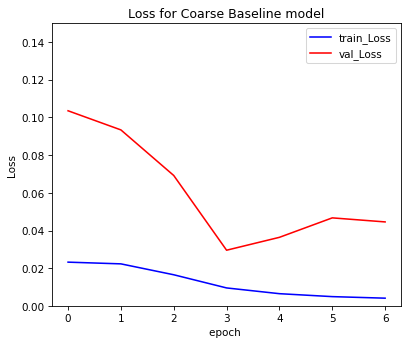

In [5]:
train_loss0 = torch.load('model/model100/loss_train_0_250_epoch7_0')
train_loss1 = torch.load('model/model100/loss_train_0_250_epoch7_1')
train_loss2 = torch.load('model/model100/loss_train_0_250_epoch7_2')
train_loss3 = torch.load('model/model100/loss_train_0_250_epoch7_3')
train_loss4 = torch.load('model/model100/loss_train_0_250_epoch7_4')
train_loss5 = torch.load('model/model100/loss_train_0_250_epoch7_5')
train_loss6 = torch.load('model/model100/loss_train_0_250_epoch7_6')
train_loss = torch.hstack((train_loss0,train_loss1))
train_loss = torch.hstack((train_loss,train_loss2))
train_loss = torch.hstack((train_loss,train_loss3))
train_loss = torch.hstack((train_loss,train_loss4))
train_loss = torch.hstack((train_loss,train_loss5))
train_loss = torch.hstack((train_loss,train_loss6))
#print(train_loss0.size())
#print(torch.mean(train_loss))
train_loss_mean = [torch.mean(train_loss0),torch.mean(train_loss1),torch.mean(train_loss2),torch.mean(train_loss3)]

#print(f'{train_loss0.shape} | {train_loss1.shape} | {train_loss2.shape}| {train_loss3.shape} | {train_loss.shape}')

val_loss0 = torch.load('model/model100/loss_val_0_250_epoch7_0')
val_loss1 = torch.load('model/model100/loss_val_0_250_epoch7_1')
val_loss2 = torch.load('model/model100/loss_val_0_250_epoch7_2')
val_loss3 = torch.load('model/model100/loss_val_0_250_epoch7_3')
val_loss4 = torch.load('model/model100/loss_val_0_250_epoch7_4')
val_loss5 = torch.load('model/model100/loss_val_0_250_epoch7_5')
val_loss6 = torch.load('model/model100/loss_val_0_250_epoch7_6')
val_loss = torch.hstack((val_loss0,val_loss1))
val_loss = torch.hstack((val_loss,val_loss2))
val_loss = torch.hstack((val_loss,val_loss3))
val_loss = torch.hstack((val_loss,val_loss4))
val_loss = torch.hstack((val_loss,val_loss5))
val_loss = torch.hstack((val_loss,val_loss6))
val_loss_mean = [torch.mean(val_loss0),torch.mean(val_loss1),torch.mean(val_loss2),torch.mean(val_loss3)]
#print(f'{val_loss0.shape} | {val_loss1.shape} | {val_loss2.shape}| {val_loss3.shape} | {val_loss.shape}')


def plot_loss(y,title,ylabel):
    x = range(0,len(list(y)))
    plt.plot(y, '.-')
    #plt_title = 'train_loss'
    plt.figsize=(18,5)
    plt.title(title)
    plt.xlabel('batch')
    plt.ylabel(ylabel)
    # plt.savefig(file_name)
    plt.show()

def plot_loss_combine(y1,y2,ymin,ymax,title,title2):
    x = range(0,len(list(y1)))
    fig1 = plt.figure(num='fig111111', figsize=(6, 5), dpi=75, facecolor='#FFFFFF', edgecolor='#0000FF')
    plt.plot(x,y1,'b-',label=f'train_{title}')
    plt.plot(x,y2,'r-',label=f'val_{title}')
    if ymin!= -1 and ymax!=-1:
        plt.ylim(ymin = ymin, ymax=ymax)
    plt.legend()

    plt.title(f'{title} {title2}')
    plt.xlabel('epoch ')
    plt.ylabel(title)
    plt.savefig(f'img/{title} {title2}')
    plt.show()

train_mean_arr = [torch.mean(train_loss0),torch.mean(train_loss1),torch.mean(train_loss2),torch.mean(train_loss3),torch.mean(train_loss4),torch.mean(train_loss5),torch.mean(train_loss6)]
val_mean_arr = [torch.mean(val_loss0),torch.mean(val_loss1),torch.mean(val_loss2),torch.mean(val_loss3),torch.mean(val_loss4),torch.mean(val_loss5),torch.mean(val_loss6)] 

plot_loss_combine(train_mean_arr,val_mean_arr,0,0.15,'Loss','for Coarse Baseline model')

[tensor(0.6358, dtype=torch.float64), tensor(0.6262, dtype=torch.float64), tensor(0.6770, dtype=torch.float64), tensor(0.7431, dtype=torch.float64), tensor(0.7047, dtype=torch.float64), tensor(0.6482, dtype=torch.float64), tensor(0.6468, dtype=torch.float64)]
tensor(0.7431, dtype=torch.float64)


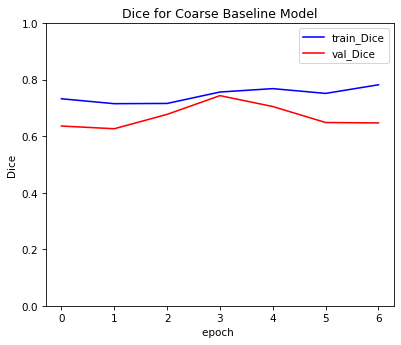

In [60]:
train_dice = []
val_dice = []
val_dice_all = []
for i in range(7):
    temp_train_dice = torch.load(f'model/model100/dice_train_0_250_epoch7_{i}')
    temp_val_dice = torch.load(f'model/model100/dice_val_0_250_epoch7_{i}')
    train_dice.append(torch.mean(temp_train_dice))
    val_dice.append(torch.mean(temp_val_dice))
    #if i != 0:
    #    val_dice_all = torch.hstack((val_dice_all,temp_val_dice))
    #else:
    #    val_dice_all = temp_val_dice
    
#plot_loss(train_dice,'train','Dice')
#plot_loss(val_dice,'val','Dice')
print(val_dice)
print(max(val_dice))
plot_loss_combine(train_dice,val_dice,0,1,'Dice','for Coarse Baseline Model')

In [73]:
def auto_fine_train_val(model_name,epoch_num): # n: epoch number
    m=0
    #n = 1 # epoch number
    fn_loss = nn.BCEWithLogitsLoss().to(device)                        
    net = UNet_fine().to(device)
        
    for epoch in range(epoch_num):
        if os.path.exists(f'model/{model_name}.pth'):
            net.load_state_dict(torch.load(f'model/{model_name}.pth'))
            print('Model load successfully!')
        else:
            print('Model not found!')
        optim = torch.optim.Adam(net.parameters(), lr=1e-3)
        net.train()
        loss_arr_train = []
        diceTumor_arr_train = []
        diceCyst_arr_train = []
        
        for batch, data in enumerate(fine_train_set):
            inputs = data['input']
            inputs = inputs.type(torch.FloatTensor).to(device)
            labels = data['label'].to(device)
                    
            outputs = net(inputs)
            loss = fn_loss(outputs, labels)
        
            optim.zero_grad()  # gradient           
            loss.backward()
            optim.step()

            loss_arr_train += [loss.item()]
            #if labels[0,1,:,:].max() == 1:
            diceTumor_train = dice(mask_normal(outputs[0,1,:,:]),labels[0,1,:,:]).cpu()            
            diceTumor_arr_train.append(diceTumor_train)
            #if labels[0,2,:,:].max() == 1:
            diceCyst_train = dice(mask_normal(outputs[0,2,:,:]),labels[0,2,:,:]).cpu() 
            diceCyst_arr_train.append(diceCyst_train)

            print('Train: epoch %04d | Batch %04d / 15511 | Loss %04f | DiceTumor %04f | DiceCyst %04f' % (
                epoch, batch, np.mean(loss_arr_train), np.mean(diceTumor_arr_train), np.mean(diceCyst_arr_train)))
            #if batch % 20 == 0 and labels[0,1,:,:].max() == 1:
            #    img = torch.stack([torch.unsqueeze(torch_normal(inputs[0,0,:,:]),dim=0),
            #        torch.unsqueeze(labels[0,0,:,:],dim=0),torch.unsqueeze(fine_mask_normal(outputs[0,0,:,:]),dim=0),
            #        torch.unsqueeze(labels[0,1,:,:],dim=0),torch.unsqueeze(fine_mask_normal(outputs[0,1,:,:]),dim=0),
            #        torch.unsqueeze(labels[0,2,:,:],dim=0),torch.unsqueeze(fine_mask_normal(outputs[0,2,:,:]),dim=0)], dim=0)
            #    save_image(img, f'img/{model_name}/{m}.png')
                    
            #    print(f'Img{m} printed!')
            #    m+=1
            #    torch.save(net.state_dict(), f'model/{model_name}.pth')
            #if batch ==100:
            #    break

        # Save Net
        torch.save(net.state_dict(), f'model/{model_name}.pth')
        torch.save(net.state_dict(), f'model/{model_name}_epoch{epoch}.pth')
        
        with torch.no_grad():
            loss_arr_val = []
            diceTumor_arr_val = []
            diceCyst_arr_val = []
                        
            net.eval()
            for batch,data in enumerate(fine_val_set):
                inputs = data['input']
                inputs = inputs.type(torch.FloatTensor).to(device)
                labels = data['label'].to(device)
                    
                outputs = net(inputs)
                loss = fn_loss(outputs, labels)
                loss_arr_val += [loss.item()]
                #if labels[0,1,:,:].max() == 1:
                diceTumor_val = dice(mask_normal(outputs[0,1,:,:]),labels[0,1,:,:]).cpu()            
                diceTumor_arr_val.append(diceTumor_val)
                #if labels[0,2,:,:].max() == 1:
                diceCyst_val = dice(mask_normal(outputs[0,2,:,:]),labels[0,2,:,:]).cpu() 
                diceCyst_arr_val.append(diceCyst_val)
                
                print('Val: epoch %04d | Batch %04d / 15511 | Loss %04f | DiceTumor %04f | DiceCyst %04f' % (
                epoch, batch, np.mean(loss_arr_val), np.mean(diceTumor_arr_val), np.mean(diceCyst_arr_val)))
                #if batch ==50:
                #    break
                
        #Save Loss and Dice
        Loss_train = torch.tensor(loss_arr_train)
        torch.save(Loss_train,f'model/loss_fine_train_epoch{epoch_num}_{epoch}')
        Loss_val = torch.tensor(loss_arr_val)
        torch.save(Loss_val,f'model/loss_fine_val_epoch{epoch_num}_{epoch}')
        
        Dice_tumor_train = torch.tensor(diceTumor_arr_train)
        torch.save(Dice_tumor_train,f'model/dice_fine_train_tumor_epoch{epoch_num}_{epoch}')
        Dice_tumor_val = torch.tensor(diceTumor_arr_val)        
        torch.save(Dice_tumor_val,f'model/dice_fine_val_tumor_epoch{epoch_num}_{epoch}')
        
        Dice_cyst_train = torch.tensor(diceCyst_arr_train)
        torch.save(Dice_cyst_train,f'model/dice_fine_train_cyst_epoch{epoch_num}_{epoch}')
        Dice_cyst_val = torch.tensor(diceCyst_arr_val)
        torch.save(Dice_cyst_val,f'model/dice_fine_val_cyst_epoch{epoch_num}_{epoch}')
        
    print(f'All finished! Print {m-1} imgs.')


fine_train_set = MyDataset_Rotation_fine() 
fine_train_set = DataLoader(fine_train_set, batch_size=2, shuffle=False)
fine_val_set = MyDataset_fine_val() 
fine_val_set = DataLoader(fine_val_set, batch_size=1, shuffle=False)
auto_fine_train_val('model120',2)

Model load successfully!
Train: epoch 0000 | Batch 0000 / 15511 | Loss 0.000010 | DiceTumor 0.999989 | DiceCyst 0.999985
Train: epoch 0000 | Batch 0001 / 15511 | Loss 0.000010 | DiceTumor 0.999945 | DiceCyst 0.998951
Train: epoch 0000 | Batch 0002 / 15511 | Loss 0.000009 | DiceTumor 0.999870 | DiceCyst 0.997881
Train: epoch 0000 | Batch 0003 / 15511 | Loss 0.000010 | DiceTumor 0.999805 | DiceCyst 0.998313
Train: epoch 0000 | Batch 0004 / 15511 | Loss 0.000011 | DiceTumor 0.999721 | DiceCyst 0.998519
Train: epoch 0000 | Batch 0005 / 15511 | Loss 0.000012 | DiceTumor 0.999649 | DiceCyst 0.998638
Train: epoch 0000 | Batch 0006 / 15511 | Loss 0.000014 | DiceTumor 0.999580 | DiceCyst 0.998711
Train: epoch 0000 | Batch 0007 / 15511 | Loss 0.000016 | DiceTumor 0.999507 | DiceCyst 0.998738
Train: epoch 0000 | Batch 0008 / 15511 | Loss 0.000018 | DiceTumor 0.999439 | DiceCyst 0.998752
Train: epoch 0000 | Batch 0009 / 15511 | Loss 0.000020 | DiceTumor 0.999362 | DiceCyst 0.998737
Train: epoch 00

Train: epoch 0000 | Batch 0086 / 15511 | Loss 0.000085 | DiceTumor 0.995663 | DiceCyst 0.993113
Train: epoch 0000 | Batch 0087 / 15511 | Loss 0.000084 | DiceTumor 0.995709 | DiceCyst 0.993126
Train: epoch 0000 | Batch 0088 / 15511 | Loss 0.000083 | DiceTumor 0.995739 | DiceCyst 0.993097
Train: epoch 0000 | Batch 0089 / 15511 | Loss 0.000082 | DiceTumor 0.995777 | DiceCyst 0.993079
Train: epoch 0000 | Batch 0090 / 15511 | Loss 0.000081 | DiceTumor 0.995809 | DiceCyst 0.993049
Train: epoch 0000 | Batch 0091 / 15511 | Loss 0.000080 | DiceTumor 0.995834 | DiceCyst 0.993017
Train: epoch 0000 | Batch 0092 / 15511 | Loss 0.000079 | DiceTumor 0.995871 | DiceCyst 0.993007
Train: epoch 0000 | Batch 0093 / 15511 | Loss 0.000078 | DiceTumor 0.995912 | DiceCyst 0.992998
Train: epoch 0000 | Batch 0094 / 15511 | Loss 0.000078 | DiceTumor 0.995946 | DiceCyst 0.992992
Train: epoch 0000 | Batch 0095 / 15511 | Loss 0.000077 | DiceTumor 0.995979 | DiceCyst 0.992978
Train: epoch 0000 | Batch 0096 / 15511 |

Train: epoch 0000 | Batch 0172 / 15511 | Loss 0.001254 | DiceTumor 0.896522 | DiceCyst 0.982012
Train: epoch 0000 | Batch 0173 / 15511 | Loss 0.001273 | DiceTumor 0.895313 | DiceCyst 0.982026
Train: epoch 0000 | Batch 0174 / 15511 | Loss 0.001291 | DiceTumor 0.893287 | DiceCyst 0.982049
Train: epoch 0000 | Batch 0175 / 15511 | Loss 0.001307 | DiceTumor 0.891445 | DiceCyst 0.982072
Train: epoch 0000 | Batch 0176 / 15511 | Loss 0.001321 | DiceTumor 0.889204 | DiceCyst 0.982096
Train: epoch 0000 | Batch 0177 / 15511 | Loss 0.001330 | DiceTumor 0.886107 | DiceCyst 0.982141
Train: epoch 0000 | Batch 0178 / 15511 | Loss 0.001337 | DiceTumor 0.884170 | DiceCyst 0.982172
Train: epoch 0000 | Batch 0179 / 15511 | Loss 0.001340 | DiceTumor 0.881050 | DiceCyst 0.982202
Train: epoch 0000 | Batch 0180 / 15511 | Loss 0.001344 | DiceTumor 0.876182 | DiceCyst 0.982300
Train: epoch 0000 | Batch 0181 / 15511 | Loss 0.001344 | DiceTumor 0.871368 | DiceCyst 0.982397
Train: epoch 0000 | Batch 0182 / 15511 |

Train: epoch 0000 | Batch 0258 / 15511 | Loss 0.002218 | DiceTumor 0.857682 | DiceCyst 0.947244
Train: epoch 0000 | Batch 0259 / 15511 | Loss 0.002241 | DiceTumor 0.858212 | DiceCyst 0.945038
Train: epoch 0000 | Batch 0260 / 15511 | Loss 0.002257 | DiceTumor 0.858747 | DiceCyst 0.942683
Train: epoch 0000 | Batch 0261 / 15511 | Loss 0.002264 | DiceTumor 0.859268 | DiceCyst 0.940072
Train: epoch 0000 | Batch 0262 / 15511 | Loss 0.002264 | DiceTumor 0.859786 | DiceCyst 0.937067
Train: epoch 0000 | Batch 0263 / 15511 | Loss 0.002260 | DiceTumor 0.860303 | DiceCyst 0.933739
Train: epoch 0000 | Batch 0264 / 15511 | Loss 0.002253 | DiceTumor 0.860812 | DiceCyst 0.930309
Train: epoch 0000 | Batch 0265 / 15511 | Loss 0.002247 | DiceTumor 0.861325 | DiceCyst 0.930547
Train: epoch 0000 | Batch 0266 / 15511 | Loss 0.002241 | DiceTumor 0.861826 | DiceCyst 0.930782
Train: epoch 0000 | Batch 0267 / 15511 | Loss 0.002235 | DiceTumor 0.862325 | DiceCyst 0.931014
Train: epoch 0000 | Batch 0268 / 15511 |

Train: epoch 0000 | Batch 0344 / 15511 | Loss 0.002358 | DiceTumor 0.870110 | DiceCyst 0.915742
Train: epoch 0000 | Batch 0345 / 15511 | Loss 0.002355 | DiceTumor 0.870481 | DiceCyst 0.915960
Train: epoch 0000 | Batch 0346 / 15511 | Loss 0.002351 | DiceTumor 0.870847 | DiceCyst 0.916175
Train: epoch 0000 | Batch 0347 / 15511 | Loss 0.002348 | DiceTumor 0.871213 | DiceCyst 0.916389
Train: epoch 0000 | Batch 0348 / 15511 | Loss 0.002345 | DiceTumor 0.871575 | DiceCyst 0.916600
Train: epoch 0000 | Batch 0349 / 15511 | Loss 0.002345 | DiceTumor 0.871935 | DiceCyst 0.916808
Train: epoch 0000 | Batch 0350 / 15511 | Loss 0.002347 | DiceTumor 0.872276 | DiceCyst 0.917045
Train: epoch 0000 | Batch 0351 / 15511 | Loss 0.002344 | DiceTumor 0.872632 | DiceCyst 0.917250
Train: epoch 0000 | Batch 0352 / 15511 | Loss 0.002341 | DiceTumor 0.872983 | DiceCyst 0.917453
Train: epoch 0000 | Batch 0353 / 15511 | Loss 0.002337 | DiceTumor 0.873335 | DiceCyst 0.917656
Train: epoch 0000 | Batch 0354 / 15511 |

Train: epoch 0000 | Batch 0430 / 15511 | Loss 0.002145 | DiceTumor 0.867530 | DiceCyst 0.931283
Train: epoch 0000 | Batch 0431 / 15511 | Loss 0.002140 | DiceTumor 0.867831 | DiceCyst 0.931435
Train: epoch 0000 | Batch 0432 / 15511 | Loss 0.002136 | DiceTumor 0.868133 | DiceCyst 0.931585
Train: epoch 0000 | Batch 0433 / 15511 | Loss 0.002131 | DiceTumor 0.868434 | DiceCyst 0.931734
Train: epoch 0000 | Batch 0434 / 15511 | Loss 0.002126 | DiceTumor 0.868732 | DiceCyst 0.931883
Train: epoch 0000 | Batch 0435 / 15511 | Loss 0.002121 | DiceTumor 0.869028 | DiceCyst 0.932031
Train: epoch 0000 | Batch 0436 / 15511 | Loss 0.002117 | DiceTumor 0.869323 | DiceCyst 0.932178
Train: epoch 0000 | Batch 0437 / 15511 | Loss 0.002112 | DiceTumor 0.869615 | DiceCyst 0.932324
Train: epoch 0000 | Batch 0438 / 15511 | Loss 0.002108 | DiceTumor 0.869749 | DiceCyst 0.932469
Train: epoch 0000 | Batch 0439 / 15511 | Loss 0.002103 | DiceTumor 0.869733 | DiceCyst 0.932613
Train: epoch 0000 | Batch 0440 / 15511 |

Train: epoch 0000 | Batch 0516 / 15511 | Loss 0.002530 | DiceTumor 0.819519 | DiceCyst 0.941291
Train: epoch 0000 | Batch 0517 / 15511 | Loss 0.002525 | DiceTumor 0.819855 | DiceCyst 0.941391
Train: epoch 0000 | Batch 0518 / 15511 | Loss 0.002520 | DiceTumor 0.820190 | DiceCyst 0.941492
Train: epoch 0000 | Batch 0519 / 15511 | Loss 0.002516 | DiceTumor 0.820524 | DiceCyst 0.941593
Train: epoch 0000 | Batch 0520 / 15511 | Loss 0.002511 | DiceTumor 0.820857 | DiceCyst 0.941694
Train: epoch 0000 | Batch 0521 / 15511 | Loss 0.002507 | DiceTumor 0.821190 | DiceCyst 0.941795
Train: epoch 0000 | Batch 0522 / 15511 | Loss 0.002502 | DiceTumor 0.821521 | DiceCyst 0.941895
Train: epoch 0000 | Batch 0523 / 15511 | Loss 0.002498 | DiceTumor 0.821852 | DiceCyst 0.941996
Train: epoch 0000 | Batch 0524 / 15511 | Loss 0.002493 | DiceTumor 0.822182 | DiceCyst 0.942097
Train: epoch 0000 | Batch 0525 / 15511 | Loss 0.002488 | DiceTumor 0.822512 | DiceCyst 0.942199
Train: epoch 0000 | Batch 0526 / 15511 |

Train: epoch 0000 | Batch 0602 / 15511 | Loss 0.003460 | DiceTumor 0.815862 | DiceCyst 0.929490
Train: epoch 0000 | Batch 0603 / 15511 | Loss 0.003459 | DiceTumor 0.816152 | DiceCyst 0.929589
Train: epoch 0000 | Batch 0604 / 15511 | Loss 0.003457 | DiceTumor 0.816446 | DiceCyst 0.929689
Train: epoch 0000 | Batch 0605 / 15511 | Loss 0.003454 | DiceTumor 0.816738 | DiceCyst 0.929791
Train: epoch 0000 | Batch 0606 / 15511 | Loss 0.003449 | DiceTumor 0.817036 | DiceCyst 0.929896
Train: epoch 0000 | Batch 0607 / 15511 | Loss 0.003444 | DiceTumor 0.817331 | DiceCyst 0.930003
Train: epoch 0000 | Batch 0608 / 15511 | Loss 0.003439 | DiceTumor 0.817629 | DiceCyst 0.930113
Train: epoch 0000 | Batch 0609 / 15511 | Loss 0.003433 | DiceTumor 0.817927 | DiceCyst 0.930226
Train: epoch 0000 | Batch 0610 / 15511 | Loss 0.003429 | DiceTumor 0.818224 | DiceCyst 0.930337
Train: epoch 0000 | Batch 0611 / 15511 | Loss 0.003428 | DiceTumor 0.817457 | DiceCyst 0.930444
Train: epoch 0000 | Batch 0612 / 15511 |

Train: epoch 0000 | Batch 0688 / 15511 | Loss 0.003574 | DiceTumor 0.822836 | DiceCyst 0.937006
Train: epoch 0000 | Batch 0689 / 15511 | Loss 0.003578 | DiceTumor 0.822890 | DiceCyst 0.937074
Train: epoch 0000 | Batch 0690 / 15511 | Loss 0.003584 | DiceTumor 0.823081 | DiceCyst 0.937141
Train: epoch 0000 | Batch 0691 / 15511 | Loss 0.003588 | DiceTumor 0.823248 | DiceCyst 0.937211
Train: epoch 0000 | Batch 0692 / 15511 | Loss 0.003591 | DiceTumor 0.823275 | DiceCyst 0.937284
Train: epoch 0000 | Batch 0693 / 15511 | Loss 0.003590 | DiceTumor 0.822601 | DiceCyst 0.937362
Train: epoch 0000 | Batch 0694 / 15511 | Loss 0.003585 | DiceTumor 0.822851 | DiceCyst 0.937446
Train: epoch 0000 | Batch 0695 / 15511 | Loss 0.003580 | DiceTumor 0.823103 | DiceCyst 0.937528
Train: epoch 0000 | Batch 0696 / 15511 | Loss 0.003575 | DiceTumor 0.823357 | DiceCyst 0.937617
Train: epoch 0000 | Batch 0697 / 15511 | Loss 0.003570 | DiceTumor 0.823610 | DiceCyst 0.937704
Train: epoch 0000 | Batch 0698 / 15511 |

Train: epoch 0000 | Batch 0774 / 15511 | Loss 0.003431 | DiceTumor 0.819354 | DiceCyst 0.935675
Train: epoch 0000 | Batch 0775 / 15511 | Loss 0.003427 | DiceTumor 0.819585 | DiceCyst 0.935752
Train: epoch 0000 | Batch 0776 / 15511 | Loss 0.003423 | DiceTumor 0.819817 | DiceCyst 0.935834
Train: epoch 0000 | Batch 0777 / 15511 | Loss 0.003418 | DiceTumor 0.820046 | DiceCyst 0.935914
Train: epoch 0000 | Batch 0778 / 15511 | Loss 0.003414 | DiceTumor 0.820273 | DiceCyst 0.935989
Train: epoch 0000 | Batch 0779 / 15511 | Loss 0.003411 | DiceTumor 0.820495 | DiceCyst 0.936059
Train: epoch 0000 | Batch 0780 / 15511 | Loss 0.003410 | DiceTumor 0.820710 | DiceCyst 0.936124
Train: epoch 0000 | Batch 0781 / 15511 | Loss 0.003416 | DiceTumor 0.819985 | DiceCyst 0.936183
Train: epoch 0000 | Batch 0782 / 15511 | Loss 0.003427 | DiceTumor 0.819765 | DiceCyst 0.936237
Train: epoch 0000 | Batch 0783 / 15511 | Loss 0.003440 | DiceTumor 0.819414 | DiceCyst 0.936289
Train: epoch 0000 | Batch 0784 / 15511 |

Train: epoch 0000 | Batch 0860 / 15511 | Loss 0.003331 | DiceTumor 0.815517 | DiceCyst 0.939858
Train: epoch 0000 | Batch 0861 / 15511 | Loss 0.003328 | DiceTumor 0.815724 | DiceCyst 0.939914
Train: epoch 0000 | Batch 0862 / 15511 | Loss 0.003325 | DiceTumor 0.815924 | DiceCyst 0.939970
Train: epoch 0000 | Batch 0863 / 15511 | Loss 0.003322 | DiceTumor 0.816124 | DiceCyst 0.940024
Train: epoch 0000 | Batch 0864 / 15511 | Loss 0.003318 | DiceTumor 0.816331 | DiceCyst 0.940080
Train: epoch 0000 | Batch 0865 / 15511 | Loss 0.003315 | DiceTumor 0.816538 | DiceCyst 0.940138
Train: epoch 0000 | Batch 0866 / 15511 | Loss 0.003311 | DiceTumor 0.816745 | DiceCyst 0.940199
Train: epoch 0000 | Batch 0867 / 15511 | Loss 0.003308 | DiceTumor 0.816952 | DiceCyst 0.940264
Train: epoch 0000 | Batch 0868 / 15511 | Loss 0.003304 | DiceTumor 0.817162 | DiceCyst 0.940329
Train: epoch 0000 | Batch 0869 / 15511 | Loss 0.003308 | DiceTumor 0.817107 | DiceCyst 0.940398
Train: epoch 0000 | Batch 0870 / 15511 |

Train: epoch 0000 | Batch 0946 / 15511 | Loss 0.003125 | DiceTumor 0.829826 | DiceCyst 0.938057
Train: epoch 0000 | Batch 0947 / 15511 | Loss 0.003123 | DiceTumor 0.829993 | DiceCyst 0.938108
Train: epoch 0000 | Batch 0948 / 15511 | Loss 0.003120 | DiceTumor 0.830160 | DiceCyst 0.938159
Train: epoch 0000 | Batch 0949 / 15511 | Loss 0.003117 | DiceTumor 0.830335 | DiceCyst 0.938210
Train: epoch 0000 | Batch 0950 / 15511 | Loss 0.003114 | DiceTumor 0.830506 | DiceCyst 0.938261
Train: epoch 0000 | Batch 0951 / 15511 | Loss 0.003111 | DiceTumor 0.830675 | DiceCyst 0.938312
Train: epoch 0000 | Batch 0952 / 15511 | Loss 0.003108 | DiceTumor 0.830850 | DiceCyst 0.938363
Train: epoch 0000 | Batch 0953 / 15511 | Loss 0.003105 | DiceTumor 0.831017 | DiceCyst 0.938415
Train: epoch 0000 | Batch 0954 / 15511 | Loss 0.003102 | DiceTumor 0.831188 | DiceCyst 0.938466
Train: epoch 0000 | Batch 0955 / 15511 | Loss 0.003099 | DiceTumor 0.831359 | DiceCyst 0.938518
Train: epoch 0000 | Batch 0956 / 15511 |

Train: epoch 0000 | Batch 1032 / 15511 | Loss 0.003503 | DiceTumor 0.822707 | DiceCyst 0.941274
Train: epoch 0000 | Batch 1033 / 15511 | Loss 0.003522 | DiceTumor 0.822817 | DiceCyst 0.941291
Train: epoch 0000 | Batch 1034 / 15511 | Loss 0.003543 | DiceTumor 0.822856 | DiceCyst 0.941308
Train: epoch 0000 | Batch 1035 / 15511 | Loss 0.003553 | DiceTumor 0.822960 | DiceCyst 0.941326
Train: epoch 0000 | Batch 1036 / 15511 | Loss 0.003561 | DiceTumor 0.823072 | DiceCyst 0.941345
Train: epoch 0000 | Batch 1037 / 15511 | Loss 0.003570 | DiceTumor 0.823168 | DiceCyst 0.941366
Train: epoch 0000 | Batch 1038 / 15511 | Loss 0.003579 | DiceTumor 0.823258 | DiceCyst 0.941391
Train: epoch 0000 | Batch 1039 / 15511 | Loss 0.003589 | DiceTumor 0.823302 | DiceCyst 0.941418
Train: epoch 0000 | Batch 1040 / 15511 | Loss 0.003598 | DiceTumor 0.823250 | DiceCyst 0.941449
Train: epoch 0000 | Batch 1041 / 15511 | Loss 0.003605 | DiceTumor 0.822933 | DiceCyst 0.941485
Train: epoch 0000 | Batch 1042 / 15511 |

Train: epoch 0000 | Batch 1118 / 15511 | Loss 0.003848 | DiceTumor 0.828323 | DiceCyst 0.936169
Train: epoch 0000 | Batch 1119 / 15511 | Loss 0.003846 | DiceTumor 0.828467 | DiceCyst 0.936215
Train: epoch 0000 | Batch 1120 / 15511 | Loss 0.003844 | DiceTumor 0.828609 | DiceCyst 0.936261
Train: epoch 0000 | Batch 1121 / 15511 | Loss 0.003842 | DiceTumor 0.828752 | DiceCyst 0.936307
Train: epoch 0000 | Batch 1122 / 15511 | Loss 0.003840 | DiceTumor 0.828894 | DiceCyst 0.936353
Train: epoch 0000 | Batch 1123 / 15511 | Loss 0.003838 | DiceTumor 0.829035 | DiceCyst 0.936397
Train: epoch 0000 | Batch 1124 / 15511 | Loss 0.003835 | DiceTumor 0.829175 | DiceCyst 0.936442
Train: epoch 0000 | Batch 1125 / 15511 | Loss 0.003833 | DiceTumor 0.829316 | DiceCyst 0.936487
Train: epoch 0000 | Batch 1126 / 15511 | Loss 0.003831 | DiceTumor 0.829460 | DiceCyst 0.936532
Train: epoch 0000 | Batch 1127 / 15511 | Loss 0.003829 | DiceTumor 0.829600 | DiceCyst 0.936576
Train: epoch 0000 | Batch 1128 / 15511 |

Train: epoch 0000 | Batch 1204 / 15511 | Loss 0.003660 | DiceTumor 0.823665 | DiceCyst 0.926491
Train: epoch 0000 | Batch 1205 / 15511 | Loss 0.003657 | DiceTumor 0.823811 | DiceCyst 0.925787
Train: epoch 0000 | Batch 1206 / 15511 | Loss 0.003654 | DiceTumor 0.823957 | DiceCyst 0.925845
Train: epoch 0000 | Batch 1207 / 15511 | Loss 0.003651 | DiceTumor 0.824102 | DiceCyst 0.925120
Train: epoch 0000 | Batch 1208 / 15511 | Loss 0.003648 | DiceTumor 0.824248 | DiceCyst 0.924389
Train: epoch 0000 | Batch 1209 / 15511 | Loss 0.003645 | DiceTumor 0.824393 | DiceCyst 0.923661
Train: epoch 0000 | Batch 1210 / 15511 | Loss 0.003642 | DiceTumor 0.824538 | DiceCyst 0.922937
Train: epoch 0000 | Batch 1211 / 15511 | Loss 0.003649 | DiceTumor 0.824033 | DiceCyst 0.923000
Train: epoch 0000 | Batch 1212 / 15511 | Loss 0.003668 | DiceTumor 0.824167 | DiceCyst 0.923061
Train: epoch 0000 | Batch 1213 / 15511 | Loss 0.003692 | DiceTumor 0.824305 | DiceCyst 0.923120
Train: epoch 0000 | Batch 1214 / 15511 |

Train: epoch 0000 | Batch 1290 / 15511 | Loss 0.004337 | DiceTumor 0.823654 | DiceCyst 0.920729
Train: epoch 0000 | Batch 1291 / 15511 | Loss 0.004335 | DiceTumor 0.823782 | DiceCyst 0.920781
Train: epoch 0000 | Batch 1292 / 15511 | Loss 0.004333 | DiceTumor 0.823910 | DiceCyst 0.920834
Train: epoch 0000 | Batch 1293 / 15511 | Loss 0.004331 | DiceTumor 0.824039 | DiceCyst 0.920888
Train: epoch 0000 | Batch 1294 / 15511 | Loss 0.004330 | DiceTumor 0.824167 | DiceCyst 0.920941
Train: epoch 0000 | Batch 1295 / 15511 | Loss 0.004327 | DiceTumor 0.824296 | DiceCyst 0.920995
Train: epoch 0000 | Batch 1296 / 15511 | Loss 0.004325 | DiceTumor 0.824426 | DiceCyst 0.921050
Train: epoch 0000 | Batch 1297 / 15511 | Loss 0.004322 | DiceTumor 0.824556 | DiceCyst 0.921105
Train: epoch 0000 | Batch 1298 / 15511 | Loss 0.004320 | DiceTumor 0.824687 | DiceCyst 0.921162
Train: epoch 0000 | Batch 1299 / 15511 | Loss 0.004317 | DiceTumor 0.824819 | DiceCyst 0.921219
Train: epoch 0000 | Batch 1300 / 15511 |

Train: epoch 0000 | Batch 1376 / 15511 | Loss 0.004187 | DiceTumor 0.825530 | DiceCyst 0.922218
Train: epoch 0000 | Batch 1377 / 15511 | Loss 0.004183 | DiceTumor 0.825656 | DiceCyst 0.922273
Train: epoch 0000 | Batch 1378 / 15511 | Loss 0.004180 | DiceTumor 0.825779 | DiceCyst 0.922324
Train: epoch 0000 | Batch 1379 / 15511 | Loss 0.004178 | DiceTumor 0.825900 | DiceCyst 0.922371
Train: epoch 0000 | Batch 1380 / 15511 | Loss 0.004175 | DiceTumor 0.826020 | DiceCyst 0.922419
Train: epoch 0000 | Batch 1381 / 15511 | Loss 0.004175 | DiceTumor 0.825481 | DiceCyst 0.922465
Train: epoch 0000 | Batch 1382 / 15511 | Loss 0.004179 | DiceTumor 0.825069 | DiceCyst 0.922511
Train: epoch 0000 | Batch 1383 / 15511 | Loss 0.004183 | DiceTumor 0.824676 | DiceCyst 0.922555
Train: epoch 0000 | Batch 1384 / 15511 | Loss 0.004182 | DiceTumor 0.824198 | DiceCyst 0.922601
Train: epoch 0000 | Batch 1385 / 15511 | Loss 0.004179 | DiceTumor 0.823607 | DiceCyst 0.922647
Train: epoch 0000 | Batch 1386 / 15511 |

Train: epoch 0000 | Batch 1462 / 15511 | Loss 0.004409 | DiceTumor 0.821178 | DiceCyst 0.917316
Train: epoch 0000 | Batch 1463 / 15511 | Loss 0.004406 | DiceTumor 0.821296 | DiceCyst 0.917367
Train: epoch 0000 | Batch 1464 / 15511 | Loss 0.004404 | DiceTumor 0.820743 | DiceCyst 0.917418
Train: epoch 0000 | Batch 1465 / 15511 | Loss 0.004404 | DiceTumor 0.820325 | DiceCyst 0.917469
Train: epoch 0000 | Batch 1466 / 15511 | Loss 0.004404 | DiceTumor 0.819956 | DiceCyst 0.917520
Train: epoch 0000 | Batch 1467 / 15511 | Loss 0.004405 | DiceTumor 0.819609 | DiceCyst 0.917570
Train: epoch 0000 | Batch 1468 / 15511 | Loss 0.004405 | DiceTumor 0.819268 | DiceCyst 0.917621
Train: epoch 0000 | Batch 1469 / 15511 | Loss 0.004404 | DiceTumor 0.818861 | DiceCyst 0.917672
Train: epoch 0000 | Batch 1470 / 15511 | Loss 0.004401 | DiceTumor 0.818980 | DiceCyst 0.917724
Train: epoch 0000 | Batch 1471 / 15511 | Loss 0.004399 | DiceTumor 0.819099 | DiceCyst 0.917775
Train: epoch 0000 | Batch 1472 / 15511 |

Train: epoch 0000 | Batch 1548 / 15511 | Loss 0.004323 | DiceTumor 0.823082 | DiceCyst 0.920206
Train: epoch 0000 | Batch 1549 / 15511 | Loss 0.004329 | DiceTumor 0.823167 | DiceCyst 0.920234
Train: epoch 0000 | Batch 1550 / 15511 | Loss 0.004334 | DiceTumor 0.823242 | DiceCyst 0.920261
Train: epoch 0000 | Batch 1551 / 15511 | Loss 0.004339 | DiceTumor 0.823330 | DiceCyst 0.920287
Train: epoch 0000 | Batch 1552 / 15511 | Loss 0.004346 | DiceTumor 0.823377 | DiceCyst 0.920312
Train: epoch 0000 | Batch 1553 / 15511 | Loss 0.004350 | DiceTumor 0.823469 | DiceCyst 0.920336
Train: epoch 0000 | Batch 1554 / 15511 | Loss 0.004357 | DiceTumor 0.823535 | DiceCyst 0.920359
Train: epoch 0000 | Batch 1555 / 15511 | Loss 0.004361 | DiceTumor 0.823628 | DiceCyst 0.920382
Train: epoch 0000 | Batch 1556 / 15511 | Loss 0.004367 | DiceTumor 0.823709 | DiceCyst 0.920404
Train: epoch 0000 | Batch 1557 / 15511 | Loss 0.004372 | DiceTumor 0.823790 | DiceCyst 0.920424
Train: epoch 0000 | Batch 1558 / 15511 |

Train: epoch 0000 | Batch 1634 / 15511 | Loss 0.004946 | DiceTumor 0.825219 | DiceCyst 0.922959
Train: epoch 0000 | Batch 1635 / 15511 | Loss 0.004944 | DiceTumor 0.825210 | DiceCyst 0.922414
Train: epoch 0000 | Batch 1636 / 15511 | Loss 0.004941 | DiceTumor 0.825315 | DiceCyst 0.922458
Train: epoch 0000 | Batch 1637 / 15511 | Loss 0.004942 | DiceTumor 0.825031 | DiceCyst 0.922500
Train: epoch 0000 | Batch 1638 / 15511 | Loss 0.004945 | DiceTumor 0.824778 | DiceCyst 0.922539
Train: epoch 0000 | Batch 1639 / 15511 | Loss 0.004949 | DiceTumor 0.824716 | DiceCyst 0.922575
Train: epoch 0000 | Batch 1640 / 15511 | Loss 0.004953 | DiceTumor 0.824535 | DiceCyst 0.922611
Train: epoch 0000 | Batch 1641 / 15511 | Loss 0.004957 | DiceTumor 0.824318 | DiceCyst 0.922646
Train: epoch 0000 | Batch 1642 / 15511 | Loss 0.004958 | DiceTumor 0.824072 | DiceCyst 0.922685
Train: epoch 0000 | Batch 1643 / 15511 | Loss 0.004958 | DiceTumor 0.823697 | DiceCyst 0.922723
Train: epoch 0000 | Batch 1644 / 15511 |

Train: epoch 0000 | Batch 1720 / 15511 | Loss 0.004967 | DiceTumor 0.822252 | DiceCyst 0.922524
Train: epoch 0000 | Batch 1721 / 15511 | Loss 0.004965 | DiceTumor 0.822355 | DiceCyst 0.922569
Train: epoch 0000 | Batch 1722 / 15511 | Loss 0.004962 | DiceTumor 0.822458 | DiceCyst 0.922613
Train: epoch 0000 | Batch 1723 / 15511 | Loss 0.004959 | DiceTumor 0.822560 | DiceCyst 0.922657
Train: epoch 0000 | Batch 1724 / 15511 | Loss 0.004956 | DiceTumor 0.822662 | DiceCyst 0.922701
Train: epoch 0000 | Batch 1725 / 15511 | Loss 0.004953 | DiceTumor 0.822764 | DiceCyst 0.922744
Train: epoch 0000 | Batch 1726 / 15511 | Loss 0.004951 | DiceTumor 0.822864 | DiceCyst 0.922787
Train: epoch 0000 | Batch 1727 / 15511 | Loss 0.004948 | DiceTumor 0.822965 | DiceCyst 0.922829
Train: epoch 0000 | Batch 1728 / 15511 | Loss 0.004946 | DiceTumor 0.823065 | DiceCyst 0.922871
Train: epoch 0000 | Batch 1729 / 15511 | Loss 0.004944 | DiceTumor 0.823164 | DiceCyst 0.922912
Train: epoch 0000 | Batch 1730 / 15511 |

Train: epoch 0000 | Batch 1806 / 15511 | Loss 0.004822 | DiceTumor 0.819726 | DiceCyst 0.925619
Train: epoch 0000 | Batch 1807 / 15511 | Loss 0.004819 | DiceTumor 0.819823 | DiceCyst 0.925654
Train: epoch 0000 | Batch 1808 / 15511 | Loss 0.004817 | DiceTumor 0.819921 | DiceCyst 0.925687
Train: epoch 0000 | Batch 1809 / 15511 | Loss 0.004814 | DiceTumor 0.820018 | DiceCyst 0.925721
Train: epoch 0000 | Batch 1810 / 15511 | Loss 0.004811 | DiceTumor 0.820116 | DiceCyst 0.925756
Train: epoch 0000 | Batch 1811 / 15511 | Loss 0.004809 | DiceTumor 0.820214 | DiceCyst 0.925791
Train: epoch 0000 | Batch 1812 / 15511 | Loss 0.004806 | DiceTumor 0.820313 | DiceCyst 0.925828
Train: epoch 0000 | Batch 1813 / 15511 | Loss 0.004804 | DiceTumor 0.820412 | DiceCyst 0.925863
Train: epoch 0000 | Batch 1814 / 15511 | Loss 0.004801 | DiceTumor 0.820511 | DiceCyst 0.925898
Train: epoch 0000 | Batch 1815 / 15511 | Loss 0.004798 | DiceTumor 0.820609 | DiceCyst 0.925932
Train: epoch 0000 | Batch 1816 / 15511 |

Train: epoch 0000 | Batch 1892 / 15511 | Loss 0.004674 | DiceTumor 0.822149 | DiceCyst 0.920316
Train: epoch 0000 | Batch 1893 / 15511 | Loss 0.004672 | DiceTumor 0.821756 | DiceCyst 0.920355
Train: epoch 0000 | Batch 1894 / 15511 | Loss 0.004671 | DiceTumor 0.821387 | DiceCyst 0.920394
Train: epoch 0000 | Batch 1895 / 15511 | Loss 0.004670 | DiceTumor 0.821028 | DiceCyst 0.920432
Train: epoch 0000 | Batch 1896 / 15511 | Loss 0.004670 | DiceTumor 0.820682 | DiceCyst 0.920470
Train: epoch 0000 | Batch 1897 / 15511 | Loss 0.004669 | DiceTumor 0.820355 | DiceCyst 0.920508
Train: epoch 0000 | Batch 1898 / 15511 | Loss 0.004670 | DiceTumor 0.820040 | DiceCyst 0.920546
Train: epoch 0000 | Batch 1899 / 15511 | Loss 0.004670 | DiceTumor 0.819734 | DiceCyst 0.920583
Train: epoch 0000 | Batch 1900 / 15511 | Loss 0.004671 | DiceTumor 0.819430 | DiceCyst 0.920620
Train: epoch 0000 | Batch 1901 / 15511 | Loss 0.004672 | DiceTumor 0.819133 | DiceCyst 0.920657
Train: epoch 0000 | Batch 1902 / 15511 |

Train: epoch 0000 | Batch 1978 / 15511 | Loss 0.004563 | DiceTumor 0.817872 | DiceCyst 0.923355
Train: epoch 0000 | Batch 1979 / 15511 | Loss 0.004560 | DiceTumor 0.817961 | DiceCyst 0.923390
Train: epoch 0000 | Batch 1980 / 15511 | Loss 0.004558 | DiceTumor 0.818050 | DiceCyst 0.923426
Train: epoch 0000 | Batch 1981 / 15511 | Loss 0.004556 | DiceTumor 0.818139 | DiceCyst 0.923462
Train: epoch 0000 | Batch 1982 / 15511 | Loss 0.004554 | DiceTumor 0.818228 | DiceCyst 0.923498
Train: epoch 0000 | Batch 1983 / 15511 | Loss 0.004551 | DiceTumor 0.818317 | DiceCyst 0.923534
Train: epoch 0000 | Batch 1984 / 15511 | Loss 0.004549 | DiceTumor 0.818406 | DiceCyst 0.923570
Train: epoch 0000 | Batch 1985 / 15511 | Loss 0.004547 | DiceTumor 0.818496 | DiceCyst 0.923606
Train: epoch 0000 | Batch 1986 / 15511 | Loss 0.004545 | DiceTumor 0.818585 | DiceCyst 0.923642
Train: epoch 0000 | Batch 1987 / 15511 | Loss 0.004542 | DiceTumor 0.818675 | DiceCyst 0.923679
Train: epoch 0000 | Batch 1988 / 15511 |

Train: epoch 0000 | Batch 2064 / 15511 | Loss 0.004570 | DiceTumor 0.812735 | DiceCyst 0.925607
Train: epoch 0000 | Batch 2065 / 15511 | Loss 0.004570 | DiceTumor 0.812395 | DiceCyst 0.925637
Train: epoch 0000 | Batch 2066 / 15511 | Loss 0.004568 | DiceTumor 0.812031 | DiceCyst 0.925669
Train: epoch 0000 | Batch 2067 / 15511 | Loss 0.004567 | DiceTumor 0.812118 | DiceCyst 0.925700
Train: epoch 0000 | Batch 2068 / 15511 | Loss 0.004566 | DiceTumor 0.812207 | DiceCyst 0.925731
Train: epoch 0000 | Batch 2069 / 15511 | Loss 0.004564 | DiceTumor 0.812295 | DiceCyst 0.925762
Train: epoch 0000 | Batch 2070 / 15511 | Loss 0.004562 | DiceTumor 0.812384 | DiceCyst 0.925794
Train: epoch 0000 | Batch 2071 / 15511 | Loss 0.004561 | DiceTumor 0.812471 | DiceCyst 0.925826
Train: epoch 0000 | Batch 2072 / 15511 | Loss 0.004559 | DiceTumor 0.812560 | DiceCyst 0.925858
Train: epoch 0000 | Batch 2073 / 15511 | Loss 0.004557 | DiceTumor 0.812649 | DiceCyst 0.925890
Train: epoch 0000 | Batch 2074 / 15511 |

Train: epoch 0000 | Batch 2150 / 15511 | Loss 0.004637 | DiceTumor 0.815920 | DiceCyst 0.926361
Train: epoch 0000 | Batch 2151 / 15511 | Loss 0.004635 | DiceTumor 0.816005 | DiceCyst 0.926394
Train: epoch 0000 | Batch 2152 / 15511 | Loss 0.004633 | DiceTumor 0.816089 | DiceCyst 0.926426
Train: epoch 0000 | Batch 2153 / 15511 | Loss 0.004631 | DiceTumor 0.816174 | DiceCyst 0.926458
Train: epoch 0000 | Batch 2154 / 15511 | Loss 0.004630 | DiceTumor 0.816258 | DiceCyst 0.926487
Train: epoch 0000 | Batch 2155 / 15511 | Loss 0.004629 | DiceTumor 0.816343 | DiceCyst 0.926517
Train: epoch 0000 | Batch 2156 / 15511 | Loss 0.004629 | DiceTumor 0.815970 | DiceCyst 0.926544
Train: epoch 0000 | Batch 2157 / 15511 | Loss 0.004631 | DiceTumor 0.815746 | DiceCyst 0.926572
Train: epoch 0000 | Batch 2158 / 15511 | Loss 0.004635 | DiceTumor 0.815637 | DiceCyst 0.926598
Train: epoch 0000 | Batch 2159 / 15511 | Loss 0.004640 | DiceTumor 0.815302 | DiceCyst 0.926624
Train: epoch 0000 | Batch 2160 / 15511 |

Train: epoch 0000 | Batch 2236 / 15511 | Loss 0.004675 | DiceTumor 0.810795 | DiceCyst 0.926728
Train: epoch 0000 | Batch 2237 / 15511 | Loss 0.004674 | DiceTumor 0.810877 | DiceCyst 0.926756
Train: epoch 0000 | Batch 2238 / 15511 | Loss 0.004673 | DiceTumor 0.810958 | DiceCyst 0.926784
Train: epoch 0000 | Batch 2239 / 15511 | Loss 0.004673 | DiceTumor 0.811040 | DiceCyst 0.926812
Train: epoch 0000 | Batch 2240 / 15511 | Loss 0.004672 | DiceTumor 0.811122 | DiceCyst 0.926839
Train: epoch 0000 | Batch 2241 / 15511 | Loss 0.004671 | DiceTumor 0.811202 | DiceCyst 0.926867
Train: epoch 0000 | Batch 2242 / 15511 | Loss 0.004670 | DiceTumor 0.811286 | DiceCyst 0.926894
Train: epoch 0000 | Batch 2243 / 15511 | Loss 0.004670 | DiceTumor 0.811366 | DiceCyst 0.926921
Train: epoch 0000 | Batch 2244 / 15511 | Loss 0.004669 | DiceTumor 0.811446 | DiceCyst 0.926948
Train: epoch 0000 | Batch 2245 / 15511 | Loss 0.004668 | DiceTumor 0.811530 | DiceCyst 0.926975
Train: epoch 0000 | Batch 2246 / 15511 |

Train: epoch 0000 | Batch 2322 / 15511 | Loss 0.004543 | DiceTumor 0.817594 | DiceCyst 0.929132
Train: epoch 0000 | Batch 2323 / 15511 | Loss 0.004542 | DiceTumor 0.817672 | DiceCyst 0.929160
Train: epoch 0000 | Batch 2324 / 15511 | Loss 0.004540 | DiceTumor 0.817750 | DiceCyst 0.929187
Train: epoch 0000 | Batch 2325 / 15511 | Loss 0.004538 | DiceTumor 0.817829 | DiceCyst 0.929212
Train: epoch 0000 | Batch 2326 / 15511 | Loss 0.004536 | DiceTumor 0.817907 | DiceCyst 0.928820
Train: epoch 0000 | Batch 2327 / 15511 | Loss 0.004534 | DiceTumor 0.817985 | DiceCyst 0.928429
Train: epoch 0000 | Batch 2328 / 15511 | Loss 0.004532 | DiceTumor 0.818063 | DiceCyst 0.928460
Train: epoch 0000 | Batch 2329 / 15511 | Loss 0.004531 | DiceTumor 0.818141 | DiceCyst 0.928228
Train: epoch 0000 | Batch 2330 / 15511 | Loss 0.004533 | DiceTumor 0.818218 | DiceCyst 0.928019
Train: epoch 0000 | Batch 2331 / 15511 | Loss 0.004536 | DiceTumor 0.818294 | DiceCyst 0.927784
Train: epoch 0000 | Batch 2332 / 15511 |

Train: epoch 0000 | Batch 2408 / 15511 | Loss 0.004493 | DiceTumor 0.815694 | DiceCyst 0.923173
Train: epoch 0000 | Batch 2409 / 15511 | Loss 0.004494 | DiceTumor 0.815389 | DiceCyst 0.922795
Train: epoch 0000 | Batch 2410 / 15511 | Loss 0.004494 | DiceTumor 0.815117 | DiceCyst 0.922422
Train: epoch 0000 | Batch 2411 / 15511 | Loss 0.004495 | DiceTumor 0.814865 | DiceCyst 0.922053
Train: epoch 0000 | Batch 2412 / 15511 | Loss 0.004495 | DiceTumor 0.814567 | DiceCyst 0.921684
Train: epoch 0000 | Batch 2413 / 15511 | Loss 0.004495 | DiceTumor 0.814281 | DiceCyst 0.921312
Train: epoch 0000 | Batch 2414 / 15511 | Loss 0.004495 | DiceTumor 0.813978 | DiceCyst 0.920936
Train: epoch 0000 | Batch 2415 / 15511 | Loss 0.004495 | DiceTumor 0.813691 | DiceCyst 0.920556
Train: epoch 0000 | Batch 2416 / 15511 | Loss 0.004494 | DiceTumor 0.813390 | DiceCyst 0.920583
Train: epoch 0000 | Batch 2417 / 15511 | Loss 0.004494 | DiceTumor 0.813053 | DiceCyst 0.920610
Train: epoch 0000 | Batch 2418 / 15511 |

Train: epoch 0000 | Batch 2494 / 15511 | Loss 0.004447 | DiceTumor 0.810014 | DiceCyst 0.909007
Train: epoch 0000 | Batch 2495 / 15511 | Loss 0.004446 | DiceTumor 0.810088 | DiceCyst 0.908648
Train: epoch 0000 | Batch 2496 / 15511 | Loss 0.004447 | DiceTumor 0.809848 | DiceCyst 0.908295
Train: epoch 0000 | Batch 2497 / 15511 | Loss 0.004447 | DiceTumor 0.809623 | DiceCyst 0.907935
Train: epoch 0000 | Batch 2498 / 15511 | Loss 0.004446 | DiceTumor 0.809697 | DiceCyst 0.907600
Train: epoch 0000 | Batch 2499 / 15511 | Loss 0.004444 | DiceTumor 0.809770 | DiceCyst 0.907240
Train: epoch 0000 | Batch 2500 / 15511 | Loss 0.004443 | DiceTumor 0.809844 | DiceCyst 0.907275
Train: epoch 0000 | Batch 2501 / 15511 | Loss 0.004441 | DiceTumor 0.809920 | DiceCyst 0.907312
Train: epoch 0000 | Batch 2502 / 15511 | Loss 0.004439 | DiceTumor 0.809996 | DiceCyst 0.907349
Train: epoch 0000 | Batch 2503 / 15511 | Loss 0.004437 | DiceTumor 0.810070 | DiceCyst 0.907385
Train: epoch 0000 | Batch 2504 / 15511 |

Train: epoch 0000 | Batch 2580 / 15511 | Loss 0.004403 | DiceTumor 0.809437 | DiceCyst 0.908076
Train: epoch 0000 | Batch 2581 / 15511 | Loss 0.004401 | DiceTumor 0.809508 | DiceCyst 0.908109
Train: epoch 0000 | Batch 2582 / 15511 | Loss 0.004400 | DiceTumor 0.809580 | DiceCyst 0.908141
Train: epoch 0000 | Batch 2583 / 15511 | Loss 0.004399 | DiceTumor 0.809653 | DiceCyst 0.908173
Train: epoch 0000 | Batch 2584 / 15511 | Loss 0.004397 | DiceTumor 0.809724 | DiceCyst 0.908204
Train: epoch 0000 | Batch 2585 / 15511 | Loss 0.004396 | DiceTumor 0.809795 | DiceCyst 0.908235
Train: epoch 0000 | Batch 2586 / 15511 | Loss 0.004395 | DiceTumor 0.809865 | DiceCyst 0.908265
Train: epoch 0000 | Batch 2587 / 15511 | Loss 0.004394 | DiceTumor 0.809937 | DiceCyst 0.908294
Train: epoch 0000 | Batch 2588 / 15511 | Loss 0.004393 | DiceTumor 0.810008 | DiceCyst 0.908324
Train: epoch 0000 | Batch 2589 / 15511 | Loss 0.004393 | DiceTumor 0.810079 | DiceCyst 0.908353
Train: epoch 0000 | Batch 2590 / 15511 |

Train: epoch 0000 | Batch 2666 / 15511 | Loss 0.004523 | DiceTumor 0.807397 | DiceCyst 0.907147
Train: epoch 0000 | Batch 2667 / 15511 | Loss 0.004526 | DiceTumor 0.807469 | DiceCyst 0.906822
Train: epoch 0000 | Batch 2668 / 15511 | Loss 0.004530 | DiceTumor 0.807541 | DiceCyst 0.906525
Train: epoch 0000 | Batch 2669 / 15511 | Loss 0.004536 | DiceTumor 0.807613 | DiceCyst 0.906270
Train: epoch 0000 | Batch 2670 / 15511 | Loss 0.004543 | DiceTumor 0.807684 | DiceCyst 0.906017
Train: epoch 0000 | Batch 2671 / 15511 | Loss 0.004551 | DiceTumor 0.807756 | DiceCyst 0.905770
Train: epoch 0000 | Batch 2672 / 15511 | Loss 0.004560 | DiceTumor 0.807827 | DiceCyst 0.905529
Train: epoch 0000 | Batch 2673 / 15511 | Loss 0.004570 | DiceTumor 0.807899 | DiceCyst 0.905280
Train: epoch 0000 | Batch 2674 / 15511 | Loss 0.004581 | DiceTumor 0.807970 | DiceCyst 0.905028
Train: epoch 0000 | Batch 2675 / 15511 | Loss 0.004591 | DiceTumor 0.808041 | DiceCyst 0.904779
Train: epoch 0000 | Batch 2676 / 15511 |

Train: epoch 0000 | Batch 2752 / 15511 | Loss 0.004808 | DiceTumor 0.805935 | DiceCyst 0.889108
Train: epoch 0000 | Batch 2753 / 15511 | Loss 0.004809 | DiceTumor 0.805811 | DiceCyst 0.888828
Train: epoch 0000 | Batch 2754 / 15511 | Loss 0.004811 | DiceTumor 0.805646 | DiceCyst 0.888553
Train: epoch 0000 | Batch 2755 / 15511 | Loss 0.004812 | DiceTumor 0.805447 | DiceCyst 0.888312
Train: epoch 0000 | Batch 2756 / 15511 | Loss 0.004813 | DiceTumor 0.805215 | DiceCyst 0.888073
Train: epoch 0000 | Batch 2757 / 15511 | Loss 0.004814 | DiceTumor 0.804960 | DiceCyst 0.887856
Train: epoch 0000 | Batch 2758 / 15511 | Loss 0.004814 | DiceTumor 0.804682 | DiceCyst 0.887670
Train: epoch 0000 | Batch 2759 / 15511 | Loss 0.004814 | DiceTumor 0.804397 | DiceCyst 0.887480
Train: epoch 0000 | Batch 2760 / 15511 | Loss 0.004814 | DiceTumor 0.804466 | DiceCyst 0.887289
Train: epoch 0000 | Batch 2761 / 15511 | Loss 0.004813 | DiceTumor 0.804536 | DiceCyst 0.887059
Train: epoch 0000 | Batch 2762 / 15511 |

Train: epoch 0000 | Batch 2838 / 15511 | Loss 0.004972 | DiceTumor 0.804484 | DiceCyst 0.886068
Train: epoch 0000 | Batch 2839 / 15511 | Loss 0.004973 | DiceTumor 0.804275 | DiceCyst 0.886102
Train: epoch 0000 | Batch 2840 / 15511 | Loss 0.004974 | DiceTumor 0.804071 | DiceCyst 0.886136
Train: epoch 0000 | Batch 2841 / 15511 | Loss 0.004976 | DiceTumor 0.803868 | DiceCyst 0.886170
Train: epoch 0000 | Batch 2842 / 15511 | Loss 0.004977 | DiceTumor 0.803669 | DiceCyst 0.886204
Train: epoch 0000 | Batch 2843 / 15511 | Loss 0.004979 | DiceTumor 0.803471 | DiceCyst 0.886238
Train: epoch 0000 | Batch 2844 / 15511 | Loss 0.004980 | DiceTumor 0.803282 | DiceCyst 0.886272
Train: epoch 0000 | Batch 2845 / 15511 | Loss 0.004982 | DiceTumor 0.803111 | DiceCyst 0.886306
Train: epoch 0000 | Batch 2846 / 15511 | Loss 0.004984 | DiceTumor 0.802949 | DiceCyst 0.886340
Train: epoch 0000 | Batch 2847 / 15511 | Loss 0.004985 | DiceTumor 0.802782 | DiceCyst 0.886374
Train: epoch 0000 | Batch 2848 / 15511 |

Train: epoch 0000 | Batch 2924 / 15511 | Loss 0.004891 | DiceTumor 0.803511 | DiceCyst 0.888077
Train: epoch 0000 | Batch 2925 / 15511 | Loss 0.004890 | DiceTumor 0.803263 | DiceCyst 0.888114
Train: epoch 0000 | Batch 2926 / 15511 | Loss 0.004889 | DiceTumor 0.803331 | DiceCyst 0.888150
Train: epoch 0000 | Batch 2927 / 15511 | Loss 0.004887 | DiceTumor 0.803398 | DiceCyst 0.888185
Train: epoch 0000 | Batch 2928 / 15511 | Loss 0.004885 | DiceTumor 0.803465 | DiceCyst 0.888224
Train: epoch 0000 | Batch 2929 / 15511 | Loss 0.004888 | DiceTumor 0.803532 | DiceCyst 0.887981
Train: epoch 0000 | Batch 2930 / 15511 | Loss 0.004894 | DiceTumor 0.803598 | DiceCyst 0.887819
Train: epoch 0000 | Batch 2931 / 15511 | Loss 0.004898 | DiceTumor 0.803664 | DiceCyst 0.887670
Train: epoch 0000 | Batch 2932 / 15511 | Loss 0.004898 | DiceTumor 0.803727 | DiceCyst 0.887413
Train: epoch 0000 | Batch 2933 / 15511 | Loss 0.004897 | DiceTumor 0.803793 | DiceCyst 0.887446
Train: epoch 0000 | Batch 2934 / 15511 |

Train: epoch 0000 | Batch 3010 / 15511 | Loss 0.005042 | DiceTumor 0.803380 | DiceCyst 0.885776
Train: epoch 0000 | Batch 3011 / 15511 | Loss 0.005049 | DiceTumor 0.803344 | DiceCyst 0.885809
Train: epoch 0000 | Batch 3012 / 15511 | Loss 0.005057 | DiceTumor 0.803307 | DiceCyst 0.885842
Train: epoch 0000 | Batch 3013 / 15511 | Loss 0.005065 | DiceTumor 0.803200 | DiceCyst 0.885875
Train: epoch 0000 | Batch 3014 / 15511 | Loss 0.005074 | DiceTumor 0.803156 | DiceCyst 0.885907
Train: epoch 0000 | Batch 3015 / 15511 | Loss 0.005084 | DiceTumor 0.803112 | DiceCyst 0.885938
Train: epoch 0000 | Batch 3016 / 15511 | Loss 0.005093 | DiceTumor 0.803037 | DiceCyst 0.885970
Train: epoch 0000 | Batch 3017 / 15511 | Loss 0.005103 | DiceTumor 0.803012 | DiceCyst 0.886000
Train: epoch 0000 | Batch 3018 / 15511 | Loss 0.005112 | DiceTumor 0.802930 | DiceCyst 0.886031
Train: epoch 0000 | Batch 3019 / 15511 | Loss 0.005122 | DiceTumor 0.802887 | DiceCyst 0.886061
Train: epoch 0000 | Batch 3020 / 15511 |

Train: epoch 0000 | Batch 3096 / 15511 | Loss 0.005380 | DiceTumor 0.802796 | DiceCyst 0.887793
Train: epoch 0000 | Batch 3097 / 15511 | Loss 0.005379 | DiceTumor 0.802856 | DiceCyst 0.887826
Train: epoch 0000 | Batch 3098 / 15511 | Loss 0.005378 | DiceTumor 0.802917 | DiceCyst 0.887860
Train: epoch 0000 | Batch 3099 / 15511 | Loss 0.005376 | DiceTumor 0.802981 | DiceCyst 0.887896
Train: epoch 0000 | Batch 3100 / 15511 | Loss 0.005375 | DiceTumor 0.802749 | DiceCyst 0.887932
Train: epoch 0000 | Batch 3101 / 15511 | Loss 0.005374 | DiceTumor 0.802616 | DiceCyst 0.887966
Train: epoch 0000 | Batch 3102 / 15511 | Loss 0.005373 | DiceTumor 0.802449 | DiceCyst 0.888001
Train: epoch 0000 | Batch 3103 / 15511 | Loss 0.005372 | DiceTumor 0.802213 | DiceCyst 0.888035
Train: epoch 0000 | Batch 3104 / 15511 | Loss 0.005371 | DiceTumor 0.802275 | DiceCyst 0.888069
Train: epoch 0000 | Batch 3105 / 15511 | Loss 0.005369 | DiceTumor 0.802336 | DiceCyst 0.888103
Train: epoch 0000 | Batch 3106 / 15511 |

Train: epoch 0000 | Batch 3182 / 15511 | Loss 0.005323 | DiceTumor 0.803105 | DiceCyst 0.884534
Train: epoch 0000 | Batch 3183 / 15511 | Loss 0.005322 | DiceTumor 0.802923 | DiceCyst 0.884566
Train: epoch 0000 | Batch 3184 / 15511 | Loss 0.005321 | DiceTumor 0.802713 | DiceCyst 0.884599
Train: epoch 0000 | Batch 3185 / 15511 | Loss 0.005320 | DiceTumor 0.802773 | DiceCyst 0.884631
Train: epoch 0000 | Batch 3186 / 15511 | Loss 0.005319 | DiceTumor 0.802833 | DiceCyst 0.884664
Train: epoch 0000 | Batch 3187 / 15511 | Loss 0.005318 | DiceTumor 0.802893 | DiceCyst 0.884696
Train: epoch 0000 | Batch 3188 / 15511 | Loss 0.005317 | DiceTumor 0.802954 | DiceCyst 0.884729
Train: epoch 0000 | Batch 3189 / 15511 | Loss 0.005315 | DiceTumor 0.803014 | DiceCyst 0.884762
Train: epoch 0000 | Batch 3190 / 15511 | Loss 0.005314 | DiceTumor 0.803074 | DiceCyst 0.884795
Train: epoch 0000 | Batch 3191 / 15511 | Loss 0.005313 | DiceTumor 0.803134 | DiceCyst 0.884828
Train: epoch 0000 | Batch 3192 / 15511 |

Train: epoch 0000 | Batch 3268 / 15511 | Loss 0.005421 | DiceTumor 0.803737 | DiceCyst 0.884854
Train: epoch 0000 | Batch 3269 / 15511 | Loss 0.005431 | DiceTumor 0.803748 | DiceCyst 0.884882
Train: epoch 0000 | Batch 3270 / 15511 | Loss 0.005438 | DiceTumor 0.803579 | DiceCyst 0.884908
Train: epoch 0000 | Batch 3271 / 15511 | Loss 0.005440 | DiceTumor 0.803636 | DiceCyst 0.884937
Train: epoch 0000 | Batch 3272 / 15511 | Loss 0.005439 | DiceTumor 0.803695 | DiceCyst 0.884969
Train: epoch 0000 | Batch 3273 / 15511 | Loss 0.005437 | DiceTumor 0.803753 | DiceCyst 0.885003
Train: epoch 0000 | Batch 3274 / 15511 | Loss 0.005436 | DiceTumor 0.803813 | DiceCyst 0.885037
Train: epoch 0000 | Batch 3275 / 15511 | Loss 0.005435 | DiceTumor 0.803872 | DiceCyst 0.885072
Train: epoch 0000 | Batch 3276 / 15511 | Loss 0.005436 | DiceTumor 0.803807 | DiceCyst 0.885104
Train: epoch 0000 | Batch 3277 / 15511 | Loss 0.005437 | DiceTumor 0.803791 | DiceCyst 0.885136
Train: epoch 0000 | Batch 3278 / 15511 |

Train: epoch 0000 | Batch 3354 / 15511 | Loss 0.005367 | DiceTumor 0.806928 | DiceCyst 0.887620
Train: epoch 0000 | Batch 3355 / 15511 | Loss 0.005366 | DiceTumor 0.806985 | DiceCyst 0.887650
Train: epoch 0000 | Batch 3356 / 15511 | Loss 0.005364 | DiceTumor 0.807041 | DiceCyst 0.887681
Train: epoch 0000 | Batch 3357 / 15511 | Loss 0.005363 | DiceTumor 0.807097 | DiceCyst 0.887712
Train: epoch 0000 | Batch 3358 / 15511 | Loss 0.005362 | DiceTumor 0.807153 | DiceCyst 0.887743
Train: epoch 0000 | Batch 3359 / 15511 | Loss 0.005360 | DiceTumor 0.807208 | DiceCyst 0.887774
Train: epoch 0000 | Batch 3360 / 15511 | Loss 0.005359 | DiceTumor 0.807265 | DiceCyst 0.887805
Train: epoch 0000 | Batch 3361 / 15511 | Loss 0.005358 | DiceTumor 0.807320 | DiceCyst 0.887836
Train: epoch 0000 | Batch 3362 / 15511 | Loss 0.005356 | DiceTumor 0.807375 | DiceCyst 0.887867
Train: epoch 0000 | Batch 3363 / 15511 | Loss 0.005355 | DiceTumor 0.807430 | DiceCyst 0.887897
Train: epoch 0000 | Batch 3364 / 15511 |

Train: epoch 0000 | Batch 3440 / 15511 | Loss 0.005301 | DiceTumor 0.808684 | DiceCyst 0.890166
Train: epoch 0000 | Batch 3441 / 15511 | Loss 0.005300 | DiceTumor 0.808576 | DiceCyst 0.890195
Train: epoch 0000 | Batch 3442 / 15511 | Loss 0.005300 | DiceTumor 0.808510 | DiceCyst 0.890225
Train: epoch 0000 | Batch 3443 / 15511 | Loss 0.005300 | DiceTumor 0.808393 | DiceCyst 0.890255
Train: epoch 0000 | Batch 3444 / 15511 | Loss 0.005299 | DiceTumor 0.808260 | DiceCyst 0.890284
Train: epoch 0000 | Batch 3445 / 15511 | Loss 0.005299 | DiceTumor 0.808118 | DiceCyst 0.890314
Train: epoch 0000 | Batch 3446 / 15511 | Loss 0.005298 | DiceTumor 0.807978 | DiceCyst 0.890344
Train: epoch 0000 | Batch 3447 / 15511 | Loss 0.005297 | DiceTumor 0.807791 | DiceCyst 0.890373
Train: epoch 0000 | Batch 3448 / 15511 | Loss 0.005295 | DiceTumor 0.807581 | DiceCyst 0.890403
Train: epoch 0000 | Batch 3449 / 15511 | Loss 0.005294 | DiceTumor 0.807362 | DiceCyst 0.890433
Train: epoch 0000 | Batch 3450 / 15511 |

Train: epoch 0000 | Batch 3526 / 15511 | Loss 0.005327 | DiceTumor 0.807062 | DiceCyst 0.892096
Train: epoch 0000 | Batch 3527 / 15511 | Loss 0.005326 | DiceTumor 0.807114 | DiceCyst 0.892123
Train: epoch 0000 | Batch 3528 / 15511 | Loss 0.005325 | DiceTumor 0.807168 | DiceCyst 0.892149
Train: epoch 0000 | Batch 3529 / 15511 | Loss 0.005325 | DiceTumor 0.807221 | DiceCyst 0.892176
Train: epoch 0000 | Batch 3530 / 15511 | Loss 0.005324 | DiceTumor 0.807274 | DiceCyst 0.892202
Train: epoch 0000 | Batch 3531 / 15511 | Loss 0.005323 | DiceTumor 0.807327 | DiceCyst 0.892229
Train: epoch 0000 | Batch 3532 / 15511 | Loss 0.005322 | DiceTumor 0.807381 | DiceCyst 0.892255
Train: epoch 0000 | Batch 3533 / 15511 | Loss 0.005322 | DiceTumor 0.807434 | DiceCyst 0.892281
Train: epoch 0000 | Batch 3534 / 15511 | Loss 0.005321 | DiceTumor 0.807488 | DiceCyst 0.892307
Train: epoch 0000 | Batch 3535 / 15511 | Loss 0.005320 | DiceTumor 0.807540 | DiceCyst 0.892333
Train: epoch 0000 | Batch 3536 / 15511 |

Train: epoch 0000 | Batch 3612 / 15511 | Loss 0.005346 | DiceTumor 0.811500 | DiceCyst 0.886195
Train: epoch 0000 | Batch 3613 / 15511 | Loss 0.005344 | DiceTumor 0.811551 | DiceCyst 0.886226
Train: epoch 0000 | Batch 3614 / 15511 | Loss 0.005343 | DiceTumor 0.811603 | DiceCyst 0.886257
Train: epoch 0000 | Batch 3615 / 15511 | Loss 0.005341 | DiceTumor 0.811654 | DiceCyst 0.886288
Train: epoch 0000 | Batch 3616 / 15511 | Loss 0.005340 | DiceTumor 0.811706 | DiceCyst 0.886319
Train: epoch 0000 | Batch 3617 / 15511 | Loss 0.005338 | DiceTumor 0.811758 | DiceCyst 0.886350
Train: epoch 0000 | Batch 3618 / 15511 | Loss 0.005337 | DiceTumor 0.811809 | DiceCyst 0.886381
Train: epoch 0000 | Batch 3619 / 15511 | Loss 0.005335 | DiceTumor 0.811861 | DiceCyst 0.886412
Train: epoch 0000 | Batch 3620 / 15511 | Loss 0.005334 | DiceTumor 0.811913 | DiceCyst 0.886443
Train: epoch 0000 | Batch 3621 / 15511 | Loss 0.005332 | DiceTumor 0.811965 | DiceCyst 0.886474
Train: epoch 0000 | Batch 3622 / 15511 |

Train: epoch 0000 | Batch 3698 / 15511 | Loss 0.005311 | DiceTumor 0.812128 | DiceCyst 0.881446
Train: epoch 0000 | Batch 3699 / 15511 | Loss 0.005310 | DiceTumor 0.812177 | DiceCyst 0.881476
Train: epoch 0000 | Batch 3700 / 15511 | Loss 0.005309 | DiceTumor 0.812227 | DiceCyst 0.881507
Train: epoch 0000 | Batch 3701 / 15511 | Loss 0.005307 | DiceTumor 0.812276 | DiceCyst 0.881537
Train: epoch 0000 | Batch 3702 / 15511 | Loss 0.005306 | DiceTumor 0.812326 | DiceCyst 0.881568
Train: epoch 0000 | Batch 3703 / 15511 | Loss 0.005305 | DiceTumor 0.812375 | DiceCyst 0.881598
Train: epoch 0000 | Batch 3704 / 15511 | Loss 0.005303 | DiceTumor 0.812424 | DiceCyst 0.881628
Train: epoch 0000 | Batch 3705 / 15511 | Loss 0.005302 | DiceTumor 0.812473 | DiceCyst 0.881658
Train: epoch 0000 | Batch 3706 / 15511 | Loss 0.005301 | DiceTumor 0.812522 | DiceCyst 0.881688
Train: epoch 0000 | Batch 3707 / 15511 | Loss 0.005300 | DiceTumor 0.812572 | DiceCyst 0.881718
Train: epoch 0000 | Batch 3708 / 15511 |

Train: epoch 0000 | Batch 3784 / 15511 | Loss 0.005236 | DiceTumor 0.813386 | DiceCyst 0.883863
Train: epoch 0000 | Batch 3785 / 15511 | Loss 0.005237 | DiceTumor 0.813274 | DiceCyst 0.883892
Train: epoch 0000 | Batch 3786 / 15511 | Loss 0.005238 | DiceTumor 0.813162 | DiceCyst 0.883921
Train: epoch 0000 | Batch 3787 / 15511 | Loss 0.005238 | DiceTumor 0.813050 | DiceCyst 0.883950
Train: epoch 0000 | Batch 3788 / 15511 | Loss 0.005238 | DiceTumor 0.812939 | DiceCyst 0.883979
Train: epoch 0000 | Batch 3789 / 15511 | Loss 0.005239 | DiceTumor 0.812820 | DiceCyst 0.884009
Train: epoch 0000 | Batch 3790 / 15511 | Loss 0.005239 | DiceTumor 0.812706 | DiceCyst 0.884038
Train: epoch 0000 | Batch 3791 / 15511 | Loss 0.005239 | DiceTumor 0.812584 | DiceCyst 0.884068
Train: epoch 0000 | Batch 3792 / 15511 | Loss 0.005238 | DiceTumor 0.812475 | DiceCyst 0.884097
Train: epoch 0000 | Batch 3793 / 15511 | Loss 0.005238 | DiceTumor 0.812356 | DiceCyst 0.884127
Train: epoch 0000 | Batch 3794 / 15511 |

Train: epoch 0000 | Batch 3870 / 15511 | Loss 0.005188 | DiceTumor 0.812704 | DiceCyst 0.884748
Train: epoch 0000 | Batch 3871 / 15511 | Loss 0.005188 | DiceTumor 0.812706 | DiceCyst 0.884775
Train: epoch 0000 | Batch 3872 / 15511 | Loss 0.005188 | DiceTumor 0.812631 | DiceCyst 0.884802
Train: epoch 0000 | Batch 3873 / 15511 | Loss 0.005187 | DiceTumor 0.812658 | DiceCyst 0.884830
Train: epoch 0000 | Batch 3874 / 15511 | Loss 0.005186 | DiceTumor 0.812460 | DiceCyst 0.884858
Train: epoch 0000 | Batch 3875 / 15511 | Loss 0.005185 | DiceTumor 0.812507 | DiceCyst 0.884886
Train: epoch 0000 | Batch 3876 / 15511 | Loss 0.005183 | DiceTumor 0.812555 | DiceCyst 0.884915
Train: epoch 0000 | Batch 3877 / 15511 | Loss 0.005182 | DiceTumor 0.812602 | DiceCyst 0.884943
Train: epoch 0000 | Batch 3878 / 15511 | Loss 0.005181 | DiceTumor 0.812650 | DiceCyst 0.884972
Train: epoch 0000 | Batch 3879 / 15511 | Loss 0.005180 | DiceTumor 0.812697 | DiceCyst 0.885001
Train: epoch 0000 | Batch 3880 / 15511 |

Train: epoch 0000 | Batch 3956 / 15511 | Loss 0.005121 | DiceTumor 0.813807 | DiceCyst 0.886342
Train: epoch 0000 | Batch 3957 / 15511 | Loss 0.005120 | DiceTumor 0.813854 | DiceCyst 0.886137
Train: epoch 0000 | Batch 3958 / 15511 | Loss 0.005119 | DiceTumor 0.813648 | DiceCyst 0.886165
Train: epoch 0000 | Batch 3959 / 15511 | Loss 0.005118 | DiceTumor 0.813471 | DiceCyst 0.886193
Train: epoch 0000 | Batch 3960 / 15511 | Loss 0.005117 | DiceTumor 0.813335 | DiceCyst 0.886221
Train: epoch 0000 | Batch 3961 / 15511 | Loss 0.005117 | DiceTumor 0.813352 | DiceCyst 0.886249
Train: epoch 0000 | Batch 3962 / 15511 | Loss 0.005116 | DiceTumor 0.813147 | DiceCyst 0.886278
Train: epoch 0000 | Batch 3963 / 15511 | Loss 0.005116 | DiceTumor 0.813134 | DiceCyst 0.886306
Train: epoch 0000 | Batch 3964 / 15511 | Loss 0.005116 | DiceTumor 0.813124 | DiceCyst 0.886335
Train: epoch 0000 | Batch 3965 / 15511 | Loss 0.005116 | DiceTumor 0.813091 | DiceCyst 0.886363
Train: epoch 0000 | Batch 3966 / 15511 |

Train: epoch 0000 | Batch 4042 / 15511 | Loss 0.005049 | DiceTumor 0.814278 | DiceCyst 0.888269
Train: epoch 0000 | Batch 4043 / 15511 | Loss 0.005048 | DiceTumor 0.814321 | DiceCyst 0.888294
Train: epoch 0000 | Batch 4044 / 15511 | Loss 0.005047 | DiceTumor 0.814365 | DiceCyst 0.888319
Train: epoch 0000 | Batch 4045 / 15511 | Loss 0.005046 | DiceTumor 0.814409 | DiceCyst 0.888345
Train: epoch 0000 | Batch 4046 / 15511 | Loss 0.005045 | DiceTumor 0.814452 | DiceCyst 0.888370
Train: epoch 0000 | Batch 4047 / 15511 | Loss 0.005043 | DiceTumor 0.814496 | DiceCyst 0.888396
Train: epoch 0000 | Batch 4048 / 15511 | Loss 0.005042 | DiceTumor 0.814540 | DiceCyst 0.888421
Train: epoch 0000 | Batch 4049 / 15511 | Loss 0.005041 | DiceTumor 0.814585 | DiceCyst 0.888447
Train: epoch 0000 | Batch 4050 / 15511 | Loss 0.005040 | DiceTumor 0.814629 | DiceCyst 0.888473
Train: epoch 0000 | Batch 4051 / 15511 | Loss 0.005039 | DiceTumor 0.814673 | DiceCyst 0.888499
Train: epoch 0000 | Batch 4052 / 15511 |

Train: epoch 0000 | Batch 4128 / 15511 | Loss 0.005290 | DiceTumor 0.813467 | DiceCyst 0.888823
Train: epoch 0000 | Batch 4129 / 15511 | Loss 0.005292 | DiceTumor 0.813494 | DiceCyst 0.888674
Train: epoch 0000 | Batch 4130 / 15511 | Loss 0.005293 | DiceTumor 0.813503 | DiceCyst 0.888543
Train: epoch 0000 | Batch 4131 / 15511 | Loss 0.005294 | DiceTumor 0.813487 | DiceCyst 0.888445
Train: epoch 0000 | Batch 4132 / 15511 | Loss 0.005295 | DiceTumor 0.813461 | DiceCyst 0.888350
Train: epoch 0000 | Batch 4133 / 15511 | Loss 0.005296 | DiceTumor 0.813427 | DiceCyst 0.888279
Train: epoch 0000 | Batch 4134 / 15511 | Loss 0.005296 | DiceTumor 0.813380 | DiceCyst 0.888070
Train: epoch 0000 | Batch 4135 / 15511 | Loss 0.005297 | DiceTumor 0.813425 | DiceCyst 0.888056
Train: epoch 0000 | Batch 4136 / 15511 | Loss 0.005296 | DiceTumor 0.813470 | DiceCyst 0.888031
Train: epoch 0000 | Batch 4137 / 15511 | Loss 0.005296 | DiceTumor 0.813515 | DiceCyst 0.887963
Train: epoch 0000 | Batch 4138 / 15511 |

Train: epoch 0000 | Batch 4214 / 15511 | Loss 0.005222 | DiceTumor 0.812479 | DiceCyst 0.889798
Train: epoch 0000 | Batch 4215 / 15511 | Loss 0.005221 | DiceTumor 0.812524 | DiceCyst 0.889823
Train: epoch 0000 | Batch 4216 / 15511 | Loss 0.005220 | DiceTumor 0.812568 | DiceCyst 0.889849
Train: epoch 0000 | Batch 4217 / 15511 | Loss 0.005219 | DiceTumor 0.812612 | DiceCyst 0.889874
Train: epoch 0000 | Batch 4218 / 15511 | Loss 0.005217 | DiceTumor 0.812657 | DiceCyst 0.889900
Train: epoch 0000 | Batch 4219 / 15511 | Loss 0.005216 | DiceTumor 0.812701 | DiceCyst 0.889925
Train: epoch 0000 | Batch 4220 / 15511 | Loss 0.005215 | DiceTumor 0.812745 | DiceCyst 0.889951
Train: epoch 0000 | Batch 4221 / 15511 | Loss 0.005214 | DiceTumor 0.812789 | DiceCyst 0.889977
Train: epoch 0000 | Batch 4222 / 15511 | Loss 0.005213 | DiceTumor 0.812833 | DiceCyst 0.890003
Train: epoch 0000 | Batch 4223 / 15511 | Loss 0.005211 | DiceTumor 0.812878 | DiceCyst 0.890028
Train: epoch 0000 | Batch 4224 / 15511 |

Train: epoch 0000 | Batch 4300 / 15511 | Loss 0.005213 | DiceTumor 0.814193 | DiceCyst 0.889381
Train: epoch 0000 | Batch 4301 / 15511 | Loss 0.005216 | DiceTumor 0.814234 | DiceCyst 0.889405
Train: epoch 0000 | Batch 4302 / 15511 | Loss 0.005218 | DiceTumor 0.814275 | DiceCyst 0.889428
Train: epoch 0000 | Batch 4303 / 15511 | Loss 0.005220 | DiceTumor 0.814316 | DiceCyst 0.889452
Train: epoch 0000 | Batch 4304 / 15511 | Loss 0.005222 | DiceTumor 0.814358 | DiceCyst 0.889476
Train: epoch 0000 | Batch 4305 / 15511 | Loss 0.005222 | DiceTumor 0.814399 | DiceCyst 0.889500
Train: epoch 0000 | Batch 4306 / 15511 | Loss 0.005222 | DiceTumor 0.814221 | DiceCyst 0.889524
Train: epoch 0000 | Batch 4307 / 15511 | Loss 0.005222 | DiceTumor 0.814034 | DiceCyst 0.889327
Train: epoch 0000 | Batch 4308 / 15511 | Loss 0.005221 | DiceTumor 0.814077 | DiceCyst 0.889352
Train: epoch 0000 | Batch 4309 / 15511 | Loss 0.005220 | DiceTumor 0.814120 | DiceCyst 0.889164
Train: epoch 0000 | Batch 4310 / 15511 |

Train: epoch 0000 | Batch 4386 / 15511 | Loss 0.005269 | DiceTumor 0.814271 | DiceCyst 0.889160
Train: epoch 0000 | Batch 4387 / 15511 | Loss 0.005268 | DiceTumor 0.814313 | DiceCyst 0.888961
Train: epoch 0000 | Batch 4388 / 15511 | Loss 0.005267 | DiceTumor 0.814355 | DiceCyst 0.888788
Train: epoch 0000 | Batch 4389 / 15511 | Loss 0.005266 | DiceTumor 0.814397 | DiceCyst 0.888813
Train: epoch 0000 | Batch 4390 / 15511 | Loss 0.005264 | DiceTumor 0.814439 | DiceCyst 0.888838
Train: epoch 0000 | Batch 4391 / 15511 | Loss 0.005263 | DiceTumor 0.814480 | DiceCyst 0.888863
Train: epoch 0000 | Batch 4392 / 15511 | Loss 0.005262 | DiceTumor 0.814522 | DiceCyst 0.888888
Train: epoch 0000 | Batch 4393 / 15511 | Loss 0.005261 | DiceTumor 0.814563 | DiceCyst 0.888912
Train: epoch 0000 | Batch 4394 / 15511 | Loss 0.005260 | DiceTumor 0.814604 | DiceCyst 0.888935
Train: epoch 0000 | Batch 4395 / 15511 | Loss 0.005260 | DiceTumor 0.814646 | DiceCyst 0.888957
Train: epoch 0000 | Batch 4396 / 15511 |

Train: epoch 0000 | Batch 4472 / 15511 | Loss 0.005357 | DiceTumor 0.814690 | DiceCyst 0.889361
Train: epoch 0000 | Batch 4473 / 15511 | Loss 0.005360 | DiceTumor 0.814696 | DiceCyst 0.889382
Train: epoch 0000 | Batch 4474 / 15511 | Loss 0.005363 | DiceTumor 0.814702 | DiceCyst 0.889403
Train: epoch 0000 | Batch 4475 / 15511 | Loss 0.005365 | DiceTumor 0.814725 | DiceCyst 0.889423
Train: epoch 0000 | Batch 4476 / 15511 | Loss 0.005367 | DiceTumor 0.814745 | DiceCyst 0.889444
Train: epoch 0000 | Batch 4477 / 15511 | Loss 0.005369 | DiceTumor 0.814769 | DiceCyst 0.889464
Train: epoch 0000 | Batch 4478 / 15511 | Loss 0.005370 | DiceTumor 0.814802 | DiceCyst 0.889483
Train: epoch 0000 | Batch 4479 / 15511 | Loss 0.005370 | DiceTumor 0.814840 | DiceCyst 0.889502
Train: epoch 0000 | Batch 4480 / 15511 | Loss 0.005371 | DiceTumor 0.814877 | DiceCyst 0.889520
Train: epoch 0000 | Batch 4481 / 15511 | Loss 0.005372 | DiceTumor 0.814911 | DiceCyst 0.889538
Train: epoch 0000 | Batch 4482 / 15511 |

Train: epoch 0000 | Batch 4558 / 15511 | Loss 0.005491 | DiceTumor 0.815917 | DiceCyst 0.889216
Train: epoch 0000 | Batch 4559 / 15511 | Loss 0.005490 | DiceTumor 0.815781 | DiceCyst 0.889240
Train: epoch 0000 | Batch 4560 / 15511 | Loss 0.005490 | DiceTumor 0.815664 | DiceCyst 0.889264
Train: epoch 0000 | Batch 4561 / 15511 | Loss 0.005489 | DiceTumor 0.815553 | DiceCyst 0.889287
Train: epoch 0000 | Batch 4562 / 15511 | Loss 0.005488 | DiceTumor 0.815455 | DiceCyst 0.889311
Train: epoch 0000 | Batch 4563 / 15511 | Loss 0.005487 | DiceTumor 0.815340 | DiceCyst 0.889334
Train: epoch 0000 | Batch 4564 / 15511 | Loss 0.005487 | DiceTumor 0.815210 | DiceCyst 0.889358
Train: epoch 0000 | Batch 4565 / 15511 | Loss 0.005486 | DiceTumor 0.815094 | DiceCyst 0.889381
Train: epoch 0000 | Batch 4566 / 15511 | Loss 0.005486 | DiceTumor 0.814920 | DiceCyst 0.889404
Train: epoch 0000 | Batch 4567 / 15511 | Loss 0.005485 | DiceTumor 0.814762 | DiceCyst 0.889427
Train: epoch 0000 | Batch 4568 / 15511 |

Train: epoch 0000 | Batch 4644 / 15511 | Loss 0.005445 | DiceTumor 0.814054 | DiceCyst 0.888328
Train: epoch 0000 | Batch 4645 / 15511 | Loss 0.005444 | DiceTumor 0.814092 | DiceCyst 0.888350
Train: epoch 0000 | Batch 4646 / 15511 | Loss 0.005443 | DiceTumor 0.814131 | DiceCyst 0.888373
Train: epoch 0000 | Batch 4647 / 15511 | Loss 0.005442 | DiceTumor 0.814170 | DiceCyst 0.888396
Train: epoch 0000 | Batch 4648 / 15511 | Loss 0.005440 | DiceTumor 0.814209 | DiceCyst 0.888419
Train: epoch 0000 | Batch 4649 / 15511 | Loss 0.005439 | DiceTumor 0.814248 | DiceCyst 0.888442
Train: epoch 0000 | Batch 4650 / 15511 | Loss 0.005438 | DiceTumor 0.814287 | DiceCyst 0.888465
Train: epoch 0000 | Batch 4651 / 15511 | Loss 0.005437 | DiceTumor 0.814327 | DiceCyst 0.888489
Train: epoch 0000 | Batch 4652 / 15511 | Loss 0.005436 | DiceTumor 0.814366 | DiceCyst 0.888512
Train: epoch 0000 | Batch 4653 / 15511 | Loss 0.005435 | DiceTumor 0.814405 | DiceCyst 0.888535
Train: epoch 0000 | Batch 4654 / 15511 |

Train: epoch 0000 | Batch 4730 / 15511 | Loss 0.005396 | DiceTumor 0.813748 | DiceCyst 0.883558
Train: epoch 0000 | Batch 4731 / 15511 | Loss 0.005396 | DiceTumor 0.813654 | DiceCyst 0.883579
Train: epoch 0000 | Batch 4732 / 15511 | Loss 0.005396 | DiceTumor 0.813539 | DiceCyst 0.883601
Train: epoch 0000 | Batch 4733 / 15511 | Loss 0.005396 | DiceTumor 0.813422 | DiceCyst 0.883623
Train: epoch 0000 | Batch 4734 / 15511 | Loss 0.005397 | DiceTumor 0.813280 | DiceCyst 0.883645
Train: epoch 0000 | Batch 4735 / 15511 | Loss 0.005397 | DiceTumor 0.813157 | DiceCyst 0.883463
Train: epoch 0000 | Batch 4736 / 15511 | Loss 0.005397 | DiceTumor 0.813036 | DiceCyst 0.883284
Train: epoch 0000 | Batch 4737 / 15511 | Loss 0.005397 | DiceTumor 0.812972 | DiceCyst 0.883109
Train: epoch 0000 | Batch 4738 / 15511 | Loss 0.005397 | DiceTumor 0.812864 | DiceCyst 0.882933
Train: epoch 0000 | Batch 4739 / 15511 | Loss 0.005397 | DiceTumor 0.812757 | DiceCyst 0.882760
Train: epoch 0000 | Batch 4740 / 15511 |

Train: epoch 0000 | Batch 4816 / 15511 | Loss 0.005447 | DiceTumor 0.809523 | DiceCyst 0.882609
Train: epoch 0000 | Batch 4817 / 15511 | Loss 0.005448 | DiceTumor 0.809429 | DiceCyst 0.882630
Train: epoch 0000 | Batch 4818 / 15511 | Loss 0.005449 | DiceTumor 0.809315 | DiceCyst 0.882651
Train: epoch 0000 | Batch 4819 / 15511 | Loss 0.005450 | DiceTumor 0.809148 | DiceCyst 0.882671
Train: epoch 0000 | Batch 4820 / 15511 | Loss 0.005451 | DiceTumor 0.809001 | DiceCyst 0.882692
Train: epoch 0000 | Batch 4821 / 15511 | Loss 0.005451 | DiceTumor 0.808897 | DiceCyst 0.882712
Train: epoch 0000 | Batch 4822 / 15511 | Loss 0.005452 | DiceTumor 0.808798 | DiceCyst 0.882733
Train: epoch 0000 | Batch 4823 / 15511 | Loss 0.005452 | DiceTumor 0.808703 | DiceCyst 0.882753
Train: epoch 0000 | Batch 4824 / 15511 | Loss 0.005453 | DiceTumor 0.808594 | DiceCyst 0.882774
Train: epoch 0000 | Batch 4825 / 15511 | Loss 0.005453 | DiceTumor 0.808513 | DiceCyst 0.882794
Train: epoch 0000 | Batch 4826 / 15511 |

Train: epoch 0000 | Batch 4902 / 15511 | Loss 0.005498 | DiceTumor 0.806369 | DiceCyst 0.883225
Train: epoch 0000 | Batch 4903 / 15511 | Loss 0.005499 | DiceTumor 0.806408 | DiceCyst 0.883046
Train: epoch 0000 | Batch 4904 / 15511 | Loss 0.005499 | DiceTumor 0.806447 | DiceCyst 0.883066
Train: epoch 0000 | Batch 4905 / 15511 | Loss 0.005498 | DiceTumor 0.806485 | DiceCyst 0.883087
Train: epoch 0000 | Batch 4906 / 15511 | Loss 0.005498 | DiceTumor 0.806524 | DiceCyst 0.882918
Train: epoch 0000 | Batch 4907 / 15511 | Loss 0.005497 | DiceTumor 0.806563 | DiceCyst 0.882782
Train: epoch 0000 | Batch 4908 / 15511 | Loss 0.005496 | DiceTumor 0.806602 | DiceCyst 0.882806
Train: epoch 0000 | Batch 4909 / 15511 | Loss 0.005495 | DiceTumor 0.806642 | DiceCyst 0.882830
Train: epoch 0000 | Batch 4910 / 15511 | Loss 0.005493 | DiceTumor 0.806681 | DiceCyst 0.882854
Train: epoch 0000 | Batch 4911 / 15511 | Loss 0.005492 | DiceTumor 0.806720 | DiceCyst 0.882877
Train: epoch 0000 | Batch 4912 / 15511 |

Train: epoch 0000 | Batch 4988 / 15511 | Loss 0.005434 | DiceTumor 0.807719 | DiceCyst 0.882305
Train: epoch 0000 | Batch 4989 / 15511 | Loss 0.005433 | DiceTumor 0.807756 | DiceCyst 0.882328
Train: epoch 0000 | Batch 4990 / 15511 | Loss 0.005432 | DiceTumor 0.807794 | DiceCyst 0.882350
Train: epoch 0000 | Batch 4991 / 15511 | Loss 0.005431 | DiceTumor 0.807831 | DiceCyst 0.882372
Train: epoch 0000 | Batch 4992 / 15511 | Loss 0.005430 | DiceTumor 0.807868 | DiceCyst 0.882394
Train: epoch 0000 | Batch 4993 / 15511 | Loss 0.005429 | DiceTumor 0.807905 | DiceCyst 0.882416
Train: epoch 0000 | Batch 4994 / 15511 | Loss 0.005428 | DiceTumor 0.807941 | DiceCyst 0.882241
Train: epoch 0000 | Batch 4995 / 15511 | Loss 0.005427 | DiceTumor 0.807978 | DiceCyst 0.882067
Train: epoch 0000 | Batch 4996 / 15511 | Loss 0.005426 | DiceTumor 0.808014 | DiceCyst 0.881893
Train: epoch 0000 | Batch 4997 / 15511 | Loss 0.005425 | DiceTumor 0.808050 | DiceCyst 0.881720
Train: epoch 0000 | Batch 4998 / 15511 |

Train: epoch 0000 | Batch 5074 / 15511 | Loss 0.005357 | DiceTumor 0.808554 | DiceCyst 0.880498
Train: epoch 0000 | Batch 5075 / 15511 | Loss 0.005356 | DiceTumor 0.808590 | DiceCyst 0.880520
Train: epoch 0000 | Batch 5076 / 15511 | Loss 0.005355 | DiceTumor 0.808626 | DiceCyst 0.880542
Train: epoch 0000 | Batch 5077 / 15511 | Loss 0.005354 | DiceTumor 0.808663 | DiceCyst 0.880563
Train: epoch 0000 | Batch 5078 / 15511 | Loss 0.005353 | DiceTumor 0.808699 | DiceCyst 0.880584
Train: epoch 0000 | Batch 5079 / 15511 | Loss 0.005354 | DiceTumor 0.808588 | DiceCyst 0.880605
Train: epoch 0000 | Batch 5080 / 15511 | Loss 0.005355 | DiceTumor 0.808508 | DiceCyst 0.880625
Train: epoch 0000 | Batch 5081 / 15511 | Loss 0.005357 | DiceTumor 0.808470 | DiceCyst 0.880645
Train: epoch 0000 | Batch 5082 / 15511 | Loss 0.005359 | DiceTumor 0.808389 | DiceCyst 0.880666
Train: epoch 0000 | Batch 5083 / 15511 | Loss 0.005360 | DiceTumor 0.808300 | DiceCyst 0.880688
Train: epoch 0000 | Batch 5084 / 15511 |

Train: epoch 0000 | Batch 5160 / 15511 | Loss 0.005311 | DiceTumor 0.808752 | DiceCyst 0.878767
Train: epoch 0000 | Batch 5161 / 15511 | Loss 0.005311 | DiceTumor 0.808612 | DiceCyst 0.878598
Train: epoch 0000 | Batch 5162 / 15511 | Loss 0.005310 | DiceTumor 0.808647 | DiceCyst 0.878620
Train: epoch 0000 | Batch 5163 / 15511 | Loss 0.005309 | DiceTumor 0.808682 | DiceCyst 0.878642
Train: epoch 0000 | Batch 5164 / 15511 | Loss 0.005308 | DiceTumor 0.808719 | DiceCyst 0.878665
Train: epoch 0000 | Batch 5165 / 15511 | Loss 0.005307 | DiceTumor 0.808756 | DiceCyst 0.878688
Train: epoch 0000 | Batch 5166 / 15511 | Loss 0.005309 | DiceTumor 0.808731 | DiceCyst 0.878711
Train: epoch 0000 | Batch 5167 / 15511 | Loss 0.005314 | DiceTumor 0.808716 | DiceCyst 0.878732
Train: epoch 0000 | Batch 5168 / 15511 | Loss 0.005319 | DiceTumor 0.808673 | DiceCyst 0.878753
Train: epoch 0000 | Batch 5169 / 15511 | Loss 0.005323 | DiceTumor 0.808615 | DiceCyst 0.878773
Train: epoch 0000 | Batch 5170 / 15511 |

Train: epoch 0000 | Batch 5246 / 15511 | Loss 0.005269 | DiceTumor 0.810804 | DiceCyst 0.880357
Train: epoch 0000 | Batch 5247 / 15511 | Loss 0.005268 | DiceTumor 0.810838 | DiceCyst 0.880377
Train: epoch 0000 | Batch 5248 / 15511 | Loss 0.005267 | DiceTumor 0.810873 | DiceCyst 0.880396
Train: epoch 0000 | Batch 5249 / 15511 | Loss 0.005267 | DiceTumor 0.810907 | DiceCyst 0.880416
Train: epoch 0000 | Batch 5250 / 15511 | Loss 0.005266 | DiceTumor 0.810942 | DiceCyst 0.880436
Train: epoch 0000 | Batch 5251 / 15511 | Loss 0.005265 | DiceTumor 0.810976 | DiceCyst 0.880456
Train: epoch 0000 | Batch 5252 / 15511 | Loss 0.005264 | DiceTumor 0.811011 | DiceCyst 0.880476
Train: epoch 0000 | Batch 5253 / 15511 | Loss 0.005263 | DiceTumor 0.811045 | DiceCyst 0.880496
Train: epoch 0000 | Batch 5254 / 15511 | Loss 0.005262 | DiceTumor 0.811079 | DiceCyst 0.880516
Train: epoch 0000 | Batch 5255 / 15511 | Loss 0.005261 | DiceTumor 0.811114 | DiceCyst 0.880536
Train: epoch 0000 | Batch 5256 / 15511 |

Train: epoch 0000 | Batch 5332 / 15511 | Loss 0.005237 | DiceTumor 0.809237 | DiceCyst 0.882164
Train: epoch 0000 | Batch 5333 / 15511 | Loss 0.005237 | DiceTumor 0.809183 | DiceCyst 0.882184
Train: epoch 0000 | Batch 5334 / 15511 | Loss 0.005237 | DiceTumor 0.809103 | DiceCyst 0.882205
Train: epoch 0000 | Batch 5335 / 15511 | Loss 0.005237 | DiceTumor 0.808991 | DiceCyst 0.882225
Train: epoch 0000 | Batch 5336 / 15511 | Loss 0.005236 | DiceTumor 0.808851 | DiceCyst 0.882246
Train: epoch 0000 | Batch 5337 / 15511 | Loss 0.005236 | DiceTumor 0.808885 | DiceCyst 0.882267
Train: epoch 0000 | Batch 5338 / 15511 | Loss 0.005235 | DiceTumor 0.808920 | DiceCyst 0.882110
Train: epoch 0000 | Batch 5339 / 15511 | Loss 0.005235 | DiceTumor 0.808954 | DiceCyst 0.881986
Train: epoch 0000 | Batch 5340 / 15511 | Loss 0.005235 | DiceTumor 0.808989 | DiceCyst 0.881864
Train: epoch 0000 | Batch 5341 / 15511 | Loss 0.005235 | DiceTumor 0.809023 | DiceCyst 0.881743
Train: epoch 0000 | Batch 5342 / 15511 |

Train: epoch 0000 | Batch 5418 / 15511 | Loss 0.005253 | DiceTumor 0.808949 | DiceCyst 0.882821
Train: epoch 0000 | Batch 5419 / 15511 | Loss 0.005253 | DiceTumor 0.808947 | DiceCyst 0.882838
Train: epoch 0000 | Batch 5420 / 15511 | Loss 0.005253 | DiceTumor 0.808965 | DiceCyst 0.882857
Train: epoch 0000 | Batch 5421 / 15511 | Loss 0.005253 | DiceTumor 0.808966 | DiceCyst 0.882873
Train: epoch 0000 | Batch 5422 / 15511 | Loss 0.005253 | DiceTumor 0.808982 | DiceCyst 0.882892
Train: epoch 0000 | Batch 5423 / 15511 | Loss 0.005252 | DiceTumor 0.808994 | DiceCyst 0.882908
Train: epoch 0000 | Batch 5424 / 15511 | Loss 0.005252 | DiceTumor 0.809009 | DiceCyst 0.882924
Train: epoch 0000 | Batch 5425 / 15511 | Loss 0.005252 | DiceTumor 0.809025 | DiceCyst 0.882941
Train: epoch 0000 | Batch 5426 / 15511 | Loss 0.005251 | DiceTumor 0.809038 | DiceCyst 0.882958
Train: epoch 0000 | Batch 5427 / 15511 | Loss 0.005251 | DiceTumor 0.809055 | DiceCyst 0.882975
Train: epoch 0000 | Batch 5428 / 15511 |

Train: epoch 0000 | Batch 5504 / 15511 | Loss 0.005277 | DiceTumor 0.807362 | DiceCyst 0.883664
Train: epoch 0000 | Batch 5505 / 15511 | Loss 0.005277 | DiceTumor 0.807395 | DiceCyst 0.883684
Train: epoch 0000 | Batch 5506 / 15511 | Loss 0.005276 | DiceTumor 0.807430 | DiceCyst 0.883704
Train: epoch 0000 | Batch 5507 / 15511 | Loss 0.005275 | DiceTumor 0.807464 | DiceCyst 0.883725
Train: epoch 0000 | Batch 5508 / 15511 | Loss 0.005274 | DiceTumor 0.807499 | DiceCyst 0.883745
Train: epoch 0000 | Batch 5509 / 15511 | Loss 0.005273 | DiceTumor 0.807534 | DiceCyst 0.883766
Train: epoch 0000 | Batch 5510 / 15511 | Loss 0.005272 | DiceTumor 0.807568 | DiceCyst 0.883787
Train: epoch 0000 | Batch 5511 / 15511 | Loss 0.005271 | DiceTumor 0.807603 | DiceCyst 0.883808
Train: epoch 0000 | Batch 5512 / 15511 | Loss 0.005270 | DiceTumor 0.807637 | DiceCyst 0.883827
Train: epoch 0000 | Batch 5513 / 15511 | Loss 0.005276 | DiceTumor 0.807669 | DiceCyst 0.883845
Train: epoch 0000 | Batch 5514 / 15511 |

Train: epoch 0000 | Batch 5590 / 15511 | Loss 0.005362 | DiceTumor 0.806573 | DiceCyst 0.884399
Train: epoch 0000 | Batch 5591 / 15511 | Loss 0.005361 | DiceTumor 0.806607 | DiceCyst 0.884245
Train: epoch 0000 | Batch 5592 / 15511 | Loss 0.005361 | DiceTumor 0.806640 | DiceCyst 0.884087
Train: epoch 0000 | Batch 5593 / 15511 | Loss 0.005360 | DiceTumor 0.806674 | DiceCyst 0.884106
Train: epoch 0000 | Batch 5594 / 15511 | Loss 0.005359 | DiceTumor 0.806707 | DiceCyst 0.884126
Train: epoch 0000 | Batch 5595 / 15511 | Loss 0.005358 | DiceTumor 0.806741 | DiceCyst 0.884146
Train: epoch 0000 | Batch 5596 / 15511 | Loss 0.005357 | DiceTumor 0.806774 | DiceCyst 0.884166
Train: epoch 0000 | Batch 5597 / 15511 | Loss 0.005356 | DiceTumor 0.806808 | DiceCyst 0.884186
Train: epoch 0000 | Batch 5598 / 15511 | Loss 0.005355 | DiceTumor 0.806843 | DiceCyst 0.884206
Train: epoch 0000 | Batch 5599 / 15511 | Loss 0.005354 | DiceTumor 0.806877 | DiceCyst 0.884226
Train: epoch 0000 | Batch 5600 / 15511 |

Train: epoch 0000 | Batch 5676 / 15511 | Loss 0.005360 | DiceTumor 0.806102 | DiceCyst 0.880097
Train: epoch 0000 | Batch 5677 / 15511 | Loss 0.005359 | DiceTumor 0.806136 | DiceCyst 0.880115
Train: epoch 0000 | Batch 5678 / 15511 | Loss 0.005358 | DiceTumor 0.806168 | DiceCyst 0.880132
Train: epoch 0000 | Batch 5679 / 15511 | Loss 0.005358 | DiceTumor 0.806200 | DiceCyst 0.880150
Train: epoch 0000 | Batch 5680 / 15511 | Loss 0.005357 | DiceTumor 0.806234 | DiceCyst 0.880168
Train: epoch 0000 | Batch 5681 / 15511 | Loss 0.005357 | DiceTumor 0.806266 | DiceCyst 0.880186
Train: epoch 0000 | Batch 5682 / 15511 | Loss 0.005356 | DiceTumor 0.806298 | DiceCyst 0.880203
Train: epoch 0000 | Batch 5683 / 15511 | Loss 0.005355 | DiceTumor 0.806331 | DiceCyst 0.880221
Train: epoch 0000 | Batch 5684 / 15511 | Loss 0.005355 | DiceTumor 0.806364 | DiceCyst 0.880239
Train: epoch 0000 | Batch 5685 / 15511 | Loss 0.005354 | DiceTumor 0.806396 | DiceCyst 0.880257
Train: epoch 0000 | Batch 5686 / 15511 |

Train: epoch 0000 | Batch 5762 / 15511 | Loss 0.005289 | DiceTumor 0.808728 | DiceCyst 0.880711
Train: epoch 0000 | Batch 5763 / 15511 | Loss 0.005289 | DiceTumor 0.808601 | DiceCyst 0.880730
Train: epoch 0000 | Batch 5764 / 15511 | Loss 0.005288 | DiceTumor 0.808482 | DiceCyst 0.880748
Train: epoch 0000 | Batch 5765 / 15511 | Loss 0.005288 | DiceTumor 0.808369 | DiceCyst 0.880767
Train: epoch 0000 | Batch 5766 / 15511 | Loss 0.005289 | DiceTumor 0.808249 | DiceCyst 0.880786
Train: epoch 0000 | Batch 5767 / 15511 | Loss 0.005289 | DiceTumor 0.808109 | DiceCyst 0.880804
Train: epoch 0000 | Batch 5768 / 15511 | Loss 0.005290 | DiceTumor 0.807983 | DiceCyst 0.880823
Train: epoch 0000 | Batch 5769 / 15511 | Loss 0.005291 | DiceTumor 0.807889 | DiceCyst 0.880841
Train: epoch 0000 | Batch 5770 / 15511 | Loss 0.005293 | DiceTumor 0.807797 | DiceCyst 0.880859
Train: epoch 0000 | Batch 5771 / 15511 | Loss 0.005294 | DiceTumor 0.807714 | DiceCyst 0.880878
Train: epoch 0000 | Batch 5772 / 15511 |

Train: epoch 0000 | Batch 5848 / 15511 | Loss 0.005278 | DiceTumor 0.807444 | DiceCyst 0.880704
Train: epoch 0000 | Batch 5849 / 15511 | Loss 0.005277 | DiceTumor 0.807477 | DiceCyst 0.880724
Train: epoch 0000 | Batch 5850 / 15511 | Loss 0.005276 | DiceTumor 0.807510 | DiceCyst 0.880641
Train: epoch 0000 | Batch 5851 / 15511 | Loss 0.005276 | DiceTumor 0.807543 | DiceCyst 0.880550
Train: epoch 0000 | Batch 5852 / 15511 | Loss 0.005275 | DiceTumor 0.807575 | DiceCyst 0.880436
Train: epoch 0000 | Batch 5853 / 15511 | Loss 0.005275 | DiceTumor 0.807607 | DiceCyst 0.880295
Train: epoch 0000 | Batch 5854 / 15511 | Loss 0.005274 | DiceTumor 0.807639 | DiceCyst 0.880149
Train: epoch 0000 | Batch 5855 / 15511 | Loss 0.005273 | DiceTumor 0.807671 | DiceCyst 0.880001
Train: epoch 0000 | Batch 5856 / 15511 | Loss 0.005272 | DiceTumor 0.807703 | DiceCyst 0.880020
Train: epoch 0000 | Batch 5857 / 15511 | Loss 0.005272 | DiceTumor 0.807734 | DiceCyst 0.879886
Train: epoch 0000 | Batch 5858 / 15511 |

Train: epoch 0000 | Batch 5934 / 15511 | Loss 0.005301 | DiceTumor 0.806910 | DiceCyst 0.880455
Train: epoch 0000 | Batch 5935 / 15511 | Loss 0.005301 | DiceTumor 0.806940 | DiceCyst 0.880471
Train: epoch 0000 | Batch 5936 / 15511 | Loss 0.005301 | DiceTumor 0.806969 | DiceCyst 0.880488
Train: epoch 0000 | Batch 5937 / 15511 | Loss 0.005300 | DiceTumor 0.807000 | DiceCyst 0.880504
Train: epoch 0000 | Batch 5938 / 15511 | Loss 0.005300 | DiceTumor 0.807031 | DiceCyst 0.880520
Train: epoch 0000 | Batch 5939 / 15511 | Loss 0.005300 | DiceTumor 0.807063 | DiceCyst 0.880537
Train: epoch 0000 | Batch 5940 / 15511 | Loss 0.005299 | DiceTumor 0.807092 | DiceCyst 0.880553
Train: epoch 0000 | Batch 5941 / 15511 | Loss 0.005298 | DiceTumor 0.807121 | DiceCyst 0.880570
Train: epoch 0000 | Batch 5942 / 15511 | Loss 0.005298 | DiceTumor 0.807150 | DiceCyst 0.880586
Train: epoch 0000 | Batch 5943 / 15511 | Loss 0.005297 | DiceTumor 0.807180 | DiceCyst 0.880603
Train: epoch 0000 | Batch 5944 / 15511 |

Train: epoch 0000 | Batch 6020 / 15511 | Loss 0.005250 | DiceTumor 0.809011 | DiceCyst 0.881653
Train: epoch 0000 | Batch 6021 / 15511 | Loss 0.005249 | DiceTumor 0.809041 | DiceCyst 0.881671
Train: epoch 0000 | Batch 6022 / 15511 | Loss 0.005248 | DiceTumor 0.809070 | DiceCyst 0.881688
Train: epoch 0000 | Batch 6023 / 15511 | Loss 0.005248 | DiceTumor 0.809101 | DiceCyst 0.881707
Train: epoch 0000 | Batch 6024 / 15511 | Loss 0.005247 | DiceTumor 0.809132 | DiceCyst 0.881725
Train: epoch 0000 | Batch 6025 / 15511 | Loss 0.005246 | DiceTumor 0.809163 | DiceCyst 0.881744
Train: epoch 0000 | Batch 6026 / 15511 | Loss 0.005245 | DiceTumor 0.809194 | DiceCyst 0.881763
Train: epoch 0000 | Batch 6027 / 15511 | Loss 0.005247 | DiceTumor 0.809204 | DiceCyst 0.881782
Train: epoch 0000 | Batch 6028 / 15511 | Loss 0.005252 | DiceTumor 0.809199 | DiceCyst 0.881800
Train: epoch 0000 | Batch 6029 / 15511 | Loss 0.005259 | DiceTumor 0.809191 | DiceCyst 0.881818
Train: epoch 0000 | Batch 6030 / 15511 |

Train: epoch 0000 | Batch 6106 / 15511 | Loss 0.005263 | DiceTumor 0.809705 | DiceCyst 0.883178
Train: epoch 0000 | Batch 6107 / 15511 | Loss 0.005262 | DiceTumor 0.809735 | DiceCyst 0.883196
Train: epoch 0000 | Batch 6108 / 15511 | Loss 0.005261 | DiceTumor 0.809765 | DiceCyst 0.883214
Train: epoch 0000 | Batch 6109 / 15511 | Loss 0.005261 | DiceTumor 0.809795 | DiceCyst 0.883232
Train: epoch 0000 | Batch 6110 / 15511 | Loss 0.005260 | DiceTumor 0.809668 | DiceCyst 0.883250
Train: epoch 0000 | Batch 6111 / 15511 | Loss 0.005259 | DiceTumor 0.809552 | DiceCyst 0.883268
Train: epoch 0000 | Batch 6112 / 15511 | Loss 0.005259 | DiceTumor 0.809447 | DiceCyst 0.883285
Train: epoch 0000 | Batch 6113 / 15511 | Loss 0.005259 | DiceTumor 0.809354 | DiceCyst 0.883303
Train: epoch 0000 | Batch 6114 / 15511 | Loss 0.005259 | DiceTumor 0.809267 | DiceCyst 0.883320
Train: epoch 0000 | Batch 6115 / 15511 | Loss 0.005259 | DiceTumor 0.809178 | DiceCyst 0.883338
Train: epoch 0000 | Batch 6116 / 15511 |

Train: epoch 0000 | Batch 6192 / 15511 | Loss 0.005317 | DiceTumor 0.803775 | DiceCyst 0.883052
Train: epoch 0000 | Batch 6193 / 15511 | Loss 0.005320 | DiceTumor 0.803715 | DiceCyst 0.883068
Train: epoch 0000 | Batch 6194 / 15511 | Loss 0.005322 | DiceTumor 0.803639 | DiceCyst 0.883084
Train: epoch 0000 | Batch 6195 / 15511 | Loss 0.005324 | DiceTumor 0.803597 | DiceCyst 0.883100
Train: epoch 0000 | Batch 6196 / 15511 | Loss 0.005326 | DiceTumor 0.803547 | DiceCyst 0.882959
Train: epoch 0000 | Batch 6197 / 15511 | Loss 0.005328 | DiceTumor 0.803492 | DiceCyst 0.882819
Train: epoch 0000 | Batch 6198 / 15511 | Loss 0.005330 | DiceTumor 0.803450 | DiceCyst 0.882681
Train: epoch 0000 | Batch 6199 / 15511 | Loss 0.005332 | DiceTumor 0.803392 | DiceCyst 0.882546
Train: epoch 0000 | Batch 6200 / 15511 | Loss 0.005334 | DiceTumor 0.803367 | DiceCyst 0.882412
Train: epoch 0000 | Batch 6201 / 15511 | Loss 0.005336 | DiceTumor 0.803329 | DiceCyst 0.882277
Train: epoch 0000 | Batch 6202 / 15511 |

Train: epoch 0000 | Batch 6278 / 15511 | Loss 0.005478 | DiceTumor 0.803236 | DiceCyst 0.881235
Train: epoch 0000 | Batch 6279 / 15511 | Loss 0.005477 | DiceTumor 0.803267 | DiceCyst 0.881254
Train: epoch 0000 | Batch 6280 / 15511 | Loss 0.005476 | DiceTumor 0.803298 | DiceCyst 0.881272
Train: epoch 0000 | Batch 6281 / 15511 | Loss 0.005475 | DiceTumor 0.803329 | DiceCyst 0.881291
Train: epoch 0000 | Batch 6282 / 15511 | Loss 0.005474 | DiceTumor 0.803361 | DiceCyst 0.881310
Train: epoch 0000 | Batch 6283 / 15511 | Loss 0.005473 | DiceTumor 0.803392 | DiceCyst 0.881329
Train: epoch 0000 | Batch 6284 / 15511 | Loss 0.005473 | DiceTumor 0.803423 | DiceCyst 0.881347
Train: epoch 0000 | Batch 6285 / 15511 | Loss 0.005472 | DiceTumor 0.803454 | DiceCyst 0.881366
Train: epoch 0000 | Batch 6286 / 15511 | Loss 0.005471 | DiceTumor 0.803485 | DiceCyst 0.881385
Train: epoch 0000 | Batch 6287 / 15511 | Loss 0.005470 | DiceTumor 0.803516 | DiceCyst 0.881403
Train: epoch 0000 | Batch 6288 / 15511 |

Train: epoch 0000 | Batch 6364 / 15511 | Loss 0.005441 | DiceTumor 0.803270 | DiceCyst 0.877119
Train: epoch 0000 | Batch 6365 / 15511 | Loss 0.005441 | DiceTumor 0.803184 | DiceCyst 0.876985
Train: epoch 0000 | Batch 6366 / 15511 | Loss 0.005440 | DiceTumor 0.803093 | DiceCyst 0.876850
Train: epoch 0000 | Batch 6367 / 15511 | Loss 0.005440 | DiceTumor 0.803006 | DiceCyst 0.876715
Train: epoch 0000 | Batch 6368 / 15511 | Loss 0.005440 | DiceTumor 0.802910 | DiceCyst 0.876578
Train: epoch 0000 | Batch 6369 / 15511 | Loss 0.005439 | DiceTumor 0.802813 | DiceCyst 0.876596
Train: epoch 0000 | Batch 6370 / 15511 | Loss 0.005438 | DiceTumor 0.802698 | DiceCyst 0.876615
Train: epoch 0000 | Batch 6371 / 15511 | Loss 0.005438 | DiceTumor 0.802578 | DiceCyst 0.876633
Train: epoch 0000 | Batch 6372 / 15511 | Loss 0.005437 | DiceTumor 0.802608 | DiceCyst 0.876652
Train: epoch 0000 | Batch 6373 / 15511 | Loss 0.005436 | DiceTumor 0.802639 | DiceCyst 0.876671
Train: epoch 0000 | Batch 6374 / 15511 |

Train: epoch 0000 | Batch 6450 / 15511 | Loss 0.005405 | DiceTumor 0.804943 | DiceCyst 0.874232
Train: epoch 0000 | Batch 6451 / 15511 | Loss 0.005406 | DiceTumor 0.804972 | DiceCyst 0.874153
Train: epoch 0000 | Batch 6452 / 15511 | Loss 0.005406 | DiceTumor 0.805001 | DiceCyst 0.874073
Train: epoch 0000 | Batch 6453 / 15511 | Loss 0.005407 | DiceTumor 0.805030 | DiceCyst 0.873997
Train: epoch 0000 | Batch 6454 / 15511 | Loss 0.005408 | DiceTumor 0.805059 | DiceCyst 0.873925
Train: epoch 0000 | Batch 6455 / 15511 | Loss 0.005409 | DiceTumor 0.805088 | DiceCyst 0.873869
Train: epoch 0000 | Batch 6456 / 15511 | Loss 0.005409 | DiceTumor 0.805117 | DiceCyst 0.873790
Train: epoch 0000 | Batch 6457 / 15511 | Loss 0.005410 | DiceTumor 0.805146 | DiceCyst 0.873710
Train: epoch 0000 | Batch 6458 / 15511 | Loss 0.005410 | DiceTumor 0.805174 | DiceCyst 0.873631
Train: epoch 0000 | Batch 6459 / 15511 | Loss 0.005411 | DiceTumor 0.805205 | DiceCyst 0.873560
Train: epoch 0000 | Batch 6460 / 15511 |

Train: epoch 0000 | Batch 6536 / 15511 | Loss 0.005389 | DiceTumor 0.804032 | DiceCyst 0.871247
Train: epoch 0000 | Batch 6537 / 15511 | Loss 0.005388 | DiceTumor 0.804062 | DiceCyst 0.871267
Train: epoch 0000 | Batch 6538 / 15511 | Loss 0.005387 | DiceTumor 0.804092 | DiceCyst 0.871286
Train: epoch 0000 | Batch 6539 / 15511 | Loss 0.005387 | DiceTumor 0.804121 | DiceCyst 0.871305
Train: epoch 0000 | Batch 6540 / 15511 | Loss 0.005386 | DiceTumor 0.804151 | DiceCyst 0.871324
Train: epoch 0000 | Batch 6541 / 15511 | Loss 0.005385 | DiceTumor 0.804180 | DiceCyst 0.871343
Train: epoch 0000 | Batch 6542 / 15511 | Loss 0.005384 | DiceTumor 0.804210 | DiceCyst 0.871362
Train: epoch 0000 | Batch 6543 / 15511 | Loss 0.005384 | DiceTumor 0.804239 | DiceCyst 0.871381
Train: epoch 0000 | Batch 6544 / 15511 | Loss 0.005383 | DiceTumor 0.804269 | DiceCyst 0.871400
Train: epoch 0000 | Batch 6545 / 15511 | Loss 0.005382 | DiceTumor 0.804298 | DiceCyst 0.871419
Train: epoch 0000 | Batch 6546 / 15511 |

Train: epoch 0000 | Batch 6622 / 15511 | Loss 0.005333 | DiceTumor 0.806105 | DiceCyst 0.869735
Train: epoch 0000 | Batch 6623 / 15511 | Loss 0.005332 | DiceTumor 0.806002 | DiceCyst 0.869754
Train: epoch 0000 | Batch 6624 / 15511 | Loss 0.005332 | DiceTumor 0.805902 | DiceCyst 0.869773
Train: epoch 0000 | Batch 6625 / 15511 | Loss 0.005331 | DiceTumor 0.805788 | DiceCyst 0.869792
Train: epoch 0000 | Batch 6626 / 15511 | Loss 0.005331 | DiceTumor 0.805673 | DiceCyst 0.869811
Train: epoch 0000 | Batch 6627 / 15511 | Loss 0.005330 | DiceTumor 0.805610 | DiceCyst 0.869830
Train: epoch 0000 | Batch 6628 / 15511 | Loss 0.005330 | DiceTumor 0.805566 | DiceCyst 0.869849
Train: epoch 0000 | Batch 6629 / 15511 | Loss 0.005330 | DiceTumor 0.805496 | DiceCyst 0.869868
Train: epoch 0000 | Batch 6630 / 15511 | Loss 0.005329 | DiceTumor 0.805452 | DiceCyst 0.869887
Train: epoch 0000 | Batch 6631 / 15511 | Loss 0.005329 | DiceTumor 0.805372 | DiceCyst 0.869906
Train: epoch 0000 | Batch 6632 / 15511 |

Train: epoch 0000 | Batch 6708 / 15511 | Loss 0.005288 | DiceTumor 0.805218 | DiceCyst 0.870765
Train: epoch 0000 | Batch 6709 / 15511 | Loss 0.005289 | DiceTumor 0.805178 | DiceCyst 0.870783
Train: epoch 0000 | Batch 6710 / 15511 | Loss 0.005290 | DiceTumor 0.805139 | DiceCyst 0.870800
Train: epoch 0000 | Batch 6711 / 15511 | Loss 0.005292 | DiceTumor 0.805098 | DiceCyst 0.870818
Train: epoch 0000 | Batch 6712 / 15511 | Loss 0.005293 | DiceTumor 0.805065 | DiceCyst 0.870835
Train: epoch 0000 | Batch 6713 / 15511 | Loss 0.005294 | DiceTumor 0.805032 | DiceCyst 0.870852
Train: epoch 0000 | Batch 6714 / 15511 | Loss 0.005295 | DiceTumor 0.804997 | DiceCyst 0.870869
Train: epoch 0000 | Batch 6715 / 15511 | Loss 0.005296 | DiceTumor 0.804965 | DiceCyst 0.870887
Train: epoch 0000 | Batch 6716 / 15511 | Loss 0.005297 | DiceTumor 0.804925 | DiceCyst 0.870904
Train: epoch 0000 | Batch 6717 / 15511 | Loss 0.005298 | DiceTumor 0.804893 | DiceCyst 0.870921
Train: epoch 0000 | Batch 6718 / 15511 |

Train: epoch 0000 | Batch 6794 / 15511 | Loss 0.005284 | DiceTumor 0.804427 | DiceCyst 0.871307
Train: epoch 0000 | Batch 6795 / 15511 | Loss 0.005283 | DiceTumor 0.804455 | DiceCyst 0.871325
Train: epoch 0000 | Batch 6796 / 15511 | Loss 0.005283 | DiceTumor 0.804483 | DiceCyst 0.871343
Train: epoch 0000 | Batch 6797 / 15511 | Loss 0.005282 | DiceTumor 0.804510 | DiceCyst 0.871361
Train: epoch 0000 | Batch 6798 / 15511 | Loss 0.005281 | DiceTumor 0.804538 | DiceCyst 0.871378
Train: epoch 0000 | Batch 6799 / 15511 | Loss 0.005281 | DiceTumor 0.804565 | DiceCyst 0.871395
Train: epoch 0000 | Batch 6800 / 15511 | Loss 0.005280 | DiceTumor 0.804593 | DiceCyst 0.871414
Train: epoch 0000 | Batch 6801 / 15511 | Loss 0.005279 | DiceTumor 0.804621 | DiceCyst 0.871431
Train: epoch 0000 | Batch 6802 / 15511 | Loss 0.005279 | DiceTumor 0.804648 | DiceCyst 0.871449
Train: epoch 0000 | Batch 6803 / 15511 | Loss 0.005278 | DiceTumor 0.804676 | DiceCyst 0.871467
Train: epoch 0000 | Batch 6804 / 15511 |

Train: epoch 0000 | Batch 6880 / 15511 | Loss 0.005233 | DiceTumor 0.804455 | DiceCyst 0.872238
Train: epoch 0000 | Batch 6881 / 15511 | Loss 0.005232 | DiceTumor 0.804483 | DiceCyst 0.872256
Train: epoch 0000 | Batch 6882 / 15511 | Loss 0.005232 | DiceTumor 0.804511 | DiceCyst 0.872274
Train: epoch 0000 | Batch 6883 / 15511 | Loss 0.005231 | DiceTumor 0.804539 | DiceCyst 0.872292
Train: epoch 0000 | Batch 6884 / 15511 | Loss 0.005230 | DiceTumor 0.804567 | DiceCyst 0.872310
Train: epoch 0000 | Batch 6885 / 15511 | Loss 0.005230 | DiceTumor 0.804595 | DiceCyst 0.872328
Train: epoch 0000 | Batch 6886 / 15511 | Loss 0.005229 | DiceTumor 0.804623 | DiceCyst 0.872346
Train: epoch 0000 | Batch 6887 / 15511 | Loss 0.005228 | DiceTumor 0.804651 | DiceCyst 0.872364
Train: epoch 0000 | Batch 6888 / 15511 | Loss 0.005227 | DiceTumor 0.804679 | DiceCyst 0.872382
Train: epoch 0000 | Batch 6889 / 15511 | Loss 0.005227 | DiceTumor 0.804706 | DiceCyst 0.872399
Train: epoch 0000 | Batch 6890 / 15511 |

Train: epoch 0000 | Batch 6966 / 15511 | Loss 0.005191 | DiceTumor 0.806001 | DiceCyst 0.873582
Train: epoch 0000 | Batch 6967 / 15511 | Loss 0.005190 | DiceTumor 0.806028 | DiceCyst 0.873600
Train: epoch 0000 | Batch 6968 / 15511 | Loss 0.005190 | DiceTumor 0.806056 | DiceCyst 0.873617
Train: epoch 0000 | Batch 6969 / 15511 | Loss 0.005189 | DiceTumor 0.806084 | DiceCyst 0.873634
Train: epoch 0000 | Batch 6970 / 15511 | Loss 0.005188 | DiceTumor 0.806111 | DiceCyst 0.873652
Train: epoch 0000 | Batch 6971 / 15511 | Loss 0.005188 | DiceTumor 0.806138 | DiceCyst 0.873532
Train: epoch 0000 | Batch 6972 / 15511 | Loss 0.005187 | DiceTumor 0.806166 | DiceCyst 0.873416
Train: epoch 0000 | Batch 6973 / 15511 | Loss 0.005187 | DiceTumor 0.806193 | DiceCyst 0.873301
Train: epoch 0000 | Batch 6974 / 15511 | Loss 0.005187 | DiceTumor 0.806220 | DiceCyst 0.873189
Train: epoch 0000 | Batch 6975 / 15511 | Loss 0.005187 | DiceTumor 0.806247 | DiceCyst 0.873076
Train: epoch 0000 | Batch 6976 / 15511 |

Train: epoch 0000 | Batch 7052 / 15511 | Loss 0.005156 | DiceTumor 0.806693 | DiceCyst 0.870966
Train: epoch 0000 | Batch 7053 / 15511 | Loss 0.005156 | DiceTumor 0.806611 | DiceCyst 0.870983
Train: epoch 0000 | Batch 7054 / 15511 | Loss 0.005156 | DiceTumor 0.806510 | DiceCyst 0.870999
Train: epoch 0000 | Batch 7055 / 15511 | Loss 0.005155 | DiceTumor 0.806537 | DiceCyst 0.871016
Train: epoch 0000 | Batch 7056 / 15511 | Loss 0.005155 | DiceTumor 0.806563 | DiceCyst 0.871032
Train: epoch 0000 | Batch 7057 / 15511 | Loss 0.005154 | DiceTumor 0.806589 | DiceCyst 0.871049
Train: epoch 0000 | Batch 7058 / 15511 | Loss 0.005153 | DiceTumor 0.806615 | DiceCyst 0.871065
Train: epoch 0000 | Batch 7059 / 15511 | Loss 0.005153 | DiceTumor 0.806642 | DiceCyst 0.871083
Train: epoch 0000 | Batch 7060 / 15511 | Loss 0.005152 | DiceTumor 0.806669 | DiceCyst 0.871100
Train: epoch 0000 | Batch 7061 / 15511 | Loss 0.005151 | DiceTumor 0.806697 | DiceCyst 0.871118
Train: epoch 0000 | Batch 7062 / 15511 |

Train: epoch 0000 | Batch 7138 / 15511 | Loss 0.005134 | DiceTumor 0.807378 | DiceCyst 0.871086
Train: epoch 0000 | Batch 7139 / 15511 | Loss 0.005133 | DiceTumor 0.807405 | DiceCyst 0.871104
Train: epoch 0000 | Batch 7140 / 15511 | Loss 0.005132 | DiceTumor 0.807432 | DiceCyst 0.871122
Train: epoch 0000 | Batch 7141 / 15511 | Loss 0.005132 | DiceTumor 0.807459 | DiceCyst 0.871139
Train: epoch 0000 | Batch 7142 / 15511 | Loss 0.005131 | DiceTumor 0.807486 | DiceCyst 0.871157
Train: epoch 0000 | Batch 7143 / 15511 | Loss 0.005131 | DiceTumor 0.807511 | DiceCyst 0.871173
Train: epoch 0000 | Batch 7144 / 15511 | Loss 0.005132 | DiceTumor 0.807486 | DiceCyst 0.871189
Train: epoch 0000 | Batch 7145 / 15511 | Loss 0.005135 | DiceTumor 0.807488 | DiceCyst 0.871203
Train: epoch 0000 | Batch 7146 / 15511 | Loss 0.005139 | DiceTumor 0.807488 | DiceCyst 0.871217
Train: epoch 0000 | Batch 7147 / 15511 | Loss 0.005143 | DiceTumor 0.807498 | DiceCyst 0.871229
Train: epoch 0000 | Batch 7148 / 15511 |

Train: epoch 0000 | Batch 7224 / 15511 | Loss 0.005151 | DiceTumor 0.807167 | DiceCyst 0.871890
Train: epoch 0000 | Batch 7225 / 15511 | Loss 0.005151 | DiceTumor 0.807192 | DiceCyst 0.871791
Train: epoch 0000 | Batch 7226 / 15511 | Loss 0.005151 | DiceTumor 0.807218 | DiceCyst 0.871683
Train: epoch 0000 | Batch 7227 / 15511 | Loss 0.005151 | DiceTumor 0.807245 | DiceCyst 0.871699
Train: epoch 0000 | Batch 7228 / 15511 | Loss 0.005151 | DiceTumor 0.807271 | DiceCyst 0.871715
Train: epoch 0000 | Batch 7229 / 15511 | Loss 0.005152 | DiceTumor 0.807238 | DiceCyst 0.871596
Train: epoch 0000 | Batch 7230 / 15511 | Loss 0.005154 | DiceTumor 0.807240 | DiceCyst 0.871613
Train: epoch 0000 | Batch 7231 / 15511 | Loss 0.005156 | DiceTumor 0.807252 | DiceCyst 0.871629
Train: epoch 0000 | Batch 7232 / 15511 | Loss 0.005159 | DiceTumor 0.807261 | DiceCyst 0.871645
Train: epoch 0000 | Batch 7233 / 15511 | Loss 0.005162 | DiceTumor 0.807268 | DiceCyst 0.871661
Train: epoch 0000 | Batch 7234 / 15511 |

Train: epoch 0000 | Batch 7310 / 15511 | Loss 0.005204 | DiceTumor 0.807709 | DiceCyst 0.871188
Train: epoch 0000 | Batch 7311 / 15511 | Loss 0.005203 | DiceTumor 0.807602 | DiceCyst 0.871204
Train: epoch 0000 | Batch 7312 / 15511 | Loss 0.005203 | DiceTumor 0.807530 | DiceCyst 0.871221
Train: epoch 0000 | Batch 7313 / 15511 | Loss 0.005204 | DiceTumor 0.807475 | DiceCyst 0.871237
Train: epoch 0000 | Batch 7314 / 15511 | Loss 0.005204 | DiceTumor 0.807438 | DiceCyst 0.871253
Train: epoch 0000 | Batch 7315 / 15511 | Loss 0.005205 | DiceTumor 0.807389 | DiceCyst 0.871269
Train: epoch 0000 | Batch 7316 / 15511 | Loss 0.005206 | DiceTumor 0.807351 | DiceCyst 0.871285
Train: epoch 0000 | Batch 7317 / 15511 | Loss 0.005206 | DiceTumor 0.807352 | DiceCyst 0.871300
Train: epoch 0000 | Batch 7318 / 15511 | Loss 0.005207 | DiceTumor 0.807290 | DiceCyst 0.871316
Train: epoch 0000 | Batch 7319 / 15511 | Loss 0.005207 | DiceTumor 0.807253 | DiceCyst 0.871331
Train: epoch 0000 | Batch 7320 / 15511 |

Train: epoch 0000 | Batch 7396 / 15511 | Loss 0.005228 | DiceTumor 0.807611 | DiceCyst 0.869601
Train: epoch 0000 | Batch 7397 / 15511 | Loss 0.005228 | DiceTumor 0.807637 | DiceCyst 0.869619
Train: epoch 0000 | Batch 7398 / 15511 | Loss 0.005229 | DiceTumor 0.807659 | DiceCyst 0.869636
Train: epoch 0000 | Batch 7399 / 15511 | Loss 0.005233 | DiceTumor 0.807646 | DiceCyst 0.869652
Train: epoch 0000 | Batch 7400 / 15511 | Loss 0.005237 | DiceTumor 0.807616 | DiceCyst 0.869668
Train: epoch 0000 | Batch 7401 / 15511 | Loss 0.005241 | DiceTumor 0.807581 | DiceCyst 0.869683
Train: epoch 0000 | Batch 7402 / 15511 | Loss 0.005243 | DiceTumor 0.807562 | DiceCyst 0.869698
Train: epoch 0000 | Batch 7403 / 15511 | Loss 0.005245 | DiceTumor 0.807563 | DiceCyst 0.869712
Train: epoch 0000 | Batch 7404 / 15511 | Loss 0.005246 | DiceTumor 0.807569 | DiceCyst 0.869726
Train: epoch 0000 | Batch 7405 / 15511 | Loss 0.005247 | DiceTumor 0.807574 | DiceCyst 0.869741
Train: epoch 0000 | Batch 7406 / 15511 |

Train: epoch 0000 | Batch 7482 / 15511 | Loss 0.005258 | DiceTumor 0.808382 | DiceCyst 0.868278
Train: epoch 0000 | Batch 7483 / 15511 | Loss 0.005257 | DiceTumor 0.808407 | DiceCyst 0.868295
Train: epoch 0000 | Batch 7484 / 15511 | Loss 0.005256 | DiceTumor 0.808431 | DiceCyst 0.868312
Train: epoch 0000 | Batch 7485 / 15511 | Loss 0.005256 | DiceTumor 0.808455 | DiceCyst 0.868327
Train: epoch 0000 | Batch 7486 / 15511 | Loss 0.005255 | DiceTumor 0.808479 | DiceCyst 0.868342
Train: epoch 0000 | Batch 7487 / 15511 | Loss 0.005255 | DiceTumor 0.808502 | DiceCyst 0.868357
Train: epoch 0000 | Batch 7488 / 15511 | Loss 0.005255 | DiceTumor 0.808525 | DiceCyst 0.868372
Train: epoch 0000 | Batch 7489 / 15511 | Loss 0.005254 | DiceTumor 0.808549 | DiceCyst 0.868387
Train: epoch 0000 | Batch 7490 / 15511 | Loss 0.005255 | DiceTumor 0.808483 | DiceCyst 0.868402
Train: epoch 0000 | Batch 7491 / 15511 | Loss 0.005259 | DiceTumor 0.808467 | DiceCyst 0.868416
Train: epoch 0000 | Batch 7492 / 15511 |

Train: epoch 0000 | Batch 7568 / 15511 | Loss 0.005292 | DiceTumor 0.809016 | DiceCyst 0.868975
Train: epoch 0000 | Batch 7569 / 15511 | Loss 0.005291 | DiceTumor 0.808921 | DiceCyst 0.868992
Train: epoch 0000 | Batch 7570 / 15511 | Loss 0.005290 | DiceTumor 0.808945 | DiceCyst 0.869008
Train: epoch 0000 | Batch 7571 / 15511 | Loss 0.005290 | DiceTumor 0.808970 | DiceCyst 0.869025
Train: epoch 0000 | Batch 7572 / 15511 | Loss 0.005289 | DiceTumor 0.808995 | DiceCyst 0.869042
Train: epoch 0000 | Batch 7573 / 15511 | Loss 0.005288 | DiceTumor 0.809019 | DiceCyst 0.869059
Train: epoch 0000 | Batch 7574 / 15511 | Loss 0.005288 | DiceTumor 0.809044 | DiceCyst 0.869076
Train: epoch 0000 | Batch 7575 / 15511 | Loss 0.005287 | DiceTumor 0.809069 | DiceCyst 0.869093
Train: epoch 0000 | Batch 7576 / 15511 | Loss 0.005286 | DiceTumor 0.809094 | DiceCyst 0.869110
Train: epoch 0000 | Batch 7577 / 15511 | Loss 0.005286 | DiceTumor 0.809119 | DiceCyst 0.869127
Train: epoch 0000 | Batch 7578 / 15511 |

Train: epoch 0000 | Batch 7654 / 15511 | Loss 0.005322 | DiceTumor 0.809038 | DiceCyst 0.867349
Train: epoch 0000 | Batch 7655 / 15511 | Loss 0.005324 | DiceTumor 0.808991 | DiceCyst 0.867259
Train: epoch 0000 | Batch 7656 / 15511 | Loss 0.005326 | DiceTumor 0.808975 | DiceCyst 0.867175
Train: epoch 0000 | Batch 7657 / 15511 | Loss 0.005327 | DiceTumor 0.808954 | DiceCyst 0.867082
Train: epoch 0000 | Batch 7658 / 15511 | Loss 0.005327 | DiceTumor 0.808978 | DiceCyst 0.866984
Train: epoch 0000 | Batch 7659 / 15511 | Loss 0.005328 | DiceTumor 0.809002 | DiceCyst 0.866917
Train: epoch 0000 | Batch 7660 / 15511 | Loss 0.005329 | DiceTumor 0.809027 | DiceCyst 0.866861
Train: epoch 0000 | Batch 7661 / 15511 | Loss 0.005331 | DiceTumor 0.809051 | DiceCyst 0.866813
Train: epoch 0000 | Batch 7662 / 15511 | Loss 0.005331 | DiceTumor 0.809075 | DiceCyst 0.866763
Train: epoch 0000 | Batch 7663 / 15511 | Loss 0.005330 | DiceTumor 0.809100 | DiceCyst 0.866780
Train: epoch 0000 | Batch 7664 / 15511 |

Train: epoch 0000 | Batch 7740 / 15511 | Loss 0.005338 | DiceTumor 0.809058 | DiceCyst 0.865282
Train: epoch 0000 | Batch 7741 / 15511 | Loss 0.005340 | DiceTumor 0.809082 | DiceCyst 0.865297
Train: epoch 0000 | Batch 7742 / 15511 | Loss 0.005342 | DiceTumor 0.809106 | DiceCyst 0.865311
Train: epoch 0000 | Batch 7743 / 15511 | Loss 0.005346 | DiceTumor 0.809130 | DiceCyst 0.865326
Train: epoch 0000 | Batch 7744 / 15511 | Loss 0.005349 | DiceTumor 0.809036 | DiceCyst 0.865339
Train: epoch 0000 | Batch 7745 / 15511 | Loss 0.005352 | DiceTumor 0.808985 | DiceCyst 0.865353
Train: epoch 0000 | Batch 7746 / 15511 | Loss 0.005355 | DiceTumor 0.808940 | DiceCyst 0.865366
Train: epoch 0000 | Batch 7747 / 15511 | Loss 0.005358 | DiceTumor 0.808903 | DiceCyst 0.865379
Train: epoch 0000 | Batch 7748 / 15511 | Loss 0.005360 | DiceTumor 0.808858 | DiceCyst 0.865393
Train: epoch 0000 | Batch 7749 / 15511 | Loss 0.005363 | DiceTumor 0.808829 | DiceCyst 0.865406
Train: epoch 0000 | Batch 7750 / 15511 |

Val: epoch 0000 | Batch 0071 / 15511 | Loss 0.011956 | DiceTumor 0.666583 | DiceCyst 0.937552
Val: epoch 0000 | Batch 0072 / 15511 | Loss 0.012023 | DiceTumor 0.663515 | DiceCyst 0.938306
Val: epoch 0000 | Batch 0073 / 15511 | Loss 0.012091 | DiceTumor 0.660014 | DiceCyst 0.939063
Val: epoch 0000 | Batch 0074 / 15511 | Loss 0.012157 | DiceTumor 0.655483 | DiceCyst 0.939794
Val: epoch 0000 | Batch 0075 / 15511 | Loss 0.012223 | DiceTumor 0.649077 | DiceCyst 0.940443
Val: epoch 0000 | Batch 0076 / 15511 | Loss 0.012286 | DiceTumor 0.644084 | DiceCyst 0.941102
Val: epoch 0000 | Batch 0077 / 15511 | Loss 0.012351 | DiceTumor 0.642106 | DiceCyst 0.941731
Val: epoch 0000 | Batch 0078 / 15511 | Loss 0.012421 | DiceTumor 0.641196 | DiceCyst 0.942357
Val: epoch 0000 | Batch 0079 / 15511 | Loss 0.012495 | DiceTumor 0.641636 | DiceCyst 0.943003
Val: epoch 0000 | Batch 0080 / 15511 | Loss 0.012566 | DiceTumor 0.641263 | DiceCyst 0.943625
Val: epoch 0000 | Batch 0081 / 15511 | Loss 0.012634 | DiceT

Val: epoch 0000 | Batch 0160 / 15511 | Loss 0.011701 | DiceTumor 0.724280 | DiceCyst 0.968877
Val: epoch 0000 | Batch 0161 / 15511 | Loss 0.011635 | DiceTumor 0.725980 | DiceCyst 0.963098
Val: epoch 0000 | Batch 0162 / 15511 | Loss 0.011573 | DiceTumor 0.727661 | DiceCyst 0.957683
Val: epoch 0000 | Batch 0163 / 15511 | Loss 0.011513 | DiceTumor 0.729317 | DiceCyst 0.952646
Val: epoch 0000 | Batch 0164 / 15511 | Loss 0.011455 | DiceTumor 0.730955 | DiceCyst 0.947579
Val: epoch 0000 | Batch 0165 / 15511 | Loss 0.011398 | DiceTumor 0.732570 | DiceCyst 0.942558
Val: epoch 0000 | Batch 0166 / 15511 | Loss 0.011343 | DiceTumor 0.734170 | DiceCyst 0.937526
Val: epoch 0000 | Batch 0167 / 15511 | Loss 0.011286 | DiceTumor 0.735751 | DiceCyst 0.932295
Val: epoch 0000 | Batch 0168 / 15511 | Loss 0.011233 | DiceTumor 0.737314 | DiceCyst 0.926937
Val: epoch 0000 | Batch 0169 / 15511 | Loss 0.011179 | DiceTumor 0.738858 | DiceCyst 0.927347
Val: epoch 0000 | Batch 0170 / 15511 | Loss 0.011129 | DiceT

Val: epoch 0000 | Batch 0248 / 15511 | Loss 0.011483 | DiceTumor 0.740215 | DiceCyst 0.780673
Val: epoch 0000 | Batch 0249 / 15511 | Loss 0.011480 | DiceTumor 0.741235 | DiceCyst 0.777606
Val: epoch 0000 | Batch 0250 / 15511 | Loss 0.011476 | DiceTumor 0.742246 | DiceCyst 0.774553
Val: epoch 0000 | Batch 0251 / 15511 | Loss 0.011472 | DiceTumor 0.743251 | DiceCyst 0.771501
Val: epoch 0000 | Batch 0252 / 15511 | Loss 0.011469 | DiceTumor 0.744256 | DiceCyst 0.772342
Val: epoch 0000 | Batch 0253 / 15511 | Loss 0.011469 | DiceTumor 0.745255 | DiceCyst 0.773175
Val: epoch 0000 | Batch 0254 / 15511 | Loss 0.011475 | DiceTumor 0.746247 | DiceCyst 0.774003
Val: epoch 0000 | Batch 0255 / 15511 | Loss 0.011475 | DiceTumor 0.747225 | DiceCyst 0.774825
Val: epoch 0000 | Batch 0256 / 15511 | Loss 0.011478 | DiceTumor 0.748194 | DiceCyst 0.771856
Val: epoch 0000 | Batch 0257 / 15511 | Loss 0.011482 | DiceTumor 0.749154 | DiceCyst 0.768954
Val: epoch 0000 | Batch 0258 / 15511 | Loss 0.011500 | DiceT

Val: epoch 0000 | Batch 0336 / 15511 | Loss 0.010339 | DiceTumor 0.772868 | DiceCyst 0.773910
Val: epoch 0000 | Batch 0337 / 15511 | Loss 0.010313 | DiceTumor 0.773534 | DiceCyst 0.774564
Val: epoch 0000 | Batch 0338 / 15511 | Loss 0.010286 | DiceTumor 0.774199 | DiceCyst 0.775217
Val: epoch 0000 | Batch 0339 / 15511 | Loss 0.010258 | DiceTumor 0.774861 | DiceCyst 0.775868
Val: epoch 0000 | Batch 0340 / 15511 | Loss 0.010230 | DiceTumor 0.775519 | DiceCyst 0.776517
Val: epoch 0000 | Batch 0341 / 15511 | Loss 0.010201 | DiceTumor 0.776175 | DiceCyst 0.777167
Val: epoch 0000 | Batch 0342 / 15511 | Loss 0.010173 | DiceTumor 0.776827 | DiceCyst 0.777816
Val: epoch 0000 | Batch 0343 / 15511 | Loss 0.010144 | DiceTumor 0.777475 | DiceCyst 0.778460
Val: epoch 0000 | Batch 0344 / 15511 | Loss 0.010114 | DiceTumor 0.778120 | DiceCyst 0.779102
Val: epoch 0000 | Batch 0345 / 15511 | Loss 0.010085 | DiceTumor 0.778761 | DiceCyst 0.779740
Val: epoch 0000 | Batch 0346 / 15511 | Loss 0.010057 | DiceT

Val: epoch 0000 | Batch 0424 / 15511 | Loss 0.009654 | DiceTumor 0.786712 | DiceCyst 0.775968
Val: epoch 0000 | Batch 0425 / 15511 | Loss 0.009659 | DiceTumor 0.786265 | DiceCyst 0.776447
Val: epoch 0000 | Batch 0426 / 15511 | Loss 0.009664 | DiceTumor 0.785747 | DiceCyst 0.776925
Val: epoch 0000 | Batch 0427 / 15511 | Loss 0.009668 | DiceTumor 0.785337 | DiceCyst 0.777403
Val: epoch 0000 | Batch 0428 / 15511 | Loss 0.009670 | DiceTumor 0.784725 | DiceCyst 0.777884
Val: epoch 0000 | Batch 0429 / 15511 | Loss 0.009670 | DiceTumor 0.783915 | DiceCyst 0.778366
Val: epoch 0000 | Batch 0430 / 15511 | Loss 0.009667 | DiceTumor 0.783099 | DiceCyst 0.778848
Val: epoch 0000 | Batch 0431 / 15511 | Loss 0.009661 | DiceTumor 0.782545 | DiceCyst 0.779333
Val: epoch 0000 | Batch 0432 / 15511 | Loss 0.009650 | DiceTumor 0.783042 | DiceCyst 0.779812
Val: epoch 0000 | Batch 0433 / 15511 | Loss 0.009639 | DiceTumor 0.783537 | DiceCyst 0.780291
Val: epoch 0000 | Batch 0434 / 15511 | Loss 0.009625 | DiceT

Val: epoch 0000 | Batch 0512 / 15511 | Loss 0.009093 | DiceTumor 0.796497 | DiceCyst 0.802206
Val: epoch 0000 | Batch 0513 / 15511 | Loss 0.009078 | DiceTumor 0.796892 | DiceCyst 0.802589
Val: epoch 0000 | Batch 0514 / 15511 | Loss 0.009065 | DiceTumor 0.797284 | DiceCyst 0.802969
Val: epoch 0000 | Batch 0515 / 15511 | Loss 0.009051 | DiceTumor 0.797676 | DiceCyst 0.803348
Val: epoch 0000 | Batch 0516 / 15511 | Loss 0.009038 | DiceTumor 0.798065 | DiceCyst 0.803725
Val: epoch 0000 | Batch 0517 / 15511 | Loss 0.009024 | DiceTumor 0.798454 | DiceCyst 0.804100
Val: epoch 0000 | Batch 0518 / 15511 | Loss 0.009012 | DiceTumor 0.798840 | DiceCyst 0.804473
Val: epoch 0000 | Batch 0519 / 15511 | Loss 0.008999 | DiceTumor 0.799226 | DiceCyst 0.804844
Val: epoch 0000 | Batch 0520 / 15511 | Loss 0.008987 | DiceTumor 0.799610 | DiceCyst 0.805214
Val: epoch 0000 | Batch 0521 / 15511 | Loss 0.008975 | DiceTumor 0.799992 | DiceCyst 0.805582
Val: epoch 0000 | Batch 0522 / 15511 | Loss 0.008963 | DiceT

Val: epoch 0000 | Batch 0600 / 15511 | Loss 0.008359 | DiceTumor 0.826213 | DiceCyst 0.830529
Val: epoch 0000 | Batch 0601 / 15511 | Loss 0.008351 | DiceTumor 0.826500 | DiceCyst 0.830802
Val: epoch 0000 | Batch 0602 / 15511 | Loss 0.008343 | DiceTumor 0.826787 | DiceCyst 0.831073
Val: epoch 0000 | Batch 0603 / 15511 | Loss 0.008335 | DiceTumor 0.827071 | DiceCyst 0.831343
Val: epoch 0000 | Batch 0604 / 15511 | Loss 0.008328 | DiceTumor 0.827355 | DiceCyst 0.831612
Val: epoch 0000 | Batch 0605 / 15511 | Loss 0.008322 | DiceTumor 0.827636 | DiceCyst 0.831880
Val: epoch 0000 | Batch 0606 / 15511 | Loss 0.008317 | DiceTumor 0.827917 | DiceCyst 0.832147
Val: epoch 0000 | Batch 0607 / 15511 | Loss 0.008311 | DiceTumor 0.828197 | DiceCyst 0.832413
Val: epoch 0000 | Batch 0608 / 15511 | Loss 0.008307 | DiceTumor 0.828476 | DiceCyst 0.832677
Val: epoch 0000 | Batch 0609 / 15511 | Loss 0.008304 | DiceTumor 0.828755 | DiceCyst 0.832940
Val: epoch 0000 | Batch 0610 / 15511 | Loss 0.008302 | DiceT

Val: epoch 0000 | Batch 0688 / 15511 | Loss 0.008295 | DiceTumor 0.848172 | DiceCyst 0.851041
Val: epoch 0000 | Batch 0689 / 15511 | Loss 0.008292 | DiceTumor 0.848388 | DiceCyst 0.851243
Val: epoch 0000 | Batch 0690 / 15511 | Loss 0.008289 | DiceTumor 0.848604 | DiceCyst 0.851446
Val: epoch 0000 | Batch 0691 / 15511 | Loss 0.008286 | DiceTumor 0.848819 | DiceCyst 0.851648
Val: epoch 0000 | Batch 0692 / 15511 | Loss 0.008282 | DiceTumor 0.849032 | DiceCyst 0.851850
Val: epoch 0000 | Batch 0693 / 15511 | Loss 0.008278 | DiceTumor 0.849246 | DiceCyst 0.852051
Val: epoch 0000 | Batch 0694 / 15511 | Loss 0.008275 | DiceTumor 0.849458 | DiceCyst 0.852252
Val: epoch 0000 | Batch 0695 / 15511 | Loss 0.008271 | DiceTumor 0.849670 | DiceCyst 0.852452
Val: epoch 0000 | Batch 0696 / 15511 | Loss 0.008268 | DiceTumor 0.849882 | DiceCyst 0.852652
Val: epoch 0000 | Batch 0697 / 15511 | Loss 0.008265 | DiceTumor 0.850093 | DiceCyst 0.852852
Val: epoch 0000 | Batch 0698 / 15511 | Loss 0.008261 | DiceT

Val: epoch 0000 | Batch 0776 / 15511 | Loss 0.007994 | DiceTumor 0.817189 | DiceCyst 0.867397
Val: epoch 0000 | Batch 0777 / 15511 | Loss 0.007989 | DiceTumor 0.816625 | DiceCyst 0.867566
Val: epoch 0000 | Batch 0778 / 15511 | Loss 0.007985 | DiceTumor 0.816061 | DiceCyst 0.867734
Val: epoch 0000 | Batch 0779 / 15511 | Loss 0.007980 | DiceTumor 0.815484 | DiceCyst 0.867901
Val: epoch 0000 | Batch 0780 / 15511 | Loss 0.007975 | DiceTumor 0.814860 | DiceCyst 0.868067
Val: epoch 0000 | Batch 0781 / 15511 | Loss 0.007971 | DiceTumor 0.814238 | DiceCyst 0.868233
Val: epoch 0000 | Batch 0782 / 15511 | Loss 0.007966 | DiceTumor 0.813575 | DiceCyst 0.868397
Val: epoch 0000 | Batch 0783 / 15511 | Loss 0.007961 | DiceTumor 0.812929 | DiceCyst 0.868562
Val: epoch 0000 | Batch 0784 / 15511 | Loss 0.007956 | DiceTumor 0.812301 | DiceCyst 0.868726
Val: epoch 0000 | Batch 0785 / 15511 | Loss 0.007951 | DiceTumor 0.811615 | DiceCyst 0.868890
Val: epoch 0000 | Batch 0786 / 15511 | Loss 0.007946 | DiceT

Val: epoch 0000 | Batch 0864 / 15511 | Loss 0.008050 | DiceTumor 0.778166 | DiceCyst 0.880420
Val: epoch 0000 | Batch 0865 / 15511 | Loss 0.008047 | DiceTumor 0.777315 | DiceCyst 0.880553
Val: epoch 0000 | Batch 0866 / 15511 | Loss 0.008044 | DiceTumor 0.776510 | DiceCyst 0.880686
Val: epoch 0000 | Batch 0867 / 15511 | Loss 0.008042 | DiceTumor 0.775677 | DiceCyst 0.880818
Val: epoch 0000 | Batch 0868 / 15511 | Loss 0.008040 | DiceTumor 0.774842 | DiceCyst 0.880948
Val: epoch 0000 | Batch 0869 / 15511 | Loss 0.008038 | DiceTumor 0.774034 | DiceCyst 0.881077
Val: epoch 0000 | Batch 0870 / 15511 | Loss 0.008037 | DiceTumor 0.773318 | DiceCyst 0.881206
Val: epoch 0000 | Batch 0871 / 15511 | Loss 0.008036 | DiceTumor 0.772636 | DiceCyst 0.881333
Val: epoch 0000 | Batch 0872 / 15511 | Loss 0.008035 | DiceTumor 0.771978 | DiceCyst 0.881459
Val: epoch 0000 | Batch 0873 / 15511 | Loss 0.008035 | DiceTumor 0.771423 | DiceCyst 0.881584
Val: epoch 0000 | Batch 0874 / 15511 | Loss 0.008035 | DiceT

Val: epoch 0000 | Batch 0952 / 15511 | Loss 0.008569 | DiceTumor 0.770928 | DiceCyst 0.889917
Val: epoch 0000 | Batch 0953 / 15511 | Loss 0.008577 | DiceTumor 0.771058 | DiceCyst 0.890014
Val: epoch 0000 | Batch 0954 / 15511 | Loss 0.008584 | DiceTumor 0.771178 | DiceCyst 0.890113
Val: epoch 0000 | Batch 0955 / 15511 | Loss 0.008591 | DiceTumor 0.771302 | DiceCyst 0.890213
Val: epoch 0000 | Batch 0956 / 15511 | Loss 0.008597 | DiceTumor 0.771424 | DiceCyst 0.890312
Val: epoch 0000 | Batch 0957 / 15511 | Loss 0.008604 | DiceTumor 0.771542 | DiceCyst 0.890409
Val: epoch 0000 | Batch 0958 / 15511 | Loss 0.008612 | DiceTumor 0.771642 | DiceCyst 0.890507
Val: epoch 0000 | Batch 0959 / 15511 | Loss 0.008618 | DiceTumor 0.771756 | DiceCyst 0.890604
Val: epoch 0000 | Batch 0960 / 15511 | Loss 0.008625 | DiceTumor 0.771873 | DiceCyst 0.890701
Val: epoch 0000 | Batch 0961 / 15511 | Loss 0.008632 | DiceTumor 0.771970 | DiceCyst 0.890801
Val: epoch 0000 | Batch 0962 / 15511 | Loss 0.008638 | DiceT

Val: epoch 0000 | Batch 1040 / 15511 | Loss 0.008833 | DiceTumor 0.776168 | DiceCyst 0.897868
Val: epoch 0000 | Batch 1041 / 15511 | Loss 0.008833 | DiceTumor 0.776379 | DiceCyst 0.897954
Val: epoch 0000 | Batch 1042 / 15511 | Loss 0.008832 | DiceTumor 0.776591 | DiceCyst 0.898039
Val: epoch 0000 | Batch 1043 / 15511 | Loss 0.008832 | DiceTumor 0.776802 | DiceCyst 0.898125
Val: epoch 0000 | Batch 1044 / 15511 | Loss 0.008831 | DiceTumor 0.777012 | DiceCyst 0.898210
Val: epoch 0000 | Batch 1045 / 15511 | Loss 0.008830 | DiceTumor 0.777221 | DiceCyst 0.898295
Val: epoch 0000 | Batch 1046 / 15511 | Loss 0.008830 | DiceTumor 0.777430 | DiceCyst 0.898380
Val: epoch 0000 | Batch 1047 / 15511 | Loss 0.008830 | DiceTumor 0.777639 | DiceCyst 0.898465
Val: epoch 0000 | Batch 1048 / 15511 | Loss 0.008829 | DiceTumor 0.777847 | DiceCyst 0.898550
Val: epoch 0000 | Batch 1049 / 15511 | Loss 0.008827 | DiceTumor 0.778056 | DiceCyst 0.898635
Val: epoch 0000 | Batch 1050 / 15511 | Loss 0.008826 | DiceT

Val: epoch 0000 | Batch 1128 / 15511 | Loss 0.008524 | DiceTumor 0.793482 | DiceCyst 0.905392
Val: epoch 0000 | Batch 1129 / 15511 | Loss 0.008518 | DiceTumor 0.793665 | DiceCyst 0.905475
Val: epoch 0000 | Batch 1130 / 15511 | Loss 0.008513 | DiceTumor 0.793847 | DiceCyst 0.905559
Val: epoch 0000 | Batch 1131 / 15511 | Loss 0.008508 | DiceTumor 0.794028 | DiceCyst 0.905642
Val: epoch 0000 | Batch 1132 / 15511 | Loss 0.008503 | DiceTumor 0.794209 | DiceCyst 0.905725
Val: epoch 0000 | Batch 1133 / 15511 | Loss 0.008499 | DiceTumor 0.794390 | DiceCyst 0.905808
Val: epoch 0000 | Batch 1134 / 15511 | Loss 0.008495 | DiceTumor 0.794571 | DiceCyst 0.905890
Val: epoch 0000 | Batch 1135 / 15511 | Loss 0.008491 | DiceTumor 0.794751 | DiceCyst 0.905973
Val: epoch 0000 | Batch 1136 / 15511 | Loss 0.008487 | DiceTumor 0.794930 | DiceCyst 0.906055
Val: epoch 0000 | Batch 1137 / 15511 | Loss 0.008484 | DiceTumor 0.795110 | DiceCyst 0.906138
Val: epoch 0000 | Batch 1138 / 15511 | Loss 0.008481 | DiceT

Val: epoch 0000 | Batch 1216 / 15511 | Loss 0.008691 | DiceTumor 0.787101 | DiceCyst 0.911982
Val: epoch 0000 | Batch 1217 / 15511 | Loss 0.008696 | DiceTumor 0.787273 | DiceCyst 0.912052
Val: epoch 0000 | Batch 1218 / 15511 | Loss 0.008699 | DiceTumor 0.787445 | DiceCyst 0.912122
Val: epoch 0000 | Batch 1219 / 15511 | Loss 0.008702 | DiceTumor 0.787617 | DiceCyst 0.912193
Val: epoch 0000 | Batch 1220 / 15511 | Loss 0.008704 | DiceTumor 0.787788 | DiceCyst 0.912263
Val: epoch 0000 | Batch 1221 / 15511 | Loss 0.008706 | DiceTumor 0.787961 | DiceCyst 0.912333
Val: epoch 0000 | Batch 1222 / 15511 | Loss 0.008706 | DiceTumor 0.788134 | DiceCyst 0.912401
Val: epoch 0000 | Batch 1223 / 15511 | Loss 0.008706 | DiceTumor 0.788305 | DiceCyst 0.912469
Val: epoch 0000 | Batch 1224 / 15511 | Loss 0.008705 | DiceTumor 0.788477 | DiceCyst 0.912537
Val: epoch 0000 | Batch 1225 / 15511 | Loss 0.008703 | DiceTumor 0.788649 | DiceCyst 0.912605
Val: epoch 0000 | Batch 1226 / 15511 | Loss 0.008702 | DiceT

Val: epoch 0000 | Batch 1304 / 15511 | Loss 0.008789 | DiceTumor 0.793229 | DiceCyst 0.912530
Val: epoch 0000 | Batch 1305 / 15511 | Loss 0.008790 | DiceTumor 0.792901 | DiceCyst 0.912597
Val: epoch 0000 | Batch 1306 / 15511 | Loss 0.008789 | DiceTumor 0.792654 | DiceCyst 0.912663
Val: epoch 0000 | Batch 1307 / 15511 | Loss 0.008787 | DiceTumor 0.792455 | DiceCyst 0.912728
Val: epoch 0000 | Batch 1308 / 15511 | Loss 0.008784 | DiceTumor 0.792337 | DiceCyst 0.912794
Val: epoch 0000 | Batch 1309 / 15511 | Loss 0.008780 | DiceTumor 0.792147 | DiceCyst 0.912861
Val: epoch 0000 | Batch 1310 / 15511 | Loss 0.008774 | DiceTumor 0.792306 | DiceCyst 0.912927
Val: epoch 0000 | Batch 1311 / 15511 | Loss 0.008767 | DiceTumor 0.792464 | DiceCyst 0.912993
Val: epoch 0000 | Batch 1312 / 15511 | Loss 0.008761 | DiceTumor 0.792622 | DiceCyst 0.913060
Val: epoch 0000 | Batch 1313 / 15511 | Loss 0.008755 | DiceTumor 0.792780 | DiceCyst 0.913126
Val: epoch 0000 | Batch 1314 / 15511 | Loss 0.008749 | DiceT

Val: epoch 0000 | Batch 1392 / 15511 | Loss 0.009622 | DiceTumor 0.777968 | DiceCyst 0.917493
Val: epoch 0000 | Batch 1393 / 15511 | Loss 0.009637 | DiceTumor 0.777411 | DiceCyst 0.917535
Val: epoch 0000 | Batch 1394 / 15511 | Loss 0.009651 | DiceTumor 0.776854 | DiceCyst 0.917577
Val: epoch 0000 | Batch 1395 / 15511 | Loss 0.009663 | DiceTumor 0.776298 | DiceCyst 0.917620
Val: epoch 0000 | Batch 1396 / 15511 | Loss 0.009675 | DiceTumor 0.775742 | DiceCyst 0.917664
Val: epoch 0000 | Batch 1397 / 15511 | Loss 0.009688 | DiceTumor 0.775895 | DiceCyst 0.917720
Val: epoch 0000 | Batch 1398 / 15511 | Loss 0.009701 | DiceTumor 0.776047 | DiceCyst 0.917777
Val: epoch 0000 | Batch 1399 / 15511 | Loss 0.009714 | DiceTumor 0.776200 | DiceCyst 0.917834
Val: epoch 0000 | Batch 1400 / 15511 | Loss 0.009727 | DiceTumor 0.776352 | DiceCyst 0.917178
Val: epoch 0000 | Batch 1401 / 15511 | Loss 0.009740 | DiceTumor 0.776503 | DiceCyst 0.916536
Val: epoch 0000 | Batch 1402 / 15511 | Loss 0.009753 | DiceT

Val: epoch 0000 | Batch 1480 / 15511 | Loss 0.009955 | DiceTumor 0.783009 | DiceCyst 0.903923
Val: epoch 0000 | Batch 1481 / 15511 | Loss 0.009949 | DiceTumor 0.783156 | DiceCyst 0.903551
Val: epoch 0000 | Batch 1482 / 15511 | Loss 0.009944 | DiceTumor 0.783302 | DiceCyst 0.903615
Val: epoch 0000 | Batch 1483 / 15511 | Loss 0.009939 | DiceTumor 0.783448 | DiceCyst 0.903678
Val: epoch 0000 | Batch 1484 / 15511 | Loss 0.009937 | DiceTumor 0.783593 | DiceCyst 0.903741
Val: epoch 0000 | Batch 1485 / 15511 | Loss 0.009937 | DiceTumor 0.783738 | DiceCyst 0.903805
Val: epoch 0000 | Batch 1486 / 15511 | Loss 0.009939 | DiceTumor 0.783881 | DiceCyst 0.903864
Val: epoch 0000 | Batch 1487 / 15511 | Loss 0.009941 | DiceTumor 0.784026 | DiceCyst 0.903272
Val: epoch 0000 | Batch 1488 / 15511 | Loss 0.009946 | DiceTumor 0.784170 | DiceCyst 0.902691
Val: epoch 0000 | Batch 1489 / 15511 | Loss 0.009952 | DiceTumor 0.783651 | DiceCyst 0.902119
Val: epoch 0000 | Batch 1490 / 15511 | Loss 0.009958 | DiceT

Val: epoch 0000 | Batch 1568 / 15511 | Loss 0.010064 | DiceTumor 0.789547 | DiceCyst 0.901839
Val: epoch 0000 | Batch 1569 / 15511 | Loss 0.010070 | DiceTumor 0.789680 | DiceCyst 0.901893
Val: epoch 0000 | Batch 1570 / 15511 | Loss 0.010074 | DiceTumor 0.789813 | DiceCyst 0.901944
Val: epoch 0000 | Batch 1571 / 15511 | Loss 0.010078 | DiceTumor 0.789945 | DiceCyst 0.901995
Val: epoch 0000 | Batch 1572 / 15511 | Loss 0.010083 | DiceTumor 0.790078 | DiceCyst 0.902046
Val: epoch 0000 | Batch 1573 / 15511 | Loss 0.010089 | DiceTumor 0.790210 | DiceCyst 0.902096
Val: epoch 0000 | Batch 1574 / 15511 | Loss 0.010095 | DiceTumor 0.790340 | DiceCyst 0.902146
Val: epoch 0000 | Batch 1575 / 15511 | Loss 0.010100 | DiceTumor 0.790472 | DiceCyst 0.902196
Val: epoch 0000 | Batch 1576 / 15511 | Loss 0.010106 | DiceTumor 0.790604 | DiceCyst 0.902246
Val: epoch 0000 | Batch 1577 / 15511 | Loss 0.010113 | DiceTumor 0.790734 | DiceCyst 0.902298
Val: epoch 0000 | Batch 1578 / 15511 | Loss 0.010121 | DiceT

Val: epoch 0000 | Batch 1656 / 15511 | Loss 0.010737 | DiceTumor 0.786033 | DiceCyst 0.906191
Val: epoch 0000 | Batch 1657 / 15511 | Loss 0.010743 | DiceTumor 0.785985 | DiceCyst 0.906236
Val: epoch 0000 | Batch 1658 / 15511 | Loss 0.010749 | DiceTumor 0.785876 | DiceCyst 0.906280
Val: epoch 0000 | Batch 1659 / 15511 | Loss 0.010754 | DiceTumor 0.785791 | DiceCyst 0.906323
Val: epoch 0000 | Batch 1660 / 15511 | Loss 0.010759 | DiceTumor 0.785679 | DiceCyst 0.906366
Val: epoch 0000 | Batch 1661 / 15511 | Loss 0.010765 | DiceTumor 0.785560 | DiceCyst 0.906411
Val: epoch 0000 | Batch 1662 / 15511 | Loss 0.010770 | DiceTumor 0.785436 | DiceCyst 0.906456
Val: epoch 0000 | Batch 1663 / 15511 | Loss 0.010775 | DiceTumor 0.785334 | DiceCyst 0.906501
Val: epoch 0000 | Batch 1664 / 15511 | Loss 0.010779 | DiceTumor 0.785296 | DiceCyst 0.906547
Val: epoch 0000 | Batch 1665 / 15511 | Loss 0.010783 | DiceTumor 0.785277 | DiceCyst 0.906592
Val: epoch 0000 | Batch 1666 / 15511 | Loss 0.010787 | DiceT

Val: epoch 0000 | Batch 1744 / 15511 | Loss 0.010578 | DiceTumor 0.783222 | DiceCyst 0.895275
Val: epoch 0000 | Batch 1745 / 15511 | Loss 0.010574 | DiceTumor 0.783346 | DiceCyst 0.895335
Val: epoch 0000 | Batch 1746 / 15511 | Loss 0.010570 | DiceTumor 0.783470 | DiceCyst 0.895395
Val: epoch 0000 | Batch 1747 / 15511 | Loss 0.010566 | DiceTumor 0.783594 | DiceCyst 0.895454
Val: epoch 0000 | Batch 1748 / 15511 | Loss 0.010563 | DiceTumor 0.783718 | DiceCyst 0.895514
Val: epoch 0000 | Batch 1749 / 15511 | Loss 0.010559 | DiceTumor 0.783842 | DiceCyst 0.895574
Val: epoch 0000 | Batch 1750 / 15511 | Loss 0.010556 | DiceTumor 0.783965 | DiceCyst 0.895633
Val: epoch 0000 | Batch 1751 / 15511 | Loss 0.010553 | DiceTumor 0.784088 | DiceCyst 0.895693
Val: epoch 0000 | Batch 1752 / 15511 | Loss 0.010550 | DiceTumor 0.784211 | DiceCyst 0.895753
Val: epoch 0000 | Batch 1753 / 15511 | Loss 0.010547 | DiceTumor 0.784334 | DiceCyst 0.895812
Val: epoch 0000 | Batch 1754 / 15511 | Loss 0.010544 | DiceT

Val: epoch 0000 | Batch 1832 / 15511 | Loss 0.010288 | DiceTumor 0.793585 | DiceCyst 0.900088
Val: epoch 0000 | Batch 1833 / 15511 | Loss 0.010285 | DiceTumor 0.793697 | DiceCyst 0.900139
Val: epoch 0000 | Batch 1834 / 15511 | Loss 0.010283 | DiceTumor 0.793809 | DiceCyst 0.900189
Val: epoch 0000 | Batch 1835 / 15511 | Loss 0.010280 | DiceTumor 0.793921 | DiceCyst 0.900240
Val: epoch 0000 | Batch 1836 / 15511 | Loss 0.010276 | DiceTumor 0.794033 | DiceCyst 0.900291
Val: epoch 0000 | Batch 1837 / 15511 | Loss 0.010273 | DiceTumor 0.794144 | DiceCyst 0.900341
Val: epoch 0000 | Batch 1838 / 15511 | Loss 0.010270 | DiceTumor 0.794256 | DiceCyst 0.900392
Val: epoch 0000 | Batch 1839 / 15511 | Loss 0.010267 | DiceTumor 0.794367 | DiceCyst 0.900443
Val: epoch 0000 | Batch 1840 / 15511 | Loss 0.010263 | DiceTumor 0.794478 | DiceCyst 0.900493
Val: epoch 0000 | Batch 1841 / 15511 | Loss 0.010260 | DiceTumor 0.794047 | DiceCyst 0.900544
Val: epoch 0000 | Batch 1842 / 15511 | Loss 0.010257 | DiceT

Val: epoch 0000 | Batch 1920 / 15511 | Loss 0.010012 | DiceTumor 0.775520 | DiceCyst 0.904388
Val: epoch 0000 | Batch 1921 / 15511 | Loss 0.010009 | DiceTumor 0.775636 | DiceCyst 0.904435
Val: epoch 0000 | Batch 1922 / 15511 | Loss 0.010006 | DiceTumor 0.775752 | DiceCyst 0.904482
Val: epoch 0000 | Batch 1923 / 15511 | Loss 0.010004 | DiceTumor 0.775868 | DiceCyst 0.904529
Val: epoch 0000 | Batch 1924 / 15511 | Loss 0.010001 | DiceTumor 0.775984 | DiceCyst 0.904576
Val: epoch 0000 | Batch 1925 / 15511 | Loss 0.009997 | DiceTumor 0.776100 | DiceCyst 0.904623
Val: epoch 0000 | Batch 1926 / 15511 | Loss 0.009995 | DiceTumor 0.776216 | DiceCyst 0.904670
Val: epoch 0000 | Batch 1927 / 15511 | Loss 0.009992 | DiceTumor 0.776332 | DiceCyst 0.904718
Val: epoch 0000 | Batch 1928 / 15511 | Loss 0.009990 | DiceTumor 0.776448 | DiceCyst 0.904766
Val: epoch 0000 | Batch 1929 / 15511 | Loss 0.009987 | DiceTumor 0.776564 | DiceCyst 0.904813
Val: epoch 0000 | Batch 1930 / 15511 | Loss 0.009985 | DiceT

Val: epoch 0000 | Batch 2008 / 15511 | Loss 0.009731 | DiceTumor 0.785332 | DiceCyst 0.908479
Val: epoch 0000 | Batch 2009 / 15511 | Loss 0.009731 | DiceTumor 0.785438 | DiceCyst 0.908520
Val: epoch 0000 | Batch 2010 / 15511 | Loss 0.009732 | DiceTumor 0.785544 | DiceCyst 0.908560
Val: epoch 0000 | Batch 2011 / 15511 | Loss 0.009733 | DiceTumor 0.785649 | DiceCyst 0.908601
Val: epoch 0000 | Batch 2012 / 15511 | Loss 0.009734 | DiceTumor 0.785755 | DiceCyst 0.908642
Val: epoch 0000 | Batch 2013 / 15511 | Loss 0.009735 | DiceTumor 0.785860 | DiceCyst 0.908683
Val: epoch 0000 | Batch 2014 / 15511 | Loss 0.009737 | DiceTumor 0.785965 | DiceCyst 0.908725
Val: epoch 0000 | Batch 2015 / 15511 | Loss 0.009740 | DiceTumor 0.786070 | DiceCyst 0.908766
Val: epoch 0000 | Batch 2016 / 15511 | Loss 0.009742 | DiceTumor 0.786174 | DiceCyst 0.908808
Val: epoch 0000 | Batch 2017 / 15511 | Loss 0.009744 | DiceTumor 0.786279 | DiceCyst 0.908848
Val: epoch 0000 | Batch 2018 / 15511 | Loss 0.009745 | DiceT

Val: epoch 0000 | Batch 2096 / 15511 | Loss 0.009736 | DiceTumor 0.782745 | DiceCyst 0.906445
Val: epoch 0000 | Batch 2097 / 15511 | Loss 0.009733 | DiceTumor 0.782409 | DiceCyst 0.906489
Val: epoch 0000 | Batch 2098 / 15511 | Loss 0.009729 | DiceTumor 0.782064 | DiceCyst 0.906533
Val: epoch 0000 | Batch 2099 / 15511 | Loss 0.009726 | DiceTumor 0.781720 | DiceCyst 0.906577
Val: epoch 0000 | Batch 2100 / 15511 | Loss 0.009722 | DiceTumor 0.781365 | DiceCyst 0.906621
Val: epoch 0000 | Batch 2101 / 15511 | Loss 0.009718 | DiceTumor 0.781059 | DiceCyst 0.906665
Val: epoch 0000 | Batch 2102 / 15511 | Loss 0.009714 | DiceTumor 0.780809 | DiceCyst 0.906709
Val: epoch 0000 | Batch 2103 / 15511 | Loss 0.009710 | DiceTumor 0.780563 | DiceCyst 0.906753
Val: epoch 0000 | Batch 2104 / 15511 | Loss 0.009706 | DiceTumor 0.780469 | DiceCyst 0.906798
Val: epoch 0000 | Batch 2105 / 15511 | Loss 0.009701 | DiceTumor 0.780393 | DiceCyst 0.906842
Val: epoch 0000 | Batch 2106 / 15511 | Loss 0.009697 | DiceT

Val: epoch 0000 | Batch 2184 / 15511 | Loss 0.009705 | DiceTumor 0.781642 | DiceCyst 0.900094
Val: epoch 0000 | Batch 2185 / 15511 | Loss 0.009702 | DiceTumor 0.781741 | DiceCyst 0.900139
Val: epoch 0000 | Batch 2186 / 15511 | Loss 0.009699 | DiceTumor 0.781841 | DiceCyst 0.900183
Val: epoch 0000 | Batch 2187 / 15511 | Loss 0.009696 | DiceTumor 0.781941 | DiceCyst 0.900228
Val: epoch 0000 | Batch 2188 / 15511 | Loss 0.009693 | DiceTumor 0.782040 | DiceCyst 0.900272
Val: epoch 0000 | Batch 2189 / 15511 | Loss 0.009691 | DiceTumor 0.782140 | DiceCyst 0.900316
Val: epoch 0000 | Batch 2190 / 15511 | Loss 0.009688 | DiceTumor 0.782239 | DiceCyst 0.900361
Val: epoch 0000 | Batch 2191 / 15511 | Loss 0.009686 | DiceTumor 0.782338 | DiceCyst 0.900405
Val: epoch 0000 | Batch 2192 / 15511 | Loss 0.009683 | DiceTumor 0.782438 | DiceCyst 0.900448
Val: epoch 0000 | Batch 2193 / 15511 | Loss 0.009681 | DiceTumor 0.782537 | DiceCyst 0.900492
Val: epoch 0000 | Batch 2194 / 15511 | Loss 0.009679 | DiceT

Val: epoch 0000 | Batch 2272 / 15511 | Loss 0.010009 | DiceTumor 0.790043 | DiceCyst 0.903779
Val: epoch 0000 | Batch 2273 / 15511 | Loss 0.010018 | DiceTumor 0.790135 | DiceCyst 0.903821
Val: epoch 0000 | Batch 2274 / 15511 | Loss 0.010028 | DiceTumor 0.790227 | DiceCyst 0.903864
Val: epoch 0000 | Batch 2275 / 15511 | Loss 0.010037 | DiceTumor 0.790319 | DiceCyst 0.903906
Val: epoch 0000 | Batch 2276 / 15511 | Loss 0.010046 | DiceTumor 0.790412 | DiceCyst 0.903948
Val: epoch 0000 | Batch 2277 / 15511 | Loss 0.010053 | DiceTumor 0.790504 | DiceCyst 0.903990
Val: epoch 0000 | Batch 2278 / 15511 | Loss 0.010062 | DiceTumor 0.790595 | DiceCyst 0.904032
Val: epoch 0000 | Batch 2279 / 15511 | Loss 0.010069 | DiceTumor 0.790687 | DiceCyst 0.904075
Val: epoch 0000 | Batch 2280 / 15511 | Loss 0.010077 | DiceTumor 0.790779 | DiceCyst 0.904117
Val: epoch 0000 | Batch 2281 / 15511 | Loss 0.010086 | DiceTumor 0.790871 | DiceCyst 0.904159
Val: epoch 0000 | Batch 2282 / 15511 | Loss 0.010095 | DiceT

Val: epoch 0000 | Batch 2360 / 15511 | Loss 0.010397 | DiceTumor 0.777156 | DiceCyst 0.907288
Val: epoch 0000 | Batch 2361 / 15511 | Loss 0.010396 | DiceTumor 0.777250 | DiceCyst 0.907327
Val: epoch 0000 | Batch 2362 / 15511 | Loss 0.010395 | DiceTumor 0.777344 | DiceCyst 0.907367
Val: epoch 0000 | Batch 2363 / 15511 | Loss 0.010393 | DiceTumor 0.777438 | DiceCyst 0.907406
Val: epoch 0000 | Batch 2364 / 15511 | Loss 0.010391 | DiceTumor 0.777532 | DiceCyst 0.907445
Val: epoch 0000 | Batch 2365 / 15511 | Loss 0.010389 | DiceTumor 0.777626 | DiceCyst 0.907484
Val: epoch 0000 | Batch 2366 / 15511 | Loss 0.010386 | DiceTumor 0.777720 | DiceCyst 0.907523
Val: epoch 0000 | Batch 2367 / 15511 | Loss 0.010384 | DiceTumor 0.777814 | DiceCyst 0.907562
Val: epoch 0000 | Batch 2368 / 15511 | Loss 0.010381 | DiceTumor 0.777908 | DiceCyst 0.907601
Val: epoch 0000 | Batch 2369 / 15511 | Loss 0.010378 | DiceTumor 0.778001 | DiceCyst 0.907640
Val: epoch 0000 | Batch 2370 / 15511 | Loss 0.010376 | DiceT

Val: epoch 0000 | Batch 2448 / 15511 | Loss 0.010536 | DiceTumor 0.772018 | DiceCyst 0.905958
Val: epoch 0000 | Batch 2449 / 15511 | Loss 0.010535 | DiceTumor 0.772110 | DiceCyst 0.905992
Val: epoch 0000 | Batch 2450 / 15511 | Loss 0.010533 | DiceTumor 0.772202 | DiceCyst 0.906026
Val: epoch 0000 | Batch 2451 / 15511 | Loss 0.010533 | DiceTumor 0.772294 | DiceCyst 0.905668
Val: epoch 0000 | Batch 2452 / 15511 | Loss 0.010532 | DiceTumor 0.772386 | DiceCyst 0.905302
Val: epoch 0000 | Batch 2453 / 15511 | Loss 0.010530 | DiceTumor 0.772479 | DiceCyst 0.904944
Val: epoch 0000 | Batch 2454 / 15511 | Loss 0.010528 | DiceTumor 0.772571 | DiceCyst 0.904980
Val: epoch 0000 | Batch 2455 / 15511 | Loss 0.010526 | DiceTumor 0.772663 | DiceCyst 0.905017
Val: epoch 0000 | Batch 2456 / 15511 | Loss 0.010523 | DiceTumor 0.772756 | DiceCyst 0.905054
Val: epoch 0000 | Batch 2457 / 15511 | Loss 0.010520 | DiceTumor 0.772848 | DiceCyst 0.905092
Val: epoch 0000 | Batch 2458 / 15511 | Loss 0.010516 | DiceT

Val: epoch 0000 | Batch 2536 / 15511 | Loss 0.010614 | DiceTumor 0.771145 | DiceCyst 0.906593
Val: epoch 0000 | Batch 2537 / 15511 | Loss 0.010614 | DiceTumor 0.770841 | DiceCyst 0.906630
Val: epoch 0000 | Batch 2538 / 15511 | Loss 0.010614 | DiceTumor 0.770538 | DiceCyst 0.906667
Val: epoch 0000 | Batch 2539 / 15511 | Loss 0.010616 | DiceTumor 0.770234 | DiceCyst 0.906704
Val: epoch 0000 | Batch 2540 / 15511 | Loss 0.010619 | DiceTumor 0.769931 | DiceCyst 0.906740
Val: epoch 0000 | Batch 2541 / 15511 | Loss 0.010623 | DiceTumor 0.769628 | DiceCyst 0.906777
Val: epoch 0000 | Batch 2542 / 15511 | Loss 0.010628 | DiceTumor 0.769326 | DiceCyst 0.906814
Val: epoch 0000 | Batch 2543 / 15511 | Loss 0.010634 | DiceTumor 0.769023 | DiceCyst 0.906850
Val: epoch 0000 | Batch 2544 / 15511 | Loss 0.010641 | DiceTumor 0.768721 | DiceCyst 0.906887
Val: epoch 0000 | Batch 2545 / 15511 | Loss 0.010648 | DiceTumor 0.768419 | DiceCyst 0.906924
Val: epoch 0000 | Batch 2546 / 15511 | Loss 0.010656 | DiceT

Val: epoch 0000 | Batch 2624 / 15511 | Loss 0.011421 | DiceTumor 0.760531 | DiceCyst 0.909724
Val: epoch 0000 | Batch 2625 / 15511 | Loss 0.011419 | DiceTumor 0.760622 | DiceCyst 0.909759
Val: epoch 0000 | Batch 2626 / 15511 | Loss 0.011418 | DiceTumor 0.760714 | DiceCyst 0.909793
Val: epoch 0000 | Batch 2627 / 15511 | Loss 0.011416 | DiceTumor 0.760805 | DiceCyst 0.909827
Val: epoch 0000 | Batch 2628 / 15511 | Loss 0.011414 | DiceTumor 0.760896 | DiceCyst 0.909862
Val: epoch 0000 | Batch 2629 / 15511 | Loss 0.011411 | DiceTumor 0.760987 | DiceCyst 0.909896
Val: epoch 0000 | Batch 2630 / 15511 | Loss 0.011409 | DiceTumor 0.761077 | DiceCyst 0.909930
Val: epoch 0000 | Batch 2631 / 15511 | Loss 0.011406 | DiceTumor 0.761168 | DiceCyst 0.909964
Val: epoch 0000 | Batch 2632 / 15511 | Loss 0.011403 | DiceTumor 0.761259 | DiceCyst 0.909999
Val: epoch 0000 | Batch 2633 / 15511 | Loss 0.011400 | DiceTumor 0.761349 | DiceCyst 0.910033
Val: epoch 0000 | Batch 2634 / 15511 | Loss 0.011397 | DiceT

Val: epoch 0000 | Batch 2712 / 15511 | Loss 0.011467 | DiceTumor 0.760107 | DiceCyst 0.912460
Val: epoch 0000 | Batch 2713 / 15511 | Loss 0.011470 | DiceTumor 0.760085 | DiceCyst 0.912485
Val: epoch 0000 | Batch 2714 / 15511 | Loss 0.011473 | DiceTumor 0.760067 | DiceCyst 0.912510
Val: epoch 0000 | Batch 2715 / 15511 | Loss 0.011476 | DiceTumor 0.760014 | DiceCyst 0.912533
Val: epoch 0000 | Batch 2716 / 15511 | Loss 0.011479 | DiceTumor 0.759970 | DiceCyst 0.912556
Val: epoch 0000 | Batch 2717 / 15511 | Loss 0.011482 | DiceTumor 0.759939 | DiceCyst 0.912579
Val: epoch 0000 | Batch 2718 / 15511 | Loss 0.011484 | DiceTumor 0.759909 | DiceCyst 0.912602
Val: epoch 0000 | Batch 2719 / 15511 | Loss 0.011486 | DiceTumor 0.759898 | DiceCyst 0.912626
Val: epoch 0000 | Batch 2720 / 15511 | Loss 0.011489 | DiceTumor 0.759856 | DiceCyst 0.912649
Val: epoch 0000 | Batch 2721 / 15511 | Loss 0.011491 | DiceTumor 0.759763 | DiceCyst 0.912672
Val: epoch 0000 | Batch 2722 / 15511 | Loss 0.011493 | DiceT

Val: epoch 0000 | Batch 2800 / 15511 | Loss 0.011490 | DiceTumor 0.759261 | DiceCyst 0.914905
Val: epoch 0000 | Batch 2801 / 15511 | Loss 0.011492 | DiceTumor 0.759218 | DiceCyst 0.914578
Val: epoch 0000 | Batch 2802 / 15511 | Loss 0.011495 | DiceTumor 0.759160 | DiceCyst 0.914252
Val: epoch 0000 | Batch 2803 / 15511 | Loss 0.011499 | DiceTumor 0.759102 | DiceCyst 0.913926
Val: epoch 0000 | Batch 2804 / 15511 | Loss 0.011503 | DiceTumor 0.759045 | DiceCyst 0.913600
Val: epoch 0000 | Batch 2805 / 15511 | Loss 0.011507 | DiceTumor 0.758960 | DiceCyst 0.913631
Val: epoch 0000 | Batch 2806 / 15511 | Loss 0.011511 | DiceTumor 0.758866 | DiceCyst 0.913661
Val: epoch 0000 | Batch 2807 / 15511 | Loss 0.011515 | DiceTumor 0.758779 | DiceCyst 0.913689
Val: epoch 0000 | Batch 2808 / 15511 | Loss 0.011519 | DiceTumor 0.758705 | DiceCyst 0.913717
Val: epoch 0000 | Batch 2809 / 15511 | Loss 0.011523 | DiceTumor 0.758656 | DiceCyst 0.913744
Val: epoch 0000 | Batch 2810 / 15511 | Loss 0.011527 | DiceT

Val: epoch 0000 | Batch 2888 / 15511 | Loss 0.011519 | DiceTumor 0.753915 | DiceCyst 0.912918
Val: epoch 0000 | Batch 2889 / 15511 | Loss 0.011516 | DiceTumor 0.753689 | DiceCyst 0.912948
Val: epoch 0000 | Batch 2890 / 15511 | Loss 0.011514 | DiceTumor 0.753473 | DiceCyst 0.912977
Val: epoch 0000 | Batch 2891 / 15511 | Loss 0.011512 | DiceTumor 0.753296 | DiceCyst 0.913006
Val: epoch 0000 | Batch 2892 / 15511 | Loss 0.011511 | DiceTumor 0.753240 | DiceCyst 0.913036
Val: epoch 0000 | Batch 2893 / 15511 | Loss 0.011509 | DiceTumor 0.753228 | DiceCyst 0.913064
Val: epoch 0000 | Batch 2894 / 15511 | Loss 0.011509 | DiceTumor 0.753236 | DiceCyst 0.913092
Val: epoch 0000 | Batch 2895 / 15511 | Loss 0.011508 | DiceTumor 0.753280 | DiceCyst 0.913121
Val: epoch 0000 | Batch 2896 / 15511 | Loss 0.011509 | DiceTumor 0.753317 | DiceCyst 0.913148
Val: epoch 0000 | Batch 2897 / 15511 | Loss 0.011510 | DiceTumor 0.753327 | DiceCyst 0.913176
Val: epoch 0000 | Batch 2898 / 15511 | Loss 0.011510 | DiceT

Val: epoch 0000 | Batch 2976 / 15511 | Loss 0.011466 | DiceTumor 0.759376 | DiceCyst 0.912743
Val: epoch 0000 | Batch 2977 / 15511 | Loss 0.011468 | DiceTumor 0.759121 | DiceCyst 0.912768
Val: epoch 0000 | Batch 2978 / 15511 | Loss 0.011469 | DiceTumor 0.758916 | DiceCyst 0.912793
Val: epoch 0000 | Batch 2979 / 15511 | Loss 0.011470 | DiceTumor 0.758731 | DiceCyst 0.912817
Val: epoch 0000 | Batch 2980 / 15511 | Loss 0.011471 | DiceTumor 0.758579 | DiceCyst 0.912841
Val: epoch 0000 | Batch 2981 / 15511 | Loss 0.011473 | DiceTumor 0.758515 | DiceCyst 0.912867
Val: epoch 0000 | Batch 2982 / 15511 | Loss 0.011474 | DiceTumor 0.758455 | DiceCyst 0.912894
Val: epoch 0000 | Batch 2983 / 15511 | Loss 0.011476 | DiceTumor 0.758384 | DiceCyst 0.912921
Val: epoch 0000 | Batch 2984 / 15511 | Loss 0.011480 | DiceTumor 0.758130 | DiceCyst 0.912950
Val: epoch 0000 | Batch 2985 / 15511 | Loss 0.011483 | DiceTumor 0.757892 | DiceCyst 0.912979
Val: epoch 0000 | Batch 2986 / 15511 | Loss 0.011484 | DiceT

Val: epoch 0000 | Batch 3064 / 15511 | Loss 0.011454 | DiceTumor 0.750079 | DiceCyst 0.911623
Val: epoch 0000 | Batch 3065 / 15511 | Loss 0.011453 | DiceTumor 0.749838 | DiceCyst 0.911649
Val: epoch 0000 | Batch 3066 / 15511 | Loss 0.011452 | DiceTumor 0.749629 | DiceCyst 0.911675
Val: epoch 0000 | Batch 3067 / 15511 | Loss 0.011450 | DiceTumor 0.749710 | DiceCyst 0.911701
Val: epoch 0000 | Batch 3068 / 15511 | Loss 0.011447 | DiceTumor 0.749792 | DiceCyst 0.911729
Val: epoch 0000 | Batch 3069 / 15511 | Loss 0.011443 | DiceTumor 0.749873 | DiceCyst 0.911757
Val: epoch 0000 | Batch 3070 / 15511 | Loss 0.011440 | DiceTumor 0.749955 | DiceCyst 0.911786
Val: epoch 0000 | Batch 3071 / 15511 | Loss 0.011436 | DiceTumor 0.750036 | DiceCyst 0.911814
Val: epoch 0000 | Batch 3072 / 15511 | Loss 0.011432 | DiceTumor 0.750117 | DiceCyst 0.911843
Val: epoch 0000 | Batch 3073 / 15511 | Loss 0.011429 | DiceTumor 0.750199 | DiceCyst 0.911872
Val: epoch 0000 | Batch 3074 / 15511 | Loss 0.011425 | DiceT

Val: epoch 0000 | Batch 3152 / 15511 | Loss 0.011262 | DiceTumor 0.756413 | DiceCyst 0.913945
Val: epoch 0000 | Batch 3153 / 15511 | Loss 0.011261 | DiceTumor 0.756488 | DiceCyst 0.913968
Val: epoch 0000 | Batch 3154 / 15511 | Loss 0.011259 | DiceTumor 0.756564 | DiceCyst 0.913991
Val: epoch 0000 | Batch 3155 / 15511 | Loss 0.011258 | DiceTumor 0.756640 | DiceCyst 0.914014
Val: epoch 0000 | Batch 3156 / 15511 | Loss 0.011256 | DiceTumor 0.756715 | DiceCyst 0.914037
Val: epoch 0000 | Batch 3157 / 15511 | Loss 0.011255 | DiceTumor 0.756791 | DiceCyst 0.914060
Val: epoch 0000 | Batch 3158 / 15511 | Loss 0.011254 | DiceTumor 0.756867 | DiceCyst 0.914083
Val: epoch 0000 | Batch 3159 / 15511 | Loss 0.011253 | DiceTumor 0.756942 | DiceCyst 0.914106
Val: epoch 0000 | Batch 3160 / 15511 | Loss 0.011252 | DiceTumor 0.757018 | DiceCyst 0.914129
Val: epoch 0000 | Batch 3161 / 15511 | Loss 0.011251 | DiceTumor 0.757093 | DiceCyst 0.914152
Val: epoch 0000 | Batch 3162 / 15511 | Loss 0.011250 | DiceT

Val: epoch 0000 | Batch 3240 / 15511 | Loss 0.011213 | DiceTumor 0.748052 | DiceCyst 0.915929
Val: epoch 0000 | Batch 3241 / 15511 | Loss 0.011212 | DiceTumor 0.748129 | DiceCyst 0.915952
Val: epoch 0000 | Batch 3242 / 15511 | Loss 0.011211 | DiceTumor 0.748207 | DiceCyst 0.915670
Val: epoch 0000 | Batch 3243 / 15511 | Loss 0.011210 | DiceTumor 0.748284 | DiceCyst 0.915391
Val: epoch 0000 | Batch 3244 / 15511 | Loss 0.011209 | DiceTumor 0.748361 | DiceCyst 0.915115
Val: epoch 0000 | Batch 3245 / 15511 | Loss 0.011208 | DiceTumor 0.748437 | DiceCyst 0.914840
Val: epoch 0000 | Batch 3246 / 15511 | Loss 0.011207 | DiceTumor 0.748514 | DiceCyst 0.914568
Val: epoch 0000 | Batch 3247 / 15511 | Loss 0.011206 | DiceTumor 0.748591 | DiceCyst 0.914297
Val: epoch 0000 | Batch 3248 / 15511 | Loss 0.011205 | DiceTumor 0.748667 | DiceCyst 0.914024
Val: epoch 0000 | Batch 3249 / 15511 | Loss 0.011204 | DiceTumor 0.748744 | DiceCyst 0.913751
Val: epoch 0000 | Batch 3250 / 15511 | Loss 0.011203 | DiceT

Val: epoch 0000 | Batch 3328 / 15511 | Loss 0.011086 | DiceTumor 0.752055 | DiceCyst 0.914523
Val: epoch 0000 | Batch 3329 / 15511 | Loss 0.011089 | DiceTumor 0.752055 | DiceCyst 0.914549
Val: epoch 0000 | Batch 3330 / 15511 | Loss 0.011092 | DiceTumor 0.752097 | DiceCyst 0.914574
Val: epoch 0000 | Batch 3331 / 15511 | Loss 0.011094 | DiceTumor 0.752128 | DiceCyst 0.914600
Val: epoch 0000 | Batch 3332 / 15511 | Loss 0.011097 | DiceTumor 0.752145 | DiceCyst 0.914624
Val: epoch 0000 | Batch 3333 / 15511 | Loss 0.011100 | DiceTumor 0.752187 | DiceCyst 0.914649
Val: epoch 0000 | Batch 3334 / 15511 | Loss 0.011104 | DiceTumor 0.752232 | DiceCyst 0.914673
Val: epoch 0000 | Batch 3335 / 15511 | Loss 0.011109 | DiceTumor 0.752268 | DiceCyst 0.914699
Val: epoch 0000 | Batch 3336 / 15511 | Loss 0.011114 | DiceTumor 0.752298 | DiceCyst 0.914720
Val: epoch 0000 | Batch 3337 / 15511 | Loss 0.011120 | DiceTumor 0.752331 | DiceCyst 0.914744
Val: epoch 0000 | Batch 3338 / 15511 | Loss 0.011126 | DiceT

Val: epoch 0000 | Batch 3416 / 15511 | Loss 0.011171 | DiceTumor 0.754204 | DiceCyst 0.916639
Val: epoch 0000 | Batch 3417 / 15511 | Loss 0.011173 | DiceTumor 0.754158 | DiceCyst 0.916663
Val: epoch 0000 | Batch 3418 / 15511 | Loss 0.011176 | DiceTumor 0.754118 | DiceCyst 0.916687
Val: epoch 0000 | Batch 3419 / 15511 | Loss 0.011179 | DiceTumor 0.754090 | DiceCyst 0.916711
Val: epoch 0000 | Batch 3420 / 15511 | Loss 0.011181 | DiceTumor 0.754070 | DiceCyst 0.916735
Val: epoch 0000 | Batch 3421 / 15511 | Loss 0.011183 | DiceTumor 0.754052 | DiceCyst 0.916759
Val: epoch 0000 | Batch 3422 / 15511 | Loss 0.011186 | DiceTumor 0.754039 | DiceCyst 0.916783
Val: epoch 0000 | Batch 3423 / 15511 | Loss 0.011188 | DiceTumor 0.754033 | DiceCyst 0.916807
Val: epoch 0000 | Batch 3424 / 15511 | Loss 0.011190 | DiceTumor 0.754033 | DiceCyst 0.916831
Val: epoch 0000 | Batch 3425 / 15511 | Loss 0.011192 | DiceTumor 0.754038 | DiceCyst 0.916855
Val: epoch 0000 | Batch 3426 / 15511 | Loss 0.011195 | DiceT

Val: epoch 0000 | Batch 3504 / 15511 | Loss 0.011286 | DiceTumor 0.756477 | DiceCyst 0.918687
Val: epoch 0000 | Batch 3505 / 15511 | Loss 0.011287 | DiceTumor 0.756483 | DiceCyst 0.918709
Val: epoch 0000 | Batch 3506 / 15511 | Loss 0.011288 | DiceTumor 0.756487 | DiceCyst 0.918731
Val: epoch 0000 | Batch 3507 / 15511 | Loss 0.011289 | DiceTumor 0.756484 | DiceCyst 0.918753
Val: epoch 0000 | Batch 3508 / 15511 | Loss 0.011291 | DiceTumor 0.756472 | DiceCyst 0.918776
Val: epoch 0000 | Batch 3509 / 15511 | Loss 0.011292 | DiceTumor 0.756457 | DiceCyst 0.918798
Val: epoch 0000 | Batch 3510 / 15511 | Loss 0.011293 | DiceTumor 0.756441 | DiceCyst 0.918820
Val: epoch 0000 | Batch 3511 / 15511 | Loss 0.011295 | DiceTumor 0.756426 | DiceCyst 0.918842
Val: epoch 0000 | Batch 3512 / 15511 | Loss 0.011297 | DiceTumor 0.756397 | DiceCyst 0.918864
Val: epoch 0000 | Batch 3513 / 15511 | Loss 0.011298 | DiceTumor 0.756349 | DiceCyst 0.918886
Val: epoch 0000 | Batch 3514 / 15511 | Loss 0.011300 | DiceT

Val: epoch 0000 | Batch 3592 / 15511 | Loss 0.011321 | DiceTumor 0.760258 | DiceCyst 0.920552
Val: epoch 0000 | Batch 3593 / 15511 | Loss 0.011319 | DiceTumor 0.760325 | DiceCyst 0.920573
Val: epoch 0000 | Batch 3594 / 15511 | Loss 0.011317 | DiceTumor 0.760391 | DiceCyst 0.920594
Val: epoch 0000 | Batch 3595 / 15511 | Loss 0.011315 | DiceTumor 0.760458 | DiceCyst 0.920615
Val: epoch 0000 | Batch 3596 / 15511 | Loss 0.011312 | DiceTumor 0.760524 | DiceCyst 0.920636
Val: epoch 0000 | Batch 3597 / 15511 | Loss 0.011310 | DiceTumor 0.760591 | DiceCyst 0.920658
Val: epoch 0000 | Batch 3598 / 15511 | Loss 0.011308 | DiceTumor 0.760657 | DiceCyst 0.920679
Val: epoch 0000 | Batch 3599 / 15511 | Loss 0.011305 | DiceTumor 0.760724 | DiceCyst 0.920700
Val: epoch 0000 | Batch 3600 / 15511 | Loss 0.011302 | DiceTumor 0.760790 | DiceCyst 0.920722
Val: epoch 0000 | Batch 3601 / 15511 | Loss 0.011300 | DiceTumor 0.760857 | DiceCyst 0.920744
Val: epoch 0000 | Batch 3602 / 15511 | Loss 0.011297 | DiceT

Val: epoch 0000 | Batch 3680 / 15511 | Loss 0.011195 | DiceTumor 0.756721 | DiceCyst 0.922407
Val: epoch 0000 | Batch 3681 / 15511 | Loss 0.011194 | DiceTumor 0.756522 | DiceCyst 0.922427
Val: epoch 0000 | Batch 3682 / 15511 | Loss 0.011193 | DiceTumor 0.756317 | DiceCyst 0.922446
Val: epoch 0000 | Batch 3683 / 15511 | Loss 0.011192 | DiceTumor 0.756112 | DiceCyst 0.922465
Val: epoch 0000 | Batch 3684 / 15511 | Loss 0.011192 | DiceTumor 0.755906 | DiceCyst 0.922484
Val: epoch 0000 | Batch 3685 / 15511 | Loss 0.011191 | DiceTumor 0.755701 | DiceCyst 0.922503
Val: epoch 0000 | Batch 3686 / 15511 | Loss 0.011190 | DiceTumor 0.755496 | DiceCyst 0.922524
Val: epoch 0000 | Batch 3687 / 15511 | Loss 0.011189 | DiceTumor 0.755293 | DiceCyst 0.922544
Val: epoch 0000 | Batch 3688 / 15511 | Loss 0.011188 | DiceTumor 0.755089 | DiceCyst 0.922564
Val: epoch 0000 | Batch 3689 / 15511 | Loss 0.011188 | DiceTumor 0.754890 | DiceCyst 0.922584
Val: epoch 0000 | Batch 3690 / 15511 | Loss 0.011187 | DiceT

Val: epoch 0000 | Batch 3768 / 15511 | Loss 0.011197 | DiceTumor 0.756316 | DiceCyst 0.924149
Val: epoch 0000 | Batch 3769 / 15511 | Loss 0.011197 | DiceTumor 0.756380 | DiceCyst 0.924166
Val: epoch 0000 | Batch 3770 / 15511 | Loss 0.011197 | DiceTumor 0.756443 | DiceCyst 0.924185
Val: epoch 0000 | Batch 3771 / 15511 | Loss 0.011197 | DiceTumor 0.756507 | DiceCyst 0.924203
Val: epoch 0000 | Batch 3772 / 15511 | Loss 0.011197 | DiceTumor 0.756570 | DiceCyst 0.924222
Val: epoch 0000 | Batch 3773 / 15511 | Loss 0.011197 | DiceTumor 0.756634 | DiceCyst 0.924240
Val: epoch 0000 | Batch 3774 / 15511 | Loss 0.011197 | DiceTumor 0.756697 | DiceCyst 0.924259
Val: epoch 0000 | Batch 3775 / 15511 | Loss 0.011197 | DiceTumor 0.756761 | DiceCyst 0.924276
Val: epoch 0000 | Batch 3776 / 15511 | Loss 0.011197 | DiceTumor 0.756824 | DiceCyst 0.924295
Val: epoch 0000 | Batch 3777 / 15511 | Loss 0.011197 | DiceTumor 0.756887 | DiceCyst 0.924312
Val: epoch 0000 | Batch 3778 / 15511 | Loss 0.011196 | DiceT

Val: epoch 0000 | Batch 3856 / 15511 | Loss 0.011085 | DiceTumor 0.761849 | DiceCyst 0.925825
Val: epoch 0000 | Batch 3857 / 15511 | Loss 0.011082 | DiceTumor 0.761911 | DiceCyst 0.925844
Val: epoch 0000 | Batch 3858 / 15511 | Loss 0.011079 | DiceTumor 0.761973 | DiceCyst 0.925864
Val: epoch 0000 | Batch 3859 / 15511 | Loss 0.011077 | DiceTumor 0.762034 | DiceCyst 0.925883
Val: epoch 0000 | Batch 3860 / 15511 | Loss 0.011074 | DiceTumor 0.762096 | DiceCyst 0.925902
Val: epoch 0000 | Batch 3861 / 15511 | Loss 0.011072 | DiceTumor 0.762157 | DiceCyst 0.925921
Val: epoch 0000 | Batch 3862 / 15511 | Loss 0.011069 | DiceTumor 0.762219 | DiceCyst 0.925940
Val: epoch 0000 | Batch 3863 / 15511 | Loss 0.011067 | DiceTumor 0.762280 | DiceCyst 0.925959
Val: epoch 0000 | Batch 3864 / 15511 | Loss 0.011065 | DiceTumor 0.762342 | DiceCyst 0.925978
Val: epoch 0000 | Batch 3865 / 15511 | Loss 0.011063 | DiceTumor 0.762403 | DiceCyst 0.925998
Val: epoch 0000 | Batch 3866 / 15511 | Loss 0.011062 | DiceT

Val: epoch 0000 | Batch 3944 / 15511 | Loss 0.011163 | DiceTumor 0.767155 | DiceCyst 0.927461
Val: epoch 0000 | Batch 3945 / 15511 | Loss 0.011170 | DiceTumor 0.767214 | DiceCyst 0.927480
Val: epoch 0000 | Batch 3946 / 15511 | Loss 0.011175 | DiceTumor 0.767273 | DiceCyst 0.927498
Val: epoch 0000 | Batch 3947 / 15511 | Loss 0.011179 | DiceTumor 0.767332 | DiceCyst 0.927516
Val: epoch 0000 | Batch 3948 / 15511 | Loss 0.011181 | DiceTumor 0.767138 | DiceCyst 0.927533
Val: epoch 0000 | Batch 3949 / 15511 | Loss 0.011182 | DiceTumor 0.766944 | DiceCyst 0.927548
Val: epoch 0000 | Batch 3950 / 15511 | Loss 0.011183 | DiceTumor 0.766750 | DiceCyst 0.927563
Val: epoch 0000 | Batch 3951 / 15511 | Loss 0.011183 | DiceTumor 0.766556 | DiceCyst 0.927578
Val: epoch 0000 | Batch 3952 / 15511 | Loss 0.011184 | DiceTumor 0.766365 | DiceCyst 0.927593
Val: epoch 0000 | Batch 3953 / 15511 | Loss 0.011184 | DiceTumor 0.766181 | DiceCyst 0.927608
Val: epoch 0000 | Batch 3954 / 15511 | Loss 0.011183 | DiceT

Val: epoch 0000 | Batch 4032 / 15511 | Loss 0.011167 | DiceTumor 0.759056 | DiceCyst 0.928759
Val: epoch 0000 | Batch 4033 / 15511 | Loss 0.011167 | DiceTumor 0.759116 | DiceCyst 0.928774
Val: epoch 0000 | Batch 4034 / 15511 | Loss 0.011167 | DiceTumor 0.759175 | DiceCyst 0.928790
Val: epoch 0000 | Batch 4035 / 15511 | Loss 0.011166 | DiceTumor 0.759235 | DiceCyst 0.928805
Val: epoch 0000 | Batch 4036 / 15511 | Loss 0.011166 | DiceTumor 0.759294 | DiceCyst 0.928822
Val: epoch 0000 | Batch 4037 / 15511 | Loss 0.011166 | DiceTumor 0.759354 | DiceCyst 0.928839
Val: epoch 0000 | Batch 4038 / 15511 | Loss 0.011166 | DiceTumor 0.759413 | DiceCyst 0.928855
Val: epoch 0000 | Batch 4039 / 15511 | Loss 0.011165 | DiceTumor 0.759472 | DiceCyst 0.928871
Val: epoch 0000 | Batch 4040 / 15511 | Loss 0.011165 | DiceTumor 0.759532 | DiceCyst 0.928886
Val: epoch 0000 | Batch 4041 / 15511 | Loss 0.011164 | DiceTumor 0.759591 | DiceCyst 0.928901
Val: epoch 0000 | Batch 4042 / 15511 | Loss 0.011164 | DiceT

Val: epoch 0000 | Batch 4120 / 15511 | Loss 0.011095 | DiceTumor 0.763492 | DiceCyst 0.928973
Val: epoch 0000 | Batch 4121 / 15511 | Loss 0.011094 | DiceTumor 0.763549 | DiceCyst 0.928990
Val: epoch 0000 | Batch 4122 / 15511 | Loss 0.011092 | DiceTumor 0.763607 | DiceCyst 0.929007
Val: epoch 0000 | Batch 4123 / 15511 | Loss 0.011090 | DiceTumor 0.763664 | DiceCyst 0.929025
Val: epoch 0000 | Batch 4124 / 15511 | Loss 0.011087 | DiceTumor 0.763721 | DiceCyst 0.929042
Val: epoch 0000 | Batch 4125 / 15511 | Loss 0.011085 | DiceTumor 0.763778 | DiceCyst 0.928945
Val: epoch 0000 | Batch 4126 / 15511 | Loss 0.011084 | DiceTumor 0.763835 | DiceCyst 0.928840
Val: epoch 0000 | Batch 4127 / 15511 | Loss 0.011084 | DiceTumor 0.763852 | DiceCyst 0.928730
Val: epoch 0000 | Batch 4128 / 15511 | Loss 0.011085 | DiceTumor 0.763822 | DiceCyst 0.928579
Val: epoch 0000 | Batch 4129 / 15511 | Loss 0.011086 | DiceTumor 0.763791 | DiceCyst 0.928397
Val: epoch 0000 | Batch 4130 / 15511 | Loss 0.011086 | DiceT

Val: epoch 0000 | Batch 4208 / 15511 | Loss 0.011029 | DiceTumor 0.767845 | DiceCyst 0.928226
Val: epoch 0000 | Batch 4209 / 15511 | Loss 0.011031 | DiceTumor 0.767900 | DiceCyst 0.928242
Val: epoch 0000 | Batch 4210 / 15511 | Loss 0.011032 | DiceTumor 0.767717 | DiceCyst 0.928256
Val: epoch 0000 | Batch 4211 / 15511 | Loss 0.011033 | DiceTumor 0.767536 | DiceCyst 0.928270
Val: epoch 0000 | Batch 4212 / 15511 | Loss 0.011035 | DiceTumor 0.767354 | DiceCyst 0.928284
Val: epoch 0000 | Batch 4213 / 15511 | Loss 0.011036 | DiceTumor 0.767173 | DiceCyst 0.928297
Val: epoch 0000 | Batch 4214 / 15511 | Loss 0.011037 | DiceTumor 0.767009 | DiceCyst 0.928310
Val: epoch 0000 | Batch 4215 / 15511 | Loss 0.011038 | DiceTumor 0.766827 | DiceCyst 0.928323
Val: epoch 0000 | Batch 4216 / 15511 | Loss 0.011040 | DiceTumor 0.766650 | DiceCyst 0.928335
Val: epoch 0000 | Batch 4217 / 15511 | Loss 0.011041 | DiceTumor 0.766482 | DiceCyst 0.928348
Val: epoch 0000 | Batch 4218 / 15511 | Loss 0.011042 | DiceT

Val: epoch 0000 | Batch 4296 / 15511 | Loss 0.011184 | DiceTumor 0.763400 | DiceCyst 0.929283
Val: epoch 0000 | Batch 4297 / 15511 | Loss 0.011185 | DiceTumor 0.763362 | DiceCyst 0.929295
Val: epoch 0000 | Batch 4298 / 15511 | Loss 0.011186 | DiceTumor 0.763320 | DiceCyst 0.929307
Val: epoch 0000 | Batch 4299 / 15511 | Loss 0.011188 | DiceTumor 0.763272 | DiceCyst 0.929319
Val: epoch 0000 | Batch 4300 / 15511 | Loss 0.011189 | DiceTumor 0.763222 | DiceCyst 0.929331
Val: epoch 0000 | Batch 4301 / 15511 | Loss 0.011190 | DiceTumor 0.763170 | DiceCyst 0.929344
Val: epoch 0000 | Batch 4302 / 15511 | Loss 0.011191 | DiceTumor 0.763114 | DiceCyst 0.929356
Val: epoch 0000 | Batch 4303 / 15511 | Loss 0.011192 | DiceTumor 0.763055 | DiceCyst 0.929368
Val: epoch 0000 | Batch 4304 / 15511 | Loss 0.011192 | DiceTumor 0.762987 | DiceCyst 0.929380
Val: epoch 0000 | Batch 4305 / 15511 | Loss 0.011193 | DiceTumor 0.762899 | DiceCyst 0.929393
Val: epoch 0000 | Batch 4306 / 15511 | Loss 0.011194 | DiceT

Val: epoch 0000 | Batch 4384 / 15511 | Loss 0.011097 | DiceTumor 0.764515 | DiceCyst 0.930570
Val: epoch 0000 | Batch 4385 / 15511 | Loss 0.011095 | DiceTumor 0.764569 | DiceCyst 0.930585
Val: epoch 0000 | Batch 4386 / 15511 | Loss 0.011093 | DiceTumor 0.764623 | DiceCyst 0.930601
Val: epoch 0000 | Batch 4387 / 15511 | Loss 0.011091 | DiceTumor 0.764676 | DiceCyst 0.930616
Val: epoch 0000 | Batch 4388 / 15511 | Loss 0.011089 | DiceTumor 0.764730 | DiceCyst 0.930632
Val: epoch 0000 | Batch 4389 / 15511 | Loss 0.011087 | DiceTumor 0.764783 | DiceCyst 0.930647
Val: epoch 0000 | Batch 4390 / 15511 | Loss 0.011085 | DiceTumor 0.764837 | DiceCyst 0.930435
Val: epoch 0000 | Batch 4391 / 15511 | Loss 0.011083 | DiceTumor 0.764890 | DiceCyst 0.930223
Val: epoch 0000 | Batch 4392 / 15511 | Loss 0.011082 | DiceTumor 0.764944 | DiceCyst 0.930011
Val: epoch 0000 | Batch 4393 / 15511 | Loss 0.011080 | DiceTumor 0.764997 | DiceCyst 0.929800
Val: epoch 0000 | Batch 4394 / 15511 | Loss 0.011078 | DiceT

Val: epoch 0000 | Batch 4472 / 15511 | Loss 0.011030 | DiceTumor 0.765639 | DiceCyst 0.929776
Val: epoch 0000 | Batch 4473 / 15511 | Loss 0.011029 | DiceTumor 0.765503 | DiceCyst 0.929789
Val: epoch 0000 | Batch 4474 / 15511 | Loss 0.011029 | DiceTumor 0.765363 | DiceCyst 0.929802
Val: epoch 0000 | Batch 4475 / 15511 | Loss 0.011029 | DiceTumor 0.765213 | DiceCyst 0.929815
Val: epoch 0000 | Batch 4476 / 15511 | Loss 0.011029 | DiceTumor 0.765054 | DiceCyst 0.929828
Val: epoch 0000 | Batch 4477 / 15511 | Loss 0.011029 | DiceTumor 0.764892 | DiceCyst 0.929841
Val: epoch 0000 | Batch 4478 / 15511 | Loss 0.011029 | DiceTumor 0.764727 | DiceCyst 0.929854
Val: epoch 0000 | Batch 4479 / 15511 | Loss 0.011029 | DiceTumor 0.764557 | DiceCyst 0.929867
Val: epoch 0000 | Batch 4480 / 15511 | Loss 0.011029 | DiceTumor 0.764608 | DiceCyst 0.929880
Val: epoch 0000 | Batch 4481 / 15511 | Loss 0.011029 | DiceTumor 0.764660 | DiceCyst 0.929893
Val: epoch 0000 | Batch 4482 / 15511 | Loss 0.011029 | DiceT

Val: epoch 0000 | Batch 4560 / 15511 | Loss 0.010976 | DiceTumor 0.768721 | DiceCyst 0.930997
Val: epoch 0000 | Batch 4561 / 15511 | Loss 0.010974 | DiceTumor 0.768772 | DiceCyst 0.931012
Val: epoch 0000 | Batch 4562 / 15511 | Loss 0.010972 | DiceTumor 0.768822 | DiceCyst 0.931027
Val: epoch 0000 | Batch 4563 / 15511 | Loss 0.010970 | DiceTumor 0.768873 | DiceCyst 0.931042
Val: epoch 0000 | Batch 4564 / 15511 | Loss 0.010968 | DiceTumor 0.768923 | DiceCyst 0.931057
Val: epoch 0000 | Batch 4565 / 15511 | Loss 0.010966 | DiceTumor 0.768974 | DiceCyst 0.931072
Val: epoch 0000 | Batch 4566 / 15511 | Loss 0.010964 | DiceTumor 0.769025 | DiceCyst 0.931087
Val: epoch 0000 | Batch 4567 / 15511 | Loss 0.010961 | DiceTumor 0.769075 | DiceCyst 0.931102
Val: epoch 0000 | Batch 4568 / 15511 | Loss 0.010959 | DiceTumor 0.769125 | DiceCyst 0.931117
Val: epoch 0000 | Batch 4569 / 15511 | Loss 0.010957 | DiceTumor 0.769176 | DiceCyst 0.931132
Val: epoch 0000 | Batch 4570 / 15511 | Loss 0.010955 | DiceT

Train: epoch 0001 | Batch 0073 / 15511 | Loss 0.000107 | DiceTumor 0.997017 | DiceCyst 0.993993
Train: epoch 0001 | Batch 0074 / 15511 | Loss 0.000106 | DiceTumor 0.997001 | DiceCyst 0.993943
Train: epoch 0001 | Batch 0075 / 15511 | Loss 0.000105 | DiceTumor 0.996983 | DiceCyst 0.993893
Train: epoch 0001 | Batch 0076 / 15511 | Loss 0.000104 | DiceTumor 0.996950 | DiceCyst 0.993843
Train: epoch 0001 | Batch 0077 / 15511 | Loss 0.000103 | DiceTumor 0.996924 | DiceCyst 0.993799
Train: epoch 0001 | Batch 0078 / 15511 | Loss 0.000102 | DiceTumor 0.996920 | DiceCyst 0.993756
Train: epoch 0001 | Batch 0079 / 15511 | Loss 0.000101 | DiceTumor 0.996908 | DiceCyst 0.993713
Train: epoch 0001 | Batch 0080 / 15511 | Loss 0.000100 | DiceTumor 0.996902 | DiceCyst 0.993675
Train: epoch 0001 | Batch 0081 / 15511 | Loss 0.000099 | DiceTumor 0.996930 | DiceCyst 0.993640
Train: epoch 0001 | Batch 0082 / 15511 | Loss 0.000098 | DiceTumor 0.996913 | DiceCyst 0.993608
Train: epoch 0001 | Batch 0083 / 15511 |

Train: epoch 0001 | Batch 0159 / 15511 | Loss 0.001177 | DiceTumor 0.857794 | DiceCyst 0.994610
Train: epoch 0001 | Batch 0160 / 15511 | Loss 0.001177 | DiceTumor 0.858659 | DiceCyst 0.994591
Train: epoch 0001 | Batch 0161 / 15511 | Loss 0.001176 | DiceTumor 0.859516 | DiceCyst 0.994573
Train: epoch 0001 | Batch 0162 / 15511 | Loss 0.001175 | DiceTumor 0.860363 | DiceCyst 0.994555
Train: epoch 0001 | Batch 0163 / 15511 | Loss 0.001174 | DiceTumor 0.861189 | DiceCyst 0.994533
Train: epoch 0001 | Batch 0164 / 15511 | Loss 0.001172 | DiceTumor 0.862007 | DiceCyst 0.994512
Train: epoch 0001 | Batch 0165 / 15511 | Loss 0.001169 | DiceTumor 0.862816 | DiceCyst 0.994491
Train: epoch 0001 | Batch 0166 / 15511 | Loss 0.001166 | DiceTumor 0.863613 | DiceCyst 0.994460
Train: epoch 0001 | Batch 0167 / 15511 | Loss 0.001163 | DiceTumor 0.864402 | DiceCyst 0.994431
Train: epoch 0001 | Batch 0168 / 15511 | Loss 0.001160 | DiceTumor 0.865177 | DiceCyst 0.994387
Train: epoch 0001 | Batch 0169 / 15511 |

Train: epoch 0001 | Batch 0245 / 15511 | Loss 0.001360 | DiceTumor 0.812655 | DiceCyst 0.978297
Train: epoch 0001 | Batch 0246 / 15511 | Loss 0.001442 | DiceTumor 0.813412 | DiceCyst 0.977195
Train: epoch 0001 | Batch 0247 / 15511 | Loss 0.001522 | DiceTumor 0.814165 | DiceCyst 0.976226
Train: epoch 0001 | Batch 0248 / 15511 | Loss 0.001607 | DiceTumor 0.814911 | DiceCyst 0.975157
Train: epoch 0001 | Batch 0249 / 15511 | Loss 0.001688 | DiceTumor 0.815646 | DiceCyst 0.973792
Train: epoch 0001 | Batch 0250 / 15511 | Loss 0.001759 | DiceTumor 0.816378 | DiceCyst 0.972245
Train: epoch 0001 | Batch 0251 / 15511 | Loss 0.001832 | DiceTumor 0.817106 | DiceCyst 0.970746
Train: epoch 0001 | Batch 0252 / 15511 | Loss 0.001897 | DiceTumor 0.817823 | DiceCyst 0.969171
Train: epoch 0001 | Batch 0253 / 15511 | Loss 0.001954 | DiceTumor 0.818537 | DiceCyst 0.967492
Train: epoch 0001 | Batch 0254 / 15511 | Loss 0.002005 | DiceTumor 0.819248 | DiceCyst 0.965627
Train: epoch 0001 | Batch 0255 / 15511 |

Train: epoch 0001 | Batch 0331 / 15511 | Loss 0.002394 | DiceTumor 0.836186 | DiceCyst 0.930161
Train: epoch 0001 | Batch 0332 / 15511 | Loss 0.002389 | DiceTumor 0.836678 | DiceCyst 0.930360
Train: epoch 0001 | Batch 0333 / 15511 | Loss 0.002383 | DiceTumor 0.837167 | DiceCyst 0.930557
Train: epoch 0001 | Batch 0334 / 15511 | Loss 0.002377 | DiceTumor 0.837653 | DiceCyst 0.930751
Train: epoch 0001 | Batch 0335 / 15511 | Loss 0.002372 | DiceTumor 0.838136 | DiceCyst 0.930944
Train: epoch 0001 | Batch 0336 / 15511 | Loss 0.002367 | DiceTumor 0.838616 | DiceCyst 0.931135
Train: epoch 0001 | Batch 0337 / 15511 | Loss 0.002363 | DiceTumor 0.839094 | DiceCyst 0.931324
Train: epoch 0001 | Batch 0338 / 15511 | Loss 0.002358 | DiceTumor 0.839568 | DiceCyst 0.931511
Train: epoch 0001 | Batch 0339 / 15511 | Loss 0.002353 | DiceTumor 0.840040 | DiceCyst 0.931696
Train: epoch 0001 | Batch 0340 / 15511 | Loss 0.002349 | DiceTumor 0.840509 | DiceCyst 0.931879
Train: epoch 0001 | Batch 0341 / 15511 |

Train: epoch 0001 | Batch 0417 / 15511 | Loss 0.002201 | DiceTumor 0.835619 | DiceCyst 0.943157
Train: epoch 0001 | Batch 0418 / 15511 | Loss 0.002196 | DiceTumor 0.836011 | DiceCyst 0.943288
Train: epoch 0001 | Batch 0419 / 15511 | Loss 0.002191 | DiceTumor 0.836401 | DiceCyst 0.943418
Train: epoch 0001 | Batch 0420 / 15511 | Loss 0.002186 | DiceTumor 0.836790 | DiceCyst 0.943547
Train: epoch 0001 | Batch 0421 / 15511 | Loss 0.002181 | DiceTumor 0.837176 | DiceCyst 0.943676
Train: epoch 0001 | Batch 0422 / 15511 | Loss 0.002176 | DiceTumor 0.837561 | DiceCyst 0.943803
Train: epoch 0001 | Batch 0423 / 15511 | Loss 0.002171 | DiceTumor 0.837943 | DiceCyst 0.943930
Train: epoch 0001 | Batch 0424 / 15511 | Loss 0.002166 | DiceTumor 0.838323 | DiceCyst 0.944056
Train: epoch 0001 | Batch 0425 / 15511 | Loss 0.002161 | DiceTumor 0.838703 | DiceCyst 0.944180
Train: epoch 0001 | Batch 0426 / 15511 | Loss 0.002156 | DiceTumor 0.839080 | DiceCyst 0.944304
Train: epoch 0001 | Batch 0427 / 15511 |

Train: epoch 0001 | Batch 0503 / 15511 | Loss 0.002641 | DiceTumor 0.781053 | DiceCyst 0.951588
Train: epoch 0001 | Batch 0504 / 15511 | Loss 0.002639 | DiceTumor 0.781477 | DiceCyst 0.951666
Train: epoch 0001 | Batch 0505 / 15511 | Loss 0.002637 | DiceTumor 0.781900 | DiceCyst 0.951745
Train: epoch 0001 | Batch 0506 / 15511 | Loss 0.002635 | DiceTumor 0.782322 | DiceCyst 0.951823
Train: epoch 0001 | Batch 0507 / 15511 | Loss 0.002632 | DiceTumor 0.782742 | DiceCyst 0.951902
Train: epoch 0001 | Batch 0508 / 15511 | Loss 0.002629 | DiceTumor 0.783161 | DiceCyst 0.951981
Train: epoch 0001 | Batch 0509 / 15511 | Loss 0.002626 | DiceTumor 0.783577 | DiceCyst 0.952059
Train: epoch 0001 | Batch 0510 / 15511 | Loss 0.002623 | DiceTumor 0.783991 | DiceCyst 0.952137
Train: epoch 0001 | Batch 0511 / 15511 | Loss 0.002620 | DiceTumor 0.784407 | DiceCyst 0.952216
Train: epoch 0001 | Batch 0512 / 15511 | Loss 0.002616 | DiceTumor 0.784819 | DiceCyst 0.952295
Train: epoch 0001 | Batch 0513 / 15511 |

Train: epoch 0001 | Batch 0589 / 15511 | Loss 0.003039 | DiceTumor 0.794015 | DiceCyst 0.949612
Train: epoch 0001 | Batch 0590 / 15511 | Loss 0.003107 | DiceTumor 0.794077 | DiceCyst 0.949644
Train: epoch 0001 | Batch 0591 / 15511 | Loss 0.003173 | DiceTumor 0.794145 | DiceCyst 0.949676
Train: epoch 0001 | Batch 0592 / 15511 | Loss 0.003246 | DiceTumor 0.792805 | DiceCyst 0.948187
Train: epoch 0001 | Batch 0593 / 15511 | Loss 0.003309 | DiceTumor 0.792719 | DiceCyst 0.946679
Train: epoch 0001 | Batch 0594 / 15511 | Loss 0.003362 | DiceTumor 0.791815 | DiceCyst 0.946725
Train: epoch 0001 | Batch 0595 / 15511 | Loss 0.003412 | DiceTumor 0.790866 | DiceCyst 0.945137
Train: epoch 0001 | Batch 0596 / 15511 | Loss 0.003457 | DiceTumor 0.789542 | DiceCyst 0.943616
Train: epoch 0001 | Batch 0597 / 15511 | Loss 0.003499 | DiceTumor 0.789156 | DiceCyst 0.943669
Train: epoch 0001 | Batch 0598 / 15511 | Loss 0.003535 | DiceTumor 0.788540 | DiceCyst 0.942194
Train: epoch 0001 | Batch 0599 / 15511 |

Train: epoch 0001 | Batch 0675 / 15511 | Loss 0.003651 | DiceTumor 0.789856 | DiceCyst 0.945008
Train: epoch 0001 | Batch 0676 / 15511 | Loss 0.003646 | DiceTumor 0.790160 | DiceCyst 0.945083
Train: epoch 0001 | Batch 0677 / 15511 | Loss 0.003640 | DiceTumor 0.790466 | DiceCyst 0.945161
Train: epoch 0001 | Batch 0678 / 15511 | Loss 0.003635 | DiceTumor 0.790774 | DiceCyst 0.945240
Train: epoch 0001 | Batch 0679 / 15511 | Loss 0.003630 | DiceTumor 0.791078 | DiceCyst 0.945315
Train: epoch 0001 | Batch 0680 / 15511 | Loss 0.003626 | DiceTumor 0.791374 | DiceCyst 0.945385
Train: epoch 0001 | Batch 0681 / 15511 | Loss 0.003623 | DiceTumor 0.791672 | DiceCyst 0.945450
Train: epoch 0001 | Batch 0682 / 15511 | Loss 0.003623 | DiceTumor 0.791968 | DiceCyst 0.945512
Train: epoch 0001 | Batch 0683 / 15511 | Loss 0.003627 | DiceTumor 0.792255 | DiceCyst 0.945570
Train: epoch 0001 | Batch 0684 / 15511 | Loss 0.003629 | DiceTumor 0.792543 | DiceCyst 0.945627
Train: epoch 0001 | Batch 0685 / 15511 |

Train: epoch 0001 | Batch 0761 / 15511 | Loss 0.003422 | DiceTumor 0.794679 | DiceCyst 0.949094
Train: epoch 0001 | Batch 0762 / 15511 | Loss 0.003420 | DiceTumor 0.794931 | DiceCyst 0.949143
Train: epoch 0001 | Batch 0763 / 15511 | Loss 0.003426 | DiceTumor 0.795186 | DiceCyst 0.949185
Train: epoch 0001 | Batch 0764 / 15511 | Loss 0.003439 | DiceTumor 0.795441 | DiceCyst 0.947960
Train: epoch 0001 | Batch 0765 / 15511 | Loss 0.003455 | DiceTumor 0.795698 | DiceCyst 0.946823
Train: epoch 0001 | Batch 0766 / 15511 | Loss 0.003463 | DiceTumor 0.795945 | DiceCyst 0.945667
Train: epoch 0001 | Batch 0767 / 15511 | Loss 0.003466 | DiceTumor 0.796197 | DiceCyst 0.944445
Train: epoch 0001 | Batch 0768 / 15511 | Loss 0.003471 | DiceTumor 0.795162 | DiceCyst 0.944489
Train: epoch 0001 | Batch 0769 / 15511 | Loss 0.003477 | DiceTumor 0.794245 | DiceCyst 0.944532
Train: epoch 0001 | Batch 0770 / 15511 | Loss 0.003483 | DiceTumor 0.793449 | DiceCyst 0.944577
Train: epoch 0001 | Batch 0771 / 15511 |

Train: epoch 0001 | Batch 0847 / 15511 | Loss 0.003438 | DiceTumor 0.788901 | DiceCyst 0.948559
Train: epoch 0001 | Batch 0848 / 15511 | Loss 0.003435 | DiceTumor 0.789140 | DiceCyst 0.948607
Train: epoch 0001 | Batch 0849 / 15511 | Loss 0.003431 | DiceTumor 0.789378 | DiceCyst 0.948655
Train: epoch 0001 | Batch 0850 / 15511 | Loss 0.003428 | DiceTumor 0.789614 | DiceCyst 0.948704
Train: epoch 0001 | Batch 0851 / 15511 | Loss 0.003424 | DiceTumor 0.789852 | DiceCyst 0.948755
Train: epoch 0001 | Batch 0852 / 15511 | Loss 0.003420 | DiceTumor 0.790093 | DiceCyst 0.948809
Train: epoch 0001 | Batch 0853 / 15511 | Loss 0.003416 | DiceTumor 0.790336 | DiceCyst 0.948866
Train: epoch 0001 | Batch 0854 / 15511 | Loss 0.003412 | DiceTumor 0.790580 | DiceCyst 0.948924
Train: epoch 0001 | Batch 0855 / 15511 | Loss 0.003408 | DiceTumor 0.790825 | DiceCyst 0.948984
Train: epoch 0001 | Batch 0856 / 15511 | Loss 0.003404 | DiceTumor 0.791068 | DiceCyst 0.949041
Train: epoch 0001 | Batch 0857 / 15511 |

Train: epoch 0001 | Batch 0933 / 15511 | Loss 0.003227 | DiceTumor 0.802114 | DiceCyst 0.946038
Train: epoch 0001 | Batch 0934 / 15511 | Loss 0.003224 | DiceTumor 0.802312 | DiceCyst 0.946081
Train: epoch 0001 | Batch 0935 / 15511 | Loss 0.003221 | DiceTumor 0.802509 | DiceCyst 0.946124
Train: epoch 0001 | Batch 0936 / 15511 | Loss 0.003218 | DiceTumor 0.802706 | DiceCyst 0.946167
Train: epoch 0001 | Batch 0937 / 15511 | Loss 0.003215 | DiceTumor 0.802902 | DiceCyst 0.946210
Train: epoch 0001 | Batch 0938 / 15511 | Loss 0.003213 | DiceTumor 0.803098 | DiceCyst 0.946252
Train: epoch 0001 | Batch 0939 / 15511 | Loss 0.003210 | DiceTumor 0.803294 | DiceCyst 0.946295
Train: epoch 0001 | Batch 0940 / 15511 | Loss 0.003207 | DiceTumor 0.803489 | DiceCyst 0.946337
Train: epoch 0001 | Batch 0941 / 15511 | Loss 0.003204 | DiceTumor 0.803683 | DiceCyst 0.946379
Train: epoch 0001 | Batch 0942 / 15511 | Loss 0.003202 | DiceTumor 0.803877 | DiceCyst 0.946421
Train: epoch 0001 | Batch 0943 / 15511 |

Train: epoch 0001 | Batch 1019 / 15511 | Loss 0.003219 | DiceTumor 0.799792 | DiceCyst 0.949672
Train: epoch 0001 | Batch 1020 / 15511 | Loss 0.003256 | DiceTumor 0.799876 | DiceCyst 0.949709
Train: epoch 0001 | Batch 1021 / 15511 | Loss 0.003277 | DiceTumor 0.800063 | DiceCyst 0.949752
Train: epoch 0001 | Batch 1022 / 15511 | Loss 0.003287 | DiceTumor 0.800227 | DiceCyst 0.949800
Train: epoch 0001 | Batch 1023 / 15511 | Loss 0.003309 | DiceTumor 0.800414 | DiceCyst 0.949845
Train: epoch 0001 | Batch 1024 / 15511 | Loss 0.003341 | DiceTumor 0.800595 | DiceCyst 0.949886
Train: epoch 0001 | Batch 1025 / 15511 | Loss 0.003380 | DiceTumor 0.800724 | DiceCyst 0.949922
Train: epoch 0001 | Batch 1026 / 15511 | Loss 0.003413 | DiceTumor 0.800870 | DiceCyst 0.949951
Train: epoch 0001 | Batch 1027 / 15511 | Loss 0.003443 | DiceTumor 0.801007 | DiceCyst 0.949974
Train: epoch 0001 | Batch 1028 / 15511 | Loss 0.003472 | DiceTumor 0.801120 | DiceCyst 0.949993
Train: epoch 0001 | Batch 1029 / 15511 |

Train: epoch 0001 | Batch 1105 / 15511 | Loss 0.003919 | DiceTumor 0.807522 | DiceCyst 0.944288
Train: epoch 0001 | Batch 1106 / 15511 | Loss 0.003917 | DiceTumor 0.807690 | DiceCyst 0.944333
Train: epoch 0001 | Batch 1107 / 15511 | Loss 0.003914 | DiceTumor 0.807857 | DiceCyst 0.944376
Train: epoch 0001 | Batch 1108 / 15511 | Loss 0.003912 | DiceTumor 0.808024 | DiceCyst 0.944420
Train: epoch 0001 | Batch 1109 / 15511 | Loss 0.003909 | DiceTumor 0.808190 | DiceCyst 0.944463
Train: epoch 0001 | Batch 1110 / 15511 | Loss 0.003907 | DiceTumor 0.808355 | DiceCyst 0.944505
Train: epoch 0001 | Batch 1111 / 15511 | Loss 0.003905 | DiceTumor 0.808519 | DiceCyst 0.944547
Train: epoch 0001 | Batch 1112 / 15511 | Loss 0.003903 | DiceTumor 0.808683 | DiceCyst 0.944588
Train: epoch 0001 | Batch 1113 / 15511 | Loss 0.003900 | DiceTumor 0.808846 | DiceCyst 0.944629
Train: epoch 0001 | Batch 1114 / 15511 | Loss 0.003898 | DiceTumor 0.809008 | DiceCyst 0.944670
Train: epoch 0001 | Batch 1115 / 15511 |

Train: epoch 0001 | Batch 1191 / 15511 | Loss 0.003739 | DiceTumor 0.802909 | DiceCyst 0.935477
Train: epoch 0001 | Batch 1192 / 15511 | Loss 0.003736 | DiceTumor 0.803070 | DiceCyst 0.935527
Train: epoch 0001 | Batch 1193 / 15511 | Loss 0.003733 | DiceTumor 0.803232 | DiceCyst 0.935577
Train: epoch 0001 | Batch 1194 / 15511 | Loss 0.003729 | DiceTumor 0.803393 | DiceCyst 0.935625
Train: epoch 0001 | Batch 1195 / 15511 | Loss 0.003726 | DiceTumor 0.803554 | DiceCyst 0.935676
Train: epoch 0001 | Batch 1196 / 15511 | Loss 0.003723 | DiceTumor 0.803716 | DiceCyst 0.935729
Train: epoch 0001 | Batch 1197 / 15511 | Loss 0.003720 | DiceTumor 0.803878 | DiceCyst 0.935777
Train: epoch 0001 | Batch 1198 / 15511 | Loss 0.003717 | DiceTumor 0.804041 | DiceCyst 0.935828
Train: epoch 0001 | Batch 1199 / 15511 | Loss 0.003714 | DiceTumor 0.804204 | DiceCyst 0.935879
Train: epoch 0001 | Batch 1200 / 15511 | Loss 0.003711 | DiceTumor 0.804367 | DiceCyst 0.935929
Train: epoch 0001 | Batch 1201 / 15511 |

Train: epoch 0001 | Batch 1277 / 15511 | Loss 0.004416 | DiceTumor 0.808599 | DiceCyst 0.931969
Train: epoch 0001 | Batch 1278 / 15511 | Loss 0.004412 | DiceTumor 0.808748 | DiceCyst 0.932021
Train: epoch 0001 | Batch 1279 / 15511 | Loss 0.004409 | DiceTumor 0.808896 | DiceCyst 0.932073
Train: epoch 0001 | Batch 1280 / 15511 | Loss 0.004406 | DiceTumor 0.809043 | DiceCyst 0.932124
Train: epoch 0001 | Batch 1281 / 15511 | Loss 0.004403 | DiceTumor 0.809190 | DiceCyst 0.932174
Train: epoch 0001 | Batch 1282 / 15511 | Loss 0.004401 | DiceTumor 0.809335 | DiceCyst 0.931516
Train: epoch 0001 | Batch 1283 / 15511 | Loss 0.004399 | DiceTumor 0.809480 | DiceCyst 0.930898
Train: epoch 0001 | Batch 1284 / 15511 | Loss 0.004398 | DiceTumor 0.808915 | DiceCyst 0.930184
Train: epoch 0001 | Batch 1285 / 15511 | Loss 0.004398 | DiceTumor 0.808437 | DiceCyst 0.930231
Train: epoch 0001 | Batch 1286 / 15511 | Loss 0.004399 | DiceTumor 0.808001 | DiceCyst 0.930277
Train: epoch 0001 | Batch 1287 / 15511 |

Train: epoch 0001 | Batch 1363 / 15511 | Loss 0.004227 | DiceTumor 0.809779 | DiceCyst 0.933653
Train: epoch 0001 | Batch 1364 / 15511 | Loss 0.004224 | DiceTumor 0.809918 | DiceCyst 0.933702
Train: epoch 0001 | Batch 1365 / 15511 | Loss 0.004221 | DiceTumor 0.810055 | DiceCyst 0.933748
Train: epoch 0001 | Batch 1366 / 15511 | Loss 0.004218 | DiceTumor 0.810187 | DiceCyst 0.933789
Train: epoch 0001 | Batch 1367 / 15511 | Loss 0.004215 | DiceTumor 0.810317 | DiceCyst 0.933827
Train: epoch 0001 | Batch 1368 / 15511 | Loss 0.004213 | DiceTumor 0.810446 | DiceCyst 0.933863
Train: epoch 0001 | Batch 1369 / 15511 | Loss 0.004210 | DiceTumor 0.810572 | DiceCyst 0.933896
Train: epoch 0001 | Batch 1370 / 15511 | Loss 0.004210 | DiceTumor 0.810700 | DiceCyst 0.933930
Train: epoch 0001 | Batch 1371 / 15511 | Loss 0.004219 | DiceTumor 0.810355 | DiceCyst 0.933964
Train: epoch 0001 | Batch 1372 / 15511 | Loss 0.004231 | DiceTumor 0.810139 | DiceCyst 0.933999
Train: epoch 0001 | Batch 1373 / 15511 |

Train: epoch 0001 | Batch 1449 / 15511 | Loss 0.004443 | DiceTumor 0.809489 | DiceCyst 0.928799
Train: epoch 0001 | Batch 1450 / 15511 | Loss 0.004443 | DiceTumor 0.808931 | DiceCyst 0.928837
Train: epoch 0001 | Batch 1451 / 15511 | Loss 0.004445 | DiceTumor 0.808527 | DiceCyst 0.928877
Train: epoch 0001 | Batch 1452 / 15511 | Loss 0.004443 | DiceTumor 0.808061 | DiceCyst 0.928919
Train: epoch 0001 | Batch 1453 / 15511 | Loss 0.004441 | DiceTumor 0.808188 | DiceCyst 0.928964
Train: epoch 0001 | Batch 1454 / 15511 | Loss 0.004438 | DiceTumor 0.808317 | DiceCyst 0.929009
Train: epoch 0001 | Batch 1455 / 15511 | Loss 0.004435 | DiceTumor 0.808447 | DiceCyst 0.929056
Train: epoch 0001 | Batch 1456 / 15511 | Loss 0.004432 | DiceTumor 0.808578 | DiceCyst 0.929105
Train: epoch 0001 | Batch 1457 / 15511 | Loss 0.004429 | DiceTumor 0.808708 | DiceCyst 0.929153
Train: epoch 0001 | Batch 1458 / 15511 | Loss 0.004426 | DiceTumor 0.808838 | DiceCyst 0.929199
Train: epoch 0001 | Batch 1459 / 15511 |

Train: epoch 0001 | Batch 1535 / 15511 | Loss 0.004306 | DiceTumor 0.811573 | DiceCyst 0.932413
Train: epoch 0001 | Batch 1536 / 15511 | Loss 0.004303 | DiceTumor 0.811695 | DiceCyst 0.932455
Train: epoch 0001 | Batch 1537 / 15511 | Loss 0.004300 | DiceTumor 0.811815 | DiceCyst 0.932497
Train: epoch 0001 | Batch 1538 / 15511 | Loss 0.004298 | DiceTumor 0.811934 | DiceCyst 0.932538
Train: epoch 0001 | Batch 1539 / 15511 | Loss 0.004295 | DiceTumor 0.812053 | DiceCyst 0.932578
Train: epoch 0001 | Batch 1540 / 15511 | Loss 0.004293 | DiceTumor 0.812171 | DiceCyst 0.932617
Train: epoch 0001 | Batch 1541 / 15511 | Loss 0.004291 | DiceTumor 0.812293 | DiceCyst 0.932658
Train: epoch 0001 | Batch 1542 / 15511 | Loss 0.004294 | DiceTumor 0.811964 | DiceCyst 0.932694
Train: epoch 0001 | Batch 1543 / 15511 | Loss 0.004298 | DiceTumor 0.811826 | DiceCyst 0.932727
Train: epoch 0001 | Batch 1544 / 15511 | Loss 0.004304 | DiceTumor 0.811808 | DiceCyst 0.932758
Train: epoch 0001 | Batch 1545 / 15511 |

Train: epoch 0001 | Batch 1621 / 15511 | Loss 0.004829 | DiceTumor 0.811929 | DiceCyst 0.934586
Train: epoch 0001 | Batch 1622 / 15511 | Loss 0.004867 | DiceTumor 0.812044 | DiceCyst 0.934617
Train: epoch 0001 | Batch 1623 / 15511 | Loss 0.004896 | DiceTumor 0.812159 | DiceCyst 0.934649
Train: epoch 0001 | Batch 1624 / 15511 | Loss 0.004916 | DiceTumor 0.812267 | DiceCyst 0.934680
Train: epoch 0001 | Batch 1625 / 15511 | Loss 0.004927 | DiceTumor 0.812377 | DiceCyst 0.934712
Train: epoch 0001 | Batch 1626 / 15511 | Loss 0.004931 | DiceTumor 0.812487 | DiceCyst 0.934744
Train: epoch 0001 | Batch 1627 / 15511 | Loss 0.004931 | DiceTumor 0.812601 | DiceCyst 0.934778
Train: epoch 0001 | Batch 1628 / 15511 | Loss 0.004930 | DiceTumor 0.812716 | DiceCyst 0.934813
Train: epoch 0001 | Batch 1629 / 15511 | Loss 0.004927 | DiceTumor 0.812827 | DiceCyst 0.934849
Train: epoch 0001 | Batch 1630 / 15511 | Loss 0.004925 | DiceTumor 0.812939 | DiceCyst 0.934886
Train: epoch 0001 | Batch 1631 / 15511 |

Train: epoch 0001 | Batch 1707 / 15511 | Loss 0.004941 | DiceTumor 0.811671 | DiceCyst 0.935334
Train: epoch 0001 | Batch 1708 / 15511 | Loss 0.004939 | DiceTumor 0.811778 | DiceCyst 0.935368
Train: epoch 0001 | Batch 1709 / 15511 | Loss 0.004937 | DiceTumor 0.811885 | DiceCyst 0.935401
Train: epoch 0001 | Batch 1710 / 15511 | Loss 0.004935 | DiceTumor 0.811990 | DiceCyst 0.935434
Train: epoch 0001 | Batch 1711 / 15511 | Loss 0.004935 | DiceTumor 0.811632 | DiceCyst 0.935466
Train: epoch 0001 | Batch 1712 / 15511 | Loss 0.004937 | DiceTumor 0.811370 | DiceCyst 0.935498
Train: epoch 0001 | Batch 1713 / 15511 | Loss 0.004937 | DiceTumor 0.811098 | DiceCyst 0.935529
Train: epoch 0001 | Batch 1714 / 15511 | Loss 0.004936 | DiceTumor 0.810743 | DiceCyst 0.935561
Train: epoch 0001 | Batch 1715 / 15511 | Loss 0.004934 | DiceTumor 0.810849 | DiceCyst 0.935594
Train: epoch 0001 | Batch 1716 / 15511 | Loss 0.004932 | DiceTumor 0.810956 | DiceCyst 0.935628
Train: epoch 0001 | Batch 1717 / 15511 |

Train: epoch 0001 | Batch 1793 / 15511 | Loss 0.004826 | DiceTumor 0.808066 | DiceCyst 0.937928
Train: epoch 0001 | Batch 1794 / 15511 | Loss 0.004824 | DiceTumor 0.808171 | DiceCyst 0.937958
Train: epoch 0001 | Batch 1795 / 15511 | Loss 0.004821 | DiceTumor 0.808276 | DiceCyst 0.937987
Train: epoch 0001 | Batch 1796 / 15511 | Loss 0.004819 | DiceTumor 0.808381 | DiceCyst 0.938018
Train: epoch 0001 | Batch 1797 / 15511 | Loss 0.004817 | DiceTumor 0.808484 | DiceCyst 0.938049
Train: epoch 0001 | Batch 1798 / 15511 | Loss 0.004814 | DiceTumor 0.808589 | DiceCyst 0.938079
Train: epoch 0001 | Batch 1799 / 15511 | Loss 0.004812 | DiceTumor 0.808691 | DiceCyst 0.938111
Train: epoch 0001 | Batch 1800 / 15511 | Loss 0.004809 | DiceTumor 0.808795 | DiceCyst 0.938142
Train: epoch 0001 | Batch 1801 / 15511 | Loss 0.004807 | DiceTumor 0.808898 | DiceCyst 0.938173
Train: epoch 0001 | Batch 1802 / 15511 | Loss 0.004804 | DiceTumor 0.809004 | DiceCyst 0.938207
Train: epoch 0001 | Batch 1803 / 15511 |

Train: epoch 0001 | Batch 1879 / 15511 | Loss 0.004680 | DiceTumor 0.812414 | DiceCyst 0.937160
Train: epoch 0001 | Batch 1880 / 15511 | Loss 0.004677 | DiceTumor 0.812514 | DiceCyst 0.937194
Train: epoch 0001 | Batch 1881 / 15511 | Loss 0.004675 | DiceTumor 0.812613 | DiceCyst 0.937227
Train: epoch 0001 | Batch 1882 / 15511 | Loss 0.004672 | DiceTumor 0.812712 | DiceCyst 0.937260
Train: epoch 0001 | Batch 1883 / 15511 | Loss 0.004670 | DiceTumor 0.812810 | DiceCyst 0.937294
Train: epoch 0001 | Batch 1884 / 15511 | Loss 0.004667 | DiceTumor 0.812910 | DiceCyst 0.937327
Train: epoch 0001 | Batch 1885 / 15511 | Loss 0.004665 | DiceTumor 0.813007 | DiceCyst 0.937360
Train: epoch 0001 | Batch 1886 / 15511 | Loss 0.004663 | DiceTumor 0.813105 | DiceCyst 0.937392
Train: epoch 0001 | Batch 1887 / 15511 | Loss 0.004660 | DiceTumor 0.813202 | DiceCyst 0.937424
Train: epoch 0001 | Batch 1888 / 15511 | Loss 0.004658 | DiceTumor 0.813300 | DiceCyst 0.937457
Train: epoch 0001 | Batch 1889 / 15511 |

Train: epoch 0001 | Batch 1965 / 15511 | Loss 0.004566 | DiceTumor 0.807104 | DiceCyst 0.939769
Train: epoch 0001 | Batch 1966 / 15511 | Loss 0.004564 | DiceTumor 0.807200 | DiceCyst 0.939798
Train: epoch 0001 | Batch 1967 / 15511 | Loss 0.004562 | DiceTumor 0.807295 | DiceCyst 0.939824
Train: epoch 0001 | Batch 1968 / 15511 | Loss 0.004560 | DiceTumor 0.807389 | DiceCyst 0.939851
Train: epoch 0001 | Batch 1969 / 15511 | Loss 0.004558 | DiceTumor 0.807483 | DiceCyst 0.939880
Train: epoch 0001 | Batch 1970 / 15511 | Loss 0.004556 | DiceTumor 0.807579 | DiceCyst 0.939909
Train: epoch 0001 | Batch 1971 / 15511 | Loss 0.004553 | DiceTumor 0.807673 | DiceCyst 0.939937
Train: epoch 0001 | Batch 1972 / 15511 | Loss 0.004551 | DiceTumor 0.807768 | DiceCyst 0.939967
Train: epoch 0001 | Batch 1973 / 15511 | Loss 0.004549 | DiceTumor 0.807862 | DiceCyst 0.939996
Train: epoch 0001 | Batch 1974 / 15511 | Loss 0.004547 | DiceTumor 0.807959 | DiceCyst 0.940023
Train: epoch 0001 | Batch 1975 / 15511 |

Train: epoch 0001 | Batch 2051 / 15511 | Loss 0.004538 | DiceTumor 0.807065 | DiceCyst 0.941983
Train: epoch 0001 | Batch 2052 / 15511 | Loss 0.004542 | DiceTumor 0.806791 | DiceCyst 0.942003
Train: epoch 0001 | Batch 2053 / 15511 | Loss 0.004546 | DiceTumor 0.806517 | DiceCyst 0.942024
Train: epoch 0001 | Batch 2054 / 15511 | Loss 0.004548 | DiceTumor 0.806463 | DiceCyst 0.942045
Train: epoch 0001 | Batch 2055 / 15511 | Loss 0.004551 | DiceTumor 0.806071 | DiceCyst 0.942067
Train: epoch 0001 | Batch 2056 / 15511 | Loss 0.004554 | DiceTumor 0.805680 | DiceCyst 0.942088
Train: epoch 0001 | Batch 2057 / 15511 | Loss 0.004556 | DiceTumor 0.805435 | DiceCyst 0.942109
Train: epoch 0001 | Batch 2058 / 15511 | Loss 0.004557 | DiceTumor 0.805083 | DiceCyst 0.942130
Train: epoch 0001 | Batch 2059 / 15511 | Loss 0.004559 | DiceTumor 0.804936 | DiceCyst 0.942152
Train: epoch 0001 | Batch 2060 / 15511 | Loss 0.004559 | DiceTumor 0.804764 | DiceCyst 0.942174
Train: epoch 0001 | Batch 2061 / 15511 |

Train: epoch 0001 | Batch 2137 / 15511 | Loss 0.004554 | DiceTumor 0.805555 | DiceCyst 0.943550
Train: epoch 0001 | Batch 2138 / 15511 | Loss 0.004566 | DiceTumor 0.805564 | DiceCyst 0.943559
Train: epoch 0001 | Batch 2139 / 15511 | Loss 0.004579 | DiceTumor 0.805586 | DiceCyst 0.943566
Train: epoch 0001 | Batch 2140 / 15511 | Loss 0.004591 | DiceTumor 0.805609 | DiceCyst 0.943572
Train: epoch 0001 | Batch 2141 / 15511 | Loss 0.004603 | DiceTumor 0.805628 | DiceCyst 0.943578
Train: epoch 0001 | Batch 2142 / 15511 | Loss 0.004614 | DiceTumor 0.805647 | DiceCyst 0.943586
Train: epoch 0001 | Batch 2143 / 15511 | Loss 0.004626 | DiceTumor 0.805638 | DiceCyst 0.943596
Train: epoch 0001 | Batch 2144 / 15511 | Loss 0.004636 | DiceTumor 0.805592 | DiceCyst 0.943607
Train: epoch 0001 | Batch 2145 / 15511 | Loss 0.004643 | DiceTumor 0.805543 | DiceCyst 0.943622
Train: epoch 0001 | Batch 2146 / 15511 | Loss 0.004644 | DiceTumor 0.805627 | DiceCyst 0.943640
Train: epoch 0001 | Batch 2147 / 15511 |

Train: epoch 0001 | Batch 2223 / 15511 | Loss 0.004690 | DiceTumor 0.800334 | DiceCyst 0.943157
Train: epoch 0001 | Batch 2224 / 15511 | Loss 0.004689 | DiceTumor 0.800421 | DiceCyst 0.943179
Train: epoch 0001 | Batch 2225 / 15511 | Loss 0.004688 | DiceTumor 0.800507 | DiceCyst 0.943202
Train: epoch 0001 | Batch 2226 / 15511 | Loss 0.004687 | DiceTumor 0.800594 | DiceCyst 0.943224
Train: epoch 0001 | Batch 2227 / 15511 | Loss 0.004686 | DiceTumor 0.800681 | DiceCyst 0.943246
Train: epoch 0001 | Batch 2228 / 15511 | Loss 0.004685 | DiceTumor 0.800767 | DiceCyst 0.943268
Train: epoch 0001 | Batch 2229 / 15511 | Loss 0.004684 | DiceTumor 0.800853 | DiceCyst 0.943290
Train: epoch 0001 | Batch 2230 / 15511 | Loss 0.004683 | DiceTumor 0.800939 | DiceCyst 0.943312
Train: epoch 0001 | Batch 2231 / 15511 | Loss 0.004682 | DiceTumor 0.801025 | DiceCyst 0.943333
Train: epoch 0001 | Batch 2232 / 15511 | Loss 0.004681 | DiceTumor 0.801110 | DiceCyst 0.943355
Train: epoch 0001 | Batch 2233 / 15511 |

Train: epoch 0001 | Batch 2309 / 15511 | Loss 0.004571 | DiceTumor 0.807513 | DiceCyst 0.944946
Train: epoch 0001 | Batch 2310 / 15511 | Loss 0.004569 | DiceTumor 0.807595 | DiceCyst 0.944968
Train: epoch 0001 | Batch 2311 / 15511 | Loss 0.004567 | DiceTumor 0.807677 | DiceCyst 0.944990
Train: epoch 0001 | Batch 2312 / 15511 | Loss 0.004565 | DiceTumor 0.807758 | DiceCyst 0.945012
Train: epoch 0001 | Batch 2313 / 15511 | Loss 0.004563 | DiceTumor 0.807840 | DiceCyst 0.945035
Train: epoch 0001 | Batch 2314 / 15511 | Loss 0.004561 | DiceTumor 0.807922 | DiceCyst 0.945057
Train: epoch 0001 | Batch 2315 / 15511 | Loss 0.004559 | DiceTumor 0.808003 | DiceCyst 0.945080
Train: epoch 0001 | Batch 2316 / 15511 | Loss 0.004557 | DiceTumor 0.808085 | DiceCyst 0.945102
Train: epoch 0001 | Batch 2317 / 15511 | Loss 0.004555 | DiceTumor 0.808167 | DiceCyst 0.945125
Train: epoch 0001 | Batch 2318 / 15511 | Loss 0.004554 | DiceTumor 0.808249 | DiceCyst 0.945148
Train: epoch 0001 | Batch 2319 / 15511 |

Train: epoch 0001 | Batch 2395 / 15511 | Loss 0.004500 | DiceTumor 0.810357 | DiceCyst 0.940325
Train: epoch 0001 | Batch 2396 / 15511 | Loss 0.004499 | DiceTumor 0.810432 | DiceCyst 0.940345
Train: epoch 0001 | Batch 2397 / 15511 | Loss 0.004498 | DiceTumor 0.810508 | DiceCyst 0.940366
Train: epoch 0001 | Batch 2398 / 15511 | Loss 0.004496 | DiceTumor 0.810178 | DiceCyst 0.940386
Train: epoch 0001 | Batch 2399 / 15511 | Loss 0.004495 | DiceTumor 0.809865 | DiceCyst 0.940406
Train: epoch 0001 | Batch 2400 / 15511 | Loss 0.004495 | DiceTumor 0.809561 | DiceCyst 0.940426
Train: epoch 0001 | Batch 2401 / 15511 | Loss 0.004494 | DiceTumor 0.809258 | DiceCyst 0.940445
Train: epoch 0001 | Batch 2402 / 15511 | Loss 0.004493 | DiceTumor 0.808954 | DiceCyst 0.940464
Train: epoch 0001 | Batch 2403 / 15511 | Loss 0.004493 | DiceTumor 0.808655 | DiceCyst 0.940484
Train: epoch 0001 | Batch 2404 / 15511 | Loss 0.004493 | DiceTumor 0.808378 | DiceCyst 0.940504
Train: epoch 0001 | Batch 2405 / 15511 |

Train: epoch 0001 | Batch 2481 / 15511 | Loss 0.004472 | DiceTumor 0.800847 | DiceCyst 0.925249
Train: epoch 0001 | Batch 2482 / 15511 | Loss 0.004470 | DiceTumor 0.800927 | DiceCyst 0.925279
Train: epoch 0001 | Batch 2483 / 15511 | Loss 0.004468 | DiceTumor 0.801006 | DiceCyst 0.925308
Train: epoch 0001 | Batch 2484 / 15511 | Loss 0.004467 | DiceTumor 0.801085 | DiceCyst 0.925338
Train: epoch 0001 | Batch 2485 / 15511 | Loss 0.004465 | DiceTumor 0.801165 | DiceCyst 0.925368
Train: epoch 0001 | Batch 2486 / 15511 | Loss 0.004463 | DiceTumor 0.801244 | DiceCyst 0.925398
Train: epoch 0001 | Batch 2487 / 15511 | Loss 0.004461 | DiceTumor 0.801324 | DiceCyst 0.925428
Train: epoch 0001 | Batch 2488 / 15511 | Loss 0.004459 | DiceTumor 0.801404 | DiceCyst 0.925458
Train: epoch 0001 | Batch 2489 / 15511 | Loss 0.004458 | DiceTumor 0.801484 | DiceCyst 0.925487
Train: epoch 0001 | Batch 2490 / 15511 | Loss 0.004456 | DiceTumor 0.801563 | DiceCyst 0.925517
Train: epoch 0001 | Batch 2491 / 15511 |

Train: epoch 0001 | Batch 2567 / 15511 | Loss 0.004430 | DiceTumor 0.800014 | DiceCyst 0.924252
Train: epoch 0001 | Batch 2568 / 15511 | Loss 0.004428 | DiceTumor 0.800091 | DiceCyst 0.924281
Train: epoch 0001 | Batch 2569 / 15511 | Loss 0.004426 | DiceTumor 0.800168 | DiceCyst 0.924310
Train: epoch 0001 | Batch 2570 / 15511 | Loss 0.004425 | DiceTumor 0.800246 | DiceCyst 0.924339
Train: epoch 0001 | Batch 2571 / 15511 | Loss 0.004423 | DiceTumor 0.800324 | DiceCyst 0.924368
Train: epoch 0001 | Batch 2572 / 15511 | Loss 0.004421 | DiceTumor 0.800401 | DiceCyst 0.924394
Train: epoch 0001 | Batch 2573 / 15511 | Loss 0.004419 | DiceTumor 0.800479 | DiceCyst 0.924424
Train: epoch 0001 | Batch 2574 / 15511 | Loss 0.004418 | DiceTumor 0.800556 | DiceCyst 0.924453
Train: epoch 0001 | Batch 2575 / 15511 | Loss 0.004416 | DiceTumor 0.800632 | DiceCyst 0.924481
Train: epoch 0001 | Batch 2576 / 15511 | Loss 0.004414 | DiceTumor 0.800708 | DiceCyst 0.924509
Train: epoch 0001 | Batch 2577 / 15511 |

Train: epoch 0001 | Batch 2653 / 15511 | Loss 0.004578 | DiceTumor 0.802732 | DiceCyst 0.925881
Train: epoch 0001 | Batch 2654 / 15511 | Loss 0.004581 | DiceTumor 0.802467 | DiceCyst 0.925907
Train: epoch 0001 | Batch 2655 / 15511 | Loss 0.004583 | DiceTumor 0.802190 | DiceCyst 0.925933
Train: epoch 0001 | Batch 2656 / 15511 | Loss 0.004583 | DiceTumor 0.801888 | DiceCyst 0.925960
Train: epoch 0001 | Batch 2657 / 15511 | Loss 0.004581 | DiceTumor 0.801963 | DiceCyst 0.925986
Train: epoch 0001 | Batch 2658 / 15511 | Loss 0.004580 | DiceTumor 0.802037 | DiceCyst 0.925638
Train: epoch 0001 | Batch 2659 / 15511 | Loss 0.004579 | DiceTumor 0.802112 | DiceCyst 0.925340
Train: epoch 0001 | Batch 2660 / 15511 | Loss 0.004578 | DiceTumor 0.802186 | DiceCyst 0.925078
Train: epoch 0001 | Batch 2661 / 15511 | Loss 0.004577 | DiceTumor 0.802261 | DiceCyst 0.924872
Train: epoch 0001 | Batch 2662 / 15511 | Loss 0.004575 | DiceTumor 0.802335 | DiceCyst 0.924666
Train: epoch 0001 | Batch 2663 / 15511 |

Train: epoch 0001 | Batch 2739 / 15511 | Loss 0.004929 | DiceTumor 0.803817 | DiceCyst 0.908016
Train: epoch 0001 | Batch 2740 / 15511 | Loss 0.004932 | DiceTumor 0.803645 | DiceCyst 0.907752
Train: epoch 0001 | Batch 2741 / 15511 | Loss 0.004935 | DiceTumor 0.803482 | DiceCyst 0.907482
Train: epoch 0001 | Batch 2742 / 15511 | Loss 0.004938 | DiceTumor 0.803336 | DiceCyst 0.907199
Train: epoch 0001 | Batch 2743 / 15511 | Loss 0.004941 | DiceTumor 0.803181 | DiceCyst 0.906889
Train: epoch 0001 | Batch 2744 / 15511 | Loss 0.004942 | DiceTumor 0.803008 | DiceCyst 0.906565
Train: epoch 0001 | Batch 2745 / 15511 | Loss 0.004944 | DiceTumor 0.802852 | DiceCyst 0.906593
Train: epoch 0001 | Batch 2746 / 15511 | Loss 0.004946 | DiceTumor 0.802693 | DiceCyst 0.906622
Train: epoch 0001 | Batch 2747 / 15511 | Loss 0.004947 | DiceTumor 0.802555 | DiceCyst 0.906651
Train: epoch 0001 | Batch 2748 / 15511 | Loss 0.004948 | DiceTumor 0.802422 | DiceCyst 0.906322
Train: epoch 0001 | Batch 2749 / 15511 |

Train: epoch 0001 | Batch 2825 / 15511 | Loss 0.005067 | DiceTumor 0.803022 | DiceCyst 0.902030
Train: epoch 0001 | Batch 2826 / 15511 | Loss 0.005067 | DiceTumor 0.803090 | DiceCyst 0.902059
Train: epoch 0001 | Batch 2827 / 15511 | Loss 0.005067 | DiceTumor 0.803158 | DiceCyst 0.902089
Train: epoch 0001 | Batch 2828 / 15511 | Loss 0.005066 | DiceTumor 0.803227 | DiceCyst 0.902121
Train: epoch 0001 | Batch 2829 / 15511 | Loss 0.005066 | DiceTumor 0.803295 | DiceCyst 0.902151
Train: epoch 0001 | Batch 2830 / 15511 | Loss 0.005066 | DiceTumor 0.803024 | DiceCyst 0.902180
Train: epoch 0001 | Batch 2831 / 15511 | Loss 0.005066 | DiceTumor 0.802792 | DiceCyst 0.902210
Train: epoch 0001 | Batch 2832 / 15511 | Loss 0.005066 | DiceTumor 0.802592 | DiceCyst 0.902239
Train: epoch 0001 | Batch 2833 / 15511 | Loss 0.005066 | DiceTumor 0.802414 | DiceCyst 0.902269
Train: epoch 0001 | Batch 2834 / 15511 | Loss 0.005066 | DiceTumor 0.802237 | DiceCyst 0.902298
Train: epoch 0001 | Batch 2835 / 15511 |

Train: epoch 0001 | Batch 2911 / 15511 | Loss 0.005004 | DiceTumor 0.800783 | DiceCyst 0.904687
Train: epoch 0001 | Batch 2912 / 15511 | Loss 0.005003 | DiceTumor 0.800850 | DiceCyst 0.904714
Train: epoch 0001 | Batch 2913 / 15511 | Loss 0.005002 | DiceTumor 0.800918 | DiceCyst 0.904742
Train: epoch 0001 | Batch 2914 / 15511 | Loss 0.005002 | DiceTumor 0.800986 | DiceCyst 0.904770
Train: epoch 0001 | Batch 2915 / 15511 | Loss 0.005002 | DiceTumor 0.801054 | DiceCyst 0.904799
Train: epoch 0001 | Batch 2916 / 15511 | Loss 0.005001 | DiceTumor 0.801121 | DiceCyst 0.904825
Train: epoch 0001 | Batch 2917 / 15511 | Loss 0.005001 | DiceTumor 0.801189 | DiceCyst 0.904852
Train: epoch 0001 | Batch 2918 / 15511 | Loss 0.005000 | DiceTumor 0.801257 | DiceCyst 0.904881
Train: epoch 0001 | Batch 2919 / 15511 | Loss 0.004999 | DiceTumor 0.801324 | DiceCyst 0.904911
Train: epoch 0001 | Batch 2920 / 15511 | Loss 0.004998 | DiceTumor 0.801392 | DiceCyst 0.904940
Train: epoch 0001 | Batch 2921 / 15511 |

Train: epoch 0001 | Batch 2997 / 15511 | Loss 0.005097 | DiceTumor 0.800734 | DiceCyst 0.902717
Train: epoch 0001 | Batch 2998 / 15511 | Loss 0.005095 | DiceTumor 0.800801 | DiceCyst 0.902750
Train: epoch 0001 | Batch 2999 / 15511 | Loss 0.005094 | DiceTumor 0.800867 | DiceCyst 0.902782
Train: epoch 0001 | Batch 3000 / 15511 | Loss 0.005092 | DiceTumor 0.800934 | DiceCyst 0.902814
Train: epoch 0001 | Batch 3001 / 15511 | Loss 0.005090 | DiceTumor 0.801000 | DiceCyst 0.902846
Train: epoch 0001 | Batch 3002 / 15511 | Loss 0.005089 | DiceTumor 0.801066 | DiceCyst 0.902878
Train: epoch 0001 | Batch 3003 / 15511 | Loss 0.005087 | DiceTumor 0.801132 | DiceCyst 0.902911
Train: epoch 0001 | Batch 3004 / 15511 | Loss 0.005086 | DiceTumor 0.801098 | DiceCyst 0.902943
Train: epoch 0001 | Batch 3005 / 15511 | Loss 0.005086 | DiceTumor 0.800901 | DiceCyst 0.902975
Train: epoch 0001 | Batch 3006 / 15511 | Loss 0.005087 | DiceTumor 0.800666 | DiceCyst 0.903007
Train: epoch 0001 | Batch 3007 / 15511 |

Train: epoch 0001 | Batch 3083 / 15511 | Loss 0.005448 | DiceTumor 0.794618 | DiceCyst 0.905059
Train: epoch 0001 | Batch 3084 / 15511 | Loss 0.005449 | DiceTumor 0.794684 | DiceCyst 0.905088
Train: epoch 0001 | Batch 3085 / 15511 | Loss 0.005448 | DiceTumor 0.794750 | DiceCyst 0.905119
Train: epoch 0001 | Batch 3086 / 15511 | Loss 0.005446 | DiceTumor 0.794816 | DiceCyst 0.905149
Train: epoch 0001 | Batch 3087 / 15511 | Loss 0.005445 | DiceTumor 0.794882 | DiceCyst 0.905180
Train: epoch 0001 | Batch 3088 / 15511 | Loss 0.005445 | DiceTumor 0.794637 | DiceCyst 0.905211
Train: epoch 0001 | Batch 3089 / 15511 | Loss 0.005446 | DiceTumor 0.794615 | DiceCyst 0.905239
Train: epoch 0001 | Batch 3090 / 15511 | Loss 0.005447 | DiceTumor 0.794624 | DiceCyst 0.905268
Train: epoch 0001 | Batch 3091 / 15511 | Loss 0.005449 | DiceTumor 0.794636 | DiceCyst 0.905296
Train: epoch 0001 | Batch 3092 / 15511 | Loss 0.005452 | DiceTumor 0.794644 | DiceCyst 0.905325
Train: epoch 0001 | Batch 3093 / 15511 |

Train: epoch 0001 | Batch 3169 / 15511 | Loss 0.005372 | DiceTumor 0.796056 | DiceCyst 0.903300
Train: epoch 0001 | Batch 3170 / 15511 | Loss 0.005372 | DiceTumor 0.795983 | DiceCyst 0.903331
Train: epoch 0001 | Batch 3171 / 15511 | Loss 0.005373 | DiceTumor 0.795925 | DiceCyst 0.903360
Train: epoch 0001 | Batch 3172 / 15511 | Loss 0.005375 | DiceTumor 0.795904 | DiceCyst 0.903102
Train: epoch 0001 | Batch 3173 / 15511 | Loss 0.005377 | DiceTumor 0.795911 | DiceCyst 0.902871
Train: epoch 0001 | Batch 3174 / 15511 | Loss 0.005380 | DiceTumor 0.795919 | DiceCyst 0.902588
Train: epoch 0001 | Batch 3175 / 15511 | Loss 0.005383 | DiceTumor 0.795933 | DiceCyst 0.902313
Train: epoch 0001 | Batch 3176 / 15511 | Loss 0.005385 | DiceTumor 0.795928 | DiceCyst 0.902059
Train: epoch 0001 | Batch 3177 / 15511 | Loss 0.005387 | DiceTumor 0.795907 | DiceCyst 0.901795
Train: epoch 0001 | Batch 3178 / 15511 | Loss 0.005389 | DiceTumor 0.795879 | DiceCyst 0.901824
Train: epoch 0001 | Batch 3179 / 15511 |

Train: epoch 0001 | Batch 3255 / 15511 | Loss 0.005385 | DiceTumor 0.796254 | DiceCyst 0.900738
Train: epoch 0001 | Batch 3256 / 15511 | Loss 0.005384 | DiceTumor 0.796314 | DiceCyst 0.900765
Train: epoch 0001 | Batch 3257 / 15511 | Loss 0.005382 | DiceTumor 0.796376 | DiceCyst 0.900795
Train: epoch 0001 | Batch 3258 / 15511 | Loss 0.005391 | DiceTumor 0.796389 | DiceCyst 0.900823
Train: epoch 0001 | Batch 3259 / 15511 | Loss 0.005405 | DiceTumor 0.796301 | DiceCyst 0.900846
Train: epoch 0001 | Batch 3260 / 15511 | Loss 0.005417 | DiceTumor 0.796260 | DiceCyst 0.900867
Train: epoch 0001 | Batch 3261 / 15511 | Loss 0.005428 | DiceTumor 0.796230 | DiceCyst 0.900885
Train: epoch 0001 | Batch 3262 / 15511 | Loss 0.005436 | DiceTumor 0.796202 | DiceCyst 0.900903
Train: epoch 0001 | Batch 3263 / 15511 | Loss 0.005439 | DiceTumor 0.796227 | DiceCyst 0.900919
Train: epoch 0001 | Batch 3264 / 15511 | Loss 0.005443 | DiceTumor 0.796259 | DiceCyst 0.900934
Train: epoch 0001 | Batch 3265 / 15511 |

Train: epoch 0001 | Batch 3341 / 15511 | Loss 0.005436 | DiceTumor 0.799218 | DiceCyst 0.903003
Train: epoch 0001 | Batch 3342 / 15511 | Loss 0.005435 | DiceTumor 0.799276 | DiceCyst 0.903029
Train: epoch 0001 | Batch 3343 / 15511 | Loss 0.005433 | DiceTumor 0.799333 | DiceCyst 0.903056
Train: epoch 0001 | Batch 3344 / 15511 | Loss 0.005432 | DiceTumor 0.799391 | DiceCyst 0.903083
Train: epoch 0001 | Batch 3345 / 15511 | Loss 0.005431 | DiceTumor 0.799449 | DiceCyst 0.903110
Train: epoch 0001 | Batch 3346 / 15511 | Loss 0.005429 | DiceTumor 0.799507 | DiceCyst 0.903136
Train: epoch 0001 | Batch 3347 / 15511 | Loss 0.005428 | DiceTumor 0.799565 | DiceCyst 0.903163
Train: epoch 0001 | Batch 3348 / 15511 | Loss 0.005427 | DiceTumor 0.799622 | DiceCyst 0.903189
Train: epoch 0001 | Batch 3349 / 15511 | Loss 0.005425 | DiceTumor 0.799680 | DiceCyst 0.903216
Train: epoch 0001 | Batch 3350 / 15511 | Loss 0.005424 | DiceTumor 0.799738 | DiceCyst 0.903242
Train: epoch 0001 | Batch 3351 / 15511 |

Train: epoch 0001 | Batch 3427 / 15511 | Loss 0.005341 | DiceTumor 0.802215 | DiceCyst 0.905190
Train: epoch 0001 | Batch 3428 / 15511 | Loss 0.005342 | DiceTumor 0.802163 | DiceCyst 0.905216
Train: epoch 0001 | Batch 3429 / 15511 | Loss 0.005344 | DiceTumor 0.802072 | DiceCyst 0.905242
Train: epoch 0001 | Batch 3430 / 15511 | Loss 0.005345 | DiceTumor 0.802001 | DiceCyst 0.905267
Train: epoch 0001 | Batch 3431 / 15511 | Loss 0.005347 | DiceTumor 0.801928 | DiceCyst 0.905292
Train: epoch 0001 | Batch 3432 / 15511 | Loss 0.005349 | DiceTumor 0.801837 | DiceCyst 0.905316
Train: epoch 0001 | Batch 3433 / 15511 | Loss 0.005350 | DiceTumor 0.801772 | DiceCyst 0.905343
Train: epoch 0001 | Batch 3434 / 15511 | Loss 0.005352 | DiceTumor 0.801754 | DiceCyst 0.905369
Train: epoch 0001 | Batch 3435 / 15511 | Loss 0.005353 | DiceTumor 0.801683 | DiceCyst 0.905394
Train: epoch 0001 | Batch 3436 / 15511 | Loss 0.005354 | DiceTumor 0.801650 | DiceCyst 0.905419
Train: epoch 0001 | Batch 3437 / 15511 |

Train: epoch 0001 | Batch 3513 / 15511 | Loss 0.005374 | DiceTumor 0.796751 | DiceCyst 0.906783
Train: epoch 0001 | Batch 3514 / 15511 | Loss 0.005373 | DiceTumor 0.796808 | DiceCyst 0.906807
Train: epoch 0001 | Batch 3515 / 15511 | Loss 0.005372 | DiceTumor 0.796866 | DiceCyst 0.906831
Train: epoch 0001 | Batch 3516 / 15511 | Loss 0.005371 | DiceTumor 0.796924 | DiceCyst 0.906855
Train: epoch 0001 | Batch 3517 / 15511 | Loss 0.005370 | DiceTumor 0.796982 | DiceCyst 0.906879
Train: epoch 0001 | Batch 3518 / 15511 | Loss 0.005369 | DiceTumor 0.797039 | DiceCyst 0.906902
Train: epoch 0001 | Batch 3519 / 15511 | Loss 0.005368 | DiceTumor 0.797097 | DiceCyst 0.906926
Train: epoch 0001 | Batch 3520 / 15511 | Loss 0.005368 | DiceTumor 0.797154 | DiceCyst 0.906949
Train: epoch 0001 | Batch 3521 / 15511 | Loss 0.005367 | DiceTumor 0.797211 | DiceCyst 0.906972
Train: epoch 0001 | Batch 3522 / 15511 | Loss 0.005366 | DiceTumor 0.797267 | DiceCyst 0.906995
Train: epoch 0001 | Batch 3523 / 15511 |

Train: epoch 0001 | Batch 3599 / 15511 | Loss 0.005381 | DiceTumor 0.801514 | DiceCyst 0.902211
Train: epoch 0001 | Batch 3600 / 15511 | Loss 0.005379 | DiceTumor 0.801568 | DiceCyst 0.902238
Train: epoch 0001 | Batch 3601 / 15511 | Loss 0.005378 | DiceTumor 0.801622 | DiceCyst 0.902265
Train: epoch 0001 | Batch 3602 / 15511 | Loss 0.005377 | DiceTumor 0.801676 | DiceCyst 0.902292
Train: epoch 0001 | Batch 3603 / 15511 | Loss 0.005375 | DiceTumor 0.801730 | DiceCyst 0.902318
Train: epoch 0001 | Batch 3604 / 15511 | Loss 0.005374 | DiceTumor 0.801784 | DiceCyst 0.902345
Train: epoch 0001 | Batch 3605 / 15511 | Loss 0.005373 | DiceTumor 0.801838 | DiceCyst 0.902371
Train: epoch 0001 | Batch 3606 / 15511 | Loss 0.005371 | DiceTumor 0.801893 | DiceCyst 0.902398
Train: epoch 0001 | Batch 3607 / 15511 | Loss 0.005370 | DiceTumor 0.801948 | DiceCyst 0.902425
Train: epoch 0001 | Batch 3608 / 15511 | Loss 0.005368 | DiceTumor 0.802002 | DiceCyst 0.902451
Train: epoch 0001 | Batch 3609 / 15511 |

Train: epoch 0001 | Batch 3685 / 15511 | Loss 0.005337 | DiceTumor 0.802788 | DiceCyst 0.897175
Train: epoch 0001 | Batch 3686 / 15511 | Loss 0.005336 | DiceTumor 0.802841 | DiceCyst 0.897202
Train: epoch 0001 | Batch 3687 / 15511 | Loss 0.005334 | DiceTumor 0.802895 | DiceCyst 0.897230
Train: epoch 0001 | Batch 3688 / 15511 | Loss 0.005333 | DiceTumor 0.802948 | DiceCyst 0.897257
Train: epoch 0001 | Batch 3689 / 15511 | Loss 0.005331 | DiceTumor 0.803001 | DiceCyst 0.897284
Train: epoch 0001 | Batch 3690 / 15511 | Loss 0.005330 | DiceTumor 0.803055 | DiceCyst 0.897311
Train: epoch 0001 | Batch 3691 / 15511 | Loss 0.005329 | DiceTumor 0.803108 | DiceCyst 0.897338
Train: epoch 0001 | Batch 3692 / 15511 | Loss 0.005327 | DiceTumor 0.803161 | DiceCyst 0.897365
Train: epoch 0001 | Batch 3693 / 15511 | Loss 0.005326 | DiceTumor 0.803214 | DiceCyst 0.897391
Train: epoch 0001 | Batch 3694 / 15511 | Loss 0.005324 | DiceTumor 0.803268 | DiceCyst 0.897418
Train: epoch 0001 | Batch 3695 / 15511 |

Train: epoch 0001 | Batch 3771 / 15511 | Loss 0.005249 | DiceTumor 0.807184 | DiceCyst 0.899270
Train: epoch 0001 | Batch 3772 / 15511 | Loss 0.005248 | DiceTumor 0.806973 | DiceCyst 0.899294
Train: epoch 0001 | Batch 3773 / 15511 | Loss 0.005247 | DiceTumor 0.806764 | DiceCyst 0.899318
Train: epoch 0001 | Batch 3774 / 15511 | Loss 0.005246 | DiceTumor 0.806551 | DiceCyst 0.899342
Train: epoch 0001 | Batch 3775 / 15511 | Loss 0.005245 | DiceTumor 0.806339 | DiceCyst 0.899366
Train: epoch 0001 | Batch 3776 / 15511 | Loss 0.005245 | DiceTumor 0.806127 | DiceCyst 0.899390
Train: epoch 0001 | Batch 3777 / 15511 | Loss 0.005245 | DiceTumor 0.805913 | DiceCyst 0.899414
Train: epoch 0001 | Batch 3778 / 15511 | Loss 0.005246 | DiceTumor 0.805700 | DiceCyst 0.899439
Train: epoch 0001 | Batch 3779 / 15511 | Loss 0.005246 | DiceTumor 0.805487 | DiceCyst 0.899463
Train: epoch 0001 | Batch 3780 / 15511 | Loss 0.005246 | DiceTumor 0.805276 | DiceCyst 0.899488
Train: epoch 0001 | Batch 3781 / 15511 |

Train: epoch 0001 | Batch 3857 / 15511 | Loss 0.005183 | DiceTumor 0.805729 | DiceCyst 0.900112
Train: epoch 0001 | Batch 3858 / 15511 | Loss 0.005183 | DiceTumor 0.805540 | DiceCyst 0.900134
Train: epoch 0001 | Batch 3859 / 15511 | Loss 0.005184 | DiceTumor 0.805346 | DiceCyst 0.900156
Train: epoch 0001 | Batch 3860 / 15511 | Loss 0.005184 | DiceTumor 0.805213 | DiceCyst 0.900179
Train: epoch 0001 | Batch 3861 / 15511 | Loss 0.005185 | DiceTumor 0.805118 | DiceCyst 0.900201
Train: epoch 0001 | Batch 3862 / 15511 | Loss 0.005186 | DiceTumor 0.805090 | DiceCyst 0.900224
Train: epoch 0001 | Batch 3863 / 15511 | Loss 0.005188 | DiceTumor 0.805045 | DiceCyst 0.900246
Train: epoch 0001 | Batch 3864 / 15511 | Loss 0.005189 | DiceTumor 0.804985 | DiceCyst 0.900269
Train: epoch 0001 | Batch 3865 / 15511 | Loss 0.005191 | DiceTumor 0.804934 | DiceCyst 0.900291
Train: epoch 0001 | Batch 3866 / 15511 | Loss 0.005193 | DiceTumor 0.804872 | DiceCyst 0.900314
Train: epoch 0001 | Batch 3867 / 15511 |

Train: epoch 0001 | Batch 3943 / 15511 | Loss 0.005140 | DiceTumor 0.805256 | DiceCyst 0.901401
Train: epoch 0001 | Batch 3944 / 15511 | Loss 0.005139 | DiceTumor 0.805305 | DiceCyst 0.901425
Train: epoch 0001 | Batch 3945 / 15511 | Loss 0.005138 | DiceTumor 0.805354 | DiceCyst 0.901448
Train: epoch 0001 | Batch 3946 / 15511 | Loss 0.005137 | DiceTumor 0.805403 | DiceCyst 0.901472
Train: epoch 0001 | Batch 3947 / 15511 | Loss 0.005135 | DiceTumor 0.805452 | DiceCyst 0.901496
Train: epoch 0001 | Batch 3948 / 15511 | Loss 0.005134 | DiceTumor 0.805501 | DiceCyst 0.901519
Train: epoch 0001 | Batch 3949 / 15511 | Loss 0.005133 | DiceTumor 0.805550 | DiceCyst 0.901543
Train: epoch 0001 | Batch 3950 / 15511 | Loss 0.005132 | DiceTumor 0.805599 | DiceCyst 0.901568
Train: epoch 0001 | Batch 3951 / 15511 | Loss 0.005130 | DiceTumor 0.805648 | DiceCyst 0.901592
Train: epoch 0001 | Batch 3952 / 15511 | Loss 0.005129 | DiceTumor 0.805697 | DiceCyst 0.901616
Train: epoch 0001 | Batch 3953 / 15511 |

Train: epoch 0001 | Batch 4029 / 15511 | Loss 0.005062 | DiceTumor 0.804810 | DiceCyst 0.903325
Train: epoch 0001 | Batch 4030 / 15511 | Loss 0.005061 | DiceTumor 0.804857 | DiceCyst 0.903345
Train: epoch 0001 | Batch 4031 / 15511 | Loss 0.005060 | DiceTumor 0.804905 | DiceCyst 0.903367
Train: epoch 0001 | Batch 4032 / 15511 | Loss 0.005059 | DiceTumor 0.804953 | DiceCyst 0.903387
Train: epoch 0001 | Batch 4033 / 15511 | Loss 0.005058 | DiceTumor 0.804999 | DiceCyst 0.903408
Train: epoch 0001 | Batch 4034 / 15511 | Loss 0.005056 | DiceTumor 0.805047 | DiceCyst 0.903428
Train: epoch 0001 | Batch 4035 / 15511 | Loss 0.005055 | DiceTumor 0.805094 | DiceCyst 0.903449
Train: epoch 0001 | Batch 4036 / 15511 | Loss 0.005054 | DiceTumor 0.805141 | DiceCyst 0.903470
Train: epoch 0001 | Batch 4037 / 15511 | Loss 0.005053 | DiceTumor 0.805187 | DiceCyst 0.903490
Train: epoch 0001 | Batch 4038 / 15511 | Loss 0.005052 | DiceTumor 0.805234 | DiceCyst 0.903511
Train: epoch 0001 | Batch 4039 / 15511 |

Train: epoch 0001 | Batch 4115 / 15511 | Loss 0.005287 | DiceTumor 0.802871 | DiceCyst 0.905163
Train: epoch 0001 | Batch 4116 / 15511 | Loss 0.005294 | DiceTumor 0.802901 | DiceCyst 0.905184
Train: epoch 0001 | Batch 4117 / 15511 | Loss 0.005304 | DiceTumor 0.802910 | DiceCyst 0.905204
Train: epoch 0001 | Batch 4118 / 15511 | Loss 0.005304 | DiceTumor 0.802932 | DiceCyst 0.905225
Train: epoch 0001 | Batch 4119 / 15511 | Loss 0.005305 | DiceTumor 0.802962 | DiceCyst 0.905246
Train: epoch 0001 | Batch 4120 / 15511 | Loss 0.005305 | DiceTumor 0.802996 | DiceCyst 0.905266
Train: epoch 0001 | Batch 4121 / 15511 | Loss 0.005305 | DiceTumor 0.802998 | DiceCyst 0.905287
Train: epoch 0001 | Batch 4122 / 15511 | Loss 0.005305 | DiceTumor 0.803023 | DiceCyst 0.905070
Train: epoch 0001 | Batch 4123 / 15511 | Loss 0.005306 | DiceTumor 0.803022 | DiceCyst 0.904862
Train: epoch 0001 | Batch 4124 / 15511 | Loss 0.005308 | DiceTumor 0.802992 | DiceCyst 0.904673
Train: epoch 0001 | Batch 4125 / 15511 |

Train: epoch 0001 | Batch 4201 / 15511 | Loss 0.005256 | DiceTumor 0.801024 | DiceCyst 0.903341
Train: epoch 0001 | Batch 4202 / 15511 | Loss 0.005255 | DiceTumor 0.801071 | DiceCyst 0.903364
Train: epoch 0001 | Batch 4203 / 15511 | Loss 0.005254 | DiceTumor 0.801119 | DiceCyst 0.903387
Train: epoch 0001 | Batch 4204 / 15511 | Loss 0.005252 | DiceTumor 0.801166 | DiceCyst 0.903409
Train: epoch 0001 | Batch 4205 / 15511 | Loss 0.005251 | DiceTumor 0.801213 | DiceCyst 0.903432
Train: epoch 0001 | Batch 4206 / 15511 | Loss 0.005250 | DiceTumor 0.801260 | DiceCyst 0.903455
Train: epoch 0001 | Batch 4207 / 15511 | Loss 0.005249 | DiceTumor 0.801308 | DiceCyst 0.903477
Train: epoch 0001 | Batch 4208 / 15511 | Loss 0.005248 | DiceTumor 0.801355 | DiceCyst 0.903500
Train: epoch 0001 | Batch 4209 / 15511 | Loss 0.005246 | DiceTumor 0.801402 | DiceCyst 0.903523
Train: epoch 0001 | Batch 4210 / 15511 | Loss 0.005245 | DiceTumor 0.801449 | DiceCyst 0.903546
Train: epoch 0001 | Batch 4211 / 15511 |

Train: epoch 0001 | Batch 4287 / 15511 | Loss 0.005190 | DiceTumor 0.804315 | DiceCyst 0.905262
Train: epoch 0001 | Batch 4288 / 15511 | Loss 0.005197 | DiceTumor 0.804133 | DiceCyst 0.905283
Train: epoch 0001 | Batch 4289 / 15511 | Loss 0.005197 | DiceTumor 0.804179 | DiceCyst 0.905306
Train: epoch 0001 | Batch 4290 / 15511 | Loss 0.005201 | DiceTumor 0.803993 | DiceCyst 0.905328
Train: epoch 0001 | Batch 4291 / 15511 | Loss 0.005205 | DiceTumor 0.803807 | DiceCyst 0.905227
Train: epoch 0001 | Batch 4292 / 15511 | Loss 0.005208 | DiceTumor 0.803620 | DiceCyst 0.905134
Train: epoch 0001 | Batch 4293 / 15511 | Loss 0.005210 | DiceTumor 0.803442 | DiceCyst 0.904933
Train: epoch 0001 | Batch 4294 / 15511 | Loss 0.005210 | DiceTumor 0.803295 | DiceCyst 0.904722
Train: epoch 0001 | Batch 4295 / 15511 | Loss 0.005211 | DiceTumor 0.803109 | DiceCyst 0.904744
Train: epoch 0001 | Batch 4296 / 15511 | Loss 0.005214 | DiceTumor 0.802923 | DiceCyst 0.904766
Train: epoch 0001 | Batch 4297 / 15511 |

Train: epoch 0001 | Batch 4373 / 15511 | Loss 0.005303 | DiceTumor 0.802979 | DiceCyst 0.905330
Train: epoch 0001 | Batch 4374 / 15511 | Loss 0.005302 | DiceTumor 0.803023 | DiceCyst 0.905352
Train: epoch 0001 | Batch 4375 / 15511 | Loss 0.005301 | DiceTumor 0.803068 | DiceCyst 0.905373
Train: epoch 0001 | Batch 4376 / 15511 | Loss 0.005300 | DiceTumor 0.803113 | DiceCyst 0.905395
Train: epoch 0001 | Batch 4377 / 15511 | Loss 0.005299 | DiceTumor 0.803158 | DiceCyst 0.905417
Train: epoch 0001 | Batch 4378 / 15511 | Loss 0.005298 | DiceTumor 0.803203 | DiceCyst 0.905210
Train: epoch 0001 | Batch 4379 / 15511 | Loss 0.005297 | DiceTumor 0.803248 | DiceCyst 0.905010
Train: epoch 0001 | Batch 4380 / 15511 | Loss 0.005298 | DiceTumor 0.803291 | DiceCyst 0.904815
Train: epoch 0001 | Batch 4381 / 15511 | Loss 0.005298 | DiceTumor 0.803335 | DiceCyst 0.904620
Train: epoch 0001 | Batch 4382 / 15511 | Loss 0.005298 | DiceTumor 0.803379 | DiceCyst 0.904425
Train: epoch 0001 | Batch 4383 / 15511 |

Train: epoch 0001 | Batch 4459 / 15511 | Loss 0.005349 | DiceTumor 0.803839 | DiceCyst 0.903826
Train: epoch 0001 | Batch 4460 / 15511 | Loss 0.005347 | DiceTumor 0.803883 | DiceCyst 0.903848
Train: epoch 0001 | Batch 4461 / 15511 | Loss 0.005347 | DiceTumor 0.803817 | DiceCyst 0.903869
Train: epoch 0001 | Batch 4462 / 15511 | Loss 0.005348 | DiceTumor 0.803773 | DiceCyst 0.903891
Train: epoch 0001 | Batch 4463 / 15511 | Loss 0.005349 | DiceTumor 0.803752 | DiceCyst 0.903911
Train: epoch 0001 | Batch 4464 / 15511 | Loss 0.005352 | DiceTumor 0.803733 | DiceCyst 0.903932
Train: epoch 0001 | Batch 4465 / 15511 | Loss 0.005354 | DiceTumor 0.803737 | DiceCyst 0.903952
Train: epoch 0001 | Batch 4466 / 15511 | Loss 0.005357 | DiceTumor 0.803744 | DiceCyst 0.903972
Train: epoch 0001 | Batch 4467 / 15511 | Loss 0.005360 | DiceTumor 0.803757 | DiceCyst 0.903992
Train: epoch 0001 | Batch 4468 / 15511 | Loss 0.005363 | DiceTumor 0.803779 | DiceCyst 0.904011
Train: epoch 0001 | Batch 4469 / 15511 |

Train: epoch 0001 | Batch 4545 / 15511 | Loss 0.005599 | DiceTumor 0.804076 | DiceCyst 0.903492
Train: epoch 0001 | Batch 4546 / 15511 | Loss 0.005599 | DiceTumor 0.804052 | DiceCyst 0.903512
Train: epoch 0001 | Batch 4547 / 15511 | Loss 0.005599 | DiceTumor 0.804046 | DiceCyst 0.903533
Train: epoch 0001 | Batch 4548 / 15511 | Loss 0.005598 | DiceTumor 0.803995 | DiceCyst 0.903554
Train: epoch 0001 | Batch 4549 / 15511 | Loss 0.005596 | DiceTumor 0.804038 | DiceCyst 0.903575
Train: epoch 0001 | Batch 4550 / 15511 | Loss 0.005595 | DiceTumor 0.804081 | DiceCyst 0.903596
Train: epoch 0001 | Batch 4551 / 15511 | Loss 0.005594 | DiceTumor 0.804124 | DiceCyst 0.903617
Train: epoch 0001 | Batch 4552 / 15511 | Loss 0.005593 | DiceTumor 0.804167 | DiceCyst 0.903638
Train: epoch 0001 | Batch 4553 / 15511 | Loss 0.005592 | DiceTumor 0.804210 | DiceCyst 0.903659
Train: epoch 0001 | Batch 4554 / 15511 | Loss 0.005591 | DiceTumor 0.804253 | DiceCyst 0.903680
Train: epoch 0001 | Batch 4555 / 15511 |

Train: epoch 0001 | Batch 4631 / 15511 | Loss 0.005553 | DiceTumor 0.801788 | DiceCyst 0.902996
Train: epoch 0001 | Batch 4632 / 15511 | Loss 0.005552 | DiceTumor 0.801829 | DiceCyst 0.903014
Train: epoch 0001 | Batch 4633 / 15511 | Loss 0.005551 | DiceTumor 0.801870 | DiceCyst 0.903033
Train: epoch 0001 | Batch 4634 / 15511 | Loss 0.005549 | DiceTumor 0.801911 | DiceCyst 0.903051
Train: epoch 0001 | Batch 4635 / 15511 | Loss 0.005548 | DiceTumor 0.801952 | DiceCyst 0.903070
Train: epoch 0001 | Batch 4636 / 15511 | Loss 0.005547 | DiceTumor 0.801993 | DiceCyst 0.903088
Train: epoch 0001 | Batch 4637 / 15511 | Loss 0.005546 | DiceTumor 0.802034 | DiceCyst 0.903107
Train: epoch 0001 | Batch 4638 / 15511 | Loss 0.005545 | DiceTumor 0.802075 | DiceCyst 0.902915
Train: epoch 0001 | Batch 4639 / 15511 | Loss 0.005544 | DiceTumor 0.802117 | DiceCyst 0.902723
Train: epoch 0001 | Batch 4640 / 15511 | Loss 0.005543 | DiceTumor 0.802158 | DiceCyst 0.902530
Train: epoch 0001 | Batch 4641 / 15511 |

Train: epoch 0001 | Batch 4717 / 15511 | Loss 0.005486 | DiceTumor 0.802786 | DiceCyst 0.899008
Train: epoch 0001 | Batch 4718 / 15511 | Loss 0.005487 | DiceTumor 0.802729 | DiceCyst 0.898817
Train: epoch 0001 | Batch 4719 / 15511 | Loss 0.005486 | DiceTumor 0.802691 | DiceCyst 0.898835
Train: epoch 0001 | Batch 4720 / 15511 | Loss 0.005486 | DiceTumor 0.802662 | DiceCyst 0.898645
Train: epoch 0001 | Batch 4721 / 15511 | Loss 0.005487 | DiceTumor 0.802647 | DiceCyst 0.898456
Train: epoch 0001 | Batch 4722 / 15511 | Loss 0.005486 | DiceTumor 0.802623 | DiceCyst 0.898267
Train: epoch 0001 | Batch 4723 / 15511 | Loss 0.005486 | DiceTumor 0.802576 | DiceCyst 0.898078
Train: epoch 0001 | Batch 4724 / 15511 | Loss 0.005486 | DiceTumor 0.802524 | DiceCyst 0.897889
Train: epoch 0001 | Batch 4725 / 15511 | Loss 0.005485 | DiceTumor 0.802470 | DiceCyst 0.897701
Train: epoch 0001 | Batch 4726 / 15511 | Loss 0.005485 | DiceTumor 0.802394 | DiceCyst 0.897511
Train: epoch 0001 | Batch 4727 / 15511 |

Train: epoch 0001 | Batch 4803 / 15511 | Loss 0.005503 | DiceTumor 0.800160 | DiceCyst 0.895988
Train: epoch 0001 | Batch 4804 / 15511 | Loss 0.005503 | DiceTumor 0.800061 | DiceCyst 0.896008
Train: epoch 0001 | Batch 4805 / 15511 | Loss 0.005503 | DiceTumor 0.799896 | DiceCyst 0.896027
Train: epoch 0001 | Batch 4806 / 15511 | Loss 0.005503 | DiceTumor 0.799805 | DiceCyst 0.896046
Train: epoch 0001 | Batch 4807 / 15511 | Loss 0.005504 | DiceTumor 0.799712 | DiceCyst 0.896065
Train: epoch 0001 | Batch 4808 / 15511 | Loss 0.005504 | DiceTumor 0.799579 | DiceCyst 0.896084
Train: epoch 0001 | Batch 4809 / 15511 | Loss 0.005505 | DiceTumor 0.799425 | DiceCyst 0.896103
Train: epoch 0001 | Batch 4810 / 15511 | Loss 0.005506 | DiceTumor 0.799314 | DiceCyst 0.896121
Train: epoch 0001 | Batch 4811 / 15511 | Loss 0.005508 | DiceTumor 0.799222 | DiceCyst 0.896139
Train: epoch 0001 | Batch 4812 / 15511 | Loss 0.005509 | DiceTumor 0.799073 | DiceCyst 0.896158
Train: epoch 0001 | Batch 4813 / 15511 |

Train: epoch 0001 | Batch 4889 / 15511 | Loss 0.005536 | DiceTumor 0.794054 | DiceCyst 0.897576
Train: epoch 0001 | Batch 4890 / 15511 | Loss 0.005535 | DiceTumor 0.794096 | DiceCyst 0.897597
Train: epoch 0001 | Batch 4891 / 15511 | Loss 0.005534 | DiceTumor 0.794138 | DiceCyst 0.897618
Train: epoch 0001 | Batch 4892 / 15511 | Loss 0.005533 | DiceTumor 0.794180 | DiceCyst 0.897639
Train: epoch 0001 | Batch 4893 / 15511 | Loss 0.005532 | DiceTumor 0.794222 | DiceCyst 0.897660
Train: epoch 0001 | Batch 4894 / 15511 | Loss 0.005531 | DiceTumor 0.794264 | DiceCyst 0.897680
Train: epoch 0001 | Batch 4895 / 15511 | Loss 0.005531 | DiceTumor 0.794306 | DiceCyst 0.897700
Train: epoch 0001 | Batch 4896 / 15511 | Loss 0.005534 | DiceTumor 0.794147 | DiceCyst 0.897530
Train: epoch 0001 | Batch 4897 / 15511 | Loss 0.005539 | DiceTumor 0.794034 | DiceCyst 0.897404
Train: epoch 0001 | Batch 4898 / 15511 | Loss 0.005545 | DiceTumor 0.793923 | DiceCyst 0.897271
Train: epoch 0001 | Batch 4899 / 15511 |

Train: epoch 0001 | Batch 4975 / 15511 | Loss 0.005515 | DiceTumor 0.794605 | DiceCyst 0.895219
Train: epoch 0001 | Batch 4976 / 15511 | Loss 0.005515 | DiceTumor 0.794644 | DiceCyst 0.895237
Train: epoch 0001 | Batch 4977 / 15511 | Loss 0.005514 | DiceTumor 0.794683 | DiceCyst 0.895253
Train: epoch 0001 | Batch 4978 / 15511 | Loss 0.005514 | DiceTumor 0.794721 | DiceCyst 0.895270
Train: epoch 0001 | Batch 4979 / 15511 | Loss 0.005514 | DiceTumor 0.794760 | DiceCyst 0.895287
Train: epoch 0001 | Batch 4980 / 15511 | Loss 0.005513 | DiceTumor 0.794799 | DiceCyst 0.895304
Train: epoch 0001 | Batch 4981 / 15511 | Loss 0.005512 | DiceTumor 0.794838 | DiceCyst 0.895322
Train: epoch 0001 | Batch 4982 / 15511 | Loss 0.005511 | DiceTumor 0.794877 | DiceCyst 0.895340
Train: epoch 0001 | Batch 4983 / 15511 | Loss 0.005510 | DiceTumor 0.794917 | DiceCyst 0.895360
Train: epoch 0001 | Batch 4984 / 15511 | Loss 0.005509 | DiceTumor 0.794958 | DiceCyst 0.895381
Train: epoch 0001 | Batch 4985 / 15511 |

Train: epoch 0001 | Batch 5061 / 15511 | Loss 0.005441 | DiceTumor 0.795651 | DiceCyst 0.893368
Train: epoch 0001 | Batch 5062 / 15511 | Loss 0.005440 | DiceTumor 0.795689 | DiceCyst 0.893197
Train: epoch 0001 | Batch 5063 / 15511 | Loss 0.005439 | DiceTumor 0.795728 | DiceCyst 0.893216
Train: epoch 0001 | Batch 5064 / 15511 | Loss 0.005438 | DiceTumor 0.795766 | DiceCyst 0.893235
Train: epoch 0001 | Batch 5065 / 15511 | Loss 0.005437 | DiceTumor 0.795805 | DiceCyst 0.893255
Train: epoch 0001 | Batch 5066 / 15511 | Loss 0.005436 | DiceTumor 0.795844 | DiceCyst 0.893275
Train: epoch 0001 | Batch 5067 / 15511 | Loss 0.005435 | DiceTumor 0.795884 | DiceCyst 0.893295
Train: epoch 0001 | Batch 5068 / 15511 | Loss 0.005434 | DiceTumor 0.795924 | DiceCyst 0.893316
Train: epoch 0001 | Batch 5069 / 15511 | Loss 0.005433 | DiceTumor 0.795964 | DiceCyst 0.893337
Train: epoch 0001 | Batch 5070 / 15511 | Loss 0.005432 | DiceTumor 0.796004 | DiceCyst 0.893357
Train: epoch 0001 | Batch 5071 / 15511 |

Train: epoch 0001 | Batch 5147 / 15511 | Loss 0.005380 | DiceTumor 0.796461 | DiceCyst 0.892590
Train: epoch 0001 | Batch 5148 / 15511 | Loss 0.005379 | DiceTumor 0.796499 | DiceCyst 0.892609
Train: epoch 0001 | Batch 5149 / 15511 | Loss 0.005378 | DiceTumor 0.796536 | DiceCyst 0.892628
Train: epoch 0001 | Batch 5150 / 15511 | Loss 0.005377 | DiceTumor 0.796576 | DiceCyst 0.892647
Train: epoch 0001 | Batch 5151 / 15511 | Loss 0.005376 | DiceTumor 0.796615 | DiceCyst 0.892475
Train: epoch 0001 | Batch 5152 / 15511 | Loss 0.005375 | DiceTumor 0.796654 | DiceCyst 0.892493
Train: epoch 0001 | Batch 5153 / 15511 | Loss 0.005375 | DiceTumor 0.796576 | DiceCyst 0.892321
Train: epoch 0001 | Batch 5154 / 15511 | Loss 0.005376 | DiceTumor 0.796565 | DiceCyst 0.892149
Train: epoch 0001 | Batch 5155 / 15511 | Loss 0.005376 | DiceTumor 0.796535 | DiceCyst 0.891976
Train: epoch 0001 | Batch 5156 / 15511 | Loss 0.005377 | DiceTumor 0.796544 | DiceCyst 0.891993
Train: epoch 0001 | Batch 5157 / 15511 |

Train: epoch 0001 | Batch 5233 / 15511 | Loss 0.005346 | DiceTumor 0.798262 | DiceCyst 0.892651
Train: epoch 0001 | Batch 5234 / 15511 | Loss 0.005345 | DiceTumor 0.798299 | DiceCyst 0.892669
Train: epoch 0001 | Batch 5235 / 15511 | Loss 0.005344 | DiceTumor 0.798336 | DiceCyst 0.892686
Train: epoch 0001 | Batch 5236 / 15511 | Loss 0.005343 | DiceTumor 0.798372 | DiceCyst 0.892703
Train: epoch 0001 | Batch 5237 / 15511 | Loss 0.005342 | DiceTumor 0.798408 | DiceCyst 0.892720
Train: epoch 0001 | Batch 5238 / 15511 | Loss 0.005341 | DiceTumor 0.798444 | DiceCyst 0.892738
Train: epoch 0001 | Batch 5239 / 15511 | Loss 0.005340 | DiceTumor 0.798481 | DiceCyst 0.892755
Train: epoch 0001 | Batch 5240 / 15511 | Loss 0.005339 | DiceTumor 0.798517 | DiceCyst 0.892773
Train: epoch 0001 | Batch 5241 / 15511 | Loss 0.005339 | DiceTumor 0.798553 | DiceCyst 0.892791
Train: epoch 0001 | Batch 5242 / 15511 | Loss 0.005338 | DiceTumor 0.798590 | DiceCyst 0.892808
Train: epoch 0001 | Batch 5243 / 15511 |

Train: epoch 0001 | Batch 5319 / 15511 | Loss 0.005306 | DiceTumor 0.797878 | DiceCyst 0.894238
Train: epoch 0001 | Batch 5320 / 15511 | Loss 0.005305 | DiceTumor 0.797775 | DiceCyst 0.894258
Train: epoch 0001 | Batch 5321 / 15511 | Loss 0.005304 | DiceTumor 0.797813 | DiceCyst 0.894277
Train: epoch 0001 | Batch 5322 / 15511 | Loss 0.005303 | DiceTumor 0.797851 | DiceCyst 0.894297
Train: epoch 0001 | Batch 5323 / 15511 | Loss 0.005302 | DiceTumor 0.797889 | DiceCyst 0.894316
Train: epoch 0001 | Batch 5324 / 15511 | Loss 0.005301 | DiceTumor 0.797926 | DiceCyst 0.894336
Train: epoch 0001 | Batch 5325 / 15511 | Loss 0.005300 | DiceTumor 0.797964 | DiceCyst 0.894355
Train: epoch 0001 | Batch 5326 / 15511 | Loss 0.005299 | DiceTumor 0.798001 | DiceCyst 0.894374
Train: epoch 0001 | Batch 5327 / 15511 | Loss 0.005298 | DiceTumor 0.798038 | DiceCyst 0.894393
Train: epoch 0001 | Batch 5328 / 15511 | Loss 0.005298 | DiceTumor 0.797917 | DiceCyst 0.894412
Train: epoch 0001 | Batch 5329 / 15511 |

Train: epoch 0001 | Batch 5405 / 15511 | Loss 0.005309 | DiceTumor 0.797520 | DiceCyst 0.894761
Train: epoch 0001 | Batch 5406 / 15511 | Loss 0.005309 | DiceTumor 0.797538 | DiceCyst 0.894775
Train: epoch 0001 | Batch 5407 / 15511 | Loss 0.005309 | DiceTumor 0.797545 | DiceCyst 0.894789
Train: epoch 0001 | Batch 5408 / 15511 | Loss 0.005309 | DiceTumor 0.797560 | DiceCyst 0.894803
Train: epoch 0001 | Batch 5409 / 15511 | Loss 0.005309 | DiceTumor 0.797576 | DiceCyst 0.894817
Train: epoch 0001 | Batch 5410 / 15511 | Loss 0.005309 | DiceTumor 0.797586 | DiceCyst 0.894831
Train: epoch 0001 | Batch 5411 / 15511 | Loss 0.005309 | DiceTumor 0.797596 | DiceCyst 0.894845
Train: epoch 0001 | Batch 5412 / 15511 | Loss 0.005309 | DiceTumor 0.797608 | DiceCyst 0.894859
Train: epoch 0001 | Batch 5413 / 15511 | Loss 0.005308 | DiceTumor 0.797623 | DiceCyst 0.894873
Train: epoch 0001 | Batch 5414 / 15511 | Loss 0.005308 | DiceTumor 0.797638 | DiceCyst 0.894887
Train: epoch 0001 | Batch 5415 / 15511 |

Train: epoch 0001 | Batch 5491 / 15511 | Loss 0.005300 | DiceTumor 0.796690 | DiceCyst 0.895705
Train: epoch 0001 | Batch 5492 / 15511 | Loss 0.005300 | DiceTumor 0.796545 | DiceCyst 0.895722
Train: epoch 0001 | Batch 5493 / 15511 | Loss 0.005302 | DiceTumor 0.796401 | DiceCyst 0.895739
Train: epoch 0001 | Batch 5494 / 15511 | Loss 0.005302 | DiceTumor 0.796438 | DiceCyst 0.895756
Train: epoch 0001 | Batch 5495 / 15511 | Loss 0.005301 | DiceTumor 0.796475 | DiceCyst 0.895773
Train: epoch 0001 | Batch 5496 / 15511 | Loss 0.005301 | DiceTumor 0.796512 | DiceCyst 0.895789
Train: epoch 0001 | Batch 5497 / 15511 | Loss 0.005300 | DiceTumor 0.796549 | DiceCyst 0.895806
Train: epoch 0001 | Batch 5498 / 15511 | Loss 0.005300 | DiceTumor 0.796586 | DiceCyst 0.895652
Train: epoch 0001 | Batch 5499 / 15511 | Loss 0.005299 | DiceTumor 0.796623 | DiceCyst 0.895499
Train: epoch 0001 | Batch 5500 / 15511 | Loss 0.005299 | DiceTumor 0.796659 | DiceCyst 0.895516
Train: epoch 0001 | Batch 5501 / 15511 |

Train: epoch 0001 | Batch 5577 / 15511 | Loss 0.005353 | DiceTumor 0.794984 | DiceCyst 0.896467
Train: epoch 0001 | Batch 5578 / 15511 | Loss 0.005353 | DiceTumor 0.795020 | DiceCyst 0.896483
Train: epoch 0001 | Batch 5579 / 15511 | Loss 0.005352 | DiceTumor 0.795057 | DiceCyst 0.896499
Train: epoch 0001 | Batch 5580 / 15511 | Loss 0.005352 | DiceTumor 0.795093 | DiceCyst 0.896515
Train: epoch 0001 | Batch 5581 / 15511 | Loss 0.005351 | DiceTumor 0.795130 | DiceCyst 0.896531
Train: epoch 0001 | Batch 5582 / 15511 | Loss 0.005351 | DiceTumor 0.795166 | DiceCyst 0.896547
Train: epoch 0001 | Batch 5583 / 15511 | Loss 0.005350 | DiceTumor 0.795203 | DiceCyst 0.896563
Train: epoch 0001 | Batch 5584 / 15511 | Loss 0.005349 | DiceTumor 0.795240 | DiceCyst 0.896579
Train: epoch 0001 | Batch 5585 / 15511 | Loss 0.005349 | DiceTumor 0.795276 | DiceCyst 0.896595
Train: epoch 0001 | Batch 5586 / 15511 | Loss 0.005348 | DiceTumor 0.795312 | DiceCyst 0.896612
Train: epoch 0001 | Batch 5587 / 15511 |

Train: epoch 0001 | Batch 5663 / 15511 | Loss 0.005351 | DiceTumor 0.794945 | DiceCyst 0.891675
Train: epoch 0001 | Batch 5664 / 15511 | Loss 0.005351 | DiceTumor 0.794805 | DiceCyst 0.891691
Train: epoch 0001 | Batch 5665 / 15511 | Loss 0.005350 | DiceTumor 0.794664 | DiceCyst 0.891707
Train: epoch 0001 | Batch 5666 / 15511 | Loss 0.005350 | DiceTumor 0.794700 | DiceCyst 0.891723
Train: epoch 0001 | Batch 5667 / 15511 | Loss 0.005349 | DiceTumor 0.794736 | DiceCyst 0.891739
Train: epoch 0001 | Batch 5668 / 15511 | Loss 0.005349 | DiceTumor 0.794771 | DiceCyst 0.891754
Train: epoch 0001 | Batch 5669 / 15511 | Loss 0.005349 | DiceTumor 0.794807 | DiceCyst 0.891770
Train: epoch 0001 | Batch 5670 / 15511 | Loss 0.005348 | DiceTumor 0.794842 | DiceCyst 0.891787
Train: epoch 0001 | Batch 5671 / 15511 | Loss 0.005348 | DiceTumor 0.794876 | DiceCyst 0.891803
Train: epoch 0001 | Batch 5672 / 15511 | Loss 0.005347 | DiceTumor 0.794912 | DiceCyst 0.891819
Train: epoch 0001 | Batch 5673 / 15511 |

Train: epoch 0001 | Batch 5749 / 15511 | Loss 0.005282 | DiceTumor 0.797615 | DiceCyst 0.892105
Train: epoch 0001 | Batch 5750 / 15511 | Loss 0.005281 | DiceTumor 0.797650 | DiceCyst 0.892123
Train: epoch 0001 | Batch 5751 / 15511 | Loss 0.005280 | DiceTumor 0.797685 | DiceCyst 0.892141
Train: epoch 0001 | Batch 5752 / 15511 | Loss 0.005279 | DiceTumor 0.797720 | DiceCyst 0.892158
Train: epoch 0001 | Batch 5753 / 15511 | Loss 0.005278 | DiceTumor 0.797755 | DiceCyst 0.892176
Train: epoch 0001 | Batch 5754 / 15511 | Loss 0.005278 | DiceTumor 0.797791 | DiceCyst 0.892194
Train: epoch 0001 | Batch 5755 / 15511 | Loss 0.005277 | DiceTumor 0.797826 | DiceCyst 0.892211
Train: epoch 0001 | Batch 5756 / 15511 | Loss 0.005276 | DiceTumor 0.797861 | DiceCyst 0.892229
Train: epoch 0001 | Batch 5757 / 15511 | Loss 0.005275 | DiceTumor 0.797896 | DiceCyst 0.892246
Train: epoch 0001 | Batch 5758 / 15511 | Loss 0.005274 | DiceTumor 0.797930 | DiceCyst 0.892263
Train: epoch 0001 | Batch 5759 / 15511 |

Train: epoch 0001 | Batch 5835 / 15511 | Loss 0.005276 | DiceTumor 0.796126 | DiceCyst 0.892615
Train: epoch 0001 | Batch 5836 / 15511 | Loss 0.005275 | DiceTumor 0.796161 | DiceCyst 0.892632
Train: epoch 0001 | Batch 5837 / 15511 | Loss 0.005275 | DiceTumor 0.796195 | DiceCyst 0.892648
Train: epoch 0001 | Batch 5838 / 15511 | Loss 0.005275 | DiceTumor 0.796230 | DiceCyst 0.892664
Train: epoch 0001 | Batch 5839 / 15511 | Loss 0.005274 | DiceTumor 0.796265 | DiceCyst 0.892681
Train: epoch 0001 | Batch 5840 / 15511 | Loss 0.005274 | DiceTumor 0.796300 | DiceCyst 0.892698
Train: epoch 0001 | Batch 5841 / 15511 | Loss 0.005274 | DiceTumor 0.796334 | DiceCyst 0.892714
Train: epoch 0001 | Batch 5842 / 15511 | Loss 0.005273 | DiceTumor 0.796369 | DiceCyst 0.892561
Train: epoch 0001 | Batch 5843 / 15511 | Loss 0.005273 | DiceTumor 0.796403 | DiceCyst 0.892412
Train: epoch 0001 | Batch 5844 / 15511 | Loss 0.005273 | DiceTumor 0.796437 | DiceCyst 0.892261
Train: epoch 0001 | Batch 5845 / 15511 |

Train: epoch 0001 | Batch 5921 / 15511 | Loss 0.005290 | DiceTumor 0.796202 | DiceCyst 0.891605
Train: epoch 0001 | Batch 5922 / 15511 | Loss 0.005290 | DiceTumor 0.796093 | DiceCyst 0.891620
Train: epoch 0001 | Batch 5923 / 15511 | Loss 0.005291 | DiceTumor 0.795997 | DiceCyst 0.891635
Train: epoch 0001 | Batch 5924 / 15511 | Loss 0.005291 | DiceTumor 0.795899 | DiceCyst 0.891650
Train: epoch 0001 | Batch 5925 / 15511 | Loss 0.005291 | DiceTumor 0.795806 | DiceCyst 0.891665
Train: epoch 0001 | Batch 5926 / 15511 | Loss 0.005291 | DiceTumor 0.795701 | DiceCyst 0.891681
Train: epoch 0001 | Batch 5927 / 15511 | Loss 0.005291 | DiceTumor 0.795604 | DiceCyst 0.891696
Train: epoch 0001 | Batch 5928 / 15511 | Loss 0.005291 | DiceTumor 0.795496 | DiceCyst 0.891712
Train: epoch 0001 | Batch 5929 / 15511 | Loss 0.005291 | DiceTumor 0.795530 | DiceCyst 0.891727
Train: epoch 0001 | Batch 5930 / 15511 | Loss 0.005291 | DiceTumor 0.795563 | DiceCyst 0.891742
Train: epoch 0001 | Batch 5931 / 15511 |

Train: epoch 0001 | Batch 6007 / 15511 | Loss 0.005234 | DiceTumor 0.798137 | DiceCyst 0.892751
Train: epoch 0001 | Batch 6008 / 15511 | Loss 0.005234 | DiceTumor 0.798170 | DiceCyst 0.892769
Train: epoch 0001 | Batch 6009 / 15511 | Loss 0.005235 | DiceTumor 0.798100 | DiceCyst 0.892786
Train: epoch 0001 | Batch 6010 / 15511 | Loss 0.005236 | DiceTumor 0.797971 | DiceCyst 0.892804
Train: epoch 0001 | Batch 6011 / 15511 | Loss 0.005236 | DiceTumor 0.797839 | DiceCyst 0.892821
Train: epoch 0001 | Batch 6012 / 15511 | Loss 0.005238 | DiceTumor 0.797706 | DiceCyst 0.892839
Train: epoch 0001 | Batch 6013 / 15511 | Loss 0.005242 | DiceTumor 0.797573 | DiceCyst 0.892857
Train: epoch 0001 | Batch 6014 / 15511 | Loss 0.005245 | DiceTumor 0.797450 | DiceCyst 0.892874
Train: epoch 0001 | Batch 6015 / 15511 | Loss 0.005245 | DiceTumor 0.797318 | DiceCyst 0.892892
Train: epoch 0001 | Batch 6016 / 15511 | Loss 0.005244 | DiceTumor 0.797351 | DiceCyst 0.892909
Train: epoch 0001 | Batch 6017 / 15511 |

Train: epoch 0001 | Batch 6093 / 15511 | Loss 0.005267 | DiceTumor 0.797864 | DiceCyst 0.894169
Train: epoch 0001 | Batch 6094 / 15511 | Loss 0.005267 | DiceTumor 0.797897 | DiceCyst 0.894185
Train: epoch 0001 | Batch 6095 / 15511 | Loss 0.005266 | DiceTumor 0.797930 | DiceCyst 0.894202
Train: epoch 0001 | Batch 6096 / 15511 | Loss 0.005265 | DiceTumor 0.797962 | DiceCyst 0.894218
Train: epoch 0001 | Batch 6097 / 15511 | Loss 0.005264 | DiceTumor 0.797995 | DiceCyst 0.894235
Train: epoch 0001 | Batch 6098 / 15511 | Loss 0.005263 | DiceTumor 0.798028 | DiceCyst 0.894253
Train: epoch 0001 | Batch 6099 / 15511 | Loss 0.005262 | DiceTumor 0.798061 | DiceCyst 0.894270
Train: epoch 0001 | Batch 6100 / 15511 | Loss 0.005261 | DiceTumor 0.798093 | DiceCyst 0.894287
Train: epoch 0001 | Batch 6101 / 15511 | Loss 0.005261 | DiceTumor 0.798126 | DiceCyst 0.894303
Train: epoch 0001 | Batch 6102 / 15511 | Loss 0.005260 | DiceTumor 0.798158 | DiceCyst 0.894320
Train: epoch 0001 | Batch 6103 / 15511 |

Train: epoch 0001 | Batch 6179 / 15511 | Loss 0.005277 | DiceTumor 0.793492 | DiceCyst 0.893921
Train: epoch 0001 | Batch 6180 / 15511 | Loss 0.005279 | DiceTumor 0.793466 | DiceCyst 0.893936
Train: epoch 0001 | Batch 6181 / 15511 | Loss 0.005281 | DiceTumor 0.793425 | DiceCyst 0.893951
Train: epoch 0001 | Batch 6182 / 15511 | Loss 0.005282 | DiceTumor 0.793343 | DiceCyst 0.893966
Train: epoch 0001 | Batch 6183 / 15511 | Loss 0.005284 | DiceTumor 0.793270 | DiceCyst 0.893981
Train: epoch 0001 | Batch 6184 / 15511 | Loss 0.005285 | DiceTumor 0.793211 | DiceCyst 0.893996
Train: epoch 0001 | Batch 6185 / 15511 | Loss 0.005287 | DiceTumor 0.793102 | DiceCyst 0.894011
Train: epoch 0001 | Batch 6186 / 15511 | Loss 0.005288 | DiceTumor 0.792991 | DiceCyst 0.894026
Train: epoch 0001 | Batch 6187 / 15511 | Loss 0.005289 | DiceTumor 0.792912 | DiceCyst 0.894040
Train: epoch 0001 | Batch 6188 / 15511 | Loss 0.005289 | DiceTumor 0.792839 | DiceCyst 0.894055
Train: epoch 0001 | Batch 6189 / 15511 |

Train: epoch 0001 | Batch 6265 / 15511 | Loss 0.005425 | DiceTumor 0.792149 | DiceCyst 0.892227
Train: epoch 0001 | Batch 6266 / 15511 | Loss 0.005429 | DiceTumor 0.792056 | DiceCyst 0.892241
Train: epoch 0001 | Batch 6267 / 15511 | Loss 0.005433 | DiceTumor 0.791981 | DiceCyst 0.892258
Train: epoch 0001 | Batch 6268 / 15511 | Loss 0.005436 | DiceTumor 0.791926 | DiceCyst 0.892275
Train: epoch 0001 | Batch 6269 / 15511 | Loss 0.005440 | DiceTumor 0.791826 | DiceCyst 0.892291
Train: epoch 0001 | Batch 6270 / 15511 | Loss 0.005443 | DiceTumor 0.791710 | DiceCyst 0.892305
Train: epoch 0001 | Batch 6271 / 15511 | Loss 0.005444 | DiceTumor 0.791584 | DiceCyst 0.892322
Train: epoch 0001 | Batch 6272 / 15511 | Loss 0.005446 | DiceTumor 0.791617 | DiceCyst 0.892337
Train: epoch 0001 | Batch 6273 / 15511 | Loss 0.005446 | DiceTumor 0.791649 | DiceCyst 0.892195
Train: epoch 0001 | Batch 6274 / 15511 | Loss 0.005446 | DiceTumor 0.791681 | DiceCyst 0.892053
Train: epoch 0001 | Batch 6275 / 15511 |

Train: epoch 0001 | Batch 6351 / 15511 | Loss 0.005397 | DiceTumor 0.792834 | DiceCyst 0.888331
Train: epoch 0001 | Batch 6352 / 15511 | Loss 0.005398 | DiceTumor 0.792756 | DiceCyst 0.888348
Train: epoch 0001 | Batch 6353 / 15511 | Loss 0.005398 | DiceTumor 0.792681 | DiceCyst 0.888365
Train: epoch 0001 | Batch 6354 / 15511 | Loss 0.005398 | DiceTumor 0.792609 | DiceCyst 0.888381
Train: epoch 0001 | Batch 6355 / 15511 | Loss 0.005399 | DiceTumor 0.792534 | DiceCyst 0.888398
Train: epoch 0001 | Batch 6356 / 15511 | Loss 0.005399 | DiceTumor 0.792460 | DiceCyst 0.888415
Train: epoch 0001 | Batch 6357 / 15511 | Loss 0.005399 | DiceTumor 0.792381 | DiceCyst 0.888431
Train: epoch 0001 | Batch 6358 / 15511 | Loss 0.005399 | DiceTumor 0.792309 | DiceCyst 0.888448
Train: epoch 0001 | Batch 6359 / 15511 | Loss 0.005400 | DiceTumor 0.792234 | DiceCyst 0.888465
Train: epoch 0001 | Batch 6360 / 15511 | Loss 0.005400 | DiceTumor 0.792160 | DiceCyst 0.888482
Train: epoch 0001 | Batch 6361 / 15511 |

Train: epoch 0001 | Batch 6437 / 15511 | Loss 0.005360 | DiceTumor 0.793272 | DiceCyst 0.886332
Train: epoch 0001 | Batch 6438 / 15511 | Loss 0.005361 | DiceTumor 0.793303 | DiceCyst 0.886249
Train: epoch 0001 | Batch 6439 / 15511 | Loss 0.005361 | DiceTumor 0.793334 | DiceCyst 0.886196
Train: epoch 0001 | Batch 6440 / 15511 | Loss 0.005362 | DiceTumor 0.793365 | DiceCyst 0.886114
Train: epoch 0001 | Batch 6441 / 15511 | Loss 0.005363 | DiceTumor 0.793396 | DiceCyst 0.886038
Train: epoch 0001 | Batch 6442 / 15511 | Loss 0.005363 | DiceTumor 0.793427 | DiceCyst 0.885960
Train: epoch 0001 | Batch 6443 / 15511 | Loss 0.005364 | DiceTumor 0.793458 | DiceCyst 0.885926
Train: epoch 0001 | Batch 6444 / 15511 | Loss 0.005365 | DiceTumor 0.793488 | DiceCyst 0.885860
Train: epoch 0001 | Batch 6445 / 15511 | Loss 0.005366 | DiceTumor 0.793519 | DiceCyst 0.885788
Train: epoch 0001 | Batch 6446 / 15511 | Loss 0.005367 | DiceTumor 0.793549 | DiceCyst 0.885711
Train: epoch 0001 | Batch 6447 / 15511 |

Train: epoch 0001 | Batch 6523 / 15511 | Loss 0.005369 | DiceTumor 0.792464 | DiceCyst 0.881339
Train: epoch 0001 | Batch 6524 / 15511 | Loss 0.005369 | DiceTumor 0.792495 | DiceCyst 0.881357
Train: epoch 0001 | Batch 6525 / 15511 | Loss 0.005368 | DiceTumor 0.792527 | DiceCyst 0.881375
Train: epoch 0001 | Batch 6526 / 15511 | Loss 0.005367 | DiceTumor 0.792558 | DiceCyst 0.881393
Train: epoch 0001 | Batch 6527 / 15511 | Loss 0.005366 | DiceTumor 0.792590 | DiceCyst 0.881411
Train: epoch 0001 | Batch 6528 / 15511 | Loss 0.005365 | DiceTumor 0.792621 | DiceCyst 0.881428
Train: epoch 0001 | Batch 6529 / 15511 | Loss 0.005365 | DiceTumor 0.792653 | DiceCyst 0.881446
Train: epoch 0001 | Batch 6530 / 15511 | Loss 0.005364 | DiceTumor 0.792684 | DiceCyst 0.881464
Train: epoch 0001 | Batch 6531 / 15511 | Loss 0.005363 | DiceTumor 0.792715 | DiceCyst 0.881481
Train: epoch 0001 | Batch 6532 / 15511 | Loss 0.005362 | DiceTumor 0.792747 | DiceCyst 0.881499
Train: epoch 0001 | Batch 6533 / 15511 |

Train: epoch 0001 | Batch 6609 / 15511 | Loss 0.005315 | DiceTumor 0.795092 | DiceCyst 0.879733
Train: epoch 0001 | Batch 6610 / 15511 | Loss 0.005315 | DiceTumor 0.795123 | DiceCyst 0.879750
Train: epoch 0001 | Batch 6611 / 15511 | Loss 0.005314 | DiceTumor 0.795153 | DiceCyst 0.879767
Train: epoch 0001 | Batch 6612 / 15511 | Loss 0.005313 | DiceTumor 0.795183 | DiceCyst 0.879785
Train: epoch 0001 | Batch 6613 / 15511 | Loss 0.005312 | DiceTumor 0.795213 | DiceCyst 0.879802
Train: epoch 0001 | Batch 6614 / 15511 | Loss 0.005312 | DiceTumor 0.795243 | DiceCyst 0.879819
Train: epoch 0001 | Batch 6615 / 15511 | Loss 0.005311 | DiceTumor 0.795273 | DiceCyst 0.879836
Train: epoch 0001 | Batch 6616 / 15511 | Loss 0.005310 | DiceTumor 0.795303 | DiceCyst 0.879854
Train: epoch 0001 | Batch 6617 / 15511 | Loss 0.005309 | DiceTumor 0.795333 | DiceCyst 0.879871
Train: epoch 0001 | Batch 6618 / 15511 | Loss 0.005309 | DiceTumor 0.795363 | DiceCyst 0.879888
Train: epoch 0001 | Batch 6619 / 15511 |

Train: epoch 0001 | Batch 6695 / 15511 | Loss 0.005254 | DiceTumor 0.794799 | DiceCyst 0.881233
Train: epoch 0001 | Batch 6696 / 15511 | Loss 0.005254 | DiceTumor 0.794720 | DiceCyst 0.881250
Train: epoch 0001 | Batch 6697 / 15511 | Loss 0.005254 | DiceTumor 0.794648 | DiceCyst 0.881266
Train: epoch 0001 | Batch 6698 / 15511 | Loss 0.005254 | DiceTumor 0.794576 | DiceCyst 0.881283
Train: epoch 0001 | Batch 6699 / 15511 | Loss 0.005254 | DiceTumor 0.794516 | DiceCyst 0.881299
Train: epoch 0001 | Batch 6700 / 15511 | Loss 0.005255 | DiceTumor 0.794450 | DiceCyst 0.881315
Train: epoch 0001 | Batch 6701 / 15511 | Loss 0.005255 | DiceTumor 0.794386 | DiceCyst 0.881331
Train: epoch 0001 | Batch 6702 / 15511 | Loss 0.005256 | DiceTumor 0.794329 | DiceCyst 0.881348
Train: epoch 0001 | Batch 6703 / 15511 | Loss 0.005256 | DiceTumor 0.794267 | DiceCyst 0.881364
Train: epoch 0001 | Batch 6704 / 15511 | Loss 0.005257 | DiceTumor 0.794208 | DiceCyst 0.881380
Train: epoch 0001 | Batch 6705 / 15511 |

Train: epoch 0001 | Batch 6781 / 15511 | Loss 0.005269 | DiceTumor 0.792879 | DiceCyst 0.882618
Train: epoch 0001 | Batch 6782 / 15511 | Loss 0.005268 | DiceTumor 0.792909 | DiceCyst 0.882635
Train: epoch 0001 | Batch 6783 / 15511 | Loss 0.005267 | DiceTumor 0.792939 | DiceCyst 0.882652
Train: epoch 0001 | Batch 6784 / 15511 | Loss 0.005267 | DiceTumor 0.792969 | DiceCyst 0.882668
Train: epoch 0001 | Batch 6785 / 15511 | Loss 0.005266 | DiceTumor 0.793000 | DiceCyst 0.882685
Train: epoch 0001 | Batch 6786 / 15511 | Loss 0.005265 | DiceTumor 0.793030 | DiceCyst 0.882702
Train: epoch 0001 | Batch 6787 / 15511 | Loss 0.005264 | DiceTumor 0.793060 | DiceCyst 0.882718
Train: epoch 0001 | Batch 6788 / 15511 | Loss 0.005264 | DiceTumor 0.793090 | DiceCyst 0.882735
Train: epoch 0001 | Batch 6789 / 15511 | Loss 0.005263 | DiceTumor 0.793119 | DiceCyst 0.882751
Train: epoch 0001 | Batch 6790 / 15511 | Loss 0.005262 | DiceTumor 0.793149 | DiceCyst 0.882624
Train: epoch 0001 | Batch 6791 / 15511 |

Train: epoch 0001 | Batch 6867 / 15511 | Loss 0.005219 | DiceTumor 0.793111 | DiceCyst 0.883111
Train: epoch 0001 | Batch 6868 / 15511 | Loss 0.005219 | DiceTumor 0.793141 | DiceCyst 0.883126
Train: epoch 0001 | Batch 6869 / 15511 | Loss 0.005218 | DiceTumor 0.793170 | DiceCyst 0.883142
Train: epoch 0001 | Batch 6870 / 15511 | Loss 0.005217 | DiceTumor 0.793199 | DiceCyst 0.883158
Train: epoch 0001 | Batch 6871 / 15511 | Loss 0.005216 | DiceTumor 0.793229 | DiceCyst 0.883173
Train: epoch 0001 | Batch 6872 / 15511 | Loss 0.005216 | DiceTumor 0.793258 | DiceCyst 0.883189
Train: epoch 0001 | Batch 6873 / 15511 | Loss 0.005215 | DiceTumor 0.793288 | DiceCyst 0.883205
Train: epoch 0001 | Batch 6874 / 15511 | Loss 0.005214 | DiceTumor 0.793317 | DiceCyst 0.883221
Train: epoch 0001 | Batch 6875 / 15511 | Loss 0.005214 | DiceTumor 0.793346 | DiceCyst 0.883236
Train: epoch 0001 | Batch 6876 / 15511 | Loss 0.005213 | DiceTumor 0.793376 | DiceCyst 0.883252
Train: epoch 0001 | Batch 6877 / 15511 |

Train: epoch 0001 | Batch 6953 / 15511 | Loss 0.005175 | DiceTumor 0.794881 | DiceCyst 0.884327
Train: epoch 0001 | Batch 6954 / 15511 | Loss 0.005175 | DiceTumor 0.794909 | DiceCyst 0.884341
Train: epoch 0001 | Batch 6955 / 15511 | Loss 0.005174 | DiceTumor 0.794937 | DiceCyst 0.884355
Train: epoch 0001 | Batch 6956 / 15511 | Loss 0.005174 | DiceTumor 0.794965 | DiceCyst 0.884369
Train: epoch 0001 | Batch 6957 / 15511 | Loss 0.005173 | DiceTumor 0.794881 | DiceCyst 0.884384
Train: epoch 0001 | Batch 6958 / 15511 | Loss 0.005173 | DiceTumor 0.794807 | DiceCyst 0.884398
Train: epoch 0001 | Batch 6959 / 15511 | Loss 0.005173 | DiceTumor 0.794835 | DiceCyst 0.884413
Train: epoch 0001 | Batch 6960 / 15511 | Loss 0.005172 | DiceTumor 0.794864 | DiceCyst 0.884428
Train: epoch 0001 | Batch 6961 / 15511 | Loss 0.005171 | DiceTumor 0.794893 | DiceCyst 0.884444
Train: epoch 0001 | Batch 6962 / 15511 | Loss 0.005171 | DiceTumor 0.794923 | DiceCyst 0.884461
Train: epoch 0001 | Batch 6963 / 15511 |

Train: epoch 0001 | Batch 7039 / 15511 | Loss 0.005130 | DiceTumor 0.795808 | DiceCyst 0.881642
Train: epoch 0001 | Batch 7040 / 15511 | Loss 0.005133 | DiceTumor 0.795779 | DiceCyst 0.881657
Train: epoch 0001 | Batch 7041 / 15511 | Loss 0.005135 | DiceTumor 0.795759 | DiceCyst 0.881671
Train: epoch 0001 | Batch 7042 / 15511 | Loss 0.005137 | DiceTumor 0.795723 | DiceCyst 0.881686
Train: epoch 0001 | Batch 7043 / 15511 | Loss 0.005139 | DiceTumor 0.795670 | DiceCyst 0.881701
Train: epoch 0001 | Batch 7044 / 15511 | Loss 0.005139 | DiceTumor 0.795601 | DiceCyst 0.881716
Train: epoch 0001 | Batch 7045 / 15511 | Loss 0.005138 | DiceTumor 0.795629 | DiceCyst 0.881732
Train: epoch 0001 | Batch 7046 / 15511 | Loss 0.005137 | DiceTumor 0.795658 | DiceCyst 0.881748
Train: epoch 0001 | Batch 7047 / 15511 | Loss 0.005137 | DiceTumor 0.795687 | DiceCyst 0.881765
Train: epoch 0001 | Batch 7048 / 15511 | Loss 0.005136 | DiceTumor 0.795715 | DiceCyst 0.881782
Train: epoch 0001 | Batch 7049 / 15511 |

Train: epoch 0001 | Batch 7125 / 15511 | Loss 0.005105 | DiceTumor 0.796658 | DiceCyst 0.881645
Train: epoch 0001 | Batch 7126 / 15511 | Loss 0.005105 | DiceTumor 0.796548 | DiceCyst 0.881662
Train: epoch 0001 | Batch 7127 / 15511 | Loss 0.005104 | DiceTumor 0.796461 | DiceCyst 0.881679
Train: epoch 0001 | Batch 7128 / 15511 | Loss 0.005103 | DiceTumor 0.796489 | DiceCyst 0.881695
Train: epoch 0001 | Batch 7129 / 15511 | Loss 0.005103 | DiceTumor 0.796517 | DiceCyst 0.881710
Train: epoch 0001 | Batch 7130 / 15511 | Loss 0.005102 | DiceTumor 0.796545 | DiceCyst 0.881725
Train: epoch 0001 | Batch 7131 / 15511 | Loss 0.005102 | DiceTumor 0.796572 | DiceCyst 0.881740
Train: epoch 0001 | Batch 7132 / 15511 | Loss 0.005102 | DiceTumor 0.796494 | DiceCyst 0.881755
Train: epoch 0001 | Batch 7133 / 15511 | Loss 0.005103 | DiceTumor 0.796460 | DiceCyst 0.881769
Train: epoch 0001 | Batch 7134 / 15511 | Loss 0.005105 | DiceTumor 0.796448 | DiceCyst 0.881783
Train: epoch 0001 | Batch 7135 / 15511 |

Train: epoch 0001 | Batch 7211 / 15511 | Loss 0.005132 | DiceTumor 0.796303 | DiceCyst 0.882522
Train: epoch 0001 | Batch 7212 / 15511 | Loss 0.005132 | DiceTumor 0.796331 | DiceCyst 0.882538
Train: epoch 0001 | Batch 7213 / 15511 | Loss 0.005131 | DiceTumor 0.796359 | DiceCyst 0.882553
Train: epoch 0001 | Batch 7214 / 15511 | Loss 0.005131 | DiceTumor 0.796386 | DiceCyst 0.882568
Train: epoch 0001 | Batch 7215 / 15511 | Loss 0.005132 | DiceTumor 0.796349 | DiceCyst 0.882582
Train: epoch 0001 | Batch 7216 / 15511 | Loss 0.005133 | DiceTumor 0.796289 | DiceCyst 0.882595
Train: epoch 0001 | Batch 7217 / 15511 | Loss 0.005134 | DiceTumor 0.796256 | DiceCyst 0.882609
Train: epoch 0001 | Batch 7218 / 15511 | Loss 0.005134 | DiceTumor 0.796180 | DiceCyst 0.882623
Train: epoch 0001 | Batch 7219 / 15511 | Loss 0.005133 | DiceTumor 0.796208 | DiceCyst 0.882637
Train: epoch 0001 | Batch 7220 / 15511 | Loss 0.005133 | DiceTumor 0.796236 | DiceCyst 0.882652
Train: epoch 0001 | Batch 7221 / 15511 |

Train: epoch 0001 | Batch 7297 / 15511 | Loss 0.005202 | DiceTumor 0.797117 | DiceCyst 0.881860
Train: epoch 0001 | Batch 7298 / 15511 | Loss 0.005202 | DiceTumor 0.797145 | DiceCyst 0.881874
Train: epoch 0001 | Batch 7299 / 15511 | Loss 0.005203 | DiceTumor 0.797173 | DiceCyst 0.881756
Train: epoch 0001 | Batch 7300 / 15511 | Loss 0.005204 | DiceTumor 0.797200 | DiceCyst 0.881648
Train: epoch 0001 | Batch 7301 / 15511 | Loss 0.005204 | DiceTumor 0.797227 | DiceCyst 0.881529
Train: epoch 0001 | Batch 7302 / 15511 | Loss 0.005203 | DiceTumor 0.797254 | DiceCyst 0.881544
Train: epoch 0001 | Batch 7303 / 15511 | Loss 0.005203 | DiceTumor 0.797282 | DiceCyst 0.881560
Train: epoch 0001 | Batch 7304 / 15511 | Loss 0.005202 | DiceTumor 0.797309 | DiceCyst 0.881576
Train: epoch 0001 | Batch 7305 / 15511 | Loss 0.005201 | DiceTumor 0.797337 | DiceCyst 0.881592
Train: epoch 0001 | Batch 7306 / 15511 | Loss 0.005201 | DiceTumor 0.797364 | DiceCyst 0.881608
Train: epoch 0001 | Batch 7307 / 15511 |

Train: epoch 0001 | Batch 7383 / 15511 | Loss 0.005226 | DiceTumor 0.797165 | DiceCyst 0.880559
Train: epoch 0001 | Batch 7384 / 15511 | Loss 0.005226 | DiceTumor 0.797191 | DiceCyst 0.880441
Train: epoch 0001 | Batch 7385 / 15511 | Loss 0.005225 | DiceTumor 0.797217 | DiceCyst 0.880322
Train: epoch 0001 | Batch 7386 / 15511 | Loss 0.005225 | DiceTumor 0.797243 | DiceCyst 0.880207
Train: epoch 0001 | Batch 7387 / 15511 | Loss 0.005225 | DiceTumor 0.797269 | DiceCyst 0.880095
Train: epoch 0001 | Batch 7388 / 15511 | Loss 0.005224 | DiceTumor 0.797295 | DiceCyst 0.880110
Train: epoch 0001 | Batch 7389 / 15511 | Loss 0.005224 | DiceTumor 0.797321 | DiceCyst 0.879994
Train: epoch 0001 | Batch 7390 / 15511 | Loss 0.005223 | DiceTumor 0.797348 | DiceCyst 0.879877
Train: epoch 0001 | Batch 7391 / 15511 | Loss 0.005223 | DiceTumor 0.797374 | DiceCyst 0.879892
Train: epoch 0001 | Batch 7392 / 15511 | Loss 0.005222 | DiceTumor 0.797401 | DiceCyst 0.879908
Train: epoch 0001 | Batch 7393 / 15511 |

Train: epoch 0001 | Batch 7469 / 15511 | Loss 0.005254 | DiceTumor 0.798552 | DiceCyst 0.878846
Train: epoch 0001 | Batch 7470 / 15511 | Loss 0.005254 | DiceTumor 0.798460 | DiceCyst 0.878731
Train: epoch 0001 | Batch 7471 / 15511 | Loss 0.005254 | DiceTumor 0.798366 | DiceCyst 0.878745
Train: epoch 0001 | Batch 7472 / 15511 | Loss 0.005254 | DiceTumor 0.798271 | DiceCyst 0.878631
Train: epoch 0001 | Batch 7473 / 15511 | Loss 0.005254 | DiceTumor 0.798172 | DiceCyst 0.878517
Train: epoch 0001 | Batch 7474 / 15511 | Loss 0.005253 | DiceTumor 0.798198 | DiceCyst 0.878401
Train: epoch 0001 | Batch 7475 / 15511 | Loss 0.005253 | DiceTumor 0.798223 | DiceCyst 0.878416
Train: epoch 0001 | Batch 7476 / 15511 | Loss 0.005252 | DiceTumor 0.798249 | DiceCyst 0.878431
Train: epoch 0001 | Batch 7477 / 15511 | Loss 0.005251 | DiceTumor 0.798275 | DiceCyst 0.878447
Train: epoch 0001 | Batch 7478 / 15511 | Loss 0.005251 | DiceTumor 0.798302 | DiceCyst 0.878462
Train: epoch 0001 | Batch 7479 / 15511 |

Train: epoch 0001 | Batch 7555 / 15511 | Loss 0.005284 | DiceTumor 0.799436 | DiceCyst 0.878943
Train: epoch 0001 | Batch 7556 / 15511 | Loss 0.005283 | DiceTumor 0.799460 | DiceCyst 0.878957
Train: epoch 0001 | Batch 7557 / 15511 | Loss 0.005283 | DiceTumor 0.799485 | DiceCyst 0.878971
Train: epoch 0001 | Batch 7558 / 15511 | Loss 0.005282 | DiceTumor 0.799510 | DiceCyst 0.878985
Train: epoch 0001 | Batch 7559 / 15511 | Loss 0.005282 | DiceTumor 0.799535 | DiceCyst 0.878999
Train: epoch 0001 | Batch 7560 / 15511 | Loss 0.005281 | DiceTumor 0.799559 | DiceCyst 0.879013
Train: epoch 0001 | Batch 7561 / 15511 | Loss 0.005281 | DiceTumor 0.799584 | DiceCyst 0.879027
Train: epoch 0001 | Batch 7562 / 15511 | Loss 0.005280 | DiceTumor 0.799609 | DiceCyst 0.879041
Train: epoch 0001 | Batch 7563 / 15511 | Loss 0.005280 | DiceTumor 0.799634 | DiceCyst 0.879056
Train: epoch 0001 | Batch 7564 / 15511 | Loss 0.005279 | DiceTumor 0.799534 | DiceCyst 0.879070
Train: epoch 0001 | Batch 7565 / 15511 |

Train: epoch 0001 | Batch 7641 / 15511 | Loss 0.005308 | DiceTumor 0.799432 | DiceCyst 0.877877
Train: epoch 0001 | Batch 7642 / 15511 | Loss 0.005310 | DiceTumor 0.799456 | DiceCyst 0.877892
Train: epoch 0001 | Batch 7643 / 15511 | Loss 0.005310 | DiceTumor 0.799482 | DiceCyst 0.877814
Train: epoch 0001 | Batch 7644 / 15511 | Loss 0.005312 | DiceTumor 0.799506 | DiceCyst 0.877744
Train: epoch 0001 | Batch 7645 / 15511 | Loss 0.005313 | DiceTumor 0.799531 | DiceCyst 0.877691
Train: epoch 0001 | Batch 7646 / 15511 | Loss 0.005314 | DiceTumor 0.799430 | DiceCyst 0.877628
Train: epoch 0001 | Batch 7647 / 15511 | Loss 0.005315 | DiceTumor 0.799341 | DiceCyst 0.877542
Train: epoch 0001 | Batch 7648 / 15511 | Loss 0.005314 | DiceTumor 0.799238 | DiceCyst 0.877435
Train: epoch 0001 | Batch 7649 / 15511 | Loss 0.005314 | DiceTumor 0.799264 | DiceCyst 0.877450
Train: epoch 0001 | Batch 7650 / 15511 | Loss 0.005313 | DiceTumor 0.799290 | DiceCyst 0.877466
Train: epoch 0001 | Batch 7651 / 15511 |

Train: epoch 0001 | Batch 7727 / 15511 | Loss 0.005335 | DiceTumor 0.798964 | DiceCyst 0.875276
Train: epoch 0001 | Batch 7728 / 15511 | Loss 0.005336 | DiceTumor 0.798989 | DiceCyst 0.875239
Train: epoch 0001 | Batch 7729 / 15511 | Loss 0.005337 | DiceTumor 0.799015 | DiceCyst 0.875215
Train: epoch 0001 | Batch 7730 / 15511 | Loss 0.005338 | DiceTumor 0.799040 | DiceCyst 0.875201
Train: epoch 0001 | Batch 7731 / 15511 | Loss 0.005338 | DiceTumor 0.799066 | DiceCyst 0.875188
Train: epoch 0001 | Batch 7732 / 15511 | Loss 0.005337 | DiceTumor 0.799092 | DiceCyst 0.875118
Train: epoch 0001 | Batch 7733 / 15511 | Loss 0.005337 | DiceTumor 0.799117 | DiceCyst 0.875134
Train: epoch 0001 | Batch 7734 / 15511 | Loss 0.005336 | DiceTumor 0.799143 | DiceCyst 0.875149
Train: epoch 0001 | Batch 7735 / 15511 | Loss 0.005336 | DiceTumor 0.799168 | DiceCyst 0.875164
Train: epoch 0001 | Batch 7736 / 15511 | Loss 0.005335 | DiceTumor 0.799192 | DiceCyst 0.875179
Train: epoch 0001 | Batch 7737 / 15511 |

Val: epoch 0001 | Batch 0058 / 15511 | Loss 0.011090 | DiceTumor 0.774729 | DiceCyst 0.936252
Val: epoch 0001 | Batch 0059 / 15511 | Loss 0.011060 | DiceTumor 0.763648 | DiceCyst 0.937166
Val: epoch 0001 | Batch 0060 / 15511 | Loss 0.011048 | DiceTumor 0.753192 | DiceCyst 0.938030
Val: epoch 0001 | Batch 0061 / 15511 | Loss 0.011041 | DiceTumor 0.743299 | DiceCyst 0.938861
Val: epoch 0001 | Batch 0062 / 15511 | Loss 0.011051 | DiceTumor 0.733424 | DiceCyst 0.939652
Val: epoch 0001 | Batch 0063 / 15511 | Loss 0.011070 | DiceTumor 0.726164 | DiceCyst 0.940425
Val: epoch 0001 | Batch 0064 / 15511 | Loss 0.011102 | DiceTumor 0.720172 | DiceCyst 0.941164
Val: epoch 0001 | Batch 0065 / 15511 | Loss 0.011147 | DiceTumor 0.714381 | DiceCyst 0.941874
Val: epoch 0001 | Batch 0066 / 15511 | Loss 0.011197 | DiceTumor 0.709657 | DiceCyst 0.942554
Val: epoch 0001 | Batch 0067 / 15511 | Loss 0.011256 | DiceTumor 0.704916 | DiceCyst 0.943200
Val: epoch 0001 | Batch 0068 / 15511 | Loss 0.011321 | DiceT

Val: epoch 0001 | Batch 0146 / 15511 | Loss 0.012012 | DiceTumor 0.696916 | DiceCyst 0.970127
Val: epoch 0001 | Batch 0147 / 15511 | Loss 0.011948 | DiceTumor 0.698950 | DiceCyst 0.970314
Val: epoch 0001 | Batch 0148 / 15511 | Loss 0.011881 | DiceTumor 0.700959 | DiceCyst 0.970501
Val: epoch 0001 | Batch 0149 / 15511 | Loss 0.011814 | DiceTumor 0.702944 | DiceCyst 0.970688
Val: epoch 0001 | Batch 0150 / 15511 | Loss 0.011745 | DiceTumor 0.704903 | DiceCyst 0.970874
Val: epoch 0001 | Batch 0151 / 15511 | Loss 0.011676 | DiceTumor 0.706839 | DiceCyst 0.971059
Val: epoch 0001 | Batch 0152 / 15511 | Loss 0.011605 | DiceTumor 0.708751 | DiceCyst 0.971244
Val: epoch 0001 | Batch 0153 / 15511 | Loss 0.011533 | DiceTumor 0.710640 | DiceCyst 0.971429
Val: epoch 0001 | Batch 0154 / 15511 | Loss 0.011461 | DiceTumor 0.712506 | DiceCyst 0.971612
Val: epoch 0001 | Batch 0155 / 15511 | Loss 0.011388 | DiceTumor 0.714348 | DiceCyst 0.971793
Val: epoch 0001 | Batch 0156 / 15511 | Loss 0.011318 | DiceT

Val: epoch 0001 | Batch 0234 / 15511 | Loss 0.011120 | DiceTumor 0.726968 | DiceCyst 0.839150
Val: epoch 0001 | Batch 0235 / 15511 | Loss 0.011128 | DiceTumor 0.728109 | DiceCyst 0.835595
Val: epoch 0001 | Batch 0236 / 15511 | Loss 0.011135 | DiceTumor 0.729226 | DiceCyst 0.832069
Val: epoch 0001 | Batch 0237 / 15511 | Loss 0.011141 | DiceTumor 0.730334 | DiceCyst 0.829353
Val: epoch 0001 | Batch 0238 / 15511 | Loss 0.011147 | DiceTumor 0.731440 | DiceCyst 0.826270
Val: epoch 0001 | Batch 0239 / 15511 | Loss 0.011155 | DiceTumor 0.732533 | DiceCyst 0.823081
Val: epoch 0001 | Batch 0240 / 15511 | Loss 0.011161 | DiceTumor 0.733616 | DiceCyst 0.819776
Val: epoch 0001 | Batch 0241 / 15511 | Loss 0.011165 | DiceTumor 0.734684 | DiceCyst 0.816454
Val: epoch 0001 | Batch 0242 / 15511 | Loss 0.011169 | DiceTumor 0.735744 | DiceCyst 0.813112
Val: epoch 0001 | Batch 0243 / 15511 | Loss 0.011172 | DiceTumor 0.736796 | DiceCyst 0.809821
Val: epoch 0001 | Batch 0244 / 15511 | Loss 0.011176 | DiceT

Val: epoch 0001 | Batch 0322 / 15511 | Loss 0.010438 | DiceTumor 0.771738 | DiceCyst 0.774866
Val: epoch 0001 | Batch 0323 / 15511 | Loss 0.010425 | DiceTumor 0.772426 | DiceCyst 0.775520
Val: epoch 0001 | Batch 0324 / 15511 | Loss 0.010413 | DiceTumor 0.773108 | DiceCyst 0.776174
Val: epoch 0001 | Batch 0325 / 15511 | Loss 0.010399 | DiceTumor 0.773792 | DiceCyst 0.776822
Val: epoch 0001 | Batch 0326 / 15511 | Loss 0.010384 | DiceTumor 0.774469 | DiceCyst 0.777467
Val: epoch 0001 | Batch 0327 / 15511 | Loss 0.010368 | DiceTumor 0.775143 | DiceCyst 0.778110
Val: epoch 0001 | Batch 0328 / 15511 | Loss 0.010352 | DiceTumor 0.775816 | DiceCyst 0.778757
Val: epoch 0001 | Batch 0329 / 15511 | Loss 0.010338 | DiceTumor 0.776477 | DiceCyst 0.779393
Val: epoch 0001 | Batch 0330 / 15511 | Loss 0.010322 | DiceTumor 0.777137 | DiceCyst 0.780031
Val: epoch 0001 | Batch 0331 / 15511 | Loss 0.010303 | DiceTumor 0.777793 | DiceCyst 0.780664
Val: epoch 0001 | Batch 0332 / 15511 | Loss 0.010283 | DiceT

Val: epoch 0001 | Batch 0410 / 15511 | Loss 0.009578 | DiceTumor 0.797202 | DiceCyst 0.776985
Val: epoch 0001 | Batch 0411 / 15511 | Loss 0.009568 | DiceTumor 0.797672 | DiceCyst 0.777499
Val: epoch 0001 | Batch 0412 / 15511 | Loss 0.009560 | DiceTumor 0.798138 | DiceCyst 0.778009
Val: epoch 0001 | Batch 0413 / 15511 | Loss 0.009555 | DiceTumor 0.798624 | DiceCyst 0.778545
Val: epoch 0001 | Batch 0414 / 15511 | Loss 0.009546 | DiceTumor 0.799100 | DiceCyst 0.779057
Val: epoch 0001 | Batch 0415 / 15511 | Loss 0.009539 | DiceTumor 0.799566 | DiceCyst 0.779552
Val: epoch 0001 | Batch 0416 / 15511 | Loss 0.009533 | DiceTumor 0.797910 | DiceCyst 0.780045
Val: epoch 0001 | Batch 0417 / 15511 | Loss 0.009533 | DiceTumor 0.796842 | DiceCyst 0.780539
Val: epoch 0001 | Batch 0418 / 15511 | Loss 0.009537 | DiceTumor 0.796004 | DiceCyst 0.781027
Val: epoch 0001 | Batch 0419 / 15511 | Loss 0.009545 | DiceTumor 0.795130 | DiceCyst 0.781508
Val: epoch 0001 | Batch 0420 / 15511 | Loss 0.009557 | DiceT

Val: epoch 0001 | Batch 0498 / 15511 | Loss 0.009241 | DiceTumor 0.806009 | DiceCyst 0.803560
Val: epoch 0001 | Batch 0499 / 15511 | Loss 0.009223 | DiceTumor 0.806397 | DiceCyst 0.803952
Val: epoch 0001 | Batch 0500 / 15511 | Loss 0.009205 | DiceTumor 0.806783 | DiceCyst 0.804343
Val: epoch 0001 | Batch 0501 / 15511 | Loss 0.009188 | DiceTumor 0.807168 | DiceCyst 0.804733
Val: epoch 0001 | Batch 0502 / 15511 | Loss 0.009170 | DiceTumor 0.807550 | DiceCyst 0.805120
Val: epoch 0001 | Batch 0503 / 15511 | Loss 0.009153 | DiceTumor 0.807931 | DiceCyst 0.805506
Val: epoch 0001 | Batch 0504 / 15511 | Loss 0.009137 | DiceTumor 0.808310 | DiceCyst 0.805890
Val: epoch 0001 | Batch 0505 / 15511 | Loss 0.009120 | DiceTumor 0.808688 | DiceCyst 0.806272
Val: epoch 0001 | Batch 0506 / 15511 | Loss 0.009104 | DiceTumor 0.809064 | DiceCyst 0.806653
Val: epoch 0001 | Batch 0507 / 15511 | Loss 0.009088 | DiceTumor 0.809438 | DiceCyst 0.807032
Val: epoch 0001 | Batch 0508 / 15511 | Loss 0.009072 | DiceT

Val: epoch 0001 | Batch 0586 / 15511 | Loss 0.008385 | DiceTumor 0.834665 | DiceCyst 0.832462
Val: epoch 0001 | Batch 0587 / 15511 | Loss 0.008380 | DiceTumor 0.834939 | DiceCyst 0.832737
Val: epoch 0001 | Batch 0588 / 15511 | Loss 0.008375 | DiceTumor 0.835213 | DiceCyst 0.833012
Val: epoch 0001 | Batch 0589 / 15511 | Loss 0.008370 | DiceTumor 0.835487 | DiceCyst 0.833286
Val: epoch 0001 | Batch 0590 / 15511 | Loss 0.008364 | DiceTumor 0.835759 | DiceCyst 0.833560
Val: epoch 0001 | Batch 0591 / 15511 | Loss 0.008359 | DiceTumor 0.836029 | DiceCyst 0.833832
Val: epoch 0001 | Batch 0592 / 15511 | Loss 0.008353 | DiceTumor 0.836297 | DiceCyst 0.834102
Val: epoch 0001 | Batch 0593 / 15511 | Loss 0.008347 | DiceTumor 0.836566 | DiceCyst 0.834372
Val: epoch 0001 | Batch 0594 / 15511 | Loss 0.008341 | DiceTumor 0.836833 | DiceCyst 0.834641
Val: epoch 0001 | Batch 0595 / 15511 | Loss 0.008335 | DiceTumor 0.837100 | DiceCyst 0.834909
Val: epoch 0001 | Batch 0596 / 15511 | Loss 0.008328 | DiceT

Val: epoch 0001 | Batch 0674 / 15511 | Loss 0.008258 | DiceTumor 0.855570 | DiceCyst 0.853406
Val: epoch 0001 | Batch 0675 / 15511 | Loss 0.008258 | DiceTumor 0.855775 | DiceCyst 0.853611
Val: epoch 0001 | Batch 0676 / 15511 | Loss 0.008258 | DiceTumor 0.855981 | DiceCyst 0.853815
Val: epoch 0001 | Batch 0677 / 15511 | Loss 0.008258 | DiceTumor 0.856188 | DiceCyst 0.854018
Val: epoch 0001 | Batch 0678 / 15511 | Loss 0.008258 | DiceTumor 0.856397 | DiceCyst 0.854221
Val: epoch 0001 | Batch 0679 / 15511 | Loss 0.008258 | DiceTumor 0.856602 | DiceCyst 0.854423
Val: epoch 0001 | Batch 0680 / 15511 | Loss 0.008258 | DiceTumor 0.856808 | DiceCyst 0.854626
Val: epoch 0001 | Batch 0681 / 15511 | Loss 0.008258 | DiceTumor 0.857010 | DiceCyst 0.854827
Val: epoch 0001 | Batch 0682 / 15511 | Loss 0.008257 | DiceTumor 0.857214 | DiceCyst 0.855028
Val: epoch 0001 | Batch 0683 / 15511 | Loss 0.008257 | DiceTumor 0.857418 | DiceCyst 0.855229
Val: epoch 0001 | Batch 0684 / 15511 | Loss 0.008257 | DiceT

Val: epoch 0001 | Batch 0762 / 15511 | Loss 0.008062 | DiceTumor 0.855625 | DiceCyst 0.869687
Val: epoch 0001 | Batch 0763 / 15511 | Loss 0.008061 | DiceTumor 0.855700 | DiceCyst 0.869850
Val: epoch 0001 | Batch 0764 / 15511 | Loss 0.008060 | DiceTumor 0.855782 | DiceCyst 0.870013
Val: epoch 0001 | Batch 0765 / 15511 | Loss 0.008059 | DiceTumor 0.855875 | DiceCyst 0.870176
Val: epoch 0001 | Batch 0766 / 15511 | Loss 0.008057 | DiceTumor 0.855974 | DiceCyst 0.870338
Val: epoch 0001 | Batch 0767 / 15511 | Loss 0.008056 | DiceTumor 0.856079 | DiceCyst 0.870500
Val: epoch 0001 | Batch 0768 / 15511 | Loss 0.008055 | DiceTumor 0.856168 | DiceCyst 0.870662
Val: epoch 0001 | Batch 0769 / 15511 | Loss 0.008053 | DiceTumor 0.856271 | DiceCyst 0.870823
Val: epoch 0001 | Batch 0770 / 15511 | Loss 0.008052 | DiceTumor 0.856371 | DiceCyst 0.870984
Val: epoch 0001 | Batch 0771 / 15511 | Loss 0.008050 | DiceTumor 0.856477 | DiceCyst 0.871144
Val: epoch 0001 | Batch 0772 / 15511 | Loss 0.008048 | DiceT

Val: epoch 0001 | Batch 0850 / 15511 | Loss 0.008575 | DiceTumor 0.851881 | DiceCyst 0.882263
Val: epoch 0001 | Batch 0851 / 15511 | Loss 0.008567 | DiceTumor 0.851015 | DiceCyst 0.882400
Val: epoch 0001 | Batch 0852 / 15511 | Loss 0.008559 | DiceTumor 0.850469 | DiceCyst 0.882537
Val: epoch 0001 | Batch 0853 / 15511 | Loss 0.008551 | DiceTumor 0.850011 | DiceCyst 0.882673
Val: epoch 0001 | Batch 0854 / 15511 | Loss 0.008544 | DiceTumor 0.849626 | DiceCyst 0.882809
Val: epoch 0001 | Batch 0855 / 15511 | Loss 0.008537 | DiceTumor 0.849183 | DiceCyst 0.882945
Val: epoch 0001 | Batch 0856 / 15511 | Loss 0.008530 | DiceTumor 0.848749 | DiceCyst 0.883079
Val: epoch 0001 | Batch 0857 / 15511 | Loss 0.008523 | DiceTumor 0.848344 | DiceCyst 0.883213
Val: epoch 0001 | Batch 0858 / 15511 | Loss 0.008518 | DiceTumor 0.847963 | DiceCyst 0.883346
Val: epoch 0001 | Batch 0859 / 15511 | Loss 0.008512 | DiceTumor 0.847622 | DiceCyst 0.883478
Val: epoch 0001 | Batch 0860 / 15511 | Loss 0.008507 | DiceT

Val: epoch 0001 | Batch 0938 / 15511 | Loss 0.009200 | DiceTumor 0.831347 | DiceCyst 0.892032
Val: epoch 0001 | Batch 0939 / 15511 | Loss 0.009215 | DiceTumor 0.831239 | DiceCyst 0.892121
Val: epoch 0001 | Batch 0940 / 15511 | Loss 0.009230 | DiceTumor 0.831099 | DiceCyst 0.892210
Val: epoch 0001 | Batch 0941 / 15511 | Loss 0.009245 | DiceTumor 0.830964 | DiceCyst 0.892299
Val: epoch 0001 | Batch 0942 / 15511 | Loss 0.009260 | DiceTumor 0.830839 | DiceCyst 0.892388
Val: epoch 0001 | Batch 0943 / 15511 | Loss 0.009275 | DiceTumor 0.830706 | DiceCyst 0.892476
Val: epoch 0001 | Batch 0944 / 15511 | Loss 0.009291 | DiceTumor 0.830586 | DiceCyst 0.892565
Val: epoch 0001 | Batch 0945 / 15511 | Loss 0.009306 | DiceTumor 0.830461 | DiceCyst 0.892654
Val: epoch 0001 | Batch 0946 / 15511 | Loss 0.009321 | DiceTumor 0.830364 | DiceCyst 0.892743
Val: epoch 0001 | Batch 0947 / 15511 | Loss 0.009336 | DiceTumor 0.830258 | DiceCyst 0.892832
Val: epoch 0001 | Batch 0948 / 15511 | Loss 0.009352 | DiceT

Val: epoch 0001 | Batch 1026 / 15511 | Loss 0.009861 | DiceTumor 0.820661 | DiceCyst 0.900139
Val: epoch 0001 | Batch 1027 / 15511 | Loss 0.009860 | DiceTumor 0.820830 | DiceCyst 0.900226
Val: epoch 0001 | Batch 1028 / 15511 | Loss 0.009860 | DiceTumor 0.820999 | DiceCyst 0.900313
Val: epoch 0001 | Batch 1029 / 15511 | Loss 0.009859 | DiceTumor 0.821167 | DiceCyst 0.900399
Val: epoch 0001 | Batch 1030 / 15511 | Loss 0.009860 | DiceTumor 0.821339 | DiceCyst 0.900487
Val: epoch 0001 | Batch 1031 / 15511 | Loss 0.009860 | DiceTumor 0.821508 | DiceCyst 0.900575
Val: epoch 0001 | Batch 1032 / 15511 | Loss 0.009861 | DiceTumor 0.821677 | DiceCyst 0.900664
Val: epoch 0001 | Batch 1033 / 15511 | Loss 0.009862 | DiceTumor 0.821848 | DiceCyst 0.900752
Val: epoch 0001 | Batch 1034 / 15511 | Loss 0.009863 | DiceTumor 0.822016 | DiceCyst 0.900848
Val: epoch 0001 | Batch 1035 / 15511 | Loss 0.009865 | DiceTumor 0.822183 | DiceCyst 0.900938
Val: epoch 0001 | Batch 1036 / 15511 | Loss 0.009865 | DiceT

Val: epoch 0001 | Batch 1114 / 15511 | Loss 0.009588 | DiceTumor 0.834459 | DiceCyst 0.907537
Val: epoch 0001 | Batch 1115 / 15511 | Loss 0.009580 | DiceTumor 0.834607 | DiceCyst 0.907620
Val: epoch 0001 | Batch 1116 / 15511 | Loss 0.009572 | DiceTumor 0.834755 | DiceCyst 0.907702
Val: epoch 0001 | Batch 1117 / 15511 | Loss 0.009564 | DiceTumor 0.834903 | DiceCyst 0.907785
Val: epoch 0001 | Batch 1118 / 15511 | Loss 0.009556 | DiceTumor 0.835050 | DiceCyst 0.907867
Val: epoch 0001 | Batch 1119 / 15511 | Loss 0.009547 | DiceTumor 0.835197 | DiceCyst 0.907949
Val: epoch 0001 | Batch 1120 / 15511 | Loss 0.009539 | DiceTumor 0.835344 | DiceCyst 0.908031
Val: epoch 0001 | Batch 1121 / 15511 | Loss 0.009530 | DiceTumor 0.835491 | DiceCyst 0.908113
Val: epoch 0001 | Batch 1122 / 15511 | Loss 0.009522 | DiceTumor 0.835638 | DiceCyst 0.908195
Val: epoch 0001 | Batch 1123 / 15511 | Loss 0.009514 | DiceTumor 0.835784 | DiceCyst 0.908277
Val: epoch 0001 | Batch 1124 / 15511 | Loss 0.009506 | DiceT

Val: epoch 0001 | Batch 1202 / 15511 | Loss 0.009348 | DiceTumor 0.834352 | DiceCyst 0.913941
Val: epoch 0001 | Batch 1203 / 15511 | Loss 0.009352 | DiceTumor 0.833921 | DiceCyst 0.914001
Val: epoch 0001 | Batch 1204 / 15511 | Loss 0.009356 | DiceTumor 0.833424 | DiceCyst 0.914061
Val: epoch 0001 | Batch 1205 / 15511 | Loss 0.009360 | DiceTumor 0.832826 | DiceCyst 0.914121
Val: epoch 0001 | Batch 1206 / 15511 | Loss 0.009364 | DiceTumor 0.832216 | DiceCyst 0.914181
Val: epoch 0001 | Batch 1207 / 15511 | Loss 0.009368 | DiceTumor 0.831773 | DiceCyst 0.914241
Val: epoch 0001 | Batch 1208 / 15511 | Loss 0.009373 | DiceTumor 0.831402 | DiceCyst 0.914300
Val: epoch 0001 | Batch 1209 / 15511 | Loss 0.009377 | DiceTumor 0.830969 | DiceCyst 0.914371
Val: epoch 0001 | Batch 1210 / 15511 | Loss 0.009380 | DiceTumor 0.830595 | DiceCyst 0.914442
Val: epoch 0001 | Batch 1211 / 15511 | Loss 0.009383 | DiceTumor 0.830215 | DiceCyst 0.914502
Val: epoch 0001 | Batch 1212 / 15511 | Loss 0.009386 | DiceT

Val: epoch 0001 | Batch 1290 / 15511 | Loss 0.009330 | DiceTumor 0.831383 | DiceCyst 0.914107
Val: epoch 0001 | Batch 1291 / 15511 | Loss 0.009330 | DiceTumor 0.831507 | DiceCyst 0.914167
Val: epoch 0001 | Batch 1292 / 15511 | Loss 0.009331 | DiceTumor 0.831629 | DiceCyst 0.914225
Val: epoch 0001 | Batch 1293 / 15511 | Loss 0.009333 | DiceTumor 0.831749 | DiceCyst 0.914282
Val: epoch 0001 | Batch 1294 / 15511 | Loss 0.009336 | DiceTumor 0.831869 | DiceCyst 0.914338
Val: epoch 0001 | Batch 1295 / 15511 | Loss 0.009339 | DiceTumor 0.831989 | DiceCyst 0.914395
Val: epoch 0001 | Batch 1296 / 15511 | Loss 0.009343 | DiceTumor 0.832108 | DiceCyst 0.914449
Val: epoch 0001 | Batch 1297 / 15511 | Loss 0.009346 | DiceTumor 0.832227 | DiceCyst 0.914506
Val: epoch 0001 | Batch 1298 / 15511 | Loss 0.009350 | DiceTumor 0.832345 | DiceCyst 0.914562
Val: epoch 0001 | Batch 1299 / 15511 | Loss 0.009353 | DiceTumor 0.832463 | DiceCyst 0.914621
Val: epoch 0001 | Batch 1300 / 15511 | Loss 0.009356 | DiceT

Val: epoch 0001 | Batch 1378 / 15511 | Loss 0.009667 | DiceTumor 0.825569 | DiceCyst 0.918970
Val: epoch 0001 | Batch 1379 / 15511 | Loss 0.009679 | DiceTumor 0.825145 | DiceCyst 0.919019
Val: epoch 0001 | Batch 1380 / 15511 | Loss 0.009690 | DiceTumor 0.824715 | DiceCyst 0.919068
Val: epoch 0001 | Batch 1381 / 15511 | Loss 0.009701 | DiceTumor 0.824286 | DiceCyst 0.919110
Val: epoch 0001 | Batch 1382 / 15511 | Loss 0.009711 | DiceTumor 0.823846 | DiceCyst 0.919152
Val: epoch 0001 | Batch 1383 / 15511 | Loss 0.009722 | DiceTumor 0.823422 | DiceCyst 0.919210
Val: epoch 0001 | Batch 1384 / 15511 | Loss 0.009733 | DiceTumor 0.822986 | DiceCyst 0.919269
Val: epoch 0001 | Batch 1385 / 15511 | Loss 0.009743 | DiceTumor 0.822536 | DiceCyst 0.919313
Val: epoch 0001 | Batch 1386 / 15511 | Loss 0.009753 | DiceTumor 0.822085 | DiceCyst 0.919372
Val: epoch 0001 | Batch 1387 / 15511 | Loss 0.009763 | DiceTumor 0.821618 | DiceCyst 0.919422
Val: epoch 0001 | Batch 1388 / 15511 | Loss 0.009773 | DiceT

Val: epoch 0001 | Batch 1466 / 15511 | Loss 0.009933 | DiceTumor 0.825232 | DiceCyst 0.907629
Val: epoch 0001 | Batch 1467 / 15511 | Loss 0.009933 | DiceTumor 0.825346 | DiceCyst 0.907685
Val: epoch 0001 | Batch 1468 / 15511 | Loss 0.009932 | DiceTumor 0.824786 | DiceCyst 0.907741
Val: epoch 0001 | Batch 1469 / 15511 | Loss 0.009932 | DiceTumor 0.824438 | DiceCyst 0.907797
Val: epoch 0001 | Batch 1470 / 15511 | Loss 0.009933 | DiceTumor 0.824146 | DiceCyst 0.907184
Val: epoch 0001 | Batch 1471 / 15511 | Loss 0.009935 | DiceTumor 0.823889 | DiceCyst 0.906568
Val: epoch 0001 | Batch 1472 / 15511 | Loss 0.009936 | DiceTumor 0.823663 | DiceCyst 0.906623
Val: epoch 0001 | Batch 1473 / 15511 | Loss 0.009936 | DiceTumor 0.823529 | DiceCyst 0.906679
Val: epoch 0001 | Batch 1474 / 15511 | Loss 0.009938 | DiceTumor 0.823284 | DiceCyst 0.906735
Val: epoch 0001 | Batch 1475 / 15511 | Loss 0.009939 | DiceTumor 0.822999 | DiceCyst 0.906791
Val: epoch 0001 | Batch 1476 / 15511 | Loss 0.009938 | DiceT

Val: epoch 0001 | Batch 1554 / 15511 | Loss 0.009916 | DiceTumor 0.825590 | DiceCyst 0.903071
Val: epoch 0001 | Batch 1555 / 15511 | Loss 0.009919 | DiceTumor 0.825698 | DiceCyst 0.903125
Val: epoch 0001 | Batch 1556 / 15511 | Loss 0.009922 | DiceTumor 0.825807 | DiceCyst 0.903178
Val: epoch 0001 | Batch 1557 / 15511 | Loss 0.009924 | DiceTumor 0.825918 | DiceCyst 0.903237
Val: epoch 0001 | Batch 1558 / 15511 | Loss 0.009928 | DiceTumor 0.826028 | DiceCyst 0.903289
Val: epoch 0001 | Batch 1559 / 15511 | Loss 0.009931 | DiceTumor 0.826136 | DiceCyst 0.903342
Val: epoch 0001 | Batch 1560 / 15511 | Loss 0.009934 | DiceTumor 0.826243 | DiceCyst 0.903393
Val: epoch 0001 | Batch 1561 / 15511 | Loss 0.009937 | DiceTumor 0.826349 | DiceCyst 0.903445
Val: epoch 0001 | Batch 1562 / 15511 | Loss 0.009942 | DiceTumor 0.826456 | DiceCyst 0.903496
Val: epoch 0001 | Batch 1563 / 15511 | Loss 0.009946 | DiceTumor 0.826564 | DiceCyst 0.903548
Val: epoch 0001 | Batch 1564 / 15511 | Loss 0.009951 | DiceT

Val: epoch 0001 | Batch 1642 / 15511 | Loss 0.010500 | DiceTumor 0.810239 | DiceCyst 0.907524
Val: epoch 0001 | Batch 1643 / 15511 | Loss 0.010510 | DiceTumor 0.809823 | DiceCyst 0.907567
Val: epoch 0001 | Batch 1644 / 15511 | Loss 0.010519 | DiceTumor 0.809407 | DiceCyst 0.907609
Val: epoch 0001 | Batch 1645 / 15511 | Loss 0.010529 | DiceTumor 0.809075 | DiceCyst 0.907651
Val: epoch 0001 | Batch 1646 / 15511 | Loss 0.010539 | DiceTumor 0.808773 | DiceCyst 0.907694
Val: epoch 0001 | Batch 1647 / 15511 | Loss 0.010549 | DiceTumor 0.808371 | DiceCyst 0.907736
Val: epoch 0001 | Batch 1648 / 15511 | Loss 0.010558 | DiceTumor 0.807972 | DiceCyst 0.907778
Val: epoch 0001 | Batch 1649 / 15511 | Loss 0.010568 | DiceTumor 0.807571 | DiceCyst 0.907820
Val: epoch 0001 | Batch 1650 / 15511 | Loss 0.010578 | DiceTumor 0.807191 | DiceCyst 0.907862
Val: epoch 0001 | Batch 1651 / 15511 | Loss 0.010587 | DiceTumor 0.806835 | DiceCyst 0.907905
Val: epoch 0001 | Batch 1652 / 15511 | Loss 0.010597 | DiceT

Val: epoch 0001 | Batch 1730 / 15511 | Loss 0.010614 | DiceTumor 0.798193 | DiceCyst 0.902636
Val: epoch 0001 | Batch 1731 / 15511 | Loss 0.010608 | DiceTumor 0.798309 | DiceCyst 0.902263
Val: epoch 0001 | Batch 1732 / 15511 | Loss 0.010602 | DiceTumor 0.798426 | DiceCyst 0.902319
Val: epoch 0001 | Batch 1733 / 15511 | Loss 0.010596 | DiceTumor 0.798542 | DiceCyst 0.902375
Val: epoch 0001 | Batch 1734 / 15511 | Loss 0.010590 | DiceTumor 0.798658 | DiceCyst 0.902432
Val: epoch 0001 | Batch 1735 / 15511 | Loss 0.010584 | DiceTumor 0.798774 | DiceCyst 0.902488
Val: epoch 0001 | Batch 1736 / 15511 | Loss 0.010578 | DiceTumor 0.798890 | DiceCyst 0.902544
Val: epoch 0001 | Batch 1737 / 15511 | Loss 0.010572 | DiceTumor 0.799005 | DiceCyst 0.902600
Val: epoch 0001 | Batch 1738 / 15511 | Loss 0.010566 | DiceTumor 0.799121 | DiceCyst 0.902656
Val: epoch 0001 | Batch 1739 / 15511 | Loss 0.010560 | DiceTumor 0.799236 | DiceCyst 0.902712
Val: epoch 0001 | Batch 1740 / 15511 | Loss 0.010555 | DiceT

Val: epoch 0001 | Batch 1818 / 15511 | Loss 0.010299 | DiceTumor 0.807843 | DiceCyst 0.906809
Val: epoch 0001 | Batch 1819 / 15511 | Loss 0.010296 | DiceTumor 0.807945 | DiceCyst 0.906856
Val: epoch 0001 | Batch 1820 / 15511 | Loss 0.010294 | DiceTumor 0.808048 | DiceCyst 0.906904
Val: epoch 0001 | Batch 1821 / 15511 | Loss 0.010291 | DiceTumor 0.808151 | DiceCyst 0.906951
Val: epoch 0001 | Batch 1822 / 15511 | Loss 0.010289 | DiceTumor 0.808253 | DiceCyst 0.906998
Val: epoch 0001 | Batch 1823 / 15511 | Loss 0.010286 | DiceTumor 0.808355 | DiceCyst 0.907045
Val: epoch 0001 | Batch 1824 / 15511 | Loss 0.010284 | DiceTumor 0.808458 | DiceCyst 0.907092
Val: epoch 0001 | Batch 1825 / 15511 | Loss 0.010281 | DiceTumor 0.808560 | DiceCyst 0.907139
Val: epoch 0001 | Batch 1826 / 15511 | Loss 0.010279 | DiceTumor 0.808662 | DiceCyst 0.907186
Val: epoch 0001 | Batch 1827 / 15511 | Loss 0.010277 | DiceTumor 0.808764 | DiceCyst 0.907233
Val: epoch 0001 | Batch 1828 / 15511 | Loss 0.010274 | DiceT

Val: epoch 0001 | Batch 1906 / 15511 | Loss 0.010069 | DiceTumor 0.791808 | DiceCyst 0.910833
Val: epoch 0001 | Batch 1907 / 15511 | Loss 0.010066 | DiceTumor 0.791915 | DiceCyst 0.910878
Val: epoch 0001 | Batch 1908 / 15511 | Loss 0.010064 | DiceTumor 0.792024 | DiceCyst 0.910922
Val: epoch 0001 | Batch 1909 / 15511 | Loss 0.010061 | DiceTumor 0.792132 | DiceCyst 0.910968
Val: epoch 0001 | Batch 1910 / 15511 | Loss 0.010059 | DiceTumor 0.792241 | DiceCyst 0.911013
Val: epoch 0001 | Batch 1911 / 15511 | Loss 0.010056 | DiceTumor 0.792349 | DiceCyst 0.911059
Val: epoch 0001 | Batch 1912 / 15511 | Loss 0.010053 | DiceTumor 0.792457 | DiceCyst 0.911104
Val: epoch 0001 | Batch 1913 / 15511 | Loss 0.010051 | DiceTumor 0.792566 | DiceCyst 0.911150
Val: epoch 0001 | Batch 1914 / 15511 | Loss 0.010048 | DiceTumor 0.792673 | DiceCyst 0.911195
Val: epoch 0001 | Batch 1915 / 15511 | Loss 0.010046 | DiceTumor 0.792781 | DiceCyst 0.911240
Val: epoch 0001 | Batch 1916 / 15511 | Loss 0.010043 | DiceT

Val: epoch 0001 | Batch 1994 / 15511 | Loss 0.009751 | DiceTumor 0.800936 | DiceCyst 0.914702
Val: epoch 0001 | Batch 1995 / 15511 | Loss 0.009748 | DiceTumor 0.801035 | DiceCyst 0.914743
Val: epoch 0001 | Batch 1996 / 15511 | Loss 0.009746 | DiceTumor 0.801133 | DiceCyst 0.914784
Val: epoch 0001 | Batch 1997 / 15511 | Loss 0.009744 | DiceTumor 0.801231 | DiceCyst 0.914824
Val: epoch 0001 | Batch 1998 / 15511 | Loss 0.009742 | DiceTumor 0.801329 | DiceCyst 0.914864
Val: epoch 0001 | Batch 1999 / 15511 | Loss 0.009740 | DiceTumor 0.801426 | DiceCyst 0.914904
Val: epoch 0001 | Batch 2000 / 15511 | Loss 0.009739 | DiceTumor 0.801524 | DiceCyst 0.914944
Val: epoch 0001 | Batch 2001 / 15511 | Loss 0.009738 | DiceTumor 0.801622 | DiceCyst 0.914983
Val: epoch 0001 | Batch 2002 / 15511 | Loss 0.009737 | DiceTumor 0.801721 | DiceCyst 0.915024
Val: epoch 0001 | Batch 2003 / 15511 | Loss 0.009736 | DiceTumor 0.801817 | DiceCyst 0.915063
Val: epoch 0001 | Batch 2004 / 15511 | Loss 0.009735 | DiceT

Val: epoch 0001 | Batch 2082 / 15511 | Loss 0.009711 | DiceTumor 0.805516 | DiceCyst 0.912309
Val: epoch 0001 | Batch 2083 / 15511 | Loss 0.009709 | DiceTumor 0.805450 | DiceCyst 0.912350
Val: epoch 0001 | Batch 2084 / 15511 | Loss 0.009707 | DiceTumor 0.805419 | DiceCyst 0.912390
Val: epoch 0001 | Batch 2085 / 15511 | Loss 0.009705 | DiceTumor 0.805323 | DiceCyst 0.912431
Val: epoch 0001 | Batch 2086 / 15511 | Loss 0.009703 | DiceTumor 0.805264 | DiceCyst 0.912472
Val: epoch 0001 | Batch 2087 / 15511 | Loss 0.009700 | DiceTumor 0.805218 | DiceCyst 0.912512
Val: epoch 0001 | Batch 2088 / 15511 | Loss 0.009698 | DiceTumor 0.805177 | DiceCyst 0.912553
Val: epoch 0001 | Batch 2089 / 15511 | Loss 0.009695 | DiceTumor 0.805157 | DiceCyst 0.912594
Val: epoch 0001 | Batch 2090 / 15511 | Loss 0.009693 | DiceTumor 0.805146 | DiceCyst 0.912634
Val: epoch 0001 | Batch 2091 / 15511 | Loss 0.009690 | DiceTumor 0.805118 | DiceCyst 0.912675
Val: epoch 0001 | Batch 2092 / 15511 | Loss 0.009687 | DiceT

Val: epoch 0001 | Batch 2170 / 15511 | Loss 0.009727 | DiceTumor 0.805641 | DiceCyst 0.905715
Val: epoch 0001 | Batch 2171 / 15511 | Loss 0.009723 | DiceTumor 0.805730 | DiceCyst 0.905758
Val: epoch 0001 | Batch 2172 / 15511 | Loss 0.009718 | DiceTumor 0.805819 | DiceCyst 0.905801
Val: epoch 0001 | Batch 2173 / 15511 | Loss 0.009714 | DiceTumor 0.805908 | DiceCyst 0.905844
Val: epoch 0001 | Batch 2174 / 15511 | Loss 0.009710 | DiceTumor 0.805997 | DiceCyst 0.905887
Val: epoch 0001 | Batch 2175 / 15511 | Loss 0.009706 | DiceTumor 0.806086 | DiceCyst 0.905930
Val: epoch 0001 | Batch 2176 / 15511 | Loss 0.009703 | DiceTumor 0.806175 | DiceCyst 0.905973
Val: epoch 0001 | Batch 2177 / 15511 | Loss 0.009699 | DiceTumor 0.806263 | DiceCyst 0.906016
Val: epoch 0001 | Batch 2178 / 15511 | Loss 0.009695 | DiceTumor 0.806352 | DiceCyst 0.906058
Val: epoch 0001 | Batch 2179 / 15511 | Loss 0.009691 | DiceTumor 0.806440 | DiceCyst 0.906101
Val: epoch 0001 | Batch 2180 / 15511 | Loss 0.009687 | DiceT

Val: epoch 0001 | Batch 2258 / 15511 | Loss 0.009784 | DiceTumor 0.813023 | DiceCyst 0.909250
Val: epoch 0001 | Batch 2259 / 15511 | Loss 0.009785 | DiceTumor 0.813104 | DiceCyst 0.909288
Val: epoch 0001 | Batch 2260 / 15511 | Loss 0.009785 | DiceTumor 0.813184 | DiceCyst 0.909324
Val: epoch 0001 | Batch 2261 / 15511 | Loss 0.009789 | DiceTumor 0.813266 | DiceCyst 0.909364
Val: epoch 0001 | Batch 2262 / 15511 | Loss 0.009796 | DiceTumor 0.813346 | DiceCyst 0.909403
Val: epoch 0001 | Batch 2263 / 15511 | Loss 0.009803 | DiceTumor 0.813429 | DiceCyst 0.909443
Val: epoch 0001 | Batch 2264 / 15511 | Loss 0.009811 | DiceTumor 0.813511 | DiceCyst 0.909483
Val: epoch 0001 | Batch 2265 / 15511 | Loss 0.009818 | DiceTumor 0.813591 | DiceCyst 0.909523
Val: epoch 0001 | Batch 2266 / 15511 | Loss 0.009825 | DiceTumor 0.813672 | DiceCyst 0.909563
Val: epoch 0001 | Batch 2267 / 15511 | Loss 0.009831 | DiceTumor 0.813750 | DiceCyst 0.909603
Val: epoch 0001 | Batch 2268 / 15511 | Loss 0.009836 | DiceT

Val: epoch 0001 | Batch 2346 / 15511 | Loss 0.010077 | DiceTumor 0.805690 | DiceCyst 0.912589
Val: epoch 0001 | Batch 2347 / 15511 | Loss 0.010078 | DiceTumor 0.805350 | DiceCyst 0.912626
Val: epoch 0001 | Batch 2348 / 15511 | Loss 0.010079 | DiceTumor 0.805011 | DiceCyst 0.912663
Val: epoch 0001 | Batch 2349 / 15511 | Loss 0.010079 | DiceTumor 0.804674 | DiceCyst 0.912700
Val: epoch 0001 | Batch 2350 / 15511 | Loss 0.010079 | DiceTumor 0.804339 | DiceCyst 0.912737
Val: epoch 0001 | Batch 2351 / 15511 | Loss 0.010079 | DiceTumor 0.804011 | DiceCyst 0.912774
Val: epoch 0001 | Batch 2352 / 15511 | Loss 0.010079 | DiceTumor 0.803753 | DiceCyst 0.912811
Val: epoch 0001 | Batch 2353 / 15511 | Loss 0.010079 | DiceTumor 0.803413 | DiceCyst 0.912848
Val: epoch 0001 | Batch 2354 / 15511 | Loss 0.010079 | DiceTumor 0.803073 | DiceCyst 0.912885
Val: epoch 0001 | Batch 2355 / 15511 | Loss 0.010078 | DiceTumor 0.802732 | DiceCyst 0.912922
Val: epoch 0001 | Batch 2356 / 15511 | Loss 0.010078 | DiceT

Val: epoch 0001 | Batch 2434 / 15511 | Loss 0.010184 | DiceTumor 0.799808 | DiceCyst 0.912494
Val: epoch 0001 | Batch 2435 / 15511 | Loss 0.010190 | DiceTumor 0.799766 | DiceCyst 0.912521
Val: epoch 0001 | Batch 2436 / 15511 | Loss 0.010195 | DiceTumor 0.799724 | DiceCyst 0.912557
Val: epoch 0001 | Batch 2437 / 15511 | Loss 0.010199 | DiceTumor 0.799649 | DiceCyst 0.912592
Val: epoch 0001 | Batch 2438 / 15511 | Loss 0.010203 | DiceTumor 0.799555 | DiceCyst 0.912623
Val: epoch 0001 | Batch 2439 / 15511 | Loss 0.010207 | DiceTumor 0.799233 | DiceCyst 0.912658
Val: epoch 0001 | Batch 2440 / 15511 | Loss 0.010210 | DiceTumor 0.799086 | DiceCyst 0.912694
Val: epoch 0001 | Batch 2441 / 15511 | Loss 0.010211 | DiceTumor 0.799000 | DiceCyst 0.912726
Val: epoch 0001 | Batch 2442 / 15511 | Loss 0.010212 | DiceTumor 0.798894 | DiceCyst 0.912756
Val: epoch 0001 | Batch 2443 / 15511 | Loss 0.010213 | DiceTumor 0.798713 | DiceCyst 0.912787
Val: epoch 0001 | Batch 2444 / 15511 | Loss 0.010212 | DiceT

Val: epoch 0001 | Batch 2522 / 15511 | Loss 0.010382 | DiceTumor 0.797650 | DiceCyst 0.912149
Val: epoch 0001 | Batch 2523 / 15511 | Loss 0.010387 | DiceTumor 0.797621 | DiceCyst 0.912176
Val: epoch 0001 | Batch 2524 / 15511 | Loss 0.010389 | DiceTumor 0.797573 | DiceCyst 0.912205
Val: epoch 0001 | Batch 2525 / 15511 | Loss 0.010391 | DiceTumor 0.797513 | DiceCyst 0.912236
Val: epoch 0001 | Batch 2526 / 15511 | Loss 0.010392 | DiceTumor 0.797592 | DiceCyst 0.912270
Val: epoch 0001 | Batch 2527 / 15511 | Loss 0.010390 | DiceTumor 0.797672 | DiceCyst 0.912305
Val: epoch 0001 | Batch 2528 / 15511 | Loss 0.010387 | DiceTumor 0.797752 | DiceCyst 0.912339
Val: epoch 0001 | Batch 2529 / 15511 | Loss 0.010383 | DiceTumor 0.797832 | DiceCyst 0.912374
Val: epoch 0001 | Batch 2530 / 15511 | Loss 0.010379 | DiceTumor 0.797574 | DiceCyst 0.912409
Val: epoch 0001 | Batch 2531 / 15511 | Loss 0.010375 | DiceTumor 0.797303 | DiceCyst 0.912443
Val: epoch 0001 | Batch 2532 / 15511 | Loss 0.010372 | DiceT

Val: epoch 0001 | Batch 2610 / 15511 | Loss 0.010828 | DiceTumor 0.787082 | DiceCyst 0.915084
Val: epoch 0001 | Batch 2611 / 15511 | Loss 0.010831 | DiceTumor 0.787162 | DiceCyst 0.915117
Val: epoch 0001 | Batch 2612 / 15511 | Loss 0.010834 | DiceTumor 0.787243 | DiceCyst 0.915149
Val: epoch 0001 | Batch 2613 / 15511 | Loss 0.010837 | DiceTumor 0.787323 | DiceCyst 0.915181
Val: epoch 0001 | Batch 2614 / 15511 | Loss 0.010839 | DiceTumor 0.787403 | DiceCyst 0.915214
Val: epoch 0001 | Batch 2615 / 15511 | Loss 0.010842 | DiceTumor 0.787484 | DiceCyst 0.915246
Val: epoch 0001 | Batch 2616 / 15511 | Loss 0.010843 | DiceTumor 0.787564 | DiceCyst 0.915279
Val: epoch 0001 | Batch 2617 / 15511 | Loss 0.010844 | DiceTumor 0.787644 | DiceCyst 0.915311
Val: epoch 0001 | Batch 2618 / 15511 | Loss 0.010845 | DiceTumor 0.787724 | DiceCyst 0.915343
Val: epoch 0001 | Batch 2619 / 15511 | Loss 0.010846 | DiceTumor 0.787804 | DiceCyst 0.915376
Val: epoch 0001 | Batch 2620 / 15511 | Loss 0.010846 | DiceT

Val: epoch 0001 | Batch 2698 / 15511 | Loss 0.010829 | DiceTumor 0.788398 | DiceCyst 0.917645
Val: epoch 0001 | Batch 2699 / 15511 | Loss 0.010832 | DiceTumor 0.788215 | DiceCyst 0.917673
Val: epoch 0001 | Batch 2700 / 15511 | Loss 0.010834 | DiceTumor 0.788046 | DiceCyst 0.917698
Val: epoch 0001 | Batch 2701 / 15511 | Loss 0.010836 | DiceTumor 0.787883 | DiceCyst 0.917725
Val: epoch 0001 | Batch 2702 / 15511 | Loss 0.010839 | DiceTumor 0.787709 | DiceCyst 0.917748
Val: epoch 0001 | Batch 2703 / 15511 | Loss 0.010841 | DiceTumor 0.787537 | DiceCyst 0.917771
Val: epoch 0001 | Batch 2704 / 15511 | Loss 0.010844 | DiceTumor 0.787375 | DiceCyst 0.917794
Val: epoch 0001 | Batch 2705 / 15511 | Loss 0.010847 | DiceTumor 0.787214 | DiceCyst 0.917817
Val: epoch 0001 | Batch 2706 / 15511 | Loss 0.010850 | DiceTumor 0.787052 | DiceCyst 0.917839
Val: epoch 0001 | Batch 2707 / 15511 | Loss 0.010853 | DiceTumor 0.786896 | DiceCyst 0.917862
Val: epoch 0001 | Batch 2708 / 15511 | Loss 0.010856 | DiceT

Val: epoch 0001 | Batch 2786 / 15511 | Loss 0.010912 | DiceTumor 0.782831 | DiceCyst 0.919990
Val: epoch 0001 | Batch 2787 / 15511 | Loss 0.010909 | DiceTumor 0.782908 | DiceCyst 0.920017
Val: epoch 0001 | Batch 2788 / 15511 | Loss 0.010906 | DiceTumor 0.782985 | DiceCyst 0.920045
Val: epoch 0001 | Batch 2789 / 15511 | Loss 0.010904 | DiceTumor 0.783062 | DiceCyst 0.920072
Val: epoch 0001 | Batch 2790 / 15511 | Loss 0.010902 | DiceTumor 0.783139 | DiceCyst 0.920099
Val: epoch 0001 | Batch 2791 / 15511 | Loss 0.010901 | DiceTumor 0.783215 | DiceCyst 0.920126
Val: epoch 0001 | Batch 2792 / 15511 | Loss 0.010899 | DiceTumor 0.783013 | DiceCyst 0.920152
Val: epoch 0001 | Batch 2793 / 15511 | Loss 0.010898 | DiceTumor 0.782876 | DiceCyst 0.920181
Val: epoch 0001 | Batch 2794 / 15511 | Loss 0.010897 | DiceTumor 0.782776 | DiceCyst 0.920207
Val: epoch 0001 | Batch 2795 / 15511 | Loss 0.010896 | DiceTumor 0.782723 | DiceCyst 0.920232
Val: epoch 0001 | Batch 2796 / 15511 | Loss 0.010896 | DiceT

Val: epoch 0001 | Batch 2874 / 15511 | Loss 0.010998 | DiceTumor 0.778554 | DiceCyst 0.917799
Val: epoch 0001 | Batch 2875 / 15511 | Loss 0.011001 | DiceTumor 0.778457 | DiceCyst 0.917827
Val: epoch 0001 | Batch 2876 / 15511 | Loss 0.011003 | DiceTumor 0.778382 | DiceCyst 0.917856
Val: epoch 0001 | Batch 2877 / 15511 | Loss 0.011004 | DiceTumor 0.778255 | DiceCyst 0.917884
Val: epoch 0001 | Batch 2878 / 15511 | Loss 0.011004 | DiceTumor 0.778135 | DiceCyst 0.917912
Val: epoch 0001 | Batch 2879 / 15511 | Loss 0.011003 | DiceTumor 0.777943 | DiceCyst 0.917938
Val: epoch 0001 | Batch 2880 / 15511 | Loss 0.011002 | DiceTumor 0.778018 | DiceCyst 0.917966
Val: epoch 0001 | Batch 2881 / 15511 | Loss 0.010999 | DiceTumor 0.778094 | DiceCyst 0.917993
Val: epoch 0001 | Batch 2882 / 15511 | Loss 0.010996 | DiceTumor 0.778170 | DiceCyst 0.918021
Val: epoch 0001 | Batch 2883 / 15511 | Loss 0.010993 | DiceTumor 0.778246 | DiceCyst 0.918048
Val: epoch 0001 | Batch 2884 / 15511 | Loss 0.010990 | DiceT

Val: epoch 0001 | Batch 2962 / 15511 | Loss 0.010901 | DiceTumor 0.782088 | DiceCyst 0.917490
Val: epoch 0001 | Batch 2963 / 15511 | Loss 0.010901 | DiceTumor 0.782162 | DiceCyst 0.917518
Val: epoch 0001 | Batch 2964 / 15511 | Loss 0.010901 | DiceTumor 0.782235 | DiceCyst 0.917546
Val: epoch 0001 | Batch 2965 / 15511 | Loss 0.010901 | DiceTumor 0.782309 | DiceCyst 0.917573
Val: epoch 0001 | Batch 2966 / 15511 | Loss 0.010901 | DiceTumor 0.782382 | DiceCyst 0.917601
Val: epoch 0001 | Batch 2967 / 15511 | Loss 0.010901 | DiceTumor 0.782455 | DiceCyst 0.917629
Val: epoch 0001 | Batch 2968 / 15511 | Loss 0.010901 | DiceTumor 0.782528 | DiceCyst 0.917656
Val: epoch 0001 | Batch 2969 / 15511 | Loss 0.010902 | DiceTumor 0.782601 | DiceCyst 0.917684
Val: epoch 0001 | Batch 2970 / 15511 | Loss 0.010902 | DiceTumor 0.782674 | DiceCyst 0.917712
Val: epoch 0001 | Batch 2971 / 15511 | Loss 0.010902 | DiceTumor 0.782747 | DiceCyst 0.917739
Val: epoch 0001 | Batch 2972 / 15511 | Loss 0.010903 | DiceT

Val: epoch 0001 | Batch 3050 / 15511 | Loss 0.010888 | DiceTumor 0.779872 | DiceCyst 0.919406
Val: epoch 0001 | Batch 3051 / 15511 | Loss 0.010889 | DiceTumor 0.779942 | DiceCyst 0.919323
Val: epoch 0001 | Batch 3052 / 15511 | Loss 0.010891 | DiceTumor 0.780012 | DiceCyst 0.919241
Val: epoch 0001 | Batch 3053 / 15511 | Loss 0.010894 | DiceTumor 0.780082 | DiceCyst 0.919129
Val: epoch 0001 | Batch 3054 / 15511 | Loss 0.010897 | DiceTumor 0.779837 | DiceCyst 0.918829
Val: epoch 0001 | Batch 3055 / 15511 | Loss 0.010901 | DiceTumor 0.779606 | DiceCyst 0.918684
Val: epoch 0001 | Batch 3056 / 15511 | Loss 0.010903 | DiceTumor 0.779370 | DiceCyst 0.918512
Val: epoch 0001 | Batch 3057 / 15511 | Loss 0.010906 | DiceTumor 0.779440 | DiceCyst 0.918327
Val: epoch 0001 | Batch 3058 / 15511 | Loss 0.010907 | DiceTumor 0.779508 | DiceCyst 0.918106
Val: epoch 0001 | Batch 3059 / 15511 | Loss 0.010909 | DiceTumor 0.779576 | DiceCyst 0.917846
Val: epoch 0001 | Batch 3060 / 15511 | Loss 0.010910 | DiceT

Val: epoch 0001 | Batch 3138 / 15511 | Loss 0.010743 | DiceTumor 0.784168 | DiceCyst 0.918647
Val: epoch 0001 | Batch 3139 / 15511 | Loss 0.010742 | DiceTumor 0.784234 | DiceCyst 0.918669
Val: epoch 0001 | Batch 3140 / 15511 | Loss 0.010742 | DiceTumor 0.784301 | DiceCyst 0.918692
Val: epoch 0001 | Batch 3141 / 15511 | Loss 0.010741 | DiceTumor 0.784368 | DiceCyst 0.918714
Val: epoch 0001 | Batch 3142 / 15511 | Loss 0.010741 | DiceTumor 0.784434 | DiceCyst 0.918737
Val: epoch 0001 | Batch 3143 / 15511 | Loss 0.010740 | DiceTumor 0.784501 | DiceCyst 0.918760
Val: epoch 0001 | Batch 3144 / 15511 | Loss 0.010740 | DiceTumor 0.784567 | DiceCyst 0.918783
Val: epoch 0001 | Batch 3145 / 15511 | Loss 0.010739 | DiceTumor 0.784634 | DiceCyst 0.918806
Val: epoch 0001 | Batch 3146 / 15511 | Loss 0.010739 | DiceTumor 0.784700 | DiceCyst 0.918829
Val: epoch 0001 | Batch 3147 / 15511 | Loss 0.010738 | DiceTumor 0.784766 | DiceCyst 0.918851
Val: epoch 0001 | Batch 3148 / 15511 | Loss 0.010738 | DiceT

Val: epoch 0001 | Batch 3226 / 15511 | Loss 0.010740 | DiceTumor 0.778856 | DiceCyst 0.920552
Val: epoch 0001 | Batch 3227 / 15511 | Loss 0.010739 | DiceTumor 0.778684 | DiceCyst 0.920573
Val: epoch 0001 | Batch 3228 / 15511 | Loss 0.010739 | DiceTumor 0.778502 | DiceCyst 0.920594
Val: epoch 0001 | Batch 3229 / 15511 | Loss 0.010738 | DiceTumor 0.778323 | DiceCyst 0.920615
Val: epoch 0001 | Batch 3230 / 15511 | Loss 0.010738 | DiceTumor 0.778133 | DiceCyst 0.920637
Val: epoch 0001 | Batch 3231 / 15511 | Loss 0.010737 | DiceTumor 0.777938 | DiceCyst 0.920658
Val: epoch 0001 | Batch 3232 / 15511 | Loss 0.010737 | DiceTumor 0.777725 | DiceCyst 0.920679
Val: epoch 0001 | Batch 3233 / 15511 | Loss 0.010736 | DiceTumor 0.777501 | DiceCyst 0.920701
Val: epoch 0001 | Batch 3234 / 15511 | Loss 0.010735 | DiceTumor 0.777272 | DiceCyst 0.920722
Val: epoch 0001 | Batch 3235 / 15511 | Loss 0.010734 | DiceTumor 0.777040 | DiceCyst 0.920744
Val: epoch 0001 | Batch 3236 / 15511 | Loss 0.010734 | DiceT

Val: epoch 0001 | Batch 3314 / 15511 | Loss 0.010630 | DiceTumor 0.780459 | DiceCyst 0.919030
Val: epoch 0001 | Batch 3315 / 15511 | Loss 0.010630 | DiceTumor 0.780435 | DiceCyst 0.919054
Val: epoch 0001 | Batch 3316 / 15511 | Loss 0.010629 | DiceTumor 0.780407 | DiceCyst 0.919077
Val: epoch 0001 | Batch 3317 / 15511 | Loss 0.010626 | DiceTumor 0.780373 | DiceCyst 0.919101
Val: epoch 0001 | Batch 3318 / 15511 | Loss 0.010624 | DiceTumor 0.780323 | DiceCyst 0.919126
Val: epoch 0001 | Batch 3319 / 15511 | Loss 0.010621 | DiceTumor 0.780308 | DiceCyst 0.919150
Val: epoch 0001 | Batch 3320 / 15511 | Loss 0.010620 | DiceTumor 0.780308 | DiceCyst 0.919173
Val: epoch 0001 | Batch 3321 / 15511 | Loss 0.010619 | DiceTumor 0.780309 | DiceCyst 0.919195
Val: epoch 0001 | Batch 3322 / 15511 | Loss 0.010619 | DiceTumor 0.780352 | DiceCyst 0.919217
Val: epoch 0001 | Batch 3323 / 15511 | Loss 0.010620 | DiceTumor 0.780405 | DiceCyst 0.919239
Val: epoch 0001 | Batch 3324 / 15511 | Loss 0.010621 | DiceT

Val: epoch 0001 | Batch 3402 / 15511 | Loss 0.010723 | DiceTumor 0.783190 | DiceCyst 0.920906
Val: epoch 0001 | Batch 3403 / 15511 | Loss 0.010723 | DiceTumor 0.782963 | DiceCyst 0.920929
Val: epoch 0001 | Batch 3404 / 15511 | Loss 0.010724 | DiceTumor 0.782752 | DiceCyst 0.920952
Val: epoch 0001 | Batch 3405 / 15511 | Loss 0.010725 | DiceTumor 0.782562 | DiceCyst 0.920976
Val: epoch 0001 | Batch 3406 / 15511 | Loss 0.010726 | DiceTumor 0.782389 | DiceCyst 0.920997
Val: epoch 0001 | Batch 3407 / 15511 | Loss 0.010726 | DiceTumor 0.782215 | DiceCyst 0.921017
Val: epoch 0001 | Batch 3408 / 15511 | Loss 0.010727 | DiceTumor 0.782059 | DiceCyst 0.921039
Val: epoch 0001 | Batch 3409 / 15511 | Loss 0.010728 | DiceTumor 0.781906 | DiceCyst 0.921061
Val: epoch 0001 | Batch 3410 / 15511 | Loss 0.010730 | DiceTumor 0.781762 | DiceCyst 0.921084
Val: epoch 0001 | Batch 3411 / 15511 | Loss 0.010731 | DiceTumor 0.781620 | DiceCyst 0.921107
Val: epoch 0001 | Batch 3412 / 15511 | Loss 0.010732 | DiceT

Val: epoch 0001 | Batch 3490 / 15511 | Loss 0.010941 | DiceTumor 0.780526 | DiceCyst 0.922591
Val: epoch 0001 | Batch 3491 / 15511 | Loss 0.010943 | DiceTumor 0.780534 | DiceCyst 0.922609
Val: epoch 0001 | Batch 3492 / 15511 | Loss 0.010945 | DiceTumor 0.780541 | DiceCyst 0.922627
Val: epoch 0001 | Batch 3493 / 15511 | Loss 0.010947 | DiceTumor 0.780542 | DiceCyst 0.922645
Val: epoch 0001 | Batch 3494 / 15511 | Loss 0.010949 | DiceTumor 0.780537 | DiceCyst 0.922663
Val: epoch 0001 | Batch 3495 / 15511 | Loss 0.010951 | DiceTumor 0.780533 | DiceCyst 0.922682
Val: epoch 0001 | Batch 3496 / 15511 | Loss 0.010952 | DiceTumor 0.780524 | DiceCyst 0.922701
Val: epoch 0001 | Batch 3497 / 15511 | Loss 0.010954 | DiceTumor 0.780511 | DiceCyst 0.922720
Val: epoch 0001 | Batch 3498 / 15511 | Loss 0.010955 | DiceTumor 0.780496 | DiceCyst 0.922739
Val: epoch 0001 | Batch 3499 / 15511 | Loss 0.010957 | DiceTumor 0.780474 | DiceCyst 0.922757
Val: epoch 0001 | Batch 3500 / 15511 | Loss 0.010958 | DiceT

Val: epoch 0001 | Batch 3578 / 15511 | Loss 0.010965 | DiceTumor 0.781821 | DiceCyst 0.924295
Val: epoch 0001 | Batch 3579 / 15511 | Loss 0.010964 | DiceTumor 0.781881 | DiceCyst 0.924315
Val: epoch 0001 | Batch 3580 / 15511 | Loss 0.010962 | DiceTumor 0.781940 | DiceCyst 0.924335
Val: epoch 0001 | Batch 3581 / 15511 | Loss 0.010961 | DiceTumor 0.782000 | DiceCyst 0.924355
Val: epoch 0001 | Batch 3582 / 15511 | Loss 0.010959 | DiceTumor 0.782059 | DiceCyst 0.924375
Val: epoch 0001 | Batch 3583 / 15511 | Loss 0.010957 | DiceTumor 0.782119 | DiceCyst 0.924395
Val: epoch 0001 | Batch 3584 / 15511 | Loss 0.010956 | DiceTumor 0.782178 | DiceCyst 0.924416
Val: epoch 0001 | Batch 3585 / 15511 | Loss 0.010954 | DiceTumor 0.782237 | DiceCyst 0.924436
Val: epoch 0001 | Batch 3586 / 15511 | Loss 0.010952 | DiceTumor 0.782297 | DiceCyst 0.924457
Val: epoch 0001 | Batch 3587 / 15511 | Loss 0.010950 | DiceTumor 0.782356 | DiceCyst 0.924477
Val: epoch 0001 | Batch 3588 / 15511 | Loss 0.010948 | DiceT

Val: epoch 0001 | Batch 3666 / 15511 | Loss 0.010805 | DiceTumor 0.782959 | DiceCyst 0.926064
Val: epoch 0001 | Batch 3667 / 15511 | Loss 0.010804 | DiceTumor 0.782761 | DiceCyst 0.926083
Val: epoch 0001 | Batch 3668 / 15511 | Loss 0.010804 | DiceTumor 0.782706 | DiceCyst 0.926104
Val: epoch 0001 | Batch 3669 / 15511 | Loss 0.010804 | DiceTumor 0.782583 | DiceCyst 0.926124
Val: epoch 0001 | Batch 3670 / 15511 | Loss 0.010804 | DiceTumor 0.782474 | DiceCyst 0.926143
Val: epoch 0001 | Batch 3671 / 15511 | Loss 0.010804 | DiceTumor 0.782371 | DiceCyst 0.926163
Val: epoch 0001 | Batch 3672 / 15511 | Loss 0.010804 | DiceTumor 0.782300 | DiceCyst 0.926183
Val: epoch 0001 | Batch 3673 / 15511 | Loss 0.010803 | DiceTumor 0.782113 | DiceCyst 0.926203
Val: epoch 0001 | Batch 3674 / 15511 | Loss 0.010803 | DiceTumor 0.782035 | DiceCyst 0.926223
Val: epoch 0001 | Batch 3675 / 15511 | Loss 0.010802 | DiceTumor 0.781962 | DiceCyst 0.926243
Val: epoch 0001 | Batch 3676 / 15511 | Loss 0.010801 | DiceT

Val: epoch 0001 | Batch 3754 / 15511 | Loss 0.010756 | DiceTumor 0.780761 | DiceCyst 0.927685
Val: epoch 0001 | Batch 3755 / 15511 | Loss 0.010755 | DiceTumor 0.780817 | DiceCyst 0.927704
Val: epoch 0001 | Batch 3756 / 15511 | Loss 0.010754 | DiceTumor 0.780875 | DiceCyst 0.927722
Val: epoch 0001 | Batch 3757 / 15511 | Loss 0.010754 | DiceTumor 0.780932 | DiceCyst 0.927741
Val: epoch 0001 | Batch 3758 / 15511 | Loss 0.010753 | DiceTumor 0.780988 | DiceCyst 0.927759
Val: epoch 0001 | Batch 3759 / 15511 | Loss 0.010752 | DiceTumor 0.781044 | DiceCyst 0.927778
Val: epoch 0001 | Batch 3760 / 15511 | Loss 0.010752 | DiceTumor 0.781100 | DiceCyst 0.927798
Val: epoch 0001 | Batch 3761 / 15511 | Loss 0.010751 | DiceTumor 0.781156 | DiceCyst 0.927817
Val: epoch 0001 | Batch 3762 / 15511 | Loss 0.010750 | DiceTumor 0.781212 | DiceCyst 0.927835
Val: epoch 0001 | Batch 3763 / 15511 | Loss 0.010750 | DiceTumor 0.781268 | DiceCyst 0.927854
Val: epoch 0001 | Batch 3764 / 15511 | Loss 0.010749 | DiceT

Val: epoch 0001 | Batch 3842 / 15511 | Loss 0.010652 | DiceTumor 0.785659 | DiceCyst 0.929253
Val: epoch 0001 | Batch 3843 / 15511 | Loss 0.010650 | DiceTumor 0.785715 | DiceCyst 0.929271
Val: epoch 0001 | Batch 3844 / 15511 | Loss 0.010647 | DiceTumor 0.785770 | DiceCyst 0.929289
Val: epoch 0001 | Batch 3845 / 15511 | Loss 0.010645 | DiceTumor 0.785826 | DiceCyst 0.929307
Val: epoch 0001 | Batch 3846 / 15511 | Loss 0.010642 | DiceTumor 0.785881 | DiceCyst 0.929326
Val: epoch 0001 | Batch 3847 / 15511 | Loss 0.010639 | DiceTumor 0.785937 | DiceCyst 0.929344
Val: epoch 0001 | Batch 3848 / 15511 | Loss 0.010637 | DiceTumor 0.785993 | DiceCyst 0.929362
Val: epoch 0001 | Batch 3849 / 15511 | Loss 0.010634 | DiceTumor 0.786048 | DiceCyst 0.929381
Val: epoch 0001 | Batch 3850 / 15511 | Loss 0.010631 | DiceTumor 0.786104 | DiceCyst 0.929399
Val: epoch 0001 | Batch 3851 / 15511 | Loss 0.010628 | DiceTumor 0.786159 | DiceCyst 0.929417
Val: epoch 0001 | Batch 3852 / 15511 | Loss 0.010626 | DiceT

Val: epoch 0001 | Batch 3930 / 15511 | Loss 0.010580 | DiceTumor 0.790420 | DiceCyst 0.930804
Val: epoch 0001 | Batch 3931 / 15511 | Loss 0.010583 | DiceTumor 0.790474 | DiceCyst 0.930822
Val: epoch 0001 | Batch 3932 / 15511 | Loss 0.010586 | DiceTumor 0.790527 | DiceCyst 0.930839
Val: epoch 0001 | Batch 3933 / 15511 | Loss 0.010589 | DiceTumor 0.790580 | DiceCyst 0.930857
Val: epoch 0001 | Batch 3934 / 15511 | Loss 0.010592 | DiceTumor 0.790633 | DiceCyst 0.930874
Val: epoch 0001 | Batch 3935 / 15511 | Loss 0.010595 | DiceTumor 0.790686 | DiceCyst 0.930892
Val: epoch 0001 | Batch 3936 / 15511 | Loss 0.010598 | DiceTumor 0.790740 | DiceCyst 0.930910
Val: epoch 0001 | Batch 3937 / 15511 | Loss 0.010602 | DiceTumor 0.790793 | DiceCyst 0.930927
Val: epoch 0001 | Batch 3938 / 15511 | Loss 0.010605 | DiceTumor 0.790845 | DiceCyst 0.930945
Val: epoch 0001 | Batch 3939 / 15511 | Loss 0.010609 | DiceTumor 0.790898 | DiceCyst 0.930962
Val: epoch 0001 | Batch 3940 / 15511 | Loss 0.010613 | DiceT

Val: epoch 0001 | Batch 4018 / 15511 | Loss 0.010658 | DiceTumor 0.780942 | DiceCyst 0.932089
Val: epoch 0001 | Batch 4019 / 15511 | Loss 0.010658 | DiceTumor 0.780994 | DiceCyst 0.932103
Val: epoch 0001 | Batch 4020 / 15511 | Loss 0.010658 | DiceTumor 0.781047 | DiceCyst 0.932117
Val: epoch 0001 | Batch 4021 / 15511 | Loss 0.010657 | DiceTumor 0.781099 | DiceCyst 0.932131
Val: epoch 0001 | Batch 4022 / 15511 | Loss 0.010657 | DiceTumor 0.781152 | DiceCyst 0.932145
Val: epoch 0001 | Batch 4023 / 15511 | Loss 0.010656 | DiceTumor 0.781205 | DiceCyst 0.932159
Val: epoch 0001 | Batch 4024 / 15511 | Loss 0.010656 | DiceTumor 0.781257 | DiceCyst 0.932173
Val: epoch 0001 | Batch 4025 / 15511 | Loss 0.010655 | DiceTumor 0.781310 | DiceCyst 0.932187
Val: epoch 0001 | Batch 4026 / 15511 | Loss 0.010655 | DiceTumor 0.781362 | DiceCyst 0.932201
Val: epoch 0001 | Batch 4027 / 15511 | Loss 0.010655 | DiceTumor 0.781414 | DiceCyst 0.932215
Val: epoch 0001 | Batch 4028 / 15511 | Loss 0.010654 | DiceT

Val: epoch 0001 | Batch 4106 / 15511 | Loss 0.010558 | DiceTumor 0.785524 | DiceCyst 0.933422
Val: epoch 0001 | Batch 4107 / 15511 | Loss 0.010558 | DiceTumor 0.785576 | DiceCyst 0.933438
Val: epoch 0001 | Batch 4108 / 15511 | Loss 0.010559 | DiceTumor 0.785624 | DiceCyst 0.933211
Val: epoch 0001 | Batch 4109 / 15511 | Loss 0.010561 | DiceTumor 0.785501 | DiceCyst 0.932994
Val: epoch 0001 | Batch 4110 / 15511 | Loss 0.010563 | DiceTumor 0.785378 | DiceCyst 0.933006
Val: epoch 0001 | Batch 4111 / 15511 | Loss 0.010565 | DiceTumor 0.785248 | DiceCyst 0.933018
Val: epoch 0001 | Batch 4112 / 15511 | Loss 0.010567 | DiceTumor 0.785099 | DiceCyst 0.933030
Val: epoch 0001 | Batch 4113 / 15511 | Loss 0.010568 | DiceTumor 0.784941 | DiceCyst 0.933046
Val: epoch 0001 | Batch 4114 / 15511 | Loss 0.010570 | DiceTumor 0.784990 | DiceCyst 0.933060
Val: epoch 0001 | Batch 4115 / 15511 | Loss 0.010571 | DiceTumor 0.785042 | DiceCyst 0.933076
Val: epoch 0001 | Batch 4116 / 15511 | Loss 0.010572 | DiceT

Val: epoch 0001 | Batch 4194 / 15511 | Loss 0.010495 | DiceTumor 0.788154 | DiceCyst 0.931486
Val: epoch 0001 | Batch 4195 / 15511 | Loss 0.010495 | DiceTumor 0.788201 | DiceCyst 0.931501
Val: epoch 0001 | Batch 4196 / 15511 | Loss 0.010496 | DiceTumor 0.788249 | DiceCyst 0.931515
Val: epoch 0001 | Batch 4197 / 15511 | Loss 0.010497 | DiceTumor 0.788297 | DiceCyst 0.931529
Val: epoch 0001 | Batch 4198 / 15511 | Loss 0.010497 | DiceTumor 0.788344 | DiceCyst 0.931542
Val: epoch 0001 | Batch 4199 / 15511 | Loss 0.010498 | DiceTumor 0.788392 | DiceCyst 0.931555
Val: epoch 0001 | Batch 4200 / 15511 | Loss 0.010499 | DiceTumor 0.788440 | DiceCyst 0.931568
Val: epoch 0001 | Batch 4201 / 15511 | Loss 0.010500 | DiceTumor 0.788488 | DiceCyst 0.931581
Val: epoch 0001 | Batch 4202 / 15511 | Loss 0.010501 | DiceTumor 0.788538 | DiceCyst 0.931593
Val: epoch 0001 | Batch 4203 / 15511 | Loss 0.010502 | DiceTumor 0.788586 | DiceCyst 0.931606
Val: epoch 0001 | Batch 4204 / 15511 | Loss 0.010503 | DiceT

Val: epoch 0001 | Batch 4282 / 15511 | Loss 0.010680 | DiceTumor 0.783410 | DiceCyst 0.932670
Val: epoch 0001 | Batch 4283 / 15511 | Loss 0.010683 | DiceTumor 0.783366 | DiceCyst 0.932681
Val: epoch 0001 | Batch 4284 / 15511 | Loss 0.010685 | DiceTumor 0.783316 | DiceCyst 0.932692
Val: epoch 0001 | Batch 4285 / 15511 | Loss 0.010687 | DiceTumor 0.783268 | DiceCyst 0.932705
Val: epoch 0001 | Batch 4286 / 15511 | Loss 0.010689 | DiceTumor 0.783227 | DiceCyst 0.932720
Val: epoch 0001 | Batch 4287 / 15511 | Loss 0.010691 | DiceTumor 0.783185 | DiceCyst 0.932735
Val: epoch 0001 | Batch 4288 / 15511 | Loss 0.010693 | DiceTumor 0.783144 | DiceCyst 0.932749
Val: epoch 0001 | Batch 4289 / 15511 | Loss 0.010695 | DiceTumor 0.783105 | DiceCyst 0.932762
Val: epoch 0001 | Batch 4290 / 15511 | Loss 0.010697 | DiceTumor 0.783064 | DiceCyst 0.932774
Val: epoch 0001 | Batch 4291 / 15511 | Loss 0.010699 | DiceTumor 0.783030 | DiceCyst 0.932786
Val: epoch 0001 | Batch 4292 / 15511 | Loss 0.010701 | DiceT

Val: epoch 0001 | Batch 4370 / 15511 | Loss 0.010655 | DiceTumor 0.782978 | DiceCyst 0.933887
Val: epoch 0001 | Batch 4371 / 15511 | Loss 0.010652 | DiceTumor 0.783027 | DiceCyst 0.933902
Val: epoch 0001 | Batch 4372 / 15511 | Loss 0.010650 | DiceTumor 0.783077 | DiceCyst 0.933917
Val: epoch 0001 | Batch 4373 / 15511 | Loss 0.010648 | DiceTumor 0.783127 | DiceCyst 0.933932
Val: epoch 0001 | Batch 4374 / 15511 | Loss 0.010646 | DiceTumor 0.783176 | DiceCyst 0.933947
Val: epoch 0001 | Batch 4375 / 15511 | Loss 0.010643 | DiceTumor 0.783225 | DiceCyst 0.933962
Val: epoch 0001 | Batch 4376 / 15511 | Loss 0.010641 | DiceTumor 0.783275 | DiceCyst 0.933977
Val: epoch 0001 | Batch 4377 / 15511 | Loss 0.010639 | DiceTumor 0.783324 | DiceCyst 0.933992
Val: epoch 0001 | Batch 4378 / 15511 | Loss 0.010637 | DiceTumor 0.783373 | DiceCyst 0.934007
Val: epoch 0001 | Batch 4379 / 15511 | Loss 0.010634 | DiceTumor 0.783423 | DiceCyst 0.934022
Val: epoch 0001 | Batch 4380 / 15511 | Loss 0.010632 | DiceT

Val: epoch 0001 | Batch 4458 / 15511 | Loss 0.010566 | DiceTumor 0.784558 | DiceCyst 0.933175
Val: epoch 0001 | Batch 4459 / 15511 | Loss 0.010566 | DiceTumor 0.784436 | DiceCyst 0.933189
Val: epoch 0001 | Batch 4460 / 15511 | Loss 0.010566 | DiceTumor 0.784309 | DiceCyst 0.933201
Val: epoch 0001 | Batch 4461 / 15511 | Loss 0.010566 | DiceTumor 0.784195 | DiceCyst 0.933215
Val: epoch 0001 | Batch 4462 / 15511 | Loss 0.010567 | DiceTumor 0.784064 | DiceCyst 0.933228
Val: epoch 0001 | Batch 4463 / 15511 | Loss 0.010567 | DiceTumor 0.783926 | DiceCyst 0.933241
Val: epoch 0001 | Batch 4464 / 15511 | Loss 0.010567 | DiceTumor 0.783820 | DiceCyst 0.933254
Val: epoch 0001 | Batch 4465 / 15511 | Loss 0.010567 | DiceTumor 0.783692 | DiceCyst 0.933266
Val: epoch 0001 | Batch 4466 / 15511 | Loss 0.010567 | DiceTumor 0.783568 | DiceCyst 0.933279
Val: epoch 0001 | Batch 4467 / 15511 | Loss 0.010567 | DiceTumor 0.783483 | DiceCyst 0.933294
Val: epoch 0001 | Batch 4468 / 15511 | Loss 0.010568 | DiceT

Val: epoch 0001 | Batch 4546 / 15511 | Loss 0.010536 | DiceTumor 0.784735 | DiceCyst 0.934316
Val: epoch 0001 | Batch 4547 / 15511 | Loss 0.010535 | DiceTumor 0.784781 | DiceCyst 0.934329
Val: epoch 0001 | Batch 4548 / 15511 | Loss 0.010533 | DiceTumor 0.784827 | DiceCyst 0.934343
Val: epoch 0001 | Batch 4549 / 15511 | Loss 0.010532 | DiceTumor 0.784874 | DiceCyst 0.934357
Val: epoch 0001 | Batch 4550 / 15511 | Loss 0.010531 | DiceTumor 0.784920 | DiceCyst 0.934371
Val: epoch 0001 | Batch 4551 / 15511 | Loss 0.010529 | DiceTumor 0.784967 | DiceCyst 0.934385
Val: epoch 0001 | Batch 4552 / 15511 | Loss 0.010528 | DiceTumor 0.785013 | DiceCyst 0.934399
Val: epoch 0001 | Batch 4553 / 15511 | Loss 0.010526 | DiceTumor 0.785060 | DiceCyst 0.934413
Val: epoch 0001 | Batch 4554 / 15511 | Loss 0.010524 | DiceTumor 0.785106 | DiceCyst 0.934427
Val: epoch 0001 | Batch 4555 / 15511 | Loss 0.010523 | DiceTumor 0.785153 | DiceCyst 0.934441
Val: epoch 0001 | Batch 4556 / 15511 | Loss 0.010521 | DiceT

[tensor(0.7784, dtype=torch.float64), tensor(0.7761, dtype=torch.float64), tensor(0.7861, dtype=torch.float64), tensor(0.7689, dtype=torch.float64), tensor(0.7913, dtype=torch.float64), tensor(0.7821, dtype=torch.float64), tensor(0.7854, dtype=torch.float64), tensor(0.7829, dtype=torch.float64), tensor(0.6918, dtype=torch.float64), tensor(0.7932, dtype=torch.float64), tensor(0.7693, dtype=torch.float64), tensor(0.7859, dtype=torch.float64)]
tensor(0.7932, dtype=torch.float64)
tensor(0.9359, dtype=torch.float64)


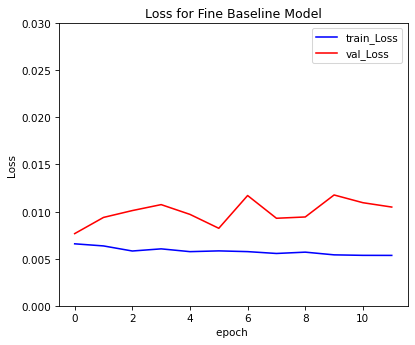

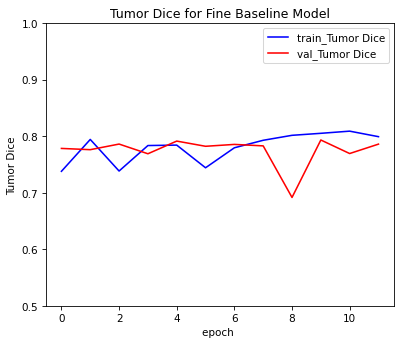

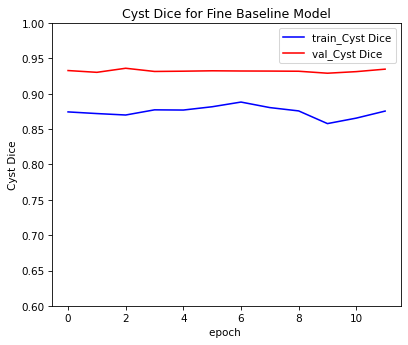

In [28]:
# original version model120

train_loss_mean = []
val_loss_mean = []
for i in range(12):
    temp_train_loss = torch.load(f'model/model120/loss_fine_train_epoch10_{i}')
    temp_val_loss = torch.load(f'model/model120/loss_fine_val_epoch10_{i}')
    train_loss_mean.append(torch.mean(temp_train_loss))
    val_loss_mean.append(torch.mean(temp_val_loss))
    
train_dice_tumor = []
train_dice_cyst = []
val_dice_tumor = []
val_dice_cyst = []
for i in range(12):
    temp_train_dice_tumor = torch.load(f'model/model120/dice_fine_train_tumor_epoch10_{i}')
    temp_val_dice_tumor = torch.load(f'model/model120/dice_fine_val_tumor_epoch10_{i}')
    temp_train_dice_cyst = torch.load(f'model/model120/dice_fine_train_cyst_epoch10_{i}')
    temp_val_dice_cyst = torch.load(f'model/model120/dice_fine_val_cyst_epoch10_{i}')
    train_dice_tumor.append(torch.mean(temp_train_dice_tumor))
    val_dice_tumor.append(torch.mean(temp_val_dice_tumor))
    train_dice_cyst.append(torch.mean(temp_train_dice_cyst))
    val_dice_cyst.append(torch.mean(temp_val_dice_cyst))
    
#plot_loss(train_dice_tumor,'train','Dice')
#plot_loss(val_dice_tumor,'val','Dice')

print(val_dice_tumor)
print(max(val_dice_tumor))
print(max(val_dice_cyst))
plot_loss_combine(train_loss_mean,val_loss_mean,0,0.03,'Loss','for Fine Baseline Model')
plot_loss_combine(train_dice_tumor,val_dice_tumor,0.5,1,'Tumor Dice','for Fine Baseline Model')
plot_loss_combine(train_dice_cyst,val_dice_cyst,0.6,1,'Cyst Dice','for Fine Baseline Model')

tensor(0.7887, dtype=torch.float64)


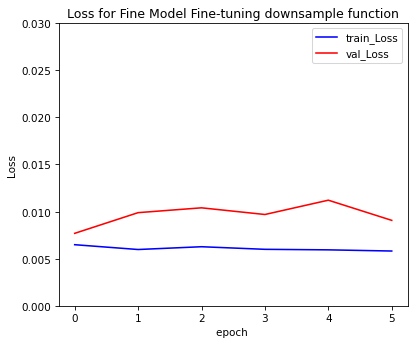

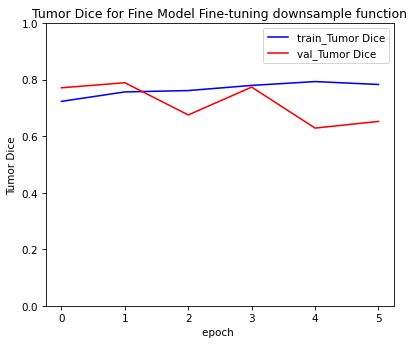

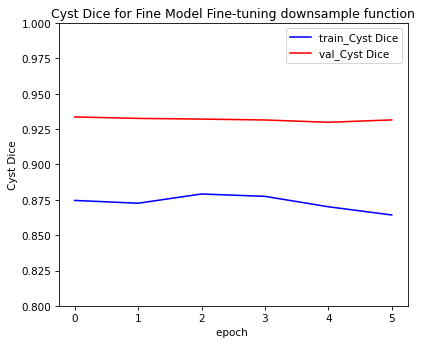

In [33]:
# replace downsample model110
train_loss_mean = []
val_loss_mean = []
for i in range(6):
    temp_train_loss = torch.load(f'model/model110/loss_fine_train_epoch6_{i}')
    temp_val_loss = torch.load(f'model/model110/loss_fine_val_epoch6_{i}')
    train_loss_mean.append(torch.mean(temp_train_loss))
    val_loss_mean.append(torch.mean(temp_val_loss))
    
train_dice_tumor = []
train_dice_cyst = []
val_dice_tumor = []
val_dice_cyst = []
for i in range(6):
    temp_train_dice_tumor = torch.load(f'model/model110/dice_fine_train_tumor_epoch6_{i}')
    temp_val_dice_tumor = torch.load(f'model/model110/dice_fine_val_tumor_epoch6_{i}')
    temp_train_dice_cyst = torch.load(f'model/model110/dice_fine_train_cyst_epoch6_{i}')
    temp_val_dice_cyst = torch.load(f'model/model110/dice_fine_val_cyst_epoch6_{i}')
    train_dice_tumor.append(torch.mean(temp_train_dice_tumor))
    val_dice_tumor.append(torch.mean(temp_val_dice_tumor))
    train_dice_cyst.append(torch.mean(temp_train_dice_cyst))
    val_dice_cyst.append(torch.mean(temp_val_dice_cyst))

print(max(val_dice_tumor))
#print(val_dice_tumor[9])
plot_loss_combine(train_loss_mean,val_loss_mean,0,0.03,'Loss','for Fine Model Fine-tuning downsample function')
plot_loss_combine(train_dice_tumor,val_dice_tumor,0,1,'Tumor Dice','for Fine Model Fine-tuning downsample function')
plot_loss_combine(train_dice_cyst,val_dice_cyst,0.8,1,'Cyst Dice','for Fine Model Fine-tuning downsample function')

In [27]:
print(0.01*(1-0.001))
print(1e-3)

0.00999
0.001


In [6]:
def auto_fine_train_val2(model_name,epoch_num): # n: epoch number
    m=0
    #n = 1 # epoch number
    #fn_loss = nn.BCEWithLogitsLoss().to(device)                        
    net = UNet_fine3().to(device)
        
    for epoch in range(epoch_num):
        if os.path.exists(f'model/{model_name}.pth'):
            net.load_state_dict(torch.load(f'model/{model_name}.pth'))
            print('Model load successfully!')
        else:
            print('Model not found!')
        optim = torch.optim.SGD(net.parameters(),momentum=0.99 ,lr=1e-2) # from adam to SGD, lr from 1e-3 to 1e-4
        net.train()
        loss_arr_train = []
        diceKidney_arr_train = []
        diceTumor_arr_train = []
        diceCyst_arr_train = []
        diceTumor_arr_train_true = []
        diceCyst_arr_train_true = []
        
        
        for batch, data in enumerate(fine_train_set):
            inputs = data['input']
            inputs = inputs.type(torch.FloatTensor).to(device)
            labels = data['label'].to(device)
                    
            outputs = net(inputs)
            outputs = outputs.softmax(dim=1)
            #if labels[0,1,:,:].max() == 1:
            diceKidney_train = dice(outputs[0,1,:,:],labels[0,1,:,:]).cpu()            
            diceKidney_arr_train.append(diceKidney_train)
            
            diceTumor_train = dice(outputs[0,2,:,:],labels[0,2,:,:]).cpu()            
            diceTumor_arr_train.append(diceTumor_train)
            if labels[0,2,:,:].max() == 1:
                diceTumor_train_true = dice(outputs[0,2,:,:],labels[0,2,:,:]).cpu()            
                diceTumor_arr_train_true.append(diceTumor_train_true)
            
            diceCyst_train = dice(outputs[0,3,:,:],labels[0,3,:,:]).cpu() 
            diceCyst_arr_train.append(diceCyst_train)
            if labels[0,3,:,:].max() == 1:
                diceCyst_train_true = dice(outputs[0,3,:,:],labels[0,3,:,:]).cpu() 
                diceCyst_arr_train_true.append(diceCyst_train_true)
            
            fn_loss = nn.functional.cross_entropy(outputs, labels).to(device)
            loss = fn_loss + 1 - diceKidney_train
        
            optim.zero_grad()  # gradient           
            loss.backward()
            optim.step()

            loss_arr_train += [loss.item()]
            

            print('Train: epoch %04d | Batch %04d / 7755 | Loss %04f | DiceKidney %04f | DiceTumor %04f | DiceCyst %04f' % (
                epoch, batch, np.mean(loss_arr_train), np.mean(diceKidney_arr_train),np.mean(diceTumor_arr_train), np.mean(diceCyst_arr_train)))
            #if batch % 20 == 0 and labels[0,1,:,:].max() == 1:
            #    img = torch.stack([torch.unsqueeze(torch_normal(inputs[0,0,:,:]),dim=0),
            #        torch.unsqueeze(labels[0,0,:,:],dim=0),torch.unsqueeze(fine_mask_normal(outputs[0,0,:,:]),dim=0),
            #        torch.unsqueeze(labels[0,1,:,:],dim=0),torch.unsqueeze(fine_mask_normal(outputs[0,1,:,:]),dim=0),
            #        torch.unsqueeze(labels[0,2,:,:],dim=0),torch.unsqueeze(fine_mask_normal(outputs[0,2,:,:]),dim=0)], dim=0)
            #    save_image(img, f'img/{model_name}/{m}.png')
                    
            #    print(f'Img{m} printed!')
            #    m+=1
            #    torch.save(net.state_dict(), f'model/{model_name}.pth')
            #if batch ==110:
            #    break

        # Save Net
        torch.save(net.state_dict(), f'model/{model_name}.pth')
        torch.save(net.state_dict(), f'model/{model_name}_epoch{epoch}.pth')
        
        with torch.no_grad():
            loss_arr_val = []
            diceKidney_arr_val = []
            diceTumor_arr_val = []
            diceCyst_arr_val = []
            diceTumor_arr_val_true = []
            diceCyst_arr_val_true = []
                        
            net.eval()
            for batch,data in enumerate(fine_val_set):
                inputs = data['input']
                inputs = inputs.type(torch.FloatTensor).to(device)
                labels = data['label'].to(device)
                    
                outputs = net(inputs)
                outputs = outputs.softmax(dim=1)
                
                diceKidney_val = dice(outputs[0,1,:,:],labels[0,1,:,:]).cpu()            
                diceKidney_arr_val.append(diceKidney_val)
                
                #if labels[0,1,:,:].max() == 1:
                diceTumor_val = dice(outputs[0,2,:,:],labels[0,2,:,:]).cpu()            
                diceTumor_arr_val.append(diceTumor_val)
                if labels[0,2,:,:].max() == 1:
                    diceTumor_val_true = dice(outputs[0,2,:,:],labels[0,2,:,:]).cpu()            
                    diceTumor_arr_val_true.append(diceTumor_val_true)
                #if labels[0,2,:,:].max() == 1:
                diceCyst_val = dice(outputs[0,3,:,:],labels[0,3,:,:]).cpu() 
                diceCyst_arr_val.append(diceCyst_val)
                if labels[0,3,:,:].max() == 1:
                    diceCyst_val_true = dice(outputs[0,3,:,:],labels[0,3,:,:]).cpu() 
                    diceCyst_arr_val_true.append(diceCyst_val_true)
                
                #outputs = outputs.softmax(dim=1)
                fn_loss = nn.functional.cross_entropy(outputs, labels).to(device)
                loss = fn_loss + 1 - diceKidney_val
                loss_arr_val += [loss.item()]
                
                
                print('Val: epoch %04d | Batch %04d / 4572 | Loss %04f | DiceKidney %04f |DiceTumor %04f | DiceCyst %04f' % (
                epoch, batch, np.mean(loss_arr_val), np.mean(diceKidney_arr_val),np.mean(diceTumor_arr_val), np.mean(diceCyst_arr_val)))
                #if batch ==30:
                #    break
                
        #Save Loss and Dice
        Loss_train = torch.tensor(loss_arr_train)
        torch.save(Loss_train,f'model/loss_fine_train_epoch10_{epoch}')
        Loss_val = torch.tensor(loss_arr_val)
        torch.save(Loss_val,f'model/loss_fine_val_epoch10_{epoch}')
        
        Dice_kidney_train = torch.tensor(diceKidney_arr_train)
        torch.save(Dice_kidney_train,f'model/dice_fine_train_kidney_epoch10_{epoch}')
        Dice_kidney_val = torch.tensor(diceKidney_arr_val)        
        torch.save(Dice_kidney_val,f'model/dice_fine_val_kidney_epoch10_{epoch}')
        
        Dice_tumor_train = torch.tensor(diceTumor_arr_train)
        torch.save(Dice_tumor_train,f'model/dice_fine_train_tumor_epoch10_{epoch}')
        Dice_tumor_val = torch.tensor(diceTumor_arr_val)        
        torch.save(Dice_tumor_val,f'model/dice_fine_val_tumor_epoch10_{epoch}')
        Dice_tumor_train_true = torch.tensor(diceTumor_arr_train_true)
        torch.save(Dice_tumor_train_true,f'model/dice_fine_train_tumor_true_epoch10_{epoch}')
        Dice_tumor_val_true = torch.tensor(diceTumor_arr_val_true)        
        torch.save(Dice_tumor_val_true,f'model/dice_fine_val_tumor_true_epoch10_{epoch}')
        
        Dice_cyst_train = torch.tensor(diceCyst_arr_train)
        torch.save(Dice_cyst_train,f'model/dice_fine_train_cyst_epoch10_{epoch}')
        Dice_cyst_val = torch.tensor(diceCyst_arr_val)
        torch.save(Dice_cyst_val,f'model/dice_fine_val_cyst_epoch10_{epoch}')
        Dice_cyst_train_true = torch.tensor(diceCyst_arr_train_true)
        torch.save(Dice_cyst_train_true,f'model/dice_fine_train_cyst_true_epoch10_{epoch}')
        Dice_cyst_val_true = torch.tensor(diceCyst_arr_val_true)
        torch.save(Dice_cyst_val_true,f'model/dice_fine_val_cyst_true_epoch10_{epoch}')
        
        
    print(f'All finished! Print {m-1} imgs.')


fine_train_set = MyDataset_Rotation_fine() 
fine_train_set = DataLoader(fine_train_set, batch_size=2, shuffle=False)
fine_val_set = MyDataset_fine_val() 
fine_val_set = DataLoader(fine_val_set, batch_size=1, shuffle=False)
auto_fine_train_val2('model210',6)
#model130 turn loss function to cross entropy loss and dice loss, basic downsample
#model140 turn adam optimizer to SGD, basic downsample


Model not found!
Train: epoch 0000 | Batch 0000 / 7755 | Loss 2.389004 | DiceKidney 0.000034 | DiceTumor 0.999990 | DiceCyst 0.999994
Train: epoch 0000 | Batch 0001 / 7755 | Loss 2.389389 | DiceKidney 0.000106 | DiceTumor 0.999988 | DiceCyst 0.999994
Train: epoch 0000 | Batch 0002 / 7755 | Loss 2.389402 | DiceKidney 0.000195 | DiceTumor 0.999989 | DiceCyst 0.999992
Train: epoch 0000 | Batch 0003 / 7755 | Loss 2.389356 | DiceKidney 0.000288 | DiceTumor 0.999990 | DiceCyst 0.999994
Train: epoch 0000 | Batch 0004 / 7755 | Loss 2.389194 | DiceKidney 0.000400 | DiceTumor 0.999990 | DiceCyst 0.999995
Train: epoch 0000 | Batch 0005 / 7755 | Loss 2.388861 | DiceKidney 0.000556 | DiceTumor 0.999990 | DiceCyst 0.999996
Train: epoch 0000 | Batch 0006 / 7755 | Loss 2.388369 | DiceKidney 0.000767 | DiceTumor 0.999990 | DiceCyst 0.999996
Train: epoch 0000 | Batch 0007 / 7755 | Loss 2.387617 | DiceKidney 0.001138 | DiceTumor 0.999991 | DiceCyst 0.999996
Train: epoch 0000 | Batch 0008 / 7755 | Loss 2.

Train: epoch 0000 | Batch 0070 / 7755 | Loss 1.688568 | DiceKidney 0.379287 | DiceTumor 0.999999 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0071 / 7755 | Loss 1.675818 | DiceKidney 0.387548 | DiceTumor 0.999999 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0072 / 7755 | Loss 1.663390 | DiceKidney 0.395609 | DiceTumor 0.999999 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0073 / 7755 | Loss 1.651279 | DiceKidney 0.403470 | DiceTumor 0.999999 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0074 / 7755 | Loss 1.639447 | DiceKidney 0.411164 | DiceTumor 0.999999 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0075 / 7755 | Loss 1.627943 | DiceKidney 0.418639 | DiceTumor 0.999999 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0076 / 7755 | Loss 1.616727 | DiceKidney 0.425930 | DiceTumor 0.999999 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0077 / 7755 | Loss 1.605819 | DiceKidney 0.433014 | DiceTumor 0.999999 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0078 / 7755 | Loss 1.595170 | DiceKidn

Train: epoch 0000 | Batch 0141 / 7755 | Loss 1.249938 | DiceKidney 0.656214 | DiceTumor 0.816902 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0142 / 7755 | Loss 1.246533 | DiceKidney 0.658486 | DiceTumor 0.818182 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0143 / 7755 | Loss 1.243158 | DiceKidney 0.660744 | DiceTumor 0.819445 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0144 / 7755 | Loss 1.239822 | DiceKidney 0.662979 | DiceTumor 0.820690 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0145 / 7755 | Loss 1.236536 | DiceKidney 0.665178 | DiceTumor 0.821918 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0146 / 7755 | Loss 1.233289 | DiceKidney 0.667354 | DiceTumor 0.823129 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0147 / 7755 | Loss 1.230082 | DiceKidney 0.669504 | DiceTumor 0.824324 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0148 / 7755 | Loss 1.226929 | DiceKidney 0.671615 | DiceTumor 0.825503 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0149 / 7755 | Loss 1.223808 | DiceKidn

Train: epoch 0000 | Batch 0212 / 7755 | Loss 1.088255 | DiceKidney 0.764098 | DiceTumor 0.784039 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0213 / 7755 | Loss 1.086768 | DiceKidney 0.765083 | DiceTumor 0.780375 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0214 / 7755 | Loss 1.085286 | DiceKidney 0.766067 | DiceTumor 0.776745 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0215 / 7755 | Loss 1.083834 | DiceKidney 0.767026 | DiceTumor 0.773149 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0216 / 7755 | Loss 1.082376 | DiceKidney 0.767995 | DiceTumor 0.769586 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0217 / 7755 | Loss 1.080911 | DiceKidney 0.768975 | DiceTumor 0.766056 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0218 / 7755 | Loss 1.079427 | DiceKidney 0.769976 | DiceTumor 0.762558 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0219 / 7755 | Loss 1.077948 | DiceKidney 0.770976 | DiceTumor 0.759092 | DiceCyst 1.000000
Train: epoch 0000 | Batch 0220 / 7755 | Loss 1.076467 | DiceKidn

Train: epoch 0000 | Batch 0283 / 7755 | Loss 1.025939 | DiceKidney 0.799560 | DiceTumor 0.813381 | DiceCyst 0.915493
Train: epoch 0000 | Batch 0284 / 7755 | Loss 1.024975 | DiceKidney 0.800238 | DiceTumor 0.814036 | DiceCyst 0.915789
Train: epoch 0000 | Batch 0285 / 7755 | Loss 1.024024 | DiceKidney 0.800905 | DiceTumor 0.814686 | DiceCyst 0.916084
Train: epoch 0000 | Batch 0286 / 7755 | Loss 1.023070 | DiceKidney 0.801577 | DiceTumor 0.815332 | DiceCyst 0.916376
Train: epoch 0000 | Batch 0287 / 7755 | Loss 1.022116 | DiceKidney 0.802250 | DiceTumor 0.815973 | DiceCyst 0.916667
Train: epoch 0000 | Batch 0288 / 7755 | Loss 1.021167 | DiceKidney 0.802921 | DiceTumor 0.816610 | DiceCyst 0.916955
Train: epoch 0000 | Batch 0289 / 7755 | Loss 1.020230 | DiceKidney 0.803581 | DiceTumor 0.817242 | DiceCyst 0.917241
Train: epoch 0000 | Batch 0290 / 7755 | Loss 1.019299 | DiceKidney 0.804238 | DiceTumor 0.817870 | DiceCyst 0.917526
Train: epoch 0000 | Batch 0291 / 7755 | Loss 1.018369 | DiceKidn

Train: epoch 0000 | Batch 0354 / 7755 | Loss 0.990550 | DiceKidney 0.818873 | DiceTumor 0.788733 | DiceCyst 0.898591
Train: epoch 0000 | Batch 0355 / 7755 | Loss 0.989873 | DiceKidney 0.819367 | DiceTumor 0.789327 | DiceCyst 0.898876
Train: epoch 0000 | Batch 0356 / 7755 | Loss 0.989196 | DiceKidney 0.819860 | DiceTumor 0.789917 | DiceCyst 0.899160
Train: epoch 0000 | Batch 0357 / 7755 | Loss 0.988522 | DiceKidney 0.820352 | DiceTumor 0.790504 | DiceCyst 0.899441
Train: epoch 0000 | Batch 0358 / 7755 | Loss 0.987856 | DiceKidney 0.820837 | DiceTumor 0.791087 | DiceCyst 0.899721
Train: epoch 0000 | Batch 0359 / 7755 | Loss 0.987188 | DiceKidney 0.821326 | DiceTumor 0.791667 | DiceCyst 0.900000
Train: epoch 0000 | Batch 0360 / 7755 | Loss 0.986532 | DiceKidney 0.821802 | DiceTumor 0.789475 | DiceCyst 0.900277
Train: epoch 0000 | Batch 0361 / 7755 | Loss 0.985896 | DiceKidney 0.822262 | DiceTumor 0.787294 | DiceCyst 0.900552
Train: epoch 0000 | Batch 0362 / 7755 | Loss 0.985299 | DiceKidn

Train: epoch 0000 | Batch 0425 / 7755 | Loss 0.954260 | DiceKidney 0.844313 | DiceTumor 0.774649 | DiceCyst 0.915493
Train: epoch 0000 | Batch 0426 / 7755 | Loss 0.953783 | DiceKidney 0.844661 | DiceTumor 0.775176 | DiceCyst 0.915691
Train: epoch 0000 | Batch 0427 / 7755 | Loss 0.953308 | DiceKidney 0.845008 | DiceTumor 0.775702 | DiceCyst 0.915888
Train: epoch 0000 | Batch 0428 / 7755 | Loss 0.952829 | DiceKidney 0.845361 | DiceTumor 0.776224 | DiceCyst 0.916084
Train: epoch 0000 | Batch 0429 / 7755 | Loss 0.952353 | DiceKidney 0.845709 | DiceTumor 0.776745 | DiceCyst 0.916279
Train: epoch 0000 | Batch 0430 / 7755 | Loss 0.951882 | DiceKidney 0.846054 | DiceTumor 0.777263 | DiceCyst 0.916473
Train: epoch 0000 | Batch 0431 / 7755 | Loss 0.951409 | DiceKidney 0.846402 | DiceTumor 0.777778 | DiceCyst 0.916667
Train: epoch 0000 | Batch 0432 / 7755 | Loss 0.950937 | DiceKidney 0.846749 | DiceTumor 0.778292 | DiceCyst 0.916859
Train: epoch 0000 | Batch 0433 / 7755 | Loss 0.950466 | DiceKidn

Train: epoch 0000 | Batch 0496 / 7755 | Loss 0.939841 | DiceKidney 0.851402 | DiceTumor 0.688129 | DiceCyst 0.927565
Train: epoch 0000 | Batch 0497 / 7755 | Loss 0.939485 | DiceKidney 0.851665 | DiceTumor 0.686748 | DiceCyst 0.927711
Train: epoch 0000 | Batch 0498 / 7755 | Loss 0.939122 | DiceKidney 0.851933 | DiceTumor 0.685371 | DiceCyst 0.927856
Train: epoch 0000 | Batch 0499 / 7755 | Loss 0.938742 | DiceKidney 0.852219 | DiceTumor 0.684001 | DiceCyst 0.928000
Train: epoch 0000 | Batch 0500 / 7755 | Loss 0.938364 | DiceKidney 0.852503 | DiceTumor 0.684631 | DiceCyst 0.928144
Train: epoch 0000 | Batch 0501 / 7755 | Loss 0.937986 | DiceKidney 0.852787 | DiceTumor 0.685260 | DiceCyst 0.928287
Train: epoch 0000 | Batch 0502 / 7755 | Loss 0.937612 | DiceKidney 0.853068 | DiceTumor 0.685885 | DiceCyst 0.928429
Train: epoch 0000 | Batch 0503 / 7755 | Loss 0.937239 | DiceKidney 0.853348 | DiceTumor 0.686509 | DiceCyst 0.928571
Train: epoch 0000 | Batch 0504 / 7755 | Loss 0.936870 | DiceKidn

Train: epoch 0000 | Batch 0567 / 7755 | Loss 0.918949 | DiceKidney 0.866404 | DiceTumor 0.711268 | DiceCyst 0.931338
Train: epoch 0000 | Batch 0568 / 7755 | Loss 0.918645 | DiceKidney 0.866634 | DiceTumor 0.711776 | DiceCyst 0.931459
Train: epoch 0000 | Batch 0569 / 7755 | Loss 0.918347 | DiceKidney 0.866860 | DiceTumor 0.712281 | DiceCyst 0.931579
Train: epoch 0000 | Batch 0570 / 7755 | Loss 0.918072 | DiceKidney 0.867065 | DiceTumor 0.711034 | DiceCyst 0.931699
Train: epoch 0000 | Batch 0571 / 7755 | Loss 0.917871 | DiceKidney 0.867200 | DiceTumor 0.709791 | DiceCyst 0.931818
Train: epoch 0000 | Batch 0572 / 7755 | Loss 0.917682 | DiceKidney 0.867323 | DiceTumor 0.708552 | DiceCyst 0.931937
Train: epoch 0000 | Batch 0573 / 7755 | Loss 0.917493 | DiceKidney 0.867447 | DiceTumor 0.707318 | DiceCyst 0.932056
Train: epoch 0000 | Batch 0574 / 7755 | Loss 0.917258 | DiceKidney 0.867612 | DiceTumor 0.706088 | DiceCyst 0.932174
Train: epoch 0000 | Batch 0575 / 7755 | Loss 0.916966 | DiceKidn

Train: epoch 0000 | Batch 0638 / 7755 | Loss 0.916642 | DiceKidney 0.864982 | DiceTumor 0.690141 | DiceCyst 0.924883
Train: epoch 0000 | Batch 0639 / 7755 | Loss 0.916377 | DiceKidney 0.865187 | DiceTumor 0.690626 | DiceCyst 0.925001
Train: epoch 0000 | Batch 0640 / 7755 | Loss 0.916114 | DiceKidney 0.865392 | DiceTumor 0.691108 | DiceCyst 0.925118
Train: epoch 0000 | Batch 0641 / 7755 | Loss 0.915854 | DiceKidney 0.865593 | DiceTumor 0.691589 | DiceCyst 0.925234
Train: epoch 0000 | Batch 0642 / 7755 | Loss 0.915590 | DiceKidney 0.865798 | DiceTumor 0.692069 | DiceCyst 0.925351
Train: epoch 0000 | Batch 0643 / 7755 | Loss 0.915329 | DiceKidney 0.866001 | DiceTumor 0.692547 | DiceCyst 0.925466
Train: epoch 0000 | Batch 0644 / 7755 | Loss 0.915068 | DiceKidney 0.866204 | DiceTumor 0.693024 | DiceCyst 0.925582
Train: epoch 0000 | Batch 0645 / 7755 | Loss 0.914808 | DiceKidney 0.866406 | DiceTumor 0.693499 | DiceCyst 0.925697
Train: epoch 0000 | Batch 0646 / 7755 | Loss 0.914552 | DiceKidn

Train: epoch 0000 | Batch 0709 / 7755 | Loss 0.907985 | DiceKidney 0.870223 | DiceTumor 0.691550 | DiceCyst 0.932395
Train: epoch 0000 | Batch 0710 / 7755 | Loss 0.907761 | DiceKidney 0.870399 | DiceTumor 0.691984 | DiceCyst 0.932490
Train: epoch 0000 | Batch 0711 / 7755 | Loss 0.907535 | DiceKidney 0.870576 | DiceTumor 0.692416 | DiceCyst 0.932585
Train: epoch 0000 | Batch 0712 / 7755 | Loss 0.907310 | DiceKidney 0.870753 | DiceTumor 0.692848 | DiceCyst 0.932679
Train: epoch 0000 | Batch 0713 / 7755 | Loss 0.907085 | DiceKidney 0.870930 | DiceTumor 0.693278 | DiceCyst 0.932774
Train: epoch 0000 | Batch 0714 / 7755 | Loss 0.906866 | DiceKidney 0.871102 | DiceTumor 0.692308 | DiceCyst 0.932868
Train: epoch 0000 | Batch 0715 / 7755 | Loss 0.906669 | DiceKidney 0.871252 | DiceTumor 0.691341 | DiceCyst 0.932961
Train: epoch 0000 | Batch 0716 / 7755 | Loss 0.906484 | DiceKidney 0.871392 | DiceTumor 0.690377 | DiceCyst 0.933055
Train: epoch 0000 | Batch 0717 / 7755 | Loss 0.906309 | DiceKidn

Train: epoch 0000 | Batch 0780 / 7755 | Loss 0.894699 | DiceKidney 0.880424 | DiceTumor 0.695263 | DiceCyst 0.932139
Train: epoch 0000 | Batch 0781 / 7755 | Loss 0.894586 | DiceKidney 0.880503 | DiceTumor 0.694374 | DiceCyst 0.932226
Train: epoch 0000 | Batch 0782 / 7755 | Loss 0.894538 | DiceKidney 0.880522 | DiceTumor 0.693487 | DiceCyst 0.932312
Train: epoch 0000 | Batch 0783 / 7755 | Loss 0.894508 | DiceKidney 0.880526 | DiceTumor 0.692603 | DiceCyst 0.932399
Train: epoch 0000 | Batch 0784 / 7755 | Loss 0.894505 | DiceKidney 0.880504 | DiceTumor 0.691720 | DiceCyst 0.932485
Train: epoch 0000 | Batch 0785 / 7755 | Loss 0.894491 | DiceKidney 0.880491 | DiceTumor 0.690840 | DiceCyst 0.932571
Train: epoch 0000 | Batch 0786 / 7755 | Loss 0.894450 | DiceKidney 0.880503 | DiceTumor 0.689962 | DiceCyst 0.932656
Train: epoch 0000 | Batch 0787 / 7755 | Loss 0.894375 | DiceKidney 0.880546 | DiceTumor 0.689087 | DiceCyst 0.932742
Train: epoch 0000 | Batch 0788 / 7755 | Loss 0.894269 | DiceKidn

Train: epoch 0000 | Batch 0851 / 7755 | Loss 0.884199 | DiceKidney 0.888420 | DiceTumor 0.696010 | DiceCyst 0.937794
Train: epoch 0000 | Batch 0852 / 7755 | Loss 0.884038 | DiceKidney 0.888547 | DiceTumor 0.696366 | DiceCyst 0.937867
Train: epoch 0000 | Batch 0853 / 7755 | Loss 0.883880 | DiceKidney 0.888671 | DiceTumor 0.696722 | DiceCyst 0.937940
Train: epoch 0000 | Batch 0854 / 7755 | Loss 0.883723 | DiceKidney 0.888795 | DiceTumor 0.697077 | DiceCyst 0.938012
Train: epoch 0000 | Batch 0855 / 7755 | Loss 0.883715 | DiceKidney 0.888769 | DiceTumor 0.697430 | DiceCyst 0.938085
Train: epoch 0000 | Batch 0856 / 7755 | Loss 0.883551 | DiceKidney 0.888899 | DiceTumor 0.697783 | DiceCyst 0.938157
Train: epoch 0000 | Batch 0857 / 7755 | Loss 0.883389 | DiceKidney 0.889027 | DiceTumor 0.698136 | DiceCyst 0.938229
Train: epoch 0000 | Batch 0858 / 7755 | Loss 0.883238 | DiceKidney 0.889145 | DiceTumor 0.697323 | DiceCyst 0.937137
Train: epoch 0000 | Batch 0859 / 7755 | Loss 0.883095 | DiceKidn

Train: epoch 0000 | Batch 0922 / 7755 | Loss 0.875366 | DiceKidney 0.895057 | DiceTumor 0.711810 | DiceCyst 0.934995
Train: epoch 0000 | Batch 0923 / 7755 | Loss 0.875228 | DiceKidney 0.895167 | DiceTumor 0.712122 | DiceCyst 0.935065
Train: epoch 0000 | Batch 0924 / 7755 | Loss 0.875090 | DiceKidney 0.895276 | DiceTumor 0.712433 | DiceCyst 0.935136
Train: epoch 0000 | Batch 0925 / 7755 | Loss 0.874953 | DiceKidney 0.895385 | DiceTumor 0.712743 | DiceCyst 0.935206
Train: epoch 0000 | Batch 0926 / 7755 | Loss 0.874816 | DiceKidney 0.895493 | DiceTumor 0.713053 | DiceCyst 0.935276
Train: epoch 0000 | Batch 0927 / 7755 | Loss 0.874679 | DiceKidney 0.895601 | DiceTumor 0.713363 | DiceCyst 0.935345
Train: epoch 0000 | Batch 0928 / 7755 | Loss 0.874542 | DiceKidney 0.895710 | DiceTumor 0.713671 | DiceCyst 0.935415
Train: epoch 0000 | Batch 0929 / 7755 | Loss 0.874406 | DiceKidney 0.895818 | DiceTumor 0.713979 | DiceCyst 0.935484
Train: epoch 0000 | Batch 0930 / 7755 | Loss 0.874269 | DiceKidn

Train: epoch 0000 | Batch 0993 / 7755 | Loss 0.869407 | DiceKidney 0.899154 | DiceTumor 0.708250 | DiceCyst 0.939638
Train: epoch 0000 | Batch 0994 / 7755 | Loss 0.869295 | DiceKidney 0.899242 | DiceTumor 0.707538 | DiceCyst 0.939699
Train: epoch 0000 | Batch 0995 / 7755 | Loss 0.869170 | DiceKidney 0.899342 | DiceTumor 0.707832 | DiceCyst 0.939759
Train: epoch 0000 | Batch 0996 / 7755 | Loss 0.869045 | DiceKidney 0.899443 | DiceTumor 0.708125 | DiceCyst 0.939820
Train: epoch 0000 | Batch 0997 / 7755 | Loss 0.868921 | DiceKidney 0.899541 | DiceTumor 0.708417 | DiceCyst 0.939880
Train: epoch 0000 | Batch 0998 / 7755 | Loss 0.868797 | DiceKidney 0.899641 | DiceTumor 0.708709 | DiceCyst 0.939940
Train: epoch 0000 | Batch 0999 / 7755 | Loss 0.868674 | DiceKidney 0.899739 | DiceTumor 0.709000 | DiceCyst 0.940000
Train: epoch 0000 | Batch 1000 / 7755 | Loss 0.868551 | DiceKidney 0.899837 | DiceTumor 0.709291 | DiceCyst 0.940060
Train: epoch 0000 | Batch 1001 / 7755 | Loss 0.868430 | DiceKidn

Train: epoch 0000 | Batch 1064 / 7755 | Loss 0.875666 | DiceKidney 0.892036 | DiceTumor 0.698592 | DiceCyst 0.943662
Train: epoch 0000 | Batch 1065 / 7755 | Loss 0.875666 | DiceKidney 0.892024 | DiceTumor 0.697937 | DiceCyst 0.943715
Train: epoch 0000 | Batch 1066 / 7755 | Loss 0.875684 | DiceKidney 0.891995 | DiceTumor 0.697283 | DiceCyst 0.943768
Train: epoch 0000 | Batch 1067 / 7755 | Loss 0.875718 | DiceKidney 0.891953 | DiceTumor 0.696630 | DiceCyst 0.942884
Train: epoch 0000 | Batch 1068 / 7755 | Loss 0.875776 | DiceKidney 0.891889 | DiceTumor 0.695978 | DiceCyst 0.942002
Train: epoch 0000 | Batch 1069 / 7755 | Loss 0.875900 | DiceKidney 0.891763 | DiceTumor 0.695328 | DiceCyst 0.941122
Train: epoch 0000 | Batch 1070 / 7755 | Loss 0.876075 | DiceKidney 0.891589 | DiceTumor 0.694678 | DiceCyst 0.940243
Train: epoch 0000 | Batch 1071 / 7755 | Loss 0.876297 | DiceKidney 0.891370 | DiceTumor 0.694030 | DiceCyst 0.939366
Train: epoch 0000 | Batch 1072 / 7755 | Loss 0.876555 | DiceKidn

Train: epoch 0000 | Batch 1135 / 7755 | Loss 0.873782 | DiceKidney 0.892656 | DiceTumor 0.703346 | DiceCyst 0.936620
Train: epoch 0000 | Batch 1136 / 7755 | Loss 0.873669 | DiceKidney 0.892749 | DiceTumor 0.703606 | DiceCyst 0.936676
Train: epoch 0000 | Batch 1137 / 7755 | Loss 0.873556 | DiceKidney 0.892842 | DiceTumor 0.703867 | DiceCyst 0.936732
Train: epoch 0000 | Batch 1138 / 7755 | Loss 0.873443 | DiceKidney 0.892935 | DiceTumor 0.704127 | DiceCyst 0.936787
Train: epoch 0000 | Batch 1139 / 7755 | Loss 0.873331 | DiceKidney 0.893028 | DiceTumor 0.704386 | DiceCyst 0.936843
Train: epoch 0000 | Batch 1140 / 7755 | Loss 0.873219 | DiceKidney 0.893119 | DiceTumor 0.704645 | DiceCyst 0.936898
Train: epoch 0000 | Batch 1141 / 7755 | Loss 0.873108 | DiceKidney 0.893211 | DiceTumor 0.704904 | DiceCyst 0.936953
Train: epoch 0000 | Batch 1142 / 7755 | Loss 0.872999 | DiceKidney 0.893301 | DiceTumor 0.705162 | DiceCyst 0.936133
Train: epoch 0000 | Batch 1143 / 7755 | Loss 0.872891 | DiceKidn

Train: epoch 0000 | Batch 1206 / 7755 | Loss 0.866698 | DiceKidney 0.898424 | DiceTumor 0.701740 | DiceCyst 0.927921
Train: epoch 0000 | Batch 1207 / 7755 | Loss 0.866606 | DiceKidney 0.898498 | DiceTumor 0.701987 | DiceCyst 0.927981
Train: epoch 0000 | Batch 1208 / 7755 | Loss 0.866518 | DiceKidney 0.898569 | DiceTumor 0.702234 | DiceCyst 0.928040
Train: epoch 0000 | Batch 1209 / 7755 | Loss 0.866460 | DiceKidney 0.898609 | DiceTumor 0.702480 | DiceCyst 0.928100
Train: epoch 0000 | Batch 1210 / 7755 | Loss 0.866527 | DiceKidney 0.898524 | DiceTumor 0.702725 | DiceCyst 0.928159
Train: epoch 0000 | Batch 1211 / 7755 | Loss 0.866428 | DiceKidney 0.898607 | DiceTumor 0.702146 | DiceCyst 0.928218
Train: epoch 0000 | Batch 1212 / 7755 | Loss 0.867122 | DiceKidney 0.897902 | DiceTumor 0.701567 | DiceCyst 0.928277
Train: epoch 0000 | Batch 1213 / 7755 | Loss 0.867832 | DiceKidney 0.897182 | DiceTumor 0.700989 | DiceCyst 0.928336
Train: epoch 0000 | Batch 1214 / 7755 | Loss 0.868336 | DiceKidn

Train: epoch 0000 | Batch 1277 / 7755 | Loss 0.877859 | DiceKidney 0.887032 | DiceTumor 0.689359 | DiceCyst 0.928795
Train: epoch 0000 | Batch 1278 / 7755 | Loss 0.877764 | DiceKidney 0.887111 | DiceTumor 0.689602 | DiceCyst 0.928851
Train: epoch 0000 | Batch 1279 / 7755 | Loss 0.877663 | DiceKidney 0.887195 | DiceTumor 0.689845 | DiceCyst 0.928907
Train: epoch 0000 | Batch 1280 / 7755 | Loss 0.877562 | DiceKidney 0.887280 | DiceTumor 0.690087 | DiceCyst 0.928962
Train: epoch 0000 | Batch 1281 / 7755 | Loss 0.877459 | DiceKidney 0.887367 | DiceTumor 0.690329 | DiceCyst 0.929018
Train: epoch 0000 | Batch 1282 / 7755 | Loss 0.877375 | DiceKidney 0.887434 | DiceTumor 0.690570 | DiceCyst 0.928293
Train: epoch 0000 | Batch 1283 / 7755 | Loss 0.877303 | DiceKidney 0.887490 | DiceTumor 0.690811 | DiceCyst 0.927570
Train: epoch 0000 | Batch 1284 / 7755 | Loss 0.877224 | DiceKidney 0.887554 | DiceTumor 0.690273 | DiceCyst 0.926849
Train: epoch 0000 | Batch 1285 / 7755 | Loss 0.877165 | DiceKidn

Train: epoch 0000 | Batch 1348 / 7755 | Loss 0.871675 | DiceKidney 0.892121 | DiceTumor 0.693107 | DiceCyst 0.930319
Train: epoch 0000 | Batch 1349 / 7755 | Loss 0.871581 | DiceKidney 0.892200 | DiceTumor 0.693334 | DiceCyst 0.930371
Train: epoch 0000 | Batch 1350 / 7755 | Loss 0.871486 | DiceKidney 0.892280 | DiceTumor 0.693561 | DiceCyst 0.930422
Train: epoch 0000 | Batch 1351 / 7755 | Loss 0.871392 | DiceKidney 0.892359 | DiceTumor 0.693788 | DiceCyst 0.930474
Train: epoch 0000 | Batch 1352 / 7755 | Loss 0.871298 | DiceKidney 0.892439 | DiceTumor 0.694014 | DiceCyst 0.930525
Train: epoch 0000 | Batch 1353 / 7755 | Loss 0.871204 | DiceKidney 0.892518 | DiceTumor 0.694240 | DiceCyst 0.930576
Train: epoch 0000 | Batch 1354 / 7755 | Loss 0.871110 | DiceKidney 0.892597 | DiceTumor 0.694466 | DiceCyst 0.930628
Train: epoch 0000 | Batch 1355 / 7755 | Loss 0.871016 | DiceKidney 0.892676 | DiceTumor 0.694691 | DiceCyst 0.930679
Train: epoch 0000 | Batch 1356 / 7755 | Loss 0.870922 | DiceKidn

Train: epoch 0000 | Batch 1419 / 7755 | Loss 0.867145 | DiceKidney 0.895731 | DiceTumor 0.693663 | DiceCyst 0.928874
Train: epoch 0000 | Batch 1420 / 7755 | Loss 0.867195 | DiceKidney 0.895676 | DiceTumor 0.693175 | DiceCyst 0.928220
Train: epoch 0000 | Batch 1421 / 7755 | Loss 0.867337 | DiceKidney 0.895536 | DiceTumor 0.692687 | DiceCyst 0.927567
Train: epoch 0000 | Batch 1422 / 7755 | Loss 0.867544 | DiceKidney 0.895333 | DiceTumor 0.692201 | DiceCyst 0.926915
Train: epoch 0000 | Batch 1423 / 7755 | Loss 0.867882 | DiceKidney 0.895003 | DiceTumor 0.691714 | DiceCyst 0.926264
Train: epoch 0000 | Batch 1424 / 7755 | Loss 0.868272 | DiceKidney 0.894622 | DiceTumor 0.691229 | DiceCyst 0.925614
Train: epoch 0000 | Batch 1425 / 7755 | Loss 0.868742 | DiceKidney 0.894159 | DiceTumor 0.690744 | DiceCyst 0.924965
Train: epoch 0000 | Batch 1426 / 7755 | Loss 0.869338 | DiceKidney 0.893566 | DiceTumor 0.690260 | DiceCyst 0.924317
Train: epoch 0000 | Batch 1427 / 7755 | Loss 0.869953 | DiceKidn

Train: epoch 0000 | Batch 1490 / 7755 | Loss 0.866333 | DiceKidney 0.895803 | DiceTumor 0.692825 | DiceCyst 0.927566
Train: epoch 0000 | Batch 1491 / 7755 | Loss 0.866251 | DiceKidney 0.895873 | DiceTumor 0.693030 | DiceCyst 0.927614
Train: epoch 0000 | Batch 1492 / 7755 | Loss 0.866169 | DiceKidney 0.895943 | DiceTumor 0.693236 | DiceCyst 0.927663
Train: epoch 0000 | Batch 1493 / 7755 | Loss 0.866087 | DiceKidney 0.896012 | DiceTumor 0.693441 | DiceCyst 0.927711
Train: epoch 0000 | Batch 1494 / 7755 | Loss 0.866005 | DiceKidney 0.896082 | DiceTumor 0.693646 | DiceCyst 0.927760
Train: epoch 0000 | Batch 1495 / 7755 | Loss 0.865924 | DiceKidney 0.896151 | DiceTumor 0.693851 | DiceCyst 0.927808
Train: epoch 0000 | Batch 1496 / 7755 | Loss 0.865842 | DiceKidney 0.896221 | DiceTumor 0.694056 | DiceCyst 0.927856
Train: epoch 0000 | Batch 1497 / 7755 | Loss 0.865760 | DiceKidney 0.896290 | DiceTumor 0.694260 | DiceCyst 0.927904
Train: epoch 0000 | Batch 1498 / 7755 | Loss 0.865679 | DiceKidn

Train: epoch 0000 | Batch 1561 / 7755 | Loss 0.866683 | DiceKidney 0.895142 | DiceTumor 0.688221 | DiceCyst 0.930858
Train: epoch 0000 | Batch 1562 / 7755 | Loss 0.866985 | DiceKidney 0.894870 | DiceTumor 0.687781 | DiceCyst 0.930902
Train: epoch 0000 | Batch 1563 / 7755 | Loss 0.867319 | DiceKidney 0.894567 | DiceTumor 0.687341 | DiceCyst 0.930947
Train: epoch 0000 | Batch 1564 / 7755 | Loss 0.867672 | DiceKidney 0.894246 | DiceTumor 0.686902 | DiceCyst 0.930991
Train: epoch 0000 | Batch 1565 / 7755 | Loss 0.868032 | DiceKidney 0.893919 | DiceTumor 0.686463 | DiceCyst 0.931035
Train: epoch 0000 | Batch 1566 / 7755 | Loss 0.868406 | DiceKidney 0.893579 | DiceTumor 0.686025 | DiceCyst 0.931079
Train: epoch 0000 | Batch 1567 / 7755 | Loss 0.868789 | DiceKidney 0.893229 | DiceTumor 0.685588 | DiceCyst 0.931123
Train: epoch 0000 | Batch 1568 / 7755 | Loss 0.869191 | DiceKidney 0.892861 | DiceTumor 0.685151 | DiceCyst 0.931167
Train: epoch 0000 | Batch 1569 / 7755 | Loss 0.869616 | DiceKidn

Train: epoch 0000 | Batch 1632 / 7755 | Loss 0.890509 | DiceKidney 0.872133 | DiceTumor 0.669321 | DiceCyst 0.933864
Train: epoch 0000 | Batch 1633 / 7755 | Loss 0.890742 | DiceKidney 0.871890 | DiceTumor 0.668912 | DiceCyst 0.933905
Train: epoch 0000 | Batch 1634 / 7755 | Loss 0.891192 | DiceKidney 0.871430 | DiceTumor 0.668503 | DiceCyst 0.933945
Train: epoch 0000 | Batch 1635 / 7755 | Loss 0.891607 | DiceKidney 0.871003 | DiceTumor 0.668094 | DiceCyst 0.933986
Train: epoch 0000 | Batch 1636 / 7755 | Loss 0.891518 | DiceKidney 0.871081 | DiceTumor 0.668297 | DiceCyst 0.934026
Train: epoch 0000 | Batch 1637 / 7755 | Loss 0.891506 | DiceKidney 0.871084 | DiceTumor 0.667889 | DiceCyst 0.934066
Train: epoch 0000 | Batch 1638 / 7755 | Loss 0.891512 | DiceKidney 0.871072 | DiceTumor 0.667481 | DiceCyst 0.934106
Train: epoch 0000 | Batch 1639 / 7755 | Loss 0.891545 | DiceKidney 0.871034 | DiceTumor 0.667074 | DiceCyst 0.934147
Train: epoch 0000 | Batch 1640 / 7755 | Loss 0.891588 | DiceKidn

Train: epoch 0000 | Batch 1703 / 7755 | Loss 0.889569 | DiceKidney 0.872426 | DiceTumor 0.664320 | DiceCyst 0.933686
Train: epoch 0000 | Batch 1704 / 7755 | Loss 0.889779 | DiceKidney 0.872208 | DiceTumor 0.663931 | DiceCyst 0.933725
Train: epoch 0000 | Batch 1705 / 7755 | Loss 0.889694 | DiceKidney 0.872283 | DiceTumor 0.663542 | DiceCyst 0.933763
Train: epoch 0000 | Batch 1706 / 7755 | Loss 0.889608 | DiceKidney 0.872358 | DiceTumor 0.663739 | DiceCyst 0.933802
Train: epoch 0000 | Batch 1707 / 7755 | Loss 0.889523 | DiceKidney 0.872432 | DiceTumor 0.663936 | DiceCyst 0.933841
Train: epoch 0000 | Batch 1708 / 7755 | Loss 0.889438 | DiceKidney 0.872507 | DiceTumor 0.664132 | DiceCyst 0.933880
Train: epoch 0000 | Batch 1709 / 7755 | Loss 0.889352 | DiceKidney 0.872582 | DiceTumor 0.664329 | DiceCyst 0.933918
Train: epoch 0000 | Batch 1710 / 7755 | Loss 0.889267 | DiceKidney 0.872656 | DiceTumor 0.664525 | DiceCyst 0.933957
Train: epoch 0000 | Batch 1711 / 7755 | Loss 0.889218 | DiceKidn

Train: epoch 0000 | Batch 1774 / 7755 | Loss 0.884828 | DiceKidney 0.876461 | DiceTumor 0.663100 | DiceCyst 0.936338
Train: epoch 0000 | Batch 1775 / 7755 | Loss 0.884751 | DiceKidney 0.876528 | DiceTumor 0.662726 | DiceCyst 0.936374
Train: epoch 0000 | Batch 1776 / 7755 | Loss 0.884672 | DiceKidney 0.876597 | DiceTumor 0.662916 | DiceCyst 0.936410
Train: epoch 0000 | Batch 1777 / 7755 | Loss 0.884592 | DiceKidney 0.876666 | DiceTumor 0.663106 | DiceCyst 0.936446
Train: epoch 0000 | Batch 1778 / 7755 | Loss 0.884513 | DiceKidney 0.876736 | DiceTumor 0.663295 | DiceCyst 0.936481
Train: epoch 0000 | Batch 1779 / 7755 | Loss 0.884434 | DiceKidney 0.876805 | DiceTumor 0.663484 | DiceCyst 0.936517
Train: epoch 0000 | Batch 1780 / 7755 | Loss 0.884355 | DiceKidney 0.876874 | DiceTumor 0.663673 | DiceCyst 0.936553
Train: epoch 0000 | Batch 1781 / 7755 | Loss 0.884277 | DiceKidney 0.876943 | DiceTumor 0.663862 | DiceCyst 0.936588
Train: epoch 0000 | Batch 1782 / 7755 | Loss 0.884198 | DiceKidn

Train: epoch 0000 | Batch 1845 / 7755 | Loss 0.880292 | DiceKidney 0.880322 | DiceTumor 0.673891 | DiceCyst 0.936620
Train: epoch 0000 | Batch 1846 / 7755 | Loss 0.880218 | DiceKidney 0.880387 | DiceTumor 0.674067 | DiceCyst 0.936654
Train: epoch 0000 | Batch 1847 / 7755 | Loss 0.880144 | DiceKidney 0.880452 | DiceTumor 0.674243 | DiceCyst 0.936689
Train: epoch 0000 | Batch 1848 / 7755 | Loss 0.880070 | DiceKidney 0.880516 | DiceTumor 0.674420 | DiceCyst 0.936723
Train: epoch 0000 | Batch 1849 / 7755 | Loss 0.879996 | DiceKidney 0.880581 | DiceTumor 0.674596 | DiceCyst 0.936757
Train: epoch 0000 | Batch 1850 / 7755 | Loss 0.879923 | DiceKidney 0.880645 | DiceTumor 0.674771 | DiceCyst 0.936791
Train: epoch 0000 | Batch 1851 / 7755 | Loss 0.879850 | DiceKidney 0.880709 | DiceTumor 0.674947 | DiceCyst 0.936825
Train: epoch 0000 | Batch 1852 / 7755 | Loss 0.879778 | DiceKidney 0.880772 | DiceTumor 0.675122 | DiceCyst 0.936859
Train: epoch 0000 | Batch 1853 / 7755 | Loss 0.879705 | DiceKidn

Train: epoch 0000 | Batch 1916 / 7755 | Loss 0.876753 | DiceKidney 0.883280 | DiceTumor 0.668233 | DiceCyst 0.936881
Train: epoch 0000 | Batch 1917 / 7755 | Loss 0.876701 | DiceKidney 0.883325 | DiceTumor 0.667884 | DiceCyst 0.936914
Train: epoch 0000 | Batch 1918 / 7755 | Loss 0.876642 | DiceKidney 0.883375 | DiceTumor 0.667536 | DiceCyst 0.936947
Train: epoch 0000 | Batch 1919 / 7755 | Loss 0.876578 | DiceKidney 0.883431 | DiceTumor 0.667188 | DiceCyst 0.936979
Train: epoch 0000 | Batch 1920 / 7755 | Loss 0.876512 | DiceKidney 0.883489 | DiceTumor 0.666841 | DiceCyst 0.937012
Train: epoch 0000 | Batch 1921 / 7755 | Loss 0.876443 | DiceKidney 0.883549 | DiceTumor 0.666494 | DiceCyst 0.937045
Train: epoch 0000 | Batch 1922 / 7755 | Loss 0.876374 | DiceKidney 0.883609 | DiceTumor 0.666668 | DiceCyst 0.937078
Train: epoch 0000 | Batch 1923 / 7755 | Loss 0.876305 | DiceKidney 0.883670 | DiceTumor 0.666841 | DiceCyst 0.937110
Train: epoch 0000 | Batch 1924 / 7755 | Loss 0.876236 | DiceKidn

Train: epoch 0000 | Batch 1987 / 7755 | Loss 0.872037 | DiceKidney 0.887413 | DiceTumor 0.677566 | DiceCyst 0.939135
Train: epoch 0000 | Batch 1988 / 7755 | Loss 0.871973 | DiceKidney 0.887470 | DiceTumor 0.677728 | DiceCyst 0.939166
Train: epoch 0000 | Batch 1989 / 7755 | Loss 0.871908 | DiceKidney 0.887526 | DiceTumor 0.677890 | DiceCyst 0.939196
Train: epoch 0000 | Batch 1990 / 7755 | Loss 0.871844 | DiceKidney 0.887583 | DiceTumor 0.678052 | DiceCyst 0.939227
Train: epoch 0000 | Batch 1991 / 7755 | Loss 0.871779 | DiceKidney 0.887639 | DiceTumor 0.678214 | DiceCyst 0.939257
Train: epoch 0000 | Batch 1992 / 7755 | Loss 0.871715 | DiceKidney 0.887695 | DiceTumor 0.678375 | DiceCyst 0.939288
Train: epoch 0000 | Batch 1993 / 7755 | Loss 0.871651 | DiceKidney 0.887752 | DiceTumor 0.678537 | DiceCyst 0.939318
Train: epoch 0000 | Batch 1994 / 7755 | Loss 0.871587 | DiceKidney 0.887808 | DiceTumor 0.678698 | DiceCyst 0.939349
Train: epoch 0000 | Batch 1995 / 7755 | Loss 0.871524 | DiceKidn

Train: epoch 0000 | Batch 2058 / 7755 | Loss 0.869669 | DiceKidney 0.889348 | DiceTumor 0.671686 | DiceCyst 0.941234
Train: epoch 0000 | Batch 2059 / 7755 | Loss 0.869652 | DiceKidney 0.889359 | DiceTumor 0.671360 | DiceCyst 0.941262
Train: epoch 0000 | Batch 2060 / 7755 | Loss 0.869630 | DiceKidney 0.889376 | DiceTumor 0.671034 | DiceCyst 0.941291
Train: epoch 0000 | Batch 2061 / 7755 | Loss 0.869601 | DiceKidney 0.889399 | DiceTumor 0.670709 | DiceCyst 0.941319
Train: epoch 0000 | Batch 2062 / 7755 | Loss 0.869566 | DiceKidney 0.889428 | DiceTumor 0.670384 | DiceCyst 0.941348
Train: epoch 0000 | Batch 2063 / 7755 | Loss 0.869526 | DiceKidney 0.889461 | DiceTumor 0.670059 | DiceCyst 0.941376
Train: epoch 0000 | Batch 2064 / 7755 | Loss 0.869482 | DiceKidney 0.889498 | DiceTumor 0.669735 | DiceCyst 0.941405
Train: epoch 0000 | Batch 2065 / 7755 | Loss 0.869433 | DiceKidney 0.889541 | DiceTumor 0.669410 | DiceCyst 0.941433
Train: epoch 0000 | Batch 2066 / 7755 | Loss 0.869377 | DiceKidn

Train: epoch 0000 | Batch 2129 / 7755 | Loss 0.868871 | DiceKidney 0.889755 | DiceTumor 0.672301 | DiceCyst 0.942723
Train: epoch 0000 | Batch 2130 / 7755 | Loss 0.868812 | DiceKidney 0.889807 | DiceTumor 0.672455 | DiceCyst 0.942750
Train: epoch 0000 | Batch 2131 / 7755 | Loss 0.868753 | DiceKidney 0.889859 | DiceTumor 0.672609 | DiceCyst 0.942777
Train: epoch 0000 | Batch 2132 / 7755 | Loss 0.868695 | DiceKidney 0.889910 | DiceTumor 0.672762 | DiceCyst 0.942804
Train: epoch 0000 | Batch 2133 / 7755 | Loss 0.868637 | DiceKidney 0.889961 | DiceTumor 0.672916 | DiceCyst 0.942831
Train: epoch 0000 | Batch 2134 / 7755 | Loss 0.868578 | DiceKidney 0.890013 | DiceTumor 0.673069 | DiceCyst 0.942857
Train: epoch 0000 | Batch 2135 / 7755 | Loss 0.868523 | DiceKidney 0.890064 | DiceTumor 0.673222 | DiceCyst 0.942884
Train: epoch 0000 | Batch 2136 / 7755 | Loss 0.868658 | DiceKidney 0.889934 | DiceTumor 0.672907 | DiceCyst 0.942911
Train: epoch 0000 | Batch 2137 / 7755 | Loss 0.868815 | DiceKidn

Train: epoch 0000 | Batch 2200 / 7755 | Loss 0.870512 | DiceKidney 0.887919 | DiceTumor 0.663790 | DiceCyst 0.941845
Train: epoch 0000 | Batch 2201 / 7755 | Loss 0.870593 | DiceKidney 0.887834 | DiceTumor 0.663489 | DiceCyst 0.941871
Train: epoch 0000 | Batch 2202 / 7755 | Loss 0.870674 | DiceKidney 0.887747 | DiceTumor 0.663187 | DiceCyst 0.941898
Train: epoch 0000 | Batch 2203 / 7755 | Loss 0.870752 | DiceKidney 0.887665 | DiceTumor 0.662887 | DiceCyst 0.941924
Train: epoch 0000 | Batch 2204 / 7755 | Loss 0.870839 | DiceKidney 0.887574 | DiceTumor 0.662586 | DiceCyst 0.941950
Train: epoch 0000 | Batch 2205 / 7755 | Loss 0.870937 | DiceKidney 0.887472 | DiceTumor 0.662286 | DiceCyst 0.941977
Train: epoch 0000 | Batch 2206 / 7755 | Loss 0.871024 | DiceKidney 0.887381 | DiceTumor 0.661985 | DiceCyst 0.942003
Train: epoch 0000 | Batch 2207 / 7755 | Loss 0.871090 | DiceKidney 0.887310 | DiceTumor 0.661686 | DiceCyst 0.942029
Train: epoch 0000 | Batch 2208 / 7755 | Loss 0.871138 | DiceKidn

Train: epoch 0000 | Batch 2271 / 7755 | Loss 0.868034 | DiceKidney 0.889961 | DiceTumor 0.666374 | DiceCyst 0.943662
Train: epoch 0000 | Batch 2272 / 7755 | Loss 0.867980 | DiceKidney 0.890009 | DiceTumor 0.666521 | DiceCyst 0.943687
Train: epoch 0000 | Batch 2273 / 7755 | Loss 0.867925 | DiceKidney 0.890058 | DiceTumor 0.666668 | DiceCyst 0.943712
Train: epoch 0000 | Batch 2274 / 7755 | Loss 0.867870 | DiceKidney 0.890106 | DiceTumor 0.666814 | DiceCyst 0.943736
Train: epoch 0000 | Batch 2275 / 7755 | Loss 0.867816 | DiceKidney 0.890154 | DiceTumor 0.666960 | DiceCyst 0.943761
Train: epoch 0000 | Batch 2276 / 7755 | Loss 0.867761 | DiceKidney 0.890203 | DiceTumor 0.667107 | DiceCyst 0.943786
Train: epoch 0000 | Batch 2277 / 7755 | Loss 0.867707 | DiceKidney 0.890251 | DiceTumor 0.667253 | DiceCyst 0.943811
Train: epoch 0000 | Batch 2278 / 7755 | Loss 0.867652 | DiceKidney 0.890299 | DiceTumor 0.667399 | DiceCyst 0.943835
Train: epoch 0000 | Batch 2279 / 7755 | Loss 0.867598 | DiceKidn

Train: epoch 0000 | Batch 2342 / 7755 | Loss 0.864885 | DiceKidney 0.892691 | DiceTumor 0.674777 | DiceCyst 0.941528
Train: epoch 0000 | Batch 2343 / 7755 | Loss 0.865027 | DiceKidney 0.892546 | DiceTumor 0.674489 | DiceCyst 0.941553
Train: epoch 0000 | Batch 2344 / 7755 | Loss 0.865332 | DiceKidney 0.892235 | DiceTumor 0.674201 | DiceCyst 0.941578
Train: epoch 0000 | Batch 2345 / 7755 | Loss 0.865293 | DiceKidney 0.892268 | DiceTumor 0.674340 | DiceCyst 0.941603
Train: epoch 0000 | Batch 2346 / 7755 | Loss 0.865241 | DiceKidney 0.892314 | DiceTumor 0.674479 | DiceCyst 0.941628
Train: epoch 0000 | Batch 2347 / 7755 | Loss 0.865190 | DiceKidney 0.892359 | DiceTumor 0.674618 | DiceCyst 0.941653
Train: epoch 0000 | Batch 2348 / 7755 | Loss 0.865138 | DiceKidney 0.892405 | DiceTumor 0.674756 | DiceCyst 0.941678
Train: epoch 0000 | Batch 2349 / 7755 | Loss 0.865086 | DiceKidney 0.892451 | DiceTumor 0.674894 | DiceCyst 0.941702
Train: epoch 0000 | Batch 2350 / 7755 | Loss 0.865035 | DiceKidn

Train: epoch 0000 | Batch 2413 / 7755 | Loss 0.862647 | DiceKidney 0.894553 | DiceTumor 0.673157 | DiceCyst 0.937034
Train: epoch 0000 | Batch 2414 / 7755 | Loss 0.862610 | DiceKidney 0.894584 | DiceTumor 0.672879 | DiceCyst 0.936646
Train: epoch 0000 | Batch 2415 / 7755 | Loss 0.862572 | DiceKidney 0.894617 | DiceTumor 0.672600 | DiceCyst 0.936258
Train: epoch 0000 | Batch 2416 / 7755 | Loss 0.862531 | DiceKidney 0.894653 | DiceTumor 0.672322 | DiceCyst 0.936285
Train: epoch 0000 | Batch 2417 / 7755 | Loss 0.862489 | DiceKidney 0.894690 | DiceTumor 0.672044 | DiceCyst 0.936311
Train: epoch 0000 | Batch 2418 / 7755 | Loss 0.862445 | DiceKidney 0.894729 | DiceTumor 0.671766 | DiceCyst 0.936338
Train: epoch 0000 | Batch 2419 / 7755 | Loss 0.862400 | DiceKidney 0.894768 | DiceTumor 0.671488 | DiceCyst 0.936364
Train: epoch 0000 | Batch 2420 / 7755 | Loss 0.862354 | DiceKidney 0.894809 | DiceTumor 0.671211 | DiceCyst 0.936390
Train: epoch 0000 | Batch 2421 / 7755 | Loss 0.862306 | DiceKidn

Train: epoch 0000 | Batch 2484 / 7755 | Loss 0.859882 | DiceKidney 0.896964 | DiceTumor 0.671228 | DiceCyst 0.922737
Train: epoch 0000 | Batch 2485 / 7755 | Loss 0.859835 | DiceKidney 0.897005 | DiceTumor 0.671360 | DiceCyst 0.922768
Train: epoch 0000 | Batch 2486 / 7755 | Loss 0.859788 | DiceKidney 0.897047 | DiceTumor 0.671493 | DiceCyst 0.922799
Train: epoch 0000 | Batch 2487 / 7755 | Loss 0.859742 | DiceKidney 0.897088 | DiceTumor 0.671625 | DiceCyst 0.922830
Train: epoch 0000 | Batch 2488 / 7755 | Loss 0.859695 | DiceKidney 0.897129 | DiceTumor 0.671757 | DiceCyst 0.922861
Train: epoch 0000 | Batch 2489 / 7755 | Loss 0.859649 | DiceKidney 0.897171 | DiceTumor 0.671888 | DiceCyst 0.922892
Train: epoch 0000 | Batch 2490 / 7755 | Loss 0.859745 | DiceKidney 0.897069 | DiceTumor 0.672020 | DiceCyst 0.922923
Train: epoch 0000 | Batch 2491 / 7755 | Loss 0.859698 | DiceKidney 0.897111 | DiceTumor 0.672152 | DiceCyst 0.922954
Train: epoch 0000 | Batch 2492 / 7755 | Loss 0.859651 | DiceKidn

Train: epoch 0000 | Batch 2555 / 7755 | Loss 0.857360 | DiceKidney 0.899144 | DiceTumor 0.673710 | DiceCyst 0.921362
Train: epoch 0000 | Batch 2556 / 7755 | Loss 0.857378 | DiceKidney 0.899125 | DiceTumor 0.673446 | DiceCyst 0.921392
Train: epoch 0000 | Batch 2557 / 7755 | Loss 0.857396 | DiceKidney 0.899104 | DiceTumor 0.673183 | DiceCyst 0.921423
Train: epoch 0000 | Batch 2558 / 7755 | Loss 0.857417 | DiceKidney 0.899081 | DiceTumor 0.672920 | DiceCyst 0.921454
Train: epoch 0000 | Batch 2559 / 7755 | Loss 0.857435 | DiceKidney 0.899060 | DiceTumor 0.672657 | DiceCyst 0.921485
Train: epoch 0000 | Batch 2560 / 7755 | Loss 0.857456 | DiceKidney 0.899036 | DiceTumor 0.672394 | DiceCyst 0.921515
Train: epoch 0000 | Batch 2561 / 7755 | Loss 0.857467 | DiceKidney 0.899023 | DiceTumor 0.672132 | DiceCyst 0.921546
Train: epoch 0000 | Batch 2562 / 7755 | Loss 0.857471 | DiceKidney 0.899016 | DiceTumor 0.671870 | DiceCyst 0.921576
Train: epoch 0000 | Batch 2563 / 7755 | Loss 0.857463 | DiceKidn

Train: epoch 0000 | Batch 2626 / 7755 | Loss 0.864224 | DiceKidney 0.892709 | DiceTumor 0.666160 | DiceCyst 0.923487
Train: epoch 0000 | Batch 2627 / 7755 | Loss 0.864576 | DiceKidney 0.892382 | DiceTumor 0.665906 | DiceCyst 0.923516
Train: epoch 0000 | Batch 2628 / 7755 | Loss 0.864921 | DiceKidney 0.892059 | DiceTumor 0.665653 | DiceCyst 0.923545
Train: epoch 0000 | Batch 2629 / 7755 | Loss 0.865264 | DiceKidney 0.891739 | DiceTumor 0.665400 | DiceCyst 0.923574
Train: epoch 0000 | Batch 2630 / 7755 | Loss 0.865608 | DiceKidney 0.891416 | DiceTumor 0.665147 | DiceCyst 0.923603
Train: epoch 0000 | Batch 2631 / 7755 | Loss 0.865958 | DiceKidney 0.891088 | DiceTumor 0.664894 | DiceCyst 0.923632
Train: epoch 0000 | Batch 2632 / 7755 | Loss 0.866304 | DiceKidney 0.890763 | DiceTumor 0.664642 | DiceCyst 0.923661
Train: epoch 0000 | Batch 2633 / 7755 | Loss 0.866650 | DiceKidney 0.890438 | DiceTumor 0.664390 | DiceCyst 0.923690
Train: epoch 0000 | Batch 2634 / 7755 | Loss 0.866996 | DiceKidn

Train: epoch 0000 | Batch 2697 / 7755 | Loss 0.872641 | DiceKidney 0.884470 | DiceTumor 0.663826 | DiceCyst 0.911416
Train: epoch 0000 | Batch 2698 / 7755 | Loss 0.872594 | DiceKidney 0.884512 | DiceTumor 0.663950 | DiceCyst 0.911449
Train: epoch 0000 | Batch 2699 / 7755 | Loss 0.872546 | DiceKidney 0.884555 | DiceTumor 0.664075 | DiceCyst 0.911482
Train: epoch 0000 | Batch 2700 / 7755 | Loss 0.872498 | DiceKidney 0.884598 | DiceTumor 0.664199 | DiceCyst 0.911514
Train: epoch 0000 | Batch 2701 / 7755 | Loss 0.872451 | DiceKidney 0.884640 | DiceTumor 0.664324 | DiceCyst 0.911547
Train: epoch 0000 | Batch 2702 / 7755 | Loss 0.872403 | DiceKidney 0.884683 | DiceTumor 0.664448 | DiceCyst 0.911580
Train: epoch 0000 | Batch 2703 / 7755 | Loss 0.872356 | DiceKidney 0.884725 | DiceTumor 0.664572 | DiceCyst 0.911613
Train: epoch 0000 | Batch 2704 / 7755 | Loss 0.872308 | DiceKidney 0.884768 | DiceTumor 0.664696 | DiceCyst 0.911645
Train: epoch 0000 | Batch 2705 / 7755 | Loss 0.872261 | DiceKidn

Train: epoch 0000 | Batch 2768 / 7755 | Loss 0.872046 | DiceKidney 0.884863 | DiceTumor 0.660528 | DiceCyst 0.894186
Train: epoch 0000 | Batch 2769 / 7755 | Loss 0.872000 | DiceKidney 0.884904 | DiceTumor 0.660651 | DiceCyst 0.894224
Train: epoch 0000 | Batch 2770 / 7755 | Loss 0.871955 | DiceKidney 0.884944 | DiceTumor 0.660773 | DiceCyst 0.894262
Train: epoch 0000 | Batch 2771 / 7755 | Loss 0.872259 | DiceKidney 0.884639 | DiceTumor 0.660535 | DiceCyst 0.894300
Train: epoch 0000 | Batch 2772 / 7755 | Loss 0.872369 | DiceKidney 0.884530 | DiceTumor 0.660297 | DiceCyst 0.893978
Train: epoch 0000 | Batch 2773 / 7755 | Loss 0.872428 | DiceKidney 0.884472 | DiceTumor 0.660058 | DiceCyst 0.893656
Train: epoch 0000 | Batch 2774 / 7755 | Loss 0.872432 | DiceKidney 0.884467 | DiceTumor 0.659821 | DiceCyst 0.893334
Train: epoch 0000 | Batch 2775 / 7755 | Loss 0.872404 | DiceKidney 0.884492 | DiceTumor 0.659943 | DiceCyst 0.893012
Train: epoch 0000 | Batch 2776 / 7755 | Loss 0.872408 | DiceKidn

Train: epoch 0000 | Batch 2839 / 7755 | Loss 0.871357 | DiceKidney 0.885384 | DiceTumor 0.660212 | DiceCyst 0.892958
Train: epoch 0000 | Batch 2840 / 7755 | Loss 0.871335 | DiceKidney 0.885403 | DiceTumor 0.659980 | DiceCyst 0.892996
Train: epoch 0000 | Batch 2841 / 7755 | Loss 0.871313 | DiceKidney 0.885421 | DiceTumor 0.659747 | DiceCyst 0.893033
Train: epoch 0000 | Batch 2842 / 7755 | Loss 0.871294 | DiceKidney 0.885438 | DiceTumor 0.659515 | DiceCyst 0.893071
Train: epoch 0000 | Batch 2843 / 7755 | Loss 0.871276 | DiceKidney 0.885452 | DiceTumor 0.659283 | DiceCyst 0.893109
Train: epoch 0000 | Batch 2844 / 7755 | Loss 0.871261 | DiceKidney 0.885464 | DiceTumor 0.659052 | DiceCyst 0.893146
Train: epoch 0000 | Batch 2845 / 7755 | Loss 0.871248 | DiceKidney 0.885475 | DiceTumor 0.658820 | DiceCyst 0.893184
Train: epoch 0000 | Batch 2846 / 7755 | Loss 0.871233 | DiceKidney 0.885486 | DiceTumor 0.658589 | DiceCyst 0.893221
Train: epoch 0000 | Batch 2847 / 7755 | Loss 0.871217 | DiceKidn

Train: epoch 0000 | Batch 2910 / 7755 | Loss 0.868703 | DiceKidney 0.887740 | DiceTumor 0.661286 | DiceCyst 0.895569
Train: epoch 0000 | Batch 2911 / 7755 | Loss 0.868660 | DiceKidney 0.887779 | DiceTumor 0.661402 | DiceCyst 0.895605
Train: epoch 0000 | Batch 2912 / 7755 | Loss 0.868617 | DiceKidney 0.887817 | DiceTumor 0.661518 | DiceCyst 0.895640
Train: epoch 0000 | Batch 2913 / 7755 | Loss 0.868575 | DiceKidney 0.887856 | DiceTumor 0.661634 | DiceCyst 0.895676
Train: epoch 0000 | Batch 2914 / 7755 | Loss 0.868532 | DiceKidney 0.887894 | DiceTumor 0.661750 | DiceCyst 0.895712
Train: epoch 0000 | Batch 2915 / 7755 | Loss 0.868489 | DiceKidney 0.887933 | DiceTumor 0.661866 | DiceCyst 0.895748
Train: epoch 0000 | Batch 2916 / 7755 | Loss 0.868446 | DiceKidney 0.887971 | DiceTumor 0.661982 | DiceCyst 0.895784
Train: epoch 0000 | Batch 2917 / 7755 | Loss 0.868403 | DiceKidney 0.888009 | DiceTumor 0.662098 | DiceCyst 0.895819
Train: epoch 0000 | Batch 2918 / 7755 | Loss 0.868361 | DiceKidn

Train: epoch 0000 | Batch 2981 / 7755 | Loss 0.868597 | DiceKidney 0.887642 | DiceTumor 0.661637 | DiceCyst 0.892019
Train: epoch 0000 | Batch 2982 / 7755 | Loss 0.868555 | DiceKidney 0.887680 | DiceTumor 0.661751 | DiceCyst 0.892055
Train: epoch 0000 | Batch 2983 / 7755 | Loss 0.868514 | DiceKidney 0.887717 | DiceTumor 0.661864 | DiceCyst 0.892091
Train: epoch 0000 | Batch 2984 / 7755 | Loss 0.868482 | DiceKidney 0.887745 | DiceTumor 0.661642 | DiceCyst 0.892127
Train: epoch 0000 | Batch 2985 / 7755 | Loss 0.868466 | DiceKidney 0.887758 | DiceTumor 0.661421 | DiceCyst 0.892164
Train: epoch 0000 | Batch 2986 / 7755 | Loss 0.868442 | DiceKidney 0.887778 | DiceTumor 0.661199 | DiceCyst 0.892200
Train: epoch 0000 | Batch 2987 / 7755 | Loss 0.868401 | DiceKidney 0.887815 | DiceTumor 0.661313 | DiceCyst 0.892236
Train: epoch 0000 | Batch 2988 / 7755 | Loss 0.868359 | DiceKidney 0.887853 | DiceTumor 0.661426 | DiceCyst 0.892272
Train: epoch 0000 | Batch 2989 / 7755 | Loss 0.868317 | DiceKidn

Train: epoch 0000 | Batch 3052 / 7755 | Loss 0.871908 | DiceKidney 0.884421 | DiceTumor 0.652474 | DiceCyst 0.894530
Train: epoch 0000 | Batch 3053 / 7755 | Loss 0.871979 | DiceKidney 0.884352 | DiceTumor 0.652260 | DiceCyst 0.894565
Train: epoch 0000 | Batch 3054 / 7755 | Loss 0.872045 | DiceKidney 0.884288 | DiceTumor 0.652047 | DiceCyst 0.894599
Train: epoch 0000 | Batch 3055 / 7755 | Loss 0.872108 | DiceKidney 0.884227 | DiceTumor 0.651833 | DiceCyst 0.894634
Train: epoch 0000 | Batch 3056 / 7755 | Loss 0.872172 | DiceKidney 0.884164 | DiceTumor 0.651620 | DiceCyst 0.894668
Train: epoch 0000 | Batch 3057 / 7755 | Loss 0.872242 | DiceKidney 0.884095 | DiceTumor 0.651407 | DiceCyst 0.894703
Train: epoch 0000 | Batch 3058 / 7755 | Loss 0.872309 | DiceKidney 0.884028 | DiceTumor 0.651194 | DiceCyst 0.894737
Train: epoch 0000 | Batch 3059 / 7755 | Loss 0.872376 | DiceKidney 0.883961 | DiceTumor 0.650981 | DiceCyst 0.894771
Train: epoch 0000 | Batch 3060 / 7755 | Loss 0.872441 | DiceKidn

Train: epoch 0000 | Batch 3123 / 7755 | Loss 0.872284 | DiceKidney 0.883925 | DiceTumor 0.649168 | DiceCyst 0.895967
Train: epoch 0000 | Batch 3124 / 7755 | Loss 0.872242 | DiceKidney 0.883962 | DiceTumor 0.649281 | DiceCyst 0.896000
Train: epoch 0000 | Batch 3125 / 7755 | Loss 0.872201 | DiceKidney 0.883999 | DiceTumor 0.649393 | DiceCyst 0.896033
Train: epoch 0000 | Batch 3126 / 7755 | Loss 0.872212 | DiceKidney 0.883985 | DiceTumor 0.649185 | DiceCyst 0.896067
Train: epoch 0000 | Batch 3127 / 7755 | Loss 0.872214 | DiceKidney 0.883980 | DiceTumor 0.648978 | DiceCyst 0.896100
Train: epoch 0000 | Batch 3128 / 7755 | Loss 0.872187 | DiceKidney 0.884003 | DiceTumor 0.648770 | DiceCyst 0.896133
Train: epoch 0000 | Batch 3129 / 7755 | Loss 0.872146 | DiceKidney 0.884040 | DiceTumor 0.648883 | DiceCyst 0.896166
Train: epoch 0000 | Batch 3130 / 7755 | Loss 0.872105 | DiceKidney 0.884077 | DiceTumor 0.648995 | DiceCyst 0.896199
Train: epoch 0000 | Batch 3131 / 7755 | Loss 0.872064 | DiceKidn

Train: epoch 0000 | Batch 3194 / 7755 | Loss 0.870669 | DiceKidney 0.885296 | DiceTumor 0.648827 | DiceCyst 0.892958
Train: epoch 0000 | Batch 3195 / 7755 | Loss 0.870630 | DiceKidney 0.885332 | DiceTumor 0.648937 | DiceCyst 0.892991
Train: epoch 0000 | Batch 3196 / 7755 | Loss 0.870590 | DiceKidney 0.885368 | DiceTumor 0.649047 | DiceCyst 0.893025
Train: epoch 0000 | Batch 3197 / 7755 | Loss 0.870554 | DiceKidney 0.885400 | DiceTumor 0.649156 | DiceCyst 0.892746
Train: epoch 0000 | Batch 3198 / 7755 | Loss 0.870531 | DiceKidney 0.885420 | DiceTumor 0.649266 | DiceCyst 0.892467
Train: epoch 0000 | Batch 3199 / 7755 | Loss 0.870517 | DiceKidney 0.885431 | DiceTumor 0.649376 | DiceCyst 0.892188
Train: epoch 0000 | Batch 3200 / 7755 | Loss 0.870513 | DiceKidney 0.885432 | DiceTumor 0.649485 | DiceCyst 0.891909
Train: epoch 0000 | Batch 3201 / 7755 | Loss 0.870528 | DiceKidney 0.885415 | DiceTumor 0.649595 | DiceCyst 0.891630
Train: epoch 0000 | Batch 3202 / 7755 | Loss 0.870557 | DiceKidn

Train: epoch 0000 | Batch 3265 / 7755 | Loss 0.871466 | DiceKidney 0.884422 | DiceTumor 0.649725 | DiceCyst 0.891305
Train: epoch 0000 | Batch 3266 / 7755 | Loss 0.871598 | DiceKidney 0.884307 | DiceTumor 0.649526 | DiceCyst 0.891338
Train: epoch 0000 | Batch 3267 / 7755 | Loss 0.871721 | DiceKidney 0.884198 | DiceTumor 0.649328 | DiceCyst 0.891371
Train: epoch 0000 | Batch 3268 / 7755 | Loss 0.871812 | DiceKidney 0.884117 | DiceTumor 0.649129 | DiceCyst 0.891404
Train: epoch 0000 | Batch 3269 / 7755 | Loss 0.871855 | DiceKidney 0.884077 | DiceTumor 0.648930 | DiceCyst 0.891437
Train: epoch 0000 | Batch 3270 / 7755 | Loss 0.871833 | DiceKidney 0.884096 | DiceTumor 0.648732 | DiceCyst 0.891471
Train: epoch 0000 | Batch 3271 / 7755 | Loss 0.871794 | DiceKidney 0.884132 | DiceTumor 0.648839 | DiceCyst 0.891504
Train: epoch 0000 | Batch 3272 / 7755 | Loss 0.871755 | DiceKidney 0.884167 | DiceTumor 0.648947 | DiceCyst 0.891537
Train: epoch 0000 | Batch 3273 / 7755 | Loss 0.871716 | DiceKidn

Train: epoch 0000 | Batch 3336 / 7755 | Loss 0.870465 | DiceKidney 0.885261 | DiceTumor 0.651484 | DiceCyst 0.893617
Train: epoch 0000 | Batch 3337 / 7755 | Loss 0.870427 | DiceKidney 0.885295 | DiceTumor 0.651589 | DiceCyst 0.893649
Train: epoch 0000 | Batch 3338 / 7755 | Loss 0.870389 | DiceKidney 0.885330 | DiceTumor 0.651693 | DiceCyst 0.893681
Train: epoch 0000 | Batch 3339 / 7755 | Loss 0.870351 | DiceKidney 0.885364 | DiceTumor 0.651797 | DiceCyst 0.893713
Train: epoch 0000 | Batch 3340 / 7755 | Loss 0.870313 | DiceKidney 0.885398 | DiceTumor 0.651901 | DiceCyst 0.893745
Train: epoch 0000 | Batch 3341 / 7755 | Loss 0.870275 | DiceKidney 0.885432 | DiceTumor 0.652006 | DiceCyst 0.893776
Train: epoch 0000 | Batch 3342 / 7755 | Loss 0.870237 | DiceKidney 0.885467 | DiceTumor 0.652110 | DiceCyst 0.893808
Train: epoch 0000 | Batch 3343 / 7755 | Loss 0.870199 | DiceKidney 0.885501 | DiceTumor 0.652214 | DiceCyst 0.893840
Train: epoch 0000 | Batch 3344 / 7755 | Loss 0.870161 | DiceKidn

Train: epoch 0000 | Batch 3407 / 7755 | Loss 0.867824 | DiceKidney 0.887651 | DiceTumor 0.658745 | DiceCyst 0.895834
Train: epoch 0000 | Batch 3408 / 7755 | Loss 0.867787 | DiceKidney 0.887684 | DiceTumor 0.658845 | DiceCyst 0.895864
Train: epoch 0000 | Batch 3409 / 7755 | Loss 0.867751 | DiceKidney 0.887716 | DiceTumor 0.658945 | DiceCyst 0.895895
Train: epoch 0000 | Batch 3410 / 7755 | Loss 0.867714 | DiceKidney 0.887749 | DiceTumor 0.659045 | DiceCyst 0.895925
Train: epoch 0000 | Batch 3411 / 7755 | Loss 0.867678 | DiceKidney 0.887782 | DiceTumor 0.659145 | DiceCyst 0.895956
Train: epoch 0000 | Batch 3412 / 7755 | Loss 0.867642 | DiceKidney 0.887815 | DiceTumor 0.659245 | DiceCyst 0.895986
Train: epoch 0000 | Batch 3413 / 7755 | Loss 0.867605 | DiceKidney 0.887848 | DiceTumor 0.659345 | DiceCyst 0.896017
Train: epoch 0000 | Batch 3414 / 7755 | Loss 0.867569 | DiceKidney 0.887881 | DiceTumor 0.659444 | DiceCyst 0.896047
Train: epoch 0000 | Batch 3415 / 7755 | Loss 0.867533 | DiceKidn

Train: epoch 0000 | Batch 3478 / 7755 | Loss 0.867163 | DiceKidney 0.888171 | DiceTumor 0.654787 | DiceCyst 0.897384
Train: epoch 0000 | Batch 3479 / 7755 | Loss 0.867224 | DiceKidney 0.888118 | DiceTumor 0.654598 | DiceCyst 0.897414
Train: epoch 0000 | Batch 3480 / 7755 | Loss 0.867286 | DiceKidney 0.888062 | DiceTumor 0.654410 | DiceCyst 0.897443
Train: epoch 0000 | Batch 3481 / 7755 | Loss 0.867328 | DiceKidney 0.888023 | DiceTumor 0.654222 | DiceCyst 0.897473
Train: epoch 0000 | Batch 3482 / 7755 | Loss 0.867343 | DiceKidney 0.888010 | DiceTumor 0.654035 | DiceCyst 0.897502
Train: epoch 0000 | Batch 3483 / 7755 | Loss 0.867343 | DiceKidney 0.888008 | DiceTumor 0.653847 | DiceCyst 0.897532
Train: epoch 0000 | Batch 3484 / 7755 | Loss 0.867313 | DiceKidney 0.888035 | DiceTumor 0.653659 | DiceCyst 0.897561
Train: epoch 0000 | Batch 3485 / 7755 | Loss 0.867278 | DiceKidney 0.888067 | DiceTumor 0.653759 | DiceCyst 0.897591
Train: epoch 0000 | Batch 3486 / 7755 | Loss 0.867242 | DiceKidn

Train: epoch 0000 | Batch 3549 / 7755 | Loss 0.866794 | DiceKidney 0.888359 | DiceTumor 0.652677 | DiceCyst 0.897747
Train: epoch 0000 | Batch 3550 / 7755 | Loss 0.866775 | DiceKidney 0.888376 | DiceTumor 0.652775 | DiceCyst 0.897494
Train: epoch 0000 | Batch 3551 / 7755 | Loss 0.866758 | DiceKidney 0.888390 | DiceTumor 0.652872 | DiceCyst 0.897241
Train: epoch 0000 | Batch 3552 / 7755 | Loss 0.866742 | DiceKidney 0.888404 | DiceTumor 0.652970 | DiceCyst 0.896989
Train: epoch 0000 | Batch 3553 / 7755 | Loss 0.866727 | DiceKidney 0.888417 | DiceTumor 0.653068 | DiceCyst 0.896736
Train: epoch 0000 | Batch 3554 / 7755 | Loss 0.866716 | DiceKidney 0.888426 | DiceTumor 0.653165 | DiceCyst 0.896484
Train: epoch 0000 | Batch 3555 / 7755 | Loss 0.866706 | DiceKidney 0.888434 | DiceTumor 0.653263 | DiceCyst 0.896232
Train: epoch 0000 | Batch 3556 / 7755 | Loss 0.866697 | DiceKidney 0.888442 | DiceTumor 0.653360 | DiceCyst 0.895980
Train: epoch 0000 | Batch 3557 / 7755 | Loss 0.866689 | DiceKidn

Train: epoch 0000 | Batch 3620 / 7755 | Loss 0.865250 | DiceKidney 0.889719 | DiceTumor 0.659487 | DiceCyst 0.890362
Train: epoch 0000 | Batch 3621 / 7755 | Loss 0.865217 | DiceKidney 0.889750 | DiceTumor 0.659581 | DiceCyst 0.890392
Train: epoch 0000 | Batch 3622 / 7755 | Loss 0.865183 | DiceKidney 0.889780 | DiceTumor 0.659675 | DiceCyst 0.890422
Train: epoch 0000 | Batch 3623 / 7755 | Loss 0.865152 | DiceKidney 0.889808 | DiceTumor 0.659769 | DiceCyst 0.890453
Train: epoch 0000 | Batch 3624 / 7755 | Loss 0.865148 | DiceKidney 0.889809 | DiceTumor 0.659863 | DiceCyst 0.890483
Train: epoch 0000 | Batch 3625 / 7755 | Loss 0.865114 | DiceKidney 0.889839 | DiceTumor 0.659957 | DiceCyst 0.890513
Train: epoch 0000 | Batch 3626 / 7755 | Loss 0.865081 | DiceKidney 0.889870 | DiceTumor 0.660050 | DiceCyst 0.890543
Train: epoch 0000 | Batch 3627 / 7755 | Loss 0.865047 | DiceKidney 0.889900 | DiceTumor 0.660144 | DiceCyst 0.890573
Train: epoch 0000 | Batch 3628 / 7755 | Loss 0.865017 | DiceKidn

Train: epoch 0000 | Batch 3691 / 7755 | Loss 0.864197 | DiceKidney 0.890591 | DiceTumor 0.659806 | DiceCyst 0.884074
Train: epoch 0000 | Batch 3692 / 7755 | Loss 0.864164 | DiceKidney 0.890620 | DiceTumor 0.659898 | DiceCyst 0.884105
Train: epoch 0000 | Batch 3693 / 7755 | Loss 0.864131 | DiceKidney 0.890650 | DiceTumor 0.659990 | DiceCyst 0.884137
Train: epoch 0000 | Batch 3694 / 7755 | Loss 0.864099 | DiceKidney 0.890679 | DiceTumor 0.660082 | DiceCyst 0.884168
Train: epoch 0000 | Batch 3695 / 7755 | Loss 0.864066 | DiceKidney 0.890709 | DiceTumor 0.660174 | DiceCyst 0.884199
Train: epoch 0000 | Batch 3696 / 7755 | Loss 0.864034 | DiceKidney 0.890739 | DiceTumor 0.660266 | DiceCyst 0.884231
Train: epoch 0000 | Batch 3697 / 7755 | Loss 0.864001 | DiceKidney 0.890768 | DiceTumor 0.660358 | DiceCyst 0.884262
Train: epoch 0000 | Batch 3698 / 7755 | Loss 0.863969 | DiceKidney 0.890798 | DiceTumor 0.660449 | DiceCyst 0.884293
Train: epoch 0000 | Batch 3699 / 7755 | Loss 0.863936 | DiceKidn

Train: epoch 0000 | Batch 3762 / 7755 | Loss 0.861923 | DiceKidney 0.892655 | DiceTumor 0.666224 | DiceCyst 0.886261
Train: epoch 0000 | Batch 3763 / 7755 | Loss 0.861891 | DiceKidney 0.892683 | DiceTumor 0.666313 | DiceCyst 0.886291
Train: epoch 0000 | Batch 3764 / 7755 | Loss 0.861860 | DiceKidney 0.892712 | DiceTumor 0.666402 | DiceCyst 0.886322
Train: epoch 0000 | Batch 3765 / 7755 | Loss 0.861829 | DiceKidney 0.892740 | DiceTumor 0.666490 | DiceCyst 0.886352
Train: epoch 0000 | Batch 3766 / 7755 | Loss 0.861797 | DiceKidney 0.892769 | DiceTumor 0.666579 | DiceCyst 0.886382
Train: epoch 0000 | Batch 3767 / 7755 | Loss 0.861766 | DiceKidney 0.892797 | DiceTumor 0.666667 | DiceCyst 0.886412
Train: epoch 0000 | Batch 3768 / 7755 | Loss 0.861735 | DiceKidney 0.892826 | DiceTumor 0.666756 | DiceCyst 0.886442
Train: epoch 0000 | Batch 3769 / 7755 | Loss 0.861703 | DiceKidney 0.892854 | DiceTumor 0.666844 | DiceCyst 0.886472
Train: epoch 0000 | Batch 3770 / 7755 | Loss 0.861672 | DiceKidn

Train: epoch 0000 | Batch 3833 / 7755 | Loss 0.860400 | DiceKidney 0.893990 | DiceTumor 0.665102 | DiceCyst 0.887063
Train: epoch 0000 | Batch 3834 / 7755 | Loss 0.860370 | DiceKidney 0.894017 | DiceTumor 0.665190 | DiceCyst 0.887093
Train: epoch 0000 | Batch 3835 / 7755 | Loss 0.860339 | DiceKidney 0.894045 | DiceTumor 0.665277 | DiceCyst 0.887122
Train: epoch 0000 | Batch 3836 / 7755 | Loss 0.860309 | DiceKidney 0.894072 | DiceTumor 0.665364 | DiceCyst 0.887152
Train: epoch 0000 | Batch 3837 / 7755 | Loss 0.860279 | DiceKidney 0.894100 | DiceTumor 0.665451 | DiceCyst 0.887181
Train: epoch 0000 | Batch 3838 / 7755 | Loss 0.860248 | DiceKidney 0.894128 | DiceTumor 0.665539 | DiceCyst 0.887210
Train: epoch 0000 | Batch 3839 / 7755 | Loss 0.860218 | DiceKidney 0.894155 | DiceTumor 0.665626 | DiceCyst 0.887240
Train: epoch 0000 | Batch 3840 / 7755 | Loss 0.860188 | DiceKidney 0.894183 | DiceTumor 0.665713 | DiceCyst 0.887269
Train: epoch 0000 | Batch 3841 / 7755 | Loss 0.860157 | DiceKidn

Train: epoch 0000 | Batch 3904 / 7755 | Loss 0.859165 | DiceKidney 0.895070 | DiceTumor 0.665045 | DiceCyst 0.888861
Train: epoch 0000 | Batch 3905 / 7755 | Loss 0.859136 | DiceKidney 0.895097 | DiceTumor 0.665131 | DiceCyst 0.888889
Train: epoch 0000 | Batch 3906 / 7755 | Loss 0.859106 | DiceKidney 0.895123 | DiceTumor 0.665217 | DiceCyst 0.888917
Train: epoch 0000 | Batch 3907 / 7755 | Loss 0.859077 | DiceKidney 0.895150 | DiceTumor 0.665303 | DiceCyst 0.888946
Train: epoch 0000 | Batch 3908 / 7755 | Loss 0.859047 | DiceKidney 0.895177 | DiceTumor 0.665388 | DiceCyst 0.888974
Train: epoch 0000 | Batch 3909 / 7755 | Loss 0.859018 | DiceKidney 0.895204 | DiceTumor 0.665474 | DiceCyst 0.889003
Train: epoch 0000 | Batch 3910 / 7755 | Loss 0.858988 | DiceKidney 0.895231 | DiceTumor 0.665559 | DiceCyst 0.889031
Train: epoch 0000 | Batch 3911 / 7755 | Loss 0.858959 | DiceKidney 0.895257 | DiceTumor 0.665645 | DiceCyst 0.889059
Train: epoch 0000 | Batch 3912 / 7755 | Loss 0.858929 | DiceKidn

Train: epoch 0000 | Batch 3975 / 7755 | Loss 0.858475 | DiceKidney 0.895578 | DiceTumor 0.664488 | DiceCyst 0.890342
Train: epoch 0000 | Batch 3976 / 7755 | Loss 0.858449 | DiceKidney 0.895602 | DiceTumor 0.664321 | DiceCyst 0.890370
Train: epoch 0000 | Batch 3977 / 7755 | Loss 0.858422 | DiceKidney 0.895626 | DiceTumor 0.664154 | DiceCyst 0.890397
Train: epoch 0000 | Batch 3978 / 7755 | Loss 0.858395 | DiceKidney 0.895651 | DiceTumor 0.663987 | DiceCyst 0.890425
Train: epoch 0000 | Batch 3979 / 7755 | Loss 0.858366 | DiceKidney 0.895677 | DiceTumor 0.664071 | DiceCyst 0.890452
Train: epoch 0000 | Batch 3980 / 7755 | Loss 0.858337 | DiceKidney 0.895703 | DiceTumor 0.664155 | DiceCyst 0.890480
Train: epoch 0000 | Batch 3981 / 7755 | Loss 0.858308 | DiceKidney 0.895730 | DiceTumor 0.664240 | DiceCyst 0.890507
Train: epoch 0000 | Batch 3982 / 7755 | Loss 0.858279 | DiceKidney 0.895756 | DiceTumor 0.664324 | DiceCyst 0.890535
Train: epoch 0000 | Batch 3983 / 7755 | Loss 0.858251 | DiceKidn

Train: epoch 0000 | Batch 4046 / 7755 | Loss 0.856467 | DiceKidney 0.897404 | DiceTumor 0.669632 | DiceCyst 0.892266
Train: epoch 0000 | Batch 4047 / 7755 | Loss 0.856439 | DiceKidney 0.897430 | DiceTumor 0.669714 | DiceCyst 0.892293
Train: epoch 0000 | Batch 4048 / 7755 | Loss 0.856411 | DiceKidney 0.897455 | DiceTumor 0.669796 | DiceCyst 0.892319
Train: epoch 0000 | Batch 4049 / 7755 | Loss 0.856384 | DiceKidney 0.897480 | DiceTumor 0.669877 | DiceCyst 0.892346
Train: epoch 0000 | Batch 4050 / 7755 | Loss 0.856356 | DiceKidney 0.897505 | DiceTumor 0.669959 | DiceCyst 0.892372
Train: epoch 0000 | Batch 4051 / 7755 | Loss 0.856328 | DiceKidney 0.897531 | DiceTumor 0.670040 | DiceCyst 0.892399
Train: epoch 0000 | Batch 4052 / 7755 | Loss 0.856300 | DiceKidney 0.897556 | DiceTumor 0.670122 | DiceCyst 0.892426
Train: epoch 0000 | Batch 4053 / 7755 | Loss 0.856272 | DiceKidney 0.897581 | DiceTumor 0.670203 | DiceCyst 0.892452
Train: epoch 0000 | Batch 4054 / 7755 | Loss 0.856245 | DiceKidn

Train: epoch 0000 | Batch 4117 / 7755 | Loss 0.862848 | DiceKidney 0.891221 | DiceTumor 0.663915 | DiceCyst 0.894124
Train: epoch 0000 | Batch 4118 / 7755 | Loss 0.862900 | DiceKidney 0.891172 | DiceTumor 0.663754 | DiceCyst 0.894149
Train: epoch 0000 | Batch 4119 / 7755 | Loss 0.862953 | DiceKidney 0.891121 | DiceTumor 0.663593 | DiceCyst 0.894175
Train: epoch 0000 | Batch 4120 / 7755 | Loss 0.863004 | DiceKidney 0.891073 | DiceTumor 0.663432 | DiceCyst 0.894201
Train: epoch 0000 | Batch 4121 / 7755 | Loss 0.863047 | DiceKidney 0.891031 | DiceTumor 0.663271 | DiceCyst 0.894226
Train: epoch 0000 | Batch 4122 / 7755 | Loss 0.863087 | DiceKidney 0.890993 | DiceTumor 0.663110 | DiceCyst 0.894009
Train: epoch 0000 | Batch 4123 / 7755 | Loss 0.863122 | DiceKidney 0.890959 | DiceTumor 0.662949 | DiceCyst 0.893793
Train: epoch 0000 | Batch 4124 / 7755 | Loss 0.863158 | DiceKidney 0.890925 | DiceTumor 0.662789 | DiceCyst 0.893576
Train: epoch 0000 | Batch 4125 / 7755 | Loss 0.863192 | DiceKidn

Train: epoch 0000 | Batch 4188 / 7755 | Loss 0.862160 | DiceKidney 0.891794 | DiceTumor 0.661018 | DiceCyst 0.891860
Train: epoch 0000 | Batch 4189 / 7755 | Loss 0.862139 | DiceKidney 0.891812 | DiceTumor 0.660860 | DiceCyst 0.891886
Train: epoch 0000 | Batch 4190 / 7755 | Loss 0.862118 | DiceKidney 0.891831 | DiceTumor 0.660702 | DiceCyst 0.891911
Train: epoch 0000 | Batch 4191 / 7755 | Loss 0.862095 | DiceKidney 0.891851 | DiceTumor 0.660545 | DiceCyst 0.891937
Train: epoch 0000 | Batch 4192 / 7755 | Loss 0.862071 | DiceKidney 0.891873 | DiceTumor 0.660387 | DiceCyst 0.891963
Train: epoch 0000 | Batch 4193 / 7755 | Loss 0.862045 | DiceKidney 0.891897 | DiceTumor 0.660230 | DiceCyst 0.891989
Train: epoch 0000 | Batch 4194 / 7755 | Loss 0.862017 | DiceKidney 0.891922 | DiceTumor 0.660072 | DiceCyst 0.892014
Train: epoch 0000 | Batch 4195 / 7755 | Loss 0.861989 | DiceKidney 0.891948 | DiceTumor 0.660153 | DiceCyst 0.892040
Train: epoch 0000 | Batch 4196 / 7755 | Loss 0.861961 | DiceKidn

Train: epoch 0000 | Batch 4259 / 7755 | Loss 0.860212 | DiceKidney 0.893571 | DiceTumor 0.665259 | DiceCyst 0.893662
Train: epoch 0000 | Batch 4260 / 7755 | Loss 0.860184 | DiceKidney 0.893596 | DiceTumor 0.665337 | DiceCyst 0.893687
Train: epoch 0000 | Batch 4261 / 7755 | Loss 0.860157 | DiceKidney 0.893621 | DiceTumor 0.665416 | DiceCyst 0.893712
Train: epoch 0000 | Batch 4262 / 7755 | Loss 0.860130 | DiceKidney 0.893646 | DiceTumor 0.665494 | DiceCyst 0.893737
Train: epoch 0000 | Batch 4263 / 7755 | Loss 0.860102 | DiceKidney 0.893671 | DiceTumor 0.665573 | DiceCyst 0.893762
Train: epoch 0000 | Batch 4264 / 7755 | Loss 0.860075 | DiceKidney 0.893695 | DiceTumor 0.665651 | DiceCyst 0.893787
Train: epoch 0000 | Batch 4265 / 7755 | Loss 0.860048 | DiceKidney 0.893720 | DiceTumor 0.665730 | DiceCyst 0.893812
Train: epoch 0000 | Batch 4266 / 7755 | Loss 0.860021 | DiceKidney 0.893745 | DiceTumor 0.665808 | DiceCyst 0.893837
Train: epoch 0000 | Batch 4267 / 7755 | Loss 0.859993 | DiceKidn

Train: epoch 0000 | Batch 4330 / 7755 | Loss 0.860617 | DiceKidney 0.893085 | DiceTumor 0.664974 | DiceCyst 0.893558
Train: epoch 0000 | Batch 4331 / 7755 | Loss 0.860692 | DiceKidney 0.893015 | DiceTumor 0.664821 | DiceCyst 0.893583
Train: epoch 0000 | Batch 4332 / 7755 | Loss 0.860737 | DiceKidney 0.892971 | DiceTumor 0.664667 | DiceCyst 0.893607
Train: epoch 0000 | Batch 4333 / 7755 | Loss 0.860780 | DiceKidney 0.892928 | DiceTumor 0.664514 | DiceCyst 0.893632
Train: epoch 0000 | Batch 4334 / 7755 | Loss 0.860753 | DiceKidney 0.892953 | DiceTumor 0.664591 | DiceCyst 0.893656
Train: epoch 0000 | Batch 4335 / 7755 | Loss 0.860726 | DiceKidney 0.892978 | DiceTumor 0.664669 | DiceCyst 0.893681
Train: epoch 0000 | Batch 4336 / 7755 | Loss 0.860699 | DiceKidney 0.893003 | DiceTumor 0.664746 | DiceCyst 0.893705
Train: epoch 0000 | Batch 4337 / 7755 | Loss 0.860672 | DiceKidney 0.893027 | DiceTumor 0.664823 | DiceCyst 0.893730
Train: epoch 0000 | Batch 4338 / 7755 | Loss 0.860653 | DiceKidn

Train: epoch 0000 | Batch 4401 / 7755 | Loss 0.860717 | DiceKidney 0.892934 | DiceTumor 0.662654 | DiceCyst 0.893230
Train: epoch 0000 | Batch 4402 / 7755 | Loss 0.860701 | DiceKidney 0.892948 | DiceTumor 0.662503 | DiceCyst 0.893255
Train: epoch 0000 | Batch 4403 / 7755 | Loss 0.860675 | DiceKidney 0.892972 | DiceTumor 0.662580 | DiceCyst 0.893279
Train: epoch 0000 | Batch 4404 / 7755 | Loss 0.860648 | DiceKidney 0.892997 | DiceTumor 0.662657 | DiceCyst 0.893303
Train: epoch 0000 | Batch 4405 / 7755 | Loss 0.860622 | DiceKidney 0.893020 | DiceTumor 0.662733 | DiceCyst 0.893100
Train: epoch 0000 | Batch 4406 / 7755 | Loss 0.860595 | DiceKidney 0.893045 | DiceTumor 0.662810 | DiceCyst 0.893125
Train: epoch 0000 | Batch 4407 / 7755 | Loss 0.860569 | DiceKidney 0.893069 | DiceTumor 0.662886 | DiceCyst 0.893149
Train: epoch 0000 | Batch 4408 / 7755 | Loss 0.860542 | DiceKidney 0.893093 | DiceTumor 0.662963 | DiceCyst 0.893173
Train: epoch 0000 | Batch 4409 / 7755 | Loss 0.860516 | DiceKidn

Train: epoch 0000 | Batch 4472 / 7755 | Loss 0.860406 | DiceKidney 0.893199 | DiceTumor 0.660184 | DiceCyst 0.892913
Train: epoch 0000 | Batch 4473 / 7755 | Loss 0.860387 | DiceKidney 0.893223 | DiceTumor 0.660036 | DiceCyst 0.892937
Train: epoch 0000 | Batch 4474 / 7755 | Loss 0.860369 | DiceKidney 0.893247 | DiceTumor 0.659889 | DiceCyst 0.892961
Train: epoch 0000 | Batch 4475 / 7755 | Loss 0.860351 | DiceKidney 0.893271 | DiceTumor 0.659741 | DiceCyst 0.892985
Train: epoch 0000 | Batch 4476 / 7755 | Loss 0.860555 | DiceKidney 0.893073 | DiceTumor 0.659594 | DiceCyst 0.893009
Train: epoch 0000 | Batch 4477 / 7755 | Loss 0.860750 | DiceKidney 0.892885 | DiceTumor 0.659447 | DiceCyst 0.893033
Train: epoch 0000 | Batch 4478 / 7755 | Loss 0.860934 | DiceKidney 0.892708 | DiceTumor 0.659300 | DiceCyst 0.893057
Train: epoch 0000 | Batch 4479 / 7755 | Loss 0.861114 | DiceKidney 0.892537 | DiceTumor 0.659152 | DiceCyst 0.893081
Train: epoch 0000 | Batch 4480 / 7755 | Loss 0.861285 | DiceKidn

Train: epoch 0000 | Batch 4543 / 7755 | Loss 0.867355 | DiceKidney 0.886875 | DiceTumor 0.649869 | DiceCyst 0.892826
Train: epoch 0000 | Batch 4544 / 7755 | Loss 0.867400 | DiceKidney 0.886829 | DiceTumor 0.649726 | DiceCyst 0.892849
Train: epoch 0000 | Batch 4545 / 7755 | Loss 0.867445 | DiceKidney 0.886783 | DiceTumor 0.649583 | DiceCyst 0.892873
Train: epoch 0000 | Batch 4546 / 7755 | Loss 0.867491 | DiceKidney 0.886736 | DiceTumor 0.649440 | DiceCyst 0.892897
Train: epoch 0000 | Batch 4547 / 7755 | Loss 0.867537 | DiceKidney 0.886688 | DiceTumor 0.649297 | DiceCyst 0.892920
Train: epoch 0000 | Batch 4548 / 7755 | Loss 0.867549 | DiceKidney 0.886674 | DiceTumor 0.649155 | DiceCyst 0.892944
Train: epoch 0000 | Batch 4549 / 7755 | Loss 0.867522 | DiceKidney 0.886699 | DiceTumor 0.649232 | DiceCyst 0.892967
Train: epoch 0000 | Batch 4550 / 7755 | Loss 0.867495 | DiceKidney 0.886723 | DiceTumor 0.649309 | DiceCyst 0.892991
Train: epoch 0000 | Batch 4551 / 7755 | Loss 0.867531 | DiceKidn

Train: epoch 0000 | Batch 4614 / 7755 | Loss 0.866265 | DiceKidney 0.887818 | DiceTumor 0.648322 | DiceCyst 0.892308
Train: epoch 0000 | Batch 4615 / 7755 | Loss 0.866239 | DiceKidney 0.887842 | DiceTumor 0.648398 | DiceCyst 0.892331
Train: epoch 0000 | Batch 4616 / 7755 | Loss 0.866212 | DiceKidney 0.887866 | DiceTumor 0.648474 | DiceCyst 0.892355
Train: epoch 0000 | Batch 4617 / 7755 | Loss 0.866186 | DiceKidney 0.887891 | DiceTumor 0.648550 | DiceCyst 0.892378
Train: epoch 0000 | Batch 4618 / 7755 | Loss 0.866159 | DiceKidney 0.887915 | DiceTumor 0.648626 | DiceCyst 0.892401
Train: epoch 0000 | Batch 4619 / 7755 | Loss 0.866133 | DiceKidney 0.887939 | DiceTumor 0.648702 | DiceCyst 0.892424
Train: epoch 0000 | Batch 4620 / 7755 | Loss 0.866106 | DiceKidney 0.887963 | DiceTumor 0.648778 | DiceCyst 0.892448
Train: epoch 0000 | Batch 4621 / 7755 | Loss 0.866080 | DiceKidney 0.887988 | DiceTumor 0.648854 | DiceCyst 0.892471
Train: epoch 0000 | Batch 4622 / 7755 | Loss 0.866053 | DiceKidn

Train: epoch 0000 | Batch 4685 / 7755 | Loss 0.864437 | DiceKidney 0.889488 | DiceTumor 0.653650 | DiceCyst 0.892446
Train: epoch 0000 | Batch 4686 / 7755 | Loss 0.864412 | DiceKidney 0.889512 | DiceTumor 0.653724 | DiceCyst 0.892255
Train: epoch 0000 | Batch 4687 / 7755 | Loss 0.864386 | DiceKidney 0.889535 | DiceTumor 0.653798 | DiceCyst 0.892065
Train: epoch 0000 | Batch 4688 / 7755 | Loss 0.864361 | DiceKidney 0.889558 | DiceTumor 0.653872 | DiceCyst 0.891875
Train: epoch 0000 | Batch 4689 / 7755 | Loss 0.864336 | DiceKidney 0.889581 | DiceTumor 0.653946 | DiceCyst 0.891685
Train: epoch 0000 | Batch 4690 / 7755 | Loss 0.864310 | DiceKidney 0.889605 | DiceTumor 0.654019 | DiceCyst 0.891708
Train: epoch 0000 | Batch 4691 / 7755 | Loss 0.864284 | DiceKidney 0.889628 | DiceTumor 0.654093 | DiceCyst 0.891731
Train: epoch 0000 | Batch 4692 / 7755 | Loss 0.864259 | DiceKidney 0.889651 | DiceTumor 0.654167 | DiceCyst 0.891541
Train: epoch 0000 | Batch 4693 / 7755 | Loss 0.864234 | DiceKidn

Train: epoch 0000 | Batch 4756 / 7755 | Loss 0.864892 | DiceKidney 0.888952 | DiceTumor 0.647468 | DiceCyst 0.885642
Train: epoch 0000 | Batch 4757 / 7755 | Loss 0.865027 | DiceKidney 0.888817 | DiceTumor 0.647542 | DiceCyst 0.885456
Train: epoch 0000 | Batch 4758 / 7755 | Loss 0.865098 | DiceKidney 0.888746 | DiceTumor 0.647616 | DiceCyst 0.885270
Train: epoch 0000 | Batch 4759 / 7755 | Loss 0.865119 | DiceKidney 0.888724 | DiceTumor 0.647690 | DiceCyst 0.885084
Train: epoch 0000 | Batch 4760 / 7755 | Loss 0.865120 | DiceKidney 0.888722 | DiceTumor 0.647764 | DiceCyst 0.884898
Train: epoch 0000 | Batch 4761 / 7755 | Loss 0.865107 | DiceKidney 0.888734 | DiceTumor 0.647838 | DiceCyst 0.884712
Train: epoch 0000 | Batch 4762 / 7755 | Loss 0.865081 | DiceKidney 0.888758 | DiceTumor 0.647912 | DiceCyst 0.884737
Train: epoch 0000 | Batch 4763 / 7755 | Loss 0.865056 | DiceKidney 0.888781 | DiceTumor 0.647986 | DiceCyst 0.884761
Train: epoch 0000 | Batch 4764 / 7755 | Loss 0.865034 | DiceKidn

Train: epoch 0000 | Batch 4827 / 7755 | Loss 0.863999 | DiceKidney 0.889732 | DiceTumor 0.644367 | DiceCyst 0.885460
Train: epoch 0000 | Batch 4828 / 7755 | Loss 0.863988 | DiceKidney 0.889742 | DiceTumor 0.644234 | DiceCyst 0.885484
Train: epoch 0000 | Batch 4829 / 7755 | Loss 0.863978 | DiceKidney 0.889751 | DiceTumor 0.644100 | DiceCyst 0.885507
Train: epoch 0000 | Batch 4830 / 7755 | Loss 0.863970 | DiceKidney 0.889758 | DiceTumor 0.643967 | DiceCyst 0.885531
Train: epoch 0000 | Batch 4831 / 7755 | Loss 0.863962 | DiceKidney 0.889765 | DiceTumor 0.643834 | DiceCyst 0.885555
Train: epoch 0000 | Batch 4832 / 7755 | Loss 0.863955 | DiceKidney 0.889771 | DiceTumor 0.643700 | DiceCyst 0.885578
Train: epoch 0000 | Batch 4833 / 7755 | Loss 0.863949 | DiceKidney 0.889776 | DiceTumor 0.643567 | DiceCyst 0.885602
Train: epoch 0000 | Batch 4834 / 7755 | Loss 0.863942 | DiceKidney 0.889782 | DiceTumor 0.643434 | DiceCyst 0.885626
Train: epoch 0000 | Batch 4835 / 7755 | Loss 0.863936 | DiceKidn

Train: epoch 0000 | Batch 4898 / 7755 | Loss 0.863558 | DiceKidney 0.890101 | DiceTumor 0.639927 | DiceCyst 0.886508
Train: epoch 0000 | Batch 4899 / 7755 | Loss 0.863586 | DiceKidney 0.890076 | DiceTumor 0.639797 | DiceCyst 0.886327
Train: epoch 0000 | Batch 4900 / 7755 | Loss 0.863611 | DiceKidney 0.890053 | DiceTumor 0.639666 | DiceCyst 0.886146
Train: epoch 0000 | Batch 4901 / 7755 | Loss 0.863627 | DiceKidney 0.890038 | DiceTumor 0.639536 | DiceCyst 0.885965
Train: epoch 0000 | Batch 4902 / 7755 | Loss 0.863629 | DiceKidney 0.890035 | DiceTumor 0.639405 | DiceCyst 0.885784
Train: epoch 0000 | Batch 4903 / 7755 | Loss 0.863605 | DiceKidney 0.890057 | DiceTumor 0.639479 | DiceCyst 0.885604
Train: epoch 0000 | Batch 4904 / 7755 | Loss 0.863581 | DiceKidney 0.890080 | DiceTumor 0.639552 | DiceCyst 0.885627
Train: epoch 0000 | Batch 4905 / 7755 | Loss 0.863556 | DiceKidney 0.890102 | DiceTumor 0.639626 | DiceCyst 0.885650
Train: epoch 0000 | Batch 4906 / 7755 | Loss 0.863535 | DiceKidn

Train: epoch 0000 | Batch 4969 / 7755 | Loss 0.862506 | DiceKidney 0.891026 | DiceTumor 0.642456 | DiceCyst 0.884306
Train: epoch 0000 | Batch 4970 / 7755 | Loss 0.862482 | DiceKidney 0.891048 | DiceTumor 0.642528 | DiceCyst 0.884329
Train: epoch 0000 | Batch 4971 / 7755 | Loss 0.862476 | DiceKidney 0.891053 | DiceTumor 0.642398 | DiceCyst 0.884353
Train: epoch 0000 | Batch 4972 / 7755 | Loss 0.862485 | DiceKidney 0.891043 | DiceTumor 0.642269 | DiceCyst 0.884376
Train: epoch 0000 | Batch 4973 / 7755 | Loss 0.862500 | DiceKidney 0.891028 | DiceTumor 0.642140 | DiceCyst 0.884399
Train: epoch 0000 | Batch 4974 / 7755 | Loss 0.862502 | DiceKidney 0.891025 | DiceTumor 0.642011 | DiceCyst 0.884422
Train: epoch 0000 | Batch 4975 / 7755 | Loss 0.862478 | DiceKidney 0.891047 | DiceTumor 0.642083 | DiceCyst 0.884446
Train: epoch 0000 | Batch 4976 / 7755 | Loss 0.862454 | DiceKidney 0.891069 | DiceTumor 0.642155 | DiceCyst 0.884469
Train: epoch 0000 | Batch 4977 / 7755 | Loss 0.862430 | DiceKidn

Train: epoch 0000 | Batch 5040 / 7755 | Loss 0.860967 | DiceKidney 0.892431 | DiceTumor 0.645706 | DiceCyst 0.883158
Train: epoch 0000 | Batch 5041 / 7755 | Loss 0.860944 | DiceKidney 0.892453 | DiceTumor 0.645776 | DiceCyst 0.883181
Train: epoch 0000 | Batch 5042 / 7755 | Loss 0.860923 | DiceKidney 0.892473 | DiceTumor 0.645648 | DiceCyst 0.883205
Train: epoch 0000 | Batch 5043 / 7755 | Loss 0.860909 | DiceKidney 0.892485 | DiceTumor 0.645520 | DiceCyst 0.883030
Train: epoch 0000 | Batch 5044 / 7755 | Loss 0.860897 | DiceKidney 0.892496 | DiceTumor 0.645392 | DiceCyst 0.882854
Train: epoch 0000 | Batch 5045 / 7755 | Loss 0.860879 | DiceKidney 0.892512 | DiceTumor 0.645264 | DiceCyst 0.882878
Train: epoch 0000 | Batch 5046 / 7755 | Loss 0.860856 | DiceKidney 0.892533 | DiceTumor 0.645335 | DiceCyst 0.882901
Train: epoch 0000 | Batch 5047 / 7755 | Loss 0.860833 | DiceKidney 0.892554 | DiceTumor 0.645405 | DiceCyst 0.882924
Train: epoch 0000 | Batch 5048 / 7755 | Loss 0.860810 | DiceKidn

Train: epoch 0000 | Batch 5111 / 7755 | Loss 0.859555 | DiceKidney 0.893718 | DiceTumor 0.647106 | DiceCyst 0.883216
Train: epoch 0000 | Batch 5112 / 7755 | Loss 0.859532 | DiceKidney 0.893739 | DiceTumor 0.647175 | DiceCyst 0.883239
Train: epoch 0000 | Batch 5113 / 7755 | Loss 0.859518 | DiceKidney 0.893752 | DiceTumor 0.647048 | DiceCyst 0.883066
Train: epoch 0000 | Batch 5114 / 7755 | Loss 0.859507 | DiceKidney 0.893762 | DiceTumor 0.646922 | DiceCyst 0.883089
Train: epoch 0000 | Batch 5115 / 7755 | Loss 0.859495 | DiceKidney 0.893772 | DiceTumor 0.646795 | DiceCyst 0.883112
Train: epoch 0000 | Batch 5116 / 7755 | Loss 0.859479 | DiceKidney 0.893786 | DiceTumor 0.646669 | DiceCyst 0.883135
Train: epoch 0000 | Batch 5117 / 7755 | Loss 0.859462 | DiceKidney 0.893802 | DiceTumor 0.646542 | DiceCyst 0.883158
Train: epoch 0000 | Batch 5118 / 7755 | Loss 0.859441 | DiceKidney 0.893821 | DiceTumor 0.646416 | DiceCyst 0.883180
Train: epoch 0000 | Batch 5119 / 7755 | Loss 0.859418 | DiceKidn

Train: epoch 0000 | Batch 5182 / 7755 | Loss 0.858579 | DiceKidney 0.894593 | DiceTumor 0.647309 | DiceCyst 0.881536
Train: epoch 0000 | Batch 5183 / 7755 | Loss 0.858557 | DiceKidney 0.894614 | DiceTumor 0.647377 | DiceCyst 0.881559
Train: epoch 0000 | Batch 5184 / 7755 | Loss 0.858534 | DiceKidney 0.894634 | DiceTumor 0.647445 | DiceCyst 0.881582
Train: epoch 0000 | Batch 5185 / 7755 | Loss 0.858576 | DiceKidney 0.894591 | DiceTumor 0.647513 | DiceCyst 0.881604
Train: epoch 0000 | Batch 5186 / 7755 | Loss 0.858553 | DiceKidney 0.894611 | DiceTumor 0.647581 | DiceCyst 0.881627
Train: epoch 0000 | Batch 5187 / 7755 | Loss 0.858531 | DiceKidney 0.894632 | DiceTumor 0.647649 | DiceCyst 0.881650
Train: epoch 0000 | Batch 5188 / 7755 | Loss 0.858509 | DiceKidney 0.894652 | DiceTumor 0.647717 | DiceCyst 0.881673
Train: epoch 0000 | Batch 5189 / 7755 | Loss 0.858487 | DiceKidney 0.894672 | DiceTumor 0.647785 | DiceCyst 0.881696
Train: epoch 0000 | Batch 5190 / 7755 | Loss 0.858465 | DiceKidn

Train: epoch 0000 | Batch 5253 / 7755 | Loss 0.857089 | DiceKidney 0.895955 | DiceTumor 0.652075 | DiceCyst 0.883137
Train: epoch 0000 | Batch 5254 / 7755 | Loss 0.857067 | DiceKidney 0.895975 | DiceTumor 0.652142 | DiceCyst 0.883159
Train: epoch 0000 | Batch 5255 / 7755 | Loss 0.857046 | DiceKidney 0.895995 | DiceTumor 0.652208 | DiceCyst 0.883181
Train: epoch 0000 | Batch 5256 / 7755 | Loss 0.857024 | DiceKidney 0.896014 | DiceTumor 0.652274 | DiceCyst 0.883204
Train: epoch 0000 | Batch 5257 / 7755 | Loss 0.857002 | DiceKidney 0.896034 | DiceTumor 0.652340 | DiceCyst 0.883226
Train: epoch 0000 | Batch 5258 / 7755 | Loss 0.856981 | DiceKidney 0.896054 | DiceTumor 0.652406 | DiceCyst 0.883248
Train: epoch 0000 | Batch 5259 / 7755 | Loss 0.856959 | DiceKidney 0.896074 | DiceTumor 0.652472 | DiceCyst 0.883270
Train: epoch 0000 | Batch 5260 / 7755 | Loss 0.856938 | DiceKidney 0.896093 | DiceTumor 0.652538 | DiceCyst 0.883292
Train: epoch 0000 | Batch 5261 / 7755 | Loss 0.856916 | DiceKidn

Train: epoch 0000 | Batch 5324 / 7755 | Loss 0.856412 | DiceKidney 0.896523 | DiceTumor 0.650329 | DiceCyst 0.884695
Train: epoch 0000 | Batch 5325 / 7755 | Loss 0.856391 | DiceKidney 0.896543 | DiceTumor 0.650395 | DiceCyst 0.884717
Train: epoch 0000 | Batch 5326 / 7755 | Loss 0.856370 | DiceKidney 0.896562 | DiceTumor 0.650461 | DiceCyst 0.884738
Train: epoch 0000 | Batch 5327 / 7755 | Loss 0.856349 | DiceKidney 0.896581 | DiceTumor 0.650526 | DiceCyst 0.884760
Train: epoch 0000 | Batch 5328 / 7755 | Loss 0.856336 | DiceKidney 0.896592 | DiceTumor 0.650404 | DiceCyst 0.884782
Train: epoch 0000 | Batch 5329 / 7755 | Loss 0.856346 | DiceKidney 0.896582 | DiceTumor 0.650282 | DiceCyst 0.884803
Train: epoch 0000 | Batch 5330 / 7755 | Loss 0.856372 | DiceKidney 0.896555 | DiceTumor 0.650160 | DiceCyst 0.884825
Train: epoch 0000 | Batch 5331 / 7755 | Loss 0.856415 | DiceKidney 0.896511 | DiceTumor 0.650038 | DiceCyst 0.884846
Train: epoch 0000 | Batch 5332 / 7755 | Loss 0.856443 | DiceKidn

Train: epoch 0000 | Batch 5395 / 7755 | Loss 0.857519 | DiceKidney 0.895453 | DiceTumor 0.646406 | DiceCyst 0.885100
Train: epoch 0000 | Batch 5396 / 7755 | Loss 0.857578 | DiceKidney 0.895398 | DiceTumor 0.646286 | DiceCyst 0.885122
Train: epoch 0000 | Batch 5397 / 7755 | Loss 0.857637 | DiceKidney 0.895344 | DiceTumor 0.646166 | DiceCyst 0.885143
Train: epoch 0000 | Batch 5398 / 7755 | Loss 0.857697 | DiceKidney 0.895289 | DiceTumor 0.646046 | DiceCyst 0.885164
Train: epoch 0000 | Batch 5399 / 7755 | Loss 0.857757 | DiceKidney 0.895234 | DiceTumor 0.645927 | DiceCyst 0.885185
Train: epoch 0000 | Batch 5400 / 7755 | Loss 0.857817 | DiceKidney 0.895179 | DiceTumor 0.645807 | DiceCyst 0.885207
Train: epoch 0000 | Batch 5401 / 7755 | Loss 0.857875 | DiceKidney 0.895125 | DiceTumor 0.645688 | DiceCyst 0.885228
Train: epoch 0000 | Batch 5402 / 7755 | Loss 0.857938 | DiceKidney 0.895067 | DiceTumor 0.645568 | DiceCyst 0.885249
Train: epoch 0000 | Batch 5403 / 7755 | Loss 0.857999 | DiceKidn

Train: epoch 0000 | Batch 5466 / 7755 | Loss 0.863272 | DiceKidney 0.889933 | DiceTumor 0.638011 | DiceCyst 0.886592
Train: epoch 0000 | Batch 5467 / 7755 | Loss 0.863418 | DiceKidney 0.889785 | DiceTumor 0.637894 | DiceCyst 0.886613
Train: epoch 0000 | Batch 5468 / 7755 | Loss 0.863564 | DiceKidney 0.889638 | DiceTumor 0.637777 | DiceCyst 0.886634
Train: epoch 0000 | Batch 5469 / 7755 | Loss 0.863702 | DiceKidney 0.889499 | DiceTumor 0.637661 | DiceCyst 0.886655
Train: epoch 0000 | Batch 5470 / 7755 | Loss 0.863843 | DiceKidney 0.889356 | DiceTumor 0.637544 | DiceCyst 0.886675
Train: epoch 0000 | Batch 5471 / 7755 | Loss 0.863821 | DiceKidney 0.889376 | DiceTumor 0.637610 | DiceCyst 0.886696
Train: epoch 0000 | Batch 5472 / 7755 | Loss 0.863799 | DiceKidney 0.889396 | DiceTumor 0.637677 | DiceCyst 0.886717
Train: epoch 0000 | Batch 5473 / 7755 | Loss 0.863777 | DiceKidney 0.889416 | DiceTumor 0.637743 | DiceCyst 0.886737
Train: epoch 0000 | Batch 5474 / 7755 | Loss 0.863758 | DiceKidn

Train: epoch 0000 | Batch 5537 / 7755 | Loss 0.863189 | DiceKidney 0.889960 | DiceTumor 0.638498 | DiceCyst 0.886782
Train: epoch 0000 | Batch 5538 / 7755 | Loss 0.863284 | DiceKidney 0.889874 | DiceTumor 0.638383 | DiceCyst 0.886803
Train: epoch 0000 | Batch 5539 / 7755 | Loss 0.863375 | DiceKidney 0.889792 | DiceTumor 0.638268 | DiceCyst 0.886823
Train: epoch 0000 | Batch 5540 / 7755 | Loss 0.863463 | DiceKidney 0.889711 | DiceTumor 0.638153 | DiceCyst 0.886844
Train: epoch 0000 | Batch 5541 / 7755 | Loss 0.863557 | DiceKidney 0.889622 | DiceTumor 0.638038 | DiceCyst 0.886864
Train: epoch 0000 | Batch 5542 / 7755 | Loss 0.863665 | DiceKidney 0.889516 | DiceTumor 0.637923 | DiceCyst 0.886885
Train: epoch 0000 | Batch 5543 / 7755 | Loss 0.863822 | DiceKidney 0.889358 | DiceTumor 0.637807 | DiceCyst 0.886905
Train: epoch 0000 | Batch 5544 / 7755 | Loss 0.863800 | DiceKidney 0.889378 | DiceTumor 0.637873 | DiceCyst 0.886925
Train: epoch 0000 | Batch 5545 / 7755 | Loss 0.863778 | DiceKidn

Train: epoch 0000 | Batch 5608 / 7755 | Loss 0.862470 | DiceKidney 0.890602 | DiceTumor 0.640044 | DiceCyst 0.887324
Train: epoch 0000 | Batch 5609 / 7755 | Loss 0.862449 | DiceKidney 0.890622 | DiceTumor 0.640108 | DiceCyst 0.887344
Train: epoch 0000 | Batch 5610 / 7755 | Loss 0.862427 | DiceKidney 0.890641 | DiceTumor 0.640172 | DiceCyst 0.887364
Train: epoch 0000 | Batch 5611 / 7755 | Loss 0.862406 | DiceKidney 0.890661 | DiceTumor 0.640236 | DiceCyst 0.887384
Train: epoch 0000 | Batch 5612 / 7755 | Loss 0.862385 | DiceKidney 0.890680 | DiceTumor 0.640300 | DiceCyst 0.887404
Train: epoch 0000 | Batch 5613 / 7755 | Loss 0.862364 | DiceKidney 0.890700 | DiceTumor 0.640364 | DiceCyst 0.887424
Train: epoch 0000 | Batch 5614 / 7755 | Loss 0.862343 | DiceKidney 0.890719 | DiceTumor 0.640428 | DiceCyst 0.887445
Train: epoch 0000 | Batch 5615 / 7755 | Loss 0.862322 | DiceKidney 0.890738 | DiceTumor 0.640492 | DiceCyst 0.887465
Train: epoch 0000 | Batch 5616 / 7755 | Loss 0.862301 | DiceKidn

Train: epoch 0000 | Batch 5679 / 7755 | Loss 0.861524 | DiceKidney 0.891458 | DiceTumor 0.640670 | DiceCyst 0.881690
Train: epoch 0000 | Batch 5680 / 7755 | Loss 0.861503 | DiceKidney 0.891477 | DiceTumor 0.640733 | DiceCyst 0.881711
Train: epoch 0000 | Batch 5681 / 7755 | Loss 0.861482 | DiceKidney 0.891496 | DiceTumor 0.640796 | DiceCyst 0.881732
Train: epoch 0000 | Batch 5682 / 7755 | Loss 0.861462 | DiceKidney 0.891515 | DiceTumor 0.640860 | DiceCyst 0.881753
Train: epoch 0000 | Batch 5683 / 7755 | Loss 0.861441 | DiceKidney 0.891534 | DiceTumor 0.640923 | DiceCyst 0.881774
Train: epoch 0000 | Batch 5684 / 7755 | Loss 0.861420 | DiceKidney 0.891553 | DiceTumor 0.640986 | DiceCyst 0.881794
Train: epoch 0000 | Batch 5685 / 7755 | Loss 0.861400 | DiceKidney 0.891572 | DiceTumor 0.641049 | DiceCyst 0.881815
Train: epoch 0000 | Batch 5686 / 7755 | Loss 0.861379 | DiceKidney 0.891591 | DiceTumor 0.641112 | DiceCyst 0.881836
Train: epoch 0000 | Batch 5687 / 7755 | Loss 0.861358 | DiceKidn

Train: epoch 0000 | Batch 5750 / 7755 | Loss 0.860132 | DiceKidney 0.892735 | DiceTumor 0.645106 | DiceCyst 0.882108
Train: epoch 0000 | Batch 5751 / 7755 | Loss 0.860111 | DiceKidney 0.892754 | DiceTumor 0.645168 | DiceCyst 0.882128
Train: epoch 0000 | Batch 5752 / 7755 | Loss 0.860091 | DiceKidney 0.892772 | DiceTumor 0.645229 | DiceCyst 0.882149
Train: epoch 0000 | Batch 5753 / 7755 | Loss 0.860071 | DiceKidney 0.892791 | DiceTumor 0.645291 | DiceCyst 0.882169
Train: epoch 0000 | Batch 5754 / 7755 | Loss 0.860051 | DiceKidney 0.892810 | DiceTumor 0.645353 | DiceCyst 0.882190
Train: epoch 0000 | Batch 5755 / 7755 | Loss 0.860030 | DiceKidney 0.892828 | DiceTumor 0.645414 | DiceCyst 0.882210
Train: epoch 0000 | Batch 5756 / 7755 | Loss 0.860010 | DiceKidney 0.892847 | DiceTumor 0.645476 | DiceCyst 0.882230
Train: epoch 0000 | Batch 5757 / 7755 | Loss 0.859990 | DiceKidney 0.892865 | DiceTumor 0.645537 | DiceCyst 0.882251
Train: epoch 0000 | Batch 5758 / 7755 | Loss 0.859970 | DiceKidn

Train: epoch 0000 | Batch 5821 / 7755 | Loss 0.859145 | DiceKidney 0.893629 | DiceTumor 0.643938 | DiceCyst 0.882515
Train: epoch 0000 | Batch 5822 / 7755 | Loss 0.859126 | DiceKidney 0.893647 | DiceTumor 0.643827 | DiceCyst 0.882535
Train: epoch 0000 | Batch 5823 / 7755 | Loss 0.859251 | DiceKidney 0.893521 | DiceTumor 0.643716 | DiceCyst 0.882555
Train: epoch 0000 | Batch 5824 / 7755 | Loss 0.859400 | DiceKidney 0.893372 | DiceTumor 0.643606 | DiceCyst 0.882575
Train: epoch 0000 | Batch 5825 / 7755 | Loss 0.859531 | DiceKidney 0.893240 | DiceTumor 0.643495 | DiceCyst 0.882595
Train: epoch 0000 | Batch 5826 / 7755 | Loss 0.859620 | DiceKidney 0.893151 | DiceTumor 0.643385 | DiceCyst 0.882616
Train: epoch 0000 | Batch 5827 / 7755 | Loss 0.859668 | DiceKidney 0.893103 | DiceTumor 0.643275 | DiceCyst 0.882636
Train: epoch 0000 | Batch 5828 / 7755 | Loss 0.859691 | DiceKidney 0.893079 | DiceTumor 0.643164 | DiceCyst 0.882656
Train: epoch 0000 | Batch 5829 / 7755 | Loss 0.859691 | DiceKidn

Train: epoch 0000 | Batch 5892 / 7755 | Loss 0.859809 | DiceKidney 0.892891 | DiceTumor 0.644494 | DiceCyst 0.881045
Train: epoch 0000 | Batch 5893 / 7755 | Loss 0.859790 | DiceKidney 0.892909 | DiceTumor 0.644555 | DiceCyst 0.881066
Train: epoch 0000 | Batch 5894 / 7755 | Loss 0.859770 | DiceKidney 0.892927 | DiceTumor 0.644615 | DiceCyst 0.881086
Train: epoch 0000 | Batch 5895 / 7755 | Loss 0.859750 | DiceKidney 0.892946 | DiceTumor 0.644675 | DiceCyst 0.881106
Train: epoch 0000 | Batch 5896 / 7755 | Loss 0.859731 | DiceKidney 0.892964 | DiceTumor 0.644735 | DiceCyst 0.881126
Train: epoch 0000 | Batch 5897 / 7755 | Loss 0.859711 | DiceKidney 0.892982 | DiceTumor 0.644796 | DiceCyst 0.881146
Train: epoch 0000 | Batch 5898 / 7755 | Loss 0.859691 | DiceKidney 0.893000 | DiceTumor 0.644856 | DiceCyst 0.881166
Train: epoch 0000 | Batch 5899 / 7755 | Loss 0.859672 | DiceKidney 0.893018 | DiceTumor 0.644916 | DiceCyst 0.881187
Train: epoch 0000 | Batch 5900 / 7755 | Loss 0.859652 | DiceKidn

Train: epoch 0000 | Batch 5963 / 7755 | Loss 0.858607 | DiceKidney 0.893998 | DiceTumor 0.644702 | DiceCyst 0.882462
Train: epoch 0000 | Batch 5964 / 7755 | Loss 0.858588 | DiceKidney 0.894016 | DiceTumor 0.644762 | DiceCyst 0.882481
Train: epoch 0000 | Batch 5965 / 7755 | Loss 0.858569 | DiceKidney 0.894034 | DiceTumor 0.644821 | DiceCyst 0.882501
Train: epoch 0000 | Batch 5966 / 7755 | Loss 0.858550 | DiceKidney 0.894052 | DiceTumor 0.644881 | DiceCyst 0.882521
Train: epoch 0000 | Batch 5967 / 7755 | Loss 0.858530 | DiceKidney 0.894070 | DiceTumor 0.644940 | DiceCyst 0.882540
Train: epoch 0000 | Batch 5968 / 7755 | Loss 0.858511 | DiceKidney 0.894087 | DiceTumor 0.645000 | DiceCyst 0.882560
Train: epoch 0000 | Batch 5969 / 7755 | Loss 0.858492 | DiceKidney 0.894105 | DiceTumor 0.645059 | DiceCyst 0.882580
Train: epoch 0000 | Batch 5970 / 7755 | Loss 0.858473 | DiceKidney 0.894123 | DiceTumor 0.645119 | DiceCyst 0.882599
Train: epoch 0000 | Batch 5971 / 7755 | Loss 0.858453 | DiceKidn

Train: epoch 0000 | Batch 6034 / 7755 | Loss 0.858074 | DiceKidney 0.894454 | DiceTumor 0.646397 | DiceCyst 0.883513
Train: epoch 0000 | Batch 6035 / 7755 | Loss 0.858103 | DiceKidney 0.894425 | DiceTumor 0.646290 | DiceCyst 0.883532
Train: epoch 0000 | Batch 6036 / 7755 | Loss 0.858126 | DiceKidney 0.894404 | DiceTumor 0.646183 | DiceCyst 0.883552
Train: epoch 0000 | Batch 6037 / 7755 | Loss 0.858143 | DiceKidney 0.894388 | DiceTumor 0.646076 | DiceCyst 0.883571
Train: epoch 0000 | Batch 6038 / 7755 | Loss 0.858152 | DiceKidney 0.894379 | DiceTumor 0.645969 | DiceCyst 0.883590
Train: epoch 0000 | Batch 6039 / 7755 | Loss 0.858152 | DiceKidney 0.894378 | DiceTumor 0.645862 | DiceCyst 0.883609
Train: epoch 0000 | Batch 6040 / 7755 | Loss 0.858138 | DiceKidney 0.894391 | DiceTumor 0.645755 | DiceCyst 0.883629
Train: epoch 0000 | Batch 6041 / 7755 | Loss 0.858122 | DiceKidney 0.894406 | DiceTumor 0.645648 | DiceCyst 0.883648
Train: epoch 0000 | Batch 6042 / 7755 | Loss 0.858103 | DiceKidn

Train: epoch 0000 | Batch 6105 / 7755 | Loss 0.857023 | DiceKidney 0.895415 | DiceTumor 0.648379 | DiceCyst 0.884867
Train: epoch 0000 | Batch 6106 / 7755 | Loss 0.857004 | DiceKidney 0.895432 | DiceTumor 0.648437 | DiceCyst 0.884886
Train: epoch 0000 | Batch 6107 / 7755 | Loss 0.856986 | DiceKidney 0.895449 | DiceTumor 0.648495 | DiceCyst 0.884905
Train: epoch 0000 | Batch 6108 / 7755 | Loss 0.856967 | DiceKidney 0.895466 | DiceTumor 0.648552 | DiceCyst 0.884924
Train: epoch 0000 | Batch 6109 / 7755 | Loss 0.856949 | DiceKidney 0.895483 | DiceTumor 0.648610 | DiceCyst 0.884943
Train: epoch 0000 | Batch 6110 / 7755 | Loss 0.856931 | DiceKidney 0.895499 | DiceTumor 0.648503 | DiceCyst 0.884962
Train: epoch 0000 | Batch 6111 / 7755 | Loss 0.856918 | DiceKidney 0.895511 | DiceTumor 0.648397 | DiceCyst 0.884981
Train: epoch 0000 | Batch 6112 / 7755 | Loss 0.856907 | DiceKidney 0.895521 | DiceTumor 0.648291 | DiceCyst 0.884999
Train: epoch 0000 | Batch 6113 / 7755 | Loss 0.856901 | DiceKidn

Train: epoch 0000 | Batch 6176 / 7755 | Loss 0.856591 | DiceKidney 0.895784 | DiceTumor 0.642060 | DiceCyst 0.884572
Train: epoch 0000 | Batch 6177 / 7755 | Loss 0.856597 | DiceKidney 0.895778 | DiceTumor 0.641956 | DiceCyst 0.884591
Train: epoch 0000 | Batch 6178 / 7755 | Loss 0.856608 | DiceKidney 0.895767 | DiceTumor 0.641852 | DiceCyst 0.884609
Train: epoch 0000 | Batch 6179 / 7755 | Loss 0.856624 | DiceKidney 0.895751 | DiceTumor 0.641748 | DiceCyst 0.884628
Train: epoch 0000 | Batch 6180 / 7755 | Loss 0.856648 | DiceKidney 0.895728 | DiceTumor 0.641645 | DiceCyst 0.884647
Train: epoch 0000 | Batch 6181 / 7755 | Loss 0.856676 | DiceKidney 0.895701 | DiceTumor 0.641541 | DiceCyst 0.884665
Train: epoch 0000 | Batch 6182 / 7755 | Loss 0.856705 | DiceKidney 0.895673 | DiceTumor 0.641437 | DiceCyst 0.884684
Train: epoch 0000 | Batch 6183 / 7755 | Loss 0.856736 | DiceKidney 0.895643 | DiceTumor 0.641333 | DiceCyst 0.884703
Train: epoch 0000 | Batch 6184 / 7755 | Loss 0.856769 | DiceKidn

Train: epoch 0000 | Batch 6247 / 7755 | Loss 0.859489 | DiceKidney 0.892964 | DiceTumor 0.635244 | DiceCyst 0.883323
Train: epoch 0000 | Batch 6248 / 7755 | Loss 0.859481 | DiceKidney 0.892971 | DiceTumor 0.635142 | DiceCyst 0.883341
Train: epoch 0000 | Batch 6249 / 7755 | Loss 0.859463 | DiceKidney 0.892988 | DiceTumor 0.635201 | DiceCyst 0.883360
Train: epoch 0000 | Batch 6250 / 7755 | Loss 0.859447 | DiceKidney 0.893003 | DiceTumor 0.635259 | DiceCyst 0.883219
Train: epoch 0000 | Batch 6251 / 7755 | Loss 0.859440 | DiceKidney 0.893009 | DiceTumor 0.635317 | DiceCyst 0.883078
Train: epoch 0000 | Batch 6252 / 7755 | Loss 0.859426 | DiceKidney 0.893022 | DiceTumor 0.635376 | DiceCyst 0.882936
Train: epoch 0000 | Batch 6253 / 7755 | Loss 0.859407 | DiceKidney 0.893039 | DiceTumor 0.635434 | DiceCyst 0.882955
Train: epoch 0000 | Batch 6254 / 7755 | Loss 0.859389 | DiceKidney 0.893056 | DiceTumor 0.635492 | DiceCyst 0.882974
Train: epoch 0000 | Batch 6255 / 7755 | Loss 0.859370 | DiceKidn

Train: epoch 0000 | Batch 6318 / 7755 | Loss 0.858408 | DiceKidney 0.893956 | DiceTumor 0.638235 | DiceCyst 0.881627
Train: epoch 0000 | Batch 6319 / 7755 | Loss 0.858391 | DiceKidney 0.893971 | DiceTumor 0.638292 | DiceCyst 0.881487
Train: epoch 0000 | Batch 6320 / 7755 | Loss 0.858374 | DiceKidney 0.893987 | DiceTumor 0.638349 | DiceCyst 0.881348
Train: epoch 0000 | Batch 6321 / 7755 | Loss 0.858356 | DiceKidney 0.894003 | DiceTumor 0.638406 | DiceCyst 0.881209
Train: epoch 0000 | Batch 6322 / 7755 | Loss 0.858338 | DiceKidney 0.894020 | DiceTumor 0.638463 | DiceCyst 0.881069
Train: epoch 0000 | Batch 6323 / 7755 | Loss 0.858321 | DiceKidney 0.894036 | DiceTumor 0.638521 | DiceCyst 0.880930
Train: epoch 0000 | Batch 6324 / 7755 | Loss 0.858303 | DiceKidney 0.894053 | DiceTumor 0.638578 | DiceCyst 0.880791
Train: epoch 0000 | Batch 6325 / 7755 | Loss 0.858285 | DiceKidney 0.894069 | DiceTumor 0.638635 | DiceCyst 0.880651
Train: epoch 0000 | Batch 6326 / 7755 | Loss 0.858267 | DiceKidn

Train: epoch 0000 | Batch 6389 / 7755 | Loss 0.857650 | DiceKidney 0.894628 | DiceTumor 0.637559 | DiceCyst 0.878560
Train: epoch 0000 | Batch 6390 / 7755 | Loss 0.857633 | DiceKidney 0.894644 | DiceTumor 0.637616 | DiceCyst 0.878579
Train: epoch 0000 | Batch 6391 / 7755 | Loss 0.857615 | DiceKidney 0.894661 | DiceTumor 0.637673 | DiceCyst 0.878598
Train: epoch 0000 | Batch 6392 / 7755 | Loss 0.857597 | DiceKidney 0.894677 | DiceTumor 0.637729 | DiceCyst 0.878617
Train: epoch 0000 | Batch 6393 / 7755 | Loss 0.857579 | DiceKidney 0.894694 | DiceTumor 0.637786 | DiceCyst 0.878636
Train: epoch 0000 | Batch 6394 / 7755 | Loss 0.857561 | DiceKidney 0.894710 | DiceTumor 0.637843 | DiceCyst 0.878655
Train: epoch 0000 | Batch 6395 / 7755 | Loss 0.857544 | DiceKidney 0.894727 | DiceTumor 0.637899 | DiceCyst 0.878674
Train: epoch 0000 | Batch 6396 / 7755 | Loss 0.857526 | DiceKidney 0.894743 | DiceTumor 0.637956 | DiceCyst 0.878693
Train: epoch 0000 | Batch 6397 / 7755 | Loss 0.857508 | DiceKidn

Train: epoch 0000 | Batch 6460 / 7755 | Loss 0.856907 | DiceKidney 0.895298 | DiceTumor 0.641542 | DiceCyst 0.873394
Train: epoch 0000 | Batch 6461 / 7755 | Loss 0.856908 | DiceKidney 0.895297 | DiceTumor 0.641598 | DiceCyst 0.873259
Train: epoch 0000 | Batch 6462 / 7755 | Loss 0.856910 | DiceKidney 0.895294 | DiceTumor 0.641653 | DiceCyst 0.873124
Train: epoch 0000 | Batch 6463 / 7755 | Loss 0.856913 | DiceKidney 0.895291 | DiceTumor 0.641709 | DiceCyst 0.872989
Train: epoch 0000 | Batch 6464 / 7755 | Loss 0.856916 | DiceKidney 0.895288 | DiceTumor 0.641764 | DiceCyst 0.872854
Train: epoch 0000 | Batch 6465 / 7755 | Loss 0.856919 | DiceKidney 0.895284 | DiceTumor 0.641819 | DiceCyst 0.872719
Train: epoch 0000 | Batch 6466 / 7755 | Loss 0.856921 | DiceKidney 0.895281 | DiceTumor 0.641875 | DiceCyst 0.872584
Train: epoch 0000 | Batch 6467 / 7755 | Loss 0.856922 | DiceKidney 0.895281 | DiceTumor 0.641930 | DiceCyst 0.872449
Train: epoch 0000 | Batch 6468 / 7755 | Loss 0.856920 | DiceKidn

Train: epoch 0000 | Batch 6531 / 7755 | Loss 0.856405 | DiceKidney 0.895729 | DiceTumor 0.640693 | DiceCyst 0.870025
Train: epoch 0000 | Batch 6532 / 7755 | Loss 0.856388 | DiceKidney 0.895745 | DiceTumor 0.640748 | DiceCyst 0.870045
Train: epoch 0000 | Batch 6533 / 7755 | Loss 0.856371 | DiceKidney 0.895761 | DiceTumor 0.640803 | DiceCyst 0.870064
Train: epoch 0000 | Batch 6534 / 7755 | Loss 0.856354 | DiceKidney 0.895777 | DiceTumor 0.640858 | DiceCyst 0.870084
Train: epoch 0000 | Batch 6535 / 7755 | Loss 0.856336 | DiceKidney 0.895793 | DiceTumor 0.640913 | DiceCyst 0.870104
Train: epoch 0000 | Batch 6536 / 7755 | Loss 0.856319 | DiceKidney 0.895809 | DiceTumor 0.640968 | DiceCyst 0.870124
Train: epoch 0000 | Batch 6537 / 7755 | Loss 0.856302 | DiceKidney 0.895825 | DiceTumor 0.641022 | DiceCyst 0.870144
Train: epoch 0000 | Batch 6538 / 7755 | Loss 0.856285 | DiceKidney 0.895841 | DiceTumor 0.641077 | DiceCyst 0.870164
Train: epoch 0000 | Batch 6539 / 7755 | Loss 0.856267 | DiceKidn

Train: epoch 0000 | Batch 6602 / 7755 | Loss 0.855277 | DiceKidney 0.896769 | DiceTumor 0.644556 | DiceCyst 0.867939
Train: epoch 0000 | Batch 6603 / 7755 | Loss 0.855260 | DiceKidney 0.896785 | DiceTumor 0.644610 | DiceCyst 0.867959
Train: epoch 0000 | Batch 6604 / 7755 | Loss 0.855244 | DiceKidney 0.896800 | DiceTumor 0.644664 | DiceCyst 0.867979
Train: epoch 0000 | Batch 6605 / 7755 | Loss 0.855227 | DiceKidney 0.896816 | DiceTumor 0.644718 | DiceCyst 0.867999
Train: epoch 0000 | Batch 6606 / 7755 | Loss 0.855210 | DiceKidney 0.896832 | DiceTumor 0.644771 | DiceCyst 0.868019
Train: epoch 0000 | Batch 6607 / 7755 | Loss 0.855193 | DiceKidney 0.896847 | DiceTumor 0.644825 | DiceCyst 0.868039
Train: epoch 0000 | Batch 6608 / 7755 | Loss 0.855176 | DiceKidney 0.896863 | DiceTumor 0.644879 | DiceCyst 0.868059
Train: epoch 0000 | Batch 6609 / 7755 | Loss 0.855159 | DiceKidney 0.896878 | DiceTumor 0.644933 | DiceCyst 0.868079
Train: epoch 0000 | Batch 6610 / 7755 | Loss 0.855142 | DiceKidn

Train: epoch 0000 | Batch 6673 / 7755 | Loss 0.854248 | DiceKidney 0.897711 | DiceTumor 0.645640 | DiceCyst 0.869344
Train: epoch 0000 | Batch 6674 / 7755 | Loss 0.854232 | DiceKidney 0.897726 | DiceTumor 0.645694 | DiceCyst 0.869363
Train: epoch 0000 | Batch 6675 / 7755 | Loss 0.854215 | DiceKidney 0.897741 | DiceTumor 0.645747 | DiceCyst 0.869383
Train: epoch 0000 | Batch 6676 / 7755 | Loss 0.854198 | DiceKidney 0.897757 | DiceTumor 0.645800 | DiceCyst 0.869403
Train: epoch 0000 | Batch 6677 / 7755 | Loss 0.854182 | DiceKidney 0.897772 | DiceTumor 0.645853 | DiceCyst 0.869422
Train: epoch 0000 | Batch 6678 / 7755 | Loss 0.854165 | DiceKidney 0.897787 | DiceTumor 0.645906 | DiceCyst 0.869442
Train: epoch 0000 | Batch 6679 / 7755 | Loss 0.854149 | DiceKidney 0.897803 | DiceTumor 0.645959 | DiceCyst 0.869461
Train: epoch 0000 | Batch 6680 / 7755 | Loss 0.854132 | DiceKidney 0.897818 | DiceTumor 0.646012 | DiceCyst 0.869481
Train: epoch 0000 | Batch 6681 / 7755 | Loss 0.854116 | DiceKidn

Train: epoch 0000 | Batch 6744 / 7755 | Loss 0.854243 | DiceKidney 0.897680 | DiceTumor 0.641513 | DiceCyst 0.870719
Train: epoch 0000 | Batch 6745 / 7755 | Loss 0.854234 | DiceKidney 0.897688 | DiceTumor 0.641418 | DiceCyst 0.870738
Train: epoch 0000 | Batch 6746 / 7755 | Loss 0.854224 | DiceKidney 0.897697 | DiceTumor 0.641323 | DiceCyst 0.870758
Train: epoch 0000 | Batch 6747 / 7755 | Loss 0.854212 | DiceKidney 0.897708 | DiceTumor 0.641228 | DiceCyst 0.870777
Train: epoch 0000 | Batch 6748 / 7755 | Loss 0.854199 | DiceKidney 0.897719 | DiceTumor 0.641133 | DiceCyst 0.870796
Train: epoch 0000 | Batch 6749 / 7755 | Loss 0.854184 | DiceKidney 0.897733 | DiceTumor 0.641038 | DiceCyst 0.870815
Train: epoch 0000 | Batch 6750 / 7755 | Loss 0.854168 | DiceKidney 0.897748 | DiceTumor 0.641091 | DiceCyst 0.870834
Train: epoch 0000 | Batch 6751 / 7755 | Loss 0.854152 | DiceKidney 0.897763 | DiceTumor 0.641144 | DiceCyst 0.870853
Train: epoch 0000 | Batch 6752 / 7755 | Loss 0.854135 | DiceKidn

Train: epoch 0000 | Batch 6815 / 7755 | Loss 0.853144 | DiceKidney 0.898694 | DiceTumor 0.644514 | DiceCyst 0.871479
Train: epoch 0000 | Batch 6816 / 7755 | Loss 0.853128 | DiceKidney 0.898709 | DiceTumor 0.644566 | DiceCyst 0.871498
Train: epoch 0000 | Batch 6817 / 7755 | Loss 0.853112 | DiceKidney 0.898724 | DiceTumor 0.644618 | DiceCyst 0.871517
Train: epoch 0000 | Batch 6818 / 7755 | Loss 0.853096 | DiceKidney 0.898739 | DiceTumor 0.644670 | DiceCyst 0.871536
Train: epoch 0000 | Batch 6819 / 7755 | Loss 0.853079 | DiceKidney 0.898753 | DiceTumor 0.644722 | DiceCyst 0.871554
Train: epoch 0000 | Batch 6820 / 7755 | Loss 0.853063 | DiceKidney 0.898768 | DiceTumor 0.644774 | DiceCyst 0.871573
Train: epoch 0000 | Batch 6821 / 7755 | Loss 0.853047 | DiceKidney 0.898783 | DiceTumor 0.644826 | DiceCyst 0.871592
Train: epoch 0000 | Batch 6822 / 7755 | Loss 0.853031 | DiceKidney 0.898798 | DiceTumor 0.644878 | DiceCyst 0.871611
Train: epoch 0000 | Batch 6823 / 7755 | Loss 0.853015 | DiceKidn

Train: epoch 0000 | Batch 6886 / 7755 | Loss 0.852091 | DiceKidney 0.899666 | DiceTumor 0.645420 | DiceCyst 0.872514
Train: epoch 0000 | Batch 6887 / 7755 | Loss 0.852075 | DiceKidney 0.899681 | DiceTumor 0.645471 | DiceCyst 0.872532
Train: epoch 0000 | Batch 6888 / 7755 | Loss 0.852060 | DiceKidney 0.899695 | DiceTumor 0.645523 | DiceCyst 0.872551
Train: epoch 0000 | Batch 6889 / 7755 | Loss 0.852044 | DiceKidney 0.899710 | DiceTumor 0.645574 | DiceCyst 0.872569
Train: epoch 0000 | Batch 6890 / 7755 | Loss 0.852028 | DiceKidney 0.899724 | DiceTumor 0.645625 | DiceCyst 0.872588
Train: epoch 0000 | Batch 6891 / 7755 | Loss 0.852012 | DiceKidney 0.899739 | DiceTumor 0.645677 | DiceCyst 0.872606
Train: epoch 0000 | Batch 6892 / 7755 | Loss 0.851997 | DiceKidney 0.899754 | DiceTumor 0.645728 | DiceCyst 0.872625
Train: epoch 0000 | Batch 6893 / 7755 | Loss 0.851981 | DiceKidney 0.899768 | DiceTumor 0.645780 | DiceCyst 0.872643
Train: epoch 0000 | Batch 6894 / 7755 | Loss 0.851965 | DiceKidn

Train: epoch 0000 | Batch 6957 / 7755 | Loss 0.851195 | DiceKidney 0.900488 | DiceTumor 0.647601 | DiceCyst 0.873671
Train: epoch 0000 | Batch 6958 / 7755 | Loss 0.851185 | DiceKidney 0.900497 | DiceTumor 0.647507 | DiceCyst 0.873689
Train: epoch 0000 | Batch 6959 / 7755 | Loss 0.851169 | DiceKidney 0.900511 | DiceTumor 0.647558 | DiceCyst 0.873707
Train: epoch 0000 | Batch 6960 / 7755 | Loss 0.851154 | DiceKidney 0.900526 | DiceTumor 0.647609 | DiceCyst 0.873725
Train: epoch 0000 | Batch 6961 / 7755 | Loss 0.851139 | DiceKidney 0.900540 | DiceTumor 0.647659 | DiceCyst 0.873743
Train: epoch 0000 | Batch 6962 / 7755 | Loss 0.851131 | DiceKidney 0.900546 | DiceTumor 0.647710 | DiceCyst 0.873761
Train: epoch 0000 | Batch 6963 / 7755 | Loss 0.851116 | DiceKidney 0.900560 | DiceTumor 0.647761 | DiceCyst 0.873780
Train: epoch 0000 | Batch 6964 / 7755 | Loss 0.851100 | DiceKidney 0.900575 | DiceTumor 0.647811 | DiceCyst 0.873798
Train: epoch 0000 | Batch 6965 / 7755 | Loss 0.851085 | DiceKidn

Train: epoch 0000 | Batch 7028 / 7755 | Loss 0.850194 | DiceKidney 0.901410 | DiceTumor 0.650022 | DiceCyst 0.870679
Train: epoch 0000 | Batch 7029 / 7755 | Loss 0.850178 | DiceKidney 0.901424 | DiceTumor 0.650072 | DiceCyst 0.870697
Train: epoch 0000 | Batch 7030 / 7755 | Loss 0.850163 | DiceKidney 0.901438 | DiceTumor 0.650122 | DiceCyst 0.870716
Train: epoch 0000 | Batch 7031 / 7755 | Loss 0.850148 | DiceKidney 0.901452 | DiceTumor 0.650171 | DiceCyst 0.870734
Train: epoch 0000 | Batch 7032 / 7755 | Loss 0.850133 | DiceKidney 0.901466 | DiceTumor 0.650221 | DiceCyst 0.870752
Train: epoch 0000 | Batch 7033 / 7755 | Loss 0.850118 | DiceKidney 0.901480 | DiceTumor 0.650271 | DiceCyst 0.870771
Train: epoch 0000 | Batch 7034 / 7755 | Loss 0.850103 | DiceKidney 0.901494 | DiceTumor 0.650320 | DiceCyst 0.870789
Train: epoch 0000 | Batch 7035 / 7755 | Loss 0.850088 | DiceKidney 0.901508 | DiceTumor 0.650370 | DiceCyst 0.870807
Train: epoch 0000 | Batch 7036 / 7755 | Loss 0.850075 | DiceKidn

Train: epoch 0000 | Batch 7099 / 7755 | Loss 0.849558 | DiceKidney 0.901982 | DiceTumor 0.650846 | DiceCyst 0.871972
Train: epoch 0000 | Batch 7100 / 7755 | Loss 0.849543 | DiceKidney 0.901995 | DiceTumor 0.650895 | DiceCyst 0.871990
Train: epoch 0000 | Batch 7101 / 7755 | Loss 0.849529 | DiceKidney 0.902008 | DiceTumor 0.650944 | DiceCyst 0.871867
Train: epoch 0000 | Batch 7102 / 7755 | Loss 0.849515 | DiceKidney 0.902021 | DiceTumor 0.650993 | DiceCyst 0.871744
Train: epoch 0000 | Batch 7103 / 7755 | Loss 0.849500 | DiceKidney 0.902035 | DiceTumor 0.651042 | DiceCyst 0.871763
Train: epoch 0000 | Batch 7104 / 7755 | Loss 0.849486 | DiceKidney 0.902048 | DiceTumor 0.651091 | DiceCyst 0.871640
Train: epoch 0000 | Batch 7105 / 7755 | Loss 0.849474 | DiceKidney 0.902059 | DiceTumor 0.651141 | DiceCyst 0.871517
Train: epoch 0000 | Batch 7106 / 7755 | Loss 0.849461 | DiceKidney 0.902071 | DiceTumor 0.651190 | DiceCyst 0.871395
Train: epoch 0000 | Batch 7107 / 7755 | Loss 0.849448 | DiceKidn

Train: epoch 0000 | Batch 7170 / 7755 | Loss 0.850332 | DiceKidney 0.901194 | DiceTumor 0.650259 | DiceCyst 0.871706
Train: epoch 0000 | Batch 7171 / 7755 | Loss 0.850317 | DiceKidney 0.901208 | DiceTumor 0.650307 | DiceCyst 0.871724
Train: epoch 0000 | Batch 7172 / 7755 | Loss 0.850302 | DiceKidney 0.901222 | DiceTumor 0.650356 | DiceCyst 0.871741
Train: epoch 0000 | Batch 7173 / 7755 | Loss 0.850287 | DiceKidney 0.901235 | DiceTumor 0.650405 | DiceCyst 0.871759
Train: epoch 0000 | Batch 7174 / 7755 | Loss 0.850272 | DiceKidney 0.901249 | DiceTumor 0.650454 | DiceCyst 0.871777
Train: epoch 0000 | Batch 7175 / 7755 | Loss 0.850258 | DiceKidney 0.901263 | DiceTumor 0.650502 | DiceCyst 0.871795
Train: epoch 0000 | Batch 7176 / 7755 | Loss 0.850243 | DiceKidney 0.901277 | DiceTumor 0.650551 | DiceCyst 0.871813
Train: epoch 0000 | Batch 7177 / 7755 | Loss 0.850228 | DiceKidney 0.901290 | DiceTumor 0.650600 | DiceCyst 0.871831
Train: epoch 0000 | Batch 7178 / 7755 | Loss 0.850213 | DiceKidn

Train: epoch 0000 | Batch 7241 / 7755 | Loss 0.850450 | DiceKidney 0.901032 | DiceTumor 0.649683 | DiceCyst 0.871583
Train: epoch 0000 | Batch 7242 / 7755 | Loss 0.850436 | DiceKidney 0.901045 | DiceTumor 0.649731 | DiceCyst 0.871462
Train: epoch 0000 | Batch 7243 / 7755 | Loss 0.850421 | DiceKidney 0.901058 | DiceTumor 0.649780 | DiceCyst 0.871480
Train: epoch 0000 | Batch 7244 / 7755 | Loss 0.850448 | DiceKidney 0.901034 | DiceTumor 0.649690 | DiceCyst 0.871498
Train: epoch 0000 | Batch 7245 / 7755 | Loss 0.850501 | DiceKidney 0.900985 | DiceTumor 0.649600 | DiceCyst 0.871515
Train: epoch 0000 | Batch 7246 / 7755 | Loss 0.850552 | DiceKidney 0.900936 | DiceTumor 0.649511 | DiceCyst 0.871533
Train: epoch 0000 | Batch 7247 / 7755 | Loss 0.850588 | DiceKidney 0.900901 | DiceTumor 0.649421 | DiceCyst 0.871551
Train: epoch 0000 | Batch 7248 / 7755 | Loss 0.850607 | DiceKidney 0.900882 | DiceTumor 0.649332 | DiceCyst 0.871431
Train: epoch 0000 | Batch 7249 / 7755 | Loss 0.850605 | DiceKidn

Train: epoch 0000 | Batch 7312 / 7755 | Loss 0.851411 | DiceKidney 0.900095 | DiceTumor 0.648845 | DiceCyst 0.871325
Train: epoch 0000 | Batch 7313 / 7755 | Loss 0.851413 | DiceKidney 0.900093 | DiceTumor 0.648756 | DiceCyst 0.871343
Train: epoch 0000 | Batch 7314 / 7755 | Loss 0.851418 | DiceKidney 0.900087 | DiceTumor 0.648668 | DiceCyst 0.871360
Train: epoch 0000 | Batch 7315 / 7755 | Loss 0.851425 | DiceKidney 0.900080 | DiceTumor 0.648579 | DiceCyst 0.871378
Train: epoch 0000 | Batch 7316 / 7755 | Loss 0.851433 | DiceKidney 0.900072 | DiceTumor 0.648490 | DiceCyst 0.871396
Train: epoch 0000 | Batch 7317 / 7755 | Loss 0.851442 | DiceKidney 0.900064 | DiceTumor 0.648402 | DiceCyst 0.871413
Train: epoch 0000 | Batch 7318 / 7755 | Loss 0.851447 | DiceKidney 0.900058 | DiceTumor 0.648313 | DiceCyst 0.871431
Train: epoch 0000 | Batch 7319 / 7755 | Loss 0.851451 | DiceKidney 0.900053 | DiceTumor 0.648225 | DiceCyst 0.871448
Train: epoch 0000 | Batch 7320 / 7755 | Loss 0.851452 | DiceKidn

Train: epoch 0000 | Batch 7383 / 7755 | Loss 0.851326 | DiceKidney 0.900145 | DiceTumor 0.648565 | DiceCyst 0.869177
Train: epoch 0000 | Batch 7384 / 7755 | Loss 0.851311 | DiceKidney 0.900159 | DiceTumor 0.648613 | DiceCyst 0.869059
Train: epoch 0000 | Batch 7385 / 7755 | Loss 0.851297 | DiceKidney 0.900172 | DiceTumor 0.648660 | DiceCyst 0.868941
Train: epoch 0000 | Batch 7386 / 7755 | Loss 0.851283 | DiceKidney 0.900184 | DiceTumor 0.648708 | DiceCyst 0.868824
Train: epoch 0000 | Batch 7387 / 7755 | Loss 0.851271 | DiceKidney 0.900196 | DiceTumor 0.648755 | DiceCyst 0.868706
Train: epoch 0000 | Batch 7388 / 7755 | Loss 0.851256 | DiceKidney 0.900210 | DiceTumor 0.648803 | DiceCyst 0.868724
Train: epoch 0000 | Batch 7389 / 7755 | Loss 0.851242 | DiceKidney 0.900222 | DiceTumor 0.648850 | DiceCyst 0.868606
Train: epoch 0000 | Batch 7390 / 7755 | Loss 0.851228 | DiceKidney 0.900235 | DiceTumor 0.648898 | DiceCyst 0.868489
Train: epoch 0000 | Batch 7391 / 7755 | Loss 0.851214 | DiceKidn

Train: epoch 0000 | Batch 7454 / 7755 | Loss 0.851692 | DiceKidney 0.899752 | DiceTumor 0.649498 | DiceCyst 0.869350
Train: epoch 0000 | Batch 7455 / 7755 | Loss 0.851678 | DiceKidney 0.899766 | DiceTumor 0.649545 | DiceCyst 0.869233
Train: epoch 0000 | Batch 7456 / 7755 | Loss 0.851664 | DiceKidney 0.899779 | DiceTumor 0.649592 | DiceCyst 0.869116
Train: epoch 0000 | Batch 7457 / 7755 | Loss 0.851650 | DiceKidney 0.899792 | DiceTumor 0.649639 | DiceCyst 0.869000
Train: epoch 0000 | Batch 7458 / 7755 | Loss 0.851636 | DiceKidney 0.899805 | DiceTumor 0.649686 | DiceCyst 0.868883
Train: epoch 0000 | Batch 7459 / 7755 | Loss 0.851622 | DiceKidney 0.899817 | DiceTumor 0.649733 | DiceCyst 0.868767
Train: epoch 0000 | Batch 7460 / 7755 | Loss 0.851608 | DiceKidney 0.899830 | DiceTumor 0.649779 | DiceCyst 0.868650
Train: epoch 0000 | Batch 7461 / 7755 | Loss 0.851595 | DiceKidney 0.899843 | DiceTumor 0.649826 | DiceCyst 0.868534
Train: epoch 0000 | Batch 7462 / 7755 | Loss 0.851582 | DiceKidn

Train: epoch 0000 | Batch 7525 / 7755 | Loss 0.851728 | DiceKidney 0.899687 | DiceTumor 0.649748 | DiceCyst 0.867127
Train: epoch 0000 | Batch 7526 / 7755 | Loss 0.851714 | DiceKidney 0.899701 | DiceTumor 0.649795 | DiceCyst 0.867145
Train: epoch 0000 | Batch 7527 / 7755 | Loss 0.851699 | DiceKidney 0.899714 | DiceTumor 0.649841 | DiceCyst 0.867163
Train: epoch 0000 | Batch 7528 / 7755 | Loss 0.851685 | DiceKidney 0.899727 | DiceTumor 0.649888 | DiceCyst 0.867180
Train: epoch 0000 | Batch 7529 / 7755 | Loss 0.851671 | DiceKidney 0.899741 | DiceTumor 0.649934 | DiceCyst 0.867198
Train: epoch 0000 | Batch 7530 / 7755 | Loss 0.851656 | DiceKidney 0.899754 | DiceTumor 0.649981 | DiceCyst 0.867216
Train: epoch 0000 | Batch 7531 / 7755 | Loss 0.851642 | DiceKidney 0.899767 | DiceTumor 0.650027 | DiceCyst 0.867233
Train: epoch 0000 | Batch 7532 / 7755 | Loss 0.851628 | DiceKidney 0.899780 | DiceTumor 0.650074 | DiceCyst 0.867251
Train: epoch 0000 | Batch 7533 / 7755 | Loss 0.851613 | DiceKidn

Train: epoch 0000 | Batch 7596 / 7755 | Loss 0.851789 | DiceKidney 0.899617 | DiceTumor 0.650652 | DiceCyst 0.868106
Train: epoch 0000 | Batch 7597 / 7755 | Loss 0.851775 | DiceKidney 0.899630 | DiceTumor 0.650698 | DiceCyst 0.868123
Train: epoch 0000 | Batch 7598 / 7755 | Loss 0.851760 | DiceKidney 0.899643 | DiceTumor 0.650744 | DiceCyst 0.868141
Train: epoch 0000 | Batch 7599 / 7755 | Loss 0.851746 | DiceKidney 0.899656 | DiceTumor 0.650790 | DiceCyst 0.868158
Train: epoch 0000 | Batch 7600 / 7755 | Loss 0.851732 | DiceKidney 0.899669 | DiceTumor 0.650836 | DiceCyst 0.868175
Train: epoch 0000 | Batch 7601 / 7755 | Loss 0.851718 | DiceKidney 0.899683 | DiceTumor 0.650882 | DiceCyst 0.868193
Train: epoch 0000 | Batch 7602 / 7755 | Loss 0.851703 | DiceKidney 0.899696 | DiceTumor 0.650928 | DiceCyst 0.868210
Train: epoch 0000 | Batch 7603 / 7755 | Loss 0.851689 | DiceKidney 0.899709 | DiceTumor 0.650974 | DiceCyst 0.868227
Train: epoch 0000 | Batch 7604 / 7755 | Loss 0.851675 | DiceKidn

Train: epoch 0000 | Batch 7667 / 7755 | Loss 0.851290 | DiceKidney 0.900070 | DiceTumor 0.651670 | DiceCyst 0.864763
Train: epoch 0000 | Batch 7668 / 7755 | Loss 0.851276 | DiceKidney 0.900083 | DiceTumor 0.651715 | DiceCyst 0.864780
Train: epoch 0000 | Batch 7669 / 7755 | Loss 0.851262 | DiceKidney 0.900096 | DiceTumor 0.651761 | DiceCyst 0.864798
Train: epoch 0000 | Batch 7670 / 7755 | Loss 0.851248 | DiceKidney 0.900109 | DiceTumor 0.651806 | DiceCyst 0.864685
Train: epoch 0000 | Batch 7671 / 7755 | Loss 0.851234 | DiceKidney 0.900122 | DiceTumor 0.651852 | DiceCyst 0.864573
Train: epoch 0000 | Batch 7672 / 7755 | Loss 0.851220 | DiceKidney 0.900135 | DiceTumor 0.651897 | DiceCyst 0.864460
Train: epoch 0000 | Batch 7673 / 7755 | Loss 0.851206 | DiceKidney 0.900148 | DiceTumor 0.651942 | DiceCyst 0.864478
Train: epoch 0000 | Batch 7674 / 7755 | Loss 0.851195 | DiceKidney 0.900158 | DiceTumor 0.651857 | DiceCyst 0.864495
Train: epoch 0000 | Batch 7675 / 7755 | Loss 0.851192 | DiceKidn

Train: epoch 0000 | Batch 7738 / 7755 | Loss 0.851443 | DiceKidney 0.899882 | DiceTumor 0.651248 | DiceCyst 0.862773
Train: epoch 0000 | Batch 7739 / 7755 | Loss 0.851429 | DiceKidney 0.899894 | DiceTumor 0.651293 | DiceCyst 0.862791
Train: epoch 0000 | Batch 7740 / 7755 | Loss 0.851415 | DiceKidney 0.899907 | DiceTumor 0.651338 | DiceCyst 0.862809
Train: epoch 0000 | Batch 7741 / 7755 | Loss 0.851401 | DiceKidney 0.899920 | DiceTumor 0.651383 | DiceCyst 0.862826
Train: epoch 0000 | Batch 7742 / 7755 | Loss 0.851387 | DiceKidney 0.899933 | DiceTumor 0.651428 | DiceCyst 0.862844
Train: epoch 0000 | Batch 7743 / 7755 | Loss 0.851373 | DiceKidney 0.899946 | DiceTumor 0.651473 | DiceCyst 0.862862
Train: epoch 0000 | Batch 7744 / 7755 | Loss 0.851363 | DiceKidney 0.899956 | DiceTumor 0.651389 | DiceCyst 0.862879
Train: epoch 0000 | Batch 7745 / 7755 | Loss 0.851360 | DiceKidney 0.899959 | DiceTumor 0.651305 | DiceCyst 0.862897
Train: epoch 0000 | Batch 7746 / 7755 | Loss 0.851363 | DiceKidn

Val: epoch 0000 | Batch 0056 / 4572 | Loss 0.830041 | DiceKidney 0.918654 |DiceTumor 0.614036 | DiceCyst 0.929825
Val: epoch 0000 | Batch 0057 / 4572 | Loss 0.828710 | DiceKidney 0.919904 |DiceTumor 0.603449 | DiceCyst 0.931035
Val: epoch 0000 | Batch 0058 / 4572 | Loss 0.827945 | DiceKidney 0.920609 |DiceTumor 0.593222 | DiceCyst 0.932204
Val: epoch 0000 | Batch 0059 / 4572 | Loss 0.827320 | DiceKidney 0.921183 |DiceTumor 0.583335 | DiceCyst 0.933334
Val: epoch 0000 | Batch 0060 / 4572 | Loss 0.826947 | DiceKidney 0.921519 |DiceTumor 0.573772 | DiceCyst 0.934427
Val: epoch 0000 | Batch 0061 / 4572 | Loss 0.826723 | DiceKidney 0.921712 |DiceTumor 0.564517 | DiceCyst 0.935484
Val: epoch 0000 | Batch 0062 / 4572 | Loss 0.826702 | DiceKidney 0.921714 |DiceTumor 0.555557 | DiceCyst 0.936509
Val: epoch 0000 | Batch 0063 / 4572 | Loss 0.826867 | DiceKidney 0.921543 |DiceTumor 0.546876 | DiceCyst 0.937501
Val: epoch 0000 | Batch 0064 / 4572 | Loss 0.827345 | DiceKidney 0.921077 |DiceTumor 0.5

Val: epoch 0000 | Batch 0128 / 4572 | Loss 0.835237 | DiceKidney 0.913692 |DiceTumor 0.418605 | DiceCyst 0.968993
Val: epoch 0000 | Batch 0129 / 4572 | Loss 0.834533 | DiceKidney 0.914356 |DiceTumor 0.423078 | DiceCyst 0.969231
Val: epoch 0000 | Batch 0130 / 4572 | Loss 0.833839 | DiceKidney 0.915009 |DiceTumor 0.427482 | DiceCyst 0.969466
Val: epoch 0000 | Batch 0131 / 4572 | Loss 0.833156 | DiceKidney 0.915653 |DiceTumor 0.431819 | DiceCyst 0.969697
Val: epoch 0000 | Batch 0132 / 4572 | Loss 0.832483 | DiceKidney 0.916287 |DiceTumor 0.436091 | DiceCyst 0.969925
Val: epoch 0000 | Batch 0133 / 4572 | Loss 0.831821 | DiceKidney 0.916912 |DiceTumor 0.440299 | DiceCyst 0.970150
Val: epoch 0000 | Batch 0134 / 4572 | Loss 0.831168 | DiceKidney 0.917527 |DiceTumor 0.444445 | DiceCyst 0.970371
Val: epoch 0000 | Batch 0135 / 4572 | Loss 0.830525 | DiceKidney 0.918133 |DiceTumor 0.448530 | DiceCyst 0.970589
Val: epoch 0000 | Batch 0136 / 4572 | Loss 0.829891 | DiceKidney 0.918731 |DiceTumor 0.4

Val: epoch 0000 | Batch 0200 / 4572 | Loss 0.805411 | DiceKidney 0.941748 |DiceTumor 0.517415 | DiceCyst 0.940299
Val: epoch 0000 | Batch 0201 / 4572 | Loss 0.805105 | DiceKidney 0.942036 |DiceTumor 0.519804 | DiceCyst 0.940594
Val: epoch 0000 | Batch 0202 / 4572 | Loss 0.804802 | DiceKidney 0.942322 |DiceTumor 0.522169 | DiceCyst 0.940887
Val: epoch 0000 | Batch 0203 / 4572 | Loss 0.804503 | DiceKidney 0.942604 |DiceTumor 0.524512 | DiceCyst 0.941177
Val: epoch 0000 | Batch 0204 / 4572 | Loss 0.804206 | DiceKidney 0.942884 |DiceTumor 0.526831 | DiceCyst 0.941464
Val: epoch 0000 | Batch 0205 / 4572 | Loss 0.803921 | DiceKidney 0.943153 |DiceTumor 0.529128 | DiceCyst 0.936893
Val: epoch 0000 | Batch 0206 / 4572 | Loss 0.803650 | DiceKidney 0.943409 |DiceTumor 0.531403 | DiceCyst 0.932367
Val: epoch 0000 | Batch 0207 / 4572 | Loss 0.803391 | DiceKidney 0.943654 |DiceTumor 0.533656 | DiceCyst 0.927885
Val: epoch 0000 | Batch 0208 / 4572 | Loss 0.803144 | DiceKidney 0.943887 |DiceTumor 0.5

Val: epoch 0000 | Batch 0272 / 4572 | Loss 0.793645 | DiceKidney 0.952859 |DiceTumor 0.644690 | DiceCyst 0.721613
Val: epoch 0000 | Batch 0273 / 4572 | Loss 0.793499 | DiceKidney 0.952996 |DiceTumor 0.645987 | DiceCyst 0.718980
Val: epoch 0000 | Batch 0274 / 4572 | Loss 0.793329 | DiceKidney 0.953156 |DiceTumor 0.647274 | DiceCyst 0.716365
Val: epoch 0000 | Batch 0275 / 4572 | Loss 0.793149 | DiceKidney 0.953326 |DiceTumor 0.648552 | DiceCyst 0.717393
Val: epoch 0000 | Batch 0276 / 4572 | Loss 0.792971 | DiceKidney 0.953494 |DiceTumor 0.649821 | DiceCyst 0.718413
Val: epoch 0000 | Batch 0277 / 4572 | Loss 0.792793 | DiceKidney 0.953661 |DiceTumor 0.651081 | DiceCyst 0.719426
Val: epoch 0000 | Batch 0278 / 4572 | Loss 0.792617 | DiceKidney 0.953827 |DiceTumor 0.652331 | DiceCyst 0.720432
Val: epoch 0000 | Batch 0279 / 4572 | Loss 0.792443 | DiceKidney 0.953992 |DiceTumor 0.653573 | DiceCyst 0.721430
Val: epoch 0000 | Batch 0280 / 4572 | Loss 0.792269 | DiceKidney 0.954156 |DiceTumor 0.6

Val: epoch 0000 | Batch 0344 / 4572 | Loss 0.789747 | DiceKidney 0.956372 |DiceTumor 0.678262 | DiceCyst 0.773914
Val: epoch 0000 | Batch 0345 / 4572 | Loss 0.789614 | DiceKidney 0.956498 |DiceTumor 0.679192 | DiceCyst 0.774568
Val: epoch 0000 | Batch 0346 / 4572 | Loss 0.789482 | DiceKidney 0.956624 |DiceTumor 0.680116 | DiceCyst 0.775217
Val: epoch 0000 | Batch 0347 / 4572 | Loss 0.789350 | DiceKidney 0.956748 |DiceTumor 0.681036 | DiceCyst 0.775863
Val: epoch 0000 | Batch 0348 / 4572 | Loss 0.789219 | DiceKidney 0.956872 |DiceTumor 0.681950 | DiceCyst 0.776506
Val: epoch 0000 | Batch 0349 / 4572 | Loss 0.789465 | DiceKidney 0.956627 |DiceTumor 0.682858 | DiceCyst 0.774287
Val: epoch 0000 | Batch 0350 / 4572 | Loss 0.789747 | DiceKidney 0.956350 |DiceTumor 0.683762 | DiceCyst 0.772081
Val: epoch 0000 | Batch 0351 / 4572 | Loss 0.790085 | DiceKidney 0.956019 |DiceTumor 0.684660 | DiceCyst 0.769888
Val: epoch 0000 | Batch 0352 / 4572 | Loss 0.790505 | DiceKidney 0.955609 |DiceTumor 0.6

Val: epoch 0000 | Batch 0416 / 4572 | Loss 0.788377 | DiceKidney 0.957596 |DiceTumor 0.707435 | DiceCyst 0.755397
Val: epoch 0000 | Batch 0417 / 4572 | Loss 0.788363 | DiceKidney 0.957610 |DiceTumor 0.705743 | DiceCyst 0.755982
Val: epoch 0000 | Batch 0418 / 4572 | Loss 0.788472 | DiceKidney 0.957507 |DiceTumor 0.704058 | DiceCyst 0.756564
Val: epoch 0000 | Batch 0419 / 4572 | Loss 0.788685 | DiceKidney 0.957308 |DiceTumor 0.702382 | DiceCyst 0.757144
Val: epoch 0000 | Batch 0420 / 4572 | Loss 0.788929 | DiceKidney 0.957079 |DiceTumor 0.700714 | DiceCyst 0.757721
Val: epoch 0000 | Batch 0421 / 4572 | Loss 0.789172 | DiceKidney 0.956853 |DiceTumor 0.699053 | DiceCyst 0.758295
Val: epoch 0000 | Batch 0422 / 4572 | Loss 0.789430 | DiceKidney 0.956613 |DiceTumor 0.697400 | DiceCyst 0.758866
Val: epoch 0000 | Batch 0423 / 4572 | Loss 0.789696 | DiceKidney 0.956366 |DiceTumor 0.695756 | DiceCyst 0.759435
Val: epoch 0000 | Batch 0424 / 4572 | Loss 0.789967 | DiceKidney 0.956113 |DiceTumor 0.6

Val: epoch 0000 | Batch 0488 / 4572 | Loss 0.794159 | DiceKidney 0.951840 |DiceTumor 0.697344 | DiceCyst 0.779142
Val: epoch 0000 | Batch 0489 / 4572 | Loss 0.794991 | DiceKidney 0.951022 |DiceTumor 0.695921 | DiceCyst 0.779593
Val: epoch 0000 | Batch 0490 / 4572 | Loss 0.796003 | DiceKidney 0.950026 |DiceTumor 0.694503 | DiceCyst 0.780042
Val: epoch 0000 | Batch 0491 / 4572 | Loss 0.797456 | DiceKidney 0.948590 |DiceTumor 0.693092 | DiceCyst 0.780489
Val: epoch 0000 | Batch 0492 / 4572 | Loss 0.799259 | DiceKidney 0.946800 |DiceTumor 0.691686 | DiceCyst 0.780934
Val: epoch 0000 | Batch 0493 / 4572 | Loss 0.801022 | DiceKidney 0.945048 |DiceTumor 0.690286 | DiceCyst 0.781378
Val: epoch 0000 | Batch 0494 / 4572 | Loss 0.802683 | DiceKidney 0.943393 |DiceTumor 0.688891 | DiceCyst 0.781819
Val: epoch 0000 | Batch 0495 / 4572 | Loss 0.804494 | DiceKidney 0.941582 |DiceTumor 0.687502 | DiceCyst 0.782259
Val: epoch 0000 | Batch 0496 / 4572 | Loss 0.804404 | DiceKidney 0.941667 |DiceTumor 0.6

Val: epoch 0000 | Batch 0560 / 4572 | Loss 0.797480 | DiceKidney 0.948318 |DiceTumor 0.723710 | DiceCyst 0.807488
Val: epoch 0000 | Batch 0561 / 4572 | Loss 0.797384 | DiceKidney 0.948409 |DiceTumor 0.724201 | DiceCyst 0.807830
Val: epoch 0000 | Batch 0562 / 4572 | Loss 0.797289 | DiceKidney 0.948501 |DiceTumor 0.724691 | DiceCyst 0.808171
Val: epoch 0000 | Batch 0563 / 4572 | Loss 0.797194 | DiceKidney 0.948592 |DiceTumor 0.725179 | DiceCyst 0.808512
Val: epoch 0000 | Batch 0564 / 4572 | Loss 0.797099 | DiceKidney 0.948683 |DiceTumor 0.725666 | DiceCyst 0.808851
Val: epoch 0000 | Batch 0565 / 4572 | Loss 0.797005 | DiceKidney 0.948774 |DiceTumor 0.726151 | DiceCyst 0.809188
Val: epoch 0000 | Batch 0566 / 4572 | Loss 0.796911 | DiceKidney 0.948864 |DiceTumor 0.726634 | DiceCyst 0.809525
Val: epoch 0000 | Batch 0567 / 4572 | Loss 0.796817 | DiceKidney 0.948954 |DiceTumor 0.727115 | DiceCyst 0.809860
Val: epoch 0000 | Batch 0568 / 4572 | Loss 0.796724 | DiceKidney 0.949044 |DiceTumor 0.7

Val: epoch 0000 | Batch 0632 / 4572 | Loss 0.791365 | DiceKidney 0.954190 |DiceTumor 0.755136 | DiceCyst 0.829385
Val: epoch 0000 | Batch 0633 / 4572 | Loss 0.791290 | DiceKidney 0.954262 |DiceTumor 0.755522 | DiceCyst 0.829654
Val: epoch 0000 | Batch 0634 / 4572 | Loss 0.791215 | DiceKidney 0.954334 |DiceTumor 0.755907 | DiceCyst 0.829922
Val: epoch 0000 | Batch 0635 / 4572 | Loss 0.791140 | DiceKidney 0.954406 |DiceTumor 0.756291 | DiceCyst 0.830190
Val: epoch 0000 | Batch 0636 / 4572 | Loss 0.791066 | DiceKidney 0.954478 |DiceTumor 0.756674 | DiceCyst 0.830456
Val: epoch 0000 | Batch 0637 / 4572 | Loss 0.790992 | DiceKidney 0.954549 |DiceTumor 0.757055 | DiceCyst 0.830722
Val: epoch 0000 | Batch 0638 / 4572 | Loss 0.790918 | DiceKidney 0.954620 |DiceTumor 0.757435 | DiceCyst 0.830987
Val: epoch 0000 | Batch 0639 / 4572 | Loss 0.790844 | DiceKidney 0.954691 |DiceTumor 0.757814 | DiceCyst 0.831251
Val: epoch 0000 | Batch 0640 / 4572 | Loss 0.790770 | DiceKidney 0.954761 |DiceTumor 0.7

Val: epoch 0000 | Batch 0705 / 4572 | Loss 0.786439 | DiceKidney 0.958921 |DiceTumor 0.780455 | DiceCyst 0.847026
Val: epoch 0000 | Batch 0706 / 4572 | Loss 0.786378 | DiceKidney 0.958979 |DiceTumor 0.780765 | DiceCyst 0.847243
Val: epoch 0000 | Batch 0707 / 4572 | Loss 0.786318 | DiceKidney 0.959037 |DiceTumor 0.781075 | DiceCyst 0.847458
Val: epoch 0000 | Batch 0708 / 4572 | Loss 0.786258 | DiceKidney 0.959095 |DiceTumor 0.781384 | DiceCyst 0.847674
Val: epoch 0000 | Batch 0709 / 4572 | Loss 0.786199 | DiceKidney 0.959152 |DiceTumor 0.781692 | DiceCyst 0.847888
Val: epoch 0000 | Batch 0710 / 4572 | Loss 0.786139 | DiceKidney 0.959209 |DiceTumor 0.781999 | DiceCyst 0.848102
Val: epoch 0000 | Batch 0711 / 4572 | Loss 0.786080 | DiceKidney 0.959266 |DiceTumor 0.782305 | DiceCyst 0.848315
Val: epoch 0000 | Batch 0712 / 4572 | Loss 0.786020 | DiceKidney 0.959323 |DiceTumor 0.782610 | DiceCyst 0.848528
Val: epoch 0000 | Batch 0713 / 4572 | Loss 0.785961 | DiceKidney 0.959380 |DiceTumor 0.7

Val: epoch 0000 | Batch 0777 / 4572 | Loss 0.815425 | DiceKidney 0.930334 |DiceTumor 0.730079 | DiceCyst 0.861183
Val: epoch 0000 | Batch 0778 / 4572 | Loss 0.816281 | DiceKidney 0.929489 |DiceTumor 0.729142 | DiceCyst 0.861361
Val: epoch 0000 | Batch 0779 / 4572 | Loss 0.817105 | DiceKidney 0.928674 |DiceTumor 0.728207 | DiceCyst 0.861539
Val: epoch 0000 | Batch 0780 / 4572 | Loss 0.817945 | DiceKidney 0.927843 |DiceTumor 0.727275 | DiceCyst 0.861716
Val: epoch 0000 | Batch 0781 / 4572 | Loss 0.818743 | DiceKidney 0.927054 |DiceTumor 0.726345 | DiceCyst 0.861893
Val: epoch 0000 | Batch 0782 / 4572 | Loss 0.819540 | DiceKidney 0.926265 |DiceTumor 0.725417 | DiceCyst 0.862070
Val: epoch 0000 | Batch 0783 / 4572 | Loss 0.820312 | DiceKidney 0.925501 |DiceTumor 0.724492 | DiceCyst 0.862246
Val: epoch 0000 | Batch 0784 / 4572 | Loss 0.821110 | DiceKidney 0.924711 |DiceTumor 0.723569 | DiceCyst 0.862421
Val: epoch 0000 | Batch 0785 / 4572 | Loss 0.821874 | DiceKidney 0.923954 |DiceTumor 0.7

Val: epoch 0000 | Batch 0849 / 4572 | Loss 0.858221 | DiceKidney 0.888944 |DiceTumor 0.678825 | DiceCyst 0.872942
Val: epoch 0000 | Batch 0850 / 4572 | Loss 0.858097 | DiceKidney 0.889065 |DiceTumor 0.678028 | DiceCyst 0.873091
Val: epoch 0000 | Batch 0851 / 4572 | Loss 0.858091 | DiceKidney 0.889067 |DiceTumor 0.677232 | DiceCyst 0.873240
Val: epoch 0000 | Batch 0852 / 4572 | Loss 0.858207 | DiceKidney 0.888949 |DiceTumor 0.676438 | DiceCyst 0.873389
Val: epoch 0000 | Batch 0853 / 4572 | Loss 0.858294 | DiceKidney 0.888859 |DiceTumor 0.675646 | DiceCyst 0.873537
Val: epoch 0000 | Batch 0854 / 4572 | Loss 0.858382 | DiceKidney 0.888769 |DiceTumor 0.674856 | DiceCyst 0.873685
Val: epoch 0000 | Batch 0855 / 4572 | Loss 0.858458 | DiceKidney 0.888690 |DiceTumor 0.674067 | DiceCyst 0.873832
Val: epoch 0000 | Batch 0856 / 4572 | Loss 0.858529 | DiceKidney 0.888618 |DiceTumor 0.673281 | DiceCyst 0.873980
Val: epoch 0000 | Batch 0857 / 4572 | Loss 0.858599 | DiceKidney 0.888546 |DiceTumor 0.6

Val: epoch 0000 | Batch 0921 / 4572 | Loss 0.868766 | DiceKidney 0.879019 |DiceTumor 0.625815 | DiceCyst 0.882864
Val: epoch 0000 | Batch 0922 / 4572 | Loss 0.868973 | DiceKidney 0.878831 |DiceTumor 0.625137 | DiceCyst 0.882991
Val: epoch 0000 | Batch 0923 / 4572 | Loss 0.869177 | DiceKidney 0.878646 |DiceTumor 0.624461 | DiceCyst 0.883117
Val: epoch 0000 | Batch 0924 / 4572 | Loss 0.869394 | DiceKidney 0.878449 |DiceTumor 0.623786 | DiceCyst 0.883244
Val: epoch 0000 | Batch 0925 / 4572 | Loss 0.869597 | DiceKidney 0.878265 |DiceTumor 0.623112 | DiceCyst 0.883370
Val: epoch 0000 | Batch 0926 / 4572 | Loss 0.869791 | DiceKidney 0.878089 |DiceTumor 0.622440 | DiceCyst 0.883496
Val: epoch 0000 | Batch 0927 / 4572 | Loss 0.869975 | DiceKidney 0.877923 |DiceTumor 0.621769 | DiceCyst 0.883621
Val: epoch 0000 | Batch 0928 / 4572 | Loss 0.870151 | DiceKidney 0.877765 |DiceTumor 0.621100 | DiceCyst 0.883747
Val: epoch 0000 | Batch 0929 / 4572 | Loss 0.870326 | DiceKidney 0.877608 |DiceTumor 0.6

Val: epoch 0000 | Batch 0993 / 4572 | Loss 0.878427 | DiceKidney 0.870355 |DiceTumor 0.580485 | DiceCyst 0.891349
Val: epoch 0000 | Batch 0994 / 4572 | Loss 0.878463 | DiceKidney 0.870324 |DiceTumor 0.579901 | DiceCyst 0.891458
Val: epoch 0000 | Batch 0995 / 4572 | Loss 0.878491 | DiceKidney 0.870300 |DiceTumor 0.579319 | DiceCyst 0.891567
Val: epoch 0000 | Batch 0996 / 4572 | Loss 0.878513 | DiceKidney 0.870281 |DiceTumor 0.578738 | DiceCyst 0.891676
Val: epoch 0000 | Batch 0997 / 4572 | Loss 0.878517 | DiceKidney 0.870280 |DiceTumor 0.578158 | DiceCyst 0.891784
Val: epoch 0000 | Batch 0998 / 4572 | Loss 0.878504 | DiceKidney 0.870296 |DiceTumor 0.577579 | DiceCyst 0.891892
Val: epoch 0000 | Batch 0999 / 4572 | Loss 0.878480 | DiceKidney 0.870320 |DiceTumor 0.577002 | DiceCyst 0.892001
Val: epoch 0000 | Batch 1000 / 4572 | Loss 0.878449 | DiceKidney 0.870352 |DiceTumor 0.576425 | DiceCyst 0.892108
Val: epoch 0000 | Batch 1001 / 4572 | Loss 0.878393 | DiceKidney 0.870408 |DiceTumor 0.5

Val: epoch 0000 | Batch 1065 / 4572 | Loss 0.870459 | DiceKidney 0.878041 |DiceTumor 0.595687 | DiceCyst 0.898687
Val: epoch 0000 | Batch 1066 / 4572 | Loss 0.870340 | DiceKidney 0.878156 |DiceTumor 0.596065 | DiceCyst 0.898782
Val: epoch 0000 | Batch 1067 / 4572 | Loss 0.870222 | DiceKidney 0.878270 |DiceTumor 0.596444 | DiceCyst 0.898877
Val: epoch 0000 | Batch 1068 / 4572 | Loss 0.870103 | DiceKidney 0.878384 |DiceTumor 0.596821 | DiceCyst 0.898972
Val: epoch 0000 | Batch 1069 / 4572 | Loss 0.869985 | DiceKidney 0.878497 |DiceTumor 0.597198 | DiceCyst 0.899066
Val: epoch 0000 | Batch 1070 / 4572 | Loss 0.869867 | DiceKidney 0.878611 |DiceTumor 0.597574 | DiceCyst 0.899160
Val: epoch 0000 | Batch 1071 / 4572 | Loss 0.869750 | DiceKidney 0.878724 |DiceTumor 0.597949 | DiceCyst 0.899254
Val: epoch 0000 | Batch 1072 / 4572 | Loss 0.869632 | DiceKidney 0.878837 |DiceTumor 0.598324 | DiceCyst 0.899348
Val: epoch 0000 | Batch 1073 / 4572 | Loss 0.869515 | DiceKidney 0.878950 |DiceTumor 0.5

Val: epoch 0000 | Batch 1137 / 4572 | Loss 0.862449 | DiceKidney 0.885746 |DiceTumor 0.621267 | DiceCyst 0.905097
Val: epoch 0000 | Batch 1138 / 4572 | Loss 0.862345 | DiceKidney 0.885846 |DiceTumor 0.621599 | DiceCyst 0.905180
Val: epoch 0000 | Batch 1139 / 4572 | Loss 0.862241 | DiceKidney 0.885946 |DiceTumor 0.621931 | DiceCyst 0.905264
Val: epoch 0000 | Batch 1140 / 4572 | Loss 0.862137 | DiceKidney 0.886046 |DiceTumor 0.622263 | DiceCyst 0.905347
Val: epoch 0000 | Batch 1141 / 4572 | Loss 0.862033 | DiceKidney 0.886146 |DiceTumor 0.622594 | DiceCyst 0.905430
Val: epoch 0000 | Batch 1142 / 4572 | Loss 0.861930 | DiceKidney 0.886245 |DiceTumor 0.622924 | DiceCyst 0.905512
Val: epoch 0000 | Batch 1143 / 4572 | Loss 0.861827 | DiceKidney 0.886344 |DiceTumor 0.623253 | DiceCyst 0.905595
Val: epoch 0000 | Batch 1144 / 4572 | Loss 0.861724 | DiceKidney 0.886444 |DiceTumor 0.623582 | DiceCyst 0.905677
Val: epoch 0000 | Batch 1145 / 4572 | Loss 0.861621 | DiceKidney 0.886543 |DiceTumor 0.6

Val: epoch 0000 | Batch 1209 / 4572 | Loss 0.855902 | DiceKidney 0.892054 |DiceTumor 0.623142 | DiceCyst 0.910744
Val: epoch 0000 | Batch 1210 / 4572 | Loss 0.855828 | DiceKidney 0.892125 |DiceTumor 0.622627 | DiceCyst 0.910818
Val: epoch 0000 | Batch 1211 / 4572 | Loss 0.855752 | DiceKidney 0.892198 |DiceTumor 0.622114 | DiceCyst 0.910892
Val: epoch 0000 | Batch 1212 / 4572 | Loss 0.855675 | DiceKidney 0.892273 |DiceTumor 0.621601 | DiceCyst 0.910965
Val: epoch 0000 | Batch 1213 / 4572 | Loss 0.855594 | DiceKidney 0.892351 |DiceTumor 0.621089 | DiceCyst 0.911038
Val: epoch 0000 | Batch 1214 / 4572 | Loss 0.855510 | DiceKidney 0.892432 |DiceTumor 0.620578 | DiceCyst 0.911112
Val: epoch 0000 | Batch 1215 / 4572 | Loss 0.855423 | DiceKidney 0.892515 |DiceTumor 0.620067 | DiceCyst 0.911185
Val: epoch 0000 | Batch 1216 / 4572 | Loss 0.855331 | DiceKidney 0.892604 |DiceTumor 0.620380 | DiceCyst 0.911258
Val: epoch 0000 | Batch 1217 / 4572 | Loss 0.855240 | DiceKidney 0.892692 |DiceTumor 0.6

Val: epoch 0000 | Batch 1281 / 4572 | Loss 0.852785 | DiceKidney 0.895016 |DiceTumor 0.627927 | DiceCyst 0.909517
Val: epoch 0000 | Batch 1282 / 4572 | Loss 0.852700 | DiceKidney 0.895098 |DiceTumor 0.628217 | DiceCyst 0.909587
Val: epoch 0000 | Batch 1283 / 4572 | Loss 0.852615 | DiceKidney 0.895180 |DiceTumor 0.628506 | DiceCyst 0.909658
Val: epoch 0000 | Batch 1284 / 4572 | Loss 0.852530 | DiceKidney 0.895261 |DiceTumor 0.628795 | DiceCyst 0.909728
Val: epoch 0000 | Batch 1285 / 4572 | Loss 0.852445 | DiceKidney 0.895343 |DiceTumor 0.629084 | DiceCyst 0.909798
Val: epoch 0000 | Batch 1286 / 4572 | Loss 0.852361 | DiceKidney 0.895424 |DiceTumor 0.629372 | DiceCyst 0.909868
Val: epoch 0000 | Batch 1287 / 4572 | Loss 0.852276 | DiceKidney 0.895505 |DiceTumor 0.629660 | DiceCyst 0.909938
Val: epoch 0000 | Batch 1288 / 4572 | Loss 0.852192 | DiceKidney 0.895586 |DiceTumor 0.629947 | DiceCyst 0.910008
Val: epoch 0000 | Batch 1289 / 4572 | Loss 0.852108 | DiceKidney 0.895667 |DiceTumor 0.6

Val: epoch 0000 | Batch 1353 / 4572 | Loss 0.847828 | DiceKidney 0.899768 |DiceTumor 0.644019 | DiceCyst 0.914328
Val: epoch 0000 | Batch 1354 / 4572 | Loss 0.847751 | DiceKidney 0.899842 |DiceTumor 0.644282 | DiceCyst 0.914392
Val: epoch 0000 | Batch 1355 / 4572 | Loss 0.847677 | DiceKidney 0.899914 |DiceTumor 0.643807 | DiceCyst 0.914455
Val: epoch 0000 | Batch 1356 / 4572 | Loss 0.847604 | DiceKidney 0.899984 |DiceTumor 0.643332 | DiceCyst 0.914518
Val: epoch 0000 | Batch 1357 / 4572 | Loss 0.847533 | DiceKidney 0.900053 |DiceTumor 0.642859 | DiceCyst 0.914581
Val: epoch 0000 | Batch 1358 / 4572 | Loss 0.847460 | DiceKidney 0.900123 |DiceTumor 0.642386 | DiceCyst 0.914644
Val: epoch 0000 | Batch 1359 / 4572 | Loss 0.847395 | DiceKidney 0.900186 |DiceTumor 0.641913 | DiceCyst 0.914706
Val: epoch 0000 | Batch 1360 / 4572 | Loss 0.847325 | DiceKidney 0.900254 |DiceTumor 0.641442 | DiceCyst 0.914769
Val: epoch 0000 | Batch 1361 / 4572 | Loss 0.847267 | DiceKidney 0.900310 |DiceTumor 0.6

Val: epoch 0000 | Batch 1425 / 4572 | Loss 0.844490 | DiceKidney 0.903075 |DiceTumor 0.632540 | DiceCyst 0.900421
Val: epoch 0000 | Batch 1426 / 4572 | Loss 0.844420 | DiceKidney 0.903143 |DiceTumor 0.632798 | DiceCyst 0.900491
Val: epoch 0000 | Batch 1427 / 4572 | Loss 0.844349 | DiceKidney 0.903211 |DiceTumor 0.633055 | DiceCyst 0.900561
Val: epoch 0000 | Batch 1428 / 4572 | Loss 0.844279 | DiceKidney 0.903278 |DiceTumor 0.633311 | DiceCyst 0.900630
Val: epoch 0000 | Batch 1429 / 4572 | Loss 0.844208 | DiceKidney 0.903346 |DiceTumor 0.633568 | DiceCyst 0.900700
Val: epoch 0000 | Batch 1430 / 4572 | Loss 0.844138 | DiceKidney 0.903413 |DiceTumor 0.633824 | DiceCyst 0.900769
Val: epoch 0000 | Batch 1431 / 4572 | Loss 0.844068 | DiceKidney 0.903481 |DiceTumor 0.634080 | DiceCyst 0.900838
Val: epoch 0000 | Batch 1432 / 4572 | Loss 0.843998 | DiceKidney 0.903548 |DiceTumor 0.634335 | DiceCyst 0.900908
Val: epoch 0000 | Batch 1433 / 4572 | Loss 0.843928 | DiceKidney 0.903615 |DiceTumor 0.6

Val: epoch 0000 | Batch 1497 / 4572 | Loss 0.841537 | DiceKidney 0.905940 |DiceTumor 0.637518 | DiceCyst 0.898532
Val: epoch 0000 | Batch 1498 / 4572 | Loss 0.841564 | DiceKidney 0.905916 |DiceTumor 0.637093 | DiceCyst 0.898599
Val: epoch 0000 | Batch 1499 / 4572 | Loss 0.841583 | DiceKidney 0.905900 |DiceTumor 0.636668 | DiceCyst 0.898000
Val: epoch 0000 | Batch 1500 / 4572 | Loss 0.841599 | DiceKidney 0.905887 |DiceTumor 0.636244 | DiceCyst 0.897402
Val: epoch 0000 | Batch 1501 / 4572 | Loss 0.841605 | DiceKidney 0.905882 |DiceTumor 0.635820 | DiceCyst 0.896805
Val: epoch 0000 | Batch 1502 / 4572 | Loss 0.841614 | DiceKidney 0.905875 |DiceTumor 0.636063 | DiceCyst 0.896208
Val: epoch 0000 | Batch 1503 / 4572 | Loss 0.841629 | DiceKidney 0.905859 |DiceTumor 0.636305 | DiceCyst 0.895612
Val: epoch 0000 | Batch 1504 / 4572 | Loss 0.841614 | DiceKidney 0.905874 |DiceTumor 0.636546 | DiceCyst 0.895017
Val: epoch 0000 | Batch 1505 / 4572 | Loss 0.841551 | DiceKidney 0.905935 |DiceTumor 0.6

Val: epoch 0000 | Batch 1569 / 4572 | Loss 0.837564 | DiceKidney 0.909766 |DiceTumor 0.651594 | DiceCyst 0.898727
Val: epoch 0000 | Batch 1570 / 4572 | Loss 0.837505 | DiceKidney 0.909823 |DiceTumor 0.651815 | DiceCyst 0.898791
Val: epoch 0000 | Batch 1571 / 4572 | Loss 0.837445 | DiceKidney 0.909880 |DiceTumor 0.652037 | DiceCyst 0.898855
Val: epoch 0000 | Batch 1572 / 4572 | Loss 0.837385 | DiceKidney 0.909938 |DiceTumor 0.652258 | DiceCyst 0.898920
Val: epoch 0000 | Batch 1573 / 4572 | Loss 0.837326 | DiceKidney 0.909995 |DiceTumor 0.652479 | DiceCyst 0.898984
Val: epoch 0000 | Batch 1574 / 4572 | Loss 0.837266 | DiceKidney 0.910052 |DiceTumor 0.652700 | DiceCyst 0.899048
Val: epoch 0000 | Batch 1575 / 4572 | Loss 0.837207 | DiceKidney 0.910109 |DiceTumor 0.652920 | DiceCyst 0.899112
Val: epoch 0000 | Batch 1576 / 4572 | Loss 0.837148 | DiceKidney 0.910166 |DiceTumor 0.653140 | DiceCyst 0.899176
Val: epoch 0000 | Batch 1577 / 4572 | Loss 0.837089 | DiceKidney 0.910223 |DiceTumor 0.6

Val: epoch 0000 | Batch 1641 / 4572 | Loss 0.837964 | DiceKidney 0.909558 |DiceTumor 0.640683 | DiceCyst 0.903167
Val: epoch 0000 | Batch 1642 / 4572 | Loss 0.838075 | DiceKidney 0.909458 |DiceTumor 0.640293 | DiceCyst 0.903226
Val: epoch 0000 | Batch 1643 / 4572 | Loss 0.838187 | DiceKidney 0.909357 |DiceTumor 0.639904 | DiceCyst 0.903285
Val: epoch 0000 | Batch 1644 / 4572 | Loss 0.838301 | DiceKidney 0.909253 |DiceTumor 0.639515 | DiceCyst 0.903344
Val: epoch 0000 | Batch 1645 / 4572 | Loss 0.838416 | DiceKidney 0.909149 |DiceTumor 0.639126 | DiceCyst 0.903403
Val: epoch 0000 | Batch 1646 / 4572 | Loss 0.838534 | DiceKidney 0.909043 |DiceTumor 0.638738 | DiceCyst 0.903461
Val: epoch 0000 | Batch 1647 / 4572 | Loss 0.838652 | DiceKidney 0.908936 |DiceTumor 0.638351 | DiceCyst 0.903520
Val: epoch 0000 | Batch 1648 / 4572 | Loss 0.838769 | DiceKidney 0.908830 |DiceTumor 0.637964 | DiceCyst 0.903578
Val: epoch 0000 | Batch 1649 / 4572 | Loss 0.838892 | DiceKidney 0.908718 |DiceTumor 0.6

Val: epoch 0000 | Batch 1713 / 4572 | Loss 0.849410 | DiceKidney 0.898539 |DiceTumor 0.618438 | DiceCyst 0.895566
Val: epoch 0000 | Batch 1714 / 4572 | Loss 0.849838 | DiceKidney 0.898110 |DiceTumor 0.618660 | DiceCyst 0.895044
Val: epoch 0000 | Batch 1715 / 4572 | Loss 0.850319 | DiceKidney 0.897628 |DiceTumor 0.618883 | DiceCyst 0.894523
Val: epoch 0000 | Batch 1716 / 4572 | Loss 0.850811 | DiceKidney 0.897136 |DiceTumor 0.619105 | DiceCyst 0.894002
Val: epoch 0000 | Batch 1717 / 4572 | Loss 0.851315 | DiceKidney 0.896631 |DiceTumor 0.619326 | DiceCyst 0.893481
Val: epoch 0000 | Batch 1718 / 4572 | Loss 0.851818 | DiceKidney 0.896128 |DiceTumor 0.619548 | DiceCyst 0.892961
Val: epoch 0000 | Batch 1719 / 4572 | Loss 0.852335 | DiceKidney 0.895610 |DiceTumor 0.619769 | DiceCyst 0.892442
Val: epoch 0000 | Batch 1720 / 4572 | Loss 0.852846 | DiceKidney 0.895098 |DiceTumor 0.619990 | DiceCyst 0.891924
Val: epoch 0000 | Batch 1721 / 4572 | Loss 0.853361 | DiceKidney 0.894582 |DiceTumor 0.6

Val: epoch 0000 | Batch 1785 / 4572 | Loss 0.853293 | DiceKidney 0.894506 |DiceTumor 0.633820 | DiceCyst 0.889698
Val: epoch 0000 | Batch 1786 / 4572 | Loss 0.853237 | DiceKidney 0.894560 |DiceTumor 0.634025 | DiceCyst 0.889760
Val: epoch 0000 | Batch 1787 / 4572 | Loss 0.853197 | DiceKidney 0.894598 |DiceTumor 0.634230 | DiceCyst 0.889822
Val: epoch 0000 | Batch 1788 / 4572 | Loss 0.853158 | DiceKidney 0.894635 |DiceTumor 0.634434 | DiceCyst 0.889883
Val: epoch 0000 | Batch 1789 / 4572 | Loss 0.853120 | DiceKidney 0.894672 |DiceTumor 0.634638 | DiceCyst 0.889945
Val: epoch 0000 | Batch 1790 / 4572 | Loss 0.853080 | DiceKidney 0.894709 |DiceTumor 0.634842 | DiceCyst 0.890006
Val: epoch 0000 | Batch 1791 / 4572 | Loss 0.853029 | DiceKidney 0.894759 |DiceTumor 0.635046 | DiceCyst 0.890067
Val: epoch 0000 | Batch 1792 / 4572 | Loss 0.852968 | DiceKidney 0.894817 |DiceTumor 0.635250 | DiceCyst 0.890129
Val: epoch 0000 | Batch 1793 / 4572 | Loss 0.852907 | DiceKidney 0.894876 |DiceTumor 0.6

Val: epoch 0000 | Batch 1857 / 4572 | Loss 0.849455 | DiceKidney 0.898194 |DiceTumor 0.638860 | DiceCyst 0.893972
Val: epoch 0000 | Batch 1858 / 4572 | Loss 0.849433 | DiceKidney 0.898215 |DiceTumor 0.638517 | DiceCyst 0.894030
Val: epoch 0000 | Batch 1859 / 4572 | Loss 0.849411 | DiceKidney 0.898236 |DiceTumor 0.638173 | DiceCyst 0.894086
Val: epoch 0000 | Batch 1860 / 4572 | Loss 0.849392 | DiceKidney 0.898253 |DiceTumor 0.637830 | DiceCyst 0.894143
Val: epoch 0000 | Batch 1861 / 4572 | Loss 0.849374 | DiceKidney 0.898270 |DiceTumor 0.637488 | DiceCyst 0.894200
Val: epoch 0000 | Batch 1862 / 4572 | Loss 0.849359 | DiceKidney 0.898284 |DiceTumor 0.637146 | DiceCyst 0.894257
Val: epoch 0000 | Batch 1863 / 4572 | Loss 0.849342 | DiceKidney 0.898299 |DiceTumor 0.636804 | DiceCyst 0.894314
Val: epoch 0000 | Batch 1864 / 4572 | Loss 0.849327 | DiceKidney 0.898314 |DiceTumor 0.636462 | DiceCyst 0.894370
Val: epoch 0000 | Batch 1865 / 4572 | Loss 0.849311 | DiceKidney 0.898329 |DiceTumor 0.6

Val: epoch 0000 | Batch 1929 / 4572 | Loss 0.846417 | DiceKidney 0.901106 |DiceTumor 0.631610 | DiceCyst 0.897928
Val: epoch 0000 | Batch 1930 / 4572 | Loss 0.846364 | DiceKidney 0.901158 |DiceTumor 0.631801 | DiceCyst 0.897981
Val: epoch 0000 | Batch 1931 / 4572 | Loss 0.846311 | DiceKidney 0.901209 |DiceTumor 0.631991 | DiceCyst 0.898034
Val: epoch 0000 | Batch 1932 / 4572 | Loss 0.846258 | DiceKidney 0.901260 |DiceTumor 0.632181 | DiceCyst 0.898086
Val: epoch 0000 | Batch 1933 / 4572 | Loss 0.846205 | DiceKidney 0.901311 |DiceTumor 0.632372 | DiceCyst 0.898139
Val: epoch 0000 | Batch 1934 / 4572 | Loss 0.846152 | DiceKidney 0.901362 |DiceTumor 0.632562 | DiceCyst 0.898192
Val: epoch 0000 | Batch 1935 / 4572 | Loss 0.846099 | DiceKidney 0.901413 |DiceTumor 0.632751 | DiceCyst 0.898244
Val: epoch 0000 | Batch 1936 / 4572 | Loss 0.846046 | DiceKidney 0.901463 |DiceTumor 0.632941 | DiceCyst 0.898297
Val: epoch 0000 | Batch 1937 / 4572 | Loss 0.845993 | DiceKidney 0.901514 |DiceTumor 0.6

Val: epoch 0000 | Batch 2001 / 4572 | Loss 0.842969 | DiceKidney 0.904416 |DiceTumor 0.644859 | DiceCyst 0.901599
Val: epoch 0000 | Batch 2002 / 4572 | Loss 0.842919 | DiceKidney 0.904464 |DiceTumor 0.645036 | DiceCyst 0.901648
Val: epoch 0000 | Batch 2003 / 4572 | Loss 0.842870 | DiceKidney 0.904511 |DiceTumor 0.645213 | DiceCyst 0.901697
Val: epoch 0000 | Batch 2004 / 4572 | Loss 0.842820 | DiceKidney 0.904559 |DiceTumor 0.645390 | DiceCyst 0.901746
Val: epoch 0000 | Batch 2005 / 4572 | Loss 0.842771 | DiceKidney 0.904607 |DiceTumor 0.645567 | DiceCyst 0.901795
Val: epoch 0000 | Batch 2006 / 4572 | Loss 0.842722 | DiceKidney 0.904654 |DiceTumor 0.645743 | DiceCyst 0.901844
Val: epoch 0000 | Batch 2007 / 4572 | Loss 0.842672 | DiceKidney 0.904702 |DiceTumor 0.645920 | DiceCyst 0.901893
Val: epoch 0000 | Batch 2008 / 4572 | Loss 0.842623 | DiceKidney 0.904749 |DiceTumor 0.646096 | DiceCyst 0.901942
Val: epoch 0000 | Batch 2009 / 4572 | Loss 0.842574 | DiceKidney 0.904796 |DiceTumor 0.6

Val: epoch 0000 | Batch 2073 / 4572 | Loss 0.839671 | DiceKidney 0.907588 |DiceTumor 0.655259 | DiceCyst 0.899229
Val: epoch 0000 | Batch 2074 / 4572 | Loss 0.839749 | DiceKidney 0.907510 |DiceTumor 0.654943 | DiceCyst 0.899278
Val: epoch 0000 | Batch 2075 / 4572 | Loss 0.839861 | DiceKidney 0.907399 |DiceTumor 0.654628 | DiceCyst 0.899326
Val: epoch 0000 | Batch 2076 / 4572 | Loss 0.839992 | DiceKidney 0.907268 |DiceTumor 0.654312 | DiceCyst 0.899375
Val: epoch 0000 | Batch 2077 / 4572 | Loss 0.840164 | DiceKidney 0.907098 |DiceTumor 0.653998 | DiceCyst 0.899423
Val: epoch 0000 | Batch 2078 / 4572 | Loss 0.840355 | DiceKidney 0.906908 |DiceTumor 0.653683 | DiceCyst 0.899471
Val: epoch 0000 | Batch 2079 / 4572 | Loss 0.840568 | DiceKidney 0.906697 |DiceTumor 0.653369 | DiceCyst 0.899520
Val: epoch 0000 | Batch 2080 / 4572 | Loss 0.840808 | DiceKidney 0.906458 |DiceTumor 0.653055 | DiceCyst 0.899568
Val: epoch 0000 | Batch 2081 / 4572 | Loss 0.841067 | DiceKidney 0.906201 |DiceTumor 0.6

Val: epoch 0000 | Batch 2145 / 4572 | Loss 0.855093 | DiceKidney 0.892483 |DiceTumor 0.636539 | DiceCyst 0.897484
Val: epoch 0000 | Batch 2146 / 4572 | Loss 0.855086 | DiceKidney 0.892490 |DiceTumor 0.636243 | DiceCyst 0.897066
Val: epoch 0000 | Batch 2147 / 4572 | Loss 0.855046 | DiceKidney 0.892529 |DiceTumor 0.636412 | DiceCyst 0.896648
Val: epoch 0000 | Batch 2148 / 4572 | Loss 0.855004 | DiceKidney 0.892570 |DiceTumor 0.636581 | DiceCyst 0.896231
Val: epoch 0000 | Batch 2149 / 4572 | Loss 0.854954 | DiceKidney 0.892619 |DiceTumor 0.636750 | DiceCyst 0.895814
Val: epoch 0000 | Batch 2150 / 4572 | Loss 0.854903 | DiceKidney 0.892668 |DiceTumor 0.636919 | DiceCyst 0.895398
Val: epoch 0000 | Batch 2151 / 4572 | Loss 0.854851 | DiceKidney 0.892718 |DiceTumor 0.637088 | DiceCyst 0.895447
Val: epoch 0000 | Batch 2152 / 4572 | Loss 0.854803 | DiceKidney 0.892764 |DiceTumor 0.637257 | DiceCyst 0.895031
Val: epoch 0000 | Batch 2153 / 4572 | Loss 0.854768 | DiceKidney 0.892798 |DiceTumor 0.6

Val: epoch 0000 | Batch 2217 / 4572 | Loss 0.851697 | DiceKidney 0.895762 |DiceTumor 0.647887 | DiceCyst 0.895402
Val: epoch 0000 | Batch 2218 / 4572 | Loss 0.851648 | DiceKidney 0.895809 |DiceTumor 0.648046 | DiceCyst 0.895449
Val: epoch 0000 | Batch 2219 / 4572 | Loss 0.851600 | DiceKidney 0.895856 |DiceTumor 0.648204 | DiceCyst 0.895496
Val: epoch 0000 | Batch 2220 / 4572 | Loss 0.851551 | DiceKidney 0.895903 |DiceTumor 0.648363 | DiceCyst 0.895543
Val: epoch 0000 | Batch 2221 / 4572 | Loss 0.851502 | DiceKidney 0.895950 |DiceTumor 0.648521 | DiceCyst 0.895590
Val: epoch 0000 | Batch 2222 / 4572 | Loss 0.851454 | DiceKidney 0.895997 |DiceTumor 0.648679 | DiceCyst 0.895637
Val: epoch 0000 | Batch 2223 / 4572 | Loss 0.851406 | DiceKidney 0.896043 |DiceTumor 0.648837 | DiceCyst 0.895684
Val: epoch 0000 | Batch 2224 / 4572 | Loss 0.851357 | DiceKidney 0.896090 |DiceTumor 0.648995 | DiceCyst 0.895731
Val: epoch 0000 | Batch 2225 / 4572 | Loss 0.851309 | DiceKidney 0.896137 |DiceTumor 0.6

Val: epoch 0000 | Batch 2289 / 4572 | Loss 0.848613 | DiceKidney 0.898740 |DiceTumor 0.658958 | DiceCyst 0.898690
Val: epoch 0000 | Batch 2290 / 4572 | Loss 0.848575 | DiceKidney 0.898777 |DiceTumor 0.659107 | DiceCyst 0.898735
Val: epoch 0000 | Batch 2291 / 4572 | Loss 0.848539 | DiceKidney 0.898812 |DiceTumor 0.659255 | DiceCyst 0.898779
Val: epoch 0000 | Batch 2292 / 4572 | Loss 0.848500 | DiceKidney 0.898849 |DiceTumor 0.659404 | DiceCyst 0.898823
Val: epoch 0000 | Batch 2293 / 4572 | Loss 0.848457 | DiceKidney 0.898891 |DiceTumor 0.659552 | DiceCyst 0.898867
Val: epoch 0000 | Batch 2294 / 4572 | Loss 0.848419 | DiceKidney 0.898927 |DiceTumor 0.659701 | DiceCyst 0.898911
Val: epoch 0000 | Batch 2295 / 4572 | Loss 0.848380 | DiceKidney 0.898965 |DiceTumor 0.659849 | DiceCyst 0.898955
Val: epoch 0000 | Batch 2296 / 4572 | Loss 0.848338 | DiceKidney 0.899006 |DiceTumor 0.659997 | DiceCyst 0.898999
Val: epoch 0000 | Batch 2297 / 4572 | Loss 0.848294 | DiceKidney 0.899048 |DiceTumor 0.6

Val: epoch 0000 | Batch 2361 / 4572 | Loss 0.847020 | DiceKidney 0.900271 |DiceTumor 0.646941 | DiceCyst 0.901779
Val: epoch 0000 | Batch 2362 / 4572 | Loss 0.846989 | DiceKidney 0.900300 |DiceTumor 0.647091 | DiceCyst 0.901820
Val: epoch 0000 | Batch 2363 / 4572 | Loss 0.846956 | DiceKidney 0.900332 |DiceTumor 0.647240 | DiceCyst 0.901862
Val: epoch 0000 | Batch 2364 / 4572 | Loss 0.846924 | DiceKidney 0.900363 |DiceTumor 0.647389 | DiceCyst 0.901903
Val: epoch 0000 | Batch 2365 / 4572 | Loss 0.846883 | DiceKidney 0.900402 |DiceTumor 0.647538 | DiceCyst 0.901945
Val: epoch 0000 | Batch 2366 / 4572 | Loss 0.846840 | DiceKidney 0.900443 |DiceTumor 0.647687 | DiceCyst 0.901986
Val: epoch 0000 | Batch 2367 / 4572 | Loss 0.846801 | DiceKidney 0.900481 |DiceTumor 0.647836 | DiceCyst 0.902027
Val: epoch 0000 | Batch 2368 / 4572 | Loss 0.846762 | DiceKidney 0.900519 |DiceTumor 0.647984 | DiceCyst 0.902069
Val: epoch 0000 | Batch 2369 / 4572 | Loss 0.846728 | DiceKidney 0.900551 |DiceTumor 0.6

Val: epoch 0000 | Batch 2433 / 4572 | Loss 0.848734 | DiceKidney 0.898751 |DiceTumor 0.642596 | DiceCyst 0.900986
Val: epoch 0000 | Batch 2434 / 4572 | Loss 0.848814 | DiceKidney 0.898679 |DiceTumor 0.642332 | DiceCyst 0.901027
Val: epoch 0000 | Batch 2435 / 4572 | Loss 0.848883 | DiceKidney 0.898616 |DiceTumor 0.642068 | DiceCyst 0.901068
Val: epoch 0000 | Batch 2436 / 4572 | Loss 0.848941 | DiceKidney 0.898563 |DiceTumor 0.641805 | DiceCyst 0.901108
Val: epoch 0000 | Batch 2437 / 4572 | Loss 0.848986 | DiceKidney 0.898523 |DiceTumor 0.641541 | DiceCyst 0.901149
Val: epoch 0000 | Batch 2438 / 4572 | Loss 0.849020 | DiceKidney 0.898493 |DiceTumor 0.641278 | DiceCyst 0.901189
Val: epoch 0000 | Batch 2439 / 4572 | Loss 0.849050 | DiceKidney 0.898465 |DiceTumor 0.641016 | DiceCyst 0.901230
Val: epoch 0000 | Batch 2440 / 4572 | Loss 0.849068 | DiceKidney 0.898450 |DiceTumor 0.640753 | DiceCyst 0.901270
Val: epoch 0000 | Batch 2441 / 4572 | Loss 0.849075 | DiceKidney 0.898444 |DiceTumor 0.6

Val: epoch 0000 | Batch 2505 / 4572 | Loss 0.848260 | DiceKidney 0.899307 |DiceTumor 0.640095 | DiceCyst 0.900639
Val: epoch 0000 | Batch 2506 / 4572 | Loss 0.848218 | DiceKidney 0.899347 |DiceTumor 0.640239 | DiceCyst 0.900679
Val: epoch 0000 | Batch 2507 / 4572 | Loss 0.848177 | DiceKidney 0.899387 |DiceTumor 0.640382 | DiceCyst 0.900718
Val: epoch 0000 | Batch 2508 / 4572 | Loss 0.848183 | DiceKidney 0.899381 |DiceTumor 0.640127 | DiceCyst 0.900758
Val: epoch 0000 | Batch 2509 / 4572 | Loss 0.848233 | DiceKidney 0.899337 |DiceTumor 0.639872 | DiceCyst 0.900797
Val: epoch 0000 | Batch 2510 / 4572 | Loss 0.848322 | DiceKidney 0.899257 |DiceTumor 0.639617 | DiceCyst 0.900837
Val: epoch 0000 | Batch 2511 / 4572 | Loss 0.848447 | DiceKidney 0.899145 |DiceTumor 0.639362 | DiceCyst 0.900876
Val: epoch 0000 | Batch 2512 / 4572 | Loss 0.848585 | DiceKidney 0.899022 |DiceTumor 0.639108 | DiceCyst 0.900916
Val: epoch 0000 | Batch 2513 / 4572 | Loss 0.848725 | DiceKidney 0.898897 |DiceTumor 0.6

Val: epoch 0000 | Batch 2577 / 4572 | Loss 0.852647 | DiceKidney 0.895219 |DiceTumor 0.624586 | DiceCyst 0.903414
Val: epoch 0000 | Batch 2578 / 4572 | Loss 0.852640 | DiceKidney 0.895227 |DiceTumor 0.624344 | DiceCyst 0.903451
Val: epoch 0000 | Batch 2579 / 4572 | Loss 0.852634 | DiceKidney 0.895234 |DiceTumor 0.624102 | DiceCyst 0.903489
Val: epoch 0000 | Batch 2580 / 4572 | Loss 0.852621 | DiceKidney 0.895247 |DiceTumor 0.623861 | DiceCyst 0.903526
Val: epoch 0000 | Batch 2581 / 4572 | Loss 0.852604 | DiceKidney 0.895263 |DiceTumor 0.623620 | DiceCyst 0.903564
Val: epoch 0000 | Batch 2582 / 4572 | Loss 0.852583 | DiceKidney 0.895284 |DiceTumor 0.623379 | DiceCyst 0.903601
Val: epoch 0000 | Batch 2583 / 4572 | Loss 0.852558 | DiceKidney 0.895308 |DiceTumor 0.623139 | DiceCyst 0.903638
Val: epoch 0000 | Batch 2584 / 4572 | Loss 0.852525 | DiceKidney 0.895340 |DiceTumor 0.622898 | DiceCyst 0.903675
Val: epoch 0000 | Batch 2585 / 4572 | Loss 0.852490 | DiceKidney 0.895374 |DiceTumor 0.6

Val: epoch 0000 | Batch 2649 / 4572 | Loss 0.850271 | DiceKidney 0.897512 |DiceTumor 0.630638 | DiceCyst 0.906038
Val: epoch 0000 | Batch 2650 / 4572 | Loss 0.850294 | DiceKidney 0.897494 |DiceTumor 0.630400 | DiceCyst 0.906074
Val: epoch 0000 | Batch 2651 / 4572 | Loss 0.850327 | DiceKidney 0.897466 |DiceTumor 0.630163 | DiceCyst 0.906109
Val: epoch 0000 | Batch 2652 / 4572 | Loss 0.850395 | DiceKidney 0.897406 |DiceTumor 0.629925 | DiceCyst 0.906144
Val: epoch 0000 | Batch 2653 / 4572 | Loss 0.850468 | DiceKidney 0.897341 |DiceTumor 0.629688 | DiceCyst 0.906180
Val: epoch 0000 | Batch 2654 / 4572 | Loss 0.850549 | DiceKidney 0.897269 |DiceTumor 0.629451 | DiceCyst 0.906215
Val: epoch 0000 | Batch 2655 / 4572 | Loss 0.850631 | DiceKidney 0.897194 |DiceTumor 0.629214 | DiceCyst 0.906250
Val: epoch 0000 | Batch 2656 / 4572 | Loss 0.850705 | DiceKidney 0.897127 |DiceTumor 0.628977 | DiceCyst 0.906286
Val: epoch 0000 | Batch 2657 / 4572 | Loss 0.850783 | DiceKidney 0.897055 |DiceTumor 0.6

Val: epoch 0000 | Batch 2721 / 4572 | Loss 0.849550 | DiceKidney 0.898283 |DiceTumor 0.624244 | DiceCyst 0.908524
Val: epoch 0000 | Batch 2722 / 4572 | Loss 0.849555 | DiceKidney 0.898280 |DiceTumor 0.624015 | DiceCyst 0.908557
Val: epoch 0000 | Batch 2723 / 4572 | Loss 0.849557 | DiceKidney 0.898280 |DiceTumor 0.623785 | DiceCyst 0.908591
Val: epoch 0000 | Batch 2724 / 4572 | Loss 0.849559 | DiceKidney 0.898280 |DiceTumor 0.623557 | DiceCyst 0.908624
Val: epoch 0000 | Batch 2725 / 4572 | Loss 0.849558 | DiceKidney 0.898282 |DiceTumor 0.623328 | DiceCyst 0.908658
Val: epoch 0000 | Batch 2726 / 4572 | Loss 0.849556 | DiceKidney 0.898286 |DiceTumor 0.623099 | DiceCyst 0.908691
Val: epoch 0000 | Batch 2727 / 4572 | Loss 0.849551 | DiceKidney 0.898292 |DiceTumor 0.622871 | DiceCyst 0.908725
Val: epoch 0000 | Batch 2728 / 4572 | Loss 0.849545 | DiceKidney 0.898300 |DiceTumor 0.622643 | DiceCyst 0.908758
Val: epoch 0000 | Batch 2729 / 4572 | Loss 0.849537 | DiceKidney 0.898308 |DiceTumor 0.6

Val: epoch 0000 | Batch 2793 / 4572 | Loss 0.847531 | DiceKidney 0.900246 |DiceTumor 0.623905 | DiceCyst 0.910881
Val: epoch 0000 | Batch 2794 / 4572 | Loss 0.847562 | DiceKidney 0.900215 |DiceTumor 0.623682 | DiceCyst 0.910913
Val: epoch 0000 | Batch 2795 / 4572 | Loss 0.847624 | DiceKidney 0.900155 |DiceTumor 0.623459 | DiceCyst 0.910945
Val: epoch 0000 | Batch 2796 / 4572 | Loss 0.847679 | DiceKidney 0.900101 |DiceTumor 0.623236 | DiceCyst 0.910976
Val: epoch 0000 | Batch 2797 / 4572 | Loss 0.847747 | DiceKidney 0.900036 |DiceTumor 0.623013 | DiceCyst 0.911008
Val: epoch 0000 | Batch 2798 / 4572 | Loss 0.847821 | DiceKidney 0.899964 |DiceTumor 0.622791 | DiceCyst 0.911040
Val: epoch 0000 | Batch 2799 / 4572 | Loss 0.847878 | DiceKidney 0.899909 |DiceTumor 0.622568 | DiceCyst 0.911072
Val: epoch 0000 | Batch 2800 / 4572 | Loss 0.847937 | DiceKidney 0.899854 |DiceTumor 0.622346 | DiceCyst 0.911104
Val: epoch 0000 | Batch 2801 / 4572 | Loss 0.847979 | DiceKidney 0.899814 |DiceTumor 0.6

Val: epoch 0000 | Batch 2865 / 4572 | Loss 0.849841 | DiceKidney 0.898045 |DiceTumor 0.614512 | DiceCyst 0.908584
Val: epoch 0000 | Batch 2866 / 4572 | Loss 0.849907 | DiceKidney 0.897985 |DiceTumor 0.614298 | DiceCyst 0.908616
Val: epoch 0000 | Batch 2867 / 4572 | Loss 0.849979 | DiceKidney 0.897921 |DiceTumor 0.614084 | DiceCyst 0.908648
Val: epoch 0000 | Batch 2868 / 4572 | Loss 0.850046 | DiceKidney 0.897860 |DiceTumor 0.613870 | DiceCyst 0.908679
Val: epoch 0000 | Batch 2869 / 4572 | Loss 0.850122 | DiceKidney 0.897789 |DiceTumor 0.613656 | DiceCyst 0.908711
Val: epoch 0000 | Batch 2870 / 4572 | Loss 0.850190 | DiceKidney 0.897727 |DiceTumor 0.613442 | DiceCyst 0.908743
Val: epoch 0000 | Batch 2871 / 4572 | Loss 0.850256 | DiceKidney 0.897665 |DiceTumor 0.613228 | DiceCyst 0.908775
Val: epoch 0000 | Batch 2872 / 4572 | Loss 0.850330 | DiceKidney 0.897597 |DiceTumor 0.613015 | DiceCyst 0.908806
Val: epoch 0000 | Batch 2873 / 4572 | Loss 0.850397 | DiceKidney 0.897535 |DiceTumor 0.6

Val: epoch 0000 | Batch 2937 / 4572 | Loss 0.850865 | DiceKidney 0.897018 |DiceTumor 0.614429 | DiceCyst 0.908101
Val: epoch 0000 | Batch 2938 / 4572 | Loss 0.850832 | DiceKidney 0.897051 |DiceTumor 0.614560 | DiceCyst 0.908132
Val: epoch 0000 | Batch 2939 / 4572 | Loss 0.850797 | DiceKidney 0.897083 |DiceTumor 0.614691 | DiceCyst 0.908164
Val: epoch 0000 | Batch 2940 / 4572 | Loss 0.850764 | DiceKidney 0.897116 |DiceTumor 0.614822 | DiceCyst 0.908195
Val: epoch 0000 | Batch 2941 / 4572 | Loss 0.850730 | DiceKidney 0.897148 |DiceTumor 0.614953 | DiceCyst 0.908226
Val: epoch 0000 | Batch 2942 / 4572 | Loss 0.850698 | DiceKidney 0.897179 |DiceTumor 0.615084 | DiceCyst 0.908257
Val: epoch 0000 | Batch 2943 / 4572 | Loss 0.850669 | DiceKidney 0.897207 |DiceTumor 0.615215 | DiceCyst 0.908288
Val: epoch 0000 | Batch 2944 / 4572 | Loss 0.850638 | DiceKidney 0.897236 |DiceTumor 0.615345 | DiceCyst 0.908320
Val: epoch 0000 | Batch 2945 / 4572 | Loss 0.850604 | DiceKidney 0.897268 |DiceTumor 0.6

Val: epoch 0000 | Batch 3009 / 4572 | Loss 0.851536 | DiceKidney 0.896369 |DiceTumor 0.612362 | DiceCyst 0.910299
Val: epoch 0000 | Batch 3010 / 4572 | Loss 0.851693 | DiceKidney 0.896216 |DiceTumor 0.612159 | DiceCyst 0.910329
Val: epoch 0000 | Batch 3011 / 4572 | Loss 0.851857 | DiceKidney 0.896056 |DiceTumor 0.611956 | DiceCyst 0.910359
Val: epoch 0000 | Batch 3012 / 4572 | Loss 0.852022 | DiceKidney 0.895896 |DiceTumor 0.611752 | DiceCyst 0.910389
Val: epoch 0000 | Batch 3013 / 4572 | Loss 0.852195 | DiceKidney 0.895727 |DiceTumor 0.611550 | DiceCyst 0.910418
Val: epoch 0000 | Batch 3014 / 4572 | Loss 0.852375 | DiceKidney 0.895552 |DiceTumor 0.611347 | DiceCyst 0.910448
Val: epoch 0000 | Batch 3015 / 4572 | Loss 0.852552 | DiceKidney 0.895379 |DiceTumor 0.611144 | DiceCyst 0.910478
Val: epoch 0000 | Batch 3016 / 4572 | Loss 0.852741 | DiceKidney 0.895195 |DiceTumor 0.610941 | DiceCyst 0.910507
Val: epoch 0000 | Batch 3017 / 4572 | Loss 0.852939 | DiceKidney 0.895000 |DiceTumor 0.6

Val: epoch 0000 | Batch 3081 / 4572 | Loss 0.859705 | DiceKidney 0.888276 |DiceTumor 0.607142 | DiceCyst 0.907203
Val: epoch 0000 | Batch 3082 / 4572 | Loss 0.859667 | DiceKidney 0.888312 |DiceTumor 0.607269 | DiceCyst 0.907234
Val: epoch 0000 | Batch 3083 / 4572 | Loss 0.859630 | DiceKidney 0.888348 |DiceTumor 0.607396 | DiceCyst 0.907264
Val: epoch 0000 | Batch 3084 / 4572 | Loss 0.859592 | DiceKidney 0.888384 |DiceTumor 0.607524 | DiceCyst 0.907294
Val: epoch 0000 | Batch 3085 / 4572 | Loss 0.859555 | DiceKidney 0.888421 |DiceTumor 0.607651 | DiceCyst 0.907324
Val: epoch 0000 | Batch 3086 / 4572 | Loss 0.859517 | DiceKidney 0.888457 |DiceTumor 0.607778 | DiceCyst 0.907354
Val: epoch 0000 | Batch 3087 / 4572 | Loss 0.859480 | DiceKidney 0.888493 |DiceTumor 0.607905 | DiceCyst 0.907384
Val: epoch 0000 | Batch 3088 / 4572 | Loss 0.859442 | DiceKidney 0.888529 |DiceTumor 0.608032 | DiceCyst 0.907414
Val: epoch 0000 | Batch 3089 / 4572 | Loss 0.859405 | DiceKidney 0.888565 |DiceTumor 0.6

Val: epoch 0000 | Batch 3153 / 4572 | Loss 0.857057 | DiceKidney 0.890825 |DiceTumor 0.616110 | DiceCyst 0.909322
Val: epoch 0000 | Batch 3154 / 4572 | Loss 0.857021 | DiceKidney 0.890860 |DiceTumor 0.616232 | DiceCyst 0.909351
Val: epoch 0000 | Batch 3155 / 4572 | Loss 0.856985 | DiceKidney 0.890895 |DiceTumor 0.616353 | DiceCyst 0.909379
Val: epoch 0000 | Batch 3156 / 4572 | Loss 0.856949 | DiceKidney 0.890929 |DiceTumor 0.616475 | DiceCyst 0.909408
Val: epoch 0000 | Batch 3157 / 4572 | Loss 0.856913 | DiceKidney 0.890964 |DiceTumor 0.616596 | DiceCyst 0.909437
Val: epoch 0000 | Batch 3158 / 4572 | Loss 0.856878 | DiceKidney 0.890998 |DiceTumor 0.616718 | DiceCyst 0.909465
Val: epoch 0000 | Batch 3159 / 4572 | Loss 0.856842 | DiceKidney 0.891033 |DiceTumor 0.616839 | DiceCyst 0.909494
Val: epoch 0000 | Batch 3160 / 4572 | Loss 0.856806 | DiceKidney 0.891067 |DiceTumor 0.616960 | DiceCyst 0.909523
Val: epoch 0000 | Batch 3161 / 4572 | Loss 0.856770 | DiceKidney 0.891101 |DiceTumor 0.6

Val: epoch 0000 | Batch 3225 / 4572 | Loss 0.855187 | DiceKidney 0.892635 |DiceTumor 0.611039 | DiceCyst 0.911346
Val: epoch 0000 | Batch 3226 / 4572 | Loss 0.855165 | DiceKidney 0.892656 |DiceTumor 0.610849 | DiceCyst 0.911373
Val: epoch 0000 | Batch 3227 / 4572 | Loss 0.855144 | DiceKidney 0.892676 |DiceTumor 0.610660 | DiceCyst 0.911401
Val: epoch 0000 | Batch 3228 / 4572 | Loss 0.855123 | DiceKidney 0.892697 |DiceTumor 0.610471 | DiceCyst 0.911428
Val: epoch 0000 | Batch 3229 / 4572 | Loss 0.855102 | DiceKidney 0.892717 |DiceTumor 0.610282 | DiceCyst 0.911455
Val: epoch 0000 | Batch 3230 / 4572 | Loss 0.855078 | DiceKidney 0.892740 |DiceTumor 0.610093 | DiceCyst 0.911483
Val: epoch 0000 | Batch 3231 / 4572 | Loss 0.855054 | DiceKidney 0.892763 |DiceTumor 0.609904 | DiceCyst 0.911510
Val: epoch 0000 | Batch 3232 / 4572 | Loss 0.855026 | DiceKidney 0.892791 |DiceTumor 0.609716 | DiceCyst 0.911538
Val: epoch 0000 | Batch 3233 / 4572 | Loss 0.854995 | DiceKidney 0.892821 |DiceTumor 0.6

Val: epoch 0000 | Batch 3297 / 4572 | Loss 0.852865 | DiceKidney 0.894871 |DiceTumor 0.616195 | DiceCyst 0.909643
Val: epoch 0000 | Batch 3298 / 4572 | Loss 0.852832 | DiceKidney 0.894903 |DiceTumor 0.616311 | DiceCyst 0.909670
Val: epoch 0000 | Batch 3299 / 4572 | Loss 0.852798 | DiceKidney 0.894935 |DiceTumor 0.616428 | DiceCyst 0.909697
Val: epoch 0000 | Batch 3300 / 4572 | Loss 0.852765 | DiceKidney 0.894967 |DiceTumor 0.616544 | DiceCyst 0.909725
Val: epoch 0000 | Batch 3301 / 4572 | Loss 0.852732 | DiceKidney 0.894998 |DiceTumor 0.616660 | DiceCyst 0.909752
Val: epoch 0000 | Batch 3302 / 4572 | Loss 0.852699 | DiceKidney 0.895030 |DiceTumor 0.616776 | DiceCyst 0.909779
Val: epoch 0000 | Batch 3303 / 4572 | Loss 0.852666 | DiceKidney 0.895062 |DiceTumor 0.616892 | DiceCyst 0.909807
Val: epoch 0000 | Batch 3304 / 4572 | Loss 0.852633 | DiceKidney 0.895094 |DiceTumor 0.617008 | DiceCyst 0.909834
Val: epoch 0000 | Batch 3305 / 4572 | Loss 0.852611 | DiceKidney 0.895115 |DiceTumor 0.6

Val: epoch 0000 | Batch 3369 / 4572 | Loss 0.856932 | DiceKidney 0.891077 |DiceTumor 0.610152 | DiceCyst 0.911573
Val: epoch 0000 | Batch 3370 / 4572 | Loss 0.856899 | DiceKidney 0.891109 |DiceTumor 0.610267 | DiceCyst 0.911599
Val: epoch 0000 | Batch 3371 / 4572 | Loss 0.856865 | DiceKidney 0.891142 |DiceTumor 0.610383 | DiceCyst 0.911625
Val: epoch 0000 | Batch 3372 / 4572 | Loss 0.856831 | DiceKidney 0.891174 |DiceTumor 0.610498 | DiceCyst 0.911652
Val: epoch 0000 | Batch 3373 / 4572 | Loss 0.856798 | DiceKidney 0.891206 |DiceTumor 0.610614 | DiceCyst 0.911678
Val: epoch 0000 | Batch 3374 / 4572 | Loss 0.856764 | DiceKidney 0.891238 |DiceTumor 0.610729 | DiceCyst 0.911704
Val: epoch 0000 | Batch 3375 / 4572 | Loss 0.856731 | DiceKidney 0.891271 |DiceTumor 0.610844 | DiceCyst 0.911730
Val: epoch 0000 | Batch 3376 / 4572 | Loss 0.856697 | DiceKidney 0.891303 |DiceTumor 0.610960 | DiceCyst 0.911756
Val: epoch 0000 | Batch 3377 / 4572 | Loss 0.856664 | DiceKidney 0.891335 |DiceTumor 0.6

Val: epoch 0000 | Batch 3441 / 4572 | Loss 0.856734 | DiceKidney 0.891312 |DiceTumor 0.606976 | DiceCyst 0.913423
Val: epoch 0000 | Batch 3442 / 4572 | Loss 0.856818 | DiceKidney 0.891234 |DiceTumor 0.606800 | DiceCyst 0.913448
Val: epoch 0000 | Batch 3443 / 4572 | Loss 0.856901 | DiceKidney 0.891157 |DiceTumor 0.606623 | DiceCyst 0.913473
Val: epoch 0000 | Batch 3444 / 4572 | Loss 0.856986 | DiceKidney 0.891077 |DiceTumor 0.606447 | DiceCyst 0.913498
Val: epoch 0000 | Batch 3445 / 4572 | Loss 0.857074 | DiceKidney 0.890994 |DiceTumor 0.606271 | DiceCyst 0.913523
Val: epoch 0000 | Batch 3446 / 4572 | Loss 0.857165 | DiceKidney 0.890909 |DiceTumor 0.606095 | DiceCyst 0.913548
Val: epoch 0000 | Batch 3447 / 4572 | Loss 0.857262 | DiceKidney 0.890818 |DiceTumor 0.605920 | DiceCyst 0.913573
Val: epoch 0000 | Batch 3448 / 4572 | Loss 0.857361 | DiceKidney 0.890725 |DiceTumor 0.605744 | DiceCyst 0.913598
Val: epoch 0000 | Batch 3449 / 4572 | Loss 0.857461 | DiceKidney 0.890631 |DiceTumor 0.6

Val: epoch 0000 | Batch 3513 / 4572 | Loss 0.864066 | DiceKidney 0.884350 |DiceTumor 0.594539 | DiceCyst 0.915197
Val: epoch 0000 | Batch 3514 / 4572 | Loss 0.864069 | DiceKidney 0.884347 |DiceTumor 0.594370 | DiceCyst 0.915221
Val: epoch 0000 | Batch 3515 / 4572 | Loss 0.864072 | DiceKidney 0.884345 |DiceTumor 0.594201 | DiceCyst 0.915245
Val: epoch 0000 | Batch 3516 / 4572 | Loss 0.864072 | DiceKidney 0.884345 |DiceTumor 0.594032 | DiceCyst 0.915269
Val: epoch 0000 | Batch 3517 / 4572 | Loss 0.864063 | DiceKidney 0.884354 |DiceTumor 0.593863 | DiceCyst 0.915293
Val: epoch 0000 | Batch 3518 / 4572 | Loss 0.864046 | DiceKidney 0.884371 |DiceTumor 0.593695 | DiceCyst 0.915317
Val: epoch 0000 | Batch 3519 / 4572 | Loss 0.864025 | DiceKidney 0.884392 |DiceTumor 0.593526 | DiceCyst 0.915341
Val: epoch 0000 | Batch 3520 / 4572 | Loss 0.863997 | DiceKidney 0.884419 |DiceTumor 0.593357 | DiceCyst 0.915365
Val: epoch 0000 | Batch 3521 / 4572 | Loss 0.863964 | DiceKidney 0.884450 |DiceTumor 0.5

Val: epoch 0000 | Batch 3585 / 4572 | Loss 0.861818 | DiceKidney 0.886512 |DiceTumor 0.600449 | DiceCyst 0.916899
Val: epoch 0000 | Batch 3586 / 4572 | Loss 0.861785 | DiceKidney 0.886544 |DiceTumor 0.600561 | DiceCyst 0.916923
Val: epoch 0000 | Batch 3587 / 4572 | Loss 0.861752 | DiceKidney 0.886575 |DiceTumor 0.600672 | DiceCyst 0.916946
Val: epoch 0000 | Batch 3588 / 4572 | Loss 0.861719 | DiceKidney 0.886607 |DiceTumor 0.600783 | DiceCyst 0.916969
Val: epoch 0000 | Batch 3589 / 4572 | Loss 0.861686 | DiceKidney 0.886639 |DiceTumor 0.600894 | DiceCyst 0.916992
Val: epoch 0000 | Batch 3590 / 4572 | Loss 0.861653 | DiceKidney 0.886670 |DiceTumor 0.601006 | DiceCyst 0.917015
Val: epoch 0000 | Batch 3591 / 4572 | Loss 0.861620 | DiceKidney 0.886702 |DiceTumor 0.601117 | DiceCyst 0.917038
Val: epoch 0000 | Batch 3592 / 4572 | Loss 0.861587 | DiceKidney 0.886733 |DiceTumor 0.601228 | DiceCyst 0.917061
Val: epoch 0000 | Batch 3593 / 4572 | Loss 0.861555 | DiceKidney 0.886765 |DiceTumor 0.6

Val: epoch 0000 | Batch 3657 / 4572 | Loss 0.860709 | DiceKidney 0.887537 |DiceTumor 0.605034 | DiceCyst 0.918535
Val: epoch 0000 | Batch 3658 / 4572 | Loss 0.860713 | DiceKidney 0.887533 |DiceTumor 0.604869 | DiceCyst 0.918557
Val: epoch 0000 | Batch 3659 / 4572 | Loss 0.860719 | DiceKidney 0.887527 |DiceTumor 0.604704 | DiceCyst 0.918580
Val: epoch 0000 | Batch 3660 / 4572 | Loss 0.860726 | DiceKidney 0.887520 |DiceTumor 0.604538 | DiceCyst 0.918602
Val: epoch 0000 | Batch 3661 / 4572 | Loss 0.860740 | DiceKidney 0.887506 |DiceTumor 0.604373 | DiceCyst 0.918624
Val: epoch 0000 | Batch 3662 / 4572 | Loss 0.860757 | DiceKidney 0.887488 |DiceTumor 0.604208 | DiceCyst 0.918646
Val: epoch 0000 | Batch 3663 / 4572 | Loss 0.860785 | DiceKidney 0.887460 |DiceTumor 0.604044 | DiceCyst 0.918668
Val: epoch 0000 | Batch 3664 / 4572 | Loss 0.860812 | DiceKidney 0.887434 |DiceTumor 0.603879 | DiceCyst 0.918691
Val: epoch 0000 | Batch 3665 / 4572 | Loss 0.860842 | DiceKidney 0.887404 |DiceTumor 0.6

Val: epoch 0000 | Batch 3729 / 4572 | Loss 0.860074 | DiceKidney 0.888128 |DiceTumor 0.600060 | DiceCyst 0.920108
Val: epoch 0000 | Batch 3730 / 4572 | Loss 0.860043 | DiceKidney 0.888158 |DiceTumor 0.600167 | DiceCyst 0.920129
Val: epoch 0000 | Batch 3731 / 4572 | Loss 0.860011 | DiceKidney 0.888188 |DiceTumor 0.600274 | DiceCyst 0.920150
Val: epoch 0000 | Batch 3732 / 4572 | Loss 0.859980 | DiceKidney 0.888218 |DiceTumor 0.600381 | DiceCyst 0.920172
Val: epoch 0000 | Batch 3733 / 4572 | Loss 0.859949 | DiceKidney 0.888248 |DiceTumor 0.600488 | DiceCyst 0.920193
Val: epoch 0000 | Batch 3734 / 4572 | Loss 0.859918 | DiceKidney 0.888278 |DiceTumor 0.600595 | DiceCyst 0.920214
Val: epoch 0000 | Batch 3735 / 4572 | Loss 0.859887 | DiceKidney 0.888308 |DiceTumor 0.600702 | DiceCyst 0.920236
Val: epoch 0000 | Batch 3736 / 4572 | Loss 0.859856 | DiceKidney 0.888338 |DiceTumor 0.600809 | DiceCyst 0.920257
Val: epoch 0000 | Batch 3737 / 4572 | Loss 0.859825 | DiceKidney 0.888367 |DiceTumor 0.6

Val: epoch 0000 | Batch 3801 / 4572 | Loss 0.857870 | DiceKidney 0.890246 |DiceTumor 0.607634 | DiceCyst 0.921620
Val: epoch 0000 | Batch 3802 / 4572 | Loss 0.857840 | DiceKidney 0.890275 |DiceTumor 0.607737 | DiceCyst 0.921641
Val: epoch 0000 | Batch 3803 / 4572 | Loss 0.857810 | DiceKidney 0.890304 |DiceTumor 0.607840 | DiceCyst 0.921662
Val: epoch 0000 | Batch 3804 / 4572 | Loss 0.857780 | DiceKidney 0.890333 |DiceTumor 0.607943 | DiceCyst 0.921682
Val: epoch 0000 | Batch 3805 / 4572 | Loss 0.857750 | DiceKidney 0.890361 |DiceTumor 0.608046 | DiceCyst 0.921703
Val: epoch 0000 | Batch 3806 / 4572 | Loss 0.857720 | DiceKidney 0.890390 |DiceTumor 0.608149 | DiceCyst 0.921723
Val: epoch 0000 | Batch 3807 / 4572 | Loss 0.857690 | DiceKidney 0.890419 |DiceTumor 0.608252 | DiceCyst 0.921744
Val: epoch 0000 | Batch 3808 / 4572 | Loss 0.857660 | DiceKidney 0.890448 |DiceTumor 0.608355 | DiceCyst 0.921765
Val: epoch 0000 | Batch 3809 / 4572 | Loss 0.857630 | DiceKidney 0.890477 |DiceTumor 0.6

Val: epoch 0000 | Batch 3873 / 4572 | Loss 0.855939 | DiceKidney 0.892095 |DiceTumor 0.614926 | DiceCyst 0.923077
Val: epoch 0000 | Batch 3874 / 4572 | Loss 0.855919 | DiceKidney 0.892114 |DiceTumor 0.615025 | DiceCyst 0.923097
Val: epoch 0000 | Batch 3875 / 4572 | Loss 0.855899 | DiceKidney 0.892133 |DiceTumor 0.615125 | DiceCyst 0.923117
Val: epoch 0000 | Batch 3876 / 4572 | Loss 0.855878 | DiceKidney 0.892153 |DiceTumor 0.615224 | DiceCyst 0.923137
Val: epoch 0000 | Batch 3877 / 4572 | Loss 0.855855 | DiceKidney 0.892175 |DiceTumor 0.615323 | DiceCyst 0.923157
Val: epoch 0000 | Batch 3878 / 4572 | Loss 0.855827 | DiceKidney 0.892201 |DiceTumor 0.615422 | DiceCyst 0.923176
Val: epoch 0000 | Batch 3879 / 4572 | Loss 0.855799 | DiceKidney 0.892229 |DiceTumor 0.615521 | DiceCyst 0.923196
Val: epoch 0000 | Batch 3880 / 4572 | Loss 0.855770 | DiceKidney 0.892257 |DiceTumor 0.615621 | DiceCyst 0.923216
Val: epoch 0000 | Batch 3881 / 4572 | Loss 0.855741 | DiceKidney 0.892285 |DiceTumor 0.6

Val: epoch 0000 | Batch 3945 / 4572 | Loss 0.854207 | DiceKidney 0.893757 |DiceTumor 0.621952 | DiceCyst 0.924481
Val: epoch 0000 | Batch 3946 / 4572 | Loss 0.854184 | DiceKidney 0.893778 |DiceTumor 0.622048 | DiceCyst 0.924500
Val: epoch 0000 | Batch 3947 / 4572 | Loss 0.854158 | DiceKidney 0.893804 |DiceTumor 0.622144 | DiceCyst 0.924519
Val: epoch 0000 | Batch 3948 / 4572 | Loss 0.854130 | DiceKidney 0.893831 |DiceTumor 0.621986 | DiceCyst 0.924538
Val: epoch 0000 | Batch 3949 / 4572 | Loss 0.854104 | DiceKidney 0.893855 |DiceTumor 0.621829 | DiceCyst 0.924557
Val: epoch 0000 | Batch 3950 / 4572 | Loss 0.854079 | DiceKidney 0.893880 |DiceTumor 0.621671 | DiceCyst 0.924576
Val: epoch 0000 | Batch 3951 / 4572 | Loss 0.854055 | DiceKidney 0.893902 |DiceTumor 0.621514 | DiceCyst 0.924595
Val: epoch 0000 | Batch 3952 / 4572 | Loss 0.854032 | DiceKidney 0.893925 |DiceTumor 0.621357 | DiceCyst 0.924615
Val: epoch 0000 | Batch 3953 / 4572 | Loss 0.854010 | DiceKidney 0.893946 |DiceTumor 0.6

Val: epoch 0000 | Batch 4017 / 4572 | Loss 0.853150 | DiceKidney 0.894784 |DiceTumor 0.611305 | DiceCyst 0.925834
Val: epoch 0000 | Batch 4018 / 4572 | Loss 0.853123 | DiceKidney 0.894810 |DiceTumor 0.611153 | DiceCyst 0.925852
Val: epoch 0000 | Batch 4019 / 4572 | Loss 0.853096 | DiceKidney 0.894836 |DiceTumor 0.611250 | DiceCyst 0.925871
Val: epoch 0000 | Batch 4020 / 4572 | Loss 0.853069 | DiceKidney 0.894862 |DiceTumor 0.611346 | DiceCyst 0.925889
Val: epoch 0000 | Batch 4021 / 4572 | Loss 0.853042 | DiceKidney 0.894888 |DiceTumor 0.611443 | DiceCyst 0.925908
Val: epoch 0000 | Batch 4022 / 4572 | Loss 0.853015 | DiceKidney 0.894914 |DiceTumor 0.611539 | DiceCyst 0.925926
Val: epoch 0000 | Batch 4023 / 4572 | Loss 0.852987 | DiceKidney 0.894941 |DiceTumor 0.611636 | DiceCyst 0.925945
Val: epoch 0000 | Batch 4024 / 4572 | Loss 0.852960 | DiceKidney 0.894967 |DiceTumor 0.611733 | DiceCyst 0.925963
Val: epoch 0000 | Batch 4025 / 4572 | Loss 0.852933 | DiceKidney 0.894993 |DiceTumor 0.6

Val: epoch 0000 | Batch 4089 / 4572 | Loss 0.851224 | DiceKidney 0.896636 |DiceTumor 0.617903 | DiceCyst 0.927140
Val: epoch 0000 | Batch 4090 / 4572 | Loss 0.851197 | DiceKidney 0.896661 |DiceTumor 0.617996 | DiceCyst 0.927157
Val: epoch 0000 | Batch 4091 / 4572 | Loss 0.851171 | DiceKidney 0.896686 |DiceTumor 0.618090 | DiceCyst 0.927175
Val: epoch 0000 | Batch 4092 / 4572 | Loss 0.851145 | DiceKidney 0.896711 |DiceTumor 0.618183 | DiceCyst 0.927193
Val: epoch 0000 | Batch 4093 / 4572 | Loss 0.851119 | DiceKidney 0.896737 |DiceTumor 0.618276 | DiceCyst 0.927211
Val: epoch 0000 | Batch 4094 / 4572 | Loss 0.851092 | DiceKidney 0.896762 |DiceTumor 0.618370 | DiceCyst 0.927229
Val: epoch 0000 | Batch 4095 / 4572 | Loss 0.851066 | DiceKidney 0.896787 |DiceTumor 0.618463 | DiceCyst 0.927246
Val: epoch 0000 | Batch 4096 / 4572 | Loss 0.851040 | DiceKidney 0.896812 |DiceTumor 0.618556 | DiceCyst 0.927264
Val: epoch 0000 | Batch 4097 / 4572 | Loss 0.851014 | DiceKidney 0.896837 |DiceTumor 0.6

Val: epoch 0000 | Batch 4161 / 4572 | Loss 0.850258 | DiceKidney 0.897557 |DiceTumor 0.621390 | DiceCyst 0.924316
Val: epoch 0000 | Batch 4162 / 4572 | Loss 0.850232 | DiceKidney 0.897582 |DiceTumor 0.621481 | DiceCyst 0.924334
Val: epoch 0000 | Batch 4163 / 4572 | Loss 0.850207 | DiceKidney 0.897606 |DiceTumor 0.621571 | DiceCyst 0.924352
Val: epoch 0000 | Batch 4164 / 4572 | Loss 0.850181 | DiceKidney 0.897631 |DiceTumor 0.621662 | DiceCyst 0.924370
Val: epoch 0000 | Batch 4165 / 4572 | Loss 0.850155 | DiceKidney 0.897655 |DiceTumor 0.621753 | DiceCyst 0.924388
Val: epoch 0000 | Batch 4166 / 4572 | Loss 0.850130 | DiceKidney 0.897680 |DiceTumor 0.621844 | DiceCyst 0.924406
Val: epoch 0000 | Batch 4167 / 4572 | Loss 0.850104 | DiceKidney 0.897704 |DiceTumor 0.621935 | DiceCyst 0.924424
Val: epoch 0000 | Batch 4168 / 4572 | Loss 0.850079 | DiceKidney 0.897729 |DiceTumor 0.622025 | DiceCyst 0.924443
Val: epoch 0000 | Batch 4169 / 4572 | Loss 0.850053 | DiceKidney 0.897754 |DiceTumor 0.6

Val: epoch 0000 | Batch 4233 / 4572 | Loss 0.848750 | DiceKidney 0.899018 |DiceTumor 0.622160 | DiceCyst 0.925603
Val: epoch 0000 | Batch 4234 / 4572 | Loss 0.848752 | DiceKidney 0.899017 |DiceTumor 0.622013 | DiceCyst 0.925620
Val: epoch 0000 | Batch 4235 / 4572 | Loss 0.848757 | DiceKidney 0.899013 |DiceTumor 0.621866 | DiceCyst 0.925638
Val: epoch 0000 | Batch 4236 / 4572 | Loss 0.848763 | DiceKidney 0.899009 |DiceTumor 0.621719 | DiceCyst 0.925655
Val: epoch 0000 | Batch 4237 / 4572 | Loss 0.848770 | DiceKidney 0.899004 |DiceTumor 0.621572 | DiceCyst 0.925673
Val: epoch 0000 | Batch 4238 / 4572 | Loss 0.848779 | DiceKidney 0.898996 |DiceTumor 0.621426 | DiceCyst 0.925690
Val: epoch 0000 | Batch 4239 / 4572 | Loss 0.848789 | DiceKidney 0.898988 |DiceTumor 0.621279 | DiceCyst 0.925708
Val: epoch 0000 | Batch 4240 / 4572 | Loss 0.848800 | DiceKidney 0.898979 |DiceTumor 0.621133 | DiceCyst 0.925725
Val: epoch 0000 | Batch 4241 / 4572 | Loss 0.848815 | DiceKidney 0.898967 |DiceTumor 0.6

Val: epoch 0000 | Batch 4305 / 4572 | Loss 0.850229 | DiceKidney 0.897697 |DiceTumor 0.611756 | DiceCyst 0.926847
Val: epoch 0000 | Batch 4306 / 4572 | Loss 0.850229 | DiceKidney 0.897697 |DiceTumor 0.611614 | DiceCyst 0.926864
Val: epoch 0000 | Batch 4307 / 4572 | Loss 0.850228 | DiceKidney 0.897698 |DiceTumor 0.611472 | DiceCyst 0.926880
Val: epoch 0000 | Batch 4308 / 4572 | Loss 0.850225 | DiceKidney 0.897701 |DiceTumor 0.611331 | DiceCyst 0.926897
Val: epoch 0000 | Batch 4309 / 4572 | Loss 0.850220 | DiceKidney 0.897707 |DiceTumor 0.611189 | DiceCyst 0.926914
Val: epoch 0000 | Batch 4310 / 4572 | Loss 0.850213 | DiceKidney 0.897714 |DiceTumor 0.611047 | DiceCyst 0.926931
Val: epoch 0000 | Batch 4311 / 4572 | Loss 0.850204 | DiceKidney 0.897723 |DiceTumor 0.610905 | DiceCyst 0.926948
Val: epoch 0000 | Batch 4312 / 4572 | Loss 0.850193 | DiceKidney 0.897733 |DiceTumor 0.610764 | DiceCyst 0.926965
Val: epoch 0000 | Batch 4313 / 4572 | Loss 0.850182 | DiceKidney 0.897744 |DiceTumor 0.6

Val: epoch 0000 | Batch 4377 / 4572 | Loss 0.848662 | DiceKidney 0.899204 |DiceTumor 0.615172 | DiceCyst 0.928050
Val: epoch 0000 | Batch 4378 / 4572 | Loss 0.848638 | DiceKidney 0.899227 |DiceTumor 0.615260 | DiceCyst 0.928066
Val: epoch 0000 | Batch 4379 / 4572 | Loss 0.848614 | DiceKidney 0.899250 |DiceTumor 0.615348 | DiceCyst 0.928082
Val: epoch 0000 | Batch 4380 / 4572 | Loss 0.848590 | DiceKidney 0.899273 |DiceTumor 0.615436 | DiceCyst 0.928099
Val: epoch 0000 | Batch 4381 / 4572 | Loss 0.848566 | DiceKidney 0.899296 |DiceTumor 0.615523 | DiceCyst 0.928115
Val: epoch 0000 | Batch 4382 / 4572 | Loss 0.848542 | DiceKidney 0.899318 |DiceTumor 0.615611 | DiceCyst 0.928132
Val: epoch 0000 | Batch 4383 / 4572 | Loss 0.848519 | DiceKidney 0.899341 |DiceTumor 0.615699 | DiceCyst 0.928148
Val: epoch 0000 | Batch 4384 / 4572 | Loss 0.848495 | DiceKidney 0.899364 |DiceTumor 0.615786 | DiceCyst 0.928164
Val: epoch 0000 | Batch 4385 / 4572 | Loss 0.848471 | DiceKidney 0.899387 |DiceTumor 0.6

Val: epoch 0000 | Batch 4449 / 4572 | Loss 0.846998 | DiceKidney 0.900801 |DiceTumor 0.620275 | DiceCyst 0.927191
Val: epoch 0000 | Batch 4450 / 4572 | Loss 0.846979 | DiceKidney 0.900819 |DiceTumor 0.620136 | DiceCyst 0.927208
Val: epoch 0000 | Batch 4451 / 4572 | Loss 0.846961 | DiceKidney 0.900836 |DiceTumor 0.619996 | DiceCyst 0.927224
Val: epoch 0000 | Batch 4452 / 4572 | Loss 0.846943 | DiceKidney 0.900853 |DiceTumor 0.619857 | DiceCyst 0.927240
Val: epoch 0000 | Batch 4453 / 4572 | Loss 0.846926 | DiceKidney 0.900870 |DiceTumor 0.619718 | DiceCyst 0.927257
Val: epoch 0000 | Batch 4454 / 4572 | Loss 0.846909 | DiceKidney 0.900887 |DiceTumor 0.619579 | DiceCyst 0.927273
Val: epoch 0000 | Batch 4455 / 4572 | Loss 0.846892 | DiceKidney 0.900903 |DiceTumor 0.619440 | DiceCyst 0.927289
Val: epoch 0000 | Batch 4456 / 4572 | Loss 0.846875 | DiceKidney 0.900919 |DiceTumor 0.619301 | DiceCyst 0.927306
Val: epoch 0000 | Batch 4457 / 4572 | Loss 0.846859 | DiceKidney 0.900935 |DiceTumor 0.6

Val: epoch 0000 | Batch 4521 / 4572 | Loss 0.845495 | DiceKidney 0.902245 |DiceTumor 0.619687 | DiceCyst 0.928351
Val: epoch 0000 | Batch 4522 / 4572 | Loss 0.845473 | DiceKidney 0.902266 |DiceTumor 0.619771 | DiceCyst 0.928366
Val: epoch 0000 | Batch 4523 / 4572 | Loss 0.845450 | DiceKidney 0.902288 |DiceTumor 0.619855 | DiceCyst 0.928382
Val: epoch 0000 | Batch 4524 / 4572 | Loss 0.845428 | DiceKidney 0.902309 |DiceTumor 0.619939 | DiceCyst 0.928398
Val: epoch 0000 | Batch 4525 / 4572 | Loss 0.845405 | DiceKidney 0.902331 |DiceTumor 0.620023 | DiceCyst 0.928414
Val: epoch 0000 | Batch 4526 / 4572 | Loss 0.845383 | DiceKidney 0.902352 |DiceTumor 0.620107 | DiceCyst 0.928430
Val: epoch 0000 | Batch 4527 / 4572 | Loss 0.845360 | DiceKidney 0.902374 |DiceTumor 0.620191 | DiceCyst 0.928445
Val: epoch 0000 | Batch 4528 / 4572 | Loss 0.845338 | DiceKidney 0.902396 |DiceTumor 0.620275 | DiceCyst 0.928461
Val: epoch 0000 | Batch 4529 / 4572 | Loss 0.845315 | DiceKidney 0.902417 |DiceTumor 0.6

Train: epoch 0001 | Batch 0020 / 7755 | Loss 0.760773 | DiceKidney 0.982898 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0021 / 7755 | Loss 0.759996 | DiceKidney 0.983676 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0022 / 7755 | Loss 0.759286 | DiceKidney 0.984385 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0023 / 7755 | Loss 0.758635 | DiceKidney 0.985036 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0024 / 7755 | Loss 0.758040 | DiceKidney 0.985631 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0025 / 7755 | Loss 0.757488 | DiceKidney 0.986183 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0026 / 7755 | Loss 0.756976 | DiceKidney 0.986695 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0027 / 7755 | Loss 0.756500 | DiceKidney 0.987170 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0028 / 7755 | Loss 0.756058 | DiceKidn

Train: epoch 0001 | Batch 0091 / 7755 | Loss 0.747574 | DiceKidney 0.996095 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0092 / 7755 | Loss 0.747532 | DiceKidney 0.996137 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0093 / 7755 | Loss 0.747491 | DiceKidney 0.996178 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0094 / 7755 | Loss 0.747451 | DiceKidney 0.996218 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0095 / 7755 | Loss 0.747412 | DiceKidney 0.996257 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0096 / 7755 | Loss 0.747373 | DiceKidney 0.996296 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0097 / 7755 | Loss 0.747335 | DiceKidney 0.996334 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0098 / 7755 | Loss 0.747298 | DiceKidney 0.996371 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0099 / 7755 | Loss 0.747262 | DiceKidn

Train: epoch 0001 | Batch 0162 / 7755 | Loss 0.766739 | DiceKidney 0.977159 | DiceTumor 0.840491 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0163 / 7755 | Loss 0.766598 | DiceKidney 0.977298 | DiceTumor 0.841463 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0164 / 7755 | Loss 0.766459 | DiceKidney 0.977436 | DiceTumor 0.842424 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0165 / 7755 | Loss 0.766322 | DiceKidney 0.977572 | DiceTumor 0.843373 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0166 / 7755 | Loss 0.766187 | DiceKidney 0.977706 | DiceTumor 0.844311 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0167 / 7755 | Loss 0.766053 | DiceKidney 0.977838 | DiceTumor 0.845238 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0168 / 7755 | Loss 0.765920 | DiceKidney 0.977969 | DiceTumor 0.846154 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0169 / 7755 | Loss 0.765809 | DiceKidney 0.978081 | DiceTumor 0.841176 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0170 / 7755 | Loss 0.765730 | DiceKidn

Train: epoch 0001 | Batch 0233 / 7755 | Loss 0.761592 | DiceKidney 0.982339 | DiceTumor 0.773504 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0234 / 7755 | Loss 0.761515 | DiceKidney 0.982414 | DiceTumor 0.774468 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0235 / 7755 | Loss 0.761440 | DiceKidney 0.982488 | DiceTumor 0.775424 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0236 / 7755 | Loss 0.761365 | DiceKidney 0.982562 | DiceTumor 0.776371 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0237 / 7755 | Loss 0.761291 | DiceKidney 0.982635 | DiceTumor 0.777311 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0238 / 7755 | Loss 0.761217 | DiceKidney 0.982708 | DiceTumor 0.778243 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0239 / 7755 | Loss 0.761144 | DiceKidney 0.982780 | DiceTumor 0.779167 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0240 / 7755 | Loss 0.761286 | DiceKidney 0.982637 | DiceTumor 0.780083 | DiceCyst 1.000000
Train: epoch 0001 | Batch 0241 / 7755 | Loss 0.761214 | DiceKidn

Train: epoch 0001 | Batch 0304 / 7755 | Loss 0.778885 | DiceKidney 0.965315 | DiceTumor 0.796721 | DiceCyst 0.921311
Train: epoch 0001 | Batch 0305 / 7755 | Loss 0.779374 | DiceKidney 0.964841 | DiceTumor 0.794118 | DiceCyst 0.921569
Train: epoch 0001 | Batch 0306 / 7755 | Loss 0.779882 | DiceKidney 0.964349 | DiceTumor 0.791531 | DiceCyst 0.921824
Train: epoch 0001 | Batch 0307 / 7755 | Loss 0.780414 | DiceKidney 0.963832 | DiceTumor 0.788961 | DiceCyst 0.922078
Train: epoch 0001 | Batch 0308 / 7755 | Loss 0.780895 | DiceKidney 0.963365 | DiceTumor 0.786408 | DiceCyst 0.922330
Train: epoch 0001 | Batch 0309 / 7755 | Loss 0.781406 | DiceKidney 0.962866 | DiceTumor 0.783871 | DiceCyst 0.922581
Train: epoch 0001 | Batch 0310 / 7755 | Loss 0.781930 | DiceKidney 0.962355 | DiceTumor 0.781350 | DiceCyst 0.919614
Train: epoch 0001 | Batch 0311 / 7755 | Loss 0.782421 | DiceKidney 0.961876 | DiceTumor 0.778846 | DiceCyst 0.916667
Train: epoch 0001 | Batch 0312 / 7755 | Loss 0.782907 | DiceKidn

Train: epoch 0001 | Batch 0375 / 7755 | Loss 0.787356 | DiceKidney 0.956954 | DiceTumor 0.757979 | DiceCyst 0.904255
Train: epoch 0001 | Batch 0376 / 7755 | Loss 0.787240 | DiceKidney 0.957069 | DiceTumor 0.758621 | DiceCyst 0.904509
Train: epoch 0001 | Batch 0377 / 7755 | Loss 0.787125 | DiceKidney 0.957182 | DiceTumor 0.759259 | DiceCyst 0.904762
Train: epoch 0001 | Batch 0378 / 7755 | Loss 0.787010 | DiceKidney 0.957295 | DiceTumor 0.759894 | DiceCyst 0.905013
Train: epoch 0001 | Batch 0379 / 7755 | Loss 0.786896 | DiceKidney 0.957408 | DiceTumor 0.760526 | DiceCyst 0.905263
Train: epoch 0001 | Batch 0380 / 7755 | Loss 0.786782 | DiceKidney 0.957519 | DiceTumor 0.761155 | DiceCyst 0.905512
Train: epoch 0001 | Batch 0381 / 7755 | Loss 0.786670 | DiceKidney 0.957631 | DiceTumor 0.761780 | DiceCyst 0.905759
Train: epoch 0001 | Batch 0382 / 7755 | Loss 0.786557 | DiceKidney 0.957741 | DiceTumor 0.762402 | DiceCyst 0.906005
Train: epoch 0001 | Batch 0383 / 7755 | Loss 0.786446 | DiceKidn

Train: epoch 0001 | Batch 0446 / 7755 | Loss 0.781889 | DiceKidney 0.962351 | DiceTumor 0.765101 | DiceCyst 0.919463
Train: epoch 0001 | Batch 0447 / 7755 | Loss 0.781962 | DiceKidney 0.962280 | DiceTumor 0.763393 | DiceCyst 0.919643
Train: epoch 0001 | Batch 0448 / 7755 | Loss 0.782078 | DiceKidney 0.962168 | DiceTumor 0.761693 | DiceCyst 0.919822
Train: epoch 0001 | Batch 0449 / 7755 | Loss 0.782214 | DiceKidney 0.962037 | DiceTumor 0.760000 | DiceCyst 0.920000
Train: epoch 0001 | Batch 0450 / 7755 | Loss 0.782392 | DiceKidney 0.961864 | DiceTumor 0.758315 | DiceCyst 0.920177
Train: epoch 0001 | Batch 0451 / 7755 | Loss 0.782599 | DiceKidney 0.961664 | DiceTumor 0.756637 | DiceCyst 0.920354
Train: epoch 0001 | Batch 0452 / 7755 | Loss 0.782840 | DiceKidney 0.961430 | DiceTumor 0.754967 | DiceCyst 0.920530
Train: epoch 0001 | Batch 0453 / 7755 | Loss 0.783085 | DiceKidney 0.961192 | DiceTumor 0.753304 | DiceCyst 0.920705
Train: epoch 0001 | Batch 0454 / 7755 | Loss 0.783348 | DiceKidn

Train: epoch 0001 | Batch 0517 / 7755 | Loss 0.790136 | DiceKidney 0.954482 | DiceTumor 0.694981 | DiceCyst 0.930502
Train: epoch 0001 | Batch 0518 / 7755 | Loss 0.790046 | DiceKidney 0.954570 | DiceTumor 0.695569 | DiceCyst 0.930636
Train: epoch 0001 | Batch 0519 / 7755 | Loss 0.789957 | DiceKidney 0.954657 | DiceTumor 0.696154 | DiceCyst 0.930769
Train: epoch 0001 | Batch 0520 / 7755 | Loss 0.789868 | DiceKidney 0.954744 | DiceTumor 0.696737 | DiceCyst 0.930902
Train: epoch 0001 | Batch 0521 / 7755 | Loss 0.789780 | DiceKidney 0.954831 | DiceTumor 0.697318 | DiceCyst 0.931034
Train: epoch 0001 | Batch 0522 / 7755 | Loss 0.789692 | DiceKidney 0.954917 | DiceTumor 0.697897 | DiceCyst 0.931166
Train: epoch 0001 | Batch 0523 / 7755 | Loss 0.789604 | DiceKidney 0.955003 | DiceTumor 0.698474 | DiceCyst 0.931298
Train: epoch 0001 | Batch 0524 / 7755 | Loss 0.789516 | DiceKidney 0.955089 | DiceTumor 0.699048 | DiceCyst 0.931429
Train: epoch 0001 | Batch 0525 / 7755 | Loss 0.789429 | DiceKidn

Train: epoch 0001 | Batch 0588 / 7755 | Loss 0.793806 | DiceKidney 0.951044 | DiceTumor 0.701189 | DiceCyst 0.930390
Train: epoch 0001 | Batch 0589 / 7755 | Loss 0.794675 | DiceKidney 0.950245 | DiceTumor 0.700000 | DiceCyst 0.930508
Train: epoch 0001 | Batch 0590 / 7755 | Loss 0.795533 | DiceKidney 0.949457 | DiceTumor 0.698816 | DiceCyst 0.930626
Train: epoch 0001 | Batch 0591 / 7755 | Loss 0.796398 | DiceKidney 0.948661 | DiceTumor 0.697635 | DiceCyst 0.930743
Train: epoch 0001 | Batch 0592 / 7755 | Loss 0.797363 | DiceKidney 0.947769 | DiceTumor 0.696459 | DiceCyst 0.929174
Train: epoch 0001 | Batch 0593 / 7755 | Loss 0.798320 | DiceKidney 0.946879 | DiceTumor 0.695286 | DiceCyst 0.927609
Train: epoch 0001 | Batch 0594 / 7755 | Loss 0.799216 | DiceKidney 0.946046 | DiceTumor 0.694118 | DiceCyst 0.927731
Train: epoch 0001 | Batch 0595 / 7755 | Loss 0.800022 | DiceKidney 0.945298 | DiceTumor 0.692953 | DiceCyst 0.926175
Train: epoch 0001 | Batch 0596 / 7755 | Loss 0.800659 | DiceKidn

Train: epoch 0001 | Batch 0659 / 7755 | Loss 0.798808 | DiceKidney 0.946546 | DiceTumor 0.692424 | DiceCyst 0.927273
Train: epoch 0001 | Batch 0660 / 7755 | Loss 0.798725 | DiceKidney 0.946627 | DiceTumor 0.692890 | DiceCyst 0.927383
Train: epoch 0001 | Batch 0661 / 7755 | Loss 0.798642 | DiceKidney 0.946708 | DiceTumor 0.693354 | DiceCyst 0.927492
Train: epoch 0001 | Batch 0662 / 7755 | Loss 0.798559 | DiceKidney 0.946788 | DiceTumor 0.693816 | DiceCyst 0.927602
Train: epoch 0001 | Batch 0663 / 7755 | Loss 0.798476 | DiceKidney 0.946868 | DiceTumor 0.694277 | DiceCyst 0.927711
Train: epoch 0001 | Batch 0664 / 7755 | Loss 0.798394 | DiceKidney 0.946948 | DiceTumor 0.694737 | DiceCyst 0.927820
Train: epoch 0001 | Batch 0665 / 7755 | Loss 0.798312 | DiceKidney 0.947028 | DiceTumor 0.695195 | DiceCyst 0.927928
Train: epoch 0001 | Batch 0666 / 7755 | Loss 0.798313 | DiceKidney 0.947026 | DiceTumor 0.694153 | DiceCyst 0.928036
Train: epoch 0001 | Batch 0667 / 7755 | Loss 0.798486 | DiceKidn

Train: epoch 0001 | Batch 0730 / 7755 | Loss 0.799517 | DiceKidney 0.945992 | DiceTumor 0.683995 | DiceCyst 0.934337
Train: epoch 0001 | Batch 0731 / 7755 | Loss 0.799441 | DiceKidney 0.946066 | DiceTumor 0.684426 | DiceCyst 0.934426
Train: epoch 0001 | Batch 0732 / 7755 | Loss 0.799365 | DiceKidney 0.946139 | DiceTumor 0.684857 | DiceCyst 0.934516
Train: epoch 0001 | Batch 0733 / 7755 | Loss 0.799289 | DiceKidney 0.946213 | DiceTumor 0.685286 | DiceCyst 0.934605
Train: epoch 0001 | Batch 0734 / 7755 | Loss 0.799213 | DiceKidney 0.946286 | DiceTumor 0.685715 | DiceCyst 0.934694
Train: epoch 0001 | Batch 0735 / 7755 | Loss 0.799138 | DiceKidney 0.946359 | DiceTumor 0.686142 | DiceCyst 0.934783
Train: epoch 0001 | Batch 0736 / 7755 | Loss 0.799063 | DiceKidney 0.946432 | DiceTumor 0.686567 | DiceCyst 0.934871
Train: epoch 0001 | Batch 0737 / 7755 | Loss 0.798988 | DiceKidney 0.946504 | DiceTumor 0.686992 | DiceCyst 0.934959
Train: epoch 0001 | Batch 0738 / 7755 | Loss 0.798913 | DiceKidn

Train: epoch 0001 | Batch 0801 / 7755 | Loss 0.796297 | DiceKidney 0.949162 | DiceTumor 0.692021 | DiceCyst 0.933915
Train: epoch 0001 | Batch 0802 / 7755 | Loss 0.796232 | DiceKidney 0.949225 | DiceTumor 0.692405 | DiceCyst 0.933998
Train: epoch 0001 | Batch 0803 / 7755 | Loss 0.796166 | DiceKidney 0.949288 | DiceTumor 0.692787 | DiceCyst 0.934080
Train: epoch 0001 | Batch 0804 / 7755 | Loss 0.796101 | DiceKidney 0.949351 | DiceTumor 0.693169 | DiceCyst 0.934162
Train: epoch 0001 | Batch 0805 / 7755 | Loss 0.796036 | DiceKidney 0.949414 | DiceTumor 0.693550 | DiceCyst 0.934243
Train: epoch 0001 | Batch 0806 / 7755 | Loss 0.795971 | DiceKidney 0.949477 | DiceTumor 0.693929 | DiceCyst 0.934325
Train: epoch 0001 | Batch 0807 / 7755 | Loss 0.795907 | DiceKidney 0.949539 | DiceTumor 0.694308 | DiceCyst 0.934406
Train: epoch 0001 | Batch 0808 / 7755 | Loss 0.795842 | DiceKidney 0.949602 | DiceTumor 0.694686 | DiceCyst 0.934487
Train: epoch 0001 | Batch 0809 / 7755 | Loss 0.795789 | DiceKidn

Train: epoch 0001 | Batch 0872 / 7755 | Loss 0.793990 | DiceKidney 0.951375 | DiceTumor 0.695305 | DiceCyst 0.934708
Train: epoch 0001 | Batch 0873 / 7755 | Loss 0.793936 | DiceKidney 0.951426 | DiceTumor 0.695653 | DiceCyst 0.933638
Train: epoch 0001 | Batch 0874 / 7755 | Loss 0.793879 | DiceKidney 0.951482 | DiceTumor 0.696001 | DiceCyst 0.933714
Train: epoch 0001 | Batch 0875 / 7755 | Loss 0.793825 | DiceKidney 0.951534 | DiceTumor 0.696348 | DiceCyst 0.932648
Train: epoch 0001 | Batch 0876 / 7755 | Loss 0.793790 | DiceKidney 0.951568 | DiceTumor 0.696694 | DiceCyst 0.931585
Train: epoch 0001 | Batch 0877 / 7755 | Loss 0.793733 | DiceKidney 0.951623 | DiceTumor 0.697040 | DiceCyst 0.931663
Train: epoch 0001 | Batch 0878 / 7755 | Loss 0.793676 | DiceKidney 0.951678 | DiceTumor 0.697384 | DiceCyst 0.931741
Train: epoch 0001 | Batch 0879 / 7755 | Loss 0.793619 | DiceKidney 0.951733 | DiceTumor 0.697728 | DiceCyst 0.931818
Train: epoch 0001 | Batch 0880 / 7755 | Loss 0.793602 | DiceKidn

Train: epoch 0001 | Batch 0943 / 7755 | Loss 0.790275 | DiceKidney 0.954963 | DiceTumor 0.718221 | DiceCyst 0.936441
Train: epoch 0001 | Batch 0944 / 7755 | Loss 0.790226 | DiceKidney 0.955011 | DiceTumor 0.718520 | DiceCyst 0.936508
Train: epoch 0001 | Batch 0945 / 7755 | Loss 0.790176 | DiceKidney 0.955058 | DiceTumor 0.718817 | DiceCyst 0.936575
Train: epoch 0001 | Batch 0946 / 7755 | Loss 0.790127 | DiceKidney 0.955106 | DiceTumor 0.719114 | DiceCyst 0.936642
Train: epoch 0001 | Batch 0947 / 7755 | Loss 0.790078 | DiceKidney 0.955153 | DiceTumor 0.719410 | DiceCyst 0.936709
Train: epoch 0001 | Batch 0948 / 7755 | Loss 0.790029 | DiceKidney 0.955200 | DiceTumor 0.719706 | DiceCyst 0.936776
Train: epoch 0001 | Batch 0949 / 7755 | Loss 0.789981 | DiceKidney 0.955248 | DiceTumor 0.720001 | DiceCyst 0.936842
Train: epoch 0001 | Batch 0950 / 7755 | Loss 0.789932 | DiceKidney 0.955295 | DiceTumor 0.720295 | DiceCyst 0.936909
Train: epoch 0001 | Batch 0951 / 7755 | Loss 0.789883 | DiceKidn

Train: epoch 0001 | Batch 1014 / 7755 | Loss 0.789643 | DiceKidney 0.955526 | DiceTumor 0.713301 | DiceCyst 0.940887
Train: epoch 0001 | Batch 1015 / 7755 | Loss 0.789598 | DiceKidney 0.955570 | DiceTumor 0.713584 | DiceCyst 0.940945
Train: epoch 0001 | Batch 1016 / 7755 | Loss 0.789616 | DiceKidney 0.955558 | DiceTumor 0.712882 | DiceCyst 0.941003
Train: epoch 0001 | Batch 1017 / 7755 | Loss 0.789828 | DiceKidney 0.955363 | DiceTumor 0.712182 | DiceCyst 0.941061
Train: epoch 0001 | Batch 1018 / 7755 | Loss 0.790179 | DiceKidney 0.955034 | DiceTumor 0.711483 | DiceCyst 0.941119
Train: epoch 0001 | Batch 1019 / 7755 | Loss 0.790625 | DiceKidney 0.954609 | DiceTumor 0.710785 | DiceCyst 0.941176
Train: epoch 0001 | Batch 1020 / 7755 | Loss 0.791243 | DiceKidney 0.954007 | DiceTumor 0.710089 | DiceCyst 0.941234
Train: epoch 0001 | Batch 1021 / 7755 | Loss 0.792153 | DiceKidney 0.953105 | DiceTumor 0.709394 | DiceCyst 0.941292
Train: epoch 0001 | Batch 1022 / 7755 | Loss 0.792985 | DiceKidn

Train: epoch 0001 | Batch 1085 / 7755 | Loss 0.807141 | DiceKidney 0.938957 | DiceTumor 0.689688 | DiceCyst 0.933702
Train: epoch 0001 | Batch 1086 / 7755 | Loss 0.807082 | DiceKidney 0.939013 | DiceTumor 0.689973 | DiceCyst 0.933763
Train: epoch 0001 | Batch 1087 / 7755 | Loss 0.807024 | DiceKidney 0.939069 | DiceTumor 0.690258 | DiceCyst 0.933824
Train: epoch 0001 | Batch 1088 / 7755 | Loss 0.806966 | DiceKidney 0.939125 | DiceTumor 0.690543 | DiceCyst 0.933884
Train: epoch 0001 | Batch 1089 / 7755 | Loss 0.806908 | DiceKidney 0.939181 | DiceTumor 0.690827 | DiceCyst 0.933945
Train: epoch 0001 | Batch 1090 / 7755 | Loss 0.806850 | DiceKidney 0.939236 | DiceTumor 0.691110 | DiceCyst 0.934006
Train: epoch 0001 | Batch 1091 / 7755 | Loss 0.806792 | DiceKidney 0.939292 | DiceTumor 0.691393 | DiceCyst 0.934066
Train: epoch 0001 | Batch 1092 / 7755 | Loss 0.806734 | DiceKidney 0.939347 | DiceTumor 0.691675 | DiceCyst 0.934126
Train: epoch 0001 | Batch 1093 / 7755 | Loss 0.806677 | DiceKidn

Train: epoch 0001 | Batch 1156 / 7755 | Loss 0.803535 | DiceKidney 0.942427 | DiceTumor 0.699223 | DiceCyst 0.924806
Train: epoch 0001 | Batch 1157 / 7755 | Loss 0.803507 | DiceKidney 0.942454 | DiceTumor 0.698619 | DiceCyst 0.924871
Train: epoch 0001 | Batch 1158 / 7755 | Loss 0.803478 | DiceKidney 0.942482 | DiceTumor 0.698016 | DiceCyst 0.924935
Train: epoch 0001 | Batch 1159 / 7755 | Loss 0.803453 | DiceKidney 0.942506 | DiceTumor 0.697415 | DiceCyst 0.925000
Train: epoch 0001 | Batch 1160 / 7755 | Loss 0.803424 | DiceKidney 0.942534 | DiceTumor 0.696814 | DiceCyst 0.925065
Train: epoch 0001 | Batch 1161 / 7755 | Loss 0.803393 | DiceKidney 0.942565 | DiceTumor 0.696214 | DiceCyst 0.925129
Train: epoch 0001 | Batch 1162 / 7755 | Loss 0.803359 | DiceKidney 0.942597 | DiceTumor 0.695616 | DiceCyst 0.925194
Train: epoch 0001 | Batch 1163 / 7755 | Loss 0.803320 | DiceKidney 0.942635 | DiceTumor 0.695018 | DiceCyst 0.925258
Train: epoch 0001 | Batch 1164 / 7755 | Loss 0.803279 | DiceKidn

Train: epoch 0001 | Batch 1227 / 7755 | Loss 0.804753 | DiceKidney 0.941207 | DiceTumor 0.698698 | DiceCyst 0.926710
Train: epoch 0001 | Batch 1228 / 7755 | Loss 0.804708 | DiceKidney 0.941250 | DiceTumor 0.698943 | DiceCyst 0.926770
Train: epoch 0001 | Batch 1229 / 7755 | Loss 0.804658 | DiceKidney 0.941298 | DiceTumor 0.699188 | DiceCyst 0.926829
Train: epoch 0001 | Batch 1230 / 7755 | Loss 0.804609 | DiceKidney 0.941345 | DiceTumor 0.699432 | DiceCyst 0.926889
Train: epoch 0001 | Batch 1231 / 7755 | Loss 0.804559 | DiceKidney 0.941393 | DiceTumor 0.699676 | DiceCyst 0.926948
Train: epoch 0001 | Batch 1232 / 7755 | Loss 0.804510 | DiceKidney 0.941441 | DiceTumor 0.699920 | DiceCyst 0.927007
Train: epoch 0001 | Batch 1233 / 7755 | Loss 0.804461 | DiceKidney 0.941488 | DiceTumor 0.700163 | DiceCyst 0.927066
Train: epoch 0001 | Batch 1234 / 7755 | Loss 0.804411 | DiceKidney 0.941535 | DiceTumor 0.700406 | DiceCyst 0.927126
Train: epoch 0001 | Batch 1235 / 7755 | Loss 0.804362 | DiceKidn

Train: epoch 0001 | Batch 1298 / 7755 | Loss 0.814800 | DiceKidney 0.931868 | DiceTumor 0.689763 | DiceCyst 0.927637
Train: epoch 0001 | Batch 1299 / 7755 | Loss 0.814746 | DiceKidney 0.931921 | DiceTumor 0.690002 | DiceCyst 0.927692
Train: epoch 0001 | Batch 1300 / 7755 | Loss 0.814691 | DiceKidney 0.931973 | DiceTumor 0.690240 | DiceCyst 0.927748
Train: epoch 0001 | Batch 1301 / 7755 | Loss 0.814636 | DiceKidney 0.932025 | DiceTumor 0.690478 | DiceCyst 0.927803
Train: epoch 0001 | Batch 1302 / 7755 | Loss 0.814582 | DiceKidney 0.932077 | DiceTumor 0.690715 | DiceCyst 0.927859
Train: epoch 0001 | Batch 1303 / 7755 | Loss 0.814528 | DiceKidney 0.932129 | DiceTumor 0.690953 | DiceCyst 0.927914
Train: epoch 0001 | Batch 1304 / 7755 | Loss 0.814473 | DiceKidney 0.932181 | DiceTumor 0.691189 | DiceCyst 0.927969
Train: epoch 0001 | Batch 1305 / 7755 | Loss 0.814419 | DiceKidney 0.932233 | DiceTumor 0.691426 | DiceCyst 0.928025
Train: epoch 0001 | Batch 1306 / 7755 | Loss 0.814365 | DiceKidn

Train: epoch 0001 | Batch 1369 / 7755 | Loss 0.811524 | DiceKidney 0.934999 | DiceTumor 0.697812 | DiceCyst 0.931387
Train: epoch 0001 | Batch 1370 / 7755 | Loss 0.811475 | DiceKidney 0.935047 | DiceTumor 0.698032 | DiceCyst 0.931437
Train: epoch 0001 | Batch 1371 / 7755 | Loss 0.811493 | DiceKidney 0.935032 | DiceTumor 0.697523 | DiceCyst 0.931487
Train: epoch 0001 | Batch 1372 / 7755 | Loss 0.811538 | DiceKidney 0.934991 | DiceTumor 0.697015 | DiceCyst 0.931537
Train: epoch 0001 | Batch 1373 / 7755 | Loss 0.811568 | DiceKidney 0.934964 | DiceTumor 0.696508 | DiceCyst 0.931587
Train: epoch 0001 | Batch 1374 / 7755 | Loss 0.811551 | DiceKidney 0.934980 | DiceTumor 0.696002 | DiceCyst 0.930909
Train: epoch 0001 | Batch 1375 / 7755 | Loss 0.811506 | DiceKidney 0.935023 | DiceTumor 0.696222 | DiceCyst 0.930233
Train: epoch 0001 | Batch 1376 / 7755 | Loss 0.811456 | DiceKidney 0.935070 | DiceTumor 0.696443 | DiceCyst 0.930283
Train: epoch 0001 | Batch 1377 / 7755 | Loss 0.811407 | DiceKidn

Train: epoch 0001 | Batch 1440 / 7755 | Loss 0.814616 | DiceKidney 0.932020 | DiceTumor 0.689106 | DiceCyst 0.925052
Train: epoch 0001 | Batch 1441 / 7755 | Loss 0.814644 | DiceKidney 0.931991 | DiceTumor 0.688628 | DiceCyst 0.925104
Train: epoch 0001 | Batch 1442 / 7755 | Loss 0.814594 | DiceKidney 0.932038 | DiceTumor 0.688844 | DiceCyst 0.925156
Train: epoch 0001 | Batch 1443 / 7755 | Loss 0.814545 | DiceKidney 0.932085 | DiceTumor 0.689060 | DiceCyst 0.925208
Train: epoch 0001 | Batch 1444 / 7755 | Loss 0.814496 | DiceKidney 0.932132 | DiceTumor 0.689275 | DiceCyst 0.925260
Train: epoch 0001 | Batch 1445 / 7755 | Loss 0.814447 | DiceKidney 0.932179 | DiceTumor 0.689490 | DiceCyst 0.925311
Train: epoch 0001 | Batch 1446 / 7755 | Loss 0.814398 | DiceKidney 0.932226 | DiceTumor 0.689704 | DiceCyst 0.925363
Train: epoch 0001 | Batch 1447 / 7755 | Loss 0.814350 | DiceKidney 0.932273 | DiceTumor 0.689919 | DiceCyst 0.925414
Train: epoch 0001 | Batch 1448 / 7755 | Loss 0.814301 | DiceKidn

Train: epoch 0001 | Batch 1511 / 7755 | Loss 0.811971 | DiceKidney 0.934540 | DiceTumor 0.695769 | DiceCyst 0.928571
Train: epoch 0001 | Batch 1512 / 7755 | Loss 0.812077 | DiceKidney 0.934436 | DiceTumor 0.695309 | DiceCyst 0.928619
Train: epoch 0001 | Batch 1513 / 7755 | Loss 0.812152 | DiceKidney 0.934363 | DiceTumor 0.694849 | DiceCyst 0.928666
Train: epoch 0001 | Batch 1514 / 7755 | Loss 0.812208 | DiceKidney 0.934310 | DiceTumor 0.694391 | DiceCyst 0.928713
Train: epoch 0001 | Batch 1515 / 7755 | Loss 0.812227 | DiceKidney 0.934292 | DiceTumor 0.693933 | DiceCyst 0.928760
Train: epoch 0001 | Batch 1516 / 7755 | Loss 0.812258 | DiceKidney 0.934264 | DiceTumor 0.693475 | DiceCyst 0.928807
Train: epoch 0001 | Batch 1517 / 7755 | Loss 0.812273 | DiceKidney 0.934250 | DiceTumor 0.693018 | DiceCyst 0.928854
Train: epoch 0001 | Batch 1518 / 7755 | Loss 0.812283 | DiceKidney 0.934242 | DiceTumor 0.692562 | DiceCyst 0.928901
Train: epoch 0001 | Batch 1519 / 7755 | Loss 0.812238 | DiceKidn

Train: epoch 0001 | Batch 1582 / 7755 | Loss 0.825317 | DiceKidney 0.922520 | DiceTumor 0.679092 | DiceCyst 0.931775
Train: epoch 0001 | Batch 1583 / 7755 | Loss 0.825889 | DiceKidney 0.921986 | DiceTumor 0.678663 | DiceCyst 0.931818
Train: epoch 0001 | Batch 1584 / 7755 | Loss 0.826497 | DiceKidney 0.921416 | DiceTumor 0.678235 | DiceCyst 0.931861
Train: epoch 0001 | Batch 1585 / 7755 | Loss 0.827099 | DiceKidney 0.920850 | DiceTumor 0.677807 | DiceCyst 0.931904
Train: epoch 0001 | Batch 1586 / 7755 | Loss 0.827705 | DiceKidney 0.920281 | DiceTumor 0.677380 | DiceCyst 0.931947
Train: epoch 0001 | Batch 1587 / 7755 | Loss 0.828296 | DiceKidney 0.919726 | DiceTumor 0.676954 | DiceCyst 0.931990
Train: epoch 0001 | Batch 1588 / 7755 | Loss 0.828888 | DiceKidney 0.919168 | DiceTumor 0.676528 | DiceCyst 0.932033
Train: epoch 0001 | Batch 1589 / 7755 | Loss 0.829481 | DiceKidney 0.918608 | DiceTumor 0.676102 | DiceCyst 0.932076
Train: epoch 0001 | Batch 1590 / 7755 | Loss 0.830077 | DiceKidn

Train: epoch 0001 | Batch 1653 / 7755 | Loss 0.842224 | DiceKidney 0.906166 | DiceTumor 0.666870 | DiceCyst 0.934099
Train: epoch 0001 | Batch 1654 / 7755 | Loss 0.842324 | DiceKidney 0.906070 | DiceTumor 0.666467 | DiceCyst 0.933535
Train: epoch 0001 | Batch 1655 / 7755 | Loss 0.842436 | DiceKidney 0.905964 | DiceTumor 0.666064 | DiceCyst 0.932971
Train: epoch 0001 | Batch 1656 / 7755 | Loss 0.842553 | DiceKidney 0.905853 | DiceTumor 0.665662 | DiceCyst 0.932408
Train: epoch 0001 | Batch 1657 / 7755 | Loss 0.842692 | DiceKidney 0.905720 | DiceTumor 0.665261 | DiceCyst 0.931846
Train: epoch 0001 | Batch 1658 / 7755 | Loss 0.842795 | DiceKidney 0.905621 | DiceTumor 0.664860 | DiceCyst 0.931887
Train: epoch 0001 | Batch 1659 / 7755 | Loss 0.842901 | DiceKidney 0.905517 | DiceTumor 0.664459 | DiceCyst 0.931928
Train: epoch 0001 | Batch 1660 / 7755 | Loss 0.842969 | DiceKidney 0.905451 | DiceTumor 0.664059 | DiceCyst 0.931969
Train: epoch 0001 | Batch 1661 / 7755 | Loss 0.842966 | DiceKidn

Train: epoch 0001 | Batch 1724 / 7755 | Loss 0.841863 | DiceKidney 0.906444 | DiceTumor 0.664929 | DiceCyst 0.934493
Train: epoch 0001 | Batch 1725 / 7755 | Loss 0.841807 | DiceKidney 0.906498 | DiceTumor 0.665123 | DiceCyst 0.934531
Train: epoch 0001 | Batch 1726 / 7755 | Loss 0.841750 | DiceKidney 0.906552 | DiceTumor 0.665317 | DiceCyst 0.934569
Train: epoch 0001 | Batch 1727 / 7755 | Loss 0.841693 | DiceKidney 0.906606 | DiceTumor 0.665511 | DiceCyst 0.934607
Train: epoch 0001 | Batch 1728 / 7755 | Loss 0.841636 | DiceKidney 0.906660 | DiceTumor 0.665704 | DiceCyst 0.934644
Train: epoch 0001 | Batch 1729 / 7755 | Loss 0.841580 | DiceKidney 0.906714 | DiceTumor 0.665897 | DiceCyst 0.934682
Train: epoch 0001 | Batch 1730 / 7755 | Loss 0.841523 | DiceKidney 0.906768 | DiceTumor 0.666090 | DiceCyst 0.934720
Train: epoch 0001 | Batch 1731 / 7755 | Loss 0.841467 | DiceKidney 0.906822 | DiceTumor 0.666283 | DiceCyst 0.934758
Train: epoch 0001 | Batch 1732 / 7755 | Loss 0.841410 | DiceKidn

Train: epoch 0001 | Batch 1795 / 7755 | Loss 0.838287 | DiceKidney 0.909853 | DiceTumor 0.666483 | DiceCyst 0.937082
Train: epoch 0001 | Batch 1796 / 7755 | Loss 0.838235 | DiceKidney 0.909903 | DiceTumor 0.666668 | DiceCyst 0.937117
Train: epoch 0001 | Batch 1797 / 7755 | Loss 0.838182 | DiceKidney 0.909953 | DiceTumor 0.666854 | DiceCyst 0.937152
Train: epoch 0001 | Batch 1798 / 7755 | Loss 0.838129 | DiceKidney 0.910003 | DiceTumor 0.667039 | DiceCyst 0.937187
Train: epoch 0001 | Batch 1799 / 7755 | Loss 0.838077 | DiceKidney 0.910053 | DiceTumor 0.667224 | DiceCyst 0.937222
Train: epoch 0001 | Batch 1800 / 7755 | Loss 0.838025 | DiceKidney 0.910103 | DiceTumor 0.667408 | DiceCyst 0.937257
Train: epoch 0001 | Batch 1801 / 7755 | Loss 0.837972 | DiceKidney 0.910153 | DiceTumor 0.667593 | DiceCyst 0.937292
Train: epoch 0001 | Batch 1802 / 7755 | Loss 0.837920 | DiceKidney 0.910202 | DiceTumor 0.667777 | DiceCyst 0.937327
Train: epoch 0001 | Batch 1803 / 7755 | Loss 0.837868 | DiceKidn

Train: epoch 0001 | Batch 1866 / 7755 | Loss 0.835871 | DiceKidney 0.912115 | DiceTumor 0.674881 | DiceCyst 0.935190
Train: epoch 0001 | Batch 1867 / 7755 | Loss 0.835870 | DiceKidney 0.912115 | DiceTumor 0.674520 | DiceCyst 0.935225
Train: epoch 0001 | Batch 1868 / 7755 | Loss 0.835857 | DiceKidney 0.912128 | DiceTumor 0.674159 | DiceCyst 0.935260
Train: epoch 0001 | Batch 1869 / 7755 | Loss 0.835807 | DiceKidney 0.912175 | DiceTumor 0.674333 | DiceCyst 0.935294
Train: epoch 0001 | Batch 1870 / 7755 | Loss 0.835758 | DiceKidney 0.912222 | DiceTumor 0.674507 | DiceCyst 0.935329
Train: epoch 0001 | Batch 1871 / 7755 | Loss 0.835709 | DiceKidney 0.912268 | DiceTumor 0.674681 | DiceCyst 0.935363
Train: epoch 0001 | Batch 1872 / 7755 | Loss 0.835660 | DiceKidney 0.912315 | DiceTumor 0.674855 | DiceCyst 0.935398
Train: epoch 0001 | Batch 1873 / 7755 | Loss 0.835611 | DiceKidney 0.912362 | DiceTumor 0.675028 | DiceCyst 0.935432
Train: epoch 0001 | Batch 1874 / 7755 | Loss 0.835562 | DiceKidn

Train: epoch 0001 | Batch 1937 / 7755 | Loss 0.833546 | DiceKidney 0.914316 | DiceTumor 0.669248 | DiceCyst 0.937565
Train: epoch 0001 | Batch 1938 / 7755 | Loss 0.833500 | DiceKidney 0.914361 | DiceTumor 0.669419 | DiceCyst 0.937597
Train: epoch 0001 | Batch 1939 / 7755 | Loss 0.833453 | DiceKidney 0.914405 | DiceTumor 0.669589 | DiceCyst 0.937629
Train: epoch 0001 | Batch 1940 / 7755 | Loss 0.833407 | DiceKidney 0.914449 | DiceTumor 0.669759 | DiceCyst 0.937661
Train: epoch 0001 | Batch 1941 / 7755 | Loss 0.833361 | DiceKidney 0.914493 | DiceTumor 0.669929 | DiceCyst 0.937693
Train: epoch 0001 | Batch 1942 / 7755 | Loss 0.833315 | DiceKidney 0.914537 | DiceTumor 0.670099 | DiceCyst 0.937725
Train: epoch 0001 | Batch 1943 / 7755 | Loss 0.833269 | DiceKidney 0.914581 | DiceTumor 0.670269 | DiceCyst 0.937757
Train: epoch 0001 | Batch 1944 / 7755 | Loss 0.833223 | DiceKidney 0.914625 | DiceTumor 0.670438 | DiceCyst 0.937789
Train: epoch 0001 | Batch 1945 / 7755 | Loss 0.833177 | DiceKidn

Train: epoch 0001 | Batch 2008 / 7755 | Loss 0.830475 | DiceKidney 0.917239 | DiceTumor 0.680937 | DiceCyst 0.939771
Train: epoch 0001 | Batch 2009 / 7755 | Loss 0.830432 | DiceKidney 0.917280 | DiceTumor 0.681096 | DiceCyst 0.939801
Train: epoch 0001 | Batch 2010 / 7755 | Loss 0.830389 | DiceKidney 0.917321 | DiceTumor 0.681254 | DiceCyst 0.939831
Train: epoch 0001 | Batch 2011 / 7755 | Loss 0.830346 | DiceKidney 0.917362 | DiceTumor 0.681413 | DiceCyst 0.939861
Train: epoch 0001 | Batch 2012 / 7755 | Loss 0.830303 | DiceKidney 0.917404 | DiceTumor 0.681571 | DiceCyst 0.939891
Train: epoch 0001 | Batch 2013 / 7755 | Loss 0.830260 | DiceKidney 0.917445 | DiceTumor 0.681729 | DiceCyst 0.939921
Train: epoch 0001 | Batch 2014 / 7755 | Loss 0.830217 | DiceKidney 0.917486 | DiceTumor 0.681887 | DiceCyst 0.939950
Train: epoch 0001 | Batch 2015 / 7755 | Loss 0.830174 | DiceKidney 0.917526 | DiceTumor 0.682045 | DiceCyst 0.939980
Train: epoch 0001 | Batch 2016 / 7755 | Loss 0.830131 | DiceKidn

Train: epoch 0001 | Batch 2079 / 7755 | Loss 0.829597 | DiceKidney 0.918098 | DiceTumor 0.671155 | DiceCyst 0.941827
Train: epoch 0001 | Batch 2080 / 7755 | Loss 0.829555 | DiceKidney 0.918137 | DiceTumor 0.671313 | DiceCyst 0.941855
Train: epoch 0001 | Batch 2081 / 7755 | Loss 0.829514 | DiceKidney 0.918177 | DiceTumor 0.671471 | DiceCyst 0.941883
Train: epoch 0001 | Batch 2082 / 7755 | Loss 0.829473 | DiceKidney 0.918216 | DiceTumor 0.671629 | DiceCyst 0.941911
Train: epoch 0001 | Batch 2083 / 7755 | Loss 0.829432 | DiceKidney 0.918255 | DiceTumor 0.671786 | DiceCyst 0.941939
Train: epoch 0001 | Batch 2084 / 7755 | Loss 0.829391 | DiceKidney 0.918294 | DiceTumor 0.671944 | DiceCyst 0.941966
Train: epoch 0001 | Batch 2085 / 7755 | Loss 0.829350 | DiceKidney 0.918333 | DiceTumor 0.672101 | DiceCyst 0.941994
Train: epoch 0001 | Batch 2086 / 7755 | Loss 0.829308 | DiceKidney 0.918373 | DiceTumor 0.672258 | DiceCyst 0.942022
Train: epoch 0001 | Batch 2087 / 7755 | Loss 0.829267 | DiceKidn

Train: epoch 0001 | Batch 2150 / 7755 | Loss 0.832266 | DiceKidney 0.915607 | DiceTumor 0.670852 | DiceCyst 0.943282
Train: epoch 0001 | Batch 2151 / 7755 | Loss 0.832225 | DiceKidney 0.915646 | DiceTumor 0.671005 | DiceCyst 0.943309
Train: epoch 0001 | Batch 2152 / 7755 | Loss 0.832184 | DiceKidney 0.915686 | DiceTumor 0.671158 | DiceCyst 0.943335
Train: epoch 0001 | Batch 2153 / 7755 | Loss 0.832143 | DiceKidney 0.915725 | DiceTumor 0.671310 | DiceCyst 0.943361
Train: epoch 0001 | Batch 2154 / 7755 | Loss 0.832102 | DiceKidney 0.915764 | DiceTumor 0.671463 | DiceCyst 0.943388
Train: epoch 0001 | Batch 2155 / 7755 | Loss 0.832061 | DiceKidney 0.915803 | DiceTumor 0.671615 | DiceCyst 0.943414
Train: epoch 0001 | Batch 2156 / 7755 | Loss 0.832025 | DiceKidney 0.915837 | DiceTumor 0.671304 | DiceCyst 0.943440
Train: epoch 0001 | Batch 2157 / 7755 | Loss 0.832033 | DiceKidney 0.915830 | DiceTumor 0.670993 | DiceCyst 0.943466
Train: epoch 0001 | Batch 2158 / 7755 | Loss 0.832078 | DiceKidn

Train: epoch 0001 | Batch 2221 / 7755 | Loss 0.834205 | DiceKidney 0.913651 | DiceTumor 0.658867 | DiceCyst 0.942394
Train: epoch 0001 | Batch 2222 / 7755 | Loss 0.834164 | DiceKidney 0.913690 | DiceTumor 0.659021 | DiceCyst 0.942420
Train: epoch 0001 | Batch 2223 / 7755 | Loss 0.834123 | DiceKidney 0.913729 | DiceTumor 0.659174 | DiceCyst 0.942446
Train: epoch 0001 | Batch 2224 / 7755 | Loss 0.834083 | DiceKidney 0.913767 | DiceTumor 0.659327 | DiceCyst 0.942472
Train: epoch 0001 | Batch 2225 / 7755 | Loss 0.834042 | DiceKidney 0.913806 | DiceTumor 0.659480 | DiceCyst 0.942498
Train: epoch 0001 | Batch 2226 / 7755 | Loss 0.834002 | DiceKidney 0.913845 | DiceTumor 0.659633 | DiceCyst 0.942524
Train: epoch 0001 | Batch 2227 / 7755 | Loss 0.833961 | DiceKidney 0.913883 | DiceTumor 0.659786 | DiceCyst 0.942549
Train: epoch 0001 | Batch 2228 / 7755 | Loss 0.833921 | DiceKidney 0.913922 | DiceTumor 0.659938 | DiceCyst 0.942575
Train: epoch 0001 | Batch 2229 / 7755 | Loss 0.833880 | DiceKidn

Train: epoch 0001 | Batch 2292 / 7755 | Loss 0.831402 | DiceKidney 0.916324 | DiceTumor 0.669430 | DiceCyst 0.944178
Train: epoch 0001 | Batch 2293 / 7755 | Loss 0.831364 | DiceKidney 0.916361 | DiceTumor 0.669574 | DiceCyst 0.944202
Train: epoch 0001 | Batch 2294 / 7755 | Loss 0.831325 | DiceKidney 0.916397 | DiceTumor 0.669718 | DiceCyst 0.944227
Train: epoch 0001 | Batch 2295 / 7755 | Loss 0.831287 | DiceKidney 0.916434 | DiceTumor 0.669862 | DiceCyst 0.944251
Train: epoch 0001 | Batch 2296 / 7755 | Loss 0.831249 | DiceKidney 0.916470 | DiceTumor 0.670006 | DiceCyst 0.944275
Train: epoch 0001 | Batch 2297 / 7755 | Loss 0.831211 | DiceKidney 0.916506 | DiceTumor 0.670149 | DiceCyst 0.944299
Train: epoch 0001 | Batch 2298 / 7755 | Loss 0.831173 | DiceKidney 0.916543 | DiceTumor 0.670293 | DiceCyst 0.944324
Train: epoch 0001 | Batch 2299 / 7755 | Loss 0.831135 | DiceKidney 0.916579 | DiceTumor 0.670436 | DiceCyst 0.944348
Train: epoch 0001 | Batch 2300 / 7755 | Loss 0.831097 | DiceKidn

Train: epoch 0001 | Batch 2363 / 7755 | Loss 0.830266 | DiceKidney 0.917374 | DiceTumor 0.674282 | DiceCyst 0.942047
Train: epoch 0001 | Batch 2364 / 7755 | Loss 0.830236 | DiceKidney 0.917403 | DiceTumor 0.673997 | DiceCyst 0.942072
Train: epoch 0001 | Batch 2365 / 7755 | Loss 0.830214 | DiceKidney 0.917424 | DiceTumor 0.673712 | DiceCyst 0.942096
Train: epoch 0001 | Batch 2366 / 7755 | Loss 0.830179 | DiceKidney 0.917457 | DiceTumor 0.673427 | DiceCyst 0.942121
Train: epoch 0001 | Batch 2367 / 7755 | Loss 0.830143 | DiceKidney 0.917491 | DiceTumor 0.673565 | DiceCyst 0.942145
Train: epoch 0001 | Batch 2368 / 7755 | Loss 0.830106 | DiceKidney 0.917526 | DiceTumor 0.673703 | DiceCyst 0.942170
Train: epoch 0001 | Batch 2369 / 7755 | Loss 0.830070 | DiceKidney 0.917561 | DiceTumor 0.673841 | DiceCyst 0.942194
Train: epoch 0001 | Batch 2370 / 7755 | Loss 0.830033 | DiceKidney 0.917596 | DiceTumor 0.673978 | DiceCyst 0.942219
Train: epoch 0001 | Batch 2371 / 7755 | Loss 0.830056 | DiceKidn

Train: epoch 0001 | Batch 2434 / 7755 | Loss 0.828123 | DiceKidney 0.919416 | DiceTumor 0.672691 | DiceCyst 0.935524
Train: epoch 0001 | Batch 2435 / 7755 | Loss 0.828100 | DiceKidney 0.919438 | DiceTumor 0.672825 | DiceCyst 0.935140
Train: epoch 0001 | Batch 2436 / 7755 | Loss 0.828084 | DiceKidney 0.919454 | DiceTumor 0.672960 | DiceCyst 0.934756
Train: epoch 0001 | Batch 2437 / 7755 | Loss 0.828068 | DiceKidney 0.919469 | DiceTumor 0.673094 | DiceCyst 0.934372
Train: epoch 0001 | Batch 2438 / 7755 | Loss 0.828058 | DiceKidney 0.919478 | DiceTumor 0.672818 | DiceCyst 0.933989
Train: epoch 0001 | Batch 2439 / 7755 | Loss 0.828051 | DiceKidney 0.919486 | DiceTumor 0.672542 | DiceCyst 0.933607
Train: epoch 0001 | Batch 2440 / 7755 | Loss 0.828044 | DiceKidney 0.919492 | DiceTumor 0.672267 | DiceCyst 0.933224
Train: epoch 0001 | Batch 2441 / 7755 | Loss 0.828037 | DiceKidney 0.919499 | DiceTumor 0.671991 | DiceCyst 0.932842
Train: epoch 0001 | Batch 2442 / 7755 | Loss 0.828028 | DiceKidn

Train: epoch 0001 | Batch 2505 / 7755 | Loss 0.826439 | DiceKidney 0.921023 | DiceTumor 0.673185 | DiceCyst 0.921389
Train: epoch 0001 | Batch 2506 / 7755 | Loss 0.826406 | DiceKidney 0.921054 | DiceTumor 0.673316 | DiceCyst 0.921420
Train: epoch 0001 | Batch 2507 / 7755 | Loss 0.826373 | DiceKidney 0.921086 | DiceTumor 0.673446 | DiceCyst 0.921451
Train: epoch 0001 | Batch 2508 / 7755 | Loss 0.826340 | DiceKidney 0.921117 | DiceTumor 0.673576 | DiceCyst 0.921483
Train: epoch 0001 | Batch 2509 / 7755 | Loss 0.826307 | DiceKidney 0.921148 | DiceTumor 0.673706 | DiceCyst 0.921514
Train: epoch 0001 | Batch 2510 / 7755 | Loss 0.826274 | DiceKidney 0.921180 | DiceTumor 0.673836 | DiceCyst 0.921545
Train: epoch 0001 | Batch 2511 / 7755 | Loss 0.826241 | DiceKidney 0.921211 | DiceTumor 0.673966 | DiceCyst 0.921576
Train: epoch 0001 | Batch 2512 / 7755 | Loss 0.826216 | DiceKidney 0.921236 | DiceTumor 0.673698 | DiceCyst 0.921608
Train: epoch 0001 | Batch 2513 / 7755 | Loss 0.826204 | DiceKidn

Train: epoch 0001 | Batch 2576 / 7755 | Loss 0.825212 | DiceKidney 0.922186 | DiceTumor 0.672488 | DiceCyst 0.922002
Train: epoch 0001 | Batch 2577 / 7755 | Loss 0.825181 | DiceKidney 0.922216 | DiceTumor 0.672615 | DiceCyst 0.922033
Train: epoch 0001 | Batch 2578 / 7755 | Loss 0.825149 | DiceKidney 0.922246 | DiceTumor 0.672742 | DiceCyst 0.922063
Train: epoch 0001 | Batch 2579 / 7755 | Loss 0.825118 | DiceKidney 0.922276 | DiceTumor 0.672869 | DiceCyst 0.922093
Train: epoch 0001 | Batch 2580 / 7755 | Loss 0.825086 | DiceKidney 0.922306 | DiceTumor 0.672996 | DiceCyst 0.922123
Train: epoch 0001 | Batch 2581 / 7755 | Loss 0.825055 | DiceKidney 0.922336 | DiceTumor 0.673123 | DiceCyst 0.922153
Train: epoch 0001 | Batch 2582 / 7755 | Loss 0.825023 | DiceKidney 0.922366 | DiceTumor 0.673249 | DiceCyst 0.922184
Train: epoch 0001 | Batch 2583 / 7755 | Loss 0.824992 | DiceKidney 0.922396 | DiceTumor 0.673376 | DiceCyst 0.922214
Train: epoch 0001 | Batch 2584 / 7755 | Loss 0.824960 | DiceKidn

Train: epoch 0001 | Batch 2647 / 7755 | Loss 0.840419 | DiceKidney 0.908084 | DiceTumor 0.660877 | DiceCyst 0.924094
Train: epoch 0001 | Batch 2648 / 7755 | Loss 0.840757 | DiceKidney 0.907756 | DiceTumor 0.660628 | DiceCyst 0.924122
Train: epoch 0001 | Batch 2649 / 7755 | Loss 0.841094 | DiceKidney 0.907428 | DiceTumor 0.660379 | DiceCyst 0.924151
Train: epoch 0001 | Batch 2650 / 7755 | Loss 0.841400 | DiceKidney 0.907129 | DiceTumor 0.660129 | DiceCyst 0.924180
Train: epoch 0001 | Batch 2651 / 7755 | Loss 0.841723 | DiceKidney 0.906813 | DiceTumor 0.659880 | DiceCyst 0.924208
Train: epoch 0001 | Batch 2652 / 7755 | Loss 0.842035 | DiceKidney 0.906505 | DiceTumor 0.659632 | DiceCyst 0.924237
Train: epoch 0001 | Batch 2653 / 7755 | Loss 0.842351 | DiceKidney 0.906193 | DiceTumor 0.659383 | DiceCyst 0.924265
Train: epoch 0001 | Batch 2654 / 7755 | Loss 0.842664 | DiceKidney 0.905882 | DiceTumor 0.659135 | DiceCyst 0.924294
Train: epoch 0001 | Batch 2655 / 7755 | Loss 0.842998 | DiceKidn

Train: epoch 0001 | Batch 2718 / 7755 | Loss 0.841764 | DiceKidney 0.906710 | DiceTumor 0.666423 | DiceCyst 0.907319
Train: epoch 0001 | Batch 2719 / 7755 | Loss 0.841778 | DiceKidney 0.906698 | DiceTumor 0.666545 | DiceCyst 0.906985
Train: epoch 0001 | Batch 2720 / 7755 | Loss 0.841796 | DiceKidney 0.906681 | DiceTumor 0.666668 | DiceCyst 0.906652
Train: epoch 0001 | Batch 2721 / 7755 | Loss 0.841816 | DiceKidney 0.906663 | DiceTumor 0.666790 | DiceCyst 0.906319
Train: epoch 0001 | Batch 2722 / 7755 | Loss 0.841836 | DiceKidney 0.906644 | DiceTumor 0.666913 | DiceCyst 0.905986
Train: epoch 0001 | Batch 2723 / 7755 | Loss 0.841859 | DiceKidney 0.906624 | DiceTumor 0.667035 | DiceCyst 0.905653
Train: epoch 0001 | Batch 2724 / 7755 | Loss 0.841883 | DiceKidney 0.906601 | DiceTumor 0.667157 | DiceCyst 0.905321
Train: epoch 0001 | Batch 2725 / 7755 | Loss 0.841912 | DiceKidney 0.906575 | DiceTumor 0.667279 | DiceCyst 0.904989
Train: epoch 0001 | Batch 2726 / 7755 | Loss 0.841942 | DiceKidn

Train: epoch 0001 | Batch 2789 / 7755 | Loss 0.843611 | DiceKidney 0.904987 | DiceTumor 0.659499 | DiceCyst 0.891039
Train: epoch 0001 | Batch 2790 / 7755 | Loss 0.843719 | DiceKidney 0.904891 | DiceTumor 0.659263 | DiceCyst 0.891079
Train: epoch 0001 | Batch 2791 / 7755 | Loss 0.843802 | DiceKidney 0.904817 | DiceTumor 0.659027 | DiceCyst 0.891118
Train: epoch 0001 | Batch 2792 / 7755 | Loss 0.843870 | DiceKidney 0.904754 | DiceTumor 0.658791 | DiceCyst 0.891157
Train: epoch 0001 | Batch 2793 / 7755 | Loss 0.843909 | DiceKidney 0.904717 | DiceTumor 0.658555 | DiceCyst 0.891195
Train: epoch 0001 | Batch 2794 / 7755 | Loss 0.843903 | DiceKidney 0.904722 | DiceTumor 0.658320 | DiceCyst 0.891234
Train: epoch 0001 | Batch 2795 / 7755 | Loss 0.843867 | DiceKidney 0.904756 | DiceTumor 0.658442 | DiceCyst 0.891273
Train: epoch 0001 | Batch 2796 / 7755 | Loss 0.843857 | DiceKidney 0.904765 | DiceTumor 0.658564 | DiceCyst 0.891312
Train: epoch 0001 | Batch 2797 / 7755 | Loss 0.843828 | DiceKidn

Train: epoch 0001 | Batch 2860 / 7755 | Loss 0.842147 | DiceKidney 0.906394 | DiceTumor 0.655366 | DiceCyst 0.893744
Train: epoch 0001 | Batch 2861 / 7755 | Loss 0.842112 | DiceKidney 0.906427 | DiceTumor 0.655487 | DiceCyst 0.893781
Train: epoch 0001 | Batch 2862 / 7755 | Loss 0.842078 | DiceKidney 0.906459 | DiceTumor 0.655607 | DiceCyst 0.893818
Train: epoch 0001 | Batch 2863 / 7755 | Loss 0.842043 | DiceKidney 0.906492 | DiceTumor 0.655727 | DiceCyst 0.893855
Train: epoch 0001 | Batch 2864 / 7755 | Loss 0.842009 | DiceKidney 0.906524 | DiceTumor 0.655847 | DiceCyst 0.893892
Train: epoch 0001 | Batch 2865 / 7755 | Loss 0.841975 | DiceKidney 0.906557 | DiceTumor 0.655968 | DiceCyst 0.893929
Train: epoch 0001 | Batch 2866 / 7755 | Loss 0.841941 | DiceKidney 0.906590 | DiceTumor 0.656088 | DiceCyst 0.893966
Train: epoch 0001 | Batch 2867 / 7755 | Loss 0.841906 | DiceKidney 0.906622 | DiceTumor 0.656207 | DiceCyst 0.894003
Train: epoch 0001 | Batch 2868 / 7755 | Loss 0.841872 | DiceKidn

Train: epoch 0001 | Batch 2931 / 7755 | Loss 0.839976 | DiceKidney 0.908452 | DiceTumor 0.662689 | DiceCyst 0.895293
Train: epoch 0001 | Batch 2932 / 7755 | Loss 0.839955 | DiceKidney 0.908472 | DiceTumor 0.662804 | DiceCyst 0.894988
Train: epoch 0001 | Batch 2933 / 7755 | Loss 0.839922 | DiceKidney 0.908503 | DiceTumor 0.662919 | DiceCyst 0.895024
Train: epoch 0001 | Batch 2934 / 7755 | Loss 0.839911 | DiceKidney 0.908514 | DiceTumor 0.662693 | DiceCyst 0.895060
Train: epoch 0001 | Batch 2935 / 7755 | Loss 0.839940 | DiceKidney 0.908488 | DiceTumor 0.662467 | DiceCyst 0.895095
Train: epoch 0001 | Batch 2936 / 7755 | Loss 0.840019 | DiceKidney 0.908413 | DiceTumor 0.662241 | DiceCyst 0.895131
Train: epoch 0001 | Batch 2937 / 7755 | Loss 0.840130 | DiceKidney 0.908308 | DiceTumor 0.662016 | DiceCyst 0.895167
Train: epoch 0001 | Batch 2938 / 7755 | Loss 0.840266 | DiceKidney 0.908179 | DiceTumor 0.661791 | DiceCyst 0.895203
Train: epoch 0001 | Batch 2939 / 7755 | Loss 0.840426 | DiceKidn

Train: epoch 0001 | Batch 3002 / 7755 | Loss 0.840703 | DiceKidney 0.907708 | DiceTumor 0.663005 | DiceCyst 0.892774
Train: epoch 0001 | Batch 3003 / 7755 | Loss 0.840671 | DiceKidney 0.907738 | DiceTumor 0.663117 | DiceCyst 0.892810
Train: epoch 0001 | Batch 3004 / 7755 | Loss 0.840647 | DiceKidney 0.907761 | DiceTumor 0.662896 | DiceCyst 0.892845
Train: epoch 0001 | Batch 3005 / 7755 | Loss 0.840650 | DiceKidney 0.907758 | DiceTumor 0.662676 | DiceCyst 0.892881
Train: epoch 0001 | Batch 3006 / 7755 | Loss 0.840668 | DiceKidney 0.907739 | DiceTumor 0.662455 | DiceCyst 0.892917
Train: epoch 0001 | Batch 3007 / 7755 | Loss 0.840705 | DiceKidney 0.907703 | DiceTumor 0.662235 | DiceCyst 0.892952
Train: epoch 0001 | Batch 3008 / 7755 | Loss 0.840738 | DiceKidney 0.907670 | DiceTumor 0.662015 | DiceCyst 0.892988
Train: epoch 0001 | Batch 3009 / 7755 | Loss 0.840805 | DiceKidney 0.907605 | DiceTumor 0.661795 | DiceCyst 0.893023
Train: epoch 0001 | Batch 3010 / 7755 | Loss 0.840880 | DiceKidn

Train: epoch 0001 | Batch 3073 / 7755 | Loss 0.845920 | DiceKidney 0.902816 | DiceTumor 0.649318 | DiceCyst 0.895251
Train: epoch 0001 | Batch 3074 / 7755 | Loss 0.845889 | DiceKidney 0.902848 | DiceTumor 0.649432 | DiceCyst 0.895285
Train: epoch 0001 | Batch 3075 / 7755 | Loss 0.846178 | DiceKidney 0.902568 | DiceTumor 0.649221 | DiceCyst 0.895319
Train: epoch 0001 | Batch 3076 / 7755 | Loss 0.846394 | DiceKidney 0.902365 | DiceTumor 0.649010 | DiceCyst 0.895353
Train: epoch 0001 | Batch 3077 / 7755 | Loss 0.846562 | DiceKidney 0.902212 | DiceTumor 0.648799 | DiceCyst 0.895387
Train: epoch 0001 | Batch 3078 / 7755 | Loss 0.846702 | DiceKidney 0.902088 | DiceTumor 0.648588 | DiceCyst 0.895421
Train: epoch 0001 | Batch 3079 / 7755 | Loss 0.846842 | DiceKidney 0.901963 | DiceTumor 0.648378 | DiceCyst 0.895455
Train: epoch 0001 | Batch 3080 / 7755 | Loss 0.846975 | DiceKidney 0.901842 | DiceTumor 0.648167 | DiceCyst 0.895489
Train: epoch 0001 | Batch 3081 / 7755 | Loss 0.847050 | DiceKidn

Train: epoch 0001 | Batch 3144 / 7755 | Loss 0.845387 | DiceKidney 0.903347 | DiceTumor 0.650557 | DiceCyst 0.895390
Train: epoch 0001 | Batch 3145 / 7755 | Loss 0.845355 | DiceKidney 0.903377 | DiceTumor 0.650669 | DiceCyst 0.895423
Train: epoch 0001 | Batch 3146 / 7755 | Loss 0.845323 | DiceKidney 0.903408 | DiceTumor 0.650780 | DiceCyst 0.895456
Train: epoch 0001 | Batch 3147 / 7755 | Loss 0.845290 | DiceKidney 0.903439 | DiceTumor 0.650890 | DiceCyst 0.895489
Train: epoch 0001 | Batch 3148 / 7755 | Loss 0.845258 | DiceKidney 0.903470 | DiceTumor 0.651001 | DiceCyst 0.895522
Train: epoch 0001 | Batch 3149 / 7755 | Loss 0.845226 | DiceKidney 0.903500 | DiceTumor 0.651112 | DiceCyst 0.895556
Train: epoch 0001 | Batch 3150 / 7755 | Loss 0.845194 | DiceKidney 0.903531 | DiceTumor 0.651223 | DiceCyst 0.895589
Train: epoch 0001 | Batch 3151 / 7755 | Loss 0.845164 | DiceKidney 0.903559 | DiceTumor 0.651016 | DiceCyst 0.895305
Train: epoch 0001 | Batch 3152 / 7755 | Loss 0.845141 | DiceKidn

Train: epoch 0001 | Batch 3215 / 7755 | Loss 0.845377 | DiceKidney 0.903293 | DiceTumor 0.650188 | DiceCyst 0.889614
Train: epoch 0001 | Batch 3216 / 7755 | Loss 0.845346 | DiceKidney 0.903323 | DiceTumor 0.650296 | DiceCyst 0.889649
Train: epoch 0001 | Batch 3217 / 7755 | Loss 0.845314 | DiceKidney 0.903353 | DiceTumor 0.650405 | DiceCyst 0.889683
Train: epoch 0001 | Batch 3218 / 7755 | Loss 0.845283 | DiceKidney 0.903383 | DiceTumor 0.650514 | DiceCyst 0.889717
Train: epoch 0001 | Batch 3219 / 7755 | Loss 0.845251 | DiceKidney 0.903413 | DiceTumor 0.650622 | DiceCyst 0.889752
Train: epoch 0001 | Batch 3220 / 7755 | Loss 0.845220 | DiceKidney 0.903443 | DiceTumor 0.650731 | DiceCyst 0.889786
Train: epoch 0001 | Batch 3221 / 7755 | Loss 0.845188 | DiceKidney 0.903472 | DiceTumor 0.650839 | DiceCyst 0.889820
Train: epoch 0001 | Batch 3222 / 7755 | Loss 0.845157 | DiceKidney 0.903502 | DiceTumor 0.650947 | DiceCyst 0.889854
Train: epoch 0001 | Batch 3223 / 7755 | Loss 0.845126 | DiceKidn

Train: epoch 0001 | Batch 3286 / 7755 | Loss 0.846440 | DiceKidney 0.902367 | DiceTumor 0.649225 | DiceCyst 0.891999
Train: epoch 0001 | Batch 3287 / 7755 | Loss 0.846409 | DiceKidney 0.902396 | DiceTumor 0.649332 | DiceCyst 0.892032
Train: epoch 0001 | Batch 3288 / 7755 | Loss 0.846378 | DiceKidney 0.902426 | DiceTumor 0.649439 | DiceCyst 0.892065
Train: epoch 0001 | Batch 3289 / 7755 | Loss 0.846346 | DiceKidney 0.902456 | DiceTumor 0.649545 | DiceCyst 0.892097
Train: epoch 0001 | Batch 3290 / 7755 | Loss 0.846315 | DiceKidney 0.902485 | DiceTumor 0.649652 | DiceCyst 0.892130
Train: epoch 0001 | Batch 3291 / 7755 | Loss 0.846284 | DiceKidney 0.902515 | DiceTumor 0.649758 | DiceCyst 0.892163
Train: epoch 0001 | Batch 3292 / 7755 | Loss 0.846253 | DiceKidney 0.902545 | DiceTumor 0.649864 | DiceCyst 0.892196
Train: epoch 0001 | Batch 3293 / 7755 | Loss 0.846222 | DiceKidney 0.902574 | DiceTumor 0.649971 | DiceCyst 0.892228
Train: epoch 0001 | Batch 3294 / 7755 | Loss 0.846209 | DiceKidn

Train: epoch 0001 | Batch 3357 / 7755 | Loss 0.845114 | DiceKidney 0.903613 | DiceTumor 0.653664 | DiceCyst 0.894282
Train: epoch 0001 | Batch 3358 / 7755 | Loss 0.845083 | DiceKidney 0.903641 | DiceTumor 0.653767 | DiceCyst 0.894314
Train: epoch 0001 | Batch 3359 / 7755 | Loss 0.845053 | DiceKidney 0.903670 | DiceTumor 0.653870 | DiceCyst 0.894345
Train: epoch 0001 | Batch 3360 / 7755 | Loss 0.845023 | DiceKidney 0.903699 | DiceTumor 0.653973 | DiceCyst 0.894377
Train: epoch 0001 | Batch 3361 / 7755 | Loss 0.844993 | DiceKidney 0.903727 | DiceTumor 0.654076 | DiceCyst 0.894408
Train: epoch 0001 | Batch 3362 / 7755 | Loss 0.844963 | DiceKidney 0.903756 | DiceTumor 0.654179 | DiceCyst 0.894440
Train: epoch 0001 | Batch 3363 / 7755 | Loss 0.844933 | DiceKidney 0.903785 | DiceTumor 0.654282 | DiceCyst 0.894471
Train: epoch 0001 | Batch 3364 / 7755 | Loss 0.844903 | DiceKidney 0.903813 | DiceTumor 0.654384 | DiceCyst 0.894502
Train: epoch 0001 | Batch 3365 / 7755 | Loss 0.844873 | DiceKidn

Train: epoch 0001 | Batch 3428 / 7755 | Loss 0.843235 | DiceKidney 0.905395 | DiceTumor 0.657919 | DiceCyst 0.896471
Train: epoch 0001 | Batch 3429 / 7755 | Loss 0.843250 | DiceKidney 0.905380 | DiceTumor 0.657727 | DiceCyst 0.896502
Train: epoch 0001 | Batch 3430 / 7755 | Loss 0.843264 | DiceKidney 0.905366 | DiceTumor 0.657535 | DiceCyst 0.896532
Train: epoch 0001 | Batch 3431 / 7755 | Loss 0.843280 | DiceKidney 0.905351 | DiceTumor 0.657344 | DiceCyst 0.896562
Train: epoch 0001 | Batch 3432 / 7755 | Loss 0.843297 | DiceKidney 0.905334 | DiceTumor 0.657152 | DiceCyst 0.896592
Train: epoch 0001 | Batch 3433 / 7755 | Loss 0.843317 | DiceKidney 0.905313 | DiceTumor 0.656961 | DiceCyst 0.896622
Train: epoch 0001 | Batch 3434 / 7755 | Loss 0.843334 | DiceKidney 0.905297 | DiceTumor 0.656770 | DiceCyst 0.896652
Train: epoch 0001 | Batch 3435 / 7755 | Loss 0.843350 | DiceKidney 0.905281 | DiceTumor 0.656578 | DiceCyst 0.896682
Train: epoch 0001 | Batch 3436 / 7755 | Loss 0.843369 | DiceKidn

Train: epoch 0001 | Batch 3499 / 7755 | Loss 0.844009 | DiceKidney 0.904654 | DiceTumor 0.651144 | DiceCyst 0.898000
Train: epoch 0001 | Batch 3500 / 7755 | Loss 0.844135 | DiceKidney 0.904527 | DiceTumor 0.650958 | DiceCyst 0.898029
Train: epoch 0001 | Batch 3501 / 7755 | Loss 0.844254 | DiceKidney 0.904408 | DiceTumor 0.650772 | DiceCyst 0.898058
Train: epoch 0001 | Batch 3502 / 7755 | Loss 0.844362 | DiceKidney 0.904300 | DiceTumor 0.650586 | DiceCyst 0.898087
Train: epoch 0001 | Batch 3503 / 7755 | Loss 0.844465 | DiceKidney 0.904196 | DiceTumor 0.650401 | DiceCyst 0.898116
Train: epoch 0001 | Batch 3504 / 7755 | Loss 0.844553 | DiceKidney 0.904108 | DiceTumor 0.650215 | DiceCyst 0.898146
Train: epoch 0001 | Batch 3505 / 7755 | Loss 0.844588 | DiceKidney 0.904072 | DiceTumor 0.650030 | DiceCyst 0.898175
Train: epoch 0001 | Batch 3506 / 7755 | Loss 0.844624 | DiceKidney 0.904035 | DiceTumor 0.649844 | DiceCyst 0.898204
Train: epoch 0001 | Batch 3507 / 7755 | Loss 0.844641 | DiceKidn

Train: epoch 0001 | Batch 3570 / 7755 | Loss 0.843577 | DiceKidney 0.905028 | DiceTumor 0.654720 | DiceCyst 0.892467
Train: epoch 0001 | Batch 3571 / 7755 | Loss 0.843583 | DiceKidney 0.905022 | DiceTumor 0.654816 | DiceCyst 0.892217
Train: epoch 0001 | Batch 3572 / 7755 | Loss 0.843589 | DiceKidney 0.905016 | DiceTumor 0.654913 | DiceCyst 0.891968
Train: epoch 0001 | Batch 3573 / 7755 | Loss 0.843593 | DiceKidney 0.905012 | DiceTumor 0.655009 | DiceCyst 0.891718
Train: epoch 0001 | Batch 3574 / 7755 | Loss 0.843594 | DiceKidney 0.905011 | DiceTumor 0.655106 | DiceCyst 0.891469
Train: epoch 0001 | Batch 3575 / 7755 | Loss 0.843593 | DiceKidney 0.905011 | DiceTumor 0.655202 | DiceCyst 0.891219
Train: epoch 0001 | Batch 3576 / 7755 | Loss 0.843589 | DiceKidney 0.905016 | DiceTumor 0.655299 | DiceCyst 0.890970
Train: epoch 0001 | Batch 3577 / 7755 | Loss 0.843582 | DiceKidney 0.905022 | DiceTumor 0.655395 | DiceCyst 0.890721
Train: epoch 0001 | Batch 3578 / 7755 | Loss 0.843576 | DiceKidn

Train: epoch 0001 | Batch 3641 / 7755 | Loss 0.842207 | DiceKidney 0.906323 | DiceTumor 0.660352 | DiceCyst 0.887425
Train: epoch 0001 | Batch 3642 / 7755 | Loss 0.842195 | DiceKidney 0.906334 | DiceTumor 0.660446 | DiceCyst 0.887181
Train: epoch 0001 | Batch 3643 / 7755 | Loss 0.842181 | DiceKidney 0.906347 | DiceTumor 0.660539 | DiceCyst 0.886937
Train: epoch 0001 | Batch 3644 / 7755 | Loss 0.842166 | DiceKidney 0.906360 | DiceTumor 0.660632 | DiceCyst 0.886694
Train: epoch 0001 | Batch 3645 / 7755 | Loss 0.842142 | DiceKidney 0.906383 | DiceTumor 0.660725 | DiceCyst 0.886451
Train: epoch 0001 | Batch 3646 / 7755 | Loss 0.842115 | DiceKidney 0.906409 | DiceTumor 0.660818 | DiceCyst 0.886482
Train: epoch 0001 | Batch 3647 / 7755 | Loss 0.842088 | DiceKidney 0.906435 | DiceTumor 0.660911 | DiceCyst 0.886513
Train: epoch 0001 | Batch 3648 / 7755 | Loss 0.842062 | DiceKidney 0.906459 | DiceTumor 0.661004 | DiceCyst 0.886270
Train: epoch 0001 | Batch 3649 / 7755 | Loss 0.842036 | DiceKidn

Train: epoch 0001 | Batch 3712 / 7755 | Loss 0.841228 | DiceKidney 0.907235 | DiceTumor 0.661730 | DiceCyst 0.884729
Train: epoch 0001 | Batch 3713 / 7755 | Loss 0.841202 | DiceKidney 0.907260 | DiceTumor 0.661821 | DiceCyst 0.884760
Train: epoch 0001 | Batch 3714 / 7755 | Loss 0.841175 | DiceKidney 0.907285 | DiceTumor 0.661912 | DiceCyst 0.884791
Train: epoch 0001 | Batch 3715 / 7755 | Loss 0.841149 | DiceKidney 0.907310 | DiceTumor 0.662003 | DiceCyst 0.884822
Train: epoch 0001 | Batch 3716 / 7755 | Loss 0.841123 | DiceKidney 0.907335 | DiceTumor 0.662094 | DiceCyst 0.884853
Train: epoch 0001 | Batch 3717 / 7755 | Loss 0.841097 | DiceKidney 0.907360 | DiceTumor 0.662185 | DiceCyst 0.884884
Train: epoch 0001 | Batch 3718 / 7755 | Loss 0.841071 | DiceKidney 0.907384 | DiceTumor 0.662276 | DiceCyst 0.884915
Train: epoch 0001 | Batch 3719 / 7755 | Loss 0.841044 | DiceKidney 0.907409 | DiceTumor 0.662367 | DiceCyst 0.884946
Train: epoch 0001 | Batch 3720 / 7755 | Loss 0.841018 | DiceKidn

Train: epoch 0001 | Batch 3783 / 7755 | Loss 0.839586 | DiceKidney 0.908792 | DiceTumor 0.664906 | DiceCyst 0.886892
Train: epoch 0001 | Batch 3784 / 7755 | Loss 0.839592 | DiceKidney 0.908786 | DiceTumor 0.664730 | DiceCyst 0.886922
Train: epoch 0001 | Batch 3785 / 7755 | Loss 0.839602 | DiceKidney 0.908775 | DiceTumor 0.664555 | DiceCyst 0.886952
Train: epoch 0001 | Batch 3786 / 7755 | Loss 0.839613 | DiceKidney 0.908764 | DiceTumor 0.664379 | DiceCyst 0.886982
Train: epoch 0001 | Batch 3787 / 7755 | Loss 0.839622 | DiceKidney 0.908754 | DiceTumor 0.664204 | DiceCyst 0.887012
Train: epoch 0001 | Batch 3788 / 7755 | Loss 0.839633 | DiceKidney 0.908743 | DiceTumor 0.664028 | DiceCyst 0.887041
Train: epoch 0001 | Batch 3789 / 7755 | Loss 0.839639 | DiceKidney 0.908736 | DiceTumor 0.663853 | DiceCyst 0.887071
Train: epoch 0001 | Batch 3790 / 7755 | Loss 0.839648 | DiceKidney 0.908726 | DiceTumor 0.663678 | DiceCyst 0.887101
Train: epoch 0001 | Batch 3791 / 7755 | Loss 0.839653 | DiceKidn

Train: epoch 0001 | Batch 3854 / 7755 | Loss 0.838282 | DiceKidney 0.910019 | DiceTumor 0.666927 | DiceCyst 0.887678
Train: epoch 0001 | Batch 3855 / 7755 | Loss 0.838257 | DiceKidney 0.910042 | DiceTumor 0.667013 | DiceCyst 0.887708
Train: epoch 0001 | Batch 3856 / 7755 | Loss 0.838233 | DiceKidney 0.910066 | DiceTumor 0.667100 | DiceCyst 0.887737
Train: epoch 0001 | Batch 3857 / 7755 | Loss 0.838211 | DiceKidney 0.910086 | DiceTumor 0.666927 | DiceCyst 0.887766
Train: epoch 0001 | Batch 3858 / 7755 | Loss 0.838194 | DiceKidney 0.910102 | DiceTumor 0.666754 | DiceCyst 0.887795
Train: epoch 0001 | Batch 3859 / 7755 | Loss 0.838180 | DiceKidney 0.910116 | DiceTumor 0.666581 | DiceCyst 0.887824
Train: epoch 0001 | Batch 3860 / 7755 | Loss 0.838171 | DiceKidney 0.910125 | DiceTumor 0.666409 | DiceCyst 0.887853
Train: epoch 0001 | Batch 3861 / 7755 | Loss 0.838168 | DiceKidney 0.910128 | DiceTumor 0.666236 | DiceCyst 0.887882
Train: epoch 0001 | Batch 3862 / 7755 | Loss 0.838168 | DiceKidn

Train: epoch 0001 | Batch 3925 / 7755 | Loss 0.837445 | DiceKidney 0.910812 | DiceTumor 0.666837 | DiceCyst 0.889455
Train: epoch 0001 | Batch 3926 / 7755 | Loss 0.837421 | DiceKidney 0.910835 | DiceTumor 0.666922 | DiceCyst 0.889483
Train: epoch 0001 | Batch 3927 / 7755 | Loss 0.837397 | DiceKidney 0.910857 | DiceTumor 0.667007 | DiceCyst 0.889511
Train: epoch 0001 | Batch 3928 / 7755 | Loss 0.837373 | DiceKidney 0.910880 | DiceTumor 0.667092 | DiceCyst 0.889539
Train: epoch 0001 | Batch 3929 / 7755 | Loss 0.837349 | DiceKidney 0.910903 | DiceTumor 0.667176 | DiceCyst 0.889567
Train: epoch 0001 | Batch 3930 / 7755 | Loss 0.837325 | DiceKidney 0.910925 | DiceTumor 0.667261 | DiceCyst 0.889596
Train: epoch 0001 | Batch 3931 / 7755 | Loss 0.837302 | DiceKidney 0.910947 | DiceTumor 0.667091 | DiceCyst 0.889369
Train: epoch 0001 | Batch 3932 / 7755 | Loss 0.837280 | DiceKidney 0.910968 | DiceTumor 0.666922 | DiceCyst 0.889143
Train: epoch 0001 | Batch 3933 / 7755 | Loss 0.837259 | DiceKidn

Train: epoch 0001 | Batch 3996 / 7755 | Loss 0.837155 | DiceKidney 0.911027 | DiceTumor 0.665500 | DiceCyst 0.890918
Train: epoch 0001 | Batch 3997 / 7755 | Loss 0.837131 | DiceKidney 0.911050 | DiceTumor 0.665584 | DiceCyst 0.890946
Train: epoch 0001 | Batch 3998 / 7755 | Loss 0.837108 | DiceKidney 0.911072 | DiceTumor 0.665667 | DiceCyst 0.890973
Train: epoch 0001 | Batch 3999 / 7755 | Loss 0.837085 | DiceKidney 0.911094 | DiceTumor 0.665751 | DiceCyst 0.891000
Train: epoch 0001 | Batch 4000 / 7755 | Loss 0.837061 | DiceKidney 0.911116 | DiceTumor 0.665834 | DiceCyst 0.891027
Train: epoch 0001 | Batch 4001 / 7755 | Loss 0.837038 | DiceKidney 0.911139 | DiceTumor 0.665918 | DiceCyst 0.891055
Train: epoch 0001 | Batch 4002 / 7755 | Loss 0.837015 | DiceKidney 0.911161 | DiceTumor 0.666001 | DiceCyst 0.891082
Train: epoch 0001 | Batch 4003 / 7755 | Loss 0.836991 | DiceKidney 0.911183 | DiceTumor 0.666085 | DiceCyst 0.891109
Train: epoch 0001 | Batch 4004 / 7755 | Loss 0.836968 | DiceKidn

Train: epoch 0001 | Batch 4067 / 7755 | Loss 0.835585 | DiceKidney 0.912518 | DiceTumor 0.671338 | DiceCyst 0.892822
Train: epoch 0001 | Batch 4068 / 7755 | Loss 0.835562 | DiceKidney 0.912540 | DiceTumor 0.671419 | DiceCyst 0.892848
Train: epoch 0001 | Batch 4069 / 7755 | Loss 0.835540 | DiceKidney 0.912561 | DiceTumor 0.671500 | DiceCyst 0.892875
Train: epoch 0001 | Batch 4070 / 7755 | Loss 0.835517 | DiceKidney 0.912583 | DiceTumor 0.671580 | DiceCyst 0.892901
Train: epoch 0001 | Batch 4071 / 7755 | Loss 0.835595 | DiceKidney 0.912506 | DiceTumor 0.671415 | DiceCyst 0.892927
Train: epoch 0001 | Batch 4072 / 7755 | Loss 0.835812 | DiceKidney 0.912291 | DiceTumor 0.671251 | DiceCyst 0.892954
Train: epoch 0001 | Batch 4073 / 7755 | Loss 0.836034 | DiceKidney 0.912071 | DiceTumor 0.671086 | DiceCyst 0.892980
Train: epoch 0001 | Batch 4074 / 7755 | Loss 0.836254 | DiceKidney 0.911854 | DiceTumor 0.670921 | DiceCyst 0.893006
Train: epoch 0001 | Batch 4075 / 7755 | Loss 0.836466 | DiceKidn

Train: epoch 0001 | Batch 4138 / 7755 | Loss 0.843289 | DiceKidney 0.905166 | DiceTumor 0.661513 | DiceCyst 0.890553
Train: epoch 0001 | Batch 4139 / 7755 | Loss 0.843265 | DiceKidney 0.905189 | DiceTumor 0.661595 | DiceCyst 0.890580
Train: epoch 0001 | Batch 4140 / 7755 | Loss 0.843241 | DiceKidney 0.905212 | DiceTumor 0.661677 | DiceCyst 0.890606
Train: epoch 0001 | Batch 4141 / 7755 | Loss 0.843217 | DiceKidney 0.905235 | DiceTumor 0.661758 | DiceCyst 0.890633
Train: epoch 0001 | Batch 4142 / 7755 | Loss 0.843193 | DiceKidney 0.905257 | DiceTumor 0.661840 | DiceCyst 0.890659
Train: epoch 0001 | Batch 4143 / 7755 | Loss 0.843169 | DiceKidney 0.905280 | DiceTumor 0.661922 | DiceCyst 0.890685
Train: epoch 0001 | Batch 4144 / 7755 | Loss 0.843145 | DiceKidney 0.905303 | DiceTumor 0.662003 | DiceCyst 0.890712
Train: epoch 0001 | Batch 4145 / 7755 | Loss 0.843121 | DiceKidney 0.905326 | DiceTumor 0.662085 | DiceCyst 0.890738
Train: epoch 0001 | Batch 4146 / 7755 | Loss 0.843136 | DiceKidn

Train: epoch 0001 | Batch 4209 / 7755 | Loss 0.841882 | DiceKidney 0.906498 | DiceTumor 0.661284 | DiceCyst 0.892399
Train: epoch 0001 | Batch 4210 / 7755 | Loss 0.841859 | DiceKidney 0.906520 | DiceTumor 0.661364 | DiceCyst 0.892425
Train: epoch 0001 | Batch 4211 / 7755 | Loss 0.841836 | DiceKidney 0.906542 | DiceTumor 0.661444 | DiceCyst 0.892450
Train: epoch 0001 | Batch 4212 / 7755 | Loss 0.841812 | DiceKidney 0.906564 | DiceTumor 0.661525 | DiceCyst 0.892476
Train: epoch 0001 | Batch 4213 / 7755 | Loss 0.841789 | DiceKidney 0.906587 | DiceTumor 0.661605 | DiceCyst 0.892501
Train: epoch 0001 | Batch 4214 / 7755 | Loss 0.841766 | DiceKidney 0.906609 | DiceTumor 0.661685 | DiceCyst 0.892527
Train: epoch 0001 | Batch 4215 / 7755 | Loss 0.841743 | DiceKidney 0.906631 | DiceTumor 0.661766 | DiceCyst 0.892552
Train: epoch 0001 | Batch 4216 / 7755 | Loss 0.841719 | DiceKidney 0.906653 | DiceTumor 0.661846 | DiceCyst 0.892578
Train: epoch 0001 | Batch 4217 / 7755 | Loss 0.841696 | DiceKidn

Train: epoch 0001 | Batch 4280 / 7755 | Loss 0.840254 | DiceKidney 0.908048 | DiceTumor 0.666901 | DiceCyst 0.894184
Train: epoch 0001 | Batch 4281 / 7755 | Loss 0.840231 | DiceKidney 0.908070 | DiceTumor 0.666979 | DiceCyst 0.894208
Train: epoch 0001 | Batch 4282 / 7755 | Loss 0.840208 | DiceKidney 0.908091 | DiceTumor 0.667057 | DiceCyst 0.894233
Train: epoch 0001 | Batch 4283 / 7755 | Loss 0.840186 | DiceKidney 0.908113 | DiceTumor 0.667134 | DiceCyst 0.894258
Train: epoch 0001 | Batch 4284 / 7755 | Loss 0.840164 | DiceKidney 0.908134 | DiceTumor 0.667212 | DiceCyst 0.894282
Train: epoch 0001 | Batch 4285 / 7755 | Loss 0.840163 | DiceKidney 0.908135 | DiceTumor 0.667056 | DiceCyst 0.894307
Train: epoch 0001 | Batch 4286 / 7755 | Loss 0.840194 | DiceKidney 0.908106 | DiceTumor 0.666901 | DiceCyst 0.894332
Train: epoch 0001 | Batch 4287 / 7755 | Loss 0.840304 | DiceKidney 0.907996 | DiceTumor 0.666745 | DiceCyst 0.894356
Train: epoch 0001 | Batch 4288 / 7755 | Loss 0.840515 | DiceKidn

Train: epoch 0001 | Batch 4351 / 7755 | Loss 0.841826 | DiceKidney 0.906530 | DiceTumor 0.663604 | DiceCyst 0.894072
Train: epoch 0001 | Batch 4352 / 7755 | Loss 0.841804 | DiceKidney 0.906552 | DiceTumor 0.663681 | DiceCyst 0.894096
Train: epoch 0001 | Batch 4353 / 7755 | Loss 0.841781 | DiceKidney 0.906573 | DiceTumor 0.663758 | DiceCyst 0.894120
Train: epoch 0001 | Batch 4354 / 7755 | Loss 0.841758 | DiceKidney 0.906595 | DiceTumor 0.663835 | DiceCyst 0.894145
Train: epoch 0001 | Batch 4355 / 7755 | Loss 0.841736 | DiceKidney 0.906616 | DiceTumor 0.663913 | DiceCyst 0.894169
Train: epoch 0001 | Batch 4356 / 7755 | Loss 0.841713 | DiceKidney 0.906638 | DiceTumor 0.663990 | DiceCyst 0.894193
Train: epoch 0001 | Batch 4357 / 7755 | Loss 0.841691 | DiceKidney 0.906659 | DiceTumor 0.664067 | DiceCyst 0.894218
Train: epoch 0001 | Batch 4358 / 7755 | Loss 0.841668 | DiceKidney 0.906680 | DiceTumor 0.664144 | DiceCyst 0.894242
Train: epoch 0001 | Batch 4359 / 7755 | Loss 0.841656 | DiceKidn

Train: epoch 0001 | Batch 4422 / 7755 | Loss 0.841390 | DiceKidney 0.906957 | DiceTumor 0.664030 | DiceCyst 0.893511
Train: epoch 0001 | Batch 4423 / 7755 | Loss 0.841368 | DiceKidney 0.906978 | DiceTumor 0.664106 | DiceCyst 0.893535
Train: epoch 0001 | Batch 4424 / 7755 | Loss 0.841346 | DiceKidney 0.907000 | DiceTumor 0.664182 | DiceCyst 0.893559
Train: epoch 0001 | Batch 4425 / 7755 | Loss 0.841324 | DiceKidney 0.907020 | DiceTumor 0.664257 | DiceCyst 0.893583
Train: epoch 0001 | Batch 4426 / 7755 | Loss 0.841302 | DiceKidney 0.907041 | DiceTumor 0.664333 | DiceCyst 0.893607
Train: epoch 0001 | Batch 4427 / 7755 | Loss 0.841280 | DiceKidney 0.907062 | DiceTumor 0.664409 | DiceCyst 0.893631
Train: epoch 0001 | Batch 4428 / 7755 | Loss 0.841258 | DiceKidney 0.907083 | DiceTumor 0.664485 | DiceCyst 0.893656
Train: epoch 0001 | Batch 4429 / 7755 | Loss 0.841240 | DiceKidney 0.907100 | DiceTumor 0.664335 | DiceCyst 0.893680
Train: epoch 0001 | Batch 4430 / 7755 | Loss 0.841235 | DiceKidn

Train: epoch 0001 | Batch 4493 / 7755 | Loss 0.844368 | DiceKidney 0.904269 | DiceTumor 0.657099 | DiceCyst 0.891633
Train: epoch 0001 | Batch 4494 / 7755 | Loss 0.844480 | DiceKidney 0.904171 | DiceTumor 0.656953 | DiceCyst 0.891657
Train: epoch 0001 | Batch 4495 / 7755 | Loss 0.844589 | DiceKidney 0.904075 | DiceTumor 0.656807 | DiceCyst 0.891682
Train: epoch 0001 | Batch 4496 / 7755 | Loss 0.844698 | DiceKidney 0.903980 | DiceTumor 0.656661 | DiceCyst 0.891706
Train: epoch 0001 | Batch 4497 / 7755 | Loss 0.844808 | DiceKidney 0.903885 | DiceTumor 0.656515 | DiceCyst 0.891730
Train: epoch 0001 | Batch 4498 / 7755 | Loss 0.844916 | DiceKidney 0.903790 | DiceTumor 0.656369 | DiceCyst 0.891754
Train: epoch 0001 | Batch 4499 / 7755 | Loss 0.845022 | DiceKidney 0.903698 | DiceTumor 0.656223 | DiceCyst 0.891778
Train: epoch 0001 | Batch 4500 / 7755 | Loss 0.845126 | DiceKidney 0.903608 | DiceTumor 0.656077 | DiceCyst 0.891802
Train: epoch 0001 | Batch 4501 / 7755 | Loss 0.845227 | DiceKidn

Train: epoch 0001 | Batch 4564 / 7755 | Loss 0.849016 | DiceKidney 0.900076 | DiceTumor 0.648851 | DiceCyst 0.893319
Train: epoch 0001 | Batch 4565 / 7755 | Loss 0.849010 | DiceKidney 0.900082 | DiceTumor 0.648709 | DiceCyst 0.893342
Train: epoch 0001 | Batch 4566 / 7755 | Loss 0.849006 | DiceKidney 0.900084 | DiceTumor 0.648567 | DiceCyst 0.893366
Train: epoch 0001 | Batch 4567 / 7755 | Loss 0.849001 | DiceKidney 0.900089 | DiceTumor 0.648425 | DiceCyst 0.893389
Train: epoch 0001 | Batch 4568 / 7755 | Loss 0.848995 | DiceKidney 0.900094 | DiceTumor 0.648283 | DiceCyst 0.893412
Train: epoch 0001 | Batch 4569 / 7755 | Loss 0.848992 | DiceKidney 0.900097 | DiceTumor 0.648141 | DiceCyst 0.893436
Train: epoch 0001 | Batch 4570 / 7755 | Loss 0.848993 | DiceKidney 0.900094 | DiceTumor 0.648000 | DiceCyst 0.893459
Train: epoch 0001 | Batch 4571 / 7755 | Loss 0.848991 | DiceKidney 0.900096 | DiceTumor 0.647858 | DiceCyst 0.893482
Train: epoch 0001 | Batch 4572 / 7755 | Loss 0.848992 | DiceKidn

Train: epoch 0001 | Batch 4635 / 7755 | Loss 0.847722 | DiceKidney 0.901298 | DiceTumor 0.649915 | DiceCyst 0.892796
Train: epoch 0001 | Batch 4636 / 7755 | Loss 0.847699 | DiceKidney 0.901319 | DiceTumor 0.649991 | DiceCyst 0.892819
Train: epoch 0001 | Batch 4637 / 7755 | Loss 0.847677 | DiceKidney 0.901340 | DiceTumor 0.650066 | DiceCyst 0.892842
Train: epoch 0001 | Batch 4638 / 7755 | Loss 0.847655 | DiceKidney 0.901361 | DiceTumor 0.650141 | DiceCyst 0.892649
Train: epoch 0001 | Batch 4639 / 7755 | Loss 0.847634 | DiceKidney 0.901381 | DiceTumor 0.650217 | DiceCyst 0.892457
Train: epoch 0001 | Batch 4640 / 7755 | Loss 0.847611 | DiceKidney 0.901402 | DiceTumor 0.650292 | DiceCyst 0.892265
Train: epoch 0001 | Batch 4641 / 7755 | Loss 0.847589 | DiceKidney 0.901423 | DiceTumor 0.650368 | DiceCyst 0.892288
Train: epoch 0001 | Batch 4642 / 7755 | Loss 0.847567 | DiceKidney 0.901445 | DiceTumor 0.650443 | DiceCyst 0.892311
Train: epoch 0001 | Batch 4643 / 7755 | Loss 0.847544 | DiceKidn

Train: epoch 0001 | Batch 4706 / 7755 | Loss 0.846267 | DiceKidney 0.902678 | DiceTumor 0.653071 | DiceCyst 0.889526
Train: epoch 0001 | Batch 4707 / 7755 | Loss 0.846267 | DiceKidney 0.902677 | DiceTumor 0.652933 | DiceCyst 0.889550
Train: epoch 0001 | Batch 4708 / 7755 | Loss 0.846269 | DiceKidney 0.902676 | DiceTumor 0.652794 | DiceCyst 0.889573
Train: epoch 0001 | Batch 4709 / 7755 | Loss 0.846270 | DiceKidney 0.902674 | DiceTumor 0.652655 | DiceCyst 0.889597
Train: epoch 0001 | Batch 4710 / 7755 | Loss 0.846273 | DiceKidney 0.902672 | DiceTumor 0.652517 | DiceCyst 0.889620
Train: epoch 0001 | Batch 4711 / 7755 | Loss 0.846277 | DiceKidney 0.902668 | DiceTumor 0.652378 | DiceCyst 0.889644
Train: epoch 0001 | Batch 4712 / 7755 | Loss 0.846282 | DiceKidney 0.902663 | DiceTumor 0.652240 | DiceCyst 0.889667
Train: epoch 0001 | Batch 4713 / 7755 | Loss 0.846290 | DiceKidney 0.902656 | DiceTumor 0.652101 | DiceCyst 0.889690
Train: epoch 0001 | Batch 4714 / 7755 | Loss 0.846297 | DiceKidn

Train: epoch 0001 | Batch 4777 / 7755 | Loss 0.847336 | DiceKidney 0.901612 | DiceTumor 0.646297 | DiceCyst 0.884261
Train: epoch 0001 | Batch 4778 / 7755 | Loss 0.847314 | DiceKidney 0.901632 | DiceTumor 0.646371 | DiceCyst 0.884285
Train: epoch 0001 | Batch 4779 / 7755 | Loss 0.847293 | DiceKidney 0.901653 | DiceTumor 0.646445 | DiceCyst 0.884310
Train: epoch 0001 | Batch 4780 / 7755 | Loss 0.847274 | DiceKidney 0.901671 | DiceTumor 0.646519 | DiceCyst 0.884334
Train: epoch 0001 | Batch 4781 / 7755 | Loss 0.847252 | DiceKidney 0.901691 | DiceTumor 0.646593 | DiceCyst 0.884358
Train: epoch 0001 | Batch 4782 / 7755 | Loss 0.847230 | DiceKidney 0.901712 | DiceTumor 0.646667 | DiceCyst 0.884382
Train: epoch 0001 | Batch 4783 / 7755 | Loss 0.847209 | DiceKidney 0.901732 | DiceTumor 0.646740 | DiceCyst 0.884406
Train: epoch 0001 | Batch 4784 / 7755 | Loss 0.847187 | DiceKidney 0.901753 | DiceTumor 0.646814 | DiceCyst 0.884431
Train: epoch 0001 | Batch 4785 / 7755 | Loss 0.847165 | DiceKidn

Train: epoch 0001 | Batch 4848 / 7755 | Loss 0.846744 | DiceKidney 0.902181 | DiceTumor 0.641577 | DiceCyst 0.885956
Train: epoch 0001 | Batch 4849 / 7755 | Loss 0.846761 | DiceKidney 0.902165 | DiceTumor 0.641445 | DiceCyst 0.885979
Train: epoch 0001 | Batch 4850 / 7755 | Loss 0.846779 | DiceKidney 0.902148 | DiceTumor 0.641312 | DiceCyst 0.886003
Train: epoch 0001 | Batch 4851 / 7755 | Loss 0.846798 | DiceKidney 0.902130 | DiceTumor 0.641180 | DiceCyst 0.886026
Train: epoch 0001 | Batch 4852 / 7755 | Loss 0.846817 | DiceKidney 0.902113 | DiceTumor 0.641048 | DiceCyst 0.886050
Train: epoch 0001 | Batch 4853 / 7755 | Loss 0.846836 | DiceKidney 0.902095 | DiceTumor 0.640916 | DiceCyst 0.886073
Train: epoch 0001 | Batch 4854 / 7755 | Loss 0.846854 | DiceKidney 0.902078 | DiceTumor 0.640784 | DiceCyst 0.886097
Train: epoch 0001 | Batch 4855 / 7755 | Loss 0.846872 | DiceKidney 0.902061 | DiceTumor 0.640652 | DiceCyst 0.886120
Train: epoch 0001 | Batch 4856 / 7755 | Loss 0.846887 | DiceKidn

Train: epoch 0001 | Batch 4919 / 7755 | Loss 0.846305 | DiceKidney 0.902599 | DiceTumor 0.640652 | DiceCyst 0.885569
Train: epoch 0001 | Batch 4920 / 7755 | Loss 0.846284 | DiceKidney 0.902618 | DiceTumor 0.640725 | DiceCyst 0.885592
Train: epoch 0001 | Batch 4921 / 7755 | Loss 0.846263 | DiceKidney 0.902638 | DiceTumor 0.640798 | DiceCyst 0.885616
Train: epoch 0001 | Batch 4922 / 7755 | Loss 0.846242 | DiceKidney 0.902658 | DiceTumor 0.640871 | DiceCyst 0.885639
Train: epoch 0001 | Batch 4923 / 7755 | Loss 0.846222 | DiceKidney 0.902678 | DiceTumor 0.640944 | DiceCyst 0.885662
Train: epoch 0001 | Batch 4924 / 7755 | Loss 0.846201 | DiceKidney 0.902698 | DiceTumor 0.641017 | DiceCyst 0.885685
Train: epoch 0001 | Batch 4925 / 7755 | Loss 0.846180 | DiceKidney 0.902717 | DiceTumor 0.641089 | DiceCyst 0.885709
Train: epoch 0001 | Batch 4926 / 7755 | Loss 0.846159 | DiceKidney 0.902737 | DiceTumor 0.641162 | DiceCyst 0.885732
Train: epoch 0001 | Batch 4927 / 7755 | Loss 0.846138 | DiceKidn

Train: epoch 0001 | Batch 4990 / 7755 | Loss 0.845293 | DiceKidney 0.903543 | DiceTumor 0.643159 | DiceCyst 0.884793
Train: epoch 0001 | Batch 4991 / 7755 | Loss 0.845273 | DiceKidney 0.903562 | DiceTumor 0.643230 | DiceCyst 0.884816
Train: epoch 0001 | Batch 4992 / 7755 | Loss 0.845252 | DiceKidney 0.903581 | DiceTumor 0.643302 | DiceCyst 0.884839
Train: epoch 0001 | Batch 4993 / 7755 | Loss 0.845232 | DiceKidney 0.903601 | DiceTumor 0.643373 | DiceCyst 0.884862
Train: epoch 0001 | Batch 4994 / 7755 | Loss 0.845212 | DiceKidney 0.903620 | DiceTumor 0.643445 | DiceCyst 0.884685
Train: epoch 0001 | Batch 4995 / 7755 | Loss 0.845193 | DiceKidney 0.903638 | DiceTumor 0.643516 | DiceCyst 0.884508
Train: epoch 0001 | Batch 4996 / 7755 | Loss 0.845173 | DiceKidney 0.903657 | DiceTumor 0.643587 | DiceCyst 0.884331
Train: epoch 0001 | Batch 4997 / 7755 | Loss 0.845154 | DiceKidney 0.903675 | DiceTumor 0.643659 | DiceCyst 0.884154
Train: epoch 0001 | Batch 4998 / 7755 | Loss 0.845133 | DiceKidn

Train: epoch 0001 | Batch 5061 / 7755 | Loss 0.843937 | DiceKidney 0.904830 | DiceTumor 0.645596 | DiceCyst 0.882853
Train: epoch 0001 | Batch 5062 / 7755 | Loss 0.843919 | DiceKidney 0.904848 | DiceTumor 0.645666 | DiceCyst 0.882678
Train: epoch 0001 | Batch 5063 / 7755 | Loss 0.843899 | DiceKidney 0.904866 | DiceTumor 0.645736 | DiceCyst 0.882701
Train: epoch 0001 | Batch 5064 / 7755 | Loss 0.843879 | DiceKidney 0.904885 | DiceTumor 0.645806 | DiceCyst 0.882725
Train: epoch 0001 | Batch 5065 / 7755 | Loss 0.843859 | DiceKidney 0.904904 | DiceTumor 0.645876 | DiceCyst 0.882748
Train: epoch 0001 | Batch 5066 / 7755 | Loss 0.843839 | DiceKidney 0.904923 | DiceTumor 0.645946 | DiceCyst 0.882771
Train: epoch 0001 | Batch 5067 / 7755 | Loss 0.843820 | DiceKidney 0.904941 | DiceTumor 0.646015 | DiceCyst 0.882794
Train: epoch 0001 | Batch 5068 / 7755 | Loss 0.843800 | DiceKidney 0.904960 | DiceTumor 0.646085 | DiceCyst 0.882817
Train: epoch 0001 | Batch 5069 / 7755 | Loss 0.843791 | DiceKidn

Train: epoch 0001 | Batch 5132 / 7755 | Loss 0.842778 | DiceKidney 0.905928 | DiceTumor 0.647381 | DiceCyst 0.882720
Train: epoch 0001 | Batch 5133 / 7755 | Loss 0.842758 | DiceKidney 0.905946 | DiceTumor 0.647450 | DiceCyst 0.882743
Train: epoch 0001 | Batch 5134 / 7755 | Loss 0.842739 | DiceKidney 0.905965 | DiceTumor 0.647518 | DiceCyst 0.882765
Train: epoch 0001 | Batch 5135 / 7755 | Loss 0.842720 | DiceKidney 0.905983 | DiceTumor 0.647587 | DiceCyst 0.882788
Train: epoch 0001 | Batch 5136 / 7755 | Loss 0.842701 | DiceKidney 0.906001 | DiceTumor 0.647656 | DiceCyst 0.882616
Train: epoch 0001 | Batch 5137 / 7755 | Loss 0.842681 | DiceKidney 0.906019 | DiceTumor 0.647724 | DiceCyst 0.882639
Train: epoch 0001 | Batch 5138 / 7755 | Loss 0.842662 | DiceKidney 0.906038 | DiceTumor 0.647793 | DiceCyst 0.882662
Train: epoch 0001 | Batch 5139 / 7755 | Loss 0.842643 | DiceKidney 0.906056 | DiceTumor 0.647861 | DiceCyst 0.882490
Train: epoch 0001 | Batch 5140 / 7755 | Loss 0.842625 | DiceKidn

Train: epoch 0001 | Batch 5203 / 7755 | Loss 0.842019 | DiceKidney 0.906646 | DiceTumor 0.648733 | DiceCyst 0.882014
Train: epoch 0001 | Batch 5204 / 7755 | Loss 0.842000 | DiceKidney 0.906664 | DiceTumor 0.648800 | DiceCyst 0.882037
Train: epoch 0001 | Batch 5205 / 7755 | Loss 0.841981 | DiceKidney 0.906682 | DiceTumor 0.648868 | DiceCyst 0.882059
Train: epoch 0001 | Batch 5206 / 7755 | Loss 0.841962 | DiceKidney 0.906700 | DiceTumor 0.648935 | DiceCyst 0.882082
Train: epoch 0001 | Batch 5207 / 7755 | Loss 0.841943 | DiceKidney 0.906718 | DiceTumor 0.649003 | DiceCyst 0.882105
Train: epoch 0001 | Batch 5208 / 7755 | Loss 0.841924 | DiceKidney 0.906736 | DiceTumor 0.649070 | DiceCyst 0.882127
Train: epoch 0001 | Batch 5209 / 7755 | Loss 0.841905 | DiceKidney 0.906754 | DiceTumor 0.649138 | DiceCyst 0.882150
Train: epoch 0001 | Batch 5210 / 7755 | Loss 0.841887 | DiceKidney 0.906772 | DiceTumor 0.649205 | DiceCyst 0.882172
Train: epoch 0001 | Batch 5211 / 7755 | Loss 0.841868 | DiceKidn

Train: epoch 0001 | Batch 5274 / 7755 | Loss 0.840744 | DiceKidney 0.907855 | DiceTumor 0.652134 | DiceCyst 0.883602
Train: epoch 0001 | Batch 5275 / 7755 | Loss 0.840738 | DiceKidney 0.907861 | DiceTumor 0.652010 | DiceCyst 0.883624
Train: epoch 0001 | Batch 5276 / 7755 | Loss 0.840732 | DiceKidney 0.907866 | DiceTumor 0.651887 | DiceCyst 0.883646
Train: epoch 0001 | Batch 5277 / 7755 | Loss 0.840728 | DiceKidney 0.907870 | DiceTumor 0.651763 | DiceCyst 0.883668
Train: epoch 0001 | Batch 5278 / 7755 | Loss 0.840726 | DiceKidney 0.907871 | DiceTumor 0.651640 | DiceCyst 0.883690
Train: epoch 0001 | Batch 5279 / 7755 | Loss 0.840726 | DiceKidney 0.907871 | DiceTumor 0.651516 | DiceCyst 0.883712
Train: epoch 0001 | Batch 5280 / 7755 | Loss 0.840727 | DiceKidney 0.907869 | DiceTumor 0.651393 | DiceCyst 0.883734
Train: epoch 0001 | Batch 5281 / 7755 | Loss 0.840728 | DiceKidney 0.907868 | DiceTumor 0.651270 | DiceCyst 0.883756
Train: epoch 0001 | Batch 5282 / 7755 | Loss 0.840727 | DiceKidn

Train: epoch 0001 | Batch 5345 / 7755 | Loss 0.840583 | DiceKidney 0.907974 | DiceTumor 0.650020 | DiceCyst 0.884026
Train: epoch 0001 | Batch 5346 / 7755 | Loss 0.840565 | DiceKidney 0.907991 | DiceTumor 0.650085 | DiceCyst 0.884047
Train: epoch 0001 | Batch 5347 / 7755 | Loss 0.840546 | DiceKidney 0.908008 | DiceTumor 0.650151 | DiceCyst 0.884069
Train: epoch 0001 | Batch 5348 / 7755 | Loss 0.840528 | DiceKidney 0.908025 | DiceTumor 0.650216 | DiceCyst 0.884091
Train: epoch 0001 | Batch 5349 / 7755 | Loss 0.840600 | DiceKidney 0.907953 | DiceTumor 0.650282 | DiceCyst 0.884112
Train: epoch 0001 | Batch 5350 / 7755 | Loss 0.840583 | DiceKidney 0.907969 | DiceTumor 0.650347 | DiceCyst 0.884134
Train: epoch 0001 | Batch 5351 / 7755 | Loss 0.840565 | DiceKidney 0.907986 | DiceTumor 0.650412 | DiceCyst 0.884156
Train: epoch 0001 | Batch 5352 / 7755 | Loss 0.840546 | DiceKidney 0.908004 | DiceTumor 0.650478 | DiceCyst 0.884177
Train: epoch 0001 | Batch 5353 / 7755 | Loss 0.840528 | DiceKidn

Train: epoch 0001 | Batch 5416 / 7755 | Loss 0.843305 | DiceKidney 0.905474 | DiceTumor 0.643900 | DiceCyst 0.885546
Train: epoch 0001 | Batch 5417 / 7755 | Loss 0.843373 | DiceKidney 0.905411 | DiceTumor 0.643781 | DiceCyst 0.885567
Train: epoch 0001 | Batch 5418 / 7755 | Loss 0.843442 | DiceKidney 0.905348 | DiceTumor 0.643662 | DiceCyst 0.885588
Train: epoch 0001 | Batch 5419 / 7755 | Loss 0.843510 | DiceKidney 0.905285 | DiceTumor 0.643544 | DiceCyst 0.885609
Train: epoch 0001 | Batch 5420 / 7755 | Loss 0.843576 | DiceKidney 0.905224 | DiceTumor 0.643425 | DiceCyst 0.885630
Train: epoch 0001 | Batch 5421 / 7755 | Loss 0.843643 | DiceKidney 0.905163 | DiceTumor 0.643306 | DiceCyst 0.885651
Train: epoch 0001 | Batch 5422 / 7755 | Loss 0.843710 | DiceKidney 0.905100 | DiceTumor 0.643188 | DiceCyst 0.885672
Train: epoch 0001 | Batch 5423 / 7755 | Loss 0.843777 | DiceKidney 0.905039 | DiceTumor 0.643069 | DiceCyst 0.885693
Train: epoch 0001 | Batch 5424 / 7755 | Loss 0.843845 | DiceKidn

Train: epoch 0001 | Batch 5487 / 7755 | Loss 0.848187 | DiceKidney 0.900746 | DiceTumor 0.638121 | DiceCyst 0.886844
Train: epoch 0001 | Batch 5488 / 7755 | Loss 0.848181 | DiceKidney 0.900752 | DiceTumor 0.638187 | DiceCyst 0.886683
Train: epoch 0001 | Batch 5489 / 7755 | Loss 0.848171 | DiceKidney 0.900761 | DiceTumor 0.638253 | DiceCyst 0.886521
Train: epoch 0001 | Batch 5490 / 7755 | Loss 0.848152 | DiceKidney 0.900780 | DiceTumor 0.638318 | DiceCyst 0.886542
Train: epoch 0001 | Batch 5491 / 7755 | Loss 0.848138 | DiceKidney 0.900793 | DiceTumor 0.638202 | DiceCyst 0.886562
Train: epoch 0001 | Batch 5492 / 7755 | Loss 0.848124 | DiceKidney 0.900805 | DiceTumor 0.638086 | DiceCyst 0.886583
Train: epoch 0001 | Batch 5493 / 7755 | Loss 0.848108 | DiceKidney 0.900821 | DiceTumor 0.637970 | DiceCyst 0.886604
Train: epoch 0001 | Batch 5494 / 7755 | Loss 0.848089 | DiceKidney 0.900839 | DiceTumor 0.638036 | DiceCyst 0.886624
Train: epoch 0001 | Batch 5495 / 7755 | Loss 0.848070 | DiceKidn

Train: epoch 0001 | Batch 5558 / 7755 | Loss 0.848381 | DiceKidney 0.900590 | DiceTumor 0.638785 | DiceCyst 0.887210
Train: epoch 0001 | Batch 5559 / 7755 | Loss 0.848363 | DiceKidney 0.900607 | DiceTumor 0.638670 | DiceCyst 0.887230
Train: epoch 0001 | Batch 5560 / 7755 | Loss 0.848348 | DiceKidney 0.900621 | DiceTumor 0.638555 | DiceCyst 0.887251
Train: epoch 0001 | Batch 5561 / 7755 | Loss 0.848333 | DiceKidney 0.900636 | DiceTumor 0.638441 | DiceCyst 0.887271
Train: epoch 0001 | Batch 5562 / 7755 | Loss 0.848319 | DiceKidney 0.900649 | DiceTumor 0.638326 | DiceCyst 0.887291
Train: epoch 0001 | Batch 5563 / 7755 | Loss 0.848306 | DiceKidney 0.900661 | DiceTumor 0.638211 | DiceCyst 0.887311
Train: epoch 0001 | Batch 5564 / 7755 | Loss 0.848292 | DiceKidney 0.900674 | DiceTumor 0.638096 | DiceCyst 0.887332
Train: epoch 0001 | Batch 5565 / 7755 | Loss 0.848277 | DiceKidney 0.900689 | DiceTumor 0.637982 | DiceCyst 0.887352
Train: epoch 0001 | Batch 5566 / 7755 | Loss 0.848261 | DiceKidn

Train: epoch 0001 | Batch 5629 / 7755 | Loss 0.847341 | DiceKidney 0.901574 | DiceTumor 0.641387 | DiceCyst 0.885435
Train: epoch 0001 | Batch 5630 / 7755 | Loss 0.847341 | DiceKidney 0.901573 | DiceTumor 0.641450 | DiceCyst 0.885278
Train: epoch 0001 | Batch 5631 / 7755 | Loss 0.847342 | DiceKidney 0.901573 | DiceTumor 0.641514 | DiceCyst 0.885121
Train: epoch 0001 | Batch 5632 / 7755 | Loss 0.847341 | DiceKidney 0.901574 | DiceTumor 0.641578 | DiceCyst 0.884964
Train: epoch 0001 | Batch 5633 / 7755 | Loss 0.847341 | DiceKidney 0.901574 | DiceTumor 0.641641 | DiceCyst 0.884807
Train: epoch 0001 | Batch 5634 / 7755 | Loss 0.847339 | DiceKidney 0.901576 | DiceTumor 0.641705 | DiceCyst 0.884650
Train: epoch 0001 | Batch 5635 / 7755 | Loss 0.847336 | DiceKidney 0.901579 | DiceTumor 0.641768 | DiceCyst 0.884493
Train: epoch 0001 | Batch 5636 / 7755 | Loss 0.847333 | DiceKidney 0.901582 | DiceTumor 0.641832 | DiceCyst 0.884336
Train: epoch 0001 | Batch 5637 / 7755 | Loss 0.847330 | DiceKidn

Train: epoch 0001 | Batch 5700 / 7755 | Loss 0.846348 | DiceKidney 0.902520 | DiceTumor 0.641994 | DiceCyst 0.882126
Train: epoch 0001 | Batch 5701 / 7755 | Loss 0.846330 | DiceKidney 0.902537 | DiceTumor 0.642057 | DiceCyst 0.882147
Train: epoch 0001 | Batch 5702 / 7755 | Loss 0.846312 | DiceKidney 0.902554 | DiceTumor 0.642119 | DiceCyst 0.882167
Train: epoch 0001 | Batch 5703 / 7755 | Loss 0.846294 | DiceKidney 0.902571 | DiceTumor 0.642182 | DiceCyst 0.882188
Train: epoch 0001 | Batch 5704 / 7755 | Loss 0.846276 | DiceKidney 0.902588 | DiceTumor 0.642245 | DiceCyst 0.882209
Train: epoch 0001 | Batch 5705 / 7755 | Loss 0.846258 | DiceKidney 0.902605 | DiceTumor 0.642308 | DiceCyst 0.882229
Train: epoch 0001 | Batch 5706 / 7755 | Loss 0.846240 | DiceKidney 0.902622 | DiceTumor 0.642370 | DiceCyst 0.882250
Train: epoch 0001 | Batch 5707 / 7755 | Loss 0.846222 | DiceKidney 0.902639 | DiceTumor 0.642433 | DiceCyst 0.882271
Train: epoch 0001 | Batch 5708 / 7755 | Loss 0.846205 | DiceKidn

Train: epoch 0001 | Batch 5771 / 7755 | Loss 0.845235 | DiceKidney 0.903574 | DiceTumor 0.644665 | DiceCyst 0.882536
Train: epoch 0001 | Batch 5772 / 7755 | Loss 0.845235 | DiceKidney 0.903574 | DiceTumor 0.644553 | DiceCyst 0.882557
Train: epoch 0001 | Batch 5773 / 7755 | Loss 0.845234 | DiceKidney 0.903575 | DiceTumor 0.644442 | DiceCyst 0.882577
Train: epoch 0001 | Batch 5774 / 7755 | Loss 0.845233 | DiceKidney 0.903576 | DiceTumor 0.644330 | DiceCyst 0.882597
Train: epoch 0001 | Batch 5775 / 7755 | Loss 0.845232 | DiceKidney 0.903577 | DiceTumor 0.644219 | DiceCyst 0.882618
Train: epoch 0001 | Batch 5776 / 7755 | Loss 0.845232 | DiceKidney 0.903577 | DiceTumor 0.644107 | DiceCyst 0.882638
Train: epoch 0001 | Batch 5777 / 7755 | Loss 0.845231 | DiceKidney 0.903578 | DiceTumor 0.643996 | DiceCyst 0.882658
Train: epoch 0001 | Batch 5778 / 7755 | Loss 0.845231 | DiceKidney 0.903578 | DiceTumor 0.643884 | DiceCyst 0.882679
Train: epoch 0001 | Batch 5779 / 7755 | Loss 0.845231 | DiceKidn

Train: epoch 0001 | Batch 5842 / 7755 | Loss 0.845027 | DiceKidney 0.903741 | DiceTumor 0.643849 | DiceCyst 0.882766
Train: epoch 0001 | Batch 5843 / 7755 | Loss 0.845011 | DiceKidney 0.903756 | DiceTumor 0.643909 | DiceCyst 0.882615
Train: epoch 0001 | Batch 5844 / 7755 | Loss 0.844996 | DiceKidney 0.903770 | DiceTumor 0.643970 | DiceCyst 0.882464
Train: epoch 0001 | Batch 5845 / 7755 | Loss 0.844980 | DiceKidney 0.903786 | DiceTumor 0.644031 | DiceCyst 0.882313
Train: epoch 0001 | Batch 5846 / 7755 | Loss 0.844962 | DiceKidney 0.903802 | DiceTumor 0.644092 | DiceCyst 0.882333
Train: epoch 0001 | Batch 5847 / 7755 | Loss 0.844945 | DiceKidney 0.903819 | DiceTumor 0.644153 | DiceCyst 0.882353
Train: epoch 0001 | Batch 5848 / 7755 | Loss 0.844928 | DiceKidney 0.903835 | DiceTumor 0.644214 | DiceCyst 0.882373
Train: epoch 0001 | Batch 5849 / 7755 | Loss 0.844911 | DiceKidney 0.903852 | DiceTumor 0.644275 | DiceCyst 0.882393
Train: epoch 0001 | Batch 5850 / 7755 | Loss 0.844917 | DiceKidn

Train: epoch 0001 | Batch 5913 / 7755 | Loss 0.845218 | DiceKidney 0.903522 | DiceTumor 0.644235 | DiceCyst 0.881468
Train: epoch 0001 | Batch 5914 / 7755 | Loss 0.845211 | DiceKidney 0.903529 | DiceTumor 0.644126 | DiceCyst 0.881488
Train: epoch 0001 | Batch 5915 / 7755 | Loss 0.845204 | DiceKidney 0.903536 | DiceTumor 0.644017 | DiceCyst 0.881508
Train: epoch 0001 | Batch 5916 / 7755 | Loss 0.845198 | DiceKidney 0.903542 | DiceTumor 0.643909 | DiceCyst 0.881528
Train: epoch 0001 | Batch 5917 / 7755 | Loss 0.845192 | DiceKidney 0.903548 | DiceTumor 0.643800 | DiceCyst 0.881548
Train: epoch 0001 | Batch 5918 / 7755 | Loss 0.845185 | DiceKidney 0.903555 | DiceTumor 0.643691 | DiceCyst 0.881568
Train: epoch 0001 | Batch 5919 / 7755 | Loss 0.845179 | DiceKidney 0.903561 | DiceTumor 0.643582 | DiceCyst 0.881588
Train: epoch 0001 | Batch 5920 / 7755 | Loss 0.845171 | DiceKidney 0.903568 | DiceTumor 0.643474 | DiceCyst 0.881608
Train: epoch 0001 | Batch 5921 / 7755 | Loss 0.845165 | DiceKidn

Train: epoch 0001 | Batch 5984 / 7755 | Loss 0.844132 | DiceKidney 0.904557 | DiceTumor 0.645949 | DiceCyst 0.882874
Train: epoch 0001 | Batch 5985 / 7755 | Loss 0.844116 | DiceKidney 0.904573 | DiceTumor 0.646008 | DiceCyst 0.882893
Train: epoch 0001 | Batch 5986 / 7755 | Loss 0.844099 | DiceKidney 0.904588 | DiceTumor 0.646068 | DiceCyst 0.882913
Train: epoch 0001 | Batch 5987 / 7755 | Loss 0.844082 | DiceKidney 0.904604 | DiceTumor 0.646127 | DiceCyst 0.882933
Train: epoch 0001 | Batch 5988 / 7755 | Loss 0.844065 | DiceKidney 0.904620 | DiceTumor 0.646186 | DiceCyst 0.882952
Train: epoch 0001 | Batch 5989 / 7755 | Loss 0.844049 | DiceKidney 0.904636 | DiceTumor 0.646245 | DiceCyst 0.882972
Train: epoch 0001 | Batch 5990 / 7755 | Loss 0.844032 | DiceKidney 0.904652 | DiceTumor 0.646304 | DiceCyst 0.882991
Train: epoch 0001 | Batch 5991 / 7755 | Loss 0.844015 | DiceKidney 0.904668 | DiceTumor 0.646363 | DiceCyst 0.883011
Train: epoch 0001 | Batch 5992 / 7755 | Loss 0.843998 | DiceKidn

Train: epoch 0001 | Batch 6055 / 7755 | Loss 0.843951 | DiceKidney 0.904716 | DiceTumor 0.646467 | DiceCyst 0.883917
Train: epoch 0001 | Batch 6056 / 7755 | Loss 0.843935 | DiceKidney 0.904732 | DiceTumor 0.646526 | DiceCyst 0.883936
Train: epoch 0001 | Batch 6057 / 7755 | Loss 0.843918 | DiceKidney 0.904748 | DiceTumor 0.646584 | DiceCyst 0.883955
Train: epoch 0001 | Batch 6058 / 7755 | Loss 0.843902 | DiceKidney 0.904763 | DiceTumor 0.646642 | DiceCyst 0.883974
Train: epoch 0001 | Batch 6059 / 7755 | Loss 0.843885 | DiceKidney 0.904779 | DiceTumor 0.646701 | DiceCyst 0.883993
Train: epoch 0001 | Batch 6060 / 7755 | Loss 0.843869 | DiceKidney 0.904795 | DiceTumor 0.646759 | DiceCyst 0.884013
Train: epoch 0001 | Batch 6061 / 7755 | Loss 0.843858 | DiceKidney 0.904805 | DiceTumor 0.646652 | DiceCyst 0.884032
Train: epoch 0001 | Batch 6062 / 7755 | Loss 0.843850 | DiceKidney 0.904813 | DiceTumor 0.646546 | DiceCyst 0.884051
Train: epoch 0001 | Batch 6063 / 7755 | Loss 0.843842 | DiceKidn

Train: epoch 0001 | Batch 6126 / 7755 | Loss 0.843172 | DiceKidney 0.905450 | DiceTumor 0.646810 | DiceCyst 0.885262
Train: epoch 0001 | Batch 6127 / 7755 | Loss 0.843178 | DiceKidney 0.905444 | DiceTumor 0.646705 | DiceCyst 0.885281
Train: epoch 0001 | Batch 6128 / 7755 | Loss 0.843184 | DiceKidney 0.905438 | DiceTumor 0.646599 | DiceCyst 0.885299
Train: epoch 0001 | Batch 6129 / 7755 | Loss 0.843189 | DiceKidney 0.905433 | DiceTumor 0.646494 | DiceCyst 0.885318
Train: epoch 0001 | Batch 6130 / 7755 | Loss 0.843194 | DiceKidney 0.905429 | DiceTumor 0.646388 | DiceCyst 0.885337
Train: epoch 0001 | Batch 6131 / 7755 | Loss 0.843197 | DiceKidney 0.905426 | DiceTumor 0.646283 | DiceCyst 0.885356
Train: epoch 0001 | Batch 6132 / 7755 | Loss 0.843198 | DiceKidney 0.905424 | DiceTumor 0.646178 | DiceCyst 0.885374
Train: epoch 0001 | Batch 6133 / 7755 | Loss 0.843198 | DiceKidney 0.905424 | DiceTumor 0.646072 | DiceCyst 0.885393
Train: epoch 0001 | Batch 6134 / 7755 | Loss 0.843196 | DiceKidn

Train: epoch 0001 | Batch 6197 / 7755 | Loss 0.843826 | DiceKidney 0.904826 | DiceTumor 0.639885 | DiceCyst 0.884640
Train: epoch 0001 | Batch 6198 / 7755 | Loss 0.843900 | DiceKidney 0.904755 | DiceTumor 0.639782 | DiceCyst 0.884498
Train: epoch 0001 | Batch 6199 / 7755 | Loss 0.843978 | DiceKidney 0.904680 | DiceTumor 0.639679 | DiceCyst 0.884355
Train: epoch 0001 | Batch 6200 / 7755 | Loss 0.844062 | DiceKidney 0.904600 | DiceTumor 0.639575 | DiceCyst 0.884212
Train: epoch 0001 | Batch 6201 / 7755 | Loss 0.844150 | DiceKidney 0.904515 | DiceTumor 0.639472 | DiceCyst 0.884070
Train: epoch 0001 | Batch 6202 / 7755 | Loss 0.844241 | DiceKidney 0.904427 | DiceTumor 0.639369 | DiceCyst 0.883927
Train: epoch 0001 | Batch 6203 / 7755 | Loss 0.844337 | DiceKidney 0.904335 | DiceTumor 0.639266 | DiceCyst 0.883785
Train: epoch 0001 | Batch 6204 / 7755 | Loss 0.844432 | DiceKidney 0.904244 | DiceTumor 0.639163 | DiceCyst 0.883642
Train: epoch 0001 | Batch 6205 / 7755 | Loss 0.844528 | DiceKidn

Train: epoch 0001 | Batch 6268 / 7755 | Loss 0.845743 | DiceKidney 0.902977 | DiceTumor 0.635828 | DiceCyst 0.883076
Train: epoch 0001 | Batch 6269 / 7755 | Loss 0.845746 | DiceKidney 0.902974 | DiceTumor 0.635727 | DiceCyst 0.883094
Train: epoch 0001 | Batch 6270 / 7755 | Loss 0.845745 | DiceKidney 0.902975 | DiceTumor 0.635625 | DiceCyst 0.883113
Train: epoch 0001 | Batch 6271 / 7755 | Loss 0.845735 | DiceKidney 0.902985 | DiceTumor 0.635524 | DiceCyst 0.883131
Train: epoch 0001 | Batch 6272 / 7755 | Loss 0.845719 | DiceKidney 0.903000 | DiceTumor 0.635582 | DiceCyst 0.883150
Train: epoch 0001 | Batch 6273 / 7755 | Loss 0.845703 | DiceKidney 0.903015 | DiceTumor 0.635640 | DiceCyst 0.883009
Train: epoch 0001 | Batch 6274 / 7755 | Loss 0.845687 | DiceKidney 0.903031 | DiceTumor 0.635698 | DiceCyst 0.882869
Train: epoch 0001 | Batch 6275 / 7755 | Loss 0.845670 | DiceKidney 0.903046 | DiceTumor 0.635756 | DiceCyst 0.882887
Train: epoch 0001 | Batch 6276 / 7755 | Loss 0.845654 | DiceKidn

Train: epoch 0001 | Batch 6339 / 7755 | Loss 0.844755 | DiceKidney 0.903912 | DiceTumor 0.639433 | DiceCyst 0.879495
Train: epoch 0001 | Batch 6340 / 7755 | Loss 0.844740 | DiceKidney 0.903927 | DiceTumor 0.639490 | DiceCyst 0.879357
Train: epoch 0001 | Batch 6341 / 7755 | Loss 0.844724 | DiceKidney 0.903942 | DiceTumor 0.639547 | DiceCyst 0.879376
Train: epoch 0001 | Batch 6342 / 7755 | Loss 0.844708 | DiceKidney 0.903957 | DiceTumor 0.639446 | DiceCyst 0.879395
Train: epoch 0001 | Batch 6343 / 7755 | Loss 0.844694 | DiceKidney 0.903970 | DiceTumor 0.639345 | DiceCyst 0.879414
Train: epoch 0001 | Batch 6344 / 7755 | Loss 0.844682 | DiceKidney 0.903982 | DiceTumor 0.639245 | DiceCyst 0.879433
Train: epoch 0001 | Batch 6345 / 7755 | Loss 0.844672 | DiceKidney 0.903991 | DiceTumor 0.639144 | DiceCyst 0.879294
Train: epoch 0001 | Batch 6346 / 7755 | Loss 0.844663 | DiceKidney 0.903999 | DiceTumor 0.639043 | DiceCyst 0.879156
Train: epoch 0001 | Batch 6347 / 7755 | Loss 0.844656 | DiceKidn

Train: epoch 0001 | Batch 6410 / 7755 | Loss 0.844155 | DiceKidney 0.904468 | DiceTumor 0.638747 | DiceCyst 0.878958
Train: epoch 0001 | Batch 6411 / 7755 | Loss 0.844139 | DiceKidney 0.904483 | DiceTumor 0.638803 | DiceCyst 0.878977
Train: epoch 0001 | Batch 6412 / 7755 | Loss 0.844124 | DiceKidney 0.904498 | DiceTumor 0.638860 | DiceCyst 0.878996
Train: epoch 0001 | Batch 6413 / 7755 | Loss 0.844108 | DiceKidney 0.904512 | DiceTumor 0.638916 | DiceCyst 0.879015
Train: epoch 0001 | Batch 6414 / 7755 | Loss 0.844092 | DiceKidney 0.904527 | DiceTumor 0.638972 | DiceCyst 0.879034
Train: epoch 0001 | Batch 6415 / 7755 | Loss 0.844077 | DiceKidney 0.904542 | DiceTumor 0.639028 | DiceCyst 0.879052
Train: epoch 0001 | Batch 6416 / 7755 | Loss 0.844061 | DiceKidney 0.904557 | DiceTumor 0.639085 | DiceCyst 0.879071
Train: epoch 0001 | Batch 6417 / 7755 | Loss 0.844046 | DiceKidney 0.904572 | DiceTumor 0.639141 | DiceCyst 0.879090
Train: epoch 0001 | Batch 6418 / 7755 | Loss 0.844030 | DiceKidn

Train: epoch 0001 | Batch 6481 / 7755 | Loss 0.843929 | DiceKidney 0.904677 | DiceTumor 0.642395 | DiceCyst 0.870565
Train: epoch 0001 | Batch 6482 / 7755 | Loss 0.843924 | DiceKidney 0.904681 | DiceTumor 0.642296 | DiceCyst 0.870430
Train: epoch 0001 | Batch 6483 / 7755 | Loss 0.843918 | DiceKidney 0.904687 | DiceTumor 0.642197 | DiceCyst 0.870296
Train: epoch 0001 | Batch 6484 / 7755 | Loss 0.843911 | DiceKidney 0.904693 | DiceTumor 0.642098 | DiceCyst 0.870162
Train: epoch 0001 | Batch 6485 / 7755 | Loss 0.843904 | DiceKidney 0.904700 | DiceTumor 0.641999 | DiceCyst 0.870028
Train: epoch 0001 | Batch 6486 / 7755 | Loss 0.843896 | DiceKidney 0.904707 | DiceTumor 0.641900 | DiceCyst 0.869894
Train: epoch 0001 | Batch 6487 / 7755 | Loss 0.843888 | DiceKidney 0.904714 | DiceTumor 0.641801 | DiceCyst 0.869760
Train: epoch 0001 | Batch 6488 / 7755 | Loss 0.843881 | DiceKidney 0.904721 | DiceTumor 0.641702 | DiceCyst 0.869626
Train: epoch 0001 | Batch 6489 / 7755 | Loss 0.843873 | DiceKidn

Train: epoch 0001 | Batch 6552 / 7755 | Loss 0.843217 | DiceKidney 0.905341 | DiceTumor 0.641844 | DiceCyst 0.870441
Train: epoch 0001 | Batch 6553 / 7755 | Loss 0.843202 | DiceKidney 0.905356 | DiceTumor 0.641899 | DiceCyst 0.870461
Train: epoch 0001 | Batch 6554 / 7755 | Loss 0.843187 | DiceKidney 0.905370 | DiceTumor 0.641954 | DiceCyst 0.870481
Train: epoch 0001 | Batch 6555 / 7755 | Loss 0.843172 | DiceKidney 0.905385 | DiceTumor 0.642008 | DiceCyst 0.870500
Train: epoch 0001 | Batch 6556 / 7755 | Loss 0.843156 | DiceKidney 0.905399 | DiceTumor 0.642063 | DiceCyst 0.870520
Train: epoch 0001 | Batch 6557 / 7755 | Loss 0.843141 | DiceKidney 0.905414 | DiceTumor 0.642118 | DiceCyst 0.870540
Train: epoch 0001 | Batch 6558 / 7755 | Loss 0.843126 | DiceKidney 0.905428 | DiceTumor 0.642172 | DiceCyst 0.870560
Train: epoch 0001 | Batch 6559 / 7755 | Loss 0.843111 | DiceKidney 0.905442 | DiceTumor 0.642227 | DiceCyst 0.870579
Train: epoch 0001 | Batch 6560 / 7755 | Loss 0.843096 | DiceKidn

Train: epoch 0001 | Batch 6623 / 7755 | Loss 0.842240 | DiceKidney 0.906269 | DiceTumor 0.645080 | DiceCyst 0.868358
Train: epoch 0001 | Batch 6624 / 7755 | Loss 0.842229 | DiceKidney 0.906279 | DiceTumor 0.644982 | DiceCyst 0.868377
Train: epoch 0001 | Batch 6625 / 7755 | Loss 0.842219 | DiceKidney 0.906289 | DiceTumor 0.644885 | DiceCyst 0.868397
Train: epoch 0001 | Batch 6626 / 7755 | Loss 0.842209 | DiceKidney 0.906298 | DiceTumor 0.644788 | DiceCyst 0.868417
Train: epoch 0001 | Batch 6627 / 7755 | Loss 0.842202 | DiceKidney 0.906304 | DiceTumor 0.644690 | DiceCyst 0.868437
Train: epoch 0001 | Batch 6628 / 7755 | Loss 0.842196 | DiceKidney 0.906311 | DiceTumor 0.644593 | DiceCyst 0.868457
Train: epoch 0001 | Batch 6629 / 7755 | Loss 0.842190 | DiceKidney 0.906316 | DiceTumor 0.644496 | DiceCyst 0.868477
Train: epoch 0001 | Batch 6630 / 7755 | Loss 0.842183 | DiceKidney 0.906322 | DiceTumor 0.644399 | DiceCyst 0.868497
Train: epoch 0001 | Batch 6631 / 7755 | Loss 0.842176 | DiceKidn

Train: epoch 0001 | Batch 6694 / 7755 | Loss 0.841351 | DiceKidney 0.907108 | DiceTumor 0.646304 | DiceCyst 0.869754
Train: epoch 0001 | Batch 6695 / 7755 | Loss 0.841345 | DiceKidney 0.907114 | DiceTumor 0.646208 | DiceCyst 0.869773
Train: epoch 0001 | Batch 6696 / 7755 | Loss 0.841340 | DiceKidney 0.907118 | DiceTumor 0.646111 | DiceCyst 0.869793
Train: epoch 0001 | Batch 6697 / 7755 | Loss 0.841337 | DiceKidney 0.907121 | DiceTumor 0.646015 | DiceCyst 0.869812
Train: epoch 0001 | Batch 6698 / 7755 | Loss 0.841335 | DiceKidney 0.907123 | DiceTumor 0.645918 | DiceCyst 0.869831
Train: epoch 0001 | Batch 6699 / 7755 | Loss 0.841334 | DiceKidney 0.907124 | DiceTumor 0.645822 | DiceCyst 0.869851
Train: epoch 0001 | Batch 6700 / 7755 | Loss 0.841334 | DiceKidney 0.907123 | DiceTumor 0.645726 | DiceCyst 0.869870
Train: epoch 0001 | Batch 6701 / 7755 | Loss 0.841335 | DiceKidney 0.907123 | DiceTumor 0.645629 | DiceCyst 0.869890
Train: epoch 0001 | Batch 6702 / 7755 | Loss 0.841337 | DiceKidn

Train: epoch 0001 | Batch 6765 / 7755 | Loss 0.841493 | DiceKidney 0.906968 | DiceTumor 0.641887 | DiceCyst 0.871120
Train: epoch 0001 | Batch 6766 / 7755 | Loss 0.841478 | DiceKidney 0.906982 | DiceTumor 0.641940 | DiceCyst 0.871139
Train: epoch 0001 | Batch 6767 / 7755 | Loss 0.841464 | DiceKidney 0.906996 | DiceTumor 0.641993 | DiceCyst 0.871158
Train: epoch 0001 | Batch 6768 / 7755 | Loss 0.841449 | DiceKidney 0.907009 | DiceTumor 0.642046 | DiceCyst 0.871177
Train: epoch 0001 | Batch 6769 / 7755 | Loss 0.841435 | DiceKidney 0.907023 | DiceTumor 0.642098 | DiceCyst 0.871197
Train: epoch 0001 | Batch 6770 / 7755 | Loss 0.841421 | DiceKidney 0.907037 | DiceTumor 0.642151 | DiceCyst 0.871216
Train: epoch 0001 | Batch 6771 / 7755 | Loss 0.841406 | DiceKidney 0.907051 | DiceTumor 0.642204 | DiceCyst 0.871235
Train: epoch 0001 | Batch 6772 / 7755 | Loss 0.841392 | DiceKidney 0.907064 | DiceTumor 0.642257 | DiceCyst 0.871254
Train: epoch 0001 | Batch 6773 / 7755 | Loss 0.841377 | DiceKidn

Train: epoch 0001 | Batch 6836 / 7755 | Loss 0.840487 | DiceKidney 0.907925 | DiceTumor 0.645606 | DiceCyst 0.871581
Train: epoch 0001 | Batch 6837 / 7755 | Loss 0.840472 | DiceKidney 0.907938 | DiceTumor 0.645658 | DiceCyst 0.871600
Train: epoch 0001 | Batch 6838 / 7755 | Loss 0.840458 | DiceKidney 0.907952 | DiceTumor 0.645709 | DiceCyst 0.871619
Train: epoch 0001 | Batch 6839 / 7755 | Loss 0.840444 | DiceKidney 0.907965 | DiceTumor 0.645761 | DiceCyst 0.871637
Train: epoch 0001 | Batch 6840 / 7755 | Loss 0.840430 | DiceKidney 0.907978 | DiceTumor 0.645667 | DiceCyst 0.871656
Train: epoch 0001 | Batch 6841 / 7755 | Loss 0.840417 | DiceKidney 0.907991 | DiceTumor 0.645572 | DiceCyst 0.871675
Train: epoch 0001 | Batch 6842 / 7755 | Loss 0.840405 | DiceKidney 0.908002 | DiceTumor 0.645478 | DiceCyst 0.871694
Train: epoch 0001 | Batch 6843 / 7755 | Loss 0.840395 | DiceKidney 0.908012 | DiceTumor 0.645384 | DiceCyst 0.871713
Train: epoch 0001 | Batch 6844 / 7755 | Loss 0.840385 | DiceKidn

Train: epoch 0001 | Batch 6907 / 7755 | Loss 0.839567 | DiceKidney 0.908799 | DiceTumor 0.646498 | DiceCyst 0.872901
Train: epoch 0001 | Batch 6908 / 7755 | Loss 0.839553 | DiceKidney 0.908812 | DiceTumor 0.646549 | DiceCyst 0.872919
Train: epoch 0001 | Batch 6909 / 7755 | Loss 0.839539 | DiceKidney 0.908825 | DiceTumor 0.646600 | DiceCyst 0.872938
Train: epoch 0001 | Batch 6910 / 7755 | Loss 0.839526 | DiceKidney 0.908839 | DiceTumor 0.646651 | DiceCyst 0.872956
Train: epoch 0001 | Batch 6911 / 7755 | Loss 0.839512 | DiceKidney 0.908852 | DiceTumor 0.646702 | DiceCyst 0.872975
Train: epoch 0001 | Batch 6912 / 7755 | Loss 0.839498 | DiceKidney 0.908865 | DiceTumor 0.646753 | DiceCyst 0.872993
Train: epoch 0001 | Batch 6913 / 7755 | Loss 0.839484 | DiceKidney 0.908878 | DiceTumor 0.646805 | DiceCyst 0.873011
Train: epoch 0001 | Batch 6914 / 7755 | Loss 0.839470 | DiceKidney 0.908891 | DiceTumor 0.646856 | DiceCyst 0.873030
Train: epoch 0001 | Batch 6915 / 7755 | Loss 0.839456 | DiceKidn

Train: epoch 0001 | Batch 6978 / 7755 | Loss 0.838835 | DiceKidney 0.909492 | DiceTumor 0.648518 | DiceCyst 0.872904
Train: epoch 0001 | Batch 6979 / 7755 | Loss 0.838822 | DiceKidney 0.909504 | DiceTumor 0.648568 | DiceCyst 0.872779
Train: epoch 0001 | Batch 6980 / 7755 | Loss 0.838809 | DiceKidney 0.909517 | DiceTumor 0.648619 | DiceCyst 0.872654
Train: epoch 0001 | Batch 6981 / 7755 | Loss 0.838795 | DiceKidney 0.909530 | DiceTumor 0.648669 | DiceCyst 0.872673
Train: epoch 0001 | Batch 6982 / 7755 | Loss 0.838782 | DiceKidney 0.909543 | DiceTumor 0.648719 | DiceCyst 0.872691
Train: epoch 0001 | Batch 6983 / 7755 | Loss 0.838770 | DiceKidney 0.909554 | DiceTumor 0.648770 | DiceCyst 0.872566
Train: epoch 0001 | Batch 6984 / 7755 | Loss 0.838759 | DiceKidney 0.909565 | DiceTumor 0.648820 | DiceCyst 0.872441
Train: epoch 0001 | Batch 6985 / 7755 | Loss 0.838747 | DiceKidney 0.909576 | DiceTumor 0.648870 | DiceCyst 0.872316
Train: epoch 0001 | Batch 6986 / 7755 | Loss 0.838736 | DiceKidn

Train: epoch 0001 | Batch 7049 / 7755 | Loss 0.838107 | DiceKidney 0.910184 | DiceTumor 0.649788 | DiceCyst 0.871064
Train: epoch 0001 | Batch 7050 / 7755 | Loss 0.838094 | DiceKidney 0.910197 | DiceTumor 0.649838 | DiceCyst 0.871082
Train: epoch 0001 | Batch 7051 / 7755 | Loss 0.838081 | DiceKidney 0.910209 | DiceTumor 0.649888 | DiceCyst 0.871100
Train: epoch 0001 | Batch 7052 / 7755 | Loss 0.838067 | DiceKidney 0.910222 | DiceTumor 0.649937 | DiceCyst 0.871119
Train: epoch 0001 | Batch 7053 / 7755 | Loss 0.838058 | DiceKidney 0.910231 | DiceTumor 0.649845 | DiceCyst 0.871137
Train: epoch 0001 | Batch 7054 / 7755 | Loss 0.838046 | DiceKidney 0.910242 | DiceTumor 0.649753 | DiceCyst 0.871155
Train: epoch 0001 | Batch 7055 / 7755 | Loss 0.838033 | DiceKidney 0.910255 | DiceTumor 0.649803 | DiceCyst 0.871174
Train: epoch 0001 | Batch 7056 / 7755 | Loss 0.838019 | DiceKidney 0.910268 | DiceTumor 0.649852 | DiceCyst 0.871192
Train: epoch 0001 | Batch 7057 / 7755 | Loss 0.838006 | DiceKidn

Train: epoch 0001 | Batch 7120 / 7755 | Loss 0.837430 | DiceKidney 0.910821 | DiceTumor 0.651735 | DiceCyst 0.870945
Train: epoch 0001 | Batch 7121 / 7755 | Loss 0.837472 | DiceKidney 0.910779 | DiceTumor 0.651644 | DiceCyst 0.870963
Train: epoch 0001 | Batch 7122 / 7755 | Loss 0.837543 | DiceKidney 0.910708 | DiceTumor 0.651552 | DiceCyst 0.870981
Train: epoch 0001 | Batch 7123 / 7755 | Loss 0.837639 | DiceKidney 0.910611 | DiceTumor 0.651461 | DiceCyst 0.871000
Train: epoch 0001 | Batch 7124 / 7755 | Loss 0.837765 | DiceKidney 0.910486 | DiceTumor 0.651369 | DiceCyst 0.871018
Train: epoch 0001 | Batch 7125 / 7755 | Loss 0.837889 | DiceKidney 0.910361 | DiceTumor 0.651278 | DiceCyst 0.871036
Train: epoch 0001 | Batch 7126 / 7755 | Loss 0.838015 | DiceKidney 0.910235 | DiceTumor 0.651187 | DiceCyst 0.871054
Train: epoch 0001 | Batch 7127 / 7755 | Loss 0.838001 | DiceKidney 0.910248 | DiceTumor 0.651095 | DiceCyst 0.871072
Train: epoch 0001 | Batch 7128 / 7755 | Loss 0.837988 | DiceKidn

Train: epoch 0001 | Batch 7191 / 7755 | Loss 0.838322 | DiceKidney 0.909949 | DiceTumor 0.650446 | DiceCyst 0.872080
Train: epoch 0001 | Batch 7192 / 7755 | Loss 0.838309 | DiceKidney 0.909961 | DiceTumor 0.650494 | DiceCyst 0.872098
Train: epoch 0001 | Batch 7193 / 7755 | Loss 0.838296 | DiceKidney 0.909974 | DiceTumor 0.650543 | DiceCyst 0.872116
Train: epoch 0001 | Batch 7194 / 7755 | Loss 0.838286 | DiceKidney 0.909983 | DiceTumor 0.650453 | DiceCyst 0.872133
Train: epoch 0001 | Batch 7195 / 7755 | Loss 0.838283 | DiceKidney 0.909987 | DiceTumor 0.650362 | DiceCyst 0.872151
Train: epoch 0001 | Batch 7196 / 7755 | Loss 0.838303 | DiceKidney 0.909966 | DiceTumor 0.650272 | DiceCyst 0.872169
Train: epoch 0001 | Batch 7197 / 7755 | Loss 0.838337 | DiceKidney 0.909932 | DiceTumor 0.650182 | DiceCyst 0.872187
Train: epoch 0001 | Batch 7198 / 7755 | Loss 0.838324 | DiceKidney 0.909945 | DiceTumor 0.650230 | DiceCyst 0.872205
Train: epoch 0001 | Batch 7199 / 7755 | Loss 0.838344 | DiceKidn

Train: epoch 0001 | Batch 7262 / 7755 | Loss 0.839147 | DiceKidney 0.909143 | DiceTumor 0.648769 | DiceCyst 0.871128
Train: epoch 0001 | Batch 7263 / 7755 | Loss 0.839134 | DiceKidney 0.909155 | DiceTumor 0.648817 | DiceCyst 0.871008
Train: epoch 0001 | Batch 7264 / 7755 | Loss 0.839121 | DiceKidney 0.909167 | DiceTumor 0.648865 | DiceCyst 0.870888
Train: epoch 0001 | Batch 7265 / 7755 | Loss 0.839108 | DiceKidney 0.909180 | DiceTumor 0.648914 | DiceCyst 0.870906
Train: epoch 0001 | Batch 7266 / 7755 | Loss 0.839095 | DiceKidney 0.909192 | DiceTumor 0.648962 | DiceCyst 0.870923
Train: epoch 0001 | Batch 7267 / 7755 | Loss 0.839081 | DiceKidney 0.909205 | DiceTumor 0.649010 | DiceCyst 0.870941
Train: epoch 0001 | Batch 7268 / 7755 | Loss 0.839068 | DiceKidney 0.909217 | DiceTumor 0.649059 | DiceCyst 0.870959
Train: epoch 0001 | Batch 7269 / 7755 | Loss 0.839055 | DiceKidney 0.909230 | DiceTumor 0.649107 | DiceCyst 0.870977
Train: epoch 0001 | Batch 7270 / 7755 | Loss 0.839042 | DiceKidn

Train: epoch 0001 | Batch 7333 / 7755 | Loss 0.839761 | DiceKidney 0.908560 | DiceTumor 0.648487 | DiceCyst 0.871694
Train: epoch 0001 | Batch 7334 / 7755 | Loss 0.839748 | DiceKidney 0.908572 | DiceTumor 0.648535 | DiceCyst 0.871711
Train: epoch 0001 | Batch 7335 / 7755 | Loss 0.839735 | DiceKidney 0.908585 | DiceTumor 0.648583 | DiceCyst 0.871729
Train: epoch 0001 | Batch 7336 / 7755 | Loss 0.839721 | DiceKidney 0.908597 | DiceTumor 0.648631 | DiceCyst 0.871746
Train: epoch 0001 | Batch 7337 / 7755 | Loss 0.839708 | DiceKidney 0.908610 | DiceTumor 0.648679 | DiceCyst 0.871763
Train: epoch 0001 | Batch 7338 / 7755 | Loss 0.839695 | DiceKidney 0.908622 | DiceTumor 0.648727 | DiceCyst 0.871781
Train: epoch 0001 | Batch 7339 / 7755 | Loss 0.839682 | DiceKidney 0.908635 | DiceTumor 0.648775 | DiceCyst 0.871798
Train: epoch 0001 | Batch 7340 / 7755 | Loss 0.839669 | DiceKidney 0.908647 | DiceTumor 0.648823 | DiceCyst 0.871816
Train: epoch 0001 | Batch 7341 / 7755 | Loss 0.839656 | DiceKidn

Train: epoch 0001 | Batch 7404 / 7755 | Loss 0.840317 | DiceKidney 0.908016 | DiceTumor 0.648617 | DiceCyst 0.868737
Train: epoch 0001 | Batch 7405 / 7755 | Loss 0.840329 | DiceKidney 0.908004 | DiceTumor 0.648529 | DiceCyst 0.868755
Train: epoch 0001 | Batch 7406 / 7755 | Loss 0.840327 | DiceKidney 0.908006 | DiceTumor 0.648442 | DiceCyst 0.868773
Train: epoch 0001 | Batch 7407 / 7755 | Loss 0.840314 | DiceKidney 0.908018 | DiceTumor 0.648489 | DiceCyst 0.868791
Train: epoch 0001 | Batch 7408 / 7755 | Loss 0.840301 | DiceKidney 0.908031 | DiceTumor 0.648537 | DiceCyst 0.868808
Train: epoch 0001 | Batch 7409 / 7755 | Loss 0.840288 | DiceKidney 0.908043 | DiceTumor 0.648584 | DiceCyst 0.868826
Train: epoch 0001 | Batch 7410 / 7755 | Loss 0.840275 | DiceKidney 0.908055 | DiceTumor 0.648631 | DiceCyst 0.868844
Train: epoch 0001 | Batch 7411 / 7755 | Loss 0.840262 | DiceKidney 0.908068 | DiceTumor 0.648679 | DiceCyst 0.868861
Train: epoch 0001 | Batch 7412 / 7755 | Loss 0.840249 | DiceKidn

Train: epoch 0001 | Batch 7475 / 7755 | Loss 0.840131 | DiceKidney 0.908184 | DiceTumor 0.649546 | DiceCyst 0.867175
Train: epoch 0001 | Batch 7476 / 7755 | Loss 0.840119 | DiceKidney 0.908196 | DiceTumor 0.649593 | DiceCyst 0.867193
Train: epoch 0001 | Batch 7477 / 7755 | Loss 0.840106 | DiceKidney 0.908209 | DiceTumor 0.649640 | DiceCyst 0.867211
Train: epoch 0001 | Batch 7478 / 7755 | Loss 0.840093 | DiceKidney 0.908221 | DiceTumor 0.649687 | DiceCyst 0.867228
Train: epoch 0001 | Batch 7479 / 7755 | Loss 0.840080 | DiceKidney 0.908233 | DiceTumor 0.649734 | DiceCyst 0.867246
Train: epoch 0001 | Batch 7480 / 7755 | Loss 0.840067 | DiceKidney 0.908245 | DiceTumor 0.649780 | DiceCyst 0.867264
Train: epoch 0001 | Batch 7481 / 7755 | Loss 0.840054 | DiceKidney 0.908258 | DiceTumor 0.649827 | DiceCyst 0.867282
Train: epoch 0001 | Batch 7482 / 7755 | Loss 0.840041 | DiceKidney 0.908270 | DiceTumor 0.649874 | DiceCyst 0.867299
Train: epoch 0001 | Batch 7483 / 7755 | Loss 0.840028 | DiceKidn

Train: epoch 0001 | Batch 7546 / 7755 | Loss 0.840231 | DiceKidney 0.908082 | DiceTumor 0.650723 | DiceCyst 0.867497
Train: epoch 0001 | Batch 7547 / 7755 | Loss 0.840218 | DiceKidney 0.908094 | DiceTumor 0.650769 | DiceCyst 0.867515
Train: epoch 0001 | Batch 7548 / 7755 | Loss 0.840205 | DiceKidney 0.908106 | DiceTumor 0.650816 | DiceCyst 0.867532
Train: epoch 0001 | Batch 7549 / 7755 | Loss 0.840192 | DiceKidney 0.908118 | DiceTumor 0.650862 | DiceCyst 0.867550
Train: epoch 0001 | Batch 7550 / 7755 | Loss 0.840180 | DiceKidney 0.908130 | DiceTumor 0.650908 | DiceCyst 0.867567
Train: epoch 0001 | Batch 7551 / 7755 | Loss 0.840167 | DiceKidney 0.908143 | DiceTumor 0.650954 | DiceCyst 0.867585
Train: epoch 0001 | Batch 7552 / 7755 | Loss 0.840154 | DiceKidney 0.908155 | DiceTumor 0.651001 | DiceCyst 0.867602
Train: epoch 0001 | Batch 7553 / 7755 | Loss 0.840141 | DiceKidney 0.908167 | DiceTumor 0.651047 | DiceCyst 0.867620
Train: epoch 0001 | Batch 7554 / 7755 | Loss 0.840128 | DiceKidn

Train: epoch 0001 | Batch 7617 / 7755 | Loss 0.840566 | DiceKidney 0.907773 | DiceTumor 0.650565 | DiceCyst 0.866632
Train: epoch 0001 | Batch 7618 / 7755 | Loss 0.840554 | DiceKidney 0.907785 | DiceTumor 0.650611 | DiceCyst 0.866649
Train: epoch 0001 | Batch 7619 / 7755 | Loss 0.840541 | DiceKidney 0.907797 | DiceTumor 0.650657 | DiceCyst 0.866667
Train: epoch 0001 | Batch 7620 / 7755 | Loss 0.840528 | DiceKidney 0.907809 | DiceTumor 0.650703 | DiceCyst 0.866684
Train: epoch 0001 | Batch 7621 / 7755 | Loss 0.840515 | DiceKidney 0.907822 | DiceTumor 0.650749 | DiceCyst 0.866702
Train: epoch 0001 | Batch 7622 / 7755 | Loss 0.840503 | DiceKidney 0.907834 | DiceTumor 0.650795 | DiceCyst 0.866719
Train: epoch 0001 | Batch 7623 / 7755 | Loss 0.840490 | DiceKidney 0.907845 | DiceTumor 0.650840 | DiceCyst 0.866606
Train: epoch 0001 | Batch 7624 / 7755 | Loss 0.840478 | DiceKidney 0.907858 | DiceTumor 0.650886 | DiceCyst 0.866623
Train: epoch 0001 | Batch 7625 / 7755 | Loss 0.840465 | DiceKidn

Train: epoch 0001 | Batch 7688 / 7755 | Loss 0.840099 | DiceKidney 0.908219 | DiceTumor 0.651581 | DiceCyst 0.864482
Train: epoch 0001 | Batch 7689 / 7755 | Loss 0.840087 | DiceKidney 0.908231 | DiceTumor 0.651626 | DiceCyst 0.864499
Train: epoch 0001 | Batch 7690 / 7755 | Loss 0.840074 | DiceKidney 0.908243 | DiceTumor 0.651672 | DiceCyst 0.864517
Train: epoch 0001 | Batch 7691 / 7755 | Loss 0.840062 | DiceKidney 0.908255 | DiceTumor 0.651717 | DiceCyst 0.864535
Train: epoch 0001 | Batch 7692 / 7755 | Loss 0.840050 | DiceKidney 0.908266 | DiceTumor 0.651762 | DiceCyst 0.864422
Train: epoch 0001 | Batch 7693 / 7755 | Loss 0.840041 | DiceKidney 0.908275 | DiceTumor 0.651678 | DiceCyst 0.864310
Train: epoch 0001 | Batch 7694 / 7755 | Loss 0.840034 | DiceKidney 0.908281 | DiceTumor 0.651593 | DiceCyst 0.864328
Train: epoch 0001 | Batch 7695 / 7755 | Loss 0.840041 | DiceKidney 0.908275 | DiceTumor 0.651508 | DiceCyst 0.864345
Train: epoch 0001 | Batch 7696 / 7755 | Loss 0.840062 | DiceKidn

Val: epoch 0001 | Batch 0003 / 4572 | Loss 0.966975 | DiceKidney 0.781658 |DiceTumor 0.250001 | DiceCyst 1.000000
Val: epoch 0001 | Batch 0004 / 4572 | Loss 0.965649 | DiceKidney 0.783960 |DiceTumor 0.200001 | DiceCyst 1.000000
Val: epoch 0001 | Batch 0005 / 4572 | Loss 0.959558 | DiceKidney 0.790811 |DiceTumor 0.166667 | DiceCyst 1.000000
Val: epoch 0001 | Batch 0006 / 4572 | Loss 0.951736 | DiceKidney 0.799151 |DiceTumor 0.142858 | DiceCyst 1.000000
Val: epoch 0001 | Batch 0007 / 4572 | Loss 0.942961 | DiceKidney 0.808224 |DiceTumor 0.125001 | DiceCyst 1.000000
Val: epoch 0001 | Batch 0008 / 4572 | Loss 0.930669 | DiceKidney 0.820411 |DiceTumor 0.111112 | DiceCyst 1.000000
Val: epoch 0001 | Batch 0009 / 4572 | Loss 0.915680 | DiceKidney 0.834930 |DiceTumor 0.100001 | DiceCyst 1.000000
Val: epoch 0001 | Batch 0010 / 4572 | Loss 0.900057 | DiceKidney 0.849923 |DiceTumor 0.181819 | DiceCyst 1.000000
Val: epoch 0001 | Batch 0011 / 4572 | Loss 0.887030 | DiceKidney 0.862424 |DiceTumor 0.2

Val: epoch 0001 | Batch 0075 / 4572 | Loss 0.838815 | DiceKidney 0.910227 |DiceTumor 0.460527 | DiceCyst 0.947369
Val: epoch 0001 | Batch 0076 / 4572 | Loss 0.840059 | DiceKidney 0.909057 |DiceTumor 0.454546 | DiceCyst 0.948052
Val: epoch 0001 | Batch 0077 / 4572 | Loss 0.841256 | DiceKidney 0.907933 |DiceTumor 0.448719 | DiceCyst 0.948718
Val: epoch 0001 | Batch 0078 / 4572 | Loss 0.842465 | DiceKidney 0.906800 |DiceTumor 0.443039 | DiceCyst 0.949368
Val: epoch 0001 | Batch 0079 / 4572 | Loss 0.843605 | DiceKidney 0.905733 |DiceTumor 0.437501 | DiceCyst 0.950000
Val: epoch 0001 | Batch 0080 / 4572 | Loss 0.844787 | DiceKidney 0.904624 |DiceTumor 0.432100 | DiceCyst 0.950618
Val: epoch 0001 | Batch 0081 / 4572 | Loss 0.845852 | DiceKidney 0.903629 |DiceTumor 0.426830 | DiceCyst 0.951220
Val: epoch 0001 | Batch 0082 / 4572 | Loss 0.846943 | DiceKidney 0.902609 |DiceTumor 0.421688 | DiceCyst 0.951808
Val: epoch 0001 | Batch 0083 / 4572 | Loss 0.847937 | DiceKidney 0.901678 |DiceTumor 0.4

Val: epoch 0001 | Batch 0148 / 4572 | Loss 0.822982 | DiceKidney 0.925242 |DiceTumor 0.496645 | DiceCyst 0.973155
Val: epoch 0001 | Batch 0149 / 4572 | Loss 0.822454 | DiceKidney 0.925740 |DiceTumor 0.500001 | DiceCyst 0.973334
Val: epoch 0001 | Batch 0150 / 4572 | Loss 0.821932 | DiceKidney 0.926231 |DiceTumor 0.503312 | DiceCyst 0.973510
Val: epoch 0001 | Batch 0151 / 4572 | Loss 0.821418 | DiceKidney 0.926716 |DiceTumor 0.506579 | DiceCyst 0.973684
Val: epoch 0001 | Batch 0152 / 4572 | Loss 0.820910 | DiceKidney 0.927195 |DiceTumor 0.509804 | DiceCyst 0.973856
Val: epoch 0001 | Batch 0153 / 4572 | Loss 0.820410 | DiceKidney 0.927666 |DiceTumor 0.512988 | DiceCyst 0.974026
Val: epoch 0001 | Batch 0154 / 4572 | Loss 0.819915 | DiceKidney 0.928132 |DiceTumor 0.516130 | DiceCyst 0.974194
Val: epoch 0001 | Batch 0155 / 4572 | Loss 0.819428 | DiceKidney 0.928592 |DiceTumor 0.519231 | DiceCyst 0.974359
Val: epoch 0001 | Batch 0156 / 4572 | Loss 0.818945 | DiceKidney 0.929046 |DiceTumor 0.5

Val: epoch 0001 | Batch 0220 / 4572 | Loss 0.801028 | DiceKidney 0.945896 |DiceTumor 0.561087 | DiceCyst 0.873304
Val: epoch 0001 | Batch 0221 / 4572 | Loss 0.800951 | DiceKidney 0.945969 |DiceTumor 0.563064 | DiceCyst 0.869370
Val: epoch 0001 | Batch 0222 / 4572 | Loss 0.800868 | DiceKidney 0.946049 |DiceTumor 0.565023 | DiceCyst 0.865471
Val: epoch 0001 | Batch 0223 / 4572 | Loss 0.800794 | DiceKidney 0.946118 |DiceTumor 0.566965 | DiceCyst 0.861608
Val: epoch 0001 | Batch 0224 / 4572 | Loss 0.800718 | DiceKidney 0.946191 |DiceTumor 0.568890 | DiceCyst 0.857778
Val: epoch 0001 | Batch 0225 / 4572 | Loss 0.800651 | DiceKidney 0.946255 |DiceTumor 0.570797 | DiceCyst 0.853983
Val: epoch 0001 | Batch 0226 / 4572 | Loss 0.800581 | DiceKidney 0.946322 |DiceTumor 0.572688 | DiceCyst 0.850221
Val: epoch 0001 | Batch 0227 / 4572 | Loss 0.800522 | DiceKidney 0.946379 |DiceTumor 0.574562 | DiceCyst 0.846492
Val: epoch 0001 | Batch 0228 / 4572 | Loss 0.800474 | DiceKidney 0.946424 |DiceTumor 0.5

Val: epoch 0001 | Batch 0293 / 4572 | Loss 0.790146 | DiceKidney 0.956158 |DiceTumor 0.670069 | DiceCyst 0.734695
Val: epoch 0001 | Batch 0294 / 4572 | Loss 0.789989 | DiceKidney 0.956306 |DiceTumor 0.671187 | DiceCyst 0.735594
Val: epoch 0001 | Batch 0295 / 4572 | Loss 0.789832 | DiceKidney 0.956454 |DiceTumor 0.672298 | DiceCyst 0.736488
Val: epoch 0001 | Batch 0296 / 4572 | Loss 0.789677 | DiceKidney 0.956600 |DiceTumor 0.673401 | DiceCyst 0.737375
Val: epoch 0001 | Batch 0297 / 4572 | Loss 0.789523 | DiceKidney 0.956745 |DiceTumor 0.674497 | DiceCyst 0.738256
Val: epoch 0001 | Batch 0298 / 4572 | Loss 0.789370 | DiceKidney 0.956889 |DiceTumor 0.675586 | DiceCyst 0.739132
Val: epoch 0001 | Batch 0299 / 4572 | Loss 0.789223 | DiceKidney 0.957028 |DiceTumor 0.676667 | DiceCyst 0.740001
Val: epoch 0001 | Batch 0300 / 4572 | Loss 0.789087 | DiceKidney 0.957156 |DiceTumor 0.677741 | DiceCyst 0.740865
Val: epoch 0001 | Batch 0301 / 4572 | Loss 0.788936 | DiceKidney 0.957298 |DiceTumor 0.6

Val: epoch 0001 | Batch 0365 / 4572 | Loss 0.788862 | DiceKidney 0.957281 |DiceTumor 0.693990 | DiceCyst 0.754099
Val: epoch 0001 | Batch 0366 / 4572 | Loss 0.788821 | DiceKidney 0.957318 |DiceTumor 0.692099 | DiceCyst 0.754769
Val: epoch 0001 | Batch 0367 / 4572 | Loss 0.788893 | DiceKidney 0.957246 |DiceTumor 0.690218 | DiceCyst 0.755436
Val: epoch 0001 | Batch 0368 / 4572 | Loss 0.789030 | DiceKidney 0.957109 |DiceTumor 0.688347 | DiceCyst 0.756099
Val: epoch 0001 | Batch 0369 / 4572 | Loss 0.789124 | DiceKidney 0.957013 |DiceTumor 0.686487 | DiceCyst 0.756758
Val: epoch 0001 | Batch 0370 / 4572 | Loss 0.789117 | DiceKidney 0.957015 |DiceTumor 0.684637 | DiceCyst 0.757413
Val: epoch 0001 | Batch 0371 / 4572 | Loss 0.788995 | DiceKidney 0.957131 |DiceTumor 0.685484 | DiceCyst 0.758065
Val: epoch 0001 | Batch 0372 / 4572 | Loss 0.788874 | DiceKidney 0.957246 |DiceTumor 0.686328 | DiceCyst 0.758714
Val: epoch 0001 | Batch 0373 / 4572 | Loss 0.788753 | DiceKidney 0.957360 |DiceTumor 0.6

Val: epoch 0001 | Batch 0437 / 4572 | Loss 0.788009 | DiceKidney 0.958105 |DiceTumor 0.687215 | DiceCyst 0.767124
Val: epoch 0001 | Batch 0438 / 4572 | Loss 0.787908 | DiceKidney 0.958201 |DiceTumor 0.687928 | DiceCyst 0.767655
Val: epoch 0001 | Batch 0439 / 4572 | Loss 0.787808 | DiceKidney 0.958296 |DiceTumor 0.688637 | DiceCyst 0.768183
Val: epoch 0001 | Batch 0440 / 4572 | Loss 0.787708 | DiceKidney 0.958390 |DiceTumor 0.689343 | DiceCyst 0.768708
Val: epoch 0001 | Batch 0441 / 4572 | Loss 0.787608 | DiceKidney 0.958485 |DiceTumor 0.690046 | DiceCyst 0.769232
Val: epoch 0001 | Batch 0442 / 4572 | Loss 0.787509 | DiceKidney 0.958578 |DiceTumor 0.690745 | DiceCyst 0.769753
Val: epoch 0001 | Batch 0443 / 4572 | Loss 0.787411 | DiceKidney 0.958671 |DiceTumor 0.691442 | DiceCyst 0.770271
Val: epoch 0001 | Batch 0444 / 4572 | Loss 0.787313 | DiceKidney 0.958764 |DiceTumor 0.692135 | DiceCyst 0.770787
Val: epoch 0001 | Batch 0445 / 4572 | Loss 0.787215 | DiceKidney 0.958856 |DiceTumor 0.6

Val: epoch 0001 | Batch 0509 / 4572 | Loss 0.800905 | DiceKidney 0.945106 |DiceTumor 0.696080 | DiceCyst 0.788236
Val: epoch 0001 | Batch 0510 / 4572 | Loss 0.800793 | DiceKidney 0.945213 |DiceTumor 0.696675 | DiceCyst 0.788651
Val: epoch 0001 | Batch 0511 / 4572 | Loss 0.800682 | DiceKidney 0.945320 |DiceTumor 0.697267 | DiceCyst 0.789063
Val: epoch 0001 | Batch 0512 / 4572 | Loss 0.800570 | DiceKidney 0.945426 |DiceTumor 0.697858 | DiceCyst 0.789475
Val: epoch 0001 | Batch 0513 / 4572 | Loss 0.800460 | DiceKidney 0.945533 |DiceTumor 0.698445 | DiceCyst 0.789884
Val: epoch 0001 | Batch 0514 / 4572 | Loss 0.800350 | DiceKidney 0.945638 |DiceTumor 0.699031 | DiceCyst 0.790292
Val: epoch 0001 | Batch 0515 / 4572 | Loss 0.800240 | DiceKidney 0.945743 |DiceTumor 0.699614 | DiceCyst 0.790698
Val: epoch 0001 | Batch 0516 / 4572 | Loss 0.800131 | DiceKidney 0.945848 |DiceTumor 0.700195 | DiceCyst 0.791103
Val: epoch 0001 | Batch 0517 / 4572 | Loss 0.800022 | DiceKidney 0.945953 |DiceTumor 0.7

Val: epoch 0001 | Batch 0581 / 4572 | Loss 0.793831 | DiceKidney 0.951890 |DiceTumor 0.733679 | DiceCyst 0.814434
Val: epoch 0001 | Batch 0582 / 4572 | Loss 0.793745 | DiceKidney 0.951972 |DiceTumor 0.734135 | DiceCyst 0.814752
Val: epoch 0001 | Batch 0583 / 4572 | Loss 0.793660 | DiceKidney 0.952054 |DiceTumor 0.734591 | DiceCyst 0.815069
Val: epoch 0001 | Batch 0584 / 4572 | Loss 0.793574 | DiceKidney 0.952136 |DiceTumor 0.735044 | DiceCyst 0.815385
Val: epoch 0001 | Batch 0585 / 4572 | Loss 0.793489 | DiceKidney 0.952218 |DiceTumor 0.735496 | DiceCyst 0.815700
Val: epoch 0001 | Batch 0586 / 4572 | Loss 0.793404 | DiceKidney 0.952299 |DiceTumor 0.735947 | DiceCyst 0.816014
Val: epoch 0001 | Batch 0587 / 4572 | Loss 0.793320 | DiceKidney 0.952380 |DiceTumor 0.736396 | DiceCyst 0.816327
Val: epoch 0001 | Batch 0588 / 4572 | Loss 0.793236 | DiceKidney 0.952461 |DiceTumor 0.736844 | DiceCyst 0.816639
Val: epoch 0001 | Batch 0589 / 4572 | Loss 0.793152 | DiceKidney 0.952541 |DiceTumor 0.7

Val: epoch 0001 | Batch 0654 / 4572 | Loss 0.788251 | DiceKidney 0.957241 |DiceTumor 0.763360 | DiceCyst 0.835115
Val: epoch 0001 | Batch 0655 / 4572 | Loss 0.788183 | DiceKidney 0.957306 |DiceTumor 0.763721 | DiceCyst 0.835366
Val: epoch 0001 | Batch 0656 / 4572 | Loss 0.788116 | DiceKidney 0.957371 |DiceTumor 0.764081 | DiceCyst 0.835617
Val: epoch 0001 | Batch 0657 / 4572 | Loss 0.788048 | DiceKidney 0.957436 |DiceTumor 0.764439 | DiceCyst 0.835867
Val: epoch 0001 | Batch 0658 / 4572 | Loss 0.787981 | DiceKidney 0.957501 |DiceTumor 0.764797 | DiceCyst 0.836116
Val: epoch 0001 | Batch 0659 / 4572 | Loss 0.787914 | DiceKidney 0.957565 |DiceTumor 0.765153 | DiceCyst 0.836364
Val: epoch 0001 | Batch 0660 / 4572 | Loss 0.787847 | DiceKidney 0.957629 |DiceTumor 0.765508 | DiceCyst 0.836612
Val: epoch 0001 | Batch 0661 / 4572 | Loss 0.787780 | DiceKidney 0.957693 |DiceTumor 0.765862 | DiceCyst 0.836859
Val: epoch 0001 | Batch 0662 / 4572 | Loss 0.787714 | DiceKidney 0.957756 |DiceTumor 0.7

Val: epoch 0001 | Batch 0726 / 4572 | Loss 0.784107 | DiceKidney 0.961211 |DiceTumor 0.781294 | DiceCyst 0.851445
Val: epoch 0001 | Batch 0727 / 4572 | Loss 0.784155 | DiceKidney 0.961163 |DiceTumor 0.780221 | DiceCyst 0.851649
Val: epoch 0001 | Batch 0728 / 4572 | Loss 0.784221 | DiceKidney 0.961098 |DiceTumor 0.779151 | DiceCyst 0.851852
Val: epoch 0001 | Batch 0729 / 4572 | Loss 0.784291 | DiceKidney 0.961028 |DiceTumor 0.778084 | DiceCyst 0.852055
Val: epoch 0001 | Batch 0730 / 4572 | Loss 0.784390 | DiceKidney 0.960930 |DiceTumor 0.777019 | DiceCyst 0.852258
Val: epoch 0001 | Batch 0731 / 4572 | Loss 0.784528 | DiceKidney 0.960794 |DiceTumor 0.775958 | DiceCyst 0.852460
Val: epoch 0001 | Batch 0732 / 4572 | Loss 0.784741 | DiceKidney 0.960585 |DiceTumor 0.774899 | DiceCyst 0.852661
Val: epoch 0001 | Batch 0733 / 4572 | Loss 0.784986 | DiceKidney 0.960344 |DiceTumor 0.773843 | DiceCyst 0.852862
Val: epoch 0001 | Batch 0734 / 4572 | Loss 0.785300 | DiceKidney 0.960035 |DiceTumor 0.7

Val: epoch 0001 | Batch 0798 / 4572 | Loss 0.832126 | DiceKidney 0.913769 |DiceTumor 0.710890 | DiceCyst 0.864832
Val: epoch 0001 | Batch 0799 / 4572 | Loss 0.833049 | DiceKidney 0.912848 |DiceTumor 0.710002 | DiceCyst 0.865001
Val: epoch 0001 | Batch 0800 / 4572 | Loss 0.834051 | DiceKidney 0.911847 |DiceTumor 0.709115 | DiceCyst 0.865169
Val: epoch 0001 | Batch 0801 / 4572 | Loss 0.834879 | DiceKidney 0.911020 |DiceTumor 0.708231 | DiceCyst 0.865337
Val: epoch 0001 | Batch 0802 / 4572 | Loss 0.835757 | DiceKidney 0.910142 |DiceTumor 0.707349 | DiceCyst 0.865505
Val: epoch 0001 | Batch 0803 / 4572 | Loss 0.836554 | DiceKidney 0.909345 |DiceTumor 0.706469 | DiceCyst 0.865672
Val: epoch 0001 | Batch 0804 / 4572 | Loss 0.837470 | DiceKidney 0.908429 |DiceTumor 0.705592 | DiceCyst 0.865839
Val: epoch 0001 | Batch 0805 / 4572 | Loss 0.838243 | DiceKidney 0.907654 |DiceTumor 0.704716 | DiceCyst 0.866005
Val: epoch 0001 | Batch 0806 / 4572 | Loss 0.839214 | DiceKidney 0.906681 |DiceTumor 0.7

Val: epoch 0001 | Batch 0870 / 4572 | Loss 0.858008 | DiceKidney 0.889135 |DiceTumor 0.662459 | DiceCyst 0.876005
Val: epoch 0001 | Batch 0871 / 4572 | Loss 0.858046 | DiceKidney 0.889099 |DiceTumor 0.661699 | DiceCyst 0.876147
Val: epoch 0001 | Batch 0872 / 4572 | Loss 0.858091 | DiceKidney 0.889055 |DiceTumor 0.660941 | DiceCyst 0.876289
Val: epoch 0001 | Batch 0873 / 4572 | Loss 0.858135 | DiceKidney 0.889013 |DiceTumor 0.660185 | DiceCyst 0.876431
Val: epoch 0001 | Batch 0874 / 4572 | Loss 0.858199 | DiceKidney 0.888952 |DiceTumor 0.659430 | DiceCyst 0.876572
Val: epoch 0001 | Batch 0875 / 4572 | Loss 0.858282 | DiceKidney 0.888872 |DiceTumor 0.658678 | DiceCyst 0.876713
Val: epoch 0001 | Batch 0876 / 4572 | Loss 0.858389 | DiceKidney 0.888769 |DiceTumor 0.657927 | DiceCyst 0.876853
Val: epoch 0001 | Batch 0877 / 4572 | Loss 0.858506 | DiceKidney 0.888657 |DiceTumor 0.657177 | DiceCyst 0.876994
Val: epoch 0001 | Batch 0878 / 4572 | Loss 0.858634 | DiceKidney 0.888534 |DiceTumor 0.6

Val: epoch 0001 | Batch 0942 / 4572 | Loss 0.871278 | DiceKidney 0.876893 |DiceTumor 0.611879 | DiceCyst 0.885472
Val: epoch 0001 | Batch 0943 / 4572 | Loss 0.871453 | DiceKidney 0.876736 |DiceTumor 0.611231 | DiceCyst 0.885594
Val: epoch 0001 | Batch 0944 / 4572 | Loss 0.871632 | DiceKidney 0.876575 |DiceTumor 0.610584 | DiceCyst 0.885715
Val: epoch 0001 | Batch 0945 / 4572 | Loss 0.871804 | DiceKidney 0.876421 |DiceTumor 0.609938 | DiceCyst 0.885836
Val: epoch 0001 | Batch 0946 / 4572 | Loss 0.871975 | DiceKidney 0.876268 |DiceTumor 0.609294 | DiceCyst 0.885956
Val: epoch 0001 | Batch 0947 / 4572 | Loss 0.872141 | DiceKidney 0.876119 |DiceTumor 0.608651 | DiceCyst 0.886076
Val: epoch 0001 | Batch 0948 / 4572 | Loss 0.872306 | DiceKidney 0.875972 |DiceTumor 0.608010 | DiceCyst 0.886196
Val: epoch 0001 | Batch 0949 / 4572 | Loss 0.872468 | DiceKidney 0.875827 |DiceTumor 0.607370 | DiceCyst 0.886316
Val: epoch 0001 | Batch 0950 / 4572 | Loss 0.872628 | DiceKidney 0.875683 |DiceTumor 0.6

Val: epoch 0001 | Batch 1014 / 4572 | Loss 0.875584 | DiceKidney 0.873159 |DiceTumor 0.575371 | DiceCyst 0.893596
Val: epoch 0001 | Batch 1015 / 4572 | Loss 0.875455 | DiceKidney 0.873284 |DiceTumor 0.575789 | DiceCyst 0.893701
Val: epoch 0001 | Batch 1016 / 4572 | Loss 0.875325 | DiceKidney 0.873408 |DiceTumor 0.576206 | DiceCyst 0.893806
Val: epoch 0001 | Batch 1017 / 4572 | Loss 0.875196 | DiceKidney 0.873533 |DiceTumor 0.576622 | DiceCyst 0.893910
Val: epoch 0001 | Batch 1018 / 4572 | Loss 0.875067 | DiceKidney 0.873657 |DiceTumor 0.577038 | DiceCyst 0.894014
Val: epoch 0001 | Batch 1019 / 4572 | Loss 0.874938 | DiceKidney 0.873781 |DiceTumor 0.577453 | DiceCyst 0.894118
Val: epoch 0001 | Batch 1020 / 4572 | Loss 0.874809 | DiceKidney 0.873904 |DiceTumor 0.577866 | DiceCyst 0.894222
Val: epoch 0001 | Batch 1021 / 4572 | Loss 0.874681 | DiceKidney 0.874028 |DiceTumor 0.578280 | DiceCyst 0.894325
Val: epoch 0001 | Batch 1022 / 4572 | Loss 0.874553 | DiceKidney 0.874151 |DiceTumor 0.5

Val: epoch 0001 | Batch 1086 / 4572 | Loss 0.866850 | DiceKidney 0.881557 |DiceTumor 0.603497 | DiceCyst 0.900644
Val: epoch 0001 | Batch 1087 / 4572 | Loss 0.866737 | DiceKidney 0.881666 |DiceTumor 0.603862 | DiceCyst 0.900736
Val: epoch 0001 | Batch 1088 / 4572 | Loss 0.866624 | DiceKidney 0.881775 |DiceTumor 0.604226 | DiceCyst 0.900827
Val: epoch 0001 | Batch 1089 / 4572 | Loss 0.866511 | DiceKidney 0.881883 |DiceTumor 0.604589 | DiceCyst 0.900918
Val: epoch 0001 | Batch 1090 / 4572 | Loss 0.866398 | DiceKidney 0.881992 |DiceTumor 0.604951 | DiceCyst 0.901009
Val: epoch 0001 | Batch 1091 / 4572 | Loss 0.866286 | DiceKidney 0.882100 |DiceTumor 0.605313 | DiceCyst 0.901099
Val: epoch 0001 | Batch 1092 / 4572 | Loss 0.866174 | DiceKidney 0.882207 |DiceTumor 0.605674 | DiceCyst 0.901190
Val: epoch 0001 | Batch 1093 / 4572 | Loss 0.866062 | DiceKidney 0.882315 |DiceTumor 0.606034 | DiceCyst 0.901280
Val: epoch 0001 | Batch 1094 / 4572 | Loss 0.865950 | DiceKidney 0.882423 |DiceTumor 0.6

Val: epoch 0001 | Batch 1159 / 4572 | Loss 0.859135 | DiceKidney 0.888975 |DiceTumor 0.628450 | DiceCyst 0.906897
Val: epoch 0001 | Batch 1160 / 4572 | Loss 0.859035 | DiceKidney 0.889070 |DiceTumor 0.628770 | DiceCyst 0.906977
Val: epoch 0001 | Batch 1161 / 4572 | Loss 0.858936 | DiceKidney 0.889165 |DiceTumor 0.629089 | DiceCyst 0.907057
Val: epoch 0001 | Batch 1162 / 4572 | Loss 0.858837 | DiceKidney 0.889261 |DiceTumor 0.629408 | DiceCyst 0.907137
Val: epoch 0001 | Batch 1163 / 4572 | Loss 0.858738 | DiceKidney 0.889356 |DiceTumor 0.629727 | DiceCyst 0.907217
Val: epoch 0001 | Batch 1164 / 4572 | Loss 0.858640 | DiceKidney 0.889451 |DiceTumor 0.630044 | DiceCyst 0.907296
Val: epoch 0001 | Batch 1165 / 4572 | Loss 0.858541 | DiceKidney 0.889545 |DiceTumor 0.630362 | DiceCyst 0.907376
Val: epoch 0001 | Batch 1166 / 4572 | Loss 0.858443 | DiceKidney 0.889640 |DiceTumor 0.630678 | DiceCyst 0.907455
Val: epoch 0001 | Batch 1167 / 4572 | Loss 0.858345 | DiceKidney 0.889734 |DiceTumor 0.6

Val: epoch 0001 | Batch 1231 / 4572 | Loss 0.852975 | DiceKidney 0.894908 |DiceTumor 0.625001 | DiceCyst 0.912338
Val: epoch 0001 | Batch 1232 / 4572 | Loss 0.852887 | DiceKidney 0.894993 |DiceTumor 0.625306 | DiceCyst 0.912409
Val: epoch 0001 | Batch 1233 / 4572 | Loss 0.852798 | DiceKidney 0.895078 |DiceTumor 0.625609 | DiceCyst 0.912480
Val: epoch 0001 | Batch 1234 / 4572 | Loss 0.852710 | DiceKidney 0.895163 |DiceTumor 0.625912 | DiceCyst 0.912551
Val: epoch 0001 | Batch 1235 / 4572 | Loss 0.852622 | DiceKidney 0.895248 |DiceTumor 0.626215 | DiceCyst 0.912622
Val: epoch 0001 | Batch 1236 / 4572 | Loss 0.852534 | DiceKidney 0.895332 |DiceTumor 0.626517 | DiceCyst 0.912692
Val: epoch 0001 | Batch 1237 / 4572 | Loss 0.852446 | DiceKidney 0.895417 |DiceTumor 0.626819 | DiceCyst 0.912763
Val: epoch 0001 | Batch 1238 / 4572 | Loss 0.852358 | DiceKidney 0.895501 |DiceTumor 0.627120 | DiceCyst 0.912833
Val: epoch 0001 | Batch 1239 / 4572 | Loss 0.852271 | DiceKidney 0.895586 |DiceTumor 0.6

Val: epoch 0001 | Batch 1303 / 4572 | Loss 0.850006 | DiceKidney 0.897726 |DiceTumor 0.634204 | DiceCyst 0.911043
Val: epoch 0001 | Batch 1304 / 4572 | Loss 0.849924 | DiceKidney 0.897804 |DiceTumor 0.634484 | DiceCyst 0.911111
Val: epoch 0001 | Batch 1305 / 4572 | Loss 0.849901 | DiceKidney 0.897826 |DiceTumor 0.633998 | DiceCyst 0.911180
Val: epoch 0001 | Batch 1306 / 4572 | Loss 0.849964 | DiceKidney 0.897764 |DiceTumor 0.633513 | DiceCyst 0.911247
Val: epoch 0001 | Batch 1307 / 4572 | Loss 0.850036 | DiceKidney 0.897692 |DiceTumor 0.633029 | DiceCyst 0.911315
Val: epoch 0001 | Batch 1308 / 4572 | Loss 0.850197 | DiceKidney 0.897532 |DiceTumor 0.632545 | DiceCyst 0.911383
Val: epoch 0001 | Batch 1309 / 4572 | Loss 0.850387 | DiceKidney 0.897341 |DiceTumor 0.632062 | DiceCyst 0.911451
Val: epoch 0001 | Batch 1310 / 4572 | Loss 0.850307 | DiceKidney 0.897418 |DiceTumor 0.632343 | DiceCyst 0.911518
Val: epoch 0001 | Batch 1311 / 4572 | Loss 0.850228 | DiceKidney 0.897494 |DiceTumor 0.6

Val: epoch 0001 | Batch 1375 / 4572 | Loss 0.845950 | DiceKidney 0.901646 |DiceTumor 0.634449 | DiceCyst 0.915698
Val: epoch 0001 | Batch 1376 / 4572 | Loss 0.845935 | DiceKidney 0.901665 |DiceTumor 0.633988 | DiceCyst 0.915759
Val: epoch 0001 | Batch 1377 / 4572 | Loss 0.845917 | DiceKidney 0.901685 |DiceTumor 0.633528 | DiceCyst 0.915820
Val: epoch 0001 | Batch 1378 / 4572 | Loss 0.845900 | DiceKidney 0.901705 |DiceTumor 0.633069 | DiceCyst 0.915881
Val: epoch 0001 | Batch 1379 / 4572 | Loss 0.845883 | DiceKidney 0.901724 |DiceTumor 0.632610 | DiceCyst 0.915942
Val: epoch 0001 | Batch 1380 / 4572 | Loss 0.845866 | DiceKidney 0.901743 |DiceTumor 0.632152 | DiceCyst 0.916003
Val: epoch 0001 | Batch 1381 / 4572 | Loss 0.845847 | DiceKidney 0.901765 |DiceTumor 0.631695 | DiceCyst 0.916064
Val: epoch 0001 | Batch 1382 / 4572 | Loss 0.845820 | DiceKidney 0.901793 |DiceTumor 0.631238 | DiceCyst 0.916125
Val: epoch 0001 | Batch 1383 / 4572 | Loss 0.845797 | DiceKidney 0.901818 |DiceTumor 0.6

Val: epoch 0001 | Batch 1447 / 4572 | Loss 0.842126 | DiceKidney 0.905382 |DiceTumor 0.638123 | DiceCyst 0.901934
Val: epoch 0001 | Batch 1448 / 4572 | Loss 0.842058 | DiceKidney 0.905447 |DiceTumor 0.638373 | DiceCyst 0.902002
Val: epoch 0001 | Batch 1449 / 4572 | Loss 0.841990 | DiceKidney 0.905512 |DiceTumor 0.638622 | DiceCyst 0.902069
Val: epoch 0001 | Batch 1450 / 4572 | Loss 0.841922 | DiceKidney 0.905577 |DiceTumor 0.638871 | DiceCyst 0.902137
Val: epoch 0001 | Batch 1451 / 4572 | Loss 0.841855 | DiceKidney 0.905642 |DiceTumor 0.639120 | DiceCyst 0.902204
Val: epoch 0001 | Batch 1452 / 4572 | Loss 0.841787 | DiceKidney 0.905707 |DiceTumor 0.639368 | DiceCyst 0.902272
Val: epoch 0001 | Batch 1453 / 4572 | Loss 0.841720 | DiceKidney 0.905772 |DiceTumor 0.639616 | DiceCyst 0.902339
Val: epoch 0001 | Batch 1454 / 4572 | Loss 0.841652 | DiceKidney 0.905836 |DiceTumor 0.639864 | DiceCyst 0.902406
Val: epoch 0001 | Batch 1455 / 4572 | Loss 0.841585 | DiceKidney 0.905901 |DiceTumor 0.6

Val: epoch 0001 | Batch 1519 / 4572 | Loss 0.839863 | DiceKidney 0.907589 |DiceTumor 0.640133 | DiceCyst 0.895395
Val: epoch 0001 | Batch 1520 / 4572 | Loss 0.839800 | DiceKidney 0.907649 |DiceTumor 0.640370 | DiceCyst 0.895464
Val: epoch 0001 | Batch 1521 / 4572 | Loss 0.839736 | DiceKidney 0.907710 |DiceTumor 0.640606 | DiceCyst 0.895533
Val: epoch 0001 | Batch 1522 / 4572 | Loss 0.839673 | DiceKidney 0.907771 |DiceTumor 0.640842 | DiceCyst 0.895601
Val: epoch 0001 | Batch 1523 / 4572 | Loss 0.839610 | DiceKidney 0.907831 |DiceTumor 0.641077 | DiceCyst 0.895670
Val: epoch 0001 | Batch 1524 / 4572 | Loss 0.839548 | DiceKidney 0.907892 |DiceTumor 0.641313 | DiceCyst 0.895738
Val: epoch 0001 | Batch 1525 / 4572 | Loss 0.839485 | DiceKidney 0.907952 |DiceTumor 0.641548 | DiceCyst 0.895806
Val: epoch 0001 | Batch 1526 / 4572 | Loss 0.839422 | DiceKidney 0.908012 |DiceTumor 0.641783 | DiceCyst 0.895875
Val: epoch 0001 | Batch 1527 / 4572 | Loss 0.839360 | DiceKidney 0.908072 |DiceTumor 0.6

Val: epoch 0001 | Batch 1591 / 4572 | Loss 0.835527 | DiceKidney 0.911755 |DiceTumor 0.656408 | DiceCyst 0.900126
Val: epoch 0001 | Batch 1592 / 4572 | Loss 0.835469 | DiceKidney 0.911810 |DiceTumor 0.656624 | DiceCyst 0.900189
Val: epoch 0001 | Batch 1593 / 4572 | Loss 0.835412 | DiceKidney 0.911865 |DiceTumor 0.656839 | DiceCyst 0.900251
Val: epoch 0001 | Batch 1594 / 4572 | Loss 0.835355 | DiceKidney 0.911920 |DiceTumor 0.657055 | DiceCyst 0.900314
Val: epoch 0001 | Batch 1595 / 4572 | Loss 0.835298 | DiceKidney 0.911975 |DiceTumor 0.657269 | DiceCyst 0.900376
Val: epoch 0001 | Batch 1596 / 4572 | Loss 0.835240 | DiceKidney 0.912030 |DiceTumor 0.657484 | DiceCyst 0.900439
Val: epoch 0001 | Batch 1597 / 4572 | Loss 0.835183 | DiceKidney 0.912084 |DiceTumor 0.657698 | DiceCyst 0.900501
Val: epoch 0001 | Batch 1598 / 4572 | Loss 0.835126 | DiceKidney 0.912139 |DiceTumor 0.657912 | DiceCyst 0.900563
Val: epoch 0001 | Batch 1599 / 4572 | Loss 0.835070 | DiceKidney 0.912193 |DiceTumor 0.6

Val: epoch 0001 | Batch 1663 / 4572 | Loss 0.839967 | DiceKidney 0.907793 |DiceTumor 0.632213 | DiceCyst 0.904447
Val: epoch 0001 | Batch 1664 / 4572 | Loss 0.840102 | DiceKidney 0.907668 |DiceTumor 0.631833 | DiceCyst 0.904505
Val: epoch 0001 | Batch 1665 / 4572 | Loss 0.840238 | DiceKidney 0.907541 |DiceTumor 0.631454 | DiceCyst 0.904562
Val: epoch 0001 | Batch 1666 / 4572 | Loss 0.840374 | DiceKidney 0.907414 |DiceTumor 0.631075 | DiceCyst 0.904619
Val: epoch 0001 | Batch 1667 / 4572 | Loss 0.840511 | DiceKidney 0.907286 |DiceTumor 0.630697 | DiceCyst 0.904677
Val: epoch 0001 | Batch 1668 / 4572 | Loss 0.840646 | DiceKidney 0.907161 |DiceTumor 0.630319 | DiceCyst 0.904734
Val: epoch 0001 | Batch 1669 / 4572 | Loss 0.840791 | DiceKidney 0.907025 |DiceTumor 0.629941 | DiceCyst 0.904791
Val: epoch 0001 | Batch 1670 / 4572 | Loss 0.840946 | DiceKidney 0.906878 |DiceTumor 0.629564 | DiceCyst 0.904848
Val: epoch 0001 | Batch 1671 / 4572 | Loss 0.841104 | DiceKidney 0.906729 |DiceTumor 0.6

Val: epoch 0001 | Batch 1735 / 4572 | Loss 0.855081 | DiceKidney 0.892835 |DiceTumor 0.623273 | DiceCyst 0.886521
Val: epoch 0001 | Batch 1736 / 4572 | Loss 0.855017 | DiceKidney 0.892897 |DiceTumor 0.623490 | DiceCyst 0.886587
Val: epoch 0001 | Batch 1737 / 4572 | Loss 0.854953 | DiceKidney 0.892959 |DiceTumor 0.623707 | DiceCyst 0.886652
Val: epoch 0001 | Batch 1738 / 4572 | Loss 0.854890 | DiceKidney 0.893020 |DiceTumor 0.623923 | DiceCyst 0.886717
Val: epoch 0001 | Batch 1739 / 4572 | Loss 0.854858 | DiceKidney 0.893049 |DiceTumor 0.624139 | DiceCyst 0.886782
Val: epoch 0001 | Batch 1740 / 4572 | Loss 0.854873 | DiceKidney 0.893032 |DiceTumor 0.624355 | DiceCyst 0.886847
Val: epoch 0001 | Batch 1741 / 4572 | Loss 0.854878 | DiceKidney 0.893025 |DiceTumor 0.624571 | DiceCyst 0.886912
Val: epoch 0001 | Batch 1742 / 4572 | Loss 0.854882 | DiceKidney 0.893018 |DiceTumor 0.624786 | DiceCyst 0.886977
Val: epoch 0001 | Batch 1743 / 4572 | Loss 0.854897 | DiceKidney 0.893001 |DiceTumor 0.6

Val: epoch 0001 | Batch 1807 / 4572 | Loss 0.852065 | DiceKidney 0.895693 |DiceTumor 0.638276 | DiceCyst 0.891040
Val: epoch 0001 | Batch 1808 / 4572 | Loss 0.852005 | DiceKidney 0.895750 |DiceTumor 0.638476 | DiceCyst 0.891101
Val: epoch 0001 | Batch 1809 / 4572 | Loss 0.851945 | DiceKidney 0.895808 |DiceTumor 0.638675 | DiceCyst 0.891161
Val: epoch 0001 | Batch 1810 / 4572 | Loss 0.851885 | DiceKidney 0.895865 |DiceTumor 0.638875 | DiceCyst 0.891221
Val: epoch 0001 | Batch 1811 / 4572 | Loss 0.851826 | DiceKidney 0.895923 |DiceTumor 0.639074 | DiceCyst 0.891281
Val: epoch 0001 | Batch 1812 / 4572 | Loss 0.851766 | DiceKidney 0.895980 |DiceTumor 0.639273 | DiceCyst 0.891341
Val: epoch 0001 | Batch 1813 / 4572 | Loss 0.851707 | DiceKidney 0.896038 |DiceTumor 0.639472 | DiceCyst 0.891401
Val: epoch 0001 | Batch 1814 / 4572 | Loss 0.851647 | DiceKidney 0.896095 |DiceTumor 0.639671 | DiceCyst 0.891461
Val: epoch 0001 | Batch 1815 / 4572 | Loss 0.851588 | DiceKidney 0.896152 |DiceTumor 0.6

Val: epoch 0001 | Batch 1879 / 4572 | Loss 0.849000 | DiceKidney 0.898629 |DiceTumor 0.631384 | DiceCyst 0.895213
Val: epoch 0001 | Batch 1880 / 4572 | Loss 0.848966 | DiceKidney 0.898661 |DiceTumor 0.631049 | DiceCyst 0.895269
Val: epoch 0001 | Batch 1881 / 4572 | Loss 0.848930 | DiceKidney 0.898695 |DiceTumor 0.630713 | DiceCyst 0.895325
Val: epoch 0001 | Batch 1882 / 4572 | Loss 0.848894 | DiceKidney 0.898729 |DiceTumor 0.630378 | DiceCyst 0.895380
Val: epoch 0001 | Batch 1883 / 4572 | Loss 0.848855 | DiceKidney 0.898767 |DiceTumor 0.630044 | DiceCyst 0.895436
Val: epoch 0001 | Batch 1884 / 4572 | Loss 0.848816 | DiceKidney 0.898804 |DiceTumor 0.629709 | DiceCyst 0.895491
Val: epoch 0001 | Batch 1885 / 4572 | Loss 0.848774 | DiceKidney 0.898844 |DiceTumor 0.629376 | DiceCyst 0.895547
Val: epoch 0001 | Batch 1886 / 4572 | Loss 0.848731 | DiceKidney 0.898886 |DiceTumor 0.629042 | DiceCyst 0.895602
Val: epoch 0001 | Batch 1887 / 4572 | Loss 0.848684 | DiceKidney 0.898931 |DiceTumor 0.6

Val: epoch 0001 | Batch 1951 / 4572 | Loss 0.845265 | DiceKidney 0.902221 |DiceTumor 0.635760 | DiceCyst 0.899078
Val: epoch 0001 | Batch 1952 / 4572 | Loss 0.845213 | DiceKidney 0.902271 |DiceTumor 0.635946 | DiceCyst 0.899130
Val: epoch 0001 | Batch 1953 / 4572 | Loss 0.845161 | DiceKidney 0.902321 |DiceTumor 0.636133 | DiceCyst 0.899182
Val: epoch 0001 | Batch 1954 / 4572 | Loss 0.845109 | DiceKidney 0.902371 |DiceTumor 0.636319 | DiceCyst 0.899233
Val: epoch 0001 | Batch 1955 / 4572 | Loss 0.845057 | DiceKidney 0.902421 |DiceTumor 0.636505 | DiceCyst 0.899285
Val: epoch 0001 | Batch 1956 / 4572 | Loss 0.845006 | DiceKidney 0.902471 |DiceTumor 0.636690 | DiceCyst 0.899336
Val: epoch 0001 | Batch 1957 / 4572 | Loss 0.844954 | DiceKidney 0.902521 |DiceTumor 0.636876 | DiceCyst 0.899388
Val: epoch 0001 | Batch 1958 / 4572 | Loss 0.844902 | DiceKidney 0.902570 |DiceTumor 0.637061 | DiceCyst 0.899439
Val: epoch 0001 | Batch 1959 / 4572 | Loss 0.844851 | DiceKidney 0.902620 |DiceTumor 0.6

Val: epoch 0001 | Batch 2023 / 4572 | Loss 0.841660 | DiceKidney 0.905690 |DiceTumor 0.648717 | DiceCyst 0.902668
Val: epoch 0001 | Batch 2024 / 4572 | Loss 0.841612 | DiceKidney 0.905737 |DiceTumor 0.648890 | DiceCyst 0.902716
Val: epoch 0001 | Batch 2025 / 4572 | Loss 0.841564 | DiceKidney 0.905783 |DiceTumor 0.649064 | DiceCyst 0.902764
Val: epoch 0001 | Batch 2026 / 4572 | Loss 0.841516 | DiceKidney 0.905829 |DiceTumor 0.649237 | DiceCyst 0.902812
Val: epoch 0001 | Batch 2027 / 4572 | Loss 0.841468 | DiceKidney 0.905876 |DiceTumor 0.649410 | DiceCyst 0.902860
Val: epoch 0001 | Batch 2028 / 4572 | Loss 0.841419 | DiceKidney 0.905922 |DiceTumor 0.649583 | DiceCyst 0.902908
Val: epoch 0001 | Batch 2029 / 4572 | Loss 0.841371 | DiceKidney 0.905968 |DiceTumor 0.649755 | DiceCyst 0.902956
Val: epoch 0001 | Batch 2030 / 4572 | Loss 0.841323 | DiceKidney 0.906014 |DiceTumor 0.649928 | DiceCyst 0.903004
Val: epoch 0001 | Batch 2031 / 4572 | Loss 0.841275 | DiceKidney 0.906061 |DiceTumor 0.6

Val: epoch 0001 | Batch 2095 / 4572 | Loss 0.845838 | DiceKidney 0.901458 |DiceTumor 0.648379 | DiceCyst 0.900287
Val: epoch 0001 | Batch 2096 / 4572 | Loss 0.846204 | DiceKidney 0.901092 |DiceTumor 0.648070 | DiceCyst 0.900334
Val: epoch 0001 | Batch 2097 / 4572 | Loss 0.846615 | DiceKidney 0.900682 |DiceTumor 0.647761 | DiceCyst 0.900382
Val: epoch 0001 | Batch 2098 / 4572 | Loss 0.846986 | DiceKidney 0.900312 |DiceTumor 0.647453 | DiceCyst 0.900429
Val: epoch 0001 | Batch 2099 / 4572 | Loss 0.847340 | DiceKidney 0.899958 |DiceTumor 0.647144 | DiceCyst 0.900477
Val: epoch 0001 | Batch 2100 / 4572 | Loss 0.847734 | DiceKidney 0.899564 |DiceTumor 0.646836 | DiceCyst 0.900524
Val: epoch 0001 | Batch 2101 / 4572 | Loss 0.848116 | DiceKidney 0.899181 |DiceTumor 0.646529 | DiceCyst 0.900571
Val: epoch 0001 | Batch 2102 / 4572 | Loss 0.848406 | DiceKidney 0.898891 |DiceTumor 0.646221 | DiceCyst 0.900619
Val: epoch 0001 | Batch 2103 / 4572 | Loss 0.848804 | DiceKidney 0.898493 |DiceTumor 0.6

Val: epoch 0001 | Batch 2167 / 4572 | Loss 0.853953 | DiceKidney 0.893598 |DiceTumor 0.639764 | DiceCyst 0.892989
Val: epoch 0001 | Batch 2168 / 4572 | Loss 0.853902 | DiceKidney 0.893647 |DiceTumor 0.639931 | DiceCyst 0.893039
Val: epoch 0001 | Batch 2169 / 4572 | Loss 0.853851 | DiceKidney 0.893696 |DiceTumor 0.640096 | DiceCyst 0.893088
Val: epoch 0001 | Batch 2170 / 4572 | Loss 0.853800 | DiceKidney 0.893745 |DiceTumor 0.640262 | DiceCyst 0.893137
Val: epoch 0001 | Batch 2171 / 4572 | Loss 0.853750 | DiceKidney 0.893794 |DiceTumor 0.640428 | DiceCyst 0.893186
Val: epoch 0001 | Batch 2172 / 4572 | Loss 0.853699 | DiceKidney 0.893843 |DiceTumor 0.640593 | DiceCyst 0.893236
Val: epoch 0001 | Batch 2173 / 4572 | Loss 0.853649 | DiceKidney 0.893891 |DiceTumor 0.640759 | DiceCyst 0.893285
Val: epoch 0001 | Batch 2174 / 4572 | Loss 0.853598 | DiceKidney 0.893940 |DiceTumor 0.640924 | DiceCyst 0.893334
Val: epoch 0001 | Batch 2175 / 4572 | Loss 0.853548 | DiceKidney 0.893989 |DiceTumor 0.6

Val: epoch 0001 | Batch 2239 / 4572 | Loss 0.850872 | DiceKidney 0.896571 |DiceTumor 0.651343 | DiceCyst 0.896429
Val: epoch 0001 | Batch 2240 / 4572 | Loss 0.850860 | DiceKidney 0.896583 |DiceTumor 0.651499 | DiceCyst 0.896475
Val: epoch 0001 | Batch 2241 / 4572 | Loss 0.850841 | DiceKidney 0.896602 |DiceTumor 0.651655 | DiceCyst 0.896521
Val: epoch 0001 | Batch 2242 / 4572 | Loss 0.850818 | DiceKidney 0.896624 |DiceTumor 0.651810 | DiceCyst 0.896567
Val: epoch 0001 | Batch 2243 / 4572 | Loss 0.850787 | DiceKidney 0.896654 |DiceTumor 0.651965 | DiceCyst 0.896614
Val: epoch 0001 | Batch 2244 / 4572 | Loss 0.850762 | DiceKidney 0.896678 |DiceTumor 0.652120 | DiceCyst 0.896660
Val: epoch 0001 | Batch 2245 / 4572 | Loss 0.850730 | DiceKidney 0.896709 |DiceTumor 0.652275 | DiceCyst 0.896706
Val: epoch 0001 | Batch 2246 / 4572 | Loss 0.850713 | DiceKidney 0.896725 |DiceTumor 0.652430 | DiceCyst 0.896752
Val: epoch 0001 | Batch 2247 / 4572 | Loss 0.850682 | DiceKidney 0.896755 |DiceTumor 0.6

Val: epoch 0001 | Batch 2311 / 4572 | Loss 0.849000 | DiceKidney 0.898379 |DiceTumor 0.660041 | DiceCyst 0.899654
Val: epoch 0001 | Batch 2312 / 4572 | Loss 0.848959 | DiceKidney 0.898419 |DiceTumor 0.659756 | DiceCyst 0.899698
Val: epoch 0001 | Batch 2313 / 4572 | Loss 0.848917 | DiceKidney 0.898459 |DiceTumor 0.659471 | DiceCyst 0.899741
Val: epoch 0001 | Batch 2314 / 4572 | Loss 0.848877 | DiceKidney 0.898497 |DiceTumor 0.659186 | DiceCyst 0.899784
Val: epoch 0001 | Batch 2315 / 4572 | Loss 0.848841 | DiceKidney 0.898532 |DiceTumor 0.658902 | DiceCyst 0.899828
Val: epoch 0001 | Batch 2316 / 4572 | Loss 0.848813 | DiceKidney 0.898560 |DiceTumor 0.658617 | DiceCyst 0.899871
Val: epoch 0001 | Batch 2317 / 4572 | Loss 0.848788 | DiceKidney 0.898584 |DiceTumor 0.658333 | DiceCyst 0.899914
Val: epoch 0001 | Batch 2318 / 4572 | Loss 0.848767 | DiceKidney 0.898604 |DiceTumor 0.658049 | DiceCyst 0.899957
Val: epoch 0001 | Batch 2319 / 4572 | Loss 0.848747 | DiceKidney 0.898624 |DiceTumor 0.6

Val: epoch 0001 | Batch 2383 / 4572 | Loss 0.848822 | DiceKidney 0.898508 |DiceTumor 0.650203 | DiceCyst 0.902685
Val: epoch 0001 | Batch 2384 / 4572 | Loss 0.848778 | DiceKidney 0.898551 |DiceTumor 0.650349 | DiceCyst 0.902726
Val: epoch 0001 | Batch 2385 / 4572 | Loss 0.848734 | DiceKidney 0.898593 |DiceTumor 0.650496 | DiceCyst 0.902767
Val: epoch 0001 | Batch 2386 / 4572 | Loss 0.848690 | DiceKidney 0.898636 |DiceTumor 0.650642 | DiceCyst 0.902807
Val: epoch 0001 | Batch 2387 / 4572 | Loss 0.848646 | DiceKidney 0.898678 |DiceTumor 0.650789 | DiceCyst 0.902848
Val: epoch 0001 | Batch 2388 / 4572 | Loss 0.848602 | DiceKidney 0.898721 |DiceTumor 0.650935 | DiceCyst 0.902889
Val: epoch 0001 | Batch 2389 / 4572 | Loss 0.848558 | DiceKidney 0.898763 |DiceTumor 0.651081 | DiceCyst 0.902929
Val: epoch 0001 | Batch 2390 / 4572 | Loss 0.848514 | DiceKidney 0.898805 |DiceTumor 0.651227 | DiceCyst 0.902970
Val: epoch 0001 | Batch 2391 / 4572 | Loss 0.848479 | DiceKidney 0.898839 |DiceTumor 0.6

Val: epoch 0001 | Batch 2455 / 4572 | Loss 0.850926 | DiceKidney 0.896646 |DiceTumor 0.641730 | DiceCyst 0.899838
Val: epoch 0001 | Batch 2456 / 4572 | Loss 0.850883 | DiceKidney 0.896688 |DiceTumor 0.641875 | DiceCyst 0.899878
Val: epoch 0001 | Batch 2457 / 4572 | Loss 0.850839 | DiceKidney 0.896730 |DiceTumor 0.642021 | DiceCyst 0.899919
Val: epoch 0001 | Batch 2458 / 4572 | Loss 0.850795 | DiceKidney 0.896772 |DiceTumor 0.642167 | DiceCyst 0.899960
Val: epoch 0001 | Batch 2459 / 4572 | Loss 0.850752 | DiceKidney 0.896814 |DiceTumor 0.642312 | DiceCyst 0.900000
Val: epoch 0001 | Batch 2460 / 4572 | Loss 0.850708 | DiceKidney 0.896856 |DiceTumor 0.642457 | DiceCyst 0.900041
Val: epoch 0001 | Batch 2461 / 4572 | Loss 0.850665 | DiceKidney 0.896898 |DiceTumor 0.642603 | DiceCyst 0.900082
Val: epoch 0001 | Batch 2462 / 4572 | Loss 0.850621 | DiceKidney 0.896940 |DiceTumor 0.642748 | DiceCyst 0.900122
Val: epoch 0001 | Batch 2463 / 4572 | Loss 0.850578 | DiceKidney 0.896981 |DiceTumor 0.6

Val: epoch 0001 | Batch 2527 / 4572 | Loss 0.852827 | DiceKidney 0.895021 |DiceTumor 0.636111 | DiceCyst 0.901504
Val: epoch 0001 | Batch 2528 / 4572 | Loss 0.852861 | DiceKidney 0.894986 |DiceTumor 0.636255 | DiceCyst 0.901542
Val: epoch 0001 | Batch 2529 / 4572 | Loss 0.853065 | DiceKidney 0.894780 |DiceTumor 0.636398 | DiceCyst 0.901581
Val: epoch 0001 | Batch 2530 / 4572 | Loss 0.853125 | DiceKidney 0.894719 |DiceTumor 0.636147 | DiceCyst 0.901620
Val: epoch 0001 | Batch 2531 / 4572 | Loss 0.853239 | DiceKidney 0.894604 |DiceTumor 0.635897 | DiceCyst 0.901659
Val: epoch 0001 | Batch 2532 / 4572 | Loss 0.853344 | DiceKidney 0.894499 |DiceTumor 0.635647 | DiceCyst 0.901698
Val: epoch 0001 | Batch 2533 / 4572 | Loss 0.853441 | DiceKidney 0.894401 |DiceTumor 0.635397 | DiceCyst 0.901737
Val: epoch 0001 | Batch 2534 / 4572 | Loss 0.853513 | DiceKidney 0.894328 |DiceTumor 0.635147 | DiceCyst 0.901776
Val: epoch 0001 | Batch 2535 / 4572 | Loss 0.853584 | DiceKidney 0.894257 |DiceTumor 0.6

Val: epoch 0001 | Batch 2599 / 4572 | Loss 0.855542 | DiceKidney 0.892430 |DiceTumor 0.625084 | DiceCyst 0.904231
Val: epoch 0001 | Batch 2600 / 4572 | Loss 0.855524 | DiceKidney 0.892447 |DiceTumor 0.625228 | DiceCyst 0.904268
Val: epoch 0001 | Batch 2601 / 4572 | Loss 0.855504 | DiceKidney 0.892466 |DiceTumor 0.625372 | DiceCyst 0.904305
Val: epoch 0001 | Batch 2602 / 4572 | Loss 0.855485 | DiceKidney 0.892485 |DiceTumor 0.625516 | DiceCyst 0.904341
Val: epoch 0001 | Batch 2603 / 4572 | Loss 0.855466 | DiceKidney 0.892503 |DiceTumor 0.625660 | DiceCyst 0.904378
Val: epoch 0001 | Batch 2604 / 4572 | Loss 0.855446 | DiceKidney 0.892522 |DiceTumor 0.625803 | DiceCyst 0.904415
Val: epoch 0001 | Batch 2605 / 4572 | Loss 0.855426 | DiceKidney 0.892541 |DiceTumor 0.625947 | DiceCyst 0.904452
Val: epoch 0001 | Batch 2606 / 4572 | Loss 0.855405 | DiceKidney 0.892562 |DiceTumor 0.626090 | DiceCyst 0.904488
Val: epoch 0001 | Batch 2607 / 4572 | Loss 0.855382 | DiceKidney 0.892584 |DiceTumor 0.6

Val: epoch 0001 | Batch 2671 / 4572 | Loss 0.854427 | DiceKidney 0.893536 |DiceTumor 0.629572 | DiceCyst 0.906812
Val: epoch 0001 | Batch 2672 / 4572 | Loss 0.854386 | DiceKidney 0.893576 |DiceTumor 0.629711 | DiceCyst 0.906847
Val: epoch 0001 | Batch 2673 / 4572 | Loss 0.854344 | DiceKidney 0.893616 |DiceTumor 0.629850 | DiceCyst 0.906881
Val: epoch 0001 | Batch 2674 / 4572 | Loss 0.854303 | DiceKidney 0.893655 |DiceTumor 0.629988 | DiceCyst 0.906916
Val: epoch 0001 | Batch 2675 / 4572 | Loss 0.854262 | DiceKidney 0.893695 |DiceTumor 0.630126 | DiceCyst 0.906951
Val: epoch 0001 | Batch 2676 / 4572 | Loss 0.854220 | DiceKidney 0.893735 |DiceTumor 0.630264 | DiceCyst 0.906986
Val: epoch 0001 | Batch 2677 / 4572 | Loss 0.854179 | DiceKidney 0.893774 |DiceTumor 0.630402 | DiceCyst 0.907021
Val: epoch 0001 | Batch 2678 / 4572 | Loss 0.854138 | DiceKidney 0.893814 |DiceTumor 0.630540 | DiceCyst 0.907055
Val: epoch 0001 | Batch 2679 / 4572 | Loss 0.854097 | DiceKidney 0.893854 |DiceTumor 0.6

Val: epoch 0001 | Batch 2743 / 4572 | Loss 0.853189 | DiceKidney 0.894790 |DiceTumor 0.619248 | DiceCyst 0.909257
Val: epoch 0001 | Batch 2744 / 4572 | Loss 0.853159 | DiceKidney 0.894819 |DiceTumor 0.619023 | DiceCyst 0.909290
Val: epoch 0001 | Batch 2745 / 4572 | Loss 0.853125 | DiceKidney 0.894852 |DiceTumor 0.618797 | DiceCyst 0.909323
Val: epoch 0001 | Batch 2746 / 4572 | Loss 0.853090 | DiceKidney 0.894887 |DiceTumor 0.618572 | DiceCyst 0.909356
Val: epoch 0001 | Batch 2747 / 4572 | Loss 0.853051 | DiceKidney 0.894924 |DiceTumor 0.618347 | DiceCyst 0.909389
Val: epoch 0001 | Batch 2748 / 4572 | Loss 0.853011 | DiceKidney 0.894962 |DiceTumor 0.618486 | DiceCyst 0.909422
Val: epoch 0001 | Batch 2749 / 4572 | Loss 0.852971 | DiceKidney 0.895000 |DiceTumor 0.618625 | DiceCyst 0.909455
Val: epoch 0001 | Batch 2750 / 4572 | Loss 0.852931 | DiceKidney 0.895038 |DiceTumor 0.618763 | DiceCyst 0.909488
Val: epoch 0001 | Batch 2751 / 4572 | Loss 0.852892 | DiceKidney 0.895077 |DiceTumor 0.6

Val: epoch 0001 | Batch 2815 / 4572 | Loss 0.852297 | DiceKidney 0.895677 |DiceTumor 0.619040 | DiceCyst 0.910157
Val: epoch 0001 | Batch 2816 / 4572 | Loss 0.852348 | DiceKidney 0.895630 |DiceTumor 0.618821 | DiceCyst 0.910188
Val: epoch 0001 | Batch 2817 / 4572 | Loss 0.852406 | DiceKidney 0.895576 |DiceTumor 0.618601 | DiceCyst 0.909865
Val: epoch 0001 | Batch 2818 / 4572 | Loss 0.852472 | DiceKidney 0.895515 |DiceTumor 0.618382 | DiceCyst 0.909543
Val: epoch 0001 | Batch 2819 / 4572 | Loss 0.852548 | DiceKidney 0.895443 |DiceTumor 0.618162 | DiceCyst 0.909220
Val: epoch 0001 | Batch 2820 / 4572 | Loss 0.852631 | DiceKidney 0.895364 |DiceTumor 0.617943 | DiceCyst 0.908898
Val: epoch 0001 | Batch 2821 / 4572 | Loss 0.852721 | DiceKidney 0.895278 |DiceTumor 0.617724 | DiceCyst 0.908576
Val: epoch 0001 | Batch 2822 / 4572 | Loss 0.852810 | DiceKidney 0.895192 |DiceTumor 0.617505 | DiceCyst 0.908254
Val: epoch 0001 | Batch 2823 / 4572 | Loss 0.852907 | DiceKidney 0.895098 |DiceTumor 0.6

Val: epoch 0001 | Batch 2887 / 4572 | Loss 0.854511 | DiceKidney 0.893545 |DiceTumor 0.611571 | DiceCyst 0.909280
Val: epoch 0001 | Batch 2888 / 4572 | Loss 0.854794 | DiceKidney 0.893262 |DiceTumor 0.611360 | DiceCyst 0.909312
Val: epoch 0001 | Batch 2889 / 4572 | Loss 0.854992 | DiceKidney 0.893064 |DiceTumor 0.611148 | DiceCyst 0.909343
Val: epoch 0001 | Batch 2890 / 4572 | Loss 0.855124 | DiceKidney 0.892933 |DiceTumor 0.610937 | DiceCyst 0.909374
Val: epoch 0001 | Batch 2891 / 4572 | Loss 0.855226 | DiceKidney 0.892833 |DiceTumor 0.610725 | DiceCyst 0.909406
Val: epoch 0001 | Batch 2892 / 4572 | Loss 0.855293 | DiceKidney 0.892766 |DiceTumor 0.610514 | DiceCyst 0.909437
Val: epoch 0001 | Batch 2893 / 4572 | Loss 0.855340 | DiceKidney 0.892720 |DiceTumor 0.610303 | DiceCyst 0.909468
Val: epoch 0001 | Batch 2894 / 4572 | Loss 0.855371 | DiceKidney 0.892690 |DiceTumor 0.610093 | DiceCyst 0.909499
Val: epoch 0001 | Batch 2895 / 4572 | Loss 0.855385 | DiceKidney 0.892677 |DiceTumor 0.6

Val: epoch 0001 | Batch 2959 / 4572 | Loss 0.853840 | DiceKidney 0.894135 |DiceTumor 0.617303 | DiceCyst 0.908784
Val: epoch 0001 | Batch 2960 / 4572 | Loss 0.853803 | DiceKidney 0.894171 |DiceTumor 0.617433 | DiceCyst 0.908815
Val: epoch 0001 | Batch 2961 / 4572 | Loss 0.853766 | DiceKidney 0.894206 |DiceTumor 0.617562 | DiceCyst 0.908846
Val: epoch 0001 | Batch 2962 / 4572 | Loss 0.853729 | DiceKidney 0.894242 |DiceTumor 0.617691 | DiceCyst 0.908876
Val: epoch 0001 | Batch 2963 / 4572 | Loss 0.853692 | DiceKidney 0.894278 |DiceTumor 0.617820 | DiceCyst 0.908907
Val: epoch 0001 | Batch 2964 / 4572 | Loss 0.853655 | DiceKidney 0.894313 |DiceTumor 0.617949 | DiceCyst 0.908938
Val: epoch 0001 | Batch 2965 / 4572 | Loss 0.853618 | DiceKidney 0.894349 |DiceTumor 0.618078 | DiceCyst 0.908969
Val: epoch 0001 | Batch 2966 / 4572 | Loss 0.853581 | DiceKidney 0.894385 |DiceTumor 0.618206 | DiceCyst 0.908999
Val: epoch 0001 | Batch 2967 / 4572 | Loss 0.853543 | DiceKidney 0.894420 |DiceTumor 0.6

Val: epoch 0001 | Batch 3031 / 4572 | Loss 0.859961 | DiceKidney 0.888146 |DiceTumor 0.607929 | DiceCyst 0.910950
Val: epoch 0001 | Batch 3032 / 4572 | Loss 0.860236 | DiceKidney 0.887873 |DiceTumor 0.607729 | DiceCyst 0.910980
Val: epoch 0001 | Batch 3033 / 4572 | Loss 0.860479 | DiceKidney 0.887632 |DiceTumor 0.607528 | DiceCyst 0.911009
Val: epoch 0001 | Batch 3034 / 4572 | Loss 0.860721 | DiceKidney 0.887392 |DiceTumor 0.607328 | DiceCyst 0.911038
Val: epoch 0001 | Batch 3035 / 4572 | Loss 0.860969 | DiceKidney 0.887146 |DiceTumor 0.607128 | DiceCyst 0.911068
Val: epoch 0001 | Batch 3036 / 4572 | Loss 0.861195 | DiceKidney 0.886920 |DiceTumor 0.606928 | DiceCyst 0.911097
Val: epoch 0001 | Batch 3037 / 4572 | Loss 0.861434 | DiceKidney 0.886683 |DiceTumor 0.606728 | DiceCyst 0.911126
Val: epoch 0001 | Batch 3038 / 4572 | Loss 0.861688 | DiceKidney 0.886430 |DiceTumor 0.606529 | DiceCyst 0.911155
Val: epoch 0001 | Batch 3039 / 4572 | Loss 0.861917 | DiceKidney 0.886202 |DiceTumor 0.6

Val: epoch 0001 | Batch 3103 / 4572 | Loss 0.862394 | DiceKidney 0.885672 |DiceTumor 0.609936 | DiceCyst 0.907861
Val: epoch 0001 | Batch 3104 / 4572 | Loss 0.862356 | DiceKidney 0.885709 |DiceTumor 0.610061 | DiceCyst 0.907891
Val: epoch 0001 | Batch 3105 / 4572 | Loss 0.862318 | DiceKidney 0.885746 |DiceTumor 0.610187 | DiceCyst 0.907920
Val: epoch 0001 | Batch 3106 / 4572 | Loss 0.862280 | DiceKidney 0.885782 |DiceTumor 0.610312 | DiceCyst 0.907950
Val: epoch 0001 | Batch 3107 / 4572 | Loss 0.862242 | DiceKidney 0.885819 |DiceTumor 0.610438 | DiceCyst 0.907980
Val: epoch 0001 | Batch 3108 / 4572 | Loss 0.862203 | DiceKidney 0.885856 |DiceTumor 0.610563 | DiceCyst 0.908009
Val: epoch 0001 | Batch 3109 / 4572 | Loss 0.862165 | DiceKidney 0.885893 |DiceTumor 0.610688 | DiceCyst 0.908039
Val: epoch 0001 | Batch 3110 / 4572 | Loss 0.862127 | DiceKidney 0.885929 |DiceTumor 0.610814 | DiceCyst 0.908068
Val: epoch 0001 | Batch 3111 / 4572 | Loss 0.862089 | DiceKidney 0.885966 |DiceTumor 0.6

Val: epoch 0001 | Batch 3175 / 4572 | Loss 0.859704 | DiceKidney 0.888263 |DiceTumor 0.618779 | DiceCyst 0.909950
Val: epoch 0001 | Batch 3176 / 4572 | Loss 0.859667 | DiceKidney 0.888298 |DiceTumor 0.618899 | DiceCyst 0.909978
Val: epoch 0001 | Batch 3177 / 4572 | Loss 0.859631 | DiceKidney 0.888333 |DiceTumor 0.619019 | DiceCyst 0.910007
Val: epoch 0001 | Batch 3178 / 4572 | Loss 0.859594 | DiceKidney 0.888368 |DiceTumor 0.619138 | DiceCyst 0.910035
Val: epoch 0001 | Batch 3179 / 4572 | Loss 0.859558 | DiceKidney 0.888404 |DiceTumor 0.619258 | DiceCyst 0.910063
Val: epoch 0001 | Batch 3180 / 4572 | Loss 0.859521 | DiceKidney 0.888439 |DiceTumor 0.619378 | DiceCyst 0.910091
Val: epoch 0001 | Batch 3181 / 4572 | Loss 0.859485 | DiceKidney 0.888474 |DiceTumor 0.619497 | DiceCyst 0.910120
Val: epoch 0001 | Batch 3182 / 4572 | Loss 0.859449 | DiceKidney 0.888508 |DiceTumor 0.619303 | DiceCyst 0.910148
Val: epoch 0001 | Batch 3183 / 4572 | Loss 0.859414 | DiceKidney 0.888542 |DiceTumor 0.6

Val: epoch 0001 | Batch 3247 / 4572 | Loss 0.857886 | DiceKidney 0.890023 |DiceTumor 0.610296 | DiceCyst 0.910099
Val: epoch 0001 | Batch 3248 / 4572 | Loss 0.857854 | DiceKidney 0.890054 |DiceTumor 0.610416 | DiceCyst 0.909819
Val: epoch 0001 | Batch 3249 / 4572 | Loss 0.857821 | DiceKidney 0.890086 |DiceTumor 0.610536 | DiceCyst 0.909539
Val: epoch 0001 | Batch 3250 / 4572 | Loss 0.857788 | DiceKidney 0.890117 |DiceTumor 0.610655 | DiceCyst 0.909259
Val: epoch 0001 | Batch 3251 / 4572 | Loss 0.857755 | DiceKidney 0.890149 |DiceTumor 0.610775 | DiceCyst 0.908979
Val: epoch 0001 | Batch 3252 / 4572 | Loss 0.857721 | DiceKidney 0.890182 |DiceTumor 0.610895 | DiceCyst 0.908700
Val: epoch 0001 | Batch 3253 / 4572 | Loss 0.857687 | DiceKidney 0.890215 |DiceTumor 0.611014 | DiceCyst 0.908421
Val: epoch 0001 | Batch 3254 / 4572 | Loss 0.857652 | DiceKidney 0.890248 |DiceTumor 0.611134 | DiceCyst 0.908449
Val: epoch 0001 | Batch 3255 / 4572 | Loss 0.857617 | DiceKidney 0.890282 |DiceTumor 0.6

Val: epoch 0001 | Batch 3319 / 4572 | Loss 0.856860 | DiceKidney 0.891001 |DiceTumor 0.614229 | DiceCyst 0.910241
Val: epoch 0001 | Batch 3320 / 4572 | Loss 0.857049 | DiceKidney 0.890813 |DiceTumor 0.614044 | DiceCyst 0.910268
Val: epoch 0001 | Batch 3321 / 4572 | Loss 0.857274 | DiceKidney 0.890591 |DiceTumor 0.613859 | DiceCyst 0.910295
Val: epoch 0001 | Batch 3322 / 4572 | Loss 0.857499 | DiceKidney 0.890370 |DiceTumor 0.613675 | DiceCyst 0.910322
Val: epoch 0001 | Batch 3323 / 4572 | Loss 0.857722 | DiceKidney 0.890152 |DiceTumor 0.613490 | DiceCyst 0.910349
Val: epoch 0001 | Batch 3324 / 4572 | Loss 0.857942 | DiceKidney 0.889938 |DiceTumor 0.613306 | DiceCyst 0.910376
Val: epoch 0001 | Batch 3325 / 4572 | Loss 0.858089 | DiceKidney 0.889797 |DiceTumor 0.613121 | DiceCyst 0.910403
Val: epoch 0001 | Batch 3326 / 4572 | Loss 0.858223 | DiceKidney 0.889672 |DiceTumor 0.612937 | DiceCyst 0.910430
Val: epoch 0001 | Batch 3327 / 4572 | Loss 0.858351 | DiceKidney 0.889551 |DiceTumor 0.6

Val: epoch 0001 | Batch 3391 / 4572 | Loss 0.859410 | DiceKidney 0.888678 |DiceTumor 0.612689 | DiceCyst 0.912147
Val: epoch 0001 | Batch 3392 / 4572 | Loss 0.859375 | DiceKidney 0.888711 |DiceTumor 0.612803 | DiceCyst 0.912172
Val: epoch 0001 | Batch 3393 / 4572 | Loss 0.859341 | DiceKidney 0.888743 |DiceTumor 0.612917 | DiceCyst 0.912198
Val: epoch 0001 | Batch 3394 / 4572 | Loss 0.859307 | DiceKidney 0.888776 |DiceTumor 0.613031 | DiceCyst 0.912224
Val: epoch 0001 | Batch 3395 / 4572 | Loss 0.859273 | DiceKidney 0.888809 |DiceTumor 0.613145 | DiceCyst 0.912250
Val: epoch 0001 | Batch 3396 / 4572 | Loss 0.859239 | DiceKidney 0.888842 |DiceTumor 0.613259 | DiceCyst 0.912276
Val: epoch 0001 | Batch 3397 / 4572 | Loss 0.859205 | DiceKidney 0.888874 |DiceTumor 0.613373 | DiceCyst 0.912302
Val: epoch 0001 | Batch 3398 / 4572 | Loss 0.859171 | DiceKidney 0.888907 |DiceTumor 0.613487 | DiceCyst 0.912327
Val: epoch 0001 | Batch 3399 / 4572 | Loss 0.859137 | DiceKidney 0.888940 |DiceTumor 0.6

Val: epoch 0001 | Batch 3463 / 4572 | Loss 0.862105 | DiceKidney 0.886179 |DiceTumor 0.603130 | DiceCyst 0.913973
Val: epoch 0001 | Batch 3464 / 4572 | Loss 0.862231 | DiceKidney 0.886060 |DiceTumor 0.602956 | DiceCyst 0.913997
Val: epoch 0001 | Batch 3465 / 4572 | Loss 0.862372 | DiceKidney 0.885926 |DiceTumor 0.602782 | DiceCyst 0.914022
Val: epoch 0001 | Batch 3466 / 4572 | Loss 0.862514 | DiceKidney 0.885791 |DiceTumor 0.602608 | DiceCyst 0.914047
Val: epoch 0001 | Batch 3467 / 4572 | Loss 0.862659 | DiceKidney 0.885653 |DiceTumor 0.602434 | DiceCyst 0.914072
Val: epoch 0001 | Batch 3468 / 4572 | Loss 0.862814 | DiceKidney 0.885505 |DiceTumor 0.602260 | DiceCyst 0.914097
Val: epoch 0001 | Batch 3469 / 4572 | Loss 0.862960 | DiceKidney 0.885365 |DiceTumor 0.602087 | DiceCyst 0.914121
Val: epoch 0001 | Batch 3470 / 4572 | Loss 0.863108 | DiceKidney 0.885225 |DiceTumor 0.601913 | DiceCyst 0.914146
Val: epoch 0001 | Batch 3471 / 4572 | Loss 0.863257 | DiceKidney 0.885082 |DiceTumor 0.6

Val: epoch 0001 | Batch 3535 / 4572 | Loss 0.866569 | DiceKidney 0.881928 |DiceTumor 0.594808 | DiceCyst 0.915724
Val: epoch 0001 | Batch 3536 / 4572 | Loss 0.866535 | DiceKidney 0.881962 |DiceTumor 0.594923 | DiceCyst 0.915748
Val: epoch 0001 | Batch 3537 / 4572 | Loss 0.866500 | DiceKidney 0.881995 |DiceTumor 0.595037 | DiceCyst 0.915772
Val: epoch 0001 | Batch 3538 / 4572 | Loss 0.866465 | DiceKidney 0.882028 |DiceTumor 0.595152 | DiceCyst 0.915796
Val: epoch 0001 | Batch 3539 / 4572 | Loss 0.866430 | DiceKidney 0.882062 |DiceTumor 0.595266 | DiceCyst 0.915819
Val: epoch 0001 | Batch 3540 / 4572 | Loss 0.866396 | DiceKidney 0.882095 |DiceTumor 0.595380 | DiceCyst 0.915843
Val: epoch 0001 | Batch 3541 / 4572 | Loss 0.866361 | DiceKidney 0.882128 |DiceTumor 0.595494 | DiceCyst 0.915867
Val: epoch 0001 | Batch 3542 / 4572 | Loss 0.866327 | DiceKidney 0.882161 |DiceTumor 0.595609 | DiceCyst 0.915891
Val: epoch 0001 | Batch 3543 / 4572 | Loss 0.866292 | DiceKidney 0.882195 |DiceTumor 0.5

Val: epoch 0001 | Batch 3607 / 4572 | Loss 0.864118 | DiceKidney 0.884283 |DiceTumor 0.602894 | DiceCyst 0.917406
Val: epoch 0001 | Batch 3608 / 4572 | Loss 0.864084 | DiceKidney 0.884316 |DiceTumor 0.603004 | DiceCyst 0.917429
Val: epoch 0001 | Batch 3609 / 4572 | Loss 0.864051 | DiceKidney 0.884348 |DiceTumor 0.603114 | DiceCyst 0.917452
Val: epoch 0001 | Batch 3610 / 4572 | Loss 0.864018 | DiceKidney 0.884380 |DiceTumor 0.603224 | DiceCyst 0.917475
Val: epoch 0001 | Batch 3611 / 4572 | Loss 0.863984 | DiceKidney 0.884412 |DiceTumor 0.603334 | DiceCyst 0.917498
Val: epoch 0001 | Batch 3612 / 4572 | Loss 0.863951 | DiceKidney 0.884444 |DiceTumor 0.603443 | DiceCyst 0.917520
Val: epoch 0001 | Batch 3613 / 4572 | Loss 0.863918 | DiceKidney 0.884476 |DiceTumor 0.603553 | DiceCyst 0.917543
Val: epoch 0001 | Batch 3614 / 4572 | Loss 0.863885 | DiceKidney 0.884507 |DiceTumor 0.603663 | DiceCyst 0.917566
Val: epoch 0001 | Batch 3615 / 4572 | Loss 0.864128 | DiceKidney 0.884263 |DiceTumor 0.6

Val: epoch 0001 | Batch 3679 / 4572 | Loss 0.864763 | DiceKidney 0.883589 |DiceTumor 0.601428 | DiceCyst 0.919022
Val: epoch 0001 | Batch 3680 / 4572 | Loss 0.864768 | DiceKidney 0.883584 |DiceTumor 0.601265 | DiceCyst 0.919044
Val: epoch 0001 | Batch 3681 / 4572 | Loss 0.864773 | DiceKidney 0.883578 |DiceTumor 0.601101 | DiceCyst 0.919066
Val: epoch 0001 | Batch 3682 / 4572 | Loss 0.864775 | DiceKidney 0.883576 |DiceTumor 0.600938 | DiceCyst 0.919088
Val: epoch 0001 | Batch 3683 / 4572 | Loss 0.864776 | DiceKidney 0.883575 |DiceTumor 0.600775 | DiceCyst 0.919110
Val: epoch 0001 | Batch 3684 / 4572 | Loss 0.864774 | DiceKidney 0.883577 |DiceTumor 0.600612 | DiceCyst 0.919132
Val: epoch 0001 | Batch 3685 / 4572 | Loss 0.864771 | DiceKidney 0.883580 |DiceTumor 0.600449 | DiceCyst 0.919154
Val: epoch 0001 | Batch 3686 / 4572 | Loss 0.864765 | DiceKidney 0.883585 |DiceTumor 0.600286 | DiceCyst 0.919176
Val: epoch 0001 | Batch 3687 / 4572 | Loss 0.864758 | DiceKidney 0.883592 |DiceTumor 0.6

Val: epoch 0001 | Batch 3751 / 4572 | Loss 0.862910 | DiceKidney 0.885367 |DiceTumor 0.602414 | DiceCyst 0.920576
Val: epoch 0001 | Batch 3752 / 4572 | Loss 0.862878 | DiceKidney 0.885397 |DiceTumor 0.602519 | DiceCyst 0.920597
Val: epoch 0001 | Batch 3753 / 4572 | Loss 0.862847 | DiceKidney 0.885428 |DiceTumor 0.602625 | DiceCyst 0.920618
Val: epoch 0001 | Batch 3754 / 4572 | Loss 0.862815 | DiceKidney 0.885458 |DiceTumor 0.602731 | DiceCyst 0.920639
Val: epoch 0001 | Batch 3755 / 4572 | Loss 0.862783 | DiceKidney 0.885489 |DiceTumor 0.602837 | DiceCyst 0.920661
Val: epoch 0001 | Batch 3756 / 4572 | Loss 0.862751 | DiceKidney 0.885519 |DiceTumor 0.602943 | DiceCyst 0.920682
Val: epoch 0001 | Batch 3757 / 4572 | Loss 0.862720 | DiceKidney 0.885550 |DiceTumor 0.603048 | DiceCyst 0.920703
Val: epoch 0001 | Batch 3758 / 4572 | Loss 0.862688 | DiceKidney 0.885580 |DiceTumor 0.603154 | DiceCyst 0.920724
Val: epoch 0001 | Batch 3759 / 4572 | Loss 0.862656 | DiceKidney 0.885611 |DiceTumor 0.6

Val: epoch 0001 | Batch 3823 / 4572 | Loss 0.860666 | DiceKidney 0.887524 |DiceTumor 0.609899 | DiceCyst 0.922071
Val: epoch 0001 | Batch 3824 / 4572 | Loss 0.860636 | DiceKidney 0.887553 |DiceTumor 0.610001 | DiceCyst 0.922092
Val: epoch 0001 | Batch 3825 / 4572 | Loss 0.860605 | DiceKidney 0.887583 |DiceTumor 0.610103 | DiceCyst 0.922112
Val: epoch 0001 | Batch 3826 / 4572 | Loss 0.860575 | DiceKidney 0.887612 |DiceTumor 0.610205 | DiceCyst 0.922132
Val: epoch 0001 | Batch 3827 / 4572 | Loss 0.860544 | DiceKidney 0.887641 |DiceTumor 0.610307 | DiceCyst 0.922153
Val: epoch 0001 | Batch 3828 / 4572 | Loss 0.860514 | DiceKidney 0.887671 |DiceTumor 0.610409 | DiceCyst 0.922173
Val: epoch 0001 | Batch 3829 / 4572 | Loss 0.860483 | DiceKidney 0.887700 |DiceTumor 0.610511 | DiceCyst 0.922193
Val: epoch 0001 | Batch 3830 / 4572 | Loss 0.860453 | DiceKidney 0.887729 |DiceTumor 0.610612 | DiceCyst 0.922214
Val: epoch 0001 | Batch 3831 / 4572 | Loss 0.860422 | DiceKidney 0.887759 |DiceTumor 0.6

Val: epoch 0001 | Batch 3895 / 4572 | Loss 0.858950 | DiceKidney 0.889160 |DiceTumor 0.617109 | DiceCyst 0.923512
Val: epoch 0001 | Batch 3896 / 4572 | Loss 0.858923 | DiceKidney 0.889186 |DiceTumor 0.617207 | DiceCyst 0.923531
Val: epoch 0001 | Batch 3897 / 4572 | Loss 0.858909 | DiceKidney 0.889198 |DiceTumor 0.617305 | DiceCyst 0.923551
Val: epoch 0001 | Batch 3898 / 4572 | Loss 0.858916 | DiceKidney 0.889191 |DiceTumor 0.617403 | DiceCyst 0.923570
Val: epoch 0001 | Batch 3899 / 4572 | Loss 0.858922 | DiceKidney 0.889184 |DiceTumor 0.617501 | DiceCyst 0.923590
Val: epoch 0001 | Batch 3900 / 4572 | Loss 0.858930 | DiceKidney 0.889176 |DiceTumor 0.617599 | DiceCyst 0.923610
Val: epoch 0001 | Batch 3901 / 4572 | Loss 0.858937 | DiceKidney 0.889169 |DiceTumor 0.617697 | DiceCyst 0.923629
Val: epoch 0001 | Batch 3902 / 4572 | Loss 0.858943 | DiceKidney 0.889162 |DiceTumor 0.617795 | DiceCyst 0.923649
Val: epoch 0001 | Batch 3903 / 4572 | Loss 0.858950 | DiceKidney 0.889155 |DiceTumor 0.6

Val: epoch 0001 | Batch 3967 / 4572 | Loss 0.858284 | DiceKidney 0.889788 |DiceTumor 0.619016 | DiceCyst 0.924899
Val: epoch 0001 | Batch 3968 / 4572 | Loss 0.858269 | DiceKidney 0.889802 |DiceTumor 0.618860 | DiceCyst 0.924918
Val: epoch 0001 | Batch 3969 / 4572 | Loss 0.858255 | DiceKidney 0.889816 |DiceTumor 0.618704 | DiceCyst 0.924937
Val: epoch 0001 | Batch 3970 / 4572 | Loss 0.858240 | DiceKidney 0.889831 |DiceTumor 0.618548 | DiceCyst 0.924956
Val: epoch 0001 | Batch 3971 / 4572 | Loss 0.858227 | DiceKidney 0.889843 |DiceTumor 0.618393 | DiceCyst 0.924975
Val: epoch 0001 | Batch 3972 / 4572 | Loss 0.858214 | DiceKidney 0.889856 |DiceTumor 0.618237 | DiceCyst 0.924994
Val: epoch 0001 | Batch 3973 / 4572 | Loss 0.858202 | DiceKidney 0.889868 |DiceTumor 0.618081 | DiceCyst 0.925013
Val: epoch 0001 | Batch 3974 / 4572 | Loss 0.858190 | DiceKidney 0.889880 |DiceTumor 0.617926 | DiceCyst 0.925032
Val: epoch 0001 | Batch 3975 / 4572 | Loss 0.858179 | DiceKidney 0.889891 |DiceTumor 0.6

Val: epoch 0001 | Batch 4039 / 4572 | Loss 0.857000 | DiceKidney 0.891032 |DiceTumor 0.613182 | DiceCyst 0.926238
Val: epoch 0001 | Batch 4040 / 4572 | Loss 0.856972 | DiceKidney 0.891059 |DiceTumor 0.613278 | DiceCyst 0.926256
Val: epoch 0001 | Batch 4041 / 4572 | Loss 0.856944 | DiceKidney 0.891086 |DiceTumor 0.613374 | DiceCyst 0.926274
Val: epoch 0001 | Batch 4042 / 4572 | Loss 0.856916 | DiceKidney 0.891113 |DiceTumor 0.613469 | DiceCyst 0.926293
Val: epoch 0001 | Batch 4043 / 4572 | Loss 0.856888 | DiceKidney 0.891140 |DiceTumor 0.613565 | DiceCyst 0.926311
Val: epoch 0001 | Batch 4044 / 4572 | Loss 0.856860 | DiceKidney 0.891166 |DiceTumor 0.613660 | DiceCyst 0.926329
Val: epoch 0001 | Batch 4045 / 4572 | Loss 0.856832 | DiceKidney 0.891193 |DiceTumor 0.613756 | DiceCyst 0.926347
Val: epoch 0001 | Batch 4046 / 4572 | Loss 0.856805 | DiceKidney 0.891220 |DiceTumor 0.613851 | DiceCyst 0.926365
Val: epoch 0001 | Batch 4047 / 4572 | Loss 0.856777 | DiceKidney 0.891247 |DiceTumor 0.6

Val: epoch 0001 | Batch 4111 / 4572 | Loss 0.855322 | DiceKidney 0.892638 |DiceTumor 0.619226 | DiceCyst 0.927043
Val: epoch 0001 | Batch 4112 / 4572 | Loss 0.855306 | DiceKidney 0.892654 |DiceTumor 0.619075 | DiceCyst 0.927061
Val: epoch 0001 | Batch 4113 / 4572 | Loss 0.855288 | DiceKidney 0.892671 |DiceTumor 0.618925 | DiceCyst 0.927079
Val: epoch 0001 | Batch 4114 / 4572 | Loss 0.855261 | DiceKidney 0.892698 |DiceTumor 0.619017 | DiceCyst 0.927096
Val: epoch 0001 | Batch 4115 / 4572 | Loss 0.855234 | DiceKidney 0.892724 |DiceTumor 0.619110 | DiceCyst 0.927114
Val: epoch 0001 | Batch 4116 / 4572 | Loss 0.855208 | DiceKidney 0.892748 |DiceTumor 0.619202 | DiceCyst 0.926889
Val: epoch 0001 | Batch 4117 / 4572 | Loss 0.855184 | DiceKidney 0.892772 |DiceTumor 0.619295 | DiceCyst 0.926664
Val: epoch 0001 | Batch 4118 / 4572 | Loss 0.855158 | DiceKidney 0.892797 |DiceTumor 0.619387 | DiceCyst 0.926439
Val: epoch 0001 | Batch 4119 / 4572 | Loss 0.855131 | DiceKidney 0.892823 |DiceTumor 0.6

Val: epoch 0001 | Batch 4183 / 4572 | Loss 0.853990 | DiceKidney 0.893920 |DiceTumor 0.623388 | DiceCyst 0.924713
Val: epoch 0001 | Batch 4184 / 4572 | Loss 0.853963 | DiceKidney 0.893946 |DiceTumor 0.623478 | DiceCyst 0.924731
Val: epoch 0001 | Batch 4185 / 4572 | Loss 0.853937 | DiceKidney 0.893971 |DiceTumor 0.623568 | DiceCyst 0.924749
Val: epoch 0001 | Batch 4186 / 4572 | Loss 0.853911 | DiceKidney 0.893996 |DiceTumor 0.623658 | DiceCyst 0.924767
Val: epoch 0001 | Batch 4187 / 4572 | Loss 0.853884 | DiceKidney 0.894022 |DiceTumor 0.623748 | DiceCyst 0.924785
Val: epoch 0001 | Batch 4188 / 4572 | Loss 0.853858 | DiceKidney 0.894047 |DiceTumor 0.623838 | DiceCyst 0.924803
Val: epoch 0001 | Batch 4189 / 4572 | Loss 0.853832 | DiceKidney 0.894072 |DiceTumor 0.623927 | DiceCyst 0.924821
Val: epoch 0001 | Batch 4190 / 4572 | Loss 0.853805 | DiceKidney 0.894097 |DiceTumor 0.624017 | DiceCyst 0.924839
Val: epoch 0001 | Batch 4191 / 4572 | Loss 0.853779 | DiceKidney 0.894123 |DiceTumor 0.6

Val: epoch 0001 | Batch 4255 / 4572 | Loss 0.853352 | DiceKidney 0.894580 |DiceTumor 0.618951 | DiceCyst 0.925987
Val: epoch 0001 | Batch 4256 / 4572 | Loss 0.853382 | DiceKidney 0.894553 |DiceTumor 0.618806 | DiceCyst 0.926004
Val: epoch 0001 | Batch 4257 / 4572 | Loss 0.853412 | DiceKidney 0.894526 |DiceTumor 0.618660 | DiceCyst 0.926022
Val: epoch 0001 | Batch 4258 / 4572 | Loss 0.853440 | DiceKidney 0.894501 |DiceTumor 0.618515 | DiceCyst 0.926039
Val: epoch 0001 | Batch 4259 / 4572 | Loss 0.853468 | DiceKidney 0.894475 |DiceTumor 0.618370 | DiceCyst 0.926057
Val: epoch 0001 | Batch 4260 / 4572 | Loss 0.853496 | DiceKidney 0.894451 |DiceTumor 0.618225 | DiceCyst 0.926074
Val: epoch 0001 | Batch 4261 / 4572 | Loss 0.853525 | DiceKidney 0.894425 |DiceTumor 0.618080 | DiceCyst 0.926091
Val: epoch 0001 | Batch 4262 / 4572 | Loss 0.853555 | DiceKidney 0.894397 |DiceTumor 0.617935 | DiceCyst 0.926109
Val: epoch 0001 | Batch 4263 / 4572 | Loss 0.853585 | DiceKidney 0.894370 |DiceTumor 0.6

Val: epoch 0001 | Batch 4327 / 4572 | Loss 0.854022 | DiceKidney 0.894005 |DiceTumor 0.610734 | DiceCyst 0.927218
Val: epoch 0001 | Batch 4328 / 4572 | Loss 0.853996 | DiceKidney 0.894030 |DiceTumor 0.610824 | DiceCyst 0.927235
Val: epoch 0001 | Batch 4329 / 4572 | Loss 0.853971 | DiceKidney 0.894054 |DiceTumor 0.610914 | DiceCyst 0.927252
Val: epoch 0001 | Batch 4330 / 4572 | Loss 0.853945 | DiceKidney 0.894079 |DiceTumor 0.611003 | DiceCyst 0.927269
Val: epoch 0001 | Batch 4331 / 4572 | Loss 0.853920 | DiceKidney 0.894103 |DiceTumor 0.611093 | DiceCyst 0.927286
Val: epoch 0001 | Batch 4332 / 4572 | Loss 0.853895 | DiceKidney 0.894128 |DiceTumor 0.611183 | DiceCyst 0.927302
Val: epoch 0001 | Batch 4333 / 4572 | Loss 0.853869 | DiceKidney 0.894152 |DiceTumor 0.611273 | DiceCyst 0.927319
Val: epoch 0001 | Batch 4334 / 4572 | Loss 0.853844 | DiceKidney 0.894177 |DiceTumor 0.611362 | DiceCyst 0.927336
Val: epoch 0001 | Batch 4335 / 4572 | Loss 0.853818 | DiceKidney 0.894201 |DiceTumor 0.6

Val: epoch 0001 | Batch 4399 / 4572 | Loss 0.852240 | DiceKidney 0.895716 |DiceTumor 0.617104 | DiceCyst 0.926364
Val: epoch 0001 | Batch 4400 / 4572 | Loss 0.852216 | DiceKidney 0.895740 |DiceTumor 0.617191 | DiceCyst 0.926381
Val: epoch 0001 | Batch 4401 / 4572 | Loss 0.852191 | DiceKidney 0.895764 |DiceTumor 0.617278 | DiceCyst 0.926397
Val: epoch 0001 | Batch 4402 / 4572 | Loss 0.852166 | DiceKidney 0.895787 |DiceTumor 0.617364 | DiceCyst 0.926414
Val: epoch 0001 | Batch 4403 / 4572 | Loss 0.852142 | DiceKidney 0.895811 |DiceTumor 0.617451 | DiceCyst 0.926431
Val: epoch 0001 | Batch 4404 / 4572 | Loss 0.852117 | DiceKidney 0.895834 |DiceTumor 0.617538 | DiceCyst 0.926447
Val: epoch 0001 | Batch 4405 / 4572 | Loss 0.852092 | DiceKidney 0.895858 |DiceTumor 0.617625 | DiceCyst 0.926464
Val: epoch 0001 | Batch 4406 / 4572 | Loss 0.852068 | DiceKidney 0.895882 |DiceTumor 0.617712 | DiceCyst 0.926481
Val: epoch 0001 | Batch 4407 / 4572 | Loss 0.852043 | DiceKidney 0.895905 |DiceTumor 0.6

Val: epoch 0001 | Batch 4471 / 4572 | Loss 0.850633 | DiceKidney 0.897261 |DiceTumor 0.617231 | DiceCyst 0.927549
Val: epoch 0001 | Batch 4472 / 4572 | Loss 0.850613 | DiceKidney 0.897281 |DiceTumor 0.617093 | DiceCyst 0.927566
Val: epoch 0001 | Batch 4473 / 4572 | Loss 0.850592 | DiceKidney 0.897301 |DiceTumor 0.616955 | DiceCyst 0.927582
Val: epoch 0001 | Batch 4474 / 4572 | Loss 0.850570 | DiceKidney 0.897322 |DiceTumor 0.616817 | DiceCyst 0.927598
Val: epoch 0001 | Batch 4475 / 4572 | Loss 0.850548 | DiceKidney 0.897343 |DiceTumor 0.616679 | DiceCyst 0.927614
Val: epoch 0001 | Batch 4476 / 4572 | Loss 0.850526 | DiceKidney 0.897364 |DiceTumor 0.616541 | DiceCyst 0.927630
Val: epoch 0001 | Batch 4477 / 4572 | Loss 0.850503 | DiceKidney 0.897386 |DiceTumor 0.616404 | DiceCyst 0.927647
Val: epoch 0001 | Batch 4478 / 4572 | Loss 0.850480 | DiceKidney 0.897408 |DiceTumor 0.616266 | DiceCyst 0.927663
Val: epoch 0001 | Batch 4479 / 4572 | Loss 0.850457 | DiceKidney 0.897431 |DiceTumor 0.6

Val: epoch 0001 | Batch 4543 / 4572 | Loss 0.848953 | DiceKidney 0.898874 |DiceTumor 0.621535 | DiceCyst 0.928697
Val: epoch 0001 | Batch 4544 / 4572 | Loss 0.848930 | DiceKidney 0.898897 |DiceTumor 0.621618 | DiceCyst 0.928713
Val: epoch 0001 | Batch 4545 / 4572 | Loss 0.848907 | DiceKidney 0.898919 |DiceTumor 0.621702 | DiceCyst 0.928729
Val: epoch 0001 | Batch 4546 / 4572 | Loss 0.848884 | DiceKidney 0.898941 |DiceTumor 0.621785 | DiceCyst 0.928744
Val: epoch 0001 | Batch 4547 / 4572 | Loss 0.848861 | DiceKidney 0.898963 |DiceTumor 0.621868 | DiceCyst 0.928760
Val: epoch 0001 | Batch 4548 / 4572 | Loss 0.848838 | DiceKidney 0.898985 |DiceTumor 0.621951 | DiceCyst 0.928776
Val: epoch 0001 | Batch 4549 / 4572 | Loss 0.848815 | DiceKidney 0.899008 |DiceTumor 0.622034 | DiceCyst 0.928791
Val: epoch 0001 | Batch 4550 / 4572 | Loss 0.848792 | DiceKidney 0.899030 |DiceTumor 0.622117 | DiceCyst 0.928807
Val: epoch 0001 | Batch 4551 / 4572 | Loss 0.848769 | DiceKidney 0.899052 |DiceTumor 0.6

Train: epoch 0002 | Batch 0041 / 7755 | Loss 0.751259 | DiceKidney 0.992411 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0042 / 7755 | Loss 0.751082 | DiceKidney 0.992587 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0043 / 7755 | Loss 0.750914 | DiceKidney 0.992755 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0044 / 7755 | Loss 0.750753 | DiceKidney 0.992916 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0045 / 7755 | Loss 0.750599 | DiceKidney 0.993070 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0046 / 7755 | Loss 0.750451 | DiceKidney 0.993218 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0047 / 7755 | Loss 0.750310 | DiceKidney 0.993359 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0048 / 7755 | Loss 0.750175 | DiceKidney 0.993495 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0049 / 7755 | Loss 0.750044 | DiceKidn

Train: epoch 0002 | Batch 0112 / 7755 | Loss 0.756069 | DiceKidney 0.987759 | DiceTumor 0.884956 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0113 / 7755 | Loss 0.757412 | DiceKidney 0.986433 | DiceTumor 0.877193 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0114 / 7755 | Loss 0.758675 | DiceKidney 0.985186 | DiceTumor 0.869565 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0115 / 7755 | Loss 0.759976 | DiceKidney 0.983902 | DiceTumor 0.862069 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0116 / 7755 | Loss 0.761335 | DiceKidney 0.982559 | DiceTumor 0.854701 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0117 / 7755 | Loss 0.762621 | DiceKidney 0.981286 | DiceTumor 0.847458 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0118 / 7755 | Loss 0.763697 | DiceKidney 0.980223 | DiceTumor 0.840336 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0119 / 7755 | Loss 0.764880 | DiceKidney 0.979051 | DiceTumor 0.833333 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0120 / 7755 | Loss 0.765991 | DiceKidn

Train: epoch 0002 | Batch 0183 / 7755 | Loss 0.764719 | DiceKidney 0.979239 | DiceTumor 0.788043 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0184 / 7755 | Loss 0.764606 | DiceKidney 0.979351 | DiceTumor 0.789189 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0185 / 7755 | Loss 0.764493 | DiceKidney 0.979462 | DiceTumor 0.790323 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0186 / 7755 | Loss 0.764382 | DiceKidney 0.979572 | DiceTumor 0.791444 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0187 / 7755 | Loss 0.764272 | DiceKidney 0.979681 | DiceTumor 0.792553 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0188 / 7755 | Loss 0.764163 | DiceKidney 0.979788 | DiceTumor 0.793651 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0189 / 7755 | Loss 0.764055 | DiceKidney 0.979894 | DiceTumor 0.794737 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0190 / 7755 | Loss 0.763949 | DiceKidney 0.979999 | DiceTumor 0.795812 | DiceCyst 1.000000
Train: epoch 0002 | Batch 0191 / 7755 | Loss 0.763843 | DiceKidn

Train: epoch 0002 | Batch 0254 / 7755 | Loss 0.777098 | DiceKidney 0.966993 | DiceTumor 0.792157 | DiceCyst 0.945098
Train: epoch 0002 | Batch 0255 / 7755 | Loss 0.777809 | DiceKidney 0.966297 | DiceTumor 0.792969 | DiceCyst 0.941406
Train: epoch 0002 | Batch 0256 / 7755 | Loss 0.778426 | DiceKidney 0.965693 | DiceTumor 0.793774 | DiceCyst 0.937743
Train: epoch 0002 | Batch 0257 / 7755 | Loss 0.778964 | DiceKidney 0.965167 | DiceTumor 0.794574 | DiceCyst 0.934109
Train: epoch 0002 | Batch 0258 / 7755 | Loss 0.779412 | DiceKidney 0.964730 | DiceTumor 0.795367 | DiceCyst 0.930502
Train: epoch 0002 | Batch 0259 / 7755 | Loss 0.779790 | DiceKidney 0.964360 | DiceTumor 0.796154 | DiceCyst 0.926923
Train: epoch 0002 | Batch 0260 / 7755 | Loss 0.780086 | DiceKidney 0.964071 | DiceTumor 0.796935 | DiceCyst 0.923372
Train: epoch 0002 | Batch 0261 / 7755 | Loss 0.780263 | DiceKidney 0.963899 | DiceTumor 0.797710 | DiceCyst 0.919847
Train: epoch 0002 | Batch 0262 / 7755 | Loss 0.780287 | DiceKidn

Train: epoch 0002 | Batch 0325 / 7755 | Loss 0.791239 | DiceKidney 0.953084 | DiceTumor 0.769939 | DiceCyst 0.889571
Train: epoch 0002 | Batch 0326 / 7755 | Loss 0.791094 | DiceKidney 0.953228 | DiceTumor 0.770642 | DiceCyst 0.889908
Train: epoch 0002 | Batch 0327 / 7755 | Loss 0.790949 | DiceKidney 0.953370 | DiceTumor 0.771341 | DiceCyst 0.890244
Train: epoch 0002 | Batch 0328 / 7755 | Loss 0.790806 | DiceKidney 0.953512 | DiceTumor 0.772036 | DiceCyst 0.890578
Train: epoch 0002 | Batch 0329 / 7755 | Loss 0.790663 | DiceKidney 0.953653 | DiceTumor 0.772727 | DiceCyst 0.890909
Train: epoch 0002 | Batch 0330 / 7755 | Loss 0.790521 | DiceKidney 0.953793 | DiceTumor 0.773414 | DiceCyst 0.891239
Train: epoch 0002 | Batch 0331 / 7755 | Loss 0.790380 | DiceKidney 0.953932 | DiceTumor 0.774096 | DiceCyst 0.891566
Train: epoch 0002 | Batch 0332 / 7755 | Loss 0.790239 | DiceKidney 0.954070 | DiceTumor 0.774775 | DiceCyst 0.891892
Train: epoch 0002 | Batch 0333 / 7755 | Loss 0.790100 | DiceKidn

Train: epoch 0002 | Batch 0396 / 7755 | Loss 0.784380 | DiceKidney 0.959896 | DiceTumor 0.770781 | DiceCyst 0.909320
Train: epoch 0002 | Batch 0397 / 7755 | Loss 0.784278 | DiceKidney 0.959997 | DiceTumor 0.771357 | DiceCyst 0.909548
Train: epoch 0002 | Batch 0398 / 7755 | Loss 0.784219 | DiceKidney 0.960058 | DiceTumor 0.769424 | DiceCyst 0.909774
Train: epoch 0002 | Batch 0399 / 7755 | Loss 0.784313 | DiceKidney 0.959968 | DiceTumor 0.767500 | DiceCyst 0.910000
Train: epoch 0002 | Batch 0400 / 7755 | Loss 0.784467 | DiceKidney 0.959820 | DiceTumor 0.765586 | DiceCyst 0.910224
Train: epoch 0002 | Batch 0401 / 7755 | Loss 0.784648 | DiceKidney 0.959643 | DiceTumor 0.763682 | DiceCyst 0.910448
Train: epoch 0002 | Batch 0402 / 7755 | Loss 0.784694 | DiceKidney 0.959596 | DiceTumor 0.761787 | DiceCyst 0.910670
Train: epoch 0002 | Batch 0403 / 7755 | Loss 0.784592 | DiceKidney 0.959696 | DiceTumor 0.762376 | DiceCyst 0.910891
Train: epoch 0002 | Batch 0404 / 7755 | Loss 0.784491 | DiceKidn

Train: epoch 0002 | Batch 0467 / 7755 | Loss 0.786775 | DiceKidney 0.957653 | DiceTumor 0.730769 | DiceCyst 0.923077
Train: epoch 0002 | Batch 0468 / 7755 | Loss 0.787148 | DiceKidney 0.957294 | DiceTumor 0.729211 | DiceCyst 0.923241
Train: epoch 0002 | Batch 0469 / 7755 | Loss 0.787505 | DiceKidney 0.956950 | DiceTumor 0.727660 | DiceCyst 0.923404
Train: epoch 0002 | Batch 0470 / 7755 | Loss 0.787849 | DiceKidney 0.956619 | DiceTumor 0.726115 | DiceCyst 0.923567
Train: epoch 0002 | Batch 0471 / 7755 | Loss 0.788156 | DiceKidney 0.956324 | DiceTumor 0.724576 | DiceCyst 0.923729
Train: epoch 0002 | Batch 0472 / 7755 | Loss 0.788424 | DiceKidney 0.956069 | DiceTumor 0.723044 | DiceCyst 0.923890
Train: epoch 0002 | Batch 0473 / 7755 | Loss 0.788671 | DiceKidney 0.955834 | DiceTumor 0.721519 | DiceCyst 0.924051
Train: epoch 0002 | Batch 0474 / 7755 | Loss 0.788939 | DiceKidney 0.955579 | DiceTumor 0.720000 | DiceCyst 0.924211
Train: epoch 0002 | Batch 0475 / 7755 | Loss 0.789206 | DiceKidn

Train: epoch 0002 | Batch 0538 / 7755 | Loss 0.787747 | DiceKidney 0.956833 | DiceTumor 0.706865 | DiceCyst 0.933210
Train: epoch 0002 | Batch 0539 / 7755 | Loss 0.787668 | DiceKidney 0.956910 | DiceTumor 0.707408 | DiceCyst 0.933333
Train: epoch 0002 | Batch 0540 / 7755 | Loss 0.787589 | DiceKidney 0.956987 | DiceTumor 0.707949 | DiceCyst 0.933457
Train: epoch 0002 | Batch 0541 / 7755 | Loss 0.787510 | DiceKidney 0.957064 | DiceTumor 0.708488 | DiceCyst 0.933579
Train: epoch 0002 | Batch 0542 / 7755 | Loss 0.787470 | DiceKidney 0.957103 | DiceTumor 0.709024 | DiceCyst 0.933702
Train: epoch 0002 | Batch 0543 / 7755 | Loss 0.787522 | DiceKidney 0.957050 | DiceTumor 0.709559 | DiceCyst 0.933824
Train: epoch 0002 | Batch 0544 / 7755 | Loss 0.788016 | DiceKidney 0.956554 | DiceTumor 0.710092 | DiceCyst 0.933945
Train: epoch 0002 | Batch 0545 / 7755 | Loss 0.788496 | DiceKidney 0.956073 | DiceTumor 0.710623 | DiceCyst 0.934066
Train: epoch 0002 | Batch 0546 / 7755 | Loss 0.788415 | DiceKidn

Train: epoch 0002 | Batch 0609 / 7755 | Loss 0.799770 | DiceKidney 0.945617 | DiceTumor 0.690164 | DiceCyst 0.921311
Train: epoch 0002 | Batch 0610 / 7755 | Loss 0.799678 | DiceKidney 0.945706 | DiceTumor 0.690671 | DiceCyst 0.921440
Train: epoch 0002 | Batch 0611 / 7755 | Loss 0.799722 | DiceKidney 0.945662 | DiceTumor 0.689543 | DiceCyst 0.921569
Train: epoch 0002 | Batch 0612 / 7755 | Loss 0.799866 | DiceKidney 0.945520 | DiceTumor 0.688418 | DiceCyst 0.921697
Train: epoch 0002 | Batch 0613 / 7755 | Loss 0.799987 | DiceKidney 0.945400 | DiceTumor 0.687297 | DiceCyst 0.921824
Train: epoch 0002 | Batch 0614 / 7755 | Loss 0.799997 | DiceKidney 0.945388 | DiceTumor 0.686179 | DiceCyst 0.921951
Train: epoch 0002 | Batch 0615 / 7755 | Loss 0.799906 | DiceKidney 0.945477 | DiceTumor 0.686689 | DiceCyst 0.922078
Train: epoch 0002 | Batch 0616 / 7755 | Loss 0.799815 | DiceKidney 0.945565 | DiceTumor 0.687197 | DiceCyst 0.922204
Train: epoch 0002 | Batch 0617 / 7755 | Loss 0.799724 | DiceKidn

Train: epoch 0002 | Batch 0680 / 7755 | Loss 0.800883 | DiceKidney 0.944670 | DiceTumor 0.688694 | DiceCyst 0.929515
Train: epoch 0002 | Batch 0681 / 7755 | Loss 0.800799 | DiceKidney 0.944751 | DiceTumor 0.689150 | DiceCyst 0.929619
Train: epoch 0002 | Batch 0682 / 7755 | Loss 0.800715 | DiceKidney 0.944832 | DiceTumor 0.689605 | DiceCyst 0.929722
Train: epoch 0002 | Batch 0683 / 7755 | Loss 0.800632 | DiceKidney 0.944912 | DiceTumor 0.690059 | DiceCyst 0.929825
Train: epoch 0002 | Batch 0684 / 7755 | Loss 0.800549 | DiceKidney 0.944993 | DiceTumor 0.690511 | DiceCyst 0.929927
Train: epoch 0002 | Batch 0685 / 7755 | Loss 0.800466 | DiceKidney 0.945073 | DiceTumor 0.690963 | DiceCyst 0.930029
Train: epoch 0002 | Batch 0686 / 7755 | Loss 0.800383 | DiceKidney 0.945153 | DiceTumor 0.691412 | DiceCyst 0.930131
Train: epoch 0002 | Batch 0687 / 7755 | Loss 0.800387 | DiceKidney 0.945153 | DiceTumor 0.690407 | DiceCyst 0.930233
Train: epoch 0002 | Batch 0688 / 7755 | Loss 0.800511 | DiceKidn

Train: epoch 0002 | Batch 0751 / 7755 | Loss 0.797313 | DiceKidney 0.948144 | DiceTumor 0.692820 | DiceCyst 0.936170
Train: epoch 0002 | Batch 0752 / 7755 | Loss 0.797244 | DiceKidney 0.948210 | DiceTumor 0.693227 | DiceCyst 0.936255
Train: epoch 0002 | Batch 0753 / 7755 | Loss 0.797173 | DiceKidney 0.948279 | DiceTumor 0.693634 | DiceCyst 0.936340
Train: epoch 0002 | Batch 0754 / 7755 | Loss 0.797102 | DiceKidney 0.948348 | DiceTumor 0.694040 | DiceCyst 0.936424
Train: epoch 0002 | Batch 0755 / 7755 | Loss 0.797031 | DiceKidney 0.948416 | DiceTumor 0.694445 | DiceCyst 0.936508
Train: epoch 0002 | Batch 0756 / 7755 | Loss 0.796961 | DiceKidney 0.948484 | DiceTumor 0.694848 | DiceCyst 0.936592
Train: epoch 0002 | Batch 0757 / 7755 | Loss 0.796891 | DiceKidney 0.948552 | DiceTumor 0.695251 | DiceCyst 0.936675
Train: epoch 0002 | Batch 0758 / 7755 | Loss 0.796821 | DiceKidney 0.948620 | DiceTumor 0.695653 | DiceCyst 0.936759
Train: epoch 0002 | Batch 0759 / 7755 | Loss 0.796753 | DiceKidn

Train: epoch 0002 | Batch 0822 / 7755 | Loss 0.794783 | DiceKidney 0.950652 | DiceTumor 0.690158 | DiceCyst 0.935601
Train: epoch 0002 | Batch 0823 / 7755 | Loss 0.794796 | DiceKidney 0.950640 | DiceTumor 0.689321 | DiceCyst 0.935680
Train: epoch 0002 | Batch 0824 / 7755 | Loss 0.794767 | DiceKidney 0.950668 | DiceTumor 0.688485 | DiceCyst 0.935758
Train: epoch 0002 | Batch 0825 / 7755 | Loss 0.794705 | DiceKidney 0.950728 | DiceTumor 0.688862 | DiceCyst 0.935835
Train: epoch 0002 | Batch 0826 / 7755 | Loss 0.794643 | DiceKidney 0.950788 | DiceTumor 0.689239 | DiceCyst 0.935913
Train: epoch 0002 | Batch 0827 / 7755 | Loss 0.794582 | DiceKidney 0.950847 | DiceTumor 0.689614 | DiceCyst 0.935990
Train: epoch 0002 | Batch 0828 / 7755 | Loss 0.794520 | DiceKidney 0.950906 | DiceTumor 0.689988 | DiceCyst 0.936068
Train: epoch 0002 | Batch 0829 / 7755 | Loss 0.794459 | DiceKidney 0.950965 | DiceTumor 0.690362 | DiceCyst 0.936145
Train: epoch 0002 | Batch 0830 / 7755 | Loss 0.794398 | DiceKidn

Train: epoch 0002 | Batch 0893 / 7755 | Loss 0.792298 | DiceKidney 0.953027 | DiceTumor 0.702461 | DiceCyst 0.932886
Train: epoch 0002 | Batch 0894 / 7755 | Loss 0.792244 | DiceKidney 0.953079 | DiceTumor 0.702794 | DiceCyst 0.932961
Train: epoch 0002 | Batch 0895 / 7755 | Loss 0.792190 | DiceKidney 0.953132 | DiceTumor 0.703125 | DiceCyst 0.933036
Train: epoch 0002 | Batch 0896 / 7755 | Loss 0.792135 | DiceKidney 0.953184 | DiceTumor 0.703456 | DiceCyst 0.933110
Train: epoch 0002 | Batch 0897 / 7755 | Loss 0.792081 | DiceKidney 0.953236 | DiceTumor 0.703787 | DiceCyst 0.933185
Train: epoch 0002 | Batch 0898 / 7755 | Loss 0.792028 | DiceKidney 0.953288 | DiceTumor 0.704116 | DiceCyst 0.933259
Train: epoch 0002 | Batch 0899 / 7755 | Loss 0.791974 | DiceKidney 0.953340 | DiceTumor 0.704445 | DiceCyst 0.933333
Train: epoch 0002 | Batch 0900 / 7755 | Loss 0.791920 | DiceKidney 0.953392 | DiceTumor 0.704773 | DiceCyst 0.933407
Train: epoch 0002 | Batch 0901 / 7755 | Loss 0.791867 | DiceKidn

Train: epoch 0002 | Batch 0964 / 7755 | Loss 0.788783 | DiceKidney 0.956423 | DiceTumor 0.721244 | DiceCyst 0.937824
Train: epoch 0002 | Batch 0965 / 7755 | Loss 0.788794 | DiceKidney 0.956412 | DiceTumor 0.720497 | DiceCyst 0.937888
Train: epoch 0002 | Batch 0966 / 7755 | Loss 0.788822 | DiceKidney 0.956385 | DiceTumor 0.719752 | DiceCyst 0.937952
Train: epoch 0002 | Batch 0967 / 7755 | Loss 0.788871 | DiceKidney 0.956337 | DiceTumor 0.719009 | DiceCyst 0.938017
Train: epoch 0002 | Batch 0968 / 7755 | Loss 0.788923 | DiceKidney 0.956285 | DiceTumor 0.718267 | DiceCyst 0.938081
Train: epoch 0002 | Batch 0969 / 7755 | Loss 0.788984 | DiceKidney 0.956225 | DiceTumor 0.717526 | DiceCyst 0.938144
Train: epoch 0002 | Batch 0970 / 7755 | Loss 0.789055 | DiceKidney 0.956156 | DiceTumor 0.716787 | DiceCyst 0.938208
Train: epoch 0002 | Batch 0971 / 7755 | Loss 0.789123 | DiceKidney 0.956089 | DiceTumor 0.716050 | DiceCyst 0.938272
Train: epoch 0002 | Batch 0972 / 7755 | Loss 0.789205 | DiceKidn

Train: epoch 0002 | Batch 1035 / 7755 | Loss 0.800532 | DiceKidney 0.945230 | DiceTumor 0.699807 | DiceCyst 0.942085
Train: epoch 0002 | Batch 1036 / 7755 | Loss 0.801008 | DiceKidney 0.944799 | DiceTumor 0.699133 | DiceCyst 0.942141
Train: epoch 0002 | Batch 1037 / 7755 | Loss 0.801434 | DiceKidney 0.944410 | DiceTumor 0.698459 | DiceCyst 0.942197
Train: epoch 0002 | Batch 1038 / 7755 | Loss 0.801770 | DiceKidney 0.944103 | DiceTumor 0.697787 | DiceCyst 0.942252
Train: epoch 0002 | Batch 1039 / 7755 | Loss 0.802054 | DiceKidney 0.943843 | DiceTumor 0.697116 | DiceCyst 0.942308
Train: epoch 0002 | Batch 1040 / 7755 | Loss 0.802287 | DiceKidney 0.943627 | DiceTumor 0.696446 | DiceCyst 0.942363
Train: epoch 0002 | Batch 1041 / 7755 | Loss 0.802437 | DiceKidney 0.943485 | DiceTumor 0.695778 | DiceCyst 0.942418
Train: epoch 0002 | Batch 1042 / 7755 | Loss 0.802421 | DiceKidney 0.943500 | DiceTumor 0.695111 | DiceCyst 0.942474
Train: epoch 0002 | Batch 1043 / 7755 | Loss 0.802364 | DiceKidn

Train: epoch 0002 | Batch 1106 / 7755 | Loss 0.805353 | DiceKidney 0.940697 | DiceTumor 0.695574 | DiceCyst 0.934959
Train: epoch 0002 | Batch 1107 / 7755 | Loss 0.805298 | DiceKidney 0.940751 | DiceTumor 0.695849 | DiceCyst 0.935018
Train: epoch 0002 | Batch 1108 / 7755 | Loss 0.805242 | DiceKidney 0.940804 | DiceTumor 0.696123 | DiceCyst 0.935077
Train: epoch 0002 | Batch 1109 / 7755 | Loss 0.805187 | DiceKidney 0.940857 | DiceTumor 0.696397 | DiceCyst 0.935135
Train: epoch 0002 | Batch 1110 / 7755 | Loss 0.805131 | DiceKidney 0.940911 | DiceTumor 0.696670 | DiceCyst 0.935194
Train: epoch 0002 | Batch 1111 / 7755 | Loss 0.805076 | DiceKidney 0.940964 | DiceTumor 0.696943 | DiceCyst 0.935252
Train: epoch 0002 | Batch 1112 / 7755 | Loss 0.805021 | DiceKidney 0.941017 | DiceTumor 0.697215 | DiceCyst 0.935310
Train: epoch 0002 | Batch 1113 / 7755 | Loss 0.804966 | DiceKidney 0.941070 | DiceTumor 0.697487 | DiceCyst 0.935368
Train: epoch 0002 | Batch 1114 / 7755 | Loss 0.804911 | DiceKidn

Train: epoch 0002 | Batch 1177 / 7755 | Loss 0.802100 | DiceKidney 0.943828 | DiceTumor 0.694398 | DiceCyst 0.926146
Train: epoch 0002 | Batch 1178 / 7755 | Loss 0.802050 | DiceKidney 0.943876 | DiceTumor 0.694657 | DiceCyst 0.926209
Train: epoch 0002 | Batch 1179 / 7755 | Loss 0.802001 | DiceKidney 0.943924 | DiceTumor 0.694916 | DiceCyst 0.926271
Train: epoch 0002 | Batch 1180 / 7755 | Loss 0.801951 | DiceKidney 0.943971 | DiceTumor 0.695174 | DiceCyst 0.926334
Train: epoch 0002 | Batch 1181 / 7755 | Loss 0.801902 | DiceKidney 0.944019 | DiceTumor 0.695432 | DiceCyst 0.926396
Train: epoch 0002 | Batch 1182 / 7755 | Loss 0.801853 | DiceKidney 0.944066 | DiceTumor 0.695689 | DiceCyst 0.926458
Train: epoch 0002 | Batch 1183 / 7755 | Loss 0.801804 | DiceKidney 0.944113 | DiceTumor 0.695946 | DiceCyst 0.926520
Train: epoch 0002 | Batch 1184 / 7755 | Loss 0.801754 | DiceKidney 0.944160 | DiceTumor 0.696203 | DiceCyst 0.926582
Train: epoch 0002 | Batch 1185 / 7755 | Loss 0.801705 | DiceKidn

Train: epoch 0002 | Batch 1248 / 7755 | Loss 0.810130 | DiceKidney 0.936093 | DiceTumor 0.694156 | DiceCyst 0.927942
Train: epoch 0002 | Batch 1249 / 7755 | Loss 0.810734 | DiceKidney 0.935564 | DiceTumor 0.693601 | DiceCyst 0.928000
Train: epoch 0002 | Batch 1250 / 7755 | Loss 0.811324 | DiceKidney 0.935051 | DiceTumor 0.693047 | DiceCyst 0.928058
Train: epoch 0002 | Batch 1251 / 7755 | Loss 0.811925 | DiceKidney 0.934525 | DiceTumor 0.692494 | DiceCyst 0.928115
Train: epoch 0002 | Batch 1252 / 7755 | Loss 0.812495 | DiceKidney 0.934027 | DiceTumor 0.691942 | DiceCyst 0.928172
Train: epoch 0002 | Batch 1253 / 7755 | Loss 0.813057 | DiceKidney 0.933530 | DiceTumor 0.691390 | DiceCyst 0.928230
Train: epoch 0002 | Batch 1254 / 7755 | Loss 0.813593 | DiceKidney 0.933046 | DiceTumor 0.690839 | DiceCyst 0.927490
Train: epoch 0002 | Batch 1255 / 7755 | Loss 0.814134 | DiceKidney 0.932549 | DiceTumor 0.690289 | DiceCyst 0.927548
Train: epoch 0002 | Batch 1256 / 7755 | Loss 0.814710 | DiceKidn

Train: epoch 0002 | Batch 1319 / 7755 | Loss 0.813490 | DiceKidney 0.933133 | DiceTumor 0.686366 | DiceCyst 0.928788
Train: epoch 0002 | Batch 1320 / 7755 | Loss 0.813438 | DiceKidney 0.933183 | DiceTumor 0.686603 | DiceCyst 0.928842
Train: epoch 0002 | Batch 1321 / 7755 | Loss 0.813385 | DiceKidney 0.933234 | DiceTumor 0.686841 | DiceCyst 0.928896
Train: epoch 0002 | Batch 1322 / 7755 | Loss 0.813333 | DiceKidney 0.933283 | DiceTumor 0.687077 | DiceCyst 0.928949
Train: epoch 0002 | Batch 1323 / 7755 | Loss 0.813281 | DiceKidney 0.933333 | DiceTumor 0.687314 | DiceCyst 0.929003
Train: epoch 0002 | Batch 1324 / 7755 | Loss 0.813229 | DiceKidney 0.933383 | DiceTumor 0.687550 | DiceCyst 0.929057
Train: epoch 0002 | Batch 1325 / 7755 | Loss 0.813177 | DiceKidney 0.933433 | DiceTumor 0.687785 | DiceCyst 0.929110
Train: epoch 0002 | Batch 1326 / 7755 | Loss 0.813126 | DiceKidney 0.933482 | DiceTumor 0.688021 | DiceCyst 0.929164
Train: epoch 0002 | Batch 1327 / 7755 | Loss 0.813075 | DiceKidn

Train: epoch 0002 | Batch 1390 / 7755 | Loss 0.810567 | DiceKidney 0.935931 | DiceTumor 0.695905 | DiceCyst 0.930985
Train: epoch 0002 | Batch 1391 / 7755 | Loss 0.810519 | DiceKidney 0.935977 | DiceTumor 0.696123 | DiceCyst 0.931035
Train: epoch 0002 | Batch 1392 / 7755 | Loss 0.810471 | DiceKidney 0.936023 | DiceTumor 0.696341 | DiceCyst 0.931084
Train: epoch 0002 | Batch 1393 / 7755 | Loss 0.810423 | DiceKidney 0.936069 | DiceTumor 0.696559 | DiceCyst 0.931133
Train: epoch 0002 | Batch 1394 / 7755 | Loss 0.810375 | DiceKidney 0.936114 | DiceTumor 0.696776 | DiceCyst 0.931183
Train: epoch 0002 | Batch 1395 / 7755 | Loss 0.810328 | DiceKidney 0.936160 | DiceTumor 0.696994 | DiceCyst 0.931232
Train: epoch 0002 | Batch 1396 / 7755 | Loss 0.810281 | DiceKidney 0.936205 | DiceTumor 0.697211 | DiceCyst 0.931281
Train: epoch 0002 | Batch 1397 / 7755 | Loss 0.810235 | DiceKidney 0.936249 | DiceTumor 0.697427 | DiceCyst 0.931331
Train: epoch 0002 | Batch 1398 / 7755 | Loss 0.810197 | DiceKidn

Train: epoch 0002 | Batch 1461 / 7755 | Loss 0.813064 | DiceKidney 0.933528 | DiceTumor 0.690837 | DiceCyst 0.926129
Train: epoch 0002 | Batch 1462 / 7755 | Loss 0.813016 | DiceKidney 0.933574 | DiceTumor 0.691048 | DiceCyst 0.926179
Train: epoch 0002 | Batch 1463 / 7755 | Loss 0.812969 | DiceKidney 0.933619 | DiceTumor 0.691259 | DiceCyst 0.926230
Train: epoch 0002 | Batch 1464 / 7755 | Loss 0.812924 | DiceKidney 0.933663 | DiceTumor 0.690787 | DiceCyst 0.926280
Train: epoch 0002 | Batch 1465 / 7755 | Loss 0.812920 | DiceKidney 0.933666 | DiceTumor 0.690316 | DiceCyst 0.926330
Train: epoch 0002 | Batch 1466 / 7755 | Loss 0.812934 | DiceKidney 0.933651 | DiceTumor 0.689845 | DiceCyst 0.926380
Train: epoch 0002 | Batch 1467 / 7755 | Loss 0.812958 | DiceKidney 0.933627 | DiceTumor 0.689375 | DiceCyst 0.926431
Train: epoch 0002 | Batch 1468 / 7755 | Loss 0.812984 | DiceKidney 0.933601 | DiceTumor 0.688906 | DiceCyst 0.926481
Train: epoch 0002 | Batch 1469 / 7755 | Loss 0.812982 | DiceKidn

Train: epoch 0002 | Batch 1532 / 7755 | Loss 0.811023 | DiceKidney 0.935471 | DiceTumor 0.695371 | DiceCyst 0.929550
Train: epoch 0002 | Batch 1533 / 7755 | Loss 0.810979 | DiceKidney 0.935513 | DiceTumor 0.695569 | DiceCyst 0.929596
Train: epoch 0002 | Batch 1534 / 7755 | Loss 0.810935 | DiceKidney 0.935555 | DiceTumor 0.695768 | DiceCyst 0.929642
Train: epoch 0002 | Batch 1535 / 7755 | Loss 0.810892 | DiceKidney 0.935597 | DiceTumor 0.695966 | DiceCyst 0.929688
Train: epoch 0002 | Batch 1536 / 7755 | Loss 0.810848 | DiceKidney 0.935639 | DiceTumor 0.696163 | DiceCyst 0.929733
Train: epoch 0002 | Batch 1537 / 7755 | Loss 0.810804 | DiceKidney 0.935681 | DiceTumor 0.696361 | DiceCyst 0.929779
Train: epoch 0002 | Batch 1538 / 7755 | Loss 0.810761 | DiceKidney 0.935722 | DiceTumor 0.696558 | DiceCyst 0.929825
Train: epoch 0002 | Batch 1539 / 7755 | Loss 0.810717 | DiceKidney 0.935764 | DiceTumor 0.696755 | DiceCyst 0.929870
Train: epoch 0002 | Batch 1540 / 7755 | Loss 0.810673 | DiceKidn

Train: epoch 0002 | Batch 1603 / 7755 | Loss 0.836616 | DiceKidney 0.911762 | DiceTumor 0.670202 | DiceCyst 0.932668
Train: epoch 0002 | Batch 1604 / 7755 | Loss 0.837157 | DiceKidney 0.911232 | DiceTumor 0.669785 | DiceCyst 0.932710
Train: epoch 0002 | Batch 1605 / 7755 | Loss 0.837681 | DiceKidney 0.910718 | DiceTumor 0.669368 | DiceCyst 0.932752
Train: epoch 0002 | Batch 1606 / 7755 | Loss 0.838162 | DiceKidney 0.910245 | DiceTumor 0.668951 | DiceCyst 0.932794
Train: epoch 0002 | Batch 1607 / 7755 | Loss 0.838674 | DiceKidney 0.909740 | DiceTumor 0.668535 | DiceCyst 0.932836
Train: epoch 0002 | Batch 1608 / 7755 | Loss 0.839187 | DiceKidney 0.909232 | DiceTumor 0.668120 | DiceCyst 0.932878
Train: epoch 0002 | Batch 1609 / 7755 | Loss 0.839659 | DiceKidney 0.908763 | DiceTumor 0.667705 | DiceCyst 0.932919
Train: epoch 0002 | Batch 1610 / 7755 | Loss 0.840039 | DiceKidney 0.908384 | DiceTumor 0.667290 | DiceCyst 0.932961
Train: epoch 0002 | Batch 1611 / 7755 | Loss 0.840405 | DiceKidn

Train: epoch 0002 | Batch 1674 / 7755 | Loss 0.842678 | DiceKidney 0.905696 | DiceTumor 0.666271 | DiceCyst 0.932537
Train: epoch 0002 | Batch 1675 / 7755 | Loss 0.842622 | DiceKidney 0.905749 | DiceTumor 0.666471 | DiceCyst 0.932578
Train: epoch 0002 | Batch 1676 / 7755 | Loss 0.842566 | DiceKidney 0.905802 | DiceTumor 0.666669 | DiceCyst 0.932618
Train: epoch 0002 | Batch 1677 / 7755 | Loss 0.842510 | DiceKidney 0.905856 | DiceTumor 0.666868 | DiceCyst 0.932658
Train: epoch 0002 | Batch 1678 / 7755 | Loss 0.842454 | DiceKidney 0.905909 | DiceTumor 0.667067 | DiceCyst 0.932698
Train: epoch 0002 | Batch 1679 / 7755 | Loss 0.842399 | DiceKidney 0.905961 | DiceTumor 0.667265 | DiceCyst 0.932738
Train: epoch 0002 | Batch 1680 / 7755 | Loss 0.842358 | DiceKidney 0.906001 | DiceTumor 0.666868 | DiceCyst 0.932778
Train: epoch 0002 | Batch 1681 / 7755 | Loss 0.842340 | DiceKidney 0.906018 | DiceTumor 0.666471 | DiceCyst 0.932818
Train: epoch 0002 | Batch 1682 / 7755 | Loss 0.842374 | DiceKidn

Train: epoch 0002 | Batch 1745 / 7755 | Loss 0.841312 | DiceKidney 0.906938 | DiceTumor 0.668960 | DiceCyst 0.935281
Train: epoch 0002 | Batch 1746 / 7755 | Loss 0.841257 | DiceKidney 0.906990 | DiceTumor 0.669150 | DiceCyst 0.935318
Train: epoch 0002 | Batch 1747 / 7755 | Loss 0.841203 | DiceKidney 0.907042 | DiceTumor 0.669339 | DiceCyst 0.935355
Train: epoch 0002 | Batch 1748 / 7755 | Loss 0.841149 | DiceKidney 0.907093 | DiceTumor 0.669528 | DiceCyst 0.935392
Train: epoch 0002 | Batch 1749 / 7755 | Loss 0.841097 | DiceKidney 0.907143 | DiceTumor 0.669717 | DiceCyst 0.935429
Train: epoch 0002 | Batch 1750 / 7755 | Loss 0.841044 | DiceKidney 0.907193 | DiceTumor 0.669906 | DiceCyst 0.935465
Train: epoch 0002 | Batch 1751 / 7755 | Loss 0.840992 | DiceKidney 0.907243 | DiceTumor 0.670094 | DiceCyst 0.935502
Train: epoch 0002 | Batch 1752 / 7755 | Loss 0.840940 | DiceKidney 0.907292 | DiceTumor 0.670282 | DiceCyst 0.935539
Train: epoch 0002 | Batch 1753 / 7755 | Loss 0.840887 | DiceKidn

Train: epoch 0002 | Batch 1816 / 7755 | Loss 0.837934 | DiceKidney 0.910158 | DiceTumor 0.670338 | DiceCyst 0.937810
Train: epoch 0002 | Batch 1817 / 7755 | Loss 0.837884 | DiceKidney 0.910206 | DiceTumor 0.670520 | DiceCyst 0.937844
Train: epoch 0002 | Batch 1818 / 7755 | Loss 0.837836 | DiceKidney 0.910251 | DiceTumor 0.670701 | DiceCyst 0.937878
Train: epoch 0002 | Batch 1819 / 7755 | Loss 0.837788 | DiceKidney 0.910297 | DiceTumor 0.670882 | DiceCyst 0.937912
Train: epoch 0002 | Batch 1820 / 7755 | Loss 0.837742 | DiceKidney 0.910341 | DiceTumor 0.671062 | DiceCyst 0.937946
Train: epoch 0002 | Batch 1821 / 7755 | Loss 0.837698 | DiceKidney 0.910381 | DiceTumor 0.671243 | DiceCyst 0.937980
Train: epoch 0002 | Batch 1822 / 7755 | Loss 0.837663 | DiceKidney 0.910415 | DiceTumor 0.671423 | DiceCyst 0.938014
Train: epoch 0002 | Batch 1823 / 7755 | Loss 0.837651 | DiceKidney 0.910425 | DiceTumor 0.671603 | DiceCyst 0.938048
Train: epoch 0002 | Batch 1824 / 7755 | Loss 0.837670 | DiceKidn

Train: epoch 0002 | Batch 1887 / 7755 | Loss 0.836711 | DiceKidney 0.911239 | DiceTumor 0.677439 | DiceCyst 0.935911
Train: epoch 0002 | Batch 1888 / 7755 | Loss 0.836668 | DiceKidney 0.911280 | DiceTumor 0.677610 | DiceCyst 0.935945
Train: epoch 0002 | Batch 1889 / 7755 | Loss 0.836624 | DiceKidney 0.911322 | DiceTumor 0.677780 | DiceCyst 0.935979
Train: epoch 0002 | Batch 1890 / 7755 | Loss 0.836581 | DiceKidney 0.911363 | DiceTumor 0.677422 | DiceCyst 0.936013
Train: epoch 0002 | Batch 1891 / 7755 | Loss 0.836542 | DiceKidney 0.911400 | DiceTumor 0.677064 | DiceCyst 0.936047
Train: epoch 0002 | Batch 1892 / 7755 | Loss 0.836503 | DiceKidney 0.911437 | DiceTumor 0.676706 | DiceCyst 0.936080
Train: epoch 0002 | Batch 1893 / 7755 | Loss 0.836468 | DiceKidney 0.911470 | DiceTumor 0.676349 | DiceCyst 0.936114
Train: epoch 0002 | Batch 1894 / 7755 | Loss 0.836439 | DiceKidney 0.911497 | DiceTumor 0.675992 | DiceCyst 0.936148
Train: epoch 0002 | Batch 1895 / 7755 | Loss 0.836414 | DiceKidn

Train: epoch 0002 | Batch 1958 / 7755 | Loss 0.834394 | DiceKidney 0.913437 | DiceTumor 0.672795 | DiceCyst 0.938234
Train: epoch 0002 | Batch 1959 / 7755 | Loss 0.834350 | DiceKidney 0.913480 | DiceTumor 0.672962 | DiceCyst 0.938265
Train: epoch 0002 | Batch 1960 / 7755 | Loss 0.834305 | DiceKidney 0.913523 | DiceTumor 0.673128 | DiceCyst 0.938297
Train: epoch 0002 | Batch 1961 / 7755 | Loss 0.834260 | DiceKidney 0.913566 | DiceTumor 0.673295 | DiceCyst 0.938328
Train: epoch 0002 | Batch 1962 / 7755 | Loss 0.834215 | DiceKidney 0.913608 | DiceTumor 0.673461 | DiceCyst 0.938360
Train: epoch 0002 | Batch 1963 / 7755 | Loss 0.834169 | DiceKidney 0.913652 | DiceTumor 0.673628 | DiceCyst 0.938391
Train: epoch 0002 | Batch 1964 / 7755 | Loss 0.834124 | DiceKidney 0.913695 | DiceTumor 0.673794 | DiceCyst 0.938422
Train: epoch 0002 | Batch 1965 / 7755 | Loss 0.834078 | DiceKidney 0.913739 | DiceTumor 0.673960 | DiceCyst 0.938454
Train: epoch 0002 | Batch 1966 / 7755 | Loss 0.834034 | DiceKidn

Train: epoch 0002 | Batch 2029 / 7755 | Loss 0.831690 | DiceKidney 0.916005 | DiceTumor 0.681283 | DiceCyst 0.940394
Train: epoch 0002 | Batch 2030 / 7755 | Loss 0.831682 | DiceKidney 0.916012 | DiceTumor 0.680948 | DiceCyst 0.940423
Train: epoch 0002 | Batch 2031 / 7755 | Loss 0.831680 | DiceKidney 0.916015 | DiceTumor 0.680613 | DiceCyst 0.940453
Train: epoch 0002 | Batch 2032 / 7755 | Loss 0.831682 | DiceKidney 0.916014 | DiceTumor 0.680278 | DiceCyst 0.940482
Train: epoch 0002 | Batch 2033 / 7755 | Loss 0.831687 | DiceKidney 0.916010 | DiceTumor 0.679943 | DiceCyst 0.940511
Train: epoch 0002 | Batch 2034 / 7755 | Loss 0.831695 | DiceKidney 0.916004 | DiceTumor 0.679609 | DiceCyst 0.940541
Train: epoch 0002 | Batch 2035 / 7755 | Loss 0.831705 | DiceKidney 0.915995 | DiceTumor 0.679275 | DiceCyst 0.940570
Train: epoch 0002 | Batch 2036 / 7755 | Loss 0.831716 | DiceKidney 0.915985 | DiceTumor 0.678942 | DiceCyst 0.940599
Train: epoch 0002 | Batch 2037 / 7755 | Loss 0.831731 | DiceKidn

Train: epoch 0002 | Batch 2100 / 7755 | Loss 0.831150 | DiceKidney 0.916521 | DiceTumor 0.674443 | DiceCyst 0.942408
Train: epoch 0002 | Batch 2101 / 7755 | Loss 0.831133 | DiceKidney 0.916537 | DiceTumor 0.674598 | DiceCyst 0.942436
Train: epoch 0002 | Batch 2102 / 7755 | Loss 0.831094 | DiceKidney 0.916574 | DiceTumor 0.674753 | DiceCyst 0.942463
Train: epoch 0002 | Batch 2103 / 7755 | Loss 0.831054 | DiceKidney 0.916612 | DiceTumor 0.674907 | DiceCyst 0.942491
Train: epoch 0002 | Batch 2104 / 7755 | Loss 0.831013 | DiceKidney 0.916651 | DiceTumor 0.675062 | DiceCyst 0.942518
Train: epoch 0002 | Batch 2105 / 7755 | Loss 0.830996 | DiceKidney 0.916668 | DiceTumor 0.674741 | DiceCyst 0.942545
Train: epoch 0002 | Batch 2106 / 7755 | Loss 0.830969 | DiceKidney 0.916693 | DiceTumor 0.674421 | DiceCyst 0.942572
Train: epoch 0002 | Batch 2107 / 7755 | Loss 0.830928 | DiceKidney 0.916732 | DiceTumor 0.674575 | DiceCyst 0.942600
Train: epoch 0002 | Batch 2108 / 7755 | Loss 0.830892 | DiceKidn

Train: epoch 0002 | Batch 2171 / 7755 | Loss 0.834966 | DiceKidney 0.912933 | DiceTumor 0.668050 | DiceCyst 0.943831
Train: epoch 0002 | Batch 2172 / 7755 | Loss 0.834982 | DiceKidney 0.912916 | DiceTumor 0.667743 | DiceCyst 0.943856
Train: epoch 0002 | Batch 2173 / 7755 | Loss 0.834985 | DiceKidney 0.912913 | DiceTumor 0.667435 | DiceCyst 0.943882
Train: epoch 0002 | Batch 2174 / 7755 | Loss 0.835007 | DiceKidney 0.912892 | DiceTumor 0.667129 | DiceCyst 0.943448
Train: epoch 0002 | Batch 2175 / 7755 | Loss 0.835068 | DiceKidney 0.912836 | DiceTumor 0.666822 | DiceCyst 0.943015
Train: epoch 0002 | Batch 2176 / 7755 | Loss 0.835149 | DiceKidney 0.912760 | DiceTumor 0.666516 | DiceCyst 0.942582
Train: epoch 0002 | Batch 2177 / 7755 | Loss 0.835222 | DiceKidney 0.912691 | DiceTumor 0.666210 | DiceCyst 0.942149
Train: epoch 0002 | Batch 2178 / 7755 | Loss 0.835250 | DiceKidney 0.912664 | DiceTumor 0.665904 | DiceCyst 0.941716
Train: epoch 0002 | Batch 2179 / 7755 | Loss 0.835212 | DiceKidn

Train: epoch 0002 | Batch 2242 / 7755 | Loss 0.835739 | DiceKidney 0.912096 | DiceTumor 0.662062 | DiceCyst 0.942934
Train: epoch 0002 | Batch 2243 / 7755 | Loss 0.835698 | DiceKidney 0.912135 | DiceTumor 0.662212 | DiceCyst 0.942959
Train: epoch 0002 | Batch 2244 / 7755 | Loss 0.835657 | DiceKidney 0.912175 | DiceTumor 0.662363 | DiceCyst 0.942984
Train: epoch 0002 | Batch 2245 / 7755 | Loss 0.835616 | DiceKidney 0.912214 | DiceTumor 0.662513 | DiceCyst 0.943010
Train: epoch 0002 | Batch 2246 / 7755 | Loss 0.835575 | DiceKidney 0.912253 | DiceTumor 0.662663 | DiceCyst 0.943035
Train: epoch 0002 | Batch 2247 / 7755 | Loss 0.835534 | DiceKidney 0.912292 | DiceTumor 0.662813 | DiceCyst 0.943061
Train: epoch 0002 | Batch 2248 / 7755 | Loss 0.835494 | DiceKidney 0.912330 | DiceTumor 0.662963 | DiceCyst 0.943086
Train: epoch 0002 | Batch 2249 / 7755 | Loss 0.835453 | DiceKidney 0.912369 | DiceTumor 0.663113 | DiceCyst 0.943111
Train: epoch 0002 | Batch 2250 / 7755 | Loss 0.835412 | DiceKidn

Train: epoch 0002 | Batch 2313 / 7755 | Loss 0.832920 | DiceKidney 0.914788 | DiceTumor 0.672431 | DiceCyst 0.944685
Train: epoch 0002 | Batch 2314 / 7755 | Loss 0.832881 | DiceKidney 0.914824 | DiceTumor 0.672572 | DiceCyst 0.944708
Train: epoch 0002 | Batch 2315 / 7755 | Loss 0.832843 | DiceKidney 0.914861 | DiceTumor 0.672714 | DiceCyst 0.944732
Train: epoch 0002 | Batch 2316 / 7755 | Loss 0.832805 | DiceKidney 0.914898 | DiceTumor 0.672855 | DiceCyst 0.944756
Train: epoch 0002 | Batch 2317 / 7755 | Loss 0.832766 | DiceKidney 0.914934 | DiceTumor 0.672996 | DiceCyst 0.944780
Train: epoch 0002 | Batch 2318 / 7755 | Loss 0.832728 | DiceKidney 0.914971 | DiceTumor 0.673137 | DiceCyst 0.944804
Train: epoch 0002 | Batch 2319 / 7755 | Loss 0.832690 | DiceKidney 0.915007 | DiceTumor 0.673278 | DiceCyst 0.944828
Train: epoch 0002 | Batch 2320 / 7755 | Loss 0.832651 | DiceKidney 0.915044 | DiceTumor 0.673419 | DiceCyst 0.944851
Train: epoch 0002 | Batch 2321 / 7755 | Loss 0.832613 | DiceKidn

Train: epoch 0002 | Batch 2384 / 7755 | Loss 0.832095 | DiceKidney 0.915529 | DiceTumor 0.675893 | DiceCyst 0.940461
Train: epoch 0002 | Batch 2385 / 7755 | Loss 0.832063 | DiceKidney 0.915559 | DiceTumor 0.676029 | DiceCyst 0.940067
Train: epoch 0002 | Batch 2386 / 7755 | Loss 0.832033 | DiceKidney 0.915589 | DiceTumor 0.676165 | DiceCyst 0.939673
Train: epoch 0002 | Batch 2387 / 7755 | Loss 0.831999 | DiceKidney 0.915621 | DiceTumor 0.676300 | DiceCyst 0.939280
Train: epoch 0002 | Batch 2388 / 7755 | Loss 0.831964 | DiceKidney 0.915654 | DiceTumor 0.676436 | DiceCyst 0.938887
Train: epoch 0002 | Batch 2389 / 7755 | Loss 0.831927 | DiceKidney 0.915689 | DiceTumor 0.676571 | DiceCyst 0.938912
Train: epoch 0002 | Batch 2390 / 7755 | Loss 0.831890 | DiceKidney 0.915724 | DiceTumor 0.676706 | DiceCyst 0.938938
Train: epoch 0002 | Batch 2391 / 7755 | Loss 0.831854 | DiceKidney 0.915760 | DiceTumor 0.676841 | DiceCyst 0.938963
Train: epoch 0002 | Batch 2392 / 7755 | Loss 0.831817 | DiceKidn

Train: epoch 0002 | Batch 2455 / 7755 | Loss 0.830311 | DiceKidney 0.917238 | DiceTumor 0.668162 | DiceCyst 0.927524
Train: epoch 0002 | Batch 2456 / 7755 | Loss 0.830286 | DiceKidney 0.917263 | DiceTumor 0.667890 | DiceCyst 0.927147
Train: epoch 0002 | Batch 2457 / 7755 | Loss 0.830259 | DiceKidney 0.917289 | DiceTumor 0.667618 | DiceCyst 0.926770
Train: epoch 0002 | Batch 2458 / 7755 | Loss 0.830232 | DiceKidney 0.917314 | DiceTumor 0.667753 | DiceCyst 0.926393
Train: epoch 0002 | Batch 2459 / 7755 | Loss 0.830208 | DiceKidney 0.917337 | DiceTumor 0.667888 | DiceCyst 0.926016
Train: epoch 0002 | Batch 2460 / 7755 | Loss 0.830183 | DiceKidney 0.917361 | DiceTumor 0.668023 | DiceCyst 0.925640
Train: epoch 0002 | Batch 2461 / 7755 | Loss 0.830159 | DiceKidney 0.917384 | DiceTumor 0.668158 | DiceCyst 0.925264
Train: epoch 0002 | Batch 2462 / 7755 | Loss 0.830133 | DiceKidney 0.917409 | DiceTumor 0.668293 | DiceCyst 0.924888
Train: epoch 0002 | Batch 2463 / 7755 | Loss 0.830107 | DiceKidn

Train: epoch 0002 | Batch 2526 / 7755 | Loss 0.828285 | DiceKidney 0.919167 | DiceTumor 0.673923 | DiceCyst 0.922042
Train: epoch 0002 | Batch 2527 / 7755 | Loss 0.828274 | DiceKidney 0.919177 | DiceTumor 0.674052 | DiceCyst 0.922073
Train: epoch 0002 | Batch 2528 / 7755 | Loss 0.828243 | DiceKidney 0.919206 | DiceTumor 0.674181 | DiceCyst 0.922104
Train: epoch 0002 | Batch 2529 / 7755 | Loss 0.828214 | DiceKidney 0.919233 | DiceTumor 0.674310 | DiceCyst 0.921739
Train: epoch 0002 | Batch 2530 / 7755 | Loss 0.828193 | DiceKidney 0.919253 | DiceTumor 0.674439 | DiceCyst 0.921375
Train: epoch 0002 | Batch 2531 / 7755 | Loss 0.828174 | DiceKidney 0.919271 | DiceTumor 0.674567 | DiceCyst 0.921011
Train: epoch 0002 | Batch 2532 / 7755 | Loss 0.828145 | DiceKidney 0.919299 | DiceTumor 0.674696 | DiceCyst 0.920647
Train: epoch 0002 | Batch 2533 / 7755 | Loss 0.828112 | DiceKidney 0.919330 | DiceTumor 0.674824 | DiceCyst 0.920679
Train: epoch 0002 | Batch 2534 / 7755 | Loss 0.828078 | DiceKidn

Train: epoch 0002 | Batch 2597 / 7755 | Loss 0.827293 | DiceKidney 0.920114 | DiceTumor 0.673597 | DiceCyst 0.922633
Train: epoch 0002 | Batch 2598 / 7755 | Loss 0.827413 | DiceKidney 0.920005 | DiceTumor 0.673338 | DiceCyst 0.922663
Train: epoch 0002 | Batch 2599 / 7755 | Loss 0.827577 | DiceKidney 0.919855 | DiceTumor 0.673079 | DiceCyst 0.922692
Train: epoch 0002 | Batch 2600 / 7755 | Loss 0.827764 | DiceKidney 0.919684 | DiceTumor 0.672820 | DiceCyst 0.922722
Train: epoch 0002 | Batch 2601 / 7755 | Loss 0.827981 | DiceKidney 0.919485 | DiceTumor 0.672561 | DiceCyst 0.922752
Train: epoch 0002 | Batch 2602 / 7755 | Loss 0.828209 | DiceKidney 0.919276 | DiceTumor 0.672303 | DiceCyst 0.922781
Train: epoch 0002 | Batch 2603 / 7755 | Loss 0.828452 | DiceKidney 0.919054 | DiceTumor 0.672045 | DiceCyst 0.922811
Train: epoch 0002 | Batch 2604 / 7755 | Loss 0.828693 | DiceKidney 0.918834 | DiceTumor 0.671787 | DiceCyst 0.922841
Train: epoch 0002 | Batch 2605 / 7755 | Loss 0.828941 | DiceKidn

Train: epoch 0002 | Batch 2668 / 7755 | Loss 0.845292 | DiceKidney 0.903250 | DiceTumor 0.660174 | DiceCyst 0.920944
Train: epoch 0002 | Batch 2669 / 7755 | Loss 0.845282 | DiceKidney 0.903260 | DiceTumor 0.660301 | DiceCyst 0.920599
Train: epoch 0002 | Batch 2670 / 7755 | Loss 0.845271 | DiceKidney 0.903269 | DiceTumor 0.660429 | DiceCyst 0.920255
Train: epoch 0002 | Batch 2671 / 7755 | Loss 0.845263 | DiceKidney 0.903276 | DiceTumor 0.660556 | DiceCyst 0.919910
Train: epoch 0002 | Batch 2672 / 7755 | Loss 0.845257 | DiceKidney 0.903282 | DiceTumor 0.660683 | DiceCyst 0.919566
Train: epoch 0002 | Batch 2673 / 7755 | Loss 0.845247 | DiceKidney 0.903290 | DiceTumor 0.660810 | DiceCyst 0.919222
Train: epoch 0002 | Batch 2674 / 7755 | Loss 0.845237 | DiceKidney 0.903300 | DiceTumor 0.660936 | DiceCyst 0.918879
Train: epoch 0002 | Batch 2675 / 7755 | Loss 0.845221 | DiceKidney 0.903314 | DiceTumor 0.661063 | DiceCyst 0.918535
Train: epoch 0002 | Batch 2676 / 7755 | Loss 0.845199 | DiceKidn

Train: epoch 0002 | Batch 2739 / 7755 | Loss 0.844858 | DiceKidney 0.903685 | DiceTumor 0.664235 | DiceCyst 0.900365
Train: epoch 0002 | Batch 2740 / 7755 | Loss 0.844872 | DiceKidney 0.903673 | DiceTumor 0.663993 | DiceCyst 0.900037
Train: epoch 0002 | Batch 2741 / 7755 | Loss 0.844894 | DiceKidney 0.903652 | DiceTumor 0.663751 | DiceCyst 0.899708
Train: epoch 0002 | Batch 2742 / 7755 | Loss 0.844909 | DiceKidney 0.903638 | DiceTumor 0.663509 | DiceCyst 0.899380
Train: epoch 0002 | Batch 2743 / 7755 | Loss 0.844916 | DiceKidney 0.903632 | DiceTumor 0.663267 | DiceCyst 0.899053
Train: epoch 0002 | Batch 2744 / 7755 | Loss 0.844913 | DiceKidney 0.903635 | DiceTumor 0.663025 | DiceCyst 0.898725
Train: epoch 0002 | Batch 2745 / 7755 | Loss 0.844915 | DiceKidney 0.903632 | DiceTumor 0.662784 | DiceCyst 0.898762
Train: epoch 0002 | Batch 2746 / 7755 | Loss 0.844915 | DiceKidney 0.903633 | DiceTumor 0.662543 | DiceCyst 0.898799
Train: epoch 0002 | Batch 2747 / 7755 | Loss 0.844919 | DiceKidn

Train: epoch 0002 | Batch 2810 / 7755 | Loss 0.845774 | DiceKidney 0.902842 | DiceTumor 0.660265 | DiceCyst 0.891853
Train: epoch 0002 | Batch 2811 / 7755 | Loss 0.845737 | DiceKidney 0.902876 | DiceTumor 0.660386 | DiceCyst 0.891892
Train: epoch 0002 | Batch 2812 / 7755 | Loss 0.845701 | DiceKidney 0.902911 | DiceTumor 0.660506 | DiceCyst 0.891930
Train: epoch 0002 | Batch 2813 / 7755 | Loss 0.845665 | DiceKidney 0.902945 | DiceTumor 0.660627 | DiceCyst 0.891969
Train: epoch 0002 | Batch 2814 / 7755 | Loss 0.845629 | DiceKidney 0.902980 | DiceTumor 0.660748 | DiceCyst 0.892007
Train: epoch 0002 | Batch 2815 / 7755 | Loss 0.845592 | DiceKidney 0.903014 | DiceTumor 0.660868 | DiceCyst 0.892045
Train: epoch 0002 | Batch 2816 / 7755 | Loss 0.845556 | DiceKidney 0.903048 | DiceTumor 0.660989 | DiceCyst 0.892084
Train: epoch 0002 | Batch 2817 / 7755 | Loss 0.845520 | DiceKidney 0.903083 | DiceTumor 0.661109 | DiceCyst 0.892122
Train: epoch 0002 | Batch 2818 / 7755 | Loss 0.845484 | DiceKidn

Train: epoch 0002 | Batch 2881 / 7755 | Loss 0.843777 | DiceKidney 0.904745 | DiceTumor 0.657878 | DiceCyst 0.894518
Train: epoch 0002 | Batch 2882 / 7755 | Loss 0.843743 | DiceKidney 0.904778 | DiceTumor 0.657997 | DiceCyst 0.894554
Train: epoch 0002 | Batch 2883 / 7755 | Loss 0.843708 | DiceKidney 0.904811 | DiceTumor 0.658115 | DiceCyst 0.894591
Train: epoch 0002 | Batch 2884 / 7755 | Loss 0.843674 | DiceKidney 0.904844 | DiceTumor 0.658234 | DiceCyst 0.894627
Train: epoch 0002 | Batch 2885 / 7755 | Loss 0.843639 | DiceKidney 0.904877 | DiceTumor 0.658352 | DiceCyst 0.894664
Train: epoch 0002 | Batch 2886 / 7755 | Loss 0.843605 | DiceKidney 0.904910 | DiceTumor 0.658471 | DiceCyst 0.894700
Train: epoch 0002 | Batch 2887 / 7755 | Loss 0.843570 | DiceKidney 0.904942 | DiceTumor 0.658589 | DiceCyst 0.894737
Train: epoch 0002 | Batch 2888 / 7755 | Loss 0.843536 | DiceKidney 0.904975 | DiceTumor 0.658707 | DiceCyst 0.894773
Train: epoch 0002 | Batch 2889 / 7755 | Loss 0.843502 | DiceKidn

Train: epoch 0002 | Batch 2952 / 7755 | Loss 0.844146 | DiceKidney 0.904345 | DiceTumor 0.661024 | DiceCyst 0.893667
Train: epoch 0002 | Batch 2953 / 7755 | Loss 0.844144 | DiceKidney 0.904349 | DiceTumor 0.661139 | DiceCyst 0.893365
Train: epoch 0002 | Batch 2954 / 7755 | Loss 0.844186 | DiceKidney 0.904309 | DiceTumor 0.660915 | DiceCyst 0.893063
Train: epoch 0002 | Batch 2955 / 7755 | Loss 0.844232 | DiceKidney 0.904266 | DiceTumor 0.660692 | DiceCyst 0.892761
Train: epoch 0002 | Batch 2956 / 7755 | Loss 0.844253 | DiceKidney 0.904244 | DiceTumor 0.660468 | DiceCyst 0.892459
Train: epoch 0002 | Batch 2957 / 7755 | Loss 0.844234 | DiceKidney 0.904261 | DiceTumor 0.660245 | DiceCyst 0.892495
Train: epoch 0002 | Batch 2958 / 7755 | Loss 0.844200 | DiceKidney 0.904294 | DiceTumor 0.660360 | DiceCyst 0.892531
Train: epoch 0002 | Batch 2959 / 7755 | Loss 0.844167 | DiceKidney 0.904326 | DiceTumor 0.660475 | DiceCyst 0.892568
Train: epoch 0002 | Batch 2960 / 7755 | Loss 0.844133 | DiceKidn

Train: epoch 0002 | Batch 3023 / 7755 | Loss 0.844717 | DiceKidney 0.903789 | DiceTumor 0.658732 | DiceCyst 0.893519
Train: epoch 0002 | Batch 3024 / 7755 | Loss 0.844815 | DiceKidney 0.903699 | DiceTumor 0.658514 | DiceCyst 0.893554
Train: epoch 0002 | Batch 3025 / 7755 | Loss 0.844912 | DiceKidney 0.903609 | DiceTumor 0.658296 | DiceCyst 0.893589
Train: epoch 0002 | Batch 3026 / 7755 | Loss 0.845008 | DiceKidney 0.903521 | DiceTumor 0.658079 | DiceCyst 0.893624
Train: epoch 0002 | Batch 3027 / 7755 | Loss 0.845108 | DiceKidney 0.903428 | DiceTumor 0.657862 | DiceCyst 0.893659
Train: epoch 0002 | Batch 3028 / 7755 | Loss 0.845209 | DiceKidney 0.903335 | DiceTumor 0.657644 | DiceCyst 0.893694
Train: epoch 0002 | Batch 3029 / 7755 | Loss 0.845313 | DiceKidney 0.903239 | DiceTumor 0.657427 | DiceCyst 0.893729
Train: epoch 0002 | Batch 3030 / 7755 | Loss 0.845413 | DiceKidney 0.903146 | DiceTumor 0.657210 | DiceCyst 0.893764
Train: epoch 0002 | Batch 3031 / 7755 | Loss 0.845514 | DiceKidn

Train: epoch 0002 | Batch 3094 / 7755 | Loss 0.849231 | DiceKidney 0.899598 | DiceTumor 0.647174 | DiceCyst 0.895961
Train: epoch 0002 | Batch 3095 / 7755 | Loss 0.849197 | DiceKidney 0.899631 | DiceTumor 0.647288 | DiceCyst 0.895995
Train: epoch 0002 | Batch 3096 / 7755 | Loss 0.849163 | DiceKidney 0.899663 | DiceTumor 0.647402 | DiceCyst 0.896028
Train: epoch 0002 | Batch 3097 / 7755 | Loss 0.849129 | DiceKidney 0.899695 | DiceTumor 0.647516 | DiceCyst 0.896062
Train: epoch 0002 | Batch 3098 / 7755 | Loss 0.849095 | DiceKidney 0.899728 | DiceTumor 0.647630 | DiceCyst 0.896096
Train: epoch 0002 | Batch 3099 / 7755 | Loss 0.849061 | DiceKidney 0.899760 | DiceTumor 0.647743 | DiceCyst 0.896129
Train: epoch 0002 | Batch 3100 / 7755 | Loss 0.849035 | DiceKidney 0.899784 | DiceTumor 0.647535 | DiceCyst 0.896163
Train: epoch 0002 | Batch 3101 / 7755 | Loss 0.849046 | DiceKidney 0.899773 | DiceTumor 0.647326 | DiceCyst 0.896196
Train: epoch 0002 | Batch 3102 / 7755 | Loss 0.849041 | DiceKidn

Train: epoch 0002 | Batch 3165 / 7755 | Loss 0.847131 | DiceKidney 0.901589 | DiceTumor 0.650665 | DiceCyst 0.893872
Train: epoch 0002 | Batch 3166 / 7755 | Loss 0.847098 | DiceKidney 0.901620 | DiceTumor 0.650775 | DiceCyst 0.893906
Train: epoch 0002 | Batch 3167 / 7755 | Loss 0.847065 | DiceKidney 0.901651 | DiceTumor 0.650885 | DiceCyst 0.893939
Train: epoch 0002 | Batch 3168 / 7755 | Loss 0.847048 | DiceKidney 0.901668 | DiceTumor 0.650995 | DiceCyst 0.893973
Train: epoch 0002 | Batch 3169 / 7755 | Loss 0.847100 | DiceKidney 0.901614 | DiceTumor 0.650790 | DiceCyst 0.894006
Train: epoch 0002 | Batch 3170 / 7755 | Loss 0.847145 | DiceKidney 0.901568 | DiceTumor 0.650585 | DiceCyst 0.894040
Train: epoch 0002 | Batch 3171 / 7755 | Loss 0.847201 | DiceKidney 0.901512 | DiceTumor 0.650380 | DiceCyst 0.894073
Train: epoch 0002 | Batch 3172 / 7755 | Loss 0.847265 | DiceKidney 0.901449 | DiceTumor 0.650175 | DiceCyst 0.893791
Train: epoch 0002 | Batch 3173 / 7755 | Loss 0.847356 | DiceKidn

Train: epoch 0002 | Batch 3236 / 7755 | Loss 0.847154 | DiceKidney 0.901508 | DiceTumor 0.650913 | DiceCyst 0.890331
Train: epoch 0002 | Batch 3237 / 7755 | Loss 0.847150 | DiceKidney 0.901511 | DiceTumor 0.650712 | DiceCyst 0.890364
Train: epoch 0002 | Batch 3238 / 7755 | Loss 0.847137 | DiceKidney 0.901524 | DiceTumor 0.650511 | DiceCyst 0.890398
Train: epoch 0002 | Batch 3239 / 7755 | Loss 0.847105 | DiceKidney 0.901554 | DiceTumor 0.650619 | DiceCyst 0.890432
Train: epoch 0002 | Batch 3240 / 7755 | Loss 0.847073 | DiceKidney 0.901585 | DiceTumor 0.650727 | DiceCyst 0.890466
Train: epoch 0002 | Batch 3241 / 7755 | Loss 0.847041 | DiceKidney 0.901615 | DiceTumor 0.650834 | DiceCyst 0.890500
Train: epoch 0002 | Batch 3242 / 7755 | Loss 0.847009 | DiceKidney 0.901646 | DiceTumor 0.650942 | DiceCyst 0.890533
Train: epoch 0002 | Batch 3243 / 7755 | Loss 0.846977 | DiceKidney 0.901676 | DiceTumor 0.651050 | DiceCyst 0.890567
Train: epoch 0002 | Batch 3244 / 7755 | Loss 0.846945 | DiceKidn

Train: epoch 0002 | Batch 3307 / 7755 | Loss 0.849017 | DiceKidney 0.899802 | DiceTumor 0.648429 | DiceCyst 0.892684
Train: epoch 0002 | Batch 3308 / 7755 | Loss 0.848985 | DiceKidney 0.899832 | DiceTumor 0.648536 | DiceCyst 0.892717
Train: epoch 0002 | Batch 3309 / 7755 | Loss 0.848954 | DiceKidney 0.899862 | DiceTumor 0.648642 | DiceCyst 0.892749
Train: epoch 0002 | Batch 3310 / 7755 | Loss 0.848922 | DiceKidney 0.899892 | DiceTumor 0.648748 | DiceCyst 0.892782
Train: epoch 0002 | Batch 3311 / 7755 | Loss 0.848890 | DiceKidney 0.899923 | DiceTumor 0.648854 | DiceCyst 0.892814
Train: epoch 0002 | Batch 3312 / 7755 | Loss 0.848858 | DiceKidney 0.899953 | DiceTumor 0.648960 | DiceCyst 0.892846
Train: epoch 0002 | Batch 3313 / 7755 | Loss 0.848827 | DiceKidney 0.899983 | DiceTumor 0.649066 | DiceCyst 0.892879
Train: epoch 0002 | Batch 3314 / 7755 | Loss 0.848795 | DiceKidney 0.900013 | DiceTumor 0.649172 | DiceCyst 0.892911
Train: epoch 0002 | Batch 3315 / 7755 | Loss 0.848763 | DiceKidn

Train: epoch 0002 | Batch 3378 / 7755 | Loss 0.846804 | DiceKidney 0.901907 | DiceTumor 0.655817 | DiceCyst 0.894939
Train: epoch 0002 | Batch 3379 / 7755 | Loss 0.846773 | DiceKidney 0.901936 | DiceTumor 0.655919 | DiceCyst 0.894970
Train: epoch 0002 | Batch 3380 / 7755 | Loss 0.846743 | DiceKidney 0.901965 | DiceTumor 0.656020 | DiceCyst 0.895002
Train: epoch 0002 | Batch 3381 / 7755 | Loss 0.846712 | DiceKidney 0.901994 | DiceTumor 0.656122 | DiceCyst 0.895033
Train: epoch 0002 | Batch 3382 / 7755 | Loss 0.846682 | DiceKidney 0.902023 | DiceTumor 0.656224 | DiceCyst 0.895064
Train: epoch 0002 | Batch 3383 / 7755 | Loss 0.846652 | DiceKidney 0.902052 | DiceTumor 0.656325 | DiceCyst 0.895095
Train: epoch 0002 | Batch 3384 / 7755 | Loss 0.846621 | DiceKidney 0.902080 | DiceTumor 0.656427 | DiceCyst 0.895126
Train: epoch 0002 | Batch 3385 / 7755 | Loss 0.846591 | DiceKidney 0.902109 | DiceTumor 0.656528 | DiceCyst 0.895157
Train: epoch 0002 | Batch 3386 / 7755 | Loss 0.846561 | DiceKidn

Train: epoch 0002 | Batch 3449 / 7755 | Loss 0.845573 | DiceKidney 0.903063 | DiceTumor 0.653914 | DiceCyst 0.897101
Train: epoch 0002 | Batch 3450 / 7755 | Loss 0.845545 | DiceKidney 0.903090 | DiceTumor 0.653725 | DiceCyst 0.897131
Train: epoch 0002 | Batch 3451 / 7755 | Loss 0.845515 | DiceKidney 0.903118 | DiceTumor 0.653825 | DiceCyst 0.897161
Train: epoch 0002 | Batch 3452 / 7755 | Loss 0.845486 | DiceKidney 0.903146 | DiceTumor 0.653925 | DiceCyst 0.897191
Train: epoch 0002 | Batch 3453 / 7755 | Loss 0.845456 | DiceKidney 0.903174 | DiceTumor 0.654026 | DiceCyst 0.897221
Train: epoch 0002 | Batch 3454 / 7755 | Loss 0.845427 | DiceKidney 0.903202 | DiceTumor 0.654126 | DiceCyst 0.897250
Train: epoch 0002 | Batch 3455 / 7755 | Loss 0.845397 | DiceKidney 0.903230 | DiceTumor 0.654226 | DiceCyst 0.897280
Train: epoch 0002 | Batch 3456 / 7755 | Loss 0.845368 | DiceKidney 0.903258 | DiceTumor 0.654326 | DiceCyst 0.897310
Train: epoch 0002 | Batch 3457 / 7755 | Loss 0.845338 | DiceKidn

Train: epoch 0002 | Batch 3520 / 7755 | Loss 0.846561 | DiceKidney 0.902095 | DiceTumor 0.649817 | DiceCyst 0.898608
Train: epoch 0002 | Batch 3521 / 7755 | Loss 0.846532 | DiceKidney 0.902123 | DiceTumor 0.649916 | DiceCyst 0.898637
Train: epoch 0002 | Batch 3522 / 7755 | Loss 0.846503 | DiceKidney 0.902151 | DiceTumor 0.650016 | DiceCyst 0.898666
Train: epoch 0002 | Batch 3523 / 7755 | Loss 0.846474 | DiceKidney 0.902178 | DiceTumor 0.650115 | DiceCyst 0.898695
Train: epoch 0002 | Batch 3524 / 7755 | Loss 0.846444 | DiceKidney 0.902206 | DiceTumor 0.650214 | DiceCyst 0.898723
Train: epoch 0002 | Batch 3525 / 7755 | Loss 0.846415 | DiceKidney 0.902234 | DiceTumor 0.650313 | DiceCyst 0.898752
Train: epoch 0002 | Batch 3526 / 7755 | Loss 0.846386 | DiceKidney 0.902262 | DiceTumor 0.650412 | DiceCyst 0.898781
Train: epoch 0002 | Batch 3527 / 7755 | Loss 0.846357 | DiceKidney 0.902289 | DiceTumor 0.650512 | DiceCyst 0.898810
Train: epoch 0002 | Batch 3528 / 7755 | Loss 0.846328 | DiceKidn

Train: epoch 0002 | Batch 3591 / 7755 | Loss 0.845451 | DiceKidney 0.903151 | DiceTumor 0.656739 | DiceCyst 0.889477
Train: epoch 0002 | Batch 3592 / 7755 | Loss 0.845423 | DiceKidney 0.903178 | DiceTumor 0.656834 | DiceCyst 0.889507
Train: epoch 0002 | Batch 3593 / 7755 | Loss 0.845395 | DiceKidney 0.903205 | DiceTumor 0.656930 | DiceCyst 0.889538
Train: epoch 0002 | Batch 3594 / 7755 | Loss 0.845366 | DiceKidney 0.903232 | DiceTumor 0.657025 | DiceCyst 0.889569
Train: epoch 0002 | Batch 3595 / 7755 | Loss 0.845338 | DiceKidney 0.903259 | DiceTumor 0.657120 | DiceCyst 0.889600
Train: epoch 0002 | Batch 3596 / 7755 | Loss 0.845310 | DiceKidney 0.903286 | DiceTumor 0.657216 | DiceCyst 0.889630
Train: epoch 0002 | Batch 3597 / 7755 | Loss 0.845282 | DiceKidney 0.903313 | DiceTumor 0.657311 | DiceCyst 0.889661
Train: epoch 0002 | Batch 3598 / 7755 | Loss 0.845253 | DiceKidney 0.903340 | DiceTumor 0.657406 | DiceCyst 0.889692
Train: epoch 0002 | Batch 3599 / 7755 | Loss 0.845225 | DiceKidn

Train: epoch 0002 | Batch 3662 / 7755 | Loss 0.844188 | DiceKidney 0.904340 | DiceTumor 0.659843 | DiceCyst 0.883975
Train: epoch 0002 | Batch 3663 / 7755 | Loss 0.844216 | DiceKidney 0.904312 | DiceTumor 0.659663 | DiceCyst 0.884007
Train: epoch 0002 | Batch 3664 / 7755 | Loss 0.844247 | DiceKidney 0.904282 | DiceTumor 0.659483 | DiceCyst 0.884038
Train: epoch 0002 | Batch 3665 / 7755 | Loss 0.844280 | DiceKidney 0.904249 | DiceTumor 0.659303 | DiceCyst 0.884070
Train: epoch 0002 | Batch 3666 / 7755 | Loss 0.844315 | DiceKidney 0.904216 | DiceTumor 0.659123 | DiceCyst 0.884101
Train: epoch 0002 | Batch 3667 / 7755 | Loss 0.844344 | DiceKidney 0.904187 | DiceTumor 0.658943 | DiceCyst 0.884133
Train: epoch 0002 | Batch 3668 / 7755 | Loss 0.844371 | DiceKidney 0.904161 | DiceTumor 0.658764 | DiceCyst 0.883892
Train: epoch 0002 | Batch 3669 / 7755 | Loss 0.844388 | DiceKidney 0.904143 | DiceTumor 0.658584 | DiceCyst 0.883651
Train: epoch 0002 | Batch 3670 / 7755 | Loss 0.844396 | DiceKidn

Train: epoch 0002 | Batch 3733 / 7755 | Loss 0.842917 | DiceKidney 0.905533 | DiceTumor 0.663633 | DiceCyst 0.885378
Train: epoch 0002 | Batch 3734 / 7755 | Loss 0.842890 | DiceKidney 0.905558 | DiceTumor 0.663723 | DiceCyst 0.885408
Train: epoch 0002 | Batch 3735 / 7755 | Loss 0.842864 | DiceKidney 0.905584 | DiceTumor 0.663813 | DiceCyst 0.885439
Train: epoch 0002 | Batch 3736 / 7755 | Loss 0.842837 | DiceKidney 0.905609 | DiceTumor 0.663903 | DiceCyst 0.885470
Train: epoch 0002 | Batch 3737 / 7755 | Loss 0.842811 | DiceKidney 0.905634 | DiceTumor 0.663993 | DiceCyst 0.885500
Train: epoch 0002 | Batch 3738 / 7755 | Loss 0.842784 | DiceKidney 0.905659 | DiceTumor 0.664083 | DiceCyst 0.885531
Train: epoch 0002 | Batch 3739 / 7755 | Loss 0.842758 | DiceKidney 0.905685 | DiceTumor 0.664172 | DiceCyst 0.885562
Train: epoch 0002 | Batch 3740 / 7755 | Loss 0.842731 | DiceKidney 0.905710 | DiceTumor 0.664262 | DiceCyst 0.885592
Train: epoch 0002 | Batch 3741 / 7755 | Loss 0.842705 | DiceKidn

Train: epoch 0002 | Batch 3804 / 7755 | Loss 0.841688 | DiceKidney 0.906684 | DiceTumor 0.663339 | DiceCyst 0.887516
Train: epoch 0002 | Batch 3805 / 7755 | Loss 0.841662 | DiceKidney 0.906709 | DiceTumor 0.663427 | DiceCyst 0.887546
Train: epoch 0002 | Batch 3806 / 7755 | Loss 0.841637 | DiceKidney 0.906733 | DiceTumor 0.663516 | DiceCyst 0.887576
Train: epoch 0002 | Batch 3807 / 7755 | Loss 0.841612 | DiceKidney 0.906757 | DiceTumor 0.663604 | DiceCyst 0.887342
Train: epoch 0002 | Batch 3808 / 7755 | Loss 0.841586 | DiceKidney 0.906782 | DiceTumor 0.663692 | DiceCyst 0.887372
Train: epoch 0002 | Batch 3809 / 7755 | Loss 0.841560 | DiceKidney 0.906806 | DiceTumor 0.663781 | DiceCyst 0.887402
Train: epoch 0002 | Batch 3810 / 7755 | Loss 0.841535 | DiceKidney 0.906831 | DiceTumor 0.663869 | DiceCyst 0.887431
Train: epoch 0002 | Batch 3811 / 7755 | Loss 0.841522 | DiceKidney 0.906843 | DiceTumor 0.663695 | DiceCyst 0.887198
Train: epoch 0002 | Batch 3812 / 7755 | Loss 0.841513 | DiceKidn

Train: epoch 0002 | Batch 3875 / 7755 | Loss 0.840342 | DiceKidney 0.907967 | DiceTumor 0.664088 | DiceCyst 0.888287
Train: epoch 0002 | Batch 3876 / 7755 | Loss 0.840317 | DiceKidney 0.907991 | DiceTumor 0.664175 | DiceCyst 0.888316
Train: epoch 0002 | Batch 3877 / 7755 | Loss 0.840292 | DiceKidney 0.908014 | DiceTumor 0.664261 | DiceCyst 0.888345
Train: epoch 0002 | Batch 3878 / 7755 | Loss 0.840267 | DiceKidney 0.908038 | DiceTumor 0.664348 | DiceCyst 0.888373
Train: epoch 0002 | Batch 3879 / 7755 | Loss 0.840242 | DiceKidney 0.908062 | DiceTumor 0.664434 | DiceCyst 0.888402
Train: epoch 0002 | Batch 3880 / 7755 | Loss 0.840217 | DiceKidney 0.908086 | DiceTumor 0.664521 | DiceCyst 0.888431
Train: epoch 0002 | Batch 3881 / 7755 | Loss 0.840192 | DiceKidney 0.908109 | DiceTumor 0.664607 | DiceCyst 0.888460
Train: epoch 0002 | Batch 3882 / 7755 | Loss 0.840168 | DiceKidney 0.908133 | DiceTumor 0.664693 | DiceCyst 0.888488
Train: epoch 0002 | Batch 3883 / 7755 | Loss 0.840143 | DiceKidn

Train: epoch 0002 | Batch 3946 / 7755 | Loss 0.839110 | DiceKidney 0.909136 | DiceTumor 0.666583 | DiceCyst 0.889536
Train: epoch 0002 | Batch 3947 / 7755 | Loss 0.839086 | DiceKidney 0.909159 | DiceTumor 0.666668 | DiceCyst 0.889564
Train: epoch 0002 | Batch 3948 / 7755 | Loss 0.839062 | DiceKidney 0.909182 | DiceTumor 0.666752 | DiceCyst 0.889592
Train: epoch 0002 | Batch 3949 / 7755 | Loss 0.839038 | DiceKidney 0.909205 | DiceTumor 0.666837 | DiceCyst 0.889620
Train: epoch 0002 | Batch 3950 / 7755 | Loss 0.839014 | DiceKidney 0.909228 | DiceTumor 0.666921 | DiceCyst 0.889648
Train: epoch 0002 | Batch 3951 / 7755 | Loss 0.838990 | DiceKidney 0.909251 | DiceTumor 0.667005 | DiceCyst 0.889676
Train: epoch 0002 | Batch 3952 / 7755 | Loss 0.838966 | DiceKidney 0.909274 | DiceTumor 0.667089 | DiceCyst 0.889704
Train: epoch 0002 | Batch 3953 / 7755 | Loss 0.838942 | DiceKidney 0.909297 | DiceTumor 0.667174 | DiceCyst 0.889732
Train: epoch 0002 | Batch 3954 / 7755 | Loss 0.838917 | DiceKidn

Train: epoch 0002 | Batch 4017 / 7755 | Loss 0.838787 | DiceKidney 0.909385 | DiceTumor 0.667249 | DiceCyst 0.891488
Train: epoch 0002 | Batch 4018 / 7755 | Loss 0.838763 | DiceKidney 0.909408 | DiceTumor 0.667331 | DiceCyst 0.891515
Train: epoch 0002 | Batch 4019 / 7755 | Loss 0.838739 | DiceKidney 0.909430 | DiceTumor 0.667414 | DiceCyst 0.891542
Train: epoch 0002 | Batch 4020 / 7755 | Loss 0.838716 | DiceKidney 0.909453 | DiceTumor 0.667497 | DiceCyst 0.891569
Train: epoch 0002 | Batch 4021 / 7755 | Loss 0.838692 | DiceKidney 0.909475 | DiceTumor 0.667579 | DiceCyst 0.891596
Train: epoch 0002 | Batch 4022 / 7755 | Loss 0.838669 | DiceKidney 0.909498 | DiceTumor 0.667662 | DiceCyst 0.891623
Train: epoch 0002 | Batch 4023 / 7755 | Loss 0.838645 | DiceKidney 0.909520 | DiceTumor 0.667745 | DiceCyst 0.891650
Train: epoch 0002 | Batch 4024 / 7755 | Loss 0.838621 | DiceKidney 0.909543 | DiceTumor 0.667827 | DiceCyst 0.891677
Train: epoch 0002 | Batch 4025 / 7755 | Loss 0.838598 | DiceKidn

Train: epoch 0002 | Batch 4088 / 7755 | Loss 0.841431 | DiceKidney 0.906788 | DiceTumor 0.668624 | DiceCyst 0.893372
Train: epoch 0002 | Batch 4089 / 7755 | Loss 0.841614 | DiceKidney 0.906614 | DiceTumor 0.668461 | DiceCyst 0.893399
Train: epoch 0002 | Batch 4090 / 7755 | Loss 0.841795 | DiceKidney 0.906442 | DiceTumor 0.668297 | DiceCyst 0.893425
Train: epoch 0002 | Batch 4091 / 7755 | Loss 0.841975 | DiceKidney 0.906272 | DiceTumor 0.668134 | DiceCyst 0.893451
Train: epoch 0002 | Batch 4092 / 7755 | Loss 0.842152 | DiceKidney 0.906104 | DiceTumor 0.667971 | DiceCyst 0.893477
Train: epoch 0002 | Batch 4093 / 7755 | Loss 0.842324 | DiceKidney 0.905941 | DiceTumor 0.667808 | DiceCyst 0.893503
Train: epoch 0002 | Batch 4094 / 7755 | Loss 0.842490 | DiceKidney 0.905784 | DiceTumor 0.667645 | DiceCyst 0.893529
Train: epoch 0002 | Batch 4095 / 7755 | Loss 0.842653 | DiceKidney 0.905632 | DiceTumor 0.667482 | DiceCyst 0.893555
Train: epoch 0002 | Batch 4096 / 7755 | Loss 0.842810 | DiceKidn

Train: epoch 0002 | Batch 4159 / 7755 | Loss 0.844991 | DiceKidney 0.903453 | DiceTumor 0.663222 | DiceCyst 0.891106
Train: epoch 0002 | Batch 4160 / 7755 | Loss 0.844967 | DiceKidney 0.903476 | DiceTumor 0.663303 | DiceCyst 0.891132
Train: epoch 0002 | Batch 4161 / 7755 | Loss 0.844942 | DiceKidney 0.903499 | DiceTumor 0.663384 | DiceCyst 0.891158
Train: epoch 0002 | Batch 4162 / 7755 | Loss 0.844918 | DiceKidney 0.903523 | DiceTumor 0.663465 | DiceCyst 0.891184
Train: epoch 0002 | Batch 4163 / 7755 | Loss 0.844894 | DiceKidney 0.903546 | DiceTumor 0.663546 | DiceCyst 0.891210
Train: epoch 0002 | Batch 4164 / 7755 | Loss 0.844869 | DiceKidney 0.903569 | DiceTumor 0.663627 | DiceCyst 0.891237
Train: epoch 0002 | Batch 4165 / 7755 | Loss 0.844845 | DiceKidney 0.903592 | DiceTumor 0.663707 | DiceCyst 0.891263
Train: epoch 0002 | Batch 4166 / 7755 | Loss 0.844821 | DiceKidney 0.903615 | DiceTumor 0.663788 | DiceCyst 0.891289
Train: epoch 0002 | Batch 4167 / 7755 | Loss 0.844796 | DiceKidn

Train: epoch 0002 | Batch 4230 / 7755 | Loss 0.843522 | DiceKidney 0.904848 | DiceTumor 0.662965 | DiceCyst 0.892933
Train: epoch 0002 | Batch 4231 / 7755 | Loss 0.843498 | DiceKidney 0.904870 | DiceTumor 0.663045 | DiceCyst 0.892958
Train: epoch 0002 | Batch 4232 / 7755 | Loss 0.843474 | DiceKidney 0.904893 | DiceTumor 0.663124 | DiceCyst 0.892984
Train: epoch 0002 | Batch 4233 / 7755 | Loss 0.843451 | DiceKidney 0.904915 | DiceTumor 0.663204 | DiceCyst 0.893009
Train: epoch 0002 | Batch 4234 / 7755 | Loss 0.843427 | DiceKidney 0.904938 | DiceTumor 0.663283 | DiceCyst 0.893034
Train: epoch 0002 | Batch 4235 / 7755 | Loss 0.843404 | DiceKidney 0.904960 | DiceTumor 0.663363 | DiceCyst 0.893060
Train: epoch 0002 | Batch 4236 / 7755 | Loss 0.843380 | DiceKidney 0.904982 | DiceTumor 0.663442 | DiceCyst 0.893085
Train: epoch 0002 | Batch 4237 / 7755 | Loss 0.843357 | DiceKidney 0.905005 | DiceTumor 0.663522 | DiceCyst 0.893110
Train: epoch 0002 | Batch 4238 / 7755 | Loss 0.843333 | DiceKidn

Train: epoch 0002 | Batch 4301 / 7755 | Loss 0.843316 | DiceKidney 0.904993 | DiceTumor 0.665738 | DiceCyst 0.893073
Train: epoch 0002 | Batch 4302 / 7755 | Loss 0.843293 | DiceKidney 0.905015 | DiceTumor 0.665816 | DiceCyst 0.893098
Train: epoch 0002 | Batch 4303 / 7755 | Loss 0.843270 | DiceKidney 0.905037 | DiceTumor 0.665893 | DiceCyst 0.893123
Train: epoch 0002 | Batch 4304 / 7755 | Loss 0.843247 | DiceKidney 0.905059 | DiceTumor 0.665971 | DiceCyst 0.893148
Train: epoch 0002 | Batch 4305 / 7755 | Loss 0.843223 | DiceKidney 0.905081 | DiceTumor 0.666048 | DiceCyst 0.893172
Train: epoch 0002 | Batch 4306 / 7755 | Loss 0.843203 | DiceKidney 0.905100 | DiceTumor 0.665894 | DiceCyst 0.893197
Train: epoch 0002 | Batch 4307 / 7755 | Loss 0.843183 | DiceKidney 0.905119 | DiceTumor 0.665739 | DiceCyst 0.892990
Train: epoch 0002 | Batch 4308 / 7755 | Loss 0.843160 | DiceKidney 0.905141 | DiceTumor 0.665817 | DiceCyst 0.893015
Train: epoch 0002 | Batch 4309 / 7755 | Loss 0.843137 | DiceKidn

Train: epoch 0002 | Batch 4372 / 7755 | Loss 0.844375 | DiceKidney 0.904026 | DiceTumor 0.662704 | DiceCyst 0.894580
Train: epoch 0002 | Batch 4373 / 7755 | Loss 0.844352 | DiceKidney 0.904048 | DiceTumor 0.662781 | DiceCyst 0.894605
Train: epoch 0002 | Batch 4374 / 7755 | Loss 0.844329 | DiceKidney 0.904070 | DiceTumor 0.662858 | DiceCyst 0.894629
Train: epoch 0002 | Batch 4375 / 7755 | Loss 0.844306 | DiceKidney 0.904092 | DiceTumor 0.662935 | DiceCyst 0.894653
Train: epoch 0002 | Batch 4376 / 7755 | Loss 0.844283 | DiceKidney 0.904114 | DiceTumor 0.663012 | DiceCyst 0.894677
Train: epoch 0002 | Batch 4377 / 7755 | Loss 0.844260 | DiceKidney 0.904135 | DiceTumor 0.663089 | DiceCyst 0.894701
Train: epoch 0002 | Batch 4378 / 7755 | Loss 0.844237 | DiceKidney 0.904157 | DiceTumor 0.663166 | DiceCyst 0.894496
Train: epoch 0002 | Batch 4379 / 7755 | Loss 0.844215 | DiceKidney 0.904178 | DiceTumor 0.663243 | DiceCyst 0.894292
Train: epoch 0002 | Batch 4380 / 7755 | Loss 0.844195 | DiceKidn

Train: epoch 0002 | Batch 4443 / 7755 | Loss 0.843695 | DiceKidney 0.904682 | DiceTumor 0.662242 | DiceCyst 0.893114
Train: epoch 0002 | Batch 4444 / 7755 | Loss 0.843753 | DiceKidney 0.904624 | DiceTumor 0.662318 | DiceCyst 0.892913
Train: epoch 0002 | Batch 4445 / 7755 | Loss 0.843824 | DiceKidney 0.904554 | DiceTumor 0.662394 | DiceCyst 0.892713
Train: epoch 0002 | Batch 4446 / 7755 | Loss 0.843887 | DiceKidney 0.904490 | DiceTumor 0.662470 | DiceCyst 0.892512
Train: epoch 0002 | Batch 4447 / 7755 | Loss 0.844010 | DiceKidney 0.904367 | DiceTumor 0.662546 | DiceCyst 0.892311
Train: epoch 0002 | Batch 4448 / 7755 | Loss 0.844043 | DiceKidney 0.904334 | DiceTumor 0.662397 | DiceCyst 0.892335
Train: epoch 0002 | Batch 4449 / 7755 | Loss 0.844056 | DiceKidney 0.904322 | DiceTumor 0.662248 | DiceCyst 0.892360
Train: epoch 0002 | Batch 4450 / 7755 | Loss 0.844099 | DiceKidney 0.904283 | DiceTumor 0.662099 | DiceCyst 0.892384
Train: epoch 0002 | Batch 4451 / 7755 | Loss 0.844145 | DiceKidn

Train: epoch 0002 | Batch 4514 / 7755 | Loss 0.848630 | DiceKidney 0.900293 | DiceTumor 0.654043 | DiceCyst 0.892137
Train: epoch 0002 | Batch 4515 / 7755 | Loss 0.848722 | DiceKidney 0.900213 | DiceTumor 0.653898 | DiceCyst 0.892161
Train: epoch 0002 | Batch 4516 / 7755 | Loss 0.848814 | DiceKidney 0.900132 | DiceTumor 0.653754 | DiceCyst 0.892185
Train: epoch 0002 | Batch 4517 / 7755 | Loss 0.848907 | DiceKidney 0.900050 | DiceTumor 0.653609 | DiceCyst 0.892209
Train: epoch 0002 | Batch 4518 / 7755 | Loss 0.849003 | DiceKidney 0.899965 | DiceTumor 0.653464 | DiceCyst 0.892233
Train: epoch 0002 | Batch 4519 / 7755 | Loss 0.849103 | DiceKidney 0.899876 | DiceTumor 0.653320 | DiceCyst 0.892257
Train: epoch 0002 | Batch 4520 / 7755 | Loss 0.849197 | DiceKidney 0.899793 | DiceTumor 0.653175 | DiceCyst 0.892281
Train: epoch 0002 | Batch 4521 / 7755 | Loss 0.849290 | DiceKidney 0.899710 | DiceTumor 0.653031 | DiceCyst 0.892304
Train: epoch 0002 | Batch 4522 / 7755 | Loss 0.849388 | DiceKidn

Train: epoch 0002 | Batch 4585 / 7755 | Loss 0.850975 | DiceKidney 0.898116 | DiceTumor 0.646098 | DiceCyst 0.893807
Train: epoch 0002 | Batch 4586 / 7755 | Loss 0.850951 | DiceKidney 0.898138 | DiceTumor 0.646175 | DiceCyst 0.893830
Train: epoch 0002 | Batch 4587 / 7755 | Loss 0.850928 | DiceKidney 0.898160 | DiceTumor 0.646252 | DiceCyst 0.893854
Train: epoch 0002 | Batch 4588 / 7755 | Loss 0.850904 | DiceKidney 0.898182 | DiceTumor 0.646329 | DiceCyst 0.893877
Train: epoch 0002 | Batch 4589 / 7755 | Loss 0.850881 | DiceKidney 0.898205 | DiceTumor 0.646406 | DiceCyst 0.893900
Train: epoch 0002 | Batch 4590 / 7755 | Loss 0.850858 | DiceKidney 0.898227 | DiceTumor 0.646483 | DiceCyst 0.893923
Train: epoch 0002 | Batch 4591 / 7755 | Loss 0.850834 | DiceKidney 0.898249 | DiceTumor 0.646560 | DiceCyst 0.893946
Train: epoch 0002 | Batch 4592 / 7755 | Loss 0.850811 | DiceKidney 0.898271 | DiceTumor 0.646637 | DiceCyst 0.893751
Train: epoch 0002 | Batch 4593 / 7755 | Loss 0.850789 | DiceKidn

Train: epoch 0002 | Batch 4656 / 7755 | Loss 0.849349 | DiceKidney 0.899660 | DiceTumor 0.651493 | DiceCyst 0.892635
Train: epoch 0002 | Batch 4657 / 7755 | Loss 0.849362 | DiceKidney 0.899646 | DiceTumor 0.651568 | DiceCyst 0.892658
Train: epoch 0002 | Batch 4658 / 7755 | Loss 0.849340 | DiceKidney 0.899666 | DiceTumor 0.651643 | DiceCyst 0.892681
Train: epoch 0002 | Batch 4659 / 7755 | Loss 0.849318 | DiceKidney 0.899687 | DiceTumor 0.651718 | DiceCyst 0.892704
Train: epoch 0002 | Batch 4660 / 7755 | Loss 0.849295 | DiceKidney 0.899709 | DiceTumor 0.651792 | DiceCyst 0.892727
Train: epoch 0002 | Batch 4661 / 7755 | Loss 0.849272 | DiceKidney 0.899730 | DiceTumor 0.651867 | DiceCyst 0.892750
Train: epoch 0002 | Batch 4662 / 7755 | Loss 0.849250 | DiceKidney 0.899752 | DiceTumor 0.651942 | DiceCyst 0.892773
Train: epoch 0002 | Batch 4663 / 7755 | Loss 0.849227 | DiceKidney 0.899773 | DiceTumor 0.652016 | DiceCyst 0.892796
Train: epoch 0002 | Batch 4664 / 7755 | Loss 0.849205 | DiceKidn

Train: epoch 0002 | Batch 4727 / 7755 | Loss 0.848558 | DiceKidney 0.900411 | DiceTumor 0.650170 | DiceCyst 0.887479
Train: epoch 0002 | Batch 4728 / 7755 | Loss 0.848576 | DiceKidney 0.900394 | DiceTumor 0.650033 | DiceCyst 0.887503
Train: epoch 0002 | Batch 4729 / 7755 | Loss 0.848595 | DiceKidney 0.900376 | DiceTumor 0.649895 | DiceCyst 0.887526
Train: epoch 0002 | Batch 4730 / 7755 | Loss 0.848611 | DiceKidney 0.900360 | DiceTumor 0.649758 | DiceCyst 0.887550
Train: epoch 0002 | Batch 4731 / 7755 | Loss 0.848627 | DiceKidney 0.900345 | DiceTumor 0.649621 | DiceCyst 0.887574
Train: epoch 0002 | Batch 4732 / 7755 | Loss 0.848642 | DiceKidney 0.900330 | DiceTumor 0.649483 | DiceCyst 0.887598
Train: epoch 0002 | Batch 4733 / 7755 | Loss 0.848657 | DiceKidney 0.900316 | DiceTumor 0.649346 | DiceCyst 0.887622
Train: epoch 0002 | Batch 4734 / 7755 | Loss 0.848671 | DiceKidney 0.900302 | DiceTumor 0.649209 | DiceCyst 0.887645
Train: epoch 0002 | Batch 4735 / 7755 | Loss 0.848686 | DiceKidn

Train: epoch 0002 | Batch 4798 / 7755 | Loss 0.849036 | DiceKidney 0.899901 | DiceTumor 0.647844 | DiceCyst 0.884768
Train: epoch 0002 | Batch 4799 / 7755 | Loss 0.849014 | DiceKidney 0.899922 | DiceTumor 0.647918 | DiceCyst 0.884792
Train: epoch 0002 | Batch 4800 / 7755 | Loss 0.848992 | DiceKidney 0.899943 | DiceTumor 0.647991 | DiceCyst 0.884816
Train: epoch 0002 | Batch 4801 / 7755 | Loss 0.848971 | DiceKidney 0.899963 | DiceTumor 0.647856 | DiceCyst 0.884840
Train: epoch 0002 | Batch 4802 / 7755 | Loss 0.848957 | DiceKidney 0.899976 | DiceTumor 0.647721 | DiceCyst 0.884864
Train: epoch 0002 | Batch 4803 / 7755 | Loss 0.848944 | DiceKidney 0.899988 | DiceTumor 0.647586 | DiceCyst 0.884888
Train: epoch 0002 | Batch 4804 / 7755 | Loss 0.848934 | DiceKidney 0.899998 | DiceTumor 0.647452 | DiceCyst 0.884912
Train: epoch 0002 | Batch 4805 / 7755 | Loss 0.848924 | DiceKidney 0.900006 | DiceTumor 0.647317 | DiceCyst 0.884936
Train: epoch 0002 | Batch 4806 / 7755 | Loss 0.848916 | DiceKidn

Train: epoch 0002 | Batch 4869 / 7755 | Loss 0.849008 | DiceKidney 0.899938 | DiceTumor 0.638810 | DiceCyst 0.886448
Train: epoch 0002 | Batch 4870 / 7755 | Loss 0.848990 | DiceKidney 0.899955 | DiceTumor 0.638679 | DiceCyst 0.886471
Train: epoch 0002 | Batch 4871 / 7755 | Loss 0.848969 | DiceKidney 0.899975 | DiceTumor 0.638548 | DiceCyst 0.886494
Train: epoch 0002 | Batch 4872 / 7755 | Loss 0.848948 | DiceKidney 0.899995 | DiceTumor 0.638622 | DiceCyst 0.886518
Train: epoch 0002 | Batch 4873 / 7755 | Loss 0.848926 | DiceKidney 0.900016 | DiceTumor 0.638696 | DiceCyst 0.886541
Train: epoch 0002 | Batch 4874 / 7755 | Loss 0.848905 | DiceKidney 0.900036 | DiceTumor 0.638770 | DiceCyst 0.886564
Train: epoch 0002 | Batch 4875 / 7755 | Loss 0.848883 | DiceKidney 0.900057 | DiceTumor 0.638844 | DiceCyst 0.886587
Train: epoch 0002 | Batch 4876 / 7755 | Loss 0.848861 | DiceKidney 0.900077 | DiceTumor 0.638918 | DiceCyst 0.886611
Train: epoch 0002 | Batch 4877 / 7755 | Loss 0.848840 | DiceKidn

Train: epoch 0002 | Batch 4940 / 7755 | Loss 0.847988 | DiceKidney 0.900905 | DiceTumor 0.642179 | DiceCyst 0.885448
Train: epoch 0002 | Batch 4941 / 7755 | Loss 0.847967 | DiceKidney 0.900925 | DiceTumor 0.642251 | DiceCyst 0.885472
Train: epoch 0002 | Batch 4942 / 7755 | Loss 0.847947 | DiceKidney 0.900944 | DiceTumor 0.642323 | DiceCyst 0.885292
Train: epoch 0002 | Batch 4943 / 7755 | Loss 0.847927 | DiceKidney 0.900963 | DiceTumor 0.642396 | DiceCyst 0.885113
Train: epoch 0002 | Batch 4944 / 7755 | Loss 0.847907 | DiceKidney 0.900983 | DiceTumor 0.642468 | DiceCyst 0.884934
Train: epoch 0002 | Batch 4945 / 7755 | Loss 0.847887 | DiceKidney 0.901002 | DiceTumor 0.642540 | DiceCyst 0.884755
Train: epoch 0002 | Batch 4946 / 7755 | Loss 0.847867 | DiceKidney 0.901021 | DiceTumor 0.642613 | DiceCyst 0.884577
Train: epoch 0002 | Batch 4947 / 7755 | Loss 0.847847 | DiceKidney 0.901039 | DiceTumor 0.642685 | DiceCyst 0.884398
Train: epoch 0002 | Batch 4948 / 7755 | Loss 0.847827 | DiceKidn

Train: epoch 0002 | Batch 5011 / 7755 | Loss 0.847008 | DiceKidney 0.901819 | DiceTumor 0.643656 | DiceCyst 0.884278
Train: epoch 0002 | Batch 5012 / 7755 | Loss 0.846987 | DiceKidney 0.901838 | DiceTumor 0.643727 | DiceCyst 0.884101
Train: epoch 0002 | Batch 5013 / 7755 | Loss 0.846967 | DiceKidney 0.901858 | DiceTumor 0.643798 | DiceCyst 0.884124
Train: epoch 0002 | Batch 5014 / 7755 | Loss 0.846947 | DiceKidney 0.901877 | DiceTumor 0.643869 | DiceCyst 0.883948
Train: epoch 0002 | Batch 5015 / 7755 | Loss 0.846927 | DiceKidney 0.901896 | DiceTumor 0.643940 | DiceCyst 0.883772
Train: epoch 0002 | Batch 5016 / 7755 | Loss 0.846906 | DiceKidney 0.901915 | DiceTumor 0.644011 | DiceCyst 0.883795
Train: epoch 0002 | Batch 5017 / 7755 | Loss 0.846886 | DiceKidney 0.901935 | DiceTumor 0.644082 | DiceCyst 0.883818
Train: epoch 0002 | Batch 5018 / 7755 | Loss 0.846865 | DiceKidney 0.901954 | DiceTumor 0.644153 | DiceCyst 0.883841
Train: epoch 0002 | Batch 5019 / 7755 | Loss 0.846845 | DiceKidn

Train: epoch 0002 | Batch 5082 / 7755 | Loss 0.845709 | DiceKidney 0.903053 | DiceTumor 0.646273 | DiceCyst 0.883140
Train: epoch 0002 | Batch 5083 / 7755 | Loss 0.845708 | DiceKidney 0.903053 | DiceTumor 0.646146 | DiceCyst 0.883163
Train: epoch 0002 | Batch 5084 / 7755 | Loss 0.845700 | DiceKidney 0.903060 | DiceTumor 0.646019 | DiceCyst 0.883186
Train: epoch 0002 | Batch 5085 / 7755 | Loss 0.845680 | DiceKidney 0.903079 | DiceTumor 0.646088 | DiceCyst 0.883209
Train: epoch 0002 | Batch 5086 / 7755 | Loss 0.845660 | DiceKidney 0.903098 | DiceTumor 0.646158 | DiceCyst 0.883232
Train: epoch 0002 | Batch 5087 / 7755 | Loss 0.845640 | DiceKidney 0.903117 | DiceTumor 0.646227 | DiceCyst 0.883255
Train: epoch 0002 | Batch 5088 / 7755 | Loss 0.845620 | DiceKidney 0.903136 | DiceTumor 0.646297 | DiceCyst 0.883278
Train: epoch 0002 | Batch 5089 / 7755 | Loss 0.845600 | DiceKidney 0.903155 | DiceTumor 0.646366 | DiceCyst 0.883301
Train: epoch 0002 | Batch 5090 / 7755 | Loss 0.845583 | DiceKidn

Train: epoch 0002 | Batch 5153 / 7755 | Loss 0.844475 | DiceKidney 0.904223 | DiceTumor 0.648235 | DiceCyst 0.882033
Train: epoch 0002 | Batch 5154 / 7755 | Loss 0.844472 | DiceKidney 0.904226 | DiceTumor 0.648110 | DiceCyst 0.881862
Train: epoch 0002 | Batch 5155 / 7755 | Loss 0.844474 | DiceKidney 0.904225 | DiceTumor 0.647984 | DiceCyst 0.881691
Train: epoch 0002 | Batch 5156 / 7755 | Loss 0.844484 | DiceKidney 0.904217 | DiceTumor 0.647858 | DiceCyst 0.881714
Train: epoch 0002 | Batch 5157 / 7755 | Loss 0.844498 | DiceKidney 0.904204 | DiceTumor 0.647733 | DiceCyst 0.881543
Train: epoch 0002 | Batch 5158 / 7755 | Loss 0.844513 | DiceKidney 0.904191 | DiceTumor 0.647607 | DiceCyst 0.881566
Train: epoch 0002 | Batch 5159 / 7755 | Loss 0.844516 | DiceKidney 0.904188 | DiceTumor 0.647482 | DiceCyst 0.881395
Train: epoch 0002 | Batch 5160 / 7755 | Loss 0.844511 | DiceKidney 0.904193 | DiceTumor 0.647356 | DiceCyst 0.881225
Train: epoch 0002 | Batch 5161 / 7755 | Loss 0.844496 | DiceKidn

Train: epoch 0002 | Batch 5224 / 7755 | Loss 0.843684 | DiceKidney 0.904973 | DiceTumor 0.650144 | DiceCyst 0.882488
Train: epoch 0002 | Batch 5225 / 7755 | Loss 0.843665 | DiceKidney 0.904991 | DiceTumor 0.650211 | DiceCyst 0.882511
Train: epoch 0002 | Batch 5226 / 7755 | Loss 0.843645 | DiceKidney 0.905009 | DiceTumor 0.650278 | DiceCyst 0.882533
Train: epoch 0002 | Batch 5227 / 7755 | Loss 0.843626 | DiceKidney 0.905027 | DiceTumor 0.650345 | DiceCyst 0.882556
Train: epoch 0002 | Batch 5228 / 7755 | Loss 0.843607 | DiceKidney 0.905045 | DiceTumor 0.650412 | DiceCyst 0.882578
Train: epoch 0002 | Batch 5229 / 7755 | Loss 0.843588 | DiceKidney 0.905063 | DiceTumor 0.650479 | DiceCyst 0.882600
Train: epoch 0002 | Batch 5230 / 7755 | Loss 0.843569 | DiceKidney 0.905082 | DiceTumor 0.650546 | DiceCyst 0.882623
Train: epoch 0002 | Batch 5231 / 7755 | Loss 0.843550 | DiceKidney 0.905100 | DiceTumor 0.650613 | DiceCyst 0.882645
Train: epoch 0002 | Batch 5232 / 7755 | Loss 0.843531 | DiceKidn

Train: epoch 0002 | Batch 5295 / 7755 | Loss 0.842677 | DiceKidney 0.905919 | DiceTumor 0.650303 | DiceCyst 0.884063
Train: epoch 0002 | Batch 5296 / 7755 | Loss 0.842658 | DiceKidney 0.905937 | DiceTumor 0.650369 | DiceCyst 0.884085
Train: epoch 0002 | Batch 5297 / 7755 | Loss 0.842640 | DiceKidney 0.905954 | DiceTumor 0.650435 | DiceCyst 0.884107
Train: epoch 0002 | Batch 5298 / 7755 | Loss 0.842621 | DiceKidney 0.905972 | DiceTumor 0.650501 | DiceCyst 0.884129
Train: epoch 0002 | Batch 5299 / 7755 | Loss 0.842602 | DiceKidney 0.905990 | DiceTumor 0.650567 | DiceCyst 0.884151
Train: epoch 0002 | Batch 5300 / 7755 | Loss 0.842584 | DiceKidney 0.906008 | DiceTumor 0.650633 | DiceCyst 0.884173
Train: epoch 0002 | Batch 5301 / 7755 | Loss 0.842565 | DiceKidney 0.906025 | DiceTumor 0.650699 | DiceCyst 0.884195
Train: epoch 0002 | Batch 5302 / 7755 | Loss 0.842546 | DiceKidney 0.906043 | DiceTumor 0.650765 | DiceCyst 0.884217
Train: epoch 0002 | Batch 5303 / 7755 | Loss 0.842528 | DiceKidn

Train: epoch 0002 | Batch 5366 / 7755 | Loss 0.842449 | DiceKidney 0.906107 | DiceTumor 0.649898 | DiceCyst 0.884479
Train: epoch 0002 | Batch 5367 / 7755 | Loss 0.842467 | DiceKidney 0.906091 | DiceTumor 0.649777 | DiceCyst 0.884501
Train: epoch 0002 | Batch 5368 / 7755 | Loss 0.842487 | DiceKidney 0.906072 | DiceTumor 0.649656 | DiceCyst 0.884522
Train: epoch 0002 | Batch 5369 / 7755 | Loss 0.842511 | DiceKidney 0.906050 | DiceTumor 0.649535 | DiceCyst 0.884544
Train: epoch 0002 | Batch 5370 / 7755 | Loss 0.842539 | DiceKidney 0.906024 | DiceTumor 0.649414 | DiceCyst 0.884565
Train: epoch 0002 | Batch 5371 / 7755 | Loss 0.842571 | DiceKidney 0.905994 | DiceTumor 0.649294 | DiceCyst 0.884587
Train: epoch 0002 | Batch 5372 / 7755 | Loss 0.842606 | DiceKidney 0.905962 | DiceTumor 0.649173 | DiceCyst 0.884608
Train: epoch 0002 | Batch 5373 / 7755 | Loss 0.842644 | DiceKidney 0.905927 | DiceTumor 0.649052 | DiceCyst 0.884630
Train: epoch 0002 | Batch 5374 / 7755 | Loss 0.842684 | DiceKidn

Train: epoch 0002 | Batch 5437 / 7755 | Loss 0.846899 | DiceKidney 0.901996 | DiceTumor 0.641413 | DiceCyst 0.885988
Train: epoch 0002 | Batch 5438 / 7755 | Loss 0.846996 | DiceKidney 0.901903 | DiceTumor 0.641295 | DiceCyst 0.886009
Train: epoch 0002 | Batch 5439 / 7755 | Loss 0.847094 | DiceKidney 0.901809 | DiceTumor 0.641177 | DiceCyst 0.886029
Train: epoch 0002 | Batch 5440 / 7755 | Loss 0.847192 | DiceKidney 0.901715 | DiceTumor 0.641060 | DiceCyst 0.886050
Train: epoch 0002 | Batch 5441 / 7755 | Loss 0.847288 | DiceKidney 0.901623 | DiceTumor 0.640942 | DiceCyst 0.886071
Train: epoch 0002 | Batch 5442 / 7755 | Loss 0.847385 | DiceKidney 0.901530 | DiceTumor 0.640824 | DiceCyst 0.886092
Train: epoch 0002 | Batch 5443 / 7755 | Loss 0.847481 | DiceKidney 0.901437 | DiceTumor 0.640706 | DiceCyst 0.886113
Train: epoch 0002 | Batch 5444 / 7755 | Loss 0.847579 | DiceKidney 0.901344 | DiceTumor 0.640589 | DiceCyst 0.886134
Train: epoch 0002 | Batch 5445 / 7755 | Loss 0.847677 | DiceKidn

Train: epoch 0002 | Batch 5508 / 7755 | Loss 0.849776 | DiceKidney 0.899150 | DiceTumor 0.638955 | DiceCyst 0.886549
Train: epoch 0002 | Batch 5509 / 7755 | Loss 0.849756 | DiceKidney 0.899168 | DiceTumor 0.639021 | DiceCyst 0.886570
Train: epoch 0002 | Batch 5510 / 7755 | Loss 0.849737 | DiceKidney 0.899186 | DiceTumor 0.639086 | DiceCyst 0.886591
Train: epoch 0002 | Batch 5511 / 7755 | Loss 0.849718 | DiceKidney 0.899205 | DiceTumor 0.639152 | DiceCyst 0.886611
Train: epoch 0002 | Batch 5512 / 7755 | Loss 0.849699 | DiceKidney 0.899223 | DiceTumor 0.639217 | DiceCyst 0.886632
Train: epoch 0002 | Batch 5513 / 7755 | Loss 0.849679 | DiceKidney 0.899241 | DiceTumor 0.639283 | DiceCyst 0.886652
Train: epoch 0002 | Batch 5514 / 7755 | Loss 0.849660 | DiceKidney 0.899260 | DiceTumor 0.639348 | DiceCyst 0.886673
Train: epoch 0002 | Batch 5515 / 7755 | Loss 0.849641 | DiceKidney 0.899278 | DiceTumor 0.639413 | DiceCyst 0.886693
Train: epoch 0002 | Batch 5516 / 7755 | Loss 0.849622 | DiceKidn

Train: epoch 0002 | Batch 5579 / 7755 | Loss 0.849944 | DiceKidney 0.899019 | DiceTumor 0.638173 | DiceCyst 0.887634
Train: epoch 0002 | Batch 5580 / 7755 | Loss 0.849925 | DiceKidney 0.899037 | DiceTumor 0.638238 | DiceCyst 0.887655
Train: epoch 0002 | Batch 5581 / 7755 | Loss 0.849906 | DiceKidney 0.899056 | DiceTumor 0.638303 | DiceCyst 0.887675
Train: epoch 0002 | Batch 5582 / 7755 | Loss 0.849887 | DiceKidney 0.899074 | DiceTumor 0.638367 | DiceCyst 0.887695
Train: epoch 0002 | Batch 5583 / 7755 | Loss 0.849868 | DiceKidney 0.899092 | DiceTumor 0.638432 | DiceCyst 0.887715
Train: epoch 0002 | Batch 5584 / 7755 | Loss 0.849849 | DiceKidney 0.899110 | DiceTumor 0.638497 | DiceCyst 0.887735
Train: epoch 0002 | Batch 5585 / 7755 | Loss 0.849830 | DiceKidney 0.899128 | DiceTumor 0.638562 | DiceCyst 0.887755
Train: epoch 0002 | Batch 5586 / 7755 | Loss 0.849811 | DiceKidney 0.899146 | DiceTumor 0.638626 | DiceCyst 0.887775
Train: epoch 0002 | Batch 5587 / 7755 | Loss 0.849792 | DiceKidn

Train: epoch 0002 | Batch 5650 / 7755 | Loss 0.849100 | DiceKidney 0.899821 | DiceTumor 0.641480 | DiceCyst 0.882145
Train: epoch 0002 | Batch 5651 / 7755 | Loss 0.849087 | DiceKidney 0.899833 | DiceTumor 0.641367 | DiceCyst 0.881989
Train: epoch 0002 | Batch 5652 / 7755 | Loss 0.849073 | DiceKidney 0.899846 | DiceTumor 0.641253 | DiceCyst 0.881833
Train: epoch 0002 | Batch 5653 / 7755 | Loss 0.849060 | DiceKidney 0.899859 | DiceTumor 0.641140 | DiceCyst 0.881677
Train: epoch 0002 | Batch 5654 / 7755 | Loss 0.849047 | DiceKidney 0.899872 | DiceTumor 0.641026 | DiceCyst 0.881521
Train: epoch 0002 | Batch 5655 / 7755 | Loss 0.849033 | DiceKidney 0.899885 | DiceTumor 0.640913 | DiceCyst 0.881365
Train: epoch 0002 | Batch 5656 / 7755 | Loss 0.849020 | DiceKidney 0.899898 | DiceTumor 0.640800 | DiceCyst 0.881209
Train: epoch 0002 | Batch 5657 / 7755 | Loss 0.849005 | DiceKidney 0.899911 | DiceTumor 0.640687 | DiceCyst 0.881230
Train: epoch 0002 | Batch 5658 / 7755 | Loss 0.848990 | DiceKidn

Train: epoch 0002 | Batch 5721 / 7755 | Loss 0.847847 | DiceKidney 0.901012 | DiceTumor 0.643307 | DiceCyst 0.881510
Train: epoch 0002 | Batch 5722 / 7755 | Loss 0.847829 | DiceKidney 0.901030 | DiceTumor 0.643370 | DiceCyst 0.881531
Train: epoch 0002 | Batch 5723 / 7755 | Loss 0.847810 | DiceKidney 0.901047 | DiceTumor 0.643432 | DiceCyst 0.881551
Train: epoch 0002 | Batch 5724 / 7755 | Loss 0.847792 | DiceKidney 0.901064 | DiceTumor 0.643494 | DiceCyst 0.881572
Train: epoch 0002 | Batch 5725 / 7755 | Loss 0.847774 | DiceKidney 0.901082 | DiceTumor 0.643557 | DiceCyst 0.881593
Train: epoch 0002 | Batch 5726 / 7755 | Loss 0.847756 | DiceKidney 0.901099 | DiceTumor 0.643619 | DiceCyst 0.881613
Train: epoch 0002 | Batch 5727 / 7755 | Loss 0.847738 | DiceKidney 0.901116 | DiceTumor 0.643681 | DiceCyst 0.881634
Train: epoch 0002 | Batch 5728 / 7755 | Loss 0.847720 | DiceKidney 0.901133 | DiceTumor 0.643743 | DiceCyst 0.881655
Train: epoch 0002 | Batch 5729 / 7755 | Loss 0.847701 | DiceKidn

Train: epoch 0002 | Batch 5792 / 7755 | Loss 0.846925 | DiceKidney 0.901886 | DiceTumor 0.643018 | DiceCyst 0.882962
Train: epoch 0002 | Batch 5793 / 7755 | Loss 0.846907 | DiceKidney 0.901903 | DiceTumor 0.643080 | DiceCyst 0.882982
Train: epoch 0002 | Batch 5794 / 7755 | Loss 0.846889 | DiceKidney 0.901920 | DiceTumor 0.643141 | DiceCyst 0.883003
Train: epoch 0002 | Batch 5795 / 7755 | Loss 0.846871 | DiceKidney 0.901937 | DiceTumor 0.643203 | DiceCyst 0.883023
Train: epoch 0002 | Batch 5796 / 7755 | Loss 0.846853 | DiceKidney 0.901954 | DiceTumor 0.643265 | DiceCyst 0.883043
Train: epoch 0002 | Batch 5797 / 7755 | Loss 0.846836 | DiceKidney 0.901971 | DiceTumor 0.643326 | DiceCyst 0.883063
Train: epoch 0002 | Batch 5798 / 7755 | Loss 0.846818 | DiceKidney 0.901988 | DiceTumor 0.643388 | DiceCyst 0.883083
Train: epoch 0002 | Batch 5799 / 7755 | Loss 0.846800 | DiceKidney 0.902005 | DiceTumor 0.643449 | DiceCyst 0.883103
Train: epoch 0002 | Batch 5800 / 7755 | Loss 0.846782 | DiceKidn

Train: epoch 0002 | Batch 5863 / 7755 | Loss 0.846665 | DiceKidney 0.902099 | DiceTumor 0.644783 | DiceCyst 0.880628
Train: epoch 0002 | Batch 5864 / 7755 | Loss 0.846683 | DiceKidney 0.902081 | DiceTumor 0.644673 | DiceCyst 0.880648
Train: epoch 0002 | Batch 5865 / 7755 | Loss 0.846716 | DiceKidney 0.902050 | DiceTumor 0.644563 | DiceCyst 0.880668
Train: epoch 0002 | Batch 5866 / 7755 | Loss 0.846764 | DiceKidney 0.902004 | DiceTumor 0.644453 | DiceCyst 0.880518
Train: epoch 0002 | Batch 5867 / 7755 | Loss 0.846832 | DiceKidney 0.901938 | DiceTumor 0.644343 | DiceCyst 0.880539
Train: epoch 0002 | Batch 5868 / 7755 | Loss 0.846921 | DiceKidney 0.901852 | DiceTumor 0.644233 | DiceCyst 0.880559
Train: epoch 0002 | Batch 5869 / 7755 | Loss 0.847044 | DiceKidney 0.901731 | DiceTumor 0.644123 | DiceCyst 0.880579
Train: epoch 0002 | Batch 5870 / 7755 | Loss 0.847173 | DiceKidney 0.901604 | DiceTumor 0.644014 | DiceCyst 0.880600
Train: epoch 0002 | Batch 5871 / 7755 | Loss 0.847159 | DiceKidn

Train: epoch 0002 | Batch 5934 / 7755 | Loss 0.846816 | DiceKidney 0.901925 | DiceTumor 0.642966 | DiceCyst 0.881887
Train: epoch 0002 | Batch 5935 / 7755 | Loss 0.846798 | DiceKidney 0.901942 | DiceTumor 0.643026 | DiceCyst 0.881907
Train: epoch 0002 | Batch 5936 / 7755 | Loss 0.846781 | DiceKidney 0.901958 | DiceTumor 0.643087 | DiceCyst 0.881927
Train: epoch 0002 | Batch 5937 / 7755 | Loss 0.846764 | DiceKidney 0.901975 | DiceTumor 0.643147 | DiceCyst 0.881947
Train: epoch 0002 | Batch 5938 / 7755 | Loss 0.846746 | DiceKidney 0.901991 | DiceTumor 0.643207 | DiceCyst 0.881967
Train: epoch 0002 | Batch 5939 / 7755 | Loss 0.846729 | DiceKidney 0.902008 | DiceTumor 0.643267 | DiceCyst 0.881987
Train: epoch 0002 | Batch 5940 / 7755 | Loss 0.846712 | DiceKidney 0.902024 | DiceTumor 0.643327 | DiceCyst 0.882006
Train: epoch 0002 | Batch 5941 / 7755 | Loss 0.846694 | DiceKidney 0.902041 | DiceTumor 0.643387 | DiceCyst 0.882026
Train: epoch 0002 | Batch 5942 / 7755 | Loss 0.846677 | DiceKidn

Train: epoch 0002 | Batch 6005 / 7755 | Loss 0.845606 | DiceKidney 0.903075 | DiceTumor 0.647187 | DiceCyst 0.882950
Train: epoch 0002 | Batch 6006 / 7755 | Loss 0.845589 | DiceKidney 0.903091 | DiceTumor 0.647246 | DiceCyst 0.882970
Train: epoch 0002 | Batch 6007 / 7755 | Loss 0.845572 | DiceKidney 0.903107 | DiceTumor 0.647304 | DiceCyst 0.882989
Train: epoch 0002 | Batch 6008 / 7755 | Loss 0.845555 | DiceKidney 0.903124 | DiceTumor 0.647363 | DiceCyst 0.883009
Train: epoch 0002 | Batch 6009 / 7755 | Loss 0.845552 | DiceKidney 0.903127 | DiceTumor 0.647255 | DiceCyst 0.883028
Train: epoch 0002 | Batch 6010 / 7755 | Loss 0.845554 | DiceKidney 0.903124 | DiceTumor 0.647148 | DiceCyst 0.883048
Train: epoch 0002 | Batch 6011 / 7755 | Loss 0.845567 | DiceKidney 0.903110 | DiceTumor 0.647040 | DiceCyst 0.883067
Train: epoch 0002 | Batch 6012 / 7755 | Loss 0.845551 | DiceKidney 0.903126 | DiceTumor 0.646932 | DiceCyst 0.883087
Train: epoch 0002 | Batch 6013 / 7755 | Loss 0.845636 | DiceKidn

Train: epoch 0002 | Batch 6076 / 7755 | Loss 0.845438 | DiceKidney 0.903224 | DiceTumor 0.646701 | DiceCyst 0.884318
Train: epoch 0002 | Batch 6077 / 7755 | Loss 0.845421 | DiceKidney 0.903240 | DiceTumor 0.646760 | DiceCyst 0.884337
Train: epoch 0002 | Batch 6078 / 7755 | Loss 0.845405 | DiceKidney 0.903256 | DiceTumor 0.646818 | DiceCyst 0.884356
Train: epoch 0002 | Batch 6079 / 7755 | Loss 0.845388 | DiceKidney 0.903272 | DiceTumor 0.646876 | DiceCyst 0.884375
Train: epoch 0002 | Batch 6080 / 7755 | Loss 0.845425 | DiceKidney 0.903234 | DiceTumor 0.646934 | DiceCyst 0.884394
Train: epoch 0002 | Batch 6081 / 7755 | Loss 0.845408 | DiceKidney 0.903250 | DiceTumor 0.646992 | DiceCyst 0.884413
Train: epoch 0002 | Batch 6082 / 7755 | Loss 0.845391 | DiceKidney 0.903266 | DiceTumor 0.647050 | DiceCyst 0.884432
Train: epoch 0002 | Batch 6083 / 7755 | Loss 0.845375 | DiceKidney 0.903282 | DiceTumor 0.647108 | DiceCyst 0.884451
Train: epoch 0002 | Batch 6084 / 7755 | Loss 0.845358 | DiceKidn

Train: epoch 0002 | Batch 6147 / 7755 | Loss 0.844801 | DiceKidney 0.903822 | DiceTumor 0.645089 | DiceCyst 0.885654
Train: epoch 0002 | Batch 6148 / 7755 | Loss 0.844788 | DiceKidney 0.903834 | DiceTumor 0.644984 | DiceCyst 0.885673
Train: epoch 0002 | Batch 6149 / 7755 | Loss 0.844775 | DiceKidney 0.903846 | DiceTumor 0.644879 | DiceCyst 0.885691
Train: epoch 0002 | Batch 6150 / 7755 | Loss 0.844764 | DiceKidney 0.903858 | DiceTumor 0.644774 | DiceCyst 0.885710
Train: epoch 0002 | Batch 6151 / 7755 | Loss 0.844753 | DiceKidney 0.903868 | DiceTumor 0.644669 | DiceCyst 0.885728
Train: epoch 0002 | Batch 6152 / 7755 | Loss 0.844744 | DiceKidney 0.903877 | DiceTumor 0.644564 | DiceCyst 0.885747
Train: epoch 0002 | Batch 6153 / 7755 | Loss 0.844737 | DiceKidney 0.903883 | DiceTumor 0.644460 | DiceCyst 0.885765
Train: epoch 0002 | Batch 6154 / 7755 | Loss 0.844730 | DiceKidney 0.903890 | DiceTumor 0.644355 | DiceCyst 0.885784
Train: epoch 0002 | Batch 6155 / 7755 | Loss 0.844725 | DiceKidn

Train: epoch 0002 | Batch 6218 / 7755 | Loss 0.847711 | DiceKidney 0.901017 | DiceTumor 0.637724 | DiceCyst 0.882779
Train: epoch 0002 | Batch 6219 / 7755 | Loss 0.847846 | DiceKidney 0.900884 | DiceTumor 0.637621 | DiceCyst 0.882797
Train: epoch 0002 | Batch 6220 / 7755 | Loss 0.847986 | DiceKidney 0.900746 | DiceTumor 0.637519 | DiceCyst 0.882816
Train: epoch 0002 | Batch 6221 / 7755 | Loss 0.848131 | DiceKidney 0.900603 | DiceTumor 0.637416 | DiceCyst 0.882835
Train: epoch 0002 | Batch 6222 / 7755 | Loss 0.848119 | DiceKidney 0.900617 | DiceTumor 0.637314 | DiceCyst 0.882854
Train: epoch 0002 | Batch 6223 / 7755 | Loss 0.848107 | DiceKidney 0.900632 | DiceTumor 0.637212 | DiceCyst 0.882873
Train: epoch 0002 | Batch 6224 / 7755 | Loss 0.848094 | DiceKidney 0.900646 | DiceTumor 0.637109 | DiceCyst 0.882892
Train: epoch 0002 | Batch 6225 / 7755 | Loss 0.848081 | DiceKidney 0.900661 | DiceTumor 0.637007 | DiceCyst 0.882910
Train: epoch 0002 | Batch 6226 / 7755 | Loss 0.848067 | DiceKidn

Train: epoch 0002 | Batch 6289 / 7755 | Loss 0.847265 | DiceKidney 0.901450 | DiceTumor 0.636567 | DiceCyst 0.883148
Train: epoch 0002 | Batch 6290 / 7755 | Loss 0.847249 | DiceKidney 0.901465 | DiceTumor 0.636625 | DiceCyst 0.883166
Train: epoch 0002 | Batch 6291 / 7755 | Loss 0.847232 | DiceKidney 0.901481 | DiceTumor 0.636682 | DiceCyst 0.883185
Train: epoch 0002 | Batch 6292 / 7755 | Loss 0.847216 | DiceKidney 0.901497 | DiceTumor 0.636740 | DiceCyst 0.883204
Train: epoch 0002 | Batch 6293 / 7755 | Loss 0.847199 | DiceKidney 0.901512 | DiceTumor 0.636798 | DiceCyst 0.883222
Train: epoch 0002 | Batch 6294 / 7755 | Loss 0.847183 | DiceKidney 0.901528 | DiceTumor 0.636855 | DiceCyst 0.883241
Train: epoch 0002 | Batch 6295 / 7755 | Loss 0.847167 | DiceKidney 0.901543 | DiceTumor 0.636913 | DiceCyst 0.883259
Train: epoch 0002 | Batch 6296 / 7755 | Loss 0.847150 | DiceKidney 0.901559 | DiceTumor 0.636971 | DiceCyst 0.883278
Train: epoch 0002 | Batch 6297 / 7755 | Loss 0.847134 | DiceKidn

Train: epoch 0002 | Batch 6360 / 7755 | Loss 0.846360 | DiceKidney 0.902308 | DiceTumor 0.637636 | DiceCyst 0.879264
Train: epoch 0002 | Batch 6361 / 7755 | Loss 0.846358 | DiceKidney 0.902310 | DiceTumor 0.637536 | DiceCyst 0.879126
Train: epoch 0002 | Batch 6362 / 7755 | Loss 0.846356 | DiceKidney 0.902311 | DiceTumor 0.637436 | DiceCyst 0.878988
Train: epoch 0002 | Batch 6363 / 7755 | Loss 0.846354 | DiceKidney 0.902313 | DiceTumor 0.637336 | DiceCyst 0.878850
Train: epoch 0002 | Batch 6364 / 7755 | Loss 0.846352 | DiceKidney 0.902315 | DiceTumor 0.637236 | DiceCyst 0.878712
Train: epoch 0002 | Batch 6365 / 7755 | Loss 0.846347 | DiceKidney 0.902319 | DiceTumor 0.637136 | DiceCyst 0.878574
Train: epoch 0002 | Batch 6366 / 7755 | Loss 0.846342 | DiceKidney 0.902324 | DiceTumor 0.637035 | DiceCyst 0.878436
Train: epoch 0002 | Batch 6367 / 7755 | Loss 0.846337 | DiceKidney 0.902329 | DiceTumor 0.636935 | DiceCyst 0.878298
Train: epoch 0002 | Batch 6368 / 7755 | Loss 0.846329 | DiceKidn

Train: epoch 0002 | Batch 6431 / 7755 | Loss 0.845627 | DiceKidney 0.902992 | DiceTumor 0.639926 | DiceCyst 0.877332
Train: epoch 0002 | Batch 6432 / 7755 | Loss 0.845620 | DiceKidney 0.902998 | DiceTumor 0.639982 | DiceCyst 0.877196
Train: epoch 0002 | Batch 6433 / 7755 | Loss 0.845613 | DiceKidney 0.903004 | DiceTumor 0.640038 | DiceCyst 0.877059
Train: epoch 0002 | Batch 6434 / 7755 | Loss 0.845608 | DiceKidney 0.903010 | DiceTumor 0.640094 | DiceCyst 0.876923
Train: epoch 0002 | Batch 6435 / 7755 | Loss 0.845603 | DiceKidney 0.903014 | DiceTumor 0.640150 | DiceCyst 0.876787
Train: epoch 0002 | Batch 6436 / 7755 | Loss 0.845600 | DiceKidney 0.903017 | DiceTumor 0.640206 | DiceCyst 0.876651
Train: epoch 0002 | Batch 6437 / 7755 | Loss 0.845596 | DiceKidney 0.903021 | DiceTumor 0.640262 | DiceCyst 0.876514
Train: epoch 0002 | Batch 6438 / 7755 | Loss 0.845592 | DiceKidney 0.903024 | DiceTumor 0.640318 | DiceCyst 0.876378
Train: epoch 0002 | Batch 6439 / 7755 | Loss 0.845589 | DiceKidn

Train: epoch 0002 | Batch 6502 / 7755 | Loss 0.845543 | DiceKidney 0.903061 | DiceTumor 0.640321 | DiceCyst 0.869445
Train: epoch 0002 | Batch 6503 / 7755 | Loss 0.845544 | DiceKidney 0.903060 | DiceTumor 0.640222 | DiceCyst 0.869465
Train: epoch 0002 | Batch 6504 / 7755 | Loss 0.845543 | DiceKidney 0.903060 | DiceTumor 0.640124 | DiceCyst 0.869485
Train: epoch 0002 | Batch 6505 / 7755 | Loss 0.845541 | DiceKidney 0.903061 | DiceTumor 0.640025 | DiceCyst 0.869505
Train: epoch 0002 | Batch 6506 / 7755 | Loss 0.845538 | DiceKidney 0.903064 | DiceTumor 0.639927 | DiceCyst 0.869525
Train: epoch 0002 | Batch 6507 / 7755 | Loss 0.845533 | DiceKidney 0.903068 | DiceTumor 0.639829 | DiceCyst 0.869545
Train: epoch 0002 | Batch 6508 / 7755 | Loss 0.845526 | DiceKidney 0.903074 | DiceTumor 0.639730 | DiceCyst 0.869565
Train: epoch 0002 | Batch 6509 / 7755 | Loss 0.845516 | DiceKidney 0.903084 | DiceTumor 0.639632 | DiceCyst 0.869585
Train: epoch 0002 | Batch 6510 / 7755 | Loss 0.845503 | DiceKidn

Train: epoch 0002 | Batch 6573 / 7755 | Loss 0.844572 | DiceKidney 0.903980 | DiceTumor 0.642988 | DiceCyst 0.870855
Train: epoch 0002 | Batch 6574 / 7755 | Loss 0.844558 | DiceKidney 0.903994 | DiceTumor 0.643043 | DiceCyst 0.870722
Train: epoch 0002 | Batch 6575 / 7755 | Loss 0.844543 | DiceKidney 0.904007 | DiceTumor 0.643097 | DiceCyst 0.870590
Train: epoch 0002 | Batch 6576 / 7755 | Loss 0.844530 | DiceKidney 0.904020 | DiceTumor 0.643151 | DiceCyst 0.870458
Train: epoch 0002 | Batch 6577 / 7755 | Loss 0.844517 | DiceKidney 0.904032 | DiceTumor 0.643205 | DiceCyst 0.870325
Train: epoch 0002 | Batch 6578 / 7755 | Loss 0.844505 | DiceKidney 0.904044 | DiceTumor 0.643260 | DiceCyst 0.870193
Train: epoch 0002 | Batch 6579 / 7755 | Loss 0.844493 | DiceKidney 0.904055 | DiceTumor 0.643314 | DiceCyst 0.870061
Train: epoch 0002 | Batch 6580 / 7755 | Loss 0.844482 | DiceKidney 0.904065 | DiceTumor 0.643368 | DiceCyst 0.869929
Train: epoch 0002 | Batch 6581 / 7755 | Loss 0.844471 | DiceKidn

Train: epoch 0002 | Batch 6644 / 7755 | Loss 0.843659 | DiceKidney 0.904845 | DiceTumor 0.644094 | DiceCyst 0.868774
Train: epoch 0002 | Batch 6645 / 7755 | Loss 0.843644 | DiceKidney 0.904860 | DiceTumor 0.644148 | DiceCyst 0.868793
Train: epoch 0002 | Batch 6646 / 7755 | Loss 0.843629 | DiceKidney 0.904874 | DiceTumor 0.644201 | DiceCyst 0.868813
Train: epoch 0002 | Batch 6647 / 7755 | Loss 0.843614 | DiceKidney 0.904888 | DiceTumor 0.644255 | DiceCyst 0.868833
Train: epoch 0002 | Batch 6648 / 7755 | Loss 0.843599 | DiceKidney 0.904903 | DiceTumor 0.644308 | DiceCyst 0.868853
Train: epoch 0002 | Batch 6649 / 7755 | Loss 0.843584 | DiceKidney 0.904917 | DiceTumor 0.644362 | DiceCyst 0.868872
Train: epoch 0002 | Batch 6650 / 7755 | Loss 0.843569 | DiceKidney 0.904931 | DiceTumor 0.644415 | DiceCyst 0.868892
Train: epoch 0002 | Batch 6651 / 7755 | Loss 0.843554 | DiceKidney 0.904946 | DiceTumor 0.644469 | DiceCyst 0.868912
Train: epoch 0002 | Batch 6652 / 7755 | Loss 0.843539 | DiceKidn

Train: epoch 0002 | Batch 6715 / 7755 | Loss 0.843102 | DiceKidney 0.905369 | DiceTumor 0.644283 | DiceCyst 0.870161
Train: epoch 0002 | Batch 6716 / 7755 | Loss 0.843117 | DiceKidney 0.905355 | DiceTumor 0.644187 | DiceCyst 0.870180
Train: epoch 0002 | Batch 6717 / 7755 | Loss 0.843133 | DiceKidney 0.905339 | DiceTumor 0.644091 | DiceCyst 0.870200
Train: epoch 0002 | Batch 6718 / 7755 | Loss 0.843149 | DiceKidney 0.905325 | DiceTumor 0.643995 | DiceCyst 0.870219
Train: epoch 0002 | Batch 6719 / 7755 | Loss 0.843165 | DiceKidney 0.905309 | DiceTumor 0.643900 | DiceCyst 0.870238
Train: epoch 0002 | Batch 6720 / 7755 | Loss 0.843181 | DiceKidney 0.905294 | DiceTumor 0.643804 | DiceCyst 0.870257
Train: epoch 0002 | Batch 6721 / 7755 | Loss 0.843196 | DiceKidney 0.905280 | DiceTumor 0.643708 | DiceCyst 0.870277
Train: epoch 0002 | Batch 6722 / 7755 | Loss 0.843211 | DiceKidney 0.905265 | DiceTumor 0.643612 | DiceCyst 0.870296
Train: epoch 0002 | Batch 6723 / 7755 | Loss 0.843227 | DiceKidn

Train: epoch 0002 | Batch 6786 / 7755 | Loss 0.842831 | DiceKidney 0.905623 | DiceTumor 0.642995 | DiceCyst 0.871519
Train: epoch 0002 | Batch 6787 / 7755 | Loss 0.842817 | DiceKidney 0.905637 | DiceTumor 0.643047 | DiceCyst 0.871538
Train: epoch 0002 | Batch 6788 / 7755 | Loss 0.842802 | DiceKidney 0.905651 | DiceTumor 0.643100 | DiceCyst 0.871557
Train: epoch 0002 | Batch 6789 / 7755 | Loss 0.842788 | DiceKidney 0.905665 | DiceTumor 0.643152 | DiceCyst 0.871576
Train: epoch 0002 | Batch 6790 / 7755 | Loss 0.842774 | DiceKidney 0.905679 | DiceTumor 0.643205 | DiceCyst 0.871448
Train: epoch 0002 | Batch 6791 / 7755 | Loss 0.842759 | DiceKidney 0.905692 | DiceTumor 0.643257 | DiceCyst 0.871319
Train: epoch 0002 | Batch 6792 / 7755 | Loss 0.842745 | DiceKidney 0.905706 | DiceTumor 0.643310 | DiceCyst 0.871338
Train: epoch 0002 | Batch 6793 / 7755 | Loss 0.842730 | DiceKidney 0.905720 | DiceTumor 0.643362 | DiceCyst 0.871357
Train: epoch 0002 | Batch 6794 / 7755 | Loss 0.842716 | DiceKidn

Train: epoch 0002 | Batch 6857 / 7755 | Loss 0.841881 | DiceKidney 0.906528 | DiceTumor 0.644066 | DiceCyst 0.871974
Train: epoch 0002 | Batch 6858 / 7755 | Loss 0.841868 | DiceKidney 0.906540 | DiceTumor 0.643972 | DiceCyst 0.871993
Train: epoch 0002 | Batch 6859 / 7755 | Loss 0.841854 | DiceKidney 0.906554 | DiceTumor 0.644024 | DiceCyst 0.872012
Train: epoch 0002 | Batch 6860 / 7755 | Loss 0.841840 | DiceKidney 0.906568 | DiceTumor 0.644076 | DiceCyst 0.872030
Train: epoch 0002 | Batch 6861 / 7755 | Loss 0.841825 | DiceKidney 0.906581 | DiceTumor 0.644128 | DiceCyst 0.872049
Train: epoch 0002 | Batch 6862 / 7755 | Loss 0.841811 | DiceKidney 0.906595 | DiceTumor 0.644180 | DiceCyst 0.872068
Train: epoch 0002 | Batch 6863 / 7755 | Loss 0.841797 | DiceKidney 0.906608 | DiceTumor 0.644231 | DiceCyst 0.872086
Train: epoch 0002 | Batch 6864 / 7755 | Loss 0.841782 | DiceKidney 0.906622 | DiceTumor 0.644283 | DiceCyst 0.872105
Train: epoch 0002 | Batch 6865 / 7755 | Loss 0.841768 | DiceKidn

Train: epoch 0002 | Batch 6928 / 7755 | Loss 0.840876 | DiceKidney 0.907484 | DiceTumor 0.647569 | DiceCyst 0.873286
Train: epoch 0002 | Batch 6929 / 7755 | Loss 0.840862 | DiceKidney 0.907498 | DiceTumor 0.647620 | DiceCyst 0.873305
Train: epoch 0002 | Batch 6930 / 7755 | Loss 0.840848 | DiceKidney 0.907511 | DiceTumor 0.647671 | DiceCyst 0.873323
Train: epoch 0002 | Batch 6931 / 7755 | Loss 0.840844 | DiceKidney 0.907516 | DiceTumor 0.647577 | DiceCyst 0.873341
Train: epoch 0002 | Batch 6932 / 7755 | Loss 0.840861 | DiceKidney 0.907499 | DiceTumor 0.647484 | DiceCyst 0.873359
Train: epoch 0002 | Batch 6933 / 7755 | Loss 0.840897 | DiceKidney 0.907464 | DiceTumor 0.647390 | DiceCyst 0.873378
Train: epoch 0002 | Batch 6934 / 7755 | Loss 0.840951 | DiceKidney 0.907410 | DiceTumor 0.647297 | DiceCyst 0.873396
Train: epoch 0002 | Batch 6935 / 7755 | Loss 0.840938 | DiceKidney 0.907423 | DiceTumor 0.647204 | DiceCyst 0.873414
Train: epoch 0002 | Batch 6936 / 7755 | Loss 0.840924 | DiceKidn

Train: epoch 0002 | Batch 6999 / 7755 | Loss 0.840166 | DiceKidney 0.908157 | DiceTumor 0.648572 | DiceCyst 0.871286
Train: epoch 0002 | Batch 7000 / 7755 | Loss 0.840152 | DiceKidney 0.908170 | DiceTumor 0.648622 | DiceCyst 0.871161
Train: epoch 0002 | Batch 7001 / 7755 | Loss 0.840139 | DiceKidney 0.908183 | DiceTumor 0.648672 | DiceCyst 0.871037
Train: epoch 0002 | Batch 7002 / 7755 | Loss 0.840125 | DiceKidney 0.908196 | DiceTumor 0.648723 | DiceCyst 0.871055
Train: epoch 0002 | Batch 7003 / 7755 | Loss 0.840111 | DiceKidney 0.908209 | DiceTumor 0.648773 | DiceCyst 0.871074
Train: epoch 0002 | Batch 7004 / 7755 | Loss 0.840097 | DiceKidney 0.908222 | DiceTumor 0.648823 | DiceCyst 0.871092
Train: epoch 0002 | Batch 7005 / 7755 | Loss 0.840083 | DiceKidney 0.908235 | DiceTumor 0.648873 | DiceCyst 0.871111
Train: epoch 0002 | Batch 7006 / 7755 | Loss 0.840070 | DiceKidney 0.908248 | DiceTumor 0.648923 | DiceCyst 0.871129
Train: epoch 0002 | Batch 7007 / 7755 | Loss 0.840056 | DiceKidn

Train: epoch 0002 | Batch 7070 / 7755 | Loss 0.839491 | DiceKidney 0.908798 | DiceTumor 0.649979 | DiceCyst 0.871447
Train: epoch 0002 | Batch 7071 / 7755 | Loss 0.839478 | DiceKidney 0.908810 | DiceTumor 0.650029 | DiceCyst 0.871465
Train: epoch 0002 | Batch 7072 / 7755 | Loss 0.839464 | DiceKidney 0.908823 | DiceTumor 0.650078 | DiceCyst 0.871483
Train: epoch 0002 | Batch 7073 / 7755 | Loss 0.839451 | DiceKidney 0.908836 | DiceTumor 0.650128 | DiceCyst 0.871501
Train: epoch 0002 | Batch 7074 / 7755 | Loss 0.839437 | DiceKidney 0.908849 | DiceTumor 0.650177 | DiceCyst 0.871519
Train: epoch 0002 | Batch 7075 / 7755 | Loss 0.839424 | DiceKidney 0.908862 | DiceTumor 0.650227 | DiceCyst 0.871538
Train: epoch 0002 | Batch 7076 / 7755 | Loss 0.839410 | DiceKidney 0.908875 | DiceTumor 0.650276 | DiceCyst 0.871556
Train: epoch 0002 | Batch 7077 / 7755 | Loss 0.839397 | DiceKidney 0.908888 | DiceTumor 0.650326 | DiceCyst 0.871574
Train: epoch 0002 | Batch 7078 / 7755 | Loss 0.839383 | DiceKidn

Train: epoch 0002 | Batch 7141 / 7755 | Loss 0.839577 | DiceKidney 0.908683 | DiceTumor 0.650799 | DiceCyst 0.871325
Train: epoch 0002 | Batch 7142 / 7755 | Loss 0.839564 | DiceKidney 0.908696 | DiceTumor 0.650848 | DiceCyst 0.871343
Train: epoch 0002 | Batch 7143 / 7755 | Loss 0.839551 | DiceKidney 0.908709 | DiceTumor 0.650897 | DiceCyst 0.871361
Train: epoch 0002 | Batch 7144 / 7755 | Loss 0.839563 | DiceKidney 0.908698 | DiceTumor 0.650805 | DiceCyst 0.871379
Train: epoch 0002 | Batch 7145 / 7755 | Loss 0.839601 | DiceKidney 0.908663 | DiceTumor 0.650714 | DiceCyst 0.871397
Train: epoch 0002 | Batch 7146 / 7755 | Loss 0.839652 | DiceKidney 0.908617 | DiceTumor 0.650623 | DiceCyst 0.871415
Train: epoch 0002 | Batch 7147 / 7755 | Loss 0.839706 | DiceKidney 0.908570 | DiceTumor 0.650532 | DiceCyst 0.871433
Train: epoch 0002 | Batch 7148 / 7755 | Loss 0.839766 | DiceKidney 0.908516 | DiceTumor 0.650441 | DiceCyst 0.871451
Train: epoch 0002 | Batch 7149 / 7755 | Loss 0.839823 | DiceKidn

Train: epoch 0002 | Batch 7212 / 7755 | Loss 0.839803 | DiceKidney 0.908468 | DiceTumor 0.650077 | DiceCyst 0.872175
Train: epoch 0002 | Batch 7213 / 7755 | Loss 0.839790 | DiceKidney 0.908481 | DiceTumor 0.650125 | DiceCyst 0.872193
Train: epoch 0002 | Batch 7214 / 7755 | Loss 0.839777 | DiceKidney 0.908494 | DiceTumor 0.650174 | DiceCyst 0.872211
Train: epoch 0002 | Batch 7215 / 7755 | Loss 0.839778 | DiceKidney 0.908492 | DiceTumor 0.650084 | DiceCyst 0.872228
Train: epoch 0002 | Batch 7216 / 7755 | Loss 0.839785 | DiceKidney 0.908486 | DiceTumor 0.649994 | DiceCyst 0.872246
Train: epoch 0002 | Batch 7217 / 7755 | Loss 0.839787 | DiceKidney 0.908484 | DiceTumor 0.649904 | DiceCyst 0.872264
Train: epoch 0002 | Batch 7218 / 7755 | Loss 0.839780 | DiceKidney 0.908491 | DiceTumor 0.649814 | DiceCyst 0.872282
Train: epoch 0002 | Batch 7219 / 7755 | Loss 0.839767 | DiceKidney 0.908504 | DiceTumor 0.649862 | DiceCyst 0.872299
Train: epoch 0002 | Batch 7220 / 7755 | Loss 0.839754 | DiceKidn

Train: epoch 0002 | Batch 7283 / 7755 | Loss 0.840593 | DiceKidney 0.907711 | DiceTumor 0.649232 | DiceCyst 0.871225
Train: epoch 0002 | Batch 7284 / 7755 | Loss 0.840671 | DiceKidney 0.907640 | DiceTumor 0.649143 | DiceCyst 0.871242
Train: epoch 0002 | Batch 7285 / 7755 | Loss 0.840758 | DiceKidney 0.907560 | DiceTumor 0.649054 | DiceCyst 0.871260
Train: epoch 0002 | Batch 7286 / 7755 | Loss 0.840869 | DiceKidney 0.907456 | DiceTumor 0.648965 | DiceCyst 0.871278
Train: epoch 0002 | Batch 7287 / 7755 | Loss 0.840994 | DiceKidney 0.907336 | DiceTumor 0.648876 | DiceCyst 0.871295
Train: epoch 0002 | Batch 7288 / 7755 | Loss 0.841115 | DiceKidney 0.907220 | DiceTumor 0.648787 | DiceCyst 0.871313
Train: epoch 0002 | Batch 7289 / 7755 | Loss 0.841241 | DiceKidney 0.907099 | DiceTumor 0.648698 | DiceCyst 0.871331
Train: epoch 0002 | Batch 7290 / 7755 | Loss 0.841365 | DiceKidney 0.906979 | DiceTumor 0.648609 | DiceCyst 0.871348
Train: epoch 0002 | Batch 7291 / 7755 | Loss 0.841486 | DiceKidn

Train: epoch 0002 | Batch 7354 / 7755 | Loss 0.841312 | DiceKidney 0.907010 | DiceTumor 0.649491 | DiceCyst 0.870428
Train: epoch 0002 | Batch 7355 / 7755 | Loss 0.841320 | DiceKidney 0.907002 | DiceTumor 0.649403 | DiceCyst 0.870310
Train: epoch 0002 | Batch 7356 / 7755 | Loss 0.841337 | DiceKidney 0.906987 | DiceTumor 0.649314 | DiceCyst 0.870192
Train: epoch 0002 | Batch 7357 / 7755 | Loss 0.841364 | DiceKidney 0.906962 | DiceTumor 0.649226 | DiceCyst 0.870073
Train: epoch 0002 | Batch 7358 / 7755 | Loss 0.841394 | DiceKidney 0.906934 | DiceTumor 0.649138 | DiceCyst 0.869955
Train: epoch 0002 | Batch 7359 / 7755 | Loss 0.841428 | DiceKidney 0.906902 | DiceTumor 0.649050 | DiceCyst 0.869837
Train: epoch 0002 | Batch 7360 / 7755 | Loss 0.841455 | DiceKidney 0.906877 | DiceTumor 0.648961 | DiceCyst 0.869719
Train: epoch 0002 | Batch 7361 / 7755 | Loss 0.841485 | DiceKidney 0.906849 | DiceTumor 0.648873 | DiceCyst 0.869601
Train: epoch 0002 | Batch 7362 / 7755 | Loss 0.841519 | DiceKidn

Train: epoch 0002 | Batch 7425 / 7755 | Loss 0.842219 | DiceKidney 0.906132 | DiceTumor 0.648129 | DiceCyst 0.869109
Train: epoch 0002 | Batch 7426 / 7755 | Loss 0.842206 | DiceKidney 0.906145 | DiceTumor 0.648176 | DiceCyst 0.869126
Train: epoch 0002 | Batch 7427 / 7755 | Loss 0.842193 | DiceKidney 0.906157 | DiceTumor 0.648224 | DiceCyst 0.869144
Train: epoch 0002 | Batch 7428 / 7755 | Loss 0.842179 | DiceKidney 0.906170 | DiceTumor 0.648271 | DiceCyst 0.869161
Train: epoch 0002 | Batch 7429 / 7755 | Loss 0.842166 | DiceKidney 0.906183 | DiceTumor 0.648318 | DiceCyst 0.869179
Train: epoch 0002 | Batch 7430 / 7755 | Loss 0.842153 | DiceKidney 0.906195 | DiceTumor 0.648366 | DiceCyst 0.869197
Train: epoch 0002 | Batch 7431 / 7755 | Loss 0.842140 | DiceKidney 0.906208 | DiceTumor 0.648413 | DiceCyst 0.869214
Train: epoch 0002 | Batch 7432 / 7755 | Loss 0.842126 | DiceKidney 0.906220 | DiceTumor 0.648460 | DiceCyst 0.869232
Train: epoch 0002 | Batch 7433 / 7755 | Loss 0.842113 | DiceKidn

Train: epoch 0002 | Batch 7496 / 7755 | Loss 0.841913 | DiceKidney 0.906424 | DiceTumor 0.649594 | DiceCyst 0.867547
Train: epoch 0002 | Batch 7497 / 7755 | Loss 0.842010 | DiceKidney 0.906329 | DiceTumor 0.649507 | DiceCyst 0.867565
Train: epoch 0002 | Batch 7498 / 7755 | Loss 0.842099 | DiceKidney 0.906242 | DiceTumor 0.649421 | DiceCyst 0.867582
Train: epoch 0002 | Batch 7499 / 7755 | Loss 0.842129 | DiceKidney 0.906212 | DiceTumor 0.649334 | DiceCyst 0.867600
Train: epoch 0002 | Batch 7500 / 7755 | Loss 0.842116 | DiceKidney 0.906224 | DiceTumor 0.649381 | DiceCyst 0.867618
Train: epoch 0002 | Batch 7501 / 7755 | Loss 0.842103 | DiceKidney 0.906237 | DiceTumor 0.649427 | DiceCyst 0.867635
Train: epoch 0002 | Batch 7502 / 7755 | Loss 0.842090 | DiceKidney 0.906249 | DiceTumor 0.649474 | DiceCyst 0.867653
Train: epoch 0002 | Batch 7503 / 7755 | Loss 0.842077 | DiceKidney 0.906262 | DiceTumor 0.649521 | DiceCyst 0.867671
Train: epoch 0002 | Batch 7504 / 7755 | Loss 0.842063 | DiceKidn

Train: epoch 0002 | Batch 7567 / 7755 | Loss 0.841433 | DiceKidney 0.906875 | DiceTumor 0.651163 | DiceCyst 0.867865
Train: epoch 0002 | Batch 7568 / 7755 | Loss 0.841425 | DiceKidney 0.906882 | DiceTumor 0.651077 | DiceCyst 0.867882
Train: epoch 0002 | Batch 7569 / 7755 | Loss 0.841416 | DiceKidney 0.906891 | DiceTumor 0.650991 | DiceCyst 0.867900
Train: epoch 0002 | Batch 7570 / 7755 | Loss 0.841403 | DiceKidney 0.906903 | DiceTumor 0.651037 | DiceCyst 0.867917
Train: epoch 0002 | Batch 7571 / 7755 | Loss 0.841390 | DiceKidney 0.906916 | DiceTumor 0.651084 | DiceCyst 0.867935
Train: epoch 0002 | Batch 7572 / 7755 | Loss 0.841377 | DiceKidney 0.906928 | DiceTumor 0.651130 | DiceCyst 0.867952
Train: epoch 0002 | Batch 7573 / 7755 | Loss 0.841364 | DiceKidney 0.906940 | DiceTumor 0.651176 | DiceCyst 0.867969
Train: epoch 0002 | Batch 7574 / 7755 | Loss 0.841351 | DiceKidney 0.906953 | DiceTumor 0.651222 | DiceCyst 0.867987
Train: epoch 0002 | Batch 7575 / 7755 | Loss 0.841338 | DiceKidn

Train: epoch 0002 | Batch 7638 / 7755 | Loss 0.841750 | DiceKidney 0.906585 | DiceTumor 0.651526 | DiceCyst 0.866344
Train: epoch 0002 | Batch 7639 / 7755 | Loss 0.841737 | DiceKidney 0.906597 | DiceTumor 0.651571 | DiceCyst 0.866361
Train: epoch 0002 | Batch 7640 / 7755 | Loss 0.841726 | DiceKidney 0.906608 | DiceTumor 0.651486 | DiceCyst 0.866379
Train: epoch 0002 | Batch 7641 / 7755 | Loss 0.841713 | DiceKidney 0.906620 | DiceTumor 0.651532 | DiceCyst 0.866396
Train: epoch 0002 | Batch 7642 / 7755 | Loss 0.841700 | DiceKidney 0.906632 | DiceTumor 0.651577 | DiceCyst 0.866414
Train: epoch 0002 | Batch 7643 / 7755 | Loss 0.841700 | DiceKidney 0.906633 | DiceTumor 0.651623 | DiceCyst 0.866300
Train: epoch 0002 | Batch 7644 / 7755 | Loss 0.841703 | DiceKidney 0.906629 | DiceTumor 0.651668 | DiceCyst 0.866187
Train: epoch 0002 | Batch 7645 / 7755 | Loss 0.841715 | DiceKidney 0.906618 | DiceTumor 0.651714 | DiceCyst 0.866074
Train: epoch 0002 | Batch 7646 / 7755 | Loss 0.841723 | DiceKidn

Train: epoch 0002 | Batch 7709 / 7755 | Loss 0.842040 | DiceKidney 0.906297 | DiceTumor 0.650584 | DiceCyst 0.864462
Train: epoch 0002 | Batch 7710 / 7755 | Loss 0.842027 | DiceKidney 0.906309 | DiceTumor 0.650630 | DiceCyst 0.864479
Train: epoch 0002 | Batch 7711 / 7755 | Loss 0.842016 | DiceKidney 0.906319 | DiceTumor 0.650675 | DiceCyst 0.864367
Train: epoch 0002 | Batch 7712 / 7755 | Loss 0.842005 | DiceKidney 0.906330 | DiceTumor 0.650720 | DiceCyst 0.864255
Train: epoch 0002 | Batch 7713 / 7755 | Loss 0.841994 | DiceKidney 0.906341 | DiceTumor 0.650765 | DiceCyst 0.864143
Train: epoch 0002 | Batch 7714 / 7755 | Loss 0.841981 | DiceKidney 0.906353 | DiceTumor 0.650811 | DiceCyst 0.864161
Train: epoch 0002 | Batch 7715 / 7755 | Loss 0.841968 | DiceKidney 0.906365 | DiceTumor 0.650856 | DiceCyst 0.864178
Train: epoch 0002 | Batch 7716 / 7755 | Loss 0.841956 | DiceKidney 0.906377 | DiceTumor 0.650901 | DiceCyst 0.864066
Train: epoch 0002 | Batch 7717 / 7755 | Loss 0.841943 | DiceKidn

Val: epoch 0002 | Batch 0025 / 4572 | Loss 0.813969 | DiceKidney 0.932581 |DiceTumor 0.615385 | DiceCyst 1.000000
Val: epoch 0002 | Batch 0026 / 4572 | Loss 0.817490 | DiceKidney 0.929331 |DiceTumor 0.592593 | DiceCyst 1.000000
Val: epoch 0002 | Batch 0027 / 4572 | Loss 0.823301 | DiceKidney 0.924000 |DiceTumor 0.571429 | DiceCyst 1.000000
Val: epoch 0002 | Batch 0028 / 4572 | Loss 0.829792 | DiceKidney 0.918087 |DiceTumor 0.551724 | DiceCyst 1.000000
Val: epoch 0002 | Batch 0029 / 4572 | Loss 0.836764 | DiceKidney 0.911765 |DiceTumor 0.533333 | DiceCyst 1.000000
Val: epoch 0002 | Batch 0030 / 4572 | Loss 0.844916 | DiceKidney 0.904323 |DiceTumor 0.516129 | DiceCyst 1.000000
Val: epoch 0002 | Batch 0031 / 4572 | Loss 0.851783 | DiceKidney 0.898082 |DiceTumor 0.500000 | DiceCyst 1.000000
Val: epoch 0002 | Batch 0032 / 4572 | Loss 0.858139 | DiceKidney 0.892281 |DiceTumor 0.484849 | DiceCyst 1.000000
Val: epoch 0002 | Batch 0033 / 4572 | Loss 0.863108 | DiceKidney 0.887760 |DiceTumor 0.4

Val: epoch 0002 | Batch 0098 / 4572 | Loss 0.855057 | DiceKidney 0.895029 |DiceTumor 0.353535 | DiceCyst 0.959596
Val: epoch 0002 | Batch 0099 / 4572 | Loss 0.855123 | DiceKidney 0.894967 |DiceTumor 0.350000 | DiceCyst 0.960000
Val: epoch 0002 | Batch 0100 / 4572 | Loss 0.855201 | DiceKidney 0.894893 |DiceTumor 0.346535 | DiceCyst 0.960396
Val: epoch 0002 | Batch 0101 / 4572 | Loss 0.855131 | DiceKidney 0.894957 |DiceTumor 0.343137 | DiceCyst 0.960784
Val: epoch 0002 | Batch 0102 / 4572 | Loss 0.854954 | DiceKidney 0.895122 |DiceTumor 0.339806 | DiceCyst 0.961165
Val: epoch 0002 | Batch 0103 / 4572 | Loss 0.854693 | DiceKidney 0.895364 |DiceTumor 0.336539 | DiceCyst 0.961538
Val: epoch 0002 | Batch 0104 / 4572 | Loss 0.854333 | DiceKidney 0.895701 |DiceTumor 0.333333 | DiceCyst 0.961905
Val: epoch 0002 | Batch 0105 / 4572 | Loss 0.853874 | DiceKidney 0.896132 |DiceTumor 0.330189 | DiceCyst 0.962264
Val: epoch 0002 | Batch 0106 / 4572 | Loss 0.853385 | DiceKidney 0.896591 |DiceTumor 0.3

Val: epoch 0002 | Batch 0171 / 4572 | Loss 0.813277 | DiceKidney 0.934347 |DiceTumor 0.563954 | DiceCyst 0.930233
Val: epoch 0002 | Batch 0172 / 4572 | Loss 0.812874 | DiceKidney 0.934726 |DiceTumor 0.566474 | DiceCyst 0.930636
Val: epoch 0002 | Batch 0173 / 4572 | Loss 0.812477 | DiceKidney 0.935101 |DiceTumor 0.568966 | DiceCyst 0.931035
Val: epoch 0002 | Batch 0174 / 4572 | Loss 0.812095 | DiceKidney 0.935461 |DiceTumor 0.565715 | DiceCyst 0.931429
Val: epoch 0002 | Batch 0175 / 4572 | Loss 0.811768 | DiceKidney 0.935768 |DiceTumor 0.562501 | DiceCyst 0.931818
Val: epoch 0002 | Batch 0176 / 4572 | Loss 0.811474 | DiceKidney 0.936043 |DiceTumor 0.559323 | DiceCyst 0.932203
Val: epoch 0002 | Batch 0177 / 4572 | Loss 0.811180 | DiceKidney 0.936318 |DiceTumor 0.556181 | DiceCyst 0.932584
Val: epoch 0002 | Batch 0178 / 4572 | Loss 0.810891 | DiceKidney 0.936589 |DiceTumor 0.553073 | DiceCyst 0.932961
Val: epoch 0002 | Batch 0179 / 4572 | Loss 0.810624 | DiceKidney 0.936839 |DiceTumor 0.5

Val: epoch 0002 | Batch 0243 / 4572 | Loss 0.797840 | DiceKidney 0.948911 |DiceTumor 0.602460 | DiceCyst 0.790984
Val: epoch 0002 | Batch 0244 / 4572 | Loss 0.797636 | DiceKidney 0.949104 |DiceTumor 0.604082 | DiceCyst 0.787755
Val: epoch 0002 | Batch 0245 / 4572 | Loss 0.797429 | DiceKidney 0.949299 |DiceTumor 0.605692 | DiceCyst 0.784553
Val: epoch 0002 | Batch 0246 / 4572 | Loss 0.797224 | DiceKidney 0.949493 |DiceTumor 0.607288 | DiceCyst 0.781377
Val: epoch 0002 | Batch 0247 / 4572 | Loss 0.797023 | DiceKidney 0.949682 |DiceTumor 0.608872 | DiceCyst 0.778226
Val: epoch 0002 | Batch 0248 / 4572 | Loss 0.796824 | DiceKidney 0.949869 |DiceTumor 0.610442 | DiceCyst 0.775100
Val: epoch 0002 | Batch 0249 / 4572 | Loss 0.796626 | DiceKidney 0.950056 |DiceTumor 0.612001 | DiceCyst 0.772000
Val: epoch 0002 | Batch 0250 / 4572 | Loss 0.796427 | DiceKidney 0.950244 |DiceTumor 0.613546 | DiceCyst 0.768924
Val: epoch 0002 | Batch 0251 / 4572 | Loss 0.796224 | DiceKidney 0.950436 |DiceTumor 0.6

Val: epoch 0002 | Batch 0316 / 4572 | Loss 0.789775 | DiceKidney 0.956509 |DiceTumor 0.662461 | DiceCyst 0.753943
Val: epoch 0002 | Batch 0317 / 4572 | Loss 0.789919 | DiceKidney 0.956375 |DiceTumor 0.660378 | DiceCyst 0.754717
Val: epoch 0002 | Batch 0318 / 4572 | Loss 0.790031 | DiceKidney 0.956270 |DiceTumor 0.658308 | DiceCyst 0.755486
Val: epoch 0002 | Batch 0319 / 4572 | Loss 0.790065 | DiceKidney 0.956239 |DiceTumor 0.656250 | DiceCyst 0.756250
Val: epoch 0002 | Batch 0320 / 4572 | Loss 0.790032 | DiceKidney 0.956270 |DiceTumor 0.654206 | DiceCyst 0.757009
Val: epoch 0002 | Batch 0321 / 4572 | Loss 0.789888 | DiceKidney 0.956405 |DiceTumor 0.655280 | DiceCyst 0.757764
Val: epoch 0002 | Batch 0322 / 4572 | Loss 0.789745 | DiceKidney 0.956540 |DiceTumor 0.656347 | DiceCyst 0.758514
Val: epoch 0002 | Batch 0323 / 4572 | Loss 0.789603 | DiceKidney 0.956675 |DiceTumor 0.657408 | DiceCyst 0.759259
Val: epoch 0002 | Batch 0324 / 4572 | Loss 0.789461 | DiceKidney 0.956808 |DiceTumor 0.6

Val: epoch 0002 | Batch 0389 / 4572 | Loss 0.787903 | DiceKidney 0.958165 |DiceTumor 0.689744 | DiceCyst 0.753846
Val: epoch 0002 | Batch 0390 / 4572 | Loss 0.788036 | DiceKidney 0.958043 |DiceTumor 0.690537 | DiceCyst 0.751918
Val: epoch 0002 | Batch 0391 / 4572 | Loss 0.788176 | DiceKidney 0.957914 |DiceTumor 0.691327 | DiceCyst 0.750000
Val: epoch 0002 | Batch 0392 / 4572 | Loss 0.788262 | DiceKidney 0.957836 |DiceTumor 0.692112 | DiceCyst 0.748092
Val: epoch 0002 | Batch 0393 / 4572 | Loss 0.788255 | DiceKidney 0.957844 |DiceTumor 0.692894 | DiceCyst 0.746193
Val: epoch 0002 | Batch 0394 / 4572 | Loss 0.788186 | DiceKidney 0.957910 |DiceTumor 0.693671 | DiceCyst 0.744304
Val: epoch 0002 | Batch 0395 / 4572 | Loss 0.788091 | DiceKidney 0.958001 |DiceTumor 0.694445 | DiceCyst 0.742424
Val: epoch 0002 | Batch 0396 / 4572 | Loss 0.787979 | DiceKidney 0.958106 |DiceTumor 0.695214 | DiceCyst 0.743073
Val: epoch 0002 | Batch 0397 / 4572 | Loss 0.787867 | DiceKidney 0.958212 |DiceTumor 0.6

Val: epoch 0002 | Batch 0462 / 4572 | Loss 0.785566 | DiceKidney 0.960415 |DiceTumor 0.704104 | DiceCyst 0.779698
Val: epoch 0002 | Batch 0463 / 4572 | Loss 0.785635 | DiceKidney 0.960348 |DiceTumor 0.702587 | DiceCyst 0.780172
Val: epoch 0002 | Batch 0464 / 4572 | Loss 0.785842 | DiceKidney 0.960149 |DiceTumor 0.701076 | DiceCyst 0.780645
Val: epoch 0002 | Batch 0465 / 4572 | Loss 0.786181 | DiceKidney 0.959820 |DiceTumor 0.699571 | DiceCyst 0.781116
Val: epoch 0002 | Batch 0466 / 4572 | Loss 0.786690 | DiceKidney 0.959323 |DiceTumor 0.698073 | DiceCyst 0.781585
Val: epoch 0002 | Batch 0467 / 4572 | Loss 0.787517 | DiceKidney 0.958508 |DiceTumor 0.696581 | DiceCyst 0.782051
Val: epoch 0002 | Batch 0468 / 4572 | Loss 0.788733 | DiceKidney 0.957299 |DiceTumor 0.695096 | DiceCyst 0.782516
Val: epoch 0002 | Batch 0469 / 4572 | Loss 0.790396 | DiceKidney 0.955641 |DiceTumor 0.693617 | DiceCyst 0.782979
Val: epoch 0002 | Batch 0470 / 4572 | Loss 0.792282 | DiceKidney 0.953755 |DiceTumor 0.6

Val: epoch 0002 | Batch 0534 / 4572 | Loss 0.798157 | DiceKidney 0.947743 |DiceTumor 0.710281 | DiceCyst 0.798131
Val: epoch 0002 | Batch 0535 / 4572 | Loss 0.798055 | DiceKidney 0.947841 |DiceTumor 0.710821 | DiceCyst 0.798508
Val: epoch 0002 | Batch 0536 / 4572 | Loss 0.797954 | DiceKidney 0.947938 |DiceTumor 0.711360 | DiceCyst 0.798883
Val: epoch 0002 | Batch 0537 / 4572 | Loss 0.797853 | DiceKidney 0.948035 |DiceTumor 0.711896 | DiceCyst 0.799257
Val: epoch 0002 | Batch 0538 / 4572 | Loss 0.797752 | DiceKidney 0.948131 |DiceTumor 0.712431 | DiceCyst 0.799629
Val: epoch 0002 | Batch 0539 / 4572 | Loss 0.797652 | DiceKidney 0.948227 |DiceTumor 0.712963 | DiceCyst 0.800000
Val: epoch 0002 | Batch 0540 / 4572 | Loss 0.797552 | DiceKidney 0.948323 |DiceTumor 0.713494 | DiceCyst 0.800370
Val: epoch 0002 | Batch 0541 / 4572 | Loss 0.797453 | DiceKidney 0.948418 |DiceTumor 0.714022 | DiceCyst 0.800738
Val: epoch 0002 | Batch 0542 / 4572 | Loss 0.797354 | DiceKidney 0.948513 |DiceTumor 0.7

Val: epoch 0002 | Batch 0606 / 4572 | Loss 0.791694 | DiceKidney 0.953942 |DiceTumor 0.744646 | DiceCyst 0.822076
Val: epoch 0002 | Batch 0607 / 4572 | Loss 0.791615 | DiceKidney 0.954017 |DiceTumor 0.745066 | DiceCyst 0.822368
Val: epoch 0002 | Batch 0608 / 4572 | Loss 0.791536 | DiceKidney 0.954093 |DiceTumor 0.745485 | DiceCyst 0.822660
Val: epoch 0002 | Batch 0609 / 4572 | Loss 0.791457 | DiceKidney 0.954168 |DiceTumor 0.745902 | DiceCyst 0.822951
Val: epoch 0002 | Batch 0610 / 4572 | Loss 0.791379 | DiceKidney 0.954243 |DiceTumor 0.746318 | DiceCyst 0.823241
Val: epoch 0002 | Batch 0611 / 4572 | Loss 0.791301 | DiceKidney 0.954318 |DiceTumor 0.746732 | DiceCyst 0.823529
Val: epoch 0002 | Batch 0612 / 4572 | Loss 0.791224 | DiceKidney 0.954392 |DiceTumor 0.747145 | DiceCyst 0.823817
Val: epoch 0002 | Batch 0613 / 4572 | Loss 0.791146 | DiceKidney 0.954467 |DiceTumor 0.747557 | DiceCyst 0.824104
Val: epoch 0002 | Batch 0614 / 4572 | Loss 0.791069 | DiceKidney 0.954541 |DiceTumor 0.7

Val: epoch 0002 | Batch 0678 / 4572 | Loss 0.786601 | DiceKidney 0.958825 |DiceTumor 0.771723 | DiceCyst 0.840943
Val: epoch 0002 | Batch 0679 / 4572 | Loss 0.786538 | DiceKidney 0.958886 |DiceTumor 0.772059 | DiceCyst 0.841177
Val: epoch 0002 | Batch 0680 / 4572 | Loss 0.786475 | DiceKidney 0.958946 |DiceTumor 0.772394 | DiceCyst 0.841410
Val: epoch 0002 | Batch 0681 / 4572 | Loss 0.786412 | DiceKidney 0.959006 |DiceTumor 0.772728 | DiceCyst 0.841642
Val: epoch 0002 | Batch 0682 / 4572 | Loss 0.786350 | DiceKidney 0.959066 |DiceTumor 0.773060 | DiceCyst 0.841874
Val: epoch 0002 | Batch 0683 / 4572 | Loss 0.786288 | DiceKidney 0.959126 |DiceTumor 0.773392 | DiceCyst 0.842105
Val: epoch 0002 | Batch 0684 / 4572 | Loss 0.786225 | DiceKidney 0.959186 |DiceTumor 0.773723 | DiceCyst 0.842336
Val: epoch 0002 | Batch 0685 / 4572 | Loss 0.786163 | DiceKidney 0.959245 |DiceTumor 0.774053 | DiceCyst 0.842566
Val: epoch 0002 | Batch 0686 / 4572 | Loss 0.786101 | DiceKidney 0.959305 |DiceTumor 0.7

Val: epoch 0002 | Batch 0751 / 4572 | Loss 0.793862 | DiceKidney 0.951614 |DiceTumor 0.755319 | DiceCyst 0.856383
Val: epoch 0002 | Batch 0752 / 4572 | Loss 0.794514 | DiceKidney 0.950973 |DiceTumor 0.754316 | DiceCyst 0.856574
Val: epoch 0002 | Batch 0753 / 4572 | Loss 0.795165 | DiceKidney 0.950332 |DiceTumor 0.753316 | DiceCyst 0.856764
Val: epoch 0002 | Batch 0754 / 4572 | Loss 0.795831 | DiceKidney 0.949676 |DiceTumor 0.752318 | DiceCyst 0.856954
Val: epoch 0002 | Batch 0755 / 4572 | Loss 0.796501 | DiceKidney 0.949018 |DiceTumor 0.751323 | DiceCyst 0.857143
Val: epoch 0002 | Batch 0756 / 4572 | Loss 0.797188 | DiceKidney 0.948341 |DiceTumor 0.750330 | DiceCyst 0.857332
Val: epoch 0002 | Batch 0757 / 4572 | Loss 0.797862 | DiceKidney 0.947677 |DiceTumor 0.749341 | DiceCyst 0.857520
Val: epoch 0002 | Batch 0758 / 4572 | Loss 0.798550 | DiceKidney 0.947001 |DiceTumor 0.748353 | DiceCyst 0.857708
Val: epoch 0002 | Batch 0759 / 4572 | Loss 0.799236 | DiceKidney 0.946325 |DiceTumor 0.7

Val: epoch 0002 | Batch 0823 / 4572 | Loss 0.841057 | DiceKidney 0.904930 |DiceTumor 0.694175 | DiceCyst 0.868932
Val: epoch 0002 | Batch 0824 / 4572 | Loss 0.841624 | DiceKidney 0.904411 |DiceTumor 0.693334 | DiceCyst 0.869091
Val: epoch 0002 | Batch 0825 / 4572 | Loss 0.842360 | DiceKidney 0.903742 |DiceTumor 0.692494 | DiceCyst 0.869249
Val: epoch 0002 | Batch 0826 / 4572 | Loss 0.843119 | DiceKidney 0.903055 |DiceTumor 0.691657 | DiceCyst 0.869408
Val: epoch 0002 | Batch 0827 / 4572 | Loss 0.843850 | DiceKidney 0.902399 |DiceTumor 0.690821 | DiceCyst 0.869565
Val: epoch 0002 | Batch 0828 / 4572 | Loss 0.844590 | DiceKidney 0.901737 |DiceTumor 0.689988 | DiceCyst 0.869723
Val: epoch 0002 | Batch 0829 / 4572 | Loss 0.845388 | DiceKidney 0.901023 |DiceTumor 0.689157 | DiceCyst 0.869880
Val: epoch 0002 | Batch 0830 / 4572 | Loss 0.846213 | DiceKidney 0.900284 |DiceTumor 0.688328 | DiceCyst 0.870036
Val: epoch 0002 | Batch 0831 / 4572 | Loss 0.847050 | DiceKidney 0.899533 |DiceTumor 0.6

Val: epoch 0002 | Batch 0895 / 4572 | Loss 0.861724 | DiceKidney 0.885616 |DiceTumor 0.643973 | DiceCyst 0.879464
Val: epoch 0002 | Batch 0896 / 4572 | Loss 0.861945 | DiceKidney 0.885409 |DiceTumor 0.643256 | DiceCyst 0.879599
Val: epoch 0002 | Batch 0897 / 4572 | Loss 0.862164 | DiceKidney 0.885205 |DiceTumor 0.642539 | DiceCyst 0.879733
Val: epoch 0002 | Batch 0898 / 4572 | Loss 0.862377 | DiceKidney 0.885007 |DiceTumor 0.641824 | DiceCyst 0.879867
Val: epoch 0002 | Batch 0899 / 4572 | Loss 0.862595 | DiceKidney 0.884804 |DiceTumor 0.641111 | DiceCyst 0.880000
Val: epoch 0002 | Batch 0900 / 4572 | Loss 0.862818 | DiceKidney 0.884595 |DiceTumor 0.640400 | DiceCyst 0.880133
Val: epoch 0002 | Batch 0901 / 4572 | Loss 0.863039 | DiceKidney 0.884391 |DiceTumor 0.639690 | DiceCyst 0.880266
Val: epoch 0002 | Batch 0902 / 4572 | Loss 0.863261 | DiceKidney 0.884184 |DiceTumor 0.638981 | DiceCyst 0.880399
Val: epoch 0002 | Batch 0903 / 4572 | Loss 0.863481 | DiceKidney 0.883981 |DiceTumor 0.6

Val: epoch 0002 | Batch 0967 / 4572 | Loss 0.875250 | DiceKidney 0.873319 |DiceTumor 0.596075 | DiceCyst 0.888430
Val: epoch 0002 | Batch 0968 / 4572 | Loss 0.875359 | DiceKidney 0.873221 |DiceTumor 0.595459 | DiceCyst 0.888545
Val: epoch 0002 | Batch 0969 / 4572 | Loss 0.875458 | DiceKidney 0.873133 |DiceTumor 0.594846 | DiceCyst 0.888660
Val: epoch 0002 | Batch 0970 / 4572 | Loss 0.875549 | DiceKidney 0.873052 |DiceTumor 0.594233 | DiceCyst 0.888774
Val: epoch 0002 | Batch 0971 / 4572 | Loss 0.875634 | DiceKidney 0.872977 |DiceTumor 0.593622 | DiceCyst 0.888889
Val: epoch 0002 | Batch 0972 / 4572 | Loss 0.875714 | DiceKidney 0.872906 |DiceTumor 0.593012 | DiceCyst 0.889003
Val: epoch 0002 | Batch 0973 / 4572 | Loss 0.875789 | DiceKidney 0.872840 |DiceTumor 0.592403 | DiceCyst 0.889117
Val: epoch 0002 | Batch 0974 / 4572 | Loss 0.875865 | DiceKidney 0.872773 |DiceTumor 0.591795 | DiceCyst 0.889231
Val: epoch 0002 | Batch 0975 / 4572 | Loss 0.875941 | DiceKidney 0.872707 |DiceTumor 0.5

Val: epoch 0002 | Batch 1039 / 4572 | Loss 0.872375 | DiceKidney 0.876246 |DiceTumor 0.585577 | DiceCyst 0.896154
Val: epoch 0002 | Batch 1040 / 4572 | Loss 0.872251 | DiceKidney 0.876365 |DiceTumor 0.585975 | DiceCyst 0.896254
Val: epoch 0002 | Batch 1041 / 4572 | Loss 0.872128 | DiceKidney 0.876483 |DiceTumor 0.586373 | DiceCyst 0.896353
Val: epoch 0002 | Batch 1042 / 4572 | Loss 0.872005 | DiceKidney 0.876602 |DiceTumor 0.586769 | DiceCyst 0.896453
Val: epoch 0002 | Batch 1043 / 4572 | Loss 0.871882 | DiceKidney 0.876720 |DiceTumor 0.587165 | DiceCyst 0.896552
Val: epoch 0002 | Batch 1044 / 4572 | Loss 0.871759 | DiceKidney 0.876838 |DiceTumor 0.587560 | DiceCyst 0.896651
Val: epoch 0002 | Batch 1045 / 4572 | Loss 0.871637 | DiceKidney 0.876956 |DiceTumor 0.587954 | DiceCyst 0.896750
Val: epoch 0002 | Batch 1046 / 4572 | Loss 0.871514 | DiceKidney 0.877073 |DiceTumor 0.588348 | DiceCyst 0.896848
Val: epoch 0002 | Batch 1047 / 4572 | Loss 0.871392 | DiceKidney 0.877190 |DiceTumor 0.5

Val: epoch 0002 | Batch 1112 / 4572 | Loss 0.863933 | DiceKidney 0.884363 |DiceTumor 0.612759 | DiceCyst 0.902965
Val: epoch 0002 | Batch 1113 / 4572 | Loss 0.863825 | DiceKidney 0.884466 |DiceTumor 0.613106 | DiceCyst 0.903052
Val: epoch 0002 | Batch 1114 / 4572 | Loss 0.863718 | DiceKidney 0.884570 |DiceTumor 0.613453 | DiceCyst 0.903139
Val: epoch 0002 | Batch 1115 / 4572 | Loss 0.863610 | DiceKidney 0.884673 |DiceTumor 0.613799 | DiceCyst 0.903226
Val: epoch 0002 | Batch 1116 / 4572 | Loss 0.863503 | DiceKidney 0.884777 |DiceTumor 0.614145 | DiceCyst 0.903312
Val: epoch 0002 | Batch 1117 / 4572 | Loss 0.863395 | DiceKidney 0.884880 |DiceTumor 0.614490 | DiceCyst 0.903399
Val: epoch 0002 | Batch 1118 / 4572 | Loss 0.863288 | DiceKidney 0.884983 |DiceTumor 0.614835 | DiceCyst 0.903485
Val: epoch 0002 | Batch 1119 / 4572 | Loss 0.863182 | DiceKidney 0.885085 |DiceTumor 0.615179 | DiceCyst 0.903571
Val: epoch 0002 | Batch 1120 / 4572 | Loss 0.863075 | DiceKidney 0.885188 |DiceTumor 0.6

Val: epoch 0002 | Batch 1184 / 4572 | Loss 0.856626 | DiceKidney 0.891389 |DiceTumor 0.636287 | DiceCyst 0.908861
Val: epoch 0002 | Batch 1185 / 4572 | Loss 0.856531 | DiceKidney 0.891480 |DiceTumor 0.635751 | DiceCyst 0.908938
Val: epoch 0002 | Batch 1186 / 4572 | Loss 0.856437 | DiceKidney 0.891570 |DiceTumor 0.635215 | DiceCyst 0.909014
Val: epoch 0002 | Batch 1187 / 4572 | Loss 0.856347 | DiceKidney 0.891657 |DiceTumor 0.634680 | DiceCyst 0.909091
Val: epoch 0002 | Batch 1188 / 4572 | Loss 0.856268 | DiceKidney 0.891733 |DiceTumor 0.634147 | DiceCyst 0.909167
Val: epoch 0002 | Batch 1189 / 4572 | Loss 0.856192 | DiceKidney 0.891807 |DiceTumor 0.633614 | DiceCyst 0.909244
Val: epoch 0002 | Batch 1190 / 4572 | Loss 0.856118 | DiceKidney 0.891878 |DiceTumor 0.633082 | DiceCyst 0.909320
Val: epoch 0002 | Batch 1191 / 4572 | Loss 0.856045 | DiceKidney 0.891949 |DiceTumor 0.632551 | DiceCyst 0.909396
Val: epoch 0002 | Batch 1192 / 4572 | Loss 0.855974 | DiceKidney 0.892017 |DiceTumor 0.6

Val: epoch 0002 | Batch 1256 / 4572 | Loss 0.851439 | DiceKidney 0.896400 |DiceTumor 0.626890 | DiceCyst 0.910103
Val: epoch 0002 | Batch 1257 / 4572 | Loss 0.851353 | DiceKidney 0.896483 |DiceTumor 0.627186 | DiceCyst 0.910175
Val: epoch 0002 | Batch 1258 / 4572 | Loss 0.851268 | DiceKidney 0.896565 |DiceTumor 0.627482 | DiceCyst 0.910246
Val: epoch 0002 | Batch 1259 / 4572 | Loss 0.851182 | DiceKidney 0.896647 |DiceTumor 0.627778 | DiceCyst 0.910317
Val: epoch 0002 | Batch 1260 / 4572 | Loss 0.851097 | DiceKidney 0.896729 |DiceTumor 0.628073 | DiceCyst 0.910389
Val: epoch 0002 | Batch 1261 / 4572 | Loss 0.851012 | DiceKidney 0.896811 |DiceTumor 0.628368 | DiceCyst 0.910460
Val: epoch 0002 | Batch 1262 / 4572 | Loss 0.850927 | DiceKidney 0.896892 |DiceTumor 0.628662 | DiceCyst 0.910531
Val: epoch 0002 | Batch 1263 / 4572 | Loss 0.850842 | DiceKidney 0.896974 |DiceTumor 0.628956 | DiceCyst 0.910601
Val: epoch 0002 | Batch 1264 / 4572 | Loss 0.850757 | DiceKidney 0.897055 |DiceTumor 0.6

Val: epoch 0002 | Batch 1328 / 4572 | Loss 0.848787 | DiceKidney 0.898882 |DiceTumor 0.637321 | DiceCyst 0.912716
Val: epoch 0002 | Batch 1329 / 4572 | Loss 0.848708 | DiceKidney 0.898958 |DiceTumor 0.637594 | DiceCyst 0.912782
Val: epoch 0002 | Batch 1330 / 4572 | Loss 0.848629 | DiceKidney 0.899034 |DiceTumor 0.637866 | DiceCyst 0.912848
Val: epoch 0002 | Batch 1331 / 4572 | Loss 0.848550 | DiceKidney 0.899110 |DiceTumor 0.638138 | DiceCyst 0.912913
Val: epoch 0002 | Batch 1332 / 4572 | Loss 0.848472 | DiceKidney 0.899185 |DiceTumor 0.638410 | DiceCyst 0.912978
Val: epoch 0002 | Batch 1333 / 4572 | Loss 0.848393 | DiceKidney 0.899261 |DiceTumor 0.638681 | DiceCyst 0.913044
Val: epoch 0002 | Batch 1334 / 4572 | Loss 0.848315 | DiceKidney 0.899336 |DiceTumor 0.638951 | DiceCyst 0.913109
Val: epoch 0002 | Batch 1335 / 4572 | Loss 0.848236 | DiceKidney 0.899412 |DiceTumor 0.639222 | DiceCyst 0.913174
Val: epoch 0002 | Batch 1336 / 4572 | Loss 0.848158 | DiceKidney 0.899487 |DiceTumor 0.6

Val: epoch 0002 | Batch 1400 / 4572 | Loss 0.844856 | DiceKidney 0.902744 |DiceTumor 0.625982 | DiceCyst 0.916488
Val: epoch 0002 | Batch 1401 / 4572 | Loss 0.844784 | DiceKidney 0.902812 |DiceTumor 0.626248 | DiceCyst 0.915835
Val: epoch 0002 | Batch 1402 / 4572 | Loss 0.844718 | DiceKidney 0.902876 |DiceTumor 0.626515 | DiceCyst 0.915182
Val: epoch 0002 | Batch 1403 / 4572 | Loss 0.844652 | DiceKidney 0.902940 |DiceTumor 0.626781 | DiceCyst 0.914530
Val: epoch 0002 | Batch 1404 / 4572 | Loss 0.844589 | DiceKidney 0.903000 |DiceTumor 0.627046 | DiceCyst 0.913879
Val: epoch 0002 | Batch 1405 / 4572 | Loss 0.844526 | DiceKidney 0.903062 |DiceTumor 0.627312 | DiceCyst 0.913229
Val: epoch 0002 | Batch 1406 / 4572 | Loss 0.844468 | DiceKidney 0.903118 |DiceTumor 0.627577 | DiceCyst 0.912580
Val: epoch 0002 | Batch 1407 / 4572 | Loss 0.844409 | DiceKidney 0.903175 |DiceTumor 0.627841 | DiceCyst 0.911932
Val: epoch 0002 | Batch 1408 / 4572 | Loss 0.844358 | DiceKidney 0.903225 |DiceTumor 0.6

Val: epoch 0002 | Batch 1472 / 4572 | Loss 0.840728 | DiceKidney 0.906728 |DiceTumor 0.640869 | DiceCyst 0.902240
Val: epoch 0002 | Batch 1473 / 4572 | Loss 0.840793 | DiceKidney 0.906666 |DiceTumor 0.640434 | DiceCyst 0.902307
Val: epoch 0002 | Batch 1474 / 4572 | Loss 0.840841 | DiceKidney 0.906620 |DiceTumor 0.640000 | DiceCyst 0.902373
Val: epoch 0002 | Batch 1475 / 4572 | Loss 0.840877 | DiceKidney 0.906585 |DiceTumor 0.639567 | DiceCyst 0.902439
Val: epoch 0002 | Batch 1476 / 4572 | Loss 0.840879 | DiceKidney 0.906584 |DiceTumor 0.639134 | DiceCyst 0.902505
Val: epoch 0002 | Batch 1477 / 4572 | Loss 0.840822 | DiceKidney 0.906639 |DiceTumor 0.638701 | DiceCyst 0.902571
Val: epoch 0002 | Batch 1478 / 4572 | Loss 0.840756 | DiceKidney 0.906702 |DiceTumor 0.638945 | DiceCyst 0.902637
Val: epoch 0002 | Batch 1479 / 4572 | Loss 0.840705 | DiceKidney 0.906751 |DiceTumor 0.639189 | DiceCyst 0.902027
Val: epoch 0002 | Batch 1480 / 4572 | Loss 0.840689 | DiceKidney 0.906765 |DiceTumor 0.6

Val: epoch 0002 | Batch 1544 / 4572 | Loss 0.838215 | DiceKidney 0.909174 |DiceTumor 0.645955 | DiceCyst 0.897087
Val: epoch 0002 | Batch 1545 / 4572 | Loss 0.838153 | DiceKidney 0.909233 |DiceTumor 0.646184 | DiceCyst 0.897154
Val: epoch 0002 | Batch 1546 / 4572 | Loss 0.838092 | DiceKidney 0.909291 |DiceTumor 0.646413 | DiceCyst 0.897220
Val: epoch 0002 | Batch 1547 / 4572 | Loss 0.838031 | DiceKidney 0.909350 |DiceTumor 0.646641 | DiceCyst 0.897287
Val: epoch 0002 | Batch 1548 / 4572 | Loss 0.837970 | DiceKidney 0.909408 |DiceTumor 0.646869 | DiceCyst 0.897353
Val: epoch 0002 | Batch 1549 / 4572 | Loss 0.837910 | DiceKidney 0.909467 |DiceTumor 0.647097 | DiceCyst 0.897419
Val: epoch 0002 | Batch 1550 / 4572 | Loss 0.837849 | DiceKidney 0.909525 |DiceTumor 0.647324 | DiceCyst 0.897486
Val: epoch 0002 | Batch 1551 / 4572 | Loss 0.837788 | DiceKidney 0.909584 |DiceTumor 0.647552 | DiceCyst 0.897552
Val: epoch 0002 | Batch 1552 / 4572 | Loss 0.837727 | DiceKidney 0.909642 |DiceTumor 0.6

Val: epoch 0002 | Batch 1616 / 4572 | Loss 0.835001 | DiceKidney 0.912297 |DiceTumor 0.650588 | DiceCyst 0.901670
Val: epoch 0002 | Batch 1617 / 4572 | Loss 0.835051 | DiceKidney 0.912253 |DiceTumor 0.650186 | DiceCyst 0.901731
Val: epoch 0002 | Batch 1618 / 4572 | Loss 0.835102 | DiceKidney 0.912209 |DiceTumor 0.649784 | DiceCyst 0.901791
Val: epoch 0002 | Batch 1619 / 4572 | Loss 0.835159 | DiceKidney 0.912158 |DiceTumor 0.649383 | DiceCyst 0.901852
Val: epoch 0002 | Batch 1620 / 4572 | Loss 0.835218 | DiceKidney 0.912106 |DiceTumor 0.648982 | DiceCyst 0.901912
Val: epoch 0002 | Batch 1621 / 4572 | Loss 0.835279 | DiceKidney 0.912052 |DiceTumor 0.648582 | DiceCyst 0.901973
Val: epoch 0002 | Batch 1622 / 4572 | Loss 0.835346 | DiceKidney 0.911993 |DiceTumor 0.648183 | DiceCyst 0.902033
Val: epoch 0002 | Batch 1623 / 4572 | Loss 0.835412 | DiceKidney 0.911934 |DiceTumor 0.647783 | DiceCyst 0.902094
Val: epoch 0002 | Batch 1624 / 4572 | Loss 0.835484 | DiceKidney 0.911870 |DiceTumor 0.6

Val: epoch 0002 | Batch 1688 / 4572 | Loss 0.843772 | DiceKidney 0.904162 |DiceTumor 0.622854 | DiceCyst 0.905861
Val: epoch 0002 | Batch 1689 / 4572 | Loss 0.843923 | DiceKidney 0.904014 |DiceTumor 0.622485 | DiceCyst 0.905917
Val: epoch 0002 | Batch 1690 / 4572 | Loss 0.844074 | DiceKidney 0.903866 |DiceTumor 0.622117 | DiceCyst 0.905973
Val: epoch 0002 | Batch 1691 / 4572 | Loss 0.844228 | DiceKidney 0.903715 |DiceTumor 0.621750 | DiceCyst 0.906028
Val: epoch 0002 | Batch 1692 / 4572 | Loss 0.844368 | DiceKidney 0.903578 |DiceTumor 0.621382 | DiceCyst 0.906084
Val: epoch 0002 | Batch 1693 / 4572 | Loss 0.844493 | DiceKidney 0.903454 |DiceTumor 0.621015 | DiceCyst 0.906139
Val: epoch 0002 | Batch 1694 / 4572 | Loss 0.844631 | DiceKidney 0.903318 |DiceTumor 0.620649 | DiceCyst 0.905605
Val: epoch 0002 | Batch 1695 / 4572 | Loss 0.844768 | DiceKidney 0.903183 |DiceTumor 0.620283 | DiceCyst 0.905071
Val: epoch 0002 | Batch 1696 / 4572 | Loss 0.844913 | DiceKidney 0.903038 |DiceTumor 0.6

Val: epoch 0002 | Batch 1760 / 4572 | Loss 0.853701 | DiceKidney 0.894154 |DiceTumor 0.628620 | DiceCyst 0.888132
Val: epoch 0002 | Batch 1761 / 4572 | Loss 0.853639 | DiceKidney 0.894214 |DiceTumor 0.628831 | DiceCyst 0.888195
Val: epoch 0002 | Batch 1762 / 4572 | Loss 0.853576 | DiceKidney 0.894274 |DiceTumor 0.629042 | DiceCyst 0.888259
Val: epoch 0002 | Batch 1763 / 4572 | Loss 0.853514 | DiceKidney 0.894334 |DiceTumor 0.629252 | DiceCyst 0.888322
Val: epoch 0002 | Batch 1764 / 4572 | Loss 0.853452 | DiceKidney 0.894394 |DiceTumor 0.629462 | DiceCyst 0.888385
Val: epoch 0002 | Batch 1765 / 4572 | Loss 0.853390 | DiceKidney 0.894454 |DiceTumor 0.629672 | DiceCyst 0.888448
Val: epoch 0002 | Batch 1766 / 4572 | Loss 0.853327 | DiceKidney 0.894513 |DiceTumor 0.629881 | DiceCyst 0.888512
Val: epoch 0002 | Batch 1767 / 4572 | Loss 0.853265 | DiceKidney 0.894573 |DiceTumor 0.630091 | DiceCyst 0.888575
Val: epoch 0002 | Batch 1768 / 4572 | Loss 0.853203 | DiceKidney 0.894633 |DiceTumor 0.6

Val: epoch 0002 | Batch 1832 / 4572 | Loss 0.849419 | DiceKidney 0.898272 |DiceTumor 0.643208 | DiceCyst 0.892526
Val: epoch 0002 | Batch 1833 / 4572 | Loss 0.849362 | DiceKidney 0.898328 |DiceTumor 0.643403 | DiceCyst 0.892585
Val: epoch 0002 | Batch 1834 / 4572 | Loss 0.849304 | DiceKidney 0.898383 |DiceTumor 0.643597 | DiceCyst 0.892643
Val: epoch 0002 | Batch 1835 / 4572 | Loss 0.849246 | DiceKidney 0.898439 |DiceTumor 0.643791 | DiceCyst 0.892702
Val: epoch 0002 | Batch 1836 / 4572 | Loss 0.849189 | DiceKidney 0.898494 |DiceTumor 0.643985 | DiceCyst 0.892760
Val: epoch 0002 | Batch 1837 / 4572 | Loss 0.849132 | DiceKidney 0.898549 |DiceTumor 0.644179 | DiceCyst 0.892818
Val: epoch 0002 | Batch 1838 / 4572 | Loss 0.849074 | DiceKidney 0.898604 |DiceTumor 0.644372 | DiceCyst 0.892877
Val: epoch 0002 | Batch 1839 / 4572 | Loss 0.849017 | DiceKidney 0.898659 |DiceTumor 0.644565 | DiceCyst 0.892935
Val: epoch 0002 | Batch 1840 / 4572 | Loss 0.848960 | DiceKidney 0.898714 |DiceTumor 0.6

Val: epoch 0002 | Batch 1904 / 4572 | Loss 0.846642 | DiceKidney 0.900929 |DiceTumor 0.626772 | DiceCyst 0.896588
Val: epoch 0002 | Batch 1905 / 4572 | Loss 0.846588 | DiceKidney 0.900981 |DiceTumor 0.626968 | DiceCyst 0.896642
Val: epoch 0002 | Batch 1906 / 4572 | Loss 0.846534 | DiceKidney 0.901033 |DiceTumor 0.627163 | DiceCyst 0.896696
Val: epoch 0002 | Batch 1907 / 4572 | Loss 0.846480 | DiceKidney 0.901085 |DiceTumor 0.627359 | DiceCyst 0.896751
Val: epoch 0002 | Batch 1908 / 4572 | Loss 0.846426 | DiceKidney 0.901136 |DiceTumor 0.627554 | DiceCyst 0.896805
Val: epoch 0002 | Batch 1909 / 4572 | Loss 0.846372 | DiceKidney 0.901188 |DiceTumor 0.627749 | DiceCyst 0.896859
Val: epoch 0002 | Batch 1910 / 4572 | Loss 0.846318 | DiceKidney 0.901240 |DiceTumor 0.627944 | DiceCyst 0.896913
Val: epoch 0002 | Batch 1911 / 4572 | Loss 0.846265 | DiceKidney 0.901291 |DiceTumor 0.628138 | DiceCyst 0.896967
Val: epoch 0002 | Batch 1912 / 4572 | Loss 0.846211 | DiceKidney 0.901343 |DiceTumor 0.6

Val: epoch 0002 | Batch 1976 / 4572 | Loss 0.842892 | DiceKidney 0.904537 |DiceTumor 0.640364 | DiceCyst 0.900354
Val: epoch 0002 | Batch 1977 / 4572 | Loss 0.842841 | DiceKidney 0.904585 |DiceTumor 0.640546 | DiceCyst 0.900404
Val: epoch 0002 | Batch 1978 / 4572 | Loss 0.842791 | DiceKidney 0.904633 |DiceTumor 0.640728 | DiceCyst 0.900455
Val: epoch 0002 | Batch 1979 / 4572 | Loss 0.842741 | DiceKidney 0.904681 |DiceTumor 0.640909 | DiceCyst 0.900505
Val: epoch 0002 | Batch 1980 / 4572 | Loss 0.842691 | DiceKidney 0.904729 |DiceTumor 0.641091 | DiceCyst 0.900555
Val: epoch 0002 | Batch 1981 / 4572 | Loss 0.842641 | DiceKidney 0.904778 |DiceTumor 0.641272 | DiceCyst 0.900605
Val: epoch 0002 | Batch 1982 / 4572 | Loss 0.842591 | DiceKidney 0.904826 |DiceTumor 0.641453 | DiceCyst 0.900656
Val: epoch 0002 | Batch 1983 / 4572 | Loss 0.842541 | DiceKidney 0.904874 |DiceTumor 0.641633 | DiceCyst 0.900706
Val: epoch 0002 | Batch 1984 / 4572 | Loss 0.842492 | DiceKidney 0.904921 |DiceTumor 0.6

Val: epoch 0002 | Batch 2048 / 4572 | Loss 0.839406 | DiceKidney 0.907890 |DiceTumor 0.653002 | DiceCyst 0.901903
Val: epoch 0002 | Batch 2049 / 4572 | Loss 0.839360 | DiceKidney 0.907935 |DiceTumor 0.653171 | DiceCyst 0.901463
Val: epoch 0002 | Batch 2050 / 4572 | Loss 0.839313 | DiceKidney 0.907979 |DiceTumor 0.653340 | DiceCyst 0.901024
Val: epoch 0002 | Batch 2051 / 4572 | Loss 0.839267 | DiceKidney 0.908024 |DiceTumor 0.653509 | DiceCyst 0.900585
Val: epoch 0002 | Batch 2052 / 4572 | Loss 0.839221 | DiceKidney 0.908068 |DiceTumor 0.653678 | DiceCyst 0.900146
Val: epoch 0002 | Batch 2053 / 4572 | Loss 0.839175 | DiceKidney 0.908113 |DiceTumor 0.653846 | DiceCyst 0.899708
Val: epoch 0002 | Batch 2054 / 4572 | Loss 0.839129 | DiceKidney 0.908157 |DiceTumor 0.654015 | DiceCyst 0.899270
Val: epoch 0002 | Batch 2055 / 4572 | Loss 0.839084 | DiceKidney 0.908200 |DiceTumor 0.654183 | DiceCyst 0.898833
Val: epoch 0002 | Batch 2056 / 4572 | Loss 0.839038 | DiceKidney 0.908244 |DiceTumor 0.6

Val: epoch 0002 | Batch 2120 / 4572 | Loss 0.851033 | DiceKidney 0.896417 |DiceTumor 0.641679 | DiceCyst 0.899576
Val: epoch 0002 | Batch 2121 / 4572 | Loss 0.851285 | DiceKidney 0.896182 |DiceTumor 0.641376 | DiceCyst 0.899152
Val: epoch 0002 | Batch 2122 / 4572 | Loss 0.851540 | DiceKidney 0.895945 |DiceTumor 0.641074 | DiceCyst 0.899199
Val: epoch 0002 | Batch 2123 / 4572 | Loss 0.851757 | DiceKidney 0.895743 |DiceTumor 0.640772 | DiceCyst 0.899247
Val: epoch 0002 | Batch 2124 / 4572 | Loss 0.851976 | DiceKidney 0.895539 |DiceTumor 0.640471 | DiceCyst 0.899294
Val: epoch 0002 | Batch 2125 / 4572 | Loss 0.852158 | DiceKidney 0.895367 |DiceTumor 0.640170 | DiceCyst 0.899342
Val: epoch 0002 | Batch 2126 / 4572 | Loss 0.852316 | DiceKidney 0.895219 |DiceTumor 0.639869 | DiceCyst 0.898919
Val: epoch 0002 | Batch 2127 / 4572 | Loss 0.852459 | DiceKidney 0.895085 |DiceTumor 0.639568 | DiceCyst 0.898496
Val: epoch 0002 | Batch 2128 / 4572 | Loss 0.852572 | DiceKidney 0.894978 |DiceTumor 0.6

Val: epoch 0002 | Batch 2192 / 4572 | Loss 0.851673 | DiceKidney 0.895825 |DiceTumor 0.643867 | DiceCyst 0.894209
Val: epoch 0002 | Batch 2193 / 4572 | Loss 0.851624 | DiceKidney 0.895873 |DiceTumor 0.644029 | DiceCyst 0.894257
Val: epoch 0002 | Batch 2194 / 4572 | Loss 0.851574 | DiceKidney 0.895920 |DiceTumor 0.644192 | DiceCyst 0.894305
Val: epoch 0002 | Batch 2195 / 4572 | Loss 0.851525 | DiceKidney 0.895967 |DiceTumor 0.644354 | DiceCyst 0.894353
Val: epoch 0002 | Batch 2196 / 4572 | Loss 0.851476 | DiceKidney 0.896015 |DiceTumor 0.644516 | DiceCyst 0.894401
Val: epoch 0002 | Batch 2197 / 4572 | Loss 0.851427 | DiceKidney 0.896062 |DiceTumor 0.644677 | DiceCyst 0.894450
Val: epoch 0002 | Batch 2198 / 4572 | Loss 0.851378 | DiceKidney 0.896109 |DiceTumor 0.644839 | DiceCyst 0.894498
Val: epoch 0002 | Batch 2199 / 4572 | Loss 0.851329 | DiceKidney 0.896157 |DiceTumor 0.645000 | DiceCyst 0.894545
Val: epoch 0002 | Batch 2200 / 4572 | Loss 0.851280 | DiceKidney 0.896204 |DiceTumor 0.6

Val: epoch 0002 | Batch 2264 / 4572 | Loss 0.848291 | DiceKidney 0.899088 |DiceTumor 0.655188 | DiceCyst 0.897572
Val: epoch 0002 | Batch 2265 / 4572 | Loss 0.848248 | DiceKidney 0.899130 |DiceTumor 0.655340 | DiceCyst 0.897617
Val: epoch 0002 | Batch 2266 / 4572 | Loss 0.848207 | DiceKidney 0.899169 |DiceTumor 0.655492 | DiceCyst 0.897662
Val: epoch 0002 | Batch 2267 / 4572 | Loss 0.848162 | DiceKidney 0.899212 |DiceTumor 0.655644 | DiceCyst 0.897707
Val: epoch 0002 | Batch 2268 / 4572 | Loss 0.848117 | DiceKidney 0.899255 |DiceTumor 0.655796 | DiceCyst 0.897752
Val: epoch 0002 | Batch 2269 / 4572 | Loss 0.848072 | DiceKidney 0.899299 |DiceTumor 0.655947 | DiceCyst 0.897797
Val: epoch 0002 | Batch 2270 / 4572 | Loss 0.848026 | DiceKidney 0.899343 |DiceTumor 0.656099 | DiceCyst 0.897842
Val: epoch 0002 | Batch 2271 / 4572 | Loss 0.847981 | DiceKidney 0.899387 |DiceTumor 0.656250 | DiceCyst 0.897887
Val: epoch 0002 | Batch 2272 / 4572 | Loss 0.847935 | DiceKidney 0.899431 |DiceTumor 0.6

Val: epoch 0002 | Batch 2336 / 4572 | Loss 0.845856 | DiceKidney 0.901440 |DiceTumor 0.652974 | DiceCyst 0.900727
Val: epoch 0002 | Batch 2337 / 4572 | Loss 0.845839 | DiceKidney 0.901456 |DiceTumor 0.652695 | DiceCyst 0.900770
Val: epoch 0002 | Batch 2338 / 4572 | Loss 0.845823 | DiceKidney 0.901471 |DiceTumor 0.652416 | DiceCyst 0.900812
Val: epoch 0002 | Batch 2339 / 4572 | Loss 0.845809 | DiceKidney 0.901485 |DiceTumor 0.652137 | DiceCyst 0.900855
Val: epoch 0002 | Batch 2340 / 4572 | Loss 0.845795 | DiceKidney 0.901498 |DiceTumor 0.651859 | DiceCyst 0.900897
Val: epoch 0002 | Batch 2341 / 4572 | Loss 0.845782 | DiceKidney 0.901511 |DiceTumor 0.651580 | DiceCyst 0.900939
Val: epoch 0002 | Batch 2342 / 4572 | Loss 0.845770 | DiceKidney 0.901522 |DiceTumor 0.651302 | DiceCyst 0.900982
Val: epoch 0002 | Batch 2343 / 4572 | Loss 0.845760 | DiceKidney 0.901531 |DiceTumor 0.651025 | DiceCyst 0.901024
Val: epoch 0002 | Batch 2344 / 4572 | Loss 0.845752 | DiceKidney 0.901538 |DiceTumor 0.6

Val: epoch 0002 | Batch 2408 / 4572 | Loss 0.844207 | DiceKidney 0.903018 |DiceTumor 0.649233 | DiceCyst 0.900374
Val: epoch 0002 | Batch 2409 / 4572 | Loss 0.844317 | DiceKidney 0.902911 |DiceTumor 0.648964 | DiceCyst 0.900415
Val: epoch 0002 | Batch 2410 / 4572 | Loss 0.844435 | DiceKidney 0.902798 |DiceTumor 0.648695 | DiceCyst 0.900456
Val: epoch 0002 | Batch 2411 / 4572 | Loss 0.844550 | DiceKidney 0.902688 |DiceTumor 0.648426 | DiceCyst 0.900498
Val: epoch 0002 | Batch 2412 / 4572 | Loss 0.844671 | DiceKidney 0.902574 |DiceTumor 0.648157 | DiceCyst 0.900539
Val: epoch 0002 | Batch 2413 / 4572 | Loss 0.844792 | DiceKidney 0.902461 |DiceTumor 0.647889 | DiceCyst 0.900580
Val: epoch 0002 | Batch 2414 / 4572 | Loss 0.844923 | DiceKidney 0.902338 |DiceTumor 0.647620 | DiceCyst 0.900207
Val: epoch 0002 | Batch 2415 / 4572 | Loss 0.845057 | DiceKidney 0.902214 |DiceTumor 0.647352 | DiceCyst 0.900248
Val: epoch 0002 | Batch 2416 / 4572 | Loss 0.845174 | DiceKidney 0.902107 |DiceTumor 0.6

Val: epoch 0002 | Batch 2480 / 4572 | Loss 0.846856 | DiceKidney 0.900678 |DiceTumor 0.640872 | DiceCyst 0.900846
Val: epoch 0002 | Batch 2481 / 4572 | Loss 0.846945 | DiceKidney 0.900597 |DiceTumor 0.640614 | DiceCyst 0.900886
Val: epoch 0002 | Batch 2482 / 4572 | Loss 0.847027 | DiceKidney 0.900524 |DiceTumor 0.640356 | DiceCyst 0.900926
Val: epoch 0002 | Batch 2483 / 4572 | Loss 0.847091 | DiceKidney 0.900467 |DiceTumor 0.640098 | DiceCyst 0.900564
Val: epoch 0002 | Batch 2484 / 4572 | Loss 0.847129 | DiceKidney 0.900434 |DiceTumor 0.639840 | DiceCyst 0.900201
Val: epoch 0002 | Batch 2485 / 4572 | Loss 0.847159 | DiceKidney 0.900407 |DiceTumor 0.639583 | DiceCyst 0.899839
Val: epoch 0002 | Batch 2486 / 4572 | Loss 0.847165 | DiceKidney 0.900404 |DiceTumor 0.639326 | DiceCyst 0.899879
Val: epoch 0002 | Batch 2487 / 4572 | Loss 0.847161 | DiceKidney 0.900409 |DiceTumor 0.639069 | DiceCyst 0.899920
Val: epoch 0002 | Batch 2488 / 4572 | Loss 0.847148 | DiceKidney 0.900423 |DiceTumor 0.6

Val: epoch 0002 | Batch 2552 / 4572 | Loss 0.849960 | DiceKidney 0.897819 |DiceTumor 0.630633 | DiceCyst 0.902468
Val: epoch 0002 | Batch 2553 / 4572 | Loss 0.849998 | DiceKidney 0.897783 |DiceTumor 0.630386 | DiceCyst 0.902506
Val: epoch 0002 | Batch 2554 / 4572 | Loss 0.850029 | DiceKidney 0.897755 |DiceTumor 0.630139 | DiceCyst 0.902544
Val: epoch 0002 | Batch 2555 / 4572 | Loss 0.850057 | DiceKidney 0.897730 |DiceTumor 0.629893 | DiceCyst 0.902582
Val: epoch 0002 | Batch 2556 / 4572 | Loss 0.850086 | DiceKidney 0.897703 |DiceTumor 0.629646 | DiceCyst 0.902620
Val: epoch 0002 | Batch 2557 / 4572 | Loss 0.850121 | DiceKidney 0.897671 |DiceTumor 0.629400 | DiceCyst 0.902658
Val: epoch 0002 | Batch 2558 / 4572 | Loss 0.850157 | DiceKidney 0.897639 |DiceTumor 0.629154 | DiceCyst 0.902696
Val: epoch 0002 | Batch 2559 / 4572 | Loss 0.850199 | DiceKidney 0.897600 |DiceTumor 0.628909 | DiceCyst 0.902734
Val: epoch 0002 | Batch 2560 / 4572 | Loss 0.850234 | DiceKidney 0.897569 |DiceTumor 0.6

Val: epoch 0002 | Batch 2624 / 4572 | Loss 0.848789 | DiceKidney 0.898988 |DiceTumor 0.628574 | DiceCyst 0.905143
Val: epoch 0002 | Batch 2625 / 4572 | Loss 0.848750 | DiceKidney 0.899026 |DiceTumor 0.628716 | DiceCyst 0.905179
Val: epoch 0002 | Batch 2626 / 4572 | Loss 0.848712 | DiceKidney 0.899062 |DiceTumor 0.628857 | DiceCyst 0.905215
Val: epoch 0002 | Batch 2627 / 4572 | Loss 0.848673 | DiceKidney 0.899100 |DiceTumor 0.628998 | DiceCyst 0.905251
Val: epoch 0002 | Batch 2628 / 4572 | Loss 0.848633 | DiceKidney 0.899138 |DiceTumor 0.629139 | DiceCyst 0.905287
Val: epoch 0002 | Batch 2629 / 4572 | Loss 0.848594 | DiceKidney 0.899175 |DiceTumor 0.629280 | DiceCyst 0.905323
Val: epoch 0002 | Batch 2630 / 4572 | Loss 0.848556 | DiceKidney 0.899212 |DiceTumor 0.629421 | DiceCyst 0.905359
Val: epoch 0002 | Batch 2631 / 4572 | Loss 0.848517 | DiceKidney 0.899250 |DiceTumor 0.629562 | DiceCyst 0.905395
Val: epoch 0002 | Batch 2632 / 4572 | Loss 0.848478 | DiceKidney 0.899287 |DiceTumor 0.6

Val: epoch 0002 | Batch 2696 / 4572 | Loss 0.847273 | DiceKidney 0.900491 |DiceTumor 0.629962 | DiceCyst 0.907675
Val: epoch 0002 | Batch 2697 / 4572 | Loss 0.847260 | DiceKidney 0.900505 |DiceTumor 0.629728 | DiceCyst 0.907709
Val: epoch 0002 | Batch 2698 / 4572 | Loss 0.847251 | DiceKidney 0.900514 |DiceTumor 0.629495 | DiceCyst 0.907744
Val: epoch 0002 | Batch 2699 / 4572 | Loss 0.847241 | DiceKidney 0.900524 |DiceTumor 0.629262 | DiceCyst 0.907778
Val: epoch 0002 | Batch 2700 / 4572 | Loss 0.847235 | DiceKidney 0.900531 |DiceTumor 0.629029 | DiceCyst 0.907812
Val: epoch 0002 | Batch 2701 / 4572 | Loss 0.847228 | DiceKidney 0.900538 |DiceTumor 0.628796 | DiceCyst 0.907846
Val: epoch 0002 | Batch 2702 / 4572 | Loss 0.847223 | DiceKidney 0.900544 |DiceTumor 0.628563 | DiceCyst 0.907880
Val: epoch 0002 | Batch 2703 / 4572 | Loss 0.847218 | DiceKidney 0.900550 |DiceTumor 0.628331 | DiceCyst 0.907914
Val: epoch 0002 | Batch 2704 / 4572 | Loss 0.847215 | DiceKidney 0.900554 |DiceTumor 0.6

Val: epoch 0002 | Batch 2768 / 4572 | Loss 0.846164 | DiceKidney 0.901618 |DiceTumor 0.621165 | DiceCyst 0.910076
Val: epoch 0002 | Batch 2769 / 4572 | Loss 0.846127 | DiceKidney 0.901653 |DiceTumor 0.621302 | DiceCyst 0.910108
Val: epoch 0002 | Batch 2770 / 4572 | Loss 0.846090 | DiceKidney 0.901689 |DiceTumor 0.621439 | DiceCyst 0.910141
Val: epoch 0002 | Batch 2771 / 4572 | Loss 0.846053 | DiceKidney 0.901724 |DiceTumor 0.621575 | DiceCyst 0.910173
Val: epoch 0002 | Batch 2772 / 4572 | Loss 0.846016 | DiceKidney 0.901759 |DiceTumor 0.621712 | DiceCyst 0.910206
Val: epoch 0002 | Batch 2773 / 4572 | Loss 0.845979 | DiceKidney 0.901795 |DiceTumor 0.621848 | DiceCyst 0.910238
Val: epoch 0002 | Batch 2774 / 4572 | Loss 0.845942 | DiceKidney 0.901830 |DiceTumor 0.621984 | DiceCyst 0.910270
Val: epoch 0002 | Batch 2775 / 4572 | Loss 0.845905 | DiceKidney 0.901866 |DiceTumor 0.622121 | DiceCyst 0.910303
Val: epoch 0002 | Batch 2776 / 4572 | Loss 0.845868 | DiceKidney 0.901901 |DiceTumor 0.6

Val: epoch 0002 | Batch 2840 / 4572 | Loss 0.847068 | DiceKidney 0.900767 |DiceTumor 0.615983 | DiceCyst 0.907779
Val: epoch 0002 | Batch 2841 / 4572 | Loss 0.847043 | DiceKidney 0.900792 |DiceTumor 0.615766 | DiceCyst 0.907811
Val: epoch 0002 | Batch 2842 / 4572 | Loss 0.847014 | DiceKidney 0.900819 |DiceTumor 0.615549 | DiceCyst 0.907844
Val: epoch 0002 | Batch 2843 / 4572 | Loss 0.846982 | DiceKidney 0.900851 |DiceTumor 0.615333 | DiceCyst 0.907876
Val: epoch 0002 | Batch 2844 / 4572 | Loss 0.846945 | DiceKidney 0.900886 |DiceTumor 0.615468 | DiceCyst 0.907909
Val: epoch 0002 | Batch 2845 / 4572 | Loss 0.846909 | DiceKidney 0.900921 |DiceTumor 0.615603 | DiceCyst 0.907941
Val: epoch 0002 | Batch 2846 / 4572 | Loss 0.846873 | DiceKidney 0.900955 |DiceTumor 0.615738 | DiceCyst 0.907973
Val: epoch 0002 | Batch 2847 / 4572 | Loss 0.846837 | DiceKidney 0.900990 |DiceTumor 0.615873 | DiceCyst 0.908006
Val: epoch 0002 | Batch 2848 / 4572 | Loss 0.846800 | DiceKidney 0.901025 |DiceTumor 0.6

Val: epoch 0002 | Batch 2912 / 4572 | Loss 0.849092 | DiceKidney 0.898798 |DiceTumor 0.611056 | DiceCyst 0.907312
Val: epoch 0002 | Batch 2913 / 4572 | Loss 0.849056 | DiceKidney 0.898833 |DiceTumor 0.611190 | DiceCyst 0.907344
Val: epoch 0002 | Batch 2914 / 4572 | Loss 0.849020 | DiceKidney 0.898867 |DiceTumor 0.611323 | DiceCyst 0.907376
Val: epoch 0002 | Batch 2915 / 4572 | Loss 0.848983 | DiceKidney 0.898902 |DiceTumor 0.611456 | DiceCyst 0.907407
Val: epoch 0002 | Batch 2916 / 4572 | Loss 0.848947 | DiceKidney 0.898937 |DiceTumor 0.611590 | DiceCyst 0.907439
Val: epoch 0002 | Batch 2917 / 4572 | Loss 0.848911 | DiceKidney 0.898971 |DiceTumor 0.611723 | DiceCyst 0.907471
Val: epoch 0002 | Batch 2918 / 4572 | Loss 0.848875 | DiceKidney 0.899006 |DiceTumor 0.611856 | DiceCyst 0.907503
Val: epoch 0002 | Batch 2919 / 4572 | Loss 0.848839 | DiceKidney 0.899041 |DiceTumor 0.611989 | DiceCyst 0.907534
Val: epoch 0002 | Batch 2920 / 4572 | Loss 0.848803 | DiceKidney 0.899075 |DiceTumor 0.6

Val: epoch 0002 | Batch 2984 / 4572 | Loss 0.847100 | DiceKidney 0.900696 |DiceTumor 0.617423 | DiceCyst 0.909548
Val: epoch 0002 | Batch 2985 / 4572 | Loss 0.847105 | DiceKidney 0.900692 |DiceTumor 0.617216 | DiceCyst 0.909578
Val: epoch 0002 | Batch 2986 / 4572 | Loss 0.847114 | DiceKidney 0.900683 |DiceTumor 0.617009 | DiceCyst 0.909608
Val: epoch 0002 | Batch 2987 / 4572 | Loss 0.847132 | DiceKidney 0.900667 |DiceTumor 0.616803 | DiceCyst 0.909639
Val: epoch 0002 | Batch 2988 / 4572 | Loss 0.847153 | DiceKidney 0.900648 |DiceTumor 0.616597 | DiceCyst 0.909669
Val: epoch 0002 | Batch 2989 / 4572 | Loss 0.847180 | DiceKidney 0.900622 |DiceTumor 0.616390 | DiceCyst 0.909699
Val: epoch 0002 | Batch 2990 / 4572 | Loss 0.847217 | DiceKidney 0.900588 |DiceTumor 0.616184 | DiceCyst 0.909729
Val: epoch 0002 | Batch 2991 / 4572 | Loss 0.847257 | DiceKidney 0.900549 |DiceTumor 0.615978 | DiceCyst 0.909759
Val: epoch 0002 | Batch 2992 / 4572 | Loss 0.847307 | DiceKidney 0.900502 |DiceTumor 0.6

Val: epoch 0002 | Batch 3056 / 4572 | Loss 0.858332 | DiceKidney 0.889648 |DiceTumor 0.604844 | DiceCyst 0.908734
Val: epoch 0002 | Batch 3057 / 4572 | Loss 0.858333 | DiceKidney 0.889648 |DiceTumor 0.604973 | DiceCyst 0.908437
Val: epoch 0002 | Batch 3058 / 4572 | Loss 0.858319 | DiceKidney 0.889663 |DiceTumor 0.605102 | DiceCyst 0.908140
Val: epoch 0002 | Batch 3059 / 4572 | Loss 0.858296 | DiceKidney 0.889685 |DiceTumor 0.605231 | DiceCyst 0.907843
Val: epoch 0002 | Batch 3060 / 4572 | Loss 0.858271 | DiceKidney 0.889709 |DiceTumor 0.605360 | DiceCyst 0.907547
Val: epoch 0002 | Batch 3061 / 4572 | Loss 0.858236 | DiceKidney 0.889743 |DiceTumor 0.605489 | DiceCyst 0.907250
Val: epoch 0002 | Batch 3062 / 4572 | Loss 0.858198 | DiceKidney 0.889779 |DiceTumor 0.605618 | DiceCyst 0.907280
Val: epoch 0002 | Batch 3063 / 4572 | Loss 0.858163 | DiceKidney 0.889813 |DiceTumor 0.605747 | DiceCyst 0.906984
Val: epoch 0002 | Batch 3064 / 4572 | Loss 0.858134 | DiceKidney 0.889841 |DiceTumor 0.6

Val: epoch 0002 | Batch 3128 / 4572 | Loss 0.855807 | DiceKidney 0.892081 |DiceTumor 0.612978 | DiceCyst 0.908597
Val: epoch 0002 | Batch 3129 / 4572 | Loss 0.855771 | DiceKidney 0.892115 |DiceTumor 0.613101 | DiceCyst 0.908626
Val: epoch 0002 | Batch 3130 / 4572 | Loss 0.855735 | DiceKidney 0.892150 |DiceTumor 0.613225 | DiceCyst 0.908655
Val: epoch 0002 | Batch 3131 / 4572 | Loss 0.855700 | DiceKidney 0.892184 |DiceTumor 0.613348 | DiceCyst 0.908685
Val: epoch 0002 | Batch 3132 / 4572 | Loss 0.855664 | DiceKidney 0.892218 |DiceTumor 0.613472 | DiceCyst 0.908714
Val: epoch 0002 | Batch 3133 / 4572 | Loss 0.855628 | DiceKidney 0.892253 |DiceTumor 0.613595 | DiceCyst 0.908743
Val: epoch 0002 | Batch 3134 / 4572 | Loss 0.855592 | DiceKidney 0.892287 |DiceTumor 0.613718 | DiceCyst 0.908772
Val: epoch 0002 | Batch 3135 / 4572 | Loss 0.855557 | DiceKidney 0.892322 |DiceTumor 0.613842 | DiceCyst 0.908801
Val: epoch 0002 | Batch 3136 / 4572 | Loss 0.855521 | DiceKidney 0.892356 |DiceTumor 0.6

Val: epoch 0002 | Batch 3200 / 4572 | Loss 0.853466 | DiceKidney 0.894336 |DiceTumor 0.615747 | DiceCyst 0.910653
Val: epoch 0002 | Batch 3201 / 4572 | Loss 0.853449 | DiceKidney 0.894353 |DiceTumor 0.615555 | DiceCyst 0.910681
Val: epoch 0002 | Batch 3202 / 4572 | Loss 0.853433 | DiceKidney 0.894369 |DiceTumor 0.615363 | DiceCyst 0.910709
Val: epoch 0002 | Batch 3203 / 4572 | Loss 0.853420 | DiceKidney 0.894382 |DiceTumor 0.615171 | DiceCyst 0.910737
Val: epoch 0002 | Batch 3204 / 4572 | Loss 0.853406 | DiceKidney 0.894396 |DiceTumor 0.614979 | DiceCyst 0.910764
Val: epoch 0002 | Batch 3205 / 4572 | Loss 0.853393 | DiceKidney 0.894408 |DiceTumor 0.614787 | DiceCyst 0.910792
Val: epoch 0002 | Batch 3206 / 4572 | Loss 0.853380 | DiceKidney 0.894421 |DiceTumor 0.614595 | DiceCyst 0.910820
Val: epoch 0002 | Batch 3207 / 4572 | Loss 0.853368 | DiceKidney 0.894432 |DiceTumor 0.614404 | DiceCyst 0.910848
Val: epoch 0002 | Batch 3208 / 4572 | Loss 0.853356 | DiceKidney 0.894445 |DiceTumor 0.6

Val: epoch 0002 | Batch 3272 / 4572 | Loss 0.851632 | DiceKidney 0.896107 |DiceTumor 0.613201 | DiceCyst 0.908952
Val: epoch 0002 | Batch 3273 / 4572 | Loss 0.851599 | DiceKidney 0.896139 |DiceTumor 0.613319 | DiceCyst 0.908980
Val: epoch 0002 | Batch 3274 / 4572 | Loss 0.851566 | DiceKidney 0.896171 |DiceTumor 0.613437 | DiceCyst 0.909008
Val: epoch 0002 | Batch 3275 / 4572 | Loss 0.851533 | DiceKidney 0.896203 |DiceTumor 0.613555 | DiceCyst 0.909035
Val: epoch 0002 | Batch 3276 / 4572 | Loss 0.851500 | DiceKidney 0.896234 |DiceTumor 0.613673 | DiceCyst 0.909063
Val: epoch 0002 | Batch 3277 / 4572 | Loss 0.851468 | DiceKidney 0.896266 |DiceTumor 0.613791 | DiceCyst 0.909091
Val: epoch 0002 | Batch 3278 / 4572 | Loss 0.851435 | DiceKidney 0.896298 |DiceTumor 0.613909 | DiceCyst 0.909119
Val: epoch 0002 | Batch 3279 / 4572 | Loss 0.851402 | DiceKidney 0.896329 |DiceTumor 0.614027 | DiceCyst 0.909146
Val: epoch 0002 | Batch 3280 / 4572 | Loss 0.851369 | DiceKidney 0.896361 |DiceTumor 0.6

Val: epoch 0002 | Batch 3344 / 4572 | Loss 0.855103 | DiceKidney 0.892864 |DiceTumor 0.609569 | DiceCyst 0.910912
Val: epoch 0002 | Batch 3345 / 4572 | Loss 0.855180 | DiceKidney 0.892796 |DiceTumor 0.609387 | DiceCyst 0.910938
Val: epoch 0002 | Batch 3346 / 4572 | Loss 0.855245 | DiceKidney 0.892738 |DiceTumor 0.609204 | DiceCyst 0.910965
Val: epoch 0002 | Batch 3347 / 4572 | Loss 0.855318 | DiceKidney 0.892672 |DiceTumor 0.609023 | DiceCyst 0.910992
Val: epoch 0002 | Batch 3348 / 4572 | Loss 0.855379 | DiceKidney 0.892617 |DiceTumor 0.608841 | DiceCyst 0.911018
Val: epoch 0002 | Batch 3349 / 4572 | Loss 0.855433 | DiceKidney 0.892568 |DiceTumor 0.608659 | DiceCyst 0.911045
Val: epoch 0002 | Batch 3350 / 4572 | Loss 0.855457 | DiceKidney 0.892546 |DiceTumor 0.608477 | DiceCyst 0.911071
Val: epoch 0002 | Batch 3351 / 4572 | Loss 0.855478 | DiceKidney 0.892526 |DiceTumor 0.608296 | DiceCyst 0.911098
Val: epoch 0002 | Batch 3352 / 4572 | Loss 0.855488 | DiceKidney 0.892517 |DiceTumor 0.6

Val: epoch 0002 | Batch 3416 / 4572 | Loss 0.853658 | DiceKidney 0.894280 |DiceTumor 0.611357 | DiceCyst 0.912789
Val: epoch 0002 | Batch 3417 / 4572 | Loss 0.853661 | DiceKidney 0.894279 |DiceTumor 0.611178 | DiceCyst 0.912815
Val: epoch 0002 | Batch 3418 / 4572 | Loss 0.853666 | DiceKidney 0.894275 |DiceTumor 0.611000 | DiceCyst 0.912840
Val: epoch 0002 | Batch 3419 / 4572 | Loss 0.853675 | DiceKidney 0.894267 |DiceTumor 0.610821 | DiceCyst 0.912866
Val: epoch 0002 | Batch 3420 / 4572 | Loss 0.853690 | DiceKidney 0.894253 |DiceTumor 0.610642 | DiceCyst 0.912891
Val: epoch 0002 | Batch 3421 / 4572 | Loss 0.853708 | DiceKidney 0.894237 |DiceTumor 0.610464 | DiceCyst 0.912916
Val: epoch 0002 | Batch 3422 / 4572 | Loss 0.853729 | DiceKidney 0.894218 |DiceTumor 0.610286 | DiceCyst 0.912942
Val: epoch 0002 | Batch 3423 / 4572 | Loss 0.853758 | DiceKidney 0.894192 |DiceTumor 0.610107 | DiceCyst 0.912967
Val: epoch 0002 | Batch 3424 / 4572 | Loss 0.853786 | DiceKidney 0.894166 |DiceTumor 0.6

Val: epoch 0002 | Batch 3488 / 4572 | Loss 0.860673 | DiceKidney 0.887645 |DiceTumor 0.598741 | DiceCyst 0.914589
Val: epoch 0002 | Batch 3489 / 4572 | Loss 0.860779 | DiceKidney 0.887543 |DiceTumor 0.598569 | DiceCyst 0.914613
Val: epoch 0002 | Batch 3490 / 4572 | Loss 0.860885 | DiceKidney 0.887441 |DiceTumor 0.598398 | DiceCyst 0.914638
Val: epoch 0002 | Batch 3491 / 4572 | Loss 0.860992 | DiceKidney 0.887340 |DiceTumor 0.598227 | DiceCyst 0.914662
Val: epoch 0002 | Batch 3492 / 4572 | Loss 0.861100 | DiceKidney 0.887236 |DiceTumor 0.598055 | DiceCyst 0.914687
Val: epoch 0002 | Batch 3493 / 4572 | Loss 0.861196 | DiceKidney 0.887144 |DiceTumor 0.597884 | DiceCyst 0.914711
Val: epoch 0002 | Batch 3494 / 4572 | Loss 0.861285 | DiceKidney 0.887060 |DiceTumor 0.597713 | DiceCyst 0.914735
Val: epoch 0002 | Batch 3495 / 4572 | Loss 0.861368 | DiceKidney 0.886980 |DiceTumor 0.597542 | DiceCyst 0.914760
Val: epoch 0002 | Batch 3496 / 4572 | Loss 0.861445 | DiceKidney 0.886907 |DiceTumor 0.5

Val: epoch 0002 | Batch 3560 / 4572 | Loss 0.860746 | DiceKidney 0.887592 |DiceTumor 0.597587 | DiceCyst 0.916316
Val: epoch 0002 | Batch 3561 / 4572 | Loss 0.860713 | DiceKidney 0.887623 |DiceTumor 0.597700 | DiceCyst 0.916339
Val: epoch 0002 | Batch 3562 / 4572 | Loss 0.860680 | DiceKidney 0.887655 |DiceTumor 0.597813 | DiceCyst 0.916363
Val: epoch 0002 | Batch 3563 / 4572 | Loss 0.860647 | DiceKidney 0.887686 |DiceTumor 0.597926 | DiceCyst 0.916386
Val: epoch 0002 | Batch 3564 / 4572 | Loss 0.860614 | DiceKidney 0.887718 |DiceTumor 0.598039 | DiceCyst 0.916410
Val: epoch 0002 | Batch 3565 / 4572 | Loss 0.860582 | DiceKidney 0.887749 |DiceTumor 0.598151 | DiceCyst 0.916433
Val: epoch 0002 | Batch 3566 / 4572 | Loss 0.860549 | DiceKidney 0.887781 |DiceTumor 0.598264 | DiceCyst 0.916456
Val: epoch 0002 | Batch 3567 / 4572 | Loss 0.860516 | DiceKidney 0.887812 |DiceTumor 0.598377 | DiceCyst 0.916480
Val: epoch 0002 | Batch 3568 / 4572 | Loss 0.860483 | DiceKidney 0.887844 |DiceTumor 0.5

Val: epoch 0002 | Batch 3632 / 4572 | Loss 0.858912 | DiceKidney 0.889334 |DiceTumor 0.605562 | DiceCyst 0.917974
Val: epoch 0002 | Batch 3633 / 4572 | Loss 0.858881 | DiceKidney 0.889363 |DiceTumor 0.605671 | DiceCyst 0.917997
Val: epoch 0002 | Batch 3634 / 4572 | Loss 0.858851 | DiceKidney 0.889392 |DiceTumor 0.605779 | DiceCyst 0.918019
Val: epoch 0002 | Batch 3635 / 4572 | Loss 0.858820 | DiceKidney 0.889421 |DiceTumor 0.605888 | DiceCyst 0.918042
Val: epoch 0002 | Batch 3636 / 4572 | Loss 0.858790 | DiceKidney 0.889450 |DiceTumor 0.605996 | DiceCyst 0.918064
Val: epoch 0002 | Batch 3637 / 4572 | Loss 0.858759 | DiceKidney 0.889480 |DiceTumor 0.606104 | DiceCyst 0.918087
Val: epoch 0002 | Batch 3638 / 4572 | Loss 0.858729 | DiceKidney 0.889509 |DiceTumor 0.606213 | DiceCyst 0.918109
Val: epoch 0002 | Batch 3639 / 4572 | Loss 0.858699 | DiceKidney 0.889537 |DiceTumor 0.606321 | DiceCyst 0.918132
Val: epoch 0002 | Batch 3640 / 4572 | Loss 0.858669 | DiceKidney 0.889566 |DiceTumor 0.6

Val: epoch 0002 | Batch 3704 / 4572 | Loss 0.858579 | DiceKidney 0.889627 |DiceTumor 0.597303 | DiceCyst 0.919568
Val: epoch 0002 | Batch 3705 / 4572 | Loss 0.858548 | DiceKidney 0.889657 |DiceTumor 0.597412 | DiceCyst 0.919590
Val: epoch 0002 | Batch 3706 / 4572 | Loss 0.858517 | DiceKidney 0.889687 |DiceTumor 0.597520 | DiceCyst 0.919612
Val: epoch 0002 | Batch 3707 / 4572 | Loss 0.858486 | DiceKidney 0.889716 |DiceTumor 0.597629 | DiceCyst 0.919633
Val: epoch 0002 | Batch 3708 / 4572 | Loss 0.858455 | DiceKidney 0.889746 |DiceTumor 0.597737 | DiceCyst 0.919655
Val: epoch 0002 | Batch 3709 / 4572 | Loss 0.858425 | DiceKidney 0.889776 |DiceTumor 0.597846 | DiceCyst 0.919677
Val: epoch 0002 | Batch 3710 / 4572 | Loss 0.858394 | DiceKidney 0.889806 |DiceTumor 0.597954 | DiceCyst 0.919698
Val: epoch 0002 | Batch 3711 / 4572 | Loss 0.858363 | DiceKidney 0.889835 |DiceTumor 0.598063 | DiceCyst 0.919720
Val: epoch 0002 | Batch 3712 / 4572 | Loss 0.858332 | DiceKidney 0.889865 |DiceTumor 0.5

Val: epoch 0002 | Batch 3776 / 4572 | Loss 0.856389 | DiceKidney 0.891731 |DiceTumor 0.604980 | DiceCyst 0.921101
Val: epoch 0002 | Batch 3777 / 4572 | Loss 0.856359 | DiceKidney 0.891760 |DiceTumor 0.605084 | DiceCyst 0.921122
Val: epoch 0002 | Batch 3778 / 4572 | Loss 0.856329 | DiceKidney 0.891788 |DiceTumor 0.605189 | DiceCyst 0.921143
Val: epoch 0002 | Batch 3779 / 4572 | Loss 0.856299 | DiceKidney 0.891817 |DiceTumor 0.605293 | DiceCyst 0.921164
Val: epoch 0002 | Batch 3780 / 4572 | Loss 0.856270 | DiceKidney 0.891846 |DiceTumor 0.605398 | DiceCyst 0.921185
Val: epoch 0002 | Batch 3781 / 4572 | Loss 0.856240 | DiceKidney 0.891874 |DiceTumor 0.605502 | DiceCyst 0.921206
Val: epoch 0002 | Batch 3782 / 4572 | Loss 0.856210 | DiceKidney 0.891903 |DiceTumor 0.605606 | DiceCyst 0.921227
Val: epoch 0002 | Batch 3783 / 4572 | Loss 0.856180 | DiceKidney 0.891931 |DiceTumor 0.605710 | DiceCyst 0.921247
Val: epoch 0002 | Batch 3784 / 4572 | Loss 0.856151 | DiceKidney 0.891960 |DiceTumor 0.6

Val: epoch 0002 | Batch 3848 / 4572 | Loss 0.854280 | DiceKidney 0.893756 |DiceTumor 0.612369 | DiceCyst 0.922577
Val: epoch 0002 | Batch 3849 / 4572 | Loss 0.854252 | DiceKidney 0.893784 |DiceTumor 0.612470 | DiceCyst 0.922597
Val: epoch 0002 | Batch 3850 / 4572 | Loss 0.854223 | DiceKidney 0.893812 |DiceTumor 0.612570 | DiceCyst 0.922618
Val: epoch 0002 | Batch 3851 / 4572 | Loss 0.854194 | DiceKidney 0.893839 |DiceTumor 0.612671 | DiceCyst 0.922638
Val: epoch 0002 | Batch 3852 / 4572 | Loss 0.854166 | DiceKidney 0.893867 |DiceTumor 0.612771 | DiceCyst 0.922658
Val: epoch 0002 | Batch 3853 / 4572 | Loss 0.854137 | DiceKidney 0.893894 |DiceTumor 0.612872 | DiceCyst 0.922678
Val: epoch 0002 | Batch 3854 / 4572 | Loss 0.854108 | DiceKidney 0.893922 |DiceTumor 0.612972 | DiceCyst 0.922698
Val: epoch 0002 | Batch 3855 / 4572 | Loss 0.854080 | DiceKidney 0.893949 |DiceTumor 0.613073 | DiceCyst 0.922718
Val: epoch 0002 | Batch 3856 / 4572 | Loss 0.854051 | DiceKidney 0.893977 |DiceTumor 0.6

Val: epoch 0002 | Batch 3920 / 4572 | Loss 0.852340 | DiceKidney 0.895618 |DiceTumor 0.619487 | DiceCyst 0.923999
Val: epoch 0002 | Batch 3921 / 4572 | Loss 0.852313 | DiceKidney 0.895644 |DiceTumor 0.619584 | DiceCyst 0.924018
Val: epoch 0002 | Batch 3922 / 4572 | Loss 0.852287 | DiceKidney 0.895669 |DiceTumor 0.619681 | DiceCyst 0.924038
Val: epoch 0002 | Batch 3923 / 4572 | Loss 0.852262 | DiceKidney 0.895693 |DiceTumor 0.619778 | DiceCyst 0.924057
Val: epoch 0002 | Batch 3924 / 4572 | Loss 0.852236 | DiceKidney 0.895718 |DiceTumor 0.619875 | DiceCyst 0.924076
Val: epoch 0002 | Batch 3925 / 4572 | Loss 0.852211 | DiceKidney 0.895742 |DiceTumor 0.619972 | DiceCyst 0.924096
Val: epoch 0002 | Batch 3926 / 4572 | Loss 0.852186 | DiceKidney 0.895766 |DiceTumor 0.620068 | DiceCyst 0.924115
Val: epoch 0002 | Batch 3927 / 4572 | Loss 0.852160 | DiceKidney 0.895791 |DiceTumor 0.620165 | DiceCyst 0.924134
Val: epoch 0002 | Batch 3928 / 4572 | Loss 0.852135 | DiceKidney 0.895815 |DiceTumor 0.6

Val: epoch 0002 | Batch 3992 / 4572 | Loss 0.851059 | DiceKidney 0.896856 |DiceTumor 0.615078 | DiceCyst 0.925369
Val: epoch 0002 | Batch 3993 / 4572 | Loss 0.851050 | DiceKidney 0.896865 |DiceTumor 0.614924 | DiceCyst 0.925388
Val: epoch 0002 | Batch 3994 / 4572 | Loss 0.851040 | DiceKidney 0.896875 |DiceTumor 0.614770 | DiceCyst 0.925407
Val: epoch 0002 | Batch 3995 / 4572 | Loss 0.851030 | DiceKidney 0.896884 |DiceTumor 0.614617 | DiceCyst 0.925425
Val: epoch 0002 | Batch 3996 / 4572 | Loss 0.851020 | DiceKidney 0.896894 |DiceTumor 0.614463 | DiceCyst 0.925444
Val: epoch 0002 | Batch 3997 / 4572 | Loss 0.851010 | DiceKidney 0.896904 |DiceTumor 0.614309 | DiceCyst 0.925463
Val: epoch 0002 | Batch 3998 / 4572 | Loss 0.850999 | DiceKidney 0.896915 |DiceTumor 0.614156 | DiceCyst 0.925481
Val: epoch 0002 | Batch 3999 / 4572 | Loss 0.850989 | DiceKidney 0.896924 |DiceTumor 0.614002 | DiceCyst 0.925500
Val: epoch 0002 | Batch 4000 / 4572 | Loss 0.850979 | DiceKidney 0.896935 |DiceTumor 0.6

Val: epoch 0002 | Batch 4064 / 4572 | Loss 0.849451 | DiceKidney 0.898404 |DiceTumor 0.615500 | DiceCyst 0.926691
Val: epoch 0002 | Batch 4065 / 4572 | Loss 0.849424 | DiceKidney 0.898429 |DiceTumor 0.615595 | DiceCyst 0.926709
Val: epoch 0002 | Batch 4066 / 4572 | Loss 0.849398 | DiceKidney 0.898454 |DiceTumor 0.615689 | DiceCyst 0.926727
Val: epoch 0002 | Batch 4067 / 4572 | Loss 0.849372 | DiceKidney 0.898479 |DiceTumor 0.615784 | DiceCyst 0.926745
Val: epoch 0002 | Batch 4068 / 4572 | Loss 0.849347 | DiceKidney 0.898504 |DiceTumor 0.615878 | DiceCyst 0.926763
Val: epoch 0002 | Batch 4069 / 4572 | Loss 0.849321 | DiceKidney 0.898529 |DiceTumor 0.615973 | DiceCyst 0.926781
Val: epoch 0002 | Batch 4070 / 4572 | Loss 0.849295 | DiceKidney 0.898554 |DiceTumor 0.616067 | DiceCyst 0.926799
Val: epoch 0002 | Batch 4071 / 4572 | Loss 0.849269 | DiceKidney 0.898579 |DiceTumor 0.616161 | DiceCyst 0.926817
Val: epoch 0002 | Batch 4072 / 4572 | Loss 0.849243 | DiceKidney 0.898604 |DiceTumor 0.6

Val: epoch 0002 | Batch 4136 / 4572 | Loss 0.848481 | DiceKidney 0.899328 |DiceTumor 0.619050 | DiceCyst 0.924341
Val: epoch 0002 | Batch 4137 / 4572 | Loss 0.848475 | DiceKidney 0.899334 |DiceTumor 0.619142 | DiceCyst 0.924118
Val: epoch 0002 | Batch 4138 / 4572 | Loss 0.848457 | DiceKidney 0.899352 |DiceTumor 0.619234 | DiceCyst 0.923895
Val: epoch 0002 | Batch 4139 / 4572 | Loss 0.848431 | DiceKidney 0.899376 |DiceTumor 0.619326 | DiceCyst 0.923913
Val: epoch 0002 | Batch 4140 / 4572 | Loss 0.848406 | DiceKidney 0.899400 |DiceTumor 0.619418 | DiceCyst 0.923931
Val: epoch 0002 | Batch 4141 / 4572 | Loss 0.848381 | DiceKidney 0.899425 |DiceTumor 0.619509 | DiceCyst 0.923950
Val: epoch 0002 | Batch 4142 / 4572 | Loss 0.848355 | DiceKidney 0.899449 |DiceTumor 0.619601 | DiceCyst 0.923968
Val: epoch 0002 | Batch 4143 / 4572 | Loss 0.848330 | DiceKidney 0.899473 |DiceTumor 0.619693 | DiceCyst 0.923987
Val: epoch 0002 | Batch 4144 / 4572 | Loss 0.848305 | DiceKidney 0.899497 |DiceTumor 0.6

Val: epoch 0002 | Batch 4208 / 4572 | Loss 0.846714 | DiceKidney 0.901025 |DiceTumor 0.625566 | DiceCyst 0.925160
Val: epoch 0002 | Batch 4209 / 4572 | Loss 0.846689 | DiceKidney 0.901049 |DiceTumor 0.625655 | DiceCyst 0.925178
Val: epoch 0002 | Batch 4210 / 4572 | Loss 0.846665 | DiceKidney 0.901072 |DiceTumor 0.625507 | DiceCyst 0.925196
Val: epoch 0002 | Batch 4211 / 4572 | Loss 0.846642 | DiceKidney 0.901095 |DiceTumor 0.625358 | DiceCyst 0.925214
Val: epoch 0002 | Batch 4212 / 4572 | Loss 0.846620 | DiceKidney 0.901116 |DiceTumor 0.625210 | DiceCyst 0.925231
Val: epoch 0002 | Batch 4213 / 4572 | Loss 0.846599 | DiceKidney 0.901136 |DiceTumor 0.625061 | DiceCyst 0.925249
Val: epoch 0002 | Batch 4214 / 4572 | Loss 0.846579 | DiceKidney 0.901155 |DiceTumor 0.624913 | DiceCyst 0.925267
Val: epoch 0002 | Batch 4215 / 4572 | Loss 0.846560 | DiceKidney 0.901174 |DiceTumor 0.624765 | DiceCyst 0.925285
Val: epoch 0002 | Batch 4216 / 4572 | Loss 0.846541 | DiceKidney 0.901192 |DiceTumor 0.6

Val: epoch 0002 | Batch 4280 / 4572 | Loss 0.847498 | DiceKidney 0.900357 |DiceTumor 0.615279 | DiceCyst 0.926419
Val: epoch 0002 | Batch 4281 / 4572 | Loss 0.847523 | DiceKidney 0.900335 |DiceTumor 0.615135 | DiceCyst 0.926436
Val: epoch 0002 | Batch 4282 / 4572 | Loss 0.847546 | DiceKidney 0.900314 |DiceTumor 0.614991 | DiceCyst 0.926453
Val: epoch 0002 | Batch 4283 / 4572 | Loss 0.847570 | DiceKidney 0.900292 |DiceTumor 0.614848 | DiceCyst 0.926471
Val: epoch 0002 | Batch 4284 / 4572 | Loss 0.847593 | DiceKidney 0.900272 |DiceTumor 0.614704 | DiceCyst 0.926488
Val: epoch 0002 | Batch 4285 / 4572 | Loss 0.847615 | DiceKidney 0.900252 |DiceTumor 0.614561 | DiceCyst 0.926505
Val: epoch 0002 | Batch 4286 / 4572 | Loss 0.847638 | DiceKidney 0.900231 |DiceTumor 0.614418 | DiceCyst 0.926522
Val: epoch 0002 | Batch 4287 / 4572 | Loss 0.847661 | DiceKidney 0.900210 |DiceTumor 0.614274 | DiceCyst 0.926539
Val: epoch 0002 | Batch 4288 / 4572 | Loss 0.847684 | DiceKidney 0.900189 |DiceTumor 0.6

Val: epoch 0002 | Batch 4352 / 4572 | Loss 0.846986 | DiceKidney 0.900876 |DiceTumor 0.612913 | DiceCyst 0.927636
Val: epoch 0002 | Batch 4353 / 4572 | Loss 0.846962 | DiceKidney 0.900899 |DiceTumor 0.613001 | DiceCyst 0.927653
Val: epoch 0002 | Batch 4354 / 4572 | Loss 0.846938 | DiceKidney 0.900921 |DiceTumor 0.613090 | DiceCyst 0.927669
Val: epoch 0002 | Batch 4355 / 4572 | Loss 0.846915 | DiceKidney 0.900944 |DiceTumor 0.613179 | DiceCyst 0.927686
Val: epoch 0002 | Batch 4356 / 4572 | Loss 0.846891 | DiceKidney 0.900967 |DiceTumor 0.613268 | DiceCyst 0.927703
Val: epoch 0002 | Batch 4357 / 4572 | Loss 0.846867 | DiceKidney 0.900990 |DiceTumor 0.613357 | DiceCyst 0.927719
Val: epoch 0002 | Batch 4358 / 4572 | Loss 0.846844 | DiceKidney 0.901012 |DiceTumor 0.613445 | DiceCyst 0.927736
Val: epoch 0002 | Batch 4359 / 4572 | Loss 0.846820 | DiceKidney 0.901035 |DiceTumor 0.613534 | DiceCyst 0.927752
Val: epoch 0002 | Batch 4360 / 4572 | Loss 0.846796 | DiceKidney 0.901058 |DiceTumor 0.6

Val: epoch 0002 | Batch 4424 / 4572 | Loss 0.845328 | DiceKidney 0.902466 |DiceTumor 0.619211 | DiceCyst 0.926780
Val: epoch 0002 | Batch 4425 / 4572 | Loss 0.845305 | DiceKidney 0.902488 |DiceTumor 0.619297 | DiceCyst 0.926796
Val: epoch 0002 | Batch 4426 / 4572 | Loss 0.845282 | DiceKidney 0.902510 |DiceTumor 0.619383 | DiceCyst 0.926813
Val: epoch 0002 | Batch 4427 / 4572 | Loss 0.845259 | DiceKidney 0.902532 |DiceTumor 0.619469 | DiceCyst 0.926829
Val: epoch 0002 | Batch 4428 / 4572 | Loss 0.845236 | DiceKidney 0.902554 |DiceTumor 0.619555 | DiceCyst 0.926846
Val: epoch 0002 | Batch 4429 / 4572 | Loss 0.845213 | DiceKidney 0.902576 |DiceTumor 0.619641 | DiceCyst 0.926862
Val: epoch 0002 | Batch 4430 / 4572 | Loss 0.845190 | DiceKidney 0.902598 |DiceTumor 0.619727 | DiceCyst 0.926879
Val: epoch 0002 | Batch 4431 / 4572 | Loss 0.845167 | DiceKidney 0.902620 |DiceTumor 0.619812 | DiceCyst 0.926895
Val: epoch 0002 | Batch 4432 / 4572 | Loss 0.845144 | DiceKidney 0.902642 |DiceTumor 0.6

Val: epoch 0002 | Batch 4496 / 4572 | Loss 0.843854 | DiceKidney 0.903881 |DiceTumor 0.617525 | DiceCyst 0.927952
Val: epoch 0002 | Batch 4497 / 4572 | Loss 0.843832 | DiceKidney 0.903903 |DiceTumor 0.617610 | DiceCyst 0.927968
Val: epoch 0002 | Batch 4498 / 4572 | Loss 0.843809 | DiceKidney 0.903924 |DiceTumor 0.617695 | DiceCyst 0.927984
Val: epoch 0002 | Batch 4499 / 4572 | Loss 0.843787 | DiceKidney 0.903945 |DiceTumor 0.617780 | DiceCyst 0.928000
Val: epoch 0002 | Batch 4500 / 4572 | Loss 0.843765 | DiceKidney 0.903967 |DiceTumor 0.617865 | DiceCyst 0.928016
Val: epoch 0002 | Batch 4501 / 4572 | Loss 0.843743 | DiceKidney 0.903988 |DiceTumor 0.617949 | DiceCyst 0.928032
Val: epoch 0002 | Batch 4502 / 4572 | Loss 0.843720 | DiceKidney 0.904009 |DiceTumor 0.618034 | DiceCyst 0.928048
Val: epoch 0002 | Batch 4503 / 4572 | Loss 0.843698 | DiceKidney 0.904031 |DiceTumor 0.618119 | DiceCyst 0.928064
Val: epoch 0002 | Batch 4504 / 4572 | Loss 0.843676 | DiceKidney 0.904052 |DiceTumor 0.6

Val: epoch 0002 | Batch 4568 / 4572 | Loss 0.842275 | DiceKidney 0.905396 |DiceTumor 0.623552 | DiceCyst 0.929087
Val: epoch 0002 | Batch 4569 / 4572 | Loss 0.842254 | DiceKidney 0.905417 |DiceTumor 0.623634 | DiceCyst 0.929103
Val: epoch 0002 | Batch 4570 / 4572 | Loss 0.842232 | DiceKidney 0.905437 |DiceTumor 0.623717 | DiceCyst 0.929118
Val: epoch 0002 | Batch 4571 / 4572 | Loss 0.842211 | DiceKidney 0.905458 |DiceTumor 0.623799 | DiceCyst 0.929134
Val: epoch 0002 | Batch 4572 / 4572 | Loss 0.842192 | DiceKidney 0.905476 |DiceTumor 0.623881 | DiceCyst 0.929149
Model load successfully!
Train: epoch 0003 | Batch 0000 / 7755 | Loss 1.039200 | DiceKidney 0.704504 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0001 / 7755 | Loss 0.891434 | DiceKidney 0.852252 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0002 / 7755 | Loss 0.842179 | DiceKidney 0.901501 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0003 / 7755 | Loss 0.817551 

Train: epoch 0003 | Batch 0065 / 7755 | Loss 0.748151 | DiceKidney 0.995518 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0066 / 7755 | Loss 0.748084 | DiceKidney 0.995585 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0067 / 7755 | Loss 0.748019 | DiceKidney 0.995650 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0068 / 7755 | Loss 0.747956 | DiceKidney 0.995713 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0069 / 7755 | Loss 0.747895 | DiceKidney 0.995774 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0070 / 7755 | Loss 0.747835 | DiceKidney 0.995834 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0071 / 7755 | Loss 0.747778 | DiceKidney 0.995891 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0072 / 7755 | Loss 0.747721 | DiceKidney 0.995948 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0073 / 7755 | Loss 0.747666 | DiceKidn

Train: epoch 0003 | Batch 0136 / 7755 | Loss 0.770556 | DiceKidney 0.973385 | DiceTumor 0.810219 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0137 / 7755 | Loss 0.770361 | DiceKidney 0.973578 | DiceTumor 0.811594 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0138 / 7755 | Loss 0.770169 | DiceKidney 0.973768 | DiceTumor 0.812950 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0139 / 7755 | Loss 0.769980 | DiceKidney 0.973955 | DiceTumor 0.814286 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0140 / 7755 | Loss 0.769793 | DiceKidney 0.974140 | DiceTumor 0.815603 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0141 / 7755 | Loss 0.769610 | DiceKidney 0.974322 | DiceTumor 0.816901 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0142 / 7755 | Loss 0.769428 | DiceKidney 0.974501 | DiceTumor 0.818182 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0143 / 7755 | Loss 0.769249 | DiceKidney 0.974679 | DiceTumor 0.819444 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0144 / 7755 | Loss 0.769073 | DiceKidn

Train: epoch 0003 | Batch 0207 / 7755 | Loss 0.762714 | DiceKidney 0.981214 | DiceTumor 0.802885 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0208 / 7755 | Loss 0.762675 | DiceKidney 0.981254 | DiceTumor 0.799043 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0209 / 7755 | Loss 0.762663 | DiceKidney 0.981269 | DiceTumor 0.795238 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0210 / 7755 | Loss 0.762646 | DiceKidney 0.981289 | DiceTumor 0.791469 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0211 / 7755 | Loss 0.762640 | DiceKidney 0.981297 | DiceTumor 0.787736 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0212 / 7755 | Loss 0.762626 | DiceKidney 0.981313 | DiceTumor 0.784038 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0213 / 7755 | Loss 0.762621 | DiceKidney 0.981321 | DiceTumor 0.780374 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0214 / 7755 | Loss 0.762598 | DiceKidney 0.981347 | DiceTumor 0.776744 | DiceCyst 1.000000
Train: epoch 0003 | Batch 0215 / 7755 | Loss 0.762588 | DiceKidn

Train: epoch 0003 | Batch 0278 / 7755 | Loss 0.778548 | DiceKidney 0.965588 | DiceTumor 0.810036 | DiceCyst 0.913978
Train: epoch 0003 | Batch 0279 / 7755 | Loss 0.778423 | DiceKidney 0.965711 | DiceTumor 0.810714 | DiceCyst 0.914286
Train: epoch 0003 | Batch 0280 / 7755 | Loss 0.778299 | DiceKidney 0.965833 | DiceTumor 0.811388 | DiceCyst 0.914591
Train: epoch 0003 | Batch 0281 / 7755 | Loss 0.778177 | DiceKidney 0.965954 | DiceTumor 0.812057 | DiceCyst 0.914894
Train: epoch 0003 | Batch 0282 / 7755 | Loss 0.778055 | DiceKidney 0.966074 | DiceTumor 0.812721 | DiceCyst 0.915194
Train: epoch 0003 | Batch 0283 / 7755 | Loss 0.777933 | DiceKidney 0.966194 | DiceTumor 0.813380 | DiceCyst 0.915493
Train: epoch 0003 | Batch 0284 / 7755 | Loss 0.777813 | DiceKidney 0.966312 | DiceTumor 0.814035 | DiceCyst 0.915789
Train: epoch 0003 | Batch 0285 / 7755 | Loss 0.777694 | DiceKidney 0.966430 | DiceTumor 0.814685 | DiceCyst 0.916084
Train: epoch 0003 | Batch 0286 / 7755 | Loss 0.777575 | DiceKidn

Train: epoch 0003 | Batch 0349 / 7755 | Loss 0.788500 | DiceKidney 0.955779 | DiceTumor 0.785714 | DiceCyst 0.897143
Train: epoch 0003 | Batch 0350 / 7755 | Loss 0.788372 | DiceKidney 0.955905 | DiceTumor 0.786325 | DiceCyst 0.897436
Train: epoch 0003 | Batch 0351 / 7755 | Loss 0.788245 | DiceKidney 0.956030 | DiceTumor 0.786932 | DiceCyst 0.897727
Train: epoch 0003 | Batch 0352 / 7755 | Loss 0.788119 | DiceKidney 0.956155 | DiceTumor 0.787535 | DiceCyst 0.898017
Train: epoch 0003 | Batch 0353 / 7755 | Loss 0.787993 | DiceKidney 0.956278 | DiceTumor 0.788136 | DiceCyst 0.898305
Train: epoch 0003 | Batch 0354 / 7755 | Loss 0.787868 | DiceKidney 0.956402 | DiceTumor 0.788732 | DiceCyst 0.898592
Train: epoch 0003 | Batch 0355 / 7755 | Loss 0.787744 | DiceKidney 0.956524 | DiceTumor 0.789326 | DiceCyst 0.898876
Train: epoch 0003 | Batch 0356 / 7755 | Loss 0.787621 | DiceKidney 0.956646 | DiceTumor 0.789916 | DiceCyst 0.899160
Train: epoch 0003 | Batch 0357 / 7755 | Loss 0.787498 | DiceKidn

Train: epoch 0003 | Batch 0420 / 7755 | Loss 0.783562 | DiceKidney 0.960701 | DiceTumor 0.771972 | DiceCyst 0.914489
Train: epoch 0003 | Batch 0421 / 7755 | Loss 0.783468 | DiceKidney 0.960794 | DiceTumor 0.772512 | DiceCyst 0.914692
Train: epoch 0003 | Batch 0422 / 7755 | Loss 0.783374 | DiceKidney 0.960887 | DiceTumor 0.773050 | DiceCyst 0.914894
Train: epoch 0003 | Batch 0423 / 7755 | Loss 0.783280 | DiceKidney 0.960979 | DiceTumor 0.773585 | DiceCyst 0.915094
Train: epoch 0003 | Batch 0424 / 7755 | Loss 0.783187 | DiceKidney 0.961071 | DiceTumor 0.774118 | DiceCyst 0.915294
Train: epoch 0003 | Batch 0425 / 7755 | Loss 0.783094 | DiceKidney 0.961162 | DiceTumor 0.774648 | DiceCyst 0.915493
Train: epoch 0003 | Batch 0426 / 7755 | Loss 0.783002 | DiceKidney 0.961253 | DiceTumor 0.775176 | DiceCyst 0.915691
Train: epoch 0003 | Batch 0427 / 7755 | Loss 0.782910 | DiceKidney 0.961344 | DiceTumor 0.775701 | DiceCyst 0.915888
Train: epoch 0003 | Batch 0428 / 7755 | Loss 0.782818 | DiceKidn

Train: epoch 0003 | Batch 0491 / 7755 | Loss 0.792053 | DiceKidney 0.952600 | DiceTumor 0.695122 | DiceCyst 0.926829
Train: epoch 0003 | Batch 0492 / 7755 | Loss 0.792072 | DiceKidney 0.952584 | DiceTumor 0.693712 | DiceCyst 0.926978
Train: epoch 0003 | Batch 0493 / 7755 | Loss 0.792066 | DiceKidney 0.952591 | DiceTumor 0.692308 | DiceCyst 0.927126
Train: epoch 0003 | Batch 0494 / 7755 | Loss 0.792048 | DiceKidney 0.952610 | DiceTumor 0.690909 | DiceCyst 0.927273
Train: epoch 0003 | Batch 0495 / 7755 | Loss 0.791999 | DiceKidney 0.952658 | DiceTumor 0.689516 | DiceCyst 0.927419
Train: epoch 0003 | Batch 0496 / 7755 | Loss 0.791936 | DiceKidney 0.952720 | DiceTumor 0.688129 | DiceCyst 0.927565
Train: epoch 0003 | Batch 0497 / 7755 | Loss 0.791858 | DiceKidney 0.952796 | DiceTumor 0.686747 | DiceCyst 0.927711
Train: epoch 0003 | Batch 0498 / 7755 | Loss 0.791775 | DiceKidney 0.952878 | DiceTumor 0.685371 | DiceCyst 0.927856
Train: epoch 0003 | Batch 0499 / 7755 | Loss 0.791678 | DiceKidn

Train: epoch 0003 | Batch 0562 / 7755 | Loss 0.787424 | DiceKidney 0.957145 | DiceTumor 0.710480 | DiceCyst 0.930728
Train: epoch 0003 | Batch 0563 / 7755 | Loss 0.787346 | DiceKidney 0.957221 | DiceTumor 0.710993 | DiceCyst 0.930851
Train: epoch 0003 | Batch 0564 / 7755 | Loss 0.787269 | DiceKidney 0.957297 | DiceTumor 0.711504 | DiceCyst 0.930973
Train: epoch 0003 | Batch 0565 / 7755 | Loss 0.787192 | DiceKidney 0.957373 | DiceTumor 0.712014 | DiceCyst 0.931095
Train: epoch 0003 | Batch 0566 / 7755 | Loss 0.787115 | DiceKidney 0.957448 | DiceTumor 0.712522 | DiceCyst 0.931217
Train: epoch 0003 | Batch 0567 / 7755 | Loss 0.787039 | DiceKidney 0.957523 | DiceTumor 0.713028 | DiceCyst 0.931338
Train: epoch 0003 | Batch 0568 / 7755 | Loss 0.786963 | DiceKidney 0.957597 | DiceTumor 0.713533 | DiceCyst 0.931459
Train: epoch 0003 | Batch 0569 / 7755 | Loss 0.786887 | DiceKidney 0.957672 | DiceTumor 0.714035 | DiceCyst 0.931579
Train: epoch 0003 | Batch 0570 / 7755 | Loss 0.786836 | DiceKidn

Train: epoch 0003 | Batch 0633 / 7755 | Loss 0.798633 | DiceKidney 0.946711 | DiceTumor 0.694006 | DiceCyst 0.924290
Train: epoch 0003 | Batch 0634 / 7755 | Loss 0.798812 | DiceKidney 0.946536 | DiceTumor 0.692913 | DiceCyst 0.924409
Train: epoch 0003 | Batch 0635 / 7755 | Loss 0.798862 | DiceKidney 0.946488 | DiceTumor 0.691824 | DiceCyst 0.924528
Train: epoch 0003 | Batch 0636 / 7755 | Loss 0.798845 | DiceKidney 0.946504 | DiceTumor 0.690738 | DiceCyst 0.924647
Train: epoch 0003 | Batch 0637 / 7755 | Loss 0.798759 | DiceKidney 0.946588 | DiceTumor 0.691223 | DiceCyst 0.924765
Train: epoch 0003 | Batch 0638 / 7755 | Loss 0.798672 | DiceKidney 0.946672 | DiceTumor 0.691706 | DiceCyst 0.924883
Train: epoch 0003 | Batch 0639 / 7755 | Loss 0.798586 | DiceKidney 0.946755 | DiceTumor 0.692188 | DiceCyst 0.925000
Train: epoch 0003 | Batch 0640 / 7755 | Loss 0.798501 | DiceKidney 0.946838 | DiceTumor 0.692668 | DiceCyst 0.925117
Train: epoch 0003 | Batch 0641 / 7755 | Loss 0.798415 | DiceKidn

Train: epoch 0003 | Batch 0704 / 7755 | Loss 0.800401 | DiceKidney 0.945157 | DiceTumor 0.690780 | DiceCyst 0.931915
Train: epoch 0003 | Batch 0705 / 7755 | Loss 0.800321 | DiceKidney 0.945235 | DiceTumor 0.691218 | DiceCyst 0.932011
Train: epoch 0003 | Batch 0706 / 7755 | Loss 0.800241 | DiceKidney 0.945313 | DiceTumor 0.691655 | DiceCyst 0.932108
Train: epoch 0003 | Batch 0707 / 7755 | Loss 0.800161 | DiceKidney 0.945390 | DiceTumor 0.692090 | DiceCyst 0.932203
Train: epoch 0003 | Batch 0708 / 7755 | Loss 0.800081 | DiceKidney 0.945467 | DiceTumor 0.692525 | DiceCyst 0.932299
Train: epoch 0003 | Batch 0709 / 7755 | Loss 0.800002 | DiceKidney 0.945544 | DiceTumor 0.692958 | DiceCyst 0.932394
Train: epoch 0003 | Batch 0710 / 7755 | Loss 0.799923 | DiceKidney 0.945620 | DiceTumor 0.693390 | DiceCyst 0.932489
Train: epoch 0003 | Batch 0711 / 7755 | Loss 0.799844 | DiceKidney 0.945697 | DiceTumor 0.693820 | DiceCyst 0.932584
Train: epoch 0003 | Batch 0712 / 7755 | Loss 0.799765 | DiceKidn

Train: epoch 0003 | Batch 0775 / 7755 | Loss 0.796244 | DiceKidney 0.949188 | DiceTumor 0.694588 | DiceCyst 0.931701
Train: epoch 0003 | Batch 0776 / 7755 | Loss 0.796177 | DiceKidney 0.949253 | DiceTumor 0.694981 | DiceCyst 0.931789
Train: epoch 0003 | Batch 0777 / 7755 | Loss 0.796109 | DiceKidney 0.949318 | DiceTumor 0.695373 | DiceCyst 0.931877
Train: epoch 0003 | Batch 0778 / 7755 | Loss 0.796042 | DiceKidney 0.949383 | DiceTumor 0.695764 | DiceCyst 0.931964
Train: epoch 0003 | Batch 0779 / 7755 | Loss 0.795975 | DiceKidney 0.949448 | DiceTumor 0.696154 | DiceCyst 0.932051
Train: epoch 0003 | Batch 0780 / 7755 | Loss 0.795909 | DiceKidney 0.949513 | DiceTumor 0.696543 | DiceCyst 0.932138
Train: epoch 0003 | Batch 0781 / 7755 | Loss 0.795921 | DiceKidney 0.949506 | DiceTumor 0.695652 | DiceCyst 0.932225
Train: epoch 0003 | Batch 0782 / 7755 | Loss 0.795994 | DiceKidney 0.949440 | DiceTumor 0.694764 | DiceCyst 0.932312
Train: epoch 0003 | Batch 0783 / 7755 | Loss 0.796085 | DiceKidn

Train: epoch 0003 | Batch 0846 / 7755 | Loss 0.793399 | DiceKidney 0.951991 | DiceTumor 0.695396 | DiceCyst 0.937426
Train: epoch 0003 | Batch 0847 / 7755 | Loss 0.793340 | DiceKidney 0.952047 | DiceTumor 0.695755 | DiceCyst 0.937500
Train: epoch 0003 | Batch 0848 / 7755 | Loss 0.793282 | DiceKidney 0.952104 | DiceTumor 0.696113 | DiceCyst 0.937574
Train: epoch 0003 | Batch 0849 / 7755 | Loss 0.793223 | DiceKidney 0.952160 | DiceTumor 0.696471 | DiceCyst 0.937647
Train: epoch 0003 | Batch 0850 / 7755 | Loss 0.793165 | DiceKidney 0.952217 | DiceTumor 0.696827 | DiceCyst 0.937720
Train: epoch 0003 | Batch 0851 / 7755 | Loss 0.793107 | DiceKidney 0.952273 | DiceTumor 0.697183 | DiceCyst 0.937793
Train: epoch 0003 | Batch 0852 / 7755 | Loss 0.793049 | DiceKidney 0.952329 | DiceTumor 0.697538 | DiceCyst 0.937866
Train: epoch 0003 | Batch 0853 / 7755 | Loss 0.792992 | DiceKidney 0.952384 | DiceTumor 0.697892 | DiceCyst 0.937939
Train: epoch 0003 | Batch 0854 / 7755 | Loss 0.792934 | DiceKidn

Train: epoch 0003 | Batch 0917 / 7755 | Loss 0.790990 | DiceKidney 0.954291 | DiceTumor 0.711329 | DiceCyst 0.934641
Train: epoch 0003 | Batch 0918 / 7755 | Loss 0.790939 | DiceKidney 0.954341 | DiceTumor 0.711643 | DiceCyst 0.934712
Train: epoch 0003 | Batch 0919 / 7755 | Loss 0.790887 | DiceKidney 0.954391 | DiceTumor 0.711957 | DiceCyst 0.934783
Train: epoch 0003 | Batch 0920 / 7755 | Loss 0.790836 | DiceKidney 0.954440 | DiceTumor 0.712269 | DiceCyst 0.934853
Train: epoch 0003 | Batch 0921 / 7755 | Loss 0.790785 | DiceKidney 0.954490 | DiceTumor 0.712581 | DiceCyst 0.934924
Train: epoch 0003 | Batch 0922 / 7755 | Loss 0.790734 | DiceKidney 0.954539 | DiceTumor 0.712893 | DiceCyst 0.934995
Train: epoch 0003 | Batch 0923 / 7755 | Loss 0.790683 | DiceKidney 0.954588 | DiceTumor 0.713204 | DiceCyst 0.935065
Train: epoch 0003 | Batch 0924 / 7755 | Loss 0.790632 | DiceKidney 0.954637 | DiceTumor 0.713514 | DiceCyst 0.935135
Train: epoch 0003 | Batch 0925 / 7755 | Loss 0.790581 | DiceKidn

Train: epoch 0003 | Batch 0988 / 7755 | Loss 0.789887 | DiceKidney 0.955318 | DiceTumor 0.709808 | DiceCyst 0.939333
Train: epoch 0003 | Batch 0989 / 7755 | Loss 0.789840 | DiceKidney 0.955363 | DiceTumor 0.710101 | DiceCyst 0.939394
Train: epoch 0003 | Batch 0990 / 7755 | Loss 0.789794 | DiceKidney 0.955408 | DiceTumor 0.710394 | DiceCyst 0.939455
Train: epoch 0003 | Batch 0991 / 7755 | Loss 0.789747 | DiceKidney 0.955453 | DiceTumor 0.710686 | DiceCyst 0.939516
Train: epoch 0003 | Batch 0992 / 7755 | Loss 0.789714 | DiceKidney 0.955486 | DiceTumor 0.709970 | DiceCyst 0.939577
Train: epoch 0003 | Batch 0993 / 7755 | Loss 0.789687 | DiceKidney 0.955512 | DiceTumor 0.709256 | DiceCyst 0.939638
Train: epoch 0003 | Batch 0994 / 7755 | Loss 0.789654 | DiceKidney 0.955544 | DiceTumor 0.708543 | DiceCyst 0.939698
Train: epoch 0003 | Batch 0995 / 7755 | Loss 0.789608 | DiceKidney 0.955589 | DiceTumor 0.708835 | DiceCyst 0.939759
Train: epoch 0003 | Batch 0996 / 7755 | Loss 0.789562 | DiceKidn

Train: epoch 0003 | Batch 1059 / 7755 | Loss 0.801144 | DiceKidney 0.944741 | DiceTumor 0.700943 | DiceCyst 0.943396
Train: epoch 0003 | Batch 1060 / 7755 | Loss 0.801090 | DiceKidney 0.944793 | DiceTumor 0.701225 | DiceCyst 0.943450
Train: epoch 0003 | Batch 1061 / 7755 | Loss 0.801036 | DiceKidney 0.944845 | DiceTumor 0.701507 | DiceCyst 0.943503
Train: epoch 0003 | Batch 1062 / 7755 | Loss 0.801008 | DiceKidney 0.944874 | DiceTumor 0.700847 | DiceCyst 0.943556
Train: epoch 0003 | Batch 1063 / 7755 | Loss 0.801027 | DiceKidney 0.944859 | DiceTumor 0.700188 | DiceCyst 0.943609
Train: epoch 0003 | Batch 1064 / 7755 | Loss 0.801076 | DiceKidney 0.944818 | DiceTumor 0.699531 | DiceCyst 0.943662
Train: epoch 0003 | Batch 1065 / 7755 | Loss 0.801145 | DiceKidney 0.944757 | DiceTumor 0.698874 | DiceCyst 0.943715
Train: epoch 0003 | Batch 1066 / 7755 | Loss 0.801232 | DiceKidney 0.944680 | DiceTumor 0.698219 | DiceCyst 0.943768
Train: epoch 0003 | Batch 1067 / 7755 | Loss 0.801334 | DiceKidn

Train: epoch 0003 | Batch 1130 / 7755 | Loss 0.803844 | DiceKidney 0.942156 | DiceTumor 0.702918 | DiceCyst 0.936340
Train: epoch 0003 | Batch 1131 / 7755 | Loss 0.803791 | DiceKidney 0.942207 | DiceTumor 0.703180 | DiceCyst 0.936396
Train: epoch 0003 | Batch 1132 / 7755 | Loss 0.803738 | DiceKidney 0.942258 | DiceTumor 0.703442 | DiceCyst 0.936452
Train: epoch 0003 | Batch 1133 / 7755 | Loss 0.803685 | DiceKidney 0.942309 | DiceTumor 0.703704 | DiceCyst 0.936508
Train: epoch 0003 | Batch 1134 / 7755 | Loss 0.803632 | DiceKidney 0.942360 | DiceTumor 0.703965 | DiceCyst 0.936564
Train: epoch 0003 | Batch 1135 / 7755 | Loss 0.803579 | DiceKidney 0.942410 | DiceTumor 0.704225 | DiceCyst 0.936620
Train: epoch 0003 | Batch 1136 / 7755 | Loss 0.803526 | DiceKidney 0.942461 | DiceTumor 0.704486 | DiceCyst 0.936675
Train: epoch 0003 | Batch 1137 / 7755 | Loss 0.803474 | DiceKidney 0.942512 | DiceTumor 0.704745 | DiceCyst 0.936731
Train: epoch 0003 | Batch 1138 / 7755 | Loss 0.803421 | DiceKidn

Train: epoch 0003 | Batch 1201 / 7755 | Loss 0.800744 | DiceKidney 0.945139 | DiceTumor 0.701331 | DiceCyst 0.927621
Train: epoch 0003 | Batch 1202 / 7755 | Loss 0.800696 | DiceKidney 0.945185 | DiceTumor 0.701579 | DiceCyst 0.927681
Train: epoch 0003 | Batch 1203 / 7755 | Loss 0.800649 | DiceKidney 0.945230 | DiceTumor 0.701827 | DiceCyst 0.927741
Train: epoch 0003 | Batch 1204 / 7755 | Loss 0.800602 | DiceKidney 0.945276 | DiceTumor 0.702075 | DiceCyst 0.927801
Train: epoch 0003 | Batch 1205 / 7755 | Loss 0.800554 | DiceKidney 0.945321 | DiceTumor 0.702322 | DiceCyst 0.927861
Train: epoch 0003 | Batch 1206 / 7755 | Loss 0.800507 | DiceKidney 0.945367 | DiceTumor 0.702568 | DiceCyst 0.927920
Train: epoch 0003 | Batch 1207 / 7755 | Loss 0.800460 | DiceKidney 0.945412 | DiceTumor 0.702815 | DiceCyst 0.927980
Train: epoch 0003 | Batch 1208 / 7755 | Loss 0.800413 | DiceKidney 0.945457 | DiceTumor 0.703060 | DiceCyst 0.928040
Train: epoch 0003 | Batch 1209 / 7755 | Loss 0.800366 | DiceKidn

Train: epoch 0003 | Batch 1272 / 7755 | Loss 0.815301 | DiceKidney 0.931417 | DiceTumor 0.690495 | DiceCyst 0.928515
Train: epoch 0003 | Batch 1273 / 7755 | Loss 0.815279 | DiceKidney 0.931438 | DiceTumor 0.689953 | DiceCyst 0.928571
Train: epoch 0003 | Batch 1274 / 7755 | Loss 0.815239 | DiceKidney 0.931476 | DiceTumor 0.689412 | DiceCyst 0.928627
Train: epoch 0003 | Batch 1275 / 7755 | Loss 0.815182 | DiceKidney 0.931530 | DiceTumor 0.689655 | DiceCyst 0.928683
Train: epoch 0003 | Batch 1276 / 7755 | Loss 0.815126 | DiceKidney 0.931584 | DiceTumor 0.689898 | DiceCyst 0.928739
Train: epoch 0003 | Batch 1277 / 7755 | Loss 0.815071 | DiceKidney 0.931637 | DiceTumor 0.690141 | DiceCyst 0.928795
Train: epoch 0003 | Batch 1278 / 7755 | Loss 0.815015 | DiceKidney 0.931691 | DiceTumor 0.690383 | DiceCyst 0.928851
Train: epoch 0003 | Batch 1279 / 7755 | Loss 0.814959 | DiceKidney 0.931744 | DiceTumor 0.690625 | DiceCyst 0.928906
Train: epoch 0003 | Batch 1280 / 7755 | Loss 0.814903 | DiceKidn

Train: epoch 0003 | Batch 1343 / 7755 | Loss 0.812243 | DiceKidney 0.934335 | DiceTumor 0.692708 | DiceCyst 0.930060
Train: epoch 0003 | Batch 1344 / 7755 | Loss 0.812192 | DiceKidney 0.934384 | DiceTumor 0.692937 | DiceCyst 0.930112
Train: epoch 0003 | Batch 1345 / 7755 | Loss 0.812141 | DiceKidney 0.934433 | DiceTumor 0.693165 | DiceCyst 0.930163
Train: epoch 0003 | Batch 1346 / 7755 | Loss 0.812090 | DiceKidney 0.934481 | DiceTumor 0.693393 | DiceCyst 0.930215
Train: epoch 0003 | Batch 1347 / 7755 | Loss 0.812039 | DiceKidney 0.934530 | DiceTumor 0.693620 | DiceCyst 0.930267
Train: epoch 0003 | Batch 1348 / 7755 | Loss 0.811989 | DiceKidney 0.934578 | DiceTumor 0.693847 | DiceCyst 0.930319
Train: epoch 0003 | Batch 1349 / 7755 | Loss 0.811938 | DiceKidney 0.934627 | DiceTumor 0.694074 | DiceCyst 0.930370
Train: epoch 0003 | Batch 1350 / 7755 | Loss 0.811888 | DiceKidney 0.934675 | DiceTumor 0.694301 | DiceCyst 0.930422
Train: epoch 0003 | Batch 1351 / 7755 | Loss 0.811837 | DiceKidn

Train: epoch 0003 | Batch 1414 / 7755 | Loss 0.810344 | DiceKidney 0.936163 | DiceTumor 0.693286 | DiceCyst 0.932155
Train: epoch 0003 | Batch 1415 / 7755 | Loss 0.810349 | DiceKidney 0.936158 | DiceTumor 0.693503 | DiceCyst 0.931497
Train: epoch 0003 | Batch 1416 / 7755 | Loss 0.810355 | DiceKidney 0.936153 | DiceTumor 0.693719 | DiceCyst 0.930840
Train: epoch 0003 | Batch 1417 / 7755 | Loss 0.810348 | DiceKidney 0.936159 | DiceTumor 0.693935 | DiceCyst 0.930183
Train: epoch 0003 | Batch 1418 / 7755 | Loss 0.810312 | DiceKidney 0.936194 | DiceTumor 0.694151 | DiceCyst 0.929528
Train: epoch 0003 | Batch 1419 / 7755 | Loss 0.810329 | DiceKidney 0.936179 | DiceTumor 0.694366 | DiceCyst 0.928873
Train: epoch 0003 | Batch 1420 / 7755 | Loss 0.810419 | DiceKidney 0.936096 | DiceTumor 0.693878 | DiceCyst 0.928220
Train: epoch 0003 | Batch 1421 / 7755 | Loss 0.810600 | DiceKidney 0.935927 | DiceTumor 0.693390 | DiceCyst 0.927567
Train: epoch 0003 | Batch 1422 / 7755 | Loss 0.810847 | DiceKidn

Train: epoch 0003 | Batch 1485 / 7755 | Loss 0.812398 | DiceKidney 0.934159 | DiceTumor 0.692463 | DiceCyst 0.927322
Train: epoch 0003 | Batch 1486 / 7755 | Loss 0.812352 | DiceKidney 0.934203 | DiceTumor 0.692670 | DiceCyst 0.927371
Train: epoch 0003 | Batch 1487 / 7755 | Loss 0.812306 | DiceKidney 0.934248 | DiceTumor 0.692876 | DiceCyst 0.927419
Train: epoch 0003 | Batch 1488 / 7755 | Loss 0.812260 | DiceKidney 0.934292 | DiceTumor 0.693083 | DiceCyst 0.927468
Train: epoch 0003 | Batch 1489 / 7755 | Loss 0.812214 | DiceKidney 0.934336 | DiceTumor 0.693289 | DiceCyst 0.927517
Train: epoch 0003 | Batch 1490 / 7755 | Loss 0.812168 | DiceKidney 0.934380 | DiceTumor 0.693494 | DiceCyst 0.927565
Train: epoch 0003 | Batch 1491 / 7755 | Loss 0.812122 | DiceKidney 0.934424 | DiceTumor 0.693700 | DiceCyst 0.927614
Train: epoch 0003 | Batch 1492 / 7755 | Loss 0.812076 | DiceKidney 0.934468 | DiceTumor 0.693905 | DiceCyst 0.927662
Train: epoch 0003 | Batch 1493 / 7755 | Loss 0.812030 | DiceKidn

Train: epoch 0003 | Batch 1556 / 7755 | Loss 0.813271 | DiceKidney 0.933490 | DiceTumor 0.691073 | DiceCyst 0.930636
Train: epoch 0003 | Batch 1557 / 7755 | Loss 0.813563 | DiceKidney 0.933232 | DiceTumor 0.690629 | DiceCyst 0.930680
Train: epoch 0003 | Batch 1558 / 7755 | Loss 0.813866 | DiceKidney 0.932965 | DiceTumor 0.690186 | DiceCyst 0.930725
Train: epoch 0003 | Batch 1559 / 7755 | Loss 0.814189 | DiceKidney 0.932679 | DiceTumor 0.689744 | DiceCyst 0.930769
Train: epoch 0003 | Batch 1560 / 7755 | Loss 0.814510 | DiceKidney 0.932396 | DiceTumor 0.689302 | DiceCyst 0.930814
Train: epoch 0003 | Batch 1561 / 7755 | Loss 0.814850 | DiceKidney 0.932094 | DiceTumor 0.688860 | DiceCyst 0.930858
Train: epoch 0003 | Batch 1562 / 7755 | Loss 0.815185 | DiceKidney 0.931798 | DiceTumor 0.688420 | DiceCyst 0.930902
Train: epoch 0003 | Batch 1563 / 7755 | Loss 0.815552 | DiceKidney 0.931472 | DiceTumor 0.687980 | DiceCyst 0.930946
Train: epoch 0003 | Batch 1564 / 7755 | Loss 0.815938 | DiceKidn

Train: epoch 0003 | Batch 1627 / 7755 | Loss 0.840932 | DiceKidney 0.907487 | DiceTumor 0.670147 | DiceCyst 0.933661
Train: epoch 0003 | Batch 1628 / 7755 | Loss 0.840872 | DiceKidney 0.907543 | DiceTumor 0.670350 | DiceCyst 0.933702
Train: epoch 0003 | Batch 1629 / 7755 | Loss 0.840812 | DiceKidney 0.907600 | DiceTumor 0.670552 | DiceCyst 0.933742
Train: epoch 0003 | Batch 1630 / 7755 | Loss 0.840753 | DiceKidney 0.907657 | DiceTumor 0.670754 | DiceCyst 0.933783
Train: epoch 0003 | Batch 1631 / 7755 | Loss 0.840767 | DiceKidney 0.907641 | DiceTumor 0.670343 | DiceCyst 0.933824
Train: epoch 0003 | Batch 1632 / 7755 | Loss 0.840886 | DiceKidney 0.907522 | DiceTumor 0.669933 | DiceCyst 0.933864
Train: epoch 0003 | Batch 1633 / 7755 | Loss 0.841151 | DiceKidney 0.907256 | DiceTumor 0.669523 | DiceCyst 0.933905
Train: epoch 0003 | Batch 1634 / 7755 | Loss 0.841632 | DiceKidney 0.906774 | DiceTumor 0.669113 | DiceCyst 0.933945
Train: epoch 0003 | Batch 1635 / 7755 | Loss 0.842082 | DiceKidn

Train: epoch 0003 | Batch 1698 / 7755 | Loss 0.841348 | DiceKidney 0.906987 | DiceTumor 0.666274 | DiceCyst 0.933490
Train: epoch 0003 | Batch 1699 / 7755 | Loss 0.841291 | DiceKidney 0.907041 | DiceTumor 0.666471 | DiceCyst 0.933529
Train: epoch 0003 | Batch 1700 / 7755 | Loss 0.841352 | DiceKidney 0.906985 | DiceTumor 0.666079 | DiceCyst 0.933569
Train: epoch 0003 | Batch 1701 / 7755 | Loss 0.841494 | DiceKidney 0.906850 | DiceTumor 0.665687 | DiceCyst 0.933608
Train: epoch 0003 | Batch 1702 / 7755 | Loss 0.841691 | DiceKidney 0.906660 | DiceTumor 0.665297 | DiceCyst 0.933647
Train: epoch 0003 | Batch 1703 / 7755 | Loss 0.841887 | DiceKidney 0.906467 | DiceTumor 0.664906 | DiceCyst 0.933685
Train: epoch 0003 | Batch 1704 / 7755 | Loss 0.842126 | DiceKidney 0.906229 | DiceTumor 0.664516 | DiceCyst 0.933724
Train: epoch 0003 | Batch 1705 / 7755 | Loss 0.842068 | DiceKidney 0.906284 | DiceTumor 0.664127 | DiceCyst 0.933763
Train: epoch 0003 | Batch 1706 / 7755 | Loss 0.842011 | DiceKidn

Train: epoch 0003 | Batch 1769 / 7755 | Loss 0.839193 | DiceKidney 0.909010 | DiceTumor 0.665537 | DiceCyst 0.936158
Train: epoch 0003 | Batch 1770 / 7755 | Loss 0.839158 | DiceKidney 0.909043 | DiceTumor 0.665161 | DiceCyst 0.936194
Train: epoch 0003 | Batch 1771 / 7755 | Loss 0.839121 | DiceKidney 0.909079 | DiceTumor 0.664786 | DiceCyst 0.936230
Train: epoch 0003 | Batch 1772 / 7755 | Loss 0.839077 | DiceKidney 0.909121 | DiceTumor 0.664411 | DiceCyst 0.936266
Train: epoch 0003 | Batch 1773 / 7755 | Loss 0.839032 | DiceKidney 0.909163 | DiceTumor 0.664036 | DiceCyst 0.936302
Train: epoch 0003 | Batch 1774 / 7755 | Loss 0.838983 | DiceKidney 0.909210 | DiceTumor 0.663662 | DiceCyst 0.936338
Train: epoch 0003 | Batch 1775 / 7755 | Loss 0.838931 | DiceKidney 0.909259 | DiceTumor 0.663288 | DiceCyst 0.936374
Train: epoch 0003 | Batch 1776 / 7755 | Loss 0.838878 | DiceKidney 0.909310 | DiceTumor 0.663478 | DiceCyst 0.936410
Train: epoch 0003 | Batch 1777 / 7755 | Loss 0.838824 | DiceKidn

Train: epoch 0003 | Batch 1840 / 7755 | Loss 0.836449 | DiceKidney 0.911584 | DiceTumor 0.673547 | DiceCyst 0.936448
Train: epoch 0003 | Batch 1841 / 7755 | Loss 0.836399 | DiceKidney 0.911632 | DiceTumor 0.673724 | DiceCyst 0.936482
Train: epoch 0003 | Batch 1842 / 7755 | Loss 0.836349 | DiceKidney 0.911680 | DiceTumor 0.673901 | DiceCyst 0.936517
Train: epoch 0003 | Batch 1843 / 7755 | Loss 0.836298 | DiceKidney 0.911728 | DiceTumor 0.674078 | DiceCyst 0.936551
Train: epoch 0003 | Batch 1844 / 7755 | Loss 0.836248 | DiceKidney 0.911776 | DiceTumor 0.674255 | DiceCyst 0.936585
Train: epoch 0003 | Batch 1845 / 7755 | Loss 0.836198 | DiceKidney 0.911824 | DiceTumor 0.674431 | DiceCyst 0.936620
Train: epoch 0003 | Batch 1846 / 7755 | Loss 0.836148 | DiceKidney 0.911872 | DiceTumor 0.674608 | DiceCyst 0.936654
Train: epoch 0003 | Batch 1847 / 7755 | Loss 0.836098 | DiceKidney 0.911919 | DiceTumor 0.674784 | DiceCyst 0.936688
Train: epoch 0003 | Batch 1848 / 7755 | Loss 0.836048 | DiceKidn

Train: epoch 0003 | Batch 1911 / 7755 | Loss 0.834244 | DiceKidney 0.913669 | DiceTumor 0.670502 | DiceCyst 0.936715
Train: epoch 0003 | Batch 1912 / 7755 | Loss 0.834238 | DiceKidney 0.913674 | DiceTumor 0.670152 | DiceCyst 0.936749
Train: epoch 0003 | Batch 1913 / 7755 | Loss 0.834227 | DiceKidney 0.913684 | DiceTumor 0.669802 | DiceCyst 0.936782
Train: epoch 0003 | Batch 1914 / 7755 | Loss 0.834209 | DiceKidney 0.913701 | DiceTumor 0.669452 | DiceCyst 0.936815
Train: epoch 0003 | Batch 1915 / 7755 | Loss 0.834188 | DiceKidney 0.913720 | DiceTumor 0.669102 | DiceCyst 0.936848
Train: epoch 0003 | Batch 1916 / 7755 | Loss 0.834162 | DiceKidney 0.913745 | DiceTumor 0.668753 | DiceCyst 0.936881
Train: epoch 0003 | Batch 1917 / 7755 | Loss 0.834132 | DiceKidney 0.913774 | DiceTumor 0.668405 | DiceCyst 0.936913
Train: epoch 0003 | Batch 1918 / 7755 | Loss 0.834096 | DiceKidney 0.913808 | DiceTumor 0.668056 | DiceCyst 0.936946
Train: epoch 0003 | Batch 1919 / 7755 | Loss 0.834054 | DiceKidn

Train: epoch 0003 | Batch 1982 / 7755 | Loss 0.831185 | DiceKidney 0.916582 | DiceTumor 0.677257 | DiceCyst 0.938981
Train: epoch 0003 | Batch 1983 / 7755 | Loss 0.831141 | DiceKidney 0.916624 | DiceTumor 0.677419 | DiceCyst 0.939012
Train: epoch 0003 | Batch 1984 / 7755 | Loss 0.831097 | DiceKidney 0.916666 | DiceTumor 0.677582 | DiceCyst 0.939043
Train: epoch 0003 | Batch 1985 / 7755 | Loss 0.831053 | DiceKidney 0.916708 | DiceTumor 0.677744 | DiceCyst 0.939074
Train: epoch 0003 | Batch 1986 / 7755 | Loss 0.831009 | DiceKidney 0.916750 | DiceTumor 0.677906 | DiceCyst 0.939104
Train: epoch 0003 | Batch 1987 / 7755 | Loss 0.830965 | DiceKidney 0.916792 | DiceTumor 0.678068 | DiceCyst 0.939135
Train: epoch 0003 | Batch 1988 / 7755 | Loss 0.830921 | DiceKidney 0.916834 | DiceTumor 0.678230 | DiceCyst 0.939165
Train: epoch 0003 | Batch 1989 / 7755 | Loss 0.830878 | DiceKidney 0.916876 | DiceTumor 0.678392 | DiceCyst 0.939196
Train: epoch 0003 | Batch 1990 / 7755 | Loss 0.830834 | DiceKidn

Train: epoch 0003 | Batch 2053 / 7755 | Loss 0.829871 | DiceKidney 0.917853 | DiceTumor 0.673807 | DiceCyst 0.941091
Train: epoch 0003 | Batch 2054 / 7755 | Loss 0.829894 | DiceKidney 0.917831 | DiceTumor 0.673479 | DiceCyst 0.941119
Train: epoch 0003 | Batch 2055 / 7755 | Loss 0.829911 | DiceKidney 0.917814 | DiceTumor 0.673152 | DiceCyst 0.941148
Train: epoch 0003 | Batch 2056 / 7755 | Loss 0.829927 | DiceKidney 0.917800 | DiceTumor 0.672825 | DiceCyst 0.941176
Train: epoch 0003 | Batch 2057 / 7755 | Loss 0.829937 | DiceKidney 0.917791 | DiceTumor 0.672498 | DiceCyst 0.941205
Train: epoch 0003 | Batch 2058 / 7755 | Loss 0.829943 | DiceKidney 0.917785 | DiceTumor 0.672171 | DiceCyst 0.941234
Train: epoch 0003 | Batch 2059 / 7755 | Loss 0.829945 | DiceKidney 0.917783 | DiceTumor 0.671845 | DiceCyst 0.941262
Train: epoch 0003 | Batch 2060 / 7755 | Loss 0.829942 | DiceKidney 0.917786 | DiceTumor 0.671519 | DiceCyst 0.941291
Train: epoch 0003 | Batch 2061 / 7755 | Loss 0.829932 | DiceKidn

Train: epoch 0003 | Batch 2124 / 7755 | Loss 0.830114 | DiceKidney 0.917584 | DiceTumor 0.673882 | DiceCyst 0.942588
Train: epoch 0003 | Batch 2125 / 7755 | Loss 0.830285 | DiceKidney 0.917422 | DiceTumor 0.673565 | DiceCyst 0.942615
Train: epoch 0003 | Batch 2126 / 7755 | Loss 0.830419 | DiceKidney 0.917293 | DiceTumor 0.673249 | DiceCyst 0.942642
Train: epoch 0003 | Batch 2127 / 7755 | Loss 0.830496 | DiceKidney 0.917220 | DiceTumor 0.672932 | DiceCyst 0.942669
Train: epoch 0003 | Batch 2128 / 7755 | Loss 0.830497 | DiceKidney 0.917217 | DiceTumor 0.672616 | DiceCyst 0.942696
Train: epoch 0003 | Batch 2129 / 7755 | Loss 0.830457 | DiceKidney 0.917256 | DiceTumor 0.672770 | DiceCyst 0.942723
Train: epoch 0003 | Batch 2130 / 7755 | Loss 0.830416 | DiceKidney 0.917295 | DiceTumor 0.672924 | DiceCyst 0.942750
Train: epoch 0003 | Batch 2131 / 7755 | Loss 0.830375 | DiceKidney 0.917334 | DiceTumor 0.673077 | DiceCyst 0.942777
Train: epoch 0003 | Batch 2132 / 7755 | Loss 0.830334 | DiceKidn

Train: epoch 0003 | Batch 2195 / 7755 | Loss 0.832729 | DiceKidney 0.915140 | DiceTumor 0.665756 | DiceCyst 0.941712
Train: epoch 0003 | Batch 2196 / 7755 | Loss 0.832838 | DiceKidney 0.915031 | DiceTumor 0.665453 | DiceCyst 0.941739
Train: epoch 0003 | Batch 2197 / 7755 | Loss 0.832971 | DiceKidney 0.914898 | DiceTumor 0.665150 | DiceCyst 0.941765
Train: epoch 0003 | Batch 2198 / 7755 | Loss 0.833084 | DiceKidney 0.914786 | DiceTumor 0.664848 | DiceCyst 0.941792
Train: epoch 0003 | Batch 2199 / 7755 | Loss 0.833177 | DiceKidney 0.914693 | DiceTumor 0.664545 | DiceCyst 0.941818
Train: epoch 0003 | Batch 2200 / 7755 | Loss 0.833270 | DiceKidney 0.914599 | DiceTumor 0.664244 | DiceCyst 0.941845
Train: epoch 0003 | Batch 2201 / 7755 | Loss 0.833368 | DiceKidney 0.914502 | DiceTumor 0.663942 | DiceCyst 0.941871
Train: epoch 0003 | Batch 2202 / 7755 | Loss 0.833466 | DiceKidney 0.914404 | DiceTumor 0.663641 | DiceCyst 0.941897
Train: epoch 0003 | Batch 2203 / 7755 | Loss 0.833561 | DiceKidn

Train: epoch 0003 | Batch 2266 / 7755 | Loss 0.832151 | DiceKidney 0.915622 | DiceTumor 0.666079 | DiceCyst 0.943538
Train: epoch 0003 | Batch 2267 / 7755 | Loss 0.832112 | DiceKidney 0.915659 | DiceTumor 0.666226 | DiceCyst 0.943563
Train: epoch 0003 | Batch 2268 / 7755 | Loss 0.832073 | DiceKidney 0.915697 | DiceTumor 0.666373 | DiceCyst 0.943587
Train: epoch 0003 | Batch 2269 / 7755 | Loss 0.832034 | DiceKidney 0.915734 | DiceTumor 0.666520 | DiceCyst 0.943612
Train: epoch 0003 | Batch 2270 / 7755 | Loss 0.831995 | DiceKidney 0.915771 | DiceTumor 0.666667 | DiceCyst 0.943637
Train: epoch 0003 | Batch 2271 / 7755 | Loss 0.831956 | DiceKidney 0.915808 | DiceTumor 0.666813 | DiceCyst 0.943662
Train: epoch 0003 | Batch 2272 / 7755 | Loss 0.831917 | DiceKidney 0.915845 | DiceTumor 0.666960 | DiceCyst 0.943687
Train: epoch 0003 | Batch 2273 / 7755 | Loss 0.831878 | DiceKidney 0.915882 | DiceTumor 0.667106 | DiceCyst 0.943712
Train: epoch 0003 | Batch 2274 / 7755 | Loss 0.831840 | DiceKidn

Train: epoch 0003 | Batch 2337 / 7755 | Loss 0.829739 | DiceKidney 0.917914 | DiceTumor 0.676219 | DiceCyst 0.942686
Train: epoch 0003 | Batch 2338 / 7755 | Loss 0.829702 | DiceKidney 0.917949 | DiceTumor 0.676357 | DiceCyst 0.942711
Train: epoch 0003 | Batch 2339 / 7755 | Loss 0.829693 | DiceKidney 0.917958 | DiceTumor 0.676068 | DiceCyst 0.942735
Train: epoch 0003 | Batch 2340 / 7755 | Loss 0.829724 | DiceKidney 0.917928 | DiceTumor 0.675780 | DiceCyst 0.942332
Train: epoch 0003 | Batch 2341 / 7755 | Loss 0.829785 | DiceKidney 0.917869 | DiceTumor 0.675491 | DiceCyst 0.941930
Train: epoch 0003 | Batch 2342 / 7755 | Loss 0.829873 | DiceKidney 0.917782 | DiceTumor 0.675203 | DiceCyst 0.941528
Train: epoch 0003 | Batch 2343 / 7755 | Loss 0.830030 | DiceKidney 0.917626 | DiceTumor 0.674915 | DiceCyst 0.941553
Train: epoch 0003 | Batch 2344 / 7755 | Loss 0.830348 | DiceKidney 0.917306 | DiceTumor 0.674627 | DiceCyst 0.941578
Train: epoch 0003 | Batch 2345 / 7755 | Loss 0.830311 | DiceKidn

Train: epoch 0003 | Batch 2408 / 7755 | Loss 0.828670 | DiceKidney 0.918904 | DiceTumor 0.674969 | DiceCyst 0.938979
Train: epoch 0003 | Batch 2409 / 7755 | Loss 0.828654 | DiceKidney 0.918919 | DiceTumor 0.674689 | DiceCyst 0.938589
Train: epoch 0003 | Batch 2410 / 7755 | Loss 0.828637 | DiceKidney 0.918935 | DiceTumor 0.674409 | DiceCyst 0.938200
Train: epoch 0003 | Batch 2411 / 7755 | Loss 0.828622 | DiceKidney 0.918949 | DiceTumor 0.674129 | DiceCyst 0.937811
Train: epoch 0003 | Batch 2412 / 7755 | Loss 0.828605 | DiceKidney 0.918966 | DiceTumor 0.673850 | DiceCyst 0.937422
Train: epoch 0003 | Batch 2413 / 7755 | Loss 0.828586 | DiceKidney 0.918984 | DiceTumor 0.673571 | DiceCyst 0.937034
Train: epoch 0003 | Batch 2414 / 7755 | Loss 0.828563 | DiceKidney 0.919006 | DiceTumor 0.673292 | DiceCyst 0.936646
Train: epoch 0003 | Batch 2415 / 7755 | Loss 0.828539 | DiceKidney 0.919029 | DiceTumor 0.673013 | DiceCyst 0.936258
Train: epoch 0003 | Batch 2416 / 7755 | Loss 0.828512 | DiceKidn

Train: epoch 0003 | Batch 2479 / 7755 | Loss 0.826960 | DiceKidney 0.920539 | DiceTumor 0.670968 | DiceCyst 0.922581
Train: epoch 0003 | Batch 2480 / 7755 | Loss 0.826926 | DiceKidney 0.920571 | DiceTumor 0.671100 | DiceCyst 0.922612
Train: epoch 0003 | Batch 2481 / 7755 | Loss 0.826893 | DiceKidney 0.920603 | DiceTumor 0.671233 | DiceCyst 0.922643
Train: epoch 0003 | Batch 2482 / 7755 | Loss 0.826859 | DiceKidney 0.920635 | DiceTumor 0.671365 | DiceCyst 0.922674
Train: epoch 0003 | Batch 2483 / 7755 | Loss 0.826826 | DiceKidney 0.920667 | DiceTumor 0.671498 | DiceCyst 0.922705
Train: epoch 0003 | Batch 2484 / 7755 | Loss 0.826792 | DiceKidney 0.920699 | DiceTumor 0.671630 | DiceCyst 0.922736
Train: epoch 0003 | Batch 2485 / 7755 | Loss 0.826759 | DiceKidney 0.920730 | DiceTumor 0.671762 | DiceCyst 0.922768
Train: epoch 0003 | Batch 2486 / 7755 | Loss 0.826726 | DiceKidney 0.920762 | DiceTumor 0.671894 | DiceCyst 0.922799
Train: epoch 0003 | Batch 2487 / 7755 | Loss 0.826692 | DiceKidn

Train: epoch 0003 | Batch 2550 / 7755 | Loss 0.825015 | DiceKidney 0.922390 | DiceTumor 0.675421 | DiceCyst 0.921207
Train: epoch 0003 | Batch 2551 / 7755 | Loss 0.825033 | DiceKidney 0.922372 | DiceTumor 0.675157 | DiceCyst 0.921238
Train: epoch 0003 | Batch 2552 / 7755 | Loss 0.825058 | DiceKidney 0.922348 | DiceTumor 0.674892 | DiceCyst 0.921269
Train: epoch 0003 | Batch 2553 / 7755 | Loss 0.825088 | DiceKidney 0.922320 | DiceTumor 0.674628 | DiceCyst 0.921300
Train: epoch 0003 | Batch 2554 / 7755 | Loss 0.825114 | DiceKidney 0.922295 | DiceTumor 0.674364 | DiceCyst 0.921331
Train: epoch 0003 | Batch 2555 / 7755 | Loss 0.825145 | DiceKidney 0.922265 | DiceTumor 0.674100 | DiceCyst 0.921362
Train: epoch 0003 | Batch 2556 / 7755 | Loss 0.825175 | DiceKidney 0.922236 | DiceTumor 0.673837 | DiceCyst 0.921392
Train: epoch 0003 | Batch 2557 / 7755 | Loss 0.825205 | DiceKidney 0.922207 | DiceTumor 0.673573 | DiceCyst 0.921423
Train: epoch 0003 | Batch 2558 / 7755 | Loss 0.825239 | DiceKidn

Train: epoch 0003 | Batch 2621 / 7755 | Loss 0.831051 | DiceKidney 0.916899 | DiceTumor 0.667811 | DiceCyst 0.923341
Train: epoch 0003 | Batch 2622 / 7755 | Loss 0.831414 | DiceKidney 0.916563 | DiceTumor 0.667556 | DiceCyst 0.923370
Train: epoch 0003 | Batch 2623 / 7755 | Loss 0.831776 | DiceKidney 0.916228 | DiceTumor 0.667302 | DiceCyst 0.923399
Train: epoch 0003 | Batch 2624 / 7755 | Loss 0.832134 | DiceKidney 0.915897 | DiceTumor 0.667048 | DiceCyst 0.923429
Train: epoch 0003 | Batch 2625 / 7755 | Loss 0.832491 | DiceKidney 0.915567 | DiceTumor 0.666794 | DiceCyst 0.923458
Train: epoch 0003 | Batch 2626 / 7755 | Loss 0.832850 | DiceKidney 0.915234 | DiceTumor 0.666540 | DiceCyst 0.923487
Train: epoch 0003 | Batch 2627 / 7755 | Loss 0.833214 | DiceKidney 0.914898 | DiceTumor 0.666286 | DiceCyst 0.923516
Train: epoch 0003 | Batch 2628 / 7755 | Loss 0.833571 | DiceKidney 0.914567 | DiceTumor 0.666033 | DiceCyst 0.923545
Train: epoch 0003 | Batch 2629 / 7755 | Loss 0.833925 | DiceKidn

Train: epoch 0003 | Batch 2692 / 7755 | Loss 0.842257 | DiceKidney 0.906246 | DiceTumor 0.663572 | DiceCyst 0.912737
Train: epoch 0003 | Batch 2693 / 7755 | Loss 0.842226 | DiceKidney 0.906275 | DiceTumor 0.663697 | DiceCyst 0.912398
Train: epoch 0003 | Batch 2694 / 7755 | Loss 0.842194 | DiceKidney 0.906306 | DiceTumor 0.663822 | DiceCyst 0.912059
Train: epoch 0003 | Batch 2695 / 7755 | Loss 0.842161 | DiceKidney 0.906338 | DiceTumor 0.663947 | DiceCyst 0.911721
Train: epoch 0003 | Batch 2696 / 7755 | Loss 0.842124 | DiceKidney 0.906372 | DiceTumor 0.664071 | DiceCyst 0.911383
Train: epoch 0003 | Batch 2697 / 7755 | Loss 0.842088 | DiceKidney 0.906407 | DiceTumor 0.664196 | DiceCyst 0.911416
Train: epoch 0003 | Batch 2698 / 7755 | Loss 0.842051 | DiceKidney 0.906442 | DiceTumor 0.664320 | DiceCyst 0.911449
Train: epoch 0003 | Batch 2699 / 7755 | Loss 0.842015 | DiceKidney 0.906476 | DiceTumor 0.664444 | DiceCyst 0.911481
Train: epoch 0003 | Batch 2700 / 7755 | Loss 0.841978 | DiceKidn

Train: epoch 0003 | Batch 2763 / 7755 | Loss 0.842449 | DiceKidney 0.906073 | DiceTumor 0.660275 | DiceCyst 0.893994
Train: epoch 0003 | Batch 2764 / 7755 | Loss 0.842413 | DiceKidney 0.906107 | DiceTumor 0.660398 | DiceCyst 0.894033
Train: epoch 0003 | Batch 2765 / 7755 | Loss 0.842378 | DiceKidney 0.906141 | DiceTumor 0.660521 | DiceCyst 0.894071
Train: epoch 0003 | Batch 2766 / 7755 | Loss 0.842342 | DiceKidney 0.906175 | DiceTumor 0.660643 | DiceCyst 0.894109
Train: epoch 0003 | Batch 2767 / 7755 | Loss 0.842306 | DiceKidney 0.906209 | DiceTumor 0.660766 | DiceCyst 0.894147
Train: epoch 0003 | Batch 2768 / 7755 | Loss 0.842271 | DiceKidney 0.906242 | DiceTumor 0.660888 | DiceCyst 0.894186
Train: epoch 0003 | Batch 2769 / 7755 | Loss 0.842235 | DiceKidney 0.906276 | DiceTumor 0.661011 | DiceCyst 0.894224
Train: epoch 0003 | Batch 2770 / 7755 | Loss 0.842200 | DiceKidney 0.906310 | DiceTumor 0.661133 | DiceCyst 0.894262
Train: epoch 0003 | Batch 2771 / 7755 | Loss 0.842514 | DiceKidn

Train: epoch 0003 | Batch 2834 / 7755 | Loss 0.842384 | DiceKidney 0.906174 | DiceTumor 0.661728 | DiceCyst 0.892769
Train: epoch 0003 | Batch 2835 / 7755 | Loss 0.842363 | DiceKidney 0.906194 | DiceTumor 0.661495 | DiceCyst 0.892807
Train: epoch 0003 | Batch 2836 / 7755 | Loss 0.842344 | DiceKidney 0.906213 | DiceTumor 0.661262 | DiceCyst 0.892845
Train: epoch 0003 | Batch 2837 / 7755 | Loss 0.842327 | DiceKidney 0.906229 | DiceTumor 0.661029 | DiceCyst 0.892882
Train: epoch 0003 | Batch 2838 / 7755 | Loss 0.842311 | DiceKidney 0.906244 | DiceTumor 0.660796 | DiceCyst 0.892920
Train: epoch 0003 | Batch 2839 / 7755 | Loss 0.842300 | DiceKidney 0.906255 | DiceTumor 0.660563 | DiceCyst 0.892958
Train: epoch 0003 | Batch 2840 / 7755 | Loss 0.842288 | DiceKidney 0.906267 | DiceTumor 0.660331 | DiceCyst 0.892995
Train: epoch 0003 | Batch 2841 / 7755 | Loss 0.842277 | DiceKidney 0.906278 | DiceTumor 0.660099 | DiceCyst 0.893033
Train: epoch 0003 | Batch 2842 / 7755 | Loss 0.842267 | DiceKidn

Train: epoch 0003 | Batch 2905 / 7755 | Loss 0.840453 | DiceKidney 0.908013 | DiceTumor 0.661046 | DiceCyst 0.895389
Train: epoch 0003 | Batch 2906 / 7755 | Loss 0.840419 | DiceKidney 0.908045 | DiceTumor 0.661163 | DiceCyst 0.895425
Train: epoch 0003 | Batch 2907 / 7755 | Loss 0.840386 | DiceKidney 0.908076 | DiceTumor 0.661279 | DiceCyst 0.895461
Train: epoch 0003 | Batch 2908 / 7755 | Loss 0.840353 | DiceKidney 0.908108 | DiceTumor 0.661396 | DiceCyst 0.895497
Train: epoch 0003 | Batch 2909 / 7755 | Loss 0.840320 | DiceKidney 0.908139 | DiceTumor 0.661512 | DiceCyst 0.895533
Train: epoch 0003 | Batch 2910 / 7755 | Loss 0.840286 | DiceKidney 0.908171 | DiceTumor 0.661628 | DiceCyst 0.895569
Train: epoch 0003 | Batch 2911 / 7755 | Loss 0.840253 | DiceKidney 0.908202 | DiceTumor 0.661745 | DiceCyst 0.895604
Train: epoch 0003 | Batch 2912 / 7755 | Loss 0.840220 | DiceKidney 0.908234 | DiceTumor 0.661861 | DiceCyst 0.895640
Train: epoch 0003 | Batch 2913 / 7755 | Loss 0.840187 | DiceKidn

Train: epoch 0003 | Batch 2976 / 7755 | Loss 0.841019 | DiceKidney 0.907432 | DiceTumor 0.661404 | DiceCyst 0.891837
Train: epoch 0003 | Batch 2977 / 7755 | Loss 0.840986 | DiceKidney 0.907463 | DiceTumor 0.661518 | DiceCyst 0.891874
Train: epoch 0003 | Batch 2978 / 7755 | Loss 0.840953 | DiceKidney 0.907495 | DiceTumor 0.661631 | DiceCyst 0.891910
Train: epoch 0003 | Batch 2979 / 7755 | Loss 0.840921 | DiceKidney 0.907526 | DiceTumor 0.661745 | DiceCyst 0.891946
Train: epoch 0003 | Batch 2980 / 7755 | Loss 0.840888 | DiceKidney 0.907557 | DiceTumor 0.661858 | DiceCyst 0.891983
Train: epoch 0003 | Batch 2981 / 7755 | Loss 0.840856 | DiceKidney 0.907588 | DiceTumor 0.661972 | DiceCyst 0.892019
Train: epoch 0003 | Batch 2982 / 7755 | Loss 0.840823 | DiceKidney 0.907619 | DiceTumor 0.662085 | DiceCyst 0.892055
Train: epoch 0003 | Batch 2983 / 7755 | Loss 0.840790 | DiceKidney 0.907650 | DiceTumor 0.662198 | DiceCyst 0.892091
Train: epoch 0003 | Batch 2984 / 7755 | Loss 0.840769 | DiceKidn

Train: epoch 0003 | Batch 3047 / 7755 | Loss 0.844371 | DiceKidney 0.904310 | DiceTumor 0.653871 | DiceCyst 0.894357
Train: epoch 0003 | Batch 3048 / 7755 | Loss 0.844458 | DiceKidney 0.904231 | DiceTumor 0.653657 | DiceCyst 0.894392
Train: epoch 0003 | Batch 3049 / 7755 | Loss 0.844546 | DiceKidney 0.904150 | DiceTumor 0.653443 | DiceCyst 0.894426
Train: epoch 0003 | Batch 3050 / 7755 | Loss 0.844632 | DiceKidney 0.904070 | DiceTumor 0.653228 | DiceCyst 0.894461
Train: epoch 0003 | Batch 3051 / 7755 | Loss 0.844717 | DiceKidney 0.903991 | DiceTumor 0.653014 | DiceCyst 0.894495
Train: epoch 0003 | Batch 3052 / 7755 | Loss 0.844798 | DiceKidney 0.903916 | DiceTumor 0.652801 | DiceCyst 0.894530
Train: epoch 0003 | Batch 3053 / 7755 | Loss 0.844878 | DiceKidney 0.903841 | DiceTumor 0.652587 | DiceCyst 0.894565
Train: epoch 0003 | Batch 3054 / 7755 | Loss 0.844953 | DiceKidney 0.903770 | DiceTumor 0.652373 | DiceCyst 0.894599
Train: epoch 0003 | Batch 3055 / 7755 | Loss 0.845025 | DiceKidn

Train: epoch 0003 | Batch 3118 / 7755 | Loss 0.845935 | DiceKidney 0.902840 | DiceTumor 0.648926 | DiceCyst 0.896441
Train: epoch 0003 | Batch 3119 / 7755 | Loss 0.845902 | DiceKidney 0.902871 | DiceTumor 0.649038 | DiceCyst 0.896474
Train: epoch 0003 | Batch 3120 / 7755 | Loss 0.845869 | DiceKidney 0.902902 | DiceTumor 0.649151 | DiceCyst 0.896508
Train: epoch 0003 | Batch 3121 / 7755 | Loss 0.845840 | DiceKidney 0.902930 | DiceTumor 0.649263 | DiceCyst 0.896220
Train: epoch 0003 | Batch 3122 / 7755 | Loss 0.845809 | DiceKidney 0.902959 | DiceTumor 0.649376 | DiceCyst 0.895933
Train: epoch 0003 | Batch 3123 / 7755 | Loss 0.845776 | DiceKidney 0.902990 | DiceTumor 0.649488 | DiceCyst 0.895967
Train: epoch 0003 | Batch 3124 / 7755 | Loss 0.845744 | DiceKidney 0.903021 | DiceTumor 0.649600 | DiceCyst 0.896000
Train: epoch 0003 | Batch 3125 / 7755 | Loss 0.845711 | DiceKidney 0.903052 | DiceTumor 0.649712 | DiceCyst 0.896033
Train: epoch 0003 | Batch 3126 / 7755 | Loss 0.845731 | DiceKidn

Train: epoch 0003 | Batch 3189 / 7755 | Loss 0.844905 | DiceKidney 0.903792 | DiceTumor 0.648589 | DiceCyst 0.892790
Train: epoch 0003 | Batch 3190 / 7755 | Loss 0.844873 | DiceKidney 0.903823 | DiceTumor 0.648699 | DiceCyst 0.892824
Train: epoch 0003 | Batch 3191 / 7755 | Loss 0.844841 | DiceKidney 0.903853 | DiceTumor 0.648810 | DiceCyst 0.892857
Train: epoch 0003 | Batch 3192 / 7755 | Loss 0.844810 | DiceKidney 0.903883 | DiceTumor 0.648920 | DiceCyst 0.892891
Train: epoch 0003 | Batch 3193 / 7755 | Loss 0.844778 | DiceKidney 0.903913 | DiceTumor 0.649029 | DiceCyst 0.892924
Train: epoch 0003 | Batch 3194 / 7755 | Loss 0.844746 | DiceKidney 0.903943 | DiceTumor 0.649139 | DiceCyst 0.892958
Train: epoch 0003 | Batch 3195 / 7755 | Loss 0.844715 | DiceKidney 0.903973 | DiceTumor 0.649249 | DiceCyst 0.892991
Train: epoch 0003 | Batch 3196 / 7755 | Loss 0.844683 | DiceKidney 0.904003 | DiceTumor 0.649359 | DiceCyst 0.893025
Train: epoch 0003 | Batch 3197 / 7755 | Loss 0.844655 | DiceKidn

Train: epoch 0003 | Batch 3260 / 7755 | Loss 0.844938 | DiceKidney 0.903722 | DiceTumor 0.651027 | DiceCyst 0.891138
Train: epoch 0003 | Batch 3261 / 7755 | Loss 0.845212 | DiceKidney 0.903469 | DiceTumor 0.650828 | DiceCyst 0.891171
Train: epoch 0003 | Batch 3262 / 7755 | Loss 0.845481 | DiceKidney 0.903222 | DiceTumor 0.650628 | DiceCyst 0.891204
Train: epoch 0003 | Batch 3263 / 7755 | Loss 0.845709 | DiceKidney 0.903016 | DiceTumor 0.650429 | DiceCyst 0.891238
Train: epoch 0003 | Batch 3264 / 7755 | Loss 0.845920 | DiceKidney 0.902828 | DiceTumor 0.650230 | DiceCyst 0.891271
Train: epoch 0003 | Batch 3265 / 7755 | Loss 0.846103 | DiceKidney 0.902667 | DiceTumor 0.650031 | DiceCyst 0.891304
Train: epoch 0003 | Batch 3266 / 7755 | Loss 0.846243 | DiceKidney 0.902546 | DiceTumor 0.649832 | DiceCyst 0.891338
Train: epoch 0003 | Batch 3267 / 7755 | Loss 0.846373 | DiceKidney 0.902432 | DiceTumor 0.649633 | DiceCyst 0.891371
Train: epoch 0003 | Batch 3268 / 7755 | Loss 0.846472 | DiceKidn

Train: epoch 0003 | Batch 3331 / 7755 | Loss 0.845741 | DiceKidney 0.903025 | DiceTumor 0.651261 | DiceCyst 0.893457
Train: epoch 0003 | Batch 3332 / 7755 | Loss 0.845710 | DiceKidney 0.903054 | DiceTumor 0.651365 | DiceCyst 0.893489
Train: epoch 0003 | Batch 3333 / 7755 | Loss 0.845680 | DiceKidney 0.903083 | DiceTumor 0.651470 | DiceCyst 0.893521
Train: epoch 0003 | Batch 3334 / 7755 | Loss 0.845649 | DiceKidney 0.903112 | DiceTumor 0.651574 | DiceCyst 0.893553
Train: epoch 0003 | Batch 3335 / 7755 | Loss 0.845619 | DiceKidney 0.903141 | DiceTumor 0.651679 | DiceCyst 0.893585
Train: epoch 0003 | Batch 3336 / 7755 | Loss 0.845588 | DiceKidney 0.903171 | DiceTumor 0.651783 | DiceCyst 0.893617
Train: epoch 0003 | Batch 3337 / 7755 | Loss 0.845558 | DiceKidney 0.903200 | DiceTumor 0.651887 | DiceCyst 0.893649
Train: epoch 0003 | Batch 3338 / 7755 | Loss 0.845527 | DiceKidney 0.903229 | DiceTumor 0.651992 | DiceCyst 0.893681
Train: epoch 0003 | Batch 3339 / 7755 | Loss 0.845497 | DiceKidn

Train: epoch 0003 | Batch 3402 / 7755 | Loss 0.843611 | DiceKidney 0.905048 | DiceTumor 0.658537 | DiceCyst 0.895680
Train: epoch 0003 | Batch 3403 / 7755 | Loss 0.843582 | DiceKidney 0.905076 | DiceTumor 0.658637 | DiceCyst 0.895711
Train: epoch 0003 | Batch 3404 / 7755 | Loss 0.843553 | DiceKidney 0.905104 | DiceTumor 0.658737 | DiceCyst 0.895742
Train: epoch 0003 | Batch 3405 / 7755 | Loss 0.843523 | DiceKidney 0.905132 | DiceTumor 0.658837 | DiceCyst 0.895772
Train: epoch 0003 | Batch 3406 / 7755 | Loss 0.843494 | DiceKidney 0.905160 | DiceTumor 0.658938 | DiceCyst 0.895803
Train: epoch 0003 | Batch 3407 / 7755 | Loss 0.843465 | DiceKidney 0.905188 | DiceTumor 0.659038 | DiceCyst 0.895833
Train: epoch 0003 | Batch 3408 / 7755 | Loss 0.843435 | DiceKidney 0.905216 | DiceTumor 0.659138 | DiceCyst 0.895864
Train: epoch 0003 | Batch 3409 / 7755 | Loss 0.843406 | DiceKidney 0.905243 | DiceTumor 0.659238 | DiceCyst 0.895894
Train: epoch 0003 | Batch 3410 / 7755 | Loss 0.843377 | DiceKidn

Train: epoch 0003 | Batch 3473 / 7755 | Loss 0.842586 | DiceKidney 0.906006 | DiceTumor 0.656016 | DiceCyst 0.897812
Train: epoch 0003 | Batch 3474 / 7755 | Loss 0.842741 | DiceKidney 0.905860 | DiceTumor 0.655827 | DiceCyst 0.897842
Train: epoch 0003 | Batch 3475 / 7755 | Loss 0.842900 | DiceKidney 0.905714 | DiceTumor 0.655639 | DiceCyst 0.897871
Train: epoch 0003 | Batch 3476 / 7755 | Loss 0.843049 | DiceKidney 0.905579 | DiceTumor 0.655450 | DiceCyst 0.897613
Train: epoch 0003 | Batch 3477 / 7755 | Loss 0.843187 | DiceKidney 0.905455 | DiceTumor 0.655262 | DiceCyst 0.897355
Train: epoch 0003 | Batch 3478 / 7755 | Loss 0.843298 | DiceKidney 0.905354 | DiceTumor 0.655073 | DiceCyst 0.897384
Train: epoch 0003 | Batch 3479 / 7755 | Loss 0.843365 | DiceKidney 0.905296 | DiceTumor 0.654885 | DiceCyst 0.897414
Train: epoch 0003 | Batch 3480 / 7755 | Loss 0.843434 | DiceKidney 0.905235 | DiceTumor 0.654697 | DiceCyst 0.897443
Train: epoch 0003 | Batch 3481 / 7755 | Loss 0.843483 | DiceKidn

Train: epoch 0003 | Batch 3544 / 7755 | Loss 0.843499 | DiceKidney 0.905109 | DiceTumor 0.652468 | DiceCyst 0.899013
Train: epoch 0003 | Batch 3545 / 7755 | Loss 0.843476 | DiceKidney 0.905131 | DiceTumor 0.652566 | DiceCyst 0.898759
Train: epoch 0003 | Batch 3546 / 7755 | Loss 0.843455 | DiceKidney 0.905151 | DiceTumor 0.652664 | DiceCyst 0.898506
Train: epoch 0003 | Batch 3547 / 7755 | Loss 0.843436 | DiceKidney 0.905169 | DiceTumor 0.652762 | DiceCyst 0.898253
Train: epoch 0003 | Batch 3548 / 7755 | Loss 0.843420 | DiceKidney 0.905185 | DiceTumor 0.652860 | DiceCyst 0.897999
Train: epoch 0003 | Batch 3549 / 7755 | Loss 0.843404 | DiceKidney 0.905199 | DiceTumor 0.652958 | DiceCyst 0.897746
Train: epoch 0003 | Batch 3550 / 7755 | Loss 0.843392 | DiceKidney 0.905212 | DiceTumor 0.653056 | DiceCyst 0.897494
Train: epoch 0003 | Batch 3551 / 7755 | Loss 0.843382 | DiceKidney 0.905221 | DiceTumor 0.653153 | DiceCyst 0.897241
Train: epoch 0003 | Batch 3552 / 7755 | Loss 0.843372 | DiceKidn

Train: epoch 0003 | Batch 3615 / 7755 | Loss 0.842455 | DiceKidney 0.906100 | DiceTumor 0.659292 | DiceCyst 0.890210
Train: epoch 0003 | Batch 3616 / 7755 | Loss 0.842428 | DiceKidney 0.906126 | DiceTumor 0.659386 | DiceCyst 0.890241
Train: epoch 0003 | Batch 3617 / 7755 | Loss 0.842401 | DiceKidney 0.906152 | DiceTumor 0.659480 | DiceCyst 0.890271
Train: epoch 0003 | Batch 3618 / 7755 | Loss 0.842374 | DiceKidney 0.906178 | DiceTumor 0.659574 | DiceCyst 0.890301
Train: epoch 0003 | Batch 3619 / 7755 | Loss 0.842346 | DiceKidney 0.906204 | DiceTumor 0.659669 | DiceCyst 0.890332
Train: epoch 0003 | Batch 3620 / 7755 | Loss 0.842319 | DiceKidney 0.906230 | DiceTumor 0.659763 | DiceCyst 0.890362
Train: epoch 0003 | Batch 3621 / 7755 | Loss 0.842292 | DiceKidney 0.906256 | DiceTumor 0.659856 | DiceCyst 0.890392
Train: epoch 0003 | Batch 3622 / 7755 | Loss 0.842265 | DiceKidney 0.906282 | DiceTumor 0.659950 | DiceCyst 0.890422
Train: epoch 0003 | Batch 3623 / 7755 | Loss 0.842237 | DiceKidn

Train: epoch 0003 | Batch 3686 / 7755 | Loss 0.841750 | DiceKidney 0.906747 | DiceTumor 0.659615 | DiceCyst 0.883916
Train: epoch 0003 | Batch 3687 / 7755 | Loss 0.841723 | DiceKidney 0.906773 | DiceTumor 0.659707 | DiceCyst 0.883948
Train: epoch 0003 | Batch 3688 / 7755 | Loss 0.841696 | DiceKidney 0.906798 | DiceTumor 0.659799 | DiceCyst 0.883979
Train: epoch 0003 | Batch 3689 / 7755 | Loss 0.841670 | DiceKidney 0.906823 | DiceTumor 0.659892 | DiceCyst 0.884011
Train: epoch 0003 | Batch 3690 / 7755 | Loss 0.841643 | DiceKidney 0.906848 | DiceTumor 0.659984 | DiceCyst 0.884042
Train: epoch 0003 | Batch 3691 / 7755 | Loss 0.841617 | DiceKidney 0.906874 | DiceTumor 0.660076 | DiceCyst 0.884074
Train: epoch 0003 | Batch 3692 / 7755 | Loss 0.841590 | DiceKidney 0.906899 | DiceTumor 0.660168 | DiceCyst 0.884105
Train: epoch 0003 | Batch 3693 / 7755 | Loss 0.841564 | DiceKidney 0.906924 | DiceTumor 0.660260 | DiceCyst 0.884136
Train: epoch 0003 | Batch 3694 / 7755 | Loss 0.841537 | DiceKidn

Train: epoch 0003 | Batch 3757 / 7755 | Loss 0.839897 | DiceKidney 0.908509 | DiceTumor 0.666046 | DiceCyst 0.886110
Train: epoch 0003 | Batch 3758 / 7755 | Loss 0.839871 | DiceKidney 0.908533 | DiceTumor 0.666135 | DiceCyst 0.886140
Train: epoch 0003 | Batch 3759 / 7755 | Loss 0.839845 | DiceKidney 0.908558 | DiceTumor 0.666223 | DiceCyst 0.886170
Train: epoch 0003 | Batch 3760 / 7755 | Loss 0.839820 | DiceKidney 0.908582 | DiceTumor 0.666312 | DiceCyst 0.886200
Train: epoch 0003 | Batch 3761 / 7755 | Loss 0.839794 | DiceKidney 0.908606 | DiceTumor 0.666401 | DiceCyst 0.886231
Train: epoch 0003 | Batch 3762 / 7755 | Loss 0.839769 | DiceKidney 0.908631 | DiceTumor 0.666490 | DiceCyst 0.886261
Train: epoch 0003 | Batch 3763 / 7755 | Loss 0.839743 | DiceKidney 0.908655 | DiceTumor 0.666578 | DiceCyst 0.886291
Train: epoch 0003 | Batch 3764 / 7755 | Loss 0.839718 | DiceKidney 0.908679 | DiceTumor 0.666667 | DiceCyst 0.886321
Train: epoch 0003 | Batch 3765 / 7755 | Loss 0.839692 | DiceKidn

Train: epoch 0003 | Batch 3828 / 7755 | Loss 0.838766 | DiceKidney 0.909566 | DiceTumor 0.664926 | DiceCyst 0.886916
Train: epoch 0003 | Batch 3829 / 7755 | Loss 0.838741 | DiceKidney 0.909590 | DiceTumor 0.665013 | DiceCyst 0.886945
Train: epoch 0003 | Batch 3830 / 7755 | Loss 0.838717 | DiceKidney 0.909613 | DiceTumor 0.665101 | DiceCyst 0.886975
Train: epoch 0003 | Batch 3831 / 7755 | Loss 0.838692 | DiceKidney 0.909637 | DiceTumor 0.665188 | DiceCyst 0.887004
Train: epoch 0003 | Batch 3832 / 7755 | Loss 0.838667 | DiceKidney 0.909660 | DiceTumor 0.665275 | DiceCyst 0.887034
Train: epoch 0003 | Batch 3833 / 7755 | Loss 0.838642 | DiceKidney 0.909684 | DiceTumor 0.665363 | DiceCyst 0.887063
Train: epoch 0003 | Batch 3834 / 7755 | Loss 0.838617 | DiceKidney 0.909707 | DiceTumor 0.665450 | DiceCyst 0.887093
Train: epoch 0003 | Batch 3835 / 7755 | Loss 0.838593 | DiceKidney 0.909731 | DiceTumor 0.665537 | DiceCyst 0.887122
Train: epoch 0003 | Batch 3836 / 7755 | Loss 0.838568 | DiceKidn

Train: epoch 0003 | Batch 3899 / 7755 | Loss 0.837909 | DiceKidney 0.910379 | DiceTumor 0.664872 | DiceCyst 0.888718
Train: epoch 0003 | Batch 3900 / 7755 | Loss 0.837884 | DiceKidney 0.910402 | DiceTumor 0.664958 | DiceCyst 0.888746
Train: epoch 0003 | Batch 3901 / 7755 | Loss 0.837860 | DiceKidney 0.910425 | DiceTumor 0.665044 | DiceCyst 0.888775
Train: epoch 0003 | Batch 3902 / 7755 | Loss 0.837836 | DiceKidney 0.910448 | DiceTumor 0.665129 | DiceCyst 0.888804
Train: epoch 0003 | Batch 3903 / 7755 | Loss 0.837812 | DiceKidney 0.910471 | DiceTumor 0.665215 | DiceCyst 0.888832
Train: epoch 0003 | Batch 3904 / 7755 | Loss 0.837788 | DiceKidney 0.910494 | DiceTumor 0.665301 | DiceCyst 0.888860
Train: epoch 0003 | Batch 3905 / 7755 | Loss 0.837764 | DiceKidney 0.910517 | DiceTumor 0.665387 | DiceCyst 0.888889
Train: epoch 0003 | Batch 3906 / 7755 | Loss 0.837740 | DiceKidney 0.910539 | DiceTumor 0.665472 | DiceCyst 0.888917
Train: epoch 0003 | Batch 3907 / 7755 | Loss 0.837716 | DiceKidn

Train: epoch 0003 | Batch 3970 / 7755 | Loss 0.837560 | DiceKidney 0.910651 | DiceTumor 0.665575 | DiceCyst 0.890204
Train: epoch 0003 | Batch 3971 / 7755 | Loss 0.837562 | DiceKidney 0.910648 | DiceTumor 0.665408 | DiceCyst 0.890232
Train: epoch 0003 | Batch 3972 / 7755 | Loss 0.837557 | DiceKidney 0.910651 | DiceTumor 0.665240 | DiceCyst 0.890259
Train: epoch 0003 | Batch 3973 / 7755 | Loss 0.837547 | DiceKidney 0.910661 | DiceTumor 0.665073 | DiceCyst 0.890287
Train: epoch 0003 | Batch 3974 / 7755 | Loss 0.837532 | DiceKidney 0.910676 | DiceTumor 0.664906 | DiceCyst 0.890314
Train: epoch 0003 | Batch 3975 / 7755 | Loss 0.837513 | DiceKidney 0.910693 | DiceTumor 0.664738 | DiceCyst 0.890342
Train: epoch 0003 | Batch 3976 / 7755 | Loss 0.837493 | DiceKidney 0.910712 | DiceTumor 0.664571 | DiceCyst 0.890370
Train: epoch 0003 | Batch 3977 / 7755 | Loss 0.837471 | DiceKidney 0.910733 | DiceTumor 0.664404 | DiceCyst 0.890397
Train: epoch 0003 | Batch 3978 / 7755 | Loss 0.837449 | DiceKidn

Train: epoch 0003 | Batch 4041 / 7755 | Loss 0.835987 | DiceKidney 0.912145 | DiceTumor 0.669471 | DiceCyst 0.892133
Train: epoch 0003 | Batch 4042 / 7755 | Loss 0.835964 | DiceKidney 0.912167 | DiceTumor 0.669552 | DiceCyst 0.892159
Train: epoch 0003 | Batch 4043 / 7755 | Loss 0.835941 | DiceKidney 0.912189 | DiceTumor 0.669634 | DiceCyst 0.892186
Train: epoch 0003 | Batch 4044 / 7755 | Loss 0.835919 | DiceKidney 0.912210 | DiceTumor 0.669716 | DiceCyst 0.892213
Train: epoch 0003 | Batch 4045 / 7755 | Loss 0.835896 | DiceKidney 0.912232 | DiceTumor 0.669797 | DiceCyst 0.892239
Train: epoch 0003 | Batch 4046 / 7755 | Loss 0.835873 | DiceKidney 0.912254 | DiceTumor 0.669879 | DiceCyst 0.892266
Train: epoch 0003 | Batch 4047 / 7755 | Loss 0.835850 | DiceKidney 0.912275 | DiceTumor 0.669961 | DiceCyst 0.892293
Train: epoch 0003 | Batch 4048 / 7755 | Loss 0.835827 | DiceKidney 0.912297 | DiceTumor 0.670042 | DiceCyst 0.892319
Train: epoch 0003 | Batch 4049 / 7755 | Loss 0.835805 | DiceKidn

Train: epoch 0003 | Batch 4112 / 7755 | Loss 0.842196 | DiceKidney 0.906203 | DiceTumor 0.664965 | DiceCyst 0.893995
Train: epoch 0003 | Batch 4113 / 7755 | Loss 0.842267 | DiceKidney 0.906138 | DiceTumor 0.664803 | DiceCyst 0.894020
Train: epoch 0003 | Batch 4114 / 7755 | Loss 0.842335 | DiceKidney 0.906074 | DiceTumor 0.664642 | DiceCyst 0.894046
Train: epoch 0003 | Batch 4115 / 7755 | Loss 0.842407 | DiceKidney 0.906007 | DiceTumor 0.664480 | DiceCyst 0.894072
Train: epoch 0003 | Batch 4116 / 7755 | Loss 0.842473 | DiceKidney 0.905946 | DiceTumor 0.664319 | DiceCyst 0.894098
Train: epoch 0003 | Batch 4117 / 7755 | Loss 0.842535 | DiceKidney 0.905888 | DiceTumor 0.664157 | DiceCyst 0.894123
Train: epoch 0003 | Batch 4118 / 7755 | Loss 0.842592 | DiceKidney 0.905835 | DiceTumor 0.663996 | DiceCyst 0.894149
Train: epoch 0003 | Batch 4119 / 7755 | Loss 0.842651 | DiceKidney 0.905781 | DiceTumor 0.663835 | DiceCyst 0.894175
Train: epoch 0003 | Batch 4120 / 7755 | Loss 0.842706 | DiceKidn

Train: epoch 0003 | Batch 4183 / 7755 | Loss 0.842246 | DiceKidney 0.906161 | DiceTumor 0.662046 | DiceCyst 0.891730
Train: epoch 0003 | Batch 4184 / 7755 | Loss 0.842236 | DiceKidney 0.906171 | DiceTumor 0.661888 | DiceCyst 0.891756
Train: epoch 0003 | Batch 4185 / 7755 | Loss 0.842224 | DiceKidney 0.906182 | DiceTumor 0.661730 | DiceCyst 0.891782
Train: epoch 0003 | Batch 4186 / 7755 | Loss 0.842212 | DiceKidney 0.906193 | DiceTumor 0.661572 | DiceCyst 0.891808
Train: epoch 0003 | Batch 4187 / 7755 | Loss 0.842201 | DiceKidney 0.906203 | DiceTumor 0.661414 | DiceCyst 0.891834
Train: epoch 0003 | Batch 4188 / 7755 | Loss 0.842187 | DiceKidney 0.906216 | DiceTumor 0.661256 | DiceCyst 0.891860
Train: epoch 0003 | Batch 4189 / 7755 | Loss 0.842171 | DiceKidney 0.906231 | DiceTumor 0.661098 | DiceCyst 0.891885
Train: epoch 0003 | Batch 4190 / 7755 | Loss 0.842155 | DiceKidney 0.906246 | DiceTumor 0.660940 | DiceCyst 0.891911
Train: epoch 0003 | Batch 4191 / 7755 | Loss 0.842137 | DiceKidn

Train: epoch 0003 | Batch 4254 / 7755 | Loss 0.840686 | DiceKidney 0.907644 | DiceTumor 0.665100 | DiceCyst 0.893537
Train: epoch 0003 | Batch 4255 / 7755 | Loss 0.840663 | DiceKidney 0.907666 | DiceTumor 0.665179 | DiceCyst 0.893562
Train: epoch 0003 | Batch 4256 / 7755 | Loss 0.840641 | DiceKidney 0.907688 | DiceTumor 0.665257 | DiceCyst 0.893587
Train: epoch 0003 | Batch 4257 / 7755 | Loss 0.840618 | DiceKidney 0.907710 | DiceTumor 0.665336 | DiceCyst 0.893612
Train: epoch 0003 | Batch 4258 / 7755 | Loss 0.840595 | DiceKidney 0.907731 | DiceTumor 0.665414 | DiceCyst 0.893637
Train: epoch 0003 | Batch 4259 / 7755 | Loss 0.840572 | DiceKidney 0.907753 | DiceTumor 0.665493 | DiceCyst 0.893662
Train: epoch 0003 | Batch 4260 / 7755 | Loss 0.840549 | DiceKidney 0.907775 | DiceTumor 0.665571 | DiceCyst 0.893687
Train: epoch 0003 | Batch 4261 / 7755 | Loss 0.840527 | DiceKidney 0.907796 | DiceTumor 0.665650 | DiceCyst 0.893712
Train: epoch 0003 | Batch 4262 / 7755 | Loss 0.840504 | DiceKidn

Train: epoch 0003 | Batch 4325 / 7755 | Loss 0.840856 | DiceKidney 0.907437 | DiceTumor 0.665973 | DiceCyst 0.893435
Train: epoch 0003 | Batch 4326 / 7755 | Loss 0.840943 | DiceKidney 0.907359 | DiceTumor 0.665819 | DiceCyst 0.893460
Train: epoch 0003 | Batch 4327 / 7755 | Loss 0.841028 | DiceKidney 0.907283 | DiceTumor 0.665665 | DiceCyst 0.893484
Train: epoch 0003 | Batch 4328 / 7755 | Loss 0.841114 | DiceKidney 0.907205 | DiceTumor 0.665512 | DiceCyst 0.893509
Train: epoch 0003 | Batch 4329 / 7755 | Loss 0.841199 | DiceKidney 0.907129 | DiceTumor 0.665358 | DiceCyst 0.893534
Train: epoch 0003 | Batch 4330 / 7755 | Loss 0.841281 | DiceKidney 0.907053 | DiceTumor 0.665204 | DiceCyst 0.893558
Train: epoch 0003 | Batch 4331 / 7755 | Loss 0.841360 | DiceKidney 0.906980 | DiceTumor 0.665051 | DiceCyst 0.893583
Train: epoch 0003 | Batch 4332 / 7755 | Loss 0.841410 | DiceKidney 0.906933 | DiceTumor 0.664897 | DiceCyst 0.893607
Train: epoch 0003 | Batch 4333 / 7755 | Loss 0.841457 | DiceKidn

Train: epoch 0003 | Batch 4396 / 7755 | Loss 0.841689 | DiceKidney 0.906679 | DiceTumor 0.663634 | DiceCyst 0.893109
Train: epoch 0003 | Batch 4397 / 7755 | Loss 0.841682 | DiceKidney 0.906686 | DiceTumor 0.663483 | DiceCyst 0.893133
Train: epoch 0003 | Batch 4398 / 7755 | Loss 0.841681 | DiceKidney 0.906687 | DiceTumor 0.663333 | DiceCyst 0.893158
Train: epoch 0003 | Batch 4399 / 7755 | Loss 0.841685 | DiceKidney 0.906684 | DiceTumor 0.663182 | DiceCyst 0.893182
Train: epoch 0003 | Batch 4400 / 7755 | Loss 0.841690 | DiceKidney 0.906679 | DiceTumor 0.663031 | DiceCyst 0.893206
Train: epoch 0003 | Batch 4401 / 7755 | Loss 0.841691 | DiceKidney 0.906678 | DiceTumor 0.662881 | DiceCyst 0.893230
Train: epoch 0003 | Batch 4402 / 7755 | Loss 0.841680 | DiceKidney 0.906689 | DiceTumor 0.662730 | DiceCyst 0.893255
Train: epoch 0003 | Batch 4403 / 7755 | Loss 0.841658 | DiceKidney 0.906710 | DiceTumor 0.662807 | DiceCyst 0.893279
Train: epoch 0003 | Batch 4404 / 7755 | Loss 0.841636 | DiceKidn

Train: epoch 0003 | Batch 4467 / 7755 | Loss 0.841763 | DiceKidney 0.906622 | DiceTumor 0.661146 | DiceCyst 0.892793
Train: epoch 0003 | Batch 4468 / 7755 | Loss 0.841748 | DiceKidney 0.906641 | DiceTumor 0.660998 | DiceCyst 0.892817
Train: epoch 0003 | Batch 4469 / 7755 | Loss 0.841734 | DiceKidney 0.906659 | DiceTumor 0.660850 | DiceCyst 0.892841
Train: epoch 0003 | Batch 4470 / 7755 | Loss 0.841720 | DiceKidney 0.906677 | DiceTumor 0.660702 | DiceCyst 0.892865
Train: epoch 0003 | Batch 4471 / 7755 | Loss 0.841708 | DiceKidney 0.906695 | DiceTumor 0.660555 | DiceCyst 0.892889
Train: epoch 0003 | Batch 4472 / 7755 | Loss 0.841695 | DiceKidney 0.906712 | DiceTumor 0.660407 | DiceCyst 0.892913
Train: epoch 0003 | Batch 4473 / 7755 | Loss 0.841684 | DiceKidney 0.906730 | DiceTumor 0.660259 | DiceCyst 0.892937
Train: epoch 0003 | Batch 4474 / 7755 | Loss 0.841674 | DiceKidney 0.906747 | DiceTumor 0.660112 | DiceCyst 0.892961
Train: epoch 0003 | Batch 4475 / 7755 | Loss 0.841664 | DiceKidn

Train: epoch 0003 | Batch 4538 / 7755 | Loss 0.848698 | DiceKidney 0.900412 | DiceTumor 0.650804 | DiceCyst 0.892708
Train: epoch 0003 | Batch 4539 / 7755 | Loss 0.848772 | DiceKidney 0.900340 | DiceTumor 0.650661 | DiceCyst 0.892731
Train: epoch 0003 | Batch 4540 / 7755 | Loss 0.848814 | DiceKidney 0.900299 | DiceTumor 0.650518 | DiceCyst 0.892755
Train: epoch 0003 | Batch 4541 / 7755 | Loss 0.848858 | DiceKidney 0.900256 | DiceTumor 0.650374 | DiceCyst 0.892779
Train: epoch 0003 | Batch 4542 / 7755 | Loss 0.848903 | DiceKidney 0.900210 | DiceTumor 0.650231 | DiceCyst 0.892802
Train: epoch 0003 | Batch 4543 / 7755 | Loss 0.848949 | DiceKidney 0.900165 | DiceTumor 0.650088 | DiceCyst 0.892826
Train: epoch 0003 | Batch 4544 / 7755 | Loss 0.848998 | DiceKidney 0.900116 | DiceTumor 0.649945 | DiceCyst 0.892849
Train: epoch 0003 | Batch 4545 / 7755 | Loss 0.849047 | DiceKidney 0.900067 | DiceTumor 0.649802 | DiceCyst 0.892873
Train: epoch 0003 | Batch 4546 / 7755 | Loss 0.849097 | DiceKidn

Train: epoch 0003 | Batch 4609 / 7755 | Loss 0.848223 | DiceKidney 0.900829 | DiceTumor 0.648156 | DiceCyst 0.892191
Train: epoch 0003 | Batch 4610 / 7755 | Loss 0.848200 | DiceKidney 0.900850 | DiceTumor 0.648233 | DiceCyst 0.892214
Train: epoch 0003 | Batch 4611 / 7755 | Loss 0.848177 | DiceKidney 0.900872 | DiceTumor 0.648309 | DiceCyst 0.892238
Train: epoch 0003 | Batch 4612 / 7755 | Loss 0.848155 | DiceKidney 0.900893 | DiceTumor 0.648385 | DiceCyst 0.892261
Train: epoch 0003 | Batch 4613 / 7755 | Loss 0.848132 | DiceKidney 0.900915 | DiceTumor 0.648461 | DiceCyst 0.892284
Train: epoch 0003 | Batch 4614 / 7755 | Loss 0.848109 | DiceKidney 0.900936 | DiceTumor 0.648537 | DiceCyst 0.892308
Train: epoch 0003 | Batch 4615 / 7755 | Loss 0.848087 | DiceKidney 0.900958 | DiceTumor 0.648614 | DiceCyst 0.892331
Train: epoch 0003 | Batch 4616 / 7755 | Loss 0.848064 | DiceKidney 0.900979 | DiceTumor 0.648690 | DiceCyst 0.892354
Train: epoch 0003 | Batch 4617 / 7755 | Loss 0.848041 | DiceKidn

Train: epoch 0003 | Batch 4680 / 7755 | Loss 0.846642 | DiceKidney 0.902328 | DiceTumor 0.653493 | DiceCyst 0.892972
Train: epoch 0003 | Batch 4681 / 7755 | Loss 0.846621 | DiceKidney 0.902348 | DiceTumor 0.653567 | DiceCyst 0.892781
Train: epoch 0003 | Batch 4682 / 7755 | Loss 0.846599 | DiceKidney 0.902369 | DiceTumor 0.653641 | DiceCyst 0.892590
Train: epoch 0003 | Batch 4683 / 7755 | Loss 0.846577 | DiceKidney 0.902389 | DiceTumor 0.653715 | DiceCyst 0.892400
Train: epoch 0003 | Batch 4684 / 7755 | Loss 0.846555 | DiceKidney 0.902410 | DiceTumor 0.653789 | DiceCyst 0.892423
Train: epoch 0003 | Batch 4685 / 7755 | Loss 0.846533 | DiceKidney 0.902431 | DiceTumor 0.653863 | DiceCyst 0.892446
Train: epoch 0003 | Batch 4686 / 7755 | Loss 0.846512 | DiceKidney 0.902451 | DiceTumor 0.653936 | DiceCyst 0.892255
Train: epoch 0003 | Batch 4687 / 7755 | Loss 0.846490 | DiceKidney 0.902472 | DiceTumor 0.654010 | DiceCyst 0.892065
Train: epoch 0003 | Batch 4688 / 7755 | Loss 0.846469 | DiceKidn

Train: epoch 0003 | Batch 4751 / 7755 | Loss 0.846546 | DiceKidney 0.902410 | DiceTumor 0.647306 | DiceCyst 0.886364
Train: epoch 0003 | Batch 4752 / 7755 | Loss 0.846524 | DiceKidney 0.902431 | DiceTumor 0.647381 | DiceCyst 0.886388
Train: epoch 0003 | Batch 4753 / 7755 | Loss 0.846697 | DiceKidney 0.902257 | DiceTumor 0.647455 | DiceCyst 0.886201
Train: epoch 0003 | Batch 4754 / 7755 | Loss 0.846876 | DiceKidney 0.902079 | DiceTumor 0.647529 | DiceCyst 0.886015
Train: epoch 0003 | Batch 4755 / 7755 | Loss 0.847044 | DiceKidney 0.901911 | DiceTumor 0.647603 | DiceCyst 0.885828
Train: epoch 0003 | Batch 4756 / 7755 | Loss 0.847203 | DiceKidney 0.901754 | DiceTumor 0.647677 | DiceCyst 0.885642
Train: epoch 0003 | Batch 4757 / 7755 | Loss 0.847342 | DiceKidney 0.901616 | DiceTumor 0.647751 | DiceCyst 0.885456
Train: epoch 0003 | Batch 4758 / 7755 | Loss 0.847417 | DiceKidney 0.901542 | DiceTumor 0.647825 | DiceCyst 0.885270
Train: epoch 0003 | Batch 4759 / 7755 | Loss 0.847441 | DiceKidn

Train: epoch 0003 | Batch 4822 / 7755 | Loss 0.846597 | DiceKidney 0.902320 | DiceTumor 0.645242 | DiceCyst 0.885341
Train: epoch 0003 | Batch 4823 / 7755 | Loss 0.846588 | DiceKidney 0.902329 | DiceTumor 0.645108 | DiceCyst 0.885365
Train: epoch 0003 | Batch 4824 / 7755 | Loss 0.846579 | DiceKidney 0.902338 | DiceTumor 0.644974 | DiceCyst 0.885389
Train: epoch 0003 | Batch 4825 / 7755 | Loss 0.846571 | DiceKidney 0.902345 | DiceTumor 0.644840 | DiceCyst 0.885412
Train: epoch 0003 | Batch 4826 / 7755 | Loss 0.846563 | DiceKidney 0.902353 | DiceTumor 0.644707 | DiceCyst 0.885436
Train: epoch 0003 | Batch 4827 / 7755 | Loss 0.846556 | DiceKidney 0.902360 | DiceTumor 0.644573 | DiceCyst 0.885460
Train: epoch 0003 | Batch 4828 / 7755 | Loss 0.846548 | DiceKidney 0.902367 | DiceTumor 0.644440 | DiceCyst 0.885484
Train: epoch 0003 | Batch 4829 / 7755 | Loss 0.846542 | DiceKidney 0.902373 | DiceTumor 0.644306 | DiceCyst 0.885507
Train: epoch 0003 | Batch 4830 / 7755 | Loss 0.846537 | DiceKidn

Train: epoch 0003 | Batch 4893 / 7755 | Loss 0.846295 | DiceKidney 0.902615 | DiceTumor 0.640376 | DiceCyst 0.887005
Train: epoch 0003 | Batch 4894 / 7755 | Loss 0.846274 | DiceKidney 0.902634 | DiceTumor 0.640449 | DiceCyst 0.887028
Train: epoch 0003 | Batch 4895 / 7755 | Loss 0.846253 | DiceKidney 0.902654 | DiceTumor 0.640523 | DiceCyst 0.887051
Train: epoch 0003 | Batch 4896 / 7755 | Loss 0.846257 | DiceKidney 0.902651 | DiceTumor 0.640392 | DiceCyst 0.886870
Train: epoch 0003 | Batch 4897 / 7755 | Loss 0.846289 | DiceKidney 0.902622 | DiceTumor 0.640261 | DiceCyst 0.886688
Train: epoch 0003 | Batch 4898 / 7755 | Loss 0.846328 | DiceKidney 0.902585 | DiceTumor 0.640131 | DiceCyst 0.886507
Train: epoch 0003 | Batch 4899 / 7755 | Loss 0.846360 | DiceKidney 0.902557 | DiceTumor 0.640000 | DiceCyst 0.886327
Train: epoch 0003 | Batch 4900 / 7755 | Loss 0.846388 | DiceKidney 0.902532 | DiceTumor 0.639869 | DiceCyst 0.886146
Train: epoch 0003 | Batch 4901 / 7755 | Loss 0.846407 | DiceKidn

Train: epoch 0003 | Batch 4964 / 7755 | Loss 0.845536 | DiceKidney 0.903324 | DiceTumor 0.642296 | DiceCyst 0.884189
Train: epoch 0003 | Batch 4965 / 7755 | Loss 0.845515 | DiceKidney 0.903344 | DiceTumor 0.642368 | DiceCyst 0.884213
Train: epoch 0003 | Batch 4966 / 7755 | Loss 0.845495 | DiceKidney 0.903363 | DiceTumor 0.642440 | DiceCyst 0.884236
Train: epoch 0003 | Batch 4967 / 7755 | Loss 0.845474 | DiceKidney 0.903383 | DiceTumor 0.642512 | DiceCyst 0.884259
Train: epoch 0003 | Batch 4968 / 7755 | Loss 0.845454 | DiceKidney 0.903402 | DiceTumor 0.642584 | DiceCyst 0.884283
Train: epoch 0003 | Batch 4969 / 7755 | Loss 0.845433 | DiceKidney 0.903421 | DiceTumor 0.642656 | DiceCyst 0.884306
Train: epoch 0003 | Batch 4970 / 7755 | Loss 0.845413 | DiceKidney 0.903441 | DiceTumor 0.642728 | DiceCyst 0.884329
Train: epoch 0003 | Batch 4971 / 7755 | Loss 0.845409 | DiceKidney 0.903444 | DiceTumor 0.642599 | DiceCyst 0.884352
Train: epoch 0003 | Batch 4972 / 7755 | Loss 0.845423 | DiceKidn

Train: epoch 0003 | Batch 5035 / 7755 | Loss 0.844231 | DiceKidney 0.904561 | DiceTumor 0.645552 | DiceCyst 0.883638
Train: epoch 0003 | Batch 5036 / 7755 | Loss 0.844213 | DiceKidney 0.904578 | DiceTumor 0.645622 | DiceCyst 0.883462
Train: epoch 0003 | Batch 5037 / 7755 | Loss 0.844194 | DiceKidney 0.904596 | DiceTumor 0.645693 | DiceCyst 0.883287
Train: epoch 0003 | Batch 5038 / 7755 | Loss 0.844174 | DiceKidney 0.904615 | DiceTumor 0.645763 | DiceCyst 0.883310
Train: epoch 0003 | Batch 5039 / 7755 | Loss 0.844154 | DiceKidney 0.904634 | DiceTumor 0.645833 | DiceCyst 0.883135
Train: epoch 0003 | Batch 5040 / 7755 | Loss 0.844134 | DiceKidney 0.904652 | DiceTumor 0.645904 | DiceCyst 0.883158
Train: epoch 0003 | Batch 5041 / 7755 | Loss 0.844114 | DiceKidney 0.904671 | DiceTumor 0.645974 | DiceCyst 0.883181
Train: epoch 0003 | Batch 5042 / 7755 | Loss 0.844096 | DiceKidney 0.904689 | DiceTumor 0.645846 | DiceCyst 0.883204
Train: epoch 0003 | Batch 5043 / 7755 | Loss 0.844086 | DiceKidn

Train: epoch 0003 | Batch 5106 / 7755 | Loss 0.843046 | DiceKidney 0.905684 | DiceTumor 0.646955 | DiceCyst 0.883102
Train: epoch 0003 | Batch 5107 / 7755 | Loss 0.843027 | DiceKidney 0.905702 | DiceTumor 0.647024 | DiceCyst 0.883125
Train: epoch 0003 | Batch 5108 / 7755 | Loss 0.843007 | DiceKidney 0.905721 | DiceTumor 0.647093 | DiceCyst 0.883147
Train: epoch 0003 | Batch 5109 / 7755 | Loss 0.842988 | DiceKidney 0.905739 | DiceTumor 0.647162 | DiceCyst 0.883170
Train: epoch 0003 | Batch 5110 / 7755 | Loss 0.842968 | DiceKidney 0.905758 | DiceTumor 0.647231 | DiceCyst 0.883193
Train: epoch 0003 | Batch 5111 / 7755 | Loss 0.842949 | DiceKidney 0.905776 | DiceTumor 0.647300 | DiceCyst 0.883216
Train: epoch 0003 | Batch 5112 / 7755 | Loss 0.842930 | DiceKidney 0.905794 | DiceTumor 0.647369 | DiceCyst 0.883239
Train: epoch 0003 | Batch 5113 / 7755 | Loss 0.842919 | DiceKidney 0.905805 | DiceTumor 0.647243 | DiceCyst 0.883066
Train: epoch 0003 | Batch 5114 / 7755 | Loss 0.842911 | DiceKidn

Train: epoch 0003 | Batch 5177 / 7755 | Loss 0.842295 | DiceKidney 0.906396 | DiceTumor 0.647161 | DiceCyst 0.881421
Train: epoch 0003 | Batch 5178 / 7755 | Loss 0.842276 | DiceKidney 0.906414 | DiceTumor 0.647229 | DiceCyst 0.881444
Train: epoch 0003 | Batch 5179 / 7755 | Loss 0.842257 | DiceKidney 0.906432 | DiceTumor 0.647297 | DiceCyst 0.881467
Train: epoch 0003 | Batch 5180 / 7755 | Loss 0.842238 | DiceKidney 0.906450 | DiceTumor 0.647365 | DiceCyst 0.881490
Train: epoch 0003 | Batch 5181 / 7755 | Loss 0.842219 | DiceKidney 0.906468 | DiceTumor 0.647433 | DiceCyst 0.881513
Train: epoch 0003 | Batch 5182 / 7755 | Loss 0.842200 | DiceKidney 0.906486 | DiceTumor 0.647501 | DiceCyst 0.881536
Train: epoch 0003 | Batch 5183 / 7755 | Loss 0.842181 | DiceKidney 0.906504 | DiceTumor 0.647569 | DiceCyst 0.881559
Train: epoch 0003 | Batch 5184 / 7755 | Loss 0.842162 | DiceKidney 0.906522 | DiceTumor 0.647637 | DiceCyst 0.881582
Train: epoch 0003 | Batch 5185 / 7755 | Loss 0.842153 | DiceKidn

Train: epoch 0003 | Batch 5248 / 7755 | Loss 0.840971 | DiceKidney 0.907653 | DiceTumor 0.651934 | DiceCyst 0.883025
Train: epoch 0003 | Batch 5249 / 7755 | Loss 0.840952 | DiceKidney 0.907670 | DiceTumor 0.652000 | DiceCyst 0.883048
Train: epoch 0003 | Batch 5250 / 7755 | Loss 0.840934 | DiceKidney 0.907688 | DiceTumor 0.652066 | DiceCyst 0.883070
Train: epoch 0003 | Batch 5251 / 7755 | Loss 0.840915 | DiceKidney 0.907705 | DiceTumor 0.652133 | DiceCyst 0.883092
Train: epoch 0003 | Batch 5252 / 7755 | Loss 0.840897 | DiceKidney 0.907723 | DiceTumor 0.652199 | DiceCyst 0.883114
Train: epoch 0003 | Batch 5253 / 7755 | Loss 0.840878 | DiceKidney 0.907741 | DiceTumor 0.652265 | DiceCyst 0.883137
Train: epoch 0003 | Batch 5254 / 7755 | Loss 0.840860 | DiceKidney 0.907758 | DiceTumor 0.652331 | DiceCyst 0.883159
Train: epoch 0003 | Batch 5255 / 7755 | Loss 0.840841 | DiceKidney 0.907776 | DiceTumor 0.652397 | DiceCyst 0.883181
Train: epoch 0003 | Batch 5256 / 7755 | Loss 0.840823 | DiceKidn

Train: epoch 0003 | Batch 5319 / 7755 | Loss 0.840480 | DiceKidney 0.908094 | DiceTumor 0.650376 | DiceCyst 0.884586
Train: epoch 0003 | Batch 5320 / 7755 | Loss 0.840488 | DiceKidney 0.908085 | DiceTumor 0.650254 | DiceCyst 0.884608
Train: epoch 0003 | Batch 5321 / 7755 | Loss 0.840470 | DiceKidney 0.908102 | DiceTumor 0.650319 | DiceCyst 0.884630
Train: epoch 0003 | Batch 5322 / 7755 | Loss 0.840452 | DiceKidney 0.908119 | DiceTumor 0.650385 | DiceCyst 0.884652
Train: epoch 0003 | Batch 5323 / 7755 | Loss 0.840434 | DiceKidney 0.908137 | DiceTumor 0.650451 | DiceCyst 0.884673
Train: epoch 0003 | Batch 5324 / 7755 | Loss 0.840415 | DiceKidney 0.908154 | DiceTumor 0.650516 | DiceCyst 0.884695
Train: epoch 0003 | Batch 5325 / 7755 | Loss 0.840397 | DiceKidney 0.908171 | DiceTumor 0.650582 | DiceCyst 0.884717
Train: epoch 0003 | Batch 5326 / 7755 | Loss 0.840379 | DiceKidney 0.908188 | DiceTumor 0.650648 | DiceCyst 0.884738
Train: epoch 0003 | Batch 5327 / 7755 | Loss 0.840361 | DiceKidn

Train: epoch 0003 | Batch 5390 / 7755 | Loss 0.841396 | DiceKidney 0.907240 | DiceTumor 0.647190 | DiceCyst 0.884994
Train: epoch 0003 | Batch 5391 / 7755 | Loss 0.841462 | DiceKidney 0.907180 | DiceTumor 0.647070 | DiceCyst 0.885015
Train: epoch 0003 | Batch 5392 / 7755 | Loss 0.841528 | DiceKidney 0.907119 | DiceTumor 0.646950 | DiceCyst 0.885036
Train: epoch 0003 | Batch 5393 / 7755 | Loss 0.841592 | DiceKidney 0.907060 | DiceTumor 0.646830 | DiceCyst 0.885058
Train: epoch 0003 | Batch 5394 / 7755 | Loss 0.841655 | DiceKidney 0.907002 | DiceTumor 0.646710 | DiceCyst 0.885079
Train: epoch 0003 | Batch 5395 / 7755 | Loss 0.841718 | DiceKidney 0.906945 | DiceTumor 0.646590 | DiceCyst 0.885100
Train: epoch 0003 | Batch 5396 / 7755 | Loss 0.841780 | DiceKidney 0.906888 | DiceTumor 0.646470 | DiceCyst 0.885121
Train: epoch 0003 | Batch 5397 / 7755 | Loss 0.841843 | DiceKidney 0.906831 | DiceTumor 0.646351 | DiceCyst 0.885143
Train: epoch 0003 | Batch 5398 / 7755 | Loss 0.841905 | DiceKidn

Train: epoch 0003 | Batch 5461 / 7755 | Loss 0.847105 | DiceKidney 0.901847 | DiceTumor 0.638777 | DiceCyst 0.886488
Train: epoch 0003 | Batch 5462 / 7755 | Loss 0.847213 | DiceKidney 0.901739 | DiceTumor 0.638660 | DiceCyst 0.886509
Train: epoch 0003 | Batch 5463 / 7755 | Loss 0.847321 | DiceKidney 0.901631 | DiceTumor 0.638543 | DiceCyst 0.886530
Train: epoch 0003 | Batch 5464 / 7755 | Loss 0.847432 | DiceKidney 0.901521 | DiceTumor 0.638426 | DiceCyst 0.886551
Train: epoch 0003 | Batch 5465 / 7755 | Loss 0.847549 | DiceKidney 0.901404 | DiceTumor 0.638310 | DiceCyst 0.886572
Train: epoch 0003 | Batch 5466 / 7755 | Loss 0.847677 | DiceKidney 0.901275 | DiceTumor 0.638193 | DiceCyst 0.886592
Train: epoch 0003 | Batch 5467 / 7755 | Loss 0.847827 | DiceKidney 0.901125 | DiceTumor 0.638076 | DiceCyst 0.886613
Train: epoch 0003 | Batch 5468 / 7755 | Loss 0.847975 | DiceKidney 0.900976 | DiceTumor 0.637959 | DiceCyst 0.886634
Train: epoch 0003 | Batch 5469 / 7755 | Loss 0.848115 | DiceKidn

Train: epoch 0003 | Batch 5532 / 7755 | Loss 0.847339 | DiceKidney 0.901566 | DiceTumor 0.639255 | DiceCyst 0.886680
Train: epoch 0003 | Batch 5533 / 7755 | Loss 0.847410 | DiceKidney 0.901502 | DiceTumor 0.639140 | DiceCyst 0.886700
Train: epoch 0003 | Batch 5534 / 7755 | Loss 0.847496 | DiceKidney 0.901426 | DiceTumor 0.639024 | DiceCyst 0.886721
Train: epoch 0003 | Batch 5535 / 7755 | Loss 0.847594 | DiceKidney 0.901338 | DiceTumor 0.638909 | DiceCyst 0.886741
Train: epoch 0003 | Batch 5536 / 7755 | Loss 0.847697 | DiceKidney 0.901245 | DiceTumor 0.638794 | DiceCyst 0.886762
Train: epoch 0003 | Batch 5537 / 7755 | Loss 0.847797 | DiceKidney 0.901155 | DiceTumor 0.638678 | DiceCyst 0.886782
Train: epoch 0003 | Batch 5538 / 7755 | Loss 0.847894 | DiceKidney 0.901067 | DiceTumor 0.638563 | DiceCyst 0.886803
Train: epoch 0003 | Batch 5539 / 7755 | Loss 0.847988 | DiceKidney 0.900982 | DiceTumor 0.638448 | DiceCyst 0.886823
Train: epoch 0003 | Batch 5540 / 7755 | Loss 0.848079 | DiceKidn

Train: epoch 0003 | Batch 5603 / 7755 | Loss 0.847361 | DiceKidney 0.901571 | DiceTumor 0.639900 | DiceCyst 0.887223
Train: epoch 0003 | Batch 5604 / 7755 | Loss 0.847343 | DiceKidney 0.901588 | DiceTumor 0.639964 | DiceCyst 0.887244
Train: epoch 0003 | Batch 5605 / 7755 | Loss 0.847324 | DiceKidney 0.901606 | DiceTumor 0.640029 | DiceCyst 0.887264
Train: epoch 0003 | Batch 5606 / 7755 | Loss 0.847306 | DiceKidney 0.901623 | DiceTumor 0.640093 | DiceCyst 0.887284
Train: epoch 0003 | Batch 5607 / 7755 | Loss 0.847287 | DiceKidney 0.901641 | DiceTumor 0.640157 | DiceCyst 0.887304
Train: epoch 0003 | Batch 5608 / 7755 | Loss 0.847269 | DiceKidney 0.901658 | DiceTumor 0.640221 | DiceCyst 0.887324
Train: epoch 0003 | Batch 5609 / 7755 | Loss 0.847250 | DiceKidney 0.901676 | DiceTumor 0.640285 | DiceCyst 0.887344
Train: epoch 0003 | Batch 5610 / 7755 | Loss 0.847232 | DiceKidney 0.901693 | DiceTumor 0.640349 | DiceCyst 0.887364
Train: epoch 0003 | Batch 5611 / 7755 | Loss 0.847213 | DiceKidn

Train: epoch 0003 | Batch 5674 / 7755 | Loss 0.846603 | DiceKidney 0.902290 | DiceTumor 0.640529 | DiceCyst 0.881586
Train: epoch 0003 | Batch 5675 / 7755 | Loss 0.846585 | DiceKidney 0.902307 | DiceTumor 0.640592 | DiceCyst 0.881607
Train: epoch 0003 | Batch 5676 / 7755 | Loss 0.846566 | DiceKidney 0.902325 | DiceTumor 0.640655 | DiceCyst 0.881628
Train: epoch 0003 | Batch 5677 / 7755 | Loss 0.846548 | DiceKidney 0.902342 | DiceTumor 0.640719 | DiceCyst 0.881648
Train: epoch 0003 | Batch 5678 / 7755 | Loss 0.846530 | DiceKidney 0.902359 | DiceTumor 0.640782 | DiceCyst 0.881669
Train: epoch 0003 | Batch 5679 / 7755 | Loss 0.846512 | DiceKidney 0.902376 | DiceTumor 0.640845 | DiceCyst 0.881690
Train: epoch 0003 | Batch 5680 / 7755 | Loss 0.846494 | DiceKidney 0.902393 | DiceTumor 0.640908 | DiceCyst 0.881711
Train: epoch 0003 | Batch 5681 / 7755 | Loss 0.846476 | DiceKidney 0.902411 | DiceTumor 0.640972 | DiceCyst 0.881732
Train: epoch 0003 | Batch 5682 / 7755 | Loss 0.846458 | DiceKidn

Train: epoch 0003 | Batch 5745 / 7755 | Loss 0.845360 | DiceKidney 0.903468 | DiceTumor 0.644970 | DiceCyst 0.882005
Train: epoch 0003 | Batch 5746 / 7755 | Loss 0.845343 | DiceKidney 0.903485 | DiceTumor 0.645032 | DiceCyst 0.882025
Train: epoch 0003 | Batch 5747 / 7755 | Loss 0.845325 | DiceKidney 0.903502 | DiceTumor 0.645094 | DiceCyst 0.882046
Train: epoch 0003 | Batch 5748 / 7755 | Loss 0.845307 | DiceKidney 0.903518 | DiceTumor 0.645156 | DiceCyst 0.882066
Train: epoch 0003 | Batch 5749 / 7755 | Loss 0.845290 | DiceKidney 0.903535 | DiceTumor 0.645217 | DiceCyst 0.882087
Train: epoch 0003 | Batch 5750 / 7755 | Loss 0.845272 | DiceKidney 0.903552 | DiceTumor 0.645279 | DiceCyst 0.882107
Train: epoch 0003 | Batch 5751 / 7755 | Loss 0.845254 | DiceKidney 0.903569 | DiceTumor 0.645341 | DiceCyst 0.882128
Train: epoch 0003 | Batch 5752 / 7755 | Loss 0.845237 | DiceKidney 0.903585 | DiceTumor 0.645402 | DiceCyst 0.882148
Train: epoch 0003 | Batch 5753 / 7755 | Loss 0.845219 | DiceKidn

Train: epoch 0003 | Batch 5816 / 7755 | Loss 0.844530 | DiceKidney 0.904256 | DiceTumor 0.643803 | DiceCyst 0.882586
Train: epoch 0003 | Batch 5817 / 7755 | Loss 0.844516 | DiceKidney 0.904268 | DiceTumor 0.643864 | DiceCyst 0.882434
Train: epoch 0003 | Batch 5818 / 7755 | Loss 0.844499 | DiceKidney 0.904285 | DiceTumor 0.643925 | DiceCyst 0.882454
Train: epoch 0003 | Batch 5819 / 7755 | Loss 0.844481 | DiceKidney 0.904301 | DiceTumor 0.643986 | DiceCyst 0.882474
Train: epoch 0003 | Batch 5820 / 7755 | Loss 0.844464 | DiceKidney 0.904318 | DiceTumor 0.644047 | DiceCyst 0.882494
Train: epoch 0003 | Batch 5821 / 7755 | Loss 0.844447 | DiceKidney 0.904334 | DiceTumor 0.644109 | DiceCyst 0.882515
Train: epoch 0003 | Batch 5822 / 7755 | Loss 0.844430 | DiceKidney 0.904350 | DiceTumor 0.643998 | DiceCyst 0.882535
Train: epoch 0003 | Batch 5823 / 7755 | Loss 0.844558 | DiceKidney 0.904222 | DiceTumor 0.643887 | DiceCyst 0.882555
Train: epoch 0003 | Batch 5824 / 7755 | Loss 0.844709 | DiceKidn

Train: epoch 0003 | Batch 5887 / 7755 | Loss 0.845350 | DiceKidney 0.903409 | DiceTumor 0.644361 | DiceCyst 0.880944
Train: epoch 0003 | Batch 5888 / 7755 | Loss 0.845333 | DiceKidney 0.903425 | DiceTumor 0.644422 | DiceCyst 0.880965
Train: epoch 0003 | Batch 5889 / 7755 | Loss 0.845316 | DiceKidney 0.903442 | DiceTumor 0.644482 | DiceCyst 0.880985
Train: epoch 0003 | Batch 5890 / 7755 | Loss 0.845299 | DiceKidney 0.903458 | DiceTumor 0.644543 | DiceCyst 0.881005
Train: epoch 0003 | Batch 5891 / 7755 | Loss 0.845281 | DiceKidney 0.903475 | DiceTumor 0.644603 | DiceCyst 0.881025
Train: epoch 0003 | Batch 5892 / 7755 | Loss 0.845264 | DiceKidney 0.903491 | DiceTumor 0.644663 | DiceCyst 0.881045
Train: epoch 0003 | Batch 5893 / 7755 | Loss 0.845247 | DiceKidney 0.903507 | DiceTumor 0.644723 | DiceCyst 0.881066
Train: epoch 0003 | Batch 5894 / 7755 | Loss 0.845230 | DiceKidney 0.903524 | DiceTumor 0.644784 | DiceCyst 0.881086
Train: epoch 0003 | Batch 5895 / 7755 | Loss 0.845212 | DiceKidn

Train: epoch 0003 | Batch 5958 / 7755 | Loss 0.844319 | DiceKidney 0.904393 | DiceTumor 0.644571 | DiceCyst 0.882363
Train: epoch 0003 | Batch 5959 / 7755 | Loss 0.844302 | DiceKidney 0.904409 | DiceTumor 0.644631 | DiceCyst 0.882383
Train: epoch 0003 | Batch 5960 / 7755 | Loss 0.844285 | DiceKidney 0.904425 | DiceTumor 0.644691 | DiceCyst 0.882402
Train: epoch 0003 | Batch 5961 / 7755 | Loss 0.844269 | DiceKidney 0.904441 | DiceTumor 0.644750 | DiceCyst 0.882422
Train: epoch 0003 | Batch 5962 / 7755 | Loss 0.844252 | DiceKidney 0.904457 | DiceTumor 0.644810 | DiceCyst 0.882442
Train: epoch 0003 | Batch 5963 / 7755 | Loss 0.844235 | DiceKidney 0.904473 | DiceTumor 0.644869 | DiceCyst 0.882461
Train: epoch 0003 | Batch 5964 / 7755 | Loss 0.844218 | DiceKidney 0.904489 | DiceTumor 0.644929 | DiceCyst 0.882481
Train: epoch 0003 | Batch 5965 / 7755 | Loss 0.844201 | DiceKidney 0.904505 | DiceTumor 0.644988 | DiceCyst 0.882501
Train: epoch 0003 | Batch 5966 / 7755 | Loss 0.844184 | DiceKidn

Train: epoch 0003 | Batch 6029 / 7755 | Loss 0.843666 | DiceKidney 0.904996 | DiceTumor 0.647098 | DiceCyst 0.883416
Train: epoch 0003 | Batch 6030 / 7755 | Loss 0.843711 | DiceKidney 0.904953 | DiceTumor 0.646991 | DiceCyst 0.883436
Train: epoch 0003 | Batch 6031 / 7755 | Loss 0.843755 | DiceKidney 0.904912 | DiceTumor 0.646883 | DiceCyst 0.883455
Train: epoch 0003 | Batch 6032 / 7755 | Loss 0.843794 | DiceKidney 0.904876 | DiceTumor 0.646776 | DiceCyst 0.883474
Train: epoch 0003 | Batch 6033 / 7755 | Loss 0.843831 | DiceKidney 0.904841 | DiceTumor 0.646669 | DiceCyst 0.883494
Train: epoch 0003 | Batch 6034 / 7755 | Loss 0.843865 | DiceKidney 0.904810 | DiceTumor 0.646562 | DiceCyst 0.883513
Train: epoch 0003 | Batch 6035 / 7755 | Loss 0.843897 | DiceKidney 0.904780 | DiceTumor 0.646455 | DiceCyst 0.883532
Train: epoch 0003 | Batch 6036 / 7755 | Loss 0.843922 | DiceKidney 0.904757 | DiceTumor 0.646348 | DiceCyst 0.883551
Train: epoch 0003 | Batch 6037 / 7755 | Loss 0.843941 | DiceKidn

Train: epoch 0003 | Batch 6100 / 7755 | Loss 0.843030 | DiceKidney 0.905604 | DiceTumor 0.648254 | DiceCyst 0.884773
Train: epoch 0003 | Batch 6101 / 7755 | Loss 0.843014 | DiceKidney 0.905619 | DiceTumor 0.648312 | DiceCyst 0.884792
Train: epoch 0003 | Batch 6102 / 7755 | Loss 0.842998 | DiceKidney 0.905635 | DiceTumor 0.648370 | DiceCyst 0.884811
Train: epoch 0003 | Batch 6103 / 7755 | Loss 0.842981 | DiceKidney 0.905650 | DiceTumor 0.648427 | DiceCyst 0.884830
Train: epoch 0003 | Batch 6104 / 7755 | Loss 0.842965 | DiceKidney 0.905666 | DiceTumor 0.648485 | DiceCyst 0.884849
Train: epoch 0003 | Batch 6105 / 7755 | Loss 0.842949 | DiceKidney 0.905681 | DiceTumor 0.648542 | DiceCyst 0.884867
Train: epoch 0003 | Batch 6106 / 7755 | Loss 0.842933 | DiceKidney 0.905696 | DiceTumor 0.648600 | DiceCyst 0.884886
Train: epoch 0003 | Batch 6107 / 7755 | Loss 0.842916 | DiceKidney 0.905712 | DiceTumor 0.648658 | DiceCyst 0.884905
Train: epoch 0003 | Batch 6108 / 7755 | Loss 0.842900 | DiceKidn

Train: epoch 0003 | Batch 6171 / 7755 | Loss 0.842667 | DiceKidney 0.905943 | DiceTumor 0.642741 | DiceCyst 0.885288
Train: epoch 0003 | Batch 6172 / 7755 | Loss 0.842665 | DiceKidney 0.905945 | DiceTumor 0.642637 | DiceCyst 0.885145
Train: epoch 0003 | Batch 6173 / 7755 | Loss 0.842663 | DiceKidney 0.905947 | DiceTumor 0.642533 | DiceCyst 0.885002
Train: epoch 0003 | Batch 6174 / 7755 | Loss 0.842664 | DiceKidney 0.905946 | DiceTumor 0.642429 | DiceCyst 0.884858
Train: epoch 0003 | Batch 6175 / 7755 | Loss 0.842669 | DiceKidney 0.905942 | DiceTumor 0.642325 | DiceCyst 0.884715
Train: epoch 0003 | Batch 6176 / 7755 | Loss 0.842676 | DiceKidney 0.905935 | DiceTumor 0.642221 | DiceCyst 0.884572
Train: epoch 0003 | Batch 6177 / 7755 | Loss 0.842684 | DiceKidney 0.905927 | DiceTumor 0.642117 | DiceCyst 0.884591
Train: epoch 0003 | Batch 6178 / 7755 | Loss 0.842697 | DiceKidney 0.905915 | DiceTumor 0.642013 | DiceCyst 0.884609
Train: epoch 0003 | Batch 6179 / 7755 | Loss 0.842716 | DiceKidn

Train: epoch 0003 | Batch 6242 / 7755 | Loss 0.845803 | DiceKidney 0.902932 | DiceTumor 0.635432 | DiceCyst 0.883229
Train: epoch 0003 | Batch 6243 / 7755 | Loss 0.845787 | DiceKidney 0.902947 | DiceTumor 0.635330 | DiceCyst 0.883248
Train: epoch 0003 | Batch 6244 / 7755 | Loss 0.845770 | DiceKidney 0.902963 | DiceTumor 0.635388 | DiceCyst 0.883267
Train: epoch 0003 | Batch 6245 / 7755 | Loss 0.845754 | DiceKidney 0.902979 | DiceTumor 0.635447 | DiceCyst 0.883285
Train: epoch 0003 | Batch 6246 / 7755 | Loss 0.845738 | DiceKidney 0.902994 | DiceTumor 0.635505 | DiceCyst 0.883304
Train: epoch 0003 | Batch 6247 / 7755 | Loss 0.845732 | DiceKidney 0.903000 | DiceTumor 0.635403 | DiceCyst 0.883323
Train: epoch 0003 | Batch 6248 / 7755 | Loss 0.845726 | DiceKidney 0.903005 | DiceTumor 0.635302 | DiceCyst 0.883341
Train: epoch 0003 | Batch 6249 / 7755 | Loss 0.845710 | DiceKidney 0.903021 | DiceTumor 0.635360 | DiceCyst 0.883360
Train: epoch 0003 | Batch 6250 / 7755 | Loss 0.845696 | DiceKidn

Train: epoch 0003 | Batch 6313 / 7755 | Loss 0.844873 | DiceKidney 0.903814 | DiceTumor 0.638106 | DiceCyst 0.882325
Train: epoch 0003 | Batch 6314 / 7755 | Loss 0.844861 | DiceKidney 0.903826 | DiceTumor 0.638163 | DiceCyst 0.882185
Train: epoch 0003 | Batch 6315 / 7755 | Loss 0.844847 | DiceKidney 0.903839 | DiceTumor 0.638220 | DiceCyst 0.882046
Train: epoch 0003 | Batch 6316 / 7755 | Loss 0.844834 | DiceKidney 0.903852 | DiceTumor 0.638278 | DiceCyst 0.881906
Train: epoch 0003 | Batch 6317 / 7755 | Loss 0.844820 | DiceKidney 0.903865 | DiceTumor 0.638335 | DiceCyst 0.881766
Train: epoch 0003 | Batch 6318 / 7755 | Loss 0.844805 | DiceKidney 0.903879 | DiceTumor 0.638392 | DiceCyst 0.881627
Train: epoch 0003 | Batch 6319 / 7755 | Loss 0.844790 | DiceKidney 0.903893 | DiceTumor 0.638449 | DiceCyst 0.881487
Train: epoch 0003 | Batch 6320 / 7755 | Loss 0.844775 | DiceKidney 0.903907 | DiceTumor 0.638507 | DiceCyst 0.881348
Train: epoch 0003 | Batch 6321 / 7755 | Loss 0.844760 | DiceKidn

Train: epoch 0003 | Batch 6384 / 7755 | Loss 0.844292 | DiceKidney 0.904352 | DiceTumor 0.637432 | DiceCyst 0.878465
Train: epoch 0003 | Batch 6385 / 7755 | Loss 0.844276 | DiceKidney 0.904367 | DiceTumor 0.637488 | DiceCyst 0.878484
Train: epoch 0003 | Batch 6386 / 7755 | Loss 0.844260 | DiceKidney 0.904382 | DiceTumor 0.637545 | DiceCyst 0.878503
Train: epoch 0003 | Batch 6387 / 7755 | Loss 0.844245 | DiceKidney 0.904397 | DiceTumor 0.637602 | DiceCyst 0.878522
Train: epoch 0003 | Batch 6388 / 7755 | Loss 0.844229 | DiceKidney 0.904412 | DiceTumor 0.637659 | DiceCyst 0.878541
Train: epoch 0003 | Batch 6389 / 7755 | Loss 0.844213 | DiceKidney 0.904427 | DiceTumor 0.637715 | DiceCyst 0.878560
Train: epoch 0003 | Batch 6390 / 7755 | Loss 0.844197 | DiceKidney 0.904442 | DiceTumor 0.637772 | DiceCyst 0.878579
Train: epoch 0003 | Batch 6391 / 7755 | Loss 0.844182 | DiceKidney 0.904457 | DiceTumor 0.637829 | DiceCyst 0.878598
Train: epoch 0003 | Batch 6392 / 7755 | Loss 0.844166 | DiceKidn

Train: epoch 0003 | Batch 6455 / 7755 | Loss 0.843610 | DiceKidney 0.904996 | DiceTumor 0.641419 | DiceCyst 0.874071
Train: epoch 0003 | Batch 6456 / 7755 | Loss 0.843613 | DiceKidney 0.904994 | DiceTumor 0.641474 | DiceCyst 0.873935
Train: epoch 0003 | Batch 6457 / 7755 | Loss 0.843615 | DiceKidney 0.904991 | DiceTumor 0.641530 | DiceCyst 0.873800
Train: epoch 0003 | Batch 6458 / 7755 | Loss 0.843617 | DiceKidney 0.904990 | DiceTumor 0.641585 | DiceCyst 0.873665
Train: epoch 0003 | Batch 6459 / 7755 | Loss 0.843616 | DiceKidney 0.904990 | DiceTumor 0.641641 | DiceCyst 0.873529
Train: epoch 0003 | Batch 6460 / 7755 | Loss 0.843617 | DiceKidney 0.904989 | DiceTumor 0.641696 | DiceCyst 0.873394
Train: epoch 0003 | Batch 6461 / 7755 | Loss 0.843620 | DiceKidney 0.904987 | DiceTumor 0.641752 | DiceCyst 0.873259
Train: epoch 0003 | Batch 6462 / 7755 | Loss 0.843624 | DiceKidney 0.904983 | DiceTumor 0.641807 | DiceCyst 0.873124
Train: epoch 0003 | Batch 6463 / 7755 | Loss 0.843629 | DiceKidn

Train: epoch 0003 | Batch 6526 / 7755 | Loss 0.843352 | DiceKidney 0.905227 | DiceTumor 0.640570 | DiceCyst 0.869925
Train: epoch 0003 | Batch 6527 / 7755 | Loss 0.843336 | DiceKidney 0.905242 | DiceTumor 0.640625 | DiceCyst 0.869945
Train: epoch 0003 | Batch 6528 / 7755 | Loss 0.843321 | DiceKidney 0.905256 | DiceTumor 0.640680 | DiceCyst 0.869965
Train: epoch 0003 | Batch 6529 / 7755 | Loss 0.843306 | DiceKidney 0.905271 | DiceTumor 0.640735 | DiceCyst 0.869985
Train: epoch 0003 | Batch 6530 / 7755 | Loss 0.843291 | DiceKidney 0.905285 | DiceTumor 0.640790 | DiceCyst 0.870005
Train: epoch 0003 | Batch 6531 / 7755 | Loss 0.843275 | DiceKidney 0.905300 | DiceTumor 0.640845 | DiceCyst 0.870025
Train: epoch 0003 | Batch 6532 / 7755 | Loss 0.843260 | DiceKidney 0.905314 | DiceTumor 0.640900 | DiceCyst 0.870044
Train: epoch 0003 | Batch 6533 / 7755 | Loss 0.843245 | DiceKidney 0.905329 | DiceTumor 0.640955 | DiceCyst 0.870064
Train: epoch 0003 | Batch 6534 / 7755 | Loss 0.843230 | DiceKidn

Train: epoch 0003 | Batch 6597 / 7755 | Loss 0.842363 | DiceKidney 0.906166 | DiceTumor 0.644438 | DiceCyst 0.867839
Train: epoch 0003 | Batch 6598 / 7755 | Loss 0.842348 | DiceKidney 0.906180 | DiceTumor 0.644492 | DiceCyst 0.867859
Train: epoch 0003 | Batch 6599 / 7755 | Loss 0.842333 | DiceKidney 0.906194 | DiceTumor 0.644545 | DiceCyst 0.867879
Train: epoch 0003 | Batch 6600 / 7755 | Loss 0.842318 | DiceKidney 0.906208 | DiceTumor 0.644599 | DiceCyst 0.867899
Train: epoch 0003 | Batch 6601 / 7755 | Loss 0.842303 | DiceKidney 0.906223 | DiceTumor 0.644653 | DiceCyst 0.867919
Train: epoch 0003 | Batch 6602 / 7755 | Loss 0.842288 | DiceKidney 0.906237 | DiceTumor 0.644707 | DiceCyst 0.867939
Train: epoch 0003 | Batch 6603 / 7755 | Loss 0.842274 | DiceKidney 0.906251 | DiceTumor 0.644761 | DiceCyst 0.867959
Train: epoch 0003 | Batch 6604 / 7755 | Loss 0.842259 | DiceKidney 0.906265 | DiceTumor 0.644815 | DiceCyst 0.867979
Train: epoch 0003 | Batch 6605 / 7755 | Loss 0.842244 | DiceKidn

Train: epoch 0003 | Batch 6668 / 7755 | Loss 0.841468 | DiceKidney 0.907010 | DiceTumor 0.645524 | DiceCyst 0.869246
Train: epoch 0003 | Batch 6669 / 7755 | Loss 0.841454 | DiceKidney 0.907024 | DiceTumor 0.645577 | DiceCyst 0.869265
Train: epoch 0003 | Batch 6670 / 7755 | Loss 0.841439 | DiceKidney 0.907038 | DiceTumor 0.645630 | DiceCyst 0.869285
Train: epoch 0003 | Batch 6671 / 7755 | Loss 0.841424 | DiceKidney 0.907052 | DiceTumor 0.645683 | DiceCyst 0.869305
Train: epoch 0003 | Batch 6672 / 7755 | Loss 0.841410 | DiceKidney 0.907066 | DiceTumor 0.645737 | DiceCyst 0.869324
Train: epoch 0003 | Batch 6673 / 7755 | Loss 0.841395 | DiceKidney 0.907080 | DiceTumor 0.645790 | DiceCyst 0.869344
Train: epoch 0003 | Batch 6674 / 7755 | Loss 0.841381 | DiceKidney 0.907094 | DiceTumor 0.645843 | DiceCyst 0.869363
Train: epoch 0003 | Batch 6675 / 7755 | Loss 0.841366 | DiceKidney 0.907108 | DiceTumor 0.645896 | DiceCyst 0.869383
Train: epoch 0003 | Batch 6676 / 7755 | Loss 0.841351 | DiceKidn

Train: epoch 0003 | Batch 6739 / 7755 | Loss 0.841529 | DiceKidney 0.906948 | DiceTumor 0.642137 | DiceCyst 0.870623
Train: epoch 0003 | Batch 6740 / 7755 | Loss 0.841531 | DiceKidney 0.906946 | DiceTumor 0.642041 | DiceCyst 0.870642
Train: epoch 0003 | Batch 6741 / 7755 | Loss 0.841531 | DiceKidney 0.906945 | DiceTumor 0.641946 | DiceCyst 0.870662
Train: epoch 0003 | Batch 6742 / 7755 | Loss 0.841531 | DiceKidney 0.906946 | DiceTumor 0.641851 | DiceCyst 0.870681
Train: epoch 0003 | Batch 6743 / 7755 | Loss 0.841528 | DiceKidney 0.906948 | DiceTumor 0.641756 | DiceCyst 0.870700
Train: epoch 0003 | Batch 6744 / 7755 | Loss 0.841525 | DiceKidney 0.906951 | DiceTumor 0.641661 | DiceCyst 0.870719
Train: epoch 0003 | Batch 6745 / 7755 | Loss 0.841518 | DiceKidney 0.906957 | DiceTumor 0.641565 | DiceCyst 0.870738
Train: epoch 0003 | Batch 6746 / 7755 | Loss 0.841510 | DiceKidney 0.906965 | DiceTumor 0.641470 | DiceCyst 0.870757
Train: epoch 0003 | Batch 6747 / 7755 | Loss 0.841500 | DiceKidn

Train: epoch 0003 | Batch 6810 / 7755 | Loss 0.840602 | DiceKidney 0.907828 | DiceTumor 0.644399 | DiceCyst 0.871385
Train: epoch 0003 | Batch 6811 / 7755 | Loss 0.840588 | DiceKidney 0.907842 | DiceTumor 0.644451 | DiceCyst 0.871403
Train: epoch 0003 | Batch 6812 / 7755 | Loss 0.840574 | DiceKidney 0.907855 | DiceTumor 0.644503 | DiceCyst 0.871422
Train: epoch 0003 | Batch 6813 / 7755 | Loss 0.840559 | DiceKidney 0.907869 | DiceTumor 0.644555 | DiceCyst 0.871441
Train: epoch 0003 | Batch 6814 / 7755 | Loss 0.840545 | DiceKidney 0.907882 | DiceTumor 0.644608 | DiceCyst 0.871460
Train: epoch 0003 | Batch 6815 / 7755 | Loss 0.840531 | DiceKidney 0.907896 | DiceTumor 0.644660 | DiceCyst 0.871479
Train: epoch 0003 | Batch 6816 / 7755 | Loss 0.840517 | DiceKidney 0.907909 | DiceTumor 0.644712 | DiceCyst 0.871498
Train: epoch 0003 | Batch 6817 / 7755 | Loss 0.840502 | DiceKidney 0.907923 | DiceTumor 0.644764 | DiceCyst 0.871517
Train: epoch 0003 | Batch 6818 / 7755 | Loss 0.840488 | DiceKidn

Train: epoch 0003 | Batch 6881 / 7755 | Loss 0.839678 | DiceKidney 0.908707 | DiceTumor 0.645307 | DiceCyst 0.872421
Train: epoch 0003 | Batch 6882 / 7755 | Loss 0.839664 | DiceKidney 0.908720 | DiceTumor 0.645358 | DiceCyst 0.872439
Train: epoch 0003 | Batch 6883 / 7755 | Loss 0.839650 | DiceKidney 0.908733 | DiceTumor 0.645410 | DiceCyst 0.872458
Train: epoch 0003 | Batch 6884 / 7755 | Loss 0.839636 | DiceKidney 0.908747 | DiceTumor 0.645461 | DiceCyst 0.872476
Train: epoch 0003 | Batch 6885 / 7755 | Loss 0.839622 | DiceKidney 0.908760 | DiceTumor 0.645513 | DiceCyst 0.872495
Train: epoch 0003 | Batch 6886 / 7755 | Loss 0.839608 | DiceKidney 0.908773 | DiceTumor 0.645564 | DiceCyst 0.872513
Train: epoch 0003 | Batch 6887 / 7755 | Loss 0.839594 | DiceKidney 0.908786 | DiceTumor 0.645616 | DiceCyst 0.872532
Train: epoch 0003 | Batch 6888 / 7755 | Loss 0.839580 | DiceKidney 0.908800 | DiceTumor 0.645667 | DiceCyst 0.872550
Train: epoch 0003 | Batch 6889 / 7755 | Loss 0.839566 | DiceKidn

Train: epoch 0003 | Batch 6952 / 7755 | Loss 0.838898 | DiceKidney 0.909446 | DiceTumor 0.647634 | DiceCyst 0.873580
Train: epoch 0003 | Batch 6953 / 7755 | Loss 0.838885 | DiceKidney 0.909459 | DiceTumor 0.647685 | DiceCyst 0.873598
Train: epoch 0003 | Batch 6954 / 7755 | Loss 0.838871 | DiceKidney 0.909472 | DiceTumor 0.647735 | DiceCyst 0.873616
Train: epoch 0003 | Batch 6955 / 7755 | Loss 0.838857 | DiceKidney 0.909485 | DiceTumor 0.647786 | DiceCyst 0.873634
Train: epoch 0003 | Batch 6956 / 7755 | Loss 0.838844 | DiceKidney 0.909498 | DiceTumor 0.647837 | DiceCyst 0.873652
Train: epoch 0003 | Batch 6957 / 7755 | Loss 0.838834 | DiceKidney 0.909507 | DiceTumor 0.647744 | DiceCyst 0.873671
Train: epoch 0003 | Batch 6958 / 7755 | Loss 0.838825 | DiceKidney 0.909515 | DiceTumor 0.647651 | DiceCyst 0.873689
Train: epoch 0003 | Batch 6959 / 7755 | Loss 0.838812 | DiceKidney 0.909528 | DiceTumor 0.647701 | DiceCyst 0.873707
Train: epoch 0003 | Batch 6960 / 7755 | Loss 0.838798 | DiceKidn

Train: epoch 0003 | Batch 7023 / 7755 | Loss 0.838017 | DiceKidney 0.910283 | DiceTumor 0.649915 | DiceCyst 0.870587
Train: epoch 0003 | Batch 7024 / 7755 | Loss 0.838003 | DiceKidney 0.910295 | DiceTumor 0.649964 | DiceCyst 0.870605
Train: epoch 0003 | Batch 7025 / 7755 | Loss 0.837990 | DiceKidney 0.910308 | DiceTumor 0.650014 | DiceCyst 0.870623
Train: epoch 0003 | Batch 7026 / 7755 | Loss 0.837976 | DiceKidney 0.910321 | DiceTumor 0.650064 | DiceCyst 0.870642
Train: epoch 0003 | Batch 7027 / 7755 | Loss 0.837963 | DiceKidney 0.910334 | DiceTumor 0.650114 | DiceCyst 0.870660
Train: epoch 0003 | Batch 7028 / 7755 | Loss 0.837949 | DiceKidney 0.910346 | DiceTumor 0.650164 | DiceCyst 0.870679
Train: epoch 0003 | Batch 7029 / 7755 | Loss 0.837936 | DiceKidney 0.910359 | DiceTumor 0.650213 | DiceCyst 0.870697
Train: epoch 0003 | Batch 7030 / 7755 | Loss 0.837923 | DiceKidney 0.910372 | DiceTumor 0.650263 | DiceCyst 0.870715
Train: epoch 0003 | Batch 7031 / 7755 | Loss 0.837909 | DiceKidn

Train: epoch 0003 | Batch 7094 / 7755 | Loss 0.837441 | DiceKidney 0.910827 | DiceTumor 0.650740 | DiceCyst 0.871882
Train: epoch 0003 | Batch 7095 / 7755 | Loss 0.837428 | DiceKidney 0.910839 | DiceTumor 0.650789 | DiceCyst 0.871900
Train: epoch 0003 | Batch 7096 / 7755 | Loss 0.837415 | DiceKidney 0.910852 | DiceTumor 0.650838 | DiceCyst 0.871918
Train: epoch 0003 | Batch 7097 / 7755 | Loss 0.837402 | DiceKidney 0.910864 | DiceTumor 0.650888 | DiceCyst 0.871936
Train: epoch 0003 | Batch 7098 / 7755 | Loss 0.837388 | DiceKidney 0.910877 | DiceTumor 0.650937 | DiceCyst 0.871954
Train: epoch 0003 | Batch 7099 / 7755 | Loss 0.837375 | DiceKidney 0.910889 | DiceTumor 0.650986 | DiceCyst 0.871972
Train: epoch 0003 | Batch 7100 / 7755 | Loss 0.837362 | DiceKidney 0.910902 | DiceTumor 0.651035 | DiceCyst 0.871990
Train: epoch 0003 | Batch 7101 / 7755 | Loss 0.837350 | DiceKidney 0.910913 | DiceTumor 0.651084 | DiceCyst 0.871867
Train: epoch 0003 | Batch 7102 / 7755 | Loss 0.837337 | DiceKidn

Train: epoch 0003 | Batch 7165 / 7755 | Loss 0.838308 | DiceKidney 0.909978 | DiceTumor 0.650154 | DiceCyst 0.871616
Train: epoch 0003 | Batch 7166 / 7755 | Loss 0.838295 | DiceKidney 0.909991 | DiceTumor 0.650202 | DiceCyst 0.871634
Train: epoch 0003 | Batch 7167 / 7755 | Loss 0.838282 | DiceKidney 0.910004 | DiceTumor 0.650251 | DiceCyst 0.871652
Train: epoch 0003 | Batch 7168 / 7755 | Loss 0.838269 | DiceKidney 0.910016 | DiceTumor 0.650300 | DiceCyst 0.871670
Train: epoch 0003 | Batch 7169 / 7755 | Loss 0.838256 | DiceKidney 0.910029 | DiceTumor 0.650349 | DiceCyst 0.871688
Train: epoch 0003 | Batch 7170 / 7755 | Loss 0.838242 | DiceKidney 0.910041 | DiceTumor 0.650397 | DiceCyst 0.871706
Train: epoch 0003 | Batch 7171 / 7755 | Loss 0.838229 | DiceKidney 0.910054 | DiceTumor 0.650446 | DiceCyst 0.871723
Train: epoch 0003 | Batch 7172 / 7755 | Loss 0.838216 | DiceKidney 0.910066 | DiceTumor 0.650495 | DiceCyst 0.871741
Train: epoch 0003 | Batch 7173 / 7755 | Loss 0.838203 | DiceKidn

Train: epoch 0003 | Batch 7236 / 7755 | Loss 0.838508 | DiceKidney 0.909764 | DiceTumor 0.649717 | DiceCyst 0.871908
Train: epoch 0003 | Batch 7237 / 7755 | Loss 0.838495 | DiceKidney 0.909777 | DiceTumor 0.649627 | DiceCyst 0.871926
Train: epoch 0003 | Batch 7238 / 7755 | Loss 0.838482 | DiceKidney 0.909789 | DiceTumor 0.649675 | DiceCyst 0.871944
Train: epoch 0003 | Batch 7239 / 7755 | Loss 0.838481 | DiceKidney 0.909790 | DiceTumor 0.649724 | DiceCyst 0.871823
Train: epoch 0003 | Batch 7240 / 7755 | Loss 0.838482 | DiceKidney 0.909789 | DiceTumor 0.649772 | DiceCyst 0.871703
Train: epoch 0003 | Batch 7241 / 7755 | Loss 0.838477 | DiceKidney 0.909794 | DiceTumor 0.649821 | DiceCyst 0.871582
Train: epoch 0003 | Batch 7242 / 7755 | Loss 0.838464 | DiceKidney 0.909806 | DiceTumor 0.649869 | DiceCyst 0.871462
Train: epoch 0003 | Batch 7243 / 7755 | Loss 0.838452 | DiceKidney 0.909819 | DiceTumor 0.649917 | DiceCyst 0.871480
Train: epoch 0003 | Batch 7244 / 7755 | Loss 0.838480 | DiceKidn

Train: epoch 0003 | Batch 7307 / 7755 | Loss 0.839607 | DiceKidney 0.908722 | DiceTumor 0.649015 | DiceCyst 0.871237
Train: epoch 0003 | Batch 7308 / 7755 | Loss 0.839594 | DiceKidney 0.908735 | DiceTumor 0.649063 | DiceCyst 0.871255
Train: epoch 0003 | Batch 7309 / 7755 | Loss 0.839581 | DiceKidney 0.908747 | DiceTumor 0.649111 | DiceCyst 0.871272
Train: epoch 0003 | Batch 7310 / 7755 | Loss 0.839568 | DiceKidney 0.908760 | DiceTumor 0.649159 | DiceCyst 0.871290
Train: epoch 0003 | Batch 7311 / 7755 | Loss 0.839556 | DiceKidney 0.908771 | DiceTumor 0.649070 | DiceCyst 0.871307
Train: epoch 0003 | Batch 7312 / 7755 | Loss 0.839554 | DiceKidney 0.908772 | DiceTumor 0.648981 | DiceCyst 0.871325
Train: epoch 0003 | Batch 7313 / 7755 | Loss 0.839558 | DiceKidney 0.908769 | DiceTumor 0.648893 | DiceCyst 0.871343
Train: epoch 0003 | Batch 7314 / 7755 | Loss 0.839565 | DiceKidney 0.908762 | DiceTumor 0.648804 | DiceCyst 0.871360
Train: epoch 0003 | Batch 7315 / 7755 | Loss 0.839573 | DiceKidn

Train: epoch 0003 | Batch 7378 / 7755 | Loss 0.839614 | DiceKidney 0.908710 | DiceTumor 0.648868 | DiceCyst 0.869088
Train: epoch 0003 | Batch 7379 / 7755 | Loss 0.839614 | DiceKidney 0.908710 | DiceTumor 0.648781 | DiceCyst 0.869106
Train: epoch 0003 | Batch 7380 / 7755 | Loss 0.839614 | DiceKidney 0.908710 | DiceTumor 0.648693 | DiceCyst 0.869123
Train: epoch 0003 | Batch 7381 / 7755 | Loss 0.839609 | DiceKidney 0.908715 | DiceTumor 0.648605 | DiceCyst 0.869141
Train: epoch 0003 | Batch 7382 / 7755 | Loss 0.839596 | DiceKidney 0.908727 | DiceTumor 0.648652 | DiceCyst 0.869159
Train: epoch 0003 | Batch 7383 / 7755 | Loss 0.839583 | DiceKidney 0.908740 | DiceTumor 0.648700 | DiceCyst 0.869177
Train: epoch 0003 | Batch 7384 / 7755 | Loss 0.839570 | DiceKidney 0.908752 | DiceTumor 0.648747 | DiceCyst 0.869059
Train: epoch 0003 | Batch 7385 / 7755 | Loss 0.839557 | DiceKidney 0.908764 | DiceTumor 0.648795 | DiceCyst 0.868941
Train: epoch 0003 | Batch 7386 / 7755 | Loss 0.839545 | DiceKidn

Train: epoch 0003 | Batch 7449 / 7755 | Loss 0.840125 | DiceKidney 0.908204 | DiceTumor 0.649396 | DiceCyst 0.869530
Train: epoch 0003 | Batch 7450 / 7755 | Loss 0.840112 | DiceKidney 0.908216 | DiceTumor 0.649443 | DiceCyst 0.869548
Train: epoch 0003 | Batch 7451 / 7755 | Loss 0.840099 | DiceKidney 0.908228 | DiceTumor 0.649490 | DiceCyst 0.869565
Train: epoch 0003 | Batch 7452 / 7755 | Loss 0.840086 | DiceKidney 0.908241 | DiceTumor 0.649537 | DiceCyst 0.869583
Train: epoch 0003 | Batch 7453 / 7755 | Loss 0.840073 | DiceKidney 0.908253 | DiceTumor 0.649584 | DiceCyst 0.869466
Train: epoch 0003 | Batch 7454 / 7755 | Loss 0.840060 | DiceKidney 0.908265 | DiceTumor 0.649631 | DiceCyst 0.869349
Train: epoch 0003 | Batch 7455 / 7755 | Loss 0.840048 | DiceKidney 0.908277 | DiceTumor 0.649678 | DiceCyst 0.869233
Train: epoch 0003 | Batch 7456 / 7755 | Loss 0.840035 | DiceKidney 0.908289 | DiceTumor 0.649725 | DiceCyst 0.869116
Train: epoch 0003 | Batch 7457 / 7755 | Loss 0.840023 | DiceKidn

Train: epoch 0003 | Batch 7520 / 7755 | Loss 0.840270 | DiceKidney 0.908059 | DiceTumor 0.649648 | DiceCyst 0.867039
Train: epoch 0003 | Batch 7521 / 7755 | Loss 0.840257 | DiceKidney 0.908071 | DiceTumor 0.649694 | DiceCyst 0.867057
Train: epoch 0003 | Batch 7522 / 7755 | Loss 0.840244 | DiceKidney 0.908084 | DiceTumor 0.649741 | DiceCyst 0.867074
Train: epoch 0003 | Batch 7523 / 7755 | Loss 0.840231 | DiceKidney 0.908096 | DiceTumor 0.649787 | DiceCyst 0.867092
Train: epoch 0003 | Batch 7524 / 7755 | Loss 0.840219 | DiceKidney 0.908108 | DiceTumor 0.649834 | DiceCyst 0.867110
Train: epoch 0003 | Batch 7525 / 7755 | Loss 0.840206 | DiceKidney 0.908120 | DiceTumor 0.649880 | DiceCyst 0.867127
Train: epoch 0003 | Batch 7526 / 7755 | Loss 0.840193 | DiceKidney 0.908132 | DiceTumor 0.649927 | DiceCyst 0.867145
Train: epoch 0003 | Batch 7527 / 7755 | Loss 0.840180 | DiceKidney 0.908145 | DiceTumor 0.649973 | DiceCyst 0.867163
Train: epoch 0003 | Batch 7528 / 7755 | Loss 0.840167 | DiceKidn

Train: epoch 0003 | Batch 7591 / 7755 | Loss 0.840339 | DiceKidney 0.908008 | DiceTumor 0.650685 | DiceCyst 0.868019
Train: epoch 0003 | Batch 7592 / 7755 | Loss 0.840425 | DiceKidney 0.907922 | DiceTumor 0.650599 | DiceCyst 0.868036
Train: epoch 0003 | Batch 7593 / 7755 | Loss 0.840412 | DiceKidney 0.907935 | DiceTumor 0.650645 | DiceCyst 0.868054
Train: epoch 0003 | Batch 7594 / 7755 | Loss 0.840399 | DiceKidney 0.907947 | DiceTumor 0.650691 | DiceCyst 0.868071
Train: epoch 0003 | Batch 7595 / 7755 | Loss 0.840387 | DiceKidney 0.907959 | DiceTumor 0.650737 | DiceCyst 0.868089
Train: epoch 0003 | Batch 7596 / 7755 | Loss 0.840374 | DiceKidney 0.907971 | DiceTumor 0.650783 | DiceCyst 0.868106
Train: epoch 0003 | Batch 7597 / 7755 | Loss 0.840361 | DiceKidney 0.907983 | DiceTumor 0.650829 | DiceCyst 0.868123
Train: epoch 0003 | Batch 7598 / 7755 | Loss 0.840348 | DiceKidney 0.907995 | DiceTumor 0.650875 | DiceCyst 0.868141
Train: epoch 0003 | Batch 7599 / 7755 | Loss 0.840336 | DiceKidn

Train: epoch 0003 | Batch 7662 / 7755 | Loss 0.840043 | DiceKidney 0.908288 | DiceTumor 0.651573 | DiceCyst 0.864805
Train: epoch 0003 | Batch 7663 / 7755 | Loss 0.840030 | DiceKidney 0.908300 | DiceTumor 0.651618 | DiceCyst 0.864823
Train: epoch 0003 | Batch 7664 / 7755 | Loss 0.840017 | DiceKidney 0.908312 | DiceTumor 0.651663 | DiceCyst 0.864840
Train: epoch 0003 | Batch 7665 / 7755 | Loss 0.840005 | DiceKidney 0.908324 | DiceTumor 0.651709 | DiceCyst 0.864858
Train: epoch 0003 | Batch 7666 / 7755 | Loss 0.839993 | DiceKidney 0.908335 | DiceTumor 0.651754 | DiceCyst 0.864745
Train: epoch 0003 | Batch 7667 / 7755 | Loss 0.839980 | DiceKidney 0.908347 | DiceTumor 0.651800 | DiceCyst 0.864763
Train: epoch 0003 | Batch 7668 / 7755 | Loss 0.839968 | DiceKidney 0.908359 | DiceTumor 0.651845 | DiceCyst 0.864780
Train: epoch 0003 | Batch 7669 / 7755 | Loss 0.839955 | DiceKidney 0.908371 | DiceTumor 0.651891 | DiceCyst 0.864798
Train: epoch 0003 | Batch 7670 / 7755 | Loss 0.839942 | DiceKidn

Train: epoch 0003 | Batch 7733 / 7755 | Loss 0.840298 | DiceKidney 0.908025 | DiceTumor 0.651151 | DiceCyst 0.862684
Train: epoch 0003 | Batch 7734 / 7755 | Loss 0.840286 | DiceKidney 0.908037 | DiceTumor 0.651196 | DiceCyst 0.862702
Train: epoch 0003 | Batch 7735 / 7755 | Loss 0.840273 | DiceKidney 0.908048 | DiceTumor 0.651241 | DiceCyst 0.862720
Train: epoch 0003 | Batch 7736 / 7755 | Loss 0.840261 | DiceKidney 0.908060 | DiceTumor 0.651286 | DiceCyst 0.862738
Train: epoch 0003 | Batch 7737 / 7755 | Loss 0.840248 | DiceKidney 0.908072 | DiceTumor 0.651331 | DiceCyst 0.862755
Train: epoch 0003 | Batch 7738 / 7755 | Loss 0.840236 | DiceKidney 0.908084 | DiceTumor 0.651376 | DiceCyst 0.862773
Train: epoch 0003 | Batch 7739 / 7755 | Loss 0.840223 | DiceKidney 0.908096 | DiceTumor 0.651421 | DiceCyst 0.862791
Train: epoch 0003 | Batch 7740 / 7755 | Loss 0.840211 | DiceKidney 0.908108 | DiceTumor 0.651466 | DiceCyst 0.862808
Train: epoch 0003 | Batch 7741 / 7755 | Loss 0.840199 | DiceKidn

Val: epoch 0003 | Batch 0050 / 4572 | Loss 0.840145 | DiceKidney 0.909140 |DiceTumor 0.568628 | DiceCyst 0.921569
Val: epoch 0003 | Batch 0051 / 4572 | Loss 0.838290 | DiceKidney 0.910887 |DiceTumor 0.576923 | DiceCyst 0.923077
Val: epoch 0003 | Batch 0052 / 4572 | Loss 0.836505 | DiceKidney 0.912568 |DiceTumor 0.584906 | DiceCyst 0.924528
Val: epoch 0003 | Batch 0053 / 4572 | Loss 0.834786 | DiceKidney 0.914188 |DiceTumor 0.592593 | DiceCyst 0.925926
Val: epoch 0003 | Batch 0054 / 4572 | Loss 0.833129 | DiceKidney 0.915748 |DiceTumor 0.600000 | DiceCyst 0.927273
Val: epoch 0003 | Batch 0055 / 4572 | Loss 0.831531 | DiceKidney 0.917252 |DiceTumor 0.607143 | DiceCyst 0.928571
Val: epoch 0003 | Batch 0056 / 4572 | Loss 0.829990 | DiceKidney 0.918704 |DiceTumor 0.614035 | DiceCyst 0.929825
Val: epoch 0003 | Batch 0057 / 4572 | Loss 0.828660 | DiceKidney 0.919953 |DiceTumor 0.603448 | DiceCyst 0.931035
Val: epoch 0003 | Batch 0058 / 4572 | Loss 0.827895 | DiceKidney 0.920658 |DiceTumor 0.5

Val: epoch 0003 | Batch 0123 / 4572 | Loss 0.838898 | DiceKidney 0.910242 |DiceTumor 0.395161 | DiceCyst 0.967742
Val: epoch 0003 | Batch 0124 / 4572 | Loss 0.838137 | DiceKidney 0.910960 |DiceTumor 0.400000 | DiceCyst 0.968000
Val: epoch 0003 | Batch 0125 / 4572 | Loss 0.837387 | DiceKidney 0.911666 |DiceTumor 0.404762 | DiceCyst 0.968254
Val: epoch 0003 | Batch 0126 / 4572 | Loss 0.836649 | DiceKidney 0.912362 |DiceTumor 0.409449 | DiceCyst 0.968504
Val: epoch 0003 | Batch 0127 / 4572 | Loss 0.835922 | DiceKidney 0.913046 |DiceTumor 0.414063 | DiceCyst 0.968750
Val: epoch 0003 | Batch 0128 / 4572 | Loss 0.835207 | DiceKidney 0.913721 |DiceTumor 0.418605 | DiceCyst 0.968992
Val: epoch 0003 | Batch 0129 / 4572 | Loss 0.834503 | DiceKidney 0.914384 |DiceTumor 0.423077 | DiceCyst 0.969231
Val: epoch 0003 | Batch 0130 / 4572 | Loss 0.833810 | DiceKidney 0.915038 |DiceTumor 0.427481 | DiceCyst 0.969466
Val: epoch 0003 | Batch 0131 / 4572 | Loss 0.833127 | DiceKidney 0.915681 |DiceTumor 0.4

Val: epoch 0003 | Batch 0195 / 4572 | Loss 0.806960 | DiceKidney 0.940286 |DiceTumor 0.505102 | DiceCyst 0.938776
Val: epoch 0003 | Batch 0196 / 4572 | Loss 0.806639 | DiceKidney 0.940589 |DiceTumor 0.507615 | DiceCyst 0.939086
Val: epoch 0003 | Batch 0197 / 4572 | Loss 0.806321 | DiceKidney 0.940890 |DiceTumor 0.510101 | DiceCyst 0.939394
Val: epoch 0003 | Batch 0198 / 4572 | Loss 0.806006 | DiceKidney 0.941187 |DiceTumor 0.512563 | DiceCyst 0.939699
Val: epoch 0003 | Batch 0199 / 4572 | Loss 0.805694 | DiceKidney 0.941481 |DiceTumor 0.515000 | DiceCyst 0.940000
Val: epoch 0003 | Batch 0200 / 4572 | Loss 0.805386 | DiceKidney 0.941772 |DiceTumor 0.517413 | DiceCyst 0.940299
Val: epoch 0003 | Batch 0201 / 4572 | Loss 0.805080 | DiceKidney 0.942060 |DiceTumor 0.519802 | DiceCyst 0.940594
Val: epoch 0003 | Batch 0202 / 4572 | Loss 0.804778 | DiceKidney 0.942345 |DiceTumor 0.522168 | DiceCyst 0.940887
Val: epoch 0003 | Batch 0203 / 4572 | Loss 0.804478 | DiceKidney 0.942628 |DiceTumor 0.5

Val: epoch 0003 | Batch 0268 / 4572 | Loss 0.793989 | DiceKidney 0.952539 |DiceTumor 0.639405 | DiceCyst 0.732342
Val: epoch 0003 | Batch 0269 / 4572 | Loss 0.793921 | DiceKidney 0.952602 |DiceTumor 0.640741 | DiceCyst 0.729630
Val: epoch 0003 | Batch 0270 / 4572 | Loss 0.793835 | DiceKidney 0.952682 |DiceTumor 0.642067 | DiceCyst 0.726937
Val: epoch 0003 | Batch 0271 / 4572 | Loss 0.793738 | DiceKidney 0.952772 |DiceTumor 0.643383 | DiceCyst 0.724265
Val: epoch 0003 | Batch 0272 / 4572 | Loss 0.793618 | DiceKidney 0.952885 |DiceTumor 0.644689 | DiceCyst 0.721612
Val: epoch 0003 | Batch 0273 / 4572 | Loss 0.793472 | DiceKidney 0.953022 |DiceTumor 0.645986 | DiceCyst 0.718978
Val: epoch 0003 | Batch 0274 / 4572 | Loss 0.793302 | DiceKidney 0.953182 |DiceTumor 0.647273 | DiceCyst 0.716364
Val: epoch 0003 | Batch 0275 / 4572 | Loss 0.793122 | DiceKidney 0.953351 |DiceTumor 0.648551 | DiceCyst 0.717391
Val: epoch 0003 | Batch 0276 / 4572 | Loss 0.792944 | DiceKidney 0.953520 |DiceTumor 0.6

Val: epoch 0003 | Batch 0340 / 4572 | Loss 0.787312 | DiceKidney 0.958835 |DiceTumor 0.674487 | DiceCyst 0.771261
Val: epoch 0003 | Batch 0341 / 4572 | Loss 0.787185 | DiceKidney 0.958955 |DiceTumor 0.675439 | DiceCyst 0.771930
Val: epoch 0003 | Batch 0342 / 4572 | Loss 0.787058 | DiceKidney 0.959075 |DiceTumor 0.676385 | DiceCyst 0.772595
Val: epoch 0003 | Batch 0343 / 4572 | Loss 0.786932 | DiceKidney 0.959194 |DiceTumor 0.677326 | DiceCyst 0.773256
Val: epoch 0003 | Batch 0344 / 4572 | Loss 0.786829 | DiceKidney 0.959289 |DiceTumor 0.678261 | DiceCyst 0.773913
Val: epoch 0003 | Batch 0345 / 4572 | Loss 0.786704 | DiceKidney 0.959407 |DiceTumor 0.679191 | DiceCyst 0.774567
Val: epoch 0003 | Batch 0346 / 4572 | Loss 0.786580 | DiceKidney 0.959524 |DiceTumor 0.680115 | DiceCyst 0.775216
Val: epoch 0003 | Batch 0347 / 4572 | Loss 0.786457 | DiceKidney 0.959640 |DiceTumor 0.681035 | DiceCyst 0.775862
Val: epoch 0003 | Batch 0348 / 4572 | Loss 0.786335 | DiceKidney 0.959756 |DiceTumor 0.6

Val: epoch 0003 | Batch 0414 / 4572 | Loss 0.786114 | DiceKidney 0.959867 |DiceTumor 0.708434 | DiceCyst 0.754217
Val: epoch 0003 | Batch 0415 / 4572 | Loss 0.786012 | DiceKidney 0.959963 |DiceTumor 0.709135 | DiceCyst 0.754808
Val: epoch 0003 | Batch 0416 / 4572 | Loss 0.785953 | DiceKidney 0.960019 |DiceTumor 0.707434 | DiceCyst 0.755396
Val: epoch 0003 | Batch 0417 / 4572 | Loss 0.785945 | DiceKidney 0.960027 |DiceTumor 0.705742 | DiceCyst 0.755981
Val: epoch 0003 | Batch 0418 / 4572 | Loss 0.786060 | DiceKidney 0.959919 |DiceTumor 0.704057 | DiceCyst 0.756563
Val: epoch 0003 | Batch 0419 / 4572 | Loss 0.786278 | DiceKidney 0.959714 |DiceTumor 0.702381 | DiceCyst 0.757143
Val: epoch 0003 | Batch 0420 / 4572 | Loss 0.786528 | DiceKidney 0.959480 |DiceTumor 0.700713 | DiceCyst 0.757720
Val: epoch 0003 | Batch 0421 / 4572 | Loss 0.786777 | DiceKidney 0.959247 |DiceTumor 0.699052 | DiceCyst 0.758294
Val: epoch 0003 | Batch 0422 / 4572 | Loss 0.787040 | DiceKidney 0.959002 |DiceTumor 0.6

Val: epoch 0003 | Batch 0486 / 4572 | Loss 0.791168 | DiceKidney 0.954809 |DiceTumor 0.700206 | DiceCyst 0.778234
Val: epoch 0003 | Batch 0487 / 4572 | Loss 0.791518 | DiceKidney 0.954468 |DiceTumor 0.698771 | DiceCyst 0.778689
Val: epoch 0003 | Batch 0488 / 4572 | Loss 0.792076 | DiceKidney 0.953922 |DiceTumor 0.697342 | DiceCyst 0.779141
Val: epoch 0003 | Batch 0489 / 4572 | Loss 0.792913 | DiceKidney 0.953100 |DiceTumor 0.695919 | DiceCyst 0.779592
Val: epoch 0003 | Batch 0490 / 4572 | Loss 0.793929 | DiceKidney 0.952100 |DiceTumor 0.694501 | DiceCyst 0.780041
Val: epoch 0003 | Batch 0491 / 4572 | Loss 0.795386 | DiceKidney 0.950659 |DiceTumor 0.693090 | DiceCyst 0.780488
Val: epoch 0003 | Batch 0492 / 4572 | Loss 0.797193 | DiceKidney 0.948866 |DiceTumor 0.691684 | DiceCyst 0.780933
Val: epoch 0003 | Batch 0493 / 4572 | Loss 0.798961 | DiceKidney 0.947109 |DiceTumor 0.690284 | DiceCyst 0.781377
Val: epoch 0003 | Batch 0494 / 4572 | Loss 0.800626 | DiceKidney 0.945450 |DiceTumor 0.6

Val: epoch 0003 | Batch 0559 / 4572 | Loss 0.795724 | DiceKidney 0.950077 |DiceTumor 0.723214 | DiceCyst 0.807143
Val: epoch 0003 | Batch 0560 / 4572 | Loss 0.795631 | DiceKidney 0.950166 |DiceTumor 0.723708 | DiceCyst 0.807487
Val: epoch 0003 | Batch 0561 / 4572 | Loss 0.795538 | DiceKidney 0.950254 |DiceTumor 0.724199 | DiceCyst 0.807829
Val: epoch 0003 | Batch 0562 / 4572 | Loss 0.795446 | DiceKidney 0.950343 |DiceTumor 0.724689 | DiceCyst 0.808171
Val: epoch 0003 | Batch 0563 / 4572 | Loss 0.795354 | DiceKidney 0.950431 |DiceTumor 0.725177 | DiceCyst 0.808511
Val: epoch 0003 | Batch 0564 / 4572 | Loss 0.795263 | DiceKidney 0.950519 |DiceTumor 0.725664 | DiceCyst 0.808850
Val: epoch 0003 | Batch 0565 / 4572 | Loss 0.795172 | DiceKidney 0.950606 |DiceTumor 0.726149 | DiceCyst 0.809187
Val: epoch 0003 | Batch 0566 / 4572 | Loss 0.795081 | DiceKidney 0.950693 |DiceTumor 0.726632 | DiceCyst 0.809524
Val: epoch 0003 | Batch 0567 / 4572 | Loss 0.794990 | DiceKidney 0.950780 |DiceTumor 0.7

Val: epoch 0003 | Batch 0632 / 4572 | Loss 0.789720 | DiceKidney 0.955834 |DiceTumor 0.755134 | DiceCyst 0.829384
Val: epoch 0003 | Batch 0633 / 4572 | Loss 0.789648 | DiceKidney 0.955904 |DiceTumor 0.755521 | DiceCyst 0.829653
Val: epoch 0003 | Batch 0634 / 4572 | Loss 0.789575 | DiceKidney 0.955973 |DiceTumor 0.755906 | DiceCyst 0.829921
Val: epoch 0003 | Batch 0635 / 4572 | Loss 0.789503 | DiceKidney 0.956042 |DiceTumor 0.756289 | DiceCyst 0.830189
Val: epoch 0003 | Batch 0636 / 4572 | Loss 0.789431 | DiceKidney 0.956111 |DiceTumor 0.756672 | DiceCyst 0.830455
Val: epoch 0003 | Batch 0637 / 4572 | Loss 0.789360 | DiceKidney 0.956180 |DiceTumor 0.757053 | DiceCyst 0.830721
Val: epoch 0003 | Batch 0638 / 4572 | Loss 0.789288 | DiceKidney 0.956249 |DiceTumor 0.757434 | DiceCyst 0.830986
Val: epoch 0003 | Batch 0639 / 4572 | Loss 0.789217 | DiceKidney 0.956317 |DiceTumor 0.757813 | DiceCyst 0.831250
Val: epoch 0003 | Batch 0640 / 4572 | Loss 0.789146 | DiceKidney 0.956385 |DiceTumor 0.7

Val: epoch 0003 | Batch 0704 / 4572 | Loss 0.785017 | DiceKidney 0.960344 |DiceTumor 0.780142 | DiceCyst 0.846809
Val: epoch 0003 | Batch 0705 / 4572 | Loss 0.784959 | DiceKidney 0.960401 |DiceTumor 0.780453 | DiceCyst 0.847026
Val: epoch 0003 | Batch 0706 / 4572 | Loss 0.784900 | DiceKidney 0.960457 |DiceTumor 0.780764 | DiceCyst 0.847242
Val: epoch 0003 | Batch 0707 / 4572 | Loss 0.784842 | DiceKidney 0.960512 |DiceTumor 0.781074 | DiceCyst 0.847458
Val: epoch 0003 | Batch 0708 / 4572 | Loss 0.784784 | DiceKidney 0.960568 |DiceTumor 0.781382 | DiceCyst 0.847673
Val: epoch 0003 | Batch 0709 / 4572 | Loss 0.784726 | DiceKidney 0.960624 |DiceTumor 0.781690 | DiceCyst 0.847887
Val: epoch 0003 | Batch 0710 / 4572 | Loss 0.784668 | DiceKidney 0.960679 |DiceTumor 0.781997 | DiceCyst 0.848101
Val: epoch 0003 | Batch 0711 / 4572 | Loss 0.784611 | DiceKidney 0.960734 |DiceTumor 0.782304 | DiceCyst 0.848315
Val: epoch 0003 | Batch 0712 / 4572 | Loss 0.784553 | DiceKidney 0.960789 |DiceTumor 0.7

Val: epoch 0003 | Batch 0776 / 4572 | Loss 0.813233 | DiceKidney 0.932516 |DiceTumor 0.731017 | DiceCyst 0.861004
Val: epoch 0003 | Batch 0777 / 4572 | Loss 0.814080 | DiceKidney 0.931679 |DiceTumor 0.730077 | DiceCyst 0.861183
Val: epoch 0003 | Batch 0778 / 4572 | Loss 0.814937 | DiceKidney 0.930832 |DiceTumor 0.729140 | DiceCyst 0.861361
Val: epoch 0003 | Batch 0779 / 4572 | Loss 0.815762 | DiceKidney 0.930016 |DiceTumor 0.728205 | DiceCyst 0.861538
Val: epoch 0003 | Batch 0780 / 4572 | Loss 0.816604 | DiceKidney 0.929183 |DiceTumor 0.727273 | DiceCyst 0.861716
Val: epoch 0003 | Batch 0781 / 4572 | Loss 0.817404 | DiceKidney 0.928392 |DiceTumor 0.726343 | DiceCyst 0.861893
Val: epoch 0003 | Batch 0782 / 4572 | Loss 0.818203 | DiceKidney 0.927601 |DiceTumor 0.725415 | DiceCyst 0.862069
Val: epoch 0003 | Batch 0783 / 4572 | Loss 0.818977 | DiceKidney 0.926835 |DiceTumor 0.724490 | DiceCyst 0.862245
Val: epoch 0003 | Batch 0784 / 4572 | Loss 0.819776 | DiceKidney 0.926044 |DiceTumor 0.7

Val: epoch 0003 | Batch 0848 / 4572 | Loss 0.856826 | DiceKidney 0.890343 |DiceTumor 0.678445 | DiceCyst 0.872792
Val: epoch 0003 | Batch 0849 / 4572 | Loss 0.856693 | DiceKidney 0.890472 |DiceTumor 0.678824 | DiceCyst 0.872941
Val: epoch 0003 | Batch 0850 / 4572 | Loss 0.856571 | DiceKidney 0.890590 |DiceTumor 0.678026 | DiceCyst 0.873091
Val: epoch 0003 | Batch 0851 / 4572 | Loss 0.856567 | DiceKidney 0.890591 |DiceTumor 0.677230 | DiceCyst 0.873239
Val: epoch 0003 | Batch 0852 / 4572 | Loss 0.856685 | DiceKidney 0.890470 |DiceTumor 0.676436 | DiceCyst 0.873388
Val: epoch 0003 | Batch 0853 / 4572 | Loss 0.856773 | DiceKidney 0.890379 |DiceTumor 0.675644 | DiceCyst 0.873536
Val: epoch 0003 | Batch 0854 / 4572 | Loss 0.856863 | DiceKidney 0.890287 |DiceTumor 0.674854 | DiceCyst 0.873684
Val: epoch 0003 | Batch 0855 / 4572 | Loss 0.856941 | DiceKidney 0.890207 |DiceTumor 0.674066 | DiceCyst 0.873832
Val: epoch 0003 | Batch 0856 / 4572 | Loss 0.857014 | DiceKidney 0.890133 |DiceTumor 0.6

Val: epoch 0003 | Batch 0920 / 4572 | Loss 0.867148 | DiceKidney 0.880617 |DiceTumor 0.626493 | DiceCyst 0.882736
Val: epoch 0003 | Batch 0921 / 4572 | Loss 0.867356 | DiceKidney 0.880427 |DiceTumor 0.625814 | DiceCyst 0.882863
Val: epoch 0003 | Batch 0922 / 4572 | Loss 0.867565 | DiceKidney 0.880238 |DiceTumor 0.625136 | DiceCyst 0.882990
Val: epoch 0003 | Batch 0923 / 4572 | Loss 0.867771 | DiceKidney 0.880052 |DiceTumor 0.624459 | DiceCyst 0.883117
Val: epoch 0003 | Batch 0924 / 4572 | Loss 0.867989 | DiceKidney 0.879853 |DiceTumor 0.623784 | DiceCyst 0.883243
Val: epoch 0003 | Batch 0925 / 4572 | Loss 0.868193 | DiceKidney 0.879668 |DiceTumor 0.623110 | DiceCyst 0.883369
Val: epoch 0003 | Batch 0926 / 4572 | Loss 0.868390 | DiceKidney 0.879490 |DiceTumor 0.622438 | DiceCyst 0.883495
Val: epoch 0003 | Batch 0927 / 4572 | Loss 0.868575 | DiceKidney 0.879323 |DiceTumor 0.621767 | DiceCyst 0.883621
Val: epoch 0003 | Batch 0928 / 4572 | Loss 0.868752 | DiceKidney 0.879163 |DiceTumor 0.6

Val: epoch 0003 | Batch 0992 / 4572 | Loss 0.877072 | DiceKidney 0.871704 |DiceTumor 0.581068 | DiceCyst 0.891239
Val: epoch 0003 | Batch 0993 / 4572 | Loss 0.877117 | DiceKidney 0.871664 |DiceTumor 0.580483 | DiceCyst 0.891348
Val: epoch 0003 | Batch 0994 / 4572 | Loss 0.877155 | DiceKidney 0.871631 |DiceTumor 0.579900 | DiceCyst 0.891457
Val: epoch 0003 | Batch 0995 / 4572 | Loss 0.877184 | DiceKidney 0.871606 |DiceTumor 0.579317 | DiceCyst 0.891566
Val: epoch 0003 | Batch 0996 / 4572 | Loss 0.877208 | DiceKidney 0.871586 |DiceTumor 0.578736 | DiceCyst 0.891675
Val: epoch 0003 | Batch 0997 / 4572 | Loss 0.877213 | DiceKidney 0.871584 |DiceTumor 0.578156 | DiceCyst 0.891784
Val: epoch 0003 | Batch 0998 / 4572 | Loss 0.877201 | DiceKidney 0.871598 |DiceTumor 0.577578 | DiceCyst 0.891892
Val: epoch 0003 | Batch 0999 / 4572 | Loss 0.877179 | DiceKidney 0.871621 |DiceTumor 0.577000 | DiceCyst 0.892000
Val: epoch 0003 | Batch 1000 / 4572 | Loss 0.877149 | DiceKidney 0.871652 |DiceTumor 0.5

Val: epoch 0003 | Batch 1064 / 4572 | Loss 0.869354 | DiceKidney 0.879151 |DiceTumor 0.595305 | DiceCyst 0.898592
Val: epoch 0003 | Batch 1065 / 4572 | Loss 0.869236 | DiceKidney 0.879264 |DiceTumor 0.595685 | DiceCyst 0.898687
Val: epoch 0003 | Batch 1066 / 4572 | Loss 0.869118 | DiceKidney 0.879377 |DiceTumor 0.596064 | DiceCyst 0.898782
Val: epoch 0003 | Batch 1067 / 4572 | Loss 0.869001 | DiceKidney 0.879490 |DiceTumor 0.596442 | DiceCyst 0.898876
Val: epoch 0003 | Batch 1068 / 4572 | Loss 0.868883 | DiceKidney 0.879603 |DiceTumor 0.596820 | DiceCyst 0.898971
Val: epoch 0003 | Batch 1069 / 4572 | Loss 0.868766 | DiceKidney 0.879715 |DiceTumor 0.597196 | DiceCyst 0.899065
Val: epoch 0003 | Batch 1070 / 4572 | Loss 0.868649 | DiceKidney 0.879828 |DiceTumor 0.597572 | DiceCyst 0.899160
Val: epoch 0003 | Batch 1071 / 4572 | Loss 0.868533 | DiceKidney 0.879940 |DiceTumor 0.597948 | DiceCyst 0.899254
Val: epoch 0003 | Batch 1072 / 4572 | Loss 0.868417 | DiceKidney 0.880052 |DiceTumor 0.5

Val: epoch 0003 | Batch 1136 / 4572 | Loss 0.861395 | DiceKidney 0.886803 |DiceTumor 0.620932 | DiceCyst 0.905013
Val: epoch 0003 | Batch 1137 / 4572 | Loss 0.861291 | DiceKidney 0.886903 |DiceTumor 0.621265 | DiceCyst 0.905097
Val: epoch 0003 | Batch 1138 / 4572 | Loss 0.861188 | DiceKidney 0.887002 |DiceTumor 0.621598 | DiceCyst 0.905180
Val: epoch 0003 | Batch 1139 / 4572 | Loss 0.861085 | DiceKidney 0.887101 |DiceTumor 0.621930 | DiceCyst 0.905263
Val: epoch 0003 | Batch 1140 / 4572 | Loss 0.860982 | DiceKidney 0.887200 |DiceTumor 0.622261 | DiceCyst 0.905346
Val: epoch 0003 | Batch 1141 / 4572 | Loss 0.860879 | DiceKidney 0.887299 |DiceTumor 0.622592 | DiceCyst 0.905429
Val: epoch 0003 | Batch 1142 / 4572 | Loss 0.860777 | DiceKidney 0.887398 |DiceTumor 0.622922 | DiceCyst 0.905512
Val: epoch 0003 | Batch 1143 / 4572 | Loss 0.860674 | DiceKidney 0.887496 |DiceTumor 0.623252 | DiceCyst 0.905594
Val: epoch 0003 | Batch 1144 / 4572 | Loss 0.860572 | DiceKidney 0.887594 |DiceTumor 0.6

Val: epoch 0003 | Batch 1208 / 4572 | Loss 0.854883 | DiceKidney 0.893074 |DiceTumor 0.623656 | DiceCyst 0.910670
Val: epoch 0003 | Batch 1209 / 4572 | Loss 0.854811 | DiceKidney 0.893144 |DiceTumor 0.623141 | DiceCyst 0.910744
Val: epoch 0003 | Batch 1210 / 4572 | Loss 0.854738 | DiceKidney 0.893215 |DiceTumor 0.622626 | DiceCyst 0.910818
Val: epoch 0003 | Batch 1211 / 4572 | Loss 0.854663 | DiceKidney 0.893287 |DiceTumor 0.622112 | DiceCyst 0.910891
Val: epoch 0003 | Batch 1212 / 4572 | Loss 0.854586 | DiceKidney 0.893361 |DiceTumor 0.621599 | DiceCyst 0.910965
Val: epoch 0003 | Batch 1213 / 4572 | Loss 0.854506 | DiceKidney 0.893438 |DiceTumor 0.621087 | DiceCyst 0.911038
Val: epoch 0003 | Batch 1214 / 4572 | Loss 0.854423 | DiceKidney 0.893518 |DiceTumor 0.620576 | DiceCyst 0.911111
Val: epoch 0003 | Batch 1215 / 4572 | Loss 0.854337 | DiceKidney 0.893600 |DiceTumor 0.620066 | DiceCyst 0.911184
Val: epoch 0003 | Batch 1216 / 4572 | Loss 0.854246 | DiceKidney 0.893688 |DiceTumor 0.6

Val: epoch 0003 | Batch 1280 / 4572 | Loss 0.851837 | DiceKidney 0.895966 |DiceTumor 0.627635 | DiceCyst 0.909446
Val: epoch 0003 | Batch 1281 / 4572 | Loss 0.851752 | DiceKidney 0.896048 |DiceTumor 0.627925 | DiceCyst 0.909516
Val: epoch 0003 | Batch 1282 / 4572 | Loss 0.851668 | DiceKidney 0.896129 |DiceTumor 0.628215 | DiceCyst 0.909587
Val: epoch 0003 | Batch 1283 / 4572 | Loss 0.851584 | DiceKidney 0.896209 |DiceTumor 0.628505 | DiceCyst 0.909657
Val: epoch 0003 | Batch 1284 / 4572 | Loss 0.851500 | DiceKidney 0.896290 |DiceTumor 0.628794 | DiceCyst 0.909728
Val: epoch 0003 | Batch 1285 / 4572 | Loss 0.851416 | DiceKidney 0.896371 |DiceTumor 0.629083 | DiceCyst 0.909798
Val: epoch 0003 | Batch 1286 / 4572 | Loss 0.851333 | DiceKidney 0.896451 |DiceTumor 0.629371 | DiceCyst 0.909868
Val: epoch 0003 | Batch 1287 / 4572 | Loss 0.851249 | DiceKidney 0.896532 |DiceTumor 0.629658 | DiceCyst 0.909938
Val: epoch 0003 | Batch 1288 / 4572 | Loss 0.851166 | DiceKidney 0.896612 |DiceTumor 0.6

Val: epoch 0003 | Batch 1352 / 4572 | Loss 0.846922 | DiceKidney 0.900676 |DiceTumor 0.643755 | DiceCyst 0.914265
Val: epoch 0003 | Batch 1353 / 4572 | Loss 0.846846 | DiceKidney 0.900749 |DiceTumor 0.644018 | DiceCyst 0.914328
Val: epoch 0003 | Batch 1354 / 4572 | Loss 0.846770 | DiceKidney 0.900822 |DiceTumor 0.644281 | DiceCyst 0.914391
Val: epoch 0003 | Batch 1355 / 4572 | Loss 0.846696 | DiceKidney 0.900893 |DiceTumor 0.643805 | DiceCyst 0.914454
Val: epoch 0003 | Batch 1356 / 4572 | Loss 0.846624 | DiceKidney 0.900963 |DiceTumor 0.643331 | DiceCyst 0.914517
Val: epoch 0003 | Batch 1357 / 4572 | Loss 0.846554 | DiceKidney 0.901031 |DiceTumor 0.642857 | DiceCyst 0.914580
Val: epoch 0003 | Batch 1358 / 4572 | Loss 0.846481 | DiceKidney 0.901101 |DiceTumor 0.642384 | DiceCyst 0.914643
Val: epoch 0003 | Batch 1359 / 4572 | Loss 0.846417 | DiceKidney 0.901163 |DiceTumor 0.641912 | DiceCyst 0.914706
Val: epoch 0003 | Batch 1360 / 4572 | Loss 0.846348 | DiceKidney 0.901230 |DiceTumor 0.6

Val: epoch 0003 | Batch 1424 / 4572 | Loss 0.843616 | DiceKidney 0.903951 |DiceTumor 0.632281 | DiceCyst 0.901053
Val: epoch 0003 | Batch 1425 / 4572 | Loss 0.843556 | DiceKidney 0.904008 |DiceTumor 0.632539 | DiceCyst 0.900421
Val: epoch 0003 | Batch 1426 / 4572 | Loss 0.843486 | DiceKidney 0.904076 |DiceTumor 0.632796 | DiceCyst 0.900491
Val: epoch 0003 | Batch 1427 / 4572 | Loss 0.843416 | DiceKidney 0.904143 |DiceTumor 0.633053 | DiceCyst 0.900560
Val: epoch 0003 | Batch 1428 / 4572 | Loss 0.843346 | DiceKidney 0.904210 |DiceTumor 0.633310 | DiceCyst 0.900630
Val: epoch 0003 | Batch 1429 / 4572 | Loss 0.843277 | DiceKidney 0.904277 |DiceTumor 0.633567 | DiceCyst 0.900699
Val: epoch 0003 | Batch 1430 / 4572 | Loss 0.843207 | DiceKidney 0.904344 |DiceTumor 0.633823 | DiceCyst 0.900769
Val: epoch 0003 | Batch 1431 / 4572 | Loss 0.843137 | DiceKidney 0.904411 |DiceTumor 0.634078 | DiceCyst 0.900838
Val: epoch 0003 | Batch 1432 / 4572 | Loss 0.843068 | DiceKidney 0.904477 |DiceTumor 0.6

Val: epoch 0003 | Batch 1496 / 4572 | Loss 0.840587 | DiceKidney 0.906884 |DiceTumor 0.637943 | DiceCyst 0.898464
Val: epoch 0003 | Batch 1497 / 4572 | Loss 0.840644 | DiceKidney 0.906832 |DiceTumor 0.637517 | DiceCyst 0.898531
Val: epoch 0003 | Batch 1498 / 4572 | Loss 0.840672 | DiceKidney 0.906808 |DiceTumor 0.637091 | DiceCyst 0.898599
Val: epoch 0003 | Batch 1499 / 4572 | Loss 0.840692 | DiceKidney 0.906791 |DiceTumor 0.636667 | DiceCyst 0.898000
Val: epoch 0003 | Batch 1500 / 4572 | Loss 0.840708 | DiceKidney 0.906777 |DiceTumor 0.636243 | DiceCyst 0.897402
Val: epoch 0003 | Batch 1501 / 4572 | Loss 0.840715 | DiceKidney 0.906771 |DiceTumor 0.635819 | DiceCyst 0.896804
Val: epoch 0003 | Batch 1502 / 4572 | Loss 0.840724 | DiceKidney 0.906764 |DiceTumor 0.636061 | DiceCyst 0.896208
Val: epoch 0003 | Batch 1503 / 4572 | Loss 0.840740 | DiceKidney 0.906748 |DiceTumor 0.636303 | DiceCyst 0.895612
Val: epoch 0003 | Batch 1504 / 4572 | Loss 0.840725 | DiceKidney 0.906762 |DiceTumor 0.6

Val: epoch 0003 | Batch 1568 / 4572 | Loss 0.836768 | DiceKidney 0.910563 |DiceTumor 0.651370 | DiceCyst 0.898662
Val: epoch 0003 | Batch 1569 / 4572 | Loss 0.836709 | DiceKidney 0.910620 |DiceTumor 0.651592 | DiceCyst 0.898726
Val: epoch 0003 | Batch 1570 / 4572 | Loss 0.836650 | DiceKidney 0.910677 |DiceTumor 0.651814 | DiceCyst 0.898791
Val: epoch 0003 | Batch 1571 / 4572 | Loss 0.836590 | DiceKidney 0.910734 |DiceTumor 0.652036 | DiceCyst 0.898855
Val: epoch 0003 | Batch 1572 / 4572 | Loss 0.836531 | DiceKidney 0.910791 |DiceTumor 0.652257 | DiceCyst 0.898919
Val: epoch 0003 | Batch 1573 / 4572 | Loss 0.836472 | DiceKidney 0.910848 |DiceTumor 0.652478 | DiceCyst 0.898983
Val: epoch 0003 | Batch 1574 / 4572 | Loss 0.836413 | DiceKidney 0.910904 |DiceTumor 0.652699 | DiceCyst 0.899048
Val: epoch 0003 | Batch 1575 / 4572 | Loss 0.836355 | DiceKidney 0.910961 |DiceTumor 0.652919 | DiceCyst 0.899112
Val: epoch 0003 | Batch 1576 / 4572 | Loss 0.836296 | DiceKidney 0.911017 |DiceTumor 0.6

Val: epoch 0003 | Batch 1640 / 4572 | Loss 0.837029 | DiceKidney 0.910481 |DiceTumor 0.641073 | DiceCyst 0.903108
Val: epoch 0003 | Batch 1641 / 4572 | Loss 0.837140 | DiceKidney 0.910381 |DiceTumor 0.640682 | DiceCyst 0.903167
Val: epoch 0003 | Batch 1642 / 4572 | Loss 0.837252 | DiceKidney 0.910280 |DiceTumor 0.640292 | DiceCyst 0.903226
Val: epoch 0003 | Batch 1643 / 4572 | Loss 0.837364 | DiceKidney 0.910178 |DiceTumor 0.639903 | DiceCyst 0.903285
Val: epoch 0003 | Batch 1644 / 4572 | Loss 0.837479 | DiceKidney 0.910075 |DiceTumor 0.639514 | DiceCyst 0.903343
Val: epoch 0003 | Batch 1645 / 4572 | Loss 0.837595 | DiceKidney 0.909970 |DiceTumor 0.639125 | DiceCyst 0.903402
Val: epoch 0003 | Batch 1646 / 4572 | Loss 0.837712 | DiceKidney 0.909863 |DiceTumor 0.638737 | DiceCyst 0.903461
Val: epoch 0003 | Batch 1647 / 4572 | Loss 0.837831 | DiceKidney 0.909756 |DiceTumor 0.638350 | DiceCyst 0.903519
Val: epoch 0003 | Batch 1648 / 4572 | Loss 0.837948 | DiceKidney 0.909649 |DiceTumor 0.6

Val: epoch 0003 | Batch 1712 / 4572 | Loss 0.848206 | DiceKidney 0.899743 |DiceTumor 0.618214 | DiceCyst 0.896089
Val: epoch 0003 | Batch 1713 / 4572 | Loss 0.848618 | DiceKidney 0.899330 |DiceTumor 0.618436 | DiceCyst 0.895566
Val: epoch 0003 | Batch 1714 / 4572 | Loss 0.849046 | DiceKidney 0.898901 |DiceTumor 0.618659 | DiceCyst 0.895044
Val: epoch 0003 | Batch 1715 / 4572 | Loss 0.849528 | DiceKidney 0.898419 |DiceTumor 0.618881 | DiceCyst 0.894522
Val: epoch 0003 | Batch 1716 / 4572 | Loss 0.850020 | DiceKidney 0.897926 |DiceTumor 0.619103 | DiceCyst 0.894001
Val: epoch 0003 | Batch 1717 / 4572 | Loss 0.850524 | DiceKidney 0.897421 |DiceTumor 0.619325 | DiceCyst 0.893481
Val: epoch 0003 | Batch 1718 / 4572 | Loss 0.851027 | DiceKidney 0.896917 |DiceTumor 0.619546 | DiceCyst 0.892961
Val: epoch 0003 | Batch 1719 / 4572 | Loss 0.851545 | DiceKidney 0.896399 |DiceTumor 0.619768 | DiceCyst 0.892442
Val: epoch 0003 | Batch 1720 / 4572 | Loss 0.852056 | DiceKidney 0.895886 |DiceTumor 0.6

Val: epoch 0003 | Batch 1784 / 4572 | Loss 0.852184 | DiceKidney 0.895614 |DiceTumor 0.633614 | DiceCyst 0.889636
Val: epoch 0003 | Batch 1785 / 4572 | Loss 0.852124 | DiceKidney 0.895673 |DiceTumor 0.633819 | DiceCyst 0.889698
Val: epoch 0003 | Batch 1786 / 4572 | Loss 0.852064 | DiceKidney 0.895730 |DiceTumor 0.634024 | DiceCyst 0.889759
Val: epoch 0003 | Batch 1787 / 4572 | Loss 0.852010 | DiceKidney 0.895782 |DiceTumor 0.634228 | DiceCyst 0.889821
Val: epoch 0003 | Batch 1788 / 4572 | Loss 0.851958 | DiceKidney 0.895832 |DiceTumor 0.634433 | DiceCyst 0.889883
Val: epoch 0003 | Batch 1789 / 4572 | Loss 0.851906 | DiceKidney 0.895882 |DiceTumor 0.634637 | DiceCyst 0.889944
Val: epoch 0003 | Batch 1790 / 4572 | Loss 0.851853 | DiceKidney 0.895933 |DiceTumor 0.634841 | DiceCyst 0.890006
Val: epoch 0003 | Batch 1791 / 4572 | Loss 0.851795 | DiceKidney 0.895988 |DiceTumor 0.635045 | DiceCyst 0.890067
Val: epoch 0003 | Batch 1792 / 4572 | Loss 0.851735 | DiceKidney 0.896046 |DiceTumor 0.6

Val: epoch 0003 | Batch 1856 / 4572 | Loss 0.848284 | DiceKidney 0.899362 |DiceTumor 0.639203 | DiceCyst 0.893915
Val: epoch 0003 | Batch 1857 / 4572 | Loss 0.848263 | DiceKidney 0.899382 |DiceTumor 0.638859 | DiceCyst 0.893972
Val: epoch 0003 | Batch 1858 / 4572 | Loss 0.848241 | DiceKidney 0.899402 |DiceTumor 0.638515 | DiceCyst 0.894029
Val: epoch 0003 | Batch 1859 / 4572 | Loss 0.848220 | DiceKidney 0.899423 |DiceTumor 0.638172 | DiceCyst 0.894086
Val: epoch 0003 | Batch 1860 / 4572 | Loss 0.848202 | DiceKidney 0.899439 |DiceTumor 0.637829 | DiceCyst 0.894143
Val: epoch 0003 | Batch 1861 / 4572 | Loss 0.848185 | DiceKidney 0.899455 |DiceTumor 0.637487 | DiceCyst 0.894200
Val: epoch 0003 | Batch 1862 / 4572 | Loss 0.848170 | DiceKidney 0.899469 |DiceTumor 0.637144 | DiceCyst 0.894257
Val: epoch 0003 | Batch 1863 / 4572 | Loss 0.848154 | DiceKidney 0.899484 |DiceTumor 0.636803 | DiceCyst 0.894313
Val: epoch 0003 | Batch 1864 / 4572 | Loss 0.848140 | DiceKidney 0.899497 |DiceTumor 0.6

Val: epoch 0003 | Batch 1928 / 4572 | Loss 0.845320 | DiceKidney 0.902202 |DiceTumor 0.631415 | DiceCyst 0.897875
Val: epoch 0003 | Batch 1929 / 4572 | Loss 0.845267 | DiceKidney 0.902252 |DiceTumor 0.631606 | DiceCyst 0.897927
Val: epoch 0003 | Batch 1930 / 4572 | Loss 0.845215 | DiceKidney 0.902303 |DiceTumor 0.631797 | DiceCyst 0.897980
Val: epoch 0003 | Batch 1931 / 4572 | Loss 0.845162 | DiceKidney 0.902353 |DiceTumor 0.631988 | DiceCyst 0.898033
Val: epoch 0003 | Batch 1932 / 4572 | Loss 0.845110 | DiceKidney 0.902404 |DiceTumor 0.632178 | DiceCyst 0.898086
Val: epoch 0003 | Batch 1933 / 4572 | Loss 0.845057 | DiceKidney 0.902454 |DiceTumor 0.632368 | DiceCyst 0.898139
Val: epoch 0003 | Batch 1934 / 4572 | Loss 0.845005 | DiceKidney 0.902505 |DiceTumor 0.632558 | DiceCyst 0.898191
Val: epoch 0003 | Batch 1935 / 4572 | Loss 0.844952 | DiceKidney 0.902555 |DiceTumor 0.632748 | DiceCyst 0.898244
Val: epoch 0003 | Batch 1936 / 4572 | Loss 0.844900 | DiceKidney 0.902605 |DiceTumor 0.6

Val: epoch 0003 | Batch 2000 / 4572 | Loss 0.841662 | DiceKidney 0.905720 |DiceTumor 0.644678 | DiceCyst 0.901549
Val: epoch 0003 | Batch 2001 / 4572 | Loss 0.841614 | DiceKidney 0.905768 |DiceTumor 0.644855 | DiceCyst 0.901598
Val: epoch 0003 | Batch 2002 / 4572 | Loss 0.841565 | DiceKidney 0.905815 |DiceTumor 0.645033 | DiceCyst 0.901648
Val: epoch 0003 | Batch 2003 / 4572 | Loss 0.841516 | DiceKidney 0.905862 |DiceTumor 0.645210 | DiceCyst 0.901697
Val: epoch 0003 | Batch 2004 / 4572 | Loss 0.841467 | DiceKidney 0.905909 |DiceTumor 0.645387 | DiceCyst 0.901746
Val: epoch 0003 | Batch 2005 / 4572 | Loss 0.841418 | DiceKidney 0.905955 |DiceTumor 0.645563 | DiceCyst 0.901795
Val: epoch 0003 | Batch 2006 / 4572 | Loss 0.841370 | DiceKidney 0.906002 |DiceTumor 0.645740 | DiceCyst 0.901844
Val: epoch 0003 | Batch 2007 / 4572 | Loss 0.841321 | DiceKidney 0.906049 |DiceTumor 0.645916 | DiceCyst 0.901892
Val: epoch 0003 | Batch 2008 / 4572 | Loss 0.841272 | DiceKidney 0.906096 |DiceTumor 0.6

Val: epoch 0003 | Batch 2072 / 4572 | Loss 0.838345 | DiceKidney 0.908911 |DiceTumor 0.655572 | DiceCyst 0.899180
Val: epoch 0003 | Batch 2073 / 4572 | Loss 0.838361 | DiceKidney 0.908894 |DiceTumor 0.655256 | DiceCyst 0.899229
Val: epoch 0003 | Batch 2074 / 4572 | Loss 0.838440 | DiceKidney 0.908816 |DiceTumor 0.654940 | DiceCyst 0.899277
Val: epoch 0003 | Batch 2075 / 4572 | Loss 0.838552 | DiceKidney 0.908704 |DiceTumor 0.654624 | DiceCyst 0.899326
Val: epoch 0003 | Batch 2076 / 4572 | Loss 0.838684 | DiceKidney 0.908573 |DiceTumor 0.654309 | DiceCyst 0.899374
Val: epoch 0003 | Batch 2077 / 4572 | Loss 0.838856 | DiceKidney 0.908402 |DiceTumor 0.653994 | DiceCyst 0.899423
Val: epoch 0003 | Batch 2078 / 4572 | Loss 0.839047 | DiceKidney 0.908212 |DiceTumor 0.653680 | DiceCyst 0.899471
Val: epoch 0003 | Batch 2079 / 4572 | Loss 0.839261 | DiceKidney 0.908000 |DiceTumor 0.653366 | DiceCyst 0.899519
Val: epoch 0003 | Batch 2080 / 4572 | Loss 0.839502 | DiceKidney 0.907761 |DiceTumor 0.6

Val: epoch 0003 | Batch 2144 / 4572 | Loss 0.853787 | DiceKidney 0.893783 |DiceTumor 0.636830 | DiceCyst 0.897436
Val: epoch 0003 | Batch 2145 / 4572 | Loss 0.853802 | DiceKidney 0.893770 |DiceTumor 0.636533 | DiceCyst 0.897484
Val: epoch 0003 | Batch 2146 / 4572 | Loss 0.853796 | DiceKidney 0.893777 |DiceTumor 0.636237 | DiceCyst 0.897066
Val: epoch 0003 | Batch 2147 / 4572 | Loss 0.853757 | DiceKidney 0.893815 |DiceTumor 0.636406 | DiceCyst 0.896648
Val: epoch 0003 | Batch 2148 / 4572 | Loss 0.853715 | DiceKidney 0.893855 |DiceTumor 0.636575 | DiceCyst 0.896231
Val: epoch 0003 | Batch 2149 / 4572 | Loss 0.853665 | DiceKidney 0.893903 |DiceTumor 0.636744 | DiceCyst 0.895814
Val: epoch 0003 | Batch 2150 / 4572 | Loss 0.853615 | DiceKidney 0.893952 |DiceTumor 0.636913 | DiceCyst 0.895398
Val: epoch 0003 | Batch 2151 / 4572 | Loss 0.853564 | DiceKidney 0.894001 |DiceTumor 0.637082 | DiceCyst 0.895446
Val: epoch 0003 | Batch 2152 / 4572 | Loss 0.853516 | DiceKidney 0.894047 |DiceTumor 0.6

Val: epoch 0003 | Batch 2216 / 4572 | Loss 0.850470 | DiceKidney 0.896986 |DiceTumor 0.647722 | DiceCyst 0.895354
Val: epoch 0003 | Batch 2217 / 4572 | Loss 0.850422 | DiceKidney 0.897033 |DiceTumor 0.647881 | DiceCyst 0.895401
Val: epoch 0003 | Batch 2218 / 4572 | Loss 0.850374 | DiceKidney 0.897079 |DiceTumor 0.648040 | DiceCyst 0.895448
Val: epoch 0003 | Batch 2219 / 4572 | Loss 0.850326 | DiceKidney 0.897125 |DiceTumor 0.648198 | DiceCyst 0.895496
Val: epoch 0003 | Batch 2220 / 4572 | Loss 0.850278 | DiceKidney 0.897172 |DiceTumor 0.648357 | DiceCyst 0.895543
Val: epoch 0003 | Batch 2221 / 4572 | Loss 0.850230 | DiceKidney 0.897218 |DiceTumor 0.648515 | DiceCyst 0.895590
Val: epoch 0003 | Batch 2222 / 4572 | Loss 0.850182 | DiceKidney 0.897264 |DiceTumor 0.648673 | DiceCyst 0.895637
Val: epoch 0003 | Batch 2223 / 4572 | Loss 0.850134 | DiceKidney 0.897310 |DiceTumor 0.648831 | DiceCyst 0.895683
Val: epoch 0003 | Batch 2224 / 4572 | Loss 0.850086 | DiceKidney 0.897357 |DiceTumor 0.6

Val: epoch 0003 | Batch 2288 / 4572 | Loss 0.847181 | DiceKidney 0.900160 |DiceTumor 0.658803 | DiceCyst 0.898646
Val: epoch 0003 | Batch 2289 / 4572 | Loss 0.847137 | DiceKidney 0.900202 |DiceTumor 0.658952 | DiceCyst 0.898690
Val: epoch 0003 | Batch 2290 / 4572 | Loss 0.847093 | DiceKidney 0.900244 |DiceTumor 0.659101 | DiceCyst 0.898734
Val: epoch 0003 | Batch 2291 / 4572 | Loss 0.847051 | DiceKidney 0.900285 |DiceTumor 0.659250 | DiceCyst 0.898778
Val: epoch 0003 | Batch 2292 / 4572 | Loss 0.847007 | DiceKidney 0.900327 |DiceTumor 0.659398 | DiceCyst 0.898823
Val: epoch 0003 | Batch 2293 / 4572 | Loss 0.846962 | DiceKidney 0.900371 |DiceTumor 0.659547 | DiceCyst 0.898867
Val: epoch 0003 | Batch 2294 / 4572 | Loss 0.846919 | DiceKidney 0.900413 |DiceTumor 0.659695 | DiceCyst 0.898911
Val: epoch 0003 | Batch 2295 / 4572 | Loss 0.846875 | DiceKidney 0.900455 |DiceTumor 0.659843 | DiceCyst 0.898955
Val: epoch 0003 | Batch 2296 / 4572 | Loss 0.846830 | DiceKidney 0.900498 |DiceTumor 0.6

Val: epoch 0003 | Batch 2360 / 4572 | Loss 0.845295 | DiceKidney 0.901976 |DiceTumor 0.646761 | DiceCyst 0.901737
Val: epoch 0003 | Batch 2361 / 4572 | Loss 0.845258 | DiceKidney 0.902011 |DiceTumor 0.646911 | DiceCyst 0.901778
Val: epoch 0003 | Batch 2362 / 4572 | Loss 0.845219 | DiceKidney 0.902048 |DiceTumor 0.647060 | DiceCyst 0.901820
Val: epoch 0003 | Batch 2363 / 4572 | Loss 0.845180 | DiceKidney 0.902086 |DiceTumor 0.647209 | DiceCyst 0.901861
Val: epoch 0003 | Batch 2364 / 4572 | Loss 0.845140 | DiceKidney 0.902125 |DiceTumor 0.647358 | DiceCyst 0.901903
Val: epoch 0003 | Batch 2365 / 4572 | Loss 0.845097 | DiceKidney 0.902166 |DiceTumor 0.647508 | DiceCyst 0.901944
Val: epoch 0003 | Batch 2366 / 4572 | Loss 0.845054 | DiceKidney 0.902207 |DiceTumor 0.647656 | DiceCyst 0.901986
Val: epoch 0003 | Batch 2367 / 4572 | Loss 0.845012 | DiceKidney 0.902248 |DiceTumor 0.647805 | DiceCyst 0.902027
Val: epoch 0003 | Batch 2368 / 4572 | Loss 0.844970 | DiceKidney 0.902289 |DiceTumor 0.6

Val: epoch 0003 | Batch 2432 / 4572 | Loss 0.846727 | DiceKidney 0.900728 |DiceTumor 0.642829 | DiceCyst 0.900945
Val: epoch 0003 | Batch 2433 / 4572 | Loss 0.846808 | DiceKidney 0.900655 |DiceTumor 0.642565 | DiceCyst 0.900986
Val: epoch 0003 | Batch 2434 / 4572 | Loss 0.846888 | DiceKidney 0.900582 |DiceTumor 0.642301 | DiceCyst 0.901027
Val: epoch 0003 | Batch 2435 / 4572 | Loss 0.846958 | DiceKidney 0.900518 |DiceTumor 0.642037 | DiceCyst 0.901067
Val: epoch 0003 | Batch 2436 / 4572 | Loss 0.847017 | DiceKidney 0.900465 |DiceTumor 0.641774 | DiceCyst 0.901108
Val: epoch 0003 | Batch 2437 / 4572 | Loss 0.847063 | DiceKidney 0.900424 |DiceTumor 0.641511 | DiceCyst 0.901149
Val: epoch 0003 | Batch 2438 / 4572 | Loss 0.847098 | DiceKidney 0.900393 |DiceTumor 0.641248 | DiceCyst 0.901189
Val: epoch 0003 | Batch 2439 / 4572 | Loss 0.847129 | DiceKidney 0.900365 |DiceTumor 0.640985 | DiceCyst 0.901230
Val: epoch 0003 | Batch 2440 / 4572 | Loss 0.847148 | DiceKidney 0.900348 |DiceTumor 0.6

Val: epoch 0003 | Batch 2504 / 4572 | Loss 0.846430 | DiceKidney 0.901117 |DiceTumor 0.639921 | DiceCyst 0.900599
Val: epoch 0003 | Batch 2505 / 4572 | Loss 0.846389 | DiceKidney 0.901156 |DiceTumor 0.640065 | DiceCyst 0.900638
Val: epoch 0003 | Batch 2506 / 4572 | Loss 0.846348 | DiceKidney 0.901196 |DiceTumor 0.640209 | DiceCyst 0.900678
Val: epoch 0003 | Batch 2507 / 4572 | Loss 0.846307 | DiceKidney 0.901235 |DiceTumor 0.640352 | DiceCyst 0.900718
Val: epoch 0003 | Batch 2508 / 4572 | Loss 0.846314 | DiceKidney 0.901229 |DiceTumor 0.640097 | DiceCyst 0.900757
Val: epoch 0003 | Batch 2509 / 4572 | Loss 0.846364 | DiceKidney 0.901183 |DiceTumor 0.639842 | DiceCyst 0.900797
Val: epoch 0003 | Batch 2510 / 4572 | Loss 0.846455 | DiceKidney 0.901102 |DiceTumor 0.639587 | DiceCyst 0.900836
Val: epoch 0003 | Batch 2511 / 4572 | Loss 0.846581 | DiceKidney 0.900990 |DiceTumor 0.639332 | DiceCyst 0.900876
Val: epoch 0003 | Batch 2512 / 4572 | Loss 0.846719 | DiceKidney 0.900866 |DiceTumor 0.6

Val: epoch 0003 | Batch 2576 / 4572 | Loss 0.850392 | DiceKidney 0.897445 |DiceTumor 0.624760 | DiceCyst 0.903376
Val: epoch 0003 | Batch 2577 / 4572 | Loss 0.850381 | DiceKidney 0.897456 |DiceTumor 0.624517 | DiceCyst 0.903414
Val: epoch 0003 | Batch 2578 / 4572 | Loss 0.850370 | DiceKidney 0.897467 |DiceTumor 0.624275 | DiceCyst 0.903451
Val: epoch 0003 | Batch 2579 / 4572 | Loss 0.850359 | DiceKidney 0.897479 |DiceTumor 0.624033 | DiceCyst 0.903488
Val: epoch 0003 | Batch 2580 / 4572 | Loss 0.850343 | DiceKidney 0.897495 |DiceTumor 0.623792 | DiceCyst 0.903526
Val: epoch 0003 | Batch 2581 / 4572 | Loss 0.850322 | DiceKidney 0.897515 |DiceTumor 0.623550 | DiceCyst 0.903563
Val: epoch 0003 | Batch 2582 / 4572 | Loss 0.850297 | DiceKidney 0.897540 |DiceTumor 0.623309 | DiceCyst 0.903600
Val: epoch 0003 | Batch 2583 / 4572 | Loss 0.850269 | DiceKidney 0.897567 |DiceTumor 0.623067 | DiceCyst 0.903638
Val: epoch 0003 | Batch 2584 / 4572 | Loss 0.850233 | DiceKidney 0.897602 |DiceTumor 0.6

Val: epoch 0003 | Batch 2648 / 4572 | Loss 0.847808 | DiceKidney 0.899936 |DiceTumor 0.630806 | DiceCyst 0.906002
Val: epoch 0003 | Batch 2649 / 4572 | Loss 0.847824 | DiceKidney 0.899924 |DiceTumor 0.630568 | DiceCyst 0.906038
Val: epoch 0003 | Batch 2650 / 4572 | Loss 0.847847 | DiceKidney 0.899905 |DiceTumor 0.630330 | DiceCyst 0.906073
Val: epoch 0003 | Batch 2651 / 4572 | Loss 0.847881 | DiceKidney 0.899876 |DiceTumor 0.630093 | DiceCyst 0.906109
Val: epoch 0003 | Batch 2652 / 4572 | Loss 0.847950 | DiceKidney 0.899815 |DiceTumor 0.629855 | DiceCyst 0.906144
Val: epoch 0003 | Batch 2653 / 4572 | Loss 0.848024 | DiceKidney 0.899750 |DiceTumor 0.629618 | DiceCyst 0.906179
Val: epoch 0003 | Batch 2654 / 4572 | Loss 0.848106 | DiceKidney 0.899676 |DiceTumor 0.629381 | DiceCyst 0.906215
Val: epoch 0003 | Batch 2655 / 4572 | Loss 0.848189 | DiceKidney 0.899600 |DiceTumor 0.629144 | DiceCyst 0.906250
Val: epoch 0003 | Batch 2656 / 4572 | Loss 0.848264 | DiceKidney 0.899533 |DiceTumor 0.6

Val: epoch 0003 | Batch 2720 / 4572 | Loss 0.847156 | DiceKidney 0.900640 |DiceTumor 0.624405 | DiceCyst 0.908490
Val: epoch 0003 | Batch 2721 / 4572 | Loss 0.847164 | DiceKidney 0.900635 |DiceTumor 0.624176 | DiceCyst 0.908523
Val: epoch 0003 | Batch 2722 / 4572 | Loss 0.847170 | DiceKidney 0.900630 |DiceTumor 0.623946 | DiceCyst 0.908557
Val: epoch 0003 | Batch 2723 / 4572 | Loss 0.847173 | DiceKidney 0.900629 |DiceTumor 0.623717 | DiceCyst 0.908590
Val: epoch 0003 | Batch 2724 / 4572 | Loss 0.847176 | DiceKidney 0.900628 |DiceTumor 0.623488 | DiceCyst 0.908624
Val: epoch 0003 | Batch 2725 / 4572 | Loss 0.847176 | DiceKidney 0.900630 |DiceTumor 0.623260 | DiceCyst 0.908657
Val: epoch 0003 | Batch 2726 / 4572 | Loss 0.847174 | DiceKidney 0.900633 |DiceTumor 0.623031 | DiceCyst 0.908691
Val: epoch 0003 | Batch 2727 / 4572 | Loss 0.847170 | DiceKidney 0.900638 |DiceTumor 0.622803 | DiceCyst 0.908724
Val: epoch 0003 | Batch 2728 / 4572 | Loss 0.847165 | DiceKidney 0.900645 |DiceTumor 0.6

Val: epoch 0003 | Batch 2792 / 4572 | Loss 0.845168 | DiceKidney 0.902575 |DiceTumor 0.624062 | DiceCyst 0.910849
Val: epoch 0003 | Batch 2793 / 4572 | Loss 0.845168 | DiceKidney 0.902575 |DiceTumor 0.623839 | DiceCyst 0.910880
Val: epoch 0003 | Batch 2794 / 4572 | Loss 0.845199 | DiceKidney 0.902544 |DiceTumor 0.623616 | DiceCyst 0.910912
Val: epoch 0003 | Batch 2795 / 4572 | Loss 0.845262 | DiceKidney 0.902483 |DiceTumor 0.623393 | DiceCyst 0.910944
Val: epoch 0003 | Batch 2796 / 4572 | Loss 0.845318 | DiceKidney 0.902428 |DiceTumor 0.623170 | DiceCyst 0.910976
Val: epoch 0003 | Batch 2797 / 4572 | Loss 0.845387 | DiceKidney 0.902362 |DiceTumor 0.622947 | DiceCyst 0.911008
Val: epoch 0003 | Batch 2798 / 4572 | Loss 0.845462 | DiceKidney 0.902289 |DiceTumor 0.622725 | DiceCyst 0.911040
Val: epoch 0003 | Batch 2799 / 4572 | Loss 0.845520 | DiceKidney 0.902234 |DiceTumor 0.622502 | DiceCyst 0.911071
Val: epoch 0003 | Batch 2800 / 4572 | Loss 0.845579 | DiceKidney 0.902177 |DiceTumor 0.6

Val: epoch 0003 | Batch 2864 / 4572 | Loss 0.847473 | DiceKidney 0.900373 |DiceTumor 0.614662 | DiceCyst 0.908552
Val: epoch 0003 | Batch 2865 / 4572 | Loss 0.847536 | DiceKidney 0.900316 |DiceTumor 0.614447 | DiceCyst 0.908583
Val: epoch 0003 | Batch 2866 / 4572 | Loss 0.847603 | DiceKidney 0.900256 |DiceTumor 0.614233 | DiceCyst 0.908615
Val: epoch 0003 | Batch 2867 / 4572 | Loss 0.847675 | DiceKidney 0.900191 |DiceTumor 0.614019 | DiceCyst 0.908647
Val: epoch 0003 | Batch 2868 / 4572 | Loss 0.847743 | DiceKidney 0.900129 |DiceTumor 0.613805 | DiceCyst 0.908679
Val: epoch 0003 | Batch 2869 / 4572 | Loss 0.847821 | DiceKidney 0.900058 |DiceTumor 0.613591 | DiceCyst 0.908711
Val: epoch 0003 | Batch 2870 / 4572 | Loss 0.847889 | DiceKidney 0.899995 |DiceTumor 0.613377 | DiceCyst 0.908743
Val: epoch 0003 | Batch 2871 / 4572 | Loss 0.847956 | DiceKidney 0.899933 |DiceTumor 0.613164 | DiceCyst 0.908774
Val: epoch 0003 | Batch 2872 / 4572 | Loss 0.848031 | DiceKidney 0.899863 |DiceTumor 0.6

Val: epoch 0003 | Batch 2936 / 4572 | Loss 0.848490 | DiceKidney 0.899362 |DiceTumor 0.614234 | DiceCyst 0.908069
Val: epoch 0003 | Batch 2937 / 4572 | Loss 0.848456 | DiceKidney 0.899395 |DiceTumor 0.614366 | DiceCyst 0.908101
Val: epoch 0003 | Batch 2938 / 4572 | Loss 0.848421 | DiceKidney 0.899429 |DiceTumor 0.614497 | DiceCyst 0.908132
Val: epoch 0003 | Batch 2939 / 4572 | Loss 0.848385 | DiceKidney 0.899463 |DiceTumor 0.614628 | DiceCyst 0.908163
Val: epoch 0003 | Batch 2940 / 4572 | Loss 0.848350 | DiceKidney 0.899496 |DiceTumor 0.614759 | DiceCyst 0.908195
Val: epoch 0003 | Batch 2941 / 4572 | Loss 0.848315 | DiceKidney 0.899530 |DiceTumor 0.614890 | DiceCyst 0.908226
Val: epoch 0003 | Batch 2942 / 4572 | Loss 0.848282 | DiceKidney 0.899562 |DiceTumor 0.615021 | DiceCyst 0.908257
Val: epoch 0003 | Batch 2943 / 4572 | Loss 0.848249 | DiceKidney 0.899593 |DiceTumor 0.615151 | DiceCyst 0.908288
Val: epoch 0003 | Batch 2944 / 4572 | Loss 0.848215 | DiceKidney 0.899626 |DiceTumor 0.6

Val: epoch 0003 | Batch 3008 / 4572 | Loss 0.848987 | DiceKidney 0.898881 |DiceTumor 0.612498 | DiceCyst 0.910269
Val: epoch 0003 | Batch 3009 / 4572 | Loss 0.849141 | DiceKidney 0.898732 |DiceTumor 0.612294 | DiceCyst 0.910299
Val: epoch 0003 | Batch 3010 / 4572 | Loss 0.849299 | DiceKidney 0.898578 |DiceTumor 0.612091 | DiceCyst 0.910329
Val: epoch 0003 | Batch 3011 / 4572 | Loss 0.849464 | DiceKidney 0.898418 |DiceTumor 0.611888 | DiceCyst 0.910359
Val: epoch 0003 | Batch 3012 / 4572 | Loss 0.849629 | DiceKidney 0.898257 |DiceTumor 0.611685 | DiceCyst 0.910388
Val: epoch 0003 | Batch 3013 / 4572 | Loss 0.849803 | DiceKidney 0.898087 |DiceTumor 0.611482 | DiceCyst 0.910418
Val: epoch 0003 | Batch 3014 / 4572 | Loss 0.849984 | DiceKidney 0.897911 |DiceTumor 0.611279 | DiceCyst 0.910448
Val: epoch 0003 | Batch 3015 / 4572 | Loss 0.850162 | DiceKidney 0.897737 |DiceTumor 0.611076 | DiceCyst 0.910477
Val: epoch 0003 | Batch 3016 / 4572 | Loss 0.850351 | DiceKidney 0.897552 |DiceTumor 0.6

Val: epoch 0003 | Batch 3080 / 4572 | Loss 0.857402 | DiceKidney 0.890549 |DiceTumor 0.606948 | DiceCyst 0.907173
Val: epoch 0003 | Batch 3081 / 4572 | Loss 0.857365 | DiceKidney 0.890584 |DiceTumor 0.607075 | DiceCyst 0.907203
Val: epoch 0003 | Batch 3082 / 4572 | Loss 0.857328 | DiceKidney 0.890620 |DiceTumor 0.607203 | DiceCyst 0.907233
Val: epoch 0003 | Batch 3083 / 4572 | Loss 0.857291 | DiceKidney 0.890655 |DiceTumor 0.607330 | DiceCyst 0.907263
Val: epoch 0003 | Batch 3084 / 4572 | Loss 0.857254 | DiceKidney 0.890691 |DiceTumor 0.607458 | DiceCyst 0.907293
Val: epoch 0003 | Batch 3085 / 4572 | Loss 0.857217 | DiceKidney 0.890726 |DiceTumor 0.607585 | DiceCyst 0.907323
Val: epoch 0003 | Batch 3086 / 4572 | Loss 0.857180 | DiceKidney 0.890762 |DiceTumor 0.607712 | DiceCyst 0.907353
Val: epoch 0003 | Batch 3087 / 4572 | Loss 0.857144 | DiceKidney 0.890797 |DiceTumor 0.607839 | DiceCyst 0.907383
Val: epoch 0003 | Batch 3088 / 4572 | Loss 0.857107 | DiceKidney 0.890832 |DiceTumor 0.6

Val: epoch 0003 | Batch 3152 / 4572 | Loss 0.854804 | DiceKidney 0.893048 |DiceTumor 0.615923 | DiceCyst 0.909293
Val: epoch 0003 | Batch 3153 / 4572 | Loss 0.854769 | DiceKidney 0.893082 |DiceTumor 0.616045 | DiceCyst 0.909322
Val: epoch 0003 | Batch 3154 / 4572 | Loss 0.854734 | DiceKidney 0.893116 |DiceTumor 0.616167 | DiceCyst 0.909350
Val: epoch 0003 | Batch 3155 / 4572 | Loss 0.854699 | DiceKidney 0.893150 |DiceTumor 0.616288 | DiceCyst 0.909379
Val: epoch 0003 | Batch 3156 / 4572 | Loss 0.854664 | DiceKidney 0.893184 |DiceTumor 0.616410 | DiceCyst 0.909408
Val: epoch 0003 | Batch 3157 / 4572 | Loss 0.854628 | DiceKidney 0.893218 |DiceTumor 0.616531 | DiceCyst 0.909436
Val: epoch 0003 | Batch 3158 / 4572 | Loss 0.854593 | DiceKidney 0.893251 |DiceTumor 0.616653 | DiceCyst 0.909465
Val: epoch 0003 | Batch 3159 / 4572 | Loss 0.854558 | DiceKidney 0.893285 |DiceTumor 0.616774 | DiceCyst 0.909494
Val: epoch 0003 | Batch 3160 / 4572 | Loss 0.854523 | DiceKidney 0.893319 |DiceTumor 0.6

Val: epoch 0003 | Batch 3224 / 4572 | Loss 0.852968 | DiceKidney 0.894824 |DiceTumor 0.611165 | DiceCyst 0.911318
Val: epoch 0003 | Batch 3225 / 4572 | Loss 0.852949 | DiceKidney 0.894843 |DiceTumor 0.610975 | DiceCyst 0.911345
Val: epoch 0003 | Batch 3226 / 4572 | Loss 0.852928 | DiceKidney 0.894862 |DiceTumor 0.610786 | DiceCyst 0.911373
Val: epoch 0003 | Batch 3227 / 4572 | Loss 0.852908 | DiceKidney 0.894882 |DiceTumor 0.610597 | DiceCyst 0.911400
Val: epoch 0003 | Batch 3228 / 4572 | Loss 0.852887 | DiceKidney 0.894902 |DiceTumor 0.610408 | DiceCyst 0.911428
Val: epoch 0003 | Batch 3229 / 4572 | Loss 0.852867 | DiceKidney 0.894922 |DiceTumor 0.610219 | DiceCyst 0.911455
Val: epoch 0003 | Batch 3230 / 4572 | Loss 0.852844 | DiceKidney 0.894944 |DiceTumor 0.610030 | DiceCyst 0.911483
Val: epoch 0003 | Batch 3231 / 4572 | Loss 0.852821 | DiceKidney 0.894967 |DiceTumor 0.609841 | DiceCyst 0.911510
Val: epoch 0003 | Batch 3232 / 4572 | Loss 0.852793 | DiceKidney 0.894994 |DiceTumor 0.6

Val: epoch 0003 | Batch 3296 / 4572 | Loss 0.850704 | DiceKidney 0.897004 |DiceTumor 0.616017 | DiceCyst 0.909615
Val: epoch 0003 | Batch 3297 / 4572 | Loss 0.850671 | DiceKidney 0.897035 |DiceTumor 0.616133 | DiceCyst 0.909642
Val: epoch 0003 | Batch 3298 / 4572 | Loss 0.850639 | DiceKidney 0.897066 |DiceTumor 0.616249 | DiceCyst 0.909670
Val: epoch 0003 | Batch 3299 / 4572 | Loss 0.850606 | DiceKidney 0.897097 |DiceTumor 0.616366 | DiceCyst 0.909697
Val: epoch 0003 | Batch 3300 / 4572 | Loss 0.850574 | DiceKidney 0.897128 |DiceTumor 0.616482 | DiceCyst 0.909724
Val: epoch 0003 | Batch 3301 / 4572 | Loss 0.850542 | DiceKidney 0.897160 |DiceTumor 0.616598 | DiceCyst 0.909752
Val: epoch 0003 | Batch 3302 / 4572 | Loss 0.850509 | DiceKidney 0.897191 |DiceTumor 0.616714 | DiceCyst 0.909779
Val: epoch 0003 | Batch 3303 / 4572 | Loss 0.850477 | DiceKidney 0.897222 |DiceTumor 0.616830 | DiceCyst 0.909806
Val: epoch 0003 | Batch 3304 / 4572 | Loss 0.850445 | DiceKidney 0.897253 |DiceTumor 0.6

Val: epoch 0003 | Batch 3368 / 4572 | Loss 0.854818 | DiceKidney 0.893164 |DiceTumor 0.609975 | DiceCyst 0.911546
Val: epoch 0003 | Batch 3369 / 4572 | Loss 0.854785 | DiceKidney 0.893196 |DiceTumor 0.610091 | DiceCyst 0.911573
Val: epoch 0003 | Batch 3370 / 4572 | Loss 0.854752 | DiceKidney 0.893227 |DiceTumor 0.610207 | DiceCyst 0.911599
Val: epoch 0003 | Batch 3371 / 4572 | Loss 0.854719 | DiceKidney 0.893259 |DiceTumor 0.610322 | DiceCyst 0.911625
Val: epoch 0003 | Batch 3372 / 4572 | Loss 0.854686 | DiceKidney 0.893291 |DiceTumor 0.610438 | DiceCyst 0.911651
Val: epoch 0003 | Batch 3373 / 4572 | Loss 0.854653 | DiceKidney 0.893322 |DiceTumor 0.610553 | DiceCyst 0.911678
Val: epoch 0003 | Batch 3374 / 4572 | Loss 0.854620 | DiceKidney 0.893354 |DiceTumor 0.610669 | DiceCyst 0.911704
Val: epoch 0003 | Batch 3375 / 4572 | Loss 0.854587 | DiceKidney 0.893385 |DiceTumor 0.610784 | DiceCyst 0.911730
Val: epoch 0003 | Batch 3376 / 4572 | Loss 0.854554 | DiceKidney 0.893417 |DiceTumor 0.6

Val: epoch 0003 | Batch 3440 / 4572 | Loss 0.854547 | DiceKidney 0.893466 |DiceTumor 0.607093 | DiceCyst 0.913397
Val: epoch 0003 | Batch 3441 / 4572 | Loss 0.854631 | DiceKidney 0.893387 |DiceTumor 0.606916 | DiceCyst 0.913422
Val: epoch 0003 | Batch 3442 / 4572 | Loss 0.854715 | DiceKidney 0.893308 |DiceTumor 0.606740 | DiceCyst 0.913448
Val: epoch 0003 | Batch 3443 / 4572 | Loss 0.854799 | DiceKidney 0.893230 |DiceTumor 0.606564 | DiceCyst 0.913473
Val: epoch 0003 | Batch 3444 / 4572 | Loss 0.854885 | DiceKidney 0.893150 |DiceTumor 0.606388 | DiceCyst 0.913498
Val: epoch 0003 | Batch 3445 / 4572 | Loss 0.854974 | DiceKidney 0.893067 |DiceTumor 0.606212 | DiceCyst 0.913523
Val: epoch 0003 | Batch 3446 / 4572 | Loss 0.855065 | DiceKidney 0.892981 |DiceTumor 0.606036 | DiceCyst 0.913548
Val: epoch 0003 | Batch 3447 / 4572 | Loss 0.855163 | DiceKidney 0.892889 |DiceTumor 0.605860 | DiceCyst 0.913573
Val: epoch 0003 | Batch 3448 / 4572 | Loss 0.855262 | DiceKidney 0.892796 |DiceTumor 0.6

Val: epoch 0003 | Batch 3512 / 4572 | Loss 0.861997 | DiceKidney 0.886390 |DiceTumor 0.594650 | DiceCyst 0.915172
Val: epoch 0003 | Batch 3513 / 4572 | Loss 0.862006 | DiceKidney 0.886382 |DiceTumor 0.594481 | DiceCyst 0.915196
Val: epoch 0003 | Batch 3514 / 4572 | Loss 0.862010 | DiceKidney 0.886379 |DiceTumor 0.594312 | DiceCyst 0.915221
Val: epoch 0003 | Batch 3515 / 4572 | Loss 0.862013 | DiceKidney 0.886376 |DiceTumor 0.594143 | DiceCyst 0.915245
Val: epoch 0003 | Batch 3516 / 4572 | Loss 0.862014 | DiceKidney 0.886376 |DiceTumor 0.593974 | DiceCyst 0.915269
Val: epoch 0003 | Batch 3517 / 4572 | Loss 0.862005 | DiceKidney 0.886384 |DiceTumor 0.593805 | DiceCyst 0.915293
Val: epoch 0003 | Batch 3518 / 4572 | Loss 0.861989 | DiceKidney 0.886400 |DiceTumor 0.593636 | DiceCyst 0.915317
Val: epoch 0003 | Batch 3519 / 4572 | Loss 0.861968 | DiceKidney 0.886421 |DiceTumor 0.593468 | DiceCyst 0.915341
Val: epoch 0003 | Batch 3520 / 4572 | Loss 0.861941 | DiceKidney 0.886447 |DiceTumor 0.5

Val: epoch 0003 | Batch 3584 / 4572 | Loss 0.859831 | DiceKidney 0.888473 |DiceTumor 0.600281 | DiceCyst 0.916876
Val: epoch 0003 | Batch 3585 / 4572 | Loss 0.859798 | DiceKidney 0.888504 |DiceTumor 0.600392 | DiceCyst 0.916899
Val: epoch 0003 | Batch 3586 / 4572 | Loss 0.859766 | DiceKidney 0.888535 |DiceTumor 0.600504 | DiceCyst 0.916922
Val: epoch 0003 | Batch 3587 / 4572 | Loss 0.859734 | DiceKidney 0.888566 |DiceTumor 0.600615 | DiceCyst 0.916945
Val: epoch 0003 | Batch 3588 / 4572 | Loss 0.859701 | DiceKidney 0.888597 |DiceTumor 0.600726 | DiceCyst 0.916969
Val: epoch 0003 | Batch 3589 / 4572 | Loss 0.859669 | DiceKidney 0.888628 |DiceTumor 0.600837 | DiceCyst 0.916992
Val: epoch 0003 | Batch 3590 / 4572 | Loss 0.859637 | DiceKidney 0.888659 |DiceTumor 0.600949 | DiceCyst 0.917015
Val: epoch 0003 | Batch 3591 / 4572 | Loss 0.859604 | DiceKidney 0.888690 |DiceTumor 0.601060 | DiceCyst 0.917038
Val: epoch 0003 | Batch 3592 / 4572 | Loss 0.859572 | DiceKidney 0.888721 |DiceTumor 0.6

Val: epoch 0003 | Batch 3656 / 4572 | Loss 0.858268 | DiceKidney 0.889950 |DiceTumor 0.605143 | DiceCyst 0.918512
Val: epoch 0003 | Batch 3657 / 4572 | Loss 0.858272 | DiceKidney 0.889946 |DiceTumor 0.604977 | DiceCyst 0.918535
Val: epoch 0003 | Batch 3658 / 4572 | Loss 0.858276 | DiceKidney 0.889942 |DiceTumor 0.604812 | DiceCyst 0.918557
Val: epoch 0003 | Batch 3659 / 4572 | Loss 0.858283 | DiceKidney 0.889934 |DiceTumor 0.604647 | DiceCyst 0.918579
Val: epoch 0003 | Batch 3660 / 4572 | Loss 0.858291 | DiceKidney 0.889927 |DiceTumor 0.604482 | DiceCyst 0.918601
Val: epoch 0003 | Batch 3661 / 4572 | Loss 0.858305 | DiceKidney 0.889912 |DiceTumor 0.604316 | DiceCyst 0.918624
Val: epoch 0003 | Batch 3662 / 4572 | Loss 0.858323 | DiceKidney 0.889894 |DiceTumor 0.604151 | DiceCyst 0.918646
Val: epoch 0003 | Batch 3663 / 4572 | Loss 0.858352 | DiceKidney 0.889865 |DiceTumor 0.603987 | DiceCyst 0.918668
Val: epoch 0003 | Batch 3664 / 4572 | Loss 0.858379 | DiceKidney 0.889838 |DiceTumor 0.6

Val: epoch 0003 | Batch 3728 / 4572 | Loss 0.857693 | DiceKidney 0.890481 |DiceTumor 0.599895 | DiceCyst 0.920086
Val: epoch 0003 | Batch 3729 / 4572 | Loss 0.857663 | DiceKidney 0.890511 |DiceTumor 0.600002 | DiceCyst 0.920107
Val: epoch 0003 | Batch 3730 / 4572 | Loss 0.857632 | DiceKidney 0.890540 |DiceTumor 0.600109 | DiceCyst 0.920129
Val: epoch 0003 | Batch 3731 / 4572 | Loss 0.857602 | DiceKidney 0.890569 |DiceTumor 0.600216 | DiceCyst 0.920150
Val: epoch 0003 | Batch 3732 / 4572 | Loss 0.857571 | DiceKidney 0.890599 |DiceTumor 0.600323 | DiceCyst 0.920171
Val: epoch 0003 | Batch 3733 / 4572 | Loss 0.857541 | DiceKidney 0.890628 |DiceTumor 0.600430 | DiceCyst 0.920193
Val: epoch 0003 | Batch 3734 / 4572 | Loss 0.857510 | DiceKidney 0.890657 |DiceTumor 0.600537 | DiceCyst 0.920214
Val: epoch 0003 | Batch 3735 / 4572 | Loss 0.857480 | DiceKidney 0.890687 |DiceTumor 0.600644 | DiceCyst 0.920236
Val: epoch 0003 | Batch 3736 / 4572 | Loss 0.857449 | DiceKidney 0.890716 |DiceTumor 0.6

Val: epoch 0003 | Batch 3800 / 4572 | Loss 0.855533 | DiceKidney 0.892556 |DiceTumor 0.607474 | DiceCyst 0.921600
Val: epoch 0003 | Batch 3801 / 4572 | Loss 0.855504 | DiceKidney 0.892584 |DiceTumor 0.607577 | DiceCyst 0.921620
Val: epoch 0003 | Batch 3802 / 4572 | Loss 0.855475 | DiceKidney 0.892612 |DiceTumor 0.607680 | DiceCyst 0.921641
Val: epoch 0003 | Batch 3803 / 4572 | Loss 0.855445 | DiceKidney 0.892641 |DiceTumor 0.607783 | DiceCyst 0.921661
Val: epoch 0003 | Batch 3804 / 4572 | Loss 0.855416 | DiceKidney 0.892669 |DiceTumor 0.607886 | DiceCyst 0.921682
Val: epoch 0003 | Batch 3805 / 4572 | Loss 0.855386 | DiceKidney 0.892697 |DiceTumor 0.607989 | DiceCyst 0.921703
Val: epoch 0003 | Batch 3806 / 4572 | Loss 0.855357 | DiceKidney 0.892725 |DiceTumor 0.608092 | DiceCyst 0.921723
Val: epoch 0003 | Batch 3807 / 4572 | Loss 0.855328 | DiceKidney 0.892753 |DiceTumor 0.608195 | DiceCyst 0.921744
Val: epoch 0003 | Batch 3808 / 4572 | Loss 0.855298 | DiceKidney 0.892782 |DiceTumor 0.6

Val: epoch 0003 | Batch 3872 / 4572 | Loss 0.853490 | DiceKidney 0.894518 |DiceTumor 0.614771 | DiceCyst 0.923057
Val: epoch 0003 | Batch 3873 / 4572 | Loss 0.853464 | DiceKidney 0.894542 |DiceTumor 0.614870 | DiceCyst 0.923077
Val: epoch 0003 | Batch 3874 / 4572 | Loss 0.853438 | DiceKidney 0.894567 |DiceTumor 0.614970 | DiceCyst 0.923097
Val: epoch 0003 | Batch 3875 / 4572 | Loss 0.853413 | DiceKidney 0.894591 |DiceTumor 0.615069 | DiceCyst 0.923117
Val: epoch 0003 | Batch 3876 / 4572 | Loss 0.853387 | DiceKidney 0.894616 |DiceTumor 0.615168 | DiceCyst 0.923136
Val: epoch 0003 | Batch 3877 / 4572 | Loss 0.853361 | DiceKidney 0.894641 |DiceTumor 0.615267 | DiceCyst 0.923156
Val: epoch 0003 | Batch 3878 / 4572 | Loss 0.853332 | DiceKidney 0.894669 |DiceTumor 0.615367 | DiceCyst 0.923176
Val: epoch 0003 | Batch 3879 / 4572 | Loss 0.853304 | DiceKidney 0.894696 |DiceTumor 0.615466 | DiceCyst 0.923196
Val: epoch 0003 | Batch 3880 / 4572 | Loss 0.853276 | DiceKidney 0.894723 |DiceTumor 0.6

Val: epoch 0003 | Batch 3944 / 4572 | Loss 0.851569 | DiceKidney 0.896362 |DiceTumor 0.621802 | DiceCyst 0.924461
Val: epoch 0003 | Batch 3945 / 4572 | Loss 0.851543 | DiceKidney 0.896387 |DiceTumor 0.621897 | DiceCyst 0.924481
Val: epoch 0003 | Batch 3946 / 4572 | Loss 0.851517 | DiceKidney 0.896412 |DiceTumor 0.621993 | DiceCyst 0.924500
Val: epoch 0003 | Batch 3947 / 4572 | Loss 0.851490 | DiceKidney 0.896438 |DiceTumor 0.622089 | DiceCyst 0.924519
Val: epoch 0003 | Batch 3948 / 4572 | Loss 0.851463 | DiceKidney 0.896464 |DiceTumor 0.621931 | DiceCyst 0.924538
Val: epoch 0003 | Batch 3949 / 4572 | Loss 0.851437 | DiceKidney 0.896488 |DiceTumor 0.621774 | DiceCyst 0.924557
Val: epoch 0003 | Batch 3950 / 4572 | Loss 0.851413 | DiceKidney 0.896512 |DiceTumor 0.621617 | DiceCyst 0.924576
Val: epoch 0003 | Batch 3951 / 4572 | Loss 0.851390 | DiceKidney 0.896534 |DiceTumor 0.621459 | DiceCyst 0.924595
Val: epoch 0003 | Batch 3952 / 4572 | Loss 0.851367 | DiceKidney 0.896556 |DiceTumor 0.6

Val: epoch 0003 | Batch 4016 / 4572 | Loss 0.850552 | DiceKidney 0.897350 |DiceTumor 0.611403 | DiceCyst 0.925815
Val: epoch 0003 | Batch 4017 / 4572 | Loss 0.850528 | DiceKidney 0.897373 |DiceTumor 0.611251 | DiceCyst 0.925834
Val: epoch 0003 | Batch 4018 / 4572 | Loss 0.850502 | DiceKidney 0.897398 |DiceTumor 0.611099 | DiceCyst 0.925852
Val: epoch 0003 | Batch 4019 / 4572 | Loss 0.850475 | DiceKidney 0.897424 |DiceTumor 0.611196 | DiceCyst 0.925871
Val: epoch 0003 | Batch 4020 / 4572 | Loss 0.850449 | DiceKidney 0.897449 |DiceTumor 0.611292 | DiceCyst 0.925889
Val: epoch 0003 | Batch 4021 / 4572 | Loss 0.850422 | DiceKidney 0.897475 |DiceTumor 0.611389 | DiceCyst 0.925908
Val: epoch 0003 | Batch 4022 / 4572 | Loss 0.850396 | DiceKidney 0.897500 |DiceTumor 0.611486 | DiceCyst 0.925926
Val: epoch 0003 | Batch 4023 / 4572 | Loss 0.850369 | DiceKidney 0.897526 |DiceTumor 0.611582 | DiceCyst 0.925944
Val: epoch 0003 | Batch 4024 / 4572 | Loss 0.850343 | DiceKidney 0.897551 |DiceTumor 0.6

Val: epoch 0003 | Batch 4088 / 4572 | Loss 0.848673 | DiceKidney 0.899155 |DiceTumor 0.617757 | DiceCyst 0.927122
Val: epoch 0003 | Batch 4089 / 4572 | Loss 0.848647 | DiceKidney 0.899179 |DiceTumor 0.617850 | DiceCyst 0.927139
Val: epoch 0003 | Batch 4090 / 4572 | Loss 0.848622 | DiceKidney 0.899204 |DiceTumor 0.617944 | DiceCyst 0.927157
Val: epoch 0003 | Batch 4091 / 4572 | Loss 0.848596 | DiceKidney 0.899228 |DiceTumor 0.618037 | DiceCyst 0.927175
Val: epoch 0003 | Batch 4092 / 4572 | Loss 0.848570 | DiceKidney 0.899253 |DiceTumor 0.618130 | DiceCyst 0.927193
Val: epoch 0003 | Batch 4093 / 4572 | Loss 0.848545 | DiceKidney 0.899278 |DiceTumor 0.618223 | DiceCyst 0.927211
Val: epoch 0003 | Batch 4094 / 4572 | Loss 0.848519 | DiceKidney 0.899302 |DiceTumor 0.618317 | DiceCyst 0.927228
Val: epoch 0003 | Batch 4095 / 4572 | Loss 0.848493 | DiceKidney 0.899327 |DiceTumor 0.618410 | DiceCyst 0.927246
Val: epoch 0003 | Batch 4096 / 4572 | Loss 0.848468 | DiceKidney 0.899351 |DiceTumor 0.6

Val: epoch 0003 | Batch 4160 / 4572 | Loss 0.847748 | DiceKidney 0.900036 |DiceTumor 0.621247 | DiceCyst 0.924297
Val: epoch 0003 | Batch 4161 / 4572 | Loss 0.847723 | DiceKidney 0.900060 |DiceTumor 0.621338 | DiceCyst 0.924315
Val: epoch 0003 | Batch 4162 / 4572 | Loss 0.847698 | DiceKidney 0.900084 |DiceTumor 0.621429 | DiceCyst 0.924333
Val: epoch 0003 | Batch 4163 / 4572 | Loss 0.847673 | DiceKidney 0.900108 |DiceTumor 0.621519 | DiceCyst 0.924352
Val: epoch 0003 | Batch 4164 / 4572 | Loss 0.847648 | DiceKidney 0.900132 |DiceTumor 0.621610 | DiceCyst 0.924370
Val: epoch 0003 | Batch 4165 / 4572 | Loss 0.847623 | DiceKidney 0.900156 |DiceTumor 0.621701 | DiceCyst 0.924388
Val: epoch 0003 | Batch 4166 / 4572 | Loss 0.847598 | DiceKidney 0.900180 |DiceTumor 0.621792 | DiceCyst 0.924406
Val: epoch 0003 | Batch 4167 / 4572 | Loss 0.847573 | DiceKidney 0.900204 |DiceTumor 0.621883 | DiceCyst 0.924424
Val: epoch 0003 | Batch 4168 / 4572 | Loss 0.847548 | DiceKidney 0.900227 |DiceTumor 0.6

Val: epoch 0003 | Batch 4232 / 4572 | Loss 0.846255 | DiceKidney 0.901480 |DiceTumor 0.622255 | DiceCyst 0.925585
Val: epoch 0003 | Batch 4233 / 4572 | Loss 0.846257 | DiceKidney 0.901479 |DiceTumor 0.622108 | DiceCyst 0.925602
Val: epoch 0003 | Batch 4234 / 4572 | Loss 0.846261 | DiceKidney 0.901476 |DiceTumor 0.621962 | DiceCyst 0.925620
Val: epoch 0003 | Batch 4235 / 4572 | Loss 0.846266 | DiceKidney 0.901473 |DiceTumor 0.621815 | DiceCyst 0.925637
Val: epoch 0003 | Batch 4236 / 4572 | Loss 0.846272 | DiceKidney 0.901468 |DiceTumor 0.621668 | DiceCyst 0.925655
Val: epoch 0003 | Batch 4237 / 4572 | Loss 0.846280 | DiceKidney 0.901462 |DiceTumor 0.621521 | DiceCyst 0.925673
Val: epoch 0003 | Batch 4238 / 4572 | Loss 0.846290 | DiceKidney 0.901454 |DiceTumor 0.621375 | DiceCyst 0.925690
Val: epoch 0003 | Batch 4239 / 4572 | Loss 0.846301 | DiceKidney 0.901445 |DiceTumor 0.621228 | DiceCyst 0.925708
Val: epoch 0003 | Batch 4240 / 4572 | Loss 0.846312 | DiceKidney 0.901435 |DiceTumor 0.6

Val: epoch 0003 | Batch 4304 / 4572 | Loss 0.847777 | DiceKidney 0.900117 |DiceTumor 0.611848 | DiceCyst 0.926829
Val: epoch 0003 | Batch 4305 / 4572 | Loss 0.847778 | DiceKidney 0.900116 |DiceTumor 0.611706 | DiceCyst 0.926846
Val: epoch 0003 | Batch 4306 / 4572 | Loss 0.847779 | DiceKidney 0.900116 |DiceTumor 0.611564 | DiceCyst 0.926863
Val: epoch 0003 | Batch 4307 / 4572 | Loss 0.847779 | DiceKidney 0.900116 |DiceTumor 0.611422 | DiceCyst 0.926880
Val: epoch 0003 | Batch 4308 / 4572 | Loss 0.847776 | DiceKidney 0.900119 |DiceTumor 0.611280 | DiceCyst 0.926897
Val: epoch 0003 | Batch 4309 / 4572 | Loss 0.847771 | DiceKidney 0.900124 |DiceTumor 0.611139 | DiceCyst 0.926914
Val: epoch 0003 | Batch 4310 / 4572 | Loss 0.847765 | DiceKidney 0.900130 |DiceTumor 0.610997 | DiceCyst 0.926931
Val: epoch 0003 | Batch 4311 / 4572 | Loss 0.847757 | DiceKidney 0.900139 |DiceTumor 0.610855 | DiceCyst 0.926948
Val: epoch 0003 | Batch 4312 / 4572 | Loss 0.847747 | DiceKidney 0.900149 |DiceTumor 0.6

Val: epoch 0003 | Batch 4376 / 4572 | Loss 0.846272 | DiceKidney 0.901564 |DiceTumor 0.615035 | DiceCyst 0.928033
Val: epoch 0003 | Batch 4377 / 4572 | Loss 0.846249 | DiceKidney 0.901586 |DiceTumor 0.615123 | DiceCyst 0.928049
Val: epoch 0003 | Batch 4378 / 4572 | Loss 0.846225 | DiceKidney 0.901609 |DiceTumor 0.615211 | DiceCyst 0.928066
Val: epoch 0003 | Batch 4379 / 4572 | Loss 0.846202 | DiceKidney 0.901631 |DiceTumor 0.615298 | DiceCyst 0.928082
Val: epoch 0003 | Batch 4380 / 4572 | Loss 0.846179 | DiceKidney 0.901653 |DiceTumor 0.615386 | DiceCyst 0.928099
Val: epoch 0003 | Batch 4381 / 4572 | Loss 0.846155 | DiceKidney 0.901676 |DiceTumor 0.615474 | DiceCyst 0.928115
Val: epoch 0003 | Batch 4382 / 4572 | Loss 0.846132 | DiceKidney 0.901698 |DiceTumor 0.615562 | DiceCyst 0.928131
Val: epoch 0003 | Batch 4383 / 4572 | Loss 0.846109 | DiceKidney 0.901721 |DiceTumor 0.615649 | DiceCyst 0.928148
Val: epoch 0003 | Batch 4384 / 4572 | Loss 0.846085 | DiceKidney 0.901743 |DiceTumor 0.6

Val: epoch 0003 | Batch 4448 / 4572 | Loss 0.844642 | DiceKidney 0.903127 |DiceTumor 0.620366 | DiceCyst 0.927175
Val: epoch 0003 | Batch 4449 / 4572 | Loss 0.844623 | DiceKidney 0.903146 |DiceTumor 0.620226 | DiceCyst 0.927191
Val: epoch 0003 | Batch 4450 / 4572 | Loss 0.844604 | DiceKidney 0.903163 |DiceTumor 0.620087 | DiceCyst 0.927207
Val: epoch 0003 | Batch 4451 / 4572 | Loss 0.844587 | DiceKidney 0.903180 |DiceTumor 0.619948 | DiceCyst 0.927224
Val: epoch 0003 | Batch 4452 / 4572 | Loss 0.844570 | DiceKidney 0.903196 |DiceTumor 0.619808 | DiceCyst 0.927240
Val: epoch 0003 | Batch 4453 / 4572 | Loss 0.844553 | DiceKidney 0.903213 |DiceTumor 0.619669 | DiceCyst 0.927256
Val: epoch 0003 | Batch 4454 / 4572 | Loss 0.844536 | DiceKidney 0.903229 |DiceTumor 0.619530 | DiceCyst 0.927273
Val: epoch 0003 | Batch 4455 / 4572 | Loss 0.844520 | DiceKidney 0.903244 |DiceTumor 0.619391 | DiceCyst 0.927289
Val: epoch 0003 | Batch 4456 / 4572 | Loss 0.844504 | DiceKidney 0.903260 |DiceTumor 0.6

Val: epoch 0003 | Batch 4520 / 4572 | Loss 0.843180 | DiceKidney 0.904531 |DiceTumor 0.619555 | DiceCyst 0.928334
Val: epoch 0003 | Batch 4521 / 4572 | Loss 0.843158 | DiceKidney 0.904552 |DiceTumor 0.619639 | DiceCyst 0.928350
Val: epoch 0003 | Batch 4522 / 4572 | Loss 0.843136 | DiceKidney 0.904574 |DiceTumor 0.619723 | DiceCyst 0.928366
Val: epoch 0003 | Batch 4523 / 4572 | Loss 0.843114 | DiceKidney 0.904595 |DiceTumor 0.619807 | DiceCyst 0.928382
Val: epoch 0003 | Batch 4524 / 4572 | Loss 0.843092 | DiceKidney 0.904616 |DiceTumor 0.619891 | DiceCyst 0.928398
Val: epoch 0003 | Batch 4525 / 4572 | Loss 0.843070 | DiceKidney 0.904637 |DiceTumor 0.619975 | DiceCyst 0.928414
Val: epoch 0003 | Batch 4526 / 4572 | Loss 0.843048 | DiceKidney 0.904658 |DiceTumor 0.620059 | DiceCyst 0.928429
Val: epoch 0003 | Batch 4527 / 4572 | Loss 0.843026 | DiceKidney 0.904679 |DiceTumor 0.620143 | DiceCyst 0.928445
Val: epoch 0003 | Batch 4528 / 4572 | Loss 0.843004 | DiceKidney 0.904700 |DiceTumor 0.6

Train: epoch 0004 | Batch 0019 / 7755 | Loss 0.757651 | DiceKidney 0.986019 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0020 / 7755 | Loss 0.756985 | DiceKidney 0.986685 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0021 / 7755 | Loss 0.756380 | DiceKidney 0.987290 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0022 / 7755 | Loss 0.755827 | DiceKidney 0.987843 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0023 / 7755 | Loss 0.755320 | DiceKidney 0.988349 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0024 / 7755 | Loss 0.754854 | DiceKidney 0.988815 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0025 / 7755 | Loss 0.754424 | DiceKidney 0.989245 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0026 / 7755 | Loss 0.754026 | DiceKidney 0.989644 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0027 / 7755 | Loss 0.753656 | DiceKidn

Train: epoch 0004 | Batch 0090 / 7755 | Loss 0.746742 | DiceKidney 0.996927 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0091 / 7755 | Loss 0.746708 | DiceKidney 0.996961 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0092 / 7755 | Loss 0.746675 | DiceKidney 0.996993 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0093 / 7755 | Loss 0.746643 | DiceKidney 0.997025 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0094 / 7755 | Loss 0.746612 | DiceKidney 0.997057 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0095 / 7755 | Loss 0.746581 | DiceKidney 0.997087 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0096 / 7755 | Loss 0.746551 | DiceKidney 0.997117 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0097 / 7755 | Loss 0.746522 | DiceKidney 0.997147 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0098 / 7755 | Loss 0.746493 | DiceKidn

Train: epoch 0004 | Batch 0161 / 7755 | Loss 0.765562 | DiceKidney 0.978337 | DiceTumor 0.839506 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0162 / 7755 | Loss 0.765428 | DiceKidney 0.978469 | DiceTumor 0.840491 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0163 / 7755 | Loss 0.765295 | DiceKidney 0.978601 | DiceTumor 0.841463 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0164 / 7755 | Loss 0.765164 | DiceKidney 0.978730 | DiceTumor 0.842424 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0165 / 7755 | Loss 0.765035 | DiceKidney 0.978859 | DiceTumor 0.843373 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0166 / 7755 | Loss 0.764907 | DiceKidney 0.978985 | DiceTumor 0.844311 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0167 / 7755 | Loss 0.764780 | DiceKidney 0.979110 | DiceTumor 0.845238 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0168 / 7755 | Loss 0.764655 | DiceKidney 0.979234 | DiceTumor 0.846154 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0169 / 7755 | Loss 0.764550 | DiceKidn

Train: epoch 0004 | Batch 0232 / 7755 | Loss 0.760747 | DiceKidney 0.983184 | DiceTumor 0.772532 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0233 / 7755 | Loss 0.760674 | DiceKidney 0.983255 | DiceTumor 0.773504 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0234 / 7755 | Loss 0.760602 | DiceKidney 0.983327 | DiceTumor 0.774468 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0235 / 7755 | Loss 0.760530 | DiceKidney 0.983397 | DiceTumor 0.775424 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0236 / 7755 | Loss 0.760459 | DiceKidney 0.983467 | DiceTumor 0.776371 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0237 / 7755 | Loss 0.760389 | DiceKidney 0.983537 | DiceTumor 0.777311 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0238 / 7755 | Loss 0.760319 | DiceKidney 0.983606 | DiceTumor 0.778243 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0239 / 7755 | Loss 0.760249 | DiceKidney 0.983674 | DiceTumor 0.779167 | DiceCyst 1.000000
Train: epoch 0004 | Batch 0240 / 7755 | Loss 0.760275 | DiceKidn

Train: epoch 0004 | Batch 0303 / 7755 | Loss 0.777597 | DiceKidney 0.966588 | DiceTumor 0.799342 | DiceCyst 0.921053
Train: epoch 0004 | Batch 0304 / 7755 | Loss 0.778053 | DiceKidney 0.966146 | DiceTumor 0.796721 | DiceCyst 0.921311
Train: epoch 0004 | Batch 0305 / 7755 | Loss 0.778547 | DiceKidney 0.965668 | DiceTumor 0.794118 | DiceCyst 0.921569
Train: epoch 0004 | Batch 0306 / 7755 | Loss 0.779058 | DiceKidney 0.965172 | DiceTumor 0.791531 | DiceCyst 0.921824
Train: epoch 0004 | Batch 0307 / 7755 | Loss 0.779592 | DiceKidney 0.964654 | DiceTumor 0.788961 | DiceCyst 0.922078
Train: epoch 0004 | Batch 0308 / 7755 | Loss 0.780075 | DiceKidney 0.964184 | DiceTumor 0.786408 | DiceCyst 0.922330
Train: epoch 0004 | Batch 0309 / 7755 | Loss 0.780589 | DiceKidney 0.963683 | DiceTumor 0.783871 | DiceCyst 0.922581
Train: epoch 0004 | Batch 0310 / 7755 | Loss 0.781116 | DiceKidney 0.963170 | DiceTumor 0.781350 | DiceCyst 0.919614
Train: epoch 0004 | Batch 0311 / 7755 | Loss 0.781610 | DiceKidn

Train: epoch 0004 | Batch 0374 / 7755 | Loss 0.786668 | DiceKidney 0.957643 | DiceTumor 0.760000 | DiceCyst 0.904000
Train: epoch 0004 | Batch 0375 / 7755 | Loss 0.786578 | DiceKidney 0.957732 | DiceTumor 0.757979 | DiceCyst 0.904255
Train: epoch 0004 | Batch 0376 / 7755 | Loss 0.786464 | DiceKidney 0.957844 | DiceTumor 0.758621 | DiceCyst 0.904509
Train: epoch 0004 | Batch 0377 / 7755 | Loss 0.786351 | DiceKidney 0.957956 | DiceTumor 0.759259 | DiceCyst 0.904762
Train: epoch 0004 | Batch 0378 / 7755 | Loss 0.786238 | DiceKidney 0.958067 | DiceTumor 0.759894 | DiceCyst 0.905013
Train: epoch 0004 | Batch 0379 / 7755 | Loss 0.786126 | DiceKidney 0.958177 | DiceTumor 0.760526 | DiceCyst 0.905263
Train: epoch 0004 | Batch 0380 / 7755 | Loss 0.786015 | DiceKidney 0.958287 | DiceTumor 0.761155 | DiceCyst 0.905512
Train: epoch 0004 | Batch 0381 / 7755 | Loss 0.785904 | DiceKidney 0.958396 | DiceTumor 0.761780 | DiceCyst 0.905759
Train: epoch 0004 | Batch 0382 / 7755 | Loss 0.785794 | DiceKidn

Train: epoch 0004 | Batch 0445 / 7755 | Loss 0.781112 | DiceKidney 0.963126 | DiceTumor 0.766816 | DiceCyst 0.919283
Train: epoch 0004 | Batch 0446 / 7755 | Loss 0.781180 | DiceKidney 0.963060 | DiceTumor 0.765101 | DiceCyst 0.919463
Train: epoch 0004 | Batch 0447 / 7755 | Loss 0.781254 | DiceKidney 0.962988 | DiceTumor 0.763393 | DiceCyst 0.919643
Train: epoch 0004 | Batch 0448 / 7755 | Loss 0.781372 | DiceKidney 0.962874 | DiceTumor 0.761693 | DiceCyst 0.919822
Train: epoch 0004 | Batch 0449 / 7755 | Loss 0.781508 | DiceKidney 0.962743 | DiceTumor 0.760000 | DiceCyst 0.920000
Train: epoch 0004 | Batch 0450 / 7755 | Loss 0.781683 | DiceKidney 0.962573 | DiceTumor 0.758315 | DiceCyst 0.920177
Train: epoch 0004 | Batch 0451 / 7755 | Loss 0.781885 | DiceKidney 0.962377 | DiceTumor 0.756637 | DiceCyst 0.920354
Train: epoch 0004 | Batch 0452 / 7755 | Loss 0.782126 | DiceKidney 0.962144 | DiceTumor 0.754967 | DiceCyst 0.920530
Train: epoch 0004 | Batch 0453 / 7755 | Loss 0.782372 | DiceKidn

Train: epoch 0004 | Batch 0516 / 7755 | Loss 0.789572 | DiceKidney 0.955046 | DiceTumor 0.694391 | DiceCyst 0.930368
Train: epoch 0004 | Batch 0517 / 7755 | Loss 0.789483 | DiceKidney 0.955133 | DiceTumor 0.694981 | DiceCyst 0.930502
Train: epoch 0004 | Batch 0518 / 7755 | Loss 0.789395 | DiceKidney 0.955220 | DiceTumor 0.695569 | DiceCyst 0.930636
Train: epoch 0004 | Batch 0519 / 7755 | Loss 0.789307 | DiceKidney 0.955306 | DiceTumor 0.696154 | DiceCyst 0.930769
Train: epoch 0004 | Batch 0520 / 7755 | Loss 0.789219 | DiceKidney 0.955391 | DiceTumor 0.696737 | DiceCyst 0.930902
Train: epoch 0004 | Batch 0521 / 7755 | Loss 0.789132 | DiceKidney 0.955477 | DiceTumor 0.697318 | DiceCyst 0.931034
Train: epoch 0004 | Batch 0522 / 7755 | Loss 0.789045 | DiceKidney 0.955562 | DiceTumor 0.697897 | DiceCyst 0.931166
Train: epoch 0004 | Batch 0523 / 7755 | Loss 0.788959 | DiceKidney 0.955647 | DiceTumor 0.698473 | DiceCyst 0.931298
Train: epoch 0004 | Batch 0524 / 7755 | Loss 0.788872 | DiceKidn

Train: epoch 0004 | Batch 0587 / 7755 | Loss 0.791380 | DiceKidney 0.953399 | DiceTumor 0.702381 | DiceCyst 0.930272
Train: epoch 0004 | Batch 0588 / 7755 | Loss 0.792257 | DiceKidney 0.952591 | DiceTumor 0.701189 | DiceCyst 0.930390
Train: epoch 0004 | Batch 0589 / 7755 | Loss 0.793129 | DiceKidney 0.951789 | DiceTumor 0.700000 | DiceCyst 0.930508
Train: epoch 0004 | Batch 0590 / 7755 | Loss 0.793990 | DiceKidney 0.950998 | DiceTumor 0.698816 | DiceCyst 0.930626
Train: epoch 0004 | Batch 0591 / 7755 | Loss 0.794858 | DiceKidney 0.950200 | DiceTumor 0.697635 | DiceCyst 0.930743
Train: epoch 0004 | Batch 0592 / 7755 | Loss 0.795825 | DiceKidney 0.949305 | DiceTumor 0.696459 | DiceCyst 0.929174
Train: epoch 0004 | Batch 0593 / 7755 | Loss 0.796784 | DiceKidney 0.948413 | DiceTumor 0.695286 | DiceCyst 0.927609
Train: epoch 0004 | Batch 0594 / 7755 | Loss 0.797683 | DiceKidney 0.947577 | DiceTumor 0.694118 | DiceCyst 0.927731
Train: epoch 0004 | Batch 0595 / 7755 | Loss 0.798490 | DiceKidn

Train: epoch 0004 | Batch 0658 / 7755 | Loss 0.797509 | DiceKidney 0.947846 | DiceTumor 0.691958 | DiceCyst 0.927162
Train: epoch 0004 | Batch 0659 / 7755 | Loss 0.797428 | DiceKidney 0.947925 | DiceTumor 0.692424 | DiceCyst 0.927273
Train: epoch 0004 | Batch 0660 / 7755 | Loss 0.797346 | DiceKidney 0.948004 | DiceTumor 0.692890 | DiceCyst 0.927383
Train: epoch 0004 | Batch 0661 / 7755 | Loss 0.797265 | DiceKidney 0.948082 | DiceTumor 0.693354 | DiceCyst 0.927492
Train: epoch 0004 | Batch 0662 / 7755 | Loss 0.797184 | DiceKidney 0.948161 | DiceTumor 0.693816 | DiceCyst 0.927602
Train: epoch 0004 | Batch 0663 / 7755 | Loss 0.797104 | DiceKidney 0.948239 | DiceTumor 0.694277 | DiceCyst 0.927711
Train: epoch 0004 | Batch 0664 / 7755 | Loss 0.797023 | DiceKidney 0.948317 | DiceTumor 0.694737 | DiceCyst 0.927820
Train: epoch 0004 | Batch 0665 / 7755 | Loss 0.796943 | DiceKidney 0.948394 | DiceTumor 0.695195 | DiceCyst 0.927928
Train: epoch 0004 | Batch 0666 / 7755 | Loss 0.796947 | DiceKidn

Train: epoch 0004 | Batch 0729 / 7755 | Loss 0.798236 | DiceKidney 0.947275 | DiceTumor 0.683562 | DiceCyst 0.934247
Train: epoch 0004 | Batch 0730 / 7755 | Loss 0.798161 | DiceKidney 0.947347 | DiceTumor 0.683995 | DiceCyst 0.934337
Train: epoch 0004 | Batch 0731 / 7755 | Loss 0.798086 | DiceKidney 0.947419 | DiceTumor 0.684426 | DiceCyst 0.934426
Train: epoch 0004 | Batch 0732 / 7755 | Loss 0.798012 | DiceKidney 0.947490 | DiceTumor 0.684857 | DiceCyst 0.934516
Train: epoch 0004 | Batch 0733 / 7755 | Loss 0.797938 | DiceKidney 0.947562 | DiceTumor 0.685286 | DiceCyst 0.934605
Train: epoch 0004 | Batch 0734 / 7755 | Loss 0.797864 | DiceKidney 0.947633 | DiceTumor 0.685714 | DiceCyst 0.934694
Train: epoch 0004 | Batch 0735 / 7755 | Loss 0.797791 | DiceKidney 0.947704 | DiceTumor 0.686141 | DiceCyst 0.934783
Train: epoch 0004 | Batch 0736 / 7755 | Loss 0.797717 | DiceKidney 0.947775 | DiceTumor 0.686567 | DiceCyst 0.934871
Train: epoch 0004 | Batch 0737 / 7755 | Loss 0.797644 | DiceKidn

Train: epoch 0004 | Batch 0800 / 7755 | Loss 0.795121 | DiceKidney 0.950338 | DiceTumor 0.691636 | DiceCyst 0.933833
Train: epoch 0004 | Batch 0801 / 7755 | Loss 0.795057 | DiceKidney 0.950400 | DiceTumor 0.692020 | DiceCyst 0.933915
Train: epoch 0004 | Batch 0802 / 7755 | Loss 0.794993 | DiceKidney 0.950462 | DiceTumor 0.692404 | DiceCyst 0.933998
Train: epoch 0004 | Batch 0803 / 7755 | Loss 0.794930 | DiceKidney 0.950524 | DiceTumor 0.692786 | DiceCyst 0.934080
Train: epoch 0004 | Batch 0804 / 7755 | Loss 0.794866 | DiceKidney 0.950585 | DiceTumor 0.693168 | DiceCyst 0.934161
Train: epoch 0004 | Batch 0805 / 7755 | Loss 0.794802 | DiceKidney 0.950646 | DiceTumor 0.693549 | DiceCyst 0.934243
Train: epoch 0004 | Batch 0806 / 7755 | Loss 0.794739 | DiceKidney 0.950708 | DiceTumor 0.693928 | DiceCyst 0.934325
Train: epoch 0004 | Batch 0807 / 7755 | Loss 0.794676 | DiceKidney 0.950769 | DiceTumor 0.694307 | DiceCyst 0.934406
Train: epoch 0004 | Batch 0808 / 7755 | Loss 0.794613 | DiceKidn

Train: epoch 0004 | Batch 0871 / 7755 | Loss 0.792758 | DiceKidney 0.952603 | DiceTumor 0.696101 | DiceCyst 0.935780
Train: epoch 0004 | Batch 0872 / 7755 | Loss 0.792848 | DiceKidney 0.952515 | DiceTumor 0.695304 | DiceCyst 0.934708
Train: epoch 0004 | Batch 0873 / 7755 | Loss 0.792796 | DiceKidney 0.952565 | DiceTumor 0.695652 | DiceCyst 0.933638
Train: epoch 0004 | Batch 0874 / 7755 | Loss 0.792740 | DiceKidney 0.952619 | DiceTumor 0.696000 | DiceCyst 0.933714
Train: epoch 0004 | Batch 0875 / 7755 | Loss 0.792687 | DiceKidney 0.952670 | DiceTumor 0.696347 | DiceCyst 0.932648
Train: epoch 0004 | Batch 0876 / 7755 | Loss 0.792653 | DiceKidney 0.952703 | DiceTumor 0.696693 | DiceCyst 0.931585
Train: epoch 0004 | Batch 0877 / 7755 | Loss 0.792597 | DiceKidney 0.952757 | DiceTumor 0.697039 | DiceCyst 0.931663
Train: epoch 0004 | Batch 0878 / 7755 | Loss 0.792542 | DiceKidney 0.952811 | DiceTumor 0.697384 | DiceCyst 0.931741
Train: epoch 0004 | Batch 0879 / 7755 | Loss 0.792486 | DiceKidn

Train: epoch 0004 | Batch 0942 / 7755 | Loss 0.789225 | DiceKidney 0.956014 | DiceTumor 0.717922 | DiceCyst 0.936373
Train: epoch 0004 | Batch 0943 / 7755 | Loss 0.789176 | DiceKidney 0.956060 | DiceTumor 0.718220 | DiceCyst 0.936441
Train: epoch 0004 | Batch 0944 / 7755 | Loss 0.789128 | DiceKidney 0.956107 | DiceTumor 0.718519 | DiceCyst 0.936508
Train: epoch 0004 | Batch 0945 / 7755 | Loss 0.789080 | DiceKidney 0.956153 | DiceTumor 0.718816 | DiceCyst 0.936575
Train: epoch 0004 | Batch 0946 / 7755 | Loss 0.789032 | DiceKidney 0.956199 | DiceTumor 0.719113 | DiceCyst 0.936642
Train: epoch 0004 | Batch 0947 / 7755 | Loss 0.788984 | DiceKidney 0.956246 | DiceTumor 0.719409 | DiceCyst 0.936709
Train: epoch 0004 | Batch 0948 / 7755 | Loss 0.788937 | DiceKidney 0.956292 | DiceTumor 0.719705 | DiceCyst 0.936776
Train: epoch 0004 | Batch 0949 / 7755 | Loss 0.788889 | DiceKidney 0.956338 | DiceTumor 0.720000 | DiceCyst 0.936842
Train: epoch 0004 | Batch 0950 / 7755 | Loss 0.788841 | DiceKidn

Train: epoch 0004 | Batch 1013 / 7755 | Loss 0.788198 | DiceKidney 0.956972 | DiceTumor 0.713018 | DiceCyst 0.940828
Train: epoch 0004 | Batch 1014 / 7755 | Loss 0.788154 | DiceKidney 0.957014 | DiceTumor 0.713301 | DiceCyst 0.940887
Train: epoch 0004 | Batch 1015 / 7755 | Loss 0.788110 | DiceKidney 0.957056 | DiceTumor 0.713583 | DiceCyst 0.940945
Train: epoch 0004 | Batch 1016 / 7755 | Loss 0.788129 | DiceKidney 0.957044 | DiceTumor 0.712881 | DiceCyst 0.941003
Train: epoch 0004 | Batch 1017 / 7755 | Loss 0.788343 | DiceKidney 0.956847 | DiceTumor 0.712181 | DiceCyst 0.941061
Train: epoch 0004 | Batch 1018 / 7755 | Loss 0.788695 | DiceKidney 0.956516 | DiceTumor 0.711482 | DiceCyst 0.941119
Train: epoch 0004 | Batch 1019 / 7755 | Loss 0.789143 | DiceKidney 0.956090 | DiceTumor 0.710784 | DiceCyst 0.941176
Train: epoch 0004 | Batch 1020 / 7755 | Loss 0.789762 | DiceKidney 0.955487 | DiceTumor 0.710088 | DiceCyst 0.941234
Train: epoch 0004 | Batch 1021 / 7755 | Loss 0.790674 | DiceKidn

Train: epoch 0004 | Batch 1084 / 7755 | Loss 0.805758 | DiceKidney 0.940340 | DiceTumor 0.689401 | DiceCyst 0.933641
Train: epoch 0004 | Batch 1085 / 7755 | Loss 0.805701 | DiceKidney 0.940395 | DiceTumor 0.689687 | DiceCyst 0.933702
Train: epoch 0004 | Batch 1086 / 7755 | Loss 0.805644 | DiceKidney 0.940450 | DiceTumor 0.689973 | DiceCyst 0.933763
Train: epoch 0004 | Batch 1087 / 7755 | Loss 0.805587 | DiceKidney 0.940505 | DiceTumor 0.690257 | DiceCyst 0.933824
Train: epoch 0004 | Batch 1088 / 7755 | Loss 0.805530 | DiceKidney 0.940559 | DiceTumor 0.690542 | DiceCyst 0.933884
Train: epoch 0004 | Batch 1089 / 7755 | Loss 0.805473 | DiceKidney 0.940614 | DiceTumor 0.690826 | DiceCyst 0.933945
Train: epoch 0004 | Batch 1090 / 7755 | Loss 0.805417 | DiceKidney 0.940668 | DiceTumor 0.691109 | DiceCyst 0.934006
Train: epoch 0004 | Batch 1091 / 7755 | Loss 0.805360 | DiceKidney 0.940723 | DiceTumor 0.691392 | DiceCyst 0.934066
Train: epoch 0004 | Batch 1092 / 7755 | Loss 0.805304 | DiceKidn

Train: epoch 0004 | Batch 1155 / 7755 | Loss 0.802205 | DiceKidney 0.943756 | DiceTumor 0.699827 | DiceCyst 0.925606
Train: epoch 0004 | Batch 1156 / 7755 | Loss 0.802183 | DiceKidney 0.943778 | DiceTumor 0.699222 | DiceCyst 0.924806
Train: epoch 0004 | Batch 1157 / 7755 | Loss 0.802157 | DiceKidney 0.943803 | DiceTumor 0.698618 | DiceCyst 0.924870
Train: epoch 0004 | Batch 1158 / 7755 | Loss 0.802129 | DiceKidney 0.943830 | DiceTumor 0.698016 | DiceCyst 0.924935
Train: epoch 0004 | Batch 1159 / 7755 | Loss 0.802105 | DiceKidney 0.943853 | DiceTumor 0.697414 | DiceCyst 0.925000
Train: epoch 0004 | Batch 1160 / 7755 | Loss 0.802077 | DiceKidney 0.943880 | DiceTumor 0.696813 | DiceCyst 0.925065
Train: epoch 0004 | Batch 1161 / 7755 | Loss 0.802047 | DiceKidney 0.943909 | DiceTumor 0.696214 | DiceCyst 0.925129
Train: epoch 0004 | Batch 1162 / 7755 | Loss 0.802015 | DiceKidney 0.943940 | DiceTumor 0.695615 | DiceCyst 0.925193
Train: epoch 0004 | Batch 1163 / 7755 | Loss 0.801976 | DiceKidn

Train: epoch 0004 | Batch 1226 / 7755 | Loss 0.803506 | DiceKidney 0.942455 | DiceTumor 0.698452 | DiceCyst 0.927465
Train: epoch 0004 | Batch 1227 / 7755 | Loss 0.803466 | DiceKidney 0.942493 | DiceTumor 0.698697 | DiceCyst 0.926710
Train: epoch 0004 | Batch 1228 / 7755 | Loss 0.803417 | DiceKidney 0.942540 | DiceTumor 0.698942 | DiceCyst 0.926770
Train: epoch 0004 | Batch 1229 / 7755 | Loss 0.803368 | DiceKidney 0.942587 | DiceTumor 0.699187 | DiceCyst 0.926829
Train: epoch 0004 | Batch 1230 / 7755 | Loss 0.803320 | DiceKidney 0.942633 | DiceTumor 0.699431 | DiceCyst 0.926889
Train: epoch 0004 | Batch 1231 / 7755 | Loss 0.803272 | DiceKidney 0.942680 | DiceTumor 0.699675 | DiceCyst 0.926948
Train: epoch 0004 | Batch 1232 / 7755 | Loss 0.803223 | DiceKidney 0.942726 | DiceTumor 0.699919 | DiceCyst 0.927007
Train: epoch 0004 | Batch 1233 / 7755 | Loss 0.803175 | DiceKidney 0.942773 | DiceTumor 0.700162 | DiceCyst 0.927066
Train: epoch 0004 | Batch 1234 / 7755 | Loss 0.803127 | DiceKidn

Train: epoch 0004 | Batch 1297 / 7755 | Loss 0.813642 | DiceKidney 0.933028 | DiceTumor 0.689522 | DiceCyst 0.927581
Train: epoch 0004 | Batch 1298 / 7755 | Loss 0.813588 | DiceKidney 0.933080 | DiceTumor 0.689761 | DiceCyst 0.927637
Train: epoch 0004 | Batch 1299 / 7755 | Loss 0.813534 | DiceKidney 0.933131 | DiceTumor 0.690000 | DiceCyst 0.927692
Train: epoch 0004 | Batch 1300 / 7755 | Loss 0.813480 | DiceKidney 0.933183 | DiceTumor 0.690238 | DiceCyst 0.927748
Train: epoch 0004 | Batch 1301 / 7755 | Loss 0.813427 | DiceKidney 0.933234 | DiceTumor 0.690476 | DiceCyst 0.927803
Train: epoch 0004 | Batch 1302 / 7755 | Loss 0.813373 | DiceKidney 0.933285 | DiceTumor 0.690714 | DiceCyst 0.927859
Train: epoch 0004 | Batch 1303 / 7755 | Loss 0.813320 | DiceKidney 0.933336 | DiceTumor 0.690951 | DiceCyst 0.927914
Train: epoch 0004 | Batch 1304 / 7755 | Loss 0.813266 | DiceKidney 0.933387 | DiceTumor 0.691188 | DiceCyst 0.927969
Train: epoch 0004 | Batch 1305 / 7755 | Loss 0.813213 | DiceKidn

Train: epoch 0004 | Batch 1368 / 7755 | Loss 0.810421 | DiceKidney 0.936103 | DiceTumor 0.697590 | DiceCyst 0.931337
Train: epoch 0004 | Batch 1369 / 7755 | Loss 0.810373 | DiceKidney 0.936150 | DiceTumor 0.697810 | DiceCyst 0.931387
Train: epoch 0004 | Batch 1370 / 7755 | Loss 0.810325 | DiceKidney 0.936196 | DiceTumor 0.698031 | DiceCyst 0.931437
Train: epoch 0004 | Batch 1371 / 7755 | Loss 0.810343 | DiceKidney 0.936181 | DiceTumor 0.697522 | DiceCyst 0.931487
Train: epoch 0004 | Batch 1372 / 7755 | Loss 0.810389 | DiceKidney 0.936139 | DiceTumor 0.697014 | DiceCyst 0.931537
Train: epoch 0004 | Batch 1373 / 7755 | Loss 0.810420 | DiceKidney 0.936111 | DiceTumor 0.696507 | DiceCyst 0.931587
Train: epoch 0004 | Batch 1374 / 7755 | Loss 0.810404 | DiceKidney 0.936126 | DiceTumor 0.696000 | DiceCyst 0.930909
Train: epoch 0004 | Batch 1375 / 7755 | Loss 0.810359 | DiceKidney 0.936168 | DiceTumor 0.696221 | DiceCyst 0.930233
Train: epoch 0004 | Batch 1376 / 7755 | Loss 0.810311 | DiceKidn

Train: epoch 0004 | Batch 1439 / 7755 | Loss 0.813328 | DiceKidney 0.933303 | DiceTumor 0.689583 | DiceCyst 0.925000
Train: epoch 0004 | Batch 1440 / 7755 | Loss 0.813456 | DiceKidney 0.933179 | DiceTumor 0.689105 | DiceCyst 0.925052
Train: epoch 0004 | Batch 1441 / 7755 | Loss 0.813484 | DiceKidney 0.933150 | DiceTumor 0.688627 | DiceCyst 0.925104
Train: epoch 0004 | Batch 1442 / 7755 | Loss 0.813436 | DiceKidney 0.933196 | DiceTumor 0.688843 | DiceCyst 0.925156
Train: epoch 0004 | Batch 1443 / 7755 | Loss 0.813387 | DiceKidney 0.933243 | DiceTumor 0.689058 | DiceCyst 0.925208
Train: epoch 0004 | Batch 1444 / 7755 | Loss 0.813339 | DiceKidney 0.933289 | DiceTumor 0.689273 | DiceCyst 0.925260
Train: epoch 0004 | Batch 1445 / 7755 | Loss 0.813291 | DiceKidney 0.933335 | DiceTumor 0.689488 | DiceCyst 0.925311
Train: epoch 0004 | Batch 1446 / 7755 | Loss 0.813243 | DiceKidney 0.933381 | DiceTumor 0.689703 | DiceCyst 0.925363
Train: epoch 0004 | Batch 1447 / 7755 | Loss 0.813195 | DiceKidn

Train: epoch 0004 | Batch 1510 / 7755 | Loss 0.810757 | DiceKidney 0.935753 | DiceTumor 0.696228 | DiceCyst 0.928524
Train: epoch 0004 | Batch 1511 / 7755 | Loss 0.810842 | DiceKidney 0.935669 | DiceTumor 0.695767 | DiceCyst 0.928571
Train: epoch 0004 | Batch 1512 / 7755 | Loss 0.810948 | DiceKidney 0.935565 | DiceTumor 0.695307 | DiceCyst 0.928619
Train: epoch 0004 | Batch 1513 / 7755 | Loss 0.811024 | DiceKidney 0.935491 | DiceTumor 0.694848 | DiceCyst 0.928666
Train: epoch 0004 | Batch 1514 / 7755 | Loss 0.811081 | DiceKidney 0.935437 | DiceTumor 0.694390 | DiceCyst 0.928713
Train: epoch 0004 | Batch 1515 / 7755 | Loss 0.811100 | DiceKidney 0.935418 | DiceTumor 0.693932 | DiceCyst 0.928760
Train: epoch 0004 | Batch 1516 / 7755 | Loss 0.811132 | DiceKidney 0.935389 | DiceTumor 0.693474 | DiceCyst 0.928807
Train: epoch 0004 | Batch 1517 / 7755 | Loss 0.811147 | DiceKidney 0.935375 | DiceTumor 0.693017 | DiceCyst 0.928854
Train: epoch 0004 | Batch 1518 / 7755 | Loss 0.811158 | DiceKidn

Train: epoch 0004 | Batch 1581 / 7755 | Loss 0.823654 | DiceKidney 0.924142 | DiceTumor 0.679520 | DiceCyst 0.931732
Train: epoch 0004 | Batch 1582 / 7755 | Loss 0.824243 | DiceKidney 0.923593 | DiceTumor 0.679090 | DiceCyst 0.931775
Train: epoch 0004 | Batch 1583 / 7755 | Loss 0.824815 | DiceKidney 0.923059 | DiceTumor 0.678662 | DiceCyst 0.931818
Train: epoch 0004 | Batch 1584 / 7755 | Loss 0.825424 | DiceKidney 0.922489 | DiceTumor 0.678234 | DiceCyst 0.931861
Train: epoch 0004 | Batch 1585 / 7755 | Loss 0.826027 | DiceKidney 0.921923 | DiceTumor 0.677806 | DiceCyst 0.931904
Train: epoch 0004 | Batch 1586 / 7755 | Loss 0.826634 | DiceKidney 0.921353 | DiceTumor 0.677379 | DiceCyst 0.931947
Train: epoch 0004 | Batch 1587 / 7755 | Loss 0.827225 | DiceKidney 0.920797 | DiceTumor 0.676952 | DiceCyst 0.931990
Train: epoch 0004 | Batch 1588 / 7755 | Loss 0.827818 | DiceKidney 0.920238 | DiceTumor 0.676526 | DiceCyst 0.932033
Train: epoch 0004 | Batch 1589 / 7755 | Loss 0.828412 | DiceKidn

Train: epoch 0004 | Batch 1652 / 7755 | Loss 0.841143 | DiceKidney 0.907243 | DiceTumor 0.667272 | DiceCyst 0.934664
Train: epoch 0004 | Batch 1653 / 7755 | Loss 0.841185 | DiceKidney 0.907205 | DiceTumor 0.666868 | DiceCyst 0.934099
Train: epoch 0004 | Batch 1654 / 7755 | Loss 0.841286 | DiceKidney 0.907109 | DiceTumor 0.666465 | DiceCyst 0.933535
Train: epoch 0004 | Batch 1655 / 7755 | Loss 0.841399 | DiceKidney 0.907001 | DiceTumor 0.666063 | DiceCyst 0.932971
Train: epoch 0004 | Batch 1656 / 7755 | Loss 0.841516 | DiceKidney 0.906890 | DiceTumor 0.665661 | DiceCyst 0.932408
Train: epoch 0004 | Batch 1657 / 7755 | Loss 0.841655 | DiceKidney 0.906756 | DiceTumor 0.665259 | DiceCyst 0.931846
Train: epoch 0004 | Batch 1658 / 7755 | Loss 0.841759 | DiceKidney 0.906657 | DiceTumor 0.664858 | DiceCyst 0.931887
Train: epoch 0004 | Batch 1659 / 7755 | Loss 0.841866 | DiceKidney 0.906553 | DiceTumor 0.664458 | DiceCyst 0.931928
Train: epoch 0004 | Batch 1660 / 7755 | Loss 0.841935 | DiceKidn

Train: epoch 0004 | Batch 1723 / 7755 | Loss 0.840654 | DiceKidney 0.907656 | DiceTumor 0.664733 | DiceCyst 0.934455
Train: epoch 0004 | Batch 1724 / 7755 | Loss 0.840598 | DiceKidney 0.907709 | DiceTumor 0.664928 | DiceCyst 0.934493
Train: epoch 0004 | Batch 1725 / 7755 | Loss 0.840542 | DiceKidney 0.907763 | DiceTumor 0.665122 | DiceCyst 0.934531
Train: epoch 0004 | Batch 1726 / 7755 | Loss 0.840486 | DiceKidney 0.907816 | DiceTumor 0.665316 | DiceCyst 0.934569
Train: epoch 0004 | Batch 1727 / 7755 | Loss 0.840430 | DiceKidney 0.907870 | DiceTumor 0.665509 | DiceCyst 0.934606
Train: epoch 0004 | Batch 1728 / 7755 | Loss 0.840374 | DiceKidney 0.907923 | DiceTumor 0.665703 | DiceCyst 0.934644
Train: epoch 0004 | Batch 1729 / 7755 | Loss 0.840318 | DiceKidney 0.907976 | DiceTumor 0.665896 | DiceCyst 0.934682
Train: epoch 0004 | Batch 1730 / 7755 | Loss 0.840262 | DiceKidney 0.908029 | DiceTumor 0.666089 | DiceCyst 0.934720
Train: epoch 0004 | Batch 1731 / 7755 | Loss 0.840206 | DiceKidn

Train: epoch 0004 | Batch 1794 / 7755 | Loss 0.837121 | DiceKidney 0.911021 | DiceTumor 0.666295 | DiceCyst 0.937047
Train: epoch 0004 | Batch 1795 / 7755 | Loss 0.837069 | DiceKidney 0.911071 | DiceTumor 0.666481 | DiceCyst 0.937082
Train: epoch 0004 | Batch 1796 / 7755 | Loss 0.837017 | DiceKidney 0.911120 | DiceTumor 0.666667 | DiceCyst 0.937117
Train: epoch 0004 | Batch 1797 / 7755 | Loss 0.836965 | DiceKidney 0.911170 | DiceTumor 0.666852 | DiceCyst 0.937152
Train: epoch 0004 | Batch 1798 / 7755 | Loss 0.836913 | DiceKidney 0.911219 | DiceTumor 0.667037 | DiceCyst 0.937187
Train: epoch 0004 | Batch 1799 / 7755 | Loss 0.836861 | DiceKidney 0.911268 | DiceTumor 0.667222 | DiceCyst 0.937222
Train: epoch 0004 | Batch 1800 / 7755 | Loss 0.836810 | DiceKidney 0.911318 | DiceTumor 0.667407 | DiceCyst 0.937257
Train: epoch 0004 | Batch 1801 / 7755 | Loss 0.836758 | DiceKidney 0.911367 | DiceTumor 0.667592 | DiceCyst 0.937292
Train: epoch 0004 | Batch 1802 / 7755 | Loss 0.836706 | DiceKidn

Train: epoch 0004 | Batch 1865 / 7755 | Loss 0.834685 | DiceKidney 0.913302 | DiceTumor 0.675241 | DiceCyst 0.935155
Train: epoch 0004 | Batch 1866 / 7755 | Loss 0.834690 | DiceKidney 0.913295 | DiceTumor 0.674880 | DiceCyst 0.935190
Train: epoch 0004 | Batch 1867 / 7755 | Loss 0.834691 | DiceKidney 0.913295 | DiceTumor 0.674518 | DiceCyst 0.935225
Train: epoch 0004 | Batch 1868 / 7755 | Loss 0.834678 | DiceKidney 0.913307 | DiceTumor 0.674157 | DiceCyst 0.935260
Train: epoch 0004 | Batch 1869 / 7755 | Loss 0.834629 | DiceKidney 0.913353 | DiceTumor 0.674332 | DiceCyst 0.935294
Train: epoch 0004 | Batch 1870 / 7755 | Loss 0.834580 | DiceKidney 0.913399 | DiceTumor 0.674506 | DiceCyst 0.935329
Train: epoch 0004 | Batch 1871 / 7755 | Loss 0.834532 | DiceKidney 0.913446 | DiceTumor 0.674680 | DiceCyst 0.935363
Train: epoch 0004 | Batch 1872 / 7755 | Loss 0.834483 | DiceKidney 0.913492 | DiceTumor 0.674853 | DiceCyst 0.935398
Train: epoch 0004 | Batch 1873 / 7755 | Loss 0.834435 | DiceKidn

Train: epoch 0004 | Batch 1936 / 7755 | Loss 0.832396 | DiceKidney 0.915468 | DiceTumor 0.669076 | DiceCyst 0.937532
Train: epoch 0004 | Batch 1937 / 7755 | Loss 0.832351 | DiceKidney 0.915512 | DiceTumor 0.669247 | DiceCyst 0.937565
Train: epoch 0004 | Batch 1938 / 7755 | Loss 0.832305 | DiceKidney 0.915555 | DiceTumor 0.669417 | DiceCyst 0.937597
Train: epoch 0004 | Batch 1939 / 7755 | Loss 0.832259 | DiceKidney 0.915599 | DiceTumor 0.669588 | DiceCyst 0.937629
Train: epoch 0004 | Batch 1940 / 7755 | Loss 0.832213 | DiceKidney 0.915642 | DiceTumor 0.669758 | DiceCyst 0.937661
Train: epoch 0004 | Batch 1941 / 7755 | Loss 0.832168 | DiceKidney 0.915686 | DiceTumor 0.669928 | DiceCyst 0.937693
Train: epoch 0004 | Batch 1942 / 7755 | Loss 0.832122 | DiceKidney 0.915729 | DiceTumor 0.670098 | DiceCyst 0.937725
Train: epoch 0004 | Batch 1943 / 7755 | Loss 0.832077 | DiceKidney 0.915773 | DiceTumor 0.670268 | DiceCyst 0.937757
Train: epoch 0004 | Batch 1944 / 7755 | Loss 0.832031 | DiceKidn

Train: epoch 0004 | Batch 2007 / 7755 | Loss 0.829272 | DiceKidney 0.918444 | DiceTumor 0.680777 | DiceCyst 0.939741
Train: epoch 0004 | Batch 2008 / 7755 | Loss 0.829230 | DiceKidney 0.918484 | DiceTumor 0.680936 | DiceCyst 0.939771
Train: epoch 0004 | Batch 2009 / 7755 | Loss 0.829187 | DiceKidney 0.918525 | DiceTumor 0.681095 | DiceCyst 0.939801
Train: epoch 0004 | Batch 2010 / 7755 | Loss 0.829145 | DiceKidney 0.918566 | DiceTumor 0.681253 | DiceCyst 0.939831
Train: epoch 0004 | Batch 2011 / 7755 | Loss 0.829102 | DiceKidney 0.918606 | DiceTumor 0.681412 | DiceCyst 0.939861
Train: epoch 0004 | Batch 2012 / 7755 | Loss 0.829060 | DiceKidney 0.918646 | DiceTumor 0.681570 | DiceCyst 0.939891
Train: epoch 0004 | Batch 2013 / 7755 | Loss 0.829017 | DiceKidney 0.918687 | DiceTumor 0.681728 | DiceCyst 0.939921
Train: epoch 0004 | Batch 2014 / 7755 | Loss 0.828975 | DiceKidney 0.918727 | DiceTumor 0.681886 | DiceCyst 0.939950
Train: epoch 0004 | Batch 2015 / 7755 | Loss 0.828933 | DiceKidn

Train: epoch 0004 | Batch 2078 / 7755 | Loss 0.828434 | DiceKidney 0.919262 | DiceTumor 0.670996 | DiceCyst 0.941799
Train: epoch 0004 | Batch 2079 / 7755 | Loss 0.828393 | DiceKidney 0.919301 | DiceTumor 0.671154 | DiceCyst 0.941827
Train: epoch 0004 | Batch 2080 / 7755 | Loss 0.828352 | DiceKidney 0.919340 | DiceTumor 0.671312 | DiceCyst 0.941855
Train: epoch 0004 | Batch 2081 / 7755 | Loss 0.828312 | DiceKidney 0.919379 | DiceTumor 0.671470 | DiceCyst 0.941883
Train: epoch 0004 | Batch 2082 / 7755 | Loss 0.828271 | DiceKidney 0.919418 | DiceTumor 0.671628 | DiceCyst 0.941911
Train: epoch 0004 | Batch 2083 / 7755 | Loss 0.828230 | DiceKidney 0.919456 | DiceTumor 0.671785 | DiceCyst 0.941939
Train: epoch 0004 | Batch 2084 / 7755 | Loss 0.828190 | DiceKidney 0.919495 | DiceTumor 0.671943 | DiceCyst 0.941966
Train: epoch 0004 | Batch 2085 / 7755 | Loss 0.828149 | DiceKidney 0.919533 | DiceTumor 0.672100 | DiceCyst 0.941994
Train: epoch 0004 | Batch 2086 / 7755 | Loss 0.828109 | DiceKidn

Train: epoch 0004 | Batch 2149 / 7755 | Loss 0.831151 | DiceKidney 0.916724 | DiceTumor 0.670698 | DiceCyst 0.943256
Train: epoch 0004 | Batch 2150 / 7755 | Loss 0.831110 | DiceKidney 0.916763 | DiceTumor 0.670851 | DiceCyst 0.943282
Train: epoch 0004 | Batch 2151 / 7755 | Loss 0.831069 | DiceKidney 0.916802 | DiceTumor 0.671004 | DiceCyst 0.943309
Train: epoch 0004 | Batch 2152 / 7755 | Loss 0.831029 | DiceKidney 0.916841 | DiceTumor 0.671157 | DiceCyst 0.943335
Train: epoch 0004 | Batch 2153 / 7755 | Loss 0.830988 | DiceKidney 0.916879 | DiceTumor 0.671309 | DiceCyst 0.943361
Train: epoch 0004 | Batch 2154 / 7755 | Loss 0.830948 | DiceKidney 0.916918 | DiceTumor 0.671462 | DiceCyst 0.943387
Train: epoch 0004 | Batch 2155 / 7755 | Loss 0.830907 | DiceKidney 0.916956 | DiceTumor 0.671614 | DiceCyst 0.943414
Train: epoch 0004 | Batch 2156 / 7755 | Loss 0.830872 | DiceKidney 0.916990 | DiceTumor 0.671303 | DiceCyst 0.943440
Train: epoch 0004 | Batch 2157 / 7755 | Loss 0.830881 | DiceKidn

Train: epoch 0004 | Batch 2220 / 7755 | Loss 0.833137 | DiceKidney 0.914721 | DiceTumor 0.658712 | DiceCyst 0.942368
Train: epoch 0004 | Batch 2221 / 7755 | Loss 0.833097 | DiceKidney 0.914759 | DiceTumor 0.658866 | DiceCyst 0.942394
Train: epoch 0004 | Batch 2222 / 7755 | Loss 0.833056 | DiceKidney 0.914797 | DiceTumor 0.659019 | DiceCyst 0.942420
Train: epoch 0004 | Batch 2223 / 7755 | Loss 0.833016 | DiceKidney 0.914836 | DiceTumor 0.659173 | DiceCyst 0.942446
Train: epoch 0004 | Batch 2224 / 7755 | Loss 0.832976 | DiceKidney 0.914874 | DiceTumor 0.659326 | DiceCyst 0.942472
Train: epoch 0004 | Batch 2225 / 7755 | Loss 0.832936 | DiceKidney 0.914912 | DiceTumor 0.659479 | DiceCyst 0.942498
Train: epoch 0004 | Batch 2226 / 7755 | Loss 0.832896 | DiceKidney 0.914950 | DiceTumor 0.659632 | DiceCyst 0.942524
Train: epoch 0004 | Batch 2227 / 7755 | Loss 0.832856 | DiceKidney 0.914989 | DiceTumor 0.659785 | DiceCyst 0.942549
Train: epoch 0004 | Batch 2228 / 7755 | Loss 0.832816 | DiceKidn

Train: epoch 0004 | Batch 2291 / 7755 | Loss 0.830365 | DiceKidney 0.917362 | DiceTumor 0.669285 | DiceCyst 0.944154
Train: epoch 0004 | Batch 2292 / 7755 | Loss 0.830328 | DiceKidney 0.917398 | DiceTumor 0.669429 | DiceCyst 0.944178
Train: epoch 0004 | Batch 2293 / 7755 | Loss 0.830290 | DiceKidney 0.917434 | DiceTumor 0.669573 | DiceCyst 0.944202
Train: epoch 0004 | Batch 2294 / 7755 | Loss 0.830252 | DiceKidney 0.917470 | DiceTumor 0.669717 | DiceCyst 0.944227
Train: epoch 0004 | Batch 2295 / 7755 | Loss 0.830214 | DiceKidney 0.917506 | DiceTumor 0.669861 | DiceCyst 0.944251
Train: epoch 0004 | Batch 2296 / 7755 | Loss 0.830177 | DiceKidney 0.917542 | DiceTumor 0.670004 | DiceCyst 0.944275
Train: epoch 0004 | Batch 2297 / 7755 | Loss 0.830139 | DiceKidney 0.917578 | DiceTumor 0.670148 | DiceCyst 0.944299
Train: epoch 0004 | Batch 2298 / 7755 | Loss 0.830102 | DiceKidney 0.917614 | DiceTumor 0.670292 | DiceCyst 0.944324
Train: epoch 0004 | Batch 2299 / 7755 | Loss 0.830064 | DiceKidn

Train: epoch 0004 | Batch 2362 / 7755 | Loss 0.829249 | DiceKidney 0.918392 | DiceTumor 0.674143 | DiceCyst 0.942023
Train: epoch 0004 | Batch 2363 / 7755 | Loss 0.829213 | DiceKidney 0.918427 | DiceTumor 0.674281 | DiceCyst 0.942047
Train: epoch 0004 | Batch 2364 / 7755 | Loss 0.829183 | DiceKidney 0.918456 | DiceTumor 0.673996 | DiceCyst 0.942072
Train: epoch 0004 | Batch 2365 / 7755 | Loss 0.829161 | DiceKidney 0.918476 | DiceTumor 0.673711 | DiceCyst 0.942096
Train: epoch 0004 | Batch 2366 / 7755 | Loss 0.829127 | DiceKidney 0.918509 | DiceTumor 0.673426 | DiceCyst 0.942121
Train: epoch 0004 | Batch 2367 / 7755 | Loss 0.829091 | DiceKidney 0.918543 | DiceTumor 0.673564 | DiceCyst 0.942145
Train: epoch 0004 | Batch 2368 / 7755 | Loss 0.829055 | DiceKidney 0.918577 | DiceTumor 0.673702 | DiceCyst 0.942170
Train: epoch 0004 | Batch 2369 / 7755 | Loss 0.829019 | DiceKidney 0.918612 | DiceTumor 0.673840 | DiceCyst 0.942194
Train: epoch 0004 | Batch 2370 / 7755 | Loss 0.828983 | DiceKidn

Train: epoch 0004 | Batch 2433 / 7755 | Loss 0.827113 | DiceKidney 0.920428 | DiceTumor 0.672556 | DiceCyst 0.935908
Train: epoch 0004 | Batch 2434 / 7755 | Loss 0.827083 | DiceKidney 0.920456 | DiceTumor 0.672690 | DiceCyst 0.935524
Train: epoch 0004 | Batch 2435 / 7755 | Loss 0.827061 | DiceKidney 0.920477 | DiceTumor 0.672824 | DiceCyst 0.935140
Train: epoch 0004 | Batch 2436 / 7755 | Loss 0.827044 | DiceKidney 0.920493 | DiceTumor 0.672959 | DiceCyst 0.934756
Train: epoch 0004 | Batch 2437 / 7755 | Loss 0.827030 | DiceKidney 0.920507 | DiceTumor 0.673093 | DiceCyst 0.934372
Train: epoch 0004 | Batch 2438 / 7755 | Loss 0.827020 | DiceKidney 0.920517 | DiceTumor 0.672817 | DiceCyst 0.933989
Train: epoch 0004 | Batch 2439 / 7755 | Loss 0.827013 | DiceKidney 0.920524 | DiceTumor 0.672541 | DiceCyst 0.933607
Train: epoch 0004 | Batch 2440 / 7755 | Loss 0.827007 | DiceKidney 0.920530 | DiceTumor 0.672266 | DiceCyst 0.933224
Train: epoch 0004 | Batch 2441 / 7755 | Loss 0.827000 | DiceKidn

Train: epoch 0004 | Batch 2504 / 7755 | Loss 0.825458 | DiceKidney 0.922005 | DiceTumor 0.673054 | DiceCyst 0.921357
Train: epoch 0004 | Batch 2505 / 7755 | Loss 0.825425 | DiceKidney 0.922036 | DiceTumor 0.673184 | DiceCyst 0.921389
Train: epoch 0004 | Batch 2506 / 7755 | Loss 0.825393 | DiceKidney 0.922067 | DiceTumor 0.673315 | DiceCyst 0.921420
Train: epoch 0004 | Batch 2507 / 7755 | Loss 0.825360 | DiceKidney 0.922098 | DiceTumor 0.673445 | DiceCyst 0.921451
Train: epoch 0004 | Batch 2508 / 7755 | Loss 0.825327 | DiceKidney 0.922129 | DiceTumor 0.673575 | DiceCyst 0.921483
Train: epoch 0004 | Batch 2509 / 7755 | Loss 0.825295 | DiceKidney 0.922160 | DiceTumor 0.673705 | DiceCyst 0.921514
Train: epoch 0004 | Batch 2510 / 7755 | Loss 0.825262 | DiceKidney 0.922191 | DiceTumor 0.673835 | DiceCyst 0.921545
Train: epoch 0004 | Batch 2511 / 7755 | Loss 0.825230 | DiceKidney 0.922222 | DiceTumor 0.673965 | DiceCyst 0.921576
Train: epoch 0004 | Batch 2512 / 7755 | Loss 0.825205 | DiceKidn

Train: epoch 0004 | Batch 2575 / 7755 | Loss 0.824208 | DiceKidney 0.923192 | DiceTumor 0.672360 | DiceCyst 0.921972
Train: epoch 0004 | Batch 2576 / 7755 | Loss 0.824177 | DiceKidney 0.923221 | DiceTumor 0.672487 | DiceCyst 0.922002
Train: epoch 0004 | Batch 2577 / 7755 | Loss 0.824145 | DiceKidney 0.923251 | DiceTumor 0.672615 | DiceCyst 0.922033
Train: epoch 0004 | Batch 2578 / 7755 | Loss 0.824114 | DiceKidney 0.923281 | DiceTumor 0.672741 | DiceCyst 0.922063
Train: epoch 0004 | Batch 2579 / 7755 | Loss 0.824083 | DiceKidney 0.923311 | DiceTumor 0.672868 | DiceCyst 0.922093
Train: epoch 0004 | Batch 2580 / 7755 | Loss 0.824052 | DiceKidney 0.923340 | DiceTumor 0.672995 | DiceCyst 0.922123
Train: epoch 0004 | Batch 2581 / 7755 | Loss 0.824021 | DiceKidney 0.923370 | DiceTumor 0.673122 | DiceCyst 0.922153
Train: epoch 0004 | Batch 2582 / 7755 | Loss 0.823990 | DiceKidney 0.923400 | DiceTumor 0.673248 | DiceCyst 0.922184
Train: epoch 0004 | Batch 2583 / 7755 | Loss 0.823959 | DiceKidn

Train: epoch 0004 | Batch 2646 / 7755 | Loss 0.839067 | DiceKidney 0.909427 | DiceTumor 0.661126 | DiceCyst 0.924065
Train: epoch 0004 | Batch 2647 / 7755 | Loss 0.839416 | DiceKidney 0.909088 | DiceTumor 0.660876 | DiceCyst 0.924094
Train: epoch 0004 | Batch 2648 / 7755 | Loss 0.839754 | DiceKidney 0.908760 | DiceTumor 0.660627 | DiceCyst 0.924122
Train: epoch 0004 | Batch 2649 / 7755 | Loss 0.840092 | DiceKidney 0.908431 | DiceTumor 0.660377 | DiceCyst 0.924151
Train: epoch 0004 | Batch 2650 / 7755 | Loss 0.840398 | DiceKidney 0.908132 | DiceTumor 0.660128 | DiceCyst 0.924180
Train: epoch 0004 | Batch 2651 / 7755 | Loss 0.840721 | DiceKidney 0.907816 | DiceTumor 0.659879 | DiceCyst 0.924208
Train: epoch 0004 | Batch 2652 / 7755 | Loss 0.841033 | DiceKidney 0.907508 | DiceTumor 0.659631 | DiceCyst 0.924237
Train: epoch 0004 | Batch 2653 / 7755 | Loss 0.841350 | DiceKidney 0.907194 | DiceTumor 0.659382 | DiceCyst 0.924265
Train: epoch 0004 | Batch 2654 / 7755 | Loss 0.841664 | DiceKidn

Train: epoch 0004 | Batch 2717 / 7755 | Loss 0.840774 | DiceKidney 0.907700 | DiceTumor 0.666299 | DiceCyst 0.907653
Train: epoch 0004 | Batch 2718 / 7755 | Loss 0.840786 | DiceKidney 0.907689 | DiceTumor 0.666422 | DiceCyst 0.907319
Train: epoch 0004 | Batch 2719 / 7755 | Loss 0.840800 | DiceKidney 0.907676 | DiceTumor 0.666544 | DiceCyst 0.906985
Train: epoch 0004 | Batch 2720 / 7755 | Loss 0.840818 | DiceKidney 0.907659 | DiceTumor 0.666667 | DiceCyst 0.906652
Train: epoch 0004 | Batch 2721 / 7755 | Loss 0.840839 | DiceKidney 0.907640 | DiceTumor 0.666789 | DiceCyst 0.906319
Train: epoch 0004 | Batch 2722 / 7755 | Loss 0.840860 | DiceKidney 0.907621 | DiceTumor 0.666912 | DiceCyst 0.905986
Train: epoch 0004 | Batch 2723 / 7755 | Loss 0.840882 | DiceKidney 0.907601 | DiceTumor 0.667034 | DiceCyst 0.905653
Train: epoch 0004 | Batch 2724 / 7755 | Loss 0.840907 | DiceKidney 0.907578 | DiceTumor 0.667156 | DiceCyst 0.905321
Train: epoch 0004 | Batch 2725 / 7755 | Loss 0.840936 | DiceKidn

Train: epoch 0004 | Batch 2788 / 7755 | Loss 0.842533 | DiceKidney 0.906053 | DiceTumor 0.659735 | DiceCyst 0.891000
Train: epoch 0004 | Batch 2789 / 7755 | Loss 0.842654 | DiceKidney 0.905944 | DiceTumor 0.659498 | DiceCyst 0.891039
Train: epoch 0004 | Batch 2790 / 7755 | Loss 0.842762 | DiceKidney 0.905848 | DiceTumor 0.659262 | DiceCyst 0.891078
Train: epoch 0004 | Batch 2791 / 7755 | Loss 0.842845 | DiceKidney 0.905774 | DiceTumor 0.659026 | DiceCyst 0.891117
Train: epoch 0004 | Batch 2792 / 7755 | Loss 0.842914 | DiceKidney 0.905711 | DiceTumor 0.658790 | DiceCyst 0.891156
Train: epoch 0004 | Batch 2793 / 7755 | Loss 0.842953 | DiceKidney 0.905674 | DiceTumor 0.658554 | DiceCyst 0.891195
Train: epoch 0004 | Batch 2794 / 7755 | Loss 0.842947 | DiceKidney 0.905679 | DiceTumor 0.658318 | DiceCyst 0.891234
Train: epoch 0004 | Batch 2795 / 7755 | Loss 0.842911 | DiceKidney 0.905712 | DiceTumor 0.658441 | DiceCyst 0.891273
Train: epoch 0004 | Batch 2796 / 7755 | Loss 0.842876 | DiceKidn

Train: epoch 0004 | Batch 2859 / 7755 | Loss 0.841212 | DiceKidney 0.907330 | DiceTumor 0.655594 | DiceCyst 0.893706
Train: epoch 0004 | Batch 2860 / 7755 | Loss 0.841179 | DiceKidney 0.907362 | DiceTumor 0.655365 | DiceCyst 0.893743
Train: epoch 0004 | Batch 2861 / 7755 | Loss 0.841145 | DiceKidney 0.907394 | DiceTumor 0.655486 | DiceCyst 0.893781
Train: epoch 0004 | Batch 2862 / 7755 | Loss 0.841111 | DiceKidney 0.907426 | DiceTumor 0.655606 | DiceCyst 0.893818
Train: epoch 0004 | Batch 2863 / 7755 | Loss 0.841077 | DiceKidney 0.907459 | DiceTumor 0.655726 | DiceCyst 0.893855
Train: epoch 0004 | Batch 2864 / 7755 | Loss 0.841043 | DiceKidney 0.907491 | DiceTumor 0.655846 | DiceCyst 0.893892
Train: epoch 0004 | Batch 2865 / 7755 | Loss 0.841009 | DiceKidney 0.907523 | DiceTumor 0.655967 | DiceCyst 0.893929
Train: epoch 0004 | Batch 2866 / 7755 | Loss 0.840975 | DiceKidney 0.907556 | DiceTumor 0.656087 | DiceCyst 0.893966
Train: epoch 0004 | Batch 2867 / 7755 | Loss 0.840941 | DiceKidn

Train: epoch 0004 | Batch 2930 / 7755 | Loss 0.839007 | DiceKidney 0.909421 | DiceTumor 0.662573 | DiceCyst 0.895599
Train: epoch 0004 | Batch 2931 / 7755 | Loss 0.839010 | DiceKidney 0.909417 | DiceTumor 0.662688 | DiceCyst 0.895293
Train: epoch 0004 | Batch 2932 / 7755 | Loss 0.838990 | DiceKidney 0.909437 | DiceTumor 0.662803 | DiceCyst 0.894988
Train: epoch 0004 | Batch 2933 / 7755 | Loss 0.838957 | DiceKidney 0.909468 | DiceTumor 0.662918 | DiceCyst 0.895024
Train: epoch 0004 | Batch 2934 / 7755 | Loss 0.838947 | DiceKidney 0.909479 | DiceTumor 0.662692 | DiceCyst 0.895060
Train: epoch 0004 | Batch 2935 / 7755 | Loss 0.838976 | DiceKidney 0.909452 | DiceTumor 0.662466 | DiceCyst 0.895095
Train: epoch 0004 | Batch 2936 / 7755 | Loss 0.839056 | DiceKidney 0.909377 | DiceTumor 0.662240 | DiceCyst 0.895131
Train: epoch 0004 | Batch 2937 / 7755 | Loss 0.839167 | DiceKidney 0.909271 | DiceTumor 0.662015 | DiceCyst 0.895167
Train: epoch 0004 | Batch 2938 / 7755 | Loss 0.839303 | DiceKidn

Train: epoch 0004 | Batch 3001 / 7755 | Loss 0.839781 | DiceKidney 0.908632 | DiceTumor 0.662891 | DiceCyst 0.892738
Train: epoch 0004 | Batch 3002 / 7755 | Loss 0.839749 | DiceKidney 0.908663 | DiceTumor 0.663004 | DiceCyst 0.892774
Train: epoch 0004 | Batch 3003 / 7755 | Loss 0.839717 | DiceKidney 0.908693 | DiceTumor 0.663116 | DiceCyst 0.892810
Train: epoch 0004 | Batch 3004 / 7755 | Loss 0.839693 | DiceKidney 0.908716 | DiceTumor 0.662895 | DiceCyst 0.892845
Train: epoch 0004 | Batch 3005 / 7755 | Loss 0.839696 | DiceKidney 0.908712 | DiceTumor 0.662675 | DiceCyst 0.892881
Train: epoch 0004 | Batch 3006 / 7755 | Loss 0.839714 | DiceKidney 0.908693 | DiceTumor 0.662454 | DiceCyst 0.892917
Train: epoch 0004 | Batch 3007 / 7755 | Loss 0.839751 | DiceKidney 0.908657 | DiceTumor 0.662234 | DiceCyst 0.892952
Train: epoch 0004 | Batch 3008 / 7755 | Loss 0.839785 | DiceKidney 0.908624 | DiceTumor 0.662014 | DiceCyst 0.892988
Train: epoch 0004 | Batch 3009 / 7755 | Loss 0.839852 | DiceKidn

Train: epoch 0004 | Batch 3072 / 7755 | Loss 0.845019 | DiceKidney 0.903719 | DiceTumor 0.649203 | DiceCyst 0.895216
Train: epoch 0004 | Batch 3073 / 7755 | Loss 0.844986 | DiceKidney 0.903751 | DiceTumor 0.649317 | DiceCyst 0.895251
Train: epoch 0004 | Batch 3074 / 7755 | Loss 0.844955 | DiceKidney 0.903782 | DiceTumor 0.649431 | DiceCyst 0.895285
Train: epoch 0004 | Batch 3075 / 7755 | Loss 0.845244 | DiceKidney 0.903502 | DiceTumor 0.649220 | DiceCyst 0.895319
Train: epoch 0004 | Batch 3076 / 7755 | Loss 0.845460 | DiceKidney 0.903299 | DiceTumor 0.649009 | DiceCyst 0.895353
Train: epoch 0004 | Batch 3077 / 7755 | Loss 0.845629 | DiceKidney 0.903145 | DiceTumor 0.648798 | DiceCyst 0.895387
Train: epoch 0004 | Batch 3078 / 7755 | Loss 0.845770 | DiceKidney 0.903020 | DiceTumor 0.648587 | DiceCyst 0.895421
Train: epoch 0004 | Batch 3079 / 7755 | Loss 0.845911 | DiceKidney 0.902895 | DiceTumor 0.648377 | DiceCyst 0.895455
Train: epoch 0004 | Batch 3080 / 7755 | Loss 0.846044 | DiceKidn

Train: epoch 0004 | Batch 3143 / 7755 | Loss 0.844507 | DiceKidney 0.904229 | DiceTumor 0.650445 | DiceCyst 0.895356
Train: epoch 0004 | Batch 3144 / 7755 | Loss 0.844474 | DiceKidney 0.904260 | DiceTumor 0.650556 | DiceCyst 0.895390
Train: epoch 0004 | Batch 3145 / 7755 | Loss 0.844442 | DiceKidney 0.904290 | DiceTumor 0.650668 | DiceCyst 0.895423
Train: epoch 0004 | Batch 3146 / 7755 | Loss 0.844410 | DiceKidney 0.904320 | DiceTumor 0.650779 | DiceCyst 0.895456
Train: epoch 0004 | Batch 3147 / 7755 | Loss 0.844378 | DiceKidney 0.904351 | DiceTumor 0.650890 | DiceCyst 0.895489
Train: epoch 0004 | Batch 3148 / 7755 | Loss 0.844346 | DiceKidney 0.904381 | DiceTumor 0.651000 | DiceCyst 0.895522
Train: epoch 0004 | Batch 3149 / 7755 | Loss 0.844314 | DiceKidney 0.904412 | DiceTumor 0.651111 | DiceCyst 0.895556
Train: epoch 0004 | Batch 3150 / 7755 | Loss 0.844282 | DiceKidney 0.904442 | DiceTumor 0.651222 | DiceCyst 0.895589
Train: epoch 0004 | Batch 3151 / 7755 | Loss 0.844253 | DiceKidn

Train: epoch 0004 | Batch 3214 / 7755 | Loss 0.844509 | DiceKidney 0.904163 | DiceTumor 0.650389 | DiceCyst 0.889580
Train: epoch 0004 | Batch 3215 / 7755 | Loss 0.844482 | DiceKidney 0.904188 | DiceTumor 0.650187 | DiceCyst 0.889614
Train: epoch 0004 | Batch 3216 / 7755 | Loss 0.844450 | DiceKidney 0.904218 | DiceTumor 0.650295 | DiceCyst 0.889649
Train: epoch 0004 | Batch 3217 / 7755 | Loss 0.844419 | DiceKidney 0.904248 | DiceTumor 0.650404 | DiceCyst 0.889683
Train: epoch 0004 | Batch 3218 / 7755 | Loss 0.844388 | DiceKidney 0.904278 | DiceTumor 0.650513 | DiceCyst 0.889717
Train: epoch 0004 | Batch 3219 / 7755 | Loss 0.844357 | DiceKidney 0.904307 | DiceTumor 0.650621 | DiceCyst 0.889752
Train: epoch 0004 | Batch 3220 / 7755 | Loss 0.844325 | DiceKidney 0.904337 | DiceTumor 0.650730 | DiceCyst 0.889786
Train: epoch 0004 | Batch 3221 / 7755 | Loss 0.844294 | DiceKidney 0.904367 | DiceTumor 0.650838 | DiceCyst 0.889820
Train: epoch 0004 | Batch 3222 / 7755 | Loss 0.844263 | DiceKidn

Train: epoch 0004 | Batch 3285 / 7755 | Loss 0.845593 | DiceKidney 0.903215 | DiceTumor 0.649118 | DiceCyst 0.891966
Train: epoch 0004 | Batch 3286 / 7755 | Loss 0.845562 | DiceKidney 0.903245 | DiceTumor 0.649224 | DiceCyst 0.891999
Train: epoch 0004 | Batch 3287 / 7755 | Loss 0.845531 | DiceKidney 0.903274 | DiceTumor 0.649331 | DiceCyst 0.892032
Train: epoch 0004 | Batch 3288 / 7755 | Loss 0.845500 | DiceKidney 0.903303 | DiceTumor 0.649438 | DiceCyst 0.892064
Train: epoch 0004 | Batch 3289 / 7755 | Loss 0.845469 | DiceKidney 0.903333 | DiceTumor 0.649544 | DiceCyst 0.892097
Train: epoch 0004 | Batch 3290 / 7755 | Loss 0.845438 | DiceKidney 0.903362 | DiceTumor 0.649651 | DiceCyst 0.892130
Train: epoch 0004 | Batch 3291 / 7755 | Loss 0.845408 | DiceKidney 0.903391 | DiceTumor 0.649757 | DiceCyst 0.892163
Train: epoch 0004 | Batch 3292 / 7755 | Loss 0.845377 | DiceKidney 0.903421 | DiceTumor 0.649863 | DiceCyst 0.892196
Train: epoch 0004 | Batch 3293 / 7755 | Loss 0.845346 | DiceKidn

Train: epoch 0004 | Batch 3356 / 7755 | Loss 0.844239 | DiceKidney 0.904489 | DiceTumor 0.653560 | DiceCyst 0.894251
Train: epoch 0004 | Batch 3357 / 7755 | Loss 0.844209 | DiceKidney 0.904518 | DiceTumor 0.653663 | DiceCyst 0.894282
Train: epoch 0004 | Batch 3358 / 7755 | Loss 0.844179 | DiceKidney 0.904546 | DiceTumor 0.653766 | DiceCyst 0.894314
Train: epoch 0004 | Batch 3359 / 7755 | Loss 0.844149 | DiceKidney 0.904574 | DiceTumor 0.653869 | DiceCyst 0.894345
Train: epoch 0004 | Batch 3360 / 7755 | Loss 0.844119 | DiceKidney 0.904603 | DiceTumor 0.653972 | DiceCyst 0.894377
Train: epoch 0004 | Batch 3361 / 7755 | Loss 0.844089 | DiceKidney 0.904631 | DiceTumor 0.654075 | DiceCyst 0.894408
Train: epoch 0004 | Batch 3362 / 7755 | Loss 0.844060 | DiceKidney 0.904659 | DiceTumor 0.654178 | DiceCyst 0.894440
Train: epoch 0004 | Batch 3363 / 7755 | Loss 0.844030 | DiceKidney 0.904688 | DiceTumor 0.654281 | DiceCyst 0.894471
Train: epoch 0004 | Batch 3364 / 7755 | Loss 0.844000 | DiceKidn

Train: epoch 0004 | Batch 3427 / 7755 | Loss 0.842338 | DiceKidney 0.906292 | DiceTumor 0.658110 | DiceCyst 0.896441
Train: epoch 0004 | Batch 3428 / 7755 | Loss 0.842348 | DiceKidney 0.906282 | DiceTumor 0.657918 | DiceCyst 0.896471
Train: epoch 0004 | Batch 3429 / 7755 | Loss 0.842364 | DiceKidney 0.906266 | DiceTumor 0.657726 | DiceCyst 0.896501
Train: epoch 0004 | Batch 3430 / 7755 | Loss 0.842378 | DiceKidney 0.906252 | DiceTumor 0.657534 | DiceCyst 0.896532
Train: epoch 0004 | Batch 3431 / 7755 | Loss 0.842394 | DiceKidney 0.906236 | DiceTumor 0.657343 | DiceCyst 0.896562
Train: epoch 0004 | Batch 3432 / 7755 | Loss 0.842412 | DiceKidney 0.906219 | DiceTumor 0.657151 | DiceCyst 0.896592
Train: epoch 0004 | Batch 3433 / 7755 | Loss 0.842432 | DiceKidney 0.906199 | DiceTumor 0.656960 | DiceCyst 0.896622
Train: epoch 0004 | Batch 3434 / 7755 | Loss 0.842449 | DiceKidney 0.906182 | DiceTumor 0.656769 | DiceCyst 0.896652
Train: epoch 0004 | Batch 3435 / 7755 | Loss 0.842465 | DiceKidn

Train: epoch 0004 | Batch 3498 / 7755 | Loss 0.843009 | DiceKidney 0.905655 | DiceTumor 0.651329 | DiceCyst 0.897971
Train: epoch 0004 | Batch 3499 / 7755 | Loss 0.843141 | DiceKidney 0.905522 | DiceTumor 0.651143 | DiceCyst 0.898000
Train: epoch 0004 | Batch 3500 / 7755 | Loss 0.843268 | DiceKidney 0.905395 | DiceTumor 0.650957 | DiceCyst 0.898029
Train: epoch 0004 | Batch 3501 / 7755 | Loss 0.843387 | DiceKidney 0.905275 | DiceTumor 0.650771 | DiceCyst 0.898058
Train: epoch 0004 | Batch 3502 / 7755 | Loss 0.843495 | DiceKidney 0.905167 | DiceTumor 0.650585 | DiceCyst 0.898087
Train: epoch 0004 | Batch 3503 / 7755 | Loss 0.843599 | DiceKidney 0.905062 | DiceTumor 0.650400 | DiceCyst 0.898116
Train: epoch 0004 | Batch 3504 / 7755 | Loss 0.843686 | DiceKidney 0.904974 | DiceTumor 0.650214 | DiceCyst 0.898146
Train: epoch 0004 | Batch 3505 / 7755 | Loss 0.843722 | DiceKidney 0.904939 | DiceTumor 0.650029 | DiceCyst 0.898175
Train: epoch 0004 | Batch 3506 / 7755 | Loss 0.843758 | DiceKidn

Train: epoch 0004 | Batch 3569 / 7755 | Loss 0.842719 | DiceKidney 0.905885 | DiceTumor 0.654622 | DiceCyst 0.892717
Train: epoch 0004 | Batch 3570 / 7755 | Loss 0.842726 | DiceKidney 0.905879 | DiceTumor 0.654719 | DiceCyst 0.892467
Train: epoch 0004 | Batch 3571 / 7755 | Loss 0.842732 | DiceKidney 0.905873 | DiceTumor 0.654815 | DiceCyst 0.892217
Train: epoch 0004 | Batch 3572 / 7755 | Loss 0.842738 | DiceKidney 0.905867 | DiceTumor 0.654912 | DiceCyst 0.891968
Train: epoch 0004 | Batch 3573 / 7755 | Loss 0.842743 | DiceKidney 0.905862 | DiceTumor 0.655008 | DiceCyst 0.891718
Train: epoch 0004 | Batch 3574 / 7755 | Loss 0.842744 | DiceKidney 0.905861 | DiceTumor 0.655105 | DiceCyst 0.891469
Train: epoch 0004 | Batch 3575 / 7755 | Loss 0.842744 | DiceKidney 0.905861 | DiceTumor 0.655201 | DiceCyst 0.891219
Train: epoch 0004 | Batch 3576 / 7755 | Loss 0.842739 | DiceKidney 0.905865 | DiceTumor 0.655298 | DiceCyst 0.890970
Train: epoch 0004 | Batch 3577 / 7755 | Loss 0.842733 | DiceKidn

Train: epoch 0004 | Batch 3640 / 7755 | Loss 0.841375 | DiceKidney 0.907156 | DiceTumor 0.660258 | DiceCyst 0.887668
Train: epoch 0004 | Batch 3641 / 7755 | Loss 0.841372 | DiceKidney 0.907159 | DiceTumor 0.660352 | DiceCyst 0.887425
Train: epoch 0004 | Batch 3642 / 7755 | Loss 0.841360 | DiceKidney 0.907169 | DiceTumor 0.660445 | DiceCyst 0.887181
Train: epoch 0004 | Batch 3643 / 7755 | Loss 0.841346 | DiceKidney 0.907182 | DiceTumor 0.660538 | DiceCyst 0.886937
Train: epoch 0004 | Batch 3644 / 7755 | Loss 0.841331 | DiceKidney 0.907195 | DiceTumor 0.660631 | DiceCyst 0.886694
Train: epoch 0004 | Batch 3645 / 7755 | Loss 0.841308 | DiceKidney 0.907218 | DiceTumor 0.660724 | DiceCyst 0.886451
Train: epoch 0004 | Batch 3646 / 7755 | Loss 0.841281 | DiceKidney 0.907243 | DiceTumor 0.660817 | DiceCyst 0.886482
Train: epoch 0004 | Batch 3647 / 7755 | Loss 0.841254 | DiceKidney 0.907268 | DiceTumor 0.660910 | DiceCyst 0.886513
Train: epoch 0004 | Batch 3648 / 7755 | Loss 0.841228 | DiceKidn

Train: epoch 0004 | Batch 3711 / 7755 | Loss 0.840356 | DiceKidney 0.908108 | DiceTumor 0.661638 | DiceCyst 0.884698
Train: epoch 0004 | Batch 3712 / 7755 | Loss 0.840330 | DiceKidney 0.908133 | DiceTumor 0.661729 | DiceCyst 0.884729
Train: epoch 0004 | Batch 3713 / 7755 | Loss 0.840304 | DiceKidney 0.908158 | DiceTumor 0.661820 | DiceCyst 0.884760
Train: epoch 0004 | Batch 3714 / 7755 | Loss 0.840278 | DiceKidney 0.908182 | DiceTumor 0.661911 | DiceCyst 0.884791
Train: epoch 0004 | Batch 3715 / 7755 | Loss 0.840252 | DiceKidney 0.908207 | DiceTumor 0.662002 | DiceCyst 0.884822
Train: epoch 0004 | Batch 3716 / 7755 | Loss 0.840226 | DiceKidney 0.908232 | DiceTumor 0.662093 | DiceCyst 0.884853
Train: epoch 0004 | Batch 3717 / 7755 | Loss 0.840200 | DiceKidney 0.908256 | DiceTumor 0.662184 | DiceCyst 0.884884
Train: epoch 0004 | Batch 3718 / 7755 | Loss 0.840174 | DiceKidney 0.908281 | DiceTumor 0.662275 | DiceCyst 0.884915
Train: epoch 0004 | Batch 3719 / 7755 | Loss 0.840148 | DiceKidn

Train: epoch 0004 | Batch 3782 / 7755 | Loss 0.838699 | DiceKidney 0.909680 | DiceTumor 0.665081 | DiceCyst 0.886862
Train: epoch 0004 | Batch 3783 / 7755 | Loss 0.838705 | DiceKidney 0.909674 | DiceTumor 0.664905 | DiceCyst 0.886892
Train: epoch 0004 | Batch 3784 / 7755 | Loss 0.838711 | DiceKidney 0.909667 | DiceTumor 0.664729 | DiceCyst 0.886922
Train: epoch 0004 | Batch 3785 / 7755 | Loss 0.838721 | DiceKidney 0.909657 | DiceTumor 0.664554 | DiceCyst 0.886952
Train: epoch 0004 | Batch 3786 / 7755 | Loss 0.838732 | DiceKidney 0.909645 | DiceTumor 0.664378 | DiceCyst 0.886982
Train: epoch 0004 | Batch 3787 / 7755 | Loss 0.838742 | DiceKidney 0.909635 | DiceTumor 0.664203 | DiceCyst 0.887012
Train: epoch 0004 | Batch 3788 / 7755 | Loss 0.838752 | DiceKidney 0.909623 | DiceTumor 0.664027 | DiceCyst 0.887041
Train: epoch 0004 | Batch 3789 / 7755 | Loss 0.838759 | DiceKidney 0.909616 | DiceTumor 0.663852 | DiceCyst 0.887071
Train: epoch 0004 | Batch 3790 / 7755 | Loss 0.838767 | DiceKidn

Train: epoch 0004 | Batch 3853 / 7755 | Loss 0.837423 | DiceKidney 0.910879 | DiceTumor 0.666840 | DiceCyst 0.887649
Train: epoch 0004 | Batch 3854 / 7755 | Loss 0.837398 | DiceKidney 0.910902 | DiceTumor 0.666926 | DiceCyst 0.887678
Train: epoch 0004 | Batch 3855 / 7755 | Loss 0.837374 | DiceKidney 0.910925 | DiceTumor 0.667012 | DiceCyst 0.887707
Train: epoch 0004 | Batch 3856 / 7755 | Loss 0.837350 | DiceKidney 0.910948 | DiceTumor 0.667099 | DiceCyst 0.887737
Train: epoch 0004 | Batch 3857 / 7755 | Loss 0.837328 | DiceKidney 0.910969 | DiceTumor 0.666926 | DiceCyst 0.887766
Train: epoch 0004 | Batch 3858 / 7755 | Loss 0.837312 | DiceKidney 0.910985 | DiceTumor 0.666753 | DiceCyst 0.887795
Train: epoch 0004 | Batch 3859 / 7755 | Loss 0.837298 | DiceKidney 0.910998 | DiceTumor 0.666580 | DiceCyst 0.887824
Train: epoch 0004 | Batch 3860 / 7755 | Loss 0.837289 | DiceKidney 0.911007 | DiceTumor 0.666408 | DiceCyst 0.887853
Train: epoch 0004 | Batch 3861 / 7755 | Loss 0.837287 | DiceKidn

Train: epoch 0004 | Batch 3924 / 7755 | Loss 0.836595 | DiceKidney 0.911663 | DiceTumor 0.666752 | DiceCyst 0.889427
Train: epoch 0004 | Batch 3925 / 7755 | Loss 0.836571 | DiceKidney 0.911685 | DiceTumor 0.666837 | DiceCyst 0.889455
Train: epoch 0004 | Batch 3926 / 7755 | Loss 0.836548 | DiceKidney 0.911708 | DiceTumor 0.666921 | DiceCyst 0.889483
Train: epoch 0004 | Batch 3927 / 7755 | Loss 0.836524 | DiceKidney 0.911730 | DiceTumor 0.667006 | DiceCyst 0.889511
Train: epoch 0004 | Batch 3928 / 7755 | Loss 0.836500 | DiceKidney 0.911753 | DiceTumor 0.667091 | DiceCyst 0.889539
Train: epoch 0004 | Batch 3929 / 7755 | Loss 0.836477 | DiceKidney 0.911775 | DiceTumor 0.667176 | DiceCyst 0.889567
Train: epoch 0004 | Batch 3930 / 7755 | Loss 0.836453 | DiceKidney 0.911798 | DiceTumor 0.667260 | DiceCyst 0.889596
Train: epoch 0004 | Batch 3931 / 7755 | Loss 0.836430 | DiceKidney 0.911819 | DiceTumor 0.667091 | DiceCyst 0.889369
Train: epoch 0004 | Batch 3932 / 7755 | Loss 0.836408 | DiceKidn

Train: epoch 0004 | Batch 3995 / 7755 | Loss 0.836325 | DiceKidney 0.911859 | DiceTumor 0.665415 | DiceCyst 0.890891
Train: epoch 0004 | Batch 3996 / 7755 | Loss 0.836302 | DiceKidney 0.911881 | DiceTumor 0.665499 | DiceCyst 0.890918
Train: epoch 0004 | Batch 3997 / 7755 | Loss 0.836278 | DiceKidney 0.911903 | DiceTumor 0.665583 | DiceCyst 0.890945
Train: epoch 0004 | Batch 3998 / 7755 | Loss 0.836255 | DiceKidney 0.911925 | DiceTumor 0.665666 | DiceCyst 0.890973
Train: epoch 0004 | Batch 3999 / 7755 | Loss 0.836232 | DiceKidney 0.911947 | DiceTumor 0.665750 | DiceCyst 0.891000
Train: epoch 0004 | Batch 4000 / 7755 | Loss 0.836209 | DiceKidney 0.911969 | DiceTumor 0.665834 | DiceCyst 0.891027
Train: epoch 0004 | Batch 4001 / 7755 | Loss 0.836186 | DiceKidney 0.911991 | DiceTumor 0.665917 | DiceCyst 0.891054
Train: epoch 0004 | Batch 4002 / 7755 | Loss 0.836163 | DiceKidney 0.912013 | DiceTumor 0.666001 | DiceCyst 0.891082
Train: epoch 0004 | Batch 4003 / 7755 | Loss 0.836140 | DiceKidn

Train: epoch 0004 | Batch 4066 / 7755 | Loss 0.834707 | DiceKidney 0.913397 | DiceTumor 0.671257 | DiceCyst 0.892796
Train: epoch 0004 | Batch 4067 / 7755 | Loss 0.834693 | DiceKidney 0.913410 | DiceTumor 0.671337 | DiceCyst 0.892822
Train: epoch 0004 | Batch 4068 / 7755 | Loss 0.834671 | DiceKidney 0.913432 | DiceTumor 0.671418 | DiceCyst 0.892848
Train: epoch 0004 | Batch 4069 / 7755 | Loss 0.834648 | DiceKidney 0.913453 | DiceTumor 0.671499 | DiceCyst 0.892875
Train: epoch 0004 | Batch 4070 / 7755 | Loss 0.834626 | DiceKidney 0.913474 | DiceTumor 0.671580 | DiceCyst 0.892901
Train: epoch 0004 | Batch 4071 / 7755 | Loss 0.834704 | DiceKidney 0.913397 | DiceTumor 0.671415 | DiceCyst 0.892927
Train: epoch 0004 | Batch 4072 / 7755 | Loss 0.834921 | DiceKidney 0.913182 | DiceTumor 0.671250 | DiceCyst 0.892954
Train: epoch 0004 | Batch 4073 / 7755 | Loss 0.835144 | DiceKidney 0.912962 | DiceTumor 0.671085 | DiceCyst 0.892980
Train: epoch 0004 | Batch 4074 / 7755 | Loss 0.835363 | DiceKidn

Train: epoch 0004 | Batch 4137 / 7755 | Loss 0.842432 | DiceKidney 0.906024 | DiceTumor 0.661431 | DiceCyst 0.890769
Train: epoch 0004 | Batch 4138 / 7755 | Loss 0.842413 | DiceKidney 0.906042 | DiceTumor 0.661512 | DiceCyst 0.890553
Train: epoch 0004 | Batch 4139 / 7755 | Loss 0.842389 | DiceKidney 0.906065 | DiceTumor 0.661594 | DiceCyst 0.890580
Train: epoch 0004 | Batch 4140 / 7755 | Loss 0.842365 | DiceKidney 0.906088 | DiceTumor 0.661676 | DiceCyst 0.890606
Train: epoch 0004 | Batch 4141 / 7755 | Loss 0.842342 | DiceKidney 0.906110 | DiceTumor 0.661758 | DiceCyst 0.890633
Train: epoch 0004 | Batch 4142 / 7755 | Loss 0.842318 | DiceKidney 0.906133 | DiceTumor 0.661839 | DiceCyst 0.890659
Train: epoch 0004 | Batch 4143 / 7755 | Loss 0.842294 | DiceKidney 0.906156 | DiceTumor 0.661921 | DiceCyst 0.890685
Train: epoch 0004 | Batch 4144 / 7755 | Loss 0.842270 | DiceKidney 0.906178 | DiceTumor 0.662002 | DiceCyst 0.890712
Train: epoch 0004 | Batch 4145 / 7755 | Loss 0.842246 | DiceKidn

Train: epoch 0004 | Batch 4208 / 7755 | Loss 0.841031 | DiceKidney 0.907350 | DiceTumor 0.661202 | DiceCyst 0.892374
Train: epoch 0004 | Batch 4209 / 7755 | Loss 0.841008 | DiceKidney 0.907372 | DiceTumor 0.661283 | DiceCyst 0.892399
Train: epoch 0004 | Batch 4210 / 7755 | Loss 0.840985 | DiceKidney 0.907394 | DiceTumor 0.661363 | DiceCyst 0.892425
Train: epoch 0004 | Batch 4211 / 7755 | Loss 0.840962 | DiceKidney 0.907416 | DiceTumor 0.661444 | DiceCyst 0.892450
Train: epoch 0004 | Batch 4212 / 7755 | Loss 0.840939 | DiceKidney 0.907438 | DiceTumor 0.661524 | DiceCyst 0.892476
Train: epoch 0004 | Batch 4213 / 7755 | Loss 0.840916 | DiceKidney 0.907460 | DiceTumor 0.661604 | DiceCyst 0.892501
Train: epoch 0004 | Batch 4214 / 7755 | Loss 0.840893 | DiceKidney 0.907482 | DiceTumor 0.661685 | DiceCyst 0.892527
Train: epoch 0004 | Batch 4215 / 7755 | Loss 0.840870 | DiceKidney 0.907504 | DiceTumor 0.661765 | DiceCyst 0.892552
Train: epoch 0004 | Batch 4216 / 7755 | Loss 0.840847 | DiceKidn

Train: epoch 0004 | Batch 4279 / 7755 | Loss 0.839416 | DiceKidney 0.908887 | DiceTumor 0.666822 | DiceCyst 0.894159
Train: epoch 0004 | Batch 4280 / 7755 | Loss 0.839394 | DiceKidney 0.908908 | DiceTumor 0.666900 | DiceCyst 0.894184
Train: epoch 0004 | Batch 4281 / 7755 | Loss 0.839371 | DiceKidney 0.908929 | DiceTumor 0.666978 | DiceCyst 0.894208
Train: epoch 0004 | Batch 4282 / 7755 | Loss 0.839349 | DiceKidney 0.908951 | DiceTumor 0.667056 | DiceCyst 0.894233
Train: epoch 0004 | Batch 4283 / 7755 | Loss 0.839327 | DiceKidney 0.908972 | DiceTumor 0.667134 | DiceCyst 0.894258
Train: epoch 0004 | Batch 4284 / 7755 | Loss 0.839305 | DiceKidney 0.908993 | DiceTumor 0.667211 | DiceCyst 0.894282
Train: epoch 0004 | Batch 4285 / 7755 | Loss 0.839304 | DiceKidney 0.908994 | DiceTumor 0.667056 | DiceCyst 0.894307
Train: epoch 0004 | Batch 4286 / 7755 | Loss 0.839335 | DiceKidney 0.908965 | DiceTumor 0.666900 | DiceCyst 0.894332
Train: epoch 0004 | Batch 4287 / 7755 | Loss 0.839446 | DiceKidn

Train: epoch 0004 | Batch 4350 / 7755 | Loss 0.841002 | DiceKidney 0.907356 | DiceTumor 0.663526 | DiceCyst 0.894047
Train: epoch 0004 | Batch 4351 / 7755 | Loss 0.840979 | DiceKidney 0.907377 | DiceTumor 0.663603 | DiceCyst 0.894072
Train: epoch 0004 | Batch 4352 / 7755 | Loss 0.840957 | DiceKidney 0.907398 | DiceTumor 0.663680 | DiceCyst 0.894096
Train: epoch 0004 | Batch 4353 / 7755 | Loss 0.840935 | DiceKidney 0.907420 | DiceTumor 0.663758 | DiceCyst 0.894120
Train: epoch 0004 | Batch 4354 / 7755 | Loss 0.840912 | DiceKidney 0.907441 | DiceTumor 0.663835 | DiceCyst 0.894145
Train: epoch 0004 | Batch 4355 / 7755 | Loss 0.840890 | DiceKidney 0.907462 | DiceTumor 0.663912 | DiceCyst 0.894169
Train: epoch 0004 | Batch 4356 / 7755 | Loss 0.840868 | DiceKidney 0.907483 | DiceTumor 0.663989 | DiceCyst 0.894193
Train: epoch 0004 | Batch 4357 / 7755 | Loss 0.840845 | DiceKidney 0.907505 | DiceTumor 0.664066 | DiceCyst 0.894218
Train: epoch 0004 | Batch 4358 / 7755 | Loss 0.840823 | DiceKidn

Train: epoch 0004 | Batch 4421 / 7755 | Loss 0.840578 | DiceKidney 0.907770 | DiceTumor 0.663953 | DiceCyst 0.893487
Train: epoch 0004 | Batch 4422 / 7755 | Loss 0.840556 | DiceKidney 0.907791 | DiceTumor 0.664029 | DiceCyst 0.893511
Train: epoch 0004 | Batch 4423 / 7755 | Loss 0.840535 | DiceKidney 0.907812 | DiceTumor 0.664105 | DiceCyst 0.893535
Train: epoch 0004 | Batch 4424 / 7755 | Loss 0.840513 | DiceKidney 0.907833 | DiceTumor 0.664181 | DiceCyst 0.893559
Train: epoch 0004 | Batch 4425 / 7755 | Loss 0.840491 | DiceKidney 0.907854 | DiceTumor 0.664257 | DiceCyst 0.893583
Train: epoch 0004 | Batch 4426 / 7755 | Loss 0.840469 | DiceKidney 0.907874 | DiceTumor 0.664333 | DiceCyst 0.893607
Train: epoch 0004 | Batch 4427 / 7755 | Loss 0.840447 | DiceKidney 0.907895 | DiceTumor 0.664408 | DiceCyst 0.893631
Train: epoch 0004 | Batch 4428 / 7755 | Loss 0.840425 | DiceKidney 0.907916 | DiceTumor 0.664484 | DiceCyst 0.893655
Train: epoch 0004 | Batch 4429 / 7755 | Loss 0.840408 | DiceKidn

Train: epoch 0004 | Batch 4492 / 7755 | Loss 0.843465 | DiceKidney 0.905159 | DiceTumor 0.657245 | DiceCyst 0.891832
Train: epoch 0004 | Batch 4493 / 7755 | Loss 0.843579 | DiceKidney 0.905058 | DiceTumor 0.657098 | DiceCyst 0.891633
Train: epoch 0004 | Batch 4494 / 7755 | Loss 0.843692 | DiceKidney 0.904960 | DiceTumor 0.656952 | DiceCyst 0.891657
Train: epoch 0004 | Batch 4495 / 7755 | Loss 0.843802 | DiceKidney 0.904863 | DiceTumor 0.656806 | DiceCyst 0.891682
Train: epoch 0004 | Batch 4496 / 7755 | Loss 0.843911 | DiceKidney 0.904768 | DiceTumor 0.656660 | DiceCyst 0.891706
Train: epoch 0004 | Batch 4497 / 7755 | Loss 0.844021 | DiceKidney 0.904672 | DiceTumor 0.656514 | DiceCyst 0.891730
Train: epoch 0004 | Batch 4498 / 7755 | Loss 0.844131 | DiceKidney 0.904576 | DiceTumor 0.656368 | DiceCyst 0.891754
Train: epoch 0004 | Batch 4499 / 7755 | Loss 0.844238 | DiceKidney 0.904483 | DiceTumor 0.656222 | DiceCyst 0.891778
Train: epoch 0004 | Batch 4500 / 7755 | Loss 0.844342 | DiceKidn

Train: epoch 0004 | Batch 4563 / 7755 | Loss 0.848246 | DiceKidney 0.900849 | DiceTumor 0.648992 | DiceCyst 0.893295
Train: epoch 0004 | Batch 4564 / 7755 | Loss 0.848242 | DiceKidney 0.900852 | DiceTumor 0.648850 | DiceCyst 0.893319
Train: epoch 0004 | Batch 4565 / 7755 | Loss 0.848236 | DiceKidney 0.900857 | DiceTumor 0.648708 | DiceCyst 0.893342
Train: epoch 0004 | Batch 4566 / 7755 | Loss 0.848233 | DiceKidney 0.900859 | DiceTumor 0.648566 | DiceCyst 0.893365
Train: epoch 0004 | Batch 4567 / 7755 | Loss 0.848228 | DiceKidney 0.900864 | DiceTumor 0.648424 | DiceCyst 0.893389
Train: epoch 0004 | Batch 4568 / 7755 | Loss 0.848222 | DiceKidney 0.900869 | DiceTumor 0.648282 | DiceCyst 0.893412
Train: epoch 0004 | Batch 4569 / 7755 | Loss 0.848219 | DiceKidney 0.900871 | DiceTumor 0.648140 | DiceCyst 0.893435
Train: epoch 0004 | Batch 4570 / 7755 | Loss 0.848221 | DiceKidney 0.900869 | DiceTumor 0.647998 | DiceCyst 0.893459
Train: epoch 0004 | Batch 4571 / 7755 | Loss 0.848219 | DiceKidn

Train: epoch 0004 | Batch 4634 / 7755 | Loss 0.846978 | DiceKidney 0.902044 | DiceTumor 0.649838 | DiceCyst 0.892772
Train: epoch 0004 | Batch 4635 / 7755 | Loss 0.846956 | DiceKidney 0.902065 | DiceTumor 0.649914 | DiceCyst 0.892796
Train: epoch 0004 | Batch 4636 / 7755 | Loss 0.846934 | DiceKidney 0.902086 | DiceTumor 0.649989 | DiceCyst 0.892819
Train: epoch 0004 | Batch 4637 / 7755 | Loss 0.846911 | DiceKidney 0.902107 | DiceTumor 0.650065 | DiceCyst 0.892842
Train: epoch 0004 | Batch 4638 / 7755 | Loss 0.846890 | DiceKidney 0.902128 | DiceTumor 0.650140 | DiceCyst 0.892649
Train: epoch 0004 | Batch 4639 / 7755 | Loss 0.846868 | DiceKidney 0.902148 | DiceTumor 0.650216 | DiceCyst 0.892457
Train: epoch 0004 | Batch 4640 / 7755 | Loss 0.846846 | DiceKidney 0.902169 | DiceTumor 0.650291 | DiceCyst 0.892265
Train: epoch 0004 | Batch 4641 / 7755 | Loss 0.846824 | DiceKidney 0.902190 | DiceTumor 0.650366 | DiceCyst 0.892288
Train: epoch 0004 | Batch 4642 / 7755 | Loss 0.846802 | DiceKidn

Train: epoch 0004 | Batch 4705 / 7755 | Loss 0.845506 | DiceKidney 0.903440 | DiceTumor 0.653209 | DiceCyst 0.889503
Train: epoch 0004 | Batch 4706 / 7755 | Loss 0.845505 | DiceKidney 0.903441 | DiceTumor 0.653070 | DiceCyst 0.889526
Train: epoch 0004 | Batch 4707 / 7755 | Loss 0.845506 | DiceKidney 0.903440 | DiceTumor 0.652931 | DiceCyst 0.889550
Train: epoch 0004 | Batch 4708 / 7755 | Loss 0.845507 | DiceKidney 0.903439 | DiceTumor 0.652793 | DiceCyst 0.889573
Train: epoch 0004 | Batch 4709 / 7755 | Loss 0.845509 | DiceKidney 0.903437 | DiceTumor 0.652654 | DiceCyst 0.889597
Train: epoch 0004 | Batch 4710 / 7755 | Loss 0.845512 | DiceKidney 0.903435 | DiceTumor 0.652515 | DiceCyst 0.889620
Train: epoch 0004 | Batch 4711 / 7755 | Loss 0.845516 | DiceKidney 0.903431 | DiceTumor 0.652377 | DiceCyst 0.889643
Train: epoch 0004 | Batch 4712 / 7755 | Loss 0.845521 | DiceKidney 0.903425 | DiceTumor 0.652239 | DiceCyst 0.889667
Train: epoch 0004 | Batch 4713 / 7755 | Loss 0.845529 | DiceKidn

Train: epoch 0004 | Batch 4776 / 7755 | Loss 0.846604 | DiceKidney 0.902346 | DiceTumor 0.646431 | DiceCyst 0.884237
Train: epoch 0004 | Batch 4777 / 7755 | Loss 0.846582 | DiceKidney 0.902367 | DiceTumor 0.646296 | DiceCyst 0.884261
Train: epoch 0004 | Batch 4778 / 7755 | Loss 0.846561 | DiceKidney 0.902387 | DiceTumor 0.646370 | DiceCyst 0.884285
Train: epoch 0004 | Batch 4779 / 7755 | Loss 0.846539 | DiceKidney 0.902407 | DiceTumor 0.646444 | DiceCyst 0.884310
Train: epoch 0004 | Batch 4780 / 7755 | Loss 0.846518 | DiceKidney 0.902428 | DiceTumor 0.646518 | DiceCyst 0.884334
Train: epoch 0004 | Batch 4781 / 7755 | Loss 0.846496 | DiceKidney 0.902448 | DiceTumor 0.646591 | DiceCyst 0.884358
Train: epoch 0004 | Batch 4782 / 7755 | Loss 0.846475 | DiceKidney 0.902469 | DiceTumor 0.646665 | DiceCyst 0.884382
Train: epoch 0004 | Batch 4783 / 7755 | Loss 0.846453 | DiceKidney 0.902489 | DiceTumor 0.646739 | DiceCyst 0.884406
Train: epoch 0004 | Batch 4784 / 7755 | Loss 0.846432 | DiceKidn

Train: epoch 0004 | Batch 4847 / 7755 | Loss 0.845979 | DiceKidney 0.902946 | DiceTumor 0.641708 | DiceCyst 0.885932
Train: epoch 0004 | Batch 4848 / 7755 | Loss 0.845997 | DiceKidney 0.902929 | DiceTumor 0.641576 | DiceCyst 0.885956
Train: epoch 0004 | Batch 4849 / 7755 | Loss 0.846014 | DiceKidney 0.902913 | DiceTumor 0.641443 | DiceCyst 0.885979
Train: epoch 0004 | Batch 4850 / 7755 | Loss 0.846032 | DiceKidney 0.902896 | DiceTumor 0.641311 | DiceCyst 0.886003
Train: epoch 0004 | Batch 4851 / 7755 | Loss 0.846052 | DiceKidney 0.902878 | DiceTumor 0.641179 | DiceCyst 0.886026
Train: epoch 0004 | Batch 4852 / 7755 | Loss 0.846070 | DiceKidney 0.902861 | DiceTumor 0.641047 | DiceCyst 0.886050
Train: epoch 0004 | Batch 4853 / 7755 | Loss 0.846089 | DiceKidney 0.902843 | DiceTumor 0.640915 | DiceCyst 0.886073
Train: epoch 0004 | Batch 4854 / 7755 | Loss 0.846108 | DiceKidney 0.902826 | DiceTumor 0.640783 | DiceCyst 0.886097
Train: epoch 0004 | Batch 4855 / 7755 | Loss 0.846126 | DiceKidn

Train: epoch 0004 | Batch 4918 / 7755 | Loss 0.845553 | DiceKidney 0.903352 | DiceTumor 0.640577 | DiceCyst 0.885546
Train: epoch 0004 | Batch 4919 / 7755 | Loss 0.845533 | DiceKidney 0.903372 | DiceTumor 0.640650 | DiceCyst 0.885569
Train: epoch 0004 | Batch 4920 / 7755 | Loss 0.845512 | DiceKidney 0.903392 | DiceTumor 0.640723 | DiceCyst 0.885592
Train: epoch 0004 | Batch 4921 / 7755 | Loss 0.845491 | DiceKidney 0.903411 | DiceTumor 0.640796 | DiceCyst 0.885616
Train: epoch 0004 | Batch 4922 / 7755 | Loss 0.845471 | DiceKidney 0.903431 | DiceTumor 0.640869 | DiceCyst 0.885639
Train: epoch 0004 | Batch 4923 / 7755 | Loss 0.845450 | DiceKidney 0.903450 | DiceTumor 0.640942 | DiceCyst 0.885662
Train: epoch 0004 | Batch 4924 / 7755 | Loss 0.845429 | DiceKidney 0.903470 | DiceTumor 0.641015 | DiceCyst 0.885685
Train: epoch 0004 | Batch 4925 / 7755 | Loss 0.845409 | DiceKidney 0.903490 | DiceTumor 0.641088 | DiceCyst 0.885709
Train: epoch 0004 | Batch 4926 / 7755 | Loss 0.845388 | DiceKidn

Train: epoch 0004 | Batch 4989 / 7755 | Loss 0.844486 | DiceKidney 0.904352 | DiceTumor 0.643086 | DiceCyst 0.884770
Train: epoch 0004 | Batch 4990 / 7755 | Loss 0.844465 | DiceKidney 0.904371 | DiceTumor 0.643158 | DiceCyst 0.884793
Train: epoch 0004 | Batch 4991 / 7755 | Loss 0.844445 | DiceKidney 0.904391 | DiceTumor 0.643229 | DiceCyst 0.884816
Train: epoch 0004 | Batch 4992 / 7755 | Loss 0.844425 | DiceKidney 0.904410 | DiceTumor 0.643301 | DiceCyst 0.884839
Train: epoch 0004 | Batch 4993 / 7755 | Loss 0.844405 | DiceKidney 0.904429 | DiceTumor 0.643372 | DiceCyst 0.884862
Train: epoch 0004 | Batch 4994 / 7755 | Loss 0.844385 | DiceKidney 0.904448 | DiceTumor 0.643443 | DiceCyst 0.884685
Train: epoch 0004 | Batch 4995 / 7755 | Loss 0.844366 | DiceKidney 0.904466 | DiceTumor 0.643515 | DiceCyst 0.884508
Train: epoch 0004 | Batch 4996 / 7755 | Loss 0.844346 | DiceKidney 0.904484 | DiceTumor 0.643586 | DiceCyst 0.884331
Train: epoch 0004 | Batch 4997 / 7755 | Loss 0.844327 | DiceKidn

Train: epoch 0004 | Batch 5060 / 7755 | Loss 0.843139 | DiceKidney 0.905630 | DiceTumor 0.645525 | DiceCyst 0.883027
Train: epoch 0004 | Batch 5061 / 7755 | Loss 0.843121 | DiceKidney 0.905647 | DiceTumor 0.645595 | DiceCyst 0.882853
Train: epoch 0004 | Batch 5062 / 7755 | Loss 0.843103 | DiceKidney 0.905665 | DiceTumor 0.645665 | DiceCyst 0.882678
Train: epoch 0004 | Batch 5063 / 7755 | Loss 0.843083 | DiceKidney 0.905683 | DiceTumor 0.645735 | DiceCyst 0.882701
Train: epoch 0004 | Batch 5064 / 7755 | Loss 0.843063 | DiceKidney 0.905702 | DiceTumor 0.645805 | DiceCyst 0.882725
Train: epoch 0004 | Batch 5065 / 7755 | Loss 0.843044 | DiceKidney 0.905720 | DiceTumor 0.645875 | DiceCyst 0.882748
Train: epoch 0004 | Batch 5066 / 7755 | Loss 0.843024 | DiceKidney 0.905739 | DiceTumor 0.645944 | DiceCyst 0.882771
Train: epoch 0004 | Batch 5067 / 7755 | Loss 0.843004 | DiceKidney 0.905758 | DiceTumor 0.646014 | DiceCyst 0.882794
Train: epoch 0004 | Batch 5068 / 7755 | Loss 0.842985 | DiceKidn

Train: epoch 0004 | Batch 5131 / 7755 | Loss 0.841981 | DiceKidney 0.906727 | DiceTumor 0.647311 | DiceCyst 0.882697
Train: epoch 0004 | Batch 5132 / 7755 | Loss 0.841962 | DiceKidney 0.906745 | DiceTumor 0.647380 | DiceCyst 0.882720
Train: epoch 0004 | Batch 5133 / 7755 | Loss 0.841943 | DiceKidney 0.906763 | DiceTumor 0.647448 | DiceCyst 0.882743
Train: epoch 0004 | Batch 5134 / 7755 | Loss 0.841924 | DiceKidney 0.906781 | DiceTumor 0.647517 | DiceCyst 0.882765
Train: epoch 0004 | Batch 5135 / 7755 | Loss 0.841904 | DiceKidney 0.906799 | DiceTumor 0.647586 | DiceCyst 0.882788
Train: epoch 0004 | Batch 5136 / 7755 | Loss 0.841885 | DiceKidney 0.906817 | DiceTumor 0.647654 | DiceCyst 0.882616
Train: epoch 0004 | Batch 5137 / 7755 | Loss 0.841866 | DiceKidney 0.906835 | DiceTumor 0.647723 | DiceCyst 0.882639
Train: epoch 0004 | Batch 5138 / 7755 | Loss 0.841847 | DiceKidney 0.906854 | DiceTumor 0.647791 | DiceCyst 0.882662
Train: epoch 0004 | Batch 5139 / 7755 | Loss 0.841829 | DiceKidn

Train: epoch 0004 | Batch 5202 / 7755 | Loss 0.841194 | DiceKidney 0.907473 | DiceTumor 0.648664 | DiceCyst 0.881991
Train: epoch 0004 | Batch 5203 / 7755 | Loss 0.841175 | DiceKidney 0.907491 | DiceTumor 0.648732 | DiceCyst 0.882014
Train: epoch 0004 | Batch 5204 / 7755 | Loss 0.841156 | DiceKidney 0.907509 | DiceTumor 0.648799 | DiceCyst 0.882037
Train: epoch 0004 | Batch 5205 / 7755 | Loss 0.841138 | DiceKidney 0.907526 | DiceTumor 0.648867 | DiceCyst 0.882059
Train: epoch 0004 | Batch 5206 / 7755 | Loss 0.841119 | DiceKidney 0.907544 | DiceTumor 0.648934 | DiceCyst 0.882082
Train: epoch 0004 | Batch 5207 / 7755 | Loss 0.841100 | DiceKidney 0.907562 | DiceTumor 0.649002 | DiceCyst 0.882104
Train: epoch 0004 | Batch 5208 / 7755 | Loss 0.841082 | DiceKidney 0.907580 | DiceTumor 0.649069 | DiceCyst 0.882127
Train: epoch 0004 | Batch 5209 / 7755 | Loss 0.841063 | DiceKidney 0.907597 | DiceTumor 0.649136 | DiceCyst 0.882150
Train: epoch 0004 | Batch 5210 / 7755 | Loss 0.841044 | DiceKidn

Train: epoch 0004 | Batch 5273 / 7755 | Loss 0.839920 | DiceKidney 0.908681 | DiceTumor 0.652256 | DiceCyst 0.883580
Train: epoch 0004 | Batch 5274 / 7755 | Loss 0.839912 | DiceKidney 0.908689 | DiceTumor 0.652133 | DiceCyst 0.883602
Train: epoch 0004 | Batch 5275 / 7755 | Loss 0.839906 | DiceKidney 0.908694 | DiceTumor 0.652009 | DiceCyst 0.883624
Train: epoch 0004 | Batch 5276 / 7755 | Loss 0.839900 | DiceKidney 0.908699 | DiceTumor 0.651886 | DiceCyst 0.883646
Train: epoch 0004 | Batch 5277 / 7755 | Loss 0.839896 | DiceKidney 0.908703 | DiceTumor 0.651762 | DiceCyst 0.883668
Train: epoch 0004 | Batch 5278 / 7755 | Loss 0.839895 | DiceKidney 0.908704 | DiceTumor 0.651639 | DiceCyst 0.883690
Train: epoch 0004 | Batch 5279 / 7755 | Loss 0.839894 | DiceKidney 0.908704 | DiceTumor 0.651515 | DiceCyst 0.883712
Train: epoch 0004 | Batch 5280 / 7755 | Loss 0.839896 | DiceKidney 0.908701 | DiceTumor 0.651392 | DiceCyst 0.883734
Train: epoch 0004 | Batch 5281 / 7755 | Loss 0.839897 | DiceKidn

Train: epoch 0004 | Batch 5344 / 7755 | Loss 0.839767 | DiceKidney 0.908791 | DiceTumor 0.649953 | DiceCyst 0.884004
Train: epoch 0004 | Batch 5345 / 7755 | Loss 0.839749 | DiceKidney 0.908808 | DiceTumor 0.650019 | DiceCyst 0.884025
Train: epoch 0004 | Batch 5346 / 7755 | Loss 0.839731 | DiceKidney 0.908825 | DiceTumor 0.650084 | DiceCyst 0.884047
Train: epoch 0004 | Batch 5347 / 7755 | Loss 0.839713 | DiceKidney 0.908842 | DiceTumor 0.650150 | DiceCyst 0.884069
Train: epoch 0004 | Batch 5348 / 7755 | Loss 0.839695 | DiceKidney 0.908859 | DiceTumor 0.650215 | DiceCyst 0.884091
Train: epoch 0004 | Batch 5349 / 7755 | Loss 0.839732 | DiceKidney 0.908821 | DiceTumor 0.650280 | DiceCyst 0.884112
Train: epoch 0004 | Batch 5350 / 7755 | Loss 0.839714 | DiceKidney 0.908838 | DiceTumor 0.650346 | DiceCyst 0.884134
Train: epoch 0004 | Batch 5351 / 7755 | Loss 0.839697 | DiceKidney 0.908855 | DiceTumor 0.650411 | DiceCyst 0.884155
Train: epoch 0004 | Batch 5352 / 7755 | Loss 0.839679 | DiceKidn

Train: epoch 0004 | Batch 5415 / 7755 | Loss 0.842381 | DiceKidney 0.906393 | DiceTumor 0.644018 | DiceCyst 0.885524
Train: epoch 0004 | Batch 5416 / 7755 | Loss 0.842448 | DiceKidney 0.906331 | DiceTumor 0.643899 | DiceCyst 0.885546
Train: epoch 0004 | Batch 5417 / 7755 | Loss 0.842516 | DiceKidney 0.906269 | DiceTumor 0.643780 | DiceCyst 0.885567
Train: epoch 0004 | Batch 5418 / 7755 | Loss 0.842585 | DiceKidney 0.906205 | DiceTumor 0.643661 | DiceCyst 0.885588
Train: epoch 0004 | Batch 5419 / 7755 | Loss 0.842653 | DiceKidney 0.906143 | DiceTumor 0.643542 | DiceCyst 0.885609
Train: epoch 0004 | Batch 5420 / 7755 | Loss 0.842720 | DiceKidney 0.906081 | DiceTumor 0.643424 | DiceCyst 0.885630
Train: epoch 0004 | Batch 5421 / 7755 | Loss 0.842787 | DiceKidney 0.906020 | DiceTumor 0.643305 | DiceCyst 0.885651
Train: epoch 0004 | Batch 5422 / 7755 | Loss 0.842854 | DiceKidney 0.905957 | DiceTumor 0.643186 | DiceCyst 0.885672
Train: epoch 0004 | Batch 5423 / 7755 | Loss 0.842921 | DiceKidn

Train: epoch 0004 | Batch 5486 / 7755 | Loss 0.847353 | DiceKidney 0.901582 | DiceTumor 0.638054 | DiceCyst 0.887006
Train: epoch 0004 | Batch 5487 / 7755 | Loss 0.847342 | DiceKidney 0.901593 | DiceTumor 0.638120 | DiceCyst 0.886844
Train: epoch 0004 | Batch 5488 / 7755 | Loss 0.847336 | DiceKidney 0.901598 | DiceTumor 0.638186 | DiceCyst 0.886682
Train: epoch 0004 | Batch 5489 / 7755 | Loss 0.847325 | DiceKidney 0.901608 | DiceTumor 0.638251 | DiceCyst 0.886521
Train: epoch 0004 | Batch 5490 / 7755 | Loss 0.847306 | DiceKidney 0.901626 | DiceTumor 0.638317 | DiceCyst 0.886542
Train: epoch 0004 | Batch 5491 / 7755 | Loss 0.847292 | DiceKidney 0.901639 | DiceTumor 0.638201 | DiceCyst 0.886562
Train: epoch 0004 | Batch 5492 / 7755 | Loss 0.847279 | DiceKidney 0.901651 | DiceTumor 0.638085 | DiceCyst 0.886583
Train: epoch 0004 | Batch 5493 / 7755 | Loss 0.847264 | DiceKidney 0.901666 | DiceTumor 0.637969 | DiceCyst 0.886604
Train: epoch 0004 | Batch 5494 / 7755 | Loss 0.847245 | DiceKidn

Train: epoch 0004 | Batch 5557 / 7755 | Loss 0.847565 | DiceKidney 0.901407 | DiceTumor 0.638719 | DiceCyst 0.887190
Train: epoch 0004 | Batch 5558 / 7755 | Loss 0.847547 | DiceKidney 0.901425 | DiceTumor 0.638784 | DiceCyst 0.887210
Train: epoch 0004 | Batch 5559 / 7755 | Loss 0.847529 | DiceKidney 0.901442 | DiceTumor 0.638669 | DiceCyst 0.887230
Train: epoch 0004 | Batch 5560 / 7755 | Loss 0.847514 | DiceKidney 0.901456 | DiceTumor 0.638554 | DiceCyst 0.887251
Train: epoch 0004 | Batch 5561 / 7755 | Loss 0.847499 | DiceKidney 0.901470 | DiceTumor 0.638439 | DiceCyst 0.887271
Train: epoch 0004 | Batch 5562 / 7755 | Loss 0.847486 | DiceKidney 0.901483 | DiceTumor 0.638325 | DiceCyst 0.887291
Train: epoch 0004 | Batch 5563 / 7755 | Loss 0.847473 | DiceKidney 0.901496 | DiceTumor 0.638210 | DiceCyst 0.887311
Train: epoch 0004 | Batch 5564 / 7755 | Loss 0.847459 | DiceKidney 0.901509 | DiceTumor 0.638095 | DiceCyst 0.887332
Train: epoch 0004 | Batch 5565 / 7755 | Loss 0.847444 | DiceKidn

Train: epoch 0004 | Batch 5628 / 7755 | Loss 0.846515 | DiceKidney 0.902401 | DiceTumor 0.641322 | DiceCyst 0.885592
Train: epoch 0004 | Batch 5629 / 7755 | Loss 0.846517 | DiceKidney 0.902399 | DiceTumor 0.641385 | DiceCyst 0.885435
Train: epoch 0004 | Batch 5630 / 7755 | Loss 0.846517 | DiceKidney 0.902398 | DiceTumor 0.641449 | DiceCyst 0.885278
Train: epoch 0004 | Batch 5631 / 7755 | Loss 0.846518 | DiceKidney 0.902398 | DiceTumor 0.641513 | DiceCyst 0.885121
Train: epoch 0004 | Batch 5632 / 7755 | Loss 0.846518 | DiceKidney 0.902398 | DiceTumor 0.641576 | DiceCyst 0.884964
Train: epoch 0004 | Batch 5633 / 7755 | Loss 0.846517 | DiceKidney 0.902399 | DiceTumor 0.641640 | DiceCyst 0.884807
Train: epoch 0004 | Batch 5634 / 7755 | Loss 0.846515 | DiceKidney 0.902401 | DiceTumor 0.641704 | DiceCyst 0.884650
Train: epoch 0004 | Batch 5635 / 7755 | Loss 0.846513 | DiceKidney 0.902403 | DiceTumor 0.641767 | DiceCyst 0.884493
Train: epoch 0004 | Batch 5636 / 7755 | Loss 0.846510 | DiceKidn

Train: epoch 0004 | Batch 5699 / 7755 | Loss 0.845550 | DiceKidney 0.903319 | DiceTumor 0.641930 | DiceCyst 0.882105
Train: epoch 0004 | Batch 5700 / 7755 | Loss 0.845533 | DiceKidney 0.903336 | DiceTumor 0.641993 | DiceCyst 0.882126
Train: epoch 0004 | Batch 5701 / 7755 | Loss 0.845515 | DiceKidney 0.903353 | DiceTumor 0.642055 | DiceCyst 0.882147
Train: epoch 0004 | Batch 5702 / 7755 | Loss 0.845497 | DiceKidney 0.903370 | DiceTumor 0.642118 | DiceCyst 0.882167
Train: epoch 0004 | Batch 5703 / 7755 | Loss 0.845479 | DiceKidney 0.903387 | DiceTumor 0.642181 | DiceCyst 0.882188
Train: epoch 0004 | Batch 5704 / 7755 | Loss 0.845461 | DiceKidney 0.903404 | DiceTumor 0.642244 | DiceCyst 0.882209
Train: epoch 0004 | Batch 5705 / 7755 | Loss 0.845443 | DiceKidney 0.903421 | DiceTumor 0.642306 | DiceCyst 0.882229
Train: epoch 0004 | Batch 5706 / 7755 | Loss 0.845425 | DiceKidney 0.903438 | DiceTumor 0.642369 | DiceCyst 0.882250
Train: epoch 0004 | Batch 5707 / 7755 | Loss 0.845408 | DiceKidn

Train: epoch 0004 | Batch 5770 / 7755 | Loss 0.844393 | DiceKidney 0.904417 | DiceTumor 0.644776 | DiceCyst 0.882516
Train: epoch 0004 | Batch 5771 / 7755 | Loss 0.844392 | DiceKidney 0.904418 | DiceTumor 0.644664 | DiceCyst 0.882536
Train: epoch 0004 | Batch 5772 / 7755 | Loss 0.844393 | DiceKidney 0.904417 | DiceTumor 0.644552 | DiceCyst 0.882557
Train: epoch 0004 | Batch 5773 / 7755 | Loss 0.844392 | DiceKidney 0.904418 | DiceTumor 0.644441 | DiceCyst 0.882577
Train: epoch 0004 | Batch 5774 / 7755 | Loss 0.844391 | DiceKidney 0.904419 | DiceTumor 0.644329 | DiceCyst 0.882597
Train: epoch 0004 | Batch 5775 / 7755 | Loss 0.844391 | DiceKidney 0.904419 | DiceTumor 0.644217 | DiceCyst 0.882618
Train: epoch 0004 | Batch 5776 / 7755 | Loss 0.844391 | DiceKidney 0.904420 | DiceTumor 0.644106 | DiceCyst 0.882638
Train: epoch 0004 | Batch 5777 / 7755 | Loss 0.844390 | DiceKidney 0.904420 | DiceTumor 0.643995 | DiceCyst 0.882658
Train: epoch 0004 | Batch 5778 / 7755 | Loss 0.844390 | DiceKidn

Train: epoch 0004 | Batch 5841 / 7755 | Loss 0.844207 | DiceKidney 0.904563 | DiceTumor 0.643786 | DiceCyst 0.882917
Train: epoch 0004 | Batch 5842 / 7755 | Loss 0.844190 | DiceKidney 0.904578 | DiceTumor 0.643847 | DiceCyst 0.882766
Train: epoch 0004 | Batch 5843 / 7755 | Loss 0.844175 | DiceKidney 0.904593 | DiceTumor 0.643908 | DiceCyst 0.882615
Train: epoch 0004 | Batch 5844 / 7755 | Loss 0.844160 | DiceKidney 0.904608 | DiceTumor 0.643969 | DiceCyst 0.882464
Train: epoch 0004 | Batch 5845 / 7755 | Loss 0.844143 | DiceKidney 0.904623 | DiceTumor 0.644030 | DiceCyst 0.882313
Train: epoch 0004 | Batch 5846 / 7755 | Loss 0.844126 | DiceKidney 0.904639 | DiceTumor 0.644091 | DiceCyst 0.882333
Train: epoch 0004 | Batch 5847 / 7755 | Loss 0.844109 | DiceKidney 0.904656 | DiceTumor 0.644152 | DiceCyst 0.882353
Train: epoch 0004 | Batch 5848 / 7755 | Loss 0.844092 | DiceKidney 0.904672 | DiceTumor 0.644213 | DiceCyst 0.882373
Train: epoch 0004 | Batch 5849 / 7755 | Loss 0.844075 | DiceKidn

Train: epoch 0004 | Batch 5912 / 7755 | Loss 0.844357 | DiceKidney 0.904384 | DiceTumor 0.644343 | DiceCyst 0.881448
Train: epoch 0004 | Batch 5913 / 7755 | Loss 0.844350 | DiceKidney 0.904391 | DiceTumor 0.644234 | DiceCyst 0.881468
Train: epoch 0004 | Batch 5914 / 7755 | Loss 0.844343 | DiceKidney 0.904397 | DiceTumor 0.644125 | DiceCyst 0.881488
Train: epoch 0004 | Batch 5915 / 7755 | Loss 0.844337 | DiceKidney 0.904404 | DiceTumor 0.644016 | DiceCyst 0.881508
Train: epoch 0004 | Batch 5916 / 7755 | Loss 0.844331 | DiceKidney 0.904410 | DiceTumor 0.643907 | DiceCyst 0.881528
Train: epoch 0004 | Batch 5917 / 7755 | Loss 0.844325 | DiceKidney 0.904416 | DiceTumor 0.643799 | DiceCyst 0.881548
Train: epoch 0004 | Batch 5918 / 7755 | Loss 0.844318 | DiceKidney 0.904422 | DiceTumor 0.643690 | DiceCyst 0.881568
Train: epoch 0004 | Batch 5919 / 7755 | Loss 0.844312 | DiceKidney 0.904429 | DiceTumor 0.643581 | DiceCyst 0.881588
Train: epoch 0004 | Batch 5920 / 7755 | Loss 0.844305 | DiceKidn

Train: epoch 0004 | Batch 5983 / 7755 | Loss 0.843291 | DiceKidney 0.905399 | DiceTumor 0.645889 | DiceCyst 0.882854
Train: epoch 0004 | Batch 5984 / 7755 | Loss 0.843275 | DiceKidney 0.905415 | DiceTumor 0.645948 | DiceCyst 0.882874
Train: epoch 0004 | Batch 5985 / 7755 | Loss 0.843258 | DiceKidney 0.905431 | DiceTumor 0.646007 | DiceCyst 0.882893
Train: epoch 0004 | Batch 5986 / 7755 | Loss 0.843242 | DiceKidney 0.905446 | DiceTumor 0.646067 | DiceCyst 0.882913
Train: epoch 0004 | Batch 5987 / 7755 | Loss 0.843225 | DiceKidney 0.905462 | DiceTumor 0.646126 | DiceCyst 0.882933
Train: epoch 0004 | Batch 5988 / 7755 | Loss 0.843208 | DiceKidney 0.905478 | DiceTumor 0.646185 | DiceCyst 0.882952
Train: epoch 0004 | Batch 5989 / 7755 | Loss 0.843192 | DiceKidney 0.905494 | DiceTumor 0.646244 | DiceCyst 0.882972
Train: epoch 0004 | Batch 5990 / 7755 | Loss 0.843175 | DiceKidney 0.905510 | DiceTumor 0.646303 | DiceCyst 0.882991
Train: epoch 0004 | Batch 5991 / 7755 | Loss 0.843158 | DiceKidn

Train: epoch 0004 | Batch 6054 / 7755 | Loss 0.843114 | DiceKidney 0.905555 | DiceTumor 0.646408 | DiceCyst 0.883898
Train: epoch 0004 | Batch 6055 / 7755 | Loss 0.843098 | DiceKidney 0.905570 | DiceTumor 0.646466 | DiceCyst 0.883917
Train: epoch 0004 | Batch 6056 / 7755 | Loss 0.843082 | DiceKidney 0.905586 | DiceTumor 0.646525 | DiceCyst 0.883936
Train: epoch 0004 | Batch 6057 / 7755 | Loss 0.843065 | DiceKidney 0.905601 | DiceTumor 0.646583 | DiceCyst 0.883955
Train: epoch 0004 | Batch 6058 / 7755 | Loss 0.843049 | DiceKidney 0.905617 | DiceTumor 0.646641 | DiceCyst 0.883974
Train: epoch 0004 | Batch 6059 / 7755 | Loss 0.843032 | DiceKidney 0.905633 | DiceTumor 0.646700 | DiceCyst 0.883993
Train: epoch 0004 | Batch 6060 / 7755 | Loss 0.843016 | DiceKidney 0.905648 | DiceTumor 0.646758 | DiceCyst 0.884013
Train: epoch 0004 | Batch 6061 / 7755 | Loss 0.843005 | DiceKidney 0.905658 | DiceTumor 0.646651 | DiceCyst 0.884032
Train: epoch 0004 | Batch 6062 / 7755 | Loss 0.842997 | DiceKidn

Train: epoch 0004 | Batch 6125 / 7755 | Loss 0.842268 | DiceKidney 0.906355 | DiceTumor 0.646915 | DiceCyst 0.885243
Train: epoch 0004 | Batch 6126 / 7755 | Loss 0.842275 | DiceKidney 0.906348 | DiceTumor 0.646809 | DiceCyst 0.885262
Train: epoch 0004 | Batch 6127 / 7755 | Loss 0.842281 | DiceKidney 0.906341 | DiceTumor 0.646704 | DiceCyst 0.885281
Train: epoch 0004 | Batch 6128 / 7755 | Loss 0.842287 | DiceKidney 0.906336 | DiceTumor 0.646598 | DiceCyst 0.885299
Train: epoch 0004 | Batch 6129 / 7755 | Loss 0.842292 | DiceKidney 0.906331 | DiceTumor 0.646493 | DiceCyst 0.885318
Train: epoch 0004 | Batch 6130 / 7755 | Loss 0.842296 | DiceKidney 0.906327 | DiceTumor 0.646387 | DiceCyst 0.885337
Train: epoch 0004 | Batch 6131 / 7755 | Loss 0.842299 | DiceKidney 0.906324 | DiceTumor 0.646282 | DiceCyst 0.885356
Train: epoch 0004 | Batch 6132 / 7755 | Loss 0.842300 | DiceKidney 0.906322 | DiceTumor 0.646176 | DiceCyst 0.885374
Train: epoch 0004 | Batch 6133 / 7755 | Loss 0.842300 | DiceKidn

Train: epoch 0004 | Batch 6196 / 7755 | Loss 0.842868 | DiceKidney 0.905781 | DiceTumor 0.639987 | DiceCyst 0.884783
Train: epoch 0004 | Batch 6197 / 7755 | Loss 0.842936 | DiceKidney 0.905717 | DiceTumor 0.639884 | DiceCyst 0.884640
Train: epoch 0004 | Batch 6198 / 7755 | Loss 0.843010 | DiceKidney 0.905645 | DiceTumor 0.639781 | DiceCyst 0.884498
Train: epoch 0004 | Batch 6199 / 7755 | Loss 0.843088 | DiceKidney 0.905570 | DiceTumor 0.639677 | DiceCyst 0.884355
Train: epoch 0004 | Batch 6200 / 7755 | Loss 0.843172 | DiceKidney 0.905490 | DiceTumor 0.639574 | DiceCyst 0.884212
Train: epoch 0004 | Batch 6201 / 7755 | Loss 0.843261 | DiceKidney 0.905405 | DiceTumor 0.639471 | DiceCyst 0.884070
Train: epoch 0004 | Batch 6202 / 7755 | Loss 0.843352 | DiceKidney 0.905317 | DiceTumor 0.639368 | DiceCyst 0.883927
Train: epoch 0004 | Batch 6203 / 7755 | Loss 0.843448 | DiceKidney 0.905225 | DiceTumor 0.639265 | DiceCyst 0.883785
Train: epoch 0004 | Batch 6204 / 7755 | Loss 0.843542 | DiceKidn

Train: epoch 0004 | Batch 6267 / 7755 | Loss 0.844854 | DiceKidney 0.903865 | DiceTumor 0.635929 | DiceCyst 0.883057
Train: epoch 0004 | Batch 6268 / 7755 | Loss 0.844862 | DiceKidney 0.903858 | DiceTumor 0.635827 | DiceCyst 0.883075
Train: epoch 0004 | Batch 6269 / 7755 | Loss 0.844866 | DiceKidney 0.903855 | DiceTumor 0.635726 | DiceCyst 0.883094
Train: epoch 0004 | Batch 6270 / 7755 | Loss 0.844865 | DiceKidney 0.903856 | DiceTumor 0.635624 | DiceCyst 0.883113
Train: epoch 0004 | Batch 6271 / 7755 | Loss 0.844855 | DiceKidney 0.903865 | DiceTumor 0.635523 | DiceCyst 0.883131
Train: epoch 0004 | Batch 6272 / 7755 | Loss 0.844839 | DiceKidney 0.903881 | DiceTumor 0.635581 | DiceCyst 0.883150
Train: epoch 0004 | Batch 6273 / 7755 | Loss 0.844823 | DiceKidney 0.903896 | DiceTumor 0.635639 | DiceCyst 0.883009
Train: epoch 0004 | Batch 6274 / 7755 | Loss 0.844807 | DiceKidney 0.903911 | DiceTumor 0.635697 | DiceCyst 0.882869
Train: epoch 0004 | Batch 6275 / 7755 | Loss 0.844791 | DiceKidn

Train: epoch 0004 | Batch 6338 / 7755 | Loss 0.843896 | DiceKidney 0.904772 | DiceTumor 0.639375 | DiceCyst 0.879634
Train: epoch 0004 | Batch 6339 / 7755 | Loss 0.843881 | DiceKidney 0.904786 | DiceTumor 0.639432 | DiceCyst 0.879495
Train: epoch 0004 | Batch 6340 / 7755 | Loss 0.843866 | DiceKidney 0.904801 | DiceTumor 0.639489 | DiceCyst 0.879357
Train: epoch 0004 | Batch 6341 / 7755 | Loss 0.843850 | DiceKidney 0.904816 | DiceTumor 0.639546 | DiceCyst 0.879376
Train: epoch 0004 | Batch 6342 / 7755 | Loss 0.843835 | DiceKidney 0.904830 | DiceTumor 0.639445 | DiceCyst 0.879395
Train: epoch 0004 | Batch 6343 / 7755 | Loss 0.843821 | DiceKidney 0.904844 | DiceTumor 0.639344 | DiceCyst 0.879414
Train: epoch 0004 | Batch 6344 / 7755 | Loss 0.843809 | DiceKidney 0.904855 | DiceTumor 0.639244 | DiceCyst 0.879433
Train: epoch 0004 | Batch 6345 / 7755 | Loss 0.843799 | DiceKidney 0.904865 | DiceTumor 0.639143 | DiceCyst 0.879294
Train: epoch 0004 | Batch 6346 / 7755 | Loss 0.843790 | DiceKidn

Train: epoch 0004 | Batch 6409 / 7755 | Loss 0.843306 | DiceKidney 0.905318 | DiceTumor 0.638690 | DiceCyst 0.878939
Train: epoch 0004 | Batch 6410 / 7755 | Loss 0.843291 | DiceKidney 0.905333 | DiceTumor 0.638746 | DiceCyst 0.878958
Train: epoch 0004 | Batch 6411 / 7755 | Loss 0.843275 | DiceKidney 0.905347 | DiceTumor 0.638802 | DiceCyst 0.878977
Train: epoch 0004 | Batch 6412 / 7755 | Loss 0.843260 | DiceKidney 0.905362 | DiceTumor 0.638859 | DiceCyst 0.878996
Train: epoch 0004 | Batch 6413 / 7755 | Loss 0.843244 | DiceKidney 0.905377 | DiceTumor 0.638915 | DiceCyst 0.879015
Train: epoch 0004 | Batch 6414 / 7755 | Loss 0.843229 | DiceKidney 0.905392 | DiceTumor 0.638971 | DiceCyst 0.879034
Train: epoch 0004 | Batch 6415 / 7755 | Loss 0.843213 | DiceKidney 0.905406 | DiceTumor 0.639027 | DiceCyst 0.879052
Train: epoch 0004 | Batch 6416 / 7755 | Loss 0.843198 | DiceKidney 0.905421 | DiceTumor 0.639084 | DiceCyst 0.879071
Train: epoch 0004 | Batch 6417 / 7755 | Loss 0.843182 | DiceKidn

Train: epoch 0004 | Batch 6480 / 7755 | Loss 0.843075 | DiceKidney 0.905531 | DiceTumor 0.642493 | DiceCyst 0.870699
Train: epoch 0004 | Batch 6481 / 7755 | Loss 0.843074 | DiceKidney 0.905532 | DiceTumor 0.642394 | DiceCyst 0.870565
Train: epoch 0004 | Batch 6482 / 7755 | Loss 0.843069 | DiceKidney 0.905537 | DiceTumor 0.642295 | DiceCyst 0.870430
Train: epoch 0004 | Batch 6483 / 7755 | Loss 0.843063 | DiceKidney 0.905542 | DiceTumor 0.642196 | DiceCyst 0.870296
Train: epoch 0004 | Batch 6484 / 7755 | Loss 0.843056 | DiceKidney 0.905548 | DiceTumor 0.642097 | DiceCyst 0.870162
Train: epoch 0004 | Batch 6485 / 7755 | Loss 0.843049 | DiceKidney 0.905555 | DiceTumor 0.641998 | DiceCyst 0.870028
Train: epoch 0004 | Batch 6486 / 7755 | Loss 0.843042 | DiceKidney 0.905562 | DiceTumor 0.641899 | DiceCyst 0.869894
Train: epoch 0004 | Batch 6487 / 7755 | Loss 0.843034 | DiceKidney 0.905569 | DiceTumor 0.641800 | DiceCyst 0.869760
Train: epoch 0004 | Batch 6488 / 7755 | Loss 0.843026 | DiceKidn

Train: epoch 0004 | Batch 6551 / 7755 | Loss 0.842386 | DiceKidney 0.906174 | DiceTumor 0.641789 | DiceCyst 0.870421
Train: epoch 0004 | Batch 6552 / 7755 | Loss 0.842371 | DiceKidney 0.906188 | DiceTumor 0.641843 | DiceCyst 0.870441
Train: epoch 0004 | Batch 6553 / 7755 | Loss 0.842356 | DiceKidney 0.906202 | DiceTumor 0.641898 | DiceCyst 0.870461
Train: epoch 0004 | Batch 6554 / 7755 | Loss 0.842341 | DiceKidney 0.906217 | DiceTumor 0.641953 | DiceCyst 0.870481
Train: epoch 0004 | Batch 6555 / 7755 | Loss 0.842326 | DiceKidney 0.906231 | DiceTumor 0.642007 | DiceCyst 0.870500
Train: epoch 0004 | Batch 6556 / 7755 | Loss 0.842311 | DiceKidney 0.906245 | DiceTumor 0.642062 | DiceCyst 0.870520
Train: epoch 0004 | Batch 6557 / 7755 | Loss 0.842296 | DiceKidney 0.906259 | DiceTumor 0.642117 | DiceCyst 0.870540
Train: epoch 0004 | Batch 6558 / 7755 | Loss 0.842281 | DiceKidney 0.906274 | DiceTumor 0.642171 | DiceCyst 0.870560
Train: epoch 0004 | Batch 6559 / 7755 | Loss 0.842266 | DiceKidn

Train: epoch 0004 | Batch 6622 / 7755 | Loss 0.841415 | DiceKidney 0.907095 | DiceTumor 0.645176 | DiceCyst 0.868338
Train: epoch 0004 | Batch 6623 / 7755 | Loss 0.841403 | DiceKidney 0.907107 | DiceTumor 0.645079 | DiceCyst 0.868358
Train: epoch 0004 | Batch 6624 / 7755 | Loss 0.841392 | DiceKidney 0.907117 | DiceTumor 0.644981 | DiceCyst 0.868377
Train: epoch 0004 | Batch 6625 / 7755 | Loss 0.841382 | DiceKidney 0.907126 | DiceTumor 0.644884 | DiceCyst 0.868397
Train: epoch 0004 | Batch 6626 / 7755 | Loss 0.841372 | DiceKidney 0.907135 | DiceTumor 0.644787 | DiceCyst 0.868417
Train: epoch 0004 | Batch 6627 / 7755 | Loss 0.841366 | DiceKidney 0.907142 | DiceTumor 0.644689 | DiceCyst 0.868437
Train: epoch 0004 | Batch 6628 / 7755 | Loss 0.841359 | DiceKidney 0.907148 | DiceTumor 0.644592 | DiceCyst 0.868457
Train: epoch 0004 | Batch 6629 / 7755 | Loss 0.841354 | DiceKidney 0.907153 | DiceTumor 0.644495 | DiceCyst 0.868477
Train: epoch 0004 | Batch 6630 / 7755 | Loss 0.841347 | DiceKidn

Train: epoch 0004 | Batch 6693 / 7755 | Loss 0.840541 | DiceKidney 0.907920 | DiceTumor 0.646400 | DiceCyst 0.869734
Train: epoch 0004 | Batch 6694 / 7755 | Loss 0.840532 | DiceKidney 0.907928 | DiceTumor 0.646303 | DiceCyst 0.869754
Train: epoch 0004 | Batch 6695 / 7755 | Loss 0.840526 | DiceKidney 0.907934 | DiceTumor 0.646207 | DiceCyst 0.869773
Train: epoch 0004 | Batch 6696 / 7755 | Loss 0.840522 | DiceKidney 0.907937 | DiceTumor 0.646110 | DiceCyst 0.869792
Train: epoch 0004 | Batch 6697 / 7755 | Loss 0.840519 | DiceKidney 0.907940 | DiceTumor 0.646014 | DiceCyst 0.869812
Train: epoch 0004 | Batch 6698 / 7755 | Loss 0.840516 | DiceKidney 0.907942 | DiceTumor 0.645917 | DiceCyst 0.869831
Train: epoch 0004 | Batch 6699 / 7755 | Loss 0.840516 | DiceKidney 0.907942 | DiceTumor 0.645821 | DiceCyst 0.869851
Train: epoch 0004 | Batch 6700 / 7755 | Loss 0.840516 | DiceKidney 0.907942 | DiceTumor 0.645725 | DiceCyst 0.869870
Train: epoch 0004 | Batch 6701 / 7755 | Loss 0.840517 | DiceKidn

Train: epoch 0004 | Batch 6764 / 7755 | Loss 0.840697 | DiceKidney 0.907765 | DiceTumor 0.641833 | DiceCyst 0.871101
Train: epoch 0004 | Batch 6765 / 7755 | Loss 0.840683 | DiceKidney 0.907779 | DiceTumor 0.641886 | DiceCyst 0.871120
Train: epoch 0004 | Batch 6766 / 7755 | Loss 0.840668 | DiceKidney 0.907792 | DiceTumor 0.641939 | DiceCyst 0.871139
Train: epoch 0004 | Batch 6767 / 7755 | Loss 0.840654 | DiceKidney 0.907806 | DiceTumor 0.641992 | DiceCyst 0.871158
Train: epoch 0004 | Batch 6768 / 7755 | Loss 0.840640 | DiceKidney 0.907820 | DiceTumor 0.642045 | DiceCyst 0.871177
Train: epoch 0004 | Batch 6769 / 7755 | Loss 0.840625 | DiceKidney 0.907833 | DiceTumor 0.642098 | DiceCyst 0.871196
Train: epoch 0004 | Batch 6770 / 7755 | Loss 0.840611 | DiceKidney 0.907847 | DiceTumor 0.642150 | DiceCyst 0.871216
Train: epoch 0004 | Batch 6771 / 7755 | Loss 0.840597 | DiceKidney 0.907861 | DiceTumor 0.642203 | DiceCyst 0.871235
Train: epoch 0004 | Batch 6772 / 7755 | Loss 0.840582 | DiceKidn

Train: epoch 0004 | Batch 6835 / 7755 | Loss 0.839691 | DiceKidney 0.908722 | DiceTumor 0.645553 | DiceCyst 0.871562
Train: epoch 0004 | Batch 6836 / 7755 | Loss 0.839677 | DiceKidney 0.908735 | DiceTumor 0.645605 | DiceCyst 0.871581
Train: epoch 0004 | Batch 6837 / 7755 | Loss 0.839663 | DiceKidney 0.908748 | DiceTumor 0.645657 | DiceCyst 0.871600
Train: epoch 0004 | Batch 6838 / 7755 | Loss 0.839649 | DiceKidney 0.908762 | DiceTumor 0.645708 | DiceCyst 0.871619
Train: epoch 0004 | Batch 6839 / 7755 | Loss 0.839635 | DiceKidney 0.908775 | DiceTumor 0.645760 | DiceCyst 0.871637
Train: epoch 0004 | Batch 6840 / 7755 | Loss 0.839621 | DiceKidney 0.908788 | DiceTumor 0.645666 | DiceCyst 0.871656
Train: epoch 0004 | Batch 6841 / 7755 | Loss 0.839608 | DiceKidney 0.908801 | DiceTumor 0.645572 | DiceCyst 0.871675
Train: epoch 0004 | Batch 6842 / 7755 | Loss 0.839596 | DiceKidney 0.908812 | DiceTumor 0.645477 | DiceCyst 0.871694
Train: epoch 0004 | Batch 6843 / 7755 | Loss 0.839586 | DiceKidn

Train: epoch 0004 | Batch 6906 / 7755 | Loss 0.838779 | DiceKidney 0.909588 | DiceTumor 0.646446 | DiceCyst 0.872883
Train: epoch 0004 | Batch 6907 / 7755 | Loss 0.838765 | DiceKidney 0.909601 | DiceTumor 0.646497 | DiceCyst 0.872901
Train: epoch 0004 | Batch 6908 / 7755 | Loss 0.838752 | DiceKidney 0.909614 | DiceTumor 0.646548 | DiceCyst 0.872919
Train: epoch 0004 | Batch 6909 / 7755 | Loss 0.838738 | DiceKidney 0.909627 | DiceTumor 0.646599 | DiceCyst 0.872938
Train: epoch 0004 | Batch 6910 / 7755 | Loss 0.838724 | DiceKidney 0.909641 | DiceTumor 0.646650 | DiceCyst 0.872956
Train: epoch 0004 | Batch 6911 / 7755 | Loss 0.838710 | DiceKidney 0.909654 | DiceTumor 0.646701 | DiceCyst 0.872975
Train: epoch 0004 | Batch 6912 / 7755 | Loss 0.838697 | DiceKidney 0.909667 | DiceTumor 0.646753 | DiceCyst 0.872993
Train: epoch 0004 | Batch 6913 / 7755 | Loss 0.838683 | DiceKidney 0.909680 | DiceTumor 0.646804 | DiceCyst 0.873011
Train: epoch 0004 | Batch 6914 / 7755 | Loss 0.838669 | DiceKidn

Train: epoch 0004 | Batch 6977 / 7755 | Loss 0.838049 | DiceKidney 0.910279 | DiceTumor 0.648467 | DiceCyst 0.873030
Train: epoch 0004 | Batch 6978 / 7755 | Loss 0.838038 | DiceKidney 0.910290 | DiceTumor 0.648517 | DiceCyst 0.872904
Train: epoch 0004 | Batch 6979 / 7755 | Loss 0.838026 | DiceKidney 0.910301 | DiceTumor 0.648567 | DiceCyst 0.872779
Train: epoch 0004 | Batch 6980 / 7755 | Loss 0.838012 | DiceKidney 0.910314 | DiceTumor 0.648618 | DiceCyst 0.872654
Train: epoch 0004 | Batch 6981 / 7755 | Loss 0.837999 | DiceKidney 0.910327 | DiceTumor 0.648668 | DiceCyst 0.872673
Train: epoch 0004 | Batch 6982 / 7755 | Loss 0.837985 | DiceKidney 0.910340 | DiceTumor 0.648718 | DiceCyst 0.872691
Train: epoch 0004 | Batch 6983 / 7755 | Loss 0.837973 | DiceKidney 0.910351 | DiceTumor 0.648769 | DiceCyst 0.872566
Train: epoch 0004 | Batch 6984 / 7755 | Loss 0.837963 | DiceKidney 0.910361 | DiceTumor 0.648819 | DiceCyst 0.872441
Train: epoch 0004 | Batch 6985 / 7755 | Loss 0.837951 | DiceKidn

Train: epoch 0004 | Batch 7048 / 7755 | Loss 0.837332 | DiceKidney 0.910961 | DiceTumor 0.649738 | DiceCyst 0.871046
Train: epoch 0004 | Batch 7049 / 7755 | Loss 0.837318 | DiceKidney 0.910974 | DiceTumor 0.649787 | DiceCyst 0.871064
Train: epoch 0004 | Batch 7050 / 7755 | Loss 0.837305 | DiceKidney 0.910986 | DiceTumor 0.649837 | DiceCyst 0.871082
Train: epoch 0004 | Batch 7051 / 7755 | Loss 0.837292 | DiceKidney 0.910999 | DiceTumor 0.649887 | DiceCyst 0.871100
Train: epoch 0004 | Batch 7052 / 7755 | Loss 0.837279 | DiceKidney 0.911011 | DiceTumor 0.649936 | DiceCyst 0.871119
Train: epoch 0004 | Batch 7053 / 7755 | Loss 0.837269 | DiceKidney 0.911020 | DiceTumor 0.649844 | DiceCyst 0.871137
Train: epoch 0004 | Batch 7054 / 7755 | Loss 0.837258 | DiceKidney 0.911031 | DiceTumor 0.649752 | DiceCyst 0.871155
Train: epoch 0004 | Batch 7055 / 7755 | Loss 0.837244 | DiceKidney 0.911044 | DiceTumor 0.649802 | DiceCyst 0.871174
Train: epoch 0004 | Batch 7056 / 7755 | Loss 0.837231 | DiceKidn

Train: epoch 0004 | Batch 7119 / 7755 | Loss 0.836592 | DiceKidney 0.911660 | DiceTumor 0.651826 | DiceCyst 0.870927
Train: epoch 0004 | Batch 7120 / 7755 | Loss 0.836607 | DiceKidney 0.911645 | DiceTumor 0.651734 | DiceCyst 0.870945
Train: epoch 0004 | Batch 7121 / 7755 | Loss 0.836648 | DiceKidney 0.911603 | DiceTumor 0.651643 | DiceCyst 0.870963
Train: epoch 0004 | Batch 7122 / 7755 | Loss 0.836719 | DiceKidney 0.911532 | DiceTumor 0.651551 | DiceCyst 0.870981
Train: epoch 0004 | Batch 7123 / 7755 | Loss 0.836816 | DiceKidney 0.911435 | DiceTumor 0.651460 | DiceCyst 0.870999
Train: epoch 0004 | Batch 7124 / 7755 | Loss 0.836942 | DiceKidney 0.911309 | DiceTumor 0.651368 | DiceCyst 0.871018
Train: epoch 0004 | Batch 7125 / 7755 | Loss 0.837066 | DiceKidney 0.911185 | DiceTumor 0.651277 | DiceCyst 0.871036
Train: epoch 0004 | Batch 7126 / 7755 | Loss 0.837191 | DiceKidney 0.911059 | DiceTumor 0.651186 | DiceCyst 0.871054
Train: epoch 0004 | Batch 7127 / 7755 | Loss 0.837178 | DiceKidn

Train: epoch 0004 | Batch 7190 / 7755 | Loss 0.837502 | DiceKidney 0.910770 | DiceTumor 0.650396 | DiceCyst 0.872062
Train: epoch 0004 | Batch 7191 / 7755 | Loss 0.837489 | DiceKidney 0.910782 | DiceTumor 0.650445 | DiceCyst 0.872080
Train: epoch 0004 | Batch 7192 / 7755 | Loss 0.837476 | DiceKidney 0.910795 | DiceTumor 0.650494 | DiceCyst 0.872098
Train: epoch 0004 | Batch 7193 / 7755 | Loss 0.837463 | DiceKidney 0.910807 | DiceTumor 0.650542 | DiceCyst 0.872116
Train: epoch 0004 | Batch 7194 / 7755 | Loss 0.837454 | DiceKidney 0.910816 | DiceTumor 0.650452 | DiceCyst 0.872133
Train: epoch 0004 | Batch 7195 / 7755 | Loss 0.837450 | DiceKidney 0.910819 | DiceTumor 0.650361 | DiceCyst 0.872151
Train: epoch 0004 | Batch 7196 / 7755 | Loss 0.837471 | DiceKidney 0.910799 | DiceTumor 0.650271 | DiceCyst 0.872169
Train: epoch 0004 | Batch 7197 / 7755 | Loss 0.837505 | DiceKidney 0.910765 | DiceTumor 0.650181 | DiceCyst 0.872187
Train: epoch 0004 | Batch 7198 / 7755 | Loss 0.837492 | DiceKidn

Train: epoch 0004 | Batch 7261 / 7755 | Loss 0.838323 | DiceKidney 0.909967 | DiceTumor 0.648857 | DiceCyst 0.871110
Train: epoch 0004 | Batch 7262 / 7755 | Loss 0.838322 | DiceKidney 0.909968 | DiceTumor 0.648768 | DiceCyst 0.871128
Train: epoch 0004 | Batch 7263 / 7755 | Loss 0.838309 | DiceKidney 0.909981 | DiceTumor 0.648816 | DiceCyst 0.871008
Train: epoch 0004 | Batch 7264 / 7755 | Loss 0.838296 | DiceKidney 0.909993 | DiceTumor 0.648864 | DiceCyst 0.870888
Train: epoch 0004 | Batch 7265 / 7755 | Loss 0.838283 | DiceKidney 0.910005 | DiceTumor 0.648913 | DiceCyst 0.870906
Train: epoch 0004 | Batch 7266 / 7755 | Loss 0.838270 | DiceKidney 0.910017 | DiceTumor 0.648961 | DiceCyst 0.870923
Train: epoch 0004 | Batch 7267 / 7755 | Loss 0.838257 | DiceKidney 0.910030 | DiceTumor 0.649009 | DiceCyst 0.870941
Train: epoch 0004 | Batch 7268 / 7755 | Loss 0.838244 | DiceKidney 0.910042 | DiceTumor 0.649058 | DiceCyst 0.870959
Train: epoch 0004 | Batch 7269 / 7755 | Loss 0.838231 | DiceKidn

Train: epoch 0004 | Batch 7332 / 7755 | Loss 0.838957 | DiceKidney 0.909365 | DiceTumor 0.648439 | DiceCyst 0.871676
Train: epoch 0004 | Batch 7333 / 7755 | Loss 0.838944 | DiceKidney 0.909377 | DiceTumor 0.648487 | DiceCyst 0.871694
Train: epoch 0004 | Batch 7334 / 7755 | Loss 0.838931 | DiceKidney 0.909389 | DiceTumor 0.648534 | DiceCyst 0.871711
Train: epoch 0004 | Batch 7335 / 7755 | Loss 0.838918 | DiceKidney 0.909402 | DiceTumor 0.648582 | DiceCyst 0.871728
Train: epoch 0004 | Batch 7336 / 7755 | Loss 0.838905 | DiceKidney 0.909414 | DiceTumor 0.648630 | DiceCyst 0.871746
Train: epoch 0004 | Batch 7337 / 7755 | Loss 0.838892 | DiceKidney 0.909426 | DiceTumor 0.648678 | DiceCyst 0.871763
Train: epoch 0004 | Batch 7338 / 7755 | Loss 0.838879 | DiceKidney 0.909439 | DiceTumor 0.648726 | DiceCyst 0.871781
Train: epoch 0004 | Batch 7339 / 7755 | Loss 0.838866 | DiceKidney 0.909451 | DiceTumor 0.648774 | DiceCyst 0.871798
Train: epoch 0004 | Batch 7340 / 7755 | Loss 0.838853 | DiceKidn

Train: epoch 0004 | Batch 7403 / 7755 | Loss 0.839478 | DiceKidney 0.908852 | DiceTumor 0.648703 | DiceCyst 0.868720
Train: epoch 0004 | Batch 7404 / 7755 | Loss 0.839507 | DiceKidney 0.908825 | DiceTumor 0.648616 | DiceCyst 0.868737
Train: epoch 0004 | Batch 7405 / 7755 | Loss 0.839520 | DiceKidney 0.908814 | DiceTumor 0.648528 | DiceCyst 0.868755
Train: epoch 0004 | Batch 7406 / 7755 | Loss 0.839518 | DiceKidney 0.908815 | DiceTumor 0.648441 | DiceCyst 0.868773
Train: epoch 0004 | Batch 7407 / 7755 | Loss 0.839505 | DiceKidney 0.908828 | DiceTumor 0.648488 | DiceCyst 0.868791
Train: epoch 0004 | Batch 7408 / 7755 | Loss 0.839492 | DiceKidney 0.908840 | DiceTumor 0.648536 | DiceCyst 0.868808
Train: epoch 0004 | Batch 7409 / 7755 | Loss 0.839479 | DiceKidney 0.908852 | DiceTumor 0.648583 | DiceCyst 0.868826
Train: epoch 0004 | Batch 7410 / 7755 | Loss 0.839467 | DiceKidney 0.908864 | DiceTumor 0.648630 | DiceCyst 0.868844
Train: epoch 0004 | Batch 7411 / 7755 | Loss 0.839454 | DiceKidn

Train: epoch 0004 | Batch 7474 / 7755 | Loss 0.839342 | DiceKidney 0.908975 | DiceTumor 0.649498 | DiceCyst 0.867157
Train: epoch 0004 | Batch 7475 / 7755 | Loss 0.839329 | DiceKidney 0.908987 | DiceTumor 0.649545 | DiceCyst 0.867175
Train: epoch 0004 | Batch 7476 / 7755 | Loss 0.839316 | DiceKidney 0.908999 | DiceTumor 0.649592 | DiceCyst 0.867193
Train: epoch 0004 | Batch 7477 / 7755 | Loss 0.839303 | DiceKidney 0.909011 | DiceTumor 0.649639 | DiceCyst 0.867211
Train: epoch 0004 | Batch 7478 / 7755 | Loss 0.839291 | DiceKidney 0.909023 | DiceTumor 0.649686 | DiceCyst 0.867228
Train: epoch 0004 | Batch 7479 / 7755 | Loss 0.839278 | DiceKidney 0.909036 | DiceTumor 0.649733 | DiceCyst 0.867246
Train: epoch 0004 | Batch 7480 / 7755 | Loss 0.839265 | DiceKidney 0.909048 | DiceTumor 0.649779 | DiceCyst 0.867264
Train: epoch 0004 | Batch 7481 / 7755 | Loss 0.839252 | DiceKidney 0.909060 | DiceTumor 0.649826 | DiceCyst 0.867282
Train: epoch 0004 | Batch 7482 / 7755 | Loss 0.839239 | DiceKidn

Train: epoch 0004 | Batch 7545 / 7755 | Loss 0.839449 | DiceKidney 0.908865 | DiceTumor 0.650676 | DiceCyst 0.867479
Train: epoch 0004 | Batch 7546 / 7755 | Loss 0.839436 | DiceKidney 0.908877 | DiceTumor 0.650722 | DiceCyst 0.867497
Train: epoch 0004 | Batch 7547 / 7755 | Loss 0.839423 | DiceKidney 0.908889 | DiceTumor 0.650768 | DiceCyst 0.867515
Train: epoch 0004 | Batch 7548 / 7755 | Loss 0.839411 | DiceKidney 0.908901 | DiceTumor 0.650815 | DiceCyst 0.867532
Train: epoch 0004 | Batch 7549 / 7755 | Loss 0.839398 | DiceKidney 0.908913 | DiceTumor 0.650861 | DiceCyst 0.867550
Train: epoch 0004 | Batch 7550 / 7755 | Loss 0.839385 | DiceKidney 0.908925 | DiceTumor 0.650907 | DiceCyst 0.867567
Train: epoch 0004 | Batch 7551 / 7755 | Loss 0.839373 | DiceKidney 0.908937 | DiceTumor 0.650953 | DiceCyst 0.867585
Train: epoch 0004 | Batch 7552 / 7755 | Loss 0.839360 | DiceKidney 0.908949 | DiceTumor 0.651000 | DiceCyst 0.867602
Train: epoch 0004 | Batch 7553 / 7755 | Loss 0.839347 | DiceKidn

Train: epoch 0004 | Batch 7616 / 7755 | Loss 0.839789 | DiceKidney 0.908552 | DiceTumor 0.650519 | DiceCyst 0.866745
Train: epoch 0004 | Batch 7617 / 7755 | Loss 0.839779 | DiceKidney 0.908561 | DiceTumor 0.650564 | DiceCyst 0.866632
Train: epoch 0004 | Batch 7618 / 7755 | Loss 0.839767 | DiceKidney 0.908573 | DiceTumor 0.650610 | DiceCyst 0.866649
Train: epoch 0004 | Batch 7619 / 7755 | Loss 0.839754 | DiceKidney 0.908585 | DiceTumor 0.650656 | DiceCyst 0.866667
Train: epoch 0004 | Batch 7620 / 7755 | Loss 0.839741 | DiceKidney 0.908597 | DiceTumor 0.650702 | DiceCyst 0.866684
Train: epoch 0004 | Batch 7621 / 7755 | Loss 0.839729 | DiceKidney 0.908609 | DiceTumor 0.650748 | DiceCyst 0.866702
Train: epoch 0004 | Batch 7622 / 7755 | Loss 0.839716 | DiceKidney 0.908621 | DiceTumor 0.650794 | DiceCyst 0.866719
Train: epoch 0004 | Batch 7623 / 7755 | Loss 0.839704 | DiceKidney 0.908632 | DiceTumor 0.650839 | DiceCyst 0.866605
Train: epoch 0004 | Batch 7624 / 7755 | Loss 0.839691 | DiceKidn

Train: epoch 0004 | Batch 7687 / 7755 | Loss 0.839332 | DiceKidney 0.908988 | DiceTumor 0.651535 | DiceCyst 0.864464
Train: epoch 0004 | Batch 7688 / 7755 | Loss 0.839319 | DiceKidney 0.909000 | DiceTumor 0.651580 | DiceCyst 0.864482
Train: epoch 0004 | Batch 7689 / 7755 | Loss 0.839307 | DiceKidney 0.909011 | DiceTumor 0.651626 | DiceCyst 0.864499
Train: epoch 0004 | Batch 7690 / 7755 | Loss 0.839295 | DiceKidney 0.909023 | DiceTumor 0.651671 | DiceCyst 0.864517
Train: epoch 0004 | Batch 7691 / 7755 | Loss 0.839282 | DiceKidney 0.909035 | DiceTumor 0.651716 | DiceCyst 0.864535
Train: epoch 0004 | Batch 7692 / 7755 | Loss 0.839271 | DiceKidney 0.909046 | DiceTumor 0.651761 | DiceCyst 0.864422
Train: epoch 0004 | Batch 7693 / 7755 | Loss 0.839261 | DiceKidney 0.909055 | DiceTumor 0.651677 | DiceCyst 0.864310
Train: epoch 0004 | Batch 7694 / 7755 | Loss 0.839255 | DiceKidney 0.909061 | DiceTumor 0.651592 | DiceCyst 0.864328
Train: epoch 0004 | Batch 7695 / 7755 | Loss 0.839262 | DiceKidn

Val: epoch 0004 | Batch 0003 / 4572 | Loss 0.966941 | DiceKidney 0.781692 |DiceTumor 0.250000 | DiceCyst 1.000000
Val: epoch 0004 | Batch 0004 / 4572 | Loss 0.965621 | DiceKidney 0.783988 |DiceTumor 0.200000 | DiceCyst 1.000000
Val: epoch 0004 | Batch 0005 / 4572 | Loss 0.959532 | DiceKidney 0.790837 |DiceTumor 0.166667 | DiceCyst 1.000000
Val: epoch 0004 | Batch 0006 / 4572 | Loss 0.951700 | DiceKidney 0.799186 |DiceTumor 0.142857 | DiceCyst 1.000000
Val: epoch 0004 | Batch 0007 / 4572 | Loss 0.942918 | DiceKidney 0.808266 |DiceTumor 0.125000 | DiceCyst 1.000000
Val: epoch 0004 | Batch 0008 / 4572 | Loss 0.930612 | DiceKidney 0.820466 |DiceTumor 0.111111 | DiceCyst 1.000000
Val: epoch 0004 | Batch 0009 / 4572 | Loss 0.915613 | DiceKidney 0.834994 |DiceTumor 0.100000 | DiceCyst 1.000000
Val: epoch 0004 | Batch 0010 / 4572 | Loss 0.899982 | DiceKidney 0.849995 |DiceTumor 0.181818 | DiceCyst 1.000000
Val: epoch 0004 | Batch 0011 / 4572 | Loss 0.886956 | DiceKidney 0.862495 |DiceTumor 0.2

Val: epoch 0004 | Batch 0076 / 4572 | Loss 0.839973 | DiceKidney 0.909140 |DiceTumor 0.454545 | DiceCyst 0.948052
Val: epoch 0004 | Batch 0077 / 4572 | Loss 0.841171 | DiceKidney 0.908015 |DiceTumor 0.448718 | DiceCyst 0.948718
Val: epoch 0004 | Batch 0078 / 4572 | Loss 0.842381 | DiceKidney 0.906881 |DiceTumor 0.443038 | DiceCyst 0.949367
Val: epoch 0004 | Batch 0079 / 4572 | Loss 0.843521 | DiceKidney 0.905814 |DiceTumor 0.437500 | DiceCyst 0.950000
Val: epoch 0004 | Batch 0080 / 4572 | Loss 0.844705 | DiceKidney 0.904704 |DiceTumor 0.432099 | DiceCyst 0.950617
Val: epoch 0004 | Batch 0081 / 4572 | Loss 0.845771 | DiceKidney 0.903708 |DiceTumor 0.426829 | DiceCyst 0.951220
Val: epoch 0004 | Batch 0082 / 4572 | Loss 0.846862 | DiceKidney 0.902688 |DiceTumor 0.421687 | DiceCyst 0.951807
Val: epoch 0004 | Batch 0083 / 4572 | Loss 0.847856 | DiceKidney 0.901756 |DiceTumor 0.416667 | DiceCyst 0.952381
Val: epoch 0004 | Batch 0084 / 4572 | Loss 0.848747 | DiceKidney 0.900926 |DiceTumor 0.4

Val: epoch 0004 | Batch 0149 / 4572 | Loss 0.822392 | DiceKidney 0.925800 |DiceTumor 0.500000 | DiceCyst 0.973333
Val: epoch 0004 | Batch 0150 / 4572 | Loss 0.821871 | DiceKidney 0.926291 |DiceTumor 0.503311 | DiceCyst 0.973510
Val: epoch 0004 | Batch 0151 / 4572 | Loss 0.821356 | DiceKidney 0.926776 |DiceTumor 0.506579 | DiceCyst 0.973684
Val: epoch 0004 | Batch 0152 / 4572 | Loss 0.820848 | DiceKidney 0.927255 |DiceTumor 0.509804 | DiceCyst 0.973856
Val: epoch 0004 | Batch 0153 / 4572 | Loss 0.820347 | DiceKidney 0.927727 |DiceTumor 0.512987 | DiceCyst 0.974026
Val: epoch 0004 | Batch 0154 / 4572 | Loss 0.819852 | DiceKidney 0.928193 |DiceTumor 0.516129 | DiceCyst 0.974194
Val: epoch 0004 | Batch 0155 / 4572 | Loss 0.819364 | DiceKidney 0.928653 |DiceTumor 0.519231 | DiceCyst 0.974359
Val: epoch 0004 | Batch 0156 / 4572 | Loss 0.818882 | DiceKidney 0.929108 |DiceTumor 0.522293 | DiceCyst 0.974522
Val: epoch 0004 | Batch 0157 / 4572 | Loss 0.818406 | DiceKidney 0.929557 |DiceTumor 0.5

Val: epoch 0004 | Batch 0221 / 4572 | Loss 0.800900 | DiceKidney 0.946019 |DiceTumor 0.563063 | DiceCyst 0.869369
Val: epoch 0004 | Batch 0222 / 4572 | Loss 0.800816 | DiceKidney 0.946098 |DiceTumor 0.565023 | DiceCyst 0.865471
Val: epoch 0004 | Batch 0223 / 4572 | Loss 0.800743 | DiceKidney 0.946168 |DiceTumor 0.566965 | DiceCyst 0.861607
Val: epoch 0004 | Batch 0224 / 4572 | Loss 0.800666 | DiceKidney 0.946241 |DiceTumor 0.568889 | DiceCyst 0.857778
Val: epoch 0004 | Batch 0225 / 4572 | Loss 0.800600 | DiceKidney 0.946304 |DiceTumor 0.570797 | DiceCyst 0.853982
Val: epoch 0004 | Batch 0226 / 4572 | Loss 0.800529 | DiceKidney 0.946372 |DiceTumor 0.572687 | DiceCyst 0.850220
Val: epoch 0004 | Batch 0227 / 4572 | Loss 0.800470 | DiceKidney 0.946428 |DiceTumor 0.574562 | DiceCyst 0.846491
Val: epoch 0004 | Batch 0228 / 4572 | Loss 0.800422 | DiceKidney 0.946474 |DiceTumor 0.576419 | DiceCyst 0.842795
Val: epoch 0004 | Batch 0229 / 4572 | Loss 0.800348 | DiceKidney 0.946545 |DiceTumor 0.5

Val: epoch 0004 | Batch 0293 / 4572 | Loss 0.790095 | DiceKidney 0.956208 |DiceTumor 0.670068 | DiceCyst 0.734694
Val: epoch 0004 | Batch 0294 / 4572 | Loss 0.789937 | DiceKidney 0.956356 |DiceTumor 0.671187 | DiceCyst 0.735593
Val: epoch 0004 | Batch 0295 / 4572 | Loss 0.789781 | DiceKidney 0.956503 |DiceTumor 0.672297 | DiceCyst 0.736487
Val: epoch 0004 | Batch 0296 / 4572 | Loss 0.789626 | DiceKidney 0.956650 |DiceTumor 0.673401 | DiceCyst 0.737374
Val: epoch 0004 | Batch 0297 / 4572 | Loss 0.789471 | DiceKidney 0.956795 |DiceTumor 0.674497 | DiceCyst 0.738255
Val: epoch 0004 | Batch 0298 / 4572 | Loss 0.789318 | DiceKidney 0.956940 |DiceTumor 0.675585 | DiceCyst 0.739130
Val: epoch 0004 | Batch 0299 / 4572 | Loss 0.789166 | DiceKidney 0.957083 |DiceTumor 0.676667 | DiceCyst 0.740000
Val: epoch 0004 | Batch 0300 / 4572 | Loss 0.789015 | DiceKidney 0.957226 |DiceTumor 0.677741 | DiceCyst 0.740864
Val: epoch 0004 | Batch 0301 / 4572 | Loss 0.788865 | DiceKidney 0.957368 |DiceTumor 0.6

Val: epoch 0004 | Batch 0365 / 4572 | Loss 0.788810 | DiceKidney 0.957332 |DiceTumor 0.693989 | DiceCyst 0.754098
Val: epoch 0004 | Batch 0366 / 4572 | Loss 0.788769 | DiceKidney 0.957369 |DiceTumor 0.692098 | DiceCyst 0.754768
Val: epoch 0004 | Batch 0367 / 4572 | Loss 0.788841 | DiceKidney 0.957297 |DiceTumor 0.690218 | DiceCyst 0.755435
Val: epoch 0004 | Batch 0368 / 4572 | Loss 0.788978 | DiceKidney 0.957160 |DiceTumor 0.688347 | DiceCyst 0.756098
Val: epoch 0004 | Batch 0369 / 4572 | Loss 0.789072 | DiceKidney 0.957063 |DiceTumor 0.686487 | DiceCyst 0.756757
Val: epoch 0004 | Batch 0370 / 4572 | Loss 0.789066 | DiceKidney 0.957065 |DiceTumor 0.684636 | DiceCyst 0.757412
Val: epoch 0004 | Batch 0371 / 4572 | Loss 0.788944 | DiceKidney 0.957181 |DiceTumor 0.685484 | DiceCyst 0.758065
Val: epoch 0004 | Batch 0372 / 4572 | Loss 0.788822 | DiceKidney 0.957296 |DiceTumor 0.686327 | DiceCyst 0.758713
Val: epoch 0004 | Batch 0373 / 4572 | Loss 0.788702 | DiceKidney 0.957410 |DiceTumor 0.6

Val: epoch 0004 | Batch 0437 / 4572 | Loss 0.787947 | DiceKidney 0.958166 |DiceTumor 0.687215 | DiceCyst 0.767123
Val: epoch 0004 | Batch 0438 / 4572 | Loss 0.787846 | DiceKidney 0.958261 |DiceTumor 0.687927 | DiceCyst 0.767654
Val: epoch 0004 | Batch 0439 / 4572 | Loss 0.787746 | DiceKidney 0.958356 |DiceTumor 0.688636 | DiceCyst 0.768182
Val: epoch 0004 | Batch 0440 / 4572 | Loss 0.787646 | DiceKidney 0.958451 |DiceTumor 0.689343 | DiceCyst 0.768708
Val: epoch 0004 | Batch 0441 / 4572 | Loss 0.787547 | DiceKidney 0.958545 |DiceTumor 0.690045 | DiceCyst 0.769231
Val: epoch 0004 | Batch 0442 / 4572 | Loss 0.787447 | DiceKidney 0.958638 |DiceTumor 0.690745 | DiceCyst 0.769752
Val: epoch 0004 | Batch 0443 / 4572 | Loss 0.787349 | DiceKidney 0.958732 |DiceTumor 0.691442 | DiceCyst 0.770270
Val: epoch 0004 | Batch 0444 / 4572 | Loss 0.787251 | DiceKidney 0.958824 |DiceTumor 0.692135 | DiceCyst 0.770787
Val: epoch 0004 | Batch 0445 / 4572 | Loss 0.787153 | DiceKidney 0.958917 |DiceTumor 0.6

Val: epoch 0004 | Batch 0510 / 4572 | Loss 0.800705 | DiceKidney 0.945299 |DiceTumor 0.696673 | DiceCyst 0.788650
Val: epoch 0004 | Batch 0511 / 4572 | Loss 0.800594 | DiceKidney 0.945406 |DiceTumor 0.697266 | DiceCyst 0.789063
Val: epoch 0004 | Batch 0512 / 4572 | Loss 0.800483 | DiceKidney 0.945513 |DiceTumor 0.697856 | DiceCyst 0.789474
Val: epoch 0004 | Batch 0513 / 4572 | Loss 0.800372 | DiceKidney 0.945619 |DiceTumor 0.698444 | DiceCyst 0.789883
Val: epoch 0004 | Batch 0514 / 4572 | Loss 0.800262 | DiceKidney 0.945724 |DiceTumor 0.699029 | DiceCyst 0.790291
Val: epoch 0004 | Batch 0515 / 4572 | Loss 0.800153 | DiceKidney 0.945829 |DiceTumor 0.699613 | DiceCyst 0.790698
Val: epoch 0004 | Batch 0516 / 4572 | Loss 0.800043 | DiceKidney 0.945934 |DiceTumor 0.700194 | DiceCyst 0.791103
Val: epoch 0004 | Batch 0517 / 4572 | Loss 0.799935 | DiceKidney 0.946039 |DiceTumor 0.700772 | DiceCyst 0.791506
Val: epoch 0004 | Batch 0518 / 4572 | Loss 0.799826 | DiceKidney 0.946143 |DiceTumor 0.7

Val: epoch 0004 | Batch 0583 / 4572 | Loss 0.793576 | DiceKidney 0.952137 |DiceTumor 0.734589 | DiceCyst 0.815069
Val: epoch 0004 | Batch 0584 / 4572 | Loss 0.793490 | DiceKidney 0.952219 |DiceTumor 0.735043 | DiceCyst 0.815385
Val: epoch 0004 | Batch 0585 / 4572 | Loss 0.793405 | DiceKidney 0.952300 |DiceTumor 0.735495 | DiceCyst 0.815700
Val: epoch 0004 | Batch 0586 / 4572 | Loss 0.793321 | DiceKidney 0.952382 |DiceTumor 0.735946 | DiceCyst 0.816014
Val: epoch 0004 | Batch 0587 / 4572 | Loss 0.793236 | DiceKidney 0.952463 |DiceTumor 0.736395 | DiceCyst 0.816327
Val: epoch 0004 | Batch 0588 / 4572 | Loss 0.793152 | DiceKidney 0.952543 |DiceTumor 0.736842 | DiceCyst 0.816638
Val: epoch 0004 | Batch 0589 / 4572 | Loss 0.793068 | DiceKidney 0.952624 |DiceTumor 0.737288 | DiceCyst 0.816949
Val: epoch 0004 | Batch 0590 / 4572 | Loss 0.792985 | DiceKidney 0.952704 |DiceTumor 0.737733 | DiceCyst 0.817259
Val: epoch 0004 | Batch 0591 / 4572 | Loss 0.792901 | DiceKidney 0.952784 |DiceTumor 0.7

Val: epoch 0004 | Batch 0656 / 4572 | Loss 0.788030 | DiceKidney 0.957455 |DiceTumor 0.764079 | DiceCyst 0.835616
Val: epoch 0004 | Batch 0657 / 4572 | Loss 0.787963 | DiceKidney 0.957520 |DiceTumor 0.764438 | DiceCyst 0.835866
Val: epoch 0004 | Batch 0658 / 4572 | Loss 0.787896 | DiceKidney 0.957584 |DiceTumor 0.764795 | DiceCyst 0.836115
Val: epoch 0004 | Batch 0659 / 4572 | Loss 0.787829 | DiceKidney 0.957648 |DiceTumor 0.765152 | DiceCyst 0.836364
Val: epoch 0004 | Batch 0660 / 4572 | Loss 0.787762 | DiceKidney 0.957713 |DiceTumor 0.765507 | DiceCyst 0.836611
Val: epoch 0004 | Batch 0661 / 4572 | Loss 0.787695 | DiceKidney 0.957776 |DiceTumor 0.765861 | DiceCyst 0.836858
Val: epoch 0004 | Batch 0662 / 4572 | Loss 0.787629 | DiceKidney 0.957840 |DiceTumor 0.766214 | DiceCyst 0.837104
Val: epoch 0004 | Batch 0663 / 4572 | Loss 0.787563 | DiceKidney 0.957904 |DiceTumor 0.766566 | DiceCyst 0.837349
Val: epoch 0004 | Batch 0664 / 4572 | Loss 0.787497 | DiceKidney 0.957967 |DiceTumor 0.7

Val: epoch 0004 | Batch 0728 / 4572 | Loss 0.784134 | DiceKidney 0.961183 |DiceTumor 0.779150 | DiceCyst 0.851852
Val: epoch 0004 | Batch 0729 / 4572 | Loss 0.784204 | DiceKidney 0.961114 |DiceTumor 0.778082 | DiceCyst 0.852055
Val: epoch 0004 | Batch 0730 / 4572 | Loss 0.784303 | DiceKidney 0.961016 |DiceTumor 0.777018 | DiceCyst 0.852257
Val: epoch 0004 | Batch 0731 / 4572 | Loss 0.784441 | DiceKidney 0.960880 |DiceTumor 0.775956 | DiceCyst 0.852459
Val: epoch 0004 | Batch 0732 / 4572 | Loss 0.784654 | DiceKidney 0.960670 |DiceTumor 0.774898 | DiceCyst 0.852660
Val: epoch 0004 | Batch 0733 / 4572 | Loss 0.784899 | DiceKidney 0.960429 |DiceTumor 0.773842 | DiceCyst 0.852861
Val: epoch 0004 | Batch 0734 / 4572 | Loss 0.785214 | DiceKidney 0.960120 |DiceTumor 0.772789 | DiceCyst 0.853061
Val: epoch 0004 | Batch 0735 / 4572 | Loss 0.785552 | DiceKidney 0.959787 |DiceTumor 0.771739 | DiceCyst 0.853261
Val: epoch 0004 | Batch 0736 / 4572 | Loss 0.785938 | DiceKidney 0.959407 |DiceTumor 0.7

Val: epoch 0004 | Batch 0800 / 4572 | Loss 0.833987 | DiceKidney 0.911910 |DiceTumor 0.709114 | DiceCyst 0.865169
Val: epoch 0004 | Batch 0801 / 4572 | Loss 0.834815 | DiceKidney 0.911083 |DiceTumor 0.708230 | DiceCyst 0.865337
Val: epoch 0004 | Batch 0802 / 4572 | Loss 0.835693 | DiceKidney 0.910205 |DiceTumor 0.707348 | DiceCyst 0.865504
Val: epoch 0004 | Batch 0803 / 4572 | Loss 0.836490 | DiceKidney 0.909408 |DiceTumor 0.706468 | DiceCyst 0.865672
Val: epoch 0004 | Batch 0804 / 4572 | Loss 0.837406 | DiceKidney 0.908491 |DiceTumor 0.705590 | DiceCyst 0.865839
Val: epoch 0004 | Batch 0805 / 4572 | Loss 0.838179 | DiceKidney 0.907717 |DiceTumor 0.704715 | DiceCyst 0.866005
Val: epoch 0004 | Batch 0806 / 4572 | Loss 0.839150 | DiceKidney 0.906744 |DiceTumor 0.703841 | DiceCyst 0.866171
Val: epoch 0004 | Batch 0807 / 4572 | Loss 0.840162 | DiceKidney 0.905730 |DiceTumor 0.702970 | DiceCyst 0.866337
Val: epoch 0004 | Batch 0808 / 4572 | Loss 0.840043 | DiceKidney 0.905847 |DiceTumor 0.7

Val: epoch 0004 | Batch 0872 / 4572 | Loss 0.858040 | DiceKidney 0.889105 |DiceTumor 0.660939 | DiceCyst 0.876289
Val: epoch 0004 | Batch 0873 / 4572 | Loss 0.858085 | DiceKidney 0.889062 |DiceTumor 0.660183 | DiceCyst 0.876430
Val: epoch 0004 | Batch 0874 / 4572 | Loss 0.858148 | DiceKidney 0.889001 |DiceTumor 0.659429 | DiceCyst 0.876571
Val: epoch 0004 | Batch 0875 / 4572 | Loss 0.858231 | DiceKidney 0.888922 |DiceTumor 0.658676 | DiceCyst 0.876712
Val: epoch 0004 | Batch 0876 / 4572 | Loss 0.858338 | DiceKidney 0.888819 |DiceTumor 0.657925 | DiceCyst 0.876853
Val: epoch 0004 | Batch 0877 / 4572 | Loss 0.858455 | DiceKidney 0.888706 |DiceTumor 0.657176 | DiceCyst 0.876993
Val: epoch 0004 | Batch 0878 / 4572 | Loss 0.858584 | DiceKidney 0.888584 |DiceTumor 0.656428 | DiceCyst 0.877133
Val: epoch 0004 | Batch 0879 / 4572 | Loss 0.858734 | DiceKidney 0.888440 |DiceTumor 0.655682 | DiceCyst 0.877273
Val: epoch 0004 | Batch 0880 / 4572 | Loss 0.858916 | DiceKidney 0.888266 |DiceTumor 0.6

Val: epoch 0004 | Batch 0944 / 4572 | Loss 0.871586 | DiceKidney 0.876621 |DiceTumor 0.610582 | DiceCyst 0.885714
Val: epoch 0004 | Batch 0945 / 4572 | Loss 0.871758 | DiceKidney 0.876466 |DiceTumor 0.609937 | DiceCyst 0.885835
Val: epoch 0004 | Batch 0946 / 4572 | Loss 0.871928 | DiceKidney 0.876314 |DiceTumor 0.609293 | DiceCyst 0.885956
Val: epoch 0004 | Batch 0947 / 4572 | Loss 0.872095 | DiceKidney 0.876165 |DiceTumor 0.608650 | DiceCyst 0.886076
Val: epoch 0004 | Batch 0948 / 4572 | Loss 0.872259 | DiceKidney 0.876018 |DiceTumor 0.608009 | DiceCyst 0.886196
Val: epoch 0004 | Batch 0949 / 4572 | Loss 0.872421 | DiceKidney 0.875872 |DiceTumor 0.607369 | DiceCyst 0.886316
Val: epoch 0004 | Batch 0950 / 4572 | Loss 0.872582 | DiceKidney 0.875729 |DiceTumor 0.606730 | DiceCyst 0.886435
Val: epoch 0004 | Batch 0951 / 4572 | Loss 0.872744 | DiceKidney 0.875583 |DiceTumor 0.606093 | DiceCyst 0.886555
Val: epoch 0004 | Batch 0952 / 4572 | Loss 0.872911 | DiceKidney 0.875434 |DiceTumor 0.6

Val: epoch 0004 | Batch 1016 / 4572 | Loss 0.875281 | DiceKidney 0.873452 |DiceTumor 0.576205 | DiceCyst 0.893805
Val: epoch 0004 | Batch 1017 / 4572 | Loss 0.875151 | DiceKidney 0.873576 |DiceTumor 0.576621 | DiceCyst 0.893910
Val: epoch 0004 | Batch 1018 / 4572 | Loss 0.875022 | DiceKidney 0.873700 |DiceTumor 0.577036 | DiceCyst 0.894014
Val: epoch 0004 | Batch 1019 / 4572 | Loss 0.874894 | DiceKidney 0.873824 |DiceTumor 0.577451 | DiceCyst 0.894118
Val: epoch 0004 | Batch 1020 / 4572 | Loss 0.874765 | DiceKidney 0.873948 |DiceTumor 0.577865 | DiceCyst 0.894221
Val: epoch 0004 | Batch 1021 / 4572 | Loss 0.874637 | DiceKidney 0.874071 |DiceTumor 0.578278 | DiceCyst 0.894325
Val: epoch 0004 | Batch 1022 / 4572 | Loss 0.874509 | DiceKidney 0.874194 |DiceTumor 0.578690 | DiceCyst 0.894428
Val: epoch 0004 | Batch 1023 / 4572 | Loss 0.874381 | DiceKidney 0.874317 |DiceTumor 0.579102 | DiceCyst 0.894531
Val: epoch 0004 | Batch 1024 / 4572 | Loss 0.874254 | DiceKidney 0.874440 |DiceTumor 0.5

Val: epoch 0004 | Batch 1088 / 4572 | Loss 0.866579 | DiceKidney 0.881819 |DiceTumor 0.604224 | DiceCyst 0.900826
Val: epoch 0004 | Batch 1089 / 4572 | Loss 0.866466 | DiceKidney 0.881927 |DiceTumor 0.604587 | DiceCyst 0.900917
Val: epoch 0004 | Batch 1090 / 4572 | Loss 0.866354 | DiceKidney 0.882035 |DiceTumor 0.604950 | DiceCyst 0.901008
Val: epoch 0004 | Batch 1091 / 4572 | Loss 0.866241 | DiceKidney 0.882143 |DiceTumor 0.605311 | DiceCyst 0.901099
Val: epoch 0004 | Batch 1092 / 4572 | Loss 0.866129 | DiceKidney 0.882251 |DiceTumor 0.605673 | DiceCyst 0.901189
Val: epoch 0004 | Batch 1093 / 4572 | Loss 0.866017 | DiceKidney 0.882359 |DiceTumor 0.606033 | DiceCyst 0.901280
Val: epoch 0004 | Batch 1094 / 4572 | Loss 0.865906 | DiceKidney 0.882466 |DiceTumor 0.606393 | DiceCyst 0.901370
Val: epoch 0004 | Batch 1095 / 4572 | Loss 0.865794 | DiceKidney 0.882573 |DiceTumor 0.606752 | DiceCyst 0.901460
Val: epoch 0004 | Batch 1096 / 4572 | Loss 0.865683 | DiceKidney 0.882680 |DiceTumor 0.6

Val: epoch 0004 | Batch 1160 / 4572 | Loss 0.858957 | DiceKidney 0.889148 |DiceTumor 0.628768 | DiceCyst 0.906977
Val: epoch 0004 | Batch 1161 / 4572 | Loss 0.858858 | DiceKidney 0.889243 |DiceTumor 0.629088 | DiceCyst 0.907057
Val: epoch 0004 | Batch 1162 / 4572 | Loss 0.858759 | DiceKidney 0.889338 |DiceTumor 0.629407 | DiceCyst 0.907137
Val: epoch 0004 | Batch 1163 / 4572 | Loss 0.858660 | DiceKidney 0.889433 |DiceTumor 0.629725 | DiceCyst 0.907217
Val: epoch 0004 | Batch 1164 / 4572 | Loss 0.858561 | DiceKidney 0.889528 |DiceTumor 0.630043 | DiceCyst 0.907296
Val: epoch 0004 | Batch 1165 / 4572 | Loss 0.858462 | DiceKidney 0.889623 |DiceTumor 0.630360 | DiceCyst 0.907376
Val: epoch 0004 | Batch 1166 / 4572 | Loss 0.858364 | DiceKidney 0.889718 |DiceTumor 0.630677 | DiceCyst 0.907455
Val: epoch 0004 | Batch 1167 / 4572 | Loss 0.858266 | DiceKidney 0.889812 |DiceTumor 0.630993 | DiceCyst 0.907534
Val: epoch 0004 | Batch 1168 / 4572 | Loss 0.858168 | DiceKidney 0.889906 |DiceTumor 0.6

Val: epoch 0004 | Batch 1232 / 4572 | Loss 0.852808 | DiceKidney 0.895071 |DiceTumor 0.625304 | DiceCyst 0.912409
Val: epoch 0004 | Batch 1233 / 4572 | Loss 0.852719 | DiceKidney 0.895156 |DiceTumor 0.625608 | DiceCyst 0.912480
Val: epoch 0004 | Batch 1234 / 4572 | Loss 0.852631 | DiceKidney 0.895241 |DiceTumor 0.625911 | DiceCyst 0.912551
Val: epoch 0004 | Batch 1235 / 4572 | Loss 0.852543 | DiceKidney 0.895326 |DiceTumor 0.626214 | DiceCyst 0.912621
Val: epoch 0004 | Batch 1236 / 4572 | Loss 0.852455 | DiceKidney 0.895411 |DiceTumor 0.626516 | DiceCyst 0.912692
Val: epoch 0004 | Batch 1237 / 4572 | Loss 0.852367 | DiceKidney 0.895495 |DiceTumor 0.626818 | DiceCyst 0.912763
Val: epoch 0004 | Batch 1238 / 4572 | Loss 0.852279 | DiceKidney 0.895580 |DiceTumor 0.627119 | DiceCyst 0.912833
Val: epoch 0004 | Batch 1239 / 4572 | Loss 0.852191 | DiceKidney 0.895664 |DiceTumor 0.627419 | DiceCyst 0.912903
Val: epoch 0004 | Batch 1240 / 4572 | Loss 0.852104 | DiceKidney 0.895748 |DiceTumor 0.6

Val: epoch 0004 | Batch 1304 / 4572 | Loss 0.849844 | DiceKidney 0.897883 |DiceTumor 0.634483 | DiceCyst 0.911111
Val: epoch 0004 | Batch 1305 / 4572 | Loss 0.849821 | DiceKidney 0.897905 |DiceTumor 0.633997 | DiceCyst 0.911179
Val: epoch 0004 | Batch 1306 / 4572 | Loss 0.849883 | DiceKidney 0.897843 |DiceTumor 0.633512 | DiceCyst 0.911247
Val: epoch 0004 | Batch 1307 / 4572 | Loss 0.849956 | DiceKidney 0.897771 |DiceTumor 0.633028 | DiceCyst 0.911315
Val: epoch 0004 | Batch 1308 / 4572 | Loss 0.850117 | DiceKidney 0.897611 |DiceTumor 0.632544 | DiceCyst 0.911383
Val: epoch 0004 | Batch 1309 / 4572 | Loss 0.850307 | DiceKidney 0.897420 |DiceTumor 0.632061 | DiceCyst 0.911450
Val: epoch 0004 | Batch 1310 / 4572 | Loss 0.850226 | DiceKidney 0.897498 |DiceTumor 0.632342 | DiceCyst 0.911518
Val: epoch 0004 | Batch 1311 / 4572 | Loss 0.850145 | DiceKidney 0.897576 |DiceTumor 0.632622 | DiceCyst 0.911585
Val: epoch 0004 | Batch 1312 / 4572 | Loss 0.850064 | DiceKidney 0.897654 |DiceTumor 0.6

Val: epoch 0004 | Batch 1376 / 4572 | Loss 0.845848 | DiceKidney 0.901750 |DiceTumor 0.633987 | DiceCyst 0.915759
Val: epoch 0004 | Batch 1377 / 4572 | Loss 0.845831 | DiceKidney 0.901770 |DiceTumor 0.633527 | DiceCyst 0.915820
Val: epoch 0004 | Batch 1378 / 4572 | Loss 0.845813 | DiceKidney 0.901790 |DiceTumor 0.633068 | DiceCyst 0.915881
Val: epoch 0004 | Batch 1379 / 4572 | Loss 0.845796 | DiceKidney 0.901809 |DiceTumor 0.632609 | DiceCyst 0.915942
Val: epoch 0004 | Batch 1380 / 4572 | Loss 0.845779 | DiceKidney 0.901828 |DiceTumor 0.632151 | DiceCyst 0.916003
Val: epoch 0004 | Batch 1381 / 4572 | Loss 0.845760 | DiceKidney 0.901850 |DiceTumor 0.631693 | DiceCyst 0.916064
Val: epoch 0004 | Batch 1382 / 4572 | Loss 0.845733 | DiceKidney 0.901878 |DiceTumor 0.631237 | DiceCyst 0.916124
Val: epoch 0004 | Batch 1383 / 4572 | Loss 0.845710 | DiceKidney 0.901903 |DiceTumor 0.630780 | DiceCyst 0.916185
Val: epoch 0004 | Batch 1384 / 4572 | Loss 0.845689 | DiceKidney 0.901926 |DiceTumor 0.6

Val: epoch 0004 | Batch 1448 / 4572 | Loss 0.841967 | DiceKidney 0.905535 |DiceTumor 0.638371 | DiceCyst 0.902001
Val: epoch 0004 | Batch 1449 / 4572 | Loss 0.841899 | DiceKidney 0.905601 |DiceTumor 0.638621 | DiceCyst 0.902069
Val: epoch 0004 | Batch 1450 / 4572 | Loss 0.841832 | DiceKidney 0.905666 |DiceTumor 0.638870 | DiceCyst 0.902136
Val: epoch 0004 | Batch 1451 / 4572 | Loss 0.841764 | DiceKidney 0.905731 |DiceTumor 0.639119 | DiceCyst 0.902204
Val: epoch 0004 | Batch 1452 / 4572 | Loss 0.841696 | DiceKidney 0.905796 |DiceTumor 0.639367 | DiceCyst 0.902271
Val: epoch 0004 | Batch 1453 / 4572 | Loss 0.841629 | DiceKidney 0.905860 |DiceTumor 0.639615 | DiceCyst 0.902338
Val: epoch 0004 | Batch 1454 / 4572 | Loss 0.841562 | DiceKidney 0.905925 |DiceTumor 0.639863 | DiceCyst 0.902406
Val: epoch 0004 | Batch 1455 / 4572 | Loss 0.841494 | DiceKidney 0.905990 |DiceTumor 0.640110 | DiceCyst 0.902473
Val: epoch 0004 | Batch 1456 / 4572 | Loss 0.841427 | DiceKidney 0.906054 |DiceTumor 0.6

Val: epoch 0004 | Batch 1520 / 4572 | Loss 0.839703 | DiceKidney 0.907744 |DiceTumor 0.640368 | DiceCyst 0.895464
Val: epoch 0004 | Batch 1521 / 4572 | Loss 0.839640 | DiceKidney 0.907805 |DiceTumor 0.640605 | DiceCyst 0.895532
Val: epoch 0004 | Batch 1522 / 4572 | Loss 0.839577 | DiceKidney 0.907865 |DiceTumor 0.640841 | DiceCyst 0.895601
Val: epoch 0004 | Batch 1523 / 4572 | Loss 0.839514 | DiceKidney 0.907926 |DiceTumor 0.641076 | DiceCyst 0.895669
Val: epoch 0004 | Batch 1524 / 4572 | Loss 0.839451 | DiceKidney 0.907986 |DiceTumor 0.641312 | DiceCyst 0.895738
Val: epoch 0004 | Batch 1525 / 4572 | Loss 0.839388 | DiceKidney 0.908047 |DiceTumor 0.641547 | DiceCyst 0.895806
Val: epoch 0004 | Batch 1526 / 4572 | Loss 0.839326 | DiceKidney 0.908107 |DiceTumor 0.641781 | DiceCyst 0.895874
Val: epoch 0004 | Batch 1527 / 4572 | Loss 0.839263 | DiceKidney 0.908167 |DiceTumor 0.642016 | DiceCyst 0.895942
Val: epoch 0004 | Batch 1528 / 4572 | Loss 0.839200 | DiceKidney 0.908227 |DiceTumor 0.6

Val: epoch 0004 | Batch 1592 / 4572 | Loss 0.835363 | DiceKidney 0.911914 |DiceTumor 0.656623 | DiceCyst 0.900188
Val: epoch 0004 | Batch 1593 / 4572 | Loss 0.835305 | DiceKidney 0.911969 |DiceTumor 0.656838 | DiceCyst 0.900251
Val: epoch 0004 | Batch 1594 / 4572 | Loss 0.835248 | DiceKidney 0.912024 |DiceTumor 0.657053 | DiceCyst 0.900313
Val: epoch 0004 | Batch 1595 / 4572 | Loss 0.835190 | DiceKidney 0.912079 |DiceTumor 0.657268 | DiceCyst 0.900376
Val: epoch 0004 | Batch 1596 / 4572 | Loss 0.835133 | DiceKidney 0.912134 |DiceTumor 0.657483 | DiceCyst 0.900438
Val: epoch 0004 | Batch 1597 / 4572 | Loss 0.835076 | DiceKidney 0.912189 |DiceTumor 0.657697 | DiceCyst 0.900501
Val: epoch 0004 | Batch 1598 / 4572 | Loss 0.835019 | DiceKidney 0.912244 |DiceTumor 0.657911 | DiceCyst 0.900563
Val: epoch 0004 | Batch 1599 / 4572 | Loss 0.834962 | DiceKidney 0.912299 |DiceTumor 0.657500 | DiceCyst 0.900625
Val: epoch 0004 | Batch 1600 / 4572 | Loss 0.834907 | DiceKidney 0.912351 |DiceTumor 0.6

Val: epoch 0004 | Batch 1664 / 4572 | Loss 0.839990 | DiceKidney 0.907776 |DiceTumor 0.631832 | DiceCyst 0.904505
Val: epoch 0004 | Batch 1665 / 4572 | Loss 0.840127 | DiceKidney 0.907649 |DiceTumor 0.631453 | DiceCyst 0.904562
Val: epoch 0004 | Batch 1666 / 4572 | Loss 0.840263 | DiceKidney 0.907523 |DiceTumor 0.631074 | DiceCyst 0.904619
Val: epoch 0004 | Batch 1667 / 4572 | Loss 0.840400 | DiceKidney 0.907395 |DiceTumor 0.630696 | DiceCyst 0.904676
Val: epoch 0004 | Batch 1668 / 4572 | Loss 0.840535 | DiceKidney 0.907269 |DiceTumor 0.630318 | DiceCyst 0.904733
Val: epoch 0004 | Batch 1669 / 4572 | Loss 0.840680 | DiceKidney 0.907133 |DiceTumor 0.629940 | DiceCyst 0.904790
Val: epoch 0004 | Batch 1670 / 4572 | Loss 0.840835 | DiceKidney 0.906986 |DiceTumor 0.629563 | DiceCyst 0.904847
Val: epoch 0004 | Batch 1671 / 4572 | Loss 0.840993 | DiceKidney 0.906837 |DiceTumor 0.629187 | DiceCyst 0.904904
Val: epoch 0004 | Batch 1672 / 4572 | Loss 0.841157 | DiceKidney 0.906682 |DiceTumor 0.6

Val: epoch 0004 | Batch 1736 / 4572 | Loss 0.854870 | DiceKidney 0.893042 |DiceTumor 0.623489 | DiceCyst 0.886586
Val: epoch 0004 | Batch 1737 / 4572 | Loss 0.854806 | DiceKidney 0.893103 |DiceTumor 0.623705 | DiceCyst 0.886651
Val: epoch 0004 | Batch 1738 / 4572 | Loss 0.854742 | DiceKidney 0.893165 |DiceTumor 0.623922 | DiceCyst 0.886717
Val: epoch 0004 | Batch 1739 / 4572 | Loss 0.854690 | DiceKidney 0.893214 |DiceTumor 0.624138 | DiceCyst 0.886782
Val: epoch 0004 | Batch 1740 / 4572 | Loss 0.854658 | DiceKidney 0.893244 |DiceTumor 0.624354 | DiceCyst 0.886847
Val: epoch 0004 | Batch 1741 / 4572 | Loss 0.854618 | DiceKidney 0.893282 |DiceTumor 0.624570 | DiceCyst 0.886912
Val: epoch 0004 | Batch 1742 / 4572 | Loss 0.854574 | DiceKidney 0.893323 |DiceTumor 0.624785 | DiceCyst 0.886976
Val: epoch 0004 | Batch 1743 / 4572 | Loss 0.854530 | DiceKidney 0.893365 |DiceTumor 0.625000 | DiceCyst 0.887041
Val: epoch 0004 | Batch 1744 / 4572 | Loss 0.854487 | DiceKidney 0.893405 |DiceTumor 0.6

Val: epoch 0004 | Batch 1808 / 4572 | Loss 0.850739 | DiceKidney 0.897006 |DiceTumor 0.638474 | DiceCyst 0.891100
Val: epoch 0004 | Batch 1809 / 4572 | Loss 0.850680 | DiceKidney 0.897063 |DiceTumor 0.638674 | DiceCyst 0.891160
Val: epoch 0004 | Batch 1810 / 4572 | Loss 0.850621 | DiceKidney 0.897120 |DiceTumor 0.638874 | DiceCyst 0.891220
Val: epoch 0004 | Batch 1811 / 4572 | Loss 0.850561 | DiceKidney 0.897176 |DiceTumor 0.639073 | DiceCyst 0.891280
Val: epoch 0004 | Batch 1812 / 4572 | Loss 0.850503 | DiceKidney 0.897233 |DiceTumor 0.639272 | DiceCyst 0.891340
Val: epoch 0004 | Batch 1813 / 4572 | Loss 0.850444 | DiceKidney 0.897290 |DiceTumor 0.639471 | DiceCyst 0.891400
Val: epoch 0004 | Batch 1814 / 4572 | Loss 0.850385 | DiceKidney 0.897346 |DiceTumor 0.639669 | DiceCyst 0.891460
Val: epoch 0004 | Batch 1815 / 4572 | Loss 0.850326 | DiceKidney 0.897403 |DiceTumor 0.639868 | DiceCyst 0.891520
Val: epoch 0004 | Batch 1816 / 4572 | Loss 0.850267 | DiceKidney 0.897459 |DiceTumor 0.6

Val: epoch 0004 | Batch 1880 / 4572 | Loss 0.847746 | DiceKidney 0.899871 |DiceTumor 0.631047 | DiceCyst 0.895268
Val: epoch 0004 | Batch 1881 / 4572 | Loss 0.847710 | DiceKidney 0.899904 |DiceTumor 0.630712 | DiceCyst 0.895324
Val: epoch 0004 | Batch 1882 / 4572 | Loss 0.847675 | DiceKidney 0.899938 |DiceTumor 0.630377 | DiceCyst 0.895380
Val: epoch 0004 | Batch 1883 / 4572 | Loss 0.847637 | DiceKidney 0.899975 |DiceTumor 0.630043 | DiceCyst 0.895435
Val: epoch 0004 | Batch 1884 / 4572 | Loss 0.847598 | DiceKidney 0.900012 |DiceTumor 0.629708 | DiceCyst 0.895491
Val: epoch 0004 | Batch 1885 / 4572 | Loss 0.847557 | DiceKidney 0.900051 |DiceTumor 0.629374 | DiceCyst 0.895546
Val: epoch 0004 | Batch 1886 / 4572 | Loss 0.847514 | DiceKidney 0.900092 |DiceTumor 0.629041 | DiceCyst 0.895601
Val: epoch 0004 | Batch 1887 / 4572 | Loss 0.847468 | DiceKidney 0.900137 |DiceTumor 0.628708 | DiceCyst 0.895657
Val: epoch 0004 | Batch 1888 / 4572 | Loss 0.847421 | DiceKidney 0.900182 |DiceTumor 0.6

Val: epoch 0004 | Batch 1952 / 4572 | Loss 0.844033 | DiceKidney 0.903441 |DiceTumor 0.635945 | DiceCyst 0.899130
Val: epoch 0004 | Batch 1953 / 4572 | Loss 0.843982 | DiceKidney 0.903490 |DiceTumor 0.636131 | DiceCyst 0.899181
Val: epoch 0004 | Batch 1954 / 4572 | Loss 0.843931 | DiceKidney 0.903540 |DiceTumor 0.636317 | DiceCyst 0.899233
Val: epoch 0004 | Batch 1955 / 4572 | Loss 0.843879 | DiceKidney 0.903589 |DiceTumor 0.636503 | DiceCyst 0.899284
Val: epoch 0004 | Batch 1956 / 4572 | Loss 0.843828 | DiceKidney 0.903638 |DiceTumor 0.636689 | DiceCyst 0.899336
Val: epoch 0004 | Batch 1957 / 4572 | Loss 0.843777 | DiceKidney 0.903687 |DiceTumor 0.636874 | DiceCyst 0.899387
Val: epoch 0004 | Batch 1958 / 4572 | Loss 0.843726 | DiceKidney 0.903737 |DiceTumor 0.637060 | DiceCyst 0.899439
Val: epoch 0004 | Batch 1959 / 4572 | Loss 0.843675 | DiceKidney 0.903786 |DiceTumor 0.637245 | DiceCyst 0.899490
Val: epoch 0004 | Batch 1960 / 4572 | Loss 0.843624 | DiceKidney 0.903835 |DiceTumor 0.6

Val: epoch 0004 | Batch 2024 / 4572 | Loss 0.840465 | DiceKidney 0.906874 |DiceTumor 0.648889 | DiceCyst 0.902716
Val: epoch 0004 | Batch 2025 / 4572 | Loss 0.840417 | DiceKidney 0.906920 |DiceTumor 0.649062 | DiceCyst 0.902764
Val: epoch 0004 | Batch 2026 / 4572 | Loss 0.840369 | DiceKidney 0.906966 |DiceTumor 0.649235 | DiceCyst 0.902812
Val: epoch 0004 | Batch 2027 / 4572 | Loss 0.840322 | DiceKidney 0.907012 |DiceTumor 0.649408 | DiceCyst 0.902860
Val: epoch 0004 | Batch 2028 / 4572 | Loss 0.840274 | DiceKidney 0.907057 |DiceTumor 0.649581 | DiceCyst 0.902908
Val: epoch 0004 | Batch 2029 / 4572 | Loss 0.840226 | DiceKidney 0.907103 |DiceTumor 0.649754 | DiceCyst 0.902956
Val: epoch 0004 | Batch 2030 / 4572 | Loss 0.840179 | DiceKidney 0.907149 |DiceTumor 0.649926 | DiceCyst 0.903003
Val: epoch 0004 | Batch 2031 / 4572 | Loss 0.840131 | DiceKidney 0.907195 |DiceTumor 0.650099 | DiceCyst 0.903051
Val: epoch 0004 | Batch 2032 / 4572 | Loss 0.840084 | DiceKidney 0.907240 |DiceTumor 0.6

Val: epoch 0004 | Batch 2096 / 4572 | Loss 0.845093 | DiceKidney 0.902194 |DiceTumor 0.648069 | DiceCyst 0.900334
Val: epoch 0004 | Batch 2097 / 4572 | Loss 0.845504 | DiceKidney 0.901783 |DiceTumor 0.647760 | DiceCyst 0.900381
Val: epoch 0004 | Batch 2098 / 4572 | Loss 0.845876 | DiceKidney 0.901412 |DiceTumor 0.647451 | DiceCyst 0.900429
Val: epoch 0004 | Batch 2099 / 4572 | Loss 0.846230 | DiceKidney 0.901059 |DiceTumor 0.647143 | DiceCyst 0.900476
Val: epoch 0004 | Batch 2100 / 4572 | Loss 0.846625 | DiceKidney 0.900664 |DiceTumor 0.646835 | DiceCyst 0.900524
Val: epoch 0004 | Batch 2101 / 4572 | Loss 0.847007 | DiceKidney 0.900281 |DiceTumor 0.646527 | DiceCyst 0.900571
Val: epoch 0004 | Batch 2102 / 4572 | Loss 0.847297 | DiceKidney 0.899990 |DiceTumor 0.646220 | DiceCyst 0.900618
Val: epoch 0004 | Batch 2103 / 4572 | Loss 0.847696 | DiceKidney 0.899591 |DiceTumor 0.645913 | DiceCyst 0.900665
Val: epoch 0004 | Batch 2104 / 4572 | Loss 0.848051 | DiceKidney 0.899235 |DiceTumor 0.6

Val: epoch 0004 | Batch 2168 / 4572 | Loss 0.852794 | DiceKidney 0.894746 |DiceTumor 0.639926 | DiceCyst 0.893038
Val: epoch 0004 | Batch 2169 / 4572 | Loss 0.852744 | DiceKidney 0.894794 |DiceTumor 0.640092 | DiceCyst 0.893088
Val: epoch 0004 | Batch 2170 / 4572 | Loss 0.852693 | DiceKidney 0.894843 |DiceTumor 0.640258 | DiceCyst 0.893137
Val: epoch 0004 | Batch 2171 / 4572 | Loss 0.852643 | DiceKidney 0.894891 |DiceTumor 0.640424 | DiceCyst 0.893186
Val: epoch 0004 | Batch 2172 / 4572 | Loss 0.852593 | DiceKidney 0.894940 |DiceTumor 0.640589 | DiceCyst 0.893235
Val: epoch 0004 | Batch 2173 / 4572 | Loss 0.852543 | DiceKidney 0.894988 |DiceTumor 0.640755 | DiceCyst 0.893284
Val: epoch 0004 | Batch 2174 / 4572 | Loss 0.852493 | DiceKidney 0.895036 |DiceTumor 0.640920 | DiceCyst 0.893333
Val: epoch 0004 | Batch 2175 / 4572 | Loss 0.852443 | DiceKidney 0.895084 |DiceTumor 0.641085 | DiceCyst 0.893382
Val: epoch 0004 | Batch 2176 / 4572 | Loss 0.852393 | DiceKidney 0.895133 |DiceTumor 0.6

Val: epoch 0004 | Batch 2240 / 4572 | Loss 0.849309 | DiceKidney 0.898107 |DiceTumor 0.651495 | DiceCyst 0.896475
Val: epoch 0004 | Batch 2241 / 4572 | Loss 0.849264 | DiceKidney 0.898151 |DiceTumor 0.651650 | DiceCyst 0.896521
Val: epoch 0004 | Batch 2242 / 4572 | Loss 0.849218 | DiceKidney 0.898196 |DiceTumor 0.651806 | DiceCyst 0.896567
Val: epoch 0004 | Batch 2243 / 4572 | Loss 0.849171 | DiceKidney 0.898241 |DiceTumor 0.651961 | DiceCyst 0.896613
Val: epoch 0004 | Batch 2244 / 4572 | Loss 0.849125 | DiceKidney 0.898285 |DiceTumor 0.652116 | DiceCyst 0.896659
Val: epoch 0004 | Batch 2245 / 4572 | Loss 0.849078 | DiceKidney 0.898330 |DiceTumor 0.652271 | DiceCyst 0.896705
Val: epoch 0004 | Batch 2246 / 4572 | Loss 0.849032 | DiceKidney 0.898374 |DiceTumor 0.652426 | DiceCyst 0.896751
Val: epoch 0004 | Batch 2247 / 4572 | Loss 0.848986 | DiceKidney 0.898419 |DiceTumor 0.652580 | DiceCyst 0.896797
Val: epoch 0004 | Batch 2248 / 4572 | Loss 0.848939 | DiceKidney 0.898464 |DiceTumor 0.6

Val: epoch 0004 | Batch 2312 / 4572 | Loss 0.846109 | DiceKidney 0.901195 |DiceTumor 0.659749 | DiceCyst 0.899697
Val: epoch 0004 | Batch 2313 / 4572 | Loss 0.846069 | DiceKidney 0.901233 |DiceTumor 0.659464 | DiceCyst 0.899741
Val: epoch 0004 | Batch 2314 / 4572 | Loss 0.846031 | DiceKidney 0.901271 |DiceTumor 0.659179 | DiceCyst 0.899784
Val: epoch 0004 | Batch 2315 / 4572 | Loss 0.845996 | DiceKidney 0.901304 |DiceTumor 0.658895 | DiceCyst 0.899827
Val: epoch 0004 | Batch 2316 / 4572 | Loss 0.845969 | DiceKidney 0.901330 |DiceTumor 0.658610 | DiceCyst 0.899871
Val: epoch 0004 | Batch 2317 / 4572 | Loss 0.845944 | DiceKidney 0.901354 |DiceTumor 0.658326 | DiceCyst 0.899914
Val: epoch 0004 | Batch 2318 / 4572 | Loss 0.845925 | DiceKidney 0.901373 |DiceTumor 0.658042 | DiceCyst 0.899957
Val: epoch 0004 | Batch 2319 / 4572 | Loss 0.845906 | DiceKidney 0.901392 |DiceTumor 0.657759 | DiceCyst 0.900000
Val: epoch 0004 | Batch 2320 / 4572 | Loss 0.845887 | DiceKidney 0.901410 |DiceTumor 0.6

Val: epoch 0004 | Batch 2384 / 4572 | Loss 0.844342 | DiceKidney 0.902892 |DiceTumor 0.650316 | DiceCyst 0.902725
Val: epoch 0004 | Batch 2385 / 4572 | Loss 0.844300 | DiceKidney 0.902933 |DiceTumor 0.650462 | DiceCyst 0.902766
Val: epoch 0004 | Batch 2386 / 4572 | Loss 0.844258 | DiceKidney 0.902974 |DiceTumor 0.650609 | DiceCyst 0.902807
Val: epoch 0004 | Batch 2387 / 4572 | Loss 0.844216 | DiceKidney 0.903014 |DiceTumor 0.650755 | DiceCyst 0.902848
Val: epoch 0004 | Batch 2388 / 4572 | Loss 0.844174 | DiceKidney 0.903055 |DiceTumor 0.650901 | DiceCyst 0.902888
Val: epoch 0004 | Batch 2389 / 4572 | Loss 0.844132 | DiceKidney 0.903095 |DiceTumor 0.651047 | DiceCyst 0.902929
Val: epoch 0004 | Batch 2390 / 4572 | Loss 0.844090 | DiceKidney 0.903136 |DiceTumor 0.651193 | DiceCyst 0.902969
Val: epoch 0004 | Batch 2391 / 4572 | Loss 0.844056 | DiceKidney 0.903168 |DiceTumor 0.651339 | DiceCyst 0.902592
Val: epoch 0004 | Batch 2392 / 4572 | Loss 0.844033 | DiceKidney 0.903191 |DiceTumor 0.6

Val: epoch 0004 | Batch 2456 / 4572 | Loss 0.846563 | DiceKidney 0.900915 |DiceTumor 0.641841 | DiceCyst 0.899878
Val: epoch 0004 | Batch 2457 / 4572 | Loss 0.846521 | DiceKidney 0.900955 |DiceTumor 0.641986 | DiceCyst 0.899919
Val: epoch 0004 | Batch 2458 / 4572 | Loss 0.846480 | DiceKidney 0.900995 |DiceTumor 0.642132 | DiceCyst 0.899959
Val: epoch 0004 | Batch 2459 / 4572 | Loss 0.846438 | DiceKidney 0.901035 |DiceTumor 0.642278 | DiceCyst 0.900000
Val: epoch 0004 | Batch 2460 / 4572 | Loss 0.846396 | DiceKidney 0.901076 |DiceTumor 0.642423 | DiceCyst 0.900041
Val: epoch 0004 | Batch 2461 / 4572 | Loss 0.846354 | DiceKidney 0.901116 |DiceTumor 0.642568 | DiceCyst 0.900081
Val: epoch 0004 | Batch 2462 / 4572 | Loss 0.846313 | DiceKidney 0.901156 |DiceTumor 0.642713 | DiceCyst 0.900122
Val: epoch 0004 | Batch 2463 / 4572 | Loss 0.846271 | DiceKidney 0.901196 |DiceTumor 0.642858 | DiceCyst 0.900162
Val: epoch 0004 | Batch 2464 / 4572 | Loss 0.846229 | DiceKidney 0.901236 |DiceTumor 0.6

Val: epoch 0004 | Batch 2528 / 4572 | Loss 0.848527 | DiceKidney 0.899230 |DiceTumor 0.636221 | DiceCyst 0.901542
Val: epoch 0004 | Batch 2529 / 4572 | Loss 0.848584 | DiceKidney 0.899170 |DiceTumor 0.636365 | DiceCyst 0.901581
Val: epoch 0004 | Batch 2530 / 4572 | Loss 0.848635 | DiceKidney 0.899118 |DiceTumor 0.636113 | DiceCyst 0.901620
Val: epoch 0004 | Batch 2531 / 4572 | Loss 0.848741 | DiceKidney 0.899011 |DiceTumor 0.635862 | DiceCyst 0.901659
Val: epoch 0004 | Batch 2532 / 4572 | Loss 0.848829 | DiceKidney 0.898922 |DiceTumor 0.635611 | DiceCyst 0.901698
Val: epoch 0004 | Batch 2533 / 4572 | Loss 0.848909 | DiceKidney 0.898841 |DiceTumor 0.635360 | DiceCyst 0.901736
Val: epoch 0004 | Batch 2534 / 4572 | Loss 0.848963 | DiceKidney 0.898787 |DiceTumor 0.635110 | DiceCyst 0.901775
Val: epoch 0004 | Batch 2535 / 4572 | Loss 0.849018 | DiceKidney 0.898732 |DiceTumor 0.634859 | DiceCyst 0.901814
Val: epoch 0004 | Batch 2536 / 4572 | Loss 0.849073 | DiceKidney 0.898677 |DiceTumor 0.6

Val: epoch 0004 | Batch 2600 / 4572 | Loss 0.849551 | DiceKidney 0.898260 |DiceTumor 0.625146 | DiceCyst 0.904268
Val: epoch 0004 | Batch 2601 / 4572 | Loss 0.849511 | DiceKidney 0.898298 |DiceTumor 0.625290 | DiceCyst 0.904304
Val: epoch 0004 | Batch 2602 / 4572 | Loss 0.849472 | DiceKidney 0.898335 |DiceTumor 0.625434 | DiceCyst 0.904341
Val: epoch 0004 | Batch 2603 / 4572 | Loss 0.849433 | DiceKidney 0.898373 |DiceTumor 0.625578 | DiceCyst 0.904378
Val: epoch 0004 | Batch 2604 / 4572 | Loss 0.849394 | DiceKidney 0.898411 |DiceTumor 0.625722 | DiceCyst 0.904415
Val: epoch 0004 | Batch 2605 / 4572 | Loss 0.849354 | DiceKidney 0.898449 |DiceTumor 0.625866 | DiceCyst 0.904451
Val: epoch 0004 | Batch 2606 / 4572 | Loss 0.849314 | DiceKidney 0.898487 |DiceTumor 0.626009 | DiceCyst 0.904488
Val: epoch 0004 | Batch 2607 / 4572 | Loss 0.849274 | DiceKidney 0.898526 |DiceTumor 0.626152 | DiceCyst 0.904525
Val: epoch 0004 | Batch 2608 / 4572 | Loss 0.849234 | DiceKidney 0.898564 |DiceTumor 0.6

Val: epoch 0004 | Batch 2672 / 4572 | Loss 0.847916 | DiceKidney 0.899875 |DiceTumor 0.629632 | DiceCyst 0.906846
Val: epoch 0004 | Batch 2673 / 4572 | Loss 0.847877 | DiceKidney 0.899912 |DiceTumor 0.629770 | DiceCyst 0.906881
Val: epoch 0004 | Batch 2674 / 4572 | Loss 0.847838 | DiceKidney 0.899950 |DiceTumor 0.629909 | DiceCyst 0.906916
Val: epoch 0004 | Batch 2675 / 4572 | Loss 0.847800 | DiceKidney 0.899987 |DiceTumor 0.630047 | DiceCyst 0.906951
Val: epoch 0004 | Batch 2676 / 4572 | Loss 0.847761 | DiceKidney 0.900024 |DiceTumor 0.630185 | DiceCyst 0.906985
Val: epoch 0004 | Batch 2677 / 4572 | Loss 0.847722 | DiceKidney 0.900062 |DiceTumor 0.630323 | DiceCyst 0.907020
Val: epoch 0004 | Batch 2678 / 4572 | Loss 0.847683 | DiceKidney 0.900099 |DiceTumor 0.630461 | DiceCyst 0.907055
Val: epoch 0004 | Batch 2679 / 4572 | Loss 0.847644 | DiceKidney 0.900136 |DiceTumor 0.630599 | DiceCyst 0.907090
Val: epoch 0004 | Batch 2680 / 4572 | Loss 0.847605 | DiceKidney 0.900174 |DiceTumor 0.6

Val: epoch 0004 | Batch 2744 / 4572 | Loss 0.846859 | DiceKidney 0.900954 |DiceTumor 0.618946 | DiceCyst 0.909290
Val: epoch 0004 | Batch 2745 / 4572 | Loss 0.846827 | DiceKidney 0.900984 |DiceTumor 0.618720 | DiceCyst 0.909323
Val: epoch 0004 | Batch 2746 / 4572 | Loss 0.846794 | DiceKidney 0.901017 |DiceTumor 0.618495 | DiceCyst 0.909356
Val: epoch 0004 | Batch 2747 / 4572 | Loss 0.846757 | DiceKidney 0.901052 |DiceTumor 0.618270 | DiceCyst 0.909389
Val: epoch 0004 | Batch 2748 / 4572 | Loss 0.846719 | DiceKidney 0.901088 |DiceTumor 0.618409 | DiceCyst 0.909422
Val: epoch 0004 | Batch 2749 / 4572 | Loss 0.846682 | DiceKidney 0.901124 |DiceTumor 0.618548 | DiceCyst 0.909455
Val: epoch 0004 | Batch 2750 / 4572 | Loss 0.846645 | DiceKidney 0.901160 |DiceTumor 0.618686 | DiceCyst 0.909487
Val: epoch 0004 | Batch 2751 / 4572 | Loss 0.846607 | DiceKidney 0.901196 |DiceTumor 0.618825 | DiceCyst 0.909520
Val: epoch 0004 | Batch 2752 / 4572 | Loss 0.846570 | DiceKidney 0.901232 |DiceTumor 0.6

Val: epoch 0004 | Batch 2816 / 4572 | Loss 0.846205 | DiceKidney 0.901612 |DiceTumor 0.618745 | DiceCyst 0.910188
Val: epoch 0004 | Batch 2817 / 4572 | Loss 0.846265 | DiceKidney 0.901556 |DiceTumor 0.618526 | DiceCyst 0.909865
Val: epoch 0004 | Batch 2818 / 4572 | Loss 0.846333 | DiceKidney 0.901492 |DiceTumor 0.618306 | DiceCyst 0.909542
Val: epoch 0004 | Batch 2819 / 4572 | Loss 0.846411 | DiceKidney 0.901418 |DiceTumor 0.618087 | DiceCyst 0.909220
Val: epoch 0004 | Batch 2820 / 4572 | Loss 0.846496 | DiceKidney 0.901338 |DiceTumor 0.617868 | DiceCyst 0.908898
Val: epoch 0004 | Batch 2821 / 4572 | Loss 0.846588 | DiceKidney 0.901249 |DiceTumor 0.617649 | DiceCyst 0.908575
Val: epoch 0004 | Batch 2822 / 4572 | Loss 0.846680 | DiceKidney 0.901161 |DiceTumor 0.617430 | DiceCyst 0.908254
Val: epoch 0004 | Batch 2823 / 4572 | Loss 0.846779 | DiceKidney 0.901065 |DiceTumor 0.617212 | DiceCyst 0.907932
Val: epoch 0004 | Batch 2824 / 4572 | Loss 0.846868 | DiceKidney 0.900978 |DiceTumor 0.6

Val: epoch 0004 | Batch 2888 / 4572 | Loss 0.848803 | DiceKidney 0.899095 |DiceTumor 0.611286 | DiceCyst 0.909311
Val: epoch 0004 | Batch 2889 / 4572 | Loss 0.849004 | DiceKidney 0.898895 |DiceTumor 0.611075 | DiceCyst 0.909343
Val: epoch 0004 | Batch 2890 / 4572 | Loss 0.849137 | DiceKidney 0.898762 |DiceTumor 0.610863 | DiceCyst 0.909374
Val: epoch 0004 | Batch 2891 / 4572 | Loss 0.849241 | DiceKidney 0.898660 |DiceTumor 0.610652 | DiceCyst 0.909405
Val: epoch 0004 | Batch 2892 / 4572 | Loss 0.849311 | DiceKidney 0.898591 |DiceTumor 0.610441 | DiceCyst 0.909437
Val: epoch 0004 | Batch 2893 / 4572 | Loss 0.849360 | DiceKidney 0.898543 |DiceTumor 0.610230 | DiceCyst 0.909468
Val: epoch 0004 | Batch 2894 / 4572 | Loss 0.849393 | DiceKidney 0.898511 |DiceTumor 0.610019 | DiceCyst 0.909499
Val: epoch 0004 | Batch 2895 / 4572 | Loss 0.849409 | DiceKidney 0.898496 |DiceTumor 0.609809 | DiceCyst 0.909530
Val: epoch 0004 | Batch 2896 / 4572 | Loss 0.849415 | DiceKidney 0.898490 |DiceTumor 0.6

Val: epoch 0004 | Batch 2960 / 4572 | Loss 0.847590 | DiceKidney 0.900228 |DiceTumor 0.617361 | DiceCyst 0.908815
Val: epoch 0004 | Batch 2961 / 4572 | Loss 0.847555 | DiceKidney 0.900262 |DiceTumor 0.617490 | DiceCyst 0.908845
Val: epoch 0004 | Batch 2962 / 4572 | Loss 0.847520 | DiceKidney 0.900295 |DiceTumor 0.617619 | DiceCyst 0.908876
Val: epoch 0004 | Batch 2963 / 4572 | Loss 0.847485 | DiceKidney 0.900329 |DiceTumor 0.617748 | DiceCyst 0.908907
Val: epoch 0004 | Batch 2964 / 4572 | Loss 0.847450 | DiceKidney 0.900363 |DiceTumor 0.617877 | DiceCyst 0.908938
Val: epoch 0004 | Batch 2965 / 4572 | Loss 0.847415 | DiceKidney 0.900396 |DiceTumor 0.618006 | DiceCyst 0.908968
Val: epoch 0004 | Batch 2966 / 4572 | Loss 0.847380 | DiceKidney 0.900430 |DiceTumor 0.618135 | DiceCyst 0.908999
Val: epoch 0004 | Batch 2967 / 4572 | Loss 0.847345 | DiceKidney 0.900463 |DiceTumor 0.618263 | DiceCyst 0.909030
Val: epoch 0004 | Batch 2968 / 4572 | Loss 0.847310 | DiceKidney 0.900497 |DiceTumor 0.6

Val: epoch 0004 | Batch 3032 / 4572 | Loss 0.854205 | DiceKidney 0.893753 |DiceTumor 0.607651 | DiceCyst 0.910979
Val: epoch 0004 | Batch 3033 / 4572 | Loss 0.854449 | DiceKidney 0.893510 |DiceTumor 0.607451 | DiceCyst 0.911009
Val: epoch 0004 | Batch 3034 / 4572 | Loss 0.854693 | DiceKidney 0.893268 |DiceTumor 0.607251 | DiceCyst 0.911038
Val: epoch 0004 | Batch 3035 / 4572 | Loss 0.854943 | DiceKidney 0.893020 |DiceTumor 0.607051 | DiceCyst 0.911067
Val: epoch 0004 | Batch 3036 / 4572 | Loss 0.855172 | DiceKidney 0.892792 |DiceTumor 0.606851 | DiceCyst 0.911096
Val: epoch 0004 | Batch 3037 / 4572 | Loss 0.855413 | DiceKidney 0.892553 |DiceTumor 0.606651 | DiceCyst 0.911126
Val: epoch 0004 | Batch 3038 / 4572 | Loss 0.855669 | DiceKidney 0.892298 |DiceTumor 0.606451 | DiceCyst 0.911155
Val: epoch 0004 | Batch 3039 / 4572 | Loss 0.855900 | DiceKidney 0.892068 |DiceTumor 0.606252 | DiceCyst 0.911184
Val: epoch 0004 | Batch 3040 / 4572 | Loss 0.856152 | DiceKidney 0.891816 |DiceTumor 0.6

Val: epoch 0004 | Batch 3104 / 4572 | Loss 0.856463 | DiceKidney 0.891454 |DiceTumor 0.609986 | DiceCyst 0.907891
Val: epoch 0004 | Batch 3105 / 4572 | Loss 0.856427 | DiceKidney 0.891489 |DiceTumor 0.610111 | DiceCyst 0.907920
Val: epoch 0004 | Batch 3106 / 4572 | Loss 0.856391 | DiceKidney 0.891524 |DiceTumor 0.610237 | DiceCyst 0.907950
Val: epoch 0004 | Batch 3107 / 4572 | Loss 0.856354 | DiceKidney 0.891558 |DiceTumor 0.610362 | DiceCyst 0.907979
Val: epoch 0004 | Batch 3108 / 4572 | Loss 0.856318 | DiceKidney 0.891593 |DiceTumor 0.610488 | DiceCyst 0.908009
Val: epoch 0004 | Batch 3109 / 4572 | Loss 0.856282 | DiceKidney 0.891628 |DiceTumor 0.610613 | DiceCyst 0.908039
Val: epoch 0004 | Batch 3110 / 4572 | Loss 0.856246 | DiceKidney 0.891663 |DiceTumor 0.610738 | DiceCyst 0.908068
Val: epoch 0004 | Batch 3111 / 4572 | Loss 0.856209 | DiceKidney 0.891698 |DiceTumor 0.610863 | DiceCyst 0.908098
Val: epoch 0004 | Batch 3112 / 4572 | Loss 0.856173 | DiceKidney 0.891733 |DiceTumor 0.6

Val: epoch 0004 | Batch 3176 / 4572 | Loss 0.853907 | DiceKidney 0.893914 |DiceTumor 0.618825 | DiceCyst 0.909978
Val: epoch 0004 | Batch 3177 / 4572 | Loss 0.853872 | DiceKidney 0.893947 |DiceTumor 0.618945 | DiceCyst 0.910006
Val: epoch 0004 | Batch 3178 / 4572 | Loss 0.853838 | DiceKidney 0.893980 |DiceTumor 0.619065 | DiceCyst 0.910035
Val: epoch 0004 | Batch 3179 / 4572 | Loss 0.853803 | DiceKidney 0.894014 |DiceTumor 0.619184 | DiceCyst 0.910063
Val: epoch 0004 | Batch 3180 / 4572 | Loss 0.853768 | DiceKidney 0.894047 |DiceTumor 0.619304 | DiceCyst 0.910091
Val: epoch 0004 | Batch 3181 / 4572 | Loss 0.853734 | DiceKidney 0.894080 |DiceTumor 0.619424 | DiceCyst 0.910119
Val: epoch 0004 | Batch 3182 / 4572 | Loss 0.853699 | DiceKidney 0.894113 |DiceTumor 0.619229 | DiceCyst 0.910148
Val: epoch 0004 | Batch 3183 / 4572 | Loss 0.853666 | DiceKidney 0.894145 |DiceTumor 0.619035 | DiceCyst 0.910176
Val: epoch 0004 | Batch 3184 / 4572 | Loss 0.853634 | DiceKidney 0.894177 |DiceTumor 0.6

Val: epoch 0004 | Batch 3248 / 4572 | Loss 0.852219 | DiceKidney 0.895547 |DiceTumor 0.610344 | DiceCyst 0.909818
Val: epoch 0004 | Batch 3249 / 4572 | Loss 0.852189 | DiceKidney 0.895576 |DiceTumor 0.610463 | DiceCyst 0.909538
Val: epoch 0004 | Batch 3250 / 4572 | Loss 0.852158 | DiceKidney 0.895606 |DiceTumor 0.610583 | DiceCyst 0.909259
Val: epoch 0004 | Batch 3251 / 4572 | Loss 0.852126 | DiceKidney 0.895637 |DiceTumor 0.610703 | DiceCyst 0.908979
Val: epoch 0004 | Batch 3252 / 4572 | Loss 0.852094 | DiceKidney 0.895667 |DiceTumor 0.610823 | DiceCyst 0.908700
Val: epoch 0004 | Batch 3253 / 4572 | Loss 0.852062 | DiceKidney 0.895699 |DiceTumor 0.610942 | DiceCyst 0.908420
Val: epoch 0004 | Batch 3254 / 4572 | Loss 0.852028 | DiceKidney 0.895731 |DiceTumor 0.611062 | DiceCyst 0.908449
Val: epoch 0004 | Batch 3255 / 4572 | Loss 0.851995 | DiceKidney 0.895763 |DiceTumor 0.611181 | DiceCyst 0.908477
Val: epoch 0004 | Batch 3256 / 4572 | Loss 0.851962 | DiceKidney 0.895795 |DiceTumor 0.6

Val: epoch 0004 | Batch 3320 / 4572 | Loss 0.851535 | DiceKidney 0.896189 |DiceTumor 0.613974 | DiceCyst 0.910268
Val: epoch 0004 | Batch 3321 / 4572 | Loss 0.851762 | DiceKidney 0.895965 |DiceTumor 0.613789 | DiceCyst 0.910295
Val: epoch 0004 | Batch 3322 / 4572 | Loss 0.851988 | DiceKidney 0.895742 |DiceTumor 0.613604 | DiceCyst 0.910322
Val: epoch 0004 | Batch 3323 / 4572 | Loss 0.852212 | DiceKidney 0.895523 |DiceTumor 0.613419 | DiceCyst 0.910349
Val: epoch 0004 | Batch 3324 / 4572 | Loss 0.852434 | DiceKidney 0.895307 |DiceTumor 0.613235 | DiceCyst 0.910376
Val: epoch 0004 | Batch 3325 / 4572 | Loss 0.852583 | DiceKidney 0.895165 |DiceTumor 0.613051 | DiceCyst 0.910403
Val: epoch 0004 | Batch 3326 / 4572 | Loss 0.852718 | DiceKidney 0.895038 |DiceTumor 0.612866 | DiceCyst 0.910430
Val: epoch 0004 | Batch 3327 / 4572 | Loss 0.852848 | DiceKidney 0.894916 |DiceTumor 0.612682 | DiceCyst 0.910457
Val: epoch 0004 | Batch 3328 / 4572 | Loss 0.852987 | DiceKidney 0.894786 |DiceTumor 0.6

Val: epoch 0004 | Batch 3392 / 4572 | Loss 0.853977 | DiceKidney 0.893973 |DiceTumor 0.612734 | DiceCyst 0.912172
Val: epoch 0004 | Batch 3393 / 4572 | Loss 0.853944 | DiceKidney 0.894005 |DiceTumor 0.612848 | DiceCyst 0.912198
Val: epoch 0004 | Batch 3394 / 4572 | Loss 0.853912 | DiceKidney 0.894036 |DiceTumor 0.612962 | DiceCyst 0.912224
Val: epoch 0004 | Batch 3395 / 4572 | Loss 0.853880 | DiceKidney 0.894067 |DiceTumor 0.613076 | DiceCyst 0.912250
Val: epoch 0004 | Batch 3396 / 4572 | Loss 0.853847 | DiceKidney 0.894098 |DiceTumor 0.613190 | DiceCyst 0.912276
Val: epoch 0004 | Batch 3397 / 4572 | Loss 0.853815 | DiceKidney 0.894129 |DiceTumor 0.613304 | DiceCyst 0.912301
Val: epoch 0004 | Batch 3398 / 4572 | Loss 0.853782 | DiceKidney 0.894161 |DiceTumor 0.613418 | DiceCyst 0.912327
Val: epoch 0004 | Batch 3399 / 4572 | Loss 0.853750 | DiceKidney 0.894192 |DiceTumor 0.613531 | DiceCyst 0.912353
Val: epoch 0004 | Batch 3400 / 4572 | Loss 0.853718 | DiceKidney 0.894223 |DiceTumor 0.6

Val: epoch 0004 | Batch 3464 / 4572 | Loss 0.856944 | DiceKidney 0.891214 |DiceTumor 0.602888 | DiceCyst 0.913997
Val: epoch 0004 | Batch 3465 / 4572 | Loss 0.857087 | DiceKidney 0.891078 |DiceTumor 0.602714 | DiceCyst 0.914022
Val: epoch 0004 | Batch 3466 / 4572 | Loss 0.857231 | DiceKidney 0.890941 |DiceTumor 0.602540 | DiceCyst 0.914047
Val: epoch 0004 | Batch 3467 / 4572 | Loss 0.857377 | DiceKidney 0.890802 |DiceTumor 0.602366 | DiceCyst 0.914072
Val: epoch 0004 | Batch 3468 / 4572 | Loss 0.857533 | DiceKidney 0.890653 |DiceTumor 0.602193 | DiceCyst 0.914096
Val: epoch 0004 | Batch 3469 / 4572 | Loss 0.857681 | DiceKidney 0.890512 |DiceTumor 0.602019 | DiceCyst 0.914121
Val: epoch 0004 | Batch 3470 / 4572 | Loss 0.857831 | DiceKidney 0.890369 |DiceTumor 0.601846 | DiceCyst 0.914146
Val: epoch 0004 | Batch 3471 / 4572 | Loss 0.857981 | DiceKidney 0.890225 |DiceTumor 0.601672 | DiceCyst 0.914171
Val: epoch 0004 | Batch 3472 / 4572 | Loss 0.858135 | DiceKidney 0.890079 |DiceTumor 0.6

Val: epoch 0004 | Batch 3536 / 4572 | Loss 0.861355 | DiceKidney 0.887011 |DiceTumor 0.594856 | DiceCyst 0.915748
Val: epoch 0004 | Batch 3537 / 4572 | Loss 0.861322 | DiceKidney 0.887043 |DiceTumor 0.594971 | DiceCyst 0.915772
Val: epoch 0004 | Batch 3538 / 4572 | Loss 0.861289 | DiceKidney 0.887075 |DiceTumor 0.595085 | DiceCyst 0.915795
Val: epoch 0004 | Batch 3539 / 4572 | Loss 0.861255 | DiceKidney 0.887107 |DiceTumor 0.595199 | DiceCyst 0.915819
Val: epoch 0004 | Batch 3540 / 4572 | Loss 0.861222 | DiceKidney 0.887138 |DiceTumor 0.595314 | DiceCyst 0.915843
Val: epoch 0004 | Batch 3541 / 4572 | Loss 0.861189 | DiceKidney 0.887170 |DiceTumor 0.595428 | DiceCyst 0.915867
Val: epoch 0004 | Batch 3542 / 4572 | Loss 0.861156 | DiceKidney 0.887202 |DiceTumor 0.595542 | DiceCyst 0.915891
Val: epoch 0004 | Batch 3543 / 4572 | Loss 0.861123 | DiceKidney 0.887234 |DiceTumor 0.595656 | DiceCyst 0.915914
Val: epoch 0004 | Batch 3544 / 4572 | Loss 0.861089 | DiceKidney 0.887266 |DiceTumor 0.5

Val: epoch 0004 | Batch 3608 / 4572 | Loss 0.859007 | DiceKidney 0.889265 |DiceTumor 0.602939 | DiceCyst 0.917429
Val: epoch 0004 | Batch 3609 / 4572 | Loss 0.858975 | DiceKidney 0.889296 |DiceTumor 0.603049 | DiceCyst 0.917452
Val: epoch 0004 | Batch 3610 / 4572 | Loss 0.858943 | DiceKidney 0.889326 |DiceTumor 0.603159 | DiceCyst 0.917474
Val: epoch 0004 | Batch 3611 / 4572 | Loss 0.858911 | DiceKidney 0.889357 |DiceTumor 0.603269 | DiceCyst 0.917497
Val: epoch 0004 | Batch 3612 / 4572 | Loss 0.858880 | DiceKidney 0.889388 |DiceTumor 0.603378 | DiceCyst 0.917520
Val: epoch 0004 | Batch 3613 / 4572 | Loss 0.858848 | DiceKidney 0.889418 |DiceTumor 0.603488 | DiceCyst 0.917543
Val: epoch 0004 | Batch 3614 / 4572 | Loss 0.858816 | DiceKidney 0.889449 |DiceTumor 0.603598 | DiceCyst 0.917566
Val: epoch 0004 | Batch 3615 / 4572 | Loss 0.859060 | DiceKidney 0.889203 |DiceTumor 0.603707 | DiceCyst 0.917589
Val: epoch 0004 | Batch 3616 / 4572 | Loss 0.859085 | DiceKidney 0.889177 |DiceTumor 0.6

Val: epoch 0004 | Batch 3680 / 4572 | Loss 0.858679 | DiceKidney 0.889540 |DiceTumor 0.601197 | DiceCyst 0.919044
Val: epoch 0004 | Batch 3681 / 4572 | Loss 0.858686 | DiceKidney 0.889533 |DiceTumor 0.601034 | DiceCyst 0.919066
Val: epoch 0004 | Batch 3682 / 4572 | Loss 0.858689 | DiceKidney 0.889529 |DiceTumor 0.600871 | DiceCyst 0.919088
Val: epoch 0004 | Batch 3683 / 4572 | Loss 0.858692 | DiceKidney 0.889527 |DiceTumor 0.600708 | DiceCyst 0.919110
Val: epoch 0004 | Batch 3684 / 4572 | Loss 0.858691 | DiceKidney 0.889527 |DiceTumor 0.600545 | DiceCyst 0.919132
Val: epoch 0004 | Batch 3685 / 4572 | Loss 0.858690 | DiceKidney 0.889528 |DiceTumor 0.600382 | DiceCyst 0.919154
Val: epoch 0004 | Batch 3686 / 4572 | Loss 0.858686 | DiceKidney 0.889532 |DiceTumor 0.600219 | DiceCyst 0.919175
Val: epoch 0004 | Batch 3687 / 4572 | Loss 0.858680 | DiceKidney 0.889537 |DiceTumor 0.600056 | DiceCyst 0.919197
Val: epoch 0004 | Batch 3688 / 4572 | Loss 0.858674 | DiceKidney 0.889543 |DiceTumor 0.5

Val: epoch 0004 | Batch 3752 / 4572 | Loss 0.856905 | DiceKidney 0.891241 |DiceTumor 0.602453 | DiceCyst 0.920597
Val: epoch 0004 | Batch 3753 / 4572 | Loss 0.856875 | DiceKidney 0.891270 |DiceTumor 0.602559 | DiceCyst 0.920618
Val: epoch 0004 | Batch 3754 / 4572 | Loss 0.856844 | DiceKidney 0.891299 |DiceTumor 0.602665 | DiceCyst 0.920639
Val: epoch 0004 | Batch 3755 / 4572 | Loss 0.856814 | DiceKidney 0.891328 |DiceTumor 0.602771 | DiceCyst 0.920660
Val: epoch 0004 | Batch 3756 / 4572 | Loss 0.856784 | DiceKidney 0.891357 |DiceTumor 0.602876 | DiceCyst 0.920681
Val: epoch 0004 | Batch 3757 / 4572 | Loss 0.856754 | DiceKidney 0.891385 |DiceTumor 0.602982 | DiceCyst 0.920703
Val: epoch 0004 | Batch 3758 / 4572 | Loss 0.856724 | DiceKidney 0.891414 |DiceTumor 0.603088 | DiceCyst 0.920724
Val: epoch 0004 | Batch 3759 / 4572 | Loss 0.856694 | DiceKidney 0.891443 |DiceTumor 0.603193 | DiceCyst 0.920745
Val: epoch 0004 | Batch 3760 / 4572 | Loss 0.856664 | DiceKidney 0.891472 |DiceTumor 0.6

Val: epoch 0004 | Batch 3824 / 4572 | Loss 0.854773 | DiceKidney 0.893288 |DiceTumor 0.609936 | DiceCyst 0.922092
Val: epoch 0004 | Batch 3825 / 4572 | Loss 0.854744 | DiceKidney 0.893316 |DiceTumor 0.610038 | DiceCyst 0.922112
Val: epoch 0004 | Batch 3826 / 4572 | Loss 0.854715 | DiceKidney 0.893344 |DiceTumor 0.610140 | DiceCyst 0.922132
Val: epoch 0004 | Batch 3827 / 4572 | Loss 0.854686 | DiceKidney 0.893372 |DiceTumor 0.610242 | DiceCyst 0.922153
Val: epoch 0004 | Batch 3828 / 4572 | Loss 0.854657 | DiceKidney 0.893399 |DiceTumor 0.610344 | DiceCyst 0.922173
Val: epoch 0004 | Batch 3829 / 4572 | Loss 0.854628 | DiceKidney 0.893427 |DiceTumor 0.610446 | DiceCyst 0.922193
Val: epoch 0004 | Batch 3830 / 4572 | Loss 0.854599 | DiceKidney 0.893455 |DiceTumor 0.610547 | DiceCyst 0.922214
Val: epoch 0004 | Batch 3831 / 4572 | Loss 0.854570 | DiceKidney 0.893483 |DiceTumor 0.610649 | DiceCyst 0.922234
Val: epoch 0004 | Batch 3832 / 4572 | Loss 0.854541 | DiceKidney 0.893511 |DiceTumor 0.6

Val: epoch 0004 | Batch 3896 / 4572 | Loss 0.852766 | DiceKidney 0.895214 |DiceTumor 0.617143 | DiceCyst 0.923531
Val: epoch 0004 | Batch 3897 / 4572 | Loss 0.852738 | DiceKidney 0.895241 |DiceTumor 0.617241 | DiceCyst 0.923551
Val: epoch 0004 | Batch 3898 / 4572 | Loss 0.852712 | DiceKidney 0.895266 |DiceTumor 0.617339 | DiceCyst 0.923570
Val: epoch 0004 | Batch 3899 / 4572 | Loss 0.852686 | DiceKidney 0.895291 |DiceTumor 0.617438 | DiceCyst 0.923590
Val: epoch 0004 | Batch 3900 / 4572 | Loss 0.852660 | DiceKidney 0.895317 |DiceTumor 0.617536 | DiceCyst 0.923609
Val: epoch 0004 | Batch 3901 / 4572 | Loss 0.852633 | DiceKidney 0.895342 |DiceTumor 0.617634 | DiceCyst 0.923629
Val: epoch 0004 | Batch 3902 / 4572 | Loss 0.852608 | DiceKidney 0.895366 |DiceTumor 0.617732 | DiceCyst 0.923648
Val: epoch 0004 | Batch 3903 / 4572 | Loss 0.852582 | DiceKidney 0.895391 |DiceTumor 0.617830 | DiceCyst 0.923668
Val: epoch 0004 | Batch 3904 / 4572 | Loss 0.852557 | DiceKidney 0.895415 |DiceTumor 0.6

Val: epoch 0004 | Batch 3968 / 4572 | Loss 0.851027 | DiceKidney 0.896887 |DiceTumor 0.618797 | DiceCyst 0.924918
Val: epoch 0004 | Batch 3969 / 4572 | Loss 0.851015 | DiceKidney 0.896899 |DiceTumor 0.618641 | DiceCyst 0.924937
Val: epoch 0004 | Batch 3970 / 4572 | Loss 0.851002 | DiceKidney 0.896911 |DiceTumor 0.618486 | DiceCyst 0.924956
Val: epoch 0004 | Batch 3971 / 4572 | Loss 0.850991 | DiceKidney 0.896922 |DiceTumor 0.618330 | DiceCyst 0.924975
Val: epoch 0004 | Batch 3972 / 4572 | Loss 0.850979 | DiceKidney 0.896934 |DiceTumor 0.618174 | DiceCyst 0.924994
Val: epoch 0004 | Batch 3973 / 4572 | Loss 0.850969 | DiceKidney 0.896944 |DiceTumor 0.618019 | DiceCyst 0.925013
Val: epoch 0004 | Batch 3974 / 4572 | Loss 0.850958 | DiceKidney 0.896954 |DiceTumor 0.617863 | DiceCyst 0.925031
Val: epoch 0004 | Batch 3975 / 4572 | Loss 0.850950 | DiceKidney 0.896962 |DiceTumor 0.617708 | DiceCyst 0.925050
Val: epoch 0004 | Batch 3976 / 4572 | Loss 0.850942 | DiceKidney 0.896970 |DiceTumor 0.6

Val: epoch 0004 | Batch 4040 / 4572 | Loss 0.849859 | DiceKidney 0.898018 |DiceTumor 0.613216 | DiceCyst 0.926256
Val: epoch 0004 | Batch 4041 / 4572 | Loss 0.849832 | DiceKidney 0.898043 |DiceTumor 0.613312 | DiceCyst 0.926274
Val: epoch 0004 | Batch 4042 / 4572 | Loss 0.849806 | DiceKidney 0.898068 |DiceTumor 0.613408 | DiceCyst 0.926292
Val: epoch 0004 | Batch 4043 / 4572 | Loss 0.849780 | DiceKidney 0.898093 |DiceTumor 0.613503 | DiceCyst 0.926311
Val: epoch 0004 | Batch 4044 / 4572 | Loss 0.849754 | DiceKidney 0.898118 |DiceTumor 0.613599 | DiceCyst 0.926329
Val: epoch 0004 | Batch 4045 / 4572 | Loss 0.849727 | DiceKidney 0.898144 |DiceTumor 0.613694 | DiceCyst 0.926347
Val: epoch 0004 | Batch 4046 / 4572 | Loss 0.849701 | DiceKidney 0.898169 |DiceTumor 0.613790 | DiceCyst 0.926365
Val: epoch 0004 | Batch 4047 / 4572 | Loss 0.849675 | DiceKidney 0.898194 |DiceTumor 0.613885 | DiceCyst 0.926383
Val: epoch 0004 | Batch 4048 / 4572 | Loss 0.849649 | DiceKidney 0.898219 |DiceTumor 0.6

Val: epoch 0004 | Batch 4112 / 4572 | Loss 0.848313 | DiceKidney 0.899494 |DiceTumor 0.619014 | DiceCyst 0.927061
Val: epoch 0004 | Batch 4113 / 4572 | Loss 0.848297 | DiceKidney 0.899510 |DiceTumor 0.618864 | DiceCyst 0.927078
Val: epoch 0004 | Batch 4114 / 4572 | Loss 0.848271 | DiceKidney 0.899535 |DiceTumor 0.618957 | DiceCyst 0.927096
Val: epoch 0004 | Batch 4115 / 4572 | Loss 0.848246 | DiceKidney 0.899559 |DiceTumor 0.619049 | DiceCyst 0.927114
Val: epoch 0004 | Batch 4116 / 4572 | Loss 0.848222 | DiceKidney 0.899582 |DiceTumor 0.619142 | DiceCyst 0.926889
Val: epoch 0004 | Batch 4117 / 4572 | Loss 0.848199 | DiceKidney 0.899604 |DiceTumor 0.619234 | DiceCyst 0.926663
Val: epoch 0004 | Batch 4118 / 4572 | Loss 0.848175 | DiceKidney 0.899627 |DiceTumor 0.619327 | DiceCyst 0.926438
Val: epoch 0004 | Batch 4119 / 4572 | Loss 0.848150 | DiceKidney 0.899652 |DiceTumor 0.619419 | DiceCyst 0.926456
Val: epoch 0004 | Batch 4120 / 4572 | Loss 0.848125 | DiceKidney 0.899676 |DiceTumor 0.6

Val: epoch 0004 | Batch 4184 / 4572 | Loss 0.847090 | DiceKidney 0.900669 |DiceTumor 0.623419 | DiceCyst 0.924731
Val: epoch 0004 | Batch 4185 / 4572 | Loss 0.847065 | DiceKidney 0.900693 |DiceTumor 0.623509 | DiceCyst 0.924749
Val: epoch 0004 | Batch 4186 / 4572 | Loss 0.847040 | DiceKidney 0.900717 |DiceTumor 0.623598 | DiceCyst 0.924767
Val: epoch 0004 | Batch 4187 / 4572 | Loss 0.847016 | DiceKidney 0.900741 |DiceTumor 0.623688 | DiceCyst 0.924785
Val: epoch 0004 | Batch 4188 / 4572 | Loss 0.846991 | DiceKidney 0.900764 |DiceTumor 0.623778 | DiceCyst 0.924803
Val: epoch 0004 | Batch 4189 / 4572 | Loss 0.846966 | DiceKidney 0.900788 |DiceTumor 0.623868 | DiceCyst 0.924821
Val: epoch 0004 | Batch 4190 / 4572 | Loss 0.846942 | DiceKidney 0.900812 |DiceTumor 0.623958 | DiceCyst 0.924839
Val: epoch 0004 | Batch 4191 / 4572 | Loss 0.846917 | DiceKidney 0.900835 |DiceTumor 0.624047 | DiceCyst 0.924857
Val: epoch 0004 | Batch 4192 / 4572 | Loss 0.846892 | DiceKidney 0.900859 |DiceTumor 0.6

Val: epoch 0004 | Batch 4256 / 4572 | Loss 0.846625 | DiceKidney 0.901163 |DiceTumor 0.618747 | DiceCyst 0.926004
Val: epoch 0004 | Batch 4257 / 4572 | Loss 0.846655 | DiceKidney 0.901135 |DiceTumor 0.618602 | DiceCyst 0.926022
Val: epoch 0004 | Batch 4258 / 4572 | Loss 0.846686 | DiceKidney 0.901108 |DiceTumor 0.618457 | DiceCyst 0.926039
Val: epoch 0004 | Batch 4259 / 4572 | Loss 0.846715 | DiceKidney 0.901081 |DiceTumor 0.618311 | DiceCyst 0.926056
Val: epoch 0004 | Batch 4260 / 4572 | Loss 0.846744 | DiceKidney 0.901055 |DiceTumor 0.618166 | DiceCyst 0.926074
Val: epoch 0004 | Batch 4261 / 4572 | Loss 0.846775 | DiceKidney 0.901028 |DiceTumor 0.618021 | DiceCyst 0.926091
Val: epoch 0004 | Batch 4262 / 4572 | Loss 0.846807 | DiceKidney 0.900998 |DiceTumor 0.617876 | DiceCyst 0.926108
Val: epoch 0004 | Batch 4263 / 4572 | Loss 0.846838 | DiceKidney 0.900970 |DiceTumor 0.617731 | DiceCyst 0.926126
Val: epoch 0004 | Batch 4264 / 4572 | Loss 0.846870 | DiceKidney 0.900941 |DiceTumor 0.6

Val: epoch 0004 | Batch 4328 / 4572 | Loss 0.847351 | DiceKidney 0.900531 |DiceTumor 0.610766 | DiceCyst 0.927235
Val: epoch 0004 | Batch 4329 / 4572 | Loss 0.847327 | DiceKidney 0.900554 |DiceTumor 0.610856 | DiceCyst 0.927252
Val: epoch 0004 | Batch 4330 / 4572 | Loss 0.847303 | DiceKidney 0.900577 |DiceTumor 0.610946 | DiceCyst 0.927269
Val: epoch 0004 | Batch 4331 / 4572 | Loss 0.847279 | DiceKidney 0.900600 |DiceTumor 0.611036 | DiceCyst 0.927285
Val: epoch 0004 | Batch 4332 / 4572 | Loss 0.847255 | DiceKidney 0.900623 |DiceTumor 0.611125 | DiceCyst 0.927302
Val: epoch 0004 | Batch 4333 / 4572 | Loss 0.847231 | DiceKidney 0.900646 |DiceTumor 0.611215 | DiceCyst 0.927319
Val: epoch 0004 | Batch 4334 / 4572 | Loss 0.847207 | DiceKidney 0.900668 |DiceTumor 0.611305 | DiceCyst 0.927336
Val: epoch 0004 | Batch 4335 / 4572 | Loss 0.847183 | DiceKidney 0.900691 |DiceTumor 0.611395 | DiceCyst 0.927352
Val: epoch 0004 | Batch 4336 / 4572 | Loss 0.847160 | DiceKidney 0.900714 |DiceTumor 0.6

Val: epoch 0004 | Batch 4400 / 4572 | Loss 0.845678 | DiceKidney 0.902135 |DiceTumor 0.617134 | DiceCyst 0.926380
Val: epoch 0004 | Batch 4401 / 4572 | Loss 0.845655 | DiceKidney 0.902157 |DiceTumor 0.617221 | DiceCyst 0.926397
Val: epoch 0004 | Batch 4402 / 4572 | Loss 0.845631 | DiceKidney 0.902180 |DiceTumor 0.617308 | DiceCyst 0.926414
Val: epoch 0004 | Batch 4403 / 4572 | Loss 0.845608 | DiceKidney 0.902202 |DiceTumor 0.617395 | DiceCyst 0.926431
Val: epoch 0004 | Batch 4404 / 4572 | Loss 0.845585 | DiceKidney 0.902224 |DiceTumor 0.617482 | DiceCyst 0.926447
Val: epoch 0004 | Batch 4405 / 4572 | Loss 0.845562 | DiceKidney 0.902246 |DiceTumor 0.617568 | DiceCyst 0.926464
Val: epoch 0004 | Batch 4406 / 4572 | Loss 0.845539 | DiceKidney 0.902268 |DiceTumor 0.617655 | DiceCyst 0.926481
Val: epoch 0004 | Batch 4407 / 4572 | Loss 0.845516 | DiceKidney 0.902291 |DiceTumor 0.617742 | DiceCyst 0.926497
Val: epoch 0004 | Batch 4408 / 4572 | Loss 0.845493 | DiceKidney 0.902313 |DiceTumor 0.6

Val: epoch 0004 | Batch 4472 / 4572 | Loss 0.844179 | DiceKidney 0.903574 |DiceTumor 0.617037 | DiceCyst 0.927565
Val: epoch 0004 | Batch 4473 / 4572 | Loss 0.844160 | DiceKidney 0.903593 |DiceTumor 0.616899 | DiceCyst 0.927582
Val: epoch 0004 | Batch 4474 / 4572 | Loss 0.844139 | DiceKidney 0.903612 |DiceTumor 0.616761 | DiceCyst 0.927598
Val: epoch 0004 | Batch 4475 / 4572 | Loss 0.844119 | DiceKidney 0.903632 |DiceTumor 0.616623 | DiceCyst 0.927614
Val: epoch 0004 | Batch 4476 / 4572 | Loss 0.844098 | DiceKidney 0.903652 |DiceTumor 0.616486 | DiceCyst 0.927630
Val: epoch 0004 | Batch 4477 / 4572 | Loss 0.844077 | DiceKidney 0.903672 |DiceTumor 0.616348 | DiceCyst 0.927646
Val: epoch 0004 | Batch 4478 / 4572 | Loss 0.844055 | DiceKidney 0.903693 |DiceTumor 0.616210 | DiceCyst 0.927662
Val: epoch 0004 | Batch 4479 / 4572 | Loss 0.844033 | DiceKidney 0.903714 |DiceTumor 0.616073 | DiceCyst 0.927679
Val: epoch 0004 | Batch 4480 / 4572 | Loss 0.844011 | DiceKidney 0.903736 |DiceTumor 0.6

Val: epoch 0004 | Batch 4544 / 4572 | Loss 0.842598 | DiceKidney 0.905091 |DiceTumor 0.621564 | DiceCyst 0.928713
Val: epoch 0004 | Batch 4545 / 4572 | Loss 0.842576 | DiceKidney 0.905112 |DiceTumor 0.621647 | DiceCyst 0.928729
Val: epoch 0004 | Batch 4546 / 4572 | Loss 0.842554 | DiceKidney 0.905133 |DiceTumor 0.621730 | DiceCyst 0.928744
Val: epoch 0004 | Batch 4547 / 4572 | Loss 0.842533 | DiceKidney 0.905154 |DiceTumor 0.621813 | DiceCyst 0.928760
Val: epoch 0004 | Batch 4548 / 4572 | Loss 0.842511 | DiceKidney 0.905175 |DiceTumor 0.621896 | DiceCyst 0.928776
Val: epoch 0004 | Batch 4549 / 4572 | Loss 0.842489 | DiceKidney 0.905195 |DiceTumor 0.621979 | DiceCyst 0.928791
Val: epoch 0004 | Batch 4550 / 4572 | Loss 0.842467 | DiceKidney 0.905216 |DiceTumor 0.622063 | DiceCyst 0.928807
Val: epoch 0004 | Batch 4551 / 4572 | Loss 0.842446 | DiceKidney 0.905237 |DiceTumor 0.622146 | DiceCyst 0.928823
Val: epoch 0004 | Batch 4552 / 4572 | Loss 0.842424 | DiceKidney 0.905258 |DiceTumor 0.6

Train: epoch 0005 | Batch 0042 / 7755 | Loss 0.747481 | DiceKidney 0.996188 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0043 / 7755 | Loss 0.747394 | DiceKidney 0.996275 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0044 / 7755 | Loss 0.747311 | DiceKidney 0.996358 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0045 / 7755 | Loss 0.747232 | DiceKidney 0.996437 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0046 / 7755 | Loss 0.747156 | DiceKidney 0.996513 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0047 / 7755 | Loss 0.747083 | DiceKidney 0.996585 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0048 / 7755 | Loss 0.747014 | DiceKidney 0.996655 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0049 / 7755 | Loss 0.746947 | DiceKidney 0.996722 | DiceTumor 1.000000 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0050 / 7755 | Loss 0.746883 | DiceKidn

Train: epoch 0005 | Batch 0113 / 7755 | Loss 0.756050 | DiceKidney 0.987795 | DiceTumor 0.877193 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0114 / 7755 | Loss 0.757320 | DiceKidney 0.986541 | DiceTumor 0.869565 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0115 / 7755 | Loss 0.758629 | DiceKidney 0.985249 | DiceTumor 0.862069 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0116 / 7755 | Loss 0.759997 | DiceKidney 0.983896 | DiceTumor 0.854701 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0117 / 7755 | Loss 0.761296 | DiceKidney 0.982611 | DiceTumor 0.847458 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0118 / 7755 | Loss 0.762387 | DiceKidney 0.981533 | DiceTumor 0.840336 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0119 / 7755 | Loss 0.763579 | DiceKidney 0.980352 | DiceTumor 0.833333 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0120 / 7755 | Loss 0.764698 | DiceKidney 0.979243 | DiceTumor 0.826446 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0121 / 7755 | Loss 0.765716 | DiceKidn

Train: epoch 0005 | Batch 0184 / 7755 | Loss 0.763413 | DiceKidney 0.980544 | DiceTumor 0.789189 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0185 / 7755 | Loss 0.763307 | DiceKidney 0.980649 | DiceTumor 0.790323 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0186 / 7755 | Loss 0.763202 | DiceKidney 0.980752 | DiceTumor 0.791444 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0187 / 7755 | Loss 0.763098 | DiceKidney 0.980854 | DiceTumor 0.792553 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0188 / 7755 | Loss 0.762996 | DiceKidney 0.980955 | DiceTumor 0.793651 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0189 / 7755 | Loss 0.762894 | DiceKidney 0.981055 | DiceTumor 0.794737 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0190 / 7755 | Loss 0.762794 | DiceKidney 0.981154 | DiceTumor 0.795812 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0191 / 7755 | Loss 0.762694 | DiceKidney 0.981252 | DiceTumor 0.796875 | DiceCyst 1.000000
Train: epoch 0005 | Batch 0192 / 7755 | Loss 0.762596 | DiceKidn

Train: epoch 0005 | Batch 0255 / 7755 | Loss 0.776828 | DiceKidney 0.967277 | DiceTumor 0.792969 | DiceCyst 0.941406
Train: epoch 0005 | Batch 0256 / 7755 | Loss 0.777449 | DiceKidney 0.966670 | DiceTumor 0.793774 | DiceCyst 0.937743
Train: epoch 0005 | Batch 0257 / 7755 | Loss 0.777993 | DiceKidney 0.966138 | DiceTumor 0.794574 | DiceCyst 0.934109
Train: epoch 0005 | Batch 0258 / 7755 | Loss 0.778444 | DiceKidney 0.965697 | DiceTumor 0.795367 | DiceCyst 0.930502
Train: epoch 0005 | Batch 0259 / 7755 | Loss 0.778827 | DiceKidney 0.965324 | DiceTumor 0.796154 | DiceCyst 0.926923
Train: epoch 0005 | Batch 0260 / 7755 | Loss 0.779127 | DiceKidney 0.965030 | DiceTumor 0.796935 | DiceCyst 0.923372
Train: epoch 0005 | Batch 0261 / 7755 | Loss 0.779308 | DiceKidney 0.964854 | DiceTumor 0.797710 | DiceCyst 0.919847
Train: epoch 0005 | Batch 0262 / 7755 | Loss 0.779335 | DiceKidney 0.964827 | DiceTumor 0.798479 | DiceCyst 0.916350
Train: epoch 0005 | Batch 0263 / 7755 | Loss 0.779259 | DiceKidn

Train: epoch 0005 | Batch 0326 / 7755 | Loss 0.790377 | DiceKidney 0.953945 | DiceTumor 0.770642 | DiceCyst 0.889908
Train: epoch 0005 | Batch 0327 / 7755 | Loss 0.790234 | DiceKidney 0.954085 | DiceTumor 0.771341 | DiceCyst 0.890244
Train: epoch 0005 | Batch 0328 / 7755 | Loss 0.790093 | DiceKidney 0.954225 | DiceTumor 0.772036 | DiceCyst 0.890578
Train: epoch 0005 | Batch 0329 / 7755 | Loss 0.789952 | DiceKidney 0.954363 | DiceTumor 0.772727 | DiceCyst 0.890909
Train: epoch 0005 | Batch 0330 / 7755 | Loss 0.789812 | DiceKidney 0.954501 | DiceTumor 0.773414 | DiceCyst 0.891239
Train: epoch 0005 | Batch 0331 / 7755 | Loss 0.789673 | DiceKidney 0.954638 | DiceTumor 0.774096 | DiceCyst 0.891566
Train: epoch 0005 | Batch 0332 / 7755 | Loss 0.789535 | DiceKidney 0.954775 | DiceTumor 0.774775 | DiceCyst 0.891892
Train: epoch 0005 | Batch 0333 / 7755 | Loss 0.789398 | DiceKidney 0.954910 | DiceTumor 0.775449 | DiceCyst 0.892216
Train: epoch 0005 | Batch 0334 / 7755 | Loss 0.789261 | DiceKidn

Train: epoch 0005 | Batch 0397 / 7755 | Loss 0.783688 | DiceKidney 0.960586 | DiceTumor 0.771357 | DiceCyst 0.909548
Train: epoch 0005 | Batch 0398 / 7755 | Loss 0.783631 | DiceKidney 0.960646 | DiceTumor 0.769424 | DiceCyst 0.909774
Train: epoch 0005 | Batch 0399 / 7755 | Loss 0.783727 | DiceKidney 0.960554 | DiceTumor 0.767500 | DiceCyst 0.910000
Train: epoch 0005 | Batch 0400 / 7755 | Loss 0.783882 | DiceKidney 0.960405 | DiceTumor 0.765586 | DiceCyst 0.910224
Train: epoch 0005 | Batch 0401 / 7755 | Loss 0.784065 | DiceKidney 0.960225 | DiceTumor 0.763682 | DiceCyst 0.910448
Train: epoch 0005 | Batch 0402 / 7755 | Loss 0.784113 | DiceKidney 0.960177 | DiceTumor 0.761787 | DiceCyst 0.910670
Train: epoch 0005 | Batch 0403 / 7755 | Loss 0.784013 | DiceKidney 0.960275 | DiceTumor 0.762376 | DiceCyst 0.910891
Train: epoch 0005 | Batch 0404 / 7755 | Loss 0.783913 | DiceKidney 0.960373 | DiceTumor 0.762963 | DiceCyst 0.911111
Train: epoch 0005 | Batch 0405 / 7755 | Loss 0.783814 | DiceKidn

Train: epoch 0005 | Batch 0468 / 7755 | Loss 0.786605 | DiceKidney 0.957837 | DiceTumor 0.729211 | DiceCyst 0.923241
Train: epoch 0005 | Batch 0469 / 7755 | Loss 0.786962 | DiceKidney 0.957493 | DiceTumor 0.727660 | DiceCyst 0.923404
Train: epoch 0005 | Batch 0470 / 7755 | Loss 0.787307 | DiceKidney 0.957161 | DiceTumor 0.726115 | DiceCyst 0.923567
Train: epoch 0005 | Batch 0471 / 7755 | Loss 0.787615 | DiceKidney 0.956865 | DiceTumor 0.724576 | DiceCyst 0.923729
Train: epoch 0005 | Batch 0472 / 7755 | Loss 0.787883 | DiceKidney 0.956608 | DiceTumor 0.723044 | DiceCyst 0.923890
Train: epoch 0005 | Batch 0473 / 7755 | Loss 0.788131 | DiceKidney 0.956373 | DiceTumor 0.721519 | DiceCyst 0.924051
Train: epoch 0005 | Batch 0474 / 7755 | Loss 0.788400 | DiceKidney 0.956117 | DiceTumor 0.720000 | DiceCyst 0.924211
Train: epoch 0005 | Batch 0475 / 7755 | Loss 0.788668 | DiceKidney 0.955863 | DiceTumor 0.718487 | DiceCyst 0.924370
Train: epoch 0005 | Batch 0476 / 7755 | Loss 0.788956 | DiceKidn

Train: epoch 0005 | Batch 0539 / 7755 | Loss 0.787191 | DiceKidney 0.957387 | DiceTumor 0.707408 | DiceCyst 0.933333
Train: epoch 0005 | Batch 0540 / 7755 | Loss 0.787111 | DiceKidney 0.957466 | DiceTumor 0.707948 | DiceCyst 0.933457
Train: epoch 0005 | Batch 0541 / 7755 | Loss 0.787030 | DiceKidney 0.957544 | DiceTumor 0.708487 | DiceCyst 0.933579
Train: epoch 0005 | Batch 0542 / 7755 | Loss 0.786951 | DiceKidney 0.957622 | DiceTumor 0.709024 | DiceCyst 0.933702
Train: epoch 0005 | Batch 0543 / 7755 | Loss 0.786871 | DiceKidney 0.957700 | DiceTumor 0.709559 | DiceCyst 0.933824
Train: epoch 0005 | Batch 0544 / 7755 | Loss 0.787123 | DiceKidney 0.957447 | DiceTumor 0.710092 | DiceCyst 0.933945
Train: epoch 0005 | Batch 0545 / 7755 | Loss 0.787090 | DiceKidney 0.957478 | DiceTumor 0.710623 | DiceCyst 0.934066
Train: epoch 0005 | Batch 0546 / 7755 | Loss 0.787011 | DiceKidney 0.957556 | DiceTumor 0.711152 | DiceCyst 0.934186
Train: epoch 0005 | Batch 0547 / 7755 | Loss 0.786932 | DiceKidn

Train: epoch 0005 | Batch 0610 / 7755 | Loss 0.798407 | DiceKidney 0.946977 | DiceTumor 0.690671 | DiceCyst 0.921440
Train: epoch 0005 | Batch 0611 / 7755 | Loss 0.798453 | DiceKidney 0.946930 | DiceTumor 0.689543 | DiceCyst 0.921569
Train: epoch 0005 | Batch 0612 / 7755 | Loss 0.798598 | DiceKidney 0.946786 | DiceTumor 0.688418 | DiceCyst 0.921697
Train: epoch 0005 | Batch 0613 / 7755 | Loss 0.798722 | DiceKidney 0.946664 | DiceTumor 0.687297 | DiceCyst 0.921824
Train: epoch 0005 | Batch 0614 / 7755 | Loss 0.798734 | DiceKidney 0.946651 | DiceTumor 0.686179 | DiceCyst 0.921951
Train: epoch 0005 | Batch 0615 / 7755 | Loss 0.798644 | DiceKidney 0.946738 | DiceTumor 0.686688 | DiceCyst 0.922078
Train: epoch 0005 | Batch 0616 / 7755 | Loss 0.798555 | DiceKidney 0.946824 | DiceTumor 0.687196 | DiceCyst 0.922204
Train: epoch 0005 | Batch 0617 / 7755 | Loss 0.798466 | DiceKidney 0.946910 | DiceTumor 0.687702 | DiceCyst 0.922330
Train: epoch 0005 | Batch 0618 / 7755 | Loss 0.798378 | DiceKidn

Train: epoch 0005 | Batch 0681 / 7755 | Loss 0.799656 | DiceKidney 0.945893 | DiceTumor 0.689150 | DiceCyst 0.929619
Train: epoch 0005 | Batch 0682 / 7755 | Loss 0.799574 | DiceKidney 0.945972 | DiceTumor 0.689605 | DiceCyst 0.929722
Train: epoch 0005 | Batch 0683 / 7755 | Loss 0.799492 | DiceKidney 0.946051 | DiceTumor 0.690059 | DiceCyst 0.929825
Train: epoch 0005 | Batch 0684 / 7755 | Loss 0.799411 | DiceKidney 0.946130 | DiceTumor 0.690511 | DiceCyst 0.929927
Train: epoch 0005 | Batch 0685 / 7755 | Loss 0.799329 | DiceKidney 0.946208 | DiceTumor 0.690962 | DiceCyst 0.930029
Train: epoch 0005 | Batch 0686 / 7755 | Loss 0.799248 | DiceKidney 0.946287 | DiceTumor 0.691412 | DiceCyst 0.930131
Train: epoch 0005 | Batch 0687 / 7755 | Loss 0.799254 | DiceKidney 0.946285 | DiceTumor 0.690407 | DiceCyst 0.930233
Train: epoch 0005 | Batch 0688 / 7755 | Loss 0.799379 | DiceKidney 0.946169 | DiceTumor 0.689405 | DiceCyst 0.930334
Train: epoch 0005 | Batch 0689 / 7755 | Loss 0.799595 | DiceKidn

Train: epoch 0005 | Batch 0752 / 7755 | Loss 0.796190 | DiceKidney 0.949264 | DiceTumor 0.693227 | DiceCyst 0.936255
Train: epoch 0005 | Batch 0753 / 7755 | Loss 0.796120 | DiceKidney 0.949331 | DiceTumor 0.693634 | DiceCyst 0.936340
Train: epoch 0005 | Batch 0754 / 7755 | Loss 0.796051 | DiceKidney 0.949398 | DiceTumor 0.694040 | DiceCyst 0.936424
Train: epoch 0005 | Batch 0755 / 7755 | Loss 0.795981 | DiceKidney 0.949465 | DiceTumor 0.694445 | DiceCyst 0.936508
Train: epoch 0005 | Batch 0756 / 7755 | Loss 0.795912 | DiceKidney 0.949532 | DiceTumor 0.694848 | DiceCyst 0.936592
Train: epoch 0005 | Batch 0757 / 7755 | Loss 0.795843 | DiceKidney 0.949599 | DiceTumor 0.695251 | DiceCyst 0.936675
Train: epoch 0005 | Batch 0758 / 7755 | Loss 0.795775 | DiceKidney 0.949665 | DiceTumor 0.695652 | DiceCyst 0.936759
Train: epoch 0005 | Batch 0759 / 7755 | Loss 0.795709 | DiceKidney 0.949728 | DiceTumor 0.696053 | DiceCyst 0.935526
Train: epoch 0005 | Batch 0760 / 7755 | Loss 0.795641 | DiceKidn

Train: epoch 0005 | Batch 0823 / 7755 | Loss 0.793831 | DiceKidney 0.951604 | DiceTumor 0.689321 | DiceCyst 0.935680
Train: epoch 0005 | Batch 0824 / 7755 | Loss 0.793803 | DiceKidney 0.951631 | DiceTumor 0.688485 | DiceCyst 0.935758
Train: epoch 0005 | Batch 0825 / 7755 | Loss 0.793742 | DiceKidney 0.951690 | DiceTumor 0.688862 | DiceCyst 0.935835
Train: epoch 0005 | Batch 0826 / 7755 | Loss 0.793682 | DiceKidney 0.951748 | DiceTumor 0.689238 | DiceCyst 0.935913
Train: epoch 0005 | Batch 0827 / 7755 | Loss 0.793621 | DiceKidney 0.951806 | DiceTumor 0.689614 | DiceCyst 0.935990
Train: epoch 0005 | Batch 0828 / 7755 | Loss 0.793561 | DiceKidney 0.951865 | DiceTumor 0.689988 | DiceCyst 0.936068
Train: epoch 0005 | Batch 0829 / 7755 | Loss 0.793501 | DiceKidney 0.951923 | DiceTumor 0.690362 | DiceCyst 0.936145
Train: epoch 0005 | Batch 0830 / 7755 | Loss 0.793441 | DiceKidney 0.951980 | DiceTumor 0.690734 | DiceCyst 0.936221
Train: epoch 0005 | Batch 0831 / 7755 | Loss 0.793381 | DiceKidn

Train: epoch 0005 | Batch 0894 / 7755 | Loss 0.791348 | DiceKidney 0.953974 | DiceTumor 0.702793 | DiceCyst 0.932961
Train: epoch 0005 | Batch 0895 / 7755 | Loss 0.791295 | DiceKidney 0.954025 | DiceTumor 0.703125 | DiceCyst 0.933036
Train: epoch 0005 | Batch 0896 / 7755 | Loss 0.791242 | DiceKidney 0.954077 | DiceTumor 0.703456 | DiceCyst 0.933110
Train: epoch 0005 | Batch 0897 / 7755 | Loss 0.791189 | DiceKidney 0.954128 | DiceTumor 0.703786 | DiceCyst 0.933185
Train: epoch 0005 | Batch 0898 / 7755 | Loss 0.791136 | DiceKidney 0.954179 | DiceTumor 0.704116 | DiceCyst 0.933259
Train: epoch 0005 | Batch 0899 / 7755 | Loss 0.791084 | DiceKidney 0.954230 | DiceTumor 0.704445 | DiceCyst 0.933333
Train: epoch 0005 | Batch 0900 / 7755 | Loss 0.791031 | DiceKidney 0.954280 | DiceTumor 0.704773 | DiceCyst 0.933407
Train: epoch 0005 | Batch 0901 / 7755 | Loss 0.790978 | DiceKidney 0.954331 | DiceTumor 0.705100 | DiceCyst 0.933481
Train: epoch 0005 | Batch 0902 / 7755 | Loss 0.790926 | DiceKidn

Train: epoch 0005 | Batch 0965 / 7755 | Loss 0.787964 | DiceKidney 0.957241 | DiceTumor 0.720497 | DiceCyst 0.937888
Train: epoch 0005 | Batch 0966 / 7755 | Loss 0.787993 | DiceKidney 0.957213 | DiceTumor 0.719752 | DiceCyst 0.937952
Train: epoch 0005 | Batch 0967 / 7755 | Loss 0.788042 | DiceKidney 0.957165 | DiceTumor 0.719008 | DiceCyst 0.938017
Train: epoch 0005 | Batch 0968 / 7755 | Loss 0.788096 | DiceKidney 0.957112 | DiceTumor 0.718266 | DiceCyst 0.938081
Train: epoch 0005 | Batch 0969 / 7755 | Loss 0.788158 | DiceKidney 0.957051 | DiceTumor 0.717526 | DiceCyst 0.938144
Train: epoch 0005 | Batch 0970 / 7755 | Loss 0.788229 | DiceKidney 0.956981 | DiceTumor 0.716787 | DiceCyst 0.938208
Train: epoch 0005 | Batch 0971 / 7755 | Loss 0.788299 | DiceKidney 0.956912 | DiceTumor 0.716049 | DiceCyst 0.938272
Train: epoch 0005 | Batch 0972 / 7755 | Loss 0.788382 | DiceKidney 0.956830 | DiceTumor 0.715314 | DiceCyst 0.938335
Train: epoch 0005 | Batch 0973 / 7755 | Loss 0.788476 | DiceKidn

Train: epoch 0005 | Batch 1036 / 7755 | Loss 0.799808 | DiceKidney 0.945999 | DiceTumor 0.699132 | DiceCyst 0.942141
Train: epoch 0005 | Batch 1037 / 7755 | Loss 0.800235 | DiceKidney 0.945608 | DiceTumor 0.698459 | DiceCyst 0.942197
Train: epoch 0005 | Batch 1038 / 7755 | Loss 0.800572 | DiceKidney 0.945301 | DiceTumor 0.697786 | DiceCyst 0.942252
Train: epoch 0005 | Batch 1039 / 7755 | Loss 0.800857 | DiceKidney 0.945039 | DiceTumor 0.697115 | DiceCyst 0.942308
Train: epoch 0005 | Batch 1040 / 7755 | Loss 0.801091 | DiceKidney 0.944822 | DiceTumor 0.696446 | DiceCyst 0.942363
Train: epoch 0005 | Batch 1041 / 7755 | Loss 0.801242 | DiceKidney 0.944679 | DiceTumor 0.695777 | DiceCyst 0.942418
Train: epoch 0005 | Batch 1042 / 7755 | Loss 0.801227 | DiceKidney 0.944693 | DiceTumor 0.695110 | DiceCyst 0.942474
Train: epoch 0005 | Batch 1043 / 7755 | Loss 0.801172 | DiceKidney 0.944746 | DiceTumor 0.695402 | DiceCyst 0.942529
Train: epoch 0005 | Batch 1044 / 7755 | Loss 0.801117 | DiceKidn

Train: epoch 0005 | Batch 1107 / 7755 | Loss 0.804115 | DiceKidney 0.941933 | DiceTumor 0.695848 | DiceCyst 0.935018
Train: epoch 0005 | Batch 1108 / 7755 | Loss 0.804060 | DiceKidney 0.941985 | DiceTumor 0.696123 | DiceCyst 0.935077
Train: epoch 0005 | Batch 1109 / 7755 | Loss 0.804006 | DiceKidney 0.942037 | DiceTumor 0.696396 | DiceCyst 0.935135
Train: epoch 0005 | Batch 1110 / 7755 | Loss 0.803952 | DiceKidney 0.942090 | DiceTumor 0.696670 | DiceCyst 0.935194
Train: epoch 0005 | Batch 1111 / 7755 | Loss 0.803898 | DiceKidney 0.942142 | DiceTumor 0.696943 | DiceCyst 0.935252
Train: epoch 0005 | Batch 1112 / 7755 | Loss 0.803843 | DiceKidney 0.942194 | DiceTumor 0.697215 | DiceCyst 0.935310
Train: epoch 0005 | Batch 1113 / 7755 | Loss 0.803789 | DiceKidney 0.942246 | DiceTumor 0.697487 | DiceCyst 0.935368
Train: epoch 0005 | Batch 1114 / 7755 | Loss 0.803736 | DiceKidney 0.942297 | DiceTumor 0.697758 | DiceCyst 0.935426
Train: epoch 0005 | Batch 1115 / 7755 | Loss 0.803682 | DiceKidn

Train: epoch 0005 | Batch 1178 / 7755 | Loss 0.800938 | DiceKidney 0.944988 | DiceTumor 0.694657 | DiceCyst 0.926209
Train: epoch 0005 | Batch 1179 / 7755 | Loss 0.800889 | DiceKidney 0.945034 | DiceTumor 0.694915 | DiceCyst 0.926271
Train: epoch 0005 | Batch 1180 / 7755 | Loss 0.800841 | DiceKidney 0.945081 | DiceTumor 0.695174 | DiceCyst 0.926334
Train: epoch 0005 | Batch 1181 / 7755 | Loss 0.800793 | DiceKidney 0.945127 | DiceTumor 0.695432 | DiceCyst 0.926396
Train: epoch 0005 | Batch 1182 / 7755 | Loss 0.800744 | DiceKidney 0.945174 | DiceTumor 0.695689 | DiceCyst 0.926458
Train: epoch 0005 | Batch 1183 / 7755 | Loss 0.800696 | DiceKidney 0.945220 | DiceTumor 0.695946 | DiceCyst 0.926520
Train: epoch 0005 | Batch 1184 / 7755 | Loss 0.800648 | DiceKidney 0.945266 | DiceTumor 0.696203 | DiceCyst 0.926582
Train: epoch 0005 | Batch 1185 / 7755 | Loss 0.800600 | DiceKidney 0.945312 | DiceTumor 0.696459 | DiceCyst 0.926644
Train: epoch 0005 | Batch 1186 / 7755 | Loss 0.800552 | DiceKidn

Train: epoch 0005 | Batch 1249 / 7755 | Loss 0.809701 | DiceKidney 0.936599 | DiceTumor 0.693600 | DiceCyst 0.928000
Train: epoch 0005 | Batch 1250 / 7755 | Loss 0.810310 | DiceKidney 0.936068 | DiceTumor 0.693046 | DiceCyst 0.928058
Train: epoch 0005 | Batch 1251 / 7755 | Loss 0.810926 | DiceKidney 0.935529 | DiceTumor 0.692492 | DiceCyst 0.928115
Train: epoch 0005 | Batch 1252 / 7755 | Loss 0.811512 | DiceKidney 0.935016 | DiceTumor 0.691939 | DiceCyst 0.928172
Train: epoch 0005 | Batch 1253 / 7755 | Loss 0.812080 | DiceKidney 0.934513 | DiceTumor 0.691388 | DiceCyst 0.928230
Train: epoch 0005 | Batch 1254 / 7755 | Loss 0.812620 | DiceKidney 0.934027 | DiceTumor 0.690837 | DiceCyst 0.927490
Train: epoch 0005 | Batch 1255 / 7755 | Loss 0.813165 | DiceKidney 0.933526 | DiceTumor 0.690287 | DiceCyst 0.927548
Train: epoch 0005 | Batch 1256 / 7755 | Loss 0.813741 | DiceKidney 0.932982 | DiceTumor 0.689738 | DiceCyst 0.927605
Train: epoch 0005 | Batch 1257 / 7755 | Loss 0.814362 | DiceKidn

Train: epoch 0005 | Batch 1320 / 7755 | Loss 0.812505 | DiceKidney 0.934123 | DiceTumor 0.686601 | DiceCyst 0.928842
Train: epoch 0005 | Batch 1321 / 7755 | Loss 0.812453 | DiceKidney 0.934173 | DiceTumor 0.686838 | DiceCyst 0.928896
Train: epoch 0005 | Batch 1322 / 7755 | Loss 0.812401 | DiceKidney 0.934223 | DiceTumor 0.687075 | DiceCyst 0.928949
Train: epoch 0005 | Batch 1323 / 7755 | Loss 0.812349 | DiceKidney 0.934273 | DiceTumor 0.687311 | DiceCyst 0.929003
Train: epoch 0005 | Batch 1324 / 7755 | Loss 0.812297 | DiceKidney 0.934322 | DiceTumor 0.687547 | DiceCyst 0.929057
Train: epoch 0005 | Batch 1325 / 7755 | Loss 0.812245 | DiceKidney 0.934372 | DiceTumor 0.687783 | DiceCyst 0.929110
Train: epoch 0005 | Batch 1326 / 7755 | Loss 0.812193 | DiceKidney 0.934421 | DiceTumor 0.688018 | DiceCyst 0.929164
Train: epoch 0005 | Batch 1327 / 7755 | Loss 0.812142 | DiceKidney 0.934471 | DiceTumor 0.688253 | DiceCyst 0.929217
Train: epoch 0005 | Batch 1328 / 7755 | Loss 0.812090 | DiceKidn

Train: epoch 0005 | Batch 1391 / 7755 | Loss 0.809597 | DiceKidney 0.936905 | DiceTumor 0.696121 | DiceCyst 0.931034
Train: epoch 0005 | Batch 1392 / 7755 | Loss 0.809549 | DiceKidney 0.936950 | DiceTumor 0.696339 | DiceCyst 0.931084
Train: epoch 0005 | Batch 1393 / 7755 | Loss 0.809502 | DiceKidney 0.936995 | DiceTumor 0.696557 | DiceCyst 0.931133
Train: epoch 0005 | Batch 1394 / 7755 | Loss 0.809455 | DiceKidney 0.937041 | DiceTumor 0.696774 | DiceCyst 0.931183
Train: epoch 0005 | Batch 1395 / 7755 | Loss 0.809408 | DiceKidney 0.937086 | DiceTumor 0.696991 | DiceCyst 0.931232
Train: epoch 0005 | Batch 1396 / 7755 | Loss 0.809361 | DiceKidney 0.937131 | DiceTumor 0.697208 | DiceCyst 0.931281
Train: epoch 0005 | Batch 1397 / 7755 | Loss 0.809314 | DiceKidney 0.937176 | DiceTumor 0.697425 | DiceCyst 0.931330
Train: epoch 0005 | Batch 1398 / 7755 | Loss 0.809276 | DiceKidney 0.937213 | DiceTumor 0.696926 | DiceCyst 0.931380
Train: epoch 0005 | Batch 1399 / 7755 | Loss 0.809251 | DiceKidn

Train: epoch 0005 | Batch 1462 / 7755 | Loss 0.812117 | DiceKidney 0.934477 | DiceTumor 0.691046 | DiceCyst 0.926179
Train: epoch 0005 | Batch 1463 / 7755 | Loss 0.812070 | DiceKidney 0.934522 | DiceTumor 0.691257 | DiceCyst 0.926230
Train: epoch 0005 | Batch 1464 / 7755 | Loss 0.812026 | DiceKidney 0.934565 | DiceTumor 0.690785 | DiceCyst 0.926280
Train: epoch 0005 | Batch 1465 / 7755 | Loss 0.812023 | DiceKidney 0.934567 | DiceTumor 0.690314 | DiceCyst 0.926330
Train: epoch 0005 | Batch 1466 / 7755 | Loss 0.812037 | DiceKidney 0.934552 | DiceTumor 0.689843 | DiceCyst 0.926380
Train: epoch 0005 | Batch 1467 / 7755 | Loss 0.812062 | DiceKidney 0.934528 | DiceTumor 0.689373 | DiceCyst 0.926431
Train: epoch 0005 | Batch 1468 / 7755 | Loss 0.812088 | DiceKidney 0.934501 | DiceTumor 0.688904 | DiceCyst 0.926481
Train: epoch 0005 | Batch 1469 / 7755 | Loss 0.812087 | DiceKidney 0.934501 | DiceTumor 0.688435 | DiceCyst 0.926531
Train: epoch 0005 | Batch 1470 / 7755 | Loss 0.812041 | DiceKidn

Train: epoch 0005 | Batch 1533 / 7755 | Loss 0.810077 | DiceKidney 0.936419 | DiceTumor 0.695567 | DiceCyst 0.929596
Train: epoch 0005 | Batch 1534 / 7755 | Loss 0.810034 | DiceKidney 0.936460 | DiceTumor 0.695766 | DiceCyst 0.929642
Train: epoch 0005 | Batch 1535 / 7755 | Loss 0.809991 | DiceKidney 0.936502 | DiceTumor 0.695964 | DiceCyst 0.929688
Train: epoch 0005 | Batch 1536 / 7755 | Loss 0.809947 | DiceKidney 0.936543 | DiceTumor 0.696161 | DiceCyst 0.929733
Train: epoch 0005 | Batch 1537 / 7755 | Loss 0.809904 | DiceKidney 0.936584 | DiceTumor 0.696359 | DiceCyst 0.929779
Train: epoch 0005 | Batch 1538 / 7755 | Loss 0.809861 | DiceKidney 0.936626 | DiceTumor 0.696556 | DiceCyst 0.929825
Train: epoch 0005 | Batch 1539 / 7755 | Loss 0.809818 | DiceKidney 0.936667 | DiceTumor 0.696753 | DiceCyst 0.929870
Train: epoch 0005 | Batch 1540 / 7755 | Loss 0.809775 | DiceKidney 0.936708 | DiceTumor 0.696950 | DiceCyst 0.929916
Train: epoch 0005 | Batch 1541 / 7755 | Loss 0.809732 | DiceKidn

Train: epoch 0005 | Batch 1604 / 7755 | Loss 0.836629 | DiceKidney 0.911799 | DiceTumor 0.669782 | DiceCyst 0.932710
Train: epoch 0005 | Batch 1605 / 7755 | Loss 0.837182 | DiceKidney 0.911256 | DiceTumor 0.669365 | DiceCyst 0.932752
Train: epoch 0005 | Batch 1606 / 7755 | Loss 0.837717 | DiceKidney 0.910730 | DiceTumor 0.668948 | DiceCyst 0.932794
Train: epoch 0005 | Batch 1607 / 7755 | Loss 0.838266 | DiceKidney 0.910189 | DiceTumor 0.668532 | DiceCyst 0.932836
Train: epoch 0005 | Batch 1608 / 7755 | Loss 0.838814 | DiceKidney 0.909646 | DiceTumor 0.668117 | DiceCyst 0.932878
Train: epoch 0005 | Batch 1609 / 7755 | Loss 0.839339 | DiceKidney 0.909124 | DiceTumor 0.667702 | DiceCyst 0.932919
Train: epoch 0005 | Batch 1610 / 7755 | Loss 0.839816 | DiceKidney 0.908648 | DiceTumor 0.667287 | DiceCyst 0.932961
Train: epoch 0005 | Batch 1611 / 7755 | Loss 0.840284 | DiceKidney 0.908179 | DiceTumor 0.666874 | DiceCyst 0.933002
Train: epoch 0005 | Batch 1612 / 7755 | Loss 0.840840 | DiceKidn

Train: epoch 0005 | Batch 1675 / 7755 | Loss 0.840769 | DiceKidney 0.907609 | DiceTumor 0.666468 | DiceCyst 0.932578
Train: epoch 0005 | Batch 1676 / 7755 | Loss 0.840711 | DiceKidney 0.907664 | DiceTumor 0.666667 | DiceCyst 0.932618
Train: epoch 0005 | Batch 1677 / 7755 | Loss 0.840654 | DiceKidney 0.907719 | DiceTumor 0.666865 | DiceCyst 0.932658
Train: epoch 0005 | Batch 1678 / 7755 | Loss 0.840596 | DiceKidney 0.907774 | DiceTumor 0.667064 | DiceCyst 0.932698
Train: epoch 0005 | Batch 1679 / 7755 | Loss 0.840538 | DiceKidney 0.907829 | DiceTumor 0.667262 | DiceCyst 0.932738
Train: epoch 0005 | Batch 1680 / 7755 | Loss 0.840496 | DiceKidney 0.907869 | DiceTumor 0.666865 | DiceCyst 0.932778
Train: epoch 0005 | Batch 1681 / 7755 | Loss 0.840475 | DiceKidney 0.907889 | DiceTumor 0.666469 | DiceCyst 0.932818
Train: epoch 0005 | Batch 1682 / 7755 | Loss 0.840508 | DiceKidney 0.907856 | DiceTumor 0.666073 | DiceCyst 0.932858
Train: epoch 0005 | Batch 1683 / 7755 | Loss 0.840559 | DiceKidn

Train: epoch 0005 | Batch 1746 / 7755 | Loss 0.838874 | DiceKidney 0.909375 | DiceTumor 0.669147 | DiceCyst 0.935318
Train: epoch 0005 | Batch 1747 / 7755 | Loss 0.838820 | DiceKidney 0.909426 | DiceTumor 0.669336 | DiceCyst 0.935355
Train: epoch 0005 | Batch 1748 / 7755 | Loss 0.838765 | DiceKidney 0.909478 | DiceTumor 0.669526 | DiceCyst 0.935392
Train: epoch 0005 | Batch 1749 / 7755 | Loss 0.838711 | DiceKidney 0.909530 | DiceTumor 0.669714 | DiceCyst 0.935429
Train: epoch 0005 | Batch 1750 / 7755 | Loss 0.838657 | DiceKidney 0.909582 | DiceTumor 0.669903 | DiceCyst 0.935465
Train: epoch 0005 | Batch 1751 / 7755 | Loss 0.838602 | DiceKidney 0.909633 | DiceTumor 0.670091 | DiceCyst 0.935502
Train: epoch 0005 | Batch 1752 / 7755 | Loss 0.838548 | DiceKidney 0.909685 | DiceTumor 0.670280 | DiceCyst 0.935539
Train: epoch 0005 | Batch 1753 / 7755 | Loss 0.838494 | DiceKidney 0.909736 | DiceTumor 0.670468 | DiceCyst 0.935576
Train: epoch 0005 | Batch 1754 / 7755 | Loss 0.838440 | DiceKidn

Train: epoch 0005 | Batch 1817 / 7755 | Loss 0.835455 | DiceKidney 0.912630 | DiceTumor 0.670517 | DiceCyst 0.937844
Train: epoch 0005 | Batch 1818 / 7755 | Loss 0.835404 | DiceKidney 0.912678 | DiceTumor 0.670698 | DiceCyst 0.937878
Train: epoch 0005 | Batch 1819 / 7755 | Loss 0.835354 | DiceKidney 0.912726 | DiceTumor 0.670879 | DiceCyst 0.937912
Train: epoch 0005 | Batch 1820 / 7755 | Loss 0.835304 | DiceKidney 0.912774 | DiceTumor 0.671060 | DiceCyst 0.937946
Train: epoch 0005 | Batch 1821 / 7755 | Loss 0.835253 | DiceKidney 0.912822 | DiceTumor 0.671240 | DiceCyst 0.937980
Train: epoch 0005 | Batch 1822 / 7755 | Loss 0.835203 | DiceKidney 0.912870 | DiceTumor 0.671421 | DiceCyst 0.938014
Train: epoch 0005 | Batch 1823 / 7755 | Loss 0.835153 | DiceKidney 0.912918 | DiceTumor 0.671601 | DiceCyst 0.938048
Train: epoch 0005 | Batch 1824 / 7755 | Loss 0.835103 | DiceKidney 0.912966 | DiceTumor 0.671781 | DiceCyst 0.938082
Train: epoch 0005 | Batch 1825 / 7755 | Loss 0.835094 | DiceKidn

Train: epoch 0005 | Batch 1888 / 7755 | Loss 0.833206 | DiceKidney 0.914732 | DiceTumor 0.677607 | DiceCyst 0.935945
Train: epoch 0005 | Batch 1889 / 7755 | Loss 0.833159 | DiceKidney 0.914777 | DiceTumor 0.677778 | DiceCyst 0.935979
Train: epoch 0005 | Batch 1890 / 7755 | Loss 0.833112 | DiceKidney 0.914821 | DiceTumor 0.677419 | DiceCyst 0.936013
Train: epoch 0005 | Batch 1891 / 7755 | Loss 0.833070 | DiceKidney 0.914862 | DiceTumor 0.677061 | DiceCyst 0.936047
Train: epoch 0005 | Batch 1892 / 7755 | Loss 0.833029 | DiceKidney 0.914901 | DiceTumor 0.676704 | DiceCyst 0.936080
Train: epoch 0005 | Batch 1893 / 7755 | Loss 0.832992 | DiceKidney 0.914936 | DiceTumor 0.676346 | DiceCyst 0.936114
Train: epoch 0005 | Batch 1894 / 7755 | Loss 0.832963 | DiceKidney 0.914963 | DiceTumor 0.675990 | DiceCyst 0.936148
Train: epoch 0005 | Batch 1895 / 7755 | Loss 0.832937 | DiceKidney 0.914987 | DiceTumor 0.675633 | DiceCyst 0.936181
Train: epoch 0005 | Batch 1896 / 7755 | Loss 0.832916 | DiceKidn

Train: epoch 0005 | Batch 1959 / 7755 | Loss 0.830866 | DiceKidney 0.916949 | DiceTumor 0.672959 | DiceCyst 0.938265
Train: epoch 0005 | Batch 1960 / 7755 | Loss 0.830821 | DiceKidney 0.916992 | DiceTumor 0.673126 | DiceCyst 0.938297
Train: epoch 0005 | Batch 1961 / 7755 | Loss 0.830777 | DiceKidney 0.917034 | DiceTumor 0.673293 | DiceCyst 0.938328
Train: epoch 0005 | Batch 1962 / 7755 | Loss 0.830732 | DiceKidney 0.917076 | DiceTumor 0.673459 | DiceCyst 0.938360
Train: epoch 0005 | Batch 1963 / 7755 | Loss 0.830688 | DiceKidney 0.917119 | DiceTumor 0.673625 | DiceCyst 0.938391
Train: epoch 0005 | Batch 1964 / 7755 | Loss 0.830644 | DiceKidney 0.917161 | DiceTumor 0.673791 | DiceCyst 0.938422
Train: epoch 0005 | Batch 1965 / 7755 | Loss 0.830600 | DiceKidney 0.917203 | DiceTumor 0.673957 | DiceCyst 0.938454
Train: epoch 0005 | Batch 1966 / 7755 | Loss 0.830555 | DiceKidney 0.917245 | DiceTumor 0.674123 | DiceCyst 0.938485
Train: epoch 0005 | Batch 1967 / 7755 | Loss 0.830511 | DiceKidn

Train: epoch 0005 | Batch 2030 / 7755 | Loss 0.827964 | DiceKidney 0.919715 | DiceTumor 0.680945 | DiceCyst 0.940423
Train: epoch 0005 | Batch 2031 / 7755 | Loss 0.827963 | DiceKidney 0.919717 | DiceTumor 0.680610 | DiceCyst 0.940453
Train: epoch 0005 | Batch 2032 / 7755 | Loss 0.827966 | DiceKidney 0.919715 | DiceTumor 0.680276 | DiceCyst 0.940482
Train: epoch 0005 | Batch 2033 / 7755 | Loss 0.827971 | DiceKidney 0.919710 | DiceTumor 0.679941 | DiceCyst 0.940511
Train: epoch 0005 | Batch 2034 / 7755 | Loss 0.827979 | DiceKidney 0.919703 | DiceTumor 0.679607 | DiceCyst 0.940541
Train: epoch 0005 | Batch 2035 / 7755 | Loss 0.827990 | DiceKidney 0.919694 | DiceTumor 0.679273 | DiceCyst 0.940570
Train: epoch 0005 | Batch 2036 / 7755 | Loss 0.828002 | DiceKidney 0.919683 | DiceTumor 0.678940 | DiceCyst 0.940599
Train: epoch 0005 | Batch 2037 / 7755 | Loss 0.828017 | DiceKidney 0.919670 | DiceTumor 0.678607 | DiceCyst 0.940628
Train: epoch 0005 | Batch 2038 / 7755 | Loss 0.828035 | DiceKidn

Train: epoch 0005 | Batch 2101 / 7755 | Loss 0.827319 | DiceKidney 0.920333 | DiceTumor 0.674596 | DiceCyst 0.942436
Train: epoch 0005 | Batch 2102 / 7755 | Loss 0.827279 | DiceKidney 0.920371 | DiceTumor 0.674750 | DiceCyst 0.942463
Train: epoch 0005 | Batch 2103 / 7755 | Loss 0.827240 | DiceKidney 0.920409 | DiceTumor 0.674905 | DiceCyst 0.942491
Train: epoch 0005 | Batch 2104 / 7755 | Loss 0.827200 | DiceKidney 0.920447 | DiceTumor 0.675059 | DiceCyst 0.942518
Train: epoch 0005 | Batch 2105 / 7755 | Loss 0.827184 | DiceKidney 0.920462 | DiceTumor 0.674739 | DiceCyst 0.942545
Train: epoch 0005 | Batch 2106 / 7755 | Loss 0.827159 | DiceKidney 0.920486 | DiceTumor 0.674419 | DiceCyst 0.942572
Train: epoch 0005 | Batch 2107 / 7755 | Loss 0.827119 | DiceKidney 0.920523 | DiceTumor 0.674573 | DiceCyst 0.942600
Train: epoch 0005 | Batch 2108 / 7755 | Loss 0.827084 | DiceKidney 0.920557 | DiceTumor 0.674727 | DiceCyst 0.942153
Train: epoch 0005 | Batch 2109 / 7755 | Loss 0.827044 | DiceKidn

Train: epoch 0005 | Batch 2172 / 7755 | Loss 0.831202 | DiceKidney 0.916677 | DiceTumor 0.667741 | DiceCyst 0.943856
Train: epoch 0005 | Batch 2173 / 7755 | Loss 0.831207 | DiceKidney 0.916672 | DiceTumor 0.667433 | DiceCyst 0.943882
Train: epoch 0005 | Batch 2174 / 7755 | Loss 0.831231 | DiceKidney 0.916650 | DiceTumor 0.667126 | DiceCyst 0.943448
Train: epoch 0005 | Batch 2175 / 7755 | Loss 0.831293 | DiceKidney 0.916592 | DiceTumor 0.666820 | DiceCyst 0.943015
Train: epoch 0005 | Batch 2176 / 7755 | Loss 0.831376 | DiceKidney 0.916514 | DiceTumor 0.666514 | DiceCyst 0.942582
Train: epoch 0005 | Batch 2177 / 7755 | Loss 0.831450 | DiceKidney 0.916444 | DiceTumor 0.666208 | DiceCyst 0.942149
Train: epoch 0005 | Batch 2178 / 7755 | Loss 0.831480 | DiceKidney 0.916415 | DiceTumor 0.665902 | DiceCyst 0.941716
Train: epoch 0005 | Batch 2179 / 7755 | Loss 0.831443 | DiceKidney 0.916451 | DiceTumor 0.666055 | DiceCyst 0.941284
Train: epoch 0005 | Batch 2180 / 7755 | Loss 0.831402 | DiceKidn

Train: epoch 0005 | Batch 2243 / 7755 | Loss 0.831818 | DiceKidney 0.915997 | DiceTumor 0.662210 | DiceCyst 0.942959
Train: epoch 0005 | Batch 2244 / 7755 | Loss 0.831779 | DiceKidney 0.916034 | DiceTumor 0.662361 | DiceCyst 0.942984
Train: epoch 0005 | Batch 2245 / 7755 | Loss 0.831739 | DiceKidney 0.916071 | DiceTumor 0.662511 | DiceCyst 0.943010
Train: epoch 0005 | Batch 2246 / 7755 | Loss 0.831700 | DiceKidney 0.916109 | DiceTumor 0.662661 | DiceCyst 0.943035
Train: epoch 0005 | Batch 2247 / 7755 | Loss 0.831661 | DiceKidney 0.916146 | DiceTumor 0.662811 | DiceCyst 0.943061
Train: epoch 0005 | Batch 2248 / 7755 | Loss 0.831622 | DiceKidney 0.916183 | DiceTumor 0.662961 | DiceCyst 0.943086
Train: epoch 0005 | Batch 2249 / 7755 | Loss 0.831583 | DiceKidney 0.916221 | DiceTumor 0.663111 | DiceCyst 0.943111
Train: epoch 0005 | Batch 2250 / 7755 | Loss 0.831544 | DiceKidney 0.916258 | DiceTumor 0.663261 | DiceCyst 0.943136
Train: epoch 0005 | Batch 2251 / 7755 | Loss 0.831505 | DiceKidn

Train: epoch 0005 | Batch 2314 / 7755 | Loss 0.829114 | DiceKidney 0.918573 | DiceTumor 0.672570 | DiceCyst 0.944708
Train: epoch 0005 | Batch 2315 / 7755 | Loss 0.829078 | DiceKidney 0.918608 | DiceTumor 0.672712 | DiceCyst 0.944732
Train: epoch 0005 | Batch 2316 / 7755 | Loss 0.829041 | DiceKidney 0.918643 | DiceTumor 0.672853 | DiceCyst 0.944756
Train: epoch 0005 | Batch 2317 / 7755 | Loss 0.829004 | DiceKidney 0.918678 | DiceTumor 0.672994 | DiceCyst 0.944780
Train: epoch 0005 | Batch 2318 / 7755 | Loss 0.828967 | DiceKidney 0.918713 | DiceTumor 0.673135 | DiceCyst 0.944804
Train: epoch 0005 | Batch 2319 / 7755 | Loss 0.828930 | DiceKidney 0.918748 | DiceTumor 0.673276 | DiceCyst 0.944828
Train: epoch 0005 | Batch 2320 / 7755 | Loss 0.828894 | DiceKidney 0.918783 | DiceTumor 0.673417 | DiceCyst 0.944851
Train: epoch 0005 | Batch 2321 / 7755 | Loss 0.828857 | DiceKidney 0.918818 | DiceTumor 0.673557 | DiceCyst 0.944875
Train: epoch 0005 | Batch 2322 / 7755 | Loss 0.828820 | DiceKidn

Train: epoch 0005 | Batch 2385 / 7755 | Loss 0.828072 | DiceKidney 0.919533 | DiceTumor 0.676027 | DiceCyst 0.940067
Train: epoch 0005 | Batch 2386 / 7755 | Loss 0.828042 | DiceKidney 0.919561 | DiceTumor 0.676163 | DiceCyst 0.939673
Train: epoch 0005 | Batch 2387 / 7755 | Loss 0.828010 | DiceKidney 0.919591 | DiceTumor 0.676298 | DiceCyst 0.939280
Train: epoch 0005 | Batch 2388 / 7755 | Loss 0.827977 | DiceKidney 0.919623 | DiceTumor 0.676434 | DiceCyst 0.938887
Train: epoch 0005 | Batch 2389 / 7755 | Loss 0.827942 | DiceKidney 0.919656 | DiceTumor 0.676569 | DiceCyst 0.938912
Train: epoch 0005 | Batch 2390 / 7755 | Loss 0.827907 | DiceKidney 0.919690 | DiceTumor 0.676704 | DiceCyst 0.938938
Train: epoch 0005 | Batch 2391 / 7755 | Loss 0.827871 | DiceKidney 0.919723 | DiceTumor 0.676840 | DiceCyst 0.938963
Train: epoch 0005 | Batch 2392 / 7755 | Loss 0.827836 | DiceKidney 0.919757 | DiceTumor 0.676975 | DiceCyst 0.938989
Train: epoch 0005 | Batch 2393 / 7755 | Loss 0.827801 | DiceKidn

Train: epoch 0005 | Batch 2456 / 7755 | Loss 0.826395 | DiceKidney 0.921135 | DiceTumor 0.667888 | DiceCyst 0.927147
Train: epoch 0005 | Batch 2457 / 7755 | Loss 0.826370 | DiceKidney 0.921159 | DiceTumor 0.667616 | DiceCyst 0.926770
Train: epoch 0005 | Batch 2458 / 7755 | Loss 0.826345 | DiceKidney 0.921183 | DiceTumor 0.667751 | DiceCyst 0.926393
Train: epoch 0005 | Batch 2459 / 7755 | Loss 0.826322 | DiceKidney 0.921205 | DiceTumor 0.667886 | DiceCyst 0.926016
Train: epoch 0005 | Batch 2460 / 7755 | Loss 0.826299 | DiceKidney 0.921227 | DiceTumor 0.668021 | DiceCyst 0.925640
Train: epoch 0005 | Batch 2461 / 7755 | Loss 0.826275 | DiceKidney 0.921249 | DiceTumor 0.668156 | DiceCyst 0.925264
Train: epoch 0005 | Batch 2462 / 7755 | Loss 0.826251 | DiceKidney 0.921272 | DiceTumor 0.668291 | DiceCyst 0.924888
Train: epoch 0005 | Batch 2463 / 7755 | Loss 0.826226 | DiceKidney 0.921296 | DiceTumor 0.668425 | DiceCyst 0.924513
Train: epoch 0005 | Batch 2464 / 7755 | Loss 0.826201 | DiceKidn

Train: epoch 0005 | Batch 2527 / 7755 | Loss 0.824330 | DiceKidney 0.923102 | DiceTumor 0.674051 | DiceCyst 0.922073
Train: epoch 0005 | Batch 2528 / 7755 | Loss 0.824299 | DiceKidney 0.923132 | DiceTumor 0.674180 | DiceCyst 0.922104
Train: epoch 0005 | Batch 2529 / 7755 | Loss 0.824271 | DiceKidney 0.923159 | DiceTumor 0.674308 | DiceCyst 0.921739
Train: epoch 0005 | Batch 2530 / 7755 | Loss 0.824251 | DiceKidney 0.923177 | DiceTumor 0.674437 | DiceCyst 0.921375
Train: epoch 0005 | Batch 2531 / 7755 | Loss 0.824233 | DiceKidney 0.923194 | DiceTumor 0.674566 | DiceCyst 0.921011
Train: epoch 0005 | Batch 2532 / 7755 | Loss 0.824206 | DiceKidney 0.923219 | DiceTumor 0.674694 | DiceCyst 0.920647
Train: epoch 0005 | Batch 2533 / 7755 | Loss 0.824174 | DiceKidney 0.923250 | DiceTumor 0.674822 | DiceCyst 0.920679
Train: epoch 0005 | Batch 2534 / 7755 | Loss 0.824143 | DiceKidney 0.923280 | DiceTumor 0.674951 | DiceCyst 0.920710
Train: epoch 0005 | Batch 2535 / 7755 | Loss 0.824111 | DiceKidn

Train: epoch 0005 | Batch 2598 / 7755 | Loss 0.823463 | DiceKidney 0.923937 | DiceTumor 0.673336 | DiceCyst 0.922663
Train: epoch 0005 | Batch 2599 / 7755 | Loss 0.823628 | DiceKidney 0.923786 | DiceTumor 0.673077 | DiceCyst 0.922692
Train: epoch 0005 | Batch 2600 / 7755 | Loss 0.823817 | DiceKidney 0.923614 | DiceTumor 0.672818 | DiceCyst 0.922722
Train: epoch 0005 | Batch 2601 / 7755 | Loss 0.824035 | DiceKidney 0.923414 | DiceTumor 0.672560 | DiceCyst 0.922752
Train: epoch 0005 | Batch 2602 / 7755 | Loss 0.824264 | DiceKidney 0.923203 | DiceTumor 0.672301 | DiceCyst 0.922781
Train: epoch 0005 | Batch 2603 / 7755 | Loss 0.824508 | DiceKidney 0.922980 | DiceTumor 0.672043 | DiceCyst 0.922811
Train: epoch 0005 | Batch 2604 / 7755 | Loss 0.824750 | DiceKidney 0.922759 | DiceTumor 0.671785 | DiceCyst 0.922841
Train: epoch 0005 | Batch 2605 / 7755 | Loss 0.824999 | DiceKidney 0.922532 | DiceTumor 0.671527 | DiceCyst 0.922870
Train: epoch 0005 | Batch 2606 / 7755 | Loss 0.825252 | DiceKidn

Train: epoch 0005 | Batch 2669 / 7755 | Loss 0.841387 | DiceKidney 0.907136 | DiceTumor 0.660300 | DiceCyst 0.920599
Train: epoch 0005 | Batch 2670 / 7755 | Loss 0.841378 | DiceKidney 0.907144 | DiceTumor 0.660427 | DiceCyst 0.920255
Train: epoch 0005 | Batch 2671 / 7755 | Loss 0.841371 | DiceKidney 0.907150 | DiceTumor 0.660554 | DiceCyst 0.919910
Train: epoch 0005 | Batch 2672 / 7755 | Loss 0.841366 | DiceKidney 0.907154 | DiceTumor 0.660681 | DiceCyst 0.919566
Train: epoch 0005 | Batch 2673 / 7755 | Loss 0.841358 | DiceKidney 0.907162 | DiceTumor 0.660808 | DiceCyst 0.919222
Train: epoch 0005 | Batch 2674 / 7755 | Loss 0.841349 | DiceKidney 0.907170 | DiceTumor 0.660935 | DiceCyst 0.918879
Train: epoch 0005 | Batch 2675 / 7755 | Loss 0.841335 | DiceKidney 0.907183 | DiceTumor 0.661061 | DiceCyst 0.918535
Train: epoch 0005 | Batch 2676 / 7755 | Loss 0.841314 | DiceKidney 0.907202 | DiceTumor 0.661188 | DiceCyst 0.918192
Train: epoch 0005 | Batch 2677 / 7755 | Loss 0.841296 | DiceKidn

Train: epoch 0005 | Batch 2740 / 7755 | Loss 0.841065 | DiceKidney 0.907462 | DiceTumor 0.663991 | DiceCyst 0.900036
Train: epoch 0005 | Batch 2741 / 7755 | Loss 0.841088 | DiceKidney 0.907440 | DiceTumor 0.663749 | DiceCyst 0.899708
Train: epoch 0005 | Batch 2742 / 7755 | Loss 0.841104 | DiceKidney 0.907425 | DiceTumor 0.663507 | DiceCyst 0.899380
Train: epoch 0005 | Batch 2743 / 7755 | Loss 0.841112 | DiceKidney 0.907417 | DiceTumor 0.663265 | DiceCyst 0.899052
Train: epoch 0005 | Batch 2744 / 7755 | Loss 0.841111 | DiceKidney 0.907419 | DiceTumor 0.663024 | DiceCyst 0.898725
Train: epoch 0005 | Batch 2745 / 7755 | Loss 0.841115 | DiceKidney 0.907415 | DiceTumor 0.662782 | DiceCyst 0.898762
Train: epoch 0005 | Batch 2746 / 7755 | Loss 0.841116 | DiceKidney 0.907414 | DiceTumor 0.662541 | DiceCyst 0.898799
Train: epoch 0005 | Batch 2747 / 7755 | Loss 0.841121 | DiceKidney 0.907409 | DiceTumor 0.662300 | DiceCyst 0.898836
Train: epoch 0005 | Batch 2748 / 7755 | Loss 0.841124 | DiceKidn

Train: epoch 0005 | Batch 2811 / 7755 | Loss 0.841926 | DiceKidney 0.906669 | DiceTumor 0.660384 | DiceCyst 0.891892
Train: epoch 0005 | Batch 2812 / 7755 | Loss 0.841891 | DiceKidney 0.906702 | DiceTumor 0.660505 | DiceCyst 0.891930
Train: epoch 0005 | Batch 2813 / 7755 | Loss 0.841856 | DiceKidney 0.906735 | DiceTumor 0.660625 | DiceCyst 0.891969
Train: epoch 0005 | Batch 2814 / 7755 | Loss 0.841821 | DiceKidney 0.906769 | DiceTumor 0.660746 | DiceCyst 0.892007
Train: epoch 0005 | Batch 2815 / 7755 | Loss 0.841786 | DiceKidney 0.906802 | DiceTumor 0.660867 | DiceCyst 0.892045
Train: epoch 0005 | Batch 2816 / 7755 | Loss 0.841752 | DiceKidney 0.906835 | DiceTumor 0.660987 | DiceCyst 0.892084
Train: epoch 0005 | Batch 2817 / 7755 | Loss 0.841717 | DiceKidney 0.906868 | DiceTumor 0.661107 | DiceCyst 0.892122
Train: epoch 0005 | Batch 2818 / 7755 | Loss 0.841682 | DiceKidney 0.906901 | DiceTumor 0.661227 | DiceCyst 0.892160
Train: epoch 0005 | Batch 2819 / 7755 | Loss 0.841647 | DiceKidn

Train: epoch 0005 | Batch 2882 / 7755 | Loss 0.840025 | DiceKidney 0.908479 | DiceTumor 0.657995 | DiceCyst 0.894554
Train: epoch 0005 | Batch 2883 / 7755 | Loss 0.839991 | DiceKidney 0.908510 | DiceTumor 0.658114 | DiceCyst 0.894591
Train: epoch 0005 | Batch 2884 / 7755 | Loss 0.839958 | DiceKidney 0.908542 | DiceTumor 0.658232 | DiceCyst 0.894627
Train: epoch 0005 | Batch 2885 / 7755 | Loss 0.839924 | DiceKidney 0.908574 | DiceTumor 0.658351 | DiceCyst 0.894664
Train: epoch 0005 | Batch 2886 / 7755 | Loss 0.839891 | DiceKidney 0.908606 | DiceTumor 0.658469 | DiceCyst 0.894700
Train: epoch 0005 | Batch 2887 / 7755 | Loss 0.839858 | DiceKidney 0.908637 | DiceTumor 0.658587 | DiceCyst 0.894737
Train: epoch 0005 | Batch 2888 / 7755 | Loss 0.839825 | DiceKidney 0.908669 | DiceTumor 0.658705 | DiceCyst 0.894773
Train: epoch 0005 | Batch 2889 / 7755 | Loss 0.839791 | DiceKidney 0.908700 | DiceTumor 0.658824 | DiceCyst 0.894810
Train: epoch 0005 | Batch 2890 / 7755 | Loss 0.839758 | DiceKidn

Train: epoch 0005 | Batch 2953 / 7755 | Loss 0.840305 | DiceKidney 0.908170 | DiceTumor 0.661137 | DiceCyst 0.893365
Train: epoch 0005 | Batch 2954 / 7755 | Loss 0.840349 | DiceKidney 0.908129 | DiceTumor 0.660914 | DiceCyst 0.893063
Train: epoch 0005 | Batch 2955 / 7755 | Loss 0.840396 | DiceKidney 0.908084 | DiceTumor 0.660690 | DiceCyst 0.892761
Train: epoch 0005 | Batch 2956 / 7755 | Loss 0.840418 | DiceKidney 0.908062 | DiceTumor 0.660467 | DiceCyst 0.892459
Train: epoch 0005 | Batch 2957 / 7755 | Loss 0.840401 | DiceKidney 0.908078 | DiceTumor 0.660243 | DiceCyst 0.892495
Train: epoch 0005 | Batch 2958 / 7755 | Loss 0.840368 | DiceKidney 0.908109 | DiceTumor 0.660358 | DiceCyst 0.892531
Train: epoch 0005 | Batch 2959 / 7755 | Loss 0.840335 | DiceKidney 0.908140 | DiceTumor 0.660473 | DiceCyst 0.892568
Train: epoch 0005 | Batch 2960 / 7755 | Loss 0.840303 | DiceKidney 0.908171 | DiceTumor 0.660588 | DiceCyst 0.892604
Train: epoch 0005 | Batch 2961 / 7755 | Loss 0.840270 | DiceKidn

Train: epoch 0005 | Batch 3024 / 7755 | Loss 0.841002 | DiceKidney 0.907494 | DiceTumor 0.658512 | DiceCyst 0.893554
Train: epoch 0005 | Batch 3025 / 7755 | Loss 0.841101 | DiceKidney 0.907403 | DiceTumor 0.658295 | DiceCyst 0.893589
Train: epoch 0005 | Batch 3026 / 7755 | Loss 0.841198 | DiceKidney 0.907314 | DiceTumor 0.658077 | DiceCyst 0.893624
Train: epoch 0005 | Batch 3027 / 7755 | Loss 0.841299 | DiceKidney 0.907220 | DiceTumor 0.657860 | DiceCyst 0.893659
Train: epoch 0005 | Batch 3028 / 7755 | Loss 0.841401 | DiceKidney 0.907126 | DiceTumor 0.657643 | DiceCyst 0.893694
Train: epoch 0005 | Batch 3029 / 7755 | Loss 0.841507 | DiceKidney 0.907028 | DiceTumor 0.657426 | DiceCyst 0.893729
Train: epoch 0005 | Batch 3030 / 7755 | Loss 0.841608 | DiceKidney 0.906934 | DiceTumor 0.657209 | DiceCyst 0.893764
Train: epoch 0005 | Batch 3031 / 7755 | Loss 0.841710 | DiceKidney 0.906841 | DiceTumor 0.656992 | DiceCyst 0.893799
Train: epoch 0005 | Batch 3032 / 7755 | Loss 0.841808 | DiceKidn

Train: epoch 0005 | Batch 3095 / 7755 | Loss 0.845444 | DiceKidney 0.903367 | DiceTumor 0.647287 | DiceCyst 0.895995
Train: epoch 0005 | Batch 3096 / 7755 | Loss 0.845411 | DiceKidney 0.903398 | DiceTumor 0.647401 | DiceCyst 0.896028
Train: epoch 0005 | Batch 3097 / 7755 | Loss 0.845378 | DiceKidney 0.903429 | DiceTumor 0.647515 | DiceCyst 0.896062
Train: epoch 0005 | Batch 3098 / 7755 | Loss 0.845346 | DiceKidney 0.903460 | DiceTumor 0.647628 | DiceCyst 0.896096
Train: epoch 0005 | Batch 3099 / 7755 | Loss 0.845313 | DiceKidney 0.903491 | DiceTumor 0.647742 | DiceCyst 0.896129
Train: epoch 0005 | Batch 3100 / 7755 | Loss 0.845288 | DiceKidney 0.903514 | DiceTumor 0.647533 | DiceCyst 0.896163
Train: epoch 0005 | Batch 3101 / 7755 | Loss 0.845300 | DiceKidney 0.903502 | DiceTumor 0.647324 | DiceCyst 0.896196
Train: epoch 0005 | Batch 3102 / 7755 | Loss 0.845297 | DiceKidney 0.903504 | DiceTumor 0.647116 | DiceCyst 0.896229
Train: epoch 0005 | Batch 3103 / 7755 | Loss 0.845270 | DiceKidn

Train: epoch 0005 | Batch 3166 / 7755 | Loss 0.843428 | DiceKidney 0.905274 | DiceTumor 0.650774 | DiceCyst 0.893906
Train: epoch 0005 | Batch 3167 / 7755 | Loss 0.843397 | DiceKidney 0.905304 | DiceTumor 0.650884 | DiceCyst 0.893939
Train: epoch 0005 | Batch 3168 / 7755 | Loss 0.843365 | DiceKidney 0.905333 | DiceTumor 0.650994 | DiceCyst 0.893973
Train: epoch 0005 | Batch 3169 / 7755 | Loss 0.843419 | DiceKidney 0.905278 | DiceTumor 0.650789 | DiceCyst 0.894006
Train: epoch 0005 | Batch 3170 / 7755 | Loss 0.843466 | DiceKidney 0.905231 | DiceTumor 0.650583 | DiceCyst 0.894040
Train: epoch 0005 | Batch 3171 / 7755 | Loss 0.843523 | DiceKidney 0.905174 | DiceTumor 0.650378 | DiceCyst 0.894073
Train: epoch 0005 | Batch 3172 / 7755 | Loss 0.843588 | DiceKidney 0.905110 | DiceTumor 0.650173 | DiceCyst 0.893791
Train: epoch 0005 | Batch 3173 / 7755 | Loss 0.843680 | DiceKidney 0.905019 | DiceTumor 0.649969 | DiceCyst 0.893510
Train: epoch 0005 | Batch 3174 / 7755 | Loss 0.843762 | DiceKidn

Train: epoch 0005 | Batch 3237 / 7755 | Loss 0.843527 | DiceKidney 0.905118 | DiceTumor 0.650710 | DiceCyst 0.890364
Train: epoch 0005 | Batch 3238 / 7755 | Loss 0.843514 | DiceKidney 0.905130 | DiceTumor 0.650509 | DiceCyst 0.890398
Train: epoch 0005 | Batch 3239 / 7755 | Loss 0.843483 | DiceKidney 0.905160 | DiceTumor 0.650617 | DiceCyst 0.890432
Train: epoch 0005 | Batch 3240 / 7755 | Loss 0.843452 | DiceKidney 0.905189 | DiceTumor 0.650725 | DiceCyst 0.890466
Train: epoch 0005 | Batch 3241 / 7755 | Loss 0.843422 | DiceKidney 0.905218 | DiceTumor 0.650833 | DiceCyst 0.890500
Train: epoch 0005 | Batch 3242 / 7755 | Loss 0.843391 | DiceKidney 0.905247 | DiceTumor 0.650941 | DiceCyst 0.890533
Train: epoch 0005 | Batch 3243 / 7755 | Loss 0.843360 | DiceKidney 0.905277 | DiceTumor 0.651048 | DiceCyst 0.890567
Train: epoch 0005 | Batch 3244 / 7755 | Loss 0.843329 | DiceKidney 0.905306 | DiceTumor 0.651156 | DiceCyst 0.890601
Train: epoch 0005 | Batch 3245 / 7755 | Loss 0.843299 | DiceKidn

Train: epoch 0005 | Batch 3308 / 7755 | Loss 0.845258 | DiceKidney 0.903543 | DiceTumor 0.648534 | DiceCyst 0.892717
Train: epoch 0005 | Batch 3309 / 7755 | Loss 0.845227 | DiceKidney 0.903572 | DiceTumor 0.648641 | DiceCyst 0.892749
Train: epoch 0005 | Batch 3310 / 7755 | Loss 0.845197 | DiceKidney 0.903601 | DiceTumor 0.648747 | DiceCyst 0.892782
Train: epoch 0005 | Batch 3311 / 7755 | Loss 0.845166 | DiceKidney 0.903631 | DiceTumor 0.648853 | DiceCyst 0.892814
Train: epoch 0005 | Batch 3312 / 7755 | Loss 0.845135 | DiceKidney 0.903660 | DiceTumor 0.648959 | DiceCyst 0.892846
Train: epoch 0005 | Batch 3313 / 7755 | Loss 0.845105 | DiceKidney 0.903689 | DiceTumor 0.649065 | DiceCyst 0.892879
Train: epoch 0005 | Batch 3314 / 7755 | Loss 0.845074 | DiceKidney 0.903718 | DiceTumor 0.649170 | DiceCyst 0.892911
Train: epoch 0005 | Batch 3315 / 7755 | Loss 0.845044 | DiceKidney 0.903747 | DiceTumor 0.649276 | DiceCyst 0.892943
Train: epoch 0005 | Batch 3316 / 7755 | Loss 0.845013 | DiceKidn

Train: epoch 0005 | Batch 3379 / 7755 | Loss 0.843124 | DiceKidney 0.905569 | DiceTumor 0.655917 | DiceCyst 0.894970
Train: epoch 0005 | Batch 3380 / 7755 | Loss 0.843095 | DiceKidney 0.905597 | DiceTumor 0.656019 | DiceCyst 0.895001
Train: epoch 0005 | Batch 3381 / 7755 | Loss 0.843065 | DiceKidney 0.905625 | DiceTumor 0.656121 | DiceCyst 0.895033
Train: epoch 0005 | Batch 3382 / 7755 | Loss 0.843036 | DiceKidney 0.905653 | DiceTumor 0.656222 | DiceCyst 0.895064
Train: epoch 0005 | Batch 3383 / 7755 | Loss 0.843007 | DiceKidney 0.905681 | DiceTumor 0.656324 | DiceCyst 0.895095
Train: epoch 0005 | Batch 3384 / 7755 | Loss 0.842977 | DiceKidney 0.905709 | DiceTumor 0.656425 | DiceCyst 0.895126
Train: epoch 0005 | Batch 3385 / 7755 | Loss 0.842948 | DiceKidney 0.905737 | DiceTumor 0.656527 | DiceCyst 0.895157
Train: epoch 0005 | Batch 3386 / 7755 | Loss 0.842919 | DiceKidney 0.905764 | DiceTumor 0.656628 | DiceCyst 0.895187
Train: epoch 0005 | Batch 3387 / 7755 | Loss 0.842889 | DiceKidn

Train: epoch 0005 | Batch 3450 / 7755 | Loss 0.841970 | DiceKidney 0.906650 | DiceTumor 0.653724 | DiceCyst 0.897131
Train: epoch 0005 | Batch 3451 / 7755 | Loss 0.841941 | DiceKidney 0.906677 | DiceTumor 0.653824 | DiceCyst 0.897161
Train: epoch 0005 | Batch 3452 / 7755 | Loss 0.841913 | DiceKidney 0.906704 | DiceTumor 0.653924 | DiceCyst 0.897191
Train: epoch 0005 | Batch 3453 / 7755 | Loss 0.841884 | DiceKidney 0.906731 | DiceTumor 0.654024 | DiceCyst 0.897221
Train: epoch 0005 | Batch 3454 / 7755 | Loss 0.841856 | DiceKidney 0.906758 | DiceTumor 0.654124 | DiceCyst 0.897250
Train: epoch 0005 | Batch 3455 / 7755 | Loss 0.841828 | DiceKidney 0.906785 | DiceTumor 0.654225 | DiceCyst 0.897280
Train: epoch 0005 | Batch 3456 / 7755 | Loss 0.841799 | DiceKidney 0.906812 | DiceTumor 0.654325 | DiceCyst 0.897310
Train: epoch 0005 | Batch 3457 / 7755 | Loss 0.841771 | DiceKidney 0.906839 | DiceTumor 0.654425 | DiceCyst 0.897340
Train: epoch 0005 | Batch 3458 / 7755 | Loss 0.841742 | DiceKidn

Train: epoch 0005 | Batch 3521 / 7755 | Loss 0.843028 | DiceKidney 0.905611 | DiceTumor 0.649915 | DiceCyst 0.898637
Train: epoch 0005 | Batch 3522 / 7755 | Loss 0.843000 | DiceKidney 0.905638 | DiceTumor 0.650014 | DiceCyst 0.898666
Train: epoch 0005 | Batch 3523 / 7755 | Loss 0.842972 | DiceKidney 0.905665 | DiceTumor 0.650114 | DiceCyst 0.898695
Train: epoch 0005 | Batch 3524 / 7755 | Loss 0.842944 | DiceKidney 0.905692 | DiceTumor 0.650213 | DiceCyst 0.898723
Train: epoch 0005 | Batch 3525 / 7755 | Loss 0.842916 | DiceKidney 0.905718 | DiceTumor 0.650312 | DiceCyst 0.898752
Train: epoch 0005 | Batch 3526 / 7755 | Loss 0.842888 | DiceKidney 0.905745 | DiceTumor 0.650411 | DiceCyst 0.898781
Train: epoch 0005 | Batch 3527 / 7755 | Loss 0.842859 | DiceKidney 0.905772 | DiceTumor 0.650510 | DiceCyst 0.898810
Train: epoch 0005 | Batch 3528 / 7755 | Loss 0.842831 | DiceKidney 0.905799 | DiceTumor 0.650609 | DiceCyst 0.898838
Train: epoch 0005 | Batch 3529 / 7755 | Loss 0.842803 | DiceKidn

Train: epoch 0005 | Batch 3592 / 7755 | Loss 0.841989 | DiceKidney 0.906598 | DiceTumor 0.656833 | DiceCyst 0.889507
Train: epoch 0005 | Batch 3593 / 7755 | Loss 0.841961 | DiceKidney 0.906624 | DiceTumor 0.656928 | DiceCyst 0.889538
Train: epoch 0005 | Batch 3594 / 7755 | Loss 0.841934 | DiceKidney 0.906650 | DiceTumor 0.657024 | DiceCyst 0.889569
Train: epoch 0005 | Batch 3595 / 7755 | Loss 0.841907 | DiceKidney 0.906676 | DiceTumor 0.657119 | DiceCyst 0.889600
Train: epoch 0005 | Batch 3596 / 7755 | Loss 0.841879 | DiceKidney 0.906702 | DiceTumor 0.657214 | DiceCyst 0.889630
Train: epoch 0005 | Batch 3597 / 7755 | Loss 0.841852 | DiceKidney 0.906728 | DiceTumor 0.657310 | DiceCyst 0.889661
Train: epoch 0005 | Batch 3598 / 7755 | Loss 0.841825 | DiceKidney 0.906754 | DiceTumor 0.657405 | DiceCyst 0.889692
Train: epoch 0005 | Batch 3599 / 7755 | Loss 0.841797 | DiceKidney 0.906780 | DiceTumor 0.657500 | DiceCyst 0.889722
Train: epoch 0005 | Batch 3600 / 7755 | Loss 0.841770 | DiceKidn

Train: epoch 0005 | Batch 3663 / 7755 | Loss 0.840747 | DiceKidney 0.907767 | DiceTumor 0.659662 | DiceCyst 0.884007
Train: epoch 0005 | Batch 3664 / 7755 | Loss 0.840779 | DiceKidney 0.907736 | DiceTumor 0.659482 | DiceCyst 0.884038
Train: epoch 0005 | Batch 3665 / 7755 | Loss 0.840813 | DiceKidney 0.907702 | DiceTumor 0.659302 | DiceCyst 0.884070
Train: epoch 0005 | Batch 3666 / 7755 | Loss 0.840849 | DiceKidney 0.907668 | DiceTumor 0.659122 | DiceCyst 0.884101
Train: epoch 0005 | Batch 3667 / 7755 | Loss 0.840878 | DiceKidney 0.907639 | DiceTumor 0.658942 | DiceCyst 0.884133
Train: epoch 0005 | Batch 3668 / 7755 | Loss 0.840906 | DiceKidney 0.907611 | DiceTumor 0.658763 | DiceCyst 0.883892
Train: epoch 0005 | Batch 3669 / 7755 | Loss 0.840925 | DiceKidney 0.907592 | DiceTumor 0.658583 | DiceCyst 0.883651
Train: epoch 0005 | Batch 3670 / 7755 | Loss 0.840933 | DiceKidney 0.907584 | DiceTumor 0.658404 | DiceCyst 0.883683
Train: epoch 0005 | Batch 3671 / 7755 | Loss 0.840930 | DiceKidn

Train: epoch 0005 | Batch 3734 / 7755 | Loss 0.839302 | DiceKidney 0.909133 | DiceTumor 0.663722 | DiceCyst 0.885408
Train: epoch 0005 | Batch 3735 / 7755 | Loss 0.839276 | DiceKidney 0.909157 | DiceTumor 0.663812 | DiceCyst 0.885439
Train: epoch 0005 | Batch 3736 / 7755 | Loss 0.839250 | DiceKidney 0.909182 | DiceTumor 0.663902 | DiceCyst 0.885470
Train: epoch 0005 | Batch 3737 / 7755 | Loss 0.839225 | DiceKidney 0.909206 | DiceTumor 0.663991 | DiceCyst 0.885500
Train: epoch 0005 | Batch 3738 / 7755 | Loss 0.839199 | DiceKidney 0.909230 | DiceTumor 0.664081 | DiceCyst 0.885531
Train: epoch 0005 | Batch 3739 / 7755 | Loss 0.839174 | DiceKidney 0.909254 | DiceTumor 0.664171 | DiceCyst 0.885562
Train: epoch 0005 | Batch 3740 / 7755 | Loss 0.839148 | DiceKidney 0.909279 | DiceTumor 0.664261 | DiceCyst 0.885592
Train: epoch 0005 | Batch 3741 / 7755 | Loss 0.839123 | DiceKidney 0.909303 | DiceTumor 0.664351 | DiceCyst 0.885623
Train: epoch 0005 | Batch 3742 / 7755 | Loss 0.839097 | DiceKidn

Train: epoch 0005 | Batch 3805 / 7755 | Loss 0.838095 | DiceKidney 0.910262 | DiceTumor 0.663426 | DiceCyst 0.887546
Train: epoch 0005 | Batch 3806 / 7755 | Loss 0.838070 | DiceKidney 0.910286 | DiceTumor 0.663515 | DiceCyst 0.887576
Train: epoch 0005 | Batch 3807 / 7755 | Loss 0.838046 | DiceKidney 0.910309 | DiceTumor 0.663603 | DiceCyst 0.887342
Train: epoch 0005 | Batch 3808 / 7755 | Loss 0.838021 | DiceKidney 0.910332 | DiceTumor 0.663691 | DiceCyst 0.887372
Train: epoch 0005 | Batch 3809 / 7755 | Loss 0.837996 | DiceKidney 0.910356 | DiceTumor 0.663780 | DiceCyst 0.887402
Train: epoch 0005 | Batch 3810 / 7755 | Loss 0.837972 | DiceKidney 0.910379 | DiceTumor 0.663868 | DiceCyst 0.887431
Train: epoch 0005 | Batch 3811 / 7755 | Loss 0.837960 | DiceKidney 0.910391 | DiceTumor 0.663694 | DiceCyst 0.887198
Train: epoch 0005 | Batch 3812 / 7755 | Loss 0.837953 | DiceKidney 0.910398 | DiceTumor 0.663520 | DiceCyst 0.887228
Train: epoch 0005 | Batch 3813 / 7755 | Loss 0.837944 | DiceKidn

Train: epoch 0005 | Batch 3876 / 7755 | Loss 0.836815 | DiceKidney 0.911479 | DiceTumor 0.664173 | DiceCyst 0.888316
Train: epoch 0005 | Batch 3877 / 7755 | Loss 0.836791 | DiceKidney 0.911502 | DiceTumor 0.664260 | DiceCyst 0.888345
Train: epoch 0005 | Batch 3878 / 7755 | Loss 0.836767 | DiceKidney 0.911524 | DiceTumor 0.664347 | DiceCyst 0.888373
Train: epoch 0005 | Batch 3879 / 7755 | Loss 0.836743 | DiceKidney 0.911547 | DiceTumor 0.664433 | DiceCyst 0.888402
Train: epoch 0005 | Batch 3880 / 7755 | Loss 0.836719 | DiceKidney 0.911570 | DiceTumor 0.664519 | DiceCyst 0.888431
Train: epoch 0005 | Batch 3881 / 7755 | Loss 0.836695 | DiceKidney 0.911593 | DiceTumor 0.664606 | DiceCyst 0.888460
Train: epoch 0005 | Batch 3882 / 7755 | Loss 0.836671 | DiceKidney 0.911616 | DiceTumor 0.664692 | DiceCyst 0.888488
Train: epoch 0005 | Batch 3883 / 7755 | Loss 0.836647 | DiceKidney 0.911638 | DiceTumor 0.664779 | DiceCyst 0.888517
Train: epoch 0005 | Batch 3884 / 7755 | Loss 0.836623 | DiceKidn

Train: epoch 0005 | Batch 3947 / 7755 | Loss 0.835634 | DiceKidney 0.912598 | DiceTumor 0.666667 | DiceCyst 0.889564
Train: epoch 0005 | Batch 3948 / 7755 | Loss 0.835611 | DiceKidney 0.912620 | DiceTumor 0.666751 | DiceCyst 0.889592
Train: epoch 0005 | Batch 3949 / 7755 | Loss 0.835588 | DiceKidney 0.912642 | DiceTumor 0.666835 | DiceCyst 0.889620
Train: epoch 0005 | Batch 3950 / 7755 | Loss 0.835564 | DiceKidney 0.912664 | DiceTumor 0.666920 | DiceCyst 0.889648
Train: epoch 0005 | Batch 3951 / 7755 | Loss 0.835541 | DiceKidney 0.912686 | DiceTumor 0.667004 | DiceCyst 0.889676
Train: epoch 0005 | Batch 3952 / 7755 | Loss 0.835518 | DiceKidney 0.912708 | DiceTumor 0.667088 | DiceCyst 0.889704
Train: epoch 0005 | Batch 3953 / 7755 | Loss 0.835495 | DiceKidney 0.912730 | DiceTumor 0.667173 | DiceCyst 0.889732
Train: epoch 0005 | Batch 3954 / 7755 | Loss 0.835471 | DiceKidney 0.912752 | DiceTumor 0.667257 | DiceCyst 0.889760
Train: epoch 0005 | Batch 3955 / 7755 | Loss 0.835448 | DiceKidn

Train: epoch 0005 | Batch 4018 / 7755 | Loss 0.835351 | DiceKidney 0.912807 | DiceTumor 0.667330 | DiceCyst 0.891515
Train: epoch 0005 | Batch 4019 / 7755 | Loss 0.835328 | DiceKidney 0.912828 | DiceTumor 0.667413 | DiceCyst 0.891542
Train: epoch 0005 | Batch 4020 / 7755 | Loss 0.835305 | DiceKidney 0.912850 | DiceTumor 0.667496 | DiceCyst 0.891569
Train: epoch 0005 | Batch 4021 / 7755 | Loss 0.835282 | DiceKidney 0.912872 | DiceTumor 0.667578 | DiceCyst 0.891596
Train: epoch 0005 | Batch 4022 / 7755 | Loss 0.835260 | DiceKidney 0.912893 | DiceTumor 0.667661 | DiceCyst 0.891623
Train: epoch 0005 | Batch 4023 / 7755 | Loss 0.835237 | DiceKidney 0.912915 | DiceTumor 0.667744 | DiceCyst 0.891650
Train: epoch 0005 | Batch 4024 / 7755 | Loss 0.835214 | DiceKidney 0.912937 | DiceTumor 0.667826 | DiceCyst 0.891677
Train: epoch 0005 | Batch 4025 / 7755 | Loss 0.835191 | DiceKidney 0.912958 | DiceTumor 0.667909 | DiceCyst 0.891704
Train: epoch 0005 | Batch 4026 / 7755 | Loss 0.835169 | DiceKidn

Train: epoch 0005 | Batch 4089 / 7755 | Loss 0.838131 | DiceKidney 0.910083 | DiceTumor 0.668460 | DiceCyst 0.893399
Train: epoch 0005 | Batch 4090 / 7755 | Loss 0.838314 | DiceKidney 0.909910 | DiceTumor 0.668296 | DiceCyst 0.893425
Train: epoch 0005 | Batch 4091 / 7755 | Loss 0.838494 | DiceKidney 0.909739 | DiceTumor 0.668133 | DiceCyst 0.893451
Train: epoch 0005 | Batch 4092 / 7755 | Loss 0.838672 | DiceKidney 0.909571 | DiceTumor 0.667970 | DiceCyst 0.893477
Train: epoch 0005 | Batch 4093 / 7755 | Loss 0.838845 | DiceKidney 0.909407 | DiceTumor 0.667807 | DiceCyst 0.893503
Train: epoch 0005 | Batch 4094 / 7755 | Loss 0.839012 | DiceKidney 0.909250 | DiceTumor 0.667644 | DiceCyst 0.893529
Train: epoch 0005 | Batch 4095 / 7755 | Loss 0.839175 | DiceKidney 0.909096 | DiceTumor 0.667481 | DiceCyst 0.893555
Train: epoch 0005 | Batch 4096 / 7755 | Loss 0.839333 | DiceKidney 0.908948 | DiceTumor 0.667318 | DiceCyst 0.893581
Train: epoch 0005 | Batch 4097 / 7755 | Loss 0.839480 | DiceKidn

Train: epoch 0005 | Batch 4160 / 7755 | Loss 0.841465 | DiceKidney 0.906965 | DiceTumor 0.663302 | DiceCyst 0.891132
Train: epoch 0005 | Batch 4161 / 7755 | Loss 0.841441 | DiceKidney 0.906987 | DiceTumor 0.663383 | DiceCyst 0.891158
Train: epoch 0005 | Batch 4162 / 7755 | Loss 0.841418 | DiceKidney 0.907010 | DiceTumor 0.663464 | DiceCyst 0.891184
Train: epoch 0005 | Batch 4163 / 7755 | Loss 0.841395 | DiceKidney 0.907032 | DiceTumor 0.663545 | DiceCyst 0.891210
Train: epoch 0005 | Batch 4164 / 7755 | Loss 0.841371 | DiceKidney 0.907054 | DiceTumor 0.663625 | DiceCyst 0.891237
Train: epoch 0005 | Batch 4165 / 7755 | Loss 0.841348 | DiceKidney 0.907077 | DiceTumor 0.663706 | DiceCyst 0.891263
Train: epoch 0005 | Batch 4166 / 7755 | Loss 0.841324 | DiceKidney 0.907099 | DiceTumor 0.663787 | DiceCyst 0.891289
Train: epoch 0005 | Batch 4167 / 7755 | Loss 0.841301 | DiceKidney 0.907121 | DiceTumor 0.663868 | DiceCyst 0.891315
Train: epoch 0005 | Batch 4168 / 7755 | Loss 0.841277 | DiceKidn

Train: epoch 0005 | Batch 4231 / 7755 | Loss 0.840055 | DiceKidney 0.908300 | DiceTumor 0.663044 | DiceCyst 0.892958
Train: epoch 0005 | Batch 4232 / 7755 | Loss 0.840032 | DiceKidney 0.908322 | DiceTumor 0.663123 | DiceCyst 0.892984
Train: epoch 0005 | Batch 4233 / 7755 | Loss 0.840010 | DiceKidney 0.908344 | DiceTumor 0.663203 | DiceCyst 0.893009
Train: epoch 0005 | Batch 4234 / 7755 | Loss 0.839987 | DiceKidney 0.908365 | DiceTumor 0.663282 | DiceCyst 0.893034
Train: epoch 0005 | Batch 4235 / 7755 | Loss 0.839964 | DiceKidney 0.908387 | DiceTumor 0.663362 | DiceCyst 0.893060
Train: epoch 0005 | Batch 4236 / 7755 | Loss 0.839941 | DiceKidney 0.908409 | DiceTumor 0.663441 | DiceCyst 0.893085
Train: epoch 0005 | Batch 4237 / 7755 | Loss 0.839919 | DiceKidney 0.908430 | DiceTumor 0.663521 | DiceCyst 0.893110
Train: epoch 0005 | Batch 4238 / 7755 | Loss 0.839896 | DiceKidney 0.908452 | DiceTumor 0.663600 | DiceCyst 0.893135
Train: epoch 0005 | Batch 4239 / 7755 | Loss 0.839873 | DiceKidn

Train: epoch 0005 | Batch 4302 / 7755 | Loss 0.839856 | DiceKidney 0.908439 | DiceTumor 0.665815 | DiceCyst 0.893098
Train: epoch 0005 | Batch 4303 / 7755 | Loss 0.839834 | DiceKidney 0.908460 | DiceTumor 0.665892 | DiceCyst 0.893123
Train: epoch 0005 | Batch 4304 / 7755 | Loss 0.839812 | DiceKidney 0.908481 | DiceTumor 0.665970 | DiceCyst 0.893148
Train: epoch 0005 | Batch 4305 / 7755 | Loss 0.839789 | DiceKidney 0.908503 | DiceTumor 0.666047 | DiceCyst 0.893172
Train: epoch 0005 | Batch 4306 / 7755 | Loss 0.839770 | DiceKidney 0.908521 | DiceTumor 0.665893 | DiceCyst 0.893197
Train: epoch 0005 | Batch 4307 / 7755 | Loss 0.839751 | DiceKidney 0.908539 | DiceTumor 0.665738 | DiceCyst 0.892990
Train: epoch 0005 | Batch 4308 / 7755 | Loss 0.839728 | DiceKidney 0.908561 | DiceTumor 0.665816 | DiceCyst 0.893015
Train: epoch 0005 | Batch 4309 / 7755 | Loss 0.839706 | DiceKidney 0.908582 | DiceTumor 0.665893 | DiceCyst 0.893039
Train: epoch 0005 | Batch 4310 / 7755 | Loss 0.839684 | DiceKidn

Train: epoch 0005 | Batch 4373 / 7755 | Loss 0.840970 | DiceKidney 0.907417 | DiceTumor 0.662780 | DiceCyst 0.894604
Train: epoch 0005 | Batch 4374 / 7755 | Loss 0.840948 | DiceKidney 0.907438 | DiceTumor 0.662857 | DiceCyst 0.894629
Train: epoch 0005 | Batch 4375 / 7755 | Loss 0.840926 | DiceKidney 0.907459 | DiceTumor 0.662934 | DiceCyst 0.894653
Train: epoch 0005 | Batch 4376 / 7755 | Loss 0.840904 | DiceKidney 0.907480 | DiceTumor 0.663011 | DiceCyst 0.894677
Train: epoch 0005 | Batch 4377 / 7755 | Loss 0.840882 | DiceKidney 0.907501 | DiceTumor 0.663088 | DiceCyst 0.894701
Train: epoch 0005 | Batch 4378 / 7755 | Loss 0.840860 | DiceKidney 0.907522 | DiceTumor 0.663165 | DiceCyst 0.894496
Train: epoch 0005 | Batch 4379 / 7755 | Loss 0.840838 | DiceKidney 0.907542 | DiceTumor 0.663242 | DiceCyst 0.894292
Train: epoch 0005 | Batch 4380 / 7755 | Loss 0.840819 | DiceKidney 0.907560 | DiceTumor 0.663319 | DiceCyst 0.894088
Train: epoch 0005 | Batch 4381 / 7755 | Loss 0.840800 | DiceKidn

Train: epoch 0005 | Batch 4444 / 7755 | Loss 0.840425 | DiceKidney 0.907940 | DiceTumor 0.662317 | DiceCyst 0.892913
Train: epoch 0005 | Batch 4445 / 7755 | Loss 0.840497 | DiceKidney 0.907869 | DiceTumor 0.662393 | DiceCyst 0.892713
Train: epoch 0005 | Batch 4446 / 7755 | Loss 0.840561 | DiceKidney 0.907804 | DiceTumor 0.662469 | DiceCyst 0.892512
Train: epoch 0005 | Batch 4447 / 7755 | Loss 0.840685 | DiceKidney 0.907680 | DiceTumor 0.662545 | DiceCyst 0.892311
Train: epoch 0005 | Batch 4448 / 7755 | Loss 0.840719 | DiceKidney 0.907646 | DiceTumor 0.662396 | DiceCyst 0.892335
Train: epoch 0005 | Batch 4449 / 7755 | Loss 0.840733 | DiceKidney 0.907633 | DiceTumor 0.662247 | DiceCyst 0.892360
Train: epoch 0005 | Batch 4450 / 7755 | Loss 0.840776 | DiceKidney 0.907593 | DiceTumor 0.662098 | DiceCyst 0.892384
Train: epoch 0005 | Batch 4451 / 7755 | Loss 0.840823 | DiceKidney 0.907551 | DiceTumor 0.661950 | DiceCyst 0.892408
Train: epoch 0005 | Batch 4452 / 7755 | Loss 0.840875 | DiceKidn

Train: epoch 0005 | Batch 4515 / 7755 | Loss 0.845441 | DiceKidney 0.903481 | DiceTumor 0.653897 | DiceCyst 0.892161
Train: epoch 0005 | Batch 4516 / 7755 | Loss 0.845534 | DiceKidney 0.903400 | DiceTumor 0.653753 | DiceCyst 0.892185
Train: epoch 0005 | Batch 4517 / 7755 | Loss 0.845628 | DiceKidney 0.903317 | DiceTumor 0.653608 | DiceCyst 0.892209
Train: epoch 0005 | Batch 4518 / 7755 | Loss 0.845724 | DiceKidney 0.903232 | DiceTumor 0.653463 | DiceCyst 0.892233
Train: epoch 0005 | Batch 4519 / 7755 | Loss 0.845825 | DiceKidney 0.903142 | DiceTumor 0.653319 | DiceCyst 0.892257
Train: epoch 0005 | Batch 4520 / 7755 | Loss 0.845919 | DiceKidney 0.903058 | DiceTumor 0.653174 | DiceCyst 0.892280
Train: epoch 0005 | Batch 4521 / 7755 | Loss 0.846013 | DiceKidney 0.902975 | DiceTumor 0.653030 | DiceCyst 0.892304
Train: epoch 0005 | Batch 4522 / 7755 | Loss 0.846112 | DiceKidney 0.902886 | DiceTumor 0.652885 | DiceCyst 0.892328
Train: epoch 0005 | Batch 4523 / 7755 | Loss 0.846210 | DiceKidn

Train: epoch 0005 | Batch 4586 / 7755 | Loss 0.847634 | DiceKidney 0.901443 | DiceTumor 0.646174 | DiceCyst 0.893830
Train: epoch 0005 | Batch 4587 / 7755 | Loss 0.847612 | DiceKidney 0.901465 | DiceTumor 0.646251 | DiceCyst 0.893854
Train: epoch 0005 | Batch 4588 / 7755 | Loss 0.847589 | DiceKidney 0.901486 | DiceTumor 0.646328 | DiceCyst 0.893877
Train: epoch 0005 | Batch 4589 / 7755 | Loss 0.847566 | DiceKidney 0.901508 | DiceTumor 0.646405 | DiceCyst 0.893900
Train: epoch 0005 | Batch 4590 / 7755 | Loss 0.847544 | DiceKidney 0.901529 | DiceTumor 0.646482 | DiceCyst 0.893923
Train: epoch 0005 | Batch 4591 / 7755 | Loss 0.847521 | DiceKidney 0.901551 | DiceTumor 0.646559 | DiceCyst 0.893946
Train: epoch 0005 | Batch 4592 / 7755 | Loss 0.847499 | DiceKidney 0.901572 | DiceTumor 0.646636 | DiceCyst 0.893751
Train: epoch 0005 | Batch 4593 / 7755 | Loss 0.847477 | DiceKidney 0.901592 | DiceTumor 0.646713 | DiceCyst 0.893557
Train: epoch 0005 | Batch 4594 / 7755 | Loss 0.847455 | DiceKidn

Train: epoch 0005 | Batch 4657 / 7755 | Loss 0.846059 | DiceKidney 0.902936 | DiceTumor 0.651567 | DiceCyst 0.892658
Train: epoch 0005 | Batch 4658 / 7755 | Loss 0.846037 | DiceKidney 0.902957 | DiceTumor 0.651642 | DiceCyst 0.892681
Train: epoch 0005 | Batch 4659 / 7755 | Loss 0.846015 | DiceKidney 0.902978 | DiceTumor 0.651717 | DiceCyst 0.892704
Train: epoch 0005 | Batch 4660 / 7755 | Loss 0.845993 | DiceKidney 0.902999 | DiceTumor 0.651791 | DiceCyst 0.892727
Train: epoch 0005 | Batch 4661 / 7755 | Loss 0.845971 | DiceKidney 0.903020 | DiceTumor 0.651866 | DiceCyst 0.892750
Train: epoch 0005 | Batch 4662 / 7755 | Loss 0.845949 | DiceKidney 0.903040 | DiceTumor 0.651941 | DiceCyst 0.892773
Train: epoch 0005 | Batch 4663 / 7755 | Loss 0.845927 | DiceKidney 0.903061 | DiceTumor 0.652015 | DiceCyst 0.892796
Train: epoch 0005 | Batch 4664 / 7755 | Loss 0.845906 | DiceKidney 0.903082 | DiceTumor 0.652090 | DiceCyst 0.892819
Train: epoch 0005 | Batch 4665 / 7755 | Loss 0.845884 | DiceKidn

Train: epoch 0005 | Batch 4728 / 7755 | Loss 0.845321 | DiceKidney 0.903637 | DiceTumor 0.650032 | DiceCyst 0.887503
Train: epoch 0005 | Batch 4729 / 7755 | Loss 0.845341 | DiceKidney 0.903618 | DiceTumor 0.649894 | DiceCyst 0.887526
Train: epoch 0005 | Batch 4730 / 7755 | Loss 0.845358 | DiceKidney 0.903602 | DiceTumor 0.649757 | DiceCyst 0.887550
Train: epoch 0005 | Batch 4731 / 7755 | Loss 0.845374 | DiceKidney 0.903586 | DiceTumor 0.649620 | DiceCyst 0.887574
Train: epoch 0005 | Batch 4732 / 7755 | Loss 0.845390 | DiceKidney 0.903571 | DiceTumor 0.649482 | DiceCyst 0.887598
Train: epoch 0005 | Batch 4733 / 7755 | Loss 0.845405 | DiceKidney 0.903556 | DiceTumor 0.649345 | DiceCyst 0.887621
Train: epoch 0005 | Batch 4734 / 7755 | Loss 0.845420 | DiceKidney 0.903542 | DiceTumor 0.649208 | DiceCyst 0.887645
Train: epoch 0005 | Batch 4735 / 7755 | Loss 0.845435 | DiceKidney 0.903527 | DiceTumor 0.649071 | DiceCyst 0.887458
Train: epoch 0005 | Batch 4736 / 7755 | Loss 0.845451 | DiceKidn

Train: epoch 0005 | Batch 4799 / 7755 | Loss 0.845712 | DiceKidney 0.903212 | DiceTumor 0.647917 | DiceCyst 0.884792
Train: epoch 0005 | Batch 4800 / 7755 | Loss 0.845691 | DiceKidney 0.903232 | DiceTumor 0.647990 | DiceCyst 0.884816
Train: epoch 0005 | Batch 4801 / 7755 | Loss 0.845671 | DiceKidney 0.903252 | DiceTumor 0.647855 | DiceCyst 0.884840
Train: epoch 0005 | Batch 4802 / 7755 | Loss 0.845657 | DiceKidney 0.903264 | DiceTumor 0.647720 | DiceCyst 0.884864
Train: epoch 0005 | Batch 4803 / 7755 | Loss 0.845645 | DiceKidney 0.903275 | DiceTumor 0.647585 | DiceCyst 0.884888
Train: epoch 0005 | Batch 4804 / 7755 | Loss 0.845635 | DiceKidney 0.903285 | DiceTumor 0.647451 | DiceCyst 0.884912
Train: epoch 0005 | Batch 4805 / 7755 | Loss 0.845627 | DiceKidney 0.903293 | DiceTumor 0.647316 | DiceCyst 0.884936
Train: epoch 0005 | Batch 4806 / 7755 | Loss 0.845619 | DiceKidney 0.903300 | DiceTumor 0.647181 | DiceCyst 0.884959
Train: epoch 0005 | Batch 4807 / 7755 | Loss 0.845613 | DiceKidn

Train: epoch 0005 | Batch 4870 / 7755 | Loss 0.845736 | DiceKidney 0.903198 | DiceTumor 0.638678 | DiceCyst 0.886471
Train: epoch 0005 | Batch 4871 / 7755 | Loss 0.845716 | DiceKidney 0.903217 | DiceTumor 0.638547 | DiceCyst 0.886494
Train: epoch 0005 | Batch 4872 / 7755 | Loss 0.845695 | DiceKidney 0.903237 | DiceTumor 0.638621 | DiceCyst 0.886518
Train: epoch 0005 | Batch 4873 / 7755 | Loss 0.845674 | DiceKidney 0.903257 | DiceTumor 0.638695 | DiceCyst 0.886541
Train: epoch 0005 | Batch 4874 / 7755 | Loss 0.845653 | DiceKidney 0.903276 | DiceTumor 0.638769 | DiceCyst 0.886564
Train: epoch 0005 | Batch 4875 / 7755 | Loss 0.845632 | DiceKidney 0.903296 | DiceTumor 0.638843 | DiceCyst 0.886587
Train: epoch 0005 | Batch 4876 / 7755 | Loss 0.845611 | DiceKidney 0.903316 | DiceTumor 0.638917 | DiceCyst 0.886611
Train: epoch 0005 | Batch 4877 / 7755 | Loss 0.845590 | DiceKidney 0.903336 | DiceTumor 0.638991 | DiceCyst 0.886634
Train: epoch 0005 | Batch 4878 / 7755 | Loss 0.845570 | DiceKidn

Train: epoch 0005 | Batch 4941 / 7755 | Loss 0.844668 | DiceKidney 0.904213 | DiceTumor 0.642250 | DiceCyst 0.885471
Train: epoch 0005 | Batch 4942 / 7755 | Loss 0.844649 | DiceKidney 0.904232 | DiceTumor 0.642323 | DiceCyst 0.885292
Train: epoch 0005 | Batch 4943 / 7755 | Loss 0.844629 | DiceKidney 0.904250 | DiceTumor 0.642395 | DiceCyst 0.885113
Train: epoch 0005 | Batch 4944 / 7755 | Loss 0.844610 | DiceKidney 0.904268 | DiceTumor 0.642467 | DiceCyst 0.884934
Train: epoch 0005 | Batch 4945 / 7755 | Loss 0.844590 | DiceKidney 0.904287 | DiceTumor 0.642539 | DiceCyst 0.884755
Train: epoch 0005 | Batch 4946 / 7755 | Loss 0.844571 | DiceKidney 0.904305 | DiceTumor 0.642612 | DiceCyst 0.884577
Train: epoch 0005 | Batch 4947 / 7755 | Loss 0.844552 | DiceKidney 0.904323 | DiceTumor 0.642684 | DiceCyst 0.884398
Train: epoch 0005 | Batch 4948 / 7755 | Loss 0.844533 | DiceKidney 0.904341 | DiceTumor 0.642756 | DiceCyst 0.884219
Train: epoch 0005 | Batch 4949 / 7755 | Loss 0.844518 | DiceKidn

Train: epoch 0005 | Batch 5012 / 7755 | Loss 0.843632 | DiceKidney 0.905183 | DiceTumor 0.643726 | DiceCyst 0.884101
Train: epoch 0005 | Batch 5013 / 7755 | Loss 0.843612 | DiceKidney 0.905202 | DiceTumor 0.643797 | DiceCyst 0.884124
Train: epoch 0005 | Batch 5014 / 7755 | Loss 0.843593 | DiceKidney 0.905220 | DiceTumor 0.643868 | DiceCyst 0.883948
Train: epoch 0005 | Batch 5015 / 7755 | Loss 0.843573 | DiceKidney 0.905239 | DiceTumor 0.643939 | DiceCyst 0.883772
Train: epoch 0005 | Batch 5016 / 7755 | Loss 0.843553 | DiceKidney 0.905257 | DiceTumor 0.644010 | DiceCyst 0.883795
Train: epoch 0005 | Batch 5017 / 7755 | Loss 0.843533 | DiceKidney 0.905276 | DiceTumor 0.644081 | DiceCyst 0.883818
Train: epoch 0005 | Batch 5018 / 7755 | Loss 0.843513 | DiceKidney 0.905295 | DiceTumor 0.644152 | DiceCyst 0.883841
Train: epoch 0005 | Batch 5019 / 7755 | Loss 0.843494 | DiceKidney 0.905314 | DiceTumor 0.644223 | DiceCyst 0.883865
Train: epoch 0005 | Batch 5020 / 7755 | Loss 0.843474 | DiceKidn

Train: epoch 0005 | Batch 5083 / 7755 | Loss 0.842388 | DiceKidney 0.906363 | DiceTumor 0.646145 | DiceCyst 0.883163
Train: epoch 0005 | Batch 5084 / 7755 | Loss 0.842380 | DiceKidney 0.906370 | DiceTumor 0.646018 | DiceCyst 0.883186
Train: epoch 0005 | Batch 5085 / 7755 | Loss 0.842361 | DiceKidney 0.906388 | DiceTumor 0.646087 | DiceCyst 0.883209
Train: epoch 0005 | Batch 5086 / 7755 | Loss 0.842341 | DiceKidney 0.906406 | DiceTumor 0.646157 | DiceCyst 0.883232
Train: epoch 0005 | Batch 5087 / 7755 | Loss 0.842322 | DiceKidney 0.906425 | DiceTumor 0.646226 | DiceCyst 0.883255
Train: epoch 0005 | Batch 5088 / 7755 | Loss 0.842303 | DiceKidney 0.906443 | DiceTumor 0.646296 | DiceCyst 0.883278
Train: epoch 0005 | Batch 5089 / 7755 | Loss 0.842283 | DiceKidney 0.906462 | DiceTumor 0.646365 | DiceCyst 0.883301
Train: epoch 0005 | Batch 5090 / 7755 | Loss 0.842266 | DiceKidney 0.906477 | DiceTumor 0.646435 | DiceCyst 0.883127
Train: epoch 0005 | Batch 5091 / 7755 | Loss 0.842252 | DiceKidn

Train: epoch 0005 | Batch 5154 / 7755 | Loss 0.841197 | DiceKidney 0.907491 | DiceTumor 0.648109 | DiceCyst 0.881862
Train: epoch 0005 | Batch 5155 / 7755 | Loss 0.841200 | DiceKidney 0.907489 | DiceTumor 0.647983 | DiceCyst 0.881691
Train: epoch 0005 | Batch 5156 / 7755 | Loss 0.841210 | DiceKidney 0.907480 | DiceTumor 0.647857 | DiceCyst 0.881714
Train: epoch 0005 | Batch 5157 / 7755 | Loss 0.841225 | DiceKidney 0.907467 | DiceTumor 0.647732 | DiceCyst 0.881543
Train: epoch 0005 | Batch 5158 / 7755 | Loss 0.841240 | DiceKidney 0.907453 | DiceTumor 0.647606 | DiceCyst 0.881566
Train: epoch 0005 | Batch 5159 / 7755 | Loss 0.841244 | DiceKidney 0.907449 | DiceTumor 0.647481 | DiceCyst 0.881395
Train: epoch 0005 | Batch 5160 / 7755 | Loss 0.841240 | DiceKidney 0.907453 | DiceTumor 0.647355 | DiceCyst 0.881225
Train: epoch 0005 | Batch 5161 / 7755 | Loss 0.841225 | DiceKidney 0.907467 | DiceTumor 0.647230 | DiceCyst 0.881054
Train: epoch 0005 | Batch 5162 / 7755 | Loss 0.841206 | DiceKidn

Train: epoch 0005 | Batch 5225 / 7755 | Loss 0.840374 | DiceKidney 0.908270 | DiceTumor 0.650211 | DiceCyst 0.882511
Train: epoch 0005 | Batch 5226 / 7755 | Loss 0.840356 | DiceKidney 0.908288 | DiceTumor 0.650277 | DiceCyst 0.882533
Train: epoch 0005 | Batch 5227 / 7755 | Loss 0.840337 | DiceKidney 0.908305 | DiceTumor 0.650344 | DiceCyst 0.882556
Train: epoch 0005 | Batch 5228 / 7755 | Loss 0.840319 | DiceKidney 0.908323 | DiceTumor 0.650411 | DiceCyst 0.882578
Train: epoch 0005 | Batch 5229 / 7755 | Loss 0.840300 | DiceKidney 0.908341 | DiceTumor 0.650478 | DiceCyst 0.882600
Train: epoch 0005 | Batch 5230 / 7755 | Loss 0.840282 | DiceKidney 0.908358 | DiceTumor 0.650545 | DiceCyst 0.882623
Train: epoch 0005 | Batch 5231 / 7755 | Loss 0.840264 | DiceKidney 0.908376 | DiceTumor 0.650612 | DiceCyst 0.882645
Train: epoch 0005 | Batch 5232 / 7755 | Loss 0.840245 | DiceKidney 0.908393 | DiceTumor 0.650678 | DiceCyst 0.882668
Train: epoch 0005 | Batch 5233 / 7755 | Loss 0.840227 | DiceKidn

Train: epoch 0005 | Batch 5296 / 7755 | Loss 0.839412 | DiceKidney 0.909172 | DiceTumor 0.650368 | DiceCyst 0.884085
Train: epoch 0005 | Batch 5297 / 7755 | Loss 0.839394 | DiceKidney 0.909189 | DiceTumor 0.650434 | DiceCyst 0.884107
Train: epoch 0005 | Batch 5298 / 7755 | Loss 0.839376 | DiceKidney 0.909207 | DiceTumor 0.650500 | DiceCyst 0.884129
Train: epoch 0005 | Batch 5299 / 7755 | Loss 0.839358 | DiceKidney 0.909224 | DiceTumor 0.650566 | DiceCyst 0.884151
Train: epoch 0005 | Batch 5300 / 7755 | Loss 0.839340 | DiceKidney 0.909241 | DiceTumor 0.650632 | DiceCyst 0.884173
Train: epoch 0005 | Batch 5301 / 7755 | Loss 0.839322 | DiceKidney 0.909258 | DiceTumor 0.650698 | DiceCyst 0.884195
Train: epoch 0005 | Batch 5302 / 7755 | Loss 0.839304 | DiceKidney 0.909275 | DiceTumor 0.650764 | DiceCyst 0.884217
Train: epoch 0005 | Batch 5303 / 7755 | Loss 0.839286 | DiceKidney 0.909292 | DiceTumor 0.650830 | DiceCyst 0.884238
Train: epoch 0005 | Batch 5304 / 7755 | Loss 0.839268 | DiceKidn

Train: epoch 0005 | Batch 5367 / 7755 | Loss 0.839203 | DiceKidney 0.909345 | DiceTumor 0.649776 | DiceCyst 0.884501
Train: epoch 0005 | Batch 5368 / 7755 | Loss 0.839224 | DiceKidney 0.909325 | DiceTumor 0.649655 | DiceCyst 0.884522
Train: epoch 0005 | Batch 5369 / 7755 | Loss 0.839249 | DiceKidney 0.909302 | DiceTumor 0.649534 | DiceCyst 0.884544
Train: epoch 0005 | Batch 5370 / 7755 | Loss 0.839276 | DiceKidney 0.909276 | DiceTumor 0.649414 | DiceCyst 0.884565
Train: epoch 0005 | Batch 5371 / 7755 | Loss 0.839310 | DiceKidney 0.909245 | DiceTumor 0.649293 | DiceCyst 0.884587
Train: epoch 0005 | Batch 5372 / 7755 | Loss 0.839345 | DiceKidney 0.909212 | DiceTumor 0.649172 | DiceCyst 0.884608
Train: epoch 0005 | Batch 5373 / 7755 | Loss 0.839383 | DiceKidney 0.909177 | DiceTumor 0.649051 | DiceCyst 0.884630
Train: epoch 0005 | Batch 5374 / 7755 | Loss 0.839425 | DiceKidney 0.909139 | DiceTumor 0.648930 | DiceCyst 0.884651
Train: epoch 0005 | Batch 5375 / 7755 | Loss 0.839468 | DiceKidn

Train: epoch 0005 | Batch 5438 / 7755 | Loss 0.843774 | DiceKidney 0.905115 | DiceTumor 0.641294 | DiceCyst 0.886008
Train: epoch 0005 | Batch 5439 / 7755 | Loss 0.843873 | DiceKidney 0.905020 | DiceTumor 0.641177 | DiceCyst 0.886029
Train: epoch 0005 | Batch 5440 / 7755 | Loss 0.843971 | DiceKidney 0.904926 | DiceTumor 0.641059 | DiceCyst 0.886050
Train: epoch 0005 | Batch 5441 / 7755 | Loss 0.844068 | DiceKidney 0.904833 | DiceTumor 0.640941 | DiceCyst 0.886071
Train: epoch 0005 | Batch 5442 / 7755 | Loss 0.844166 | DiceKidney 0.904739 | DiceTumor 0.640823 | DiceCyst 0.886092
Train: epoch 0005 | Batch 5443 / 7755 | Loss 0.844263 | DiceKidney 0.904646 | DiceTumor 0.640705 | DiceCyst 0.886113
Train: epoch 0005 | Batch 5444 / 7755 | Loss 0.844361 | DiceKidney 0.904552 | DiceTumor 0.640588 | DiceCyst 0.886134
Train: epoch 0005 | Batch 5445 / 7755 | Loss 0.844460 | DiceKidney 0.904456 | DiceTumor 0.640470 | DiceCyst 0.886155
Train: epoch 0005 | Batch 5446 / 7755 | Loss 0.844559 | DiceKidn

Train: epoch 0005 | Batch 5509 / 7755 | Loss 0.846576 | DiceKidney 0.902338 | DiceTumor 0.639020 | DiceCyst 0.886570
Train: epoch 0005 | Batch 5510 / 7755 | Loss 0.846557 | DiceKidney 0.902356 | DiceTumor 0.639085 | DiceCyst 0.886590
Train: epoch 0005 | Batch 5511 / 7755 | Loss 0.846539 | DiceKidney 0.902374 | DiceTumor 0.639151 | DiceCyst 0.886611
Train: epoch 0005 | Batch 5512 / 7755 | Loss 0.846520 | DiceKidney 0.902392 | DiceTumor 0.639216 | DiceCyst 0.886632
Train: epoch 0005 | Batch 5513 / 7755 | Loss 0.846501 | DiceKidney 0.902409 | DiceTumor 0.639282 | DiceCyst 0.886652
Train: epoch 0005 | Batch 5514 / 7755 | Loss 0.846483 | DiceKidney 0.902427 | DiceTumor 0.639347 | DiceCyst 0.886673
Train: epoch 0005 | Batch 5515 / 7755 | Loss 0.846464 | DiceKidney 0.902445 | DiceTumor 0.639413 | DiceCyst 0.886693
Train: epoch 0005 | Batch 5516 / 7755 | Loss 0.846446 | DiceKidney 0.902462 | DiceTumor 0.639478 | DiceCyst 0.886714
Train: epoch 0005 | Batch 5517 / 7755 | Loss 0.846427 | DiceKidn

Train: epoch 0005 | Batch 5580 / 7755 | Loss 0.846784 | DiceKidney 0.902168 | DiceTumor 0.638237 | DiceCyst 0.887655
Train: epoch 0005 | Batch 5581 / 7755 | Loss 0.846766 | DiceKidney 0.902186 | DiceTumor 0.638302 | DiceCyst 0.887675
Train: epoch 0005 | Batch 5582 / 7755 | Loss 0.846747 | DiceKidney 0.902204 | DiceTumor 0.638367 | DiceCyst 0.887695
Train: epoch 0005 | Batch 5583 / 7755 | Loss 0.846729 | DiceKidney 0.902221 | DiceTumor 0.638431 | DiceCyst 0.887715
Train: epoch 0005 | Batch 5584 / 7755 | Loss 0.846711 | DiceKidney 0.902239 | DiceTumor 0.638496 | DiceCyst 0.887735
Train: epoch 0005 | Batch 5585 / 7755 | Loss 0.846692 | DiceKidney 0.902256 | DiceTumor 0.638561 | DiceCyst 0.887755
Train: epoch 0005 | Batch 5586 / 7755 | Loss 0.846674 | DiceKidney 0.902274 | DiceTumor 0.638625 | DiceCyst 0.887775
Train: epoch 0005 | Batch 5587 / 7755 | Loss 0.846655 | DiceKidney 0.902291 | DiceTumor 0.638690 | DiceCyst 0.887795
Train: epoch 0005 | Batch 5588 / 7755 | Loss 0.846637 | DiceKidn

Train: epoch 0005 | Batch 5651 / 7755 | Loss 0.845985 | DiceKidney 0.902925 | DiceTumor 0.641366 | DiceCyst 0.881989
Train: epoch 0005 | Batch 5652 / 7755 | Loss 0.845972 | DiceKidney 0.902937 | DiceTumor 0.641252 | DiceCyst 0.881833
Train: epoch 0005 | Batch 5653 / 7755 | Loss 0.845960 | DiceKidney 0.902949 | DiceTumor 0.641139 | DiceCyst 0.881677
Train: epoch 0005 | Batch 5654 / 7755 | Loss 0.845947 | DiceKidney 0.902962 | DiceTumor 0.641026 | DiceCyst 0.881521
Train: epoch 0005 | Batch 5655 / 7755 | Loss 0.845934 | DiceKidney 0.902974 | DiceTumor 0.640912 | DiceCyst 0.881365
Train: epoch 0005 | Batch 5656 / 7755 | Loss 0.845921 | DiceKidney 0.902987 | DiceTumor 0.640799 | DiceCyst 0.881209
Train: epoch 0005 | Batch 5657 / 7755 | Loss 0.845907 | DiceKidney 0.903000 | DiceTumor 0.640686 | DiceCyst 0.881230
Train: epoch 0005 | Batch 5658 / 7755 | Loss 0.845893 | DiceKidney 0.903014 | DiceTumor 0.640573 | DiceCyst 0.881251
Train: epoch 0005 | Batch 5659 / 7755 | Loss 0.845878 | DiceKidn

Train: epoch 0005 | Batch 5722 / 7755 | Loss 0.844765 | DiceKidney 0.904083 | DiceTumor 0.643369 | DiceCyst 0.881531
Train: epoch 0005 | Batch 5723 / 7755 | Loss 0.844748 | DiceKidney 0.904100 | DiceTumor 0.643431 | DiceCyst 0.881551
Train: epoch 0005 | Batch 5724 / 7755 | Loss 0.844730 | DiceKidney 0.904117 | DiceTumor 0.643493 | DiceCyst 0.881572
Train: epoch 0005 | Batch 5725 / 7755 | Loss 0.844712 | DiceKidney 0.904134 | DiceTumor 0.643556 | DiceCyst 0.881593
Train: epoch 0005 | Batch 5726 / 7755 | Loss 0.844695 | DiceKidney 0.904150 | DiceTumor 0.643618 | DiceCyst 0.881613
Train: epoch 0005 | Batch 5727 / 7755 | Loss 0.844677 | DiceKidney 0.904167 | DiceTumor 0.643680 | DiceCyst 0.881634
Train: epoch 0005 | Batch 5728 / 7755 | Loss 0.844660 | DiceKidney 0.904184 | DiceTumor 0.643742 | DiceCyst 0.881655
Train: epoch 0005 | Batch 5729 / 7755 | Loss 0.844642 | DiceKidney 0.904201 | DiceTumor 0.643805 | DiceCyst 0.881675
Train: epoch 0005 | Batch 5730 / 7755 | Loss 0.844624 | DiceKidn

Train: epoch 0005 | Batch 5793 / 7755 | Loss 0.843822 | DiceKidney 0.904978 | DiceTumor 0.643079 | DiceCyst 0.882982
Train: epoch 0005 | Batch 5794 / 7755 | Loss 0.843805 | DiceKidney 0.904995 | DiceTumor 0.643141 | DiceCyst 0.883003
Train: epoch 0005 | Batch 5795 / 7755 | Loss 0.843788 | DiceKidney 0.905011 | DiceTumor 0.643202 | DiceCyst 0.883023
Train: epoch 0005 | Batch 5796 / 7755 | Loss 0.843770 | DiceKidney 0.905028 | DiceTumor 0.643264 | DiceCyst 0.883043
Train: epoch 0005 | Batch 5797 / 7755 | Loss 0.843753 | DiceKidney 0.905044 | DiceTumor 0.643325 | DiceCyst 0.883063
Train: epoch 0005 | Batch 5798 / 7755 | Loss 0.843736 | DiceKidney 0.905060 | DiceTumor 0.643387 | DiceCyst 0.883083
Train: epoch 0005 | Batch 5799 / 7755 | Loss 0.843719 | DiceKidney 0.905077 | DiceTumor 0.643448 | DiceCyst 0.883103
Train: epoch 0005 | Batch 5800 / 7755 | Loss 0.843701 | DiceKidney 0.905093 | DiceTumor 0.643510 | DiceCyst 0.883124
Train: epoch 0005 | Batch 5801 / 7755 | Loss 0.843684 | DiceKidn

Train: epoch 0005 | Batch 5864 / 7755 | Loss 0.843610 | DiceKidney 0.905145 | DiceTumor 0.644672 | DiceCyst 0.880648
Train: epoch 0005 | Batch 5865 / 7755 | Loss 0.843643 | DiceKidney 0.905113 | DiceTumor 0.644562 | DiceCyst 0.880668
Train: epoch 0005 | Batch 5866 / 7755 | Loss 0.843692 | DiceKidney 0.905067 | DiceTumor 0.644452 | DiceCyst 0.880518
Train: epoch 0005 | Batch 5867 / 7755 | Loss 0.843760 | DiceKidney 0.905000 | DiceTumor 0.644342 | DiceCyst 0.880539
Train: epoch 0005 | Batch 5868 / 7755 | Loss 0.843850 | DiceKidney 0.904913 | DiceTumor 0.644232 | DiceCyst 0.880559
Train: epoch 0005 | Batch 5869 / 7755 | Loss 0.843974 | DiceKidney 0.904791 | DiceTumor 0.644123 | DiceCyst 0.880579
Train: epoch 0005 | Batch 5870 / 7755 | Loss 0.844103 | DiceKidney 0.904664 | DiceTumor 0.644013 | DiceCyst 0.880600
Train: epoch 0005 | Batch 5871 / 7755 | Loss 0.844090 | DiceKidney 0.904679 | DiceTumor 0.643903 | DiceCyst 0.880620
Train: epoch 0005 | Batch 5872 / 7755 | Loss 0.844076 | DiceKidn

Train: epoch 0005 | Batch 5935 / 7755 | Loss 0.843716 | DiceKidney 0.905015 | DiceTumor 0.643026 | DiceCyst 0.881907
Train: epoch 0005 | Batch 5936 / 7755 | Loss 0.843699 | DiceKidney 0.905031 | DiceTumor 0.643086 | DiceCyst 0.881927
Train: epoch 0005 | Batch 5937 / 7755 | Loss 0.843682 | DiceKidney 0.905047 | DiceTumor 0.643146 | DiceCyst 0.881947
Train: epoch 0005 | Batch 5938 / 7755 | Loss 0.843665 | DiceKidney 0.905063 | DiceTumor 0.643206 | DiceCyst 0.881967
Train: epoch 0005 | Batch 5939 / 7755 | Loss 0.843648 | DiceKidney 0.905079 | DiceTumor 0.643266 | DiceCyst 0.881987
Train: epoch 0005 | Batch 5940 / 7755 | Loss 0.843632 | DiceKidney 0.905095 | DiceTumor 0.643326 | DiceCyst 0.882006
Train: epoch 0005 | Batch 5941 / 7755 | Loss 0.843615 | DiceKidney 0.905111 | DiceTumor 0.643386 | DiceCyst 0.882026
Train: epoch 0005 | Batch 5942 / 7755 | Loss 0.843598 | DiceKidney 0.905127 | DiceTumor 0.643446 | DiceCyst 0.882046
Train: epoch 0005 | Batch 5943 / 7755 | Loss 0.843581 | DiceKidn

Train: epoch 0005 | Batch 6006 / 7755 | Loss 0.842535 | DiceKidney 0.906136 | DiceTumor 0.647245 | DiceCyst 0.882970
Train: epoch 0005 | Batch 6007 / 7755 | Loss 0.842519 | DiceKidney 0.906151 | DiceTumor 0.647304 | DiceCyst 0.882989
Train: epoch 0005 | Batch 6008 / 7755 | Loss 0.842503 | DiceKidney 0.906167 | DiceTumor 0.647362 | DiceCyst 0.883009
Train: epoch 0005 | Batch 6009 / 7755 | Loss 0.842500 | DiceKidney 0.906169 | DiceTumor 0.647255 | DiceCyst 0.883028
Train: epoch 0005 | Batch 6010 / 7755 | Loss 0.842503 | DiceKidney 0.906166 | DiceTumor 0.647147 | DiceCyst 0.883048
Train: epoch 0005 | Batch 6011 / 7755 | Loss 0.842516 | DiceKidney 0.906152 | DiceTumor 0.647039 | DiceCyst 0.883067
Train: epoch 0005 | Batch 6012 / 7755 | Loss 0.842500 | DiceKidney 0.906167 | DiceTumor 0.646932 | DiceCyst 0.883087
Train: epoch 0005 | Batch 6013 / 7755 | Loss 0.842586 | DiceKidney 0.906081 | DiceTumor 0.646824 | DiceCyst 0.883106
Train: epoch 0005 | Batch 6014 / 7755 | Loss 0.842635 | DiceKidn

Train: epoch 0005 | Batch 6077 / 7755 | Loss 0.842403 | DiceKidney 0.906249 | DiceTumor 0.646759 | DiceCyst 0.884337
Train: epoch 0005 | Batch 6078 / 7755 | Loss 0.842387 | DiceKidney 0.906265 | DiceTumor 0.646817 | DiceCyst 0.884356
Train: epoch 0005 | Batch 6079 / 7755 | Loss 0.842371 | DiceKidney 0.906280 | DiceTumor 0.646875 | DiceCyst 0.884375
Train: epoch 0005 | Batch 6080 / 7755 | Loss 0.842354 | DiceKidney 0.906295 | DiceTumor 0.646933 | DiceCyst 0.884394
Train: epoch 0005 | Batch 6081 / 7755 | Loss 0.842338 | DiceKidney 0.906311 | DiceTumor 0.646991 | DiceCyst 0.884413
Train: epoch 0005 | Batch 6082 / 7755 | Loss 0.842322 | DiceKidney 0.906326 | DiceTumor 0.647049 | DiceCyst 0.884432
Train: epoch 0005 | Batch 6083 / 7755 | Loss 0.842306 | DiceKidney 0.906342 | DiceTumor 0.647107 | DiceCyst 0.884451
Train: epoch 0005 | Batch 6084 / 7755 | Loss 0.842290 | DiceKidney 0.906357 | DiceTumor 0.647165 | DiceCyst 0.884470
Train: epoch 0005 | Batch 6085 / 7755 | Loss 0.842273 | DiceKidn

Train: epoch 0005 | Batch 6148 / 7755 | Loss 0.841747 | DiceKidney 0.906866 | DiceTumor 0.644983 | DiceCyst 0.885672
Train: epoch 0005 | Batch 6149 / 7755 | Loss 0.841735 | DiceKidney 0.906878 | DiceTumor 0.644878 | DiceCyst 0.885691
Train: epoch 0005 | Batch 6150 / 7755 | Loss 0.841724 | DiceKidney 0.906888 | DiceTumor 0.644773 | DiceCyst 0.885710
Train: epoch 0005 | Batch 6151 / 7755 | Loss 0.841714 | DiceKidney 0.906898 | DiceTumor 0.644668 | DiceCyst 0.885728
Train: epoch 0005 | Batch 6152 / 7755 | Loss 0.841705 | DiceKidney 0.906906 | DiceTumor 0.644564 | DiceCyst 0.885747
Train: epoch 0005 | Batch 6153 / 7755 | Loss 0.841698 | DiceKidney 0.906913 | DiceTumor 0.644459 | DiceCyst 0.885765
Train: epoch 0005 | Batch 6154 / 7755 | Loss 0.841692 | DiceKidney 0.906919 | DiceTumor 0.644354 | DiceCyst 0.885784
Train: epoch 0005 | Batch 6155 / 7755 | Loss 0.841687 | DiceKidney 0.906924 | DiceTumor 0.644250 | DiceCyst 0.885802
Train: epoch 0005 | Batch 6156 / 7755 | Loss 0.841682 | DiceKidn

Train: epoch 0005 | Batch 6219 / 7755 | Loss 0.844840 | DiceKidney 0.903881 | DiceTumor 0.637621 | DiceCyst 0.882797
Train: epoch 0005 | Batch 6220 / 7755 | Loss 0.844981 | DiceKidney 0.903742 | DiceTumor 0.637518 | DiceCyst 0.882816
Train: epoch 0005 | Batch 6221 / 7755 | Loss 0.845127 | DiceKidney 0.903598 | DiceTumor 0.637416 | DiceCyst 0.882835
Train: epoch 0005 | Batch 6222 / 7755 | Loss 0.845115 | DiceKidney 0.903612 | DiceTumor 0.637313 | DiceCyst 0.882854
Train: epoch 0005 | Batch 6223 / 7755 | Loss 0.845103 | DiceKidney 0.903626 | DiceTumor 0.637211 | DiceCyst 0.882873
Train: epoch 0005 | Batch 6224 / 7755 | Loss 0.845090 | DiceKidney 0.903641 | DiceTumor 0.637108 | DiceCyst 0.882892
Train: epoch 0005 | Batch 6225 / 7755 | Loss 0.845078 | DiceKidney 0.903655 | DiceTumor 0.637006 | DiceCyst 0.882910
Train: epoch 0005 | Batch 6226 / 7755 | Loss 0.845065 | DiceKidney 0.903669 | DiceTumor 0.636904 | DiceCyst 0.882929
Train: epoch 0005 | Batch 6227 / 7755 | Loss 0.845051 | DiceKidn

Train: epoch 0005 | Batch 6290 / 7755 | Loss 0.844212 | DiceKidney 0.904493 | DiceTumor 0.636624 | DiceCyst 0.883166
Train: epoch 0005 | Batch 6291 / 7755 | Loss 0.844196 | DiceKidney 0.904508 | DiceTumor 0.636682 | DiceCyst 0.883185
Train: epoch 0005 | Batch 6292 / 7755 | Loss 0.844180 | DiceKidney 0.904523 | DiceTumor 0.636739 | DiceCyst 0.883204
Train: epoch 0005 | Batch 6293 / 7755 | Loss 0.844165 | DiceKidney 0.904538 | DiceTumor 0.636797 | DiceCyst 0.883222
Train: epoch 0005 | Batch 6294 / 7755 | Loss 0.844149 | DiceKidney 0.904553 | DiceTumor 0.636855 | DiceCyst 0.883241
Train: epoch 0005 | Batch 6295 / 7755 | Loss 0.844133 | DiceKidney 0.904568 | DiceTumor 0.636912 | DiceCyst 0.883259
Train: epoch 0005 | Batch 6296 / 7755 | Loss 0.844117 | DiceKidney 0.904584 | DiceTumor 0.636970 | DiceCyst 0.883278
Train: epoch 0005 | Batch 6297 / 7755 | Loss 0.844101 | DiceKidney 0.904599 | DiceTumor 0.637028 | DiceCyst 0.883296
Train: epoch 0005 | Batch 6298 / 7755 | Loss 0.844085 | DiceKidn

Train: epoch 0005 | Batch 6361 / 7755 | Loss 0.843354 | DiceKidney 0.905304 | DiceTumor 0.637535 | DiceCyst 0.879126
Train: epoch 0005 | Batch 6362 / 7755 | Loss 0.843353 | DiceKidney 0.905306 | DiceTumor 0.637435 | DiceCyst 0.878988
Train: epoch 0005 | Batch 6363 / 7755 | Loss 0.843351 | DiceKidney 0.905307 | DiceTumor 0.637335 | DiceCyst 0.878850
Train: epoch 0005 | Batch 6364 / 7755 | Loss 0.843349 | DiceKidney 0.905309 | DiceTumor 0.637235 | DiceCyst 0.878712
Train: epoch 0005 | Batch 6365 / 7755 | Loss 0.843345 | DiceKidney 0.905312 | DiceTumor 0.637135 | DiceCyst 0.878574
Train: epoch 0005 | Batch 6366 / 7755 | Loss 0.843341 | DiceKidney 0.905316 | DiceTumor 0.637035 | DiceCyst 0.878436
Train: epoch 0005 | Batch 6367 / 7755 | Loss 0.843335 | DiceKidney 0.905321 | DiceTumor 0.636935 | DiceCyst 0.878298
Train: epoch 0005 | Batch 6368 / 7755 | Loss 0.843328 | DiceKidney 0.905327 | DiceTumor 0.636835 | DiceCyst 0.878160
Train: epoch 0005 | Batch 6369 / 7755 | Loss 0.843318 | DiceKidn

Train: epoch 0005 | Batch 6432 / 7755 | Loss 0.842634 | DiceKidney 0.905975 | DiceTumor 0.639981 | DiceCyst 0.877196
Train: epoch 0005 | Batch 6433 / 7755 | Loss 0.842628 | DiceKidney 0.905981 | DiceTumor 0.640037 | DiceCyst 0.877059
Train: epoch 0005 | Batch 6434 / 7755 | Loss 0.842623 | DiceKidney 0.905985 | DiceTumor 0.640093 | DiceCyst 0.876923
Train: epoch 0005 | Batch 6435 / 7755 | Loss 0.842619 | DiceKidney 0.905989 | DiceTumor 0.640149 | DiceCyst 0.876787
Train: epoch 0005 | Batch 6436 / 7755 | Loss 0.842616 | DiceKidney 0.905992 | DiceTumor 0.640205 | DiceCyst 0.876651
Train: epoch 0005 | Batch 6437 / 7755 | Loss 0.842613 | DiceKidney 0.905995 | DiceTumor 0.640261 | DiceCyst 0.876514
Train: epoch 0005 | Batch 6438 / 7755 | Loss 0.842609 | DiceKidney 0.905998 | DiceTumor 0.640317 | DiceCyst 0.876378
Train: epoch 0005 | Batch 6439 / 7755 | Loss 0.842606 | DiceKidney 0.906001 | DiceTumor 0.640373 | DiceCyst 0.876242
Train: epoch 0005 | Batch 6440 / 7755 | Loss 0.842603 | DiceKidn

Train: epoch 0005 | Batch 6503 / 7755 | Loss 0.842591 | DiceKidney 0.906004 | DiceTumor 0.640221 | DiceCyst 0.869465
Train: epoch 0005 | Batch 6504 / 7755 | Loss 0.842590 | DiceKidney 0.906004 | DiceTumor 0.640123 | DiceCyst 0.869485
Train: epoch 0005 | Batch 6505 / 7755 | Loss 0.842589 | DiceKidney 0.906005 | DiceTumor 0.640025 | DiceCyst 0.869505
Train: epoch 0005 | Batch 6506 / 7755 | Loss 0.842586 | DiceKidney 0.906007 | DiceTumor 0.639926 | DiceCyst 0.869525
Train: epoch 0005 | Batch 6507 / 7755 | Loss 0.842582 | DiceKidney 0.906010 | DiceTumor 0.639828 | DiceCyst 0.869545
Train: epoch 0005 | Batch 6508 / 7755 | Loss 0.842576 | DiceKidney 0.906016 | DiceTumor 0.639730 | DiceCyst 0.869565
Train: epoch 0005 | Batch 6509 / 7755 | Loss 0.842566 | DiceKidney 0.906025 | DiceTumor 0.639631 | DiceCyst 0.869585
Train: epoch 0005 | Batch 6510 / 7755 | Loss 0.842553 | DiceKidney 0.906037 | DiceTumor 0.639533 | DiceCyst 0.869605
Train: epoch 0005 | Batch 6511 / 7755 | Loss 0.842538 | DiceKidn

Train: epoch 0005 | Batch 6574 / 7755 | Loss 0.841635 | DiceKidney 0.906907 | DiceTumor 0.643042 | DiceCyst 0.870722
Train: epoch 0005 | Batch 6575 / 7755 | Loss 0.841622 | DiceKidney 0.906920 | DiceTumor 0.643096 | DiceCyst 0.870590
Train: epoch 0005 | Batch 6576 / 7755 | Loss 0.841609 | DiceKidney 0.906933 | DiceTumor 0.643150 | DiceCyst 0.870458
Train: epoch 0005 | Batch 6577 / 7755 | Loss 0.841596 | DiceKidney 0.906944 | DiceTumor 0.643205 | DiceCyst 0.870325
Train: epoch 0005 | Batch 6578 / 7755 | Loss 0.841584 | DiceKidney 0.906956 | DiceTumor 0.643259 | DiceCyst 0.870193
Train: epoch 0005 | Batch 6579 / 7755 | Loss 0.841573 | DiceKidney 0.906966 | DiceTumor 0.643313 | DiceCyst 0.870061
Train: epoch 0005 | Batch 6580 / 7755 | Loss 0.841562 | DiceKidney 0.906976 | DiceTumor 0.643367 | DiceCyst 0.869929
Train: epoch 0005 | Batch 6581 / 7755 | Loss 0.841552 | DiceKidney 0.906986 | DiceTumor 0.643421 | DiceCyst 0.869796
Train: epoch 0005 | Batch 6582 / 7755 | Loss 0.841542 | DiceKidn

Train: epoch 0005 | Batch 6645 / 7755 | Loss 0.840753 | DiceKidney 0.907742 | DiceTumor 0.644147 | DiceCyst 0.868793
Train: epoch 0005 | Batch 6646 / 7755 | Loss 0.840738 | DiceKidney 0.907756 | DiceTumor 0.644200 | DiceCyst 0.868813
Train: epoch 0005 | Batch 6647 / 7755 | Loss 0.840724 | DiceKidney 0.907770 | DiceTumor 0.644254 | DiceCyst 0.868833
Train: epoch 0005 | Batch 6648 / 7755 | Loss 0.840709 | DiceKidney 0.907784 | DiceTumor 0.644307 | DiceCyst 0.868852
Train: epoch 0005 | Batch 6649 / 7755 | Loss 0.840694 | DiceKidney 0.907797 | DiceTumor 0.644361 | DiceCyst 0.868872
Train: epoch 0005 | Batch 6650 / 7755 | Loss 0.840680 | DiceKidney 0.907811 | DiceTumor 0.644414 | DiceCyst 0.868892
Train: epoch 0005 | Batch 6651 / 7755 | Loss 0.840665 | DiceKidney 0.907825 | DiceTumor 0.644468 | DiceCyst 0.868912
Train: epoch 0005 | Batch 6652 / 7755 | Loss 0.840651 | DiceKidney 0.907839 | DiceTumor 0.644521 | DiceCyst 0.868931
Train: epoch 0005 | Batch 6653 / 7755 | Loss 0.840636 | DiceKidn

Train: epoch 0005 | Batch 6716 / 7755 | Loss 0.840254 | DiceKidney 0.908210 | DiceTumor 0.644186 | DiceCyst 0.870180
Train: epoch 0005 | Batch 6717 / 7755 | Loss 0.840270 | DiceKidney 0.908194 | DiceTumor 0.644091 | DiceCyst 0.870199
Train: epoch 0005 | Batch 6718 / 7755 | Loss 0.840286 | DiceKidney 0.908179 | DiceTumor 0.643995 | DiceCyst 0.870219
Train: epoch 0005 | Batch 6719 / 7755 | Loss 0.840303 | DiceKidney 0.908163 | DiceTumor 0.643899 | DiceCyst 0.870238
Train: epoch 0005 | Batch 6720 / 7755 | Loss 0.840319 | DiceKidney 0.908147 | DiceTumor 0.643803 | DiceCyst 0.870257
Train: epoch 0005 | Batch 6721 / 7755 | Loss 0.840334 | DiceKidney 0.908133 | DiceTumor 0.643707 | DiceCyst 0.870277
Train: epoch 0005 | Batch 6722 / 7755 | Loss 0.840350 | DiceKidney 0.908118 | DiceTumor 0.643612 | DiceCyst 0.870296
Train: epoch 0005 | Batch 6723 / 7755 | Loss 0.840366 | DiceKidney 0.908102 | DiceTumor 0.643516 | DiceCyst 0.870315
Train: epoch 0005 | Batch 6724 / 7755 | Loss 0.840382 | DiceKidn

Train: epoch 0005 | Batch 6787 / 7755 | Loss 0.839970 | DiceKidney 0.908476 | DiceTumor 0.643047 | DiceCyst 0.871538
Train: epoch 0005 | Batch 6788 / 7755 | Loss 0.839956 | DiceKidney 0.908489 | DiceTumor 0.643099 | DiceCyst 0.871557
Train: epoch 0005 | Batch 6789 / 7755 | Loss 0.839942 | DiceKidney 0.908502 | DiceTumor 0.643152 | DiceCyst 0.871576
Train: epoch 0005 | Batch 6790 / 7755 | Loss 0.839928 | DiceKidney 0.908515 | DiceTumor 0.643204 | DiceCyst 0.871448
Train: epoch 0005 | Batch 6791 / 7755 | Loss 0.839915 | DiceKidney 0.908528 | DiceTumor 0.643257 | DiceCyst 0.871319
Train: epoch 0005 | Batch 6792 / 7755 | Loss 0.839900 | DiceKidney 0.908542 | DiceTumor 0.643309 | DiceCyst 0.871338
Train: epoch 0005 | Batch 6793 / 7755 | Loss 0.839886 | DiceKidney 0.908555 | DiceTumor 0.643362 | DiceCyst 0.871357
Train: epoch 0005 | Batch 6794 / 7755 | Loss 0.839872 | DiceKidney 0.908569 | DiceTumor 0.643414 | DiceCyst 0.871376
Train: epoch 0005 | Batch 6795 / 7755 | Loss 0.839858 | DiceKidn

Train: epoch 0005 | Batch 6858 / 7755 | Loss 0.839051 | DiceKidney 0.909349 | DiceTumor 0.643971 | DiceCyst 0.871993
Train: epoch 0005 | Batch 6859 / 7755 | Loss 0.839037 | DiceKidney 0.909362 | DiceTumor 0.644023 | DiceCyst 0.872012
Train: epoch 0005 | Batch 6860 / 7755 | Loss 0.839023 | DiceKidney 0.909375 | DiceTumor 0.644075 | DiceCyst 0.872030
Train: epoch 0005 | Batch 6861 / 7755 | Loss 0.839009 | DiceKidney 0.909389 | DiceTumor 0.644127 | DiceCyst 0.872049
Train: epoch 0005 | Batch 6862 / 7755 | Loss 0.838995 | DiceKidney 0.909402 | DiceTumor 0.644179 | DiceCyst 0.872068
Train: epoch 0005 | Batch 6863 / 7755 | Loss 0.838982 | DiceKidney 0.909415 | DiceTumor 0.644231 | DiceCyst 0.872086
Train: epoch 0005 | Batch 6864 / 7755 | Loss 0.838968 | DiceKidney 0.909428 | DiceTumor 0.644283 | DiceCyst 0.872105
Train: epoch 0005 | Batch 6865 / 7755 | Loss 0.838954 | DiceKidney 0.909441 | DiceTumor 0.644334 | DiceCyst 0.872124
Train: epoch 0005 | Batch 6866 / 7755 | Loss 0.838940 | DiceKidn

Train: epoch 0005 | Batch 6929 / 7755 | Loss 0.838074 | DiceKidney 0.910278 | DiceTumor 0.647619 | DiceCyst 0.873305
Train: epoch 0005 | Batch 6930 / 7755 | Loss 0.838060 | DiceKidney 0.910291 | DiceTumor 0.647670 | DiceCyst 0.873323
Train: epoch 0005 | Batch 6931 / 7755 | Loss 0.838056 | DiceKidney 0.910295 | DiceTumor 0.647576 | DiceCyst 0.873341
Train: epoch 0005 | Batch 6932 / 7755 | Loss 0.838074 | DiceKidney 0.910278 | DiceTumor 0.647483 | DiceCyst 0.873359
Train: epoch 0005 | Batch 6933 / 7755 | Loss 0.838111 | DiceKidney 0.910242 | DiceTumor 0.647390 | DiceCyst 0.873378
Train: epoch 0005 | Batch 6934 / 7755 | Loss 0.838165 | DiceKidney 0.910188 | DiceTumor 0.647296 | DiceCyst 0.873396
Train: epoch 0005 | Batch 6935 / 7755 | Loss 0.838152 | DiceKidney 0.910201 | DiceTumor 0.647203 | DiceCyst 0.873414
Train: epoch 0005 | Batch 6936 / 7755 | Loss 0.838138 | DiceKidney 0.910214 | DiceTumor 0.647254 | DiceCyst 0.873432
Train: epoch 0005 | Batch 6937 / 7755 | Loss 0.838125 | DiceKidn

Train: epoch 0005 | Batch 7000 / 7755 | Loss 0.837387 | DiceKidney 0.910927 | DiceTumor 0.648622 | DiceCyst 0.871161
Train: epoch 0005 | Batch 7001 / 7755 | Loss 0.837373 | DiceKidney 0.910940 | DiceTumor 0.648672 | DiceCyst 0.871037
Train: epoch 0005 | Batch 7002 / 7755 | Loss 0.837360 | DiceKidney 0.910953 | DiceTumor 0.648722 | DiceCyst 0.871055
Train: epoch 0005 | Batch 7003 / 7755 | Loss 0.837347 | DiceKidney 0.910965 | DiceTumor 0.648772 | DiceCyst 0.871074
Train: epoch 0005 | Batch 7004 / 7755 | Loss 0.837333 | DiceKidney 0.910978 | DiceTumor 0.648822 | DiceCyst 0.871092
Train: epoch 0005 | Batch 7005 / 7755 | Loss 0.837320 | DiceKidney 0.910991 | DiceTumor 0.648872 | DiceCyst 0.871111
Train: epoch 0005 | Batch 7006 / 7755 | Loss 0.837307 | DiceKidney 0.911003 | DiceTumor 0.648923 | DiceCyst 0.871129
Train: epoch 0005 | Batch 7007 / 7755 | Loss 0.837293 | DiceKidney 0.911016 | DiceTumor 0.648973 | DiceCyst 0.871147
Train: epoch 0005 | Batch 7008 / 7755 | Loss 0.837280 | DiceKidn

Train: epoch 0005 | Batch 7071 / 7755 | Loss 0.836740 | DiceKidney 0.911540 | DiceTumor 0.650028 | DiceCyst 0.871465
Train: epoch 0005 | Batch 7072 / 7755 | Loss 0.836727 | DiceKidney 0.911553 | DiceTumor 0.650078 | DiceCyst 0.871483
Train: epoch 0005 | Batch 7073 / 7755 | Loss 0.836714 | DiceKidney 0.911565 | DiceTumor 0.650127 | DiceCyst 0.871501
Train: epoch 0005 | Batch 7074 / 7755 | Loss 0.836701 | DiceKidney 0.911578 | DiceTumor 0.650177 | DiceCyst 0.871519
Train: epoch 0005 | Batch 7075 / 7755 | Loss 0.836687 | DiceKidney 0.911590 | DiceTumor 0.650226 | DiceCyst 0.871538
Train: epoch 0005 | Batch 7076 / 7755 | Loss 0.836674 | DiceKidney 0.911603 | DiceTumor 0.650276 | DiceCyst 0.871556
Train: epoch 0005 | Batch 7077 / 7755 | Loss 0.836661 | DiceKidney 0.911615 | DiceTumor 0.650325 | DiceCyst 0.871574
Train: epoch 0005 | Batch 7078 / 7755 | Loss 0.836648 | DiceKidney 0.911628 | DiceTumor 0.650374 | DiceCyst 0.871592
Train: epoch 0005 | Batch 7079 / 7755 | Loss 0.836635 | DiceKidn

Train: epoch 0005 | Batch 7142 / 7755 | Loss 0.836787 | DiceKidney 0.911465 | DiceTumor 0.650847 | DiceCyst 0.871343
Train: epoch 0005 | Batch 7143 / 7755 | Loss 0.836774 | DiceKidney 0.911478 | DiceTumor 0.650896 | DiceCyst 0.871361
Train: epoch 0005 | Batch 7144 / 7755 | Loss 0.836787 | DiceKidney 0.911466 | DiceTumor 0.650805 | DiceCyst 0.871379
Train: epoch 0005 | Batch 7145 / 7755 | Loss 0.836825 | DiceKidney 0.911431 | DiceTumor 0.650714 | DiceCyst 0.871397
Train: epoch 0005 | Batch 7146 / 7755 | Loss 0.836877 | DiceKidney 0.911385 | DiceTumor 0.650623 | DiceCyst 0.871415
Train: epoch 0005 | Batch 7147 / 7755 | Loss 0.836930 | DiceKidney 0.911337 | DiceTumor 0.650532 | DiceCyst 0.871433
Train: epoch 0005 | Batch 7148 / 7755 | Loss 0.836991 | DiceKidney 0.911283 | DiceTumor 0.650441 | DiceCyst 0.871451
Train: epoch 0005 | Batch 7149 / 7755 | Loss 0.837049 | DiceKidney 0.911231 | DiceTumor 0.650350 | DiceCyst 0.871469
Train: epoch 0005 | Batch 7150 / 7755 | Loss 0.837119 | DiceKidn

Train: epoch 0005 | Batch 7213 / 7755 | Loss 0.837029 | DiceKidney 0.911233 | DiceTumor 0.650125 | DiceCyst 0.872193
Train: epoch 0005 | Batch 7214 / 7755 | Loss 0.837017 | DiceKidney 0.911246 | DiceTumor 0.650173 | DiceCyst 0.872211
Train: epoch 0005 | Batch 7215 / 7755 | Loss 0.837019 | DiceKidney 0.911244 | DiceTumor 0.650083 | DiceCyst 0.872228
Train: epoch 0005 | Batch 7216 / 7755 | Loss 0.837026 | DiceKidney 0.911238 | DiceTumor 0.649993 | DiceCyst 0.872246
Train: epoch 0005 | Batch 7217 / 7755 | Loss 0.837029 | DiceKidney 0.911235 | DiceTumor 0.649903 | DiceCyst 0.872264
Train: epoch 0005 | Batch 7218 / 7755 | Loss 0.837022 | DiceKidney 0.911241 | DiceTumor 0.649813 | DiceCyst 0.872282
Train: epoch 0005 | Batch 7219 / 7755 | Loss 0.837009 | DiceKidney 0.911254 | DiceTumor 0.649862 | DiceCyst 0.872299
Train: epoch 0005 | Batch 7220 / 7755 | Loss 0.836996 | DiceKidney 0.911266 | DiceTumor 0.649910 | DiceCyst 0.872317
Train: epoch 0005 | Batch 7221 / 7755 | Loss 0.836983 | DiceKidn

Train: epoch 0005 | Batch 7284 / 7755 | Loss 0.837938 | DiceKidney 0.910366 | DiceTumor 0.649142 | DiceCyst 0.871242
Train: epoch 0005 | Batch 7285 / 7755 | Loss 0.838025 | DiceKidney 0.910285 | DiceTumor 0.649053 | DiceCyst 0.871260
Train: epoch 0005 | Batch 7286 / 7755 | Loss 0.838136 | DiceKidney 0.910181 | DiceTumor 0.648964 | DiceCyst 0.871278
Train: epoch 0005 | Batch 7287 / 7755 | Loss 0.838261 | DiceKidney 0.910061 | DiceTumor 0.648875 | DiceCyst 0.871295
Train: epoch 0005 | Batch 7288 / 7755 | Loss 0.838383 | DiceKidney 0.909944 | DiceTumor 0.648786 | DiceCyst 0.871313
Train: epoch 0005 | Batch 7289 / 7755 | Loss 0.838509 | DiceKidney 0.909823 | DiceTumor 0.648697 | DiceCyst 0.871331
Train: epoch 0005 | Batch 7290 / 7755 | Loss 0.838633 | DiceKidney 0.909702 | DiceTumor 0.648608 | DiceCyst 0.871348
Train: epoch 0005 | Batch 7291 / 7755 | Loss 0.838755 | DiceKidney 0.909582 | DiceTumor 0.648519 | DiceCyst 0.871366
Train: epoch 0005 | Batch 7292 / 7755 | Loss 0.838873 | DiceKidn

Train: epoch 0005 | Batch 7355 / 7755 | Loss 0.838612 | DiceKidney 0.909702 | DiceTumor 0.649402 | DiceCyst 0.870310
Train: epoch 0005 | Batch 7356 / 7755 | Loss 0.838629 | DiceKidney 0.909686 | DiceTumor 0.649314 | DiceCyst 0.870192
Train: epoch 0005 | Batch 7357 / 7755 | Loss 0.838657 | DiceKidney 0.909661 | DiceTumor 0.649225 | DiceCyst 0.870073
Train: epoch 0005 | Batch 7358 / 7755 | Loss 0.838688 | DiceKidney 0.909633 | DiceTumor 0.649137 | DiceCyst 0.869955
Train: epoch 0005 | Batch 7359 / 7755 | Loss 0.838722 | DiceKidney 0.909601 | DiceTumor 0.649049 | DiceCyst 0.869837
Train: epoch 0005 | Batch 7360 / 7755 | Loss 0.838750 | DiceKidney 0.909575 | DiceTumor 0.648961 | DiceCyst 0.869719
Train: epoch 0005 | Batch 7361 / 7755 | Loss 0.838780 | DiceKidney 0.909547 | DiceTumor 0.648873 | DiceCyst 0.869601
Train: epoch 0005 | Batch 7362 / 7755 | Loss 0.838814 | DiceKidney 0.909515 | DiceTumor 0.648784 | DiceCyst 0.869483
Train: epoch 0005 | Batch 7363 / 7755 | Loss 0.838844 | DiceKidn

Train: epoch 0005 | Batch 7426 / 7755 | Loss 0.839524 | DiceKidney 0.908819 | DiceTumor 0.648176 | DiceCyst 0.869126
Train: epoch 0005 | Batch 7427 / 7755 | Loss 0.839511 | DiceKidney 0.908831 | DiceTumor 0.648223 | DiceCyst 0.869144
Train: epoch 0005 | Batch 7428 / 7755 | Loss 0.839498 | DiceKidney 0.908843 | DiceTumor 0.648270 | DiceCyst 0.869161
Train: epoch 0005 | Batch 7429 / 7755 | Loss 0.839485 | DiceKidney 0.908856 | DiceTumor 0.648318 | DiceCyst 0.869179
Train: epoch 0005 | Batch 7430 / 7755 | Loss 0.839472 | DiceKidney 0.908868 | DiceTumor 0.648365 | DiceCyst 0.869197
Train: epoch 0005 | Batch 7431 / 7755 | Loss 0.839459 | DiceKidney 0.908880 | DiceTumor 0.648412 | DiceCyst 0.869214
Train: epoch 0005 | Batch 7432 / 7755 | Loss 0.839447 | DiceKidney 0.908893 | DiceTumor 0.648460 | DiceCyst 0.869232
Train: epoch 0005 | Batch 7433 / 7755 | Loss 0.839434 | DiceKidney 0.908905 | DiceTumor 0.648507 | DiceCyst 0.869249
Train: epoch 0005 | Batch 7434 / 7755 | Loss 0.839421 | DiceKidn

Train: epoch 0005 | Batch 7497 / 7755 | Loss 0.839354 | DiceKidney 0.908978 | DiceTumor 0.649507 | DiceCyst 0.867565
Train: epoch 0005 | Batch 7498 / 7755 | Loss 0.839443 | DiceKidney 0.908890 | DiceTumor 0.649420 | DiceCyst 0.867582
Train: epoch 0005 | Batch 7499 / 7755 | Loss 0.839473 | DiceKidney 0.908860 | DiceTumor 0.649333 | DiceCyst 0.867600
Train: epoch 0005 | Batch 7500 / 7755 | Loss 0.839461 | DiceKidney 0.908872 | DiceTumor 0.649380 | DiceCyst 0.867618
Train: epoch 0005 | Batch 7501 / 7755 | Loss 0.839448 | DiceKidney 0.908884 | DiceTumor 0.649427 | DiceCyst 0.867635
Train: epoch 0005 | Batch 7502 / 7755 | Loss 0.839435 | DiceKidney 0.908896 | DiceTumor 0.649474 | DiceCyst 0.867653
Train: epoch 0005 | Batch 7503 / 7755 | Loss 0.839422 | DiceKidney 0.908908 | DiceTumor 0.649520 | DiceCyst 0.867671
Train: epoch 0005 | Batch 7504 / 7755 | Loss 0.839410 | DiceKidney 0.908920 | DiceTumor 0.649567 | DiceCyst 0.867688
Train: epoch 0005 | Batch 7505 / 7755 | Loss 0.839397 | DiceKidn

Train: epoch 0005 | Batch 7568 / 7755 | Loss 0.838794 | DiceKidney 0.909506 | DiceTumor 0.651077 | DiceCyst 0.867882
Train: epoch 0005 | Batch 7569 / 7755 | Loss 0.838785 | DiceKidney 0.909515 | DiceTumor 0.650991 | DiceCyst 0.867900
Train: epoch 0005 | Batch 7570 / 7755 | Loss 0.838772 | DiceKidney 0.909527 | DiceTumor 0.651037 | DiceCyst 0.867917
Train: epoch 0005 | Batch 7571 / 7755 | Loss 0.838760 | DiceKidney 0.909539 | DiceTumor 0.651083 | DiceCyst 0.867935
Train: epoch 0005 | Batch 7572 / 7755 | Loss 0.838747 | DiceKidney 0.909551 | DiceTumor 0.651129 | DiceCyst 0.867952
Train: epoch 0005 | Batch 7573 / 7755 | Loss 0.838734 | DiceKidney 0.909562 | DiceTumor 0.651175 | DiceCyst 0.867969
Train: epoch 0005 | Batch 7574 / 7755 | Loss 0.838722 | DiceKidney 0.909574 | DiceTumor 0.651221 | DiceCyst 0.867987
Train: epoch 0005 | Batch 7575 / 7755 | Loss 0.838709 | DiceKidney 0.909586 | DiceTumor 0.651267 | DiceCyst 0.868004
Train: epoch 0005 | Batch 7576 / 7755 | Loss 0.838697 | DiceKidn

Train: epoch 0005 | Batch 7639 / 7755 | Loss 0.839130 | DiceKidney 0.909196 | DiceTumor 0.651571 | DiceCyst 0.866361
Train: epoch 0005 | Batch 7640 / 7755 | Loss 0.839119 | DiceKidney 0.909207 | DiceTumor 0.651485 | DiceCyst 0.866379
Train: epoch 0005 | Batch 7641 / 7755 | Loss 0.839107 | DiceKidney 0.909218 | DiceTumor 0.651531 | DiceCyst 0.866396
Train: epoch 0005 | Batch 7642 / 7755 | Loss 0.839095 | DiceKidney 0.909230 | DiceTumor 0.651577 | DiceCyst 0.866414
Train: epoch 0005 | Batch 7643 / 7755 | Loss 0.839094 | DiceKidney 0.909231 | DiceTumor 0.651622 | DiceCyst 0.866300
Train: epoch 0005 | Batch 7644 / 7755 | Loss 0.839098 | DiceKidney 0.909227 | DiceTumor 0.651668 | DiceCyst 0.866187
Train: epoch 0005 | Batch 7645 / 7755 | Loss 0.839110 | DiceKidney 0.909215 | DiceTumor 0.651713 | DiceCyst 0.866074
Train: epoch 0005 | Batch 7646 / 7755 | Loss 0.839118 | DiceKidney 0.909207 | DiceTumor 0.651628 | DiceCyst 0.865961
Train: epoch 0005 | Batch 7647 / 7755 | Loss 0.839120 | DiceKidn

Train: epoch 0005 | Batch 7710 / 7755 | Loss 0.839444 | DiceKidney 0.908885 | DiceTumor 0.650629 | DiceCyst 0.864479
Train: epoch 0005 | Batch 7711 / 7755 | Loss 0.839433 | DiceKidney 0.908895 | DiceTumor 0.650674 | DiceCyst 0.864367
Train: epoch 0005 | Batch 7712 / 7755 | Loss 0.839423 | DiceKidney 0.908905 | DiceTumor 0.650720 | DiceCyst 0.864255
Train: epoch 0005 | Batch 7713 / 7755 | Loss 0.839412 | DiceKidney 0.908915 | DiceTumor 0.650765 | DiceCyst 0.864143
Train: epoch 0005 | Batch 7714 / 7755 | Loss 0.839399 | DiceKidney 0.908927 | DiceTumor 0.650810 | DiceCyst 0.864161
Train: epoch 0005 | Batch 7715 / 7755 | Loss 0.839387 | DiceKidney 0.908939 | DiceTumor 0.650855 | DiceCyst 0.864178
Train: epoch 0005 | Batch 7716 / 7755 | Loss 0.839374 | DiceKidney 0.908951 | DiceTumor 0.650901 | DiceCyst 0.864066
Train: epoch 0005 | Batch 7717 / 7755 | Loss 0.839362 | DiceKidney 0.908962 | DiceTumor 0.650946 | DiceCyst 0.863954
Train: epoch 0005 | Batch 7718 / 7755 | Loss 0.839350 | DiceKidn

Val: epoch 0005 | Batch 0026 / 4572 | Loss 0.817490 | DiceKidney 0.929331 |DiceTumor 0.592593 | DiceCyst 1.000000
Val: epoch 0005 | Batch 0027 / 4572 | Loss 0.823301 | DiceKidney 0.923999 |DiceTumor 0.571429 | DiceCyst 1.000000
Val: epoch 0005 | Batch 0028 / 4572 | Loss 0.829792 | DiceKidney 0.918086 |DiceTumor 0.551724 | DiceCyst 1.000000
Val: epoch 0005 | Batch 0029 / 4572 | Loss 0.836764 | DiceKidney 0.911765 |DiceTumor 0.533333 | DiceCyst 1.000000
Val: epoch 0005 | Batch 0030 / 4572 | Loss 0.844916 | DiceKidney 0.904323 |DiceTumor 0.516129 | DiceCyst 1.000000
Val: epoch 0005 | Batch 0031 / 4572 | Loss 0.851782 | DiceKidney 0.898082 |DiceTumor 0.500000 | DiceCyst 1.000000
Val: epoch 0005 | Batch 0032 / 4572 | Loss 0.858139 | DiceKidney 0.892282 |DiceTumor 0.484849 | DiceCyst 1.000000
Val: epoch 0005 | Batch 0033 / 4572 | Loss 0.863108 | DiceKidney 0.887760 |DiceTumor 0.470588 | DiceCyst 1.000000
Val: epoch 0005 | Batch 0034 / 4572 | Loss 0.866230 | DiceKidney 0.884917 |DiceTumor 0.4

Val: epoch 0005 | Batch 0099 / 4572 | Loss 0.855123 | DiceKidney 0.894967 |DiceTumor 0.350000 | DiceCyst 0.960000
Val: epoch 0005 | Batch 0100 / 4572 | Loss 0.855201 | DiceKidney 0.894893 |DiceTumor 0.346535 | DiceCyst 0.960396
Val: epoch 0005 | Batch 0101 / 4572 | Loss 0.855131 | DiceKidney 0.894957 |DiceTumor 0.343137 | DiceCyst 0.960784
Val: epoch 0005 | Batch 0102 / 4572 | Loss 0.854954 | DiceKidney 0.895122 |DiceTumor 0.339806 | DiceCyst 0.961165
Val: epoch 0005 | Batch 0103 / 4572 | Loss 0.854693 | DiceKidney 0.895364 |DiceTumor 0.336538 | DiceCyst 0.961538
Val: epoch 0005 | Batch 0104 / 4572 | Loss 0.854333 | DiceKidney 0.895701 |DiceTumor 0.333333 | DiceCyst 0.961905
Val: epoch 0005 | Batch 0105 / 4572 | Loss 0.853874 | DiceKidney 0.896132 |DiceTumor 0.330189 | DiceCyst 0.962264
Val: epoch 0005 | Batch 0106 / 4572 | Loss 0.853385 | DiceKidney 0.896591 |DiceTumor 0.327103 | DiceCyst 0.962617
Val: epoch 0005 | Batch 0107 / 4572 | Loss 0.852710 | DiceKidney 0.897226 |DiceTumor 0.3

Val: epoch 0005 | Batch 0172 / 4572 | Loss 0.812874 | DiceKidney 0.934726 |DiceTumor 0.566474 | DiceCyst 0.930636
Val: epoch 0005 | Batch 0173 / 4572 | Loss 0.812477 | DiceKidney 0.935101 |DiceTumor 0.568966 | DiceCyst 0.931034
Val: epoch 0005 | Batch 0174 / 4572 | Loss 0.812095 | DiceKidney 0.935461 |DiceTumor 0.565715 | DiceCyst 0.931429
Val: epoch 0005 | Batch 0175 / 4572 | Loss 0.811768 | DiceKidney 0.935768 |DiceTumor 0.562500 | DiceCyst 0.931818
Val: epoch 0005 | Batch 0176 / 4572 | Loss 0.811474 | DiceKidney 0.936043 |DiceTumor 0.559322 | DiceCyst 0.932203
Val: epoch 0005 | Batch 0177 / 4572 | Loss 0.811180 | DiceKidney 0.936318 |DiceTumor 0.556180 | DiceCyst 0.932584
Val: epoch 0005 | Batch 0178 / 4572 | Loss 0.810891 | DiceKidney 0.936589 |DiceTumor 0.553073 | DiceCyst 0.932961
Val: epoch 0005 | Batch 0179 / 4572 | Loss 0.810624 | DiceKidney 0.936839 |DiceTumor 0.550000 | DiceCyst 0.933333
Val: epoch 0005 | Batch 0180 / 4572 | Loss 0.810378 | DiceKidney 0.937069 |DiceTumor 0.5

Val: epoch 0005 | Batch 0245 / 4572 | Loss 0.797429 | DiceKidney 0.949299 |DiceTumor 0.605691 | DiceCyst 0.784553
Val: epoch 0005 | Batch 0246 / 4572 | Loss 0.797223 | DiceKidney 0.949493 |DiceTumor 0.607288 | DiceCyst 0.781377
Val: epoch 0005 | Batch 0247 / 4572 | Loss 0.797023 | DiceKidney 0.949682 |DiceTumor 0.608871 | DiceCyst 0.778226
Val: epoch 0005 | Batch 0248 / 4572 | Loss 0.796824 | DiceKidney 0.949870 |DiceTumor 0.610442 | DiceCyst 0.775100
Val: epoch 0005 | Batch 0249 / 4572 | Loss 0.796626 | DiceKidney 0.950056 |DiceTumor 0.612000 | DiceCyst 0.772000
Val: epoch 0005 | Batch 0250 / 4572 | Loss 0.796427 | DiceKidney 0.950244 |DiceTumor 0.613546 | DiceCyst 0.768924
Val: epoch 0005 | Batch 0251 / 4572 | Loss 0.796223 | DiceKidney 0.950436 |DiceTumor 0.615080 | DiceCyst 0.765873
Val: epoch 0005 | Batch 0252 / 4572 | Loss 0.796015 | DiceKidney 0.950632 |DiceTumor 0.616601 | DiceCyst 0.766798
Val: epoch 0005 | Batch 0253 / 4572 | Loss 0.795809 | DiceKidney 0.950827 |DiceTumor 0.6

Val: epoch 0005 | Batch 0318 / 4572 | Loss 0.790030 | DiceKidney 0.956270 |DiceTumor 0.658307 | DiceCyst 0.755486
Val: epoch 0005 | Batch 0319 / 4572 | Loss 0.790064 | DiceKidney 0.956239 |DiceTumor 0.656250 | DiceCyst 0.756250
Val: epoch 0005 | Batch 0320 / 4572 | Loss 0.790032 | DiceKidney 0.956270 |DiceTumor 0.654206 | DiceCyst 0.757009
Val: epoch 0005 | Batch 0321 / 4572 | Loss 0.789888 | DiceKidney 0.956406 |DiceTumor 0.655280 | DiceCyst 0.757764
Val: epoch 0005 | Batch 0322 / 4572 | Loss 0.789745 | DiceKidney 0.956541 |DiceTumor 0.656347 | DiceCyst 0.758514
Val: epoch 0005 | Batch 0323 / 4572 | Loss 0.789602 | DiceKidney 0.956675 |DiceTumor 0.657408 | DiceCyst 0.759259
Val: epoch 0005 | Batch 0324 / 4572 | Loss 0.789461 | DiceKidney 0.956808 |DiceTumor 0.658462 | DiceCyst 0.760000
Val: epoch 0005 | Batch 0325 / 4572 | Loss 0.789321 | DiceKidney 0.956941 |DiceTumor 0.659509 | DiceCyst 0.760736
Val: epoch 0005 | Batch 0326 / 4572 | Loss 0.789181 | DiceKidney 0.957072 |DiceTumor 0.6

Val: epoch 0005 | Batch 0391 / 4572 | Loss 0.788167 | DiceKidney 0.957923 |DiceTumor 0.691327 | DiceCyst 0.750000
Val: epoch 0005 | Batch 0392 / 4572 | Loss 0.788253 | DiceKidney 0.957845 |DiceTumor 0.692112 | DiceCyst 0.748092
Val: epoch 0005 | Batch 0393 / 4572 | Loss 0.788246 | DiceKidney 0.957853 |DiceTumor 0.692894 | DiceCyst 0.746193
Val: epoch 0005 | Batch 0394 / 4572 | Loss 0.788177 | DiceKidney 0.957919 |DiceTumor 0.693671 | DiceCyst 0.744304
Val: epoch 0005 | Batch 0395 / 4572 | Loss 0.788081 | DiceKidney 0.958010 |DiceTumor 0.694445 | DiceCyst 0.742424
Val: epoch 0005 | Batch 0396 / 4572 | Loss 0.787970 | DiceKidney 0.958115 |DiceTumor 0.695214 | DiceCyst 0.743073
Val: epoch 0005 | Batch 0397 / 4572 | Loss 0.787858 | DiceKidney 0.958221 |DiceTumor 0.695980 | DiceCyst 0.743719
Val: epoch 0005 | Batch 0398 / 4572 | Loss 0.787748 | DiceKidney 0.958325 |DiceTumor 0.696742 | DiceCyst 0.744361
Val: epoch 0005 | Batch 0399 / 4572 | Loss 0.787637 | DiceKidney 0.958430 |DiceTumor 0.6

Val: epoch 0005 | Batch 0464 / 4572 | Loss 0.785831 | DiceKidney 0.960160 |DiceTumor 0.701075 | DiceCyst 0.780645
Val: epoch 0005 | Batch 0465 / 4572 | Loss 0.786170 | DiceKidney 0.959831 |DiceTumor 0.699571 | DiceCyst 0.781116
Val: epoch 0005 | Batch 0466 / 4572 | Loss 0.786679 | DiceKidney 0.959334 |DiceTumor 0.698073 | DiceCyst 0.781585
Val: epoch 0005 | Batch 0467 / 4572 | Loss 0.787506 | DiceKidney 0.958518 |DiceTumor 0.696581 | DiceCyst 0.782051
Val: epoch 0005 | Batch 0468 / 4572 | Loss 0.788722 | DiceKidney 0.957310 |DiceTumor 0.695096 | DiceCyst 0.782516
Val: epoch 0005 | Batch 0469 / 4572 | Loss 0.790385 | DiceKidney 0.955652 |DiceTumor 0.693617 | DiceCyst 0.782979
Val: epoch 0005 | Batch 0470 / 4572 | Loss 0.792269 | DiceKidney 0.953767 |DiceTumor 0.692145 | DiceCyst 0.783440
Val: epoch 0005 | Batch 0471 / 4572 | Loss 0.792166 | DiceKidney 0.953865 |DiceTumor 0.692797 | DiceCyst 0.783898
Val: epoch 0005 | Batch 0472 / 4572 | Loss 0.792136 | DiceKidney 0.953892 |DiceTumor 0.6

Val: epoch 0005 | Batch 0536 / 4572 | Loss 0.797943 | DiceKidney 0.947949 |DiceTumor 0.711360 | DiceCyst 0.798883
Val: epoch 0005 | Batch 0537 / 4572 | Loss 0.797842 | DiceKidney 0.948046 |DiceTumor 0.711896 | DiceCyst 0.799257
Val: epoch 0005 | Batch 0538 / 4572 | Loss 0.797741 | DiceKidney 0.948142 |DiceTumor 0.712431 | DiceCyst 0.799629
Val: epoch 0005 | Batch 0539 / 4572 | Loss 0.797641 | DiceKidney 0.948238 |DiceTumor 0.712963 | DiceCyst 0.800000
Val: epoch 0005 | Batch 0540 / 4572 | Loss 0.797541 | DiceKidney 0.948334 |DiceTumor 0.713494 | DiceCyst 0.800370
Val: epoch 0005 | Batch 0541 / 4572 | Loss 0.797442 | DiceKidney 0.948429 |DiceTumor 0.714022 | DiceCyst 0.800738
Val: epoch 0005 | Batch 0542 / 4572 | Loss 0.797343 | DiceKidney 0.948524 |DiceTumor 0.714549 | DiceCyst 0.801105
Val: epoch 0005 | Batch 0543 / 4572 | Loss 0.797244 | DiceKidney 0.948619 |DiceTumor 0.715074 | DiceCyst 0.801471
Val: epoch 0005 | Batch 0544 / 4572 | Loss 0.797146 | DiceKidney 0.948713 |DiceTumor 0.7

Val: epoch 0005 | Batch 0609 / 4572 | Loss 0.791447 | DiceKidney 0.954178 |DiceTumor 0.745902 | DiceCyst 0.822951
Val: epoch 0005 | Batch 0610 / 4572 | Loss 0.791369 | DiceKidney 0.954253 |DiceTumor 0.746318 | DiceCyst 0.823241
Val: epoch 0005 | Batch 0611 / 4572 | Loss 0.791291 | DiceKidney 0.954328 |DiceTumor 0.746732 | DiceCyst 0.823529
Val: epoch 0005 | Batch 0612 / 4572 | Loss 0.791214 | DiceKidney 0.954402 |DiceTumor 0.747145 | DiceCyst 0.823817
Val: epoch 0005 | Batch 0613 / 4572 | Loss 0.791136 | DiceKidney 0.954477 |DiceTumor 0.747557 | DiceCyst 0.824104
Val: epoch 0005 | Batch 0614 / 4572 | Loss 0.791059 | DiceKidney 0.954551 |DiceTumor 0.747968 | DiceCyst 0.824390
Val: epoch 0005 | Batch 0615 / 4572 | Loss 0.790982 | DiceKidney 0.954624 |DiceTumor 0.748377 | DiceCyst 0.824675
Val: epoch 0005 | Batch 0616 / 4572 | Loss 0.790905 | DiceKidney 0.954698 |DiceTumor 0.748785 | DiceCyst 0.824960
Val: epoch 0005 | Batch 0617 / 4572 | Loss 0.790829 | DiceKidney 0.954771 |DiceTumor 0.7

Val: epoch 0005 | Batch 0681 / 4572 | Loss 0.786403 | DiceKidney 0.959016 |DiceTumor 0.772727 | DiceCyst 0.841642
Val: epoch 0005 | Batch 0682 / 4572 | Loss 0.786341 | DiceKidney 0.959076 |DiceTumor 0.773060 | DiceCyst 0.841874
Val: epoch 0005 | Batch 0683 / 4572 | Loss 0.786278 | DiceKidney 0.959135 |DiceTumor 0.773392 | DiceCyst 0.842105
Val: epoch 0005 | Batch 0684 / 4572 | Loss 0.786216 | DiceKidney 0.959195 |DiceTumor 0.773723 | DiceCyst 0.842336
Val: epoch 0005 | Batch 0685 / 4572 | Loss 0.786154 | DiceKidney 0.959255 |DiceTumor 0.774053 | DiceCyst 0.842566
Val: epoch 0005 | Batch 0686 / 4572 | Loss 0.786092 | DiceKidney 0.959314 |DiceTumor 0.774381 | DiceCyst 0.842795
Val: epoch 0005 | Batch 0687 / 4572 | Loss 0.786031 | DiceKidney 0.959373 |DiceTumor 0.774709 | DiceCyst 0.843023
Val: epoch 0005 | Batch 0688 / 4572 | Loss 0.785969 | DiceKidney 0.959432 |DiceTumor 0.775036 | DiceCyst 0.843251
Val: epoch 0005 | Batch 0689 / 4572 | Loss 0.785908 | DiceKidney 0.959491 |DiceTumor 0.7

Val: epoch 0005 | Batch 0753 / 4572 | Loss 0.795156 | DiceKidney 0.950341 |DiceTumor 0.753316 | DiceCyst 0.856764
Val: epoch 0005 | Batch 0754 / 4572 | Loss 0.795823 | DiceKidney 0.949684 |DiceTumor 0.752318 | DiceCyst 0.856954
Val: epoch 0005 | Batch 0755 / 4572 | Loss 0.796492 | DiceKidney 0.949026 |DiceTumor 0.751323 | DiceCyst 0.857143
Val: epoch 0005 | Batch 0756 / 4572 | Loss 0.797180 | DiceKidney 0.948349 |DiceTumor 0.750330 | DiceCyst 0.857332
Val: epoch 0005 | Batch 0757 / 4572 | Loss 0.797854 | DiceKidney 0.947686 |DiceTumor 0.749340 | DiceCyst 0.857520
Val: epoch 0005 | Batch 0758 / 4572 | Loss 0.798542 | DiceKidney 0.947009 |DiceTumor 0.748353 | DiceCyst 0.857708
Val: epoch 0005 | Batch 0759 / 4572 | Loss 0.799228 | DiceKidney 0.946333 |DiceTumor 0.747369 | DiceCyst 0.857895
Val: epoch 0005 | Batch 0760 / 4572 | Loss 0.799969 | DiceKidney 0.945603 |DiceTumor 0.746386 | DiceCyst 0.858081
Val: epoch 0005 | Batch 0761 / 4572 | Loss 0.800698 | DiceKidney 0.944885 |DiceTumor 0.7

Val: epoch 0005 | Batch 0825 / 4572 | Loss 0.842353 | DiceKidney 0.903750 |DiceTumor 0.692494 | DiceCyst 0.869249
Val: epoch 0005 | Batch 0826 / 4572 | Loss 0.843111 | DiceKidney 0.903063 |DiceTumor 0.691657 | DiceCyst 0.869408
Val: epoch 0005 | Batch 0827 / 4572 | Loss 0.843843 | DiceKidney 0.902406 |DiceTumor 0.690821 | DiceCyst 0.869565
Val: epoch 0005 | Batch 0828 / 4572 | Loss 0.844582 | DiceKidney 0.901745 |DiceTumor 0.689988 | DiceCyst 0.869723
Val: epoch 0005 | Batch 0829 / 4572 | Loss 0.845381 | DiceKidney 0.901031 |DiceTumor 0.689157 | DiceCyst 0.869880
Val: epoch 0005 | Batch 0830 / 4572 | Loss 0.846206 | DiceKidney 0.900292 |DiceTumor 0.688327 | DiceCyst 0.870036
Val: epoch 0005 | Batch 0831 / 4572 | Loss 0.847042 | DiceKidney 0.899541 |DiceTumor 0.687500 | DiceCyst 0.870192
Val: epoch 0005 | Batch 0832 / 4572 | Loss 0.847876 | DiceKidney 0.898791 |DiceTumor 0.686675 | DiceCyst 0.870348
Val: epoch 0005 | Batch 0833 / 4572 | Loss 0.848732 | DiceKidney 0.898017 |DiceTumor 0.6

Val: epoch 0005 | Batch 0897 / 4572 | Loss 0.862157 | DiceKidney 0.885212 |DiceTumor 0.642539 | DiceCyst 0.879733
Val: epoch 0005 | Batch 0898 / 4572 | Loss 0.862370 | DiceKidney 0.885013 |DiceTumor 0.641824 | DiceCyst 0.879867
Val: epoch 0005 | Batch 0899 / 4572 | Loss 0.862588 | DiceKidney 0.884810 |DiceTumor 0.641111 | DiceCyst 0.880000
Val: epoch 0005 | Batch 0900 / 4572 | Loss 0.862812 | DiceKidney 0.884602 |DiceTumor 0.640400 | DiceCyst 0.880133
Val: epoch 0005 | Batch 0901 / 4572 | Loss 0.863032 | DiceKidney 0.884397 |DiceTumor 0.639690 | DiceCyst 0.880266
Val: epoch 0005 | Batch 0902 / 4572 | Loss 0.863255 | DiceKidney 0.884191 |DiceTumor 0.638981 | DiceCyst 0.880399
Val: epoch 0005 | Batch 0903 / 4572 | Loss 0.863475 | DiceKidney 0.883987 |DiceTumor 0.638274 | DiceCyst 0.880531
Val: epoch 0005 | Batch 0904 / 4572 | Loss 0.863702 | DiceKidney 0.883776 |DiceTumor 0.637569 | DiceCyst 0.880663
Val: epoch 0005 | Batch 0905 / 4572 | Loss 0.863926 | DiceKidney 0.883570 |DiceTumor 0.6

Val: epoch 0005 | Batch 0969 / 4572 | Loss 0.875452 | DiceKidney 0.873139 |DiceTumor 0.594845 | DiceCyst 0.888660
Val: epoch 0005 | Batch 0970 / 4572 | Loss 0.875543 | DiceKidney 0.873058 |DiceTumor 0.594233 | DiceCyst 0.888774
Val: epoch 0005 | Batch 0971 / 4572 | Loss 0.875628 | DiceKidney 0.872983 |DiceTumor 0.593622 | DiceCyst 0.888889
Val: epoch 0005 | Batch 0972 / 4572 | Loss 0.875708 | DiceKidney 0.872912 |DiceTumor 0.593011 | DiceCyst 0.889003
Val: epoch 0005 | Batch 0973 / 4572 | Loss 0.875783 | DiceKidney 0.872846 |DiceTumor 0.592403 | DiceCyst 0.889117
Val: epoch 0005 | Batch 0974 / 4572 | Loss 0.875859 | DiceKidney 0.872779 |DiceTumor 0.591795 | DiceCyst 0.889231
Val: epoch 0005 | Batch 0975 / 4572 | Loss 0.875935 | DiceKidney 0.872713 |DiceTumor 0.591189 | DiceCyst 0.889344
Val: epoch 0005 | Batch 0976 / 4572 | Loss 0.876012 | DiceKidney 0.872644 |DiceTumor 0.590584 | DiceCyst 0.889458
Val: epoch 0005 | Batch 0977 / 4572 | Loss 0.876088 | DiceKidney 0.872577 |DiceTumor 0.5

Val: epoch 0005 | Batch 1041 / 4572 | Loss 0.872122 | DiceKidney 0.876489 |DiceTumor 0.586372 | DiceCyst 0.896353
Val: epoch 0005 | Batch 1042 / 4572 | Loss 0.871999 | DiceKidney 0.876607 |DiceTumor 0.586769 | DiceCyst 0.896453
Val: epoch 0005 | Batch 1043 / 4572 | Loss 0.871876 | DiceKidney 0.876726 |DiceTumor 0.587165 | DiceCyst 0.896552
Val: epoch 0005 | Batch 1044 / 4572 | Loss 0.871753 | DiceKidney 0.876844 |DiceTumor 0.587560 | DiceCyst 0.896651
Val: epoch 0005 | Batch 1045 / 4572 | Loss 0.871631 | DiceKidney 0.876961 |DiceTumor 0.587954 | DiceCyst 0.896750
Val: epoch 0005 | Batch 1046 / 4572 | Loss 0.871509 | DiceKidney 0.877079 |DiceTumor 0.588348 | DiceCyst 0.896848
Val: epoch 0005 | Batch 1047 / 4572 | Loss 0.871387 | DiceKidney 0.877196 |DiceTumor 0.588741 | DiceCyst 0.896947
Val: epoch 0005 | Batch 1048 / 4572 | Loss 0.871265 | DiceKidney 0.877313 |DiceTumor 0.589133 | DiceCyst 0.897045
Val: epoch 0005 | Batch 1049 / 4572 | Loss 0.871143 | DiceKidney 0.877430 |DiceTumor 0.5

Val: epoch 0005 | Batch 1113 / 4572 | Loss 0.863820 | DiceKidney 0.884472 |DiceTumor 0.613106 | DiceCyst 0.903052
Val: epoch 0005 | Batch 1114 / 4572 | Loss 0.863712 | DiceKidney 0.884575 |DiceTumor 0.613453 | DiceCyst 0.903139
Val: epoch 0005 | Batch 1115 / 4572 | Loss 0.863605 | DiceKidney 0.884679 |DiceTumor 0.613799 | DiceCyst 0.903226
Val: epoch 0005 | Batch 1116 / 4572 | Loss 0.863497 | DiceKidney 0.884782 |DiceTumor 0.614145 | DiceCyst 0.903312
Val: epoch 0005 | Batch 1117 / 4572 | Loss 0.863390 | DiceKidney 0.884885 |DiceTumor 0.614490 | DiceCyst 0.903399
Val: epoch 0005 | Batch 1118 / 4572 | Loss 0.863283 | DiceKidney 0.884988 |DiceTumor 0.614835 | DiceCyst 0.903485
Val: epoch 0005 | Batch 1119 / 4572 | Loss 0.863176 | DiceKidney 0.885091 |DiceTumor 0.615179 | DiceCyst 0.903571
Val: epoch 0005 | Batch 1120 / 4572 | Loss 0.863070 | DiceKidney 0.885193 |DiceTumor 0.615522 | DiceCyst 0.903657
Val: epoch 0005 | Batch 1121 / 4572 | Loss 0.862963 | DiceKidney 0.885295 |DiceTumor 0.6

Val: epoch 0005 | Batch 1185 / 4572 | Loss 0.856526 | DiceKidney 0.891485 |DiceTumor 0.635751 | DiceCyst 0.908938
Val: epoch 0005 | Batch 1186 / 4572 | Loss 0.856432 | DiceKidney 0.891575 |DiceTumor 0.635215 | DiceCyst 0.909014
Val: epoch 0005 | Batch 1187 / 4572 | Loss 0.856342 | DiceKidney 0.891662 |DiceTumor 0.634680 | DiceCyst 0.909091
Val: epoch 0005 | Batch 1188 / 4572 | Loss 0.856263 | DiceKidney 0.891738 |DiceTumor 0.634146 | DiceCyst 0.909167
Val: epoch 0005 | Batch 1189 / 4572 | Loss 0.856187 | DiceKidney 0.891812 |DiceTumor 0.633614 | DiceCyst 0.909244
Val: epoch 0005 | Batch 1190 / 4572 | Loss 0.856113 | DiceKidney 0.891883 |DiceTumor 0.633082 | DiceCyst 0.909320
Val: epoch 0005 | Batch 1191 / 4572 | Loss 0.856040 | DiceKidney 0.891954 |DiceTumor 0.632550 | DiceCyst 0.909396
Val: epoch 0005 | Batch 1192 / 4572 | Loss 0.855969 | DiceKidney 0.892022 |DiceTumor 0.632020 | DiceCyst 0.909472
Val: epoch 0005 | Batch 1193 / 4572 | Loss 0.855902 | DiceKidney 0.892087 |DiceTumor 0.6

Val: epoch 0005 | Batch 1257 / 4572 | Loss 0.851348 | DiceKidney 0.896487 |DiceTumor 0.627186 | DiceCyst 0.910175
Val: epoch 0005 | Batch 1258 / 4572 | Loss 0.851263 | DiceKidney 0.896570 |DiceTumor 0.627482 | DiceCyst 0.910246
Val: epoch 0005 | Batch 1259 / 4572 | Loss 0.851177 | DiceKidney 0.896652 |DiceTumor 0.627778 | DiceCyst 0.910317
Val: epoch 0005 | Batch 1260 / 4572 | Loss 0.851092 | DiceKidney 0.896734 |DiceTumor 0.628073 | DiceCyst 0.910389
Val: epoch 0005 | Batch 1261 / 4572 | Loss 0.851007 | DiceKidney 0.896816 |DiceTumor 0.628368 | DiceCyst 0.910460
Val: epoch 0005 | Batch 1262 / 4572 | Loss 0.850922 | DiceKidney 0.896897 |DiceTumor 0.628662 | DiceCyst 0.910530
Val: epoch 0005 | Batch 1263 / 4572 | Loss 0.850837 | DiceKidney 0.896979 |DiceTumor 0.628956 | DiceCyst 0.910601
Val: epoch 0005 | Batch 1264 / 4572 | Loss 0.850753 | DiceKidney 0.897060 |DiceTumor 0.629249 | DiceCyst 0.910672
Val: epoch 0005 | Batch 1265 / 4572 | Loss 0.850668 | DiceKidney 0.897142 |DiceTumor 0.6

Val: epoch 0005 | Batch 1329 / 4572 | Loss 0.848703 | DiceKidney 0.898963 |DiceTumor 0.637594 | DiceCyst 0.912782
Val: epoch 0005 | Batch 1330 / 4572 | Loss 0.848624 | DiceKidney 0.899039 |DiceTumor 0.637866 | DiceCyst 0.912847
Val: epoch 0005 | Batch 1331 / 4572 | Loss 0.848546 | DiceKidney 0.899114 |DiceTumor 0.638138 | DiceCyst 0.912913
Val: epoch 0005 | Batch 1332 / 4572 | Loss 0.848467 | DiceKidney 0.899190 |DiceTumor 0.638410 | DiceCyst 0.912978
Val: epoch 0005 | Batch 1333 / 4572 | Loss 0.848388 | DiceKidney 0.899266 |DiceTumor 0.638681 | DiceCyst 0.913043
Val: epoch 0005 | Batch 1334 / 4572 | Loss 0.848310 | DiceKidney 0.899341 |DiceTumor 0.638951 | DiceCyst 0.913109
Val: epoch 0005 | Batch 1335 / 4572 | Loss 0.848232 | DiceKidney 0.899416 |DiceTumor 0.639222 | DiceCyst 0.913174
Val: epoch 0005 | Batch 1336 / 4572 | Loss 0.848153 | DiceKidney 0.899492 |DiceTumor 0.639491 | DiceCyst 0.913239
Val: epoch 0005 | Batch 1337 / 4572 | Loss 0.848075 | DiceKidney 0.899567 |DiceTumor 0.6

Val: epoch 0005 | Batch 1401 / 4572 | Loss 0.844780 | DiceKidney 0.902816 |DiceTumor 0.626248 | DiceCyst 0.915835
Val: epoch 0005 | Batch 1402 / 4572 | Loss 0.844714 | DiceKidney 0.902880 |DiceTumor 0.626515 | DiceCyst 0.915182
Val: epoch 0005 | Batch 1403 / 4572 | Loss 0.844648 | DiceKidney 0.902944 |DiceTumor 0.626781 | DiceCyst 0.914530
Val: epoch 0005 | Batch 1404 / 4572 | Loss 0.844585 | DiceKidney 0.903005 |DiceTumor 0.627046 | DiceCyst 0.913879
Val: epoch 0005 | Batch 1405 / 4572 | Loss 0.844521 | DiceKidney 0.903066 |DiceTumor 0.627312 | DiceCyst 0.913229
Val: epoch 0005 | Batch 1406 / 4572 | Loss 0.844464 | DiceKidney 0.903122 |DiceTumor 0.627576 | DiceCyst 0.912580
Val: epoch 0005 | Batch 1407 / 4572 | Loss 0.844404 | DiceKidney 0.903180 |DiceTumor 0.627841 | DiceCyst 0.911932
Val: epoch 0005 | Batch 1408 / 4572 | Loss 0.844353 | DiceKidney 0.903230 |DiceTumor 0.628105 | DiceCyst 0.911285
Val: epoch 0005 | Batch 1409 / 4572 | Loss 0.844300 | DiceKidney 0.903282 |DiceTumor 0.6

Val: epoch 0005 | Batch 1473 / 4572 | Loss 0.840788 | DiceKidney 0.906670 |DiceTumor 0.640434 | DiceCyst 0.902307
Val: epoch 0005 | Batch 1474 / 4572 | Loss 0.840837 | DiceKidney 0.906625 |DiceTumor 0.640000 | DiceCyst 0.902373
Val: epoch 0005 | Batch 1475 / 4572 | Loss 0.840873 | DiceKidney 0.906590 |DiceTumor 0.639566 | DiceCyst 0.902439
Val: epoch 0005 | Batch 1476 / 4572 | Loss 0.840875 | DiceKidney 0.906588 |DiceTumor 0.639133 | DiceCyst 0.902505
Val: epoch 0005 | Batch 1477 / 4572 | Loss 0.840818 | DiceKidney 0.906643 |DiceTumor 0.638701 | DiceCyst 0.902571
Val: epoch 0005 | Batch 1478 / 4572 | Loss 0.840752 | DiceKidney 0.906706 |DiceTumor 0.638945 | DiceCyst 0.902637
Val: epoch 0005 | Batch 1479 / 4572 | Loss 0.840700 | DiceKidney 0.906755 |DiceTumor 0.639189 | DiceCyst 0.902027
Val: epoch 0005 | Batch 1480 / 4572 | Loss 0.840685 | DiceKidney 0.906769 |DiceTumor 0.639433 | DiceCyst 0.901418
Val: epoch 0005 | Batch 1481 / 4572 | Loss 0.840718 | DiceKidney 0.906734 |DiceTumor 0.6

Val: epoch 0005 | Batch 1545 / 4572 | Loss 0.838149 | DiceKidney 0.909237 |DiceTumor 0.646184 | DiceCyst 0.897154
Val: epoch 0005 | Batch 1546 / 4572 | Loss 0.838088 | DiceKidney 0.909295 |DiceTumor 0.646412 | DiceCyst 0.897220
Val: epoch 0005 | Batch 1547 / 4572 | Loss 0.838027 | DiceKidney 0.909354 |DiceTumor 0.646641 | DiceCyst 0.897287
Val: epoch 0005 | Batch 1548 / 4572 | Loss 0.837966 | DiceKidney 0.909412 |DiceTumor 0.646869 | DiceCyst 0.897353
Val: epoch 0005 | Batch 1549 / 4572 | Loss 0.837906 | DiceKidney 0.909471 |DiceTumor 0.647097 | DiceCyst 0.897419
Val: epoch 0005 | Batch 1550 / 4572 | Loss 0.837845 | DiceKidney 0.909529 |DiceTumor 0.647324 | DiceCyst 0.897486
Val: epoch 0005 | Batch 1551 / 4572 | Loss 0.837784 | DiceKidney 0.909588 |DiceTumor 0.647552 | DiceCyst 0.897552
Val: epoch 0005 | Batch 1552 / 4572 | Loss 0.837723 | DiceKidney 0.909646 |DiceTumor 0.647779 | DiceCyst 0.897618
Val: epoch 0005 | Batch 1553 / 4572 | Loss 0.837663 | DiceKidney 0.909704 |DiceTumor 0.6

Val: epoch 0005 | Batch 1617 / 4572 | Loss 0.835047 | DiceKidney 0.912257 |DiceTumor 0.650185 | DiceCyst 0.901731
Val: epoch 0005 | Batch 1618 / 4572 | Loss 0.835098 | DiceKidney 0.912213 |DiceTumor 0.649784 | DiceCyst 0.901791
Val: epoch 0005 | Batch 1619 / 4572 | Loss 0.835155 | DiceKidney 0.912162 |DiceTumor 0.649383 | DiceCyst 0.901852
Val: epoch 0005 | Batch 1620 / 4572 | Loss 0.835214 | DiceKidney 0.912110 |DiceTumor 0.648982 | DiceCyst 0.901912
Val: epoch 0005 | Batch 1621 / 4572 | Loss 0.835275 | DiceKidney 0.912056 |DiceTumor 0.648582 | DiceCyst 0.901973
Val: epoch 0005 | Batch 1622 / 4572 | Loss 0.835342 | DiceKidney 0.911997 |DiceTumor 0.648182 | DiceCyst 0.902033
Val: epoch 0005 | Batch 1623 / 4572 | Loss 0.835408 | DiceKidney 0.911938 |DiceTumor 0.647783 | DiceCyst 0.902094
Val: epoch 0005 | Batch 1624 / 4572 | Loss 0.835480 | DiceKidney 0.911874 |DiceTumor 0.647385 | DiceCyst 0.902154
Val: epoch 0005 | Batch 1625 / 4572 | Loss 0.835560 | DiceKidney 0.911802 |DiceTumor 0.6

Val: epoch 0005 | Batch 1689 / 4572 | Loss 0.843919 | DiceKidney 0.904018 |DiceTumor 0.622485 | DiceCyst 0.905917
Val: epoch 0005 | Batch 1690 / 4572 | Loss 0.844071 | DiceKidney 0.903869 |DiceTumor 0.622117 | DiceCyst 0.905973
Val: epoch 0005 | Batch 1691 / 4572 | Loss 0.844224 | DiceKidney 0.903719 |DiceTumor 0.621749 | DiceCyst 0.906028
Val: epoch 0005 | Batch 1692 / 4572 | Loss 0.844364 | DiceKidney 0.903581 |DiceTumor 0.621382 | DiceCyst 0.906084
Val: epoch 0005 | Batch 1693 / 4572 | Loss 0.844489 | DiceKidney 0.903458 |DiceTumor 0.621015 | DiceCyst 0.906139
Val: epoch 0005 | Batch 1694 / 4572 | Loss 0.844627 | DiceKidney 0.903322 |DiceTumor 0.620649 | DiceCyst 0.905605
Val: epoch 0005 | Batch 1695 / 4572 | Loss 0.844764 | DiceKidney 0.903187 |DiceTumor 0.620283 | DiceCyst 0.905071
Val: epoch 0005 | Batch 1696 / 4572 | Loss 0.844910 | DiceKidney 0.903042 |DiceTumor 0.619918 | DiceCyst 0.904537
Val: epoch 0005 | Batch 1697 / 4572 | Loss 0.845057 | DiceKidney 0.902896 |DiceTumor 0.6

Val: epoch 0005 | Batch 1761 / 4572 | Loss 0.853609 | DiceKidney 0.894244 |DiceTumor 0.628831 | DiceCyst 0.888195
Val: epoch 0005 | Batch 1762 / 4572 | Loss 0.853546 | DiceKidney 0.894304 |DiceTumor 0.629041 | DiceCyst 0.888259
Val: epoch 0005 | Batch 1763 / 4572 | Loss 0.853484 | DiceKidney 0.894364 |DiceTumor 0.629252 | DiceCyst 0.888322
Val: epoch 0005 | Batch 1764 / 4572 | Loss 0.853422 | DiceKidney 0.894424 |DiceTumor 0.629462 | DiceCyst 0.888385
Val: epoch 0005 | Batch 1765 / 4572 | Loss 0.853360 | DiceKidney 0.894484 |DiceTumor 0.629672 | DiceCyst 0.888448
Val: epoch 0005 | Batch 1766 / 4572 | Loss 0.853297 | DiceKidney 0.894543 |DiceTumor 0.629881 | DiceCyst 0.888512
Val: epoch 0005 | Batch 1767 / 4572 | Loss 0.853235 | DiceKidney 0.894603 |DiceTumor 0.630091 | DiceCyst 0.888575
Val: epoch 0005 | Batch 1768 / 4572 | Loss 0.853174 | DiceKidney 0.894663 |DiceTumor 0.630300 | DiceCyst 0.888638
Val: epoch 0005 | Batch 1769 / 4572 | Loss 0.853112 | DiceKidney 0.894722 |DiceTumor 0.6

Val: epoch 0005 | Batch 1833 / 4572 | Loss 0.849329 | DiceKidney 0.898360 |DiceTumor 0.643402 | DiceCyst 0.892585
Val: epoch 0005 | Batch 1834 / 4572 | Loss 0.849271 | DiceKidney 0.898416 |DiceTumor 0.643597 | DiceCyst 0.892643
Val: epoch 0005 | Batch 1835 / 4572 | Loss 0.849214 | DiceKidney 0.898471 |DiceTumor 0.643791 | DiceCyst 0.892702
Val: epoch 0005 | Batch 1836 / 4572 | Loss 0.849156 | DiceKidney 0.898526 |DiceTumor 0.643985 | DiceCyst 0.892760
Val: epoch 0005 | Batch 1837 / 4572 | Loss 0.849099 | DiceKidney 0.898582 |DiceTumor 0.644179 | DiceCyst 0.892818
Val: epoch 0005 | Batch 1838 / 4572 | Loss 0.849041 | DiceKidney 0.898637 |DiceTumor 0.644372 | DiceCyst 0.892877
Val: epoch 0005 | Batch 1839 / 4572 | Loss 0.848984 | DiceKidney 0.898692 |DiceTumor 0.644565 | DiceCyst 0.892935
Val: epoch 0005 | Batch 1840 / 4572 | Loss 0.848927 | DiceKidney 0.898747 |DiceTumor 0.644758 | DiceCyst 0.892993
Val: epoch 0005 | Batch 1841 / 4572 | Loss 0.848870 | DiceKidney 0.898802 |DiceTumor 0.6

Val: epoch 0005 | Batch 1905 / 4572 | Loss 0.846556 | DiceKidney 0.901012 |DiceTumor 0.626968 | DiceCyst 0.896642
Val: epoch 0005 | Batch 1906 / 4572 | Loss 0.846502 | DiceKidney 0.901064 |DiceTumor 0.627163 | DiceCyst 0.896696
Val: epoch 0005 | Batch 1907 / 4572 | Loss 0.846448 | DiceKidney 0.901116 |DiceTumor 0.627359 | DiceCyst 0.896751
Val: epoch 0005 | Batch 1908 / 4572 | Loss 0.846394 | DiceKidney 0.901168 |DiceTumor 0.627554 | DiceCyst 0.896805
Val: epoch 0005 | Batch 1909 / 4572 | Loss 0.846340 | DiceKidney 0.901220 |DiceTumor 0.627749 | DiceCyst 0.896859
Val: epoch 0005 | Batch 1910 / 4572 | Loss 0.846287 | DiceKidney 0.901271 |DiceTumor 0.627944 | DiceCyst 0.896913
Val: epoch 0005 | Batch 1911 / 4572 | Loss 0.846233 | DiceKidney 0.901323 |DiceTumor 0.628138 | DiceCyst 0.896967
Val: epoch 0005 | Batch 1912 / 4572 | Loss 0.846179 | DiceKidney 0.901374 |DiceTumor 0.628333 | DiceCyst 0.897020
Val: epoch 0005 | Batch 1913 / 4572 | Loss 0.846126 | DiceKidney 0.901426 |DiceTumor 0.6

Val: epoch 0005 | Batch 1977 / 4572 | Loss 0.842811 | DiceKidney 0.904615 |DiceTumor 0.640546 | DiceCyst 0.900404
Val: epoch 0005 | Batch 1978 / 4572 | Loss 0.842761 | DiceKidney 0.904664 |DiceTumor 0.640728 | DiceCyst 0.900455
Val: epoch 0005 | Batch 1979 / 4572 | Loss 0.842711 | DiceKidney 0.904712 |DiceTumor 0.640909 | DiceCyst 0.900505
Val: epoch 0005 | Batch 1980 / 4572 | Loss 0.842661 | DiceKidney 0.904760 |DiceTumor 0.641090 | DiceCyst 0.900555
Val: epoch 0005 | Batch 1981 / 4572 | Loss 0.842611 | DiceKidney 0.904808 |DiceTumor 0.641272 | DiceCyst 0.900605
Val: epoch 0005 | Batch 1982 / 4572 | Loss 0.842561 | DiceKidney 0.904856 |DiceTumor 0.641452 | DiceCyst 0.900656
Val: epoch 0005 | Batch 1983 / 4572 | Loss 0.842511 | DiceKidney 0.904904 |DiceTumor 0.641633 | DiceCyst 0.900706
Val: epoch 0005 | Batch 1984 / 4572 | Loss 0.842461 | DiceKidney 0.904952 |DiceTumor 0.641814 | DiceCyst 0.900756
Val: epoch 0005 | Batch 1985 / 4572 | Loss 0.842411 | DiceKidney 0.905000 |DiceTumor 0.6

Val: epoch 0005 | Batch 2049 / 4572 | Loss 0.839330 | DiceKidney 0.907964 |DiceTumor 0.653171 | DiceCyst 0.901463
Val: epoch 0005 | Batch 2050 / 4572 | Loss 0.839284 | DiceKidney 0.908009 |DiceTumor 0.653340 | DiceCyst 0.901024
Val: epoch 0005 | Batch 2051 / 4572 | Loss 0.839238 | DiceKidney 0.908053 |DiceTumor 0.653509 | DiceCyst 0.900585
Val: epoch 0005 | Batch 2052 / 4572 | Loss 0.839191 | DiceKidney 0.908098 |DiceTumor 0.653678 | DiceCyst 0.900146
Val: epoch 0005 | Batch 2053 / 4572 | Loss 0.839145 | DiceKidney 0.908142 |DiceTumor 0.653846 | DiceCyst 0.899708
Val: epoch 0005 | Batch 2054 / 4572 | Loss 0.839100 | DiceKidney 0.908186 |DiceTumor 0.654015 | DiceCyst 0.899270
Val: epoch 0005 | Batch 2055 / 4572 | Loss 0.839054 | DiceKidney 0.908230 |DiceTumor 0.654183 | DiceCyst 0.898833
Val: epoch 0005 | Batch 2056 / 4572 | Loss 0.839008 | DiceKidney 0.908274 |DiceTumor 0.654351 | DiceCyst 0.898396
Val: epoch 0005 | Batch 2057 / 4572 | Loss 0.838962 | DiceKidney 0.908318 |DiceTumor 0.6

Val: epoch 0005 | Batch 2122 / 4572 | Loss 0.851511 | DiceKidney 0.895974 |DiceTumor 0.641074 | DiceCyst 0.899199
Val: epoch 0005 | Batch 2123 / 4572 | Loss 0.851728 | DiceKidney 0.895772 |DiceTumor 0.640772 | DiceCyst 0.899247
Val: epoch 0005 | Batch 2124 / 4572 | Loss 0.851946 | DiceKidney 0.895568 |DiceTumor 0.640471 | DiceCyst 0.899294
Val: epoch 0005 | Batch 2125 / 4572 | Loss 0.852129 | DiceKidney 0.895397 |DiceTumor 0.640170 | DiceCyst 0.899342
Val: epoch 0005 | Batch 2126 / 4572 | Loss 0.852287 | DiceKidney 0.895249 |DiceTumor 0.639869 | DiceCyst 0.898919
Val: epoch 0005 | Batch 2127 / 4572 | Loss 0.852430 | DiceKidney 0.895114 |DiceTumor 0.639568 | DiceCyst 0.898496
Val: epoch 0005 | Batch 2128 / 4572 | Loss 0.852542 | DiceKidney 0.895008 |DiceTumor 0.639267 | DiceCyst 0.898074
Val: epoch 0005 | Batch 2129 / 4572 | Loss 0.852600 | DiceKidney 0.894953 |DiceTumor 0.638967 | DiceCyst 0.898122
Val: epoch 0005 | Batch 2130 / 4572 | Loss 0.852613 | DiceKidney 0.894940 |DiceTumor 0.6

Val: epoch 0005 | Batch 2194 / 4572 | Loss 0.851544 | DiceKidney 0.895951 |DiceTumor 0.644192 | DiceCyst 0.894305
Val: epoch 0005 | Batch 2195 / 4572 | Loss 0.851494 | DiceKidney 0.895998 |DiceTumor 0.644354 | DiceCyst 0.894353
Val: epoch 0005 | Batch 2196 / 4572 | Loss 0.851445 | DiceKidney 0.896045 |DiceTumor 0.644515 | DiceCyst 0.894401
Val: epoch 0005 | Batch 2197 / 4572 | Loss 0.851396 | DiceKidney 0.896093 |DiceTumor 0.644677 | DiceCyst 0.894450
Val: epoch 0005 | Batch 2198 / 4572 | Loss 0.851347 | DiceKidney 0.896140 |DiceTumor 0.644839 | DiceCyst 0.894498
Val: epoch 0005 | Batch 2199 / 4572 | Loss 0.851298 | DiceKidney 0.896187 |DiceTumor 0.645000 | DiceCyst 0.894545
Val: epoch 0005 | Batch 2200 / 4572 | Loss 0.851249 | DiceKidney 0.896234 |DiceTumor 0.645161 | DiceCyst 0.894593
Val: epoch 0005 | Batch 2201 / 4572 | Loss 0.851201 | DiceKidney 0.896281 |DiceTumor 0.645323 | DiceCyst 0.894641
Val: epoch 0005 | Batch 2202 / 4572 | Loss 0.851152 | DiceKidney 0.896329 |DiceTumor 0.6

Val: epoch 0005 | Batch 2266 / 4572 | Loss 0.848169 | DiceKidney 0.899206 |DiceTumor 0.655492 | DiceCyst 0.897662
Val: epoch 0005 | Batch 2267 / 4572 | Loss 0.848124 | DiceKidney 0.899250 |DiceTumor 0.655644 | DiceCyst 0.897707
Val: epoch 0005 | Batch 2268 / 4572 | Loss 0.848079 | DiceKidney 0.899293 |DiceTumor 0.655796 | DiceCyst 0.897752
Val: epoch 0005 | Batch 2269 / 4572 | Loss 0.848034 | DiceKidney 0.899337 |DiceTumor 0.655947 | DiceCyst 0.897797
Val: epoch 0005 | Batch 2270 / 4572 | Loss 0.847988 | DiceKidney 0.899381 |DiceTumor 0.656099 | DiceCyst 0.897842
Val: epoch 0005 | Batch 2271 / 4572 | Loss 0.847942 | DiceKidney 0.899425 |DiceTumor 0.656250 | DiceCyst 0.897887
Val: epoch 0005 | Batch 2272 / 4572 | Loss 0.847897 | DiceKidney 0.899469 |DiceTumor 0.656401 | DiceCyst 0.897932
Val: epoch 0005 | Batch 2273 / 4572 | Loss 0.847853 | DiceKidney 0.899512 |DiceTumor 0.656552 | DiceCyst 0.897977
Val: epoch 0005 | Batch 2274 / 4572 | Loss 0.847809 | DiceKidney 0.899553 |DiceTumor 0.6

Val: epoch 0005 | Batch 2338 / 4572 | Loss 0.845775 | DiceKidney 0.901518 |DiceTumor 0.652416 | DiceCyst 0.900812
Val: epoch 0005 | Batch 2339 / 4572 | Loss 0.845760 | DiceKidney 0.901532 |DiceTumor 0.652137 | DiceCyst 0.900855
Val: epoch 0005 | Batch 2340 / 4572 | Loss 0.845746 | DiceKidney 0.901546 |DiceTumor 0.651859 | DiceCyst 0.900897
Val: epoch 0005 | Batch 2341 / 4572 | Loss 0.845732 | DiceKidney 0.901559 |DiceTumor 0.651580 | DiceCyst 0.900939
Val: epoch 0005 | Batch 2342 / 4572 | Loss 0.845720 | DiceKidney 0.901570 |DiceTumor 0.651302 | DiceCyst 0.900982
Val: epoch 0005 | Batch 2343 / 4572 | Loss 0.845710 | DiceKidney 0.901580 |DiceTumor 0.651024 | DiceCyst 0.901024
Val: epoch 0005 | Batch 2344 / 4572 | Loss 0.845702 | DiceKidney 0.901587 |DiceTumor 0.650747 | DiceCyst 0.901066
Val: epoch 0005 | Batch 2345 / 4572 | Loss 0.845689 | DiceKidney 0.901599 |DiceTumor 0.650469 | DiceCyst 0.901108
Val: epoch 0005 | Batch 2346 / 4572 | Loss 0.845674 | DiceKidney 0.901613 |DiceTumor 0.6

Val: epoch 0005 | Batch 2410 / 4572 | Loss 0.844364 | DiceKidney 0.902868 |DiceTumor 0.648695 | DiceCyst 0.900456
Val: epoch 0005 | Batch 2411 / 4572 | Loss 0.844479 | DiceKidney 0.902758 |DiceTumor 0.648426 | DiceCyst 0.900498
Val: epoch 0005 | Batch 2412 / 4572 | Loss 0.844600 | DiceKidney 0.902644 |DiceTumor 0.648157 | DiceCyst 0.900539
Val: epoch 0005 | Batch 2413 / 4572 | Loss 0.844721 | DiceKidney 0.902530 |DiceTumor 0.647888 | DiceCyst 0.900580
Val: epoch 0005 | Batch 2414 / 4572 | Loss 0.844852 | DiceKidney 0.902408 |DiceTumor 0.647620 | DiceCyst 0.900207
Val: epoch 0005 | Batch 2415 / 4572 | Loss 0.844986 | DiceKidney 0.902284 |DiceTumor 0.647352 | DiceCyst 0.900248
Val: epoch 0005 | Batch 2416 / 4572 | Loss 0.845103 | DiceKidney 0.902177 |DiceTumor 0.647084 | DiceCyst 0.900290
Val: epoch 0005 | Batch 2417 / 4572 | Loss 0.845215 | DiceKidney 0.902076 |DiceTumor 0.646817 | DiceCyst 0.900331
Val: epoch 0005 | Batch 2418 / 4572 | Loss 0.845336 | DiceKidney 0.901967 |DiceTumor 0.6

Val: epoch 0005 | Batch 2482 / 4572 | Loss 0.846957 | DiceKidney 0.900592 |DiceTumor 0.640355 | DiceCyst 0.900926
Val: epoch 0005 | Batch 2483 / 4572 | Loss 0.847021 | DiceKidney 0.900535 |DiceTumor 0.640098 | DiceCyst 0.900564
Val: epoch 0005 | Batch 2484 / 4572 | Loss 0.847059 | DiceKidney 0.900502 |DiceTumor 0.639840 | DiceCyst 0.900201
Val: epoch 0005 | Batch 2485 / 4572 | Loss 0.847090 | DiceKidney 0.900475 |DiceTumor 0.639583 | DiceCyst 0.899839
Val: epoch 0005 | Batch 2486 / 4572 | Loss 0.847095 | DiceKidney 0.900472 |DiceTumor 0.639326 | DiceCyst 0.899879
Val: epoch 0005 | Batch 2487 / 4572 | Loss 0.847092 | DiceKidney 0.900477 |DiceTumor 0.639069 | DiceCyst 0.899920
Val: epoch 0005 | Batch 2488 / 4572 | Loss 0.847079 | DiceKidney 0.900490 |DiceTumor 0.638812 | DiceCyst 0.899960
Val: epoch 0005 | Batch 2489 / 4572 | Loss 0.847054 | DiceKidney 0.900515 |DiceTumor 0.638555 | DiceCyst 0.900000
Val: epoch 0005 | Batch 2490 / 4572 | Loss 0.847025 | DiceKidney 0.900544 |DiceTumor 0.6

Val: epoch 0005 | Batch 2554 / 4572 | Loss 0.849943 | DiceKidney 0.897840 |DiceTumor 0.630139 | DiceCyst 0.902544
Val: epoch 0005 | Batch 2555 / 4572 | Loss 0.849971 | DiceKidney 0.897814 |DiceTumor 0.629892 | DiceCyst 0.902582
Val: epoch 0005 | Batch 2556 / 4572 | Loss 0.850000 | DiceKidney 0.897788 |DiceTumor 0.629646 | DiceCyst 0.902620
Val: epoch 0005 | Batch 2557 / 4572 | Loss 0.850034 | DiceKidney 0.897757 |DiceTumor 0.629400 | DiceCyst 0.902658
Val: epoch 0005 | Batch 2558 / 4572 | Loss 0.850070 | DiceKidney 0.897724 |DiceTumor 0.629154 | DiceCyst 0.902696
Val: epoch 0005 | Batch 2559 / 4572 | Loss 0.850112 | DiceKidney 0.897685 |DiceTumor 0.628908 | DiceCyst 0.902734
Val: epoch 0005 | Batch 2560 / 4572 | Loss 0.850147 | DiceKidney 0.897654 |DiceTumor 0.628663 | DiceCyst 0.902772
Val: epoch 0005 | Batch 2561 / 4572 | Loss 0.850177 | DiceKidney 0.897627 |DiceTumor 0.628417 | DiceCyst 0.902810
Val: epoch 0005 | Batch 2562 / 4572 | Loss 0.850207 | DiceKidney 0.897600 |DiceTumor 0.6

Val: epoch 0005 | Batch 2626 / 4572 | Loss 0.848618 | DiceKidney 0.899154 |DiceTumor 0.628856 | DiceCyst 0.905215
Val: epoch 0005 | Batch 2627 / 4572 | Loss 0.848579 | DiceKidney 0.899192 |DiceTumor 0.628998 | DiceCyst 0.905251
Val: epoch 0005 | Batch 2628 / 4572 | Loss 0.848539 | DiceKidney 0.899230 |DiceTumor 0.629139 | DiceCyst 0.905287
Val: epoch 0005 | Batch 2629 / 4572 | Loss 0.848500 | DiceKidney 0.899268 |DiceTumor 0.629280 | DiceCyst 0.905323
Val: epoch 0005 | Batch 2630 / 4572 | Loss 0.848461 | DiceKidney 0.899305 |DiceTumor 0.629421 | DiceCyst 0.905359
Val: epoch 0005 | Batch 2631 / 4572 | Loss 0.848422 | DiceKidney 0.899342 |DiceTumor 0.629561 | DiceCyst 0.905395
Val: epoch 0005 | Batch 2632 / 4572 | Loss 0.848383 | DiceKidney 0.899380 |DiceTumor 0.629702 | DiceCyst 0.905431
Val: epoch 0005 | Batch 2633 / 4572 | Loss 0.848347 | DiceKidney 0.899414 |DiceTumor 0.629843 | DiceCyst 0.905467
Val: epoch 0005 | Batch 2634 / 4572 | Loss 0.848309 | DiceKidney 0.899451 |DiceTumor 0.6

Val: epoch 0005 | Batch 2698 / 4572 | Loss 0.847154 | DiceKidney 0.900608 |DiceTumor 0.629494 | DiceCyst 0.907744
Val: epoch 0005 | Batch 2699 / 4572 | Loss 0.847145 | DiceKidney 0.900618 |DiceTumor 0.629261 | DiceCyst 0.907778
Val: epoch 0005 | Batch 2700 / 4572 | Loss 0.847138 | DiceKidney 0.900625 |DiceTumor 0.629028 | DiceCyst 0.907812
Val: epoch 0005 | Batch 2701 / 4572 | Loss 0.847132 | DiceKidney 0.900633 |DiceTumor 0.628796 | DiceCyst 0.907846
Val: epoch 0005 | Batch 2702 / 4572 | Loss 0.847127 | DiceKidney 0.900639 |DiceTumor 0.628563 | DiceCyst 0.907880
Val: epoch 0005 | Batch 2703 / 4572 | Loss 0.847122 | DiceKidney 0.900644 |DiceTumor 0.628330 | DiceCyst 0.907914
Val: epoch 0005 | Batch 2704 / 4572 | Loss 0.847119 | DiceKidney 0.900648 |DiceTumor 0.628098 | DiceCyst 0.907948
Val: epoch 0005 | Batch 2705 / 4572 | Loss 0.847115 | DiceKidney 0.900653 |DiceTumor 0.627866 | DiceCyst 0.907982
Val: epoch 0005 | Batch 2706 / 4572 | Loss 0.847113 | DiceKidney 0.900656 |DiceTumor 0.6

Val: epoch 0005 | Batch 2770 / 4572 | Loss 0.845996 | DiceKidney 0.901780 |DiceTumor 0.621438 | DiceCyst 0.910141
Val: epoch 0005 | Batch 2771 / 4572 | Loss 0.845959 | DiceKidney 0.901816 |DiceTumor 0.621575 | DiceCyst 0.910173
Val: epoch 0005 | Batch 2772 / 4572 | Loss 0.845922 | DiceKidney 0.901851 |DiceTumor 0.621711 | DiceCyst 0.910206
Val: epoch 0005 | Batch 2773 / 4572 | Loss 0.845885 | DiceKidney 0.901887 |DiceTumor 0.621848 | DiceCyst 0.910238
Val: epoch 0005 | Batch 2774 / 4572 | Loss 0.845848 | DiceKidney 0.901922 |DiceTumor 0.621984 | DiceCyst 0.910270
Val: epoch 0005 | Batch 2775 / 4572 | Loss 0.845811 | DiceKidney 0.901957 |DiceTumor 0.622120 | DiceCyst 0.910303
Val: epoch 0005 | Batch 2776 / 4572 | Loss 0.845775 | DiceKidney 0.901993 |DiceTumor 0.622256 | DiceCyst 0.910335
Val: epoch 0005 | Batch 2777 / 4572 | Loss 0.845738 | DiceKidney 0.902028 |DiceTumor 0.622392 | DiceCyst 0.910367
Val: epoch 0005 | Batch 2778 / 4572 | Loss 0.845701 | DiceKidney 0.902063 |DiceTumor 0.6

Val: epoch 0005 | Batch 2842 / 4572 | Loss 0.846923 | DiceKidney 0.900909 |DiceTumor 0.615549 | DiceCyst 0.907844
Val: epoch 0005 | Batch 2843 / 4572 | Loss 0.846890 | DiceKidney 0.900941 |DiceTumor 0.615332 | DiceCyst 0.907876
Val: epoch 0005 | Batch 2844 / 4572 | Loss 0.846854 | DiceKidney 0.900975 |DiceTumor 0.615468 | DiceCyst 0.907909
Val: epoch 0005 | Batch 2845 / 4572 | Loss 0.846817 | DiceKidney 0.901010 |DiceTumor 0.615603 | DiceCyst 0.907941
Val: epoch 0005 | Batch 2846 / 4572 | Loss 0.846781 | DiceKidney 0.901045 |DiceTumor 0.615738 | DiceCyst 0.907973
Val: epoch 0005 | Batch 2847 / 4572 | Loss 0.846745 | DiceKidney 0.901080 |DiceTumor 0.615873 | DiceCyst 0.908006
Val: epoch 0005 | Batch 2848 / 4572 | Loss 0.846709 | DiceKidney 0.901114 |DiceTumor 0.616008 | DiceCyst 0.908038
Val: epoch 0005 | Batch 2849 / 4572 | Loss 0.846673 | DiceKidney 0.901149 |DiceTumor 0.616142 | DiceCyst 0.908070
Val: epoch 0005 | Batch 2850 / 4572 | Loss 0.846637 | DiceKidney 0.901184 |DiceTumor 0.6

Val: epoch 0005 | Batch 2914 / 4572 | Loss 0.848930 | DiceKidney 0.898955 |DiceTumor 0.611323 | DiceCyst 0.907376
Val: epoch 0005 | Batch 2915 / 4572 | Loss 0.848894 | DiceKidney 0.898990 |DiceTumor 0.611456 | DiceCyst 0.907407
Val: epoch 0005 | Batch 2916 / 4572 | Loss 0.848858 | DiceKidney 0.899024 |DiceTumor 0.611589 | DiceCyst 0.907439
Val: epoch 0005 | Batch 2917 / 4572 | Loss 0.848822 | DiceKidney 0.899059 |DiceTumor 0.611722 | DiceCyst 0.907471
Val: epoch 0005 | Batch 2918 / 4572 | Loss 0.848786 | DiceKidney 0.899093 |DiceTumor 0.611855 | DiceCyst 0.907503
Val: epoch 0005 | Batch 2919 / 4572 | Loss 0.848750 | DiceKidney 0.899128 |DiceTumor 0.611988 | DiceCyst 0.907534
Val: epoch 0005 | Batch 2920 / 4572 | Loss 0.848714 | DiceKidney 0.899162 |DiceTumor 0.612121 | DiceCyst 0.907566
Val: epoch 0005 | Batch 2921 / 4572 | Loss 0.848678 | DiceKidney 0.899197 |DiceTumor 0.612254 | DiceCyst 0.907598
Val: epoch 0005 | Batch 2922 / 4572 | Loss 0.848642 | DiceKidney 0.899231 |DiceTumor 0.6

Val: epoch 0005 | Batch 2986 / 4572 | Loss 0.847011 | DiceKidney 0.900784 |DiceTumor 0.617009 | DiceCyst 0.909608
Val: epoch 0005 | Batch 2987 / 4572 | Loss 0.847029 | DiceKidney 0.900768 |DiceTumor 0.616802 | DiceCyst 0.909639
Val: epoch 0005 | Batch 2988 / 4572 | Loss 0.847050 | DiceKidney 0.900749 |DiceTumor 0.616596 | DiceCyst 0.909669
Val: epoch 0005 | Batch 2989 / 4572 | Loss 0.847077 | DiceKidney 0.900723 |DiceTumor 0.616390 | DiceCyst 0.909699
Val: epoch 0005 | Batch 2990 / 4572 | Loss 0.847114 | DiceKidney 0.900689 |DiceTumor 0.616184 | DiceCyst 0.909729
Val: epoch 0005 | Batch 2991 / 4572 | Loss 0.847154 | DiceKidney 0.900650 |DiceTumor 0.615978 | DiceCyst 0.909759
Val: epoch 0005 | Batch 2992 / 4572 | Loss 0.847204 | DiceKidney 0.900603 |DiceTumor 0.615772 | DiceCyst 0.909790
Val: epoch 0005 | Batch 2993 / 4572 | Loss 0.847264 | DiceKidney 0.900546 |DiceTumor 0.615566 | DiceCyst 0.909820
Val: epoch 0005 | Batch 2994 / 4572 | Loss 0.847329 | DiceKidney 0.900484 |DiceTumor 0.6

Val: epoch 0005 | Batch 3058 / 4572 | Loss 0.858215 | DiceKidney 0.889764 |DiceTumor 0.605102 | DiceCyst 0.908140
Val: epoch 0005 | Batch 3059 / 4572 | Loss 0.858193 | DiceKidney 0.889786 |DiceTumor 0.605231 | DiceCyst 0.907843
Val: epoch 0005 | Batch 3060 / 4572 | Loss 0.858167 | DiceKidney 0.889811 |DiceTumor 0.605360 | DiceCyst 0.907547
Val: epoch 0005 | Batch 3061 / 4572 | Loss 0.858132 | DiceKidney 0.889844 |DiceTumor 0.605489 | DiceCyst 0.907250
Val: epoch 0005 | Batch 3062 / 4572 | Loss 0.858095 | DiceKidney 0.889880 |DiceTumor 0.605617 | DiceCyst 0.907280
Val: epoch 0005 | Batch 3063 / 4572 | Loss 0.858059 | DiceKidney 0.889915 |DiceTumor 0.605746 | DiceCyst 0.906984
Val: epoch 0005 | Batch 3064 / 4572 | Loss 0.858031 | DiceKidney 0.889943 |DiceTumor 0.605548 | DiceCyst 0.906688
Val: epoch 0005 | Batch 3065 / 4572 | Loss 0.858000 | DiceKidney 0.889972 |DiceTumor 0.605351 | DiceCyst 0.906719
Val: epoch 0005 | Batch 3066 / 4572 | Loss 0.857970 | DiceKidney 0.890001 |DiceTumor 0.6

Val: epoch 0005 | Batch 3130 / 4572 | Loss 0.855633 | DiceKidney 0.892250 |DiceTumor 0.613225 | DiceCyst 0.908655
Val: epoch 0005 | Batch 3131 / 4572 | Loss 0.855598 | DiceKidney 0.892284 |DiceTumor 0.613348 | DiceCyst 0.908685
Val: epoch 0005 | Batch 3132 / 4572 | Loss 0.855562 | DiceKidney 0.892318 |DiceTumor 0.613471 | DiceCyst 0.908714
Val: epoch 0005 | Batch 3133 / 4572 | Loss 0.855526 | DiceKidney 0.892353 |DiceTumor 0.613595 | DiceCyst 0.908743
Val: epoch 0005 | Batch 3134 / 4572 | Loss 0.855491 | DiceKidney 0.892387 |DiceTumor 0.613718 | DiceCyst 0.908772
Val: epoch 0005 | Batch 3135 / 4572 | Loss 0.855455 | DiceKidney 0.892421 |DiceTumor 0.613841 | DiceCyst 0.908801
Val: epoch 0005 | Batch 3136 / 4572 | Loss 0.855419 | DiceKidney 0.892456 |DiceTumor 0.613964 | DiceCyst 0.908830
Val: epoch 0005 | Batch 3137 / 4572 | Loss 0.855384 | DiceKidney 0.892490 |DiceTumor 0.614087 | DiceCyst 0.908859
Val: epoch 0005 | Batch 3138 / 4572 | Loss 0.855348 | DiceKidney 0.892524 |DiceTumor 0.6

Val: epoch 0005 | Batch 3202 / 4572 | Loss 0.853333 | DiceKidney 0.894467 |DiceTumor 0.615362 | DiceCyst 0.910709
Val: epoch 0005 | Batch 3203 / 4572 | Loss 0.853320 | DiceKidney 0.894480 |DiceTumor 0.615170 | DiceCyst 0.910737
Val: epoch 0005 | Batch 3204 / 4572 | Loss 0.853306 | DiceKidney 0.894493 |DiceTumor 0.614978 | DiceCyst 0.910764
Val: epoch 0005 | Batch 3205 / 4572 | Loss 0.853293 | DiceKidney 0.894506 |DiceTumor 0.614787 | DiceCyst 0.910792
Val: epoch 0005 | Batch 3206 / 4572 | Loss 0.853280 | DiceKidney 0.894519 |DiceTumor 0.614595 | DiceCyst 0.910820
Val: epoch 0005 | Batch 3207 / 4572 | Loss 0.853269 | DiceKidney 0.894530 |DiceTumor 0.614403 | DiceCyst 0.910848
Val: epoch 0005 | Batch 3208 / 4572 | Loss 0.853256 | DiceKidney 0.894542 |DiceTumor 0.614212 | DiceCyst 0.910876
Val: epoch 0005 | Batch 3209 / 4572 | Loss 0.853243 | DiceKidney 0.894555 |DiceTumor 0.614021 | DiceCyst 0.910903
Val: epoch 0005 | Batch 3210 / 4572 | Loss 0.853230 | DiceKidney 0.894568 |DiceTumor 0.6

Val: epoch 0005 | Batch 3274 / 4572 | Loss 0.851469 | DiceKidney 0.896267 |DiceTumor 0.613437 | DiceCyst 0.909008
Val: epoch 0005 | Batch 3275 / 4572 | Loss 0.851436 | DiceKidney 0.896298 |DiceTumor 0.613555 | DiceCyst 0.909035
Val: epoch 0005 | Batch 3276 / 4572 | Loss 0.851403 | DiceKidney 0.896330 |DiceTumor 0.613673 | DiceCyst 0.909063
Val: epoch 0005 | Batch 3277 / 4572 | Loss 0.851370 | DiceKidney 0.896361 |DiceTumor 0.613791 | DiceCyst 0.909091
Val: epoch 0005 | Batch 3278 / 4572 | Loss 0.851337 | DiceKidney 0.896393 |DiceTumor 0.613908 | DiceCyst 0.909119
Val: epoch 0005 | Batch 3279 / 4572 | Loss 0.851304 | DiceKidney 0.896425 |DiceTumor 0.614026 | DiceCyst 0.909146
Val: epoch 0005 | Batch 3280 / 4572 | Loss 0.851272 | DiceKidney 0.896456 |DiceTumor 0.614144 | DiceCyst 0.909174
Val: epoch 0005 | Batch 3281 / 4572 | Loss 0.851239 | DiceKidney 0.896488 |DiceTumor 0.614261 | DiceCyst 0.909202
Val: epoch 0005 | Batch 3282 / 4572 | Loss 0.851206 | DiceKidney 0.896519 |DiceTumor 0.6

Val: epoch 0005 | Batch 3346 / 4572 | Loss 0.855150 | DiceKidney 0.892831 |DiceTumor 0.609204 | DiceCyst 0.910965
Val: epoch 0005 | Batch 3347 / 4572 | Loss 0.855223 | DiceKidney 0.892766 |DiceTumor 0.609022 | DiceCyst 0.910992
Val: epoch 0005 | Batch 3348 / 4572 | Loss 0.855284 | DiceKidney 0.892711 |DiceTumor 0.608840 | DiceCyst 0.911018
Val: epoch 0005 | Batch 3349 / 4572 | Loss 0.855338 | DiceKidney 0.892661 |DiceTumor 0.608658 | DiceCyst 0.911045
Val: epoch 0005 | Batch 3350 / 4572 | Loss 0.855362 | DiceKidney 0.892640 |DiceTumor 0.608477 | DiceCyst 0.911071
Val: epoch 0005 | Batch 3351 / 4572 | Loss 0.855383 | DiceKidney 0.892620 |DiceTumor 0.608295 | DiceCyst 0.911098
Val: epoch 0005 | Batch 3352 / 4572 | Loss 0.855393 | DiceKidney 0.892610 |DiceTumor 0.608114 | DiceCyst 0.911124
Val: epoch 0005 | Batch 3353 / 4572 | Loss 0.855360 | DiceKidney 0.892642 |DiceTumor 0.608231 | DiceCyst 0.911151
Val: epoch 0005 | Batch 3354 / 4572 | Loss 0.855326 | DiceKidney 0.892674 |DiceTumor 0.6

Val: epoch 0005 | Batch 3418 / 4572 | Loss 0.853573 | DiceKidney 0.894366 |DiceTumor 0.610999 | DiceCyst 0.912840
Val: epoch 0005 | Batch 3419 / 4572 | Loss 0.853581 | DiceKidney 0.894359 |DiceTumor 0.610820 | DiceCyst 0.912866
Val: epoch 0005 | Batch 3420 / 4572 | Loss 0.853597 | DiceKidney 0.894345 |DiceTumor 0.610642 | DiceCyst 0.912891
Val: epoch 0005 | Batch 3421 / 4572 | Loss 0.853614 | DiceKidney 0.894329 |DiceTumor 0.610463 | DiceCyst 0.912916
Val: epoch 0005 | Batch 3422 / 4572 | Loss 0.853636 | DiceKidney 0.894309 |DiceTumor 0.610285 | DiceCyst 0.912942
Val: epoch 0005 | Batch 3423 / 4572 | Loss 0.853664 | DiceKidney 0.894283 |DiceTumor 0.610107 | DiceCyst 0.912967
Val: epoch 0005 | Batch 3424 / 4572 | Loss 0.853693 | DiceKidney 0.894257 |DiceTumor 0.609929 | DiceCyst 0.912993
Val: epoch 0005 | Batch 3425 / 4572 | Loss 0.853725 | DiceKidney 0.894228 |DiceTumor 0.609751 | DiceCyst 0.913018
Val: epoch 0005 | Batch 3426 / 4572 | Loss 0.853762 | DiceKidney 0.894193 |DiceTumor 0.6

Val: epoch 0005 | Batch 3490 / 4572 | Loss 0.860794 | DiceKidney 0.887531 |DiceTumor 0.598398 | DiceCyst 0.914638
Val: epoch 0005 | Batch 3491 / 4572 | Loss 0.860900 | DiceKidney 0.887430 |DiceTumor 0.598226 | DiceCyst 0.914662
Val: epoch 0005 | Batch 3492 / 4572 | Loss 0.861009 | DiceKidney 0.887326 |DiceTumor 0.598055 | DiceCyst 0.914687
Val: epoch 0005 | Batch 3493 / 4572 | Loss 0.861105 | DiceKidney 0.887234 |DiceTumor 0.597884 | DiceCyst 0.914711
Val: epoch 0005 | Batch 3494 / 4572 | Loss 0.861194 | DiceKidney 0.887149 |DiceTumor 0.597713 | DiceCyst 0.914735
Val: epoch 0005 | Batch 3495 / 4572 | Loss 0.861277 | DiceKidney 0.887070 |DiceTumor 0.597542 | DiceCyst 0.914760
Val: epoch 0005 | Batch 3496 / 4572 | Loss 0.861354 | DiceKidney 0.886996 |DiceTumor 0.597371 | DiceCyst 0.914784
Val: epoch 0005 | Batch 3497 / 4572 | Loss 0.861428 | DiceKidney 0.886925 |DiceTumor 0.597200 | DiceCyst 0.914808
Val: epoch 0005 | Batch 3498 / 4572 | Loss 0.861502 | DiceKidney 0.886856 |DiceTumor 0.5

Val: epoch 0005 | Batch 3562 / 4572 | Loss 0.860590 | DiceKidney 0.887743 |DiceTumor 0.597813 | DiceCyst 0.916363
Val: epoch 0005 | Batch 3563 / 4572 | Loss 0.860558 | DiceKidney 0.887774 |DiceTumor 0.597925 | DiceCyst 0.916386
Val: epoch 0005 | Batch 3564 / 4572 | Loss 0.860525 | DiceKidney 0.887806 |DiceTumor 0.598038 | DiceCyst 0.916410
Val: epoch 0005 | Batch 3565 / 4572 | Loss 0.860492 | DiceKidney 0.887837 |DiceTumor 0.598151 | DiceCyst 0.916433
Val: epoch 0005 | Batch 3566 / 4572 | Loss 0.860459 | DiceKidney 0.887869 |DiceTumor 0.598264 | DiceCyst 0.916456
Val: epoch 0005 | Batch 3567 / 4572 | Loss 0.860426 | DiceKidney 0.887900 |DiceTumor 0.598376 | DiceCyst 0.916480
Val: epoch 0005 | Batch 3568 / 4572 | Loss 0.860394 | DiceKidney 0.887931 |DiceTumor 0.598489 | DiceCyst 0.916503
Val: epoch 0005 | Batch 3569 / 4572 | Loss 0.860361 | DiceKidney 0.887963 |DiceTumor 0.598601 | DiceCyst 0.916527
Val: epoch 0005 | Batch 3570 / 4572 | Loss 0.860328 | DiceKidney 0.887994 |DiceTumor 0.5

Val: epoch 0005 | Batch 3634 / 4572 | Loss 0.858760 | DiceKidney 0.889481 |DiceTumor 0.605779 | DiceCyst 0.918019
Val: epoch 0005 | Batch 3635 / 4572 | Loss 0.858729 | DiceKidney 0.889510 |DiceTumor 0.605887 | DiceCyst 0.918042
Val: epoch 0005 | Batch 3636 / 4572 | Loss 0.858699 | DiceKidney 0.889540 |DiceTumor 0.605996 | DiceCyst 0.918064
Val: epoch 0005 | Batch 3637 / 4572 | Loss 0.858668 | DiceKidney 0.889569 |DiceTumor 0.606104 | DiceCyst 0.918087
Val: epoch 0005 | Batch 3638 / 4572 | Loss 0.858638 | DiceKidney 0.889598 |DiceTumor 0.606212 | DiceCyst 0.918109
Val: epoch 0005 | Batch 3639 / 4572 | Loss 0.858608 | DiceKidney 0.889627 |DiceTumor 0.606320 | DiceCyst 0.918132
Val: epoch 0005 | Batch 3640 / 4572 | Loss 0.858577 | DiceKidney 0.889656 |DiceTumor 0.606428 | DiceCyst 0.918154
Val: epoch 0005 | Batch 3641 / 4572 | Loss 0.858547 | DiceKidney 0.889686 |DiceTumor 0.606537 | DiceCyst 0.918177
Val: epoch 0005 | Batch 3642 / 4572 | Loss 0.858516 | DiceKidney 0.889715 |DiceTumor 0.6

Val: epoch 0005 | Batch 3706 / 4572 | Loss 0.858425 | DiceKidney 0.889777 |DiceTumor 0.597520 | DiceCyst 0.919612
Val: epoch 0005 | Batch 3707 / 4572 | Loss 0.858394 | DiceKidney 0.889807 |DiceTumor 0.597628 | DiceCyst 0.919633
Val: epoch 0005 | Batch 3708 / 4572 | Loss 0.858363 | DiceKidney 0.889836 |DiceTumor 0.597737 | DiceCyst 0.919655
Val: epoch 0005 | Batch 3709 / 4572 | Loss 0.858333 | DiceKidney 0.889866 |DiceTumor 0.597845 | DiceCyst 0.919677
Val: epoch 0005 | Batch 3710 / 4572 | Loss 0.858302 | DiceKidney 0.889896 |DiceTumor 0.597954 | DiceCyst 0.919698
Val: epoch 0005 | Batch 3711 / 4572 | Loss 0.858271 | DiceKidney 0.889926 |DiceTumor 0.598062 | DiceCyst 0.919720
Val: epoch 0005 | Batch 3712 / 4572 | Loss 0.858240 | DiceKidney 0.889955 |DiceTumor 0.598170 | DiceCyst 0.919741
Val: epoch 0005 | Batch 3713 / 4572 | Loss 0.858209 | DiceKidney 0.889985 |DiceTumor 0.598279 | DiceCyst 0.919763
Val: epoch 0005 | Batch 3714 / 4572 | Loss 0.858178 | DiceKidney 0.890014 |DiceTumor 0.5

Val: epoch 0005 | Batch 3778 / 4572 | Loss 0.856239 | DiceKidney 0.891877 |DiceTumor 0.605188 | DiceCyst 0.921143
Val: epoch 0005 | Batch 3779 / 4572 | Loss 0.856209 | DiceKidney 0.891906 |DiceTumor 0.605293 | DiceCyst 0.921164
Val: epoch 0005 | Batch 3780 / 4572 | Loss 0.856179 | DiceKidney 0.891934 |DiceTumor 0.605397 | DiceCyst 0.921185
Val: epoch 0005 | Batch 3781 / 4572 | Loss 0.856150 | DiceKidney 0.891963 |DiceTumor 0.605501 | DiceCyst 0.921206
Val: epoch 0005 | Batch 3782 / 4572 | Loss 0.856120 | DiceKidney 0.891991 |DiceTumor 0.605606 | DiceCyst 0.921227
Val: epoch 0005 | Batch 3783 / 4572 | Loss 0.856090 | DiceKidney 0.892020 |DiceTumor 0.605710 | DiceCyst 0.921247
Val: epoch 0005 | Batch 3784 / 4572 | Loss 0.856060 | DiceKidney 0.892048 |DiceTumor 0.605814 | DiceCyst 0.921268
Val: epoch 0005 | Batch 3785 / 4572 | Loss 0.856031 | DiceKidney 0.892077 |DiceTumor 0.605918 | DiceCyst 0.921289
Val: epoch 0005 | Batch 3786 / 4572 | Loss 0.856001 | DiceKidney 0.892106 |DiceTumor 0.6

Val: epoch 0005 | Batch 3850 / 4572 | Loss 0.854134 | DiceKidney 0.893899 |DiceTumor 0.612570 | DiceCyst 0.922618
Val: epoch 0005 | Batch 3851 / 4572 | Loss 0.854106 | DiceKidney 0.893926 |DiceTumor 0.612670 | DiceCyst 0.922638
Val: epoch 0005 | Batch 3852 / 4572 | Loss 0.854077 | DiceKidney 0.893954 |DiceTumor 0.612771 | DiceCyst 0.922658
Val: epoch 0005 | Batch 3853 / 4572 | Loss 0.854048 | DiceKidney 0.893981 |DiceTumor 0.612871 | DiceCyst 0.922678
Val: epoch 0005 | Batch 3854 / 4572 | Loss 0.854020 | DiceKidney 0.894009 |DiceTumor 0.612972 | DiceCyst 0.922698
Val: epoch 0005 | Batch 3855 / 4572 | Loss 0.853991 | DiceKidney 0.894036 |DiceTumor 0.613072 | DiceCyst 0.922718
Val: epoch 0005 | Batch 3856 / 4572 | Loss 0.853962 | DiceKidney 0.894064 |DiceTumor 0.613173 | DiceCyst 0.922738
Val: epoch 0005 | Batch 3857 / 4572 | Loss 0.853934 | DiceKidney 0.894091 |DiceTumor 0.613273 | DiceCyst 0.922758
Val: epoch 0005 | Batch 3858 / 4572 | Loss 0.853905 | DiceKidney 0.894119 |DiceTumor 0.6

Val: epoch 0005 | Batch 3922 / 4572 | Loss 0.852190 | DiceKidney 0.895764 |DiceTumor 0.619680 | DiceCyst 0.924038
Val: epoch 0005 | Batch 3923 / 4572 | Loss 0.852164 | DiceKidney 0.895789 |DiceTumor 0.619777 | DiceCyst 0.924057
Val: epoch 0005 | Batch 3924 / 4572 | Loss 0.852139 | DiceKidney 0.895814 |DiceTumor 0.619874 | DiceCyst 0.924076
Val: epoch 0005 | Batch 3925 / 4572 | Loss 0.852113 | DiceKidney 0.895838 |DiceTumor 0.619971 | DiceCyst 0.924096
Val: epoch 0005 | Batch 3926 / 4572 | Loss 0.852087 | DiceKidney 0.895863 |DiceTumor 0.620068 | DiceCyst 0.924115
Val: epoch 0005 | Batch 3927 / 4572 | Loss 0.852062 | DiceKidney 0.895887 |DiceTumor 0.620165 | DiceCyst 0.924134
Val: epoch 0005 | Batch 3928 / 4572 | Loss 0.852036 | DiceKidney 0.895912 |DiceTumor 0.620261 | DiceCyst 0.924154
Val: epoch 0005 | Batch 3929 / 4572 | Loss 0.852010 | DiceKidney 0.895937 |DiceTumor 0.620358 | DiceCyst 0.924173
Val: epoch 0005 | Batch 3930 / 4572 | Loss 0.851985 | DiceKidney 0.895961 |DiceTumor 0.6

Val: epoch 0005 | Batch 3994 / 4572 | Loss 0.850936 | DiceKidney 0.896976 |DiceTumor 0.614770 | DiceCyst 0.925407
Val: epoch 0005 | Batch 3995 / 4572 | Loss 0.850927 | DiceKidney 0.896985 |DiceTumor 0.614616 | DiceCyst 0.925425
Val: epoch 0005 | Batch 3996 / 4572 | Loss 0.850917 | DiceKidney 0.896995 |DiceTumor 0.614462 | DiceCyst 0.925444
Val: epoch 0005 | Batch 3997 / 4572 | Loss 0.850906 | DiceKidney 0.897006 |DiceTumor 0.614309 | DiceCyst 0.925463
Val: epoch 0005 | Batch 3998 / 4572 | Loss 0.850895 | DiceKidney 0.897016 |DiceTumor 0.614155 | DiceCyst 0.925481
Val: epoch 0005 | Batch 3999 / 4572 | Loss 0.850886 | DiceKidney 0.897026 |DiceTumor 0.614002 | DiceCyst 0.925500
Val: epoch 0005 | Batch 4000 / 4572 | Loss 0.850875 | DiceKidney 0.897036 |DiceTumor 0.613848 | DiceCyst 0.925519
Val: epoch 0005 | Batch 4001 / 4572 | Loss 0.850865 | DiceKidney 0.897046 |DiceTumor 0.613695 | DiceCyst 0.925537
Val: epoch 0005 | Batch 4002 / 4572 | Loss 0.850854 | DiceKidney 0.897057 |DiceTumor 0.6

Val: epoch 0005 | Batch 4066 / 4572 | Loss 0.849297 | DiceKidney 0.898554 |DiceTumor 0.615689 | DiceCyst 0.926727
Val: epoch 0005 | Batch 4067 / 4572 | Loss 0.849271 | DiceKidney 0.898579 |DiceTumor 0.615783 | DiceCyst 0.926745
Val: epoch 0005 | Batch 4068 / 4572 | Loss 0.849245 | DiceKidney 0.898604 |DiceTumor 0.615878 | DiceCyst 0.926763
Val: epoch 0005 | Batch 4069 / 4572 | Loss 0.849219 | DiceKidney 0.898629 |DiceTumor 0.615972 | DiceCyst 0.926781
Val: epoch 0005 | Batch 4070 / 4572 | Loss 0.849193 | DiceKidney 0.898654 |DiceTumor 0.616066 | DiceCyst 0.926799
Val: epoch 0005 | Batch 4071 / 4572 | Loss 0.849167 | DiceKidney 0.898679 |DiceTumor 0.616161 | DiceCyst 0.926817
Val: epoch 0005 | Batch 4072 / 4572 | Loss 0.849141 | DiceKidney 0.898703 |DiceTumor 0.616255 | DiceCyst 0.926835
Val: epoch 0005 | Batch 4073 / 4572 | Loss 0.849115 | DiceKidney 0.898728 |DiceTumor 0.616349 | DiceCyst 0.926853
Val: epoch 0005 | Batch 4074 / 4572 | Loss 0.849089 | DiceKidney 0.898753 |DiceTumor 0.6

Val: epoch 0005 | Batch 4138 / 4572 | Loss 0.848356 | DiceKidney 0.899451 |DiceTumor 0.619233 | DiceCyst 0.923895
Val: epoch 0005 | Batch 4139 / 4572 | Loss 0.848330 | DiceKidney 0.899475 |DiceTumor 0.619325 | DiceCyst 0.923913
Val: epoch 0005 | Batch 4140 / 4572 | Loss 0.848305 | DiceKidney 0.899499 |DiceTumor 0.619417 | DiceCyst 0.923931
Val: epoch 0005 | Batch 4141 / 4572 | Loss 0.848280 | DiceKidney 0.899523 |DiceTumor 0.619509 | DiceCyst 0.923950
Val: epoch 0005 | Batch 4142 / 4572 | Loss 0.848255 | DiceKidney 0.899548 |DiceTumor 0.619601 | DiceCyst 0.923968
Val: epoch 0005 | Batch 4143 / 4572 | Loss 0.848229 | DiceKidney 0.899572 |DiceTumor 0.619693 | DiceCyst 0.923987
Val: epoch 0005 | Batch 4144 / 4572 | Loss 0.848204 | DiceKidney 0.899596 |DiceTumor 0.619784 | DiceCyst 0.924005
Val: epoch 0005 | Batch 4145 / 4572 | Loss 0.848179 | DiceKidney 0.899620 |DiceTumor 0.619876 | DiceCyst 0.924023
Val: epoch 0005 | Batch 4146 / 4572 | Loss 0.848154 | DiceKidney 0.899645 |DiceTumor 0.6

Val: epoch 0005 | Batch 4210 / 4572 | Loss 0.846566 | DiceKidney 0.901170 |DiceTumor 0.625506 | DiceCyst 0.925196
Val: epoch 0005 | Batch 4211 / 4572 | Loss 0.846543 | DiceKidney 0.901192 |DiceTumor 0.625358 | DiceCyst 0.925214
Val: epoch 0005 | Batch 4212 / 4572 | Loss 0.846521 | DiceKidney 0.901213 |DiceTumor 0.625209 | DiceCyst 0.925231
Val: epoch 0005 | Batch 4213 / 4572 | Loss 0.846500 | DiceKidney 0.901233 |DiceTumor 0.625061 | DiceCyst 0.925249
Val: epoch 0005 | Batch 4214 / 4572 | Loss 0.846480 | DiceKidney 0.901252 |DiceTumor 0.624913 | DiceCyst 0.925267
Val: epoch 0005 | Batch 4215 / 4572 | Loss 0.846461 | DiceKidney 0.901271 |DiceTumor 0.624764 | DiceCyst 0.925285
Val: epoch 0005 | Batch 4216 / 4572 | Loss 0.846442 | DiceKidney 0.901289 |DiceTumor 0.624616 | DiceCyst 0.925302
Val: epoch 0005 | Batch 4217 / 4572 | Loss 0.846425 | DiceKidney 0.901306 |DiceTumor 0.624468 | DiceCyst 0.925320
Val: epoch 0005 | Batch 4218 / 4572 | Loss 0.846409 | DiceKidney 0.901321 |DiceTumor 0.6

Val: epoch 0005 | Batch 4282 / 4572 | Loss 0.847449 | DiceKidney 0.900410 |DiceTumor 0.614991 | DiceCyst 0.926453
Val: epoch 0005 | Batch 4283 / 4572 | Loss 0.847472 | DiceKidney 0.900388 |DiceTumor 0.614847 | DiceCyst 0.926471
Val: epoch 0005 | Batch 4284 / 4572 | Loss 0.847495 | DiceKidney 0.900368 |DiceTumor 0.614704 | DiceCyst 0.926488
Val: epoch 0005 | Batch 4285 / 4572 | Loss 0.847518 | DiceKidney 0.900347 |DiceTumor 0.614561 | DiceCyst 0.926505
Val: epoch 0005 | Batch 4286 / 4572 | Loss 0.847541 | DiceKidney 0.900326 |DiceTumor 0.614417 | DiceCyst 0.926522
Val: epoch 0005 | Batch 4287 / 4572 | Loss 0.847564 | DiceKidney 0.900305 |DiceTumor 0.614274 | DiceCyst 0.926539
Val: epoch 0005 | Batch 4288 / 4572 | Loss 0.847587 | DiceKidney 0.900284 |DiceTumor 0.614131 | DiceCyst 0.926556
Val: epoch 0005 | Batch 4289 / 4572 | Loss 0.847610 | DiceKidney 0.900263 |DiceTumor 0.613988 | DiceCyst 0.926573
Val: epoch 0005 | Batch 4290 / 4572 | Loss 0.847632 | DiceKidney 0.900243 |DiceTumor 0.6

Val: epoch 0005 | Batch 4354 / 4572 | Loss 0.846842 | DiceKidney 0.901015 |DiceTumor 0.613090 | DiceCyst 0.927669
Val: epoch 0005 | Batch 4355 / 4572 | Loss 0.846819 | DiceKidney 0.901038 |DiceTumor 0.613179 | DiceCyst 0.927686
Val: epoch 0005 | Batch 4356 / 4572 | Loss 0.846795 | DiceKidney 0.901061 |DiceTumor 0.613267 | DiceCyst 0.927703
Val: epoch 0005 | Batch 4357 / 4572 | Loss 0.846771 | DiceKidney 0.901084 |DiceTumor 0.613356 | DiceCyst 0.927719
Val: epoch 0005 | Batch 4358 / 4572 | Loss 0.846748 | DiceKidney 0.901106 |DiceTumor 0.613445 | DiceCyst 0.927736
Val: epoch 0005 | Batch 4359 / 4572 | Loss 0.846724 | DiceKidney 0.901129 |DiceTumor 0.613534 | DiceCyst 0.927752
Val: epoch 0005 | Batch 4360 / 4572 | Loss 0.846701 | DiceKidney 0.901152 |DiceTumor 0.613622 | DiceCyst 0.927769
Val: epoch 0005 | Batch 4361 / 4572 | Loss 0.846677 | DiceKidney 0.901174 |DiceTumor 0.613711 | DiceCyst 0.927785
Val: epoch 0005 | Batch 4362 / 4572 | Loss 0.846653 | DiceKidney 0.901197 |DiceTumor 0.6

Val: epoch 0005 | Batch 4426 / 4572 | Loss 0.845188 | DiceKidney 0.902603 |DiceTumor 0.619383 | DiceCyst 0.926813
Val: epoch 0005 | Batch 4427 / 4572 | Loss 0.845165 | DiceKidney 0.902625 |DiceTumor 0.619468 | DiceCyst 0.926829
Val: epoch 0005 | Batch 4428 / 4572 | Loss 0.845142 | DiceKidney 0.902647 |DiceTumor 0.619554 | DiceCyst 0.926846
Val: epoch 0005 | Batch 4429 / 4572 | Loss 0.845119 | DiceKidney 0.902669 |DiceTumor 0.619640 | DiceCyst 0.926862
Val: epoch 0005 | Batch 4430 / 4572 | Loss 0.845096 | DiceKidney 0.902690 |DiceTumor 0.619726 | DiceCyst 0.926879
Val: epoch 0005 | Batch 4431 / 4572 | Loss 0.845073 | DiceKidney 0.902712 |DiceTumor 0.619812 | DiceCyst 0.926895
Val: epoch 0005 | Batch 4432 / 4572 | Loss 0.845050 | DiceKidney 0.902734 |DiceTumor 0.619898 | DiceCyst 0.926912
Val: epoch 0005 | Batch 4433 / 4572 | Loss 0.845027 | DiceKidney 0.902756 |DiceTumor 0.619983 | DiceCyst 0.926928
Val: epoch 0005 | Batch 4434 / 4572 | Loss 0.845004 | DiceKidney 0.902778 |DiceTumor 0.6

Val: epoch 0005 | Batch 4498 / 4572 | Loss 0.843716 | DiceKidney 0.904015 |DiceTumor 0.617694 | DiceCyst 0.927984
Val: epoch 0005 | Batch 4499 / 4572 | Loss 0.843694 | DiceKidney 0.904036 |DiceTumor 0.617779 | DiceCyst 0.928000
Val: epoch 0005 | Batch 4500 / 4572 | Loss 0.843672 | DiceKidney 0.904058 |DiceTumor 0.617864 | DiceCyst 0.928016
Val: epoch 0005 | Batch 4501 / 4572 | Loss 0.843650 | DiceKidney 0.904079 |DiceTumor 0.617949 | DiceCyst 0.928032
Val: epoch 0005 | Batch 4502 / 4572 | Loss 0.843628 | DiceKidney 0.904100 |DiceTumor 0.618034 | DiceCyst 0.928048
Val: epoch 0005 | Batch 4503 / 4572 | Loss 0.843605 | DiceKidney 0.904122 |DiceTumor 0.618119 | DiceCyst 0.928064
Val: epoch 0005 | Batch 4504 / 4572 | Loss 0.843583 | DiceKidney 0.904143 |DiceTumor 0.618203 | DiceCyst 0.928080
Val: epoch 0005 | Batch 4505 / 4572 | Loss 0.843561 | DiceKidney 0.904164 |DiceTumor 0.618288 | DiceCyst 0.928096
Val: epoch 0005 | Batch 4506 / 4572 | Loss 0.843539 | DiceKidney 0.904185 |DiceTumor 0.6

Val: epoch 0005 | Batch 4570 / 4572 | Loss 0.842141 | DiceKidney 0.905527 |DiceTumor 0.623716 | DiceCyst 0.929118
Val: epoch 0005 | Batch 4571 / 4572 | Loss 0.842119 | DiceKidney 0.905548 |DiceTumor 0.623798 | DiceCyst 0.929134
Val: epoch 0005 | Batch 4572 / 4572 | Loss 0.842099 | DiceKidney 0.905566 |DiceTumor 0.623881 | DiceCyst 0.929149
All finished! Print -1 imgs.


[tensor(0.6234, dtype=torch.float64), tensor(0.6234, dtype=torch.float64), tensor(0.6234, dtype=torch.float64), tensor(0.6234, dtype=torch.float64), tensor(0.6238, dtype=torch.float64), tensor(0.6236, dtype=torch.float64), tensor(0.6239, dtype=torch.float64)]
0.6234
tensor(0.9321, dtype=torch.float64)


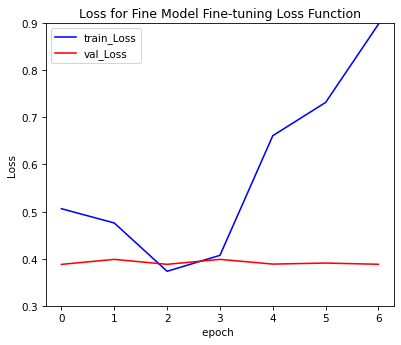

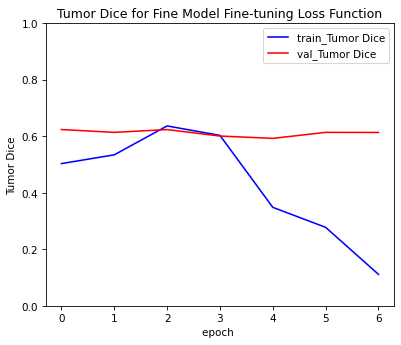

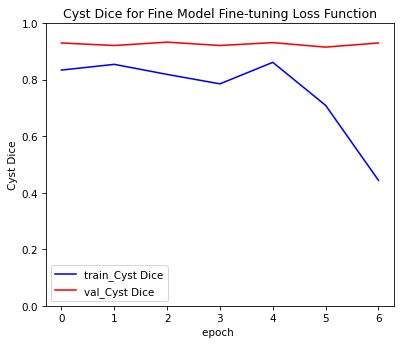

In [82]:
# replace loss function model130

    
train_loss_mean = []
val_loss_mean = []
for i in range(7):
    temp_train_loss = torch.load(f'model/model130/loss_fine_train_epoch8_{i}')
    temp_val_loss = torch.load(f'model/model130/loss_fine_val_epoch8_{i}')
    train_loss_mean.append(torch.mean(temp_train_loss))
    val_loss_mean.append(torch.mean(temp_val_loss))
    
train_dice_tumor = []
train_dice_cyst = []
val_dice_tumor = []
val_dice_cyst = []
for i in range(7):
    temp_train_dice_tumor = torch.load(f'model/model130/dice_fine_train_tumor_epoch8_{i}')
    temp_val_dice_tumor = torch.load(f'model/model130/dice_fine_val_tumor_epoch8_{i}')
    temp_train_dice_cyst = torch.load(f'model/model130/dice_fine_train_cyst_epoch8_{i}')
    temp_val_dice_cyst = torch.load(f'model/model130/dice_fine_val_cyst_epoch8_{i}')
    train_dice_tumor.append(torch.mean(temp_train_dice_tumor))
    val_dice_tumor.append(torch.mean(temp_val_dice_tumor))
    train_dice_cyst.append(torch.mean(temp_train_dice_cyst))
    val_dice_cyst.append(torch.mean(temp_val_dice_cyst))


print(max(val_dice_tumor))
print(max(val_dice_cyst))
#print(val_dice_tumor[9])
plot_loss_combine(train_loss_mean,val_loss_mean,0.3,0.9,'Loss','for Fine Model Fine-tuning Loss Function')
plot_loss_combine(train_dice_tumor,val_dice_tumor,0,1,'Tumor Dice','for Fine Model Fine-tuning Loss Function')
plot_loss_combine(train_dice_cyst,val_dice_cyst,0,1,'Cyst Dice','for Fine Model Fine-tuning Loss Function')

[tensor(0.9292, dtype=torch.float64), tensor(0.9292, dtype=torch.float64), tensor(0.9292, dtype=torch.float64), tensor(0.9292, dtype=torch.float64), tensor(0.9292, dtype=torch.float64), tensor(0.9292, dtype=torch.float64)]
0.7919
tensor(0.9292, dtype=torch.float64)


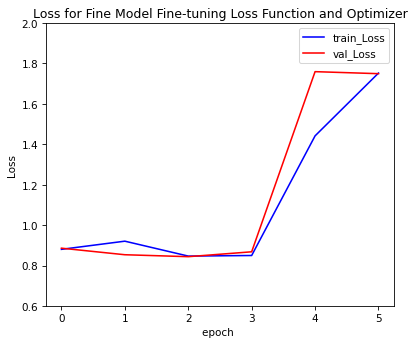

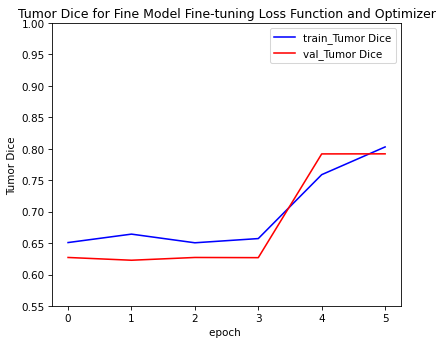

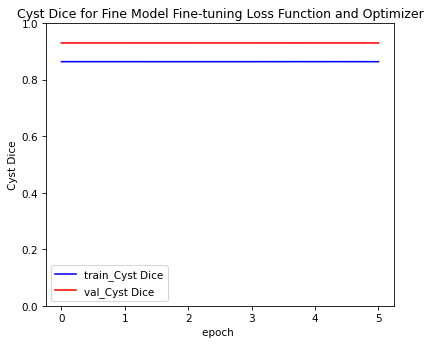

In [6]:
#model200 fine tuning loss, optimizer, softmax
train_loss_mean = []
val_loss_mean = []
for i in range(6):
    temp_train_loss = torch.load(f'model/model200/loss_fine_train_epoch10_{i}')
    temp_val_loss = torch.load(f'model/model200/loss_fine_val_epoch10_{i}')
    train_loss_mean.append(torch.mean(temp_train_loss))
    val_loss_mean.append(torch.mean(temp_val_loss))

train_dice_kidney = []    
train_dice_tumor = []
train_dice_cyst = []
val_dice_kidney = []
val_dice_tumor = []
val_dice_cyst = []
for i in range(6):
    temp_train_dice_kidney = torch.load(f'model/model200/dice_fine_train_kidney_epoch10_{i}')
    temp_train_dice_tumor = torch.load(f'model/model200/dice_fine_train_tumor_epoch10_{i}')
    temp_val_dice_kidney = torch.load(f'model/model200/dice_fine_val_kidney_epoch10_{i}')
    temp_val_dice_tumor = torch.load(f'model/model200/dice_fine_val_tumor_epoch10_{i}')
    temp_train_dice_cyst = torch.load(f'model/model200/dice_fine_train_cyst_epoch10_{i}')
    temp_val_dice_cyst = torch.load(f'model/model200/dice_fine_val_cyst_epoch10_{i}')
    
    train_dice_kidney.append(torch.mean(temp_train_dice_kidney))
    train_dice_tumor.append(torch.mean(temp_train_dice_tumor))
    val_dice_kidney.append(torch.mean(temp_val_dice_kidney))
    val_dice_tumor.append(torch.mean(temp_val_dice_tumor))
    train_dice_cyst.append(torch.mean(temp_train_dice_cyst))
    val_dice_cyst.append(torch.mean(temp_val_dice_cyst))

print(val_dice_cyst)
print(max(val_dice_tumor))
print(max(val_dice_cyst))
#print(val_dice_tumor[9])
plot_loss_combine(train_loss_mean,val_loss_mean,0.6,2,'Loss','for Fine Model Fine-tuning Loss Function and Optimizer')
#plot_loss_combine(train_dice_kidney,val_dice_kidney,0.1,1,'Kidney Dice','for Fine Model Fine-tuning Loss Function and Optimizer')
plot_loss_combine(train_dice_tumor,val_dice_tumor,0.55,1,'Tumor Dice','for Fine Model Fine-tuning Loss Function and Optimizer')
plot_loss_combine(train_dice_cyst,val_dice_cyst,0,1,'Cyst Dice','for Fine Model Fine-tuning Loss Function and Optimizer')

In [32]:
# test model     
img_path = 'D:/MScProject/project/00278_img/img63.png'
seg_path = 'D:/MScProject/project/00278_seg/seg63.png'
transform = transforms.Compose(
    [ transforms.ToTensor()])

img=cv2.imread(img_path)
img = img[:,:,0]
print(type(img))
#showImg(img)
img_tensor=transform(img).to(device)
#print(img_tensor.shape)
img_data=torch.unsqueeze(img_tensor,dim=0)

seg=cv2.imread(seg_path)
seg = seg[:,:,0]
#seg_data = torch.load(seg_path)
#print(seg.shape)
seg_data=transform(seg).to(device)


with torch.no_grad():
    net=UNet_fine3().to(device)
    net.load_state_dict(torch.load('model/model210/model210_epoch4.pth'))
    net.eval()
    out=net(img_data)
    out=out.softmax(dim=1)


#print(img_data.shape)
print(seg_data.shape)
#out_img=out[:,1,:,:]
print(out.shape)
#print(out[0,1,:,:])

k=55
img = torch.stack([img_data[0,:,:],seg_data[:,:,:],out[:,1,:,:]], dim=0)
#print(type(mask_normal(out[:,0,:,:])))
#print(mask_normal(out[:,0,:,:]))
#img = torch.stack([img_tensor,out[:,0,:,:],out[:,1,:,:]], dim=0) #seg_data,,mask_normal(out[:,0,:,:])


save_image(img, f'img/{k}.png')
#print(type(label_normal(seg_data[0,:,:].cpu())))
dice2 = dice(mask_normal(out[0,1,:,:].cpu()),torch.Tensor(label_normal(seg_data[0,:,:].cpu())))
print(f'finished.{dice2}')


<class 'numpy.ndarray'>
torch.Size([1, 512, 512])
torch.Size([1, 4, 512, 512])
finished.1.7388279704988463e-09


In [62]:
def extractRawData(img_path): #extract img from nii
    img_obj = nib.load(img_path)
    img_data = img_obj.get_fdata()
    for i in range(img_data.shape[0]):
        silce = img_data[i,:,:]         
        imageio.imwrite(f'00275_img/img{i}.png',silce)

        
    print('finished')
    
def extractSegData(seg_path): #extract segmentation from nii
    seg_obj = nib.load(seg_path)
    seg_data = seg_obj.get_fdata()
    for i in range(seg_data.shape[0]):
        silce = seg_data[i,:,:]         
        imageio.imwrite(f'00275_seg/seg{i}.png',silce)

        
    print('finished')

#extractRawData("D:/MScProject/kits21-master/kits21/data/case_00275/imaging.nii.gz")
#extractSegData("D:/MScProject/kits21-master/kits21/data/case_00275/aggregated_AND_seg.nii.gz")

In [14]:
# extract fine segmentation origin images
def extract_img(start,end,dir_path,batch_size):
    # validation
    #m=15512
    m=0
    start_id = start
    val_range = end-start

    for i in range(val_range):
        val_set = ValDataset(dir_path=dir_path,start=start_id, end=start_id+1) 
        val_set = DataLoader(val_set, batch_size=batch_size, shuffle=False)

      
        for batch, data in enumerate(val_set):
            labels = data['label'].to(device)
            inputs = data['input'].to(device)
            #print(labels.shape)
            #print(inputs.shape)
            labels = labels[0,1,:,:]
            if labels.max()!= 0:
                inputs = torch_normal(inputs[0,0,:,:])
                outputs = inputs*labels
                save_image(inputs, f'fine_seg/test/{m}_ori.png')                                        
                save_image(outputs, f'fine_seg/test/{m}_nor.png')
                print(f'img{m}saved,id:{start_id}, batch:{batch}')
                m+=1
                
                
                    
        start_id += 1
    print('All finished!')
    #return dice_arr



dir_path = 'D:/MScProject/kits21-master/kits21/data/case_00*'
batch_size = 1
extract_img(8,9,dir_path,batch_size)
#13848: 0-159
#15511: 162-200

img0saved,id:8, batch:115
img1saved,id:8, batch:116
img2saved,id:8, batch:117
img3saved,id:8, batch:118
img4saved,id:8, batch:119
img5saved,id:8, batch:120
img6saved,id:8, batch:121
img7saved,id:8, batch:122
img8saved,id:8, batch:123
img9saved,id:8, batch:124
img10saved,id:8, batch:125
img11saved,id:8, batch:126
img12saved,id:8, batch:127
img13saved,id:8, batch:128
img14saved,id:8, batch:129
img15saved,id:8, batch:130
img16saved,id:8, batch:131
img17saved,id:8, batch:132
img18saved,id:8, batch:133
img19saved,id:8, batch:134
img20saved,id:8, batch:135
img21saved,id:8, batch:136
img22saved,id:8, batch:137
img23saved,id:8, batch:138
img24saved,id:8, batch:139
img25saved,id:8, batch:140
img26saved,id:8, batch:141
img27saved,id:8, batch:142
img28saved,id:8, batch:143
img29saved,id:8, batch:144
img30saved,id:8, batch:145
img31saved,id:8, batch:146
img32saved,id:8, batch:147
img33saved,id:8, batch:148
img34saved,id:8, batch:149
img35saved,id:8, batch:150
img36saved,id:8, batch:151
img37saved,

In [10]:
class Dataset_extractLabel(torch.utils.data.Dataset):
    def __init__(self, dir_path, start, end, mode="AND"): # , ,transform
        #self.transform = transform
        self.mode = mode
        self.dir_path = dir_path
        self.start = start
        self.end = end

        self.input_dic = []
        self.label_dic = []
        self.make_dict()

    def select_mode(self):
        path_dict = {
            'AND': glob(os.path.join(self.dir_path, 'aggregated_AND_seg.nii.gz')),
            'OR': glob(os.path.join(self.dir_path, 'aggregated_OR_seg.nii.gz')),
            'MAJ': glob(os.path.join(self.dir_path, 'aggregated_MAJ_seg.nii.gz'))
        }

        return path_dict[self.mode]

    def one_hot(self, label, one_hot_arr, labels=np.array([0,1,2,3])): # label.shape -> (512,512), one_hot_arr.shape -> np.zero(2,512,512)
        for i in range(0, 4):
            #label = label_normal(label)
            seg_ = label == labels[i]            
            one_hot_arr[i, :, :] = seg_[0:label.shape[0], 0:label.shape[1]]

        return one_hot_arr



    def normalize_img(self, img):
        img = img.astype("float32")
        min_perc, max_perc = np.percentile(img, 10), np.percentile(img, 90)
        img_valid = img[(img > min_perc) & (img < max_perc)]
        mean, std = img_valid.mean(), img_valid.std()
        img = (img - mean) / std
        return img

    def get_data(self, num):
        input_path = glob(os.path.join(self.dir_path, 'imaging.nii.gz'))
        label_path = self.select_mode()

        input_data = nib.load(input_path[num]).get_fdata()  # get numpy data
        label_data = nib.load(label_path[num]).get_fdata()

        for i in input_data:
            i = self.normalize_img(i)  
            i = i[np.newaxis, :, :]  
            i = torch.from_numpy(i)
            self.input_dic.append(i)


        for i in label_data:
            one_hot_arr = np.zeros((len(np.array([0,1,2,3])), 512, 512))
            #i = self.one_hot(i, one_hot_arr)  # 4 one-hot encoding + 3
            #i = torch.from_numpy(i)
            self.label_dic.append(self.one_hot(i, one_hot_arr))
        # print(self.label_dic[0].shape)


    def make_dict(self):
        for i in range(self.start, self.end):
            self.get_data(i)

    def __len__(self):
        return len(self.label_dic)

    def __getitem__(self, index):                  
        data = {'input': torch.tensor(np.array(self.input_dic[index])),
                'label': torch.tensor(self.label_dic[index])}

        return data

In [11]:
# extract fine segmentation origin images
def extract_label(start,end,dir_path,batch_size):
    # validation
    #m=13849
    m=0
    start_id = start
    val_range = end-start

    for i in range(val_range):
        val_set = Dataset_extractLabel(dir_path=dir_path,start=start_id, end=start_id+1) 
        val_set = DataLoader(val_set, batch_size=batch_size, shuffle=False)

      
        for batch, data in enumerate(val_set):
            labels = data['label'].to(device)
            inputs = data['input'].to(device)
            #print(labels.shape)
            #print(inputs.shape)
            labels = labels[0,:,:,:]

            if labels[1,:,:].max()!= 0 or labels[2,:,:].max()!= 0 or labels[3,:,:].max()!= 0:
                #inputs = torch_normal(inputs[0,0,:,:])
                torch.save(labels, f'fine_seg/val_label/{m}.pt')
                                                        
                #save_image(outputs, )
                print(f'label{m} saved,id:{start_id}, batch:{batch}')
                m+=1
                #break
                
                
                    
        start_id += 1
    print('All finished!')
    #return dice_arr



dir_path = 'D:/MScProject/kits21-master/kits21/data/case_00*'
batch_size = 1
extract_label(250,299,dir_path,batch_size)


label0 saved,id:250, batch:14
label1 saved,id:250, batch:15
label2 saved,id:250, batch:16
label3 saved,id:250, batch:17
label4 saved,id:250, batch:18
label5 saved,id:250, batch:19
label6 saved,id:250, batch:20
label7 saved,id:250, batch:21
label8 saved,id:250, batch:22
label9 saved,id:250, batch:23
label10 saved,id:250, batch:24
label11 saved,id:250, batch:25
label12 saved,id:250, batch:26
label13 saved,id:250, batch:27
label14 saved,id:250, batch:28
label15 saved,id:250, batch:29
label16 saved,id:250, batch:30
label17 saved,id:250, batch:31
label18 saved,id:250, batch:32
label19 saved,id:250, batch:33
label20 saved,id:250, batch:34
label21 saved,id:250, batch:35
label22 saved,id:251, batch:27
label23 saved,id:251, batch:28
label24 saved,id:251, batch:29
label25 saved,id:251, batch:30
label26 saved,id:251, batch:31
label27 saved,id:251, batch:32
label28 saved,id:251, batch:33
label29 saved,id:251, batch:34
label30 saved,id:251, batch:35
label31 saved,id:251, batch:36
label32 saved,id:2

label260 saved,id:253, batch:194
label261 saved,id:253, batch:195
label262 saved,id:253, batch:196
label263 saved,id:253, batch:197
label264 saved,id:253, batch:198
label265 saved,id:253, batch:199
label266 saved,id:253, batch:200
label267 saved,id:253, batch:201
label268 saved,id:253, batch:202
label269 saved,id:253, batch:203
label270 saved,id:253, batch:204
label271 saved,id:253, batch:205
label272 saved,id:253, batch:206
label273 saved,id:253, batch:207
label274 saved,id:253, batch:208
label275 saved,id:253, batch:209
label276 saved,id:253, batch:210
label277 saved,id:253, batch:211
label278 saved,id:253, batch:212
label279 saved,id:253, batch:213
label280 saved,id:253, batch:214
label281 saved,id:253, batch:215
label282 saved,id:253, batch:216
label283 saved,id:253, batch:217
label284 saved,id:253, batch:218
label285 saved,id:253, batch:219
label286 saved,id:253, batch:220
label287 saved,id:253, batch:221
label288 saved,id:253, batch:222
label289 saved,id:253, batch:223
label290 s

label522 saved,id:260, batch:40
label523 saved,id:260, batch:41
label524 saved,id:260, batch:42
label525 saved,id:260, batch:43
label526 saved,id:260, batch:44
label527 saved,id:260, batch:45
label528 saved,id:260, batch:46
label529 saved,id:260, batch:47
label530 saved,id:260, batch:48
label531 saved,id:260, batch:49
label532 saved,id:260, batch:50
label533 saved,id:260, batch:51
label534 saved,id:260, batch:52
label535 saved,id:260, batch:53
label536 saved,id:260, batch:54
label537 saved,id:260, batch:55
label538 saved,id:260, batch:56
label539 saved,id:260, batch:57
label540 saved,id:260, batch:58
label541 saved,id:260, batch:59
label542 saved,id:260, batch:60
label543 saved,id:260, batch:61
label544 saved,id:260, batch:62
label545 saved,id:260, batch:63
label546 saved,id:260, batch:64
label547 saved,id:260, batch:65
label548 saved,id:260, batch:66
label549 saved,id:260, batch:67
label550 saved,id:260, batch:68
label551 saved,id:260, batch:69
label552 saved,id:260, batch:70
label553

label776 saved,id:260, batch:294
label777 saved,id:260, batch:295
label778 saved,id:260, batch:296
label779 saved,id:260, batch:297
label780 saved,id:260, batch:298
label781 saved,id:260, batch:299
label782 saved,id:260, batch:300
label783 saved,id:260, batch:301
label784 saved,id:260, batch:302
label785 saved,id:260, batch:303
label786 saved,id:260, batch:304
label787 saved,id:260, batch:305
label788 saved,id:260, batch:306
label789 saved,id:260, batch:307
label790 saved,id:260, batch:308
label791 saved,id:260, batch:309
label792 saved,id:260, batch:310
label793 saved,id:260, batch:311
label794 saved,id:260, batch:312
label795 saved,id:260, batch:313
label796 saved,id:260, batch:314
label797 saved,id:260, batch:315
label798 saved,id:260, batch:316
label799 saved,id:260, batch:317
label800 saved,id:260, batch:318
label801 saved,id:260, batch:319
label802 saved,id:260, batch:320
label803 saved,id:260, batch:321
label804 saved,id:260, batch:322
label805 saved,id:260, batch:323
label806 s

label1032 saved,id:262, batch:303
label1033 saved,id:262, batch:304
label1034 saved,id:262, batch:305
label1035 saved,id:262, batch:306
label1036 saved,id:262, batch:307
label1037 saved,id:262, batch:308
label1038 saved,id:262, batch:309
label1039 saved,id:262, batch:310
label1040 saved,id:262, batch:311
label1041 saved,id:262, batch:312
label1042 saved,id:262, batch:313
label1043 saved,id:262, batch:314
label1044 saved,id:262, batch:315
label1045 saved,id:262, batch:316
label1046 saved,id:262, batch:317
label1047 saved,id:262, batch:318
label1048 saved,id:262, batch:319
label1049 saved,id:262, batch:320
label1050 saved,id:262, batch:321
label1051 saved,id:262, batch:322
label1052 saved,id:262, batch:323
label1053 saved,id:262, batch:324
label1054 saved,id:262, batch:325
label1055 saved,id:262, batch:326
label1056 saved,id:262, batch:327
label1057 saved,id:262, batch:328
label1058 saved,id:262, batch:329
label1059 saved,id:262, batch:330
label1060 saved,id:262, batch:331
label1061 save

label1277 saved,id:265, batch:35
label1278 saved,id:265, batch:36
label1279 saved,id:265, batch:37
label1280 saved,id:265, batch:38
label1281 saved,id:266, batch:14
label1282 saved,id:266, batch:15
label1283 saved,id:266, batch:16
label1284 saved,id:266, batch:17
label1285 saved,id:266, batch:18
label1286 saved,id:266, batch:19
label1287 saved,id:266, batch:20
label1288 saved,id:266, batch:21
label1289 saved,id:266, batch:22
label1290 saved,id:266, batch:23
label1291 saved,id:266, batch:24
label1292 saved,id:266, batch:25
label1293 saved,id:266, batch:26
label1294 saved,id:266, batch:27
label1295 saved,id:266, batch:28
label1296 saved,id:266, batch:29
label1297 saved,id:266, batch:30
label1298 saved,id:266, batch:31
label1299 saved,id:266, batch:32
label1300 saved,id:266, batch:33
label1301 saved,id:266, batch:34
label1302 saved,id:266, batch:35
label1303 saved,id:266, batch:36
label1304 saved,id:266, batch:37
label1305 saved,id:266, batch:38
label1306 saved,id:266, batch:39
label1307 

label1528 saved,id:270, batch:101
label1529 saved,id:270, batch:102
label1530 saved,id:270, batch:103
label1531 saved,id:270, batch:104
label1532 saved,id:270, batch:105
label1533 saved,id:270, batch:106
label1534 saved,id:270, batch:107
label1535 saved,id:270, batch:108
label1536 saved,id:270, batch:109
label1537 saved,id:270, batch:110
label1538 saved,id:270, batch:111
label1539 saved,id:270, batch:112
label1540 saved,id:270, batch:113
label1541 saved,id:270, batch:114
label1542 saved,id:270, batch:115
label1543 saved,id:270, batch:116
label1544 saved,id:270, batch:117
label1545 saved,id:270, batch:118
label1546 saved,id:270, batch:119
label1547 saved,id:270, batch:120
label1548 saved,id:270, batch:121
label1549 saved,id:270, batch:122
label1550 saved,id:270, batch:123
label1551 saved,id:270, batch:124
label1552 saved,id:270, batch:125
label1553 saved,id:270, batch:126
label1554 saved,id:270, batch:127
label1555 saved,id:270, batch:128
label1556 saved,id:270, batch:129
label1557 save

label1772 saved,id:271, batch:245
label1773 saved,id:271, batch:246
label1774 saved,id:271, batch:247
label1775 saved,id:271, batch:248
label1776 saved,id:271, batch:249
label1777 saved,id:271, batch:250
label1778 saved,id:271, batch:251
label1779 saved,id:271, batch:252
label1780 saved,id:271, batch:253
label1781 saved,id:271, batch:254
label1782 saved,id:271, batch:255
label1783 saved,id:271, batch:256
label1784 saved,id:271, batch:257
label1785 saved,id:271, batch:258
label1786 saved,id:271, batch:259
label1787 saved,id:271, batch:260
label1788 saved,id:271, batch:261
label1789 saved,id:271, batch:262
label1790 saved,id:271, batch:263
label1791 saved,id:271, batch:264
label1792 saved,id:271, batch:265
label1793 saved,id:271, batch:266
label1794 saved,id:271, batch:267
label1795 saved,id:271, batch:268
label1796 saved,id:271, batch:269
label1797 saved,id:271, batch:270
label1798 saved,id:271, batch:271
label1799 saved,id:271, batch:272
label1800 saved,id:271, batch:273
label1801 save

label2019 saved,id:272, batch:122
label2020 saved,id:272, batch:123
label2021 saved,id:272, batch:124
label2022 saved,id:272, batch:125
label2023 saved,id:272, batch:126
label2024 saved,id:272, batch:127
label2025 saved,id:272, batch:128
label2026 saved,id:272, batch:129
label2027 saved,id:272, batch:130
label2028 saved,id:272, batch:131
label2029 saved,id:272, batch:132
label2030 saved,id:272, batch:133
label2031 saved,id:272, batch:134
label2032 saved,id:272, batch:135
label2033 saved,id:272, batch:136
label2034 saved,id:272, batch:137
label2035 saved,id:272, batch:138
label2036 saved,id:272, batch:139
label2037 saved,id:272, batch:140
label2038 saved,id:272, batch:141
label2039 saved,id:272, batch:142
label2040 saved,id:272, batch:143
label2041 saved,id:272, batch:144
label2042 saved,id:272, batch:145
label2043 saved,id:272, batch:146
label2044 saved,id:272, batch:147
label2045 saved,id:272, batch:148
label2046 saved,id:272, batch:149
label2047 saved,id:272, batch:150
label2048 save

label2270 saved,id:275, batch:162
label2271 saved,id:275, batch:163
label2272 saved,id:275, batch:164
label2273 saved,id:275, batch:165
label2274 saved,id:275, batch:166
label2275 saved,id:275, batch:167
label2276 saved,id:275, batch:168
label2277 saved,id:275, batch:169
label2278 saved,id:275, batch:170
label2279 saved,id:275, batch:171
label2280 saved,id:275, batch:172
label2281 saved,id:275, batch:173
label2282 saved,id:275, batch:174
label2283 saved,id:275, batch:175
label2284 saved,id:275, batch:176
label2285 saved,id:275, batch:177
label2286 saved,id:275, batch:178
label2287 saved,id:275, batch:179
label2288 saved,id:275, batch:180
label2289 saved,id:275, batch:181
label2290 saved,id:275, batch:182
label2291 saved,id:275, batch:183
label2292 saved,id:275, batch:184
label2293 saved,id:275, batch:185
label2294 saved,id:275, batch:186
label2295 saved,id:275, batch:187
label2296 saved,id:275, batch:188
label2297 saved,id:275, batch:189
label2298 saved,id:275, batch:190
label2299 save

label2521 saved,id:279, batch:33
label2522 saved,id:279, batch:34
label2523 saved,id:279, batch:35
label2524 saved,id:279, batch:36
label2525 saved,id:279, batch:37
label2526 saved,id:279, batch:38
label2527 saved,id:279, batch:39
label2528 saved,id:279, batch:40
label2529 saved,id:280, batch:130
label2530 saved,id:280, batch:131
label2531 saved,id:280, batch:132
label2532 saved,id:280, batch:133
label2533 saved,id:280, batch:134
label2534 saved,id:280, batch:135
label2535 saved,id:280, batch:136
label2536 saved,id:280, batch:137
label2537 saved,id:280, batch:138
label2538 saved,id:280, batch:139
label2539 saved,id:280, batch:140
label2540 saved,id:280, batch:141
label2541 saved,id:280, batch:142
label2542 saved,id:280, batch:143
label2543 saved,id:280, batch:144
label2544 saved,id:280, batch:145
label2545 saved,id:280, batch:146
label2546 saved,id:280, batch:147
label2547 saved,id:280, batch:148
label2548 saved,id:280, batch:149
label2549 saved,id:280, batch:150
label2550 saved,id:280

label2767 saved,id:282, batch:232
label2768 saved,id:282, batch:233
label2769 saved,id:282, batch:234
label2770 saved,id:282, batch:235
label2771 saved,id:282, batch:236
label2772 saved,id:282, batch:237
label2773 saved,id:282, batch:238
label2774 saved,id:282, batch:239
label2775 saved,id:282, batch:240
label2776 saved,id:282, batch:241
label2777 saved,id:282, batch:242
label2778 saved,id:282, batch:243
label2779 saved,id:282, batch:244
label2780 saved,id:282, batch:245
label2781 saved,id:282, batch:246
label2782 saved,id:282, batch:247
label2783 saved,id:283, batch:126
label2784 saved,id:283, batch:127
label2785 saved,id:283, batch:128
label2786 saved,id:283, batch:129
label2787 saved,id:283, batch:130
label2788 saved,id:283, batch:131
label2789 saved,id:283, batch:132
label2790 saved,id:283, batch:133
label2791 saved,id:283, batch:134
label2792 saved,id:283, batch:135
label2793 saved,id:283, batch:136
label2794 saved,id:283, batch:137
label2795 saved,id:283, batch:138
label2796 save

label3013 saved,id:287, batch:181
label3014 saved,id:287, batch:182
label3015 saved,id:287, batch:183
label3016 saved,id:287, batch:184
label3017 saved,id:287, batch:185
label3018 saved,id:287, batch:186
label3019 saved,id:287, batch:187
label3020 saved,id:287, batch:188
label3021 saved,id:287, batch:189
label3022 saved,id:287, batch:190
label3023 saved,id:287, batch:191
label3024 saved,id:287, batch:192
label3025 saved,id:287, batch:193
label3026 saved,id:287, batch:194
label3027 saved,id:287, batch:195
label3028 saved,id:287, batch:196
label3029 saved,id:287, batch:197
label3030 saved,id:287, batch:198
label3031 saved,id:287, batch:199
label3032 saved,id:287, batch:200
label3033 saved,id:287, batch:201
label3034 saved,id:287, batch:202
label3035 saved,id:287, batch:203
label3036 saved,id:287, batch:204
label3037 saved,id:287, batch:205
label3038 saved,id:287, batch:206
label3039 saved,id:287, batch:207
label3040 saved,id:287, batch:208
label3041 saved,id:287, batch:209
label3042 save

label3261 saved,id:289, batch:406
label3262 saved,id:289, batch:407
label3263 saved,id:289, batch:408
label3264 saved,id:289, batch:409
label3265 saved,id:289, batch:410
label3266 saved,id:289, batch:411
label3267 saved,id:289, batch:412
label3268 saved,id:289, batch:413
label3269 saved,id:289, batch:414
label3270 saved,id:289, batch:415
label3271 saved,id:289, batch:416
label3272 saved,id:289, batch:417
label3273 saved,id:289, batch:418
label3274 saved,id:289, batch:419
label3275 saved,id:289, batch:420
label3276 saved,id:289, batch:421
label3277 saved,id:289, batch:422
label3278 saved,id:289, batch:423
label3279 saved,id:289, batch:424
label3280 saved,id:289, batch:425
label3281 saved,id:289, batch:426
label3282 saved,id:289, batch:427
label3283 saved,id:289, batch:428
label3284 saved,id:289, batch:429
label3285 saved,id:289, batch:430
label3286 saved,id:289, batch:431
label3287 saved,id:289, batch:432
label3288 saved,id:289, batch:433
label3289 saved,id:289, batch:434
label3290 save

label3509 saved,id:292, batch:231
label3510 saved,id:292, batch:232
label3511 saved,id:292, batch:233
label3512 saved,id:292, batch:234
label3513 saved,id:292, batch:235
label3514 saved,id:292, batch:236
label3515 saved,id:292, batch:237
label3516 saved,id:292, batch:238
label3517 saved,id:292, batch:239
label3518 saved,id:292, batch:240
label3519 saved,id:292, batch:241
label3520 saved,id:292, batch:242
label3521 saved,id:292, batch:243
label3522 saved,id:292, batch:244
label3523 saved,id:292, batch:245
label3524 saved,id:292, batch:246
label3525 saved,id:292, batch:247
label3526 saved,id:292, batch:248
label3527 saved,id:292, batch:249
label3528 saved,id:292, batch:250
label3529 saved,id:292, batch:251
label3530 saved,id:292, batch:252
label3531 saved,id:292, batch:253
label3532 saved,id:292, batch:254
label3533 saved,id:292, batch:255
label3534 saved,id:292, batch:256
label3535 saved,id:292, batch:257
label3536 saved,id:292, batch:258
label3537 saved,id:292, batch:259
label3538 save

label3754 saved,id:293, batch:272
label3755 saved,id:293, batch:273
label3756 saved,id:293, batch:274
label3757 saved,id:293, batch:275
label3758 saved,id:293, batch:276
label3759 saved,id:293, batch:277
label3760 saved,id:293, batch:278
label3761 saved,id:293, batch:279
label3762 saved,id:293, batch:280
label3763 saved,id:293, batch:281
label3764 saved,id:293, batch:282
label3765 saved,id:293, batch:283
label3766 saved,id:293, batch:284
label3767 saved,id:293, batch:285
label3768 saved,id:293, batch:286
label3769 saved,id:293, batch:287
label3770 saved,id:293, batch:288
label3771 saved,id:293, batch:289
label3772 saved,id:293, batch:290
label3773 saved,id:293, batch:291
label3774 saved,id:293, batch:292
label3775 saved,id:293, batch:293
label3776 saved,id:293, batch:294
label3777 saved,id:293, batch:295
label3778 saved,id:293, batch:296
label3779 saved,id:293, batch:297
label3780 saved,id:293, batch:298
label3781 saved,id:293, batch:299
label3782 saved,id:293, batch:300
label3783 save

label3999 saved,id:294, batch:220
label4000 saved,id:294, batch:221
label4001 saved,id:294, batch:222
label4002 saved,id:294, batch:223
label4003 saved,id:294, batch:224
label4004 saved,id:294, batch:225
label4005 saved,id:294, batch:226
label4006 saved,id:294, batch:227
label4007 saved,id:294, batch:228
label4008 saved,id:294, batch:229
label4009 saved,id:294, batch:230
label4010 saved,id:294, batch:231
label4011 saved,id:294, batch:232
label4012 saved,id:294, batch:233
label4013 saved,id:294, batch:234
label4014 saved,id:294, batch:235
label4015 saved,id:294, batch:236
label4016 saved,id:294, batch:237
label4017 saved,id:294, batch:238
label4018 saved,id:294, batch:239
label4019 saved,id:294, batch:240
label4020 saved,id:294, batch:241
label4021 saved,id:294, batch:242
label4022 saved,id:294, batch:243
label4023 saved,id:294, batch:244
label4024 saved,id:294, batch:245
label4025 saved,id:294, batch:246
label4026 saved,id:294, batch:247
label4027 saved,id:294, batch:248
label4028 save

label4246 saved,id:297, batch:144
label4247 saved,id:297, batch:145
label4248 saved,id:297, batch:146
label4249 saved,id:297, batch:147
label4250 saved,id:297, batch:148
label4251 saved,id:297, batch:149
label4252 saved,id:297, batch:150
label4253 saved,id:297, batch:151
label4254 saved,id:297, batch:152
label4255 saved,id:297, batch:153
label4256 saved,id:297, batch:154
label4257 saved,id:297, batch:155
label4258 saved,id:297, batch:156
label4259 saved,id:297, batch:157
label4260 saved,id:297, batch:158
label4261 saved,id:297, batch:159
label4262 saved,id:297, batch:160
label4263 saved,id:297, batch:161
label4264 saved,id:297, batch:162
label4265 saved,id:297, batch:163
label4266 saved,id:297, batch:164
label4267 saved,id:297, batch:165
label4268 saved,id:297, batch:166
label4269 saved,id:297, batch:167
label4270 saved,id:297, batch:168
label4271 saved,id:297, batch:169
label4272 saved,id:297, batch:170
label4273 saved,id:297, batch:171
label4274 saved,id:297, batch:172
label4275 save

label4492 saved,id:298, batch:225
label4493 saved,id:298, batch:226
label4494 saved,id:298, batch:227
label4495 saved,id:298, batch:228
label4496 saved,id:298, batch:229
label4497 saved,id:298, batch:230
label4498 saved,id:298, batch:231
label4499 saved,id:298, batch:232
label4500 saved,id:298, batch:233
label4501 saved,id:298, batch:234
label4502 saved,id:298, batch:235
label4503 saved,id:298, batch:236
label4504 saved,id:298, batch:237
label4505 saved,id:298, batch:238
label4506 saved,id:298, batch:239
label4507 saved,id:298, batch:240
label4508 saved,id:298, batch:241
label4509 saved,id:298, batch:242
label4510 saved,id:298, batch:243
label4511 saved,id:298, batch:244
label4512 saved,id:298, batch:245
label4513 saved,id:298, batch:246
label4514 saved,id:298, batch:247
label4515 saved,id:298, batch:248
label4516 saved,id:298, batch:249
label4517 saved,id:298, batch:250
label4518 saved,id:298, batch:251
label4519 saved,id:298, batch:252
label4520 saved,id:298, batch:253
label4521 save